In [1]:
#hide
! [ -e /content ] && pip install -Uqq fastbook
import fastbook
fastbook.setup_book()

/root/mambaforge/lib/python3.10/site-packages/fastbook/__init__.py:13: UserWarning: Missing `sentencepiece` - please run `pip install 'sentencepiece<0.1.90'`
  except ModuleNotFoundError: warn("Missing `sentencepiece` - please run `pip install 'sentencepiece<0.1.90'`")


In [2]:
#hide
from fastbook import *

# Collaborative Filtering Deep Dive

## A First Look at the Data

In [3]:
from fastai.collab import *
from fastai.tabular.all import *
path = untar_data(URLs.ML_100k)

In [ ]:
ratings = pd.read_csv(path/'u.data', delimiter='\t', header=None,
                      names=['user','movie','rating','timestamp'])
ratings.head()

In [ ]:
last_skywalker = np.array([0.98,0.9,-0.9])

In [ ]:
user1 = np.array([0.9,0.8,-0.6])

In [ ]:
(user1*last_skywalker).sum()

In [ ]:
casablanca = np.array([-0.99,-0.3,0.8])

In [ ]:
(user1*casablanca).sum()

## Learning the Latent Factors

## Creating the DataLoaders

In [ ]:
movies = pd.read_csv(path/'u.item',  delimiter='|', encoding='latin-1',
                     usecols=(0,1), names=('movie','title'), header=None)
movies.head()

In [ ]:
ratings = ratings.merge(movies)
ratings.head()

In [ ]:
dls = CollabDataLoaders.from_df(ratings, item_name='title', bs=64)
dls.show_batch()

In [ ]:
dls.classes

In [ ]:
n_users  = len(dls.classes['user'])
n_movies = len(dls.classes['title'])
n_factors = 5

user_factors = torch.randn(n_users, n_factors)
movie_factors = torch.randn(n_movies, n_factors)

In [ ]:
one_hot_3 = one_hot(3, n_users).float()

In [ ]:
user_factors.t() @ one_hot_3

In [ ]:
user_factors[3]

## Collaborative Filtering from Scratch

In [ ]:
class Example:
    def __init__(self, a): self.a = a
    def say(self,x): return f'Hello {self.a}, {x}.'

In [ ]:
ex = Example('Sylvain')
ex.say('nice to meet you')

In [ ]:
class DotProduct(Module):
    def __init__(self, n_users, n_movies, n_factors):
        self.user_factors = Embedding(n_users, n_factors)
        self.movie_factors = Embedding(n_movies, n_factors)
        
    def forward(self, x):
        users = self.user_factors(x[:,0])
        movies = self.movie_factors(x[:,1])
        return (users * movies).sum(dim=1)

In [ ]:
x,y = dls.one_batch()
x.shape

In [ ]:
model = DotProduct(n_users, n_movies, 50)
learn = Learner(dls, model, loss_func=MSELossFlat())

In [ ]:
learn.fit_one_cycle(5, 5e-3)

In [ ]:
class DotProduct(Module):
    def __init__(self, n_users, n_movies, n_factors, y_range=(0,5.5)):
        self.user_factors = Embedding(n_users, n_factors)
        self.movie_factors = Embedding(n_movies, n_factors)
        self.y_range = y_range
        
    def forward(self, x):
        users = self.user_factors(x[:,0])
        movies = self.movie_factors(x[:,1])
        return sigmoid_range((users * movies).sum(dim=1), *self.y_range)

In [ ]:
model = DotProduct(n_users, n_movies, 50)
learn = Learner(dls, model, loss_func=MSELossFlat())
learn.fit_one_cycle(5, 5e-3)

In [ ]:
class DotProductBias(Module):
    def __init__(self, n_users, n_movies, n_factors, y_range=(0,5.5)):
        self.user_factors = Embedding(n_users, n_factors)
        self.user_bias = Embedding(n_users, 1)
        self.movie_factors = Embedding(n_movies, n_factors)
        self.movie_bias = Embedding(n_movies, 1)
        self.y_range = y_range
        
    def forward(self, x):
        users = self.user_factors(x[:,0])
        movies = self.movie_factors(x[:,1])
        res = (users * movies).sum(dim=1, keepdim=True)
        res += self.user_bias(x[:,0]) + self.movie_bias(x[:,1])
        return sigmoid_range(res, *self.y_range)

In [ ]:
model = DotProductBias(n_users, n_movies, 50)
learn = Learner(dls, model, loss_func=MSELossFlat())
learn.fit_one_cycle(5, 5e-3)

### Weight Decay

In [ ]:
x = np.linspace(-2,2,100)
a_s = [1,2,5,10,50] 
ys = [a * x**2 for a in a_s]
_,ax = plt.subplots(figsize=(8,6))
for a,y in zip(a_s,ys): ax.plot(x,y, label=f'a={a}')
ax.set_ylim([0,5])
ax.legend();

In [ ]:
model = DotProductBias(n_users, n_movies, 50)
learn = Learner(dls, model, loss_func=MSELossFlat())
learn.fit_one_cycle(5, 5e-3, wd=0.1)

### Creating Our Own Embedding Module

In [4]:
class T(Module):
    def __init__(self): self.a = torch.ones(3)

L(T().parameters())

(#0) []

In [7]:
class T(Module):
    def __init__(self): self.b = nn.Parameter(torch.ones(3))

L(T().parameters())

(#1) [Parameter containing:
tensor([1., 1., 1.], requires_grad=True)]

In [16]:
class T(Module):
    def __init__(self): self.z = nn.Linear(1, 3, bias=False)

t = T()
L(t.parameters())

# nn.Linear??
# L??

(#1) [Parameter containing:
tensor([[-0.1173],
        [-0.4062],
        [ 0.6634]], requires_grad=True)]

In [11]:
type(t.z.weight)

torch.nn.parameter.Parameter

In [22]:
def create_params(size):
    return nn.Parameter(torch.zeros(*size).normal_(0, 0.01))

In [60]:
class DotProductBias(Module):
    def __init__(self, n_users, n_movies, n_factors, y_range=(0,5.5)):
        self.user_factors = create_params([n_users, n_factors])
        self.user_bias = create_params([n_users])
        self.movie_factors = create_params([n_movies, n_factors])
        self.movie_bias = create_params([n_movies])
        self.y_range = y_range
        
    def forward(self, x):
        print("x: ", x)
        users = self.user_factors[x[:,0]]
        movies = self.movie_factors[x[:,1]]
        print("users, movies ", users, movies)
        res = (users*movies).sum(dim=1)
        print("res ", res.shape, res)
        res += self.user_bias[x[:,0]] + self.movie_bias[x[:,1]]
        return sigmoid_range(res, *self.y_range)

In [59]:
from fastai.collab import *
from fastai.tabular.all import *
path = untar_data(URLs.ML_100k)
ratings = pd.read_csv(path/'u.data', delimiter='\t', header=None,
                      names=['user','movie','rating','timestamp'])
movies = pd.read_csv(path/'u.item',  delimiter='|', encoding='latin-1',
                     usecols=(0,1), names=('movie','title'), header=None)
ratings = ratings.merge(movies)
dls = CollabDataLoaders.from_df(ratings, item_name='title', bs=64)
n_users  = len(dls.classes['user'])
n_movies = len(dls.classes['title'])
n_factors = 5

user_factors = torch.randn(n_users, n_factors)
movie_factors = torch.randn(n_movies, n_factors)

create_params([n_movies, 50])
n_movies,torch.zeros(*[n_movies, 50]).normal_(0, 5)
n_users, n_movies
user_factors[:,0].shape

torch.Size([944])

In [61]:
model = DotProductBias(n_users, n_movies, 100)
learn = Learner(dls, model, loss_func=MSELossFlat())
learn.fit_one_cycle(5, 5e-3, wd=0.1)

epoch,train_loss,valid_loss,time
0,0.956631,0.956512,00:08
1,0.850843,0.873274,00:08
2,0.622977,0.836300,00:08
3,0.413901,0.833602,00:08
4,0.271688,0.836140,00:07


x:  tensor([[ 621,  440],
        [ 328, 1177],
        [ 290,  897],
        [ 503, 1028],
        [ 422,  426],
        [ 457,  161],
        [ 336,  965],
        [ 458,  390],
        [ 885,  447],
        [ 752,  208],
        [ 416, 1610],
        [ 734, 1006],
        [ 347,  652],
        [ 436,  241],
        [  15, 1347],
        [ 442, 1049],
        [ 707, 1505],
        [ 608, 1236],
        [ 880,  294],
        [ 405, 1566],
        [ 916,  597],
        [ 393,  393],
        [ 145,  828],
        [  43, 1524],
        [ 188,  374],
        [ 880,  664],
        [ 695,  768],
        [ 913,   45],
        [ 130,  186],
        [ 854,    3],
        [ 361, 1398],
        [  72,  930],
        [ 648, 1031],
        [  98, 1338],
        [ 339, 1366],
        [ 201,  472],
        [ 334, 1316],
        [ 244,  847],
        [ 403,  781],
        [ 200, 1396],
        [ 271, 1399],
        [ 447,  892],
        [ 314, 1373],
        [ 535,  123],
        [ 846,  685],
      

x:  tensor([[ 715,  413],
        [ 561,    7],
        [ 837, 1298],
        [ 870,  725],
        [ 406, 1019],
        [ 392,    4],
        [ 605,  734],
        [ 135,  100],
        [ 267,  263],
        [ 234,  847],
        [ 848,  179],
        [ 541,  798],
        [ 796,  592],
        [ 392,  816],
        [ 500,  114],
        [ 132,  499],
        [ 224,  861],
        [ 280,  390],
        [ 393,  374],
        [ 643,  926],
        [ 333,   88],
        [ 922, 1351],
        [ 551,  890],
        [ 116,  208],
        [ 932, 1293],
        [ 721,  588],
        [ 645,  555],
        [ 883,  153],
        [ 698, 1461],
        [  38,  578],
        [ 854,   28],
        [ 407,   28],
        [ 694,  383],
        [ 666, 1496],
        [  87,  432],
        [ 584, 1598],
        [ 801, 1286],
        [  59,   30],
        [ 468, 1064],
        [ 480, 1591],
        [ 121, 1136],
        [ 829, 1227],
        [ 245,  799],
        [ 838, 1402],
        [  11, 1303],
      

x:  tensor([[ 295,   59],
        [ 311,  896],
        [ 542, 1363],
        [ 222, 1211],
        [ 235,  499],
        [ 184,  760],
        [ 873,  573],
        [ 727,  334],
        [ 846,  278],
        [ 868,   10],
        [  64, 1616],
        [ 234,  697],
        [ 389, 1071],
        [ 342,  890],
        [ 758, 1202],
        [ 303, 1357],
        [ 432, 1525],
        [ 503, 1343],
        [ 460,  613],
        [  59,  210],
        [ 405,  742],
        [ 382, 1634],
        [ 128,  955],
        [ 234,  592],
        [ 622, 1267],
        [ 148,  110],
        [ 497,  334],
        [ 158, 1420],
        [ 764, 1168],
        [ 722, 1207],
        [ 938, 1153],
        [ 880,  318],
        [ 445, 1231],
        [ 885,  315],
        [ 378, 1227],
        [ 654, 1206],
        [ 878,  763],
        [ 781, 1206],
        [ 543, 1400],
        [ 577,  342],
        [ 224, 1506],
        [ 474,  982],
        [  14,  448],
        [ 264,  529],
        [ 293, 1498],
      

x:  tensor([[ 749, 1350],
        [ 864,  781],
        [ 675,  622],
        [ 642,  806],
        [ 766,  923],
        [ 896,  899],
        [ 234,  436],
        [ 295,  918],
        [ 178, 1351],
        [ 722, 1589],
        [ 121, 1508],
        [ 655,  891],
        [ 159,  346],
        [ 592, 1461],
        [ 378, 1202],
        [ 405,  222],
        [ 459,  412],
        [ 535, 1633],
        [ 359, 1544],
        [ 145, 1304],
        [ 798,  630],
        [ 382,  181],
        [ 731, 1468],
        [ 385,  760],
        [ 881,  434],
        [ 907,  306],
        [ 896,  198],
        [ 498, 1009],
        [ 456,  821],
        [ 537,  977],
        [  45,  506],
        [ 535,  581],
        [ 833,  203],
        [  11, 1249],
        [  90,  583],
        [ 328,  133],
        [ 436, 1514],
        [ 457,  758],
        [ 591,  159],
        [ 854,  415],
        [ 655, 1304],
        [ 439,  856],
        [ 119,  137],
        [ 263,  613],
        [ 299,   56],
      

users, movies  tensor([[ 0.0063, -0.0097, -0.0057,  ..., -0.0091, -0.0108,  0.0063],
        [-0.0043, -0.0157, -0.0026,  ...,  0.0081, -0.0045,  0.0130],
        [-0.0206, -0.0042, -0.0142,  ...,  0.0024,  0.0019,  0.0135],
        ...,
        [ 0.0143,  0.0166,  0.0055,  ...,  0.0023,  0.0062,  0.0009],
        [-0.0025,  0.0026,  0.0100,  ..., -0.0095, -0.0126,  0.0039],
        [ 0.0070,  0.0059,  0.0042,  ...,  0.0132, -0.0027,  0.0147]], grad_fn=<IndexBackward0>) tensor([[ 0.0127, -0.0010,  0.0097,  ..., -0.0040,  0.0084,  0.0029],
        [ 0.0118, -0.0052, -0.0040,  ...,  0.0141,  0.0006,  0.0137],
        [ 0.0003,  0.0153,  0.0153,  ...,  0.0049,  0.0006,  0.0206],
        ...,
        [-0.0097,  0.0135,  0.0064,  ...,  0.0081,  0.0028, -0.0003],
        [-0.0135, -0.0078, -0.0252,  ..., -0.0030,  0.0059,  0.0006],
        [-0.0246, -0.0076,  0.0052,  ..., -0.0161,  0.0012, -0.0107]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-2.3571e-03,  8.7762e-05, -1.3634e-

x:  tensor([[ 823,  668],
        [ 474,  548],
        [ 880,  570],
        [ 916,  528],
        [ 488, 1290],
        [ 746,  114],
        [ 470, 1211],
        [  44,  128],
        [ 752,  477],
        [ 592,  454],
        [ 782, 1243],
        [   1,  858],
        [ 660, 1147],
        [ 417,  263],
        [ 361,   30],
        [ 932,  362],
        [ 451,  469],
        [ 167, 1282],
        [   1, 1398],
        [ 213,  697],
        [ 886,  407],
        [ 429, 1236],
        [ 590,  461],
        [ 665,  781],
        [ 666, 1621],
        [ 328,  824],
        [ 885,  567],
        [ 454,  712],
        [ 892,  381],
        [ 328,    8],
        [ 911, 1020],
        [ 824,  349],
        [ 253,  333],
        [ 271,  727],
        [ 283, 1446],
        [ 491,  937],
        [ 913,  581],
        [ 782, 1186],
        [ 393,   19],
        [  87,  250],
        [ 496,  274],
        [ 429, 1498],
        [ 405,  186],
        [ 792,  714],
        [ 360,  552],
      

x:  tensor([[ 378,  316],
        [ 216,  256],
        [  60, 1544],
        [ 600,  657],
        [ 153, 1103],
        [ 537, 1153],
        [ 606,  245],
        [ 286,  641],
        [  13, 1240],
        [ 535,  294],
        [ 830, 1461],
        [ 837, 1147],
        [ 883,  871],
        [ 181,  988],
        [ 407,  629],
        [ 835, 1245],
        [  24,    4],
        [ 804,  416],
        [ 747, 1136],
        [ 708,  432],
        [ 452,  613],
        [ 347,  301],
        [ 846,   51],
        [ 913,  110],
        [ 332,  350],
        [  56,  779],
        [ 469,  909],
        [ 115, 1581],
        [ 545, 1142],
        [ 419,  499],
        [ 840, 1340],
        [ 711,  870],
        [ 286,  741],
        [ 236, 1206],
        [ 933,  347],
        [ 130, 1630],
        [ 872,  745],
        [ 734, 1216],
        [ 197, 1638],
        [ 181,  349],
        [ 782,  845],
        [ 698,  745],
        [ 574,  340],
        [ 804,  624],
        [  97, 1017],
      

x:  tensor([[ 766,  920],
        [ 715,  774],
        [ 654,  567],
        [ 568,  174],
        [ 645, 1275],
        [ 862, 1538],
        [ 347,  644],
        [ 377,  774],
        [ 747,  294],
        [ 806,  948],
        [ 474, 1538],
        [ 249,  765],
        [ 684,  691],
        [ 896,   51],
        [ 385, 1455],
        [ 894, 1026],
        [ 327,  241],
        [ 846,  839],
        [ 266,  622],
        [ 903,  318],
        [ 800, 1235],
        [ 201,  110],
        [ 666,  998],
        [  54,  340],
        [ 532,  897],
        [ 659,   28],
        [  84, 1021],
        [ 454,  611],
        [  89,  734],
        [  95, 1252],
        [ 239, 1190],
        [ 311, 1566],
        [ 221,  407],
        [ 606, 1157],
        [ 661,  539],
        [ 843, 1191],
        [ 450, 1376],
        [ 660,   45],
        [  75,  840],
        [ 748,  886],
        [ 622,  227],
        [ 561,  774],
        [ 488, 1149],
        [ 676,  290],
        [ 244, 1634],
      

x:  tensor([[ 655,  502],
        [ 742, 1177],
        [   7, 1114],
        [ 298, 1524],
        [ 196,  573],
        [ 392, 1183],
        [ 648, 1653],
        [ 561,   89],
        [ 210, 1206],
        [ 378,  151],
        [ 147, 1169],
        [ 934,  422],
        [  82,  499],
        [ 453,  499],
        [ 621,  436],
        [ 416, 1223],
        [ 606, 1610],
        [ 686,  611],
        [ 892,  729],
        [ 532,  100],
        [ 627,  250],
        [ 425,  434],
        [ 343, 1158],
        [ 665,  411],
        [ 890, 1103],
        [ 399,  381],
        [ 235, 1637],
        [ 607, 1258],
        [ 354, 1031],
        [ 540, 1060],
        [  84,  477],
        [ 642,   84],
        [ 521,  740],
        [ 759,  506],
        [ 405,  135],
        [ 223, 1252],
        [ 795, 1573],
        [ 458, 1658],
        [ 119, 1072],
        [ 420,  678],
        [ 617,  671],
        [ 472, 1307],
        [ 717, 1402],
        [ 293,  639],
        [ 452,  246],
      

x:  tensor([[ 890,  881],
        [ 395,  436],
        [ 633, 1285],
        [ 860,  965],
        [ 417,  200],
        [ 634, 1032],
        [ 303,  135],
        [ 749, 1252],
        [ 393, 1398],
        [ 326,  891],
        [  90,  581],
        [ 620, 1206],
        [ 846, 1350],
        [ 195,   82],
        [ 106,  877],
        [ 750, 1012],
        [ 373, 1028],
        [ 537, 1223],
        [ 361,  368],
        [ 393,  786],
        [ 298, 1103],
        [ 147, 1303],
        [   7, 1630],
        [ 541, 1235],
        [ 848, 1103],
        [ 907, 1139],
        [  24,  179],
        [   7, 1392],
        [ 184, 1168],
        [ 793,  613],
        [  54, 1235],
        [ 896,  417],
        [ 707, 1365],
        [ 495,  802],
        [ 178, 1179],
        [ 864, 1391],
        [ 871,  614],
        [ 446, 1285],
        [ 858, 1262],
        [ 118,  774],
        [ 234, 1030],
        [ 600,  487],
        [ 506,   56],
        [ 501,  884],
        [ 929, 1498],
      

x:  tensor([[ 561,   18],
        [ 409,   98],
        [ 747, 1343],
        [ 923,  213],
        [ 497, 1584],
        [ 791, 1399],
        [ 773,  310],
        [ 435,  518],
        [ 796, 1024],
        [ 679, 1179],
        [ 912, 1338],
        [  90, 1282],
        [  56, 1571],
        [ 648,  740],
        [ 293, 1223],
        [  85,   16],
        [ 145,  131],
        [ 195, 1150],
        [ 249,  436],
        [ 900,  390],
        [ 806,  572],
        [ 544,  340],
        [ 508, 1457],
        [ 846,   52],
        [ 758,  134],
        [ 592,  302],
        [ 181, 1072],
        [ 862, 1149],
        [   5, 1041],
        [ 144, 1544],
        [ 716,   41],
        [ 886,  691],
        [ 260, 1021],
        [ 330,  946],
        [ 244, 1380],
        [ 564,  622],
        [ 234,  891],
        [ 520, 1169],
        [ 695,  333],
        [ 506, 1149],
        [ 650, 1475],
        [ 555,  236],
        [ 405, 1031],
        [ 653,   58],
        [ 458, 1022],
      

users, movies  tensor([[-0.0129, -0.0185,  0.0035,  ..., -0.0081,  0.0102, -0.0070],
        [-0.0129, -0.0185,  0.0035,  ..., -0.0081,  0.0102, -0.0070],
        [ 0.0070, -0.0016, -0.0011,  ...,  0.0123,  0.0023, -0.0238],
        ...,
        [-0.0102,  0.0105,  0.0083,  ...,  0.0126,  0.0026, -0.0092],
        [ 0.0116,  0.0012,  0.0079,  ...,  0.0026,  0.0136,  0.0045],
        [ 0.0043,  0.0073, -0.0037,  ..., -0.0026,  0.0079,  0.0112]], grad_fn=<IndexBackward0>) tensor([[ 0.0217, -0.0029, -0.0068,  ...,  0.0125,  0.0110, -0.0159],
        [ 0.0038,  0.0004, -0.0131,  ...,  0.0065,  0.0091,  0.0105],
        [-0.0012, -0.0044,  0.0062,  ...,  0.0110, -0.0006, -0.0047],
        ...,
        [-0.0090, -0.0057, -0.0022,  ..., -0.0021, -0.0024, -0.0051],
        [-0.0109, -0.0004, -0.0045,  ...,  0.0052,  0.0133,  0.0003],
        [-0.0119,  0.0127, -0.0003,  ...,  0.0095,  0.0131, -0.0051]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-1.0172e-03,  1.3003e-03,  2.3273e-

users, movies  tensor([[ 1.2172e-02, -1.2873e-02, -2.2110e-02,  ..., -1.7782e-03,  2.2390e-03, -6.2530e-05],
        [-3.5475e-03, -2.0530e-02, -9.8311e-03,  ..., -7.6157e-03, -9.2518e-04, -9.5363e-03],
        [ 1.0561e-02, -2.8045e-03, -1.1004e-02,  ..., -1.5375e-03, -1.2357e-02, -7.5333e-03],
        ...,
        [-1.1183e-02,  2.8411e-02,  1.0133e-02,  ...,  2.2159e-03, -7.6183e-03, -2.3246e-05],
        [-9.7263e-03,  4.6459e-03,  4.9673e-03,  ..., -2.7276e-03, -3.4261e-03, -1.1967e-02],
        [-8.1265e-03,  9.3475e-03,  1.8844e-03,  ...,  7.3601e-03,  1.0934e-02,  7.7787e-03]], grad_fn=<IndexBackward0>) tensor([[-0.0120,  0.0188,  0.0115,  ...,  0.0182, -0.0046, -0.0241],
        [-0.0145, -0.0049, -0.0016,  ...,  0.0102,  0.0018, -0.0024],
        [ 0.0144,  0.0029,  0.0029,  ...,  0.0230,  0.0042, -0.0253],
        ...,
        [-0.0067,  0.0013,  0.0023,  ..., -0.0036, -0.0064, -0.0019],
        [ 0.0118, -0.0071,  0.0126,  ...,  0.0078, -0.0084, -0.0100],
        [-0.0131, 

x:  tensor([[ 435,  714],
        [ 872,  236],
        [ 434,  453],
        [ 459, 1370],
        [ 365,  622],
        [ 377, 1330],
        [ 417, 1349],
        [ 835,   45],
        [ 807, 1392],
        [ 868,  133],
        [ 312,  185],
        [ 450,  716],
        [ 537,  401],
        [ 862,  391],
        [ 130,  645],
        [ 942,  816],
        [ 387, 1302],
        [  92,  539],
        [ 325,  318],
        [  60,    3],
        [ 536,  877],
        [ 752,  824],
        [ 450,  411],
        [ 815, 1179],
        [ 271,  110],
        [ 362,  294],
        [ 526, 1516],
        [ 342, 1476],
        [ 291, 1608],
        [ 585, 1111],
        [ 420,  884],
        [ 399,  131],
        [ 842,  333],
        [ 878,  302],
        [ 157, 1252],
        [ 303, 1534],
        [ 660,  200],
        [ 892,  572],
        [ 119,  346],
        [ 184,  644],
        [ 533,  285],
        [ 880,  148],
        [ 373,    8],
        [ 346,  185],
        [ 330, 1026],
      

users, movies  tensor([[ 0.0110, -0.0043, -0.0042,  ..., -0.0036,  0.0097,  0.0062],
        [-0.0059,  0.0137, -0.0183,  ...,  0.0016, -0.0010, -0.0031],
        [-0.0156, -0.0101,  0.0121,  ...,  0.0057,  0.0109, -0.0120],
        ...,
        [-0.0023, -0.0046,  0.0002,  ...,  0.0038,  0.0050,  0.0036],
        [-0.0003,  0.0094, -0.0180,  ...,  0.0081, -0.0131, -0.0057],
        [-0.0124,  0.0106,  0.0214,  ..., -0.0070, -0.0020,  0.0081]], grad_fn=<IndexBackward0>) tensor([[-3.8334e-03,  1.2200e-02,  1.0189e-02,  ..., -1.2446e-03,  6.3084e-03, -1.5869e-03],
        [-2.3181e-02, -3.4281e-03, -6.3489e-03,  ...,  4.7635e-03,  7.0211e-03,  7.8376e-05],
        [-2.4810e-03,  1.4642e-02,  1.9174e-02,  ..., -7.4351e-04, -2.9356e-03,  6.3874e-03],
        ...,
        [-1.1738e-03,  7.6592e-03,  1.4842e-02,  ..., -4.3734e-03, -1.0473e-02, -2.0756e-03],
        [ 1.1351e-02, -1.4542e-03, -2.0635e-02,  ..., -1.3517e-02, -1.9326e-04, -2.5706e-03],
        [ 7.8633e-03, -4.7037e-04, -8.0053

x:  tensor([[ 933, 1156],
        [ 540,  856],
        [ 311,  763],
        [ 131, 1298],
        [ 851,  526],
        [ 629, 1411],
        [ 154,  967],
        [ 627,  572],
        [ 682,  447],
        [ 128, 1482],
        [ 298, 1566],
        [  94,  693],
        [ 532,  592],
        [ 249,  769],
        [ 145, 1646],
        [ 409,   87],
        [ 271,  602],
        [ 334,   51],
        [ 305, 1616],
        [ 236,  539],
        [ 776, 1064],
        [  38, 1257],
        [  92, 1271],
        [ 153,  624],
        [ 851,  828],
        [ 780,  861],
        [ 770, 1285],
        [ 276,  381],
        [  18,  246],
        [ 464, 1235],
        [ 424,  390],
        [  42,   45],
        [ 796,  180],
        [ 545,  226],
        [ 257, 1487],
        [ 387, 1014],
        [ 197, 1394],
        [ 421, 1134],
        [ 588,  734],
        [ 306,  946],
        [ 813,  477],
        [ 826,  386],
        [ 655, 1202],
        [ 497,  939],
        [ 864,  868],
      

x:  tensor([[ 741, 1149],
        [ 210,  748],
        [  94,  923],
        [ 908, 1544],
        [ 345,  349],
        [ 867, 1616],
        [ 601, 1136],
        [ 224,  544],
        [  13, 1323],
        [ 758,  435],
        [ 563, 1235],
        [ 871,  830],
        [ 429,   16],
        [ 857,   33],
        [ 501, 1136],
        [  44,  420],
        [ 387,  224],
        [ 642, 1277],
        [ 870,  434],
        [ 393,  390],
        [ 830, 1392],
        [ 911,  422],
        [ 312,  400],
        [ 239,   88],
        [ 376,  734],
        [ 230, 1174],
        [ 898,  333],
        [  43,  976],
        [ 151, 1544],
        [   7,  448],
        [ 578, 1501],
        [ 246,  680],
        [ 619, 1501],
        [ 633,  447],
        [ 846,  304],
        [ 598,   33],
        [  59, 1485],
        [ 924,  977],
        [ 537,   27],
        [ 588,  858],
        [ 130, 1019],
        [ 255,  180],
        [ 256,  632],
        [  18,  552],
        [ 659, 1387],
      

x:  tensor([[ 385, 1261],
        [ 160, 1296],
        [ 313,  278],
        [ 416,  636],
        [  27,  499],
        [ 870,  314],
        [ 833, 1457],
        [ 395,  518],
        [ 234, 1528],
        [ 782, 1641],
        [ 792, 1011],
        [  15,  291],
        [ 296,  461],
        [ 323,  340],
        [ 655, 1417],
        [ 535,  275],
        [ 116,  210],
        [ 415,  274],
        [ 618,  748],
        [ 655, 1241],
        [ 470, 1147],
        [ 916, 1353],
        [ 537,  668],
        [ 200,  479],
        [ 527,  302],
        [ 201, 1392],
        [ 326, 1560],
        [ 184, 1584],
        [ 894,  379],
        [ 220,  730],
        [ 933,  920],
        [ 429,  695],
        [ 207, 1241],
        [ 721, 1097],
        [ 307, 1017],
        [ 298,  154],
        [ 354, 1356],
        [ 151,  279],
        [ 119,  350],
        [ 393, 1005],
        [ 102,  476],
        [ 155, 1012],
        [ 314,  682],
        [ 110, 1461],
        [ 735,  390],
      

x:  tensor([[  77,  745],
        [ 117, 1006],
        [  59,  348],
        [ 224, 1516],
        [ 453,  346],
        [ 716, 1330],
        [ 620, 1634],
        [ 663, 1538],
        [ 504,  480],
        [ 649,  745],
        [ 318,  613],
        [ 316, 1254],
        [ 936,  795],
        [ 521, 1179],
        [ 222,  560],
        [ 269, 1009],
        [  87, 1445],
        [ 891,  528],
        [ 382,  799],
        [ 200,  568],
        [ 618,  415],
        [ 361,  207],
        [ 437,  338],
        [ 733,  804],
        [ 903,   88],
        [ 579, 1544],
        [ 417,   94],
        [ 334,  662],
        [ 746,  338],
        [ 269, 1614],
        [ 790, 1400],
        [ 478, 1174],
        [ 727, 1235],
        [ 552, 1582],
        [ 749,  417],
        [ 782, 1291],
        [ 230,  571],
        [  80, 1202],
        [  28, 1078],
        [ 741, 1330],
        [ 429, 1514],
        [ 224, 1601],
        [ 886,  476],
        [ 933,  314],
        [  43,  695],
      

        [ 0.0089,  0.0139,  0.0051,  ..., -0.0210,  0.0063,  0.0003]], grad_fn=<IndexBackward0>) tensor([[-0.0090, -0.0014, -0.0015,  ..., -0.0040,  0.0092,  0.0055],
        [-0.0105, -0.0010,  0.0154,  ...,  0.0058, -0.0069, -0.0030],
        [-0.0006, -0.0211, -0.0062,  ..., -0.0009, -0.0007,  0.0140],
        ...,
        [-0.0098,  0.0066, -0.0015,  ..., -0.0032,  0.0097,  0.0031],
        [-0.0148, -0.0129,  0.0172,  ..., -0.0047,  0.0061, -0.0025],
        [ 0.0029, -0.0129, -0.0144,  ...,  0.0153,  0.0029,  0.0156]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-7.4754e-04,  2.5855e-04,  7.4247e-04, -2.3697e-03, -3.0567e-03,  7.6364e-04,  7.6202e-04, -6.6276e-04, -4.4930e-04,  8.4116e-04, -4.1665e-04,  1.5093e-03,  2.0771e-03, -1.4031e-03,
         1.8864e-04,  1.3443e-05, -1.7268e-03, -5.8626e-05, -1.5222e-03, -1.3252e-03,  1.2254e-03, -3.7738e-04,  5.8372e-04, -4.6871e-04,  1.4282e-03,  7.0464e-04, -1.3018e-03, -4.4759e-04,
        -7.5699e-05, -1.7706e-03, -1.9307

users, movies  tensor([[ 0.0089,  0.0065,  0.0044,  ...,  0.0155,  0.0102,  0.0018],
        [ 0.0111,  0.0100,  0.0036,  ...,  0.0088, -0.0103,  0.0045],
        [ 0.0067,  0.0112, -0.0059,  ...,  0.0104, -0.0108,  0.0119],
        ...,
        [-0.0065, -0.0091, -0.0123,  ...,  0.0146, -0.0221, -0.0049],
        [ 0.0122,  0.0031,  0.0236,  ...,  0.0112, -0.0131,  0.0063],
        [ 0.0007, -0.0066,  0.0045,  ...,  0.0008,  0.0034,  0.0234]], grad_fn=<IndexBackward0>) tensor([[-0.0066, -0.0096,  0.0031,  ...,  0.0070, -0.0048, -0.0167],
        [ 0.0042,  0.0074, -0.0032,  ..., -0.0003,  0.0007, -0.0195],
        [ 0.0095, -0.0102,  0.0060,  ...,  0.0050, -0.0019,  0.0140],
        ...,
        [-0.0025, -0.0025,  0.0048,  ..., -0.0033, -0.0268,  0.0020],
        [-0.0045, -0.0058,  0.0017,  ...,  0.0003, -0.0024,  0.0038],
        [ 0.0045,  0.0033,  0.0018,  ...,  0.0061, -0.0006,  0.0211]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-3.9087e-04,  8.5593e-04,  3.9038e-

x:  tensor([[ 393,  954],
        [ 285, 1501],
        [  62,   51],
        [ 478, 1524],
        [ 634,  334],
        [ 130, 1573],
        [ 271, 1581],
        [ 694, 1517],
        [ 533,  477],
        [ 437, 1078],
        [ 106, 1343],
        [ 804, 1236],
        [ 322, 1557],
        [ 181,   82],
        [ 872, 1143],
        [ 682, 1019],
        [  69, 1201],
        [ 279,  522],
        [  32,  144],
        [ 897, 1191],
        [ 564,  436],
        [  60, 1385],
        [ 880,  465],
        [ 409, 1525],
        [ 200, 1370],
        [ 327,   52],
        [ 334,  805],
        [ 504,  343],
        [ 782, 1085],
        [ 821,   82],
        [ 875,  207],
        [ 600,  798],
        [ 214, 1184],
        [ 774,  114],
        [ 766,  798],
        [ 552, 1634],
        [ 663, 1316],
        [ 186,  824],
        [ 495, 1461],
        [ 747,  198],
        [ 790, 1298],
        [ 328,  889],
        [ 716,  955],
        [ 786,  391],
        [ 365,  781],
      

x:  tensor([[ 565,  318],
        [ 705, 1017],
        [ 666, 1387],
        [ 499, 1169],
        [ 724,  822],
        [ 181, 1620],
        [ 886,  572],
        [ 523, 1362],
        [  19,  476],
        [ 498,  210],
        [ 194, 1335],
        [  64,  151],
        [  85,  201],
        [ 293,  740],
        [ 409,  338],
        [ 495,    8],
        [   2,   99],
        [ 659,   83],
        [ 435,  736],
        [  26,  821],
        [ 293, 1538],
        [ 929,  572],
        [ 334,   58],
        [ 724,   60],
        [ 334, 1648],
        [ 596, 1395],
        [ 478,  931],
        [ 117, 1302],
        [ 468,  250],
        [ 267,   21],
        [ 379, 1024],
        [ 532, 1587],
        [ 682,   88],
        [ 268,  447],
        [ 423,  340],
        [ 474,  603],
        [ 328,  623],
        [ 471,  556],
        [  59,  954],
        [ 452, 1063],
        [ 144, 1067],
        [ 524,   74],
        [  13,  316],
        [ 790,  457],
        [ 280,  529],
      

users, movies  tensor([[-0.0047,  0.0034,  0.0073,  ...,  0.0082,  0.0172,  0.0009],
        [-0.0037, -0.0088, -0.0095,  ...,  0.0033, -0.0046, -0.0036],
        [-0.0098, -0.0131,  0.0186,  ..., -0.0010, -0.0255,  0.0037],
        ...,
        [ 0.0009,  0.0191, -0.0091,  ...,  0.0040,  0.0035,  0.0170],
        [ 0.0120, -0.0007,  0.0060,  ..., -0.0085, -0.0022, -0.0123],
        [-0.0055,  0.0036,  0.0076,  ..., -0.0041, -0.0083,  0.0099]], grad_fn=<IndexBackward0>) tensor([[ 9.3684e-04, -5.2075e-03,  7.5315e-03,  ...,  1.0643e-02,  1.2258e-06, -4.4212e-03],
        [-6.2458e-03,  1.0731e-02, -5.6096e-03,  ...,  9.7343e-03,  5.2246e-03, -6.8866e-03],
        [-6.7997e-03, -2.3241e-03, -2.5067e-03,  ...,  1.1313e-02, -6.5731e-03,  1.2566e-02],
        ...,
        [-2.7243e-03,  8.2869e-03,  7.5537e-03,  ..., -4.9226e-03, -1.3656e-02, -9.8977e-03],
        [ 1.4642e-02, -1.3030e-02,  4.1726e-03,  ..., -7.8996e-03, -1.0322e-02,  1.9489e-02],
        [ 4.3948e-03,  2.8544e-03,  1.7969

x:  tensor([[ 312, 1294],
        [ 537, 1404],
        [ 244,  567],
        [  13, 1479],
        [ 698, 1595],
        [ 716,  444],
        [ 468,   56],
        [ 214,  475],
        [ 698, 1270],
        [ 610,  571],
        [ 682,  363],
        [ 130,  741],
        [ 895,  140],
        [ 758, 1209],
        [ 194, 1191],
        [ 823, 1387],
        [  26, 1147],
        [  72, 1399],
        [ 269,  129],
        [ 766,  155],
        [ 923,   16],
        [ 143,  461],
        [ 660,  199],
        [ 889, 1610],
        [ 748,  159],
        [ 638,  923],
        [ 837,  333],
        [ 462,   93],
        [  95,   21],
        [ 374,  798],
        [ 707,  231],
        [ 301, 1400],
        [  68,    4],
        [ 463,  469],
        [ 597,  654],
        [ 191,  156],
        [ 299,   28],
        [ 397,  628],
        [ 306,  477],
        [ 454, 1366],
        [ 378, 1361],
        [ 540, 1211],
        [ 643, 1595],
        [ 877,   17],
        [ 429,  694],
      

x:  tensor([[ 738,  457],
        [ 151,  955],
        [ 847, 1420],
        [ 373, 1350],
        [ 610, 1334],
        [ 378, 1371],
        [ 846, 1376],
        [ 293, 1351],
        [ 823,  884],
        [ 276,  287],
        [ 882,  771],
        [  99,  716],
        [ 671, 1235],
        [ 389, 1658],
        [  13,  674],
        [ 537, 1480],
        [ 791,   33],
        [ 682,  185],
        [ 780,  619],
        [ 586, 1395],
        [  76,  967],
        [ 466, 1555],
        [  48,  868],
        [ 913, 1202],
        [  87,    8],
        [ 406, 1202],
        [ 305,  294],
        [ 422, 1190],
        [ 653,   21],
        [ 846,  635],
        [ 627, 1302],
        [ 497,  525],
        [   1,   17],
        [ 891,  772],
        [  39,  334],
        [ 429,  529],
        [ 328,   33],
        [ 804,  686],
        [ 802, 1096],
        [ 748,  226],
        [ 327,  407],
        [ 213, 1323],
        [ 232,  774],
        [ 192,  211],
        [ 805,  954],
      

users, movies  tensor([[-0.0060,  0.0103, -0.0052,  ..., -0.0117, -0.0184,  0.0065],
        [ 0.0065,  0.0061, -0.0053,  ...,  0.0079, -0.0121,  0.0018],
        [-0.0305,  0.0078, -0.0172,  ..., -0.0009, -0.0068,  0.0097],
        ...,
        [ 0.0005, -0.0117, -0.0079,  ...,  0.0086,  0.0127, -0.0098],
        [ 0.0077, -0.0044, -0.0141,  ...,  0.0060, -0.0064, -0.0095],
        [ 0.0006,  0.0094,  0.0108,  ..., -0.0079,  0.0022, -0.0099]], grad_fn=<IndexBackward0>) tensor([[ 0.0217,  0.0181,  0.0129,  ...,  0.0050, -0.0127, -0.0019],
        [ 0.0204,  0.0129,  0.0168,  ..., -0.0033, -0.0022,  0.0029],
        [ 0.0089,  0.0084,  0.0094,  ...,  0.0073,  0.0080, -0.0120],
        ...,
        [-0.0067, -0.0081,  0.0065,  ..., -0.0032,  0.0016,  0.0161],
        [-0.0057, -0.0061,  0.0070,  ...,  0.0055,  0.0003, -0.0264],
        [ 0.0020,  0.0044, -0.0072,  ...,  0.0003,  0.0015,  0.0111]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.0502e-03, -2.7133e-04, -4.5196e-

users, movies  tensor([[-0.0109,  0.0115,  0.0020,  ..., -0.0106, -0.0023,  0.0023],
        [ 0.0144,  0.0071, -0.0002,  ...,  0.0017,  0.0098,  0.0271],
        [-0.0107,  0.0168, -0.0019,  ..., -0.0157, -0.0176,  0.0015],
        ...,
        [ 0.0004,  0.0047, -0.0026,  ..., -0.0086,  0.0158, -0.0033],
        [ 0.0024, -0.0042,  0.0098,  ...,  0.0118, -0.0140,  0.0059],
        [ 0.0019, -0.0019, -0.0028,  ..., -0.0046, -0.0097, -0.0028]], grad_fn=<IndexBackward0>) tensor([[-0.0082, -0.0061, -0.0121,  ..., -0.0150,  0.0083,  0.0064],
        [-0.0030,  0.0044, -0.0108,  ...,  0.0126,  0.0011,  0.0064],
        [ 0.0167, -0.0101, -0.0113,  ...,  0.0071,  0.0013,  0.0066],
        ...,
        [ 0.0093,  0.0061,  0.0043,  ..., -0.0183, -0.0081, -0.0077],
        [ 0.0031, -0.0262, -0.0028,  ...,  0.0029,  0.0012,  0.0008],
        [-0.0139,  0.0130,  0.0044,  ...,  0.0203, -0.0014,  0.0110]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-1.0291e-03,  2.1109e-04,  3.7195e-

x:  tensor([[ 774, 1432],
        [ 655, 1331],
        [ 363, 1183],
        [ 751,  143],
        [ 883,  477],
        [ 774,  278],
        [  66,  229],
        [ 376, 1235],
        [ 743, 1557],
        [ 887,  784],
        [  59,  432],
        [ 429,  539],
        [ 852,   97],
        [ 234,  849],
        [ 193, 1530],
        [ 398,  207],
        [ 405,  152],
        [ 222, 1218],
        [ 892, 1544],
        [  43,   94],
        [   5,  314],
        [ 536,  920],
        [  87,   18],
        [ 869, 1285],
        [ 733,  231],
        [ 773, 1457],
        [ 454, 1387],
        [ 326,  407],
        [  18, 1621],
        [ 321,   88],
        [  78,  379],
        [ 297, 1232],
        [ 804, 1634],
        [ 554,  464],
        [  63, 1538],
        [ 942,  716],
        [ 754,  333],
        [ 159,  735],
        [ 843,  143],
        [ 193,  134],
        [ 538, 1343],
        [ 674, 1399],
        [ 399,  691],
        [  10, 1514],
        [ 798,  868],
      

x:  tensor([[  92,  307],
        [ 121,  659],
        [ 151, 1462],
        [ 296,  200],
        [ 268,  944],
        [ 334, 1468],
        [ 815, 1227],
        [ 556, 1482],
        [   4,  334],
        [ 295, 1582],
        [ 465,  361],
        [  16, 1634],
        [ 700, 1191],
        [ 639, 1430],
        [ 917, 1339],
        [ 686,   51],
        [ 383,  294],
        [ 796,  573],
        [  99,  432],
        [ 213, 1399],
        [ 417,  424],
        [ 463,  287],
        [ 699,   85],
        [ 254,   42],
        [ 348,  949],
        [ 892, 1330],
        [ 734, 1179],
        [ 864,    4],
        [ 483, 1392],
        [  62,  567],
        [ 671,  386],
        [ 271,  555],
        [ 804,   45],
        [ 246, 1316],
        [ 639,  923],
        [ 848,  716],
        [ 566,  114],
        [ 303, 1394],
        [ 156,  499],
        [ 436,  947],
        [ 655, 1252],
        [ 729, 1607],
        [ 456,  213],
        [  43, 1498],
        [ 312, 1364],
      

x:  tensor([[ 807,  301],
        [ 623, 1394],
        [ 522,  997],
        [ 127, 1400],
        [ 115,  571],
        [ 290,  436],
        [ 932, 1216],
        [ 177, 1402],
        [ 811,   93],
        [ 727, 1353],
        [ 272,  552],
        [  43,  748],
        [ 291,  346],
        [ 453, 1285],
        [ 184,   43],
        [ 699,  294],
        [  92,  260],
        [ 151,  201],
        [ 242,  781],
        [  65,   83],
        [ 682,  275],
        [ 466, 1433],
        [ 296,  185],
        [ 387,  930],
        [ 399, 1496],
        [ 362,  830],
        [ 450,  619],
        [ 600, 1302],
        [ 934,  605],
        [ 399, 1548],
        [ 864,   17],
        [ 280, 1174],
        [ 539, 1075],
        [ 307,  465],
        [  94, 1018],
        [  11,  919],
        [  95, 1460],
        [ 474,  716],
        [ 607, 1028],
        [ 128, 1619],
        [ 370, 1063],
        [ 694, 1357],
        [ 454,  499],
        [ 374,  740],
        [   7,  271],
      

x:  tensor([[  49,  769],
        [  62,  686],
        [ 543, 1211],
        [  85,   89],
        [ 303, 1468],
        [ 747,  923],
        [ 486, 1544],
        [ 845,   60],
        [  13,  824],
        [ 404,  580],
        [ 846,  760],
        [  72, 1477],
        [ 621,  301],
        [ 933,  998],
        [ 758, 1041],
        [  99, 1252],
        [ 115,  844],
        [ 294, 1501],
        [ 210, 1236],
        [  99,  667],
        [ 932,  777],
        [ 270,  781],
        [ 523,  200],
        [ 851, 1257],
        [ 567, 1150],
        [ 360,  322],
        [ 413, 1003],
        [ 875,  226],
        [  55, 1235],
        [ 676, 1005],
        [ 567, 1338],
        [ 727,  673],
        [ 293, 1206],
        [ 280,  748],
        [  64,  343],
        [ 783,   44],
        [ 835,  234],
        [  38,  204],
        [ 343,  733],
        [ 256, 1117],
        [  85,  461],
        [ 440,  622],
        [ 188, 1462],
        [ 210,  581],
        [ 716, 1164],
      

x:  tensor([[ 889,  302],
        [ 501,  661],
        [ 798, 1466],
        [ 660, 1645],
        [ 484,   45],
        [ 848, 1640],
        [ 487, 1014],
        [ 303, 1544],
        [ 537,   16],
        [  13,   64],
        [ 913,  573],
        [ 205, 1021],
        [ 307, 1508],
        [ 904, 1216],
        [ 141, 1530],
        [ 402, 1548],
        [ 178,  426],
        [ 557,  349],
        [ 236, 1090],
        [ 284,   93],
        [ 527, 1610],
        [ 314, 1174],
        [ 531, 1501],
        [ 851,  655],
        [ 874,  172],
        [ 279,   88],
        [ 877, 1487],
        [ 326, 1136],
        [ 263,   89],
        [ 312,  219],
        [ 558, 1136],
        [ 354, 1304],
        [ 805, 1225],
        [ 314,  328],
        [ 796, 1411],
        [ 862,  233],
        [ 200,  623],
        [ 314,  691],
        [  11, 1049],
        [  92,  850],
        [ 521,   45],
        [ 405,  496],
        [ 500,  234],
        [ 823,  201],
        [ 534,  479],
      

x:  tensor([[ 181,  639],
        [ 198,  613],
        [ 432, 1285],
        [ 123, 1254],
        [ 666,  781],
        [ 231, 1399],
        [ 162, 1478],
        [ 463,  456],
        [ 833, 1408],
        [  43, 1621],
        [ 890, 1223],
        [ 293,  151],
        [ 405, 1050],
        [ 741,  456],
        [ 254, 1443],
        [ 699,  172],
        [ 453,  552],
        [ 788, 1305],
        [  96,  774],
        [ 699,  910],
        [ 758,  328],
        [ 128,   33],
        [ 563, 1026],
        [ 766, 1499],
        [ 501, 1442],
        [ 320,  436],
        [ 349,  886],
        [ 566, 1205],
        [ 262, 1302],
        [  76,  299],
        [  21,  738],
        [ 864, 1246],
        [ 506,  200],
        [ 339, 1191],
        [ 627,  636],
        [ 744, 1581],
        [ 474, 1461],
        [ 777, 1033],
        [ 160,  213],
        [ 772, 1169],
        [ 358, 1035],
        [ 941, 1006],
        [ 215, 1006],
        [  84,  694],
        [ 416,  828],
      

x:  tensor([[ 144, 1621],
        [ 299, 1457],
        [ 326,  232],
        [ 872, 1425],
        [ 453, 1235],
        [ 328, 1508],
        [ 532, 1177],
        [ 411, 1395],
        [  83, 1228],
        [ 567,  623],
        [ 109, 1064],
        [ 298, 1366],
        [ 561,  348],
        [ 613, 1217],
        [ 903, 1581],
        [ 327,  201],
        [ 216,  416],
        [ 766, 1510],
        [ 493,  997],
        [ 521,  529],
        [ 671, 1139],
        [ 851,  640],
        [  46,   33],
        [ 736, 1399],
        [ 158, 1395],
        [ 586,  306],
        [ 458, 1103],
        [ 162,  133],
        [ 212,  852],
        [ 418, 1118],
        [ 498,   45],
        [ 279, 1534],
        [   7,  798],
        [ 737, 1302],
        [ 496,  200],
        [ 795,  415],
        [ 505,  623],
        [ 543,  805],
        [  37,  457],
        [ 463, 1155],
        [ 313, 1392],
        [ 747, 1421],
        [ 389, 1615],
        [ 217, 1206],
        [ 868,  775],
      

users, movies  tensor([[ 0.0033, -0.0075,  0.0133,  ...,  0.0142, -0.0019,  0.0108],
        [ 0.0051, -0.0072, -0.0057,  ..., -0.0041, -0.0153, -0.0026],
        [ 0.0019,  0.0113,  0.0010,  ...,  0.0079, -0.0050,  0.0092],
        ...,
        [-0.0049, -0.0102,  0.0052,  ...,  0.0170, -0.0076, -0.0080],
        [-0.0106, -0.0060, -0.0210,  ..., -0.0012, -0.0066, -0.0068],
        [-0.0085, -0.0044, -0.0082,  ..., -0.0046,  0.0067,  0.0216]], grad_fn=<IndexBackward0>) tensor([[ 8.7755e-03,  2.2352e-03,  6.1127e-03,  ..., -2.1339e-03,  1.4642e-02, -2.5573e-02],
        [-3.3517e-03,  1.9935e-03, -7.6484e-03,  ...,  6.6240e-03,  1.2062e-02,  7.2370e-03],
        [-7.9423e-03, -1.7984e-02, -6.8180e-03,  ...,  1.7003e-02,  5.3532e-03, -6.5372e-03],
        ...,
        [ 8.5476e-05, -2.2796e-03,  2.0459e-02,  ..., -7.4725e-03,  1.6317e-02, -1.5404e-02],
        [-2.7008e-02, -7.6548e-03,  6.6373e-03,  ..., -1.1219e-02,  5.2565e-03, -1.1084e-02],
        [-8.2143e-04, -1.6582e-02, -2.1331

x:  tensor([[ 378,  597],
        [ 535,  571],
        [ 313,  842],
        [ 716,  505],
        [ 643, 1573],
        [ 425, 1370],
        [ 533,   25],
        [ 397,  349],
        [ 624,  465],
        [ 621, 1446],
        [ 223, 1366],
        [ 378, 1147],
        [ 503, 1101],
        [ 887, 1433],
        [ 385,  265],
        [ 670,  611],
        [ 778,  326],
        [ 291,  443],
        [ 354,  790],
        [ 655,  128],
        [ 130,  568],
        [ 334,  734],
        [ 875,    8],
        [ 714,  346],
        [ 343, 1505],
        [ 696,  730],
        [ 450,   72],
        [ 468,  320],
        [ 187, 1616],
        [ 617, 1217],
        [ 807, 1375],
        [ 472, 1505],
        [ 896, 1468],
        [ 870, 1399],
        [ 314,  759],
        [ 819,  624],
        [ 600, 1660],
        [  30,  250],
        [ 592, 1177],
        [ 200,  495],
        [ 406, 1505],
        [ 167, 1053],
        [ 533, 1557],
        [ 406, 1177],
        [ 907,  457],
      

x:  tensor([[  85, 1305],
        [ 181,  546],
        [ 311,  230],
        [ 524, 1190],
        [ 886,  451],
        [ 660,  428],
        [ 904,  759],
        [ 154,  337],
        [ 840,  457],
        [  72,  798],
        [ 487, 1139],
        [ 405,  188],
        [ 766,  124],
        [ 207,  938],
        [ 503,  374],
        [  89, 1559],
        [ 313,   83],
        [ 805,  769],
        [ 181,  959],
        [ 614, 1136],
        [ 470,   85],
        [ 756, 1366],
        [ 445, 1544],
        [ 768, 1634],
        [ 102, 1426],
        [ 815, 1461],
        [ 721, 1641],
        [ 537, 1247],
        [  82,  495],
        [ 297,   45],
        [  91,  477],
        [ 296,  449],
        [ 198, 1462],
        [ 758, 1637],
        [  21,  482],
        [ 901,  313],
        [ 504,  796],
        [ 407,  540],
        [ 349, 1380],
        [ 606,  318],
        [ 622, 1351],
        [  69,  781],
        [ 423,  291],
        [ 123, 1357],
        [ 483,  233],
      

res  torch.Size([64]) tensor([-9.4428e-05, -1.4550e-03,  7.0313e-04,  3.5344e-04, -5.4433e-04,  8.1574e-04,  1.4865e-03,  6.3883e-05, -8.6829e-04,  9.0865e-04,  2.1715e-03,  3.9881e-04,  7.8172e-04,  2.8026e-04,
         9.5521e-04,  3.3893e-04, -7.1284e-04, -1.4061e-03,  2.5631e-05,  1.5020e-04, -3.4101e-04,  1.9039e-03, -8.0134e-04,  7.8853e-05,  1.0987e-03,  5.1279e-04,  6.0028e-04, -8.0449e-04,
         4.1896e-04,  1.7735e-03,  5.2523e-04, -1.7621e-04, -2.0731e-03,  1.5810e-03,  2.5145e-04, -1.8355e-03, -8.4424e-04, -6.0178e-04, -7.6463e-05, -1.3783e-03, -1.1050e-04, -7.1526e-04,
        -5.8560e-04, -1.0129e-05, -9.1178e-04,  9.1634e-04, -7.0414e-04,  8.7376e-04,  8.2416e-07,  1.0978e-03,  1.7234e-03, -3.6468e-04,  1.3278e-03, -1.6242e-03,  7.7209e-04, -6.3397e-04,
        -1.1183e-03,  8.5359e-04, -1.4054e-04,  1.7193e-03,  1.2901e-03, -1.4561e-03,  6.7276e-04,  4.3498e-04], grad_fn=<SumBackward1>)
x:  tensor([[ 417, 1244],
        [ 549, 1275],
        [ 474, 1417],
        [ 3

x:  tensor([[ 758, 1454],
        [ 634, 1020],
        [  84,  645],
        [ 463,  826],
        [ 354,  636],
        [ 616,   99],
        [   7,  673],
        [ 934, 1517],
        [ 655, 1125],
        [ 731, 1258],
        [ 246, 1041],
        [ 234, 1615],
        [ 896,  148],
        [ 383, 1501],
        [ 426, 1157],
        [ 939, 1467],
        [ 301, 1199],
        [ 661,  210],
        [ 345, 1330],
        [ 373,  707],
        [ 179,  734],
        [ 417, 1532],
        [ 145,  506],
        [ 642,  220],
        [  65,  390],
        [ 307, 1267],
        [ 532,  485],
        [ 743,  461],
        [  94,  318],
        [ 174,  234],
        [ 383, 1296],
        [ 577,  781],
        [ 523, 1582],
        [  79,  949],
        [ 328,  847],
        [  12, 1645],
        [ 486,  845],
        [ 592, 1387],
        [ 681,   60],
        [ 385,  305],
        [ 332, 1367],
        [ 854,  781],
        [ 916,  457],
        [ 311,  279],
        [ 322,  697],
      

        [-3.0474e-03, -5.1631e-03,  2.7382e-02,  ..., -3.2155e-03, -7.4377e-03, -2.3515e-02]], grad_fn=<IndexBackward0>) tensor([[-0.0117,  0.0100,  0.0113,  ...,  0.0075, -0.0110,  0.0096],
        [ 0.0045,  0.0113,  0.0098,  ..., -0.0017,  0.0060, -0.0011],
        [ 0.0068,  0.0025,  0.0014,  ..., -0.0157, -0.0163, -0.0088],
        ...,
        [ 0.0015, -0.0013,  0.0014,  ...,  0.0066,  0.0090,  0.0059],
        [ 0.0031,  0.0026, -0.0063,  ...,  0.0142,  0.0120,  0.0072],
        [-0.0108, -0.0051, -0.0140,  ..., -0.0130,  0.0077,  0.0102]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-2.1284e-04, -1.8239e-03,  5.8964e-04, -9.6733e-05,  9.0479e-04,  9.7751e-04,  1.1372e-03,  1.8079e-03, -2.0080e-03,  3.8538e-04,  1.6608e-04, -2.0945e-03, -1.8865e-03, -2.9953e-04,
         1.3786e-03,  2.6245e-04,  7.5618e-04,  5.1768e-04,  1.0905e-03, -8.7376e-04,  1.6803e-03,  3.0014e-05,  4.6359e-04,  8.4785e-04, -1.2958e-04,  4.2942e-04, -4.7821e-04, -1.6095e-03,
        -4.4341e-

x:  tensor([[  85, 1500],
        [ 303,  972],
        [ 327,  581],
        [ 435, 1517],
        [ 882, 1465],
        [ 727,  980],
        [  75,  436],
        [ 634, 1245],
        [ 269, 1210],
        [ 450,  686],
        [ 387,  614],
        [  13, 1377],
        [ 311, 1559],
        [ 851, 1556],
        [  49,   83],
        [ 728, 1006],
        [ 156,  628],
        [  44, 1577],
        [ 766, 1062],
        [ 417,  348],
        [ 486,  236],
        [ 435,  401],
        [ 865, 1250],
        [ 450,  171],
        [ 182,  456],
        [  95,  567],
        [ 943,  505],
        [ 151, 1239],
        [ 170,  696],
        [ 491,  461],
        [ 735,  461],
        [ 234,  818],
        [  59,  213],
        [ 317,  379],
        [ 268,  995],
        [ 676,   60],
        [ 133,  768],
        [ 345,  229],
        [ 244, 1103],
        [ 406, 1218],
        [ 881,  636],
        [ 559,  417],
        [ 587,  469],
        [ 735,  731],
        [  60, 1093],
      

x:  tensor([[ 889,  613],
        [ 645, 1192],
        [ 222, 1160],
        [ 128, 1391],
        [ 343,  241],
        [ 312,  703],
        [ 551,  258],
        [ 495,  946],
        [ 864,  680],
        [ 130,  685],
        [ 297,  411],
        [ 109,  754],
        [ 194,  998],
        [ 360, 1298],
        [ 846, 1430],
        [ 424,  419],
        [ 184,  518],
        [ 868,  144],
        [ 429,  320],
        [ 600,  571],
        [ 500,  644],
        [ 655, 1468],
        [  38, 1641],
        [ 308, 1486],
        [ 297,  105],
        [   5, 1432],
        [ 766, 1031],
        [ 568,  442],
        [ 682, 1573],
        [ 840,  816],
        [ 354,  389],
        [   1,  421],
        [ 326,  143],
        [ 100, 1134],
        [ 194, 1065],
        [ 491, 1477],
        [ 306, 1538],
        [ 934,  678],
        [ 805, 1351],
        [ 834, 1529],
        [ 533,  497],
        [  10,  271],
        [ 457,  733],
        [ 305, 1235],
        [ 774, 1612],
      

x:  tensor([[ 499,  578],
        [ 943,  499],
        [ 653, 1400],
        [ 452,  447],
        [ 840, 1557],
        [  62, 1102],
        [ 468,  342],
        [ 210,  611],
        [ 650, 1064],
        [ 682, 1191],
        [ 271,  400],
        [ 650,  887],
        [ 546, 1425],
        [ 840,  683],
        [ 346, 1182],
        [ 521,  328],
        [ 119,  555],
        [ 561, 1072],
        [  79,  210],
        [ 632,  798],
        [ 854, 1232],
        [ 602,  561],
        [ 507, 1285],
        [   1,  572],
        [ 200, 1014],
        [  94,  197],
        [ 117,  745],
        [  84,  745],
        [ 669, 1037],
        [ 435,  765],
        [ 543, 1340],
        [ 648,  748],
        [ 880, 1282],
        [  18,  301],
        [ 393,   72],
        [ 570,  294],
        [ 389, 1079],
        [ 504,   45],
        [ 291,  447],
        [ 109,  313],
        [ 379, 1560],
        [ 825, 1330],
        [ 763, 1211],
        [ 399,   53],
        [ 622,  571],
      

x:  tensor([[ 583,  227],
        [ 622,  520],
        [ 660,  701],
        [ 109,  792],
        [ 588,  567],
        [ 161,  613],
        [ 234,  233],
        [ 463,  172],
        [ 435, 1267],
        [ 523,   83],
        [ 859, 1506],
        [ 911,  200],
        [ 177,  668],
        [ 751, 1028],
        [ 267, 1391],
        [ 709,  667],
        [ 864, 1610],
        [ 618, 1399],
        [ 591, 1570],
        [ 761,  236],
        [ 758,  241],
        [ 763,  581],
        [  82,  436],
        [ 665,  374],
        [ 568, 1486],
        [ 890,  457],
        [ 437,   58],
        [ 773,  314],
        [ 537, 1200],
        [ 221,  740],
        [ 600, 1255],
        [ 297, 1323],
        [ 234, 1200],
        [  11,  458],
        [ 409,  442],
        [  95,  691],
        [ 601,  143],
        [ 222,  784],
        [ 232,  861],
        [ 707,  938],
        [  58,  449],
        [  58,   51],
        [ 896,  110],
        [ 466,  472],
        [ 201, 1139],
      

x:  tensor([[ 721, 1191],
        [  22,  457],
        [ 128,  381],
        [ 618,   41],
        [ 779, 1026],
        [  51, 1581],
        [ 577, 1566],
        [ 207,  493],
        [ 642,  861],
        [ 707, 1208],
        [   1,  230],
        [ 527,  476],
        [ 699,  554],
        [ 429,  740],
        [ 344,  957],
        [ 152,  303],
        [ 151,  302],
        [ 931,  375],
        [ 110,  580],
        [ 412,  686],
        [ 406, 1610],
        [ 460,  412],
        [ 718,  965],
        [ 405,  567],
        [ 402, 1398],
        [ 833, 1529],
        [ 512,  667],
        [ 533,  274],
        [ 625, 1581],
        [ 529, 1319],
        [ 751,  948],
        [ 145,  734],
        [ 468, 1380],
        [ 407,  909],
        [ 251, 1538],
        [ 709,  185],
        [ 136,   85],
        [ 800, 1262],
        [  89, 1319],
        [ 826, 1659],
        [ 704, 1590],
        [ 655,  661],
        [ 236, 1334],
        [ 832,  461],
        [ 894, 1339],
      

x:  tensor([[ 435, 1396],
        [ 378,  793],
        [ 347,  385],
        [ 694,  602],
        [ 457,  754],
        [  10,  624],
        [ 280,  467],
        [  11, 1031],
        [ 679,  733],
        [ 868,   58],
        [ 901,  339],
        [  95,  623],
        [ 814,  188],
        [ 301, 1395],
        [ 396, 1541],
        [ 804, 1285],
        [  56,  386],
        [ 921,  611],
        [ 141,  426],
        [ 763, 1642],
        [ 293, 1295],
        [ 479,  763],
        [ 401,  572],
        [ 170,  140],
        [ 160, 1634],
        [ 579,  454],
        [ 409, 1290],
        [ 697,  280],
        [ 249,  397],
        [ 899, 1658],
        [ 221,   21],
        [ 721, 1505],
        [ 342,  562],
        [ 718, 1548],
        [ 771, 1227],
        [  52,  322],
        [ 393, 1408],
        [ 930, 1417],
        [ 378,  987],
        [ 605,  763],
        [ 617,  826],
        [ 161,  623],
        [ 924,  962],
        [ 293,    6],
        [ 595,  436],
      

x:  tensor([[ 195,  481],
        [ 279,  733],
        [ 412,  555],
        [ 314,  967],
        [ 881, 1205],
        [  79,  734],
        [ 550, 1298],
        [ 715, 1242],
        [ 351,  208],
        [ 303,  671],
        [ 285,  781],
        [ 287, 1501],
        [ 457,  374],
        [  94,  703],
        [ 846,  338],
        [ 128,   27],
        [ 548,  643],
        [ 128,  541],
        [ 311,  943],
        [ 896, 1364],
        [  63, 1183],
        [ 137, 1462],
        [ 263,  552],
        [ 378,  619],
        [ 862, 1211],
        [ 849,  348],
        [ 299, 1570],
        [   6,  930],
        [ 654,  391],
        [ 388,  734],
        [ 244,  870],
        [ 323, 1318],
        [ 198, 1398],
        [  87,  657],
        [ 380,  208],
        [ 479,  555],
        [  56,  439],
        [ 535, 1430],
        [ 598,  472],
        [ 432, 1136],
        [ 154,  628],
        [ 391,  185],
        [ 536,  680],
        [ 234,  923],
        [ 445, 1211],
      

x:  tensor([[ 597, 1399],
        [ 334,  890],
        [ 455,   45],
        [ 677,  294],
        [ 177,   45],
        [ 910,  172],
        [ 741,  114],
        [ 269, 1191],
        [  99, 1318],
        [ 465,  226],
        [ 256,   71],
        [  13,  628],
        [ 889,   16],
        [ 880, 1396],
        [ 268, 1323],
        [ 721, 1275],
        [ 392, 1590],
        [ 456, 1355],
        [ 601, 1158],
        [ 880,  499],
        [ 405, 1209],
        [  54,  885],
        [  32, 1136],
        [ 623, 1298],
        [ 843, 1298],
        [ 678,  947],
        [ 932,   87],
        [ 458,  322],
        [ 835,  514],
        [ 567, 1239],
        [   5,  931],
        [ 815,  794],
        [ 276,  571],
        [ 301, 1038],
        [ 854, 1191],
        [ 848, 1028],
        [ 222, 1610],
        [ 747,  955],
        [ 271,  659],
        [  65, 1408],
        [  76, 1442],
        [ 269, 1149],
        [ 804,  258],
        [ 275,  143],
        [ 235, 1296],
      

        [ 0.0226, -0.0117,  0.0040,  ...,  0.0126,  0.0087,  0.0067]], grad_fn=<IndexBackward0>) tensor([[ 0.0030,  0.0031,  0.0131,  ...,  0.0085,  0.0065, -0.0034],
        [ 0.0092,  0.0016,  0.0227,  ...,  0.0112,  0.0030, -0.0175],
        [ 0.0070, -0.0018, -0.0097,  ...,  0.0080,  0.0046, -0.0042],
        ...,
        [ 0.0001,  0.0151, -0.0048,  ...,  0.0090, -0.0094,  0.0104],
        [ 0.0107,  0.0202,  0.0183,  ...,  0.0037, -0.0029,  0.0052],
        [-0.0292, -0.0078,  0.0108,  ..., -0.0075,  0.0035, -0.0108]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 2.2780e-03, -9.2479e-04, -6.2577e-04, -1.4193e-03,  1.9363e-03, -1.0796e-03, -7.6485e-04, -1.9141e-03, -4.7914e-04, -8.3388e-04, -1.3618e-04, -7.9995e-05, -4.2980e-04, -9.8670e-04,
        -5.3065e-04,  1.5325e-04,  1.8061e-04, -2.6260e-04, -9.1162e-06, -1.6641e-04,  1.7513e-03, -1.4565e-03,  5.2887e-04, -2.7832e-03,  1.5266e-04, -1.5528e-03, -1.5795e-03,  6.4742e-04,
         9.7447e-04,  6.9389e-04, -3.1636

x:  tensor([[ 566,  161],
        [ 681,  524],
        [ 502,  588],
        [ 915,  380],
        [ 584,  798],
        [  37, 1285],
        [ 275,  572],
        [ 417,  179],
        [ 332,  611],
        [ 846,  644],
        [ 130,  188],
        [ 456, 1397],
        [ 294,  983],
        [ 342, 1416],
        [ 497,  350],
        [ 705,  385],
        [ 691, 1648],
        [  59, 1062],
        [  18,  274],
        [ 373,  710],
        [ 452,  602],
        [ 188, 1604],
        [ 883, 1233],
        [ 128,  294],
        [ 819,  623],
        [ 224, 1387],
        [ 930, 1303],
        [ 497,  861],
        [ 272, 1323],
        [ 881, 1534],
        [ 707, 1634],
        [ 345,  407],
        [  57,  997],
        [ 208,  910],
        [ 877, 1191],
        [ 382, 1103],
        [  92, 1064],
        [ 766, 1242],
        [ 756, 1538],
        [ 291, 1206],
        [ 624,  305],
        [ 785,   42],
        [ 176,  965],
        [  43,   51],
        [ 392,  643],
      

x:  tensor([[ 365,  211],
        [ 181,  861],
        [  57,  144],
        [ 379,  434],
        [ 697,  946],
        [ 916,  391],
        [ 545, 1604],
        [ 931,  236],
        [ 431, 1303],
        [ 446, 1555],
        [ 445,  667],
        [ 622,   45],
        [ 533, 1216],
        [ 167, 1374],
        [ 683,  294],
        [  23,  224],
        [ 436, 1214],
        [   7,  962],
        [ 630,  346],
        [ 495,  798],
        [  90,  333],
        [ 537, 1205],
        [ 399,  525],
        [ 500,  949],
        [ 305,  410],
        [ 648, 1609],
        [  87,  329],
        [ 288,  852],
        [ 329, 1399],
        [ 837,  477],
        [ 560,  226],
        [ 453,  485],
        [ 408,  622],
        [ 138,  763],
        [ 881,  897],
        [ 535,  763],
        [ 865,  654],
        [ 501,  256],
        [ 943, 1252],
        [ 279,  796],
        [ 707,  771],
        [ 536, 1133],
        [ 401,  613],
        [  48, 1009],
        [ 903, 1478],
      

users, movies  tensor([[-0.0039, -0.0061,  0.0098,  ...,  0.0033, -0.0010,  0.0061],
        [-0.0090,  0.0182, -0.0115,  ..., -0.0142, -0.0256,  0.0008],
        [ 0.0107,  0.0065, -0.0136,  ...,  0.0038, -0.0037,  0.0049],
        ...,
        [-0.0085,  0.0045,  0.0047,  ..., -0.0166,  0.0048,  0.0110],
        [ 0.0071, -0.0028,  0.0042,  ..., -0.0072, -0.0061,  0.0050],
        [-0.0268,  0.0074, -0.0113,  ...,  0.0072,  0.0122,  0.0083]], grad_fn=<IndexBackward0>) tensor([[ 2.1963e-03, -9.8882e-04,  1.0312e-02,  ..., -9.7037e-03, -4.1730e-03,  4.3408e-03],
        [-7.4522e-03, -1.3163e-02,  1.1055e-02,  ..., -6.9811e-03, -5.5904e-03,  2.1954e-02],
        [ 1.4975e-03, -2.7979e-02, -1.4407e-03,  ...,  6.0071e-03,  4.9615e-03, -9.3325e-05],
        ...,
        [ 2.4532e-03, -3.6994e-03,  2.9845e-02,  ...,  2.5598e-02, -6.0271e-03, -1.5913e-02],
        [ 2.0517e-02,  7.3513e-04,  2.1873e-02,  ..., -3.2454e-02,  7.0677e-03,  6.0213e-03],
        [ 1.9084e-02, -2.5770e-02,  7.5500

x:  tensor([[ 466, 1118],
        [ 210,  856],
        [ 279,  160],
        [  12,   89],
        [ 373, 1157],
        [  56, 1209],
        [ 868,  667],
        [ 109,  793],
        [ 788, 1093],
        [ 506,  403],
        [ 536,   42],
        [ 262, 1524],
        [ 504,  413],
        [ 622, 1158],
        [ 222, 1172],
        [ 111,  334],
        [ 391,  114],
        [ 100,  830],
        [ 463,  772],
        [ 340,  200],
        [ 802, 1589],
        [ 103,  613],
        [ 668,  172],
        [ 640, 1380],
        [ 224,  303],
        [ 186, 1220],
        [ 899,  529],
        [ 637,  346],
        [ 898,  795],
        [ 136,  314],
        [ 279, 1327],
        [ 490, 1524],
        [ 380, 1311],
        [ 860,  830],
        [ 788, 1190],
        [ 749,  520],
        [ 711, 1369],
        [ 279,  924],
        [ 586,  313],
        [ 181, 1538],
        [ 276,  349],
        [ 938, 1245],
        [ 942, 1362],
        [ 940, 1207],
        [ 174,  176],
      

res  torch.Size([64]) tensor([-2.0997e-03,  1.4755e-03, -3.7761e-04, -3.8644e-04,  3.2548e-04,  2.0286e-03,  1.4488e-03,  6.0681e-04,  1.2554e-03, -2.5448e-03, -2.0146e-04,  1.7147e-03,  2.0435e-03,  1.8691e-03,
        -2.5087e-04,  1.9782e-03,  5.9241e-04, -5.5762e-04, -5.0827e-04,  9.6874e-04, -1.5114e-04, -3.6268e-04,  3.0742e-04, -1.4873e-03, -1.6030e-03,  3.4846e-04, -2.1510e-03,  1.2010e-03,
        -9.9082e-04, -1.7851e-03,  1.2540e-03, -4.8573e-04,  5.3521e-05, -4.8472e-04, -1.6162e-03,  2.9885e-04, -5.7066e-05,  3.3110e-04, -1.2462e-03,  1.7163e-03, -2.0535e-03, -8.8512e-04,
        -7.7852e-04, -2.1738e-03, -1.2481e-04,  7.4761e-04,  5.9683e-04,  8.5770e-04, -3.4855e-04,  2.4346e-04, -9.4863e-04,  1.1431e-03,  8.8925e-04, -5.9941e-04, -1.4859e-03,  1.1361e-03,
         1.7691e-03, -8.4946e-04,  1.8914e-03,  2.3044e-04,  1.1739e-03, -5.6289e-04,  1.2835e-03,  2.7366e-03], grad_fn=<SumBackward1>)
x:  tensor([[ 377, 1402],
        [ 796, 1318],
        [ 886, 1215],
        [ 6

x:  tensor([[ 435,  610],
        [ 301,  381],
        [ 208, 1207],
        [ 537,  500],
        [ 297, 1433],
        [ 293,  643],
        [ 620, 1407],
        [ 411,  644],
        [ 517, 1298],
        [ 312,  881],
        [ 256, 1235],
        [  31,  830],
        [ 535, 1296],
        [ 883, 1543],
        [ 457, 1486],
        [ 303, 1019],
        [ 295, 1387],
        [  90, 1593],
        [ 314, 1011],
        [ 505,  114],
        [ 295,  420],
        [ 200, 1142],
        [ 601,  226],
        [ 125,  937],
        [  90,  961],
        [ 457,  525],
        [ 102, 1190],
        [  90, 1021],
        [ 268,  316],
        [ 919, 1275],
        [ 714,  654],
        [ 181,  992],
        [ 343, 1525],
        [ 755, 1638],
        [  13,   25],
        [ 425,  592],
        [ 457, 1174],
        [ 870,  321],
        [ 229,   93],
        [ 222,  935],
        [ 916, 1535],
        [  13, 1067],
        [ 332,  765],
        [ 821,  861],
        [ 481,  539],
      

        [-7.3828e-03,  2.7688e-03, -3.7333e-03,  ..., -1.2483e-02, -2.7294e-03,  2.0644e-05]], grad_fn=<IndexBackward0>) tensor([[-0.0005, -0.0004,  0.0127,  ..., -0.0021, -0.0011,  0.0017],
        [-0.0005, -0.0004,  0.0127,  ..., -0.0021, -0.0011,  0.0017],
        [ 0.0325,  0.0131,  0.0209,  ..., -0.0028, -0.0030,  0.0168],
        ...,
        [-0.0063, -0.0022, -0.0011,  ..., -0.0100,  0.0212,  0.0037],
        [ 0.0143, -0.0089,  0.0010,  ..., -0.0091, -0.0111, -0.0040],
        [-0.0171, -0.0026,  0.0040,  ..., -0.0148,  0.0017,  0.0149]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-3.3259e-04,  1.9170e-03, -4.4111e-05, -1.6357e-03,  3.1871e-03,  6.2456e-04, -1.9061e-04,  2.2384e-03,  8.4238e-04,  1.6775e-03,  2.1359e-03, -5.2961e-04,  2.5760e-03, -1.3270e-03,
         3.1034e-04, -6.1544e-04,  1.8768e-03,  9.6057e-04,  1.4688e-03, -1.2023e-03, -9.4335e-04, -1.1817e-03, -2.4025e-04, -9.1156e-04, -5.1563e-04,  1.4098e-03,  1.4658e-03, -1.0687e-03,
        -4.0772e-

x:  tensor([[ 712, 1124],
        [ 249,  220],
        [ 828,  913],
        [  38,  226],
        [ 524, 1396],
        [   5, 1382],
        [ 183, 1616],
        [ 116, 1544],
        [ 835,  567],
        [ 707, 1500],
        [ 472, 1397],
        [ 161, 1408],
        [  22,  716],
        [ 539, 1322],
        [ 881,  313],
        [ 514, 1543],
        [ 527,  461],
        [ 190,  622],
        [ 897,  927],
        [ 174,  220],
        [ 528,  350],
        [  44,   56],
        [ 479,  970],
        [ 294,  613],
        [ 504, 1209],
        [ 328,  464],
        [ 804,  852],
        [ 416,  334],
        [ 159, 1271],
        [ 378,  379],
        [ 715, 1202],
        [ 519,  824],
        [ 374,  639],
        [ 343, 1524],
        [ 833,  227],
        [ 535, 1399],
        [ 329,  643],
        [ 637, 1571],
        [ 355, 1087],
        [ 543,  287],
        [ 184, 1183],
        [ 749, 1062],
        [ 938,  528],
        [ 114, 1323],
        [ 125, 1608],
      

x:  tensor([[ 119, 1645],
        [ 894, 1555],
        [ 281,  334],
        [ 494,  379],
        [ 703,  568],
        [ 348, 1634],
        [ 826, 1235],
        [ 471,   38],
        [ 890,  619],
        [ 486,  141],
        [ 286, 1019],
        [ 749, 1460],
        [ 314,  896],
        [ 457,  155],
        [ 758, 1333],
        [  95,  391],
        [ 254, 1160],
        [ 625,  415],
        [ 921,   38],
        [ 222, 1535],
        [ 345, 1271],
        [ 880,  332],
        [ 429,  973],
        [ 518,  413],
        [ 618,   25],
        [ 618,  444],
        [ 896, 1356],
        [ 435,  420],
        [ 271,  622],
        [   6,  334],
        [ 643,  128],
        [ 677, 1275],
        [ 178, 1366],
        [ 280,  624],
        [ 758,  464],
        [ 734,  962],
        [ 724,  830],
        [ 642, 1329],
        [ 327, 1357],
        [ 552, 1143],
        [  49, 1239],
        [ 257,  804],
        [ 551,  572],
        [  90, 1570],
        [ 735, 1303],
      

x:  tensor([[  78, 1285],
        [ 538,  334],
        [ 406,  461],
        [ 649, 1298],
        [ 222, 1514],
        [ 303,  432],
        [ 145, 1587],
        [  49,  844],
        [ 897, 1514],
        [ 184, 1202],
        [ 262, 1028],
        [ 823,   17],
        [ 416,  946],
        [ 347, 1566],
        [  13,  363],
        [  74, 1136],
        [ 815, 1242],
        [ 562, 1093],
        [ 472,   41],
        [ 564,  580],
        [ 405,   56],
        [   1,  619],
        [ 851,  450],
        [ 278, 1012],
        [ 775,  398],
        [  11,  799],
        [ 546, 1235],
        [ 620, 1277],
        [ 918,  638],
        [ 930, 1206],
        [ 269, 1559],
        [ 234,  714],
        [ 295, 1191],
        [ 332,  756],
        [ 500, 1260],
        [ 674,  654],
        [ 922,  597],
        [ 314,  840],
        [ 269, 1156],
        [ 770, 1399],
        [ 455, 1014],
        [ 234, 1518],
        [ 336,  693],
        [ 654, 1302],
        [ 548,  426],
      

x:  tensor([[ 438,  346],
        [ 659,  742],
        [ 484,  346],
        [  11, 1392],
        [ 536,   45],
        [ 129,  822],
        [ 854,  179],
        [   7, 1349],
        [ 466,   90],
        [ 642, 1646],
        [ 576,  861],
        [ 247, 1318],
        [ 669, 1235],
        [ 664,  499],
        [ 484, 1538],
        [ 488,    4],
        [ 804,  289],
        [ 405, 1221],
        [ 303,  836],
        [ 405, 1363],
        [ 648, 1561],
        [ 181,  198],
        [ 564, 1198],
        [ 221,  988],
        [  92,  990],
        [ 493,  472],
        [   5, 1307],
        [ 378,  342],
        [ 382,  946],
        [  52,  965],
        [ 405, 1197],
        [ 550,  734],
        [ 804, 1262],
        [  92,  334],
        [  13,  731],
        [ 330, 1216],
        [ 473,  179],
        [ 513,  965],
        [ 207,  745],
        [ 592,  114],
        [ 112, 1501],
        [ 776,   58],
        [ 370, 1395],
        [ 588, 1298],
        [ 305,   42],
      

x:  tensor([[ 541, 1366],
        [ 864,  263],
        [ 938,  795],
        [ 372, 1339],
        [ 736,  461],
        [ 181,  346],
        [  81,  745],
        [ 187,  748],
        [ 217, 1245],
        [  90, 1298],
        [   1,  564],
        [  92,  128],
        [ 611, 1012],
        [  14,  573],
        [ 387, 1285],
        [   7,  123],
        [ 259,  426],
        [ 859,  348],
        [ 456, 1328],
        [ 882,  644],
        [ 387, 1392],
        [ 561, 1543],
        [ 629, 1544],
        [ 592,   24],
        [  28,  271],
        [ 886,  673],
        [ 883,  613],
        [ 323,  795],
        [ 294, 1516],
        [ 200,  695],
        [ 537,  267],
        [  85,  998],
        [  43, 1340],
        [ 267, 1209],
        [ 851,  333],
        [ 264, 1024],
        [ 288,   88],
        [ 761,  946],
        [ 256,  723],
        [ 478,  391],
        [ 162,  418],
        [ 531,  830],
        [ 442,   64],
        [ 435, 1198],
        [ 238,  334],
      

x:  tensor([[ 659, 1461],
        [ 745,   77],
        [ 752,  137],
        [ 545, 1658],
        [ 307, 1242],
        [ 829, 1033],
        [ 393,  997],
        [ 415, 1009],
        [ 617,  854],
        [ 243, 1017],
        [ 752,  375],
        [  92,  480],
        [ 173,  738],
        [ 548,  637],
        [ 198, 1614],
        [ 331,  227],
        [ 472,  684],
        [ 768,  622],
        [ 493, 1548],
        [ 618, 1191],
        [  94, 1501],
        [ 933,  748],
        [ 532, 1058],
        [ 320,  417],
        [ 323, 1320],
        [ 802,  260],
        [ 540,  885],
        [ 779, 1038],
        [ 740, 1153],
        [ 442, 1184],
        [ 453,  295],
        [ 184, 1045],
        [ 579,  580],
        [ 178,  884],
        [ 495,  592],
        [ 374, 1525],
        [ 299,  434],
        [ 103,  520],
        [ 497, 1307],
        [ 389,  278],
        [ 511,  580],
        [ 854, 1430],
        [ 733,  346],
        [ 893,  519],
        [ 815,  495],
      

x:  tensor([[ 281,  722],
        [ 684, 1006],
        [ 437,  602],
        [ 484,  179],
        [ 326, 1658],
        [ 381, 1616],
        [ 896,  812],
        [  94, 1148],
        [ 234, 1079],
        [ 892,  210],
        [ 798,  794],
        [ 835, 1190],
        [ 846, 1455],
        [  75,  198],
        [ 466, 1640],
        [ 588,   99],
        [ 709, 1451],
        [  89, 1335],
        [ 429,  946],
        [  92,  741],
        [ 622,  444],
        [ 416,   95],
        [ 655,   99],
        [ 821,  810],
        [ 178,  588],
        [ 429,  238],
        [ 847,   45],
        [ 851,  226],
        [ 328,  527],
        [ 426, 1366],
        [ 198,  812],
        [  82,  581],
        [ 275,  686],
        [ 840,  852],
        [ 816, 1402],
        [ 588,  199],
        [ 894,  477],
        [  90,  142],
        [ 405,  312],
        [ 276, 1041],
        [ 261,  959],
        [ 435, 1242],
        [ 504, 1021],
        [ 499, 1645],
        [ 397,  512],
      

x:  tensor([[ 766,  576],
        [ 416,  977],
        [ 254,   21],
        [ 758,  263],
        [ 788,  346],
        [ 194,  246],
        [ 561, 1133],
        [ 334,  234],
        [ 405, 1371],
        [ 774,  301],
        [ 172,  641],
        [ 894, 1181],
        [ 281,  539],
        [ 311, 1499],
        [ 254,  965],
        [ 330,  748],
        [ 130,  135],
        [ 868,  793],
        [ 437,  897],
        [  72,  572],
        [ 191,  586],
        [ 429,  568],
        [ 774,  624],
        [ 524,  688],
        [ 313,  210],
        [ 301,  571],
        [ 445, 1442],
        [ 198,  444],
        [ 657, 1524],
        [ 497, 1374],
        [ 313, 1659],
        [ 234,  271],
        [ 497, 1055],
        [ 474,  868],
        [ 533, 1392],
        [ 416,  111],
        [ 119, 1624],
        [ 496, 1038],
        [ 917,  145],
        [  13,  691],
        [ 190, 1425],
        [  91, 1399],
        [ 529, 1308],
        [ 488, 1275],
        [  11,  331],
      

users, movies  tensor([[-1.2457e-02,  4.0703e-03,  4.9884e-03,  ...,  2.3235e-03, -2.2526e-02,  1.8318e-02],
        [-1.9373e-02, -1.9246e-02,  1.5133e-02,  ..., -9.2611e-03, -9.3217e-06,  1.1752e-02],
        [-1.2399e-02,  5.7031e-03,  4.3493e-03,  ..., -1.2715e-02,  6.8067e-04,  1.2164e-02],
        ...,
        [-8.4739e-04, -9.2677e-05, -1.1835e-02,  ...,  7.4262e-03, -2.9779e-02,  2.8731e-03],
        [-9.5318e-03,  3.6217e-03,  5.8263e-03,  ..., -2.1641e-03, -4.2051e-02,  7.8148e-03],
        [-1.9511e-02,  1.6596e-04, -6.4075e-03,  ...,  1.0472e-02,  1.9241e-03,  3.2491e-03]], grad_fn=<IndexBackward0>) tensor([[ 0.0056,  0.0148,  0.0039,  ..., -0.0111, -0.0212,  0.0363],
        [-0.0009, -0.0140,  0.0151,  ...,  0.0240, -0.0341,  0.0291],
        [ 0.0252, -0.0144,  0.0074,  ..., -0.0047, -0.0010,  0.0027],
        ...,
        [ 0.0141, -0.0083,  0.0282,  ...,  0.0001,  0.0127, -0.0035],
        [ 0.0042,  0.0143,  0.0019,  ..., -0.0068, -0.0138,  0.0066],
        [-0.0005, 

x:  tensor([[ 699,   97],
        [ 207, 1183],
        [ 506,  657],
        [ 534,  454],
        [ 136,  856],
        [ 708, 1538],
        [ 463,  225],
        [ 737,  609],
        [ 606, 1362],
        [ 650,  774],
        [ 517,  772],
        [ 936,  977],
        [ 442,  134],
        [ 328, 1534],
        [ 452,  774],
        [ 852,  256],
        [ 816,  824],
        [ 145,  374],
        [ 151,  920],
        [ 569, 1399],
        [ 833, 1205],
        [ 877, 1322],
        [ 650, 1560],
        [ 189,  866],
        [  43,  877],
        [ 725, 1134],
        [  91, 1374],
        [ 260,   71],
        [ 165, 1653],
        [ 256, 1425],
        [ 758,  469],
        [   7, 1294],
        [  11,  588],
        [ 144,  830],
        [ 885,  951],
        [ 435,  632],
        [ 763, 1241],
        [ 193,  133],
        [ 749, 1500],
        [  60,  414],
        [ 801,  861],
        [ 655,  420],
        [ 189,  297],
        [ 267,  716],
        [ 870, 1581],
      

x:  tensor([[ 561, 1417],
        [  13, 1304],
        [ 445,   33],
        [ 152, 1011],
        [ 262,  573],
        [ 126, 1303],
        [ 862,  289],
        [ 715, 1548],
        [ 863,  830],
        [ 420, 1296],
        [ 308, 1305],
        [ 429, 1508],
        [ 532,  114],
        [ 216,  155],
        [ 719,  868],
        [ 320, 1587],
        [ 227, 1021],
        [ 804,  609],
        [ 264, 1285],
        [ 521,  931],
        [ 622, 1399],
        [ 452, 1318],
        [ 385,   51],
        [ 239,  231],
        [ 373, 1430],
        [ 388,  714],
        [ 123,  477],
        [   7, 1364],
        [ 368,  499],
        [ 481, 1236],
        [ 407, 1548],
        [ 342, 1254],
        [ 144,  821],
        [ 393,  917],
        [ 618, 1374],
        [ 118,  226],
        [ 788,  852],
        [ 521,  334],
        [ 684,  714],
        [ 391, 1503],
        [ 542, 1282],
        [ 148, 1247],
        [ 899,  151],
        [  49,  114],
        [ 437,  781],
      

x:  tensor([[ 336,  644],
        [ 305,  628],
        [ 394, 1387],
        [ 266,  456],
        [ 314,  209],
        [ 214,  485],
        [ 916, 1330],
        [ 592,  226],
        [ 592,  581],
        [ 268,  748],
        [ 310, 1315],
        [ 234,  734],
        [ 374,   97],
        [  11,  691],
        [ 601, 1357],
        [  87, 1572],
        [ 865,  432],
        [ 606, 1355],
        [ 267, 1455],
        [  22, 1398],
        [ 409,  114],
        [  43,  629],
        [ 534, 1541],
        [  37, 1374],
        [ 318,  708],
        [ 833, 1610],
        [ 897,  613],
        [ 271, 1242],
        [ 399,  143],
        [ 632,  712],
        [ 766,  235],
        [ 373,  701],
        [ 933,  200],
        [ 883,  678],
        [ 160, 1183],
        [ 244, 1396],
        [ 456,  262],
        [ 592,  469],
        [  59,  207],
        [ 526,  830],
        [ 899,   28],
        [  90,  394],
        [ 766,  151],
        [ 676, 1179],
        [ 655, 1622],
      

x:  tensor([[ 852,  289],
        [ 351,  767],
        [ 269, 1399],
        [ 497, 1244],
        [ 878,  877],
        [ 410, 1590],
        [ 749, 1457],
        [  13,  383],
        [ 234, 1164],
        [ 637,  977],
        [ 627,  233],
        [ 675,  156],
        [  56, 1142],
        [ 190,  479],
        [ 188,  207],
        [ 181,  954],
        [ 267, 1400],
        [ 606, 1374],
        [ 508,  200],
        [ 551, 1478],
        [  85, 1658],
        [ 833, 1318],
        [ 205, 1275],
        [ 894, 1516],
        [ 497, 1602],
        [ 500,  180],
        [ 276,  667],
        [ 343,  781],
        [ 662,  977],
        [ 340, 1270],
        [  13,  995],
        [ 669,  434],
        [ 457,  329],
        [ 899,  236],
        [ 415, 1078],
        [ 535,  926],
        [ 919,  793],
        [  13,  768],
        [ 828,  349],
        [ 582,  294],
        [   5, 1300],
        [ 848,  495],
        [ 936, 1589],
        [ 298,  226],
        [ 454, 1021],
      

x:  tensor([[ 712,  794],
        [ 456, 1096],
        [ 342,  483],
        [  13,  224],
        [ 374, 1367],
        [ 303,  479],
        [ 198,  105],
        [ 870, 1148],
        [ 102, 1323],
        [ 727, 1147],
        [ 796,  614],
        [ 423, 1262],
        [ 525, 1496],
        [ 924, 1211],
        [ 393,  366],
        [ 299, 1258],
        [  85,  400],
        [  13, 1318],
        [ 934,  417],
        [  58,  304],
        [ 833,  337],
        [ 619, 1517],
        [ 462, 1302],
        [ 892,  298],
        [ 595,  499],
        [ 840, 1216],
        [ 407,  645],
        [ 201,  578],
        [ 871, 1535],
        [ 550, 1275],
        [   5,  910],
        [ 838,  319],
        [  95, 1496],
        [ 178, 1308],
        [ 588,  868],
        [ 707,  609],
        [ 125,   56],
        [ 679, 1017],
        [ 907,  461],
        [  58,   26],
        [  59, 1387],
        [ 588, 1111],
        [ 440,  890],
        [ 517, 1307],
        [ 262, 1137],
      

x:  tensor([[ 428,  650],
        [ 484,  185],
        [ 881,  226],
        [ 559,  965],
        [ 587, 1262],
        [ 454, 1290],
        [ 416,  233],
        [ 272, 1658],
        [ 757,  457],
        [ 177,  652],
        [ 279,  638],
        [ 903,  758],
        [ 307,  645],
        [ 222,  931],
        [ 566,  946],
        [  83, 1277],
        [ 374, 1177],
        [ 303,  394],
        [ 935, 1420],
        [   7,  781],
        [ 872,  781],
        [ 276,  842],
        [ 562,  852],
        [ 303, 1319],
        [ 881, 1031],
        [ 804,  748],
        [ 380,  830],
        [ 271, 1142],
        [ 930,  654],
        [ 716,  363],
        [ 640,  462],
        [  92,  758],
        [   1, 1645],
        [ 323, 1191],
        [ 481,  233],
        [ 485, 1275],
        [  20,  745],
        [ 529,  863],
        [ 452, 1487],
        [  13,  882],
        [ 161,  771],
        [  13, 1148],
        [ 932,  798],
        [ 334, 1557],
        [ 285,  475],
      

x:  tensor([[ 435, 1277],
        [ 655,  410],
        [ 474,  359],
        [ 922,  839],
        [  50, 1136],
        [ 650,  602],
        [ 482, 1399],
        [ 835, 1330],
        [ 825,  645],
        [ 265, 1399],
        [ 642, 1202],
        [ 314,  505],
        [ 249,  328],
        [  92, 1538],
        [ 642,  226],
        [ 524,  289],
        [ 625,  643],
        [ 318,  948],
        [ 454, 1334],
        [ 311,   93],
        [ 178, 1232],
        [  85, 1072],
        [ 387,  233],
        [ 238,  988],
        [ 216,  552],
        [ 588, 1350],
        [ 312,  920],
        [ 416, 1645],
        [ 343,  201],
        [ 557,  110],
        [   7,  930],
        [ 715,  185],
        [ 276, 1302],
        [ 158, 1233],
        [ 374,  566],
        [ 139,  613],
        [ 457,  997],
        [ 639, 1408],
        [ 494, 1318],
        [ 554, 1298],
        [ 344,  390],
        [ 764, 1399],
        [ 389, 1151],
        [ 222,  745],
        [ 239, 1097],
      

users, movies  tensor([[-1.3170e-02, -7.6197e-03, -1.2976e-02,  ...,  3.4554e-03,  2.7165e-02,  1.4138e-02],
        [-8.0668e-03,  4.9387e-03,  8.7275e-03,  ..., -4.9364e-03,  4.2487e-03,  3.5907e-03],
        [ 5.8272e-03, -7.0417e-04, -1.7113e-02,  ..., -7.6477e-03,  1.5994e-02, -5.4688e-04],
        ...,
        [-8.1875e-03, -3.7839e-03,  6.9410e-03,  ...,  1.3198e-03, -1.8719e-02, -3.6953e-03],
        [-1.6338e-03,  2.7894e-03, -2.7947e-03,  ..., -7.1692e-03, -4.4778e-03,  2.2857e-03],
        [ 1.3026e-02,  9.3947e-03, -1.7137e-02,  ...,  7.1229e-03,  5.2976e-05,  1.7390e-02]], grad_fn=<IndexBackward0>) tensor([[-0.0017, -0.0057, -0.0216,  ..., -0.0036,  0.0181, -0.0114],
        [-0.0093, -0.0056, -0.0040,  ...,  0.0164, -0.0008,  0.0072],
        [-0.0203, -0.0061, -0.0081,  ..., -0.0047,  0.0039, -0.0005],
        ...,
        [ 0.0143,  0.0187, -0.0057,  ..., -0.0023,  0.0005,  0.0038],
        [-0.0005, -0.0209,  0.0096,  ..., -0.0144, -0.0327, -0.0085],
        [ 0.0072, 

x:  tensor([[ 233,  619],
        [ 347, 1658],
        [ 314,  735],
        [  57,    6],
        [ 363,  314],
        [ 892,  951],
        [ 270,  570],
        [ 387,   83],
        [ 313,  868],
        [ 532, 1461],
        [ 332,  229],
        [ 864, 1433],
        [ 466,  748],
        [ 130, 1524],
        [ 157,  461],
        [  78,  965],
        [ 245, 1086],
        [ 916,  667],
        [  38,  691],
        [ 655,  455],
        [ 478,  176],
        [  65, 1290],
        [ 659,  123],
        [ 110, 1184],
        [ 501, 1591],
        [  44, 1318],
        [ 682,  614],
        [ 782,  890],
        [ 796,  781],
        [  94, 1487],
        [ 345, 1174],
        [ 646, 1516],
        [ 537, 1499],
        [ 669, 1461],
        [ 198, 1024],
        [ 707,  155],
        [ 230, 1150],
        [ 232, 1305],
        [ 320,  416],
        [ 846,  716],
        [ 305,  201],
        [ 234, 1174],
        [  60,   83],
        [ 694, 1503],
        [ 181,  436],
      

x:  tensor([[ 141,  781],
        [ 682, 1375],
        [ 379, 1349],
        [ 704,  477],
        [ 892, 1132],
        [ 425, 1044],
        [ 704, 1190],
        [ 892, 1351],
        [ 538,  226],
        [ 647, 1566],
        [ 847,  271],
        [ 213,  424],
        [ 846, 1302],
        [ 884,  210],
        [ 613, 1100],
        [ 178,  391],
        [ 802,  476],
        [ 162,  861],
        [ 327,   37],
        [ 244, 1220],
        [ 453,  798],
        [ 318, 1300],
        [ 655, 1521],
        [ 336, 1307],
        [ 747,  931],
        [ 500, 1506],
        [ 454, 1566],
        [ 710,  301],
        [ 160, 1544],
        [ 141,  645],
        [ 323, 1021],
        [ 567, 1630],
        [ 305,  920],
        [ 621,  439],
        [  94, 1218],
        [ 541,  946],
        [ 788, 1134],
        [ 621, 1275],
        [ 102,  200],
        [ 892, 1616],
        [ 314, 1285],
        [   7,  204],
        [ 241,   44],
        [ 206,  706],
        [ 103, 1399],
      

x:  tensor([[ 659,  304],
        [ 758, 1262],
        [ 333,  856],
        [ 787,  744],
        [ 892,  174],
        [ 823,  302],
        [  94,  443],
        [ 535, 1083],
        [ 334,  770],
        [ 270, 1525],
        [  85,  518],
        [ 560,  294],
        [ 277,  965],
        [ 553,  760],
        [ 453,  457],
        [ 889,  128],
        [ 744, 1399],
        [ 254,  763],
        [ 443, 1370],
        [ 191, 1438],
        [ 694,  745],
        [  16,   51],
        [  99,   93],
        [ 321, 1216],
        [ 612,  390],
        [ 436,  415],
        [  88, 1365],
        [ 196,  208],
        [ 334,  294],
        [ 268, 1525],
        [ 144,  213],
        [ 864,  552],
        [ 246, 1514],
        [ 239,   98],
        [ 692,  861],
        [ 224, 1114],
        [ 291, 1136],
        [ 200, 1654],
        [ 532,  473],
        [  90,  683],
        [  91,   96],
        [ 197, 1392],
        [ 452,   28],
        [ 342,  340],
        [  85, 1258],
      

x:  tensor([[ 727, 1646],
        [ 531,  340],
        [ 100,  290],
        [  60, 1330],
        [ 327,  910],
        [  11, 1170],
        [ 867,  686],
        [ 705,  716],
        [  44, 1658],
        [ 795, 1366],
        [ 803, 1253],
        [ 719, 1150],
        [ 145, 1345],
        [   6,  207],
        [ 378,  643],
        [  16, 1584],
        [ 456,  691],
        [ 181, 1291],
        [ 592, 1184],
        [ 439, 1168],
        [ 640, 1534],
        [ 694, 1508],
        [ 310,  861],
        [  87, 1411],
        [ 333, 1026],
        [ 772,  578],
        [ 311,  872],
        [ 455, 1589],
        [  90,  734],
        [ 373,  224],
        [ 286, 1335],
        [ 864,  180],
        [ 407,  710],
        [ 499,  930],
        [ 145,    6],
        [ 772,  976],
        [ 796,  851],
        [ 806, 1282],
        [ 773, 1315],
        [ 805, 1395],
        [ 552, 1425],
        [ 293,  482],
        [ 450,  241],
        [ 868,  271],
        [ 158,  316],
      

x:  tensor([[ 371,  151],
        [ 538,  742],
        [ 504, 1408],
        [ 908, 1235],
        [ 269,  495],
        [ 358, 1282],
        [  16, 1147],
        [ 916, 1247],
        [ 145,  494],
        [ 671, 1462],
        [ 301, 1217],
        [ 293,  983],
        [ 320, 1654],
        [ 293,  697],
        [ 305, 1315],
        [ 435,  654],
        [ 346,  377],
        [ 877,  313],
        [ 416,  669],
        [ 276, 1516],
        [ 614,  426],
        [ 194, 1498],
        [ 389,  948],
        [  73, 1304],
        [  18, 1335],
        [  28,  383],
        [ 776,   37],
        [ 158, 1392],
        [ 907,  772],
        [ 610, 1177],
        [ 833,  320],
        [ 104,  236],
        [ 450,  679],
        [ 932,  183],
        [ 870,   11],
        [ 764,  390],
        [ 329, 1496],
        [ 178,  591],
        [ 503,  315],
        [ 327, 1633],
        [ 472,  391],
        [ 802, 1641],
        [ 851,  507],
        [ 650, 1416],
        [ 749, 1148],
      

x:  tensor([[ 625,  777],
        [ 200,  714],
        [ 323,  200],
        [ 561,  230],
        [ 864,  693],
        [ 839,  972],
        [ 234, 1014],
        [ 222, 1158],
        [  27,  289],
        [ 671,  623],
        [  76, 1544],
        [ 347,  567],
        [ 788,  711],
        [ 843, 1407],
        [ 538, 1202],
        [ 116, 1387],
        [ 650, 1402],
        [ 682,  115],
        [ 402,    8],
        [ 315,   82],
        [ 535, 1035],
        [ 378,  165],
        [ 405, 1223],
        [ 452,   87],
        [ 279,  246],
        [ 268,  951],
        [ 477, 1102],
        [ 449, 1307],
        [ 935, 1496],
        [ 942, 1252],
        [ 539,  683],
        [ 266,  477],
        [ 398,  551],
        [ 523, 1033],
        [ 416,  976],
        [ 351,  333],
        [  42, 1114],
        [ 533,  229],
        [ 851, 1402],
        [ 437,  977],
        [ 846,  294],
        [ 796, 1573],
        [ 683, 1590],
        [ 311,  391],
        [ 913, 1398],
      

users, movies  tensor([[-0.0127,  0.0016, -0.0163,  ...,  0.0055, -0.0283,  0.0347],
        [-0.0066,  0.0312, -0.0026,  ..., -0.0105, -0.0171,  0.0163],
        [ 0.0040,  0.0034,  0.0085,  ...,  0.0061, -0.0245,  0.0138],
        ...,
        [-0.0155,  0.0050, -0.0144,  ..., -0.0067,  0.0153, -0.0042],
        [ 0.0027,  0.0208,  0.0220,  ..., -0.0194, -0.0369,  0.0203],
        [ 0.0032,  0.0219,  0.0403,  ..., -0.0152, -0.0055,  0.0283]], grad_fn=<IndexBackward0>) tensor([[-0.0042,  0.0121,  0.0007,  ...,  0.0102, -0.0056,  0.0126],
        [ 0.0189, -0.0152,  0.0076,  ..., -0.0026, -0.0247,  0.0045],
        [ 0.0031, -0.0011,  0.0252,  ...,  0.0007, -0.0007,  0.0206],
        ...,
        [-0.0011, -0.0073, -0.0177,  ..., -0.0316, -0.0109,  0.0013],
        [-0.0264, -0.0059, -0.0048,  ...,  0.0168, -0.0310,  0.0007],
        [-0.0216, -0.0126, -0.0121,  ...,  0.0171,  0.0154, -0.0015]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 3.3858e-03, -6.3678e-04, -6.7425e-

x:  tensor([[ 417, 1616],
        [ 194,   89],
        [ 297, 1096],
        [ 299,   51],
        [ 727,   65],
        [ 919, 1573],
        [ 394,  114],
        [ 201,  374],
        [ 151,   45],
        [ 368, 1065],
        [ 268, 1387],
        [ 297,  334],
        [ 457, 1072],
        [ 171, 1262],
        [ 425, 1169],
        [ 526, 1589],
        [ 495, 1206],
        [ 883,  954],
        [ 833,  271],
        [  49, 1095],
        [ 160, 1478],
        [ 395, 1501],
        [ 297, 1235],
        [  37,  988],
        [ 586,  611],
        [ 374, 1262],
        [ 416,  458],
        [  82,  226],
        [ 222,  611],
        [ 379,  159],
        [ 727,  234],
        [ 124,  415],
        [ 474, 1168],
        [ 796,  200],
        [  82,  552],
        [   6, 1206],
        [ 308,  555],
        [ 275, 1330],
        [ 886,   56],
        [ 178, 1426],
        [ 454, 1416],
        [ 495, 1248],
        [ 686, 1351],
        [ 524, 1581],
        [ 712,    4],
      

x:  tensor([[ 447,  643],
        [  12,  391],
        [ 387,  361],
        [   7, 1604],
        [ 429,  811],
        [ 648,  342],
        [ 903, 1349],
        [ 281, 1021],
        [ 234,  898],
        [ 447,  885],
        [ 343,  573],
        [ 499,  623],
        [ 786,   51],
        [ 659,   93],
        [ 566, 1035],
        [ 854,  105],
        [ 577, 1077],
        [ 534,  461],
        [ 276, 1014],
        [ 393,  301],
        [ 881,  754],
        [ 943,  135],
        [ 612, 1624],
        [ 558,  172],
        [ 121,  884],
        [ 747,   11],
        [ 825,  162],
        [ 645,  318],
        [ 253,  967],
        [ 551,   95],
        [ 327,  391],
        [ 305,  997],
        [ 178,  329],
        [ 180,  363],
        [ 434,  654],
        [ 931, 1012],
        [ 295, 1249],
        [ 924, 1399],
        [  73,  982],
        [ 592,  960],
        [ 168,  861],
        [   1,  176],
        [ 727, 1450],
        [ 880,  885],
        [ 130,  639],
      

x:  tensor([[ 471, 1634],
        [ 731, 1416],
        [ 195,  304],
        [ 747,  598],
        [ 271, 1477],
        [ 770,  225],
        [  55,  479],
        [ 707,  763],
        [ 197,   90],
        [ 442, 1392],
        [ 459, 1444],
        [ 315,  208],
        [ 761,  426],
        [ 398,  415],
        [ 207,  236],
        [ 437,  451],
        [ 321, 1217],
        [ 416, 1353],
        [  13, 1020],
        [  90,  154],
        [ 782,  746],
        [ 134,  461],
        [ 262,  695],
        [   6,  250],
        [ 218,  110],
        [   1,  305],
        [ 253,  522],
        [ 550,  680],
        [ 485,  573],
        [ 707, 1210],
        [ 399,  346],
        [ 747,  748],
        [  73, 1103],
        [ 276,  209],
        [ 313,  444],
        [ 311,  318],
        [ 303,  284],
        [ 392,  856],
        [  85, 1157],
        [ 401,  274],
        [ 336,  745],
        [   8,  982],
        [ 437, 1591],
        [ 655, 1438],
        [ 119,  856],
      

x:  tensor([[ 232, 1349],
        [ 181,  785],
        [ 459, 1467],
        [ 495, 1227],
        [ 604, 1544],
        [ 189, 1334],
        [ 291,  410],
        [  94, 1375],
        [ 279, 1455],
        [ 429,  314],
        [ 714,  821],
        [ 387,  763],
        [  75,  645],
        [ 318, 1174],
        [ 389, 1149],
        [ 796,  416],
        [ 825,   70],
        [ 249,  742],
        [  94, 1573],
        [  95, 1443],
        [ 747, 1376],
        [  43, 1206],
        [ 214,  185],
        [ 790,  388],
        [ 823, 1322],
        [ 303,  570],
        [ 905, 1442],
        [ 311,  499],
        [ 184,  471],
        [  24,  310],
        [ 345,  712],
        [ 798, 1517],
        [ 277,  830],
        [ 320,  786],
        [ 681,  692],
        [ 465,   33],
        [ 848, 1304],
        [ 468,  725],
        [ 416,  866],
        [ 759, 1524],
        [ 304,  861],
        [ 585, 1559],
        [  56, 1395],
        [ 435, 1137],
        [ 541, 1049],
      

x:  tensor([[ 702, 1536],
        [ 790,  333],
        [ 406, 1524],
        [  73, 1524],
        [ 719,  636],
        [ 421,  263],
        [ 752,   99],
        [ 407, 1345],
        [ 574,   90],
        [ 417, 1497],
        [ 180,  779],
        [ 683, 1645],
        [ 682,  527],
        [ 112, 1308],
        [ 409,  476],
        [ 311,  417],
        [ 870,  671],
        [ 766, 1362],
        [ 624, 1478],
        [ 200,  691],
        [ 537, 1396],
        [ 454,  448],
        [ 198, 1156],
        [ 807, 1282],
        [ 842,   90],
        [ 694,   43],
        [ 803,  411],
        [ 484,   38],
        [ 470,  639],
        [  72, 1461],
        [  95,  183],
        [ 383, 1242],
        [ 429,  939],
        [ 682,  128],
        [ 116, 1286],
        [ 405, 1125],
        [  21, 1122],
        [ 682,  133],
        [ 328,  412],
        [ 784, 1169],
        [ 593, 1294],
        [ 496,  911],
        [  44, 1302],
        [ 184, 1136],
        [ 216, 1094],
      

x:  tensor([[ 493, 1525],
        [ 700, 1235],
        [ 223, 1026],
        [ 256,  479],
        [ 654,  506],
        [ 763, 1349],
        [   7,  602],
        [ 354, 1621],
        [ 899,   37],
        [ 537, 1271],
        [ 659, 1356],
        [ 532,  836],
        [ 399, 1394],
        [ 160,  227],
        [ 441,  929],
        [ 407, 1094],
        [ 201,  518],
        [ 904, 1339],
        [ 614, 1086],
        [ 275,  444],
        [ 757,  600],
        [ 506, 1402],
        [ 486,  299],
        [ 279, 1514],
        [ 145,  278],
        [ 774,  623],
        [ 374,  570],
        [ 254,  561],
        [ 149,  578],
        [ 406, 1222],
        [ 234,  417],
        [ 846,  935],
        [ 142, 1235],
        [ 493,  141],
        [ 193, 1345],
        [ 846, 1366],
        [ 807,  477],
        [ 532,  768],
        [ 409, 1616],
        [ 698,  748],
        [ 246,  403],
        [ 406,  232],
        [ 269,  123],
        [ 221, 1496],
        [ 554,  551],
      

x:  tensor([[ 276,  982],
        [  92,  197],
        [  35,  828],
        [ 800, 1395],
        [ 256,  526],
        [  59,  548],
        [  55,  415],
        [ 539,  461],
        [ 617,  295],
        [ 776,    8],
        [ 738, 1156],
        [  76, 1461],
        [  87,  499],
        [ 249,  866],
        [ 603, 1393],
        [ 789, 1339],
        [ 498, 1272],
        [ 890,  374],
        [ 299, 1338],
        [ 314,  226],
        [ 662, 1298],
        [ 346,   16],
        [ 354, 1616],
        [  63,  236],
        [ 411,  381],
        [ 738, 1395],
        [ 870, 1587],
        [ 178,   33],
        [ 649, 1399],
        [  62,  129],
        [  10, 1616],
        [ 796,  209],
        [ 870,  866],
        [ 660,   17],
        [ 788, 1177],
        [ 524,  551],
        [  94,  597],
        [ 283, 1014],
        [ 527,  279],
        [ 450,   91],
        [ 344, 1012],
        [ 695,   44],
        [ 682,  712],
        [ 213, 1103],
        [ 870, 1209],
      

x:  tensor([[ 429, 1179],
        [ 899, 1026],
        [ 194,  691],
        [ 379, 1394],
        [ 671, 1199],
        [ 562,  135],
        [ 805,  592],
        [ 151,  448],
        [ 354, 1338],
        [ 757, 1318],
        [ 655, 1303],
        [ 399, 1450],
        [ 733,  390],
        [ 378,  877],
        [ 880,  554],
        [ 660,  476],
        [ 911, 1417],
        [ 851, 1538],
        [ 275, 1235],
        [ 862, 1335],
        [ 707, 1557],
        [ 354,  127],
        [ 271,  678],
        [ 896,  906],
        [ 463,  992],
        [ 846,  235],
        [ 272,  774],
        [ 676,  716],
        [ 694,  923],
        [ 852,  385],
        [ 322,  297],
        [ 469,  297],
        [ 263,  391],
        [ 391, 1624],
        [ 406,  668],
        [ 938,   44],
        [ 298,  529],
        [  72, 1252],
        [ 312,  154],
        [ 748, 1417],
        [ 394, 1395],
        [ 561, 1272],
        [ 270, 1646],
        [ 180,   89],
        [ 102,  644],
      

res  torch.Size([64]) tensor([-8.0098e-04,  1.8568e-02,  3.6116e-03, -4.4475e-03,  4.6424e-03,  3.5419e-03,  1.9828e-02,  1.6340e-03, -2.7279e-03,  4.9912e-02, -9.6320e-04,  9.2061e-03, -2.3573e-03, -3.5312e-03,
         3.8084e-02,  2.0947e-02,  1.7938e-02,  8.7751e-05,  2.2335e-02, -1.7440e-03,  1.8817e-02, -1.2572e-03,  1.2054e-02,  1.3841e-02,  3.3672e-03,  5.0133e-03,  5.1463e-02,  6.4010e-03,
        -1.0649e-02,  2.0925e-03, -2.7095e-03,  4.4275e-03,  9.9803e-03, -9.0308e-05,  1.1570e-02,  4.2751e-03, -6.0690e-03,  1.3036e-03,  6.0641e-03,  1.2378e-02, -6.8214e-04, -2.4388e-03,
         7.3979e-03,  4.6585e-03, -1.2217e-03,  2.4572e-02,  2.1869e-02, -2.0727e-03,  7.5065e-03,  2.2215e-02,  5.7333e-03,  8.9815e-03,  1.2336e-02,  7.1799e-03,  6.5499e-04,  4.0442e-03,
         6.7479e-04,  1.3046e-02,  1.5358e-02,  3.1730e-03, -8.6721e-04,  2.0766e-02,  1.3107e-02,  2.3336e-02], grad_fn=<SumBackward1>)
x:  tensor([[  94, 1185],
        [ 881,  381],
        [ 144, 1349],
        [ 5

x:  tensor([[  41, 1338],
        [ 883,  172],
        [ 416,  416],
        [ 366,  260],
        [ 703, 1211],
        [ 567, 1481],
        [  83,  734],
        [ 234,  444],
        [ 370,  861],
        [ 523,  502],
        [ 474,  641],
        [   1,  356],
        [ 465, 1035],
        [ 299,  691],
        [ 551, 1255],
        [ 467, 1395],
        [ 159,  390],
        [  43,  172],
        [ 437,  159],
        [ 327, 1535],
        [ 782,  655],
        [ 863, 1153],
        [ 734,  877],
        [ 643,  349],
        [ 450,   94],
        [ 234, 1258],
        [ 339,  186],
        [ 493,  798],
        [ 158, 1223],
        [ 819,  555],
        [ 648,  613],
        [ 376,  781],
        [ 654,  629],
        [ 834,   99],
        [ 825,  245],
        [ 373,  712],
        [ 655, 1040],
        [ 868,   18],
        [  97, 1387],
        [ 655,  123],
        [ 726, 1271],
        [ 894, 1123],
        [ 399,  114],
        [ 506,  391],
        [ 193,  348],
      

x:  tensor([[ 894,  461],
        [ 916,   30],
        [ 561,  114],
        [ 871,  154],
        [ 204, 1101],
        [ 894,  555],
        [ 119,  769],
        [ 279, 1529],
        [  95,  877],
        [ 772,  340],
        [ 766,  628],
        [ 711,  528],
        [ 913, 1006],
        [ 488,  988],
        [ 360, 1524],
        [ 177,  314],
        [ 197,  411],
        [  92,  256],
        [ 659,  573],
        [ 663,  562],
        [ 180,  141],
        [ 456, 1227],
        [ 503,  180],
        [ 320, 1660],
        [ 452, 1544],
        [ 712,  170],
        [ 276,  423],
        [ 921,  678],
        [ 347, 1645],
        [ 223,  229],
        [ 830, 1446],
        [ 149,  706],
        [ 286, 1110],
        [ 698, 1362],
        [ 756,  153],
        [ 286,  145],
        [ 345,  730],
        [  13,  134],
        [ 458, 1282],
        [ 595,   16],
        [ 355,  883],
        [ 606, 1191],
        [  40, 1134],
        [  95,  581],
        [ 666,  572],
      

x:  tensor([[ 828, 1402],
        [ 884,  573],
        [ 327, 1610],
        [ 560, 1072],
        [ 562, 1534],
        [ 854, 1072],
        [ 293,  222],
        [ 927, 1544],
        [ 334, 1206],
        [ 894, 1100],
        [ 630, 1367],
        [ 868,   28],
        [  87,  644],
        [ 429, 1035],
        [ 719,  923],
        [ 659, 1270],
        [ 128,  763],
        [  18,  201],
        [ 908, 1634],
        [ 528,  748],
        [ 537,  683],
        [ 145, 1398],
        [ 200, 1462],
        [ 524,  816],
        [ 553,  505],
        [ 846, 1480],
        [ 378,  742],
        [ 841,   93],
        [ 393,  226],
        [ 758,  890],
        [ 504,  552],
        [ 592,  426],
        [ 693,  601],
        [ 437,  456],
        [ 436, 1350],
        [ 386,  210],
        [ 777,  114],
        [ 201, 1252],
        [ 168,  588],
        [ 892, 1408],
        [ 551,  982],
        [ 661,  201],
        [ 562,  185],
        [ 826,  407],
        [  93, 1006],
      

x:  tensor([[ 619,  313],
        [ 416,  923],
        [ 389,  691],
        [ 457,  226],
        [  96, 1290],
        [ 941,  861],
        [ 367,  499],
        [ 118,  572],
        [ 605,  349],
        [ 585,  153],
        [ 721,  709],
        [ 897,  668],
        [ 269,  938],
        [ 293,  333],
        [  60, 1357],
        [   3,  334],
        [ 825, 1498],
        [  13, 1008],
        [ 328,   43],
        [ 693, 1351],
        [  64, 1366],
        [ 548,  454],
        [ 665,  748],
        [ 647, 1395],
        [ 709, 1282],
        [ 234,   36],
        [ 487,  552],
        [ 837, 1172],
        [ 521, 1446],
        [ 416, 1006],
        [ 450,   46],
        [ 727,  386],
        [ 334, 1021],
        [ 436,  924],
        [ 383,  207],
        [  64, 1391],
        [ 380, 1465],
        [ 314,  340],
        [ 500, 1096],
        [ 679,  110],
        [ 537, 1233],
        [  16,  457],
        [  33,  411],
        [  62,  499],
        [  55,  132],
      

        [ 0.0350, -0.0032,  0.0137,  ..., -0.0190, -0.0032,  0.0315]], grad_fn=<IndexBackward0>) tensor([[ 0.0088,  0.0178, -0.0026,  ..., -0.0050, -0.0057,  0.0036],
        [-0.0011,  0.0087, -0.0067,  ...,  0.0111,  0.0071, -0.0231],
        [-0.0175,  0.0291,  0.0013,  ...,  0.0068, -0.0172,  0.0338],
        ...,
        [-0.0548, -0.0367,  0.0017,  ...,  0.0119, -0.0342,  0.0362],
        [ 0.0176,  0.0015, -0.0199,  ..., -0.0182, -0.0174,  0.0037],
        [-0.0183, -0.0185, -0.0067,  ...,  0.0059,  0.0139, -0.0040]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 3.9075e-02, -5.3001e-03,  4.0856e-02,  3.9794e-02,  3.2157e-04,  1.9913e-02,  1.5809e-02, -8.6608e-06,  1.8655e-02,  5.8709e-02, -3.4523e-04,  5.8440e-02, -1.6588e-03,  1.3623e-02,
        -5.4398e-03,  3.1475e-02, -5.8696e-05, -2.4821e-03,  5.0038e-02,  3.1915e-02,  1.0569e-02,  1.7424e-02,  1.8281e-03, -6.6790e-04,  9.6996e-03,  1.6766e-02,  8.2418e-04,  2.1991e-02,
         1.6543e-02,  2.6930e-02,  4.9060

x:  tensor([[  90, 1017],
        [ 807,  259],
        [ 885, 1544],
        [ 483, 1271],
        [ 363,  465],
        [ 213, 1285],
        [ 641,  137],
        [ 932, 1514],
        [ 790, 1391],
        [ 186, 1604],
        [ 621,  444],
        [ 291,  555],
        [ 293, 1045],
        [ 846,  877],
        [ 301,  499],
        [ 576, 1524],
        [ 885, 1170],
        [ 615,  555],
        [ 933,  941],
        [ 290, 1400],
        [ 497,  200],
        [ 307,  114],
        [ 291, 1267],
        [  92,  592],
        [ 655,   16],
        [ 399, 1598],
        [  43,  742],
        [ 524,   88],
        [  85,  143],
        [ 655, 1322],
        [ 378,  313],
        [  64,  774],
        [  13,  205],
        [  14,  714],
        [ 200,  449],
        [ 193,  624],
        [ 318,  753],
        [ 405,  484],
        [ 133,  472],
        [ 279,  292],
        [ 234,  688],
        [ 462, 1235],
        [  99,  597],
        [ 606, 1544],
        [  94,  497],
      

users, movies  tensor([[-3.1673e-02,  6.9506e-03,  2.2108e-02,  ...,  1.5706e-02, -2.5282e-02,  4.7585e-02],
        [-2.2276e-02,  2.0722e-02,  5.3568e-03,  ...,  6.1082e-03, -4.4317e-02,  2.5783e-02],
        [ 2.7801e-02,  1.1704e-02,  1.6291e-02,  ...,  5.5268e-04, -4.0763e-02,  3.3162e-02],
        ...,
        [-2.4220e-03, -1.4213e-02,  5.2625e-03,  ..., -1.2138e-02, -3.5502e-02,  9.9445e-03],
        [-7.7993e-03,  2.4113e-02,  1.0148e-02,  ...,  6.5693e-03,  8.2320e-05,  2.6778e-02],
        [-1.3139e-04, -8.6936e-03,  9.7471e-03,  ...,  7.8677e-03,  1.6560e-02,  1.0499e-02]], grad_fn=<IndexBackward0>) tensor([[-0.0241, -0.0078,  0.0315,  ...,  0.0187, -0.0729,  0.0689],
        [-0.0086, -0.0058,  0.0135,  ..., -0.0075,  0.0113,  0.0082],
        [-0.0119,  0.0210,  0.0406,  ...,  0.0066, -0.0260,  0.0454],
        ...,
        [-0.0256,  0.0047,  0.0141,  ..., -0.0077, -0.0280,  0.0152],
        [ 0.0084, -0.0079,  0.0306,  ..., -0.0146, -0.0561,  0.0224],
        [ 0.0215, 

x:  tensor([[ 721,  114],
        [ 406,  938],
        [ 188,   89],
        [ 795,  160],
        [ 655,  768],
        [ 541,  948],
        [ 649,  613],
        [ 887, 1157],
        [ 588,  659],
        [ 796,  628],
        [ 717, 1147],
        [ 640,  403],
        [ 128,  410],
        [   1, 1097],
        [ 207,  401],
        [  58,   82],
        [ 685, 1319],
        [   6,  259],
        [ 221, 1318],
        [ 775,  334],
        [ 614, 1168],
        [ 416,  432],
        [ 193,  263],
        [ 184, 1615],
        [ 743,  334],
        [ 758,  350],
        [ 232,  697],
        [ 932,  313],
        [ 316,   42],
        [ 465, 1645],
        [ 764,   45],
        [ 135,  823],
        [ 650, 1392],
        [ 535, 1544],
        [ 508,  318],
        [ 577,  423],
        [ 194, 1394],
        [ 416,  220],
        [ 416, 1351],
        [ 413, 1399],
        [ 634,  988],
        [ 733,  426],
        [ 821,  207],
        [ 455,  856],
        [ 387, 1239],
      

users, movies  tensor([[ 0.0043,  0.0035,  0.0089,  ..., -0.0211,  0.0128,  0.0001],
        [-0.0001,  0.0077,  0.0432,  ...,  0.0065, -0.0365,  0.0429],
        [ 0.0100, -0.0208, -0.0132,  ..., -0.0020, -0.0508,  0.0476],
        ...,
        [-0.0160,  0.0140, -0.0009,  ...,  0.0063, -0.0104,  0.0436],
        [-0.0366,  0.0120,  0.0007,  ...,  0.0036, -0.0261,  0.0156],
        [ 0.0053, -0.0080,  0.0269,  ..., -0.0187, -0.0222,  0.0137]], grad_fn=<IndexBackward0>) tensor([[-0.0109, -0.0302,  0.0417,  ..., -0.0077, -0.0088,  0.0037],
        [-0.0032,  0.0073,  0.0153,  ..., -0.0217, -0.0035, -0.0210],
        [-0.0306, -0.0053,  0.0381,  ...,  0.0219, -0.0815,  0.0768],
        ...,
        [-0.0338, -0.0088,  0.0172,  ..., -0.0075, -0.0295,  0.0400],
        [ 0.0109, -0.0079,  0.0017,  ..., -0.0179, -0.0446,  0.0441],
        [ 0.0051,  0.0210, -0.0119,  ..., -0.0238, -0.0284,  0.0160]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0049, -0.0035,  0.0963,  0.0204,

users, movies  tensor([[ 0.0071,  0.0146,  0.0392,  ..., -0.0080, -0.0254,  0.0264],
        [-0.0544, -0.0138,  0.0029,  ...,  0.0094, -0.0673,  0.0693],
        [-0.0011, -0.0010, -0.0053,  ..., -0.0001, -0.0694,  0.0357],
        ...,
        [ 0.0027,  0.0130,  0.0120,  ..., -0.0052,  0.0189,  0.0075],
        [ 0.0054,  0.0230,  0.0100,  ...,  0.0140,  0.0300,  0.0293],
        [-0.0009,  0.0223,  0.0313,  ...,  0.0034, -0.0519,  0.0380]], grad_fn=<IndexBackward0>) tensor([[-7.6977e-05,  3.5610e-02,  3.5188e-02,  ..., -6.4494e-03, -4.8692e-02,  1.4358e-02],
        [ 7.5069e-03, -8.5326e-03,  7.4677e-03,  ...,  1.8986e-02,  1.4755e-02, -1.1222e-02],
        [ 1.4617e-02, -9.8712e-03,  3.0004e-02,  ..., -1.6260e-02, -1.8153e-02,  1.1724e-02],
        ...,
        [ 4.3055e-03, -2.3354e-02, -6.3428e-03,  ..., -3.7272e-02, -1.3359e-02,  4.1599e-02],
        [ 1.1008e-02, -1.8494e-04, -2.6342e-03,  ..., -7.2837e-03, -2.2260e-02,  2.7028e-02],
        [-1.6322e-02,  5.9109e-03, -2.4445

x:  tensor([[ 276, 1560],
        [ 416,   99],
        [ 617,  180],
        [ 731,  927],
        [ 739, 1191],
        [ 887,  348],
        [ 201,  180],
        [ 561, 1475],
        [ 217,  116],
        [ 838, 1026],
        [ 916,  363],
        [ 730, 1275],
        [ 387,  143],
        [ 459, 1395],
        [ 605,  274],
        [ 200,  597],
        [ 536,  457],
        [ 735,  477],
        [ 835,  518],
        [ 235, 1205],
        [ 531, 1638],
        [ 863,  408],
        [ 804, 1116],
        [ 536, 1461],
        [ 698,  334],
        [ 305,  485],
        [ 660, 1174],
        [ 592, 1012],
        [ 455,  588],
        [ 698, 1133],
        [ 802,   42],
        [ 595,  212],
        [ 577, 1265],
        [ 110,   19],
        [ 234, 1648],
        [ 540,  977],
        [ 767,   87],
        [ 508, 1282],
        [ 730, 1252],
        [ 627, 1206],
        [ 474, 1349],
        [ 585,   77],
        [ 295, 1024],
        [ 474,  314],
        [ 752,  573],
      

        [ 0.0008,  0.0057,  0.0228,  ..., -0.0282, -0.0182,  0.0311]], grad_fn=<IndexBackward0>) tensor([[ 0.0045,  0.0202, -0.0136,  ...,  0.0284,  0.0105, -0.0156],
        [-0.0145,  0.0039, -0.0018,  ..., -0.0101, -0.0114,  0.0053],
        [-0.0054,  0.0262,  0.0443,  ...,  0.0325, -0.0253,  0.0557],
        ...,
        [ 0.0061,  0.0132, -0.0056,  ..., -0.0013,  0.0061,  0.0018],
        [ 0.0106,  0.0200,  0.0194,  ...,  0.0239, -0.0098,  0.0106],
        [ 0.0068,  0.0143,  0.0102,  ..., -0.0113, -0.0564,  0.0445]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 5.0944e-02, -6.3235e-03,  6.7147e-02,  9.0987e-03,  3.2808e-02,  8.8414e-02,  1.2749e-01, -5.9267e-03, -2.1910e-02, -4.6030e-03,  7.4027e-02,  3.2083e-02, -5.0150e-03,  1.5406e-01,
         1.0832e-02, -9.3803e-03, -1.6691e-03,  3.5207e-03,  6.4029e-03,  9.7707e-02, -1.4110e-03,  1.6724e-02,  4.2356e-02,  4.9994e-02,  6.9715e-03,  5.7875e-03,  3.2917e-02,  1.9894e-02,
         1.6034e-02,  8.6193e-03,  5.0588

x:  tensor([[ 795,  754],
        [  54,  781],
        [ 186,  830],
        [ 199,  890],
        [ 269,   99],
        [  22,  134],
        [ 642,  114],
        [ 276, 1493],
        [ 537, 1355],
        [ 870, 1318],
        [ 254,  204],
        [ 749, 1157],
        [ 430, 1155],
        [ 600,  135],
        [ 299, 1399],
        [ 574, 1458],
        [  62, 1505],
        [ 589,  411],
        [ 624,  208],
        [ 129,  340],
        [ 648,   97],
        [ 601, 1006],
        [ 535,  948],
        [  52, 1634],
        [   5,  114],
        [ 181, 1520],
        [   5, 1408],
        [ 928, 1466],
        [ 620,  495],
        [ 436, 1399],
        [ 525,  348],
        [ 286, 1634],
        [ 469, 1150],
        [ 122, 1242],
        [ 346,  641],
        [ 189, 1420],
        [ 200,  357],
        [ 655, 1485],
        [ 497,  420],
        [ 811, 1303],
        [ 600, 1399],
        [ 451,  349],
        [ 119,  733],
        [ 741,  250],
        [ 421, 1632],
      

x:  tensor([[  13, 1153],
        [ 839, 1111],
        [ 430, 1239],
        [ 246,  796],
        [  21, 1354],
        [  85, 1191],
        [ 660,  554],
        [  49, 1136],
        [  59,  603],
        [ 268,  495],
        [ 396,  289],
        [ 101, 1019],
        [ 653,  234],
        [ 524, 1498],
        [ 222,  466],
        [  13, 1302],
        [ 727, 1633],
        [ 645,  910],
        [ 379,  881],
        [  21,  983],
        [ 758, 1169],
        [   5,  415],
        [ 878,  858],
        [ 642,  511],
        [ 178,  294],
        [ 566,  763],
        [ 301,  793],
        [ 481,  529],
        [ 593,   27],
        [ 456,  499],
        [ 537, 1262],
        [ 323,  412],
        [ 426,  603],
        [ 363,  456],
        [ 200, 1114],
        [ 481,  368],
        [ 655, 1191],
        [ 588,  205],
        [   1, 1510],
        [ 818, 1285],
        [  94,   36],
        [ 630,  236],
        [ 436,  421],
        [ 503,  475],
        [  38,  892],
      

x:  tensor([[  42,  798],
        [ 561,  210],
        [ 651,  340],
        [ 479,  154],
        [ 727, 1621],
        [ 707,  873],
        [ 474,  297],
        [ 432,  328],
        [ 399,  649],
        [ 347,  748],
        [ 844, 1462],
        [ 535,  573],
        [ 373,   88],
        [ 435,  605],
        [ 128, 1149],
        [ 878,  774],
        [ 435,  667],
        [ 297,  328],
        [ 606,  954],
        [ 807, 1517],
        [ 328, 1630],
        [ 225, 1078],
        [ 301,  654],
        [ 698, 1366],
        [ 227,  856],
        [  56,  597],
        [ 312, 1366],
        [ 267, 1228],
        [ 643,  415],
        [  58,  227],
        [  21,  204],
        [ 656,   90],
        [ 627, 1133],
        [ 821,   96],
        [ 764,  868],
        [ 142,  588],
        [ 455, 1631],
        [ 486, 1315],
        [ 712,   91],
        [ 746,  745],
        [ 293,  134],
        [ 134,  830],
        [ 749,  852],
        [ 188, 1265],
        [  62,   42],
      

x:  tensor([[ 757,  329],
        [  62, 1285],
        [ 109,  765],
        [ 786,  200],
        [ 771, 1598],
        [ 148, 1190],
        [ 361, 1387],
        [ 603,  758],
        [ 255,  824],
        [ 894,  737],
        [ 333, 1206],
        [ 299,  985],
        [  94,  363],
        [ 393,  745],
        [ 308, 1252],
        [ 763,  415],
        [ 913, 1302],
        [ 119,  998],
        [ 405,  143],
        [ 178,  294],
        [ 871,  709],
        [ 601,  992],
        [   7,  194],
        [ 437, 1232],
        [ 130, 1172],
        [ 313, 1395],
        [ 649, 1496],
        [ 450,  905],
        [ 738,    4],
        [ 860,   56],
        [ 936, 1544],
        [  13, 1528],
        [  42,  659],
        [ 854,  765],
        [ 140,  824],
        [ 557,  537],
        [ 508, 1179],
        [ 393,  998],
        [ 699,  141],
        [ 435, 1003],
        [ 486,  328],
        [ 790, 1143],
        [ 112,  334],
        [ 780,  923],
        [ 307, 1482],
      

x:  tensor([[ 690, 1350],
        [ 624, 1525],
        [ 682,  768],
        [ 472,  331],
        [ 793, 1634],
        [ 537, 1645],
        [ 711,  905],
        [ 453,  447],
        [ 394, 1247],
        [ 743,  485],
        [ 611, 1555],
        [ 896, 1619],
        [ 922,  714],
        [ 752,  734],
        [ 501, 1478],
        [ 747,  868],
        [ 920,  411],
        [ 363,  349],
        [ 495, 1094],
        [  25,  716],
        [ 455, 1428],
        [ 330, 1318],
        [ 901,  146],
        [ 669, 1133],
        [ 398, 1148],
        [ 938,  618],
        [ 407,  391],
        [ 588,    3],
        [ 116, 1618],
        [ 788, 1250],
        [ 562, 1179],
        [ 673, 1573],
        [ 346,  839],
        [ 805,  567],
        [ 923, 1183],
        [ 325,  548],
        [ 666,  923],
        [ 144,  400],
        [ 716,  298],
        [ 671,  100],
        [ 829, 1307],
        [ 518,  236],
        [ 889,   33],
        [ 630, 1420],
        [ 561,  567],
      

x:  tensor([[ 611,  469],
        [ 846, 1658],
        [  92,  200],
        [  13, 1078],
        [ 442,  540],
        [  44, 1408],
        [ 783,  211],
        [ 243, 1140],
        [  20,  415],
        [ 543, 1191],
        [ 373,  919],
        [ 386,  956],
        [ 872, 1571],
        [ 644, 1026],
        [ 343, 1101],
        [ 379,  920],
        [ 751,  779],
        [ 401,  622],
        [ 392,  961],
        [ 905, 1072],
        [ 276, 1648],
        [ 716, 1031],
        [ 604,  711],
        [ 331,  518],
        [ 387, 1295],
        [ 253,  667],
        [ 853, 1555],
        [  90, 1502],
        [ 185,  613],
        [ 656,   29],
        [  74, 1303],
        [ 290, 1420],
        [ 912, 1357],
        [ 128,  525],
        [ 642, 1116],
        [ 634,  306],
        [ 780,  469],
        [ 119, 1307],
        [ 747,   79],
        [ 676, 1598],
        [ 296, 1457],
        [ 218,  998],
        [ 292, 1334],
        [ 389,  638],
        [ 431,  333],
      

users, movies  tensor([[-0.0344, -0.0156,  0.0300,  ..., -0.0096, -0.0855,  0.0637],
        [ 0.0131,  0.0227,  0.0198,  ..., -0.0155, -0.0831,  0.1049],
        [-0.0170,  0.0270,  0.0091,  ..., -0.0090, -0.0401,  0.0396],
        ...,
        [-0.0073,  0.0200,  0.0140,  ...,  0.0061, -0.0200,  0.0357],
        [-0.0112,  0.0084,  0.0234,  ...,  0.0014, -0.0601,  0.0212],
        [ 0.0046, -0.0014,  0.0099,  ..., -0.0309, -0.0146,  0.0057]], grad_fn=<IndexBackward0>) tensor([[ 0.0018,  0.0362, -0.0029,  ..., -0.0033, -0.0431,  0.0318],
        [-0.0235,  0.0066,  0.0370,  ..., -0.0119, -0.0118,  0.0280],
        [-0.0182, -0.0004, -0.0189,  ..., -0.0016,  0.0208, -0.0007],
        ...,
        [-0.0205,  0.0277,  0.0201,  ..., -0.0240, -0.0656,  0.0545],
        [-0.0008, -0.0075, -0.0039,  ..., -0.0102,  0.0229, -0.0165],
        [-0.0348,  0.0352,  0.0553,  ..., -0.0281, -0.0868,  0.0776]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0833,  0.0982, -0.0499,  0.0160,

x:  tensor([[ 750,  730],
        [ 897,  988],
        [ 773,   42],
        [ 125,  951],
        [ 896,  617],
        [  90,  909],
        [ 104, 1060],
        [ 472,  289],
        [ 840,   10],
        [ 487,   42],
        [ 682, 1411],
        [ 699,  694],
        [ 379,   89],
        [ 883,   43],
        [ 405,  219],
        [ 624, 1298],
        [ 389,  383],
        [ 346, 1305],
        [ 407,  691],
        [ 933, 1560],
        [ 451,  578],
        [ 717, 1004],
        [ 425, 1435],
        [ 308,  449],
        [ 405,  532],
        [ 598, 1275],
        [ 537,  174],
        [ 405,  543],
        [ 450,  297],
        [ 151,  155],
        [ 671, 1184],
        [  59, 1430],
        [ 499,  644],
        [ 234,  210],
        [ 297,  263],
        [ 624, 1177],
        [ 472, 1377],
        [   1,  847],
        [ 884,  497],
        [ 886,  613],
        [ 918,  552],
        [  88, 1003],
        [ 217,  440],
        [ 843, 1065],
        [ 907,  348],
      

x:  tensor([[ 425,    4],
        [ 478,  208],
        [  59, 1296],
        [ 316,   82],
        [ 498,  967],
        [ 207,  554],
        [ 497,   85],
        [  42,  563],
        [ 799, 1399],
        [ 311,  793],
        [ 332,  972],
        [ 269, 1202],
        [ 342,  110],
        [   7, 1484],
        [ 429, 1357],
        [ 552,   33],
        [ 426,  262],
        [ 291,   37],
        [ 409, 1092],
        [ 758, 1211],
        [ 788,  275],
        [ 851,   16],
        [ 840,  292],
        [   5,  748],
        [ 234, 1290],
        [ 501,  988],
        [ 350,  210],
        [ 244,  200],
        [ 391,  236],
        [ 588,  724],
        [  18,  866],
        [ 150,  885],
        [ 847, 1367],
        [ 151,   59],
        [ 872,  963],
        [ 141,  765],
        [ 727, 1608],
        [ 506,  821],
        [ 389,  304],
        [ 497, 1199],
        [ 296, 1525],
        [  75, 1136],
        [ 222, 1114],
        [ 499, 1402],
        [ 145, 1411],
      

x:  tensor([[ 545,   89],
        [ 447,   45],
        [ 244, 1538],
        [ 579,  412],
        [ 636,  714],
        [ 468, 1202],
        [ 529,  472],
        [ 821, 1548],
        [ 243, 1097],
        [ 758, 1350],
        [ 416, 1009],
        [ 805,  276],
        [ 543,   88],
        [ 271,  518],
        [ 849, 1049],
        [ 551, 1633],
        [ 363,  319],
        [  77,   28],
        [ 863, 1378],
        [ 566,  400],
        [ 655,  499],
        [ 276,  472],
        [   7,  716],
        [ 771,  299],
        [ 733, 1271],
        [ 704, 1148],
        [ 299,  946],
        [ 852, 1038],
        [ 343, 1408],
        [ 405,  331],
        [ 526, 1136],
        [ 303,  263],
        [ 537, 1024],
        [ 613, 1225],
        [ 929, 1206],
        [ 122,  552],
        [ 455, 1022],
        [ 392, 1323],
        [ 890, 1096],
        [ 590, 1529],
        [ 450,    8],
        [ 417,  740],
        [  47,  573],
        [ 426, 1217],
        [ 472,  893],
      

users, movies  tensor([[-0.0035, -0.0159,  0.0378,  ...,  0.0066, -0.0464, -0.0055],
        [ 0.0108, -0.0039,  0.0022,  ..., -0.0146, -0.0021,  0.0367],
        [-0.0155,  0.0153,  0.0339,  ..., -0.0177, -0.0670,  0.0448],
        ...,
        [ 0.0150,  0.0405,  0.0432,  ..., -0.0109, -0.0426,  0.0558],
        [-0.0486,  0.0294,  0.0417,  ..., -0.0316, -0.0645,  0.0675],
        [-0.0020,  0.0066,  0.0029,  ...,  0.0013, -0.0916,  0.0594]], grad_fn=<IndexBackward0>) tensor([[ 0.0524,  0.0403,  0.0409,  ...,  0.0106, -0.0123,  0.0198],
        [ 0.0022, -0.0208,  0.0072,  ..., -0.0179,  0.0336, -0.0160],
        [ 0.0208, -0.0177, -0.0105,  ..., -0.0103,  0.0284, -0.0204],
        ...,
        [-0.0180,  0.0118,  0.0224,  ...,  0.0146, -0.0533,  0.0796],
        [ 0.0284,  0.0350,  0.0223,  ..., -0.0059,  0.0003,  0.0125],
        [-0.0341,  0.0406,  0.0620,  ..., -0.0312, -0.0943,  0.0841]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0405,  0.0005, -0.0255,  0.0625,

users, movies  tensor([[ 0.0071,  0.0108,  0.0008,  ...,  0.0109, -0.0209, -0.0062],
        [ 0.0117, -0.0213,  0.0049,  ..., -0.0347, -0.0249,  0.0229],
        [ 0.0127, -0.0258, -0.0210,  ..., -0.0355, -0.0162,  0.0049],
        ...,
        [-0.0008,  0.0090,  0.0374,  ...,  0.0166, -0.0680,  0.0563],
        [-0.0052,  0.0297,  0.0046,  ...,  0.0197, -0.0300,  0.0213],
        [-0.0281,  0.0384,  0.0456,  ..., -0.0332, -0.1040,  0.0792]], grad_fn=<IndexBackward0>) tensor([[ 0.0031,  0.0303,  0.0262,  ..., -0.0011, -0.0773,  0.0737],
        [-0.0002, -0.0125, -0.0170,  ..., -0.0050,  0.0207, -0.0181],
        [-0.0101, -0.0126,  0.0269,  ...,  0.0060, -0.0867,  0.0739],
        ...,
        [ 0.0103,  0.0630,  0.0772,  ..., -0.0504, -0.0680,  0.0351],
        [-0.0116, -0.0092,  0.0437,  ..., -0.0251, -0.0663,  0.0084],
        [-0.0046, -0.0026, -0.0354,  ..., -0.0132,  0.0592, -0.0104]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0209, -0.0176,  0.0715,  0.2342,

x:  tensor([[ 240, 1286],
        [  62,  159],
        [ 558,   77],
        [ 135,  817],
        [ 173, 1134],
        [ 828,   25],
        [ 104,  976],
        [ 217, 1252],
        [ 472, 1402],
        [ 499, 1544],
        [ 299,  586],
        [ 524, 1604],
        [ 189,  977],
        [ 154,  210],
        [   5,  570],
        [ 593, 1124],
        [ 188,  180],
        [ 279, 1298],
        [ 479, 1461],
        [ 577, 1658],
        [ 194,  506],
        [ 562,  379],
        [ 931, 1380],
        [ 886,  274],
        [ 461, 1399],
        [  10, 1322],
        [ 268, 1020],
        [ 553,  195],
        [ 659,  227],
        [ 942, 1149],
        [ 807,  691],
        [ 488, 1477],
        [ 655,  676],
        [ 296, 1544],
        [ 587,  929],
        [ 716,  208],
        [ 790, 1255],
        [ 433,  856],
        [ 270,   45],
        [ 886, 1369],
        [  90,   27],
        [ 217, 1426],
        [ 109,  465],
        [ 330,  180],
        [ 618,  736],
      

x:  tensor([[ 396,  412],
        [ 664,  363],
        [ 276, 1192],
        [ 761,  145],
        [ 899, 1516],
        [ 637, 1086],
        [ 197,  657],
        [ 757,  740],
        [ 666,  415],
        [ 524, 1218],
        [ 661,  227],
        [ 259, 1285],
        [ 561,  391],
        [ 222,  691],
        [ 322,  407],
        [ 330,  280],
        [ 308, 1327],
        [  92,  294],
        [  92, 1633],
        [ 671,  754],
        [ 938,  464],
        [ 494,  493],
        [ 883, 1174],
        [ 886,  236],
        [ 806,  570],
        [ 716,  623],
        [ 916,   42],
        [ 577, 1206],
        [  70, 1014],
        [ 618,  179],
        [ 627,  552],
        [ 409, 1097],
        [ 347, 1094],
        [ 533,  518],
        [ 380, 1235],
        [ 867,  185],
        [  42, 1634],
        [ 425, 1158],
        [ 891, 1211],
        [ 749,  227],
        [ 184, 1078],
        [ 870,  817],
        [ 307,  434],
        [ 757,  334],
        [  63,    6],
      

x:  tensor([[ 618,  611],
        [ 452,  525],
        [ 835, 1339],
        [ 716,  123],
        [ 774, 1185],
        [ 305, 1355],
        [ 498, 1261],
        [ 206,  379],
        [ 378,   43],
        [ 537,  997],
        [ 938,  645],
        [ 455, 1584],
        [ 492,  552],
        [ 765,  781],
        [ 201, 1265],
        [ 450, 1133],
        [ 303,  748],
        [ 588,  950],
        [ 447,   89],
        [  38,  315],
        [ 313,   51],
        [ 823, 1340],
        [ 748,  381],
        [ 110,  824],
        [ 500, 1271],
        [ 334,  712],
        [ 399, 1461],
        [ 490, 1026],
        [  12,  247],
        [ 741,  774],
        [ 880, 1387],
        [ 766, 1457],
        [ 851,  824],
        [ 917, 1257],
        [ 354,  941],
        [ 239,  298],
        [ 442,  821],
        [ 342,  777],
        [ 291,  691],
        [ 769, 1275],
        [ 562,  571],
        [ 507, 1275],
        [  69, 1136],
        [ 537,  581],
        [ 688, 1589],
      

res  torch.Size([64]) tensor([ 0.3204,  0.1755,  0.0274, -0.0182,  0.0382,  0.0074,  0.0775, -0.0019,  0.0084,  0.1202,  0.1159,  0.0277,  0.1174,  0.1449,  0.5358,  0.0484,  0.1954,  0.0221,  0.0036,  0.0360,  0.2696,
         0.1045,  0.2246,  0.0169,  0.1451,  0.0407, -0.0557,  0.1727,  0.4641,  0.0329,  0.0990,  0.0609,  0.1809,  0.4175,  0.1287,  0.3051,  0.1363,  0.1275,  0.0347,  0.2239,  0.0916, -0.0036,
         0.0823,  0.2297,  0.1525,  0.1860,  0.1149, -0.0202,  0.1789,  0.2002,  0.4906,  0.0152,  0.2400, -0.0598,  0.1781,  0.1973,  0.0498,  0.0306,  0.0037,  0.0053, -0.0010,  0.1162, -0.0026,
         0.1042], grad_fn=<SumBackward1>)
x:  tensor([[ 417,  771],
        [ 463,  613],
        [ 749,  236],
        [ 198, 1548],
        [ 889, 1114],
        [ 870,  207],
        [  58,  114],
        [ 125, 1581],
        [ 417, 1211],
        [ 458, 1311],
        [ 871, 1462],
        [ 328, 1501],
        [ 385,  256],
        [ 109,   24],
        [ 328, 1461],
        [ 5

users, movies  tensor([[-0.0546, -0.0193, -0.0029,  ...,  0.0039, -0.0619,  0.0690],
        [-0.0107,  0.0071,  0.0551,  ..., -0.0583, -0.0486,  0.0754],
        [-0.0221,  0.0140,  0.0209,  ...,  0.0167, -0.0654,  0.0571],
        ...,
        [-0.0329,  0.0469,  0.0247,  ..., -0.0171, -0.0721,  0.0365],
        [ 0.0014,  0.0052,  0.0078,  ..., -0.0200,  0.0104,  0.0170],
        [-0.0206,  0.0657,  0.0825,  ..., -0.0265, -0.0871,  0.1009]], grad_fn=<IndexBackward0>) tensor([[-0.0273,  0.0268,  0.0195,  ...,  0.0325, -0.0319,  0.0311],
        [ 0.0230,  0.0207,  0.0598,  ..., -0.0291, -0.0538,  0.0455],
        [-0.0218,  0.0435,  0.0349,  ..., -0.0176, -0.0847,  0.0762],
        ...,
        [-0.0458,  0.0320,  0.0504,  ..., -0.0063, -0.0804,  0.0876],
        [ 0.0160,  0.0331,  0.0236,  ...,  0.0025,  0.0241, -0.0348],
        [ 0.0468, -0.0028, -0.0047,  ..., -0.0081, -0.0612,  0.0754]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 8.5356e-02,  1.9613e-01,  2.3031e-

x:  tensor([[ 535,  920],
        [ 425,  578],
        [  13, 1430],
        [ 830, 1395],
        [ 892,   88],
        [ 930, 1524],
        [ 221,  135],
        [ 180,  200],
        [ 201,  565],
        [ 843,  263],
        [ 666,  313],
        [  13,   20],
        [   3, 1607],
        [ 442,  535],
        [  56,  464],
        [ 175, 1318],
        [ 839, 1468],
        [ 321, 1035],
        [ 748, 1395],
        [ 298, 1634],
        [ 141, 1395],
        [ 597, 1634],
        [ 854, 1282],
        [ 384, 1516],
        [ 367, 1612],
        [ 262, 1016],
        [ 385,  769],
        [ 425,   71],
        [ 537,  304],
        [ 521,  329],
        [ 405,  418],
        [ 643,  329],
        [ 267,  667],
        [ 834, 1442],
        [  94, 1538],
        [ 529, 1003],
        [ 918, 1648],
        [  81, 1019],
        [  35,  334],
        [ 295,  572],
        [ 905, 1136],
        [ 253,  652],
        [ 160,  319],
        [  87, 1277],
        [ 296,   28],
      

x:  tensor([[ 435,  729],
        [  76, 1282],
        [ 453,  407],
        [ 301,  554],
        [ 451, 1365],
        [ 308,  143],
        [ 125, 1395],
        [ 607, 1035],
        [ 592,  588],
        [ 181, 1470],
        [ 487,  657],
        [ 684,  644],
        [ 343,  472],
        [ 320, 1460],
        [ 782,  454],
        [ 517, 1275],
        [ 439,   33],
        [ 276,  994],
        [  13,  667],
        [ 537,  659],
        [ 399, 1396],
        [ 648,  951],
        [ 535,  137],
        [ 334,  133],
        [ 660, 1064],
        [ 181,  237],
        [ 872, 1367],
        [   7, 1147],
        [ 822,  821],
        [ 398, 1614],
        [ 804,  644],
        [  88, 1638],
        [ 139, 1442],
        [ 478,  271],
        [ 524,  275],
        [ 361,   56],
        [ 284,  622],
        [ 102,   43],
        [ 655,  798],
        [ 932,  228],
        [ 653,  416],
        [ 432,  499],
        [ 545,  434],
        [ 149,  461],
        [ 305, 1461],
      

res  torch.Size([64]) tensor([ 1.8496e-01,  3.2866e-01,  1.8579e-02,  3.1280e-03,  1.3399e-01,  1.8595e-01,  1.9212e-01, -3.5555e-02,  7.6587e-02,  1.5512e-01,  2.8699e-01, -1.4954e-02,  1.9633e-02,  3.7424e-01,
         6.4356e-02,  4.5813e-02,  2.3249e-01,  1.9641e-03,  9.5254e-02,  3.1139e-01,  3.8551e-04,  3.0615e-01,  2.9408e-01,  9.5478e-02, -4.8936e-02,  3.4048e-01,  5.1441e-02, -6.0312e-03,
         1.9658e-01,  1.1308e-01,  5.0648e-02,  1.0248e-02,  1.4046e-01,  1.7774e-01,  1.1599e-01,  1.8000e-01,  2.1258e-01,  1.3146e-01,  3.0342e-02,  1.9842e-02, -5.6542e-02, -7.2607e-02,
        -4.1260e-03,  2.0186e-01, -7.4183e-03,  4.2107e-01,  2.3559e-01,  1.4609e-02, -6.3266e-03,  1.7927e-01,  1.4824e-01,  1.4394e-01, -1.1857e-02,  1.5060e-02,  1.4130e-01,  1.2964e-01,
         2.0812e-01,  1.1635e-01,  1.7383e-01,  3.1404e-02,  3.6484e-02, -2.0010e-02, -1.8283e-02,  7.4962e-02], grad_fn=<SumBackward1>)
x:  tensor([[  21,  332],
        [ 416, 1285],
        [ 342, 1191],
        [ 7

x:  tensor([[ 476,  412],
        [ 285, 1190],
        [ 892,  222],
        [ 446, 1262],
        [ 846, 1432],
        [ 502,   33],
        [ 419,  461],
        [ 562, 1235],
        [ 747, 1524],
        [ 194,  207],
        [ 503,  110],
        [ 553,  937],
        [ 807,  686],
        [ 820, 1275],
        [ 645,  200],
        [ 299, 1239],
        [ 373, 1029],
        [ 854,  519],
        [ 513, 1174],
        [ 189, 1480],
        [ 767,  826],
        [ 344, 1111],
        [ 456,  926],
        [ 667,  230],
        [ 747, 1190],
        [ 255,   58],
        [ 118,  223],
        [ 207,  572],
        [ 429, 1097],
        [ 100,  768],
        [  84,  236],
        [ 938,  660],
        [ 276,   56],
        [ 136,  573],
        [ 336,  543],
        [ 932, 1089],
        [ 536,  733],
        [ 908, 1103],
        [ 504,   83],
        [ 671,  403],
        [ 181,  494],
        [ 897, 1014],
        [ 592, 1191],
        [ 798,  347],
        [ 254,  379],
      

x:  tensor([[ 158,  923],
        [ 421,  180],
        [ 933, 1398],
        [ 393, 1021],
        [ 416,   33],
        [ 116, 1285],
        [ 747,  584],
        [ 250,  434],
        [ 880,  443],
        [ 121, 1235],
        [ 222,  263],
        [ 405,  209],
        [ 123,  304],
        [ 578, 1516],
        [   5,  133],
        [ 878,  793],
        [  99, 1302],
        [ 682, 1049],
        [ 395,  781],
        [ 548,  412],
        [ 514, 1215],
        [ 764, 1177],
        [ 609,  692],
        [ 905, 1516],
        [ 303, 1462],
        [ 295,  597],
        [ 429, 1334],
        [ 943, 1374],
        [ 814,   64],
        [ 336, 1032],
        [ 347, 1616],
        [ 660,  337],
        [ 655,  669],
        [ 447,  226],
        [ 650, 1393],
        [ 878,  852],
        [  18,  763],
        [ 303,  592],
        [   6,  712],
        [ 768, 1339],
        [  42, 1157],
        [ 244,  742],
        [ 574,  333],
        [ 655,  431],
        [ 325,  927],
      

        [-0.0180, -0.0083, -0.0003,  ...,  0.0084, -0.0477,  0.0255]], grad_fn=<IndexBackward0>) tensor([[ 0.0105,  0.0018,  0.0070,  ..., -0.0404, -0.0121,  0.0248],
        [-0.0244, -0.0165,  0.0521,  ..., -0.0215, -0.0273,  0.0275],
        [ 0.0075,  0.0343, -0.0002,  ..., -0.0210,  0.0059,  0.0137],
        ...,
        [-0.0140,  0.0064,  0.0345,  ..., -0.0211, -0.0397,  0.0010],
        [ 0.0047,  0.0057,  0.0057,  ...,  0.0081, -0.0120, -0.0064],
        [ 0.0026,  0.0306,  0.0623,  ...,  0.0139, -0.0653,  0.1057]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.3462e-02,  5.6447e-02, -4.2101e-02,  2.6445e-01,  2.3767e-01,  3.8881e-02,  2.5929e-01,  1.8914e-02,  9.1157e-02,  2.6695e-01,  8.2231e-02,  1.4516e-01,  3.0555e-01,  2.5005e-01,
         7.3106e-02,  1.6322e-01,  1.4456e-02,  2.2462e-01,  2.1380e-01,  2.2200e-01, -3.8452e-03,  4.5193e-01,  5.9097e-02,  1.0615e-01,  4.3193e-01,  3.3011e-01,  2.7140e-01, -2.6020e-02,
         5.1165e-02,  2.1369e-01,  1.9050

users, movies  tensor([[-0.0046, -0.0112, -0.0017,  ...,  0.0154, -0.0131,  0.0180],
        [ 0.0077,  0.0886,  0.0807,  ..., -0.0339, -0.0748,  0.0590],
        [-0.0665, -0.0037, -0.0007,  ...,  0.0381, -0.0592,  0.0811],
        ...,
        [-0.0155,  0.0667,  0.0568,  ..., -0.0294, -0.0577,  0.0868],
        [-0.0058, -0.0063, -0.0081,  ...,  0.0211, -0.0006, -0.0251],
        [ 0.0289, -0.0199, -0.0190,  ..., -0.0193, -0.0068, -0.0062]], grad_fn=<IndexBackward0>) tensor([[ 0.0059, -0.0037,  0.0130,  ..., -0.0170,  0.0104,  0.0179],
        [ 0.0146,  0.0313,  0.0003,  ..., -0.0337, -0.0164,  0.0008],
        [ 0.0180,  0.0070,  0.0280,  ..., -0.0121, -0.0416,  0.0392],
        ...,
        [-0.0040,  0.0243,  0.0760,  ..., -0.0330, -0.1085,  0.0644],
        [-0.0043,  0.0249,  0.0123,  ..., -0.0145, -0.0588,  0.0341],
        [-0.0087, -0.0179,  0.0358,  ..., -0.0239,  0.0457,  0.0204]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0027,  0.0629,  0.1179,  0.1145,

users, movies  tensor([[ 0.0129,  0.0213,  0.0752,  ..., -0.0370, -0.0657,  0.0459],
        [-0.0479,  0.0243,  0.0551,  ..., -0.0502, -0.1270,  0.0717],
        [ 0.0083,  0.0349,  0.0906,  ..., -0.0322, -0.0664,  0.0405],
        ...,
        [-0.0243, -0.0152, -0.0357,  ..., -0.0238, -0.0422,  0.0426],
        [-0.0396,  0.0260,  0.0187,  ...,  0.0255, -0.0711,  0.0505],
        [-0.0613,  0.0237,  0.0282,  ..., -0.0304, -0.1264,  0.1276]], grad_fn=<IndexBackward0>) tensor([[ 0.0167, -0.0471,  0.0583,  ..., -0.0070, -0.0084,  0.0026],
        [-0.0065,  0.0576,  0.0871,  ..., -0.0391, -0.0837,  0.1097],
        [-0.0247,  0.0657,  0.0893,  ...,  0.0079, -0.0781,  0.1351],
        ...,
        [ 0.0457,  0.0057, -0.0116,  ..., -0.0100, -0.0148,  0.0299],
        [-0.0346,  0.0131,  0.0131,  ..., -0.0317, -0.0949,  0.1279],
        [-0.0330, -0.0277,  0.0227,  ..., -0.0107, -0.0617,  0.0989]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0050,  0.4850,  0.3955,  0.2352,

x:  tensor([[ 864,  421],
        [ 522, 1078],
        [ 692, 1468],
        [ 524, 1169],
        [ 130,  346],
        [ 900,  683],
        [ 387, 1133],
        [ 296,  422],
        [ 654,  432],
        [ 323,  844],
        [ 592,  895],
        [ 514,  200],
        [ 442,  774],
        [ 497,  480],
        [ 215, 1078],
        [ 642,  771],
        [ 363, 1399],
        [ 805,  256],
        [ 481, 1621],
        [ 650,  573],
        [ 573,   42],
        [ 164,   97],
        [ 276,  427],
        [ 592,    8],
        [  33,  580],
        [  59,  410],
        [ 378, 1514],
        [ 385,  319],
        [ 223, 1257],
        [ 380, 1338],
        [ 417, 1236],
        [ 932, 1524],
        [ 452, 1581],
        [ 393, 1202],
        [ 782,  892],
        [ 885, 1653],
        [ 416,  132],
        [ 489,  588],
        [ 919,   42],
        [ 716,  852],
        [  56, 1589],
        [ 719, 1202],
        [ 542,  926],
        [  92, 1318],
        [ 752, 1275],
      

users, movies  tensor([[ 0.0434,  0.0451,  0.0577,  ..., -0.0626, -0.0352,  0.0512],
        [-0.0698,  0.0413,  0.0908,  ..., -0.0580, -0.1469,  0.1274],
        [-0.0548, -0.0016, -0.0049,  ..., -0.0140, -0.0479,  0.0684],
        ...,
        [-0.0059,  0.0110,  0.0211,  ..., -0.0064,  0.0327, -0.0194],
        [-0.0113,  0.0458,  0.0914,  ..., -0.0061, -0.0934,  0.0807],
        [-0.0220,  0.0195,  0.0224,  ..., -0.0407, -0.0418,  0.0364]], grad_fn=<IndexBackward0>) tensor([[ 1.8165e-02,  7.3858e-02,  9.8490e-02,  ...,  2.1063e-02, -7.5496e-02,  5.8787e-02],
        [ 1.7916e-02, -1.4829e-02, -7.7051e-03,  ...,  2.6727e-02,  1.7933e-02, -6.0086e-03],
        [-6.0206e-02,  4.0828e-02,  3.2216e-02,  ...,  8.8932e-03, -3.3044e-02,  5.2362e-02],
        ...,
        [-3.2531e-02,  3.8104e-03,  9.9673e-03,  ..., -6.8666e-03, -5.5002e-02,  5.8595e-02],
        [-5.0186e-02,  8.0025e-02,  5.5477e-02,  ...,  1.1223e-02, -7.8523e-02,  1.1647e-01],
        [ 1.0299e-04,  1.1372e-02,  2.3469

x:  tensor([[ 181,  859],
        [ 254,    8],
        [ 148, 1598],
        [ 345, 1209],
        [ 277, 1252],
        [ 437,  391],
        [  28, 1393],
        [  59,   94],
        [  64, 1179],
        [ 486,  520],
        [  15, 1018],
        [  56,  466],
        [ 833,  348],
        [ 850,  798],
        [ 716,    8],
        [  95,  803],
        [ 889, 1462],
        [ 593, 1177],
        [ 171,  578],
        [ 324,  472],
        [ 191, 1501],
        [ 747,  423],
        [ 367,  310],
        [ 138, 1103],
        [ 633, 1461],
        [ 186, 1301],
        [ 892,  563],
        [  10, 1031],
        [ 883,  847],
        [  15,  105],
        [ 406,  153],
        [ 590, 1168],
        [ 504,  390],
        [ 640,  763],
        [ 215, 1658],
        [ 324,  346],
        [ 608,   83],
        [ 239, 1645],
        [ 493,  334],
        [ 373, 1213],
        [ 394, 1136],
        [ 323,  333],
        [ 658, 1544],
        [ 405,  220],
        [ 834,  210],
      

x:  tensor([[  94, 1335],
        [ 560, 1610],
        [ 756, 1459],
        [ 660,  339],
        [ 327,  573],
        [ 181,  684],
        [ 295,  652],
        [ 881,  614],
        [ 109,  712],
        [ 429,  910],
        [ 452, 1322],
        [ 655, 1123],
        [ 811,   33],
        [ 111,  730],
        [ 313,  363],
        [ 303,  143],
        [ 246,  133],
        [ 435,  609],
        [ 747,  765],
        [ 943, 1392],
        [ 727, 1517],
        [ 387, 1232],
        [ 423,  696],
        [ 823,   45],
        [ 535, 1355],
        [ 705, 1179],
        [ 194, 1505],
        [ 496, 1334],
        [ 664,  207],
        [ 697,  256],
        [ 532,  763],
        [ 234,  870],
        [ 897,  747],
        [ 503,  155],
        [ 615,  866],
        [ 387,  636],
        [ 313,  518],
        [ 804,  434],
        [ 298,  965],
        [ 485, 1003],
        [ 267, 1318],
        [ 562, 1072],
        [ 320, 1489],
        [ 927, 1491],
        [  67,  179],
      

x:  tensor([[ 116,  539],
        [ 645,  304],
        [ 798,  745],
        [ 805,  775],
        [  13, 1227],
        [  62, 1191],
        [  22,  740],
        [ 663,  613],
        [ 563,  781],
        [ 883,  697],
        [ 716,   59],
        [ 747,  554],
        [ 270,  772],
        [ 532,  287],
        [ 398, 1200],
        [ 881,  436],
        [ 684, 1318],
        [ 625, 1205],
        [ 563, 1003],
        [ 343, 1557],
        [ 367,   64],
        [  89,  938],
        [ 871,  168],
        [ 279, 1369],
        [ 328,  267],
        [ 320,  571],
        [ 659,  185],
        [ 933, 1086],
        [ 687,  573],
        [ 640,  135],
        [ 412,  611],
        [ 378, 1242],
        [ 916,  236],
        [ 830,  571],
        [ 847,   42],
        [ 361,  632],
        [ 399,  417],
        [  26, 1211],
        [ 370,  227],
        [ 618,    8],
        [  18, 1408],
        [ 561,   51],
        [ 254,  948],
        [ 315,  827],
        [ 323, 1457],
      

x:  tensor([[   1, 1380],
        [  83, 1032],
        [   1,  427],
        [ 655,  460],
        [ 279, 1310],
        [ 305,  518],
        [ 373, 1442],
        [ 278, 1590],
        [ 805, 1323],
        [ 932,  274],
        [ 875, 1555],
        [ 625, 1270],
        [  72, 1391],
        [ 593,  236],
        [ 430,  314],
        [ 290, 1304],
        [ 883,  910],
        [ 412, 1318],
        [ 303,  296],
        [ 851, 1557],
        [ 541, 1250],
        [ 193,  177],
        [ 544,  953],
        [ 167, 1285],
        [ 881,  400],
        [ 628,  826],
        [ 903,  768],
        [ 193, 1070],
        [ 392,  777],
        [ 868,  645],
        [ 167,  172],
        [ 711, 1140],
        [  44, 1103],
        [ 189,  777],
        [ 491,  208],
        [ 459, 1153],
        [ 862, 1179],
        [ 236, 1318],
        [ 190,   16],
        [ 311,  747],
        [ 417,  472],
        [ 839,  213],
        [ 450,  208],
        [ 608,  716],
        [ 561,  636],
      

x:  tensor([[ 533,  567],
        [ 695,  280],
        [ 592, 1462],
        [ 843,  374],
        [ 444, 1275],
        [ 119, 1242],
        [ 925,  671],
        [ 190, 1285],
        [ 313, 1205],
        [ 178, 1158],
        [ 503,  294],
        [ 218, 1285],
        [ 796,  465],
        [ 932,  602],
        [ 601,   45],
        [ 405, 1192],
        [ 704,  338],
        [ 416,  539],
        [  43,  155],
        [  26,  643],
        [ 916,  338],
        [ 346,  417],
        [ 437, 1217],
        [ 541, 1395],
        [  92, 1343],
        [ 880, 1285],
        [ 833,  133],
        [ 179,  830],
        [ 207, 1421],
        [ 385,  297],
        [ 115, 1391],
        [  87,  972],
        [ 430,  231],
        [ 665,  350],
        [ 748,  629],
        [  70,  464],
        [ 828,  333],
        [ 381,  539],
        [ 125, 1420],
        [ 378,  353],
        [ 896, 1534],
        [ 308,  962],
        [ 769,  781],
        [ 374,  348],
        [ 771, 1524],
      

users, movies  tensor([[-0.0416,  0.0320,  0.0160,  ...,  0.0312, -0.0695,  0.0492],
        [-0.0102,  0.0764,  0.0886,  ...,  0.0078, -0.0538,  0.0778],
        [-0.0238,  0.0568,  0.0396,  ...,  0.0055, -0.0204, -0.0026],
        ...,
        [ 0.0045,  0.0197,  0.0462,  ..., -0.0131, -0.0415,  0.0619],
        [ 0.0029, -0.0081,  0.0090,  ..., -0.0211,  0.0013,  0.0121],
        [-0.0503,  0.0472,  0.0327,  ..., -0.0048, -0.1107,  0.1019]], grad_fn=<IndexBackward0>) tensor([[ 0.0007, -0.0099,  0.0244,  ...,  0.0206, -0.0149, -0.0023],
        [-0.0067,  0.0379,  0.0322,  ..., -0.0385, -0.0893,  0.0926],
        [-0.0071,  0.0307,  0.0264,  ...,  0.0514, -0.0612,  0.0803],
        ...,
        [-0.0140, -0.0254, -0.0607,  ...,  0.0152,  0.0846, -0.0350],
        [-0.0153,  0.0246,  0.0107,  ..., -0.0377, -0.0639,  0.0563],
        [-0.0255,  0.0561,  0.0773,  ..., -0.0252, -0.1338,  0.1377]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0050,  0.4338,  0.1074, -0.0043,

x:  tensor([[  64, 1599],
        [ 449,  771],
        [ 487,  147],
        [ 930, 1026],
        [ 707,  589],
        [ 496,   41],
        [ 892, 1396],
        [ 507, 1207],
        [ 534,  125],
        [ 890, 1630],
        [ 357, 1239],
        [ 605,  208],
        [ 417, 1086],
        [ 655, 1027],
        [ 878, 1282],
        [ 806, 1330],
        [ 303,  892],
        [ 279,   45],
        [ 214, 1231],
        [ 201,  723],
        [ 303, 1045],
        [ 889, 1210],
        [ 904, 1252],
        [ 440,  475],
        [  82,  464],
        [ 610,  868],
        [ 321,  274],
        [ 387,   95],
        [  43,  333],
        [ 533,  927],
        [ 870,  552],
        [ 521, 1399],
        [ 675, 1227],
        [ 498, 1114],
        [ 294,  144],
        [ 519,  807],
        [  18,  624],
        [ 835, 1501],
        [ 882,  526],
        [ 692, 1524],
        [ 878,  652],
        [ 727, 1598],
        [ 495,   37],
        [ 270,  180],
        [ 234,  641],
      

res  torch.Size([64]) tensor([ 0.1941,  0.0780,  0.2060,  0.0319,  0.4368,  0.6828,  0.3438,  0.2415,  0.5143,  0.0626,  0.8630,  0.1095,  0.4108,  0.2884,  0.6660,  0.2429,  0.2635,  0.2907, -0.0130,  0.4229,  0.5330,
         0.0741,  0.0581,  0.3484,  0.1472,  0.2842,  0.2600,  0.3707,  0.0217,  0.0040,  0.0690,  0.0974,  0.1078,  1.2998,  0.9196,  0.5242,  0.0519,  0.3729,  0.0322,  0.3574,  0.0622, -0.2808,
         0.1275,  0.0838,  0.2046,  0.0148,  0.2251,  0.4706, -0.1635, -0.1010,  0.3986,  0.5849,  0.1419,  0.1173,  0.5174,  0.5829,  0.1200,  0.5118,  0.2078, -0.0084,  0.3373,  0.6842,  0.0317,
         0.9549], grad_fn=<SumBackward1>)
x:  tensor([[  63,  179],
        [ 897, 1479],
        [  13, 1298],
        [ 213,  617],
        [ 328,  491],
        [ 314,  824],
        [ 502, 1516],
        [ 224, 1559],
        [ 766,   25],
        [ 550,  965],
        [ 389,  748],
        [ 922,  710],
        [  95,  111],
        [ 488, 1350],
        [ 655, 1103],
        [ 5

x:  tensor([[ 297, 1392],
        [ 458,  363],
        [ 762,  147],
        [ 465,  434],
        [ 716,  688],
        [ 293,  105],
        [ 835,  154],
        [ 699,  397],
        [ 497,  160],
        [ 405,  895],
        [ 839, 1262],
        [ 659,  518],
        [ 387, 1191],
        [ 835, 1305],
        [ 632, 1566],
        [ 443,  959],
        [ 621, 1005],
        [ 927, 1446],
        [  49,  586],
        [ 653,  328],
        [ 435,  316],
        [ 630,  145],
        [  42,  868],
        [ 308,  383],
        [ 804, 1318],
        [ 863,  952],
        [ 524,  451],
        [ 925,  379],
        [   1,  401],
        [  82, 1207],
        [ 573, 1616],
        [ 882, 1285],
        [ 590,  977],
        [ 399,  443],
        [ 226, 1482],
        [ 292,  415],
        [ 943,  617],
        [ 526,  573],
        [   7,  382],
        [ 719, 1211],
        [ 406,  320],
        [ 830,  298],
        [ 908,   42],
        [ 291,  793],
        [ 450,   96],
      

x:  tensor([[  83, 1006],
        [  79,  965],
        [ 478, 1399],
        [ 177, 1206],
        [ 548,  570],
        [ 221,   78],
        [ 383, 1258],
        [ 880, 1510],
        [ 774,  784],
        [  90, 1028],
        [ 559, 1408],
        [  16,  350],
        [ 293, 1211],
        [  42, 1218],
        [ 824,  294],
        [ 682, 1405],
        [ 315, 1408],
        [ 315,  613],
        [ 476,  407],
        [   7,  236],
        [ 835, 1207],
        [ 796, 1496],
        [ 280,  407],
        [ 167, 1132],
        [  41, 1206],
        [ 375,  342],
        [ 666,   28],
        [ 399,  495],
        [ 932,  378],
        [ 572,  130],
        [ 620,   38],
        [ 903,  592],
        [ 624,  976],
        [  19,  748],
        [ 854, 1624],
        [ 853,  454],
        [ 225, 1149],
        [ 416,  980],
        [ 181,  508],
        [ 256,  436],
        [ 595, 1019],
        [  42,  716],
        [ 537, 1035],
        [ 474, 1252],
        [ 618,  235],
      

x:  tensor([[ 102,  313],
        [ 409,  763],
        [ 844,  368],
        [ 540, 1380],
        [ 593, 1468],
        [ 738,   37],
        [ 496, 1078],
        [ 896,  499],
        [ 838, 1374],
        [ 197,  210],
        [ 786,  972],
        [ 856,  622],
        [ 870, 1408],
        [  44,   42],
        [ 890, 1338],
        [  70,  581],
        [ 593,  529],
        [ 381,  294],
        [ 508, 1524],
        [ 417,  568],
        [ 774, 1142],
        [ 296, 1478],
        [ 504, 1114],
        [ 701,   93],
        [ 626,  828],
        [ 665,  185],
        [ 688,  588],
        [ 864, 1216],
        [ 705,  791],
        [ 293, 1210],
        [ 715,  132],
        [ 452, 1357],
        [ 405,  227],
        [ 504,  910],
        [ 145,  304],
        [  13,  950],
        [ 498,  672],
        [ 608,  275],
        [ 548, 1005],
        [ 279,  256],
        [ 457,  453],
        [ 303,  652],
        [ 504, 1612],
        [   1,  910],
        [ 363, 1590],
      

x:  tensor([[  49, 1223],
        [ 935,  390],
        [ 119, 1154],
        [  54, 1548],
        [  76,  890],
        [ 897,  184],
        [ 806,  227],
        [ 311,  877],
        [ 682, 1560],
        [ 169,  279],
        [ 133,  461],
        [ 457, 1183],
        [ 375,  180],
        [  35,  478],
        [  94,   45],
        [ 347,  988],
        [ 897,   28],
        [ 334,  398],
        [ 693,  567],
        [  55,  965],
        [ 653, 1350],
        [ 707, 1416],
        [ 102,  578],
        [   1,  977],
        [ 102,   42],
        [ 675,  833],
        [ 919,  959],
        [ 671,  410],
        [ 157, 1524],
        [ 536, 1654],
        [ 339,  415],
        [  92,   25],
        [ 385, 1323],
        [ 416, 1239],
        [ 498,  499],
        [ 747,  573],
        [ 671,  740],
        [ 622,  972],
        [ 334,  716],
        [ 130,  143],
        [ 872, 1524],
        [ 227, 1003],
        [ 202,  927],
        [ 843, 1398],
        [ 422,  287],
      

        [-0.0412,  0.0576,  0.1413,  ..., -0.0541, -0.1370,  0.1476]], grad_fn=<IndexBackward0>) tensor([[-0.0076, -0.0217,  0.0158,  ..., -0.0595, -0.0109,  0.0006],
        [-0.0020,  0.0393,  0.0780,  ...,  0.0047, -0.0892,  0.0846],
        [ 0.0204,  0.0607,  0.0896,  ...,  0.0268, -0.0538,  0.0739],
        ...,
        [ 0.0062,  0.0033, -0.0031,  ...,  0.0094,  0.0036,  0.0077],
        [ 0.0012,  0.0034,  0.0411,  ..., -0.0521, -0.0774,  0.0690],
        [ 0.0387,  0.0202,  0.0352,  ..., -0.0041, -0.0128,  0.0346]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 3.7073e-04,  3.8196e-01,  7.8899e-03,  4.6740e-01,  3.6480e-02,  4.6537e-01,  2.6458e-01,  3.1935e-01, -9.5052e-03, -3.3569e-03,  4.7762e-01,  3.2347e-02,  1.2651e-01,  1.1544e-01,
         8.6437e-02,  2.3943e-01,  8.9036e-01,  1.2752e-03,  1.3198e-02,  2.0367e-02,  6.7102e-01,  1.5089e-01,  5.8705e-02,  2.4992e-01, -9.2506e-02, -2.0787e-02,  2.9006e-01,  6.3257e-01,
         7.4933e-01,  5.5018e-02,  1.3143

x:  tensor([[ 642, 1639],
        [ 207,  426],
        [ 719,  262],
        [ 126,  824],
        [ 627, 1184],
        [ 758,  403],
        [ 345,  668],
        [ 625, 1206],
        [ 478, 1616],
        [ 758,  745],
        [ 183,  315],
        [ 326,  951],
        [ 880,  374],
        [ 407,  398],
        [ 455, 1140],
        [  70,  447],
        [  75,  245],
        [ 343,  725],
        [ 145,  381],
        [  87,  200],
        [ 883,  998],
        [ 374,  997],
        [ 890, 1457],
        [ 747,  174],
        [ 853, 1021],
        [ 417,  556],
        [ 254,  226],
        [ 290,  339],
        [ 898, 1253],
        [ 781,  890],
        [ 405,  733],
        [ 287, 1526],
        [ 271, 1508],
        [ 290, 1206],
        [ 393,  179],
        [ 492,  852],
        [ 440,  333],
        [ 293,  355],
        [ 453, 1136],
        [ 860,  340],
        [ 391,  930],
        [   6,  319],
        [ 291,  466],
        [ 710,  340],
        [ 429, 1271],
      

x:  tensor([[ 922,  781],
        [ 537, 1111],
        [ 376,  573],
        [ 152, 1271],
        [ 380,  622],
        [ 751, 1206],
        [ 848,  442],
        [ 456, 1573],
        [ 267,  313],
        [ 532, 1192],
        [ 763,  391],
        [ 411, 1252],
        [ 328, 1528],
        [ 406,   26],
        [ 730,  333],
        [ 205,   93],
        [ 796, 1245],
        [ 896,  714],
        [ 567,  418],
        [ 189,  581],
        [ 370, 1318],
        [ 407,  155],
        [   9,  597],
        [ 503, 1003],
        [ 191,  333],
        [  82, 1086],
        [ 108,  172],
        [ 776,  774],
        [ 413, 1168],
        [ 884,  613],
        [ 896,  868],
        [ 213,  745],
        [ 934, 1041],
        [ 152,  374],
        [ 618, 1148],
        [  21,  775],
        [ 749, 1482],
        [ 760,  453],
        [ 330,  654],
        [   7, 1014],
        [ 932, 1318],
        [ 868,  340],
        [ 312,  250],
        [ 458,  920],
        [ 230,  597],
      

x:  tensor([[ 433, 1557],
        [ 537, 1006],
        [ 835, 1033],
        [ 592,  886],
        [ 921,  184],
        [ 655, 1228],
        [ 812,   32],
        [ 405,  679],
        [ 401, 1067],
        [ 592, 1139],
        [ 666,  614],
        [ 533,  250],
        [ 454,  644],
        [ 374, 1336],
        [ 943,  686],
        [ 447, 1267],
        [ 493,  965],
        [ 207,  992],
        [ 363, 1353],
        [  58, 1538],
        [  13,  208],
        [ 807,  255],
        [ 542,  748],
        [ 502,  333],
        [ 285,  722],
        [ 526,   33],
        [ 835,  505],
        [ 506,  927],
        [ 659, 1584],
        [ 846,  657],
        [ 298, 1164],
        [ 256, 1177],
        [ 267, 1158],
        [  21, 1308],
        [ 121,  856],
        [ 841,  334],
        [ 658, 1191],
        [ 506,  599],
        [ 871,  457],
        [ 682,   33],
        [ 437,  374],
        [ 617, 1191],
        [ 478,  624],
        [ 389, 1528],
        [ 447,  516],
      

x:  tensor([[ 472, 1517],
        [ 864, 1566],
        [ 291,  204],
        [ 621,  782],
        [ 405, 1484],
        [ 749, 1351],
        [ 308, 1133],
        [ 702,   44],
        [ 910, 1211],
        [  60, 1006],
        [ 734,  447],
        [ 716, 1258],
        [ 264,  407],
        [ 535, 1486],
        [ 394, 1544],
        [ 198,  856],
        [ 599, 1320],
        [ 230, 1443],
        [  66, 1544],
        [ 272,  304],
        [ 224,  652],
        [ 840,  383],
        [ 513,  716],
        [ 852, 1524],
        [ 401,  636],
        [ 393,   35],
        [  13,   29],
        [ 334,  461],
        [ 435,  687],
        [ 524,  238],
        [ 916, 1206],
        [ 504, 1330],
        [  62,  233],
        [ 435, 1049],
        [ 249,  830],
        [ 673,  861],
        [ 537,  549],
        [ 943,  391],
        [ 607, 1395],
        [ 622, 1252],
        [ 162, 1634],
        [   1,  132],
        [ 588, 1394],
        [ 650, 1038],
        [ 280,  955],
      

x:  tensor([[ 466,  171],
        [ 405, 1064],
        [ 275, 1391],
        [ 457, 1498],
        [ 280,  129],
        [ 878,  551],
        [ 694, 1216],
        [ 524, 1078],
        [ 903,  306],
        [ 249, 1544],
        [ 592,  518],
        [ 269,  644],
        [ 682,  506],
        [ 737, 1573],
        [ 774,  499],
        [ 645,  226],
        [ 882,  184],
        [ 513, 1235],
        [ 299,  927],
        [ 716,   51],
        [ 297,  643],
        [ 705, 1534],
        [ 606, 1363],
        [ 114,   88],
        [ 367,  754],
        [ 222,  416],
        [  62,  407],
        [ 639, 1258],
        [ 770, 1298],
        [ 234, 1302],
        [ 618, 1254],
        [ 438, 1468],
        [ 932,  233],
        [ 821, 1380],
        [ 398,  927],
        [ 286,  659],
        [ 538, 1148],
        [  81,  162],
        [ 727,  391],
        [ 383, 1430],
        [ 308,  748],
        [  87,  571],
        [ 749, 1392],
        [ 217, 1199],
        [ 592,  319],
      

x:  tensor([[ 399, 1395],
        [  94,  472],
        [ 731, 1216],
        [ 841,  399],
        [ 669,  602],
        [  58,  879],
        [ 279,  884],
        [ 653,  861],
        [ 214, 1150],
        [ 913, 1209],
        [ 796, 1497],
        [ 434, 1590],
        [ 875,  447],
        [ 713,  199],
        [ 938,  781],
        [ 486, 1453],
        [ 435,  651],
        [ 830,  444],
        [ 430,  333],
        [ 224,  578],
        [ 221, 1370],
        [ 595, 1165],
        [ 171,  502],
        [ 230,  539],
        [ 308,  552],
        [ 402, 1399],
        [ 854, 1003],
        [ 655, 1404],
        [ 755, 1021],
        [ 208, 1621],
        [ 737, 1318],
        [ 633,  516],
        [ 741,  416],
        [ 619,  830],
        [ 593, 1387],
        [ 903, 1209],
        [ 496, 1366],
        [ 372,  461],
        [ 932,  659],
        [ 327,   17],
        [ 361,  551],
        [ 636, 1239],
        [  13,  614],
        [ 156,  683],
        [ 522,  697],
      

users, movies  tensor([[-0.1139,  0.0564,  0.0765,  ..., -0.0684, -0.1804,  0.1738],
        [-0.0259,  0.0191,  0.0550,  ..., -0.0401, -0.0443,  0.0691],
        [ 0.0027,  0.0381,  0.0807,  ..., -0.0337, -0.0918,  0.0823],
        ...,
        [ 0.0310,  0.0617,  0.0595,  ..., -0.0086, -0.0420,  0.0350],
        [-0.0769,  0.0784,  0.0494,  ..., -0.0099, -0.1059,  0.1115],
        [-0.0539,  0.0690,  0.0608,  ..., -0.0870, -0.0763,  0.0797]], grad_fn=<IndexBackward0>) tensor([[-0.0567,  0.0578,  0.0658,  ..., -0.0371, -0.0695,  0.0551],
        [ 0.0088,  0.0365,  0.0427,  ..., -0.0749, -0.0609,  0.0532],
        [ 0.0412,  0.0122,  0.0223,  ..., -0.0262,  0.0155,  0.0007],
        ...,
        [-0.0026,  0.0385,  0.0178,  ..., -0.0343, -0.0270,  0.0311],
        [ 0.0305,  0.0656,  0.1018,  ..., -0.0546, -0.0589,  0.0552],
        [-0.0533, -0.0073, -0.0006,  ...,  0.0055, -0.0523,  0.0486]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.7154,  0.1833,  0.1322,  0.7520,

x:  tensor([[ 305,  686],
        [ 790,    8],
        [ 488,  415],
        [ 334, 1501],
        [ 295,  236],
        [ 619, 1399],
        [ 818,  461],
        [ 151,  602],
        [ 379,  636],
        [ 889,  879],
        [ 831, 1206],
        [ 503,  322],
        [ 864,  128],
        [ 207, 1049],
        [ 422,  232],
        [ 803,  983],
        [ 932, 1311],
        [ 463, 1271],
        [ 308, 1589],
        [ 548, 1232],
        [  21, 1079],
        [ 454,  930],
        [ 658,  303],
        [ 256, 1330],
        [ 910,  740],
        [  13,  563],
        [ 788,  804],
        [ 145, 1271],
        [ 650,  154],
        [ 346,  518],
        [ 487,  421],
        [ 583,  334],
        [  59,   58],
        [ 878,  322],
        [ 860, 1296],
        [ 503,   98],
        [ 498,  250],
        [ 922,   37],
        [ 168, 1072],
        [  17,  861],
        [ 326, 1009],
        [ 815,  467],
        [ 605,   45],
        [ 474,  259],
        [ 267,  135],
      

        [-0.0460,  0.0034,  0.0003,  ..., -0.0146, -0.0654,  0.0604]], grad_fn=<IndexBackward0>) tensor([[-0.0203,  0.0822,  0.0725,  ..., -0.0235, -0.0573,  0.0630],
        [ 0.0333,  0.0506,  0.0757,  ..., -0.0423, -0.0737,  0.0763],
        [ 0.0130,  0.0055, -0.0221,  ...,  0.0586,  0.0106,  0.0096],
        ...,
        [ 0.0055,  0.0149,  0.0211,  ...,  0.0102, -0.0093, -0.0247],
        [-0.0588,  0.0184,  0.0799,  ..., -0.0287, -0.1010,  0.1224],
        [ 0.0301,  0.0810,  0.0676,  ..., -0.0182, -0.0651,  0.0647]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 2.9401e-01,  2.6331e-01, -3.0916e-02,  2.9015e-01,  8.1052e-01,  5.4791e-01, -1.5894e-02, -4.1988e-02,  1.5777e-01,  3.0276e-01, -9.0032e-02, -7.6707e-02,  6.9110e-01,  8.7432e-01,
         5.5428e-01,  3.6490e-01,  4.8907e-01,  9.5871e-01, -3.6565e-02,  2.6958e-01,  5.2374e-01,  6.3584e-01,  6.9382e-02,  6.3469e-01, -9.0991e-02,  6.7938e-01, -1.0631e-01,  3.4988e-01,
        -2.4219e-01,  3.1933e-01,  8.1370

x:  tensor([[ 269,   93],
        [ 541,  852],
        [ 590,  322],
        [ 629,  233],
        [ 145,  466],
        [ 286,   17],
        [ 178, 1534],
        [ 436, 1037],
        [ 476,  861],
        [ 232, 1408],
        [ 887, 1508],
        [ 764,  301],
        [ 317,   33],
        [ 864,  496],
        [ 896, 1457],
        [ 270,  709],
        [ 429,  302],
        [ 592,  225],
        [ 916,  447],
        [ 455, 1411],
        [ 768,  346],
        [ 223,  290],
        [ 617,  861],
        [ 447,  145],
        [  56, 1524],
        [ 387,  210],
        [  87, 1086],
        [ 543, 1128],
        [  62,  624],
        [  37,   42],
        [ 189, 1374],
        [ 312,  374],
        [  94,  381],
        [ 528,  414],
        [ 655,  971],
        [ 782,  438],
        [ 609, 1525],
        [ 435, 1285],
        [  13, 1654],
        [ 661, 1322],
        [ 708, 1468],
        [ 697, 1571],
        [ 486,  696],
        [  49, 1501],
        [ 870,  457],
      

x:  tensor([[ 189,  300],
        [ 747, 1346],
        [ 705, 1250],
        [ 757, 1394],
        [ 122, 1150],
        [ 813,  140],
        [ 486,  291],
        [ 342, 1404],
        [ 503,  294],
        [ 465,  304],
        [ 110,  340],
        [ 405,  377],
        [ 506,   71],
        [ 378,   18],
        [ 222, 1120],
        [  16, 1461],
        [ 378,  620],
        [ 227, 1006],
        [ 798,   89],
        [ 279,  573],
        [   4,  101],
        [ 354,  643],
        [ 374, 1184],
        [ 738,  499],
        [ 195, 1645],
        [ 308, 1314],
        [ 279,  434],
        [ 525, 1634],
        [ 542, 1006],
        [ 783,  580],
        [ 181, 1553],
        [ 455, 1615],
        [  43,   33],
        [ 535,  210],
        [ 768, 1538],
        [ 151,  947],
        [ 892,  143],
        [ 550,  478],
        [ 416, 1045],
        [ 806, 1097],
        [ 633,  418],
        [ 881,  495],
        [ 738, 1560],
        [ 906,  586],
        [ 456,  226],
      

x:  tensor([[ 593,  763],
        [ 154, 1430],
        [ 588, 1351],
        [  28, 1323],
        [ 693,  495],
        [ 870,  334],
        [ 690,   19],
        [ 653, 1024],
        [ 268,  356],
        [   6, 1270],
        [ 506,  868],
        [  23, 1298],
        [ 382,  623],
        [ 788,  356],
        [ 932, 1395],
        [ 650,  613],
        [ 479, 1503],
        [ 655, 1057],
        [ 590, 1496],
        [ 643,  315],
        [ 108,  519],
        [ 412, 1442],
        [ 926,  334],
        [ 933, 1330],
        [ 128, 1209],
        [ 357, 1301],
        [ 823,  159],
        [ 577,  619],
        [  87, 1417],
        [ 798,  617],
        [ 711,  925],
        [ 260,   33],
        [ 658, 1399],
        [ 776, 1200],
        [ 385,  624],
        [  32, 1211],
        [ 255,  105],
        [ 455,  852],
        [ 325,  622],
        [ 177, 1290],
        [ 381, 1150],
        [  95,  114],
        [ 413, 1235],
        [ 936, 1530],
        [ 200, 1399],
      

x:  tensor([[ 890, 1392],
        [ 561,  868],
        [ 303,  948],
        [ 639,  322],
        [ 442, 1302],
        [ 890, 1313],
        [ 416,  246],
        [  59, 1189],
        [ 487, 1111],
        [ 224,  379],
        [ 560,  475],
        [ 833, 1067],
        [ 188,  644],
        [ 497,  143],
        [ 287, 1252],
        [ 264, 1323],
        [ 457,  350],
        [ 496, 1239],
        [ 707,  282],
        [ 880, 1141],
        [ 666,  391],
        [ 711,  948],
        [ 647, 1006],
        [ 682, 1378],
        [   3,  340],
        [  92,  233],
        [ 328,   78],
        [  30,   89],
        [ 805, 1063],
        [ 100,  334],
        [ 260,  578],
        [ 291, 1451],
        [ 381,   96],
        [ 821, 1211],
        [ 426,  195],
        [ 130,  333],
        [ 295, 1045],
        [ 780,  235],
        [ 293, 1014],
        [ 450,  377],
        [ 157,  772],
        [ 343, 1277],
        [ 711, 1614],
        [ 262,  920],
        [ 591, 1103],
      

x:  tensor([[  66, 1498],
        [ 217,  415],
        [ 562,  599],
        [  29,  265],
        [ 936,  198],
        [  46,  580],
        [ 271,  297],
        [ 738, 1338],
        [ 314,  645],
        [ 221,  697],
        [ 171, 1285],
        [ 435,  529],
        [ 359, 1524],
        [ 611, 1590],
        [ 741,  691],
        [ 201, 1075],
        [ 279, 1414],
        [ 349,  346],
        [ 276,  331],
        [ 934,  937],
        [ 334,  322],
        [ 201,   60],
        [ 213,  479],
        [ 880,  593],
        [ 311, 1294],
        [ 180, 1109],
        [ 605,  426],
        [ 627, 1072],
        [ 256,  499],
        [ 299,  301],
        [ 757, 1316],
        [ 414,   44],
        [ 543, 1302],
        [ 299, 1271],
        [ 387, 1408],
        [ 546, 1451],
        [ 488, 1392],
        [ 814, 1451],
        [  42,  567],
        [ 138,  274],
        [ 545,   56],
        [ 320,  798],
        [ 262,  318],
        [ 293, 1544],
        [ 863, 1220],
      

users, movies  tensor([[ 0.0047,  0.0266,  0.0698,  ...,  0.0040, -0.0395,  0.0566],
        [-0.1143,  0.0257,  0.0102,  ..., -0.0478, -0.0667,  0.0402],
        [-0.0215, -0.0057,  0.0681,  ...,  0.0143, -0.0881,  0.0928],
        ...,
        [-0.0267,  0.0645,  0.0610,  ...,  0.0285, -0.0919,  0.0802],
        [-0.0058,  0.1122,  0.0645,  ..., -0.0826, -0.0932,  0.0908],
        [-0.0579, -0.0447,  0.0079,  ..., -0.0755, -0.1199,  0.0784]], grad_fn=<IndexBackward0>) tensor([[-0.0313,  0.0473,  0.0388,  ...,  0.0726, -0.1051,  0.1225],
        [-0.0602,  0.1331,  0.1520,  ..., -0.0855, -0.1912,  0.1803],
        [ 0.0219,  0.0596,  0.0891,  ...,  0.0054, -0.0496,  0.0778],
        ...,
        [ 0.0469,  0.0258,  0.0093,  ..., -0.0128,  0.0311, -0.0397],
        [ 0.0414,  0.0454,  0.0504,  ..., -0.0038, -0.0418,  0.0387],
        [ 0.0150,  0.1309,  0.1468,  ..., -0.0430, -0.1189,  0.1382]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2792,  0.7192,  0.3211,  0.5042,

x:  tensor([[ 318,  869],
        [ 916, 1267],
        [ 503, 1202],
        [ 805, 1451],
        [  23,  910],
        [ 557,  730],
        [ 543,  999],
        [  95,  226],
        [ 543, 1168],
        [  75, 1548],
        [ 697,  640],
        [ 374, 1101],
        [ 593,  555],
        [ 236, 1387],
        [ 406, 1078],
        [ 840, 1521],
        [ 251,  415],
        [ 270,  899],
        [ 409,  998],
        [ 896,  434],
        [  64,  763],
        [ 630, 1021],
        [ 525, 1544],
        [ 459,  379],
        [ 117, 1479],
        [ 453, 1353],
        [ 387, 1009],
        [ 127, 1392],
        [ 593,  461],
        [ 916, 1014],
        [  77, 1209],
        [ 363, 1225],
        [   7,  462],
        [ 134,   33],
        [ 872,  479],
        [ 517,  334],
        [ 226, 1434],
        [ 833, 1129],
        [ 342,  279],
        [ 146,  622],
        [ 335, 1589],
        [ 253,  580],
        [ 454, 1265],
        [ 846,   18],
        [ 606,   36],
      

x:  tensor([[  74,   82],
        [  92, 1014],
        [ 246,  386],
        [  58, 1295],
        [ 795,  965],
        [ 409, 1462],
        [ 640,  839],
        [ 664,  763],
        [ 271,  858],
        [ 886, 1006],
        [ 741, 1271],
        [ 807,  954],
        [ 536, 1402],
        [ 938,  179],
        [ 318, 1151],
        [ 175,   45],
        [ 883,  415],
        [ 640,  734],
        [ 892, 1149],
        [ 290, 1147],
        [ 667, 1525],
        [ 796,  580],
        [ 387, 1591],
        [ 725,  856],
        [ 308,  390],
        [  49,  314],
        [ 463,  586],
        [ 916,  415],
        [ 347,  494],
        [ 393,  145],
        [ 121,   88],
        [ 389,  234],
        [ 642,  704],
        [ 493,  333],
        [ 393,  571],
        [ 175,  619],
        [ 130,  116],
        [ 239, 1109],
        [ 280,  350],
        [ 149,  734],
        [ 318,  208],
        [ 442,   17],
        [ 277,  172],
        [ 303,  355],
        [ 922,  858],
      

x:  tensor([[   6, 1028],
        [ 510,  349],
        [ 813,  828],
        [ 271,  988],
        [ 537, 1210],
        [ 696, 1501],
        [ 664,   83],
        [ 618,  614],
        [ 182,  499],
        [  56,  793],
        [ 758, 1573],
        [ 771,  537],
        [ 221,  361],
        [ 468,  779],
        [ 835, 1366],
        [ 156,    4],
        [   1,  231],
        [ 749,   37],
        [ 619,  667],
        [  83,  643],
        [  18,  777],
        [ 698,  114],
        [  60, 1477],
        [ 174,  637],
        [ 293,  644],
        [ 889, 1660],
        [ 914, 1616],
        [ 474,  555],
        [ 592, 1245],
        [ 545, 1517],
        [ 303,  947],
        [ 109, 1398],
        [ 130,  412],
        [ 897, 1288],
        [ 156,  172],
        [ 916,  847],
        [ 916, 1218],
        [ 833,  852],
        [ 524,  576],
        [ 745,  581],
        [ 452, 1190],
        [  90, 1534],
        [ 279, 1484],
        [ 515,  959],
        [ 880,  412],
      

x:  tensor([[ 490, 1072],
        [   8,  847],
        [ 308, 1298],
        [ 727,  464],
        [ 280, 1019],
        [ 862, 1616],
        [ 275,  289],
        [ 916,   45],
        [ 349, 1307],
        [  49,  822],
        [ 354, 1136],
        [ 145,  334],
        [  95, 1168],
        [ 788, 1205],
        [ 758,  316],
        [ 719, 1296],
        [ 405, 1276],
        [ 181,  706],
        [ 106, 1571],
        [ 618, 1340],
        [ 401,  143],
        [ 650, 1277],
        [ 655,  982],
        [ 479,  110],
        [ 222, 1177],
        [ 251, 1245],
        [ 279, 1300],
        [ 326,  910],
        [ 279,  590],
        [ 896, 1531],
        [ 745,   42],
        [ 486,  142],
        [ 806, 1319],
        [ 437, 1252],
        [ 406,  368],
        [ 287,  892],
        [   7,  668],
        [ 435,  614],
        [ 659,  861],
        [ 532,  423],
        [ 804,  774],
        [ 405,  538],
        [ 279, 1417],
        [ 158,   43],
        [ 784,  539],
      

x:  tensor([[ 436, 1017],
        [ 918,  818],
        [ 379,  613],
        [ 459,  571],
        [ 897,  597],
        [ 901,  420],
        [ 943,  701],
        [   5, 1157],
        [ 201,  350],
        [ 837,  432],
        [ 296,  390],
        [ 323,  748],
        [  23, 1168],
        [ 908, 1285],
        [ 881,  641],
        [ 405, 1055],
        [ 766, 1517],
        [ 806,  748],
        [ 344,  748],
        [ 234,  885],
        [ 797,  461],
        [ 835,  115],
        [ 663, 1177],
        [ 661,  105],
        [ 292,  983],
        [ 894, 1543],
        [ 263,  529],
        [  45, 1524],
        [ 722, 1548],
        [ 566, 1158],
        [ 109, 1573],
        [ 399,  390],
        [ 665, 1350],
        [   6,  628],
        [ 168,  714],
        [  13, 1579],
        [ 586,  350],
        [ 567,  361],
        [ 393, 1006],
        [ 290, 1064],
        [ 592,  201],
        [   6,  794],
        [ 488, 1589],
        [  18,  374],
        [ 666, 1264],
      

x:  tensor([[  15,  977],
        [ 181,  579],
        [ 451,  722],
        [ 499, 1210],
        [ 412, 1136],
        [ 545,  466],
        [ 435,  774],
        [ 390, 1211],
        [ 390, 1380],
        [ 401, 1351],
        [ 222,  791],
        [  22, 1500],
        [ 606, 1573],
        [ 107, 1402],
        [ 887,  748],
        [ 135,  890],
        [ 741, 1102],
        [ 130,  499],
        [ 655,  246],
        [ 380,   83],
        [ 739,  499],
        [ 693,  428],
        [ 338, 1036],
        [  37,  313],
        [ 892,  403],
        [ 248, 1235],
        [  85,  381],
        [ 551, 1139],
        [ 500,  289],
        [ 296,  745],
        [ 492,  434],
        [ 786,  592],
        [  85, 1468],
        [ 536,  955],
        [  77,  466],
        [ 696, 1275],
        [  80, 1408],
        [ 672, 1026],
        [ 271, 1603],
        [ 580,  179],
        [ 360, 1003],
        [ 846, 1228],
        [ 892, 1581],
        [ 524,  539],
        [ 622,  114],
      

x:  tensor([[ 655,  624],
        [ 232,  644],
        [ 554,  985],
        [  18, 1349],
        [ 122,  383],
        [ 864,  412],
        [  63,  379],
        [ 362,  824],
        [ 118, 1136],
        [ 616,  477],
        [ 125, 1477],
        [ 476, 1500],
        [ 850,  997],
        [ 386,  613],
        [ 586, 1370],
        [ 500,  654],
        [ 879,  654],
        [ 617,  232],
        [ 619,  340],
        [ 833, 1080],
        [ 274,   17],
        [  42, 1227],
        [ 312,  779],
        [ 793,  643],
        [ 666,  885],
        [ 188, 1399],
        [ 610,  858],
        [ 468, 1524],
        [ 145,  177],
        [ 887,  301],
        [ 267, 1482],
        [ 689, 1399],
        [ 189,   11],
        [ 393, 1374],
        [ 843,  179],
        [ 601,   58],
        [ 429, 1044],
        [ 180, 1327],
        [ 290,  226],
        [ 875,  318],
        [ 351,   44],
        [ 618,  740],
        [ 542,   41],
        [ 552,  461],
        [ 681,  461],
      

x:  tensor([[ 151,  896],
        [ 371,  716],
        [ 406,  644],
        [ 892,  230],
        [ 490,  310],
        [ 467, 1442],
        [ 764, 1003],
        [ 595,  890],
        [ 385,  335],
        [ 125,  748],
        [ 435,  712],
        [ 521,   89],
        [ 758,  731],
        [ 125, 1209],
        [ 385,  415],
        [ 194,  960],
        [ 417,  161],
        [ 632,  955],
        [ 457, 1028],
        [ 313, 1083],
        [ 254, 1147],
        [ 639,    8],
        [ 747,  587],
        [  70,  965],
        [ 144, 1179],
        [ 472, 1420],
        [ 271, 1417],
        [ 627,  982],
        [ 592, 1038],
        [ 472,  745],
        [ 825,  192],
        [ 107,  334],
        [   3,  408],
        [ 172, 1150],
        [ 825, 1285],
        [ 850,  114],
        [ 326,  985],
        [ 383,   99],
        [ 524, 1614],
        [ 796, 1408],
        [ 705,  416],
        [ 524, 1658],
        [ 535,  346],
        [ 468,  643],
        [  13,  795],
      

users, movies  tensor([[ 0.0271,  0.0631,  0.1774,  ..., -0.1028, -0.1632,  0.1346],
        [-0.0715,  0.0526,  0.0461,  ...,  0.0103, -0.1484,  0.1439],
        [-0.0858,  0.0999,  0.1013,  ...,  0.0042, -0.1235,  0.1346],
        ...,
        [ 0.0690,  0.0415,  0.0542,  ..., -0.0696, -0.0333,  0.0433],
        [-0.1035, -0.0175,  0.0038,  ...,  0.0132, -0.0728,  0.0649],
        [-0.0474,  0.0331,  0.0222,  ..., -0.0273, -0.0907,  0.0873]], grad_fn=<IndexBackward0>) tensor([[ 0.0103,  0.0524,  0.0629,  ..., -0.0219, -0.0107,  0.0749],
        [-0.0734,  0.0187,  0.0154,  ...,  0.0779, -0.1093,  0.0849],
        [ 0.1207,  0.1278,  0.0518,  ..., -0.0511, -0.0444,  0.0620],
        ...,
        [ 0.0692, -0.0233,  0.0668,  ..., -0.0607, -0.0009,  0.0374],
        [-0.0564,  0.0656,  0.0835,  ..., -0.0268, -0.1090,  0.1207],
        [-0.0996,  0.1384,  0.0986,  ..., -0.0110, -0.1577,  0.1518]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 5.1463e-01,  7.0940e-01,  5.7633e-

x:  tensor([[ 823,  997],
        [ 497, 1443],
        [ 585, 1033],
        [ 608,  233],
        [ 537,  200],
        [ 190, 1478],
        [ 295, 1543],
        [ 249, 1508],
        [ 458,  947],
        [  38,  869],
        [ 418, 1286],
        [ 620, 1351],
        [ 234,  948],
        [ 223,   33],
        [ 534, 1006],
        [  64,  271],
        [ 279, 1108],
        [ 234, 1177],
        [ 527,  974],
        [ 894, 1262],
        [ 263,  154],
        [ 225,  448],
        [ 398,  763],
        [ 301, 1064],
        [ 497,   16],
        [ 203, 1339],
        [ 253,   37],
        [  64,  201],
        [ 627,  707],
        [ 110, 1340],
        [ 536,  236],
        [ 268, 1111],
        [ 271,  381],
        [ 708,  464],
        [ 332,  144],
        [ 901,   37],
        [ 881,  227],
        [ 269,  320],
        [ 670,  274],
        [ 450, 1262],
        [ 438, 1498],
        [ 298, 1206],
        [ 405,  238],
        [ 765,  172],
        [ 627,  447],
      

        [-0.0335,  0.0717,  0.1263,  ..., -0.0439, -0.2046,  0.2259]], grad_fn=<IndexBackward0>) tensor([[-0.0166,  0.0474,  0.0680,  ..., -0.0571, -0.0918,  0.0625],
        [ 0.0130,  0.0569,  0.1112,  ..., -0.0435, -0.1298,  0.1321],
        [-0.0059,  0.0120,  0.0034,  ...,  0.0095, -0.0308,  0.0185],
        ...,
        [-0.0406,  0.0445,  0.0831,  ..., -0.0318, -0.0998,  0.1040],
        [-0.0071,  0.0993,  0.1048,  ...,  0.0361, -0.0989,  0.1344],
        [ 0.0153, -0.0311, -0.0586,  ..., -0.0495,  0.0152, -0.0305]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.7909e-01,  3.2481e-01,  4.8043e-02,  7.7342e-02,  8.2987e-01,  1.2286e-02,  1.1112e+00,  7.5194e-01,  1.2953e-01,  2.7779e-01, -3.3947e-02,  2.9065e-01, -4.2586e-01,  5.8716e-01,
         4.0017e-01,  3.7199e-01,  8.4925e-03,  1.0093e-01,  2.7656e-01, -2.7661e-02, -2.9133e-02,  4.0671e-01,  7.8911e-01,  2.3139e-01,  9.8678e-01,  8.0265e-03,  5.3138e-01,  9.6353e-01,
         1.4258e+00,  7.8819e-01,  4.1844

users, movies  tensor([[-0.0344,  0.1095,  0.0823,  ..., -0.0556, -0.0840,  0.1219],
        [-0.0783,  0.0925,  0.1349,  ...,  0.0268, -0.1199,  0.1659],
        [-0.1004, -0.0389,  0.0239,  ..., -0.0606, -0.0656,  0.0611],
        ...,
        [ 0.0011,  0.0127, -0.0163,  ..., -0.0310, -0.0309,  0.0235],
        [-0.1067, -0.0273, -0.0125,  ...,  0.0045, -0.0862,  0.0846],
        [ 0.0528, -0.0067, -0.0194,  ..., -0.0721,  0.0188, -0.0034]], grad_fn=<IndexBackward0>) tensor([[ 0.0187,  0.0602,  0.0266,  ..., -0.0365, -0.0247,  0.0102],
        [ 0.0663,  0.1213,  0.1343,  ..., -0.0504, -0.0971,  0.0944],
        [ 0.0273,  0.0740,  0.0546,  ..., -0.0054, -0.0694,  0.0797],
        ...,
        [ 0.0733,  0.0825,  0.0555,  ..., -0.0901, -0.0306,  0.0571],
        [-0.0806,  0.0266,  0.0310,  ..., -0.0612, -0.1005,  0.0723],
        [ 0.0437, -0.0408, -0.0510,  ...,  0.0055,  0.0797, -0.1041]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2502,  1.1333,  0.1862,  0.4564,

x:  tensor([[ 798, 1235],
        [  21, 1589],
        [ 836,  829],
        [ 434,  954],
        [ 350, 1206],
        [ 295,  911],
        [ 671,  226],
        [ 829,  210],
        [ 506, 1214],
        [ 577, 1382],
        [ 596,  333],
        [ 693, 1517],
        [ 710,  114],
        [ 109, 1170],
        [ 583, 1184],
        [ 437, 1142],
        [  89, 1621],
        [ 796, 1135],
        [ 889, 1614],
        [ 150,  294],
        [ 588, 1147],
        [ 194, 1282],
        [ 805, 1271],
        [ 178,  573],
        [ 270,  682],
        [  18,  141],
        [ 116, 1060],
        [ 883, 1183],
        [ 435,  673],
        [ 210, 1461],
        [ 592, 1485],
        [ 645, 1482],
        [  99, 1544],
        [ 883, 1528],
        [ 667, 1457],
        [ 780,  226],
        [ 870, 1348],
        [ 178, 1482],
        [ 558, 1168],
        [  94,  678],
        [ 342, 1270],
        [ 328,  603],
        [  88,  734],
        [ 300,  499],
        [ 515,  477],
      

x:  tensor([[ 603, 1392],
        [ 201,  640],
        [ 836,  890],
        [  59,  297],
        [ 717, 1501],
        [ 524,  552],
        [ 279, 1209],
        [ 407,  207],
        [ 293, 1400],
        [  64,  951],
        [ 486,  225],
        [ 435,  403],
        [ 615,  226],
        [ 823,  525],
        [ 766, 1045],
        [ 880,  386],
        [ 254,  868],
        [ 913,   42],
        [ 627,  267],
        [ 184,  938],
        [ 711, 1398],
        [ 660,  931],
        [ 175, 1242],
        [ 880,  340],
        [ 388,  499],
        [ 163,  374],
        [ 701, 1262],
        [ 843, 1400],
        [ 503,  614],
        [ 644, 1275],
        [ 655, 1568],
        [ 293, 1658],
        [ 749, 1021],
        [ 840,  174],
        [  82,  310],
        [ 705,  391],
        [ 542, 1353],
        [ 215,  622],
        [ 733, 1060],
        [ 562, 1548],
        [ 859, 1072],
        [ 462,  824],
        [ 356, 1262],
        [ 115, 1004],
        [ 345, 1527],
      

x:  tensor([[ 907,  765],
        [ 786,  614],
        [ 769,  573],
        [  82,  162],
        [ 312,   59],
        [ 642,  726],
        [ 758, 1457],
        [ 224,  877],
        [ 540, 1442],
        [ 919, 1399],
        [ 663,  310],
        [  18,  110],
        [ 318,  730],
        [ 665, 1553],
        [ 897,  611],
        [  56, 1318],
        [ 504,  858],
        [ 727,  447],
        [ 829, 1558],
        [  92,  415],
        [ 932, 1351],
        [ 145,  194],
        [ 292,  436],
        [ 198, 1033],
        [ 753, 1521],
        [ 497, 1277],
        [ 246,  370],
        [ 128, 1006],
        [ 694,  938],
        [ 373, 1206],
        [ 429, 1215],
        [ 766,   51],
        [ 452, 1330],
        [   6,  304],
        [ 901, 1064],
        [ 426,  628],
        [ 130, 1102],
        [ 724,  334],
        [ 883,  977],
        [ 805,  571],
        [ 305,  977],
        [  13,  338],
        [ 303,  304],
        [ 297,  861],
        [ 504,  774],
      

x:  tensor([[ 267,  529],
        [ 405,  409],
        [ 356,  461],
        [ 556,  827],
        [ 729,  767],
        [ 450, 1517],
        [ 330,   56],
        [ 738,  592],
        [ 374, 1323],
        [  60, 1028],
        [ 268, 1018],
        [ 714,  499],
        [ 846, 1290],
        [ 880, 1084],
        [ 867,  910],
        [ 373, 1236],
        [ 327, 1319],
        [ 693,    4],
        [ 405, 1447],
        [ 256,  133],
        [  81,  494],
        [ 727,  946],
        [  26,   16],
        [ 524, 1210],
        [ 233, 1252],
        [ 363, 1398],
        [ 297,   22],
        [ 342,  130],
        [ 383,  304],
        [ 479,  571],
        [ 178,  722],
        [ 158,  274],
        [ 642,  897],
        [ 823,  644],
        [  15, 1303],
        [  18, 1006],
        [ 716, 1517],
        [ 252, 1525],
        [ 302,  828],
        [  18,  457],
        [ 531,  461],
        [ 616,  656],
        [  13, 1245],
        [  49,  982],
        [ 253, 1179],
      

x:  tensor([[ 363, 1614],
        [ 114, 1099],
        [  13,  495],
        [ 927,  145],
        [ 664,  297],
        [ 253,  798],
        [ 911,  518],
        [ 911,  304],
        [ 688,  824],
        [ 806, 1232],
        [  91,  636],
        [ 189,  318],
        [ 833,  768],
        [ 704, 1217],
        [ 717,  465],
        [ 407,  950],
        [ 156, 1103],
        [ 498,  172],
        [ 496,  525],
        [ 828,  920],
        [ 775, 1590],
        [ 833, 1595],
        [  82,  997],
        [ 843,   96],
        [ 308, 1521],
        [ 409,  499],
        [ 435, 1204],
        [ 744, 1357],
        [ 288,    4],
        [ 294, 1019],
        [ 625, 1387],
        [ 506, 1581],
        [ 416,  602],
        [ 400,  734],
        [ 858,  984],
        [ 892, 1014],
        [ 894,  671],
        [ 775,  408],
        [ 363, 1330],
        [  66,  346],
        [ 642,  447],
        [ 521, 1302],
        [ 222,  261],
        [ 743,  499],
        [ 279,  869],
      

users, movies  tensor([[-0.0257,  0.0287, -0.0012,  ...,  0.0124, -0.0522,  0.0418],
        [ 0.0116,  0.1697,  0.1180,  ..., -0.0822, -0.1855,  0.1800],
        [-0.0680, -0.0025,  0.0152,  ..., -0.0155, -0.0866,  0.1019],
        ...,
        [-0.0744,  0.0859,  0.0989,  ..., -0.0191, -0.1139,  0.1069],
        [ 0.0054,  0.0066, -0.0069,  ..., -0.0382, -0.0220,  0.0300],
        [-0.0693,  0.0277,  0.1096,  ..., -0.0129, -0.0872,  0.0935]], grad_fn=<IndexBackward0>) tensor([[ 0.0487,  0.0528,  0.0243,  ..., -0.0593,  0.0107, -0.0018],
        [-0.0452,  0.0337,  0.0291,  ...,  0.0210, -0.0771,  0.0792],
        [ 0.0360,  0.1030,  0.0913,  ..., -0.0358, -0.0817,  0.0661],
        ...,
        [-0.1175,  0.0088,  0.0717,  ..., -0.0404, -0.1779,  0.1491],
        [ 0.0187,  0.1285,  0.1823,  ..., -0.1498, -0.1727,  0.1670],
        [ 0.0489,  0.0889,  0.0814,  ..., -0.0949, -0.0661,  0.0518]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0090,  0.5852,  0.4493,  0.9256,

x:  tensor([[ 705, 1604],
        [  84,  988],
        [ 387,   77],
        [ 909,   25],
        [ 524, 1485],
        [ 456,  275],
        [ 194, 1367],
        [ 738, 1397],
        [ 919, 1302],
        [ 409,  414],
        [  42, 1330],
        [ 421,  884],
        [ 235, 1282],
        [ 452, 1006],
        [ 766, 1282],
        [ 380,  868],
        [ 389, 1616],
        [ 195, 1561],
        [ 218, 1316],
        [ 846, 1157],
        [ 481, 1227],
        [ 274, 1147],
        [  13,  407],
        [ 666,  475],
        [ 399,   24],
        [ 393,  765],
        [ 745, 1508],
        [ 595, 1468],
        [ 882,  346],
        [ 722,  348],
        [ 312, 1009],
        [ 374, 1468],
        [ 719,   25],
        [ 181,  973],
        [  10,  910],
        [ 715,  821],
        [ 416,  209],
        [  95, 1133],
        [ 279, 1558],
        [ 840,  624],
        [ 833,   45],
        [ 861, 1298],
        [ 416, 1158],
        [ 658, 1252],
        [ 453,  511],
      

users, movies  tensor([[-6.9768e-02,  6.5193e-02,  1.2279e-01,  ..., -9.4386e-02, -1.8279e-01,  1.8309e-01],
        [ 7.9859e-02,  1.9637e-02,  1.5031e-02,  ...,  6.9225e-02, -2.8768e-02, -3.2805e-02],
        [ 2.0146e-02,  5.2995e-03,  4.8021e-02,  ..., -1.3603e-02, -8.3366e-03,  2.0699e-02],
        ...,
        [-1.0237e-01, -3.5005e-02, -1.6127e-02,  ...,  2.6341e-02, -7.1416e-02,  8.1150e-02],
        [-6.0151e-03, -5.7264e-03,  1.0209e-02,  ..., -1.2716e-02, -1.2136e-02,  1.5305e-03],
        [-9.2251e-02, -5.4555e-03,  3.8015e-03,  ...,  1.7664e-04, -2.9652e-02,  5.8159e-02]], grad_fn=<IndexBackward0>) tensor([[-0.0811,  0.1323,  0.1271,  ..., -0.0744, -0.1629,  0.1624],
        [ 0.0118,  0.0448,  0.0293,  ..., -0.0430, -0.0107,  0.0061],
        [-0.0307,  0.0364,  0.0529,  ..., -0.0410, -0.0459,  0.0693],
        ...,
        [-0.0646,  0.0617,  0.0400,  ..., -0.0318, -0.1442,  0.1225],
        [-0.0253,  0.0643,  0.0885,  ..., -0.0901, -0.1547,  0.1241],
        [-0.0719, 

x:  tensor([[ 711,  147],
        [ 157, 1501],
        [ 192,  179],
        [ 651, 1303],
        [ 160,  274],
        [ 506, 1395],
        [ 807,  133],
        [ 383,  274],
        [ 537, 1557],
        [ 638, 1392],
        [ 545, 1310],
        [ 195,  451],
        [ 811, 1286],
        [ 268,  920],
        [ 181,  305],
        [ 199, 1516],
        [ 396,   33],
        [ 601, 1399],
        [ 655,  593],
        [ 782,   33],
        [ 650,  753],
        [ 592, 1390],
        [ 659,  154],
        [ 528,  447],
        [ 622,  670],
        [ 795, 1634],
        [ 887,  276],
        [ 758, 1604],
        [ 450,  180],
        [ 274,   33],
        [ 533,  297],
        [ 701,   60],
        [ 213,  769],
        [ 668, 1370],
        [ 398, 1399],
        [ 537,   30],
        [ 553, 1206],
        [ 541,  114],
        [ 774, 1251],
        [ 692,  506],
        [ 724, 1275],
        [ 405,  337],
        [ 223,  795],
        [ 117,  169],
        [  72,  133],
      

x:  tensor([[ 912, 1318],
        [ 804,  479],
        [ 886,  612],
        [ 709, 1330],
        [ 709, 1646],
        [ 741,  222],
        [  41,  572],
        [ 619,  356],
        [ 621, 1484],
        [ 380,  997],
        [ 244,  611],
        [ 479,  716],
        [ 868,  633],
        [ 134,   99],
        [  92,  567],
        [ 291, 1222],
        [ 847, 1411],
        [ 763,  172],
        [ 292, 1275],
        [   1,  105],
        [ 892, 1258],
        [ 268, 1252],
        [ 551, 1560],
        [ 293,  263],
        [ 711,  172],
        [  81, 1285],
        [ 331, 1302],
        [ 846,  366],
        [ 903, 1508],
        [ 109,  592],
        [ 869,   93],
        [  43, 1075],
        [ 588,  320],
        [ 118,   95],
        [  88,  830],
        [ 709,  316],
        [ 256,  823],
        [ 535, 1318],
        [ 354,   30],
        [ 276,  337],
        [  28,  571],
        [ 215,  457],
        [ 109, 1215],
        [ 648, 1216],
        [ 379, 1400],
      

x:  tensor([[ 334,  671],
        [ 517, 1391],
        [ 110,  611],
        [  92,  333],
        [ 342,  821],
        [ 660,   18],
        [ 712,   94],
        [ 322, 1501],
        [ 380, 1012],
        [ 453, 1147],
        [ 497,  923],
        [ 476,  381],
        [ 756,  412],
        [ 543, 1206],
        [ 807,  794],
        [ 648,  674],
        [ 137,  988],
        [ 193,  179],
        [  90, 1205],
        [ 151,  363],
        [  24,   33],
        [ 327,  716],
        [ 374, 1282],
        [  18, 1217],
        [ 807,  403],
        [ 896,  213],
        [ 497,  865],
        [ 763, 1130],
        [ 371,  955],
        [ 846,   37],
        [ 443, 1275],
        [ 145, 1183],
        [ 622, 1371],
        [ 758,  389],
        [ 298, 1340],
        [ 347,  745],
        [  94, 1284],
        [ 719, 1033],
        [ 770, 1370],
        [ 487,   45],
        [ 616,  768],
        [ 118, 1189],
        [ 561,  207],
        [ 487,  143],
        [ 193,   33],
      

x:  tensor([[ 311,  329],
        [ 880, 1191],
        [ 329, 1637],
        [ 497,  594],
        [ 527, 1355],
        [ 642, 1084],
        [ 741,  667],
        [ 234, 1534],
        [ 391, 1482],
        [  64,  210],
        [ 828,  456],
        [ 269,  171],
        [ 473,  856],
        [ 193,  233],
        [ 697,  905],
        [ 504,  779],
        [ 458, 1566],
        [ 943, 1660],
        [ 387, 1634],
        [ 363, 1394],
        [ 339, 1566],
        [ 721,  457],
        [ 645,  274],
        [ 454,  461],
        [ 834,   93],
        [ 896,   27],
        [ 864,  861],
        [ 167,  258],
        [ 487, 1535],
        [ 545, 1399],
        [ 619, 1411],
        [ 152, 1006],
        [ 295,  781],
        [ 326,  434],
        [ 579, 1524],
        [ 305,  712],
        [ 201, 1290],
        [ 393, 1538],
        [ 393,  362],
        [ 601,  686],
        [ 606,  287],
        [ 854,  226],
        [ 156, 1573],
        [ 269, 1582],
        [ 378, 1277],
      

x:  tensor([[ 589,  539],
        [  71,  477],
        [ 552, 1544],
        [ 294,  348],
        [ 188,  226],
        [ 650,  927],
        [ 869,  528],
        [ 910,  461],
        [ 435, 1041],
        [   6,  629],
        [ 617,  909],
        [ 773,  668],
        [ 508, 1103],
        [ 699, 1602],
        [ 479,  227],
        [ 405,  368],
        [ 606,  310],
        [ 474,  745],
        [ 181,  291],
        [ 591,  748],
        [  72, 1560],
        [  49,  331],
        [ 795,  668],
        [ 257, 1176],
        [ 795, 1604],
        [   7,  442],
        [ 927,   38],
        [ 838,  390],
        [ 906,  499],
        [ 336, 1515],
        [ 834, 1478],
        [ 568,  233],
        [ 291,  884],
        [ 608,  423],
        [ 774,  426],
        [ 207,  670],
        [ 763, 1298],
        [ 786,  552],
        [ 650,  114],
        [ 327,  388],
        [ 485,  411],
        [ 373,  303],
        [ 302, 1370],
        [ 876,  614],
        [ 661, 1616],
      

x:  tensor([[ 624,  425],
        [ 787, 1378],
        [ 230, 1374],
        [ 142,  319],
        [ 149,  334],
        [ 237, 1216],
        [ 401,  444],
        [  34,  826],
        [ 458, 1075],
        [ 303,  535],
        [ 570,  412],
        [ 487, 1573],
        [ 730,  573],
        [ 818,  768],
        [ 354,  493],
        [ 407,  965],
        [ 542, 1525],
        [ 719,   33],
        [ 296,  210],
        [   1, 1462],
        [   7,   25],
        [ 936,  306],
        [ 925,  890],
        [ 908,  937],
        [ 328, 1298],
        [ 191,   60],
        [ 497,   35],
        [  64, 1538],
        [ 387, 1457],
        [ 393,  155],
        [ 566,  149],
        [ 653,  518],
        [ 268,  472],
        [ 207, 1387],
        [ 625, 1589],
        [ 551,  411],
        [ 606, 1235],
        [ 707,   14],
        [ 286,  992],
        [ 883, 1503],
        [ 276, 1614],
        [ 450,  791],
        [ 545, 1065],
        [ 339, 1247],
        [ 176,  994],
      

x:  tensor([[ 700,  997],
        [ 680, 1634],
        [ 291,  671],
        [ 385, 1183],
        [ 385, 1584],
        [ 124, 1179],
        [ 524, 1245],
        [ 327,  185],
        [ 495, 1394],
        [ 917,  976],
        [ 718,  667],
        [  59, 1305],
        [  94,  200],
        [ 699, 1520],
        [ 325, 1387],
        [ 474, 1285],
        [ 766, 1156],
        [ 879, 1006],
        [ 377,  180],
        [ 158,  592],
        [ 763,  955],
        [ 655,  308],
        [ 424,  457],
        [ 703, 1183],
        [  44, 1184],
        [ 347,  355],
        [  26, 1183],
        [ 788, 1311],
        [ 514, 1462],
        [ 726,  245],
        [ 222, 1340],
        [ 145,  540],
        [ 393, 1653],
        [ 497,  623],
        [ 805,  499],
        [ 412,    8],
        [ 655, 1258],
        [  57,  948],
        [ 201,  133],
        [ 276, 1098],
        [ 592,  937],
        [ 472,  478],
        [ 922,  310],
        [ 200,  226],
        [ 787, 1365],
      

x:  tensor([[ 660, 1079],
        [ 222, 1286],
        [ 406,   28],
        [ 158,  992],
        [ 661,   89],
        [ 295,  707],
        [ 663,  379],
        [ 709,   97],
        [  13, 1640],
        [ 264,   52],
        [ 264, 1537],
        [ 359,  319],
        [ 682, 1535],
        [ 280,  731],
        [ 121, 1033],
        [  67,  245],
        [ 815,  931],
        [ 179, 1402],
        [ 339, 1182],
        [ 525,  988],
        [  74,   33],
        [ 807,  816],
        [ 698,  852],
        [ 152,  420],
        [ 629,  552],
        [ 748,  114],
        [ 270,  887],
        [ 396, 1271],
        [ 287,  328],
        [ 354, 1322],
        [ 201,  356],
        [ 540,  714],
        [ 122,  567],
        [ 385,  642],
        [ 249,  884],
        [ 387,  434],
        [ 541,   41],
        [ 916, 1489],
        [ 561,  195],
        [ 671, 1049],
        [ 268, 1307],
        [ 493,  967],
        [ 226, 1416],
        [ 450,  236],
        [ 466,  454],
      

users, movies  tensor([[-0.0687,  0.0884,  0.1114,  ..., -0.0736, -0.0994,  0.1370],
        [ 0.0541,  0.0653,  0.0678,  ..., -0.0095, -0.0658,  0.0285],
        [-0.0518,  0.1437,  0.0943,  ..., -0.0193, -0.1190,  0.1244],
        ...,
        [-0.0380,  0.0136, -0.0078,  ..., -0.0018,  0.0180, -0.0176],
        [ 0.1265, -0.0171, -0.0142,  ...,  0.0714,  0.0724,  0.0015],
        [-0.0547,  0.0819,  0.1556,  ..., -0.0772, -0.2337,  0.2606]], grad_fn=<IndexBackward0>) tensor([[ 0.0242,  0.0897,  0.0578,  ..., -0.0497, -0.0551,  0.0531],
        [ 0.0709,  0.1159,  0.1096,  ..., -0.0158, -0.0702,  0.1108],
        [-0.0009,  0.0372,  0.0407,  ...,  0.0609, -0.0396,  0.0034],
        ...,
        [-0.0142,  0.0548,  0.0922,  ...,  0.0505, -0.0597,  0.0734],
        [ 0.1047,  0.1003,  0.0955,  ..., -0.0038, -0.1317,  0.1284],
        [-0.1056,  0.0083,  0.0647,  ..., -0.0411, -0.1652,  0.1696]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2962,  0.2982,  0.2649,  0.3325,

x:  tensor([[  13, 1303],
        [ 478,    4],
        [ 459,  987],
        [ 181,  280],
        [ 561,   45],
        [ 332,  686],
        [ 708, 1147],
        [ 425,  571],
        [ 445,  287],
        [ 373, 1353],
        [ 672,  734],
        [ 941,  319],
        [ 256,  483],
        [ 503,  941],
        [ 555,  830],
        [ 479,  748],
        [ 589,  578],
        [ 749, 1322],
        [ 682,  997],
        [  11,  737],
        [ 758, 1136],
        [ 459,  485],
        [ 807,   21],
        [ 639, 1024],
        [ 574, 1370],
        [ 865, 1661],
        [ 587,  294],
        [ 222,  143],
        [ 239, 1067],
        [ 889, 1190],
        [ 360,  447],
        [ 877, 1295],
        [ 406,  259],
        [ 497, 1659],
        [  13, 1400],
        [  49, 1191],
        [ 627,  313],
        [  21,  483],
        [  11, 1233],
        [ 796, 1452],
        [ 608,  518],
        [ 130, 1394],
        [ 342,  314],
        [ 661,  861],
        [  62,  388],
      

users, movies  tensor([[-0.0604,  0.1079,  0.0808,  ...,  0.0538, -0.1561,  0.1149],
        [-0.0157,  0.0458,  0.0505,  ...,  0.0026, -0.0551,  0.0576],
        [ 0.0035,  0.0598,  0.0096,  ..., -0.0019, -0.1334,  0.0952],
        ...,
        [-0.0455,  0.0372,  0.1281,  ..., -0.0261, -0.1459,  0.1441],
        [ 0.0746,  0.1390,  0.1860,  ..., -0.0793, -0.1318,  0.1409],
        [ 0.0200,  0.0901,  0.0742,  ..., -0.0692, -0.0830,  0.0774]], grad_fn=<IndexBackward0>) tensor([[ 0.1404,  0.1759,  0.1410,  ..., -0.0318, -0.0536,  0.0637],
        [-0.0456, -0.0159, -0.0107,  ..., -0.0365, -0.0663,  0.0739],
        [-0.0169,  0.1674,  0.1574,  ..., -0.0434, -0.2022,  0.1693],
        ...,
        [ 0.0012,  0.0206,  0.0589,  ..., -0.0827, -0.1433,  0.1762],
        [ 0.0162,  0.0796,  0.0590,  ..., -0.0534, -0.0250,  0.0080],
        [-0.0412,  0.0679,  0.0475,  ...,  0.0092, -0.1159,  0.1091]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4641,  0.2640,  0.8187,  0.1457,

x:  tensor([[ 402,  322],
        [ 529, 1303],
        [ 331,  226],
        [ 910, 1183],
        [ 711, 1639],
        [ 118, 1191],
        [ 144,  457],
        [ 286,  381],
        [ 592,  340],
        [ 347,  552],
        [  89,  977],
        [ 183, 1098],
        [ 710,  294],
        [ 345, 1654],
        [ 766,  688],
        [ 324,  294],
        [  79, 1399],
        [ 820,   99],
        [  13, 1134],
        [ 592,  592],
        [  56, 1330],
        [ 534,  435],
        [ 355, 1370],
        [ 790, 1621],
        [ 922,  420],
        [ 861, 1311],
        [ 781,  340],
        [ 911, 1209],
        [ 586,  701],
        [ 382,  256],
        [ 881, 1323],
        [ 751,  617],
        [ 391,  304],
        [ 886,  479],
        [  11, 1176],
        [ 201,  329],
        [ 615,  567],
        [ 409, 1235],
        [ 497,  801],
        [ 374,  899],
        [  62,  155],
        [ 400, 1303],
        [ 197, 1560],
        [ 674,  479],
        [ 160,  624],
      

x:  tensor([[ 276,  798],
        [ 305, 1304],
        [ 883,  319],
        [ 177,  890],
        [ 374,  511],
        [ 353,   99],
        [ 327,  730],
        [ 374, 1372],
        [ 342, 1129],
        [  56, 1621],
        [ 202,  461],
        [ 321,  279],
        [  10, 1003],
        [ 724, 1365],
        [ 704,  552],
        [ 365, 1442],
        [ 542, 1033],
        [ 859,  147],
        [  20,   45],
        [ 878, 1094],
        [ 666,  461],
        [ 433, 1275],
        [  15,  965],
        [ 262,  552],
        [  49, 1411],
        [ 201,  895],
        [ 385, 1128],
        [ 490, 1544],
        [ 292,   89],
        [ 521,  226],
        [ 919,  564],
        [ 333, 1275],
        [ 932, 1480],
        [ 723,  172],
        [ 711,  571],
        [  85,  485],
        [ 815,  227],
        [ 758,  477],
        [ 919,  730],
        [ 188,  246],
        [ 152,  110],
        [  11,  204],
        [ 749, 1374],
        [ 594, 1006],
        [ 449,  866],
      

res  torch.Size([64]) tensor([ 8.5660e-02,  3.0795e-01,  2.5277e-01,  9.2273e-01,  2.1724e-01, -2.6911e-01, -1.7572e-01,  5.2200e-02,  7.3145e-01,  4.5354e-01,  1.3701e-01,  8.4908e-02,  8.2404e-01,  7.6071e-01,
         1.1492e-01, -2.4046e-01,  6.0986e-01,  5.3224e-01,  2.1631e-01,  5.0290e-02,  1.0473e+00,  3.5269e-02,  4.9424e-01,  2.2201e-01,  6.6733e-01,  1.8239e-01,  6.8179e-01,  6.7082e-01,
         4.0335e-01,  7.1957e-01,  7.1360e-01,  5.8259e-02, -3.0320e-02,  3.2169e-01,  2.7083e-01, -8.7772e-02,  7.5342e-01,  7.8072e-01,  4.3536e-01,  1.1476e+00,  3.0106e-01,  2.1978e-01,
         2.6651e-02,  8.8823e-01,  1.7472e-01,  8.7441e-02,  8.3884e-03,  5.4990e-01, -5.7467e-02,  2.6568e-01,  1.3069e-01,  5.0870e-01,  7.7116e-01,  3.9670e-04,  5.7364e-01,  1.3588e-02,
         3.4304e-01,  7.0811e-02,  4.1300e-01,  4.7095e-01,  2.2284e-02,  1.7667e-01,  4.8661e-01,  1.2440e-01], grad_fn=<SumBackward1>)
x:  tensor([[ 399,  298],
        [  94, 1049],
        [ 659,  683],
        [ 7

x:  tensor([[ 642,   34],
        [ 715,  224],
        [ 846,  135],
        [ 735,  885],
        [ 542,  654],
        [ 474,  154],
        [ 854,  885],
        [ 388,  342],
        [ 537,  475],
        [ 916,  670],
        [ 178,  670],
        [   7,  116],
        [ 405,  814],
        [ 472, 1310],
        [ 796,  539],
        [ 215,   88],
        [ 854, 1506],
        [ 422,  260],
        [ 655, 1133],
        [ 647, 1503],
        [ 145,  531],
        [ 276, 1044],
        [  42,  793],
        [ 524, 1252],
        [ 495, 1639],
        [ 497, 1621],
        [ 374, 1534],
        [ 821,  413],
        [ 194, 1022],
        [ 591, 1172],
        [ 286,  144],
        [ 848, 1206],
        [ 416, 1250],
        [ 270, 1330],
        [ 248,  185],
        [ 116,  580],
        [  28, 1396],
        [ 933,  227],
        [ 752, 1590],
        [ 497,  980],
        [ 649, 1113],
        [ 621, 1366],
        [ 939,  334],
        [ 257, 1485],
        [ 183, 1199],
      

x:  tensor([[ 805,  174],
        [ 664,  350],
        [ 201,  568],
        [ 344,  461],
        [ 883, 1603],
        [ 405, 1486],
        [ 417,   17],
        [ 347,  179],
        [ 379, 1103],
        [ 327, 1222],
        [ 381, 1501],
        [ 588,  763],
        [ 611, 1607],
        [ 543,   42],
        [ 416,  885],
        [ 650, 1033],
        [ 472,  592],
        [ 357,  578],
        [ 752, 1003],
        [ 760,  179],
        [ 896,  830],
        [ 311,  997],
        [ 650,  798],
        [  59,  483],
        [ 943, 1185],
        [ 796,  552],
        [ 407, 1236],
        [ 178,  318],
        [ 333,  636],
        [ 409, 1487],
        [ 271,  619],
        [ 436,  471],
        [  94, 1343],
        [ 345,  745],
        [  45, 1496],
        [ 883,  729],
        [ 409,   88],
        [ 727, 1589],
        [ 617,   58],
        [ 275, 1097],
        [  92,   45],
        [ 932,  174],
        [ 130,  202],
        [ 639, 1210],
        [ 641,  763],
      

x:  tensor([[ 276,  364],
        [ 634,  208],
        [ 458, 1408],
        [ 428,  861],
        [  18, 1130],
        [ 642,  180],
        [ 246,  570],
        [ 747, 1330],
        [ 145,  551],
        [ 572,  475],
        [ 297, 1267],
        [ 290, 1174],
        [ 394, 1397],
        [ 532,  359],
        [ 516, 1235],
        [ 193,  340],
        [ 933,  457],
        [ 553,  226],
        [ 151,  745],
        [ 246, 1330],
        [ 331,  666],
        [ 233,  185],
        [ 291, 1147],
        [  95, 1391],
        [ 804, 1559],
        [ 843, 1303],
        [ 569,  479],
        [ 267, 1505],
        [ 210,  745],
        [ 716,  772],
        [ 635, 1153],
        [ 524,   10],
        [ 617, 1612],
        [ 308,  451],
        [ 533,    8],
        [  49, 1206],
        [  43, 1064],
        [ 265,  412],
        [ 854, 1143],
        [ 125, 1408],
        [ 454, 1298],
        [ 416, 1217],
        [ 393,  133],
        [  75,  821],
        [ 655, 1109],
      

users, movies  tensor([[-0.0097,  0.0719,  0.0918,  ...,  0.0548, -0.0858,  0.0825],
        [-0.0401,  0.0389,  0.0275,  ...,  0.0023, -0.0750,  0.0668],
        [-0.1095,  0.0415,  0.0859,  ..., -0.0578, -0.1202,  0.1189],
        ...,
        [-0.0338, -0.0294, -0.0108,  ...,  0.0573, -0.0489,  0.0503],
        [-0.0488,  0.0442,  0.0692,  ..., -0.0289, -0.1107,  0.0799],
        [-0.0529,  0.1158,  0.0953,  ..., -0.0566, -0.1108,  0.1123]], grad_fn=<IndexBackward0>) tensor([[ 0.0998,  0.1323,  0.0810,  ..., -0.0511, -0.0543,  0.0785],
        [-0.0395,  0.0061,  0.0183,  ...,  0.0387, -0.0446,  0.0486],
        [ 0.0319,  0.0887,  0.1007,  ..., -0.0025, -0.1199,  0.1423],
        ...,
        [ 0.1364,  0.0763,  0.0637,  ..., -0.0161, -0.0109, -0.0052],
        [ 0.0916,  0.0699,  0.0593,  ..., -0.0369, -0.0704,  0.0670],
        [-0.0125,  0.0324,  0.1125,  ...,  0.0311, -0.1424,  0.1448]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5303,  0.2088,  0.7662,  0.2379,

x:  tensor([[ 222,  332],
        [  56, 1560],
        [ 794,  977],
        [ 817,  412],
        [ 825, 1032],
        [  14, 1462],
        [ 405,  106],
        [ 923,  141],
        [ 606, 1265],
        [  16, 1022],
        [ 606,  105],
        [ 654, 1496],
        [ 639, 1150],
        [ 267, 1398],
        [ 916,  128],
        [ 643,  361],
        [ 708,  477],
        [ 222,  997],
        [ 896, 1101],
        [ 839, 1525],
        [ 665,  998],
        [  99,  668],
        [ 653,  200],
        [ 447, 1398],
        [ 514,  781],
        [ 325,  868],
        [ 178,  328],
        [ 883,  953],
        [ 848,  374],
        [ 747, 1618],
        [ 506, 1014],
        [ 650,  525],
        [ 408, 1402],
        [ 856, 1021],
        [ 411, 1216],
        [ 464,  229],
        [ 314,  980],
        [ 128,  962],
        [ 135,  774],
        [ 727, 1116],
        [ 709,   17],
        [ 616,  333],
        [ 399, 1491],
        [ 528,    4],
        [ 488,  588],
      

x:  tensor([[ 407,  680],
        [ 933,  645],
        [ 313,  457],
        [  16, 1411],
        [ 293, 1028],
        [ 851,  828],
        [ 408,   33],
        [ 715, 1394],
        [ 857,  539],
        [ 854, 1357],
        [ 834,  578],
        [ 283,  314],
        [ 568,  422],
        [ 764,   89],
        [ 665, 1211],
        [ 810, 1466],
        [ 465,  644],
        [ 506,  849],
        [ 830,  250],
        [ 334,  781],
        [ 531,  976],
        [ 371,   45],
        [ 251, 1211],
        [   7, 1478],
        [ 507,   60],
        [  88,   33],
        [ 387, 1242],
        [ 711, 1318],
        [ 327, 1285],
        [ 186, 1049],
        [ 767,   96],
        [ 200,  185],
        [ 144, 1136],
        [ 429,  566],
        [ 870,  563],
        [ 370,  587],
        [ 551,  100],
        [ 211, 1298],
        [ 586,   43],
        [ 121,  363],
        [ 782,  983],
        [ 283,  489],
        [ 561,  198],
        [ 670, 1639],
        [ 592, 1006],
      

x:  tensor([[ 262,  885],
        [ 130,  436],
        [ 572,  745],
        [ 405,  613],
        [ 770,  294],
        [  92, 1525],
        [  63, 1498],
        [ 642,  784],
        [ 481,  592],
        [ 653, 1496],
        [ 293, 1526],
        [ 321,  598],
        [ 477,  781],
        [ 276, 1245],
        [ 445,  364],
        [  10,  233],
        [ 558,  886],
        [ 520, 1577],
        [ 361,  123],
        [ 286,  997],
        [ 309,  461],
        [ 378, 1130],
        [ 216,   89],
        [ 422, 1612],
        [ 476, 1408],
        [ 277, 1498],
        [ 656,  578],
        [ 363,  325],
        [ 237,  613],
        [ 790,  451],
        [ 264,  635],
        [ 592,  973],
        [ 919,   77],
        [ 268, 1482],
        [   7,  391],
        [ 735,  856],
        [ 226, 1241],
        [ 698,  292],
        [ 343, 1374],
        [ 405, 1281],
        [ 754,  954],
        [ 647,  988],
        [ 472, 1645],
        [ 198, 1103],
        [ 796,  421],
      

x:  tensor([[ 573,  937],
        [ 747,  771],
        [ 537,  665],
        [ 312,  636],
        [ 648, 1460],
        [ 618,  114],
        [  59, 1457],
        [ 385, 1633],
        [ 246,  745],
        [ 344, 1206],
        [ 503, 1133],
        [ 694,  114],
        [ 270,  568],
        [ 506,  623],
        [ 805, 1191],
        [ 268,  348],
        [ 756,  250],
        [ 303,  926],
        [ 505, 1330],
        [ 291,  349],
        [ 200, 1374],
        [ 835,  581],
        [ 900,  349],
        [ 416,  668],
        [ 766, 1310],
        [ 943,  200],
        [ 435, 1192],
        [ 774,  357],
        [ 292,  617],
        [ 113, 1557],
        [ 233,  391],
        [ 671,  116],
        [ 579,  636],
        [ 498, 1191],
        [ 567,  485],
        [ 188, 1235],
        [ 437,  856],
        [ 236, 1148],
        [ 354, 1336],
        [ 697,  769],
        [ 770, 1544],
        [ 707,  555],
        [ 554,  447],
        [ 881,  552],
        [ 146,  334],
      

x:  tensor([[ 833, 1658],
        [ 241,  469],
        [  11,  207],
        [ 782, 1005],
        [ 324,  454],
        [ 546, 1190],
        [ 854,   54],
        [  94,   41],
        [ 791,  454],
        [ 918,   98],
        [ 318, 1584],
        [ 864, 1000],
        [   5,  188],
        [ 632, 1282],
        [ 905, 1577],
        [   5,  457],
        [  82,  856],
        [ 207, 1608],
        [   7, 1099],
        [ 479, 1432],
        [ 872,  765],
        [ 144,  465],
        [ 295,  357],
        [ 363,  556],
        [ 270,  313],
        [ 271,  304],
        [ 176,  890],
        [ 222, 1065],
        [ 245, 1399],
        [ 213, 1191],
        [ 407,  416],
        [ 378,  458],
        [  51,   95],
        [ 406,   42],
        [ 610, 1191],
        [ 158, 1394],
        [ 556,  338],
        [ 634,  461],
        [ 458, 1468],
        [ 311, 1200],
        [ 215, 1501],
        [ 868,  466],
        [ 318,  222],
        [ 551, 1228],
        [ 608, 1207],
      

x:  tensor([[ 569, 1395],
        [  10,  415],
        [ 363,  798],
        [ 659, 1014],
        [ 745, 1573],
        [ 104, 1308],
        [ 215,  997],
        [ 378,  307],
        [ 870, 1566],
        [ 174,   78],
        [ 445,  725],
        [ 655, 1219],
        [ 184,  499],
        [ 686,  185],
        [ 236,   98],
        [ 436, 1192],
        [ 506,  763],
        [ 341,  696],
        [ 246,  132],
        [ 629,  397],
        [ 472,  644],
        [ 151, 1215],
        [  57, 1179],
        [ 141, 1147],
        [  92,  703],
        [ 271,    8],
        [ 326,  632],
        [ 426,  910],
        [ 922,  861],
        [ 104, 1339],
        [ 263, 1645],
        [ 630,  959],
        [ 195,  377],
        [ 715, 1133],
        [ 293, 1082],
        [ 705,  740],
        [ 216, 1318],
        [   5, 1653],
        [ 168,  745],
        [ 295,  222],
        [ 270,  965],
        [ 524,  910],
        [ 116,   88],
        [ 234, 1150],
        [ 653, 1014],
      

x:  tensor([[  85,  142],
        [ 291,  597],
        [ 912, 1062],
        [ 523, 1070],
        [ 913,  742],
        [ 471, 1014],
        [ 125, 1357],
        [ 299,  729],
        [  48,  828],
        [ 918, 1658],
        [ 270,  740],
        [   6,  803],
        [ 577,  763],
        [ 121,  965],
        [ 851,  454],
        [ 271,   96],
        [ 308,  603],
        [ 358,  110],
        [  94,  768],
        [ 367,   95],
        [ 298,  611],
        [ 484,  858],
        [ 877, 1150],
        [ 660, 1216],
        [  13, 1616],
        [ 648,  316],
        [  89,  628],
        [ 181,  102],
        [ 104,  613],
        [ 299, 1216],
        [ 417,   19],
        [ 932,  451],
        [ 468, 1150],
        [ 274, 1285],
        [ 844,  301],
        [ 936, 1496],
        [ 693, 1362],
        [  30, 1206],
        [ 383,  941],
        [  37,  479],
        [ 661,  745],
        [ 551,  209],
        [ 425,  734],
        [ 796, 1461],
        [ 222,  919],
      

        [-0.0634,  0.1117,  0.0653,  ..., -0.0010, -0.1320,  0.1507]], grad_fn=<IndexBackward0>) tensor([[ 0.0876,  0.0590,  0.0948,  ..., -0.1101, -0.0463,  0.0841],
        [-0.0244,  0.0189,  0.0473,  ..., -0.0562, -0.0411,  0.0679],
        [-0.1304,  0.1002,  0.1538,  ..., -0.0507, -0.1583,  0.1259],
        ...,
        [ 0.0384,  0.1161,  0.1356,  ..., -0.0597, -0.1004,  0.0997],
        [ 0.0409, -0.0051,  0.0215,  ..., -0.0249,  0.0104, -0.0408],
        [-0.0155,  0.0497,  0.0773,  ..., -0.0653, -0.0500,  0.0370]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 2.0890e-01,  3.0263e-01,  6.7707e-01, -2.3918e-01,  8.4620e-01,  1.3274e-01,  1.4826e-01, -1.5722e-01,  2.4202e-01,  4.8273e-01,  8.5506e-02,  2.6666e-01,  1.9810e-01,  1.7795e-01,
         1.3098e+00,  5.4985e-01,  1.2965e+00,  5.8928e-01,  5.5548e-01,  5.9692e-01,  2.9964e-01,  1.5275e-01,  4.0216e-01,  5.7677e-01,  4.1001e-02,  4.7803e-02,  4.2710e-01,  1.3802e+00,
         2.3713e-01,  1.8088e+00,  8.6833

x:  tensor([[ 374,  946],
        [ 286, 1607],
        [  13, 1028],
        [ 290,  793],
        [ 312, 1206],
        [ 882,  673],
        [ 758, 1236],
        [  49, 1261],
        [ 554,  477],
        [   7,  891],
        [ 152,  581],
        [  21,  348],
        [ 883, 1296],
        [ 334,  571],
        [  58, 1209],
        [  11,  568],
        [  70, 1442],
        [ 295, 1658],
        [ 749,   28],
        [  82,  651],
        [ 942,  588],
        [ 429,  436],
        [ 102,  403],
        [ 845, 1638],
        [ 354,   25],
        [ 727, 1198],
        [ 508,  632],
        [ 472, 1064],
        [ 815,  210],
        [ 297, 1214],
        [ 637, 1442],
        [ 450, 1246],
        [ 673,   93],
        [ 295,  207],
        [ 786, 1094],
        [  90,  241],
        [ 455, 1544],
        [ 620,  948],
        [   7,  278],
        [ 345,  972],
        [ 301, 1235],
        [ 854,  554],
        [  85,  798],
        [   3,  454],
        [ 274,  179],
      

x:  tensor([[ 308, 1581],
        [ 807,  892],
        [ 593, 1183],
        [ 128,  985],
        [ 715,  792],
        [ 407, 1508],
        [ 705,   33],
        [ 788,  338],
        [ 445,  568],
        [ 454, 1075],
        [ 923, 1111],
        [ 174,  145],
        [ 514, 1019],
        [ 652,  965],
        [ 157,  554],
        [ 601, 1020],
        [ 864,   38],
        [ 374,   56],
        [ 379,   51],
        [ 865, 1267],
        [ 543, 1292],
        [ 639,  858],
        [ 690,  443],
        [ 497, 1136],
        [ 198, 1387],
        [  62, 1103],
        [ 682,  705],
        [ 286,  485],
        [ 646,  622],
        [ 476,  592],
        [ 536,  619],
        [ 533,  592],
        [ 204,  746],
        [ 894,  520],
        [ 363, 1496],
        [ 393,  733],
        [ 339,  600],
        [ 102,  433],
        [ 453,  334],
        [ 308,  135],
        [  38, 1451],
        [  56, 1489],
        [ 703, 1177],
        [ 900,  306],
        [ 314,  260],
      

res  torch.Size([64]) tensor([ 3.2059e-01, -1.3759e-01,  1.0391e+00, -9.0858e-02,  4.2109e-01,  2.1672e-01,  1.1274e+00,  7.1615e-01,  8.4511e-02,  1.3950e-01,  5.2017e-01,  3.6907e-01, -4.5359e-01,  6.2664e-01,
         1.0797e-01,  1.2660e-01,  3.0479e-01,  3.0178e-01,  3.1582e-01, -2.1472e-01,  1.0173e+00,  5.9710e-01,  1.7619e+00,  1.5262e+00,  7.4663e-01,  4.2161e-02,  2.1258e-01,  4.0768e-01,
         1.2605e-02,  5.0293e-01, -2.7207e-01,  2.1510e-01,  2.6725e-01,  4.1900e-01,  3.5468e-01,  4.7857e-01,  5.5281e-01, -6.0144e-02, -3.4914e-02,  4.3552e-01, -4.9409e-01,  1.5707e-01,
        -1.1803e-01,  3.6081e-01,  4.6828e-01,  4.3098e-01, -3.0729e-01, -1.0877e-01,  2.0622e-02,  5.9293e-01,  2.8415e-02,  4.3461e-01,  1.0045e-01,  1.2393e+00,  2.4772e-01,  6.1644e-01,
         2.1731e-05,  1.0110e+00,  2.6153e-01,  7.0423e-01, -1.1903e-02,  7.2889e-02,  5.5347e-03, -9.7259e-03], grad_fn=<SumBackward1>)
x:  tensor([[ 757, 1191],
        [   7,  597],
        [ 474,  856],
        [ 4

        [-0.0233,  0.0635,  0.0651,  ..., -0.0469, -0.0641,  0.0449]], grad_fn=<IndexBackward0>) tensor([[-0.0909,  0.0789,  0.0606,  ..., -0.0719, -0.1139,  0.0931],
        [ 0.0705,  0.1297,  0.0917,  ..., -0.0383, -0.0155,  0.0213],
        [ 0.1058,  0.0995,  0.0869,  ..., -0.0110, -0.0122,  0.0279],
        ...,
        [-0.0970,  0.0192,  0.0477,  ..., -0.0094, -0.0929,  0.1252],
        [-0.0233,  0.0835,  0.0612,  ..., -0.0227, -0.0938,  0.0853],
        [ 0.1148,  0.1170,  0.1461,  ..., -0.1125, -0.0906,  0.0862]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.6710,  0.3075,  0.2547,  0.8616,  0.0082,  1.2606,  0.1310,  0.1901,  0.2381,  0.3425,  0.5241,  0.0361,  0.0871,  0.2166,  1.3898,  0.1161,  0.0904,  0.3134,  0.1071,  0.2384,  0.9726,
         0.2778,  0.8182,  0.0474,  1.3742,  0.1984, -0.0161,  0.8662,  1.2324,  0.1928,  0.2664,  0.1069,  1.0851,  0.4042,  0.3586,  0.6675,  0.3766,  0.1505, -0.1155,  0.0468,  0.4766,  0.3133,
        -0.0038,  0.9468,  

users, movies  tensor([[ 0.0600,  0.1073,  0.0829,  ...,  0.0015, -0.0552,  0.0737],
        [ 0.0549,  0.0585,  0.0334,  ...,  0.0901,  0.0316,  0.0063],
        [-0.1388, -0.0671, -0.0484,  ...,  0.0461, -0.0656,  0.0583],
        ...,
        [-0.1170, -0.0486,  0.0894,  ..., -0.0166, -0.1100,  0.1070],
        [-0.0373, -0.0087, -0.0629,  ...,  0.1014, -0.0472,  0.0451],
        [-0.0511,  0.0678,  0.0700,  ..., -0.0642, -0.0734,  0.0856]], grad_fn=<IndexBackward0>) tensor([[ 0.1347,  0.1489,  0.1261,  ...,  0.0181, -0.0434,  0.0516],
        [-0.0422,  0.0601,  0.0647,  ...,  0.0437, -0.0665,  0.1337],
        [-0.1304,  0.0096,  0.0435,  ...,  0.0240, -0.1159,  0.1450],
        ...,
        [-0.0084,  0.0667,  0.0230,  ..., -0.0906, -0.0377,  0.0450],
        [-0.0198,  0.0746,  0.0751,  ..., -0.1458, -0.0877,  0.0752],
        [ 0.0492,  0.0967,  0.0619,  ..., -0.0150, -0.0477,  0.0689]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4680,  0.0689,  0.4861,  0.2858,

x:  tensor([[ 494,   51],
        [  11, 1411],
        [ 405,  249],
        [ 178,  415],
        [ 881,  200],
        [ 551,   42],
        [ 837,  977],
        [ 151,  748],
        [ 694,   98],
        [ 657,  340],
        [  58,  781],
        [ 181,  492],
        [ 785,  447],
        [ 456,  890],
        [ 313,  527],
        [ 381,  224],
        [ 807, 1639],
        [ 398,  274],
        [ 514,  415],
        [ 790,  567],
        [ 356,  976],
        [  79,  284],
        [ 193,  588],
        [ 413,  856],
        [ 311,  740],
        [ 542, 1103],
        [ 846,  201],
        [  87,  865],
        [ 577, 1322],
        [ 109,  931],
        [  38,   41],
        [ 533, 1422],
        [ 398,   87],
        [ 263,  143],
        [  94, 1302],
        [ 717,  334],
        [ 523,  314],
        [ 225,   46],
        [ 749, 1049],
        [  82, 1398],
        [ 450,  519],
        [ 606, 1209],
        [   5,  998],
        [ 367, 1451],
        [ 181,  286],
      

x:  tensor([[ 886,  436],
        [ 363,  386],
        [  11,  847],
        [ 162,  479],
        [ 880,  644],
        [ 727, 1573],
        [ 542, 1038],
        [ 904, 1102],
        [ 309,  746],
        [ 500,  433],
        [ 221, 1461],
        [ 406, 1351],
        [ 934,  318],
        [ 495,  613],
        [ 214,  571],
        [ 854,  274],
        [ 618, 1094],
        [ 271, 1355],
        [ 265,  861],
        [ 709, 1394],
        [ 332,  306],
        [ 280,  798],
        [ 276,  135],
        [ 378, 1168],
        [ 696,  338],
        [ 612, 1548],
        [ 655, 1018],
        [ 279,  132],
        [ 342,  938],
        [ 413, 1136],
        [ 102,  540],
        [ 792,  346],
        [ 267, 1566],
        [ 653,  479],
        [ 472,  143],
        [ 349,  781],
        [ 164, 1275],
        [ 537, 1340],
        [ 924, 1179],
        [ 573, 1239],
        [   1, 1560],
        [ 711, 1468],
        [ 915,  398],
        [ 429, 1561],
        [ 434,    3],
      

x:  tensor([[ 659, 1148],
        [ 848,  636],
        [ 559, 1184],
        [ 416,  359],
        [ 592, 1242],
        [ 504,  581],
        [ 312, 1218],
        [ 883,  960],
        [ 497,  313],
        [ 364, 1303],
        [ 536,  629],
        [ 108, 1399],
        [ 622,  951],
        [   1,  586],
        [ 629,   51],
        [ 340,  143],
        [ 130,  946],
        [ 504, 1614],
        [ 497,  937],
        [ 298,   89],
        [ 654,  573],
        [ 452,  910],
        [  35, 1589],
        [ 790,  571],
        [ 691, 1394],
        [ 886, 1515],
        [ 635, 1252],
        [ 534,  580],
        [ 903, 1577],
        [  86, 1253],
        [ 693,  363],
        [ 823,  529],
        [ 327, 1576],
        [ 782, 1427],
        [ 588, 1524],
        [  15,  830],
        [ 724,  828],
        [ 145,  671],
        [ 428,  478],
        [ 577, 1538],
        [ 292,  174],
        [ 795,  331],
        [ 759, 1399],
        [ 102,  555],
        [ 293, 1327],
      

x:  tensor([[ 871,  570],
        [ 450,  412],
        [ 566,  793],
        [ 290, 1009],
        [ 397,   32],
        [ 825, 1235],
        [ 121, 1147],
        [ 311, 1443],
        [ 184, 1311],
        [ 846,  926],
        [ 424, 1303],
        [ 724,  140],
        [ 308,  416],
        [ 197,   43],
        [ 708,  539],
        [ 158,  328],
        [  22, 1179],
        [ 222,  686],
        [ 806,  619],
        [ 145,  355],
        [ 379,  668],
        [ 399,  697],
        [ 772, 1275],
        [ 500,  185],
        [ 210,  734],
        [ 551, 1515],
        [ 930, 1320],
        [ 806,  774],
        [ 495, 1142],
        [ 116, 1615],
        [ 150,  884],
        [  39,  411],
        [ 437, 1335],
        [ 524, 1217],
        [ 312,  763],
        [ 166,  334],
        [  87, 1070],
        [ 910, 1573],
        [ 299, 1184],
        [ 497, 1070],
        [ 495,  754],
        [ 474,  322],
        [ 270,  949],
        [ 660, 1215],
        [ 896,  210],
      

x:  tensor([[ 378,  609],
        [ 275, 1395],
        [ 144,  738],
        [ 731,  527],
        [  60, 1149],
        [ 864, 1045],
        [   6,  624],
        [ 867, 1216],
        [ 450,  866],
        [ 732,  477],
        [ 435, 1582],
        [ 189, 1366],
        [ 435, 1017],
        [ 619,  385],
        [ 749, 1250],
        [ 406,  271],
        [ 416, 1582],
        [ 497,  748],
        [ 374,  758],
        [ 838, 1191],
        [ 385,    8],
        [ 204, 1003],
        [ 177, 1442],
        [ 777,  314],
        [ 862, 1462],
        [ 940,  622],
        [ 142, 1653],
        [ 311,   56],
        [ 622,  135],
        [  21,  306],
        [ 409,  827],
        [ 299, 1064],
        [ 363, 1174],
        [ 311,  792],
        [ 472,  965],
        [ 467, 1235],
        [ 264,  573],
        [ 487, 1351],
        [ 530, 1021],
        [ 459,  436],
        [ 499,   60],
        [ 665, 1158],
        [ 249,  350],
        [ 406, 1245],
        [ 445,  390],
      

res  torch.Size([64]) tensor([ 3.1171e-01,  4.2880e-01,  5.2486e-02,  3.1559e-01,  6.8367e-01,  6.4758e-01,  6.2761e-01,  9.1021e-01,  8.1297e-01,  6.2808e-01,  3.5655e-01,  6.7862e-02,  1.2352e+00,  2.9298e-01,
         2.1661e-01,  1.5453e-03,  8.2299e-01, -3.6119e-01,  1.2631e-01,  1.5844e+00, -5.0464e-04, -8.4214e-01,  6.2770e-01,  7.4021e-01, -1.9616e-02,  6.6639e-01,  1.5863e+00,  2.9832e-01,
         1.3049e-01,  6.8347e-01, -5.0618e-02,  9.7888e-01,  2.8485e-01,  5.2552e-03,  6.2298e-01,  5.5449e-01,  1.4417e+00,  1.1015e+00,  1.2195e-01,  7.0450e-01,  2.8821e-01,  1.1694e-01,
         6.0445e-01,  1.4364e-01,  3.9485e-02,  4.7812e-01,  1.4713e+00,  3.2785e-02,  6.7100e-02,  3.4765e-01,  5.3837e-01, -9.9348e-03, -8.3476e-03, -1.8545e-02,  1.0251e+00,  4.7379e-01,
         4.0037e-01, -8.3619e-02,  1.2123e+00,  4.1475e-02,  1.3060e-01,  6.5509e-01,  9.1818e-02,  1.6456e-01], grad_fn=<SumBackward1>)
x:  tensor([[ 897,  798],
        [  94, 1462],
        [ 524,   37],
        [ 8

x:  tensor([[ 401, 1387],
        [ 506,  374],
        [ 340,  467],
        [ 354,  730],
        [  68,  179],
        [ 326,  592],
        [ 919,  856],
        [ 868,  320],
        [ 205,  861],
        [ 911, 1103],
        [ 922,  457],
        [ 568,  304],
        [ 711, 1209],
        [ 343,  322],
        [ 180,  476],
        [ 540,  586],
        [ 682, 1508],
        [ 790, 1399],
        [ 490,  426],
        [ 374,  144],
        [ 405, 1140],
        [ 269,  624],
        [ 116,  294],
        [ 294, 1555],
        [ 269,   59],
        [ 528, 1242],
        [ 880,  328],
        [ 653, 1497],
        [ 518,  667],
        [ 844, 1593],
        [  39,  915],
        [ 306, 1168],
        [ 450, 1245],
        [ 362,  334],
        [ 207,  680],
        [ 373,  716],
        [ 326,  386],
        [ 679,  529],
        [ 774, 1265],
        [ 669,  379],
        [ 343, 1109],
        [ 130,  180],
        [ 498,  390],
        [ 303,  317],
        [ 606, 1565],
      

x:  tensor([[ 647,  874],
        [ 664, 1461],
        [ 268,  152],
        [ 555,  414],
        [ 468, 1614],
        [ 682, 1160],
        [  65,  697],
        [ 659, 1457],
        [ 144, 1202],
        [ 758,   60],
        [ 668,  334],
        [ 645,  208],
        [  28,  342],
        [ 569,  892],
        [ 838, 1538],
        [ 352, 1398],
        [ 361,  710],
        [ 161,  461],
        [  90,  667],
        [ 758,  730],
        [ 465,    8],
        [ 188, 1560],
        [ 239, 1566],
        [   8, 1399],
        [ 405,  446],
        [ 328,  538],
        [ 894, 1557],
        [ 394,  657],
        [   1,   77],
        [ 470, 1296],
        [ 201,  349],
        [ 776,  204],
        [ 385,  481],
        [ 429, 1130],
        [ 639,  456],
        [ 234, 1114],
        [ 456,  434],
        [ 557,  879],
        [ 633,  457],
        [  92,  987],
        [ 415, 1581],
        [ 385,  774],
        [ 932, 1398],
        [ 805, 1037],
        [ 330, 1032],
      

x:  tensor([[ 532, 1382],
        [ 682,  356],
        [ 322,  400],
        [ 208,  250],
        [ 429, 1214],
        [ 790, 1634],
        [   1,  457],
        [ 655,  320],
        [ 290, 1242],
        [ 692, 1658],
        [ 436,  842],
        [ 214, 1063],
        [ 863,   33],
        [ 655,  693],
        [ 279, 1239],
        [ 464,  586],
        [ 128,  505],
        [ 538, 1330],
        [ 374,  581],
        [ 588,  992],
        [ 854,  461],
        [ 666, 1210],
        [ 833,  907],
        [ 342, 1457],
        [ 379,  151],
        [ 271,  567],
        [ 234, 1408],
        [ 299,   46],
        [ 648, 1634],
        [ 435,  116],
        [ 624,  198],
        [ 405, 1114],
        [ 213, 1624],
        [ 553,  230],
        [ 292, 1330],
        [ 711,  889],
        [ 115,  742],
        [ 665,  274],
        [ 394,  686],
        [ 782,  244],
        [ 751,  686],
        [ 689,  745],
        [ 135, 1191],
        [ 303,  417],
        [ 117,  407],
      

x:  tensor([[ 422, 1663],
        [ 835,  461],
        [ 243, 1658],
        [ 398,   98],
        [ 160, 1452],
        [ 222, 1395],
        [ 836,  472],
        [ 726,  765],
        [   1,    4],
        [ 901,  250],
        [ 297,  227],
        [ 867, 1275],
        [ 416,  552],
        [ 455,  374],
        [ 591,   33],
        [ 318,  730],
        [ 493,  391],
        [ 159,  105],
        [ 771,  868],
        [ 880, 1587],
        [ 592,  774],
        [ 206, 1501],
        [ 246,  227],
        [ 455, 1252],
        [ 217, 1044],
        [ 679, 1038],
        [  57,  654],
        [ 929,   89],
        [ 383, 1576],
        [ 868,  781],
        [  28,  447],
        [ 184, 1512],
        [ 634, 1498],
        [ 360,  449],
        [ 716,  220],
        [ 605,  856],
        [ 880,  435],
        [ 624, 1339],
        [ 796,  233],
        [  15, 1012],
        [ 675, 1282],
        [ 506, 1035],
        [ 555,  141],
        [ 663,  781],
        [ 642, 1174],
      

x:  tensor([[ 741, 1179],
        [  60, 1323],
        [ 463,  212],
        [ 184, 1621],
        [ 655,  881],
        [ 537,  250],
        [ 537, 1566],
        [ 757,  479],
        [ 943, 1525],
        [ 603, 1402],
        [ 330,    3],
        [ 318,  110],
        [ 389, 1350],
        [ 422,  432],
        [ 348,  992],
        [ 362, 1275],
        [ 769,    6],
        [ 579,  910],
        [ 409,    4],
        [ 298,  930],
        [ 508,  745],
        [ 896, 1400],
        [ 303,  451],
        [ 145,  305],
        [  71,  383],
        [ 201,  677],
        [ 387,  457],
        [ 179, 1632],
        [ 601,    3],
        [ 417,  190],
        [ 715,  128],
        [ 633, 1022],
        [ 727,  527],
        [ 633,  416],
        [ 204,  940],
        [ 308,  798],
        [ 279,  210],
        [ 804,  792],
        [ 648,  861],
        [ 788, 1191],
        [ 297,  314],
        [ 838, 1111],
        [ 437, 1566],
        [ 236,  236],
        [ 453,  162],
      

x:  tensor([[ 749, 1045],
        [ 168,  390],
        [ 478, 1010],
        [ 271, 1041],
        [ 831, 1285],
        [ 417,  436],
        [   7, 1255],
        [  87,  210],
        [  92,  390],
        [ 342,  659],
        [ 841, 1275],
        [ 349,  482],
        [  10,  774],
        [   1, 1239],
        [ 197,  588],
        [ 708,  578],
        [ 784,  830],
        [ 514, 1417],
        [ 416, 1327],
        [ 881,  518],
        [ 145,  499],
        [ 919, 1155],
        [ 537,  973],
        [ 829,  781],
        [ 500, 1366],
        [ 180, 1235],
        [ 796,  238],
        [ 267, 1189],
        [  16, 1334],
        [ 487,   51],
        [ 472,  457],
        [ 847,  185],
        [ 276,  624],
        [ 585,   11],
        [ 167, 1029],
        [ 811, 1275],
        [ 625, 1534],
        [ 561,  988],
        [ 113,  265],
        [ 459,  564],
        [ 868,  613],
        [ 806, 1394],
        [ 645, 1128],
        [ 500, 1300],
        [ 389, 1177],
      

x:  tensor([[ 575, 1235],
        [ 207,  505],
        [ 640, 1374],
        [ 669,  227],
        [ 490,  965],
        [ 532, 1501],
        [ 884, 1492],
        [ 871,  929],
        [ 880,  132],
        [ 478, 1014],
        [ 776,  909],
        [ 544,   33],
        [ 429,  856],
        [ 251, 1508],
        [ 844, 1267],
        [ 215, 1133],
        [  49, 1482],
        [ 805, 1572],
        [ 399,  703],
        [ 142,  795],
        [ 433, 1179],
        [ 833,  153],
        [ 756, 1462],
        [ 618,  447],
        [ 733,  334],
        [ 263, 1147],
        [ 522,  571],
        [ 881,  931],
        [ 930,  781],
        [ 387,  442],
        [ 301,  567],
        [ 201, 1616],
        [ 346,  267],
        [ 399,  391],
        [ 459, 1172],
        [ 766,  260],
        [ 919,  795],
        [ 244,  350],
        [ 398,  552],
        [  90,  350],
        [ 102,  617],
        [ 666, 1481],
        [ 686,  967],
        [ 354,  771],
        [ 514,  734],
      

users, movies  tensor([[-0.0123,  0.0980,  0.1151,  ..., -0.0523, -0.1005,  0.1104],
        [-0.1139, -0.0889, -0.0736,  ...,  0.0394, -0.0657,  0.0667],
        [-0.0804,  0.0643,  0.0510,  ...,  0.0148, -0.1028,  0.1395],
        ...,
        [ 0.0469,  0.0496,  0.1929,  ..., -0.0484, -0.1610,  0.1500],
        [-0.0935,  0.0456,  0.1022,  ...,  0.0415, -0.1724,  0.1381],
        [ 0.0234,  0.0856,  0.0435,  ..., -0.1005, -0.0770,  0.0761]], grad_fn=<IndexBackward0>) tensor([[ 0.1538,  0.1104,  0.1269,  ..., -0.0860, -0.0379,  0.0948],
        [ 0.0486,  0.0393,  0.0233,  ..., -0.0803,  0.0065,  0.0528],
        [-0.1230, -0.0159,  0.0221,  ...,  0.0291, -0.1079,  0.1114],
        ...,
        [ 0.0195,  0.0649,  0.1104,  ...,  0.0028,  0.0030,  0.0323],
        [-0.0071,  0.1266,  0.1524,  ..., -0.0970, -0.1507,  0.1572],
        [ 0.0969,  0.1144,  0.0997,  ...,  0.0261, -0.0406,  0.0696]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.6502, -0.0399,  0.7067,  0.2376,

x:  tensor([[ 184,  614],
        [ 751,  146],
        [  46,  375],
        [ 363, 1623],
        [ 545,   45],
        [ 921, 1392],
        [ 663, 1147],
        [  97,  361],
        [ 262,  793],
        [  62,   58],
        [ 705,  339],
        [ 369, 1598],
        [ 118,  227],
        [ 203,  643],
        [  99,  771],
        [ 407, 1285],
        [ 487,  868],
        [ 751, 1242],
        [ 312,   45],
        [ 233,   96],
        [ 322, 1457],
        [ 269,  135],
        [ 909, 1033],
        [ 280,   88],
        [ 209,  334],
        [ 733,  947],
        [ 296, 1262],
        [ 211,   69],
        [  60, 1191],
        [ 484, 1395],
        [ 663,   93],
        [ 325, 1366],
        [  13,  617],
        [ 281,  454],
        [ 389, 1098],
        [  89,  965],
        [ 534,  795],
        [ 533,  462],
        [ 712,  919],
        [ 201, 1039],
        [ 313, 1253],
        [ 327,  518],
        [ 666,  740],
        [ 402, 1581],
        [ 405,  659],
      

x:  tensor([[ 504, 1037],
        [ 933,  951],
        [ 430, 1544],
        [ 297,  391],
        [ 209, 1188],
        [ 370, 1598],
        [ 881,  954],
        [ 535, 1191],
        [ 724,  333],
        [ 250,  568],
        [ 495,   42],
        [ 314, 1105],
        [ 244,  400],
        [ 694,  416],
        [ 823, 1526],
        [ 843,  503],
        [ 359, 1252],
        [ 145, 1367],
        [ 498, 1618],
        [ 396,  472],
        [ 629, 1387],
        [ 114, 1416],
        [ 407, 1335],
        [ 897, 1462],
        [ 429, 1517],
        [ 314,   56],
        [  47, 1012],
        [ 802,  696],
        [ 642,   37],
        [ 430, 1191],
        [ 131,  499],
        [ 934, 1430],
        [ 704, 1282],
        [  97, 1216],
        [ 456, 1044],
        [  21,  850],
        [  94,  179],
        [ 342,  179],
        [ 675, 1336],
        [ 190,  208],
        [ 399,  559],
        [ 234, 1320],
        [ 927,  339],
        [  92, 1506],
        [ 381,  974],
      

x:  tensor([[ 296,  539],
        [  92, 1468],
        [ 618,   45],
        [ 889, 1214],
        [ 601, 1038],
        [ 145,  179],
        [ 569, 1006],
        [ 868,  955],
        [ 830, 1078],
        [ 385,  738],
        [ 901,  900],
        [ 374,  995],
        [ 847, 1028],
        [  59,  436],
        [ 919,  350],
        [ 919,  472],
        [ 417,  401],
        [ 296,  866],
        [ 655, 1265],
        [  69, 1211],
        [ 181, 1159],
        [ 157, 1382],
        [ 669,   42],
        [  62,   17],
        [ 500, 1148],
        [ 717,  830],
        [ 381, 1399],
        [ 574,  454],
        [ 264, 1392],
        [ 747,  322],
        [ 173,  822],
        [   1, 1209],
        [ 846,  552],
        [ 719, 1508],
        [  62,  220],
        [ 932,  988],
        [ 312,  587],
        [ 458,  426],
        [ 222,   97],
        [ 655, 1645],
        [ 805, 1538],
        [  60, 1338],
        [ 246, 1343],
        [  67,  667],
        [  49,  310],
      

users, movies  tensor([[ 0.0056,  0.0642,  0.1198,  ..., -0.0535, -0.1098,  0.1016],
        [-0.0323,  0.1188,  0.1438,  ..., -0.0298, -0.1799,  0.2057],
        [-0.1730, -0.1022, -0.0240,  ...,  0.0810, -0.0789,  0.0421],
        ...,
        [-0.1146,  0.1190,  0.1202,  ..., -0.0393, -0.1530,  0.1693],
        [-0.0769,  0.0192,  0.0457,  ..., -0.0305, -0.1217,  0.1254],
        [ 0.1141,  0.0275,  0.0660,  ..., -0.0717, -0.0399,  0.0578]], grad_fn=<IndexBackward0>) tensor([[ 0.0361,  0.0538,  0.0598,  ..., -0.0547, -0.0785,  0.0715],
        [-0.1144,  0.1217,  0.1263,  ...,  0.0207, -0.1968,  0.1746],
        [ 0.0588,  0.0019,  0.0094,  ...,  0.0070,  0.0137,  0.0035],
        ...,
        [-0.1279,  0.0317,  0.0714,  ...,  0.0166, -0.0738,  0.0730],
        [-0.0836,  0.0525,  0.1204,  ..., -0.1440, -0.1426,  0.1010],
        [-0.0564,  0.0140,  0.0629,  ...,  0.0099, -0.0859,  0.0673]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 4.7252e-01,  2.1126e+00, -5.8094e-

users, movies  tensor([[-0.1439, -0.1294, -0.1172,  ...,  0.1041, -0.0896,  0.0618],
        [-0.1347,  0.0007,  0.0154,  ...,  0.0245, -0.0265,  0.0375],
        [-0.0347,  0.0373,  0.0176,  ...,  0.0709, -0.0884,  0.0744],
        ...,
        [ 0.1406,  0.0539,  0.0718,  ..., -0.0558, -0.0769,  0.0754],
        [ 0.1193,  0.1210,  0.1064,  ...,  0.0345, -0.0605,  0.0874],
        [-0.1725, -0.1201, -0.0752,  ..., -0.0881, -0.1296,  0.0912]], grad_fn=<IndexBackward0>) tensor([[ 0.1793,  0.1564,  0.1798,  ..., -0.1808, -0.0994,  0.1032],
        [ 0.0648, -0.0348, -0.0039,  ..., -0.0577,  0.0696, -0.0709],
        [ 0.1275,  0.0385,  0.0632,  ...,  0.0155,  0.0834, -0.0710],
        ...,
        [ 0.0343,  0.1182,  0.2018,  ..., -0.0878, -0.1320,  0.1771],
        [-0.0360, -0.0417,  0.0024,  ..., -0.0074, -0.0123,  0.0181],
        [-0.1347, -0.0386, -0.0485,  ..., -0.0029, -0.1401,  0.1121]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-1.5728e-01, -1.7688e-01, -1.4546e-

x:  tensor([[ 361, 1017],
        [ 269, 1182],
        [ 923, 1529],
        [ 592,  758],
        [ 303,  177],
        [ 585,  310],
        [ 885, 1124],
        [ 457,  332],
        [  85,  691],
        [ 925, 1589],
        [ 130, 1374],
        [ 892,  667],
        [ 373, 1573],
        [ 889, 1078],
        [ 200,  447],
        [   7,  499],
        [ 751,   93],
        [ 387,  495],
        [ 661, 1399],
        [ 763, 1290],
        [ 586, 1285],
        [ 389, 1416],
        [ 234,  123],
        [ 566,  133],
        [ 577, 1247],
        [  98,  140],
        [ 267,  712],
        [ 389,  493],
        [ 366,  754],
        [ 926, 1021],
        [ 682, 1065],
        [  62, 1659],
        [ 497, 1185],
        [ 348,  506],
        [ 532,  730],
        [ 213, 1282],
        [ 907,  235],
        [ 299,  449],
        [ 592,  180],
        [ 435,  959],
        [ 463,  900],
        [ 537,  745],
        [ 878, 1362],
        [ 943, 1654],
        [ 751, 1207],
      

x:  tensor([[ 193, 1382],
        [ 864,  678],
        [ 416, 1322],
        [ 198, 1544],
        [ 752, 1012],
        [ 167, 1209],
        [ 710, 1207],
        [ 575, 1355],
        [ 487,  334],
        [ 514,  716],
        [ 173,  265],
        [ 577,  494],
        [ 923, 1525],
        [ 630,  436],
        [   1,   45],
        [ 474,  678],
        [ 896,   58],
        [ 283, 1179],
        [ 163, 1285],
        [ 207,  274],
        [ 854,  528],
        [ 508, 1398],
        [ 707, 1182],
        [ 274, 1271],
        [ 369, 1001],
        [ 774,  417],
        [ 387, 1639],
        [ 399, 1443],
        [ 218, 1222],
        [ 430, 1252],
        [ 361, 1261],
        [ 363,  868],
        [ 880,  527],
        [ 845,  478],
        [ 588, 1496],
        [  16,  346],
        [ 388,  588],
        [ 921,  951],
        [ 506,  201],
        [ 790, 1392],
        [ 520,  861],
        [ 435, 1604],
        [ 218,  809],
        [ 835, 1323],
        [ 523,  998],
      

users, movies  tensor([[-0.1870, -0.1508, -0.1361,  ...,  0.1250, -0.0992,  0.0665],
        [ 0.0501,  0.0601,  0.1074,  ..., -0.0690, -0.1475,  0.1297],
        [-0.1360,  0.0010,  0.0135,  ...,  0.0342, -0.0267,  0.0388],
        ...,
        [-0.0963, -0.0074, -0.0072,  ...,  0.0527, -0.0513,  0.0504],
        [-0.0639,  0.0367,  0.0373,  ...,  0.0098, -0.0394,  0.0557],
        [-0.1767, -0.1111, -0.0627,  ...,  0.0508, -0.0622,  0.0578]], grad_fn=<IndexBackward0>) tensor([[-0.0263,  0.0398, -0.0067,  ..., -0.0133, -0.0444,  0.0210],
        [ 0.0338,  0.0567,  0.0978,  ..., -0.0412, -0.0928,  0.0964],
        [-0.0523,  0.0102,  0.0348,  ...,  0.0427, -0.0104,  0.0480],
        ...,
        [ 0.0045,  0.0294,  0.1035,  ..., -0.1204, -0.1620,  0.1241],
        [ 0.0159,  0.0456,  0.0008,  ..., -0.0224,  0.0010, -0.0056],
        [ 0.0346,  0.0875,  0.1446,  ..., -0.0166, -0.0197,  0.0561]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0168,  0.8855,  0.1482,  0.8564,

x:  tensor([[ 291,  639],
        [ 334,  740],
        [ 111,  208],
        [ 798,  748],
        [ 527,  368],
        [ 582, 1524],
        [ 222,  793],
        [ 373,   25],
        [ 931, 1399],
        [ 416, 1261],
        [ 717,  472],
        [ 295,  759],
        [  90, 1499],
        [ 880, 1590],
        [ 435,  467],
        [ 873, 1319],
        [ 201, 1423],
        [ 315, 1610],
        [ 256,  944],
        [ 385, 1184],
        [ 763, 1109],
        [  56,  185],
        [ 532,  529],
        [ 815,  613],
        [ 840,  232],
        [ 181, 1650],
        [ 815, 1035],
        [  60,  174],
        [ 712, 1633],
        [ 256,   43],
        [ 456, 1404],
        [ 294, 1451],
        [ 308,  910],
        [ 615,  302],
        [ 389, 1505],
        [ 159,  580],
        [ 417, 1190],
        [ 524, 1408],
        [ 632,  624],
        [ 718,  346],
        [ 145,  772],
        [ 844,  318],
        [  62, 1096],
        [ 373,  301],
        [ 853,  578],
      

x:  tensor([[ 387, 1130],
        [  97,  154],
        [ 194,  858],
        [ 235,  866],
        [ 429,  821],
        [ 365,  578],
        [ 731,  948],
        [ 877,   33],
        [ 727,  972],
        [ 297, 1590],
        [ 376, 1067],
        [ 184,  447],
        [ 662,  461],
        [ 881,  391],
        [ 735, 1275],
        [ 439, 1544],
        [ 706, 1235],
        [ 301,  328],
        [ 420, 1298],
        [ 320, 1462],
        [ 627, 1411],
        [ 410,   71],
        [ 264, 1525],
        [ 176,  211],
        [ 503,  231],
        [ 108,  977],
        [ 537,  598],
        [ 291,  645],
        [ 295, 1645],
        [  18, 1241],
        [ 436,  145],
        [ 454,  334],
        [ 533,  391],
        [ 642,  987],
        [ 422, 1395],
        [ 772,  411],
        [ 312, 1653],
        [ 588,  350],
        [ 286,  632],
        [  42,  925],
        [ 130,  580],
        [  36, 1603],
        [ 269,  870],
        [ 213,  461],
        [ 697, 1532],
      

x:  tensor([[ 363,  258],
        [ 553,  683],
        [ 303, 1250],
        [ 523,  910],
        [ 399,  518],
        [ 664,  226],
        [ 184, 1637],
        [  82, 1616],
        [ 796, 1179],
        [ 901,  329],
        [ 308,  774],
        [ 298, 1367],
        [ 648,  348],
        [  85,  636],
        [ 659, 1158],
        [ 907,  303],
        [ 749,  563],
        [ 288,  391],
        [ 447,  476],
        [ 453,  701],
        [ 577, 1211],
        [  87,  555],
        [ 733,  861],
        [ 458,  236],
        [ 416,  176],
        [  51, 1399],
        [ 406,  226],
        [ 537,  423],
        [ 868,  748],
        [ 405,   19],
        [ 405, 1219],
        [ 198,   28],
        [ 452,  297],
        [ 495,  465],
        [ 299,  969],
        [ 457,  179],
        [ 831, 1573],
        [ 640,  198],
        [ 207, 1007],
        [ 868,  988],
        [ 392,   88],
        [  16,  415],
        [ 269,  930],
        [ 184, 1210],
        [ 742, 1136],
      

x:  tensor([[ 429, 1654],
        [ 751, 1590],
        [ 200,   37],
        [ 424,  856],
        [ 251, 1544],
        [ 805, 1142],
        [ 334, 1102],
        [ 682, 1209],
        [ 910,  892],
        [ 708,  199],
        [  59, 1136],
        [ 181,  883],
        [ 474,  246],
        [ 935, 1252],
        [ 748, 1275],
        [ 346,  499],
        [ 533,  632],
        [  15, 1557],
        [ 932, 1595],
        [ 804,  572],
        [ 391,  983],
        [ 413,  210],
        [ 577,  861],
        [  49,  477],
        [ 307,    4],
        [ 454,  571],
        [ 445,  661],
        [ 320, 1531],
        [ 399,  770],
        [ 389,  644],
        [ 689,  965],
        [ 293,  234],
        [ 314,  320],
        [ 605,  613],
        [ 608,  457],
        [ 168, 1026],
        [ 399, 1343],
        [ 246, 1065],
        [ 524, 1206],
        [ 545, 1398],
        [ 278, 1208],
        [ 299,  893],
        [ 537,  961],
        [  95,  982],
        [ 500,   83],
      

users, movies  tensor([[-0.0192,  0.1154,  0.1450,  ..., -0.0737, -0.1603,  0.1873],
        [ 0.0747,  0.0692,  0.1312,  ..., -0.0624, -0.1406,  0.1224],
        [ 0.1164,  0.0931,  0.0299,  ..., -0.0046, -0.0838,  0.0548],
        ...,
        [-0.1136, -0.0415,  0.0646,  ..., -0.1263, -0.1433,  0.0755],
        [-0.1308,  0.0487,  0.0461,  ..., -0.0680, -0.0904,  0.0700],
        [-0.1743, -0.0843, -0.0779,  ...,  0.1109, -0.0203,  0.0169]], grad_fn=<IndexBackward0>) tensor([[-0.1052,  0.0747,  0.0614,  ..., -0.1151, -0.1413,  0.1213],
        [ 0.0574, -0.0384, -0.0101,  ..., -0.0054,  0.0367, -0.0216],
        [-0.0155,  0.1475,  0.1597,  ..., -0.0993, -0.1400,  0.1400],
        ...,
        [-0.0517,  0.0319,  0.0856,  ..., -0.1128, -0.1001,  0.0586],
        [-0.1668,  0.0222,  0.0570,  ..., -0.0677, -0.1163,  0.1078],
        [-0.0539,  0.0581,  0.0639,  ..., -0.0283, -0.1219,  0.1264]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.5139, -0.1593,  0.4104,  0.1875,

        [ 0.0985,  0.0799,  0.1012,  ...,  0.0048, -0.1464,  0.1140]], grad_fn=<IndexBackward0>) tensor([[-0.1261, -0.0448, -0.0422,  ..., -0.0509, -0.1276,  0.1264],
        [-0.0067, -0.0101,  0.0232,  ..., -0.0647,  0.0054, -0.0265],
        [ 0.0692,  0.0932,  0.0689,  ..., -0.0665, -0.0340,  0.0284],
        ...,
        [-0.0746,  0.0019,  0.0416,  ..., -0.0689, -0.1093,  0.0832],
        [ 0.0848,  0.0350,  0.0690,  ..., -0.1299, -0.0095,  0.0131],
        [ 0.2031,  0.0866,  0.1165,  ..., -0.0035, -0.0234,  0.0142]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4752,  0.0112,  0.1235, -0.1060,  0.6098,  1.9444,  0.3835,  0.3179,  0.0422,  0.9285,  0.2772,  0.2548,  0.5243,  0.3061,  0.0956,  1.2165,  0.3076,  0.2587,  0.4976,  0.0303,  0.4654,
         0.2174,  0.1783, -0.1345,  0.6103,  0.6582,  0.0376,  0.0819,  0.7525,  0.1924,  0.6149, -0.2541, -0.1467,  0.5986,  0.4885,  0.3608,  0.1671,  0.4589,  0.8626,  1.3346,  0.1719,  0.3667,
        -0.1386,  0.7354,  

x:  tensor([[ 308, 1616],
        [ 721,  349],
        [ 293, 1318],
        [ 798,  985],
        [ 835,  304],
        [ 197, 1286],
        [ 286,  897],
        [ 573, 1408],
        [ 269,  174],
        [ 239, 1598],
        [ 551, 1534],
        [ 551,  796],
        [ 198, 1214],
        [  90,   83],
        [ 899, 1514],
        [ 548,  622],
        [ 272,  361],
        [  79,  475],
        [ 587,  953],
        [ 684, 1024],
        [ 550, 1402],
        [ 592,  140],
        [  96, 1282],
        [ 474, 1205],
        [ 487, 1517],
        [ 606, 1524],
        [ 418,  340],
        [ 442, 1211],
        [ 666, 1207],
        [ 503,  910],
        [ 476,  668],
        [ 336, 1659],
        [ 385, 1610],
        [  63,  294],
        [ 551, 1072],
        [ 329, 1387],
        [ 881,  533],
        [ 499, 1295],
        [ 676, 1285],
        [ 727, 1478],
        [ 289,  769],
        [ 698, 1135],
        [ 540,  141],
        [ 897,  383],
        [ 889,  997],
      

x:  tensor([[ 865,  359],
        [ 214, 1040],
        [ 776,  763],
        [ 654, 1516],
        [ 434,  456],
        [ 110,  341],
        [ 882,  619],
        [ 305,  105],
        [  13,  959],
        [ 123,  886],
        [ 749, 1395],
        [ 931,   99],
        [  83,  479],
        [  49, 1116],
        [ 712, 1332],
        [ 661,  180],
        [ 158,  224],
        [ 528,  937],
        [ 339,  701],
        [ 435,   44],
        [ 303, 1577],
        [ 754,  359],
        [ 576,  588],
        [ 537,  649],
        [ 663, 1032],
        [ 669, 1395],
        [ 506,  315],
        [ 407, 1373],
        [ 882, 1634],
        [ 704,   99],
        [ 275,   94],
        [ 569,  643],
        [ 781,  457],
        [ 184,  771],
        [ 567,   51],
        [ 537,  524],
        [ 836, 1190],
        [ 308, 1020],
        [  16, 1482],
        [ 254,  877],
        [ 747,  448],
        [ 388,  722],
        [ 712, 1094],
        [ 179,  208],
        [ 233,  499],
      

x:  tensor([[ 554,  856],
        [ 458, 1438],
        [ 222,  307],
        [ 393,  298],
        [ 543, 1199],
        [ 181,  830],
        [ 682, 1589],
        [ 537,  552],
        [ 165,  495],
        [ 487,  226],
        [ 293,  885],
        [ 864,  939],
        [ 659,  774],
        [ 251,  670],
        [ 665,  613],
        [ 194,  807],
        [ 279,   35],
        [ 758,  592],
        [ 795,  774],
        [ 181,  178],
        [ 125, 1105],
        [ 474, 1261],
        [ 480, 1206],
        [ 325,  921],
        [ 786, 1645],
        [ 270, 1548],
        [ 165,  586],
        [ 514,  866],
        [ 751, 1336],
        [ 712, 1009],
        [ 748,  578],
        [ 375, 1411],
        [ 313,  760],
        [ 894,  699],
        [ 298, 1242],
        [ 526, 1319],
        [ 830, 1565],
        [ 152, 1298],
        [ 286,  341],
        [ 405,   55],
        [ 758,  454],
        [ 437,  798],
        [   7, 1534],
        [ 437,  147],
        [ 579,  114],
      

x:  tensor([[ 532, 1303],
        [ 833,  224],
        [ 276,  451],
        [ 764, 1366],
        [ 693,  304],
        [ 825, 1478],
        [ 324, 1303],
        [ 342,  861],
        [ 434,   24],
        [ 886,  639],
        [ 880, 1018],
        [ 480,  866],
        [ 622,  552],
        [ 588, 1513],
        [ 110, 1185],
        [  10,  707],
        [ 724, 1603],
        [ 429,  668],
        [ 298,  315],
        [ 618,  869],
        [ 795, 1367],
        [ 519, 1388],
        [ 262,  733],
        [ 899, 1408],
        [ 294, 1018],
        [ 222,    6],
        [ 263, 1078],
        [ 540,  988],
        [ 671,  792],
        [ 676, 1318],
        [ 145, 1339],
        [ 365, 1286],
        [ 442, 1577],
        [ 361, 1296],
        [ 339,  426],
        [ 276,  366],
        [ 109, 1294],
        [ 894, 1501],
        [ 614,  781],
        [  41, 1235],
        [ 671, 1339],
        [ 537, 1408],
        [ 398, 1357],
        [ 519,  588],
        [ 268, 1382],
      

users, movies  tensor([[-4.4741e-02,  1.0714e-01,  6.4363e-02,  ...,  1.0433e-01, -1.0265e-01,  1.1285e-01],
        [-2.5836e-02,  9.9123e-03,  1.5448e-02,  ..., -3.4567e-02, -1.0340e-01,  1.1176e-01],
        [ 2.0999e-01,  1.6099e-01,  1.4404e-01,  ..., -1.2418e-01, -2.0361e-02,  3.4237e-02],
        ...,
        [-2.4826e-02,  2.7525e-02, -1.3902e-02,  ..., -3.1979e-02, -7.8323e-02,  4.5339e-02],
        [-1.1252e-01,  1.1183e-02,  1.5403e-02,  ..., -1.0997e-01, -5.4852e-02,  5.0928e-02],
        [ 1.4538e-02, -9.8180e-05,  4.6045e-02,  ...,  4.1465e-02, -3.5529e-02,  6.2817e-02]], grad_fn=<IndexBackward0>) tensor([[ 0.0098,  0.0056,  0.0417,  ..., -0.0363, -0.0163,  0.0106],
        [-0.1917, -0.0246,  0.0172,  ...,  0.0925, -0.1000,  0.1027],
        [ 0.1795,  0.1592,  0.1730,  ..., -0.0917, -0.1068,  0.1123],
        ...,
        [-0.0256,  0.0094,  0.0336,  ...,  0.0152, -0.0147,  0.0340],
        [ 0.1544,  0.2150,  0.2149,  ..., -0.2628, -0.1632,  0.1572],
        [-0.0453, 

x:  tensor([[ 324, 1296],
        [ 846,  391],
        [ 337, 1394],
        [ 587, 1319],
        [ 371,  374],
        [ 314, 1363],
        [ 774,  520],
        [  59,  184],
        [ 503,   30],
        [ 427,  461],
        [ 244, 1387],
        [ 237,  274],
        [ 385, 1529],
        [ 305,  564],
        [ 301,  520],
        [  92, 1049],
        [ 807, 1351],
        [ 143,  622],
        [  44, 1190],
        [ 442, 1114],
        [ 830,  306],
        [ 761, 1589],
        [ 525,  781],
        [ 378, 1044],
        [  18,   59],
        [ 886, 1398],
        [ 679,  143],
        [ 642,  946],
        [ 347, 1323],
        [ 929,  457],
        [ 435,   41],
        [ 254,  645],
        [ 677,  795],
        [ 301, 1426],
        [ 334, 1017],
        [  75,  972],
        [ 187, 1318],
        [ 326,  636],
        [ 864,  322],
        [ 586, 1515],
        [ 145,  946],
        [ 851,  229],
        [ 401, 1566],
        [ 269,  278],
        [ 279,  736],
      

x:  tensor([[ 718, 1498],
        [ 880,  222],
        [ 194,  712],
        [ 406, 1376],
        [ 913, 1441],
        [ 268,  543],
        [ 354,  866],
        [ 450,  652],
        [  87, 1235],
        [ 234, 1152],
        [ 378,  950],
        [ 328, 1654],
        [ 450,  868],
        [ 896, 1160],
        [ 497,  817],
        [ 564, 1548],
        [  97,  659],
        [ 601, 1094],
        [  80,   83],
        [ 839,  379],
        [ 537,  920],
        [ 660,  924],
        [ 407, 1191],
        [   8,  861],
        [ 308,   51],
        [ 615,  910],
        [ 336,  519],
        [  95,  668],
        [  21, 1211],
        [ 897, 1392],
        [ 213,  495],
        [  92, 1374],
        [ 189,  352],
        [ 435,   25],
        [ 326, 1323],
        [ 354,  230],
        [ 270,  224],
        [ 430,  983],
        [ 454,  552],
        [ 159,   70],
        [ 460,  390],
        [ 796,  885],
        [  19,   56],
        [  84,  972],
        [ 807, 1064],
      

x:  tensor([[ 145,  696],
        [ 744, 1136],
        [ 345,  824],
        [ 621, 1363],
        [ 256,  154],
        [ 847,  988],
        [ 933,  318],
        [  16,   33],
        [ 363,  571],
        [ 279, 1290],
        [ 639, 1508],
        [ 758, 1318],
        [ 934,  644],
        [  59, 1199],
        [ 638,   45],
        [ 878, 1035],
        [ 122,  246],
        [ 543, 1621],
        [ 581, 1525],
        [   9, 1254],
        [  22, 1235],
        [ 327, 1271],
        [ 181,  621],
        [ 435, 1182],
        [ 354, 1262],
        [ 381,  422],
        [ 595,  432],
        [ 437, 1348],
        [ 587,  333],
        [  81,  748],
        [ 874, 1168],
        [ 592, 1544],
        [  63,  734],
        [ 940, 1544],
        [ 618,  505],
        [ 896,  763],
        [ 500,  294],
        [ 426, 1528],
        [ 341, 1299],
        [ 457,  506],
        [ 209,  524],
        [ 448,  734],
        [ 381, 1492],
        [ 287, 1538],
        [ 435, 1433],
      

x:  tensor([[ 479, 1062],
        [ 896,  315],
        [ 370, 1376],
        [ 885,  571],
        [ 655, 1584],
        [ 606,  697],
        [  88, 1501],
        [ 886,  144],
        [  77,  374],
        [ 921, 1102],
        [  87,  632],
        [ 727,    4],
        [ 916, 1290],
        [  21, 1452],
        [ 708,  334],
        [  59,   28],
        [ 276,  439],
        [ 226,  334],
        [ 145, 1191],
        [ 370,  830],
        [ 447,  571],
        [   9,   10],
        [ 301,  222],
        [ 931,  485],
        [ 547,  398],
        [  13,  901],
        [ 810,  795],
        [ 931,  976],
        [ 450, 1254],
        [  99,  611],
        [ 189,  974],
        [ 747,  374],
        [  70, 1433],
        [ 518,  821],
        [ 553,  581],
        [ 447, 1206],
        [ 790, 1608],
        [ 145,  226],
        [ 336, 1320],
        [ 634, 1661],
        [ 218,  451],
        [  25, 1179],
        [ 203, 1544],
        [ 279, 1478],
        [ 883, 1140],
      

x:  tensor([[ 705, 1489],
        [ 536,  678],
        [ 436, 1363],
        [ 303, 1538],
        [ 880,  236],
        [ 630, 1207],
        [ 264,  864],
        [ 294,  472],
        [ 828, 1067],
        [ 498,  997],
        [ 573, 1078],
        [ 697,  884],
        [ 285,  997],
        [  64, 1462],
        [ 440,  860],
        [ 734, 1516],
        [ 871,  923],
        [ 384,  334],
        [ 151,  740],
        [ 313,  400],
        [ 878,  143],
        [ 487, 1538],
        [ 159, 1468],
        [ 567,  124],
        [ 539, 1399],
        [ 796,  754],
        [ 896, 1009],
        [ 291,  332],
        [ 374, 1111],
        [  43, 1501],
        [ 276, 1482],
        [ 774, 1323],
        [ 498,  716],
        [ 194,  632],
        [ 308,   87],
        [ 737,  434],
        [ 782,  899],
        [ 187,  668],
        [ 644, 1021],
        [ 868,  552],
        [ 605,  529],
        [ 827,  767],
        [ 621,   56],
        [ 438, 1524],
        [ 408, 1285],
      

x:  tensor([[ 121, 1339],
        [ 940, 1607],
        [ 409,  153],
        [  94, 1037],
        [ 379,  154],
        [ 778,  793],
        [ 313,  374],
        [ 815,  520],
        [ 207, 1199],
        [ 830, 1235],
        [ 239,  297],
        [ 927, 1374],
        [ 483,  322],
        [ 405,  830],
        [ 614,   22],
        [ 144, 1487],
        [ 487,  745],
        [ 378,  748],
        [   3, 1378],
        [ 463, 1385],
        [ 551, 1170],
        [ 280,  856],
        [ 276, 1067],
        [   7,  179],
        [ 223,  654],
        [ 344,  457],
        [ 496, 1233],
        [ 766,  716],
        [ 425,  830],
        [ 560,  528],
        [ 314, 1320],
        [  88,   32],
        [ 581,  613],
        [ 276, 1020],
        [ 527,  866],
        [ 786,  716],
        [ 284,  333],
        [ 813,   71],
        [ 860, 1019],
        [ 857,  322],
        [ 320,  856],
        [ 561,  318],
        [ 299,  796],
        [ 271,  457],
        [ 896,   95],
      

x:  tensor([[ 165,  334],
        [ 325, 1466],
        [ 848,   46],
        [ 932, 1071],
        [ 886,  774],
        [ 901, 1143],
        [ 709, 1400],
        [ 833,  349],
        [ 931, 1468],
        [ 181,  142],
        [ 269,  353],
        [ 758,  791],
        [ 114,  185],
        [ 373, 1095],
        [ 839, 1538],
        [ 543, 1177],
        [ 233,  816],
        [ 753,   88],
        [ 119, 1062],
        [  10, 1296],
        [ 201, 1525],
        [ 401,  233],
        [ 193, 1199],
        [ 925,  994],
        [ 798, 1468],
        [ 437,  673],
        [ 890, 1645],
        [  13, 1014],
        [ 343,  314],
        [ 276,   36],
        [ 561,  415],
        [  86,  334],
        [ 125,  724],
        [ 378,  461],
        [ 669, 1210],
        [   7,  200],
        [   7,  548],
        [ 712,   56],
        [ 339,  304],
        [ 417,  159],
        [ 490,  714],
        [ 294, 1589],
        [ 862, 1589],
        [   7,   87],
        [ 420,  456],
      

users, movies  tensor([[ 0.1555,  0.1262,  0.0502,  ...,  0.1015, -0.0723,  0.0891],
        [-0.0628,  0.0881,  0.1389,  ..., -0.0178, -0.1030,  0.0973],
        [-0.1127, -0.0386,  0.0056,  ...,  0.0440, -0.0340,  0.0231],
        ...,
        [-0.0183, -0.0123,  0.0863,  ...,  0.0954,  0.0055,  0.0577],
        [-0.1338, -0.0358, -0.0487,  ...,  0.0598, -0.0461,  0.0548],
        [ 0.0505,  0.1710,  0.0885,  ...,  0.0471, -0.0823,  0.0883]], grad_fn=<IndexBackward0>) tensor([[ 0.0484,  0.0821,  0.1272,  ...,  0.0042, -0.0903,  0.0566],
        [-0.0360,  0.0826,  0.1026,  ..., -0.0815, -0.0620,  0.0870],
        [-0.1556,  0.0801,  0.0960,  ..., -0.0376, -0.1762,  0.1642],
        ...,
        [ 0.0946,  0.1212,  0.0895,  ..., -0.1003,  0.0270,  0.0091],
        [ 0.2077,  0.1735,  0.1784,  ..., -0.0093, -0.0169,  0.0304],
        [-0.0631,  0.0102,  0.0089,  ...,  0.0296, -0.0149,  0.0349]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4907,  0.7820,  0.2985,  0.8937,

x:  tensor([[ 532,    6],
        [ 648,  769],
        [ 829, 1637],
        [ 896, 1524],
        [  54,  830],
        [ 680,  390],
        [ 798, 1460],
        [  38,  183],
        [ 430, 1399],
        [ 610,  985],
        [ 346, 1461],
        [ 455,  334],
        [  47,  822],
        [ 709,  386],
        [ 890, 1446],
        [ 385,  227],
        [ 175, 1645],
        [ 354,  304],
        [ 280, 1270],
        [ 588, 1525],
        [ 100,  580],
        [ 479,  172],
        [ 480, 1482],
        [ 145,  977],
        [ 871, 1464],
        [  92,  527],
        [  46, 1285],
        [ 235,  383],
        [ 604,  499],
        [ 314,  889],
        [ 411,  581],
        [ 239,  497],
        [  42, 1517],
        [ 790,  294],
        [ 567,  614],
        [ 716,  977],
        [ 150, 1339],
        [ 379, 1205],
        [ 112,  768],
        [ 671, 1310],
        [ 178, 1184],
        [ 297,  959],
        [ 537,    6],
        [ 115,  390],
        [ 666,  643],
      

x:  tensor([[ 542,  105],
        [ 727,  133],
        [ 627, 1215],
        [  47, 1262],
        [ 704,  185],
        [ 768, 1257],
        [ 514, 1103],
        [ 217, 1395],
        [ 764, 1498],
        [ 450,  374],
        [ 339,  614],
        [ 194, 1271],
        [ 659, 1206],
        [ 104, 1285],
        [ 692,  499],
        [ 179,  915],
        [ 567,  227],
        [ 398, 1190],
        [ 492,  811],
        [ 854,   45],
        [ 499, 1282],
        [ 611, 1153],
        [ 128,  571],
        [ 227, 1610],
        [ 828, 1295],
        [ 471,  794],
        [ 889, 1455],
        [ 592,  130],
        [ 809,   33],
        [ 748,  227],
        [ 561,  571],
        [ 334,   83],
        [ 429, 1524],
        [ 796, 1400],
        [ 276, 1633],
        [ 784, 1003],
        [ 782,  335],
        [ 321,  619],
        [ 436,  348],
        [ 301,  763],
        [  16,  185],
        [ 892, 1534],
        [  11, 1111],
        [ 833, 1339],
        [   7, 1242],
      

x:  tensor([[ 343,   89],
        [ 330, 1235],
        [ 731, 1366],
        [ 551,   33],
        [   7,  774],
        [ 336,  388],
        [ 472, 1156],
        [ 326,  313],
        [ 104,  294],
        [ 214, 1555],
        [ 250, 1211],
        [ 733,  790],
        [ 521,  417],
        [   7, 1323],
        [ 805, 1128],
        [ 900, 1078],
        [ 130,  430],
        [ 875,  449],
        [ 630,  794],
        [ 263, 1099],
        [ 256,  313],
        [ 309,  454],
        [ 597,  954],
        [ 716, 1399],
        [ 248, 1461],
        [  57, 1544],
        [ 542, 1489],
        [ 183,  125],
        [ 781,  374],
        [ 442, 1285],
        [ 206,  966],
        [ 207,   56],
        [ 344, 1348],
        [ 747, 1227],
        [ 642,  381],
        [ 782, 1424],
        [ 469, 1009],
        [ 222, 1608],
        [ 788,  599],
        [  91,  219],
        [ 648,  568],
        [ 503, 1049],
        [  96,   50],
        [ 437, 1639],
        [ 788,  267],
      

x:  tensor([[ 458, 1482],
        [ 484,  643],
        [ 642,  170],
        [ 520,  102],
        [  33,  722],
        [ 351,   71],
        [ 498, 1637],
        [ 774, 1395],
        [ 500, 1252],
        [  64, 1318],
        [ 320, 1345],
        [ 577,  796],
        [ 655,  342],
        [  95,  847],
        [  59,  291],
        [ 378,  938],
        [ 264,  499],
        [ 382, 1330],
        [ 854,  110],
        [ 713, 1231],
        [ 897,  407],
        [ 618, 1416],
        [ 370,  992],
        [ 864,  691],
        [ 454, 1548],
        [ 325, 1462],
        [ 768,   27],
        [ 712, 1485],
        [ 560,  304],
        [ 495,  677],
        [ 625,  457],
        [ 269, 1660],
        [ 511,  899],
        [ 918, 1254],
        [ 367,  180],
        [ 655,  905],
        [ 385,  937],
        [ 606, 1006],
        [ 468, 1003],
        [  40,  588],
        [ 370, 1304],
        [ 119, 1408],
        [ 758, 1534],
        [ 279, 1043],
        [ 279,  516],
      

x:  tensor([[ 417, 1392],
        [ 422,  310],
        [ 712, 1214],
        [   1, 1317],
        [ 497, 1014],
        [ 406, 1430],
        [ 279,  499],
        [ 835,  338],
        [ 673, 1207],
        [  59, 1505],
        [ 622,  617],
        [ 863,  829],
        [ 538, 1658],
        [ 889,  959],
        [ 160,  774],
        [ 342,  589],
        [ 127, 1285],
        [ 457,  363],
        [ 320, 1461],
        [ 327, 1148],
        [ 501,  499],
        [ 937,   85],
        [ 334, 1079],
        [ 592, 1261],
        [ 764,  581],
        [ 868,  948],
        [ 590, 1525],
        [  92,  337],
        [ 464, 1308],
        [ 455,  920],
        [ 449, 1315],
        [ 538,  477],
        [ 483,  829],
        [ 702, 1393],
        [ 447, 1395],
        [ 673,  398],
        [ 593, 1608],
        [ 506,  955],
        [ 643,  667],
        [ 829,  520],
        [ 271,    4],
        [ 409, 1305],
        [ 567,  383],
        [ 577, 1396],
        [ 551,  968],
      

users, movies  tensor([[-0.2847, -0.0529,  0.0051,  ..., -0.2902, -0.2023,  0.1210],
        [-0.0856, -0.0771,  0.0176,  ...,  0.0205, -0.0277,  0.0365],
        [-0.1491,  0.0014, -0.0747,  ...,  0.1244, -0.1090,  0.0876],
        ...,
        [-0.0456,  0.0690,  0.1079,  ..., -0.0223, -0.0871,  0.1264],
        [ 0.1654,  0.0166,  0.0831,  ...,  0.0181, -0.0380,  0.0015],
        [ 0.1313,  0.0613,  0.0975,  ...,  0.0496, -0.1224,  0.0742]], grad_fn=<IndexBackward0>) tensor([[-0.1296,  0.0231,  0.0183,  ...,  0.0258, -0.1672,  0.1257],
        [ 0.0902,  0.0038, -0.0356,  ..., -0.0254,  0.0947, -0.0960],
        [ 0.0433, -0.0500, -0.0037,  ...,  0.0201, -0.0217, -0.0308],
        ...,
        [ 0.0222,  0.0615,  0.0776,  ..., -0.1465, -0.0749,  0.0496],
        [ 0.0089, -0.0803, -0.0584,  ...,  0.0185,  0.0646, -0.0248],
        [-0.0758,  0.0819,  0.0799,  ..., -0.0911, -0.1391,  0.1389]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.0704, -0.2731,  0.1003,  1.2670,

x:  tensor([[ 344, 1199],
        [ 318,  461],
        [ 451, 1390],
        [ 916,  263],
        [ 727,  169],
        [ 560,  499],
        [ 633,  313],
        [ 741,  391],
        [ 330, 1242],
        [ 201,  847],
        [ 850,   37],
        [ 554, 1616],
        [ 315, 1457],
        [ 679, 1277],
        [ 201, 1567],
        [ 254, 1501],
        [  94,  194],
        [ 268,  381],
        [ 450,  872],
        [ 214,  318],
        [ 890,  548],
        [ 877,  333],
        [ 621,  222],
        [ 711, 1443],
        [ 250,  856],
        [ 328, 1392],
        [  64,  678],
        [ 164, 1468],
        [ 361,  635],
        [ 321,  210],
        [ 532,   81],
        [ 305, 1236],
        [ 100, 1590],
        [ 232, 1322],
        [ 210,  180],
        [ 454, 1534],
        [ 533, 1408],
        [ 194,  123],
        [  64,  673],
        [ 579,  552],
        [ 897,  391],
        [ 387,  213],
        [ 566, 1086],
        [ 243, 1311],
        [ 411,  493],
      

x:  tensor([[ 537,  670],
        [ 223,  333],
        [  25, 1206],
        [ 413, 1026],
        [ 624,  411],
        [ 682,   16],
        [ 405,  896],
        [ 126,  461],
        [ 425, 1560],
        [ 606,  747],
        [ 727, 1252],
        [ 505, 1242],
        [ 279, 1288],
        [ 184,  374],
        [ 887,  758],
        [ 751, 1017],
        [ 632, 1351],
        [ 568,   46],
        [ 664,  866],
        [ 305,  213],
        [  95,  417],
        [ 840,   42],
        [  59,  852],
        [  94, 1489],
        [ 798,   37],
        [ 527,  197],
        [ 332,  390],
        [  94, 1072],
        [  63, 1395],
        [ 567,  195],
        [ 653, 1236],
        [ 729,  692],
        [ 293,  144],
        [ 247,   33],
        [ 825,  285],
        [ 106, 1501],
        [ 345, 1323],
        [  94,  461],
        [ 890,  208],
        [ 268,  114],
        [ 205,  580],
        [ 178, 1019],
        [ 144,  988],
        [ 487, 1400],
        [ 491,  940],
      

x:  tensor([[ 699,  745],
        [  42,  234],
        [  63,  413],
        [ 678, 1252],
        [ 790, 1417],
        [ 378,  331],
        [ 752, 1438],
        [ 774,  847],
        [ 479, 1006],
        [ 378,  485],
        [ 393, 1230],
        [ 916,  294],
        [ 757,  114],
        [ 303,  241],
        [ 605,  137],
        [ 214, 1508],
        [ 269, 1006],
        [ 451, 1159],
        [ 915,  580],
        [ 416, 1209],
        [ 500,  725],
        [ 233,  210],
        [ 524, 1316],
        [ 463, 1496],
        [ 698,    8],
        [ 887, 1290],
        [ 906, 1239],
        [ 389, 1174],
        [ 405,  921],
        [ 141, 1365],
        [ 655, 1402],
        [ 186,  328],
        [ 129, 1638],
        [ 938, 1544],
        [ 149,   33],
        [ 380,  877],
        [  62,  797],
        [ 217, 1310],
        [ 295, 1200],
        [ 894, 1231],
        [ 342,  328],
        [ 468,  641],
        [ 758,  781],
        [ 583,  930],
        [  43, 1134],
      

x:  tensor([[  18,  939],
        [ 577, 1179],
        [ 201,  449],
        [ 255,  899],
        [ 815, 1157],
        [ 659,  279],
        [ 457,  552],
        [ 896, 1659],
        [ 537,  725],
        [ 561,  271],
        [ 710, 1535],
        [ 471,  798],
        [ 887, 1577],
        [ 699,   16],
        [ 286,   45],
        [ 450, 1021],
        [  13, 1500],
        [ 297, 1525],
        [ 942, 1590],
        [ 416, 1339],
        [ 746,  457],
        [ 825, 1018],
        [ 615,  609],
        [  13,  276],
        [   5, 1351],
        [ 916,  639],
        [ 634, 1468],
        [ 437,  652],
        [ 347,  379],
        [ 645,  671],
        [ 782, 1590],
        [ 280, 1097],
        [ 436, 1461],
        [ 608,  571],
        [ 486, 1298],
        [ 911, 1416],
        [ 472,  997],
        [ 301,  224],
        [ 293,   89],
        [ 290,  619],
        [ 232,  586],
        [ 506,  644],
        [ 601, 1614],
        [ 645, 1318],
        [ 763, 1626],
      

x:  tensor([[ 357,  465],
        [ 796,  798],
        [ 731,  628],
        [  59, 1408],
        [  14,  930],
        [ 664,  982],
        [ 790,  997],
        [ 493,  667],
        [ 880,  417],
        [ 897, 1143],
        [ 286,  564],
        [ 436,  155],
        [  60,  868],
        [ 694, 1236],
        [ 686,  632],
        [ 677, 1021],
        [ 200,    3],
        [ 293,  763],
        [ 378,  540],
        [ 728,  749],
        [ 846, 1592],
        [ 903, 1285],
        [ 830,  861],
        [ 846,  154],
        [ 343,  745],
        [ 815, 1014],
        [ 586, 1179],
        [ 648,   19],
        [ 766, 1528],
        [  64,   42],
        [ 222,  328],
        [  43,  972],
        [  37,  613],
        [ 144,  143],
        [ 658, 1072],
        [  23,  644],
        [ 326,  798],
        [ 137,   33],
        [  56,  350],
        [ 533,  910],
        [ 601, 1067],
        [ 303,  541],
        [ 532, 1638],
        [ 804,  320],
        [ 865, 1020],
      

users, movies  tensor([[ 1.4192e-01,  1.5933e-02,  3.6257e-02,  ..., -6.6260e-02, -4.2493e-03, -5.6199e-03],
        [-1.0867e-01,  1.3865e-01,  1.4063e-01,  ..., -1.6323e-04, -1.4671e-01,  1.3944e-01],
        [-7.6330e-02,  6.7748e-02,  5.3328e-02,  ...,  3.0290e-02, -1.0947e-01,  5.5210e-02],
        ...,
        [ 2.3302e-03, -1.4688e-02,  3.7219e-02,  ..., -1.0796e-01, -5.9569e-02,  1.7041e-02],
        [-2.5151e-01,  6.4974e-03, -3.1421e-02,  ...,  1.1986e-01, -5.5001e-02,  1.6352e-02],
        [-1.6192e-01, -4.9084e-02,  6.4983e-02,  ..., -6.0276e-02, -1.4091e-01,  1.1365e-01]]) tensor([[ 0.1194,  0.1491,  0.1760,  ..., -0.0900, -0.0962,  0.0543],
        [ 0.0028, -0.0204, -0.0671,  ..., -0.0048,  0.0069,  0.0231],
        [ 0.1335,  0.1544,  0.1411,  ..., -0.0469, -0.0946,  0.0664],
        ...,
        [ 0.0348, -0.0155,  0.0256,  ...,  0.0610,  0.0353, -0.0408],
        [ 0.1778,  0.0083, -0.0054,  ...,  0.0636,  0.0898, -0.0900],
        [ 0.1335,  0.1544,  0.1411,  ..., -0

x:  tensor([[ 786,   45],
        [ 393, 1645],
        [ 893, 1267],
        [ 727, 1566],
        [ 459,  861],
        [ 450, 1045],
        [ 764, 1367],
        [ 593, 1103],
        [ 110,  543],
        [ 614,  528],
        [ 616,  411],
        [ 280,  868],
        [ 135, 1285],
        [ 429, 1313],
        [ 437,  611],
        [ 303,    5],
        [ 201, 1037],
        [ 484,  313],
        [ 215, 1392],
        [ 592,  189],
        [ 334,  208],
        [ 653,  793],
        [ 879,  781],
        [ 890,  188],
        [ 870,   51],
        [ 180,  668],
        [  28, 1462],
        [ 864, 1147],
        [ 305,  816],
        [ 229, 1603],
        [ 450,  159],
        [ 690,  781],
        [ 421, 1252],
        [ 130,  970],
        [ 867,  379],
        [ 655,  294],
        [  90,  960],
        [ 624, 1003],
        [ 493,   44],
        [ 896,  643],
        [ 618,  388],
        [ 474,  505],
        [ 589,  722],
        [ 416,  453],
        [ 234,  222],
      

x:  tensor([[ 536,  628],
        [ 318,  477],
        [ 748, 1191],
        [ 318, 1014],
        [ 913,   28],
        [ 450, 1571],
        [ 870, 1255],
        [ 662,  284],
        [ 871,  732],
        [ 271,  623],
        [ 882,  567],
        [ 115,  306],
        [ 899,  572],
        [ 201,  627],
        [ 587, 1275],
        [ 489, 1405],
        [ 788,  383],
        [ 463, 1610],
        [ 201, 1258],
        [  16,  555],
        [ 327, 1442],
        [ 821, 1006],
        [ 158, 1548],
        [ 930, 1577],
        [ 239,  151],
        [ 327,  745],
        [ 243, 1147],
        [ 276,  299],
        [ 405, 1535],
        [ 389, 1366],
        [  10,  564],
        [ 716,  303],
        [  44,   45],
        [ 141, 1420],
        [ 254,  573],
        [ 276,  673],
        [ 648, 1147],
        [ 276,   42],
        [ 203,  456],
        [ 892,  552],
        [  72, 1330],
        [ 705, 1298],
        [ 268,  884],
        [ 796, 1049],
        [ 398, 1394],
      

x:  tensor([[ 632,  572],
        [ 747,  830],
        [ 759,  485],
        [ 417,  559],
        [ 497,  925],
        [ 452,  114],
        [ 144,  856],
        [ 432, 1524],
        [ 383, 1227],
        [ 524, 1500],
        [ 830, 1200],
        [ 610,  954],
        [ 244,  856],
        [ 215, 1566],
        [ 758,   41],
        [ 392, 1319],
        [ 106,  499],
        [ 239,  927],
        [ 745,  334],
        [ 707,  602],
        [ 451,  953],
        [ 752,  580],
        [ 920,  854],
        [ 313,  350],
        [  74,  734],
        [ 641,  730],
        [   1,  774],
        [  62, 1624],
        [   7, 1645],
        [ 616,  472],
        [  43,   99],
        [  35, 1003],
        [  35, 1483],
        [ 454,  904],
        [ 534, 1177],
        [ 246, 1079],
        [ 279, 1213],
        [ 102,  791],
        [ 254,  559],
        [ 358,  805],
        [  65, 1014],
        [ 533,  434],
        [ 601, 1235],
        [ 161, 1169],
        [ 255, 1190],
      

x:  tensor([[ 284, 1021],
        [ 537,  953],
        [ 530, 1060],
        [ 746,  571],
        [  89, 1525],
        [  85, 1150],
        [ 406,  977],
        [ 853, 1365],
        [ 932,    8],
        [ 523, 1658],
        [ 498, 1591],
        [ 741, 1103],
        [ 401, 1516],
        [ 401, 1364],
        [ 749, 1391],
        [ 429,  777],
        [ 493, 1064],
        [ 367,  476],
        [ 495, 1340],
        [ 299, 1191],
        [  64,  329],
        [ 634,  287],
        [ 130,  554],
        [ 653,   45],
        [  59, 1639],
        [ 417,  605],
        [ 712,  391],
        [  49, 1111],
        [ 815, 1147],
        [ 320,  644],
        [ 928,  522],
        [ 504,  113],
        [ 894, 1285],
        [ 293, 1157],
        [  13, 1126],
        [  92,  447],
        [ 805,  137],
        [ 262, 1262],
        [ 347,  461],
        [ 793,  554],
        [ 751, 1581],
        [ 532,  499],
        [  13,  742],
        [  92, 1339],
        [ 637,  580],
      

x:  tensor([[ 806,  712],
        [ 839, 1003],
        [  92,  629],
        [ 314,  954],
        [ 373, 1214],
        [ 504, 1615],
        [ 727,  295],
        [ 727,  792],
        [ 497, 1275],
        [ 796, 1282],
        [ 509, 1207],
        [ 188,  748],
        [ 465,  587],
        [ 778, 1462],
        [ 130,  729],
        [ 534,  667],
        [ 168,  334],
        [ 406, 1236],
        [ 537, 1294],
        [ 150,  475],
        [ 541, 1064],
        [  21,  295],
        [ 255,   44],
        [ 126,  768],
        [   7, 1044],
        [ 299, 1610],
        [ 232, 1461],
        [ 923,  349],
        [ 525,  756],
        [ 356,  578],
        [ 727,  970],
        [ 184,  363],
        [   7,   45],
        [ 758, 1395],
        [ 486, 1303],
        [ 291,  868],
        [ 641,  730],
        [ 878, 1373],
        [ 624, 1086],
        [ 335,  580],
        [ 246, 1660],
        [ 147,  586],
        [ 402, 1032],
        [ 865,  319],
        [ 422,  643],
      

x:  tensor([[ 883, 1298],
        [ 416,   28],
        [ 450, 1392],
        [ 682, 1179],
        [ 145, 1049],
        [ 110,  740],
        [ 844,  555],
        [ 387,  444],
        [   1,  851],
        [ 320, 1354],
        [ 846,  545],
        [ 450,  767],
        [ 488,  598],
        [ 806,  554],
        [ 535, 1206],
        [ 872, 1607],
        [ 688,  539],
        [ 880,  623],
        [ 392,   26],
        [ 586,  988],
        [ 774, 1202],
        [ 131, 1168],
        [ 707,  940],
        [ 183, 1461],
        [ 250,  763],
        [ 605,  781],
        [ 324,   71],
        [ 655, 1638],
        [ 561,  420],
        [ 450, 1247],
        [ 183, 1393],
        [ 828, 1525],
        [ 543,  622],
        [ 713,  622],
        [ 387,  740],
        [ 890, 1402],
        [ 854, 1364],
        [ 790,  654],
        [ 416, 1134],
        [ 712,  141],
        [ 836, 1303],
        [ 610,   86],
        [ 479,  318],
        [  13, 1322],
        [   1,  449],
      

users, movies  tensor([[ 0.0402,  0.0266,  0.0252,  ..., -0.0883, -0.1102,  0.0553],
        [ 0.1284,  0.1472,  0.1328,  ..., -0.1728, -0.1342,  0.0925],
        [ 0.0717,  0.1513,  0.1190,  ..., -0.1287, -0.0806,  0.0962],
        ...,
        [-0.0677,  0.0132,  0.0024,  ..., -0.0453, -0.0063,  0.0136],
        [-0.1933, -0.0115, -0.0086,  ..., -0.0138, -0.1573,  0.1562],
        [-0.0379,  0.1046,  0.1001,  ..., -0.0799, -0.0868,  0.0827]]) tensor([[-0.1032,  0.0407,  0.0566,  ...,  0.0136, -0.1037,  0.0924],
        [ 0.0246,  0.0452,  0.0696,  ..., -0.0836, -0.0928,  0.0624],
        [-0.0383,  0.0651,  0.0363,  ..., -0.0147, -0.1439,  0.0949],
        ...,
        [ 0.0327,  0.1516,  0.1864,  ...,  0.1050, -0.1162,  0.1537],
        [-0.0322,  0.0256,  0.0407,  ..., -0.0423, -0.0509,  0.0450],
        [ 0.1145,  0.0981,  0.0801,  ..., -0.0816, -0.0149,  0.0295]])
res  torch.Size([64]) tensor([ 0.3291,  0.5954,  0.6575,  0.3411,  1.0945,  0.6451,  0.9190,  0.5915,  0.4415,  0.118

x:  tensor([[ 334,  515],
        [ 707, 1202],
        [ 535, 1499],
        [ 500, 1006],
        [ 435, 1286],
        [ 536,  572],
        [ 204,  573],
        [ 621, 1604],
        [ 663, 1544],
        [ 655,  672],
        [ 421, 1302],
        [ 301,   46],
        [ 551, 1572],
        [ 537, 1378],
        [ 592,   83],
        [ 326,  849],
        [ 458, 1296],
        [ 809,  412],
        [   7, 1234],
        [ 253,  923],
        [ 637, 1544],
        [ 174,  644],
        [  64,  415],
        [ 883,  920],
        [ 432, 1634],
        [ 325,  620],
        [ 294,  645],
        [ 556,  349],
        [ 880, 1318],
        [ 498, 1330],
        [  56,  525],
        [ 456,  623],
        [ 218,  938],
        [ 679, 1206],
        [ 908,   89],
        [ 635,  734],
        [ 423,  411],
        [ 204, 1357],
        [ 221,  654],
        [ 758,  434],
        [ 904,  781],
        [ 588, 1252],
        [ 796,  597],
        [  59, 1192],
        [ 206,  953],
      

users, movies  tensor([[ 0.0053,  0.0229,  0.0233,  ...,  0.0581, -0.0240, -0.0034],
        [ 0.0752,  0.1219,  0.0806,  ..., -0.0874, -0.0912,  0.1035],
        [ 0.0806,  0.0365,  0.0931,  ...,  0.0858, -0.1548,  0.1765],
        ...,
        [ 0.1152,  0.1351,  0.1606,  ..., -0.0762, -0.0394,  0.0979],
        [ 0.0941,  0.1217,  0.0357,  ...,  0.0499, -0.0074,  0.0268],
        [ 0.0515, -0.0015,  0.0068,  ...,  0.0747, -0.0471,  0.0526]]) tensor([[ 0.0568,  0.1678,  0.1399,  ..., -0.1479, -0.0559,  0.0544],
        [-0.0365,  0.1551,  0.1339,  ..., -0.0669, -0.1297,  0.1165],
        [ 0.0902, -0.0013,  0.0046,  ...,  0.0099, -0.0175, -0.0244],
        ...,
        [-0.1048,  0.0778,  0.0854,  ...,  0.0780, -0.1116,  0.1342],
        [ 0.0406, -0.0193,  0.0517,  ..., -0.0199,  0.0276, -0.0573],
        [ 0.0897,  0.1087,  0.1066,  ..., -0.0363, -0.1131,  0.1095]])
res  torch.Size([64]) tensor([ 0.1591,  0.8767, -0.0390,  0.0279, -0.4959,  0.1005,  0.9459,  0.4664,  0.0893,  0.341

x:  tensor([[ 630,  784],
        [ 928,  580],
        [ 854, 1267],
        [ 554, 1209],
        [ 539, 1202],
        [ 139, 1525],
        [ 360,  147],
        [ 650,  754],
        [ 577,  754],
        [ 619,  570],
        [ 566,  921],
        [ 178, 1330],
        [ 389,  489],
        [ 599, 1498],
        [ 442, 1566],
        [ 660, 1506],
        [ 625, 1210],
        [ 903, 1067],
        [ 321, 1298],
        [ 561, 1334],
        [ 380,  334],
        [ 804, 1207],
        [ 151, 1218],
        [ 561, 1534],
        [ 387, 1407],
        [  89, 1320],
        [  77,  274],
        [ 339,  552],
        [ 125,   34],
        [ 500, 1372],
        [ 711, 1366],
        [  68,  432],
        [ 290,  350],
        [ 527, 1339],
        [ 890,  636],
        [ 502, 1134],
        [ 720,  953],
        [ 296, 1339],
        [ 116,  738],
        [ 846, 1247],
        [ 563,   56],
        [ 201, 1357],
        [ 851, 1134],
        [ 125, 1366],
        [ 804,  506],
      

users, movies  tensor([[-0.0683,  0.0468, -0.0321,  ...,  0.0735, -0.0569,  0.0160],
        [-0.0683,  0.0035,  0.0107,  ..., -0.0318,  0.0216, -0.0315],
        [-0.1076,  0.0268,  0.0394,  ...,  0.0416, -0.1189,  0.0898],
        ...,
        [ 0.0954,  0.0766,  0.0394,  ...,  0.0129, -0.0146,  0.0180],
        [-0.2759, -0.0119, -0.0497,  ...,  0.1237, -0.1210,  0.0904],
        [-0.0968,  0.0319,  0.0590,  ...,  0.0381, -0.1017,  0.0971]]) tensor([[ 0.0787, -0.0307, -0.0050,  ..., -0.1429,  0.1439, -0.0700],
        [ 0.1152,  0.0632,  0.0791,  ..., -0.0473,  0.0319, -0.0357],
        [-0.0549,  0.0679,  0.0961,  ..., -0.0345, -0.1325,  0.1064],
        ...,
        [ 0.0887,  0.1677,  0.0565,  ..., -0.1301, -0.0417,  0.0792],
        [ 0.1991,  0.0197,  0.0390,  ..., -0.0356,  0.0284,  0.0264],
        [-0.1758,  0.0444,  0.0214,  ..., -0.0217, -0.1758,  0.1502]])
res  torch.Size([64]) tensor([-0.2249, -0.0416,  0.9551,  0.3867,  0.1780,  0.1209,  0.1465, -0.0988,  0.5459,  1.324

x:  tensor([[  10, 1424],
        [ 675, 1557],
        [ 862, 1067],
        [ 222,   51],
        [ 879, 1538],
        [ 262, 1323],
        [ 417,  997],
        [  12, 1206],
        [ 154,  580],
        [  60,  525],
        [ 160, 1158],
        [ 608,  115],
        [ 847,  188],
        [ 373, 1569],
        [ 131, 1524],
        [ 306,   85],
        [ 537,  611],
        [ 200,  798],
        [ 326, 1265],
        [ 346, 1425],
        [ 399, 1498],
        [ 500,  333],
        [ 848, 1616],
        [ 885,  572],
        [   7,  852],
        [  38,  948],
        [ 246,  258],
        [ 767, 1524],
        [ 536, 1282],
        [ 834,   44],
        [ 145, 1590],
        [ 886, 1461],
        [ 474,  578],
        [ 504,    5],
        [ 293, 1630],
        [ 235,  960],
        [ 762,  830],
        [ 430,  830],
        [ 346,  447],
        [ 854,  499],
        [ 459,  714],
        [ 817,  477],
        [ 466,  457],
        [ 537,  422],
        [ 796,  332],
      

users, movies  tensor([[-0.0133,  0.0519,  0.0665,  ...,  0.0437, -0.0819,  0.0885],
        [ 0.0208,  0.0992,  0.1069,  ..., -0.0677, -0.0726,  0.0901],
        [ 0.1220,  0.1629,  0.1920,  ..., -0.0101, -0.1235,  0.1346],
        ...,
        [-0.1307, -0.0028,  0.0212,  ...,  0.0234, -0.1077,  0.1210],
        [ 0.0063,  0.1547,  0.2017,  ..., -0.0263, -0.1504,  0.1316],
        [ 0.1325,  0.0892,  0.0837,  ...,  0.0027, -0.0151,  0.0181]]) tensor([[ 0.1334,  0.0850,  0.0669,  ...,  0.0327, -0.0109,  0.0190],
        [ 0.2569,  0.0628,  0.1371,  ..., -0.0207, -0.0149,  0.0239],
        [ 0.0398,  0.0909,  0.0907,  ..., -0.0061, -0.0399,  0.0499],
        ...,
        [ 0.0310,  0.0297,  0.0529,  ..., -0.0424, -0.0324,  0.0152],
        [ 0.0883,  0.0593,  0.1462,  ..., -0.0304, -0.0281,  0.0863],
        [-0.1443,  0.0727,  0.0405,  ...,  0.0859, -0.0740,  0.1051]])
res  torch.Size([64]) tensor([ 0.2829,  0.3206,  0.5759,  0.8622, -0.1205, -0.1188,  0.0627,  0.5472,  0.5745,  0.859

x:  tensor([[ 119,   89],
        [ 939, 1086],
        [ 878,  434],
        [ 279,  639],
        [ 747,  447],
        [ 308,   43],
        [ 758,  418],
        [ 241,  461],
        [ 175,  763],
        [ 276,  390],
        [ 758, 1345],
        [ 693,  910],
        [ 768,  643],
        [ 425, 1402],
        [ 908,  948],
        [ 698,  874],
        [ 130,  105],
        [ 215, 1302],
        [ 420,  613],
        [ 940,  911],
        [ 888, 1475],
        [ 158, 1408],
        [ 804, 1498],
        [ 663, 1206],
        [ 279, 1395],
        [ 374, 1245],
        [ 385,  668],
        [ 291,   95],
        [ 652, 1496],
        [ 795, 1387],
        [ 833, 1521],
        [  67, 1147],
        [ 186,  988],
        [ 293, 1158],
        [ 102, 1236],
        [ 871, 1206],
        [ 327,  812],
        [ 329,  210],
        [ 936, 1060],
        [ 561, 1492],
        [ 198,  733],
        [  83, 1336],
        [ 935, 1524],
        [ 880,  258],
        [ 503,  628],
      

x:  tensor([[ 733, 1019],
        [ 829,  977],
        [ 699,  573],
        [ 666, 1581],
        [ 230,  210],
        [ 707, 1340],
        [ 535, 1190],
        [ 913,  457],
        [ 889,  643],
        [ 313, 1242],
        [ 387,  771],
        [ 703,  731],
        [ 868, 1491],
        [ 707,  581],
        [ 402, 1235],
        [ 344,  142],
        [ 546, 1285],
        [ 757, 1192],
        [ 450, 1189],
        [ 264,  246],
        [ 276,  454],
        [   7,  279],
        [ 532, 1252],
        [ 429,  123],
        [ 398, 1608],
        [ 468, 1387],
        [ 270, 1245],
        [ 592,  781],
        [  65,  451],
        [ 275, 1397],
        [ 290,   56],
        [ 213, 1295],
        [ 664,  688],
        [ 907, 1211],
        [  12,   51],
        [ 197,  824],
        [ 697, 1367],
        [  76,  525],
        [ 280, 1265],
        [ 502,  734],
        [ 846,  151],
        [ 863,  477],
        [ 861, 1525],
        [ 823,  410],
        [  49, 1510],
      

x:  tensor([[ 125,  678],
        [ 314, 1431],
        [ 217, 1461],
        [  50,  856],
        [ 880, 1232],
        [ 201, 1544],
        [ 881,  632],
        [ 115,  346],
        [ 796,  343],
        [   7,  191],
        [ 503, 1430],
        [ 932, 1581],
        [ 698,  948],
        [ 863, 1501],
        [ 429,  415],
        [ 552,  499],
        [ 451,  824],
        [ 405, 1587],
        [ 130,  578],
        [ 130, 1452],
        [ 479,  619],
        [ 650,  716],
        [ 127, 1394],
        [ 479,  315],
        [ 460,  977],
        [ 184, 1282],
        [ 276,  435],
        [ 232,  948],
        [ 766, 1128],
        [ 458, 1177],
        [ 239,  322],
        [ 870, 1475],
        [  46,  333],
        [ 328,  619],
        [ 495, 1313],
        [ 804, 1215],
        [ 624,  946],
        [ 622,  126],
        [ 308, 1364],
        [ 405, 1561],
        [ 508,  457],
        [ 851,  415],
        [  26,  745],
        [ 314, 1339],
        [  87,  668],
      

users, movies  tensor([[-0.0344,  0.0989,  0.0767,  ..., -0.0395, -0.0651,  0.0462],
        [-0.1432, -0.0999, -0.1302,  ...,  0.2458, -0.0518, -0.0200],
        [-0.0274,  0.0126,  0.0318,  ..., -0.0105, -0.0655,  0.0639],
        ...,
        [ 0.0152,  0.0327,  0.1458,  ..., -0.0834, -0.0855,  0.1060],
        [-0.0715,  0.0632,  0.0791,  ..., -0.0949, -0.1357,  0.1441],
        [-0.0780,  0.0851,  0.0932,  ..., -0.0316, -0.0849,  0.0762]]) tensor([[ 0.1492,  0.1084,  0.1178,  ...,  0.0153, -0.0621,  0.0644],
        [-0.1348, -0.0060,  0.0783,  ..., -0.1448, -0.1134,  0.1087],
        [-0.0229,  0.0553,  0.0185,  ...,  0.0395, -0.0507,  0.0861],
        ...,
        [-0.0691,  0.0428,  0.0648,  ..., -0.0645, -0.1471,  0.1280],
        [ 0.1680,  0.0614,  0.0741,  ..., -0.0564, -0.0133,  0.0187],
        [ 0.0587,  0.0786,  0.1002,  ..., -0.0669, -0.0405,  0.0537]])
res  torch.Size([64]) tensor([ 4.1923e-01,  3.5234e-02,  2.7606e-01,  4.4681e-02,  4.1504e-01,  1.8954e-01,  8.1729e-

        [-0.1350,  0.0680,  0.0970,  ...,  0.0069, -0.0798,  0.1208]]) tensor([[-0.1196,  0.0135, -0.0236,  ..., -0.0773, -0.0617,  0.0206],
        [-0.1764,  0.0876,  0.0720,  ..., -0.0271, -0.1762,  0.1821],
        [-0.1368,  0.0013, -0.0007,  ...,  0.0492, -0.1760,  0.1412],
        ...,
        [-0.0184,  0.1330,  0.1640,  ..., -0.1335, -0.0477,  0.0529],
        [-0.1157,  0.0454,  0.0717,  ...,  0.0548, -0.2358,  0.1918],
        [-0.1010,  0.0768,  0.1005,  ..., -0.1100, -0.1529,  0.2002]])
res  torch.Size([64]) tensor([ 0.3880, -0.3067,  0.0393,  0.0441, -0.0034,  0.6571,  1.2014,  0.2250, -0.1036,  0.2242,  0.0130,  0.4382,  0.0598, -0.2657,  0.0048,  0.7601,  0.2746,  0.2332,  0.8171,  0.5063,  0.1639,
         0.2981,  0.0734,  0.4279,  0.2200,  0.4530,  0.1227, -0.1772,  0.4502,  0.5179, -0.7035,  0.4408,  0.4225, -0.0381,  0.8274,  0.1832,  0.3937,  0.0923,  0.3638, -0.2395,  1.3069,  0.5706,
        -0.0427,  0.2748,  0.6395,  1.2567,  0.0267,  0.5501,  0.4737, -0.1628,

x:  tensor([[ 543,  110],
        [ 798,  332],
        [ 560,  506],
        [ 877, 1168],
        [ 169,  454],
        [ 246, 1190],
        [ 234,  525],
        [ 334, 1398],
        [ 450,  321],
        [ 667, 1508],
        [ 635,  855],
        [  44, 1461],
        [  11,  734],
        [ 620,  793],
        [ 544,  767],
        [ 758,  643],
        [  32,  499],
        [  78,  573],
        [ 655, 1558],
        [ 601,   82],
        [ 290, 1235],
        [ 125, 1480],
        [ 208,  659],
        [ 363,   84],
        [ 102,  210],
        [ 644,    5],
        [ 326,  527],
        [ 711, 1174],
        [ 846,  317],
        [ 875,  334],
        [ 647,  745],
        [ 796, 1124],
        [ 373,  506],
        [ 773, 1487],
        [ 236, 1395],
        [   5, 1489],
        [  87,  691],
        [ 308,  548],
        [  23, 1111],
        [ 504,  802],
        [ 831, 1235],
        [ 417,  210],
        [ 450,  115],
        [  99, 1307],
        [ 650, 1455],
      

x:  tensor([[ 169,  488],
        [ 535,  518],
        [ 878, 1318],
        [ 766, 1658],
        [ 796,  917],
        [ 655, 1048],
        [ 262,  632],
        [ 551,  417],
        [ 486, 1498],
        [ 223,  953],
        [ 162,  434],
        [ 748, 1323],
        [ 682, 1177],
        [ 228,  172],
        [ 286, 1624],
        [ 705,  674],
        [ 778, 1491],
        [  13,  278],
        [ 457, 1176],
        [ 547, 1590],
        [ 125, 1103],
        [ 459,  200],
        [ 756,   41],
        [ 680, 1399],
        [ 399,  459],
        [  95,  944],
        [ 303, 1645],
        [ 699, 1072],
        [ 102, 1182],
        [ 305,    8],
        [ 784,  478],
        [ 130,  229],
        [ 862,  878],
        [ 405, 1312],
        [ 694,  338],
        [ 843,  714],
        [ 425,  114],
        [  95, 1397],
        [  42,  763],
        [ 294,  461],
        [ 782,  756],
        [   7,  259],
        [ 279, 1078],
        [ 412,  319],
        [  13,  722],
      

x:  tensor([[ 264, 1417],
        [ 409, 1399],
        [  69,  861],
        [ 437, 1206],
        [ 795,  465],
        [ 614, 1285],
        [ 780,   89],
        [ 553, 1149],
        [ 897,  645],
        [ 321, 1408],
        [ 239, 1083],
        [ 411,  648],
        [ 763, 1576],
        [ 488,   98],
        [  16, 1330],
        [ 657, 1634],
        [ 592, 1478],
        [ 798,  680],
        [ 605,   51],
        [ 551,   56],
        [ 474,  449],
        [ 407,  105],
        [ 311, 1227],
        [ 766, 1374],
        [ 293,  624],
        [ 624,  613],
        [ 602,  599],
        [ 123,  937],
        [ 488,  374],
        [ 409,  997],
        [ 881,  965],
        [ 105, 1275],
        [ 137, 1399],
        [ 320, 1267],
        [ 297,  236],
        [ 295, 1313],
        [ 709,  261],
        [ 483,  334],
        [  83,  660],
        [ 698,  613],
        [ 387,  733],
        [ 658, 1067],
        [ 536, 1534],
        [ 793,  162],
        [ 856,  334],
      

x:  tensor([[ 634, 1610],
        [ 244, 1307],
        [  38,  527],
        [ 804, 1645],
        [ 697,  714],
        [ 292,  643],
        [ 727, 1162],
        [ 326,  944],
        [ 690,  110],
        [ 795,  276],
        [ 862, 1209],
        [ 188,  434],
        [ 747,   87],
        [ 222, 1209],
        [ 178,  667],
        [ 385, 1044],
        [ 532, 1220],
        [ 320, 1351],
        [  59,  329],
        [ 121,   33],
        [ 732, 1153],
        [ 184,  368],
        [ 299,  143],
        [ 385,  635],
        [ 363, 1397],
        [ 741,   37],
        [ 288,  781],
        [ 898, 1005],
        [ 405, 1357],
        [ 711,  644],
        [ 603,  434],
        [ 474,  923],
        [ 263,  580],
        [ 508,  816],
        [ 450, 1147],
        [ 279, 1658],
        [ 291,   89],
        [ 290,  210],
        [  15,  362],
        [ 263,  985],
        [ 672,  884],
        [ 718,  956],
        [  84, 1211],
        [ 198, 1209],
        [ 601, 1645],
      

x:  tensor([[ 293,  110],
        [ 850, 1097],
        [  85, 1584],
        [ 245, 1235],
        [ 716,  154],
        [ 254,  307],
        [  13,  739],
        [ 766,  447],
        [ 632, 1374],
        [ 201,   93],
        [ 244,  525],
        [  74,  454],
        [ 751, 1064],
        [ 256,  781],
        [ 704,   51],
        [ 505, 1334],
        [ 592,  245],
        [ 312, 1446],
        [ 479, 1395],
        [ 504,  504],
        [ 658,  476],
        [ 181,  172],
        [ 902,  340],
        [  56,  334],
        [ 586,  965],
        [ 163, 1282],
        [ 214,  457],
        [ 568, 1208],
        [ 465,  334],
        [ 693,  236],
        [ 233, 1101],
        [ 561, 1645],
        [ 309,  280],
        [ 234,  467],
        [ 363,   89],
        [ 619, 1548],
        [ 305,  967],
        [ 784, 1207],
        [ 780, 1501],
        [ 239,  457],
        [ 104,  340],
        [ 178,    4],
        [ 906,  456],
        [ 774, 1646],
        [ 207,  400],
      

x:  tensor([[ 481,  635],
        [ 366, 1079],
        [ 689, 1524],
        [ 283, 1658],
        [ 406,   83],
        [ 882,  114],
        [ 472,  199],
        [ 323, 1252],
        [ 391,  350],
        [ 716,  415],
        [ 361,  667],
        [ 271, 1350],
        [ 275,  892],
        [ 416,  870],
        [ 682,  211],
        [ 826,  154],
        [ 643, 1399],
        [ 673,  571],
        [  57,  539],
        [ 847, 1190],
        [  22,  185],
        [ 889,  457],
        [ 316,  611],
        [ 577,   45],
        [ 811,  140],
        [ 542,   51],
        [  77,   89],
        [ 379, 1658],
        [ 664,  535],
        [ 387,  852],
        [ 358, 1471],
        [ 276,  134],
        [ 276,  116],
        [  12,  856],
        [ 305, 1150],
        [ 642,  796],
        [ 770, 1538],
        [ 313,  525],
        [ 405, 1397],
        [ 181,  908],
        [ 276,  597],
        [  63,  322],
        [ 894, 1282],
        [  21,   33],
        [ 271,   33],
      

x:  tensor([[ 643,  444],
        [ 843,  128],
        [ 429,  678],
        [ 677,  600],
        [ 941, 1544],
        [ 885,   89],
        [ 280,  644],
        [ 276,  747],
        [ 933,  249],
        [ 383,   88],
        [ 560,  763],
        [ 887,   53],
        [ 356,   93],
        [ 281,  478],
        [ 774, 1318],
        [ 665, 1320],
        [ 293,  816],
        [ 343,  973],
        [ 616,  408],
        [ 730,  861],
        [ 345, 1170],
        [ 452,  572],
        [ 622, 1621],
        [ 268, 1199],
        [ 889,  571],
        [ 478,  263],
        [ 624, 1285],
        [ 764, 1322],
        [ 619,  411],
        [ 815,  597],
        [ 158,  200],
        [ 814, 1285],
        [ 405,  793],
        [ 763,  147],
        [ 334, 1573],
        [ 321, 1017],
        [ 637,  965],
        [ 840,  763],
        [ 303,  974],
        [ 104,  162],
        [ 425,   44],
        [ 776, 1648],
        [ 239, 1411],
        [  39, 1012],
        [ 921,  892],
      

x:  tensor([[ 380,  973],
        [ 378, 1524],
        [ 757,  472],
        [ 863,  734],
        [ 378,  464],
        [ 500,  391],
        [  26,  130],
        [ 610,  457],
        [ 712,  980],
        [ 303,  685],
        [ 194, 1566],
        [ 318, 1510],
        [ 497,  415],
        [ 554,  581],
        [ 543,  495],
        [ 347,  465],
        [ 627, 1560],
        [ 406,  342],
        [ 250, 1308],
        [ 417,  826],
        [ 868, 1033],
        [ 437,  241],
        [ 514, 1001],
        [ 478,  241],
        [ 620,  651],
        [ 311,  673],
        [ 268, 1633],
        [ 405,   83],
        [ 474,  129],
        [ 693,   33],
        [ 148,  629],
        [  59, 1151],
        [ 287, 1302],
        [ 770,  294],
        [ 328,  551],
        [ 416, 1313],
        [ 533,  748],
        [ 567,  274],
        [ 521,  965],
        [  25,  760],
        [ 554,  154],
        [ 627,  246],
        [ 567, 1079],
        [ 871,  250],
        [  13,  111],
      

x:  tensor([[ 297,  143],
        [ 264,  174],
        [ 458, 1630],
        [ 242,  861],
        [ 108,  781],
        [ 640, 1621],
        [ 135, 1560],
        [ 239,  573],
        [ 486,  965],
        [ 262,  798],
        [ 189,  294],
        [ 286, 1524],
        [ 922,   25],
        [ 425,  385],
        [ 276, 1211],
        [ 210,  946],
        [ 246, 1394],
        [ 795, 1336],
        [ 650,  233],
        [ 918, 1208],
        [ 712,  948],
        [ 435,  965],
        [ 456,  356],
        [ 749,   88],
        [ 223,  972],
        [ 316, 1330],
        [ 868,  802],
        [ 748,  816],
        [  13,  245],
        [ 101, 1395],
        [ 687,  294],
        [ 141, 1113],
        [ 236,  799],
        [  59,  302],
        [  90, 1503],
        [ 301, 1391],
        [  28,  185],
        [ 592,  765],
        [ 713,   60],
        [   1, 1620],
        [ 104,  573],
        [   7, 1330],
        [ 889,  338],
        [  79, 1239],
        [ 524,  303],
      

x:  tensor([[  87,  954],
        [ 479, 1271],
        [ 916, 1174],
        [ 145,  479],
        [ 891,  599],
        [ 160, 1316],
        [ 649,  328],
        [ 246,  844],
        [ 699, 1288],
        [ 886,  263],
        [ 790, 1560],
        [ 436,  654],
        [ 532,  847],
        [ 592,  229],
        [ 484, 1446],
        [ 846,  555],
        [ 262,  451],
        [ 852,  319],
        [ 661, 1408],
        [  43, 1330],
        [ 655, 1524],
        [ 233, 1573],
        [ 470,  589],
        [ 536, 1156],
        [ 296, 1634],
        [ 690,  659],
        [ 665,  390],
        [ 887, 1366],
        [  18,  304],
        [ 286,  563],
        [ 291,  844],
        [ 757,  385],
        [ 535, 1645],
        [ 110,  168],
        [ 758, 1198],
        [ 109,  201],
        [ 468,  861],
        [  94, 1591],
        [  63,  334],
        [ 399, 1235],
        [ 682,  114],
        [ 320, 1535],
        [  99,  333],
        [ 115, 1525],
        [ 207,   79],
      

users, movies  tensor([[-0.0303,  0.0010, -0.0190,  ...,  0.2163, -0.0141,  0.0204],
        [-0.0117,  0.0131,  0.1376,  ..., -0.0904, -0.1299,  0.1566],
        [ 0.0190,  0.0764,  0.1135,  ..., -0.1175, -0.0487,  0.0981],
        ...,
        [ 0.0003,  0.1025,  0.0181,  ..., -0.2055, -0.0964,  0.1043],
        [-0.0569,  0.0570,  0.0583,  ...,  0.0269, -0.0735,  0.0910],
        [-0.1288, -0.0513,  0.0038,  ..., -0.0543, -0.0901,  0.0819]]) tensor([[ 0.0148,  0.0987,  0.0953,  ..., -0.1657, -0.1359,  0.1362],
        [ 0.0560, -0.0327, -0.0628,  ...,  0.0085,  0.0520, -0.0605],
        [-0.0743,  0.0751,  0.0596,  ..., -0.0137, -0.1603,  0.1434],
        ...,
        [-0.0352,  0.1100,  0.1800,  ..., -0.1160, -0.1245,  0.1014],
        [ 0.1334,  0.0850,  0.0669,  ...,  0.0327, -0.0109,  0.0190],
        [-0.1350, -0.0011,  0.0271,  ...,  0.1704, -0.1162,  0.1262]])
res  torch.Size([64]) tensor([ 2.9233e-02, -3.5458e-01,  8.8970e-01, -2.4812e-01,  7.1360e-01,  6.9935e-01,  7.1689e-

x:  tensor([[ 881,  179],
        [ 435,  236],
        [ 804,  660],
        [ 145, 1011],
        [   7, 1079],
        [ 506,  810],
        [ 901,  892],
        [ 650, 1391],
        [ 899,  132],
        [ 682,  742],
        [  75, 1529],
        [ 886, 1058],
        [ 416, 1421],
        [ 452,  740],
        [  27,  349],
        [ 606,  485],
        [ 307,  597],
        [ 771, 1140],
        [ 837,    3],
        [ 486,  936],
        [ 913,  442],
        [ 889,  611],
        [ 445,  768],
        [ 916, 1305],
        [ 405, 1070],
        [ 368, 1262],
        [ 862, 1387],
        [  90, 1366],
        [ 151,  734],
        [ 145,  342],
        [ 318, 1357],
        [ 323, 1343],
        [ 655,  567],
        [ 210, 1524],
        [ 521, 1014],
        [ 407,  304],
        [ 707,  528],
        [ 399,  262],
        [ 659, 1528],
        [ 328,   44],
        [  15,  236],
        [ 417,  224],
        [ 529,  953],
        [ 735,  573],
        [ 936, 1167],
      

x:  tensor([[ 868,  185],
        [ 486, 1631],
        [ 602, 1252],
        [ 502, 1253],
        [ 207,  955],
        [ 406, 1111],
        [  65, 1121],
        [ 313,  613],
        [ 570,  340],
        [ 151,  127],
        [ 527,  890],
        [  59,  946],
        [ 722,  781],
        [  92,  110],
        [ 203,  520],
        [ 416,  436],
        [ 239, 1633],
        [ 286, 1157],
        [ 422, 1285],
        [  58, 1038],
        [ 521,  667],
        [ 411, 1658],
        [ 175, 1573],
        [ 698,  619],
        [ 269, 1482],
        [ 463,  294],
        [ 854,   77],
        [ 619,  571],
        [  90, 1357],
        [ 802, 1288],
        [ 195, 1382],
        [   5,  442],
        [ 432, 1442],
        [ 246, 1375],
        [ 532, 1174],
        [ 891, 1235],
        [ 345, 1380],
        [ 481,  415],
        [ 144, 1102],
        [ 562,  733],
        [ 484,  457],
        [  65, 1026],
        [ 416, 1029],
        [ 269,  892],
        [ 201,  827],
      

users, movies  tensor([[ 0.0069,  0.0559,  0.0765,  ..., -0.0198, -0.0365,  0.0694],
        [-0.1001,  0.0424, -0.0258,  ...,  0.0860, -0.1411,  0.1306],
        [-0.1973, -0.1448, -0.0595,  ..., -0.1370, -0.1204,  0.1022],
        ...,
        [-0.0540,  0.0726,  0.0531,  ..., -0.0650, -0.0577,  0.0677],
        [-0.1030,  0.0118,  0.1352,  ..., -0.0583, -0.0677,  0.0477],
        [-0.0215,  0.0941,  0.0527,  ..., -0.0644, -0.0968,  0.0888]]) tensor([[ 0.1345,  0.0156, -0.0279,  ..., -0.0253,  0.0798, -0.0650],
        [-0.0689,  0.0125,  0.0891,  ..., -0.0410, -0.1949,  0.1970],
        [ 0.0890,  0.1741,  0.1954,  ..., -0.0583, -0.0724,  0.0798],
        ...,
        [ 0.0246,  0.0452,  0.0696,  ..., -0.0836, -0.0928,  0.0624],
        [ 0.0187, -0.0543, -0.0460,  ...,  0.0984,  0.0041, -0.0394],
        [ 0.1446,  0.0990,  0.0497,  ...,  0.0196, -0.0813,  0.0523]])
res  torch.Size([64]) tensor([-5.2945e-02,  1.3638e+00,  3.2197e-01,  3.2800e-01,  1.9836e+00,  3.3924e-02,  4.4830e-

users, movies  tensor([[-0.1158, -0.0504,  0.0073,  ..., -0.0768, -0.0847,  0.1111],
        [ 0.0308,  0.0008,  0.0221,  ..., -0.0147, -0.0439,  0.0376],
        [-0.0598,  0.0403,  0.0480,  ..., -0.0652, -0.0869,  0.0800],
        ...,
        [ 0.2408,  0.1952,  0.1364,  ..., -0.1182, -0.0876,  0.0432],
        [-0.2515, -0.0355,  0.0183,  ..., -0.3021, -0.2060,  0.1138],
        [-0.0280, -0.0699, -0.0173,  ...,  0.0183, -0.0862,  0.0542]]) tensor([[-0.2108,  0.0520,  0.0520,  ...,  0.0242, -0.2416,  0.2207],
        [ 0.2248,  0.1053,  0.1084,  ..., -0.0214, -0.0413,  0.0785],
        [-0.1020, -0.0081, -0.0248,  ...,  0.0494, -0.1406,  0.1587],
        ...,
        [ 0.0998,  0.0393,  0.1092,  ..., -0.1294, -0.0356,  0.1071],
        [ 0.1430, -0.0137,  0.0878,  ..., -0.1271,  0.0126, -0.0068],
        [ 0.1114,  0.1721,  0.1123,  ..., -0.0333, -0.0590,  0.1031]])
res  torch.Size([64]) tensor([ 1.0888,  0.1628,  0.9842,  0.7118,  0.6487,  0.7356, -0.1235,  0.4341,  0.6215,  0.299

users, movies  tensor([[-0.2515, -0.0355,  0.0183,  ..., -0.3021, -0.2060,  0.1138],
        [ 0.2958,  0.0465,  0.0375,  ...,  0.0836,  0.0927,  0.0070],
        [-0.2515, -0.0355,  0.0183,  ..., -0.3021, -0.2060,  0.1138],
        ...,
        [-0.1924, -0.0849, -0.0674,  ...,  0.1763, -0.0860,  0.0626],
        [ 0.0854,  0.1145,  0.0955,  ..., -0.0397, -0.1100,  0.1216],
        [-0.1701,  0.0440,  0.0981,  ..., -0.0742, -0.2054,  0.2156]]) tensor([[-0.1032,  0.0407,  0.0566,  ...,  0.0136, -0.1037,  0.0924],
        [ 0.1758,  0.1444,  0.1324,  ..., -0.1007,  0.0492, -0.0289],
        [-0.0456,  0.0671,  0.0641,  ..., -0.0886, -0.0845,  0.0896],
        ...,
        [ 0.1160,  0.0318,  0.0563,  ...,  0.0402,  0.0292, -0.0173],
        [ 0.0527,  0.0964,  0.1355,  ..., -0.1453, -0.0808,  0.1125],
        [-0.0209,  0.1348,  0.1142,  ..., -0.1482, -0.1166,  0.1227]])
res  torch.Size([64]) tensor([ 0.7761,  0.6966,  0.7900,  0.9974,  0.8758,  0.2383,  1.1623, -0.0665,  0.2438,  0.310

x:  tensor([[ 712, 1398],
        [ 795,   95],
        [  23,  302],
        [ 916,  599],
        [ 314, 1026],
        [ 395,  667],
        [ 230,   42],
        [ 880, 1498],
        [ 200, 1133],
        [ 605,  988],
        [ 923,  436],
        [ 660,  600],
        [ 620,  494],
        [ 432, 1339],
        [ 846,  802],
        [ 300,   33],
        [  35,  824],
        [ 805, 1534],
        [ 186,  520],
        [ 916, 1209],
        [  58,  866],
        [ 283,   37],
        [ 697,  294],
        [ 878,  941],
        [ 887,  868],
        [ 327, 1392],
        [ 633,  623],
        [  83, 1382],
        [ 206, 1440],
        [ 267, 1191],
        [ 647,  485],
        [ 660, 1482],
        [  13, 1313],
        [ 790,  903],
        [ 466, 1607],
        [ 378,  134],
        [ 675, 1638],
        [ 181, 1506],
        [ 711, 1148],
        [ 747,  495],
        [ 370, 1573],
        [ 297, 1589],
        [ 122,  683],
        [ 561,  234],
        [ 417, 1478],
      

x:  tensor([[ 565, 1197],
        [ 303, 1070],
        [ 782,  855],
        [ 330,  714],
        [ 713, 1590],
        [ 585,  699],
        [ 195,  772],
        [ 249, 1327],
        [ 452, 1502],
        [ 716, 1482],
        [ 276,  884],
        [  37, 1534],
        [ 617,  202],
        [ 389,  434],
        [ 347,  388],
        [ 333,  692],
        [ 520, 1303],
        [ 279, 1350],
        [ 747, 1079],
        [ 457,  263],
        [ 314,  263],
        [ 327, 1481],
        [ 425, 1232],
        [ 486,  333],
        [ 311, 1103],
        [ 413,  334],
        [ 920,  334],
        [ 657,  390],
        [ 738,  328],
        [ 378,  798],
        [  19, 1501],
        [ 416,  410],
        [ 830, 1489],
        [ 304,  461],
        [  42,  494],
        [ 934,  151],
        [ 492,  231],
        [ 457, 1621],
        [ 380,  457],
        [ 121,  436],
        [ 222,  811],
        [ 406,  177],
        [ 280, 1380],
        [ 880,  464],
        [ 796,  426],
      

x:  tensor([[ 374, 1340],
        [ 236,  948],
        [ 882,  519],
        [ 804,  140],
        [ 620,  110],
        [ 370, 1330],
        [ 521, 1206],
        [ 586,  887],
        [  90,  208],
        [  95,  318],
        [ 406,   51],
        [  10, 1399],
        [ 455,  617],
        [ 826, 1206],
        [ 624,  346],
        [ 276,  154],
        [ 484, 1271],
        [ 373, 1017],
        [ 655,  381],
        [ 663,  624],
        [ 136,  965],
        [ 420,   85],
        [ 435,  528],
        [ 889, 1597],
        [ 827,  461],
        [ 523, 1041],
        [ 271,  228],
        [ 558, 1296],
        [ 537,  641],
        [ 714, 1235],
        [ 537, 1417],
        [ 711, 1392],
        [ 405,  862],
        [ 545, 1247],
        [ 499, 1270],
        [ 109,  363],
        [ 397, 1438],
        [  24,  110],
        [ 707,  778],
        [ 825, 1548],
        [  94, 1524],
        [ 615,  246],
        [  96,  391],
        [ 276,  129],
        [  94,  555],
      

users, movies  tensor([[-0.0899,  0.0408,  0.0469,  ..., -0.1682, -0.0853,  0.0801],
        [-0.1161,  0.1358,  0.0647,  ...,  0.1298, -0.0914,  0.0859],
        [-0.0812,  0.0220,  0.0831,  ...,  0.0900, -0.1640,  0.1215],
        ...,
        [ 0.0757,  0.1703,  0.1620,  ..., -0.1433, -0.1263,  0.0814],
        [-0.0998,  0.0796,  0.0366,  ...,  0.1295, -0.1274,  0.0970],
        [ 0.0163,  0.1592,  0.0802,  ..., -0.3077, -0.2197,  0.2404]]) tensor([[ 0.0873,  0.1218,  0.0879,  ..., -0.0409, -0.0014,  0.0061],
        [-0.0178,  0.1168,  0.1539,  ..., -0.0771, -0.1142,  0.1184],
        [ 0.0035,  0.2152,  0.2309,  ..., -0.1526, -0.1889,  0.1849],
        ...,
        [-0.1048,  0.0778,  0.0854,  ...,  0.0780, -0.1116,  0.1342],
        [ 0.0413, -0.0845, -0.0209,  ...,  0.0554,  0.0989, -0.1183],
        [-0.0400,  0.0395,  0.0905,  ..., -0.0871, -0.1751,  0.1519]])
res  torch.Size([64]) tensor([ 0.0667,  0.7257,  1.3579,  0.8860,  0.2366, -0.0151,  0.3562,  0.3756,  0.4302,  0.466

users, movies  tensor([[-0.1212,  0.0594,  0.0065,  ...,  0.0081, -0.1235,  0.1639],
        [-0.2036, -0.0568, -0.0644,  ...,  0.1061, -0.1092,  0.0852],
        [-0.2260, -0.1344, -0.1522,  ...,  0.1154, -0.0321, -0.0145],
        ...,
        [-0.0465,  0.0916,  0.0914,  ...,  0.0067, -0.1245,  0.1090],
        [-0.1432, -0.0999, -0.1302,  ...,  0.2458, -0.0518, -0.0200],
        [ 0.0818,  0.1850,  0.0932,  ..., -0.1148, -0.0695,  0.0752]]) tensor([[ 0.0654,  0.1094,  0.1459,  ..., -0.1931, -0.0637,  0.0746],
        [-0.0395,  0.0871,  0.1214,  ...,  0.1202, -0.1122,  0.1179],
        [ 0.2347,  0.1361,  0.1346,  ..., -0.0921, -0.0210,  0.0223],
        ...,
        [ 0.1335,  0.1544,  0.1411,  ..., -0.0469, -0.0946,  0.0664],
        [-0.0927, -0.0129,  0.0645,  ..., -0.0140, -0.1035,  0.1122],
        [-0.1342,  0.0475,  0.0134,  ..., -0.0386, -0.0563,  0.0539]])
res  torch.Size([64]) tensor([ 0.4491,  0.5479, -0.5077, -0.0924,  0.0972, -0.2716,  1.0589,  0.5310,  0.1038,  0.176

x:  tensor([[ 721, 1615],
        [ 805, 1174],
        [ 478, 1282],
        [ 456,  271],
        [ 372,  306],
        [ 109, 1206],
        [ 454,  233],
        [ 222, 1526],
        [ 770,  714],
        [ 301, 1351],
        [ 429, 1468],
        [ 111,  578],
        [ 486, 1567],
        [ 344, 1461],
        [ 215, 1206],
        [  13, 1495],
        [ 913,  185],
        [  13, 1338],
        [ 854,  328],
        [ 155,  349],
        [ 392, 1348],
        [ 733,  306],
        [ 426,  442],
        [ 101,  102],
        [ 928,  457],
        [ 624, 1589],
        [ 359,  988],
        [ 669, 1191],
        [  49, 1122],
        [ 216, 1387],
        [ 679, 1282],
        [ 524,  436],
        [ 790, 1239],
        [ 308, 1093],
        [ 761,   32],
        [ 189,  151],
        [ 727,  632],
        [ 126,  578],
        [ 523, 1570],
        [ 715, 1398],
        [ 440,  524],
        [ 479,  230],
        [  62,  428],
        [ 734,  456],
        [ 389, 1049],
      

x:  tensor([[  78, 1026],
        [ 546,  861],
        [ 906,  781],
        [ 712,   18],
        [ 818,  573],
        [ 801,  412],
        [ 504,   78],
        [ 521, 1143],
        [ 615,  781],
        [ 416, 1267],
        [ 304,  485],
        [ 294, 1525],
        [ 506, 1323],
        [ 346, 1616],
        [ 387, 1615],
        [  85, 1210],
        [ 466,  417],
        [ 256,  693],
        [ 606,  572],
        [  18,  207],
        [ 397,  304],
        [ 422,  379],
        [  94,   58],
        [ 293,  320],
        [ 654, 1621],
        [ 222, 1400],
        [ 702, 1398],
        [ 691, 1318],
        [ 544,  539],
        [  90,  623],
        [ 276,  965],
        [ 927,  597],
        [ 311,  234],
        [ 708, 1370],
        [  92,  506],
        [ 572,  499],
        [ 246, 1244],
        [ 807, 1251],
        [ 569,  236],
        [ 244,  294],
        [ 773,  527],
        [ 785,  552],
        [  14, 1468],
        [ 194, 1482],
        [ 454, 1503],
      

x:  tensor([[ 186,  236],
        [ 712, 1491],
        [ 562,  592],
        [ 870,   87],
        [ 592, 1209],
        [ 214,  613],
        [ 236, 1340],
        [   5, 1658],
        [ 881,  795],
        [ 467, 1252],
        [ 295, 1282],
        [ 130, 1561],
        [ 328,  481],
        [  13, 1362],
        [ 268,  629],
        [ 470,  212],
        [ 332,  485],
        [ 545,  636],
        [ 846, 1398],
        [ 508,  518],
        [ 433,  573],
        [  96, 1191],
        [ 201,  277],
        [ 892, 1634],
        [ 551, 1506],
        [  94, 1060],
        [ 573,  479],
        [ 524,  997],
        [ 303, 1400],
        [  18, 1150],
        [ 267, 1443],
        [ 268,  588],
        [ 216,  965],
        [ 405, 1199],
        [ 601, 1634],
        [ 295, 1335],
        [ 836,  830],
        [ 344,  334],
        [ 796,  234],
        [ 250,   89],
        [ 397, 1232],
        [ 378, 1616],
        [ 764,  556],
        [ 609, 1524],
        [ 559, 1638],
      

users, movies  tensor([[ 0.0854,  0.1145,  0.0955,  ..., -0.0397, -0.1100,  0.1216],
        [-0.1158,  0.0151,  0.0187,  ...,  0.0049, -0.1553,  0.1450],
        [-0.1196, -0.1092, -0.0267,  ...,  0.0383, -0.0733,  0.0546],
        ...,
        [-0.1001,  0.0424, -0.0258,  ...,  0.0860, -0.1411,  0.1306],
        [-0.1087,  0.1386,  0.1406,  ..., -0.0002, -0.1467,  0.1394],
        [-0.0280, -0.0699, -0.0173,  ...,  0.0183, -0.0862,  0.0542]]) tensor([[-0.1443,  0.0727,  0.0405,  ...,  0.0859, -0.0740,  0.1051],
        [-0.1569, -0.0335, -0.0132,  ..., -0.0836, -0.1250,  0.0877],
        [-0.0531, -0.0250,  0.0675,  ..., -0.1585, -0.0269,  0.0538],
        ...,
        [ 0.0241, -0.0206,  0.0008,  ...,  0.0077, -0.0119, -0.0058],
        [ 0.0908,  0.0747,  0.1886,  ..., -0.0760, -0.1113,  0.1354],
        [-0.2691, -0.1045, -0.0289,  ...,  0.2321, -0.1451,  0.0880]])
res  torch.Size([64]) tensor([ 0.7459,  0.9706,  0.0202,  1.2690,  0.2713,  1.2835, -0.2221,  0.1075, -0.0272,  0.052

users, movies  tensor([[-0.2166, -0.0720, -0.0506,  ...,  0.0067, -0.1186,  0.0878],
        [-0.0303,  0.0010, -0.0190,  ...,  0.2163, -0.0141,  0.0204],
        [-0.1280,  0.0023,  0.0009,  ...,  0.0672, -0.1354,  0.0959],
        ...,
        [-0.0465,  0.0916,  0.0914,  ...,  0.0067, -0.1245,  0.1090],
        [-0.1961, -0.0874, -0.0039,  ...,  0.0886, -0.1158,  0.0822],
        [ 0.0098, -0.0012,  0.0573,  ...,  0.0255, -0.0305,  0.0711]]) tensor([[-0.0485,  0.0267,  0.0245,  ..., -0.0108, -0.0110,  0.0588],
        [-0.0377,  0.1691,  0.2064,  ..., -0.0149, -0.1573,  0.1724],
        [ 0.0883,  0.1065,  0.1188,  ...,  0.0095, -0.0953,  0.0967],
        ...,
        [ 0.0611,  0.0869,  0.1445,  ...,  0.0235, -0.0526,  0.1068],
        [ 0.0435,  0.0546,  0.0162,  ...,  0.0352, -0.0312,  0.0158],
        [ 0.0464,  0.0183,  0.0220,  ..., -0.0262, -0.0323,  0.0161]])
res  torch.Size([64]) tensor([ 0.1931,  0.2191,  0.4109,  0.7117,  0.0013, -0.1974,  0.4578,  0.5291, -0.0972,  0.516

x:  tensor([[ 901,   77],
        [ 749,  793],
        [ 514,  333],
        [ 149,  622],
        [ 237,   88],
        [ 537,   83],
        [ 857,  861],
        [ 534,  769],
        [ 198,  982],
        [ 422,  722],
        [ 868, 1630],
        [ 665,  143],
        [ 790, 1305],
        [ 299,  106],
        [ 385,  733],
        [ 236,  333],
        [ 403,  213],
        [ 850,  391],
        [ 632, 1206],
        [  60, 1559],
        [ 193,  821],
        [ 933,  633],
        [ 712, 1249],
        [ 831,  580],
        [ 299,  200],
        [ 892, 1442],
        [ 181,  432],
        [ 328, 1250],
        [ 768,  745],
        [ 524,  948],
        [ 699,  795],
        [ 936,  622],
        [  10,   59],
        [ 781,  133],
        [ 796,  350],
        [ 544, 1501],
        [ 738, 1566],
        [ 405,  127],
        [ 807, 1446],
        [ 398,  683],
        [ 825,  772],
        [ 933,  988],
        [ 486, 1111],
        [ 105,  411],
        [ 766,   37],
      

x:  tensor([[  59,  444],
        [ 807,  357],
        [ 219,  668],
        [ 460,   85],
        [ 482,  861],
        [ 189,  592],
        [ 690,  599],
        [  43,  643],
        [ 407,  597],
        [ 666,  179],
        [ 807,  319],
        [ 385, 1653],
        [ 188, 1282],
        [ 406, 1282],
        [ 682,  129],
        [ 131,  390],
        [   1,   37],
        [ 454, 1318],
        [ 917,  346],
        [ 399, 1351],
        [ 429, 1223],
        [ 393,  465],
        [ 792, 1548],
        [ 293, 1593],
        [ 363,  983],
        [ 393,  199],
        [ 303, 1589],
        [ 467,  141],
        [ 561,  712],
        [ 135,   45],
        [ 407,  988],
        [ 766, 1559],
        [ 771,  141],
        [ 176, 1136],
        [ 561,   43],
        [ 221, 1441],
        [ 455,  885],
        [ 286,  714],
        [ 130,  318],
        [ 177, 1370],
        [ 313,  581],
        [ 916,  466],
        [ 128,  147],
        [ 363, 1573],
        [ 272,  697],
      

x:  tensor([[ 263,  781],
        [ 497,  691],
        [ 488, 1021],
        [  64,   37],
        [ 933,  654],
        [ 460,  426],
        [ 553,  304],
        [   7, 1250],
        [  72,  518],
        [ 595,  554],
        [ 492,  529],
        [  95, 1466],
        [ 314, 1380],
        [ 405,  518],
        [ 768, 1006],
        [ 314, 1153],
        [ 934, 1397],
        [ 415, 1190],
        [ 307, 1295],
        [ 877,  960],
        [ 339,  804],
        [ 711,  274],
        [ 435, 1147],
        [  89,  946],
        [ 506, 1132],
        [ 485,  768],
        [ 698, 1395],
        [ 938,  472],
        [ 815, 1334],
        [ 353,  333],
        [ 276,  995],
        [ 466, 1501],
        [ 788,  188],
        [ 268, 1660],
        [ 437,   59],
        [ 435,  329],
        [ 437,  415],
        [ 823, 1462],
        [ 919,  799],
        [ 378, 1206],
        [ 201, 1569],
        [ 379,  451],
        [ 511,  469],
        [ 921,  552],
        [  80,  447],
      

res  torch.Size([64]) tensor([ 4.4806e-01,  8.6599e-01,  6.1635e-03, -2.0630e-01, -1.8894e-01,  1.3672e-01,  1.6704e-01,  3.4222e-01,  6.2182e-01,  4.9590e-01,  3.0081e-01,  1.3729e+00, -6.5591e-01,  3.1044e-01,
         9.8811e-01, -5.2046e-02,  5.4964e-01,  8.7755e-01,  4.0957e-01,  1.9575e-01,  3.2547e-01,  6.4243e-02,  2.2449e-01,  1.8490e+00,  3.7965e-01,  1.6559e-01, -6.2948e-02,  6.2855e-04,
         3.5127e-01,  2.4313e-01,  5.2709e-01,  6.7039e-01,  4.2848e-01,  7.0648e-01,  1.0832e-01,  7.1376e-01,  1.3975e-01, -4.5849e-02,  3.9179e-01,  2.0555e+00,  4.7643e-01,  2.1945e-01,
         1.3869e+00,  1.2215e-01,  8.6491e-01,  7.0570e-03,  7.4934e-01,  1.0417e-01,  2.9021e-02,  2.0544e-01,  4.4116e-01, -9.7533e-02,  3.5538e-01,  4.4998e-01,  8.5308e-01,  1.2758e+00,
         3.3363e-01,  2.0706e-02,  4.0484e-01, -2.4151e-01,  8.0719e-01,  5.2020e-01, -2.0569e-01,  5.0058e-02])
x:  tensor([[ 429,    7],
        [ 532, 1173],
        [ 154,  477],
        [ 311,  155],
        [ 435

x:  tensor([[ 207,  316],
        [ 276,  403],
        [   7,  858],
        [ 793, 1038],
        [ 454, 1524],
        [ 901,  691],
        [ 882,  334],
        [  60,  740],
        [ 450,  417],
        [ 437, 1517],
        [ 836,  302],
        [ 892,   45],
        [ 468, 1355],
        [ 335,  412],
        [ 629,  250],
        [  14,  310],
        [ 178,  614],
        [ 104,  412],
        [ 405,  572],
        [ 144,    8],
        [ 634,    3],
        [ 653,  552],
        [ 454,  304],
        [ 339, 1559],
        [ 804, 1019],
        [ 271,  965],
        [ 518,   54],
        [ 348,  885],
        [ 833, 1211],
        [ 216, 1634],
        [ 573,  624],
        [ 421,  580],
        [ 183,  988],
        [ 592, 1078],
        [   1,  781],
        [ 653, 1252],
        [ 919,  213],
        [ 436, 1565],
        [  14,  442],
        [ 320,   42],
        [ 381, 1645],
        [ 313,  123],
        [ 104, 1395],
        [ 697,  454],
        [ 498, 1537],
      

users, movies  tensor([[ 0.0333,  0.0666,  0.1739,  ..., -0.1074, -0.1067,  0.0997],
        [-0.0146,  0.0980,  0.1215,  ..., -0.0326, -0.1229,  0.1407],
        [ 0.0806,  0.0365,  0.0931,  ...,  0.0858, -0.1548,  0.1765],
        ...,
        [-0.1892, -0.0604, -0.0197,  ...,  0.0960, -0.1773,  0.1179],
        [-0.1019,  0.0126, -0.0075,  ...,  0.0529, -0.0591,  0.0675],
        [ 0.0069,  0.0559,  0.0765,  ..., -0.0198, -0.0365,  0.0694]]) tensor([[ 0.0327,  0.1516,  0.1864,  ...,  0.1050, -0.1162,  0.1537],
        [-0.0430, -0.0368, -0.0047,  ...,  0.0059, -0.0936,  0.1000],
        [ 0.0188,  0.1505,  0.1160,  ..., -0.0888,  0.0073,  0.0039],
        ...,
        [-0.1717,  0.0264,  0.0284,  ..., -0.0658, -0.1366,  0.1435],
        [ 0.0207, -0.0733, -0.1032,  ...,  0.0853,  0.1020, -0.0987],
        [ 0.1536,  0.1030,  0.1770,  ..., -0.1962,  0.0039,  0.0535]])
res  torch.Size([64]) tensor([ 1.3970,  0.7238,  0.3503,  0.8770,  1.8182,  0.3853,  0.2051,  0.0437, -0.3842,  0.200

x:  tensor([[  92,  887],
        [ 591,  571],
        [  18,  977],
        [ 798, 1642],
        [ 885,  659],
        [ 851,  836],
        [ 773,  890],
        [ 655, 1595],
        [ 595,  355],
        [ 416,  316],
        [ 235, 1078],
        [ 829,   77],
        [ 740, 1347],
        [ 591, 1408],
        [  70, 1653],
        [   2, 1100],
        [ 109, 1174],
        [  49,  951],
        [ 271,  581],
        [ 487, 1395],
        [ 313, 1133],
        [ 810,   33],
        [  33, 1285],
        [ 323,  426],
        [ 890, 1408],
        [ 621,  628],
        [  62, 1604],
        [ 207,  447],
        [ 334, 1590],
        [ 711, 1245],
        [ 634,  781],
        [ 510, 1021],
        [ 655,  265],
        [  15,  488],
        [ 629, 1103],
        [ 109, 1524],
        [ 321, 1336],
        [ 848, 1572],
        [ 334,  213],
        [ 196, 1014],
        [ 436, 1305],
        [ 222,  748],
        [ 526, 1468],
        [  99, 1577],
        [ 435,  466],
      

users, movies  tensor([[ 0.1211,  0.0782,  0.0841,  ..., -0.0584,  0.0062, -0.0056],
        [-0.2515,  0.0065, -0.0314,  ...,  0.1199, -0.0550,  0.0164],
        [-0.1028,  0.0959,  0.0631,  ...,  0.1124, -0.1359,  0.1513],
        ...,
        [-0.0381,  0.0898,  0.1338,  ..., -0.0508, -0.1160,  0.1475],
        [-0.0256,  0.1371,  0.1427,  ..., -0.0720, -0.0766,  0.0807],
        [-0.1575, -0.0551, -0.0271,  ..., -0.0091, -0.0589,  0.0508]]) tensor([[ 0.1894,  0.0322,  0.0957,  ..., -0.1075,  0.0653, -0.0263],
        [ 0.0955,  0.0290,  0.0340,  ..., -0.0011, -0.0743,  0.0273],
        [-0.1093,  0.0880,  0.1281,  ..., -0.1190, -0.1761,  0.1763],
        ...,
        [ 0.1686,  0.1307,  0.1136,  ...,  0.0313, -0.0238,  0.0885],
        [ 0.0372,  0.0854,  0.0656,  ..., -0.0244, -0.0881,  0.0837],
        [-0.1401,  0.0586,  0.0532,  ..., -0.0492, -0.1552,  0.1051]])
res  torch.Size([64]) tensor([ 0.2364, -0.0928,  1.6092,  1.2286, -0.6616, -0.0419, -0.0768,  0.0748,  0.3483, -0.065

users, movies  tensor([[-0.2355, -0.1026, -0.0030,  ..., -0.0655, -0.0854,  0.0839],
        [-0.0973, -0.0680, -0.0512,  ...,  0.0877, -0.0785,  0.0774],
        [-0.0164,  0.0775,  0.0599,  ..., -0.0400, -0.0133,  0.0634],
        ...,
        [ 0.0921,  0.0835,  0.0601,  ..., -0.1597, -0.1078,  0.1244],
        [ 0.1253,  0.1187,  0.0829,  ...,  0.1015, -0.0549,  0.0322],
        [-0.0939,  0.0458,  0.0274,  ..., -0.0347, -0.0888,  0.1042]]) tensor([[ 0.1000,  0.0983,  0.1482,  ..., -0.1333, -0.0516,  0.0658],
        [-0.0645,  0.0568,  0.0796,  ...,  0.0123, -0.0711,  0.1042],
        [ 0.0739,  0.0593,  0.0507,  ..., -0.0928,  0.0065,  0.0187],
        ...,
        [-0.0967, -0.0165,  0.0185,  ..., -0.0341, -0.1255,  0.1234],
        [-0.0363,  0.1826,  0.1882,  ...,  0.0045, -0.1095,  0.1396],
        [ 0.1171,  0.0100,  0.0653,  ..., -0.0620, -0.0175,  0.0088]])
res  torch.Size([64]) tensor([ 1.9993e-01,  3.9658e-01,  1.0584e-01,  1.6015e+00,  5.0613e-01,  8.5925e-02,  3.5924e-

x:  tensor([[ 721, 1014],
        [ 455,  451],
        [ 850,  688],
        [ 346,  769],
        [ 222,  654],
        [ 894, 1118],
        [ 469, 1334],
        [ 328,  861],
        [ 498, 1457],
        [ 588,  381],
        [ 546, 1450],
        [   7, 1156],
        [ 318,  734],
        [ 145, 1394],
        [  84, 1318],
        [ 246, 1121],
        [ 666,  852],
        [ 815, 1397],
        [ 922, 1330],
        [ 868,  897],
        [ 840,  279],
        [ 578,  622],
        [ 234,  852],
        [ 470, 1610],
        [ 730,  208],
        [ 884,  334],
        [ 798,  140],
        [ 500,  781],
        [ 279, 1143],
        [  25, 1457],
        [ 117, 1633],
        [ 387,  861],
        [ 577,  151],
        [ 382,  434],
        [ 731,  688],
        [ 151, 1366],
        [  20,  599],
        [ 293, 1179],
        [ 152, 1340],
        [ 334,  159],
        [ 936,  284],
        [ 311,   26],
        [ 374,  315],
        [ 846, 1033],
        [ 458,   88],
      

users, movies  tensor([[-1.6601e-01, -1.6685e-02, -1.7550e-02,  ..., -1.8316e-02, -8.0648e-02,  5.7874e-02],
        [-4.2176e-02,  6.9228e-02,  6.2464e-02,  ..., -3.9032e-02, -1.0513e-01,  9.6463e-02],
        [-9.8655e-03,  1.0325e-01,  9.5311e-02,  ...,  1.4817e-02, -9.6660e-02,  9.7442e-02],
        ...,
        [ 1.5154e-01,  2.2484e-01,  3.1460e-01,  ..., -1.9628e-01, -1.4494e-01,  1.5162e-01],
        [ 8.5424e-02,  1.1451e-01,  9.5544e-02,  ..., -3.9676e-02, -1.0996e-01,  1.2163e-01],
        [-1.2380e-01, -6.0512e-02, -9.8052e-02,  ...,  7.0218e-02,  6.1669e-03,  2.0730e-04]]) tensor([[ 0.0333,  0.0348,  0.0319,  ..., -0.0369,  0.0208,  0.0471],
        [ 0.0313,  0.0009,  0.0028,  ...,  0.0331,  0.0141, -0.0126],
        [ 0.0758,  0.0538,  0.0934,  ...,  0.0062, -0.0467,  0.0516],
        ...,
        [ 0.0436,  0.1277,  0.1105,  ...,  0.0317, -0.0600,  0.0620],
        [ 0.1764,  0.0939,  0.1143,  ..., -0.0297, -0.1168,  0.1175],
        [-0.0651, -0.0227, -0.0053,  ..., -0

users, movies  tensor([[ 0.0954,  0.0766,  0.0394,  ...,  0.0129, -0.0146,  0.0180],
        [-0.0669, -0.0458, -0.0430,  ...,  0.0865, -0.0858,  0.0684],
        [-0.0117,  0.0331,  0.0806,  ..., -0.0055, -0.0909,  0.1472],
        ...,
        [-0.1660, -0.0174, -0.0150,  ...,  0.0814,  0.0166, -0.0153],
        [ 0.0330,  0.0235,  0.0399,  ...,  0.0303,  0.0018,  0.0177],
        [ 0.0842,  0.0081,  0.0639,  ..., -0.0004, -0.0618,  0.0955]]) tensor([[-0.0562,  0.0706,  0.0292,  ...,  0.0692, -0.0696,  0.0788],
        [-0.0405,  0.0594,  0.0467,  ..., -0.1001, -0.1750,  0.1490],
        [-0.1077, -0.0148,  0.0394,  ...,  0.0009, -0.1017,  0.0884],
        ...,
        [ 0.1686,  0.1307,  0.1136,  ...,  0.0313, -0.0238,  0.0885],
        [ 0.1023,  0.1395,  0.1620,  ...,  0.0134, -0.1325,  0.1254],
        [ 0.0267,  0.1475,  0.1114,  ..., -0.1185, -0.1228,  0.0990]])
res  torch.Size([64]) tensor([ 1.8597e-01,  5.0607e-01,  6.9285e-01,  6.9234e-02,  9.5581e-01,  7.9020e-01,  5.6683e-

x:  tensor([[ 398,  383],
        [ 293,  349],
        [ 130, 1607],
        [ 655, 1389],
        [ 490,  680],
        [ 455,   17],
        [ 466,  226],
        [ 870,   12],
        [ 927, 1372],
        [ 499,  174],
        [ 425,  890],
        [ 276,  520],
        [ 416, 1362],
        [ 324, 1275],
        [ 330, 1639],
        [ 694,  529],
        [ 919,   85],
        [ 592, 1179],
        [ 889, 1573],
        [ 283, 1382],
        [ 262,  668],
        [ 452, 1408],
        [ 560,  965],
        [ 254, 1062],
        [ 259,  141],
        [ 880,  179],
        [  85,  586],
        [ 537, 1487],
        [ 396, 1252],
        [ 860, 1271],
        [ 116,  983],
        [ 188, 1190],
        [ 393,  999],
        [ 214, 1357],
        [ 653,  412],
        [  48,  614],
        [ 764,  412],
        [ 611, 1303],
        [ 201,  749],
        [ 174,  729],
        [ 655, 1105],
        [ 919,  567],
        [ 831, 1017],
        [ 393, 1593],
        [ 457,  143],
      

res  torch.Size([64]) tensor([ 0.8546, -0.2857, -0.3170, -0.1006,  0.8956,  0.0629, -0.0335, -0.2883,  0.1738,  0.1234,  2.4464,  0.6626,  0.0972,  0.6199,  0.3945, -0.2663, -0.1116,  0.2774,  1.1378,  1.0530,  1.7370,
        -0.2233,  0.7978,  2.1486, -0.5441,  0.0047,  0.3387,  1.2326,  0.2306,  1.4649,  0.0542,  0.3798,  1.2039,  0.2473,  1.0346,  0.3593,  0.0924,  0.2024,  0.3302,  0.0947,  0.0650,  0.9097,
         1.2413,  0.6054, -0.0490,  0.0088,  0.4009, -0.0277,  0.5586,  0.2370,  0.5343,  0.7747,  0.9578,  0.9663,  0.6560, -0.8895,  0.0570, -0.0959, -0.0819,  0.0193,  0.8822,  0.0868,  0.4305,
         0.5513])
x:  tensor([[ 508,   83],
        [ 389,   26],
        [ 145, 1501],
        [ 903, 1282],
        [ 226, 1457],
        [ 203, 1634],
        [ 144, 1040],
        [ 336, 1177],
        [ 435,  342],
        [ 216,  275],
        [ 383,  461],
        [ 318,  391],
        [ 694,  613],
        [ 398, 1362],
        [ 851,  568],
        [ 262,  824],
        [ 684

x:  tensor([[ 864,  567],
        [ 115,  361],
        [ 648,  645],
        [ 750,  863],
        [ 293, 1184],
        [ 524, 1234],
        [ 758, 1064],
        [ 527, 1461],
        [ 772,  983],
        [ 927,  143],
        [ 374,  179],
        [ 936,  310],
        [ 406, 1217],
        [ 474,   42],
        [ 731, 1036],
        [ 682, 1285],
        [ 164,  781],
        [ 499,  624],
        [ 806,  198],
        [ 911,   83],
        [ 666,  465],
        [ 896,  318],
        [  91,   28],
        [ 682, 1387],
        [ 577, 1245],
        [ 763, 1040],
        [ 648,  256],
        [ 125,  415],
        [ 487, 1022],
        [ 561, 1247],
        [ 346,  950],
        [ 648, 1340],
        [ 442,  320],
        [  87,  798],
        [ 709, 1496],
        [ 653, 1515],
        [  25, 1045],
        [ 790, 1174],
        [  57,  781],
        [ 500, 1202],
        [ 889, 1267],
        [ 577,  285],
        [ 155,  824],
        [ 308,  356],
        [ 179,  698],
      

x:  tensor([[ 200, 1658],
        [ 506,  244],
        [ 682, 1133],
        [  36, 1144],
        [   7,  763],
        [ 875,  592],
        [ 243,  942],
        [ 371, 1184],
        [ 698, 1036],
        [  60,  457],
        [ 927,  506],
        [  18,  753],
        [ 201,  949],
        [ 151,  884],
        [ 851,  581],
        [ 405, 1660],
        [ 532,  144],
        [ 850, 1078],
        [ 276,  628],
        [ 773, 1508],
        [   1,  623],
        [ 817,  213],
        [ 502,  929],
        [ 279,  865],
        [ 731,  985],
        [ 804, 1158],
        [ 545,  447],
        [ 922,  356],
        [ 605,  400],
        [ 502,  861],
        [ 698,  529],
        [ 505,  763],
        [ 279, 1489],
        [ 666, 1282],
        [  13, 1559],
        [ 889,  809],
        [ 850,  748],
        [ 344, 1524],
        [ 336, 1014],
        [ 796, 1252],
        [ 605,  581],
        [ 318,  499],
        [ 561,  667],
        [ 372,  824],
        [  23,  110],
      

users, movies  tensor([[-0.2166, -0.0720, -0.0506,  ...,  0.0067, -0.1186,  0.0878],
        [-0.1467, -0.0827, -0.0522,  ..., -0.0084, -0.0465,  0.0163],
        [-0.2125, -0.1209, -0.1365,  ...,  0.0499, -0.0592,  0.0370],
        ...,
        [-0.0807, -0.0779,  0.0204,  ...,  0.0195, -0.0382,  0.0404],
        [ 0.0402,  0.0266,  0.0252,  ..., -0.0883, -0.1102,  0.0553],
        [-0.1809,  0.0382,  0.0533,  ..., -0.0416, -0.0987,  0.0900]]) tensor([[-0.0999,  0.0453,  0.1112,  ..., -0.0915, -0.1450,  0.1619],
        [ 0.0160, -0.0159,  0.0333,  ...,  0.0234, -0.0969,  0.0715],
        [-0.1368,  0.0013, -0.0007,  ...,  0.0492, -0.1760,  0.1412],
        ...,
        [-0.0829, -0.0241,  0.0136,  ..., -0.0076, -0.0439,  0.0493],
        [ 0.0102,  0.0050,  0.0089,  ..., -0.0396, -0.0516,  0.0036],
        [ 0.0312, -0.0040, -0.0207,  ..., -0.0138, -0.0734,  0.0498]])
res  torch.Size([64]) tensor([ 0.8676,  0.0776,  0.4152,  0.4784, -0.1641,  0.2875,  0.2708,  0.2017,  0.6166, -0.038

x:  tensor([[ 606,  580],
        [ 345,  628],
        [ 743, 1285],
        [ 886,  238],
        [  97, 1645],
        [ 504,  222],
        [  92, 1391],
        [ 939,  346],
        [ 189,  153],
        [ 342,  619],
        [ 271,  886],
        [  13, 1607],
        [ 178,  320],
        [ 675, 1295],
        [ 783,  573],
        [ 862,  548],
        [ 588,  346],
        [ 601,  457],
        [ 314,  343],
        [ 286,  520],
        [ 184,  961],
        [ 435, 1111],
        [  95,  619],
        [ 838, 1607],
        [ 732,  890],
        [ 709, 1065],
        [ 717,  208],
        [ 472,  301],
        [ 250, 1589],
        [  21,  795],
        [  96, 1190],
        [ 303, 1078]])
users, movies  tensor([[ 0.0854,  0.1145,  0.0955,  ..., -0.0397, -0.1100,  0.1216],
        [-0.1316,  0.0749,  0.0494,  ..., -0.0294, -0.1385,  0.1135],
        [-0.0155,  0.0601,  0.0526,  ..., -0.0192, -0.0560,  0.0790],
        ...,
        [-0.1255,  0.0128, -0.0053,  ...,  0.0837, -0

x:  tensor([[ 239, 1462],
        [ 406, 1209],
        [ 632, 1566],
        [ 222,  954],
        [ 880, 1432],
        [ 665, 1535],
        [ 592,  363],
        [ 193,  179],
        [ 339,  133],
        [ 234,   89],
        [   1,  592],
        [  95,  852],
        [ 126,  379],
        [ 552,   33],
        [ 437,  301],
        [ 474,  846],
        [ 524, 1255],
        [ 683,  469],
        [ 377, 1402],
        [ 194,    6],
        [ 655,  302],
        [ 703, 1395],
        [  62, 1096],
        [  11,  737],
        [ 373,  941],
        [ 782,  755],
        [ 435,  774],
        [ 244, 1206],
        [ 385,  224],
        [  14,  555],
        [ 308, 1480],
        [ 213, 1267],
        [ 643,  948],
        [ 339,  652],
        [ 650, 1093],
        [ 555,  830],
        [  18, 1295],
        [ 610,  447],
        [ 495, 1248],
        [ 838,  798],
        [ 150,  613],
        [ 693,  611],
        [ 593,  318],
        [ 313,   94],
        [ 938, 1113],
      

x:  tensor([[ 174, 1257],
        [ 532, 1371],
        [ 657, 1538],
        [ 505,  233],
        [ 160,  609],
        [ 716,    3],
        [  59, 1304],
        [ 393,  660],
        [ 714,  821],
        [ 546,  745],
        [ 641, 1457],
        [   6,  334],
        [ 854,  348],
        [ 910, 1468],
        [ 542,  654],
        [ 537,  447],
        [ 417,  208],
        [  71, 1330],
        [ 805,  786],
        [ 886,  135],
        [  81, 1211],
        [ 106,  555],
        [ 803,  140],
        [ 542, 1515],
        [ 326,  668],
        [ 716,  904],
        [  13, 1454],
        [ 887,   41],
        [ 622,   36],
        [ 576,  748],
        [ 848, 1503],
        [  94, 1072],
        [ 145, 1270],
        [ 543, 1581],
        [   8,  767],
        [  87, 1350],
        [  88,  734],
        [ 118,  774],
        [ 313,  233],
        [ 577, 1277],
        [ 374,  415],
        [ 137, 1461],
        [   3,  349],
        [   6,  235],
        [ 705,  403],
      

x:  tensor([[ 347,  555],
        [ 665, 1399],
        [  60, 1533],
        [ 937,  322],
        [ 130, 1618],
        [ 716,  611],
        [ 122, 1576],
        [  87,  617],
        [ 504,  581],
        [ 890,  997],
        [  10,  235],
        [ 630, 1207],
        [ 426, 1062],
        [ 234,  937],
        [ 313,  611],
        [ 894,  840],
        [ 177, 1524],
        [ 896,  944],
        [  64, 1311],
        [ 568, 1149],
        [ 551, 1573],
        [ 655,  759],
        [ 416, 1573],
        [ 126, 1557],
        [ 297,    8],
        [ 562,  967],
        [  24, 1270],
        [ 667, 1525],
        [ 380,  830],
        [ 899, 1391],
        [ 417,  301],
        [ 401, 1534],
        [ 883,  829],
        [ 804, 1461],
        [ 303,  499],
        [ 501,  530],
        [ 896, 1148],
        [ 276,  394],
        [ 311, 1356],
        [ 887,  505],
        [ 311, 1357],
        [ 295,  745],
        [ 795, 1634],
        [ 429, 1634],
        [ 801,  294],
      

users, movies  tensor([[-0.2685,  0.1485,  0.1669,  ..., -0.1036, -0.1585,  0.1984],
        [-0.1160,  0.0565,  0.0832,  ..., -0.0563, -0.1416,  0.1148],
        [-0.0979, -0.0291, -0.0306,  ..., -0.1065, -0.0282,  0.0325],
        ...,
        [ 0.2720,  0.1080,  0.1374,  ..., -0.1863,  0.0063,  0.0411],
        [ 0.1279,  0.1002,  0.0938,  ..., -0.1596, -0.0570,  0.0454],
        [-0.1046,  0.0765,  0.1598,  ..., -0.0665, -0.1453,  0.1727]], grad_fn=<IndexBackward0>) tensor([[ 0.0675,  0.0617,  0.0974,  ..., -0.0920, -0.0689,  0.0787],
        [ 0.1663,  0.1439,  0.1101,  ..., -0.0185,  0.0599, -0.0137],
        [-0.1745,  0.0382,  0.0655,  ..., -0.0769, -0.1070,  0.1044],
        ...,
        [-0.0027,  0.0333, -0.0053,  ...,  0.0102,  0.0532, -0.0358],
        [-0.0616,  0.0289,  0.0307,  ..., -0.0780, -0.0099,  0.0201],
        [ 0.0991,  0.1567,  0.1777,  ...,  0.0062, -0.1449,  0.1388]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.6352, -0.0726,  0.4153, -0.0141,

x:  tensor([[  57,  162],
        [ 109, 1302],
        [  99, 1589],
        [ 110, 1185],
        [ 890,  400],
        [  43,  303],
        [ 326,   87],
        [ 279,  432],
        [ 759, 1308],
        [ 889, 1134],
        [ 311,  847],
        [ 301,  236],
        [ 474,  442],
        [ 292,   33],
        [ 815, 1544],
        [ 625, 1559],
        [ 585,  302],
        [ 321, 1191],
        [  12,  302],
        [   7,  294],
        [ 476, 1223],
        [ 243, 1544],
        [ 442, 1177],
        [ 429, 1318],
        [ 308,  476],
        [ 819, 1024],
        [ 601, 1032],
        [ 653,   56],
        [ 244,  479],
        [ 200,  263],
        [ 854, 1380],
        [ 641, 1101],
        [ 451,  477],
        [ 254,  560],
        [ 846,  571],
        [ 431, 1220],
        [ 917, 1399],
        [  49, 1191],
        [ 593, 1285],
        [ 639,  447],
        [ 890, 1501],
        [ 630,  511],
        [ 501,  661],
        [ 455,  868],
        [ 705, 1026],
      

x:  tensor([[ 181,  746],
        [ 486,  319],
        [ 122,  383],
        [ 279, 1433],
        [ 417, 1211],
        [ 158,  485],
        [ 416, 1114],
        [ 543,   88],
        [ 655, 1538],
        [ 416, 1319],
        [ 595,  464],
        [ 642, 1372],
        [ 734,   17],
        [ 344, 1348],
        [ 925,  671],
        [ 682,  316],
        [ 773,  335],
        [ 750,  855],
        [ 564,  745],
        [ 618, 1350],
        [ 263, 1465],
        [ 442, 1357],
        [ 776, 1079],
        [ 267, 1350],
        [ 697,  494],
        [  56, 1363],
        [ 684, 1608],
        [ 345, 1591],
        [ 236,  580],
        [ 832,  461],
        [ 467, 1395],
        [ 851,  667],
        [ 389,  391],
        [ 897,  910],
        [ 405,  713],
        [ 887,  477],
        [ 764,   51],
        [ 222,  518],
        [ 524,  977],
        [ 711,  143],
        [ 603, 1020],
        [   7,  683],
        [ 752, 1501],
        [ 846,  457],
        [ 586,  745],
      

x:  tensor([[ 223, 1003],
        [ 654,  391],
        [ 159,  485],
        [ 178, 1245],
        [ 922,  224],
        [ 452, 1045],
        [  74, 1006],
        [ 478, 1544],
        [ 425, 1391],
        [ 224,  707],
        [ 584,  777],
        [ 710, 1399],
        [ 394, 1014],
        [ 321,    8],
        [  78,  477],
        [ 527,  628],
        [ 309,  890],
        [ 629,  592],
        [ 758,  316],
        [ 311,  858],
        [ 432,  821],
        [ 125, 1608],
        [  87,  937],
        [ 561,  442],
        [ 761, 1301],
        [ 347,  374],
        [   1,  368],
        [ 249,  499],
        [  15,  781],
        [ 324, 1168],
        [  75, 1367],
        [ 176, 1544],
        [  89,  499],
        [ 561,  852],
        [ 638, 1206],
        [ 870,  363],
        [  18,  227],
        [  59, 1094],
        [ 936, 1177],
        [  92,  987],
        [ 293,  937],
        [ 711, 1616],
        [ 565,  318],
        [ 378,  477],
        [  52,  771],
      

x:  tensor([[ 659,   87],
        [ 537, 1036],
        [ 843,  143],
        [ 283, 1446],
        [ 534, 1541],
        [  24,   33],
        [  44,  668],
        [ 933,  210],
        [ 815,   83],
        [ 301,  379],
        [ 286, 1147],
        [ 551,  617],
        [ 894, 1231],
        [  83,  794],
        [ 244,   16],
        [ 916,  417],
        [ 874, 1012],
        [ 806, 1353],
        [ 689, 1147],
        [ 472,  520],
        [ 416,  877],
        [ 102,  861],
        [ 715,  415],
        [ 622,  926],
        [ 326, 1149],
        [ 810, 1285],
        [ 927,  453],
        [  15,  526],
        [ 291, 1496],
        [ 320, 1560],
        [ 340,  868],
        [ 641, 1508],
        [ 886, 1024],
        [ 823,  141],
        [ 451,  580],
        [ 491,  213],
        [ 593, 1058],
        [ 749, 1541],
        [ 576,  588],
        [ 618,   27],
        [ 782,  294],
        [ 345,  756],
        [  23,   42],
        [ 455,  892],
        [ 664,   42],
      

x:  tensor([[ 653,   98],
        [ 271,  628],
        [ 475,   93],
        [ 846,  176],
        [ 653, 1323],
        [ 554, 1086],
        [ 279,  198],
        [ 174, 1529],
        [ 821, 1508],
        [ 305, 1078],
        [ 757, 1366],
        [ 524,  451],
        [ 479,  292],
        [ 235, 1205],
        [ 880,  617],
        [  21,  758],
        [ 675,   90],
        [ 510, 1641],
        [ 573,   88],
        [ 782,  573],
        [ 664,  424],
        [ 494,  379],
        [ 497, 1055],
        [ 316,  390],
        [ 860,   90],
        [ 321,  856],
        [  59,  449],
        [ 679,   16],
        [ 769, 1006],
        [ 907,  110],
        [ 193,  870],
        [ 224,  597],
        [ 270, 1330],
        [ 151,  383],
        [ 749,  540],
        [ 618, 1624],
        [ 336,  179],
        [ 224,  374],
        [ 859, 1538],
        [ 373,  847],
        [ 682,  116],
        [ 295, 1158],
        [ 758, 1205],
        [  24, 1184],
        [  94, 1294],
      

x:  tensor([[  87, 1392],
        [ 498, 1576],
        [ 474,  458],
        [  73, 1232],
        [ 932, 1093],
        [ 929, 1402],
        [  92,  477],
        [ 437,   72],
        [   6, 1206],
        [ 545,  381],
        [ 867,   33],
        [ 932,  686],
        [ 347,   33],
        [  59,  207],
        [ 913, 1211],
        [ 416,  105],
        [ 708,  704],
        [ 521, 1516],
        [  13, 1003],
        [ 881,   41],
        [ 265,  493],
        [  59, 1130],
        [ 645,  153],
        [ 666,  861],
        [ 727, 1041],
        [ 311,   27],
        [ 770,  284],
        [ 151, 1017],
        [ 881, 1400],
        [ 248,  988],
        [ 222,  133],
        [ 566, 1063],
        [ 158,  821],
        [  94,  654],
        [ 682,  636],
        [  16, 1615],
        [ 520,   93],
        [ 501, 1546],
        [ 469, 1239],
        [  11,  472],
        [ 178, 1179],
        [ 248,  499],
        [ 301, 1604],
        [ 328, 1394],
        [ 294,  499],
      

x:  tensor([[  42,  519],
        [ 702,  411],
        [ 154,  628],
        [  85,  960],
        [ 890, 1103],
        [ 854,  436],
        [ 514,  988],
        [ 328, 1496],
        [ 724, 1347],
        [ 568, 1033],
        [ 447,  716],
        [ 943,  391],
        [ 660,  224],
        [  64, 1395],
        [ 429,  275],
        [ 311, 1012],
        [ 344,  731],
        [ 542, 1156],
        [ 617,  263],
        [ 294,  667],
        [  71,  830],
        [ 878,  381],
        [ 775,   44],
        [ 747, 1206],
        [  75, 1252],
        [ 160,  271],
        [ 523,  334],
        [ 149, 1638],
        [  88,  578],
        [ 164,  464],
        [ 479,  748],
        [ 345,   16],
        [ 798,  729],
        [ 109, 1534],
        [ 585, 1258],
        [ 235,   56],
        [ 521,  105],
        [ 711, 1285],
        [ 260,   81],
        [ 101, 1245],
        [ 889,  420],
        [ 639,  941],
        [ 537, 1258],
        [ 160,  644],
        [ 943, 1392],
      

x:  tensor([[ 653, 1322],
        [ 479,  539],
        [ 796, 1391],
        [ 551,  623],
        [ 417,  525],
        [  72,  798],
        [ 621,  800],
        [ 406,  974],
        [ 897,  236],
        [ 270,  458],
        [ 365,    6],
        [ 840,  628],
        [ 308,  974],
        [ 643, 1560],
        [ 916,  506],
        [ 854,  554],
        [ 235,  368],
        [ 823, 1232],
        [ 608, 1538],
        [ 617,  224],
        [  83,  988],
        [  87,  400],
        [ 916,  447],
        [ 591,  320],
        [  35,   33],
        [ 378,   17],
        [ 563,  861],
        [ 312, 1334],
        [ 756,  247],
        [ 846, 1350],
        [ 767, 1218],
        [ 188,  274],
        [ 293, 1561],
        [ 254,  200],
        [ 291, 1235],
        [ 422, 1445],
        [ 543, 1067],
        [   7, 1352],
        [ 896,   37],
        [ 192,  965],
        [ 535, 1338],
        [ 847,  151],
        [ 385,  180],
        [ 104,  890],
        [ 119, 1018],
      

x:  tensor([[ 173, 1390],
        [ 393,  667],
        [ 379,  322],
        [ 256, 1420],
        [ 208,  563],
        [ 144,  426],
        [ 130,  385],
        [ 655, 1399],
        [ 407, 1223],
        [ 339,  851],
        [ 650,  910],
        [ 454,  962],
        [ 326,  447],
        [ 336, 1213],
        [ 520, 1207],
        [ 934, 1626],
        [ 600,  923],
        [ 625, 1209],
        [ 286,  224],
        [ 373,  897],
        [ 553,  499],
        [ 293,  313],
        [ 795,  754],
        [ 939,  102],
        [ 666, 1098],
        [ 488,    4],
        [ 234,  760],
        [  99,   93],
        [ 885, 1592],
        [ 366,  263],
        [ 459, 1026],
        [ 308,   89],
        [ 792, 1177],
        [ 577, 1508],
        [ 504,  632],
        [ 720,  826],
        [ 416,  754],
        [ 897, 1366],
        [ 343,  319],
        [ 586, 1450],
        [ 239,  495],
        [ 635, 1275],
        [ 501,  389],
        [ 417,  951],
        [ 405,  429],
      

users, movies  tensor([[ 0.1801,  0.1611,  0.1891,  ..., -0.0991, -0.0584,  0.0688],
        [-0.0166, -0.0200, -0.0031,  ..., -0.0555, -0.0236,  0.0273],
        [-0.0047, -0.0323, -0.0102,  ..., -0.0976,  0.0232,  0.0006],
        ...,
        [ 0.0291,  0.1170,  0.1410,  ..., -0.0689, -0.0754,  0.0868],
        [ 0.0347,  0.0337,  0.0546,  ...,  0.1018, -0.0214,  0.0634],
        [-0.2637, -0.1455, -0.1587,  ...,  0.1445, -0.0439,  0.0160]], grad_fn=<IndexBackward0>) tensor([[-0.1513,  0.0037,  0.0552,  ...,  0.0011, -0.1134,  0.1311],
        [-0.2133,  0.0892,  0.0435,  ...,  0.0611, -0.2480,  0.2157],
        [-0.1029,  0.0611,  0.0797,  ...,  0.0043,  0.0028, -0.0024],
        ...,
        [ 0.0265,  0.1177,  0.1602,  ...,  0.0715, -0.0419,  0.0762],
        [ 0.0097,  0.0220,  0.0638,  ..., -0.1108, -0.0619,  0.0811],
        [ 0.1346, -0.0241,  0.0754,  ..., -0.1092,  0.0790, -0.0965]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 2.9980e-01,  7.0904e-02, -2.6737e-

users, movies  tensor([[ 0.1201,  0.1484,  0.1587,  ...,  0.0660, -0.0293,  0.0346],
        [-0.1881, -0.0259,  0.1064,  ..., -0.0689, -0.1262,  0.1351],
        [-0.0383,  0.0196,  0.0827,  ...,  0.0734, -0.0398,  0.0338],
        ...,
        [-0.0896, -0.0299, -0.0021,  ..., -0.0239, -0.1285,  0.1433],
        [-0.1137,  0.0034,  0.0405,  ..., -0.0230, -0.0774,  0.0593],
        [ 0.1659,  0.2578,  0.1910,  ..., -0.1867, -0.1353,  0.1222]], grad_fn=<IndexBackward0>) tensor([[ 0.1131,  0.0170,  0.0024,  ...,  0.0083, -0.0559,  0.0035],
        [-0.0442,  0.0186,  0.0424,  ...,  0.0539, -0.0554,  0.0696],
        [-0.0449,  0.0196,  0.0651,  ..., -0.0492, -0.0718,  0.0521],
        ...,
        [-0.0602,  0.0374,  0.0837,  ...,  0.0437, -0.1967,  0.1886],
        [-0.0071,  0.1890,  0.2597,  ..., -0.0373, -0.1641,  0.1814],
        [ 0.1495,  0.1458,  0.1495,  ..., -0.0845, -0.0414,  0.0003]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.2202e-01,  6.3385e-01,  3.2833e-

x:  tensor([[ 457,  652],
        [ 134,   99],
        [  85,  938],
        [  18,   59],
        [ 565, 1239],
        [ 407,  691],
        [   2, 1168],
        [ 122,  614],
        [ 747,  624],
        [ 389, 1615],
        [ 345, 1330],
        [ 302, 1370],
        [ 345, 1434],
        [   6,  688],
        [ 711,  729],
        [ 665, 1113],
        [ 727,  657],
        [ 222,  701],
        [   1, 1457],
        [ 606,  740],
        [ 236, 1364],
        [ 904, 1571],
        [ 846, 1402],
        [ 758,  997],
        [  50, 1136],
        [ 804, 1103],
        [ 311, 1067],
        [ 222, 1038],
        [  62,   25],
        [ 291, 1348],
        [ 303,  568],
        [  85,  520],
        [ 112, 1054],
        [ 440,  960],
        [ 198,  374],
        [  13,   60],
        [ 624,  988],
        [ 699, 1520],
        [ 100, 1285],
        [ 634,  526],
        [  51, 1387],
        [ 391, 1485],
        [ 758,  350],
        [ 882,  518],
        [ 457,  795],
      

users, movies  tensor([[ 0.0067,  0.0676,  0.0745,  ...,  0.0102, -0.0757,  0.0863],
        [ 0.0491,  0.0037, -0.0420,  ..., -0.0985, -0.0215,  0.0062],
        [ 0.1117,  0.0778,  0.0617,  ..., -0.1686, -0.1331,  0.0650],
        ...,
        [-0.0215,  0.0916,  0.0683,  ..., -0.1336, -0.1156,  0.1060],
        [ 0.1269,  0.1413,  0.1482,  ...,  0.0644, -0.0008,  0.0167],
        [-0.2451, -0.0680, -0.0140,  ..., -0.0237, -0.1400,  0.1083]], grad_fn=<IndexBackward0>) tensor([[ 0.0341, -0.0380, -0.0336,  ..., -0.0461,  0.0154, -0.0348],
        [ 0.0039,  0.0021,  0.0199,  ..., -0.0095, -0.0907,  0.1005],
        [-0.0182,  0.0045, -0.0020,  ..., -0.1314, -0.0335,  0.0185],
        ...,
        [-0.1079,  0.1561,  0.1601,  ..., -0.0330, -0.2081,  0.1827],
        [ 0.0153, -0.0187, -0.0323,  ...,  0.0156,  0.0262, -0.0268],
        [ 0.2561,  0.1166,  0.1008,  ..., -0.1606,  0.0063, -0.0146]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.1771,  0.0692,  0.2406,  0.3161,

users, movies  tensor([[-7.3102e-02,  8.9835e-05,  5.5517e-04,  ..., -1.4372e-01, -4.6396e-02,  3.8581e-02],
        [ 1.1076e-01,  6.9755e-02,  1.4413e-01,  ..., -1.0170e-01, -7.5393e-02,  8.3594e-02],
        [-1.3640e-01, -8.6397e-03,  1.0252e-02,  ..., -5.6035e-02, -2.1097e-02,  4.8167e-02],
        ...,
        [ 2.8467e-01,  1.7309e-01,  1.3681e-01,  ..., -8.4955e-02, -3.9454e-03, -5.2749e-03],
        [ 2.9316e-01,  1.0275e-01,  1.0241e-01,  ...,  7.9765e-02, -7.1867e-02, -2.9343e-02],
        [ 1.2568e-01,  4.4441e-02,  4.3757e-02,  ..., -1.5385e-02, -7.8934e-02,  8.0252e-02]], grad_fn=<IndexBackward0>) tensor([[-0.1712,  0.0699,  0.0423,  ...,  0.0665, -0.1658,  0.1720],
        [-0.0682,  0.0090,  0.0184,  ..., -0.0430, -0.0948,  0.0798],
        [ 0.0698,  0.0153, -0.0408,  ..., -0.0571,  0.0401, -0.0039],
        ...,
        [ 0.2183,  0.1102,  0.0694,  ..., -0.0221,  0.1115, -0.0518],
        [ 0.0902,  0.0803,  0.0695,  ..., -0.0262, -0.0591,  0.0938],
        [ 0.1130, 

res  torch.Size([64]) tensor([ 0.0993, -0.1835,  0.2751,  0.1426,  0.0899,  0.7640,  0.2792, -0.0440,  0.3692,  0.0516,  0.5446, -0.0195,  0.1291,  0.7445, -0.3170, -0.0566,  0.1001,  0.4108,  1.7693,  0.1714,  0.2096,
         0.9117,  0.1635,  0.5656,  0.3058,  0.9410,  0.0719,  1.4045,  0.0500,  0.7967,  0.4814,  0.1399,  0.0809,  0.2738,  0.3638,  0.2070,  0.6542,  0.0417,  0.4531,  0.8247,  0.6957,  0.9134,
         0.1680,  0.5658,  0.3254,  0.3603, -0.1014,  0.0538,  0.3995,  0.4788,  1.9870,  0.6084, -0.0330,  0.6292,  1.6244,  0.3994,  0.5442,  1.3444,  0.3966,  0.4487,  0.6459, -0.0197,  0.1790,
         0.6373], grad_fn=<SumBackward1>)
x:  tensor([[ 230,  415],
        [ 708, 1506],
        [ 650,  374],
        [ 563, 1582],
        [ 864,  496],
        [ 151,  259],
        [ 116,  406],
        [ 823,  673],
        [ 592,  861],
        [ 256, 1275],
        [ 682,  691],
        [ 409, 1221],
        [ 385, 1035],
        [ 551,  241],
        [  92,  155],
        [ 6

users, movies  tensor([[ 0.1431,  0.1821,  0.1572,  ...,  0.0010, -0.0529,  0.0964],
        [-0.0219,  0.0844,  0.0535,  ..., -0.0931, -0.0801,  0.0710],
        [ 0.1404,  0.1559,  0.0786,  ..., -0.0422, -0.1336,  0.1289],
        ...,
        [-0.1424, -0.0358,  0.0072,  ...,  0.0077, -0.0607,  0.0652],
        [-0.2538,  0.0167,  0.0232,  ...,  0.0508, -0.1150,  0.0797],
        [-0.0062,  0.0581,  0.0882,  ..., -0.1530, -0.0760,  0.0748]], grad_fn=<IndexBackward0>) tensor([[ 0.1466,  0.0716,  0.0881,  ..., -0.0195,  0.0358,  0.0366],
        [ 0.0721,  0.1007,  0.1376,  ..., -0.1585, -0.0639,  0.0942],
        [-0.1797,  0.0170,  0.0578,  ..., -0.0656, -0.1496,  0.1696],
        ...,
        [-0.1095,  0.0481,  0.0680,  ..., -0.0838, -0.2059,  0.2057],
        [-0.0257,  0.0804,  0.0335,  ...,  0.0394, -0.0639,  0.1070],
        [ 0.1998,  0.0876,  0.0974,  ...,  0.0585,  0.0139,  0.0519]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5454,  0.4985,  0.6351,  0.0048,

x:  tensor([[ 826, 1604],
        [ 401, 1179],
        [   1, 1209],
        [ 363,  599],
        [ 840, 1366],
        [ 556,   87],
        [ 343,  201],
        [ 256,  885],
        [  42,  374],
        [ 774, 1517],
        [ 666, 1235],
        [ 882,  781],
        [ 492, 1559],
        [  39, 1483],
        [ 648,  533],
        [ 401, 1157],
        [ 840, 1521],
        [ 328, 1397],
        [ 865,  479],
        [ 247,   89],
        [  59,  263],
        [ 417, 1392],
        [ 271,  688],
        [ 749, 1460],
        [ 642,  710],
        [ 715,  997],
        [ 498, 1261],
        [ 846,  858],
        [ 450,  905],
        [ 776,  263],
        [  72,  391],
        [ 495,  444],
        [ 589,  890],
        [  68,  856],
        [ 702, 1253],
        [  11, 1478],
        [ 342, 1598],
        [ 115,  390],
        [ 425,  434],
        [  21, 1354],
        [ 535,  363],
        [ 846,  598],
        [ 713, 1207],
        [ 535,  475],
        [ 734,  777],
      

x:  tensor([[ 864,  155],
        [  58,  294],
        [ 585, 1651],
        [ 468, 1315],
        [ 852, 1634],
        [ 557, 1155],
        [  13,  544],
        [ 450,  208],
        [ 207, 1275],
        [ 240,   44],
        [  38,  276],
        [ 665,  184],
        [ 387, 1408],
        [ 181,  795],
        [ 521, 1659],
        [ 149,  340],
        [ 893,  946],
        [ 152,  885],
        [ 716,  638],
        [ 429,   30],
        [ 353,  734],
        [ 561, 1565],
        [ 915,  586],
        [ 378,  423],
        [ 833, 1560],
        [ 435, 1231],
        [ 528,  819],
        [ 101,  654],
        [ 452,  691],
        [ 542,  977],
        [ 342, 1122],
        [ 526,  745],
        [ 118,  304],
        [  16,  641],
        [ 592,  433],
        [ 178,  742],
        [ 545,  188],
        [ 697,  781],
        [ 916, 1033],
        [ 653,  400],
        [ 668,  965],
        [ 474, 1376],
        [ 864, 1285],
        [ 630, 1147],
        [ 422,  172],
      

x:  tensor([[ 246,  370],
        [ 804, 1660],
        [ 222, 1608],
        [ 647,  874],
        [ 858,  573],
        [ 716, 1302],
        [ 638,  614],
        [ 943, 1391],
        [ 279, 1529],
        [ 363, 1532],
        [ 230,    7],
        [ 535, 1441],
        [ 671, 1177],
        [ 864,  331],
        [ 181, 1651],
        [  82, 1658],
        [ 234, 1075],
        [ 654, 1350],
        [ 894,  575],
        [ 472, 1329],
        [ 413, 1026],
        [ 458,  456],
        [  58,  236],
        [   5, 1397],
        [ 399, 1394],
        [ 216,  130],
        [ 880, 1525],
        [ 330, 1380],
        [ 106, 1168],
        [  43, 1179],
        [ 798,  796],
        [ 374,  416],
        [ 589, 1402],
        [ 200, 1398],
        [ 622, 1095],
        [ 374,  506],
        [ 906,    6],
        [ 218,  407],
        [ 207,  654],
        [ 505,   51],
        [ 298,  329],
        [ 518, 1019],
        [ 881, 1209],
        [ 730,  781],
        [  94, 1441],
      

x:  tensor([[ 332,  740],
        [ 828, 1474],
        [ 579,  340],
        [ 715, 1143],
        [ 804, 1265],
        [ 864,  680],
        [ 874,  400],
        [ 274, 1235],
        [  62,  866],
        [ 577,  742],
        [ 863,  380],
        [ 758,  491],
        [ 561, 1218],
        [  60,  567],
        [  64, 1064],
        [ 667,  172],
        [ 760,  760],
        [ 650, 1304],
        [  82,  302],
        [ 642,  230],
        [ 537,  961],
        [  90, 1193],
        [ 676,  622],
        [ 648,  432],
        [ 846,  935],
        [ 896,  654],
        [ 378, 1621],
        [ 937, 1380],
        [ 627, 1339],
        [ 186,  861],
        [ 721,  518],
        [ 883, 1063],
        [ 608,  499],
        [ 782, 1591],
        [ 305,  304],
        [  13, 1405],
        [ 321, 1295],
        [ 234, 1322],
        [ 305, 1298],
        [ 144, 1222],
        [ 655, 1371],
        [ 254, 1351],
        [ 892,   10],
        [ 250,  434],
        [ 286, 1241],
      

x:  tensor([[ 323,  844],
        [ 738,  552],
        [ 719,  485],
        [ 144,  231],
        [ 498, 1177],
        [ 484, 1524],
        [ 459, 1153],
        [ 561, 1395],
        [ 484,  781],
        [ 150, 1168],
        [ 358,  449],
        [ 586, 1399],
        [ 624,  844],
        [ 267,  307],
        [ 144, 1282],
        [ 642, 1202],
        [ 908, 1191],
        [ 422,   92],
        [  38,  588],
        [ 925,  340],
        [ 919,  294],
        [ 346, 1214],
        [  73, 1416],
        [ 854, 1245],
        [ 658, 1559],
        [ 622,  710],
        [ 896,  593],
        [ 780,  154],
        [ 308,  433],
        [ 109,  507],
        [ 201,  180],
        [ 297,  734],
        [ 560, 1399],
        [ 239,  401],
        [ 422,  586],
        [ 257,  699],
        [ 398,  998],
        [ 425,  204],
        [ 522,    8],
        [ 838,  235],
        [ 614,   22],
        [ 521,  520],
        [ 403,  781],
        [ 311, 1566],
        [ 835, 1350],
      

x:  tensor([[  28,  180],
        [ 734,  877],
        [ 326,  948],
        [ 875,  207],
        [  21, 1323],
        [ 450,  226],
        [ 453,  184],
        [ 826, 1461],
        [ 130,  185],
        [ 308,   83],
        [ 533,  592],
        [ 168, 1548],
        [ 574,  412],
        [ 213,  745],
        [ 493,  745],
        [ 489,  349],
        [ 402, 1239],
        [ 908, 1190],
        [ 297, 1395],
        [ 424,  588],
        [ 201,  775],
        [ 287,   16],
        [ 567,   42],
        [ 617,  304],
        [ 106,   96],
        [ 177,  795],
        [ 601, 1330],
        [ 474,   59],
        [ 122, 1215],
        [ 660,   45],
        [ 249, 1382],
        [ 610,  274],
        [ 591, 1012],
        [ 653, 1616],
        [ 458, 1242],
        [ 280,   42],
        [  57,  334],
        [ 299, 1067],
        [ 152, 1515],
        [  99,  464],
        [  13, 1394],
        [ 758,  381],
        [ 807,  259],
        [ 125,  208],
        [ 864,  977],
      

x:  tensor([[ 274, 1006],
        [ 235,  768],
        [  13,  263],
        [ 621,   95],
        [ 313, 1586],
        [ 303,  363],
        [ 592, 1245],
        [  85,  422],
        [ 110, 1560],
        [ 708, 1006],
        [ 264,   25],
        [  95, 1544],
        [ 836, 1205],
        [ 184,  520],
        [ 189,   51],
        [ 474, 1486],
        [ 537, 1317],
        [ 286, 1572],
        [ 286, 1621],
        [  23,  529],
        [ 742, 1544],
        [ 854, 1232],
        [ 908, 1232],
        [  42, 1147],
        [ 305,  461],
        [ 138,  619],
        [ 588, 1573],
        [ 542,  811],
        [ 498,  185],
        [  23,   85],
        [ 389,   83],
        [ 268,  592],
        [ 130,  391],
        [  92, 1222],
        [ 774,  381],
        [ 903, 1457],
        [ 739, 1191],
        [ 915, 1207],
        [ 712, 1160],
        [ 531,  830],
        [ 122,  481],
        [ 295,  662],
        [ 764, 1538],
        [ 254, 1450],
        [ 495,  301],
      

x:  tensor([[ 176,  213],
        [ 843, 1482],
        [ 641,  274],
        [ 452,   28],
        [  13, 1086],
        [ 121, 1548],
        [ 592,   32],
        [ 537,  855],
        [ 437, 1614],
        [ 747,  611],
        [ 405, 1550],
        [ 484,  858],
        [ 474, 1416],
        [ 189, 1616],
        [ 379, 1277],
        [ 390,  456],
        [  59, 1334],
        [ 325, 1103],
        [ 372,   58],
        [ 506,  271],
        [ 480, 1573],
        [ 381,    8],
        [ 364,  861],
        [ 791,   33],
        [ 589,  340],
        [ 896,  143],
        [ 658, 1399],
        [ 233,    8],
        [ 691,  302],
        [ 402, 1275],
        [ 405,  241],
        [ 716,  847],
        [  49, 1555],
        [ 721, 1524],
        [ 318, 1041],
        [ 788,    8],
        [ 447, 1064],
        [ 758,  974],
        [ 317,  578],
        [ 450,  910],
        [ 249,  185],
        [ 622, 1508],
        [ 435,  687],
        [ 545,  828],
        [ 222, 1642],
      

x:  tensor([[ 938,  795],
        [ 495,  329],
        [  37,  457],
        [ 896,   89],
        [ 125, 1032],
        [ 883, 1581],
        [ 847,  598],
        [ 305, 1063],
        [ 383, 1566],
        [ 655,  259],
        [  21,   17],
        [ 813,  709],
        [ 915,  411],
        [ 379, 1392],
        [ 869,  528],
        [ 151,   83],
        [ 624,  965],
        [ 913, 1136],
        [ 144, 1303],
        [ 277,  493],
        [ 870, 1209],
        [ 345, 1548],
        [ 782, 1188],
        [ 542,   89],
        [  62, 1645],
        [ 437,  368],
        [ 125,  729],
        [ 902,   51],
        [ 416,  475],
        [  94, 1525],
        [ 664, 1222],
        [ 937, 1557],
        [ 799,  454],
        [ 497,  817],
        [ 935, 1006],
        [  82, 1398],
        [ 294,  294],
        [ 553,  274],
        [ 904, 1216],
        [  38,  416],
        [ 405, 1234],
        [ 553,   83],
        [ 507, 1198],
        [ 381,  897],
        [ 215,  781],
      

x:  tensor([[ 639,  431],
        [ 741, 1271],
        [ 474,  985],
        [  90,  227],
        [ 727,  571],
        [ 892, 1400],
        [ 669,  613],
        [ 519,  333],
        [ 494, 1330],
        [ 222,  556],
        [ 215,  748],
        [ 457, 1033],
        [ 586,  416],
        [  81, 1019],
        [ 693, 1387],
        [ 311, 1294],
        [ 291, 1330],
        [ 660,  828],
        [ 145, 1096],
        [ 795,  227],
        [ 325,  992],
        [ 862,  414],
        [ 533, 1290],
        [ 452,  143],
        [  21, 1452],
        [ 943, 1363],
        [ 332,  756],
        [ 301,  998],
        [ 563,  457],
        [ 932,  584],
        [ 785, 1285],
        [ 829,  915],
        [ 717,  294],
        [  60,  442],
        [ 128,   30],
        [ 184,  359],
        [ 725,  390],
        [  99, 1426],
        [ 429,  941],
        [ 529,  734],
        [ 881, 1323],
        [ 394, 1252],
        [ 479,  457],
        [ 913, 1302],
        [ 637,  799],
      

res  torch.Size([64]) tensor([ 1.6541e-01,  6.6355e-01,  3.4779e-01,  3.9915e-01,  4.3963e-01, -1.9381e-01, -8.4647e-02,  3.1527e-01,  8.5556e-01,  1.0820e+00,  5.9180e-01,  4.4123e-01,  2.4681e-04,  6.5833e-01,
        -9.8846e-02,  2.2143e-01,  1.1517e+00,  3.6629e-01,  6.7266e-01,  2.7127e-01,  1.4553e+00,  2.7770e-01,  7.9409e-01,  3.8039e-01,  3.4271e-01,  9.0857e-01,  4.1424e-01,  5.5351e-01,
         4.6622e-01, -1.9748e-01,  2.1556e-01,  2.0880e-01,  9.9133e-02,  1.4016e+00,  2.4101e-01, -3.9781e-01,  3.6254e-01, -4.2352e-02,  3.2608e-01,  6.9163e-01, -2.0851e-01,  2.7010e-01,
         3.8059e-01,  4.8357e-01,  3.7498e-01, -1.2812e-01,  1.4268e+00,  2.5136e-01, -2.1835e-01,  6.6855e-01,  1.9625e-01,  1.4500e-01,  1.0640e-01,  4.7526e-01,  1.6373e+00,  4.9867e-01,
         4.1832e-01,  7.5370e-01,  1.0610e+00,  9.1311e-01,  4.1288e-01, -1.7322e-01,  1.3668e+00, -5.1759e-01], grad_fn=<SumBackward1>)
x:  tensor([[ 452, 1296],
        [ 313, 1548],
        [ 592, 1275],
        [ 4

x:  tensor([[ 264, 1253],
        [ 334, 1102],
        [ 835,  567],
        [ 343, 1255],
        [ 347,  580],
        [ 651,  856],
        [ 846,  641],
        [ 721,  478],
        [  42, 1571],
        [ 307, 1191],
        [ 642,    8],
        [ 417,  955],
        [ 181, 1253],
        [ 248, 1232],
        [ 593,  622],
        [  10, 1296],
        [ 445,  605],
        [ 600, 1489],
        [ 825,   26],
        [ 654, 1524],
        [ 520, 1589],
        [ 497,   45],
        [  72,   45],
        [ 830,   56],
        [ 379,  458],
        [ 660,  748],
        [ 650, 1392],
        [ 521, 1573],
        [ 393, 1253],
        [ 422,  499],
        [ 152, 1366],
        [ 371,  748],
        [ 627,  250],
        [ 887, 1353],
        [  94,  363],
        [ 174, 1142],
        [ 788,   33],
        [ 181, 1267],
        [ 654, 1148],
        [ 763, 1486],
        [  90,  334],
        [ 541,  793],
        [ 380,  866],
        [ 663,  472],
        [ 537,  314],
      

x:  tensor([[ 189, 1499],
        [ 737, 1653],
        [  79, 1110],
        [ 756, 1517],
        [ 332,  506],
        [ 903,  400],
        [ 280,   60],
        [ 151, 1168],
        [ 582,  520],
        [ 268, 1572],
        [ 889,  971],
        [  82, 1072],
        [  54, 1524],
        [ 736,  461],
        [ 308, 1351],
        [ 373, 1031],
        [ 344, 1254],
        [ 825, 1380],
        [ 268,  740],
        [ 343,  297],
        [ 401, 1616],
        [ 276, 1335],
        [ 615, 1483],
        [  13, 1525],
        [ 290,  798],
        [ 151, 1298],
        [ 429, 1320],
        [ 393, 1366],
        [ 508,  180],
        [ 536, 1374],
        [ 381, 1028],
        [ 144,  881],
        [ 224,  861],
        [ 183,  415],
        [ 325,  276],
        [  59, 1577],
        [ 340,  250],
        [ 533,  798],
        [ 536,  374],
        [ 346, 1049],
        [ 889, 1232],
        [ 217,  624],
        [ 339,   91],
        [ 450,  799],
        [ 542, 1524],
      

x:  tensor([[ 383,   99],
        [ 774,  636],
        [ 192,  946],
        [ 452,  529],
        [ 828,  497],
        [ 361,   89],
        [ 587,  580],
        [ 752,  107],
        [ 889,  777],
        [ 593,  241],
        [ 171, 1501],
        [ 417, 1028],
        [ 307,  745],
        [ 690,  745],
        [ 504,  619],
        [  90, 1035],
        [ 496, 1290],
        [ 237, 1083],
        [ 846,  498],
        [ 450,  622],
        [ 484,  289],
        [ 442, 1214],
        [ 407,  133],
        [ 186, 1548],
        [ 116,  237],
        [ 880,  443],
        [ 283, 1582],
        [ 621, 1515],
        [ 261,  101],
        [ 499,  644],
        [ 416, 1215],
        [ 840,  434],
        [ 381, 1399],
        [ 533, 1395],
        [ 747,  174],
        [ 903, 1209],
        [ 330, 1294],
        [ 151,  939],
        [ 184, 1174],
        [ 576,  250],
        [ 500,  224],
        [ 181,  704],
        [ 214, 1206],
        [ 264, 1122],
        [ 226,  581],
      

x:  tensor([[ 269,  998],
        [ 632,  748],
        [ 151, 1083],
        [ 919, 1479],
        [ 890, 1079],
        [ 496, 1215],
        [ 788, 1387],
        [ 747,  635],
        [   1, 1049],
        [ 308, 1548],
        [ 312, 1376],
        [ 450,  971],
        [  94,  830],
        [ 403,  972],
        [ 805, 1544],
        [ 154, 1357],
        [ 271, 1216],
        [ 334, 1348],
        [ 881,   42],
        [ 342,  676],
        [ 268, 1514],
        [ 237, 1581],
        [ 263,  923],
        [  21,  348],
        [ 913, 1103],
        [ 749, 1191],
        [ 269, 1582],
        [ 648,  619],
        [ 227,    6],
        [ 297, 1275],
        [ 524,  716],
        [ 653,  258],
        [  23, 1097],
        [ 442,  667],
        [ 916, 1340],
        [ 457, 1398],
        [ 569, 1548],
        [ 847,  762],
        [ 301,  128],
        [  85,  868],
        [ 773,  334],
        [ 280, 1535],
        [   7, 1573],
        [  49, 1491],
        [ 146,  340],
      

x:  tensor([[  76,  332],
        [ 733, 1550],
        [ 222, 1370],
        [ 527,  742],
        [ 178,  114],
        [ 892, 1318],
        [ 622, 1517],
        [ 207, 1498],
        [ 234,  294],
        [ 168,  973],
        [ 476,  311],
        [ 450,  533],
        [ 345,  987],
        [ 184,  985],
        [ 889,  635],
        [ 848,  434],
        [ 654, 1366],
        [ 542,   36],
        [ 893, 1183],
        [ 303, 1530],
        [ 532,  992],
        [ 889,  748],
        [ 488,  795],
        [  11,  527],
        [ 526, 1399],
        [ 451, 1483],
        [ 933,   45],
        [ 405,  780],
        [ 445, 1134],
        [ 934, 1041],
        [ 758,  465],
        [ 296,  172],
        [ 296,  361],
        [ 886,   89],
        [ 515,  208],
        [  13,  873],
        [ 475,  461],
        [ 901, 1032],
        [ 672,  573],
        [ 796,  527],
        [  94,  520],
        [ 416,  495],
        [ 210, 1362],
        [  28, 1343],
        [ 863,  586],
      

x:  tensor([[ 244,  505],
        [ 581,  456],
        [ 381,  391],
        [ 815,  998],
        [ 267, 1441],
        [ 286, 1192],
        [ 457,  799],
        [  87,  632],
        [ 201,  640],
        [ 253, 1573],
        [ 504, 1531],
        [ 709,  610],
        [  30,  135],
        [ 324, 1262],
        [ 394, 1505],
        [ 708,  784],
        [  51, 1028],
        [ 735,  210],
        [ 340,  467],
        [ 381,   83],
        [ 686,  457],
        [ 708, 1032],
        [ 393,  447],
        [ 669,  852],
        [ 385,  451],
        [ 342, 1537],
        [ 276,  465],
        [ 610, 1083],
        [ 698, 1078],
        [  87,  417],
        [ 709,  667],
        [ 712, 1017],
        [ 489,  899],
        [ 924, 1461],
        [ 405,  168],
        [ 639,  733],
        [ 192,  613],
        [ 726,   22],
        [ 308, 1643],
        [ 328,  950],
        [ 190, 1478],
        [ 392,  485],
        [ 308,   58],
        [ 543,  185],
        [  87,  624],
      

x:  tensor([[ 130, 1525],
        [ 321,  400],
        [ 115, 1206],
        [ 453, 1211],
        [ 257, 1067],
        [ 565,  678],
        [ 314,  563],
        [ 589,  334],
        [ 880,  339],
        [ 311, 1005],
        [ 653, 1249],
        [  13, 1408],
        [ 426,  545],
        [ 790, 1128],
        [ 851, 1147],
        [ 690,  708],
        [ 409, 1581],
        [ 432, 1211],
        [ 145, 1304],
        [ 468, 1210],
        [  79,  172],
        [ 145, 1330],
        [ 567,  667],
        [ 759, 1275],
        [ 871,  929],
        [ 847,  548],
        [  70,  227],
        [ 654,  457],
        [  28, 1496],
        [ 107,  171],
        [ 880,  980],
        [ 801,  722],
        [ 796,  533],
        [ 466,  611],
        [ 795,  693],
        [ 409,   46],
        [ 537,  294],
        [ 709, 1191],
        [ 280, 1462],
        [  92,  740],
        [ 291,  119],
        [ 595, 1298],
        [ 313, 1399],
        [ 405,   95],
        [ 911, 1017],
      

x:  tensor([[ 178, 1017],
        [ 618, 1339],
        [ 124,  998],
        [ 183, 1400],
        [ 551, 1581],
        [  99,   89],
        [ 307, 1391],
        [ 146,  461],
        [ 886, 1535],
        [ 913,  390],
        [ 889, 1282],
        [ 727,  931],
        [  95,   26],
        [  48, 1330],
        [ 549, 1548],
        [ 455,  302],
        [ 293,  238],
        [ 514, 1275],
        [ 938,   44],
        [ 584, 1000],
        [ 846,  793],
        [ 537,  444],
        [  64,  548],
        [ 614,  946],
        [ 682, 1572],
        [ 492, 1017],
        [ 249, 1517],
        [ 873,  573],
        [ 325,  564],
        [ 454,  624],
        [ 532, 1587],
        [ 476,  294],
        [ 354,   88],
        [ 864, 1148],
        [ 397,  828],
        [ 751,  464],
        [ 308, 1294],
        [ 437, 1024],
        [ 712,  691],
        [  87, 1070],
        [ 142, 1235],
        [ 576, 1589],
        [  77,  769],
        [ 373,  386],
        [ 684, 1113],
      

x:  tensor([[ 450,   17],
        [  85,  338],
        [ 542,  644],
        [ 181, 1451],
        [ 137,   42],
        [ 430, 1252],
        [ 655,  555],
        [ 833, 1658],
        [ 236,  613],
        [ 189, 1486],
        [ 360,  225],
        [ 648,  529],
        [ 294,  482],
        [ 840,  499],
        [ 652, 1285],
        [ 377, 1179],
        [ 268, 1646],
        [ 707,   14],
        [ 253,  795],
        [ 846, 1586],
        [ 254,  143],
        [ 313, 1318],
        [ 593, 1257],
        [ 379,  381],
        [ 722,  580],
        [ 730, 1634],
        [ 921,  821],
        [ 293, 1505],
        [ 758,  507],
        [ 764,  868],
        [ 838, 1254],
        [ 222,  413],
        [   6, 1343],
        [ 130, 1529],
        [  21, 1177],
        [ 568,  613],
        [ 374, 1381],
        [ 269, 1062],
        [ 532,   33],
        [ 560, 1167],
        [ 393,  137],
        [ 345, 1271],
        [ 255, 1021],
        [ 862,  289],
        [ 178, 1247],
      

users, movies  tensor([[ 0.0757,  0.0226, -0.0058,  ..., -0.1478, -0.0581,  0.0524],
        [-0.1228, -0.0463, -0.0920,  ..., -0.0061, -0.0363, -0.0106],
        [ 0.1806,  0.1339,  0.1588,  ..., -0.0099, -0.1159,  0.1034],
        ...,
        [-0.2109, -0.1274, -0.0204,  ...,  0.0548, -0.1150,  0.0848],
        [-0.0604,  0.0231,  0.0038,  ...,  0.0018, -0.0595,  0.0229],
        [-0.0383,  0.0008,  0.0411,  ...,  0.0740, -0.0203,  0.0741]], grad_fn=<IndexBackward0>) tensor([[ 0.0546,  0.0967,  0.1187,  ..., -0.2107,  0.0564, -0.0250],
        [ 0.0621, -0.0104,  0.0546,  ...,  0.0417, -0.0367,  0.0673],
        [ 0.0111,  0.0161,  0.0965,  ..., -0.0990, -0.0060,  0.0290],
        ...,
        [ 0.0812,  0.0330,  0.1461,  ...,  0.0496, -0.0039, -0.0031],
        [-0.0198,  0.1942,  0.1081,  ..., -0.1790, -0.1937,  0.1271],
        [ 0.0385,  0.1912,  0.2157,  ..., -0.0828, -0.1925,  0.2255]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.0973e-01, -5.1174e-02,  1.8108e-

x:  tensor([[ 121,  745],
        [ 586,  624],
        [ 939, 1136],
        [ 557, 1442],
        [ 594, 1399],
        [ 514, 1192],
        [ 425,  202],
        [ 896,  851],
        [ 506,  643],
        [  49,   44],
        [ 630,  506],
        [ 758,  337],
        [ 840,   51],
        [ 721,  555],
        [ 782,  344],
        [ 710,  207],
        [ 172,  641],
        [ 883,    8],
        [ 190,  333],
        [ 373,  133],
        [ 893, 1517],
        [ 492,  811],
        [ 913,  301],
        [ 308,  525],
        [ 536,  529],
        [ 588, 1174],
        [ 838,   60],
        [  13,   44],
        [ 934,  195],
        [ 897,  447],
        [ 806, 1267],
        [ 346,  388],
        [ 934, 1031],
        [ 669, 1525],
        [  11, 1209],
        [ 505, 1524],
        [ 374,  899],
        [ 505,  114],
        [  25,  110],
        [ 279,   84],
        [ 674, 1538],
        [ 861, 1294],
        [ 605, 1103],
        [ 889,   58],
        [ 581,  886],
      

x:  tensor([[ 303,  319],
        [   7, 1623],
        [ 535,  284],
        [ 417,  422],
        [ 828,  866],
        [ 327, 1461],
        [ 554, 1020],
        [ 468,  868],
        [ 533,  426],
        [ 344,  256],
        [ 618,  740],
        [ 328,  477],
        [ 349,  499],
        [ 927, 1398],
        [ 213, 1190],
        [ 822, 1005],
        [ 650,  572],
        [ 601,  992],
        [  13,  954],
        [ 621, 1277],
        [ 514,  140],
        [ 290,   70],
        [ 299,  777],
        [ 921, 1298],
        [ 239,  434],
        [ 412, 1267],
        [ 144,  816],
        [ 405,  152],
        [ 233,  274],
        [ 407, 1156],
        [ 645, 1399],
        [ 643,  988],
        [ 495, 1514],
        [  85, 1133],
        [ 378, 1161],
        [  62,  529],
        [ 162,  885],
        [ 843,  540],
        [ 253, 1645],
        [ 386, 1252],
        [ 803,  137],
        [  18, 1009],
        [ 872,  471],
        [ 738,  868],
        [ 859, 1404],
      

res  torch.Size([64]) tensor([-0.0616,  0.5163,  0.0630,  0.7733,  0.3314,  0.0929, -0.4584,  0.3048,  0.0470,  1.0451,  0.3302,  0.9241,  0.7247,  0.4762,  0.2766,  1.2765,  0.4725,  0.0417,  0.3412,  1.5768,  0.1099,
         0.8494,  0.5351,  0.3653,  0.2594,  0.7456,  0.3441,  0.4341,  0.9372, -0.1888, -0.0023, -0.1046,  0.7717,  0.1501,  0.1804,  0.2197,  0.6295,  0.8745,  0.9576, -0.0936, -0.1399,  0.3761,
         0.2917,  0.5962,  0.7933,  0.5284,  0.3582,  0.2227,  0.3045,  0.2477,  1.2565,  0.5957, -1.0071,  0.2517,  0.3561, -0.0082,  0.6779,  0.2447,  0.5205,  0.0386,  0.8219, -0.0627,  0.0124,
        -0.0790], grad_fn=<SumBackward1>)
x:  tensor([[ 642,  343],
        [ 774,  329],
        [ 642,  356],
        [ 864,  529],
        [ 186,  696],
        [ 152, 1252],
        [ 840, 1658],
        [ 484,  386],
        [ 342,  856],
        [ 119,  334],
        [ 230,  234],
        [ 826, 1411],
        [ 184,  754],
        [ 749,  985],
        [ 491,  461],
        [ 6

x:  tensor([[ 514, 1156],
        [ 897, 1514],
        [ 524,  246],
        [ 804,   10],
        [ 161, 1548],
        [ 271,  434],
        [ 936, 1543],
        [ 305,  913],
        [ 378,  301],
        [ 311,  200],
        [ 899,  617],
        [ 783,  994],
        [ 817, 1267],
        [   6,  320],
        [ 683,  588],
        [ 191,   93],
        [ 293, 1357],
        [ 813, 1516],
        [ 528, 1191],
        [ 734,  941],
        [ 500, 1016],
        [ 727, 1290],
        [ 821, 1298],
        [ 318, 1031],
        [ 347,  856],
        [ 279, 1008],
        [ 608,  347],
        [ 181, 1359],
        [  59,  314],
        [ 601, 1086],
        [ 234,  539],
        [ 606,  954],
        [ 535, 1568],
        [ 711, 1653],
        [ 689, 1395],
        [ 548, 1245],
        [ 495, 1397],
        [ 561,  982],
        [ 798, 1203],
        [  42,  866],
        [ 235,  852],
        [ 263,   99],
        [ 682, 1019],
        [ 532,  588],
        [ 210,   45],
      

x:  tensor([[ 324,  464],
        [ 481,  539],
        [ 246,   64],
        [ 868,  781],
        [ 458,   60],
        [ 604,  271],
        [ 385, 1272],
        [  81, 1571],
        [ 655,  313],
        [ 268,  297],
        [ 151,  937],
        [ 457,  775],
        [ 314, 1616],
        [ 450,  632],
        [ 374, 1366],
        [   7,  619],
        [ 540, 1395],
        [ 227,  355],
        [ 325, 1210],
        [  13, 1630],
        [ 351,   44],
        [ 650, 1014],
        [ 654, 1404],
        [ 295, 1330],
        [ 829,  210],
        [ 174, 1165],
        [ 189, 1364],
        [ 286, 1257],
        [ 659,  636],
        [ 181,  987],
        [ 181,  192],
        [ 622, 1351],
        [ 338,  292],
        [ 896, 1468],
        [ 894,  983],
        [ 428, 1118],
        [ 885, 1653],
        [ 860, 1003],
        [ 682, 1571],
        [ 757,  417],
        [ 398,  997],
        [ 686,   88],
        [ 311,  798],
        [ 615,  374],
        [ 326,  910],
      

x:  tensor([[ 721,  828],
        [ 732,  824],
        [ 774, 1240],
        [ 381,   94],
        [ 393,  275],
        [ 880,   88],
        [ 617,  826],
        [ 270, 1294],
        [ 825,  236],
        [ 588,  551],
        [ 138,  745],
        [ 669,  678],
        [ 896,  771],
        [ 844, 1634],
        [ 474,  965],
        [ 712, 1094],
        [ 313,  110],
        [  14,  977],
        [ 267,  114],
        [ 271,  571],
        [ 845, 1012],
        [ 694,  415],
        [ 661, 1065],
        [ 215,  447],
        [ 484,  643],
        [ 833, 1330],
        [ 586, 1185],
        [ 655, 1303],
        [ 145,  903],
        [ 407,  998],
        [ 232,  226],
        [ 621,  754],
        [ 556,  140],
        [ 599,  475],
        [  98, 1347],
        [ 416,  457],
        [ 476,  644],
        [ 308,  350],
        [ 158,  592],
        [ 194,  321],
        [ 145,  340],
        [ 343,  950],
        [ 293,  461],
        [  82,  772],
        [ 286,  126],
      

        [-0.2670, -0.0868, -0.0574,  ..., -0.0375, -0.2047,  0.1550]], grad_fn=<IndexBackward0>) tensor([[ 0.1664,  0.0628,  0.0791,  ...,  0.1286,  0.0208, -0.0463],
        [ 0.2650,  0.0430,  0.0135,  ..., -0.0300, -0.0471, -0.0351],
        [ 0.0717,  0.0460,  0.0339,  ..., -0.0494, -0.0445,  0.0439],
        ...,
        [ 0.1868,  0.1729,  0.1007,  ..., -0.1595,  0.0271,  0.0018],
        [ 0.1539,  0.1719,  0.1227,  ...,  0.0127, -0.0376,  0.0587],
        [-0.1132, -0.0536, -0.0595,  ..., -0.0635, -0.0849, -0.0083]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0606, -0.0415,  0.3128,  0.1657, -0.5064,  1.0437,  0.4721,  0.4924,  0.8569,  0.0778,  0.7896,  0.1176,  0.1730,  0.3460,  0.4966,  0.0967,  0.7335, -0.1103,  0.5488, -0.0057,  0.6187,
         0.4216,  0.7822,  0.1008,  0.6096,  0.9071,  0.2665,  0.3722,  0.2419,  0.3371,  0.3236,  0.2824,  1.0184,  1.0445,  1.1812,  0.0840, -0.5062,  1.8088,  0.7720,  0.2833,  0.6984,  0.6253,
        -0.0614,  0.7961, -

res  torch.Size([64]) tensor([ 4.9081e-01,  5.0820e-01,  7.5933e-02, -2.1677e-01,  8.5491e-01,  1.2226e-01, -4.7848e-02,  4.0152e-01, -2.2725e-01, -1.0317e-01, -3.3699e-01,  4.5266e-01,  6.0240e-01,  1.8359e-01,
         9.5203e-01,  1.4942e-02,  4.7950e-01,  8.0652e-02,  2.2074e-01, -6.1308e-02,  4.1260e-01,  1.7662e-03,  6.5435e-01,  7.4240e-01,  4.0303e-01,  2.5360e-01,  6.9017e-02,  1.4846e+00,
         7.2795e-01,  2.1675e-01, -2.1862e-02,  7.6986e-01,  1.8863e-01,  2.6753e-01,  5.5634e-01,  3.7602e-01,  2.1824e-01,  3.8504e-01,  7.1329e-01, -8.0324e-02,  2.6367e-01,  3.8407e-01,
         7.6227e-01, -1.8613e-01,  4.6590e-02,  2.0599e-01,  3.4536e-01,  9.6198e-01, -7.7648e-04,  8.4280e-01,  9.7939e-03, -8.9183e-02,  5.8061e-02,  2.1501e-01,  2.9656e-01,  3.7408e-01,
         1.6489e-01, -2.2384e-01, -2.7801e-02,  4.4030e-03,  6.4889e-01,  9.0115e-01,  2.9320e-01,  8.6172e-05], grad_fn=<SumBackward1>)
x:  tensor([[ 776,  338],
        [ 752,  768],
        [ 805, 1017],
        [ 7

        [ 0.1081,  0.1328,  0.1551,  ..., -0.0405, -0.0048,  0.0457]], grad_fn=<IndexBackward0>) tensor([[ 0.0374,  0.2020,  0.2428,  ..., -0.0600, -0.1891,  0.2327],
        [-0.0058, -0.0394, -0.0078,  ...,  0.0586,  0.0475, -0.0026],
        [-0.0076,  0.0291,  0.0786,  ..., -0.0571, -0.0650,  0.0745],
        ...,
        [-0.0406,  0.0547,  0.0419,  ..., -0.0213, -0.0399,  0.0535],
        [-0.2009,  0.0032,  0.0087,  ..., -0.1459, -0.1714,  0.1520],
        [ 0.0384,  0.0170, -0.0244,  ..., -0.0357, -0.0794,  0.0451]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5552, -0.0252,  0.7239,  0.4222,  0.3970,  0.5442,  0.2412,  0.1413,  1.3945, -0.3634,  0.1961,  0.3419,  0.0136,  1.0430,  0.6615,  0.4935, -0.5909,  0.6353,  0.2548,  0.9048,  1.3676,
         0.6780,  1.1843, -0.3072,  1.1270,  0.1923,  1.2021,  0.4464,  0.1113,  0.2456,  1.0331,  0.8699,  0.3647,  0.0988, -0.0954,  0.3746,  0.4630,  0.1631,  0.8112,  0.2269,  0.3764,  0.9699,
         1.6419,  1.0124,  

users, movies  tensor([[-0.1563,  0.0490, -0.0055,  ...,  0.0009, -0.0947,  0.1086],
        [ 0.0425, -0.0003, -0.0310,  ...,  0.0723, -0.0838,  0.0799],
        [ 0.2139,  0.0470,  0.1173,  ..., -0.1215,  0.0439, -0.0203],
        ...,
        [-0.1606,  0.0502,  0.0580,  ...,  0.0590, -0.0728,  0.0930],
        [ 0.1564,  0.0520,  0.1385,  ...,  0.0035, -0.0010,  0.0887],
        [-0.2419, -0.0535, -0.0538,  ...,  0.0792, -0.0967,  0.1065]], grad_fn=<IndexBackward0>) tensor([[ 0.1544,  0.0187,  0.0588,  ..., -0.0643, -0.0218,  0.0271],
        [ 0.1339,  0.2658,  0.1592,  ...,  0.1835, -0.1717,  0.1756],
        [ 0.2802,  0.0491,  0.0271,  ..., -0.0374, -0.0472, -0.0359],
        ...,
        [-0.1064,  0.0481,  0.0869,  ..., -0.1651, -0.1341,  0.0831],
        [-0.1731, -0.0118,  0.0094,  ..., -0.0634, -0.1139,  0.0574],
        [ 0.1114, -0.0204, -0.1224,  ..., -0.0075,  0.1405, -0.1465]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.3552e-01,  4.9470e-01,  5.7525e-

x:  tensor([[ 479,  769],
        [ 679, 1524],
        [ 906,  856],
        [ 655, 1590],
        [ 428, 1220],
        [ 669,  379],
        [ 792,  179],
        [ 707, 1357],
        [ 639, 1227],
        [ 639, 1296],
        [ 786,  207],
        [ 280, 1659],
        [ 232, 1399],
        [ 748,  938],
        [ 902,  580],
        [ 292,  105],
        [ 305, 1215],
        [   3,  294],
        [ 878,    3],
        [ 900,  306],
        [ 271,  226],
        [ 207,  213],
        [ 943,  774],
        [ 790,  133],
        [ 349,  745],
        [  89, 1417],
        [ 622,  777],
        [ 684,  563],
        [  44, 1236],
        [  59,  856],
        [ 640,  462],
        [ 133, 1005],
        [ 476,  114],
        [ 749, 1658],
        [ 453, 1366],
        [ 308,  748],
        [ 233,  250],
        [ 325,   83],
        [ 334,  742],
        [ 307, 1035],
        [ 458, 1060],
        [ 417, 1532],
        [ 328,   89],
        [ 279,  516],
        [ 347,  614],
      

x:  tensor([[ 420, 1227],
        [ 660,  687],
        [ 167, 1380],
        [ 933,  318],
        [ 303,  884],
        [ 472,  559],
        [ 184, 1233],
        [ 703,  781],
        [ 660,  588],
        [ 314, 1621],
        [ 715,  420],
        [ 902,  447],
        [ 655,  729],
        [ 541,   78],
        [ 401,  628],
        [ 299,   18],
        [ 934,  851],
        [ 479,  965],
        [ 290,  897],
        [ 717, 1399],
        [ 660, 1179],
        [ 880, 1206],
        [ 715, 1017],
        [ 727,  588],
        [ 906, 1006],
        [ 100,  829],
        [ 455,  390],
        [ 416, 1557],
        [ 654, 1114],
        [ 896,  320],
        [ 497,  444],
        [ 682,  204],
        [ 280, 1019],
        [ 385,   31],
        [ 496, 1608],
        [ 100,  408],
        [ 495,  948],
        [ 671, 1302],
        [   6,  941],
        [ 455, 1390],
        [ 479, 1067],
        [ 405,  307],
        [ 508,  997],
        [ 495,  436],
        [ 690, 1223],
      

res  torch.Size([64]) tensor([ 1.2823,  0.8637,  0.5338,  0.1856, -0.1725,  0.1262,  1.4045,  0.7513, -0.0933,  1.7303, -0.0433,  0.5862,  0.6143,  0.1756,  0.5125,  0.1015,  0.4267,  0.2412,  0.3388,  0.8969,  0.7834,
         0.4268,  0.2398,  0.5371,  0.4540, -0.0408,  0.0753,  0.3531,  0.5064,  0.1289,  0.2977,  0.1620,  0.5338,  0.7172,  0.7847,  0.6990,  0.2166,  1.4451,  0.5975,  0.4874,  0.4113,  0.4873,
         0.8283, -0.3065,  0.5643,  0.6720,  1.1443,  0.6132, -0.3919,  0.0129,  0.0050,  0.3600,  0.4846,  0.6596, -0.1295,  1.7009, -0.1842,  0.4561,  0.1392,  0.1214, -0.1186,  1.6612,  0.3433,
         0.6927], grad_fn=<SumBackward1>)
x:  tensor([[ 497,  319],
        [ 314,  413],
        [ 202,  760],
        [ 345, 1311],
        [  79,  977],
        [ 903, 1618],
        [ 339,  856],
        [ 561,  329],
        [ 450, 1084],
        [ 524, 1179],
        [ 655, 1338],
        [ 151, 1067],
        [ 532,  976],
        [ 405,  924],
        [ 624,  408],
        [ 4

x:  tensor([[ 435, 1391],
        [ 916, 1252],
        [ 918,  155],
        [ 593,  483],
        [ 395,  745],
        [ 457, 1634],
        [  11,  273],
        [ 798,  453],
        [ 642, 1249],
        [ 406,  567],
        [ 695,  822],
        [ 518,  856],
        [ 458, 1653],
        [ 307, 1014],
        [ 627,  667],
        [ 279,  526],
        [ 562,    8],
        [ 213,  210],
        [ 604,  204],
        [ 764, 1117],
        [  54,  349],
        [ 669, 1442],
        [ 598,   60],
        [ 201,  495],
        [ 458,  201],
        [ 887,  977],
        [  13,  622],
        [ 497,   65],
        [ 919,  622],
        [ 419,   89],
        [ 533, 1014],
        [ 484, 1392],
        [  94,  449],
        [ 557, 1262],
        [ 640,  434],
        [ 119, 1062],
        [ 495, 1373],
        [ 609, 1285],
        [ 448,   60],
        [ 557,  613],
        [ 425,  767],
        [ 259,  997],
        [ 930,  506],
        [ 405,  361],
        [ 644, 1147],
      

users, movies  tensor([[-0.1670,  0.0061,  0.1726,  ...,  0.0754, -0.1490,  0.1390],
        [-0.0941,  0.0783,  0.1191,  ..., -0.0419, -0.0983,  0.1530],
        [-0.0372,  0.0188,  0.0538,  ..., -0.1562, -0.0330,  0.0413],
        ...,
        [ 0.0014,  0.1301,  0.1060,  ..., -0.0591, -0.0780,  0.0821],
        [-0.2288, -0.0573, -0.0653,  ...,  0.1146, -0.0847,  0.1024],
        [ 0.1984,  0.1629,  0.2012,  ..., -0.1933, -0.0910,  0.1582]], grad_fn=<IndexBackward0>) tensor([[ 0.1318,  0.0267,  0.0749,  ..., -0.0812,  0.0016,  0.0306],
        [-0.1640, -0.1839,  0.0602,  ...,  0.1251, -0.0481,  0.0345],
        [-0.1540, -0.0707, -0.0287,  ...,  0.0165, -0.2472,  0.1631],
        ...,
        [ 0.0684,  0.1112,  0.1188,  ..., -0.2771, -0.0098,  0.0667],
        [ 0.2497,  0.1436,  0.1670,  ..., -0.0095,  0.0307,  0.0261],
        [ 0.1892,  0.0979,  0.0892,  ...,  0.0190,  0.0913, -0.0448]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1246,  0.0901,  0.3808, -0.0243,

users, movies  tensor([[-1.0578e-03,  1.0040e-01,  9.5431e-02,  ...,  1.6337e-02, -1.2186e-01,  8.3674e-02],
        [-1.5760e-01,  6.1061e-03,  1.7726e-01,  ...,  7.2061e-02, -1.4803e-01,  1.4068e-01],
        [ 8.7542e-02,  1.8142e-02,  5.9322e-02,  ..., -8.2174e-03,  6.4396e-03,  5.3563e-02],
        ...,
        [-8.8717e-02,  5.6642e-02,  7.0971e-02,  ...,  6.3692e-02, -5.8977e-02,  4.2033e-02],
        [-1.5101e-01, -1.1999e-02,  2.2688e-04,  ...,  9.2329e-02, -1.2468e-01,  1.2276e-01],
        [ 2.0949e-01,  2.0196e-01,  1.3170e-01,  ..., -2.5457e-01, -1.8597e-01,  1.4793e-01]], grad_fn=<IndexBackward0>) tensor([[-0.0121,  0.0765, -0.0360,  ..., -0.1383, -0.0882,  0.0517],
        [-0.1970, -0.0705,  0.0137,  ..., -0.0891, -0.0820,  0.1200],
        [-0.0411, -0.0645, -0.0951,  ...,  0.0549,  0.0376, -0.0225],
        ...,
        [-0.1200,  0.2448,  0.1789,  ..., -0.0849, -0.1126,  0.0839],
        [ 0.0559, -0.0561,  0.0417,  ..., -0.1727,  0.1761, -0.1493],
        [-0.0882, 

x:  tensor([[ 256, 1425],
        [ 833,  890],
        [  99,  821],
        [ 350, 1330],
        [ 484,  346],
        [ 311,  100],
        [ 584,  105],
        [ 918,  948],
        [ 493,  697],
        [ 796,  915],
        [ 361, 1298],
        [ 350,  937],
        [ 447,  774],
        [ 889,  742],
        [ 381, 1434],
        [ 683,  852],
        [ 877, 1150],
        [  92,  654],
        [ 650,  852],
        [ 847,  185],
        [ 399,  133],
        [ 912, 1318],
        [  94,  988],
        [ 224,  408],
        [ 626, 1589],
        [ 943,  839],
        [ 405,   88],
        [ 268, 1190],
        [ 199, 1578],
        [ 919,   77],
        [ 770,  179],
        [ 240,  656],
        [  60, 1305],
        [ 234,  565],
        [ 660,  133],
        [ 158,   45],
        [ 314, 1191],
        [ 262, 1366],
        [ 935, 1235],
        [  90,  394],
        [ 916,  520],
        [ 707, 1006],
        [ 251, 1006],
        [ 663,  236],
        [ 362,  294],
      

x:  tensor([[ 892,   41],
        [ 429,  329],
        [ 194,  179],
        [ 351,  333],
        [ 707,  638],
        [ 711, 1192],
        [ 752, 1303],
        [ 480,  227],
        [ 751,  948],
        [ 650, 1069],
        [ 567,  499],
        [ 766, 1254],
        [ 339,  374],
        [ 799,  449],
        [ 682,  135],
        [  11,  179],
        [ 647,  760],
        [ 120,  965],
        [ 152, 1621],
        [ 130,  946],
        [ 407, 1351],
        [ 877,  127],
        [  79, 1136],
        [ 524, 1457],
        [ 633, 1462],
        [ 201,  350],
        [ 276, 1214],
        [ 207,  847],
        [ 798, 1356],
        [ 328,  745],
        [ 382, 1499],
        [ 611, 1110],
        [  59, 1064],
        [ 435, 1339],
        [ 504, 1301],
        [ 173,  994],
        [ 753,  937],
        [ 487,  267],
        [ 655, 1457],
        [ 458, 1285],
        [  85, 1094],
        [  81, 1653],
        [ 221, 1587],
        [ 425,  614],
        [ 935, 1548],
      

res  torch.Size([64]) tensor([ 0.0404,  0.6471,  0.7154,  0.1004,  1.4653, -0.1395,  0.1371,  0.3228,  0.0209, -0.0620,  0.1484, -0.0622,  0.3395,  0.8228,  0.1416, -0.0069,  0.1308,  0.1641,  0.4853,  0.4777,  0.3104,
        -0.7751, -0.0891,  1.3598,  0.7070,  0.6975,  0.4341,  0.0135, -0.2130,  0.2623, -0.1676,  0.1259, -0.0747,  0.0261,  0.9619,  0.8888,  0.1190,  0.6003,  0.3233,  0.5346,  0.7811,  0.7893,
         0.3296,  0.8270,  0.4280, -0.0284,  0.6088,  0.6705,  0.8942,  0.5779, -0.2658,  0.0526, -0.1890, -0.4866,  0.0376,  0.5884,  0.5653,  0.2119,  0.3765, -0.0065, -0.1715,  1.4304,  0.8395,
         0.2041], grad_fn=<SumBackward1>)
x:  tensor([[ 555,   70],
        [ 373,  798],
        [ 760, 1614],
        [ 466,  171],
        [ 806, 1461],
        [ 743,  390],
        [ 147,  830],
        [ 770,  225],
        [ 416,  968],
        [ 650,   37],
        [ 804, 1420],
        [ 360,  322],
        [ 194, 1367],
        [ 148,  319],
        [ 118,  571],
        [ 8

users, movies  tensor([[-0.0733,  0.1275,  0.1270,  ..., -0.0323, -0.1468,  0.1240],
        [-0.0714, -0.1007, -0.0704,  ...,  0.0935, -0.1101,  0.0897],
        [ 0.1819,  0.3293,  0.2556,  ..., -0.2288, -0.1747,  0.1894],
        ...,
        [-0.0770,  0.0458,  0.0992,  ..., -0.2078, -0.0618,  0.1880],
        [-0.0576,  0.1789,  0.1502,  ...,  0.0092, -0.1669,  0.1537],
        [-0.1636,  0.0910,  0.0129,  ..., -0.0009, -0.1202,  0.1431]], grad_fn=<IndexBackward0>) tensor([[-0.1132,  0.1216,  0.0741,  ..., -0.0824, -0.1844,  0.1837],
        [-0.0160,  0.0647,  0.0735,  ..., -0.0454, -0.0540,  0.0556],
        [ 0.1233,  0.2587,  0.1794,  ...,  0.0268, -0.0713,  0.0998],
        ...,
        [ 0.0695,  0.0711,  0.1061,  ..., -0.1068, -0.1559,  0.1493],
        [-0.1920, -0.1249, -0.0851,  ...,  0.0161, -0.1661,  0.1434],
        [ 0.1625,  0.1253,  0.2142,  ..., -0.1366,  0.0169, -0.0032]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.5773,  0.3344,  1.6292, -0.3049,

x:  tensor([[ 510,  334],
        [ 504, 1645],
        [ 806, 1608],
        [ 264,  180],
        [ 659, 1501],
        [ 459,  571],
        [ 151,  847],
        [ 122, 1150],
        [ 119,  852],
        [  90, 1482],
        [ 248, 1544],
        [ 500,  624],
        [ 399, 1249],
        [ 727, 1496],
        [ 198, 1033],
        [ 342, 1525],
        [ 896,  842],
        [ 620,  599],
        [ 137, 1252],
        [ 348,  992],
        [ 721,  734],
        [ 291, 1183],
        [ 800, 1211],
        [ 873, 1501],
        [ 537,   25],
        [ 433,  310],
        [ 548, 1184],
        [ 840, 1637],
        [ 526,  334],
        [ 352,  415],
        [ 557,  768],
        [  23,  319],
        [ 679,  997],
        [ 639,  458],
        [ 363,  135],
        [ 244, 1305],
        [ 650, 1174],
        [  71,  997],
        [ 454,  742],
        [ 276, 1103],
        [ 213,   88],
        [  90, 1083],
        [ 849, 1006],
        [ 309,  334],
        [ 346,  417],
      

users, movies  tensor([[-0.3593, -0.1050, -0.1149,  ...,  0.1598, -0.0962,  0.0656],
        [ 0.0742,  0.0479,  0.0688,  ..., -0.0695,  0.0666, -0.0276],
        [ 0.0233,  0.0725,  0.1171,  ...,  0.0100, -0.1279,  0.1590],
        ...,
        [-0.1817,  0.0997,  0.1407,  ..., -0.1648, -0.0958,  0.1134],
        [ 0.2171,  0.2309,  0.0535,  ..., -0.0830, -0.0726, -0.0297],
        [-0.2864, -0.0648, -0.1370,  ..., -0.0953, -0.1975,  0.1462]], grad_fn=<IndexBackward0>) tensor([[-0.0120,  0.2003,  0.1312,  ...,  0.0385, -0.1217,  0.1016],
        [-0.2361,  0.1942,  0.1008,  ..., -0.1197, -0.2229,  0.2347],
        [ 0.0664,  0.0530,  0.1010,  ..., -0.1030, -0.1417,  0.1551],
        ...,
        [ 0.0233,  0.2266,  0.2043,  ..., -0.1279, -0.1240,  0.0729],
        [ 0.1572,  0.0961,  0.1258,  ...,  0.0106, -0.0470,  0.0831],
        [ 0.1209,  0.0725,  0.1245,  ...,  0.1719, -0.0350,  0.0483]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1725, -0.2263,  0.6557,  0.4892,

x:  tensor([[ 305,  953],
        [   7, 1646],
        [ 331,  573],
        [ 223, 1639],
        [ 259,  745],
        [ 905,  172],
        [ 548,   16],
        [   5, 1432],
        [ 554, 1548],
        [ 796,   30],
        [ 446,  830],
        [ 927,  320],
        [ 773,  443],
        [ 276, 1599],
        [ 327,  573],
        [ 497, 1517],
        [ 189,  927],
        [ 724,  412],
        [ 389, 1294],
        [ 399,  716],
        [ 244, 1183],
        [ 934,    8],
        [ 592,  829],
        [ 882,  571],
        [ 535,  628],
        [  49, 1261],
        [ 621,  988],
        [ 290, 1621],
        [ 359, 1252],
        [ 767, 1149],
        [ 312,  359],
        [ 574,  553],
        [ 382,  519],
        [ 521,   95],
        [ 839,  306],
        [ 943, 1398],
        [ 150,  145],
        [ 592, 1235],
        [ 293,  564],
        [ 370,  716],
        [ 585,  368],
        [ 222, 1302],
        [ 387, 1031],
        [ 151,  712],
        [ 188,  614],
      

x:  tensor([[  18,  529],
        [ 268, 1078],
        [ 406, 1366],
        [ 363, 1231],
        [ 370, 1589],
        [ 870,  659],
        [ 435, 1049],
        [ 878,  305],
        [  13,  370],
        [  59,  567],
        [ 645, 1179],
        [ 655, 1390],
        [ 643,  856],
        [  59,   94],
        [ 519, 1516],
        [ 314,  170],
        [ 770,  140],
        [ 125,  159],
        [ 666, 1150],
        [ 486, 1018],
        [ 659,   45],
        [ 297,  415],
        [ 162, 1136],
        [ 270,  851],
        [ 862,  712],
        [ 883,  451],
        [ 598,  573],
        [ 409, 1525],
        [ 588,    3],
        [ 429, 1561],
        [ 220,  349],
        [ 323,  200],
        [  82, 1207],
        [  42,  230],
        [ 788, 1174],
        [  28,  188],
        [ 622, 1408],
        [ 201, 1298],
        [ 303, 1000],
        [ 178,  131],
        [ 151,  779],
        [ 234,  274],
        [ 374,  997],
        [ 694,  114],
        [ 312,  442],
      

users, movies  tensor([[ 0.0998,  0.1525,  0.2208,  ..., -0.1002,  0.0276,  0.0637],
        [-0.2378, -0.1390, -0.0965,  ..., -0.1386, -0.1495,  0.0838],
        [-0.1607,  0.1519,  0.1677,  ..., -0.0114, -0.1157,  0.1649],
        ...,
        [ 0.1276, -0.0346,  0.0830,  ..., -0.0610,  0.0613, -0.0464],
        [-0.0014,  0.0248,  0.0683,  ...,  0.0247, -0.1364,  0.1429],
        [-0.0454, -0.0247,  0.0066,  ..., -0.1201, -0.1132,  0.0923]], grad_fn=<IndexBackward0>) tensor([[ 0.0273, -0.0129, -0.0040,  ...,  0.0132,  0.0591, -0.0451],
        [-0.0578, -0.0150,  0.1200,  ...,  0.0966, -0.1173,  0.1311],
        [ 0.1016,  0.2122,  0.1500,  ..., -0.1993, -0.0737,  0.1280],
        ...,
        [ 0.0585, -0.0444,  0.1880,  ..., -0.1272, -0.0097,  0.0588],
        [ 0.1830,  0.0917,  0.0784,  ...,  0.1611,  0.0230,  0.0662],
        [ 0.4158,  0.1201,  0.1265,  ..., -0.0527, -0.0381,  0.0038]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 2.7427e-01,  3.9170e-01,  4.1544e-

x:  tensor([[ 475, 1590],
        [ 257,  856],
        [ 553,  760],
        [ 779, 1134],
        [ 487,  328],
        [ 773, 1612],
        [ 332, 1225],
        [ 843,  529],
        [ 712, 1362],
        [ 256,  346],
        [ 660,  924],
        [ 332,  185],
        [ 648, 1041],
        [ 537,  381],
        [ 402,  821],
        [ 567, 1411],
        [ 878,  127],
        [  28, 1394],
        [ 196,  529],
        [ 919,  695],
        [ 275,   41],
        [ 347,   88],
        [  31,  475],
        [ 250,  613],
        [ 561,  130],
        [ 833, 1394],
        [ 561,  644],
        [ 146,   93],
        [  72, 1399],
        [ 514,  457],
        [ 100, 1112],
        [ 278, 1590],
        [ 184,   42],
        [ 882,  200],
        [ 146,  573],
        [ 248, 1184],
        [ 882, 1020],
        [ 785, 1206],
        [ 472, 1391],
        [ 741,  230],
        [ 239, 1543],
        [ 127, 1393],
        [ 267,  159],
        [ 184,  457],
        [ 621,  965],
      

x:  tensor([[ 363, 1404],
        [ 497,  554],
        [ 457, 1235],
        [ 429,  740],
        [  54,  359],
        [ 710,  294],
        [ 599,  494],
        [ 787,  333],
        [ 750, 1134],
        [ 275,  436],
        [ 880, 1468],
        [ 533, 1557],
        [ 222,   42],
        [  44,  868],
        [ 552,  291],
        [ 303, 1157],
        [ 699,  884],
        [ 487, 1517],
        [ 332,   70],
        [ 385,  235],
        [ 401, 1028],
        [ 545,  403],
        [  94,  847],
        [ 638, 1399],
        [ 463,  972],
        [ 340,  636],
        [ 307,  668],
        [ 487, 1526],
        [ 427,  454],
        [ 846,  930],
        [ 908, 1179],
        [ 480,  941],
        [ 387,  712],
        [ 685,  830],
        [ 676,  290],
        [ 138,  338],
        [ 334,  557],
        [ 450, 1466],
        [ 551, 1607],
        [  70, 1366],
        [ 505,  613],
        [ 407, 1285],
        [ 505,   28],
        [   1, 1380],
        [ 880,  479],
      

x:  tensor([[  57, 1285],
        [ 894,  738],
        [ 162,  418],
        [ 907,  415],
        [ 487,  418],
        [ 939,  413],
        [ 166,   33],
        [ 426,  262],
        [ 485,  333],
        [ 466, 1153],
        [ 782, 1085],
        [ 346, 1182],
        [ 288, 1364],
        [  59,  390],
        [ 482,  573],
        [ 398,  584],
        [ 585,  500],
        [  58, 1323],
        [ 896, 1179],
        [ 387,  748],
        [ 236,  552],
        [ 533, 1524],
        [ 806, 1158],
        [ 727, 1489],
        [ 341, 1262],
        [ 380, 1398],
        [ 308,   27],
        [ 213, 1206],
        [ 378,  443],
        [ 749, 1308],
        [ 830, 1254],
        [ 711, 1242],
        [ 194,  420],
        [ 378, 1277],
        [ 767, 1558],
        [ 386,  236],
        [ 789, 1524],
        [ 506,  925],
        [ 537, 1152],
        [ 766,  416],
        [ 328, 1604],
        [ 930, 1468],
        [ 130,   42],
        [ 388,   93],
        [ 903, 1367],
      

x:  tensor([[ 878,  781],
        [ 748,   83],
        [ 766, 1416],
        [ 347, 1323],
        [ 357,  947],
        [ 314,  505],
        [ 880, 1032],
        [ 797,  613],
        [ 640,  740],
        [ 406, 1018],
        [ 766, 1062],
        [ 545,  466],
        [ 102,  289],
        [ 500,  412],
        [   7,  320],
        [ 660, 1645],
        [ 405, 1411],
        [ 243, 1072],
        [ 757,  950],
        [ 616,  199],
        [ 883, 1031],
        [ 885,  629],
        [ 653, 1339],
        [ 630, 1332],
        [ 592, 1144],
        [ 698,   89],
        [ 472,  334],
        [ 789, 1399],
        [ 551, 1121],
        [ 889, 1334],
        [ 835,  391],
        [ 538,  374],
        [ 476, 1285],
        [ 194,  197],
        [ 158,  410],
        [ 738,  910],
        [ 247, 1538],
        [ 138, 1191],
        [ 378, 1404],
        [ 634, 1271],
        [ 868,  745],
        [ 429, 1192],
        [  93, 1172],
        [ 874, 1296],
        [ 927,  998],
      

x:  tensor([[ 251,  407],
        [ 592, 1038],
        [ 233,  447],
        [ 524, 1184],
        [  58, 1573],
        [ 254,  347],
        [ 273,  208],
        [ 663, 1478],
        [ 378,  194],
        [ 771, 1064],
        [ 942,  539],
        [ 715,  965],
        [ 643,   89],
        [ 151,  394],
        [ 648, 1658],
        [ 497,  667],
        [ 450, 1252],
        [ 487,  990],
        [ 389,  613],
        [  20,  298],
        [ 407,  951],
        [ 143,  722],
        [ 577, 1323],
        [ 425,  623],
        [ 645, 1485],
        [ 198,  998],
        [  18,  998],
        [ 795,  733],
        [ 687, 1159],
        [ 505,  824],
        [ 796, 1411],
        [ 363, 1322],
        [ 807, 1334],
        [ 422,  213],
        [ 592,  213],
        [ 189,  114],
        [ 691, 1282],
        [ 437,  224],
        [ 933,  623],
        [ 387,  344],
        [ 504, 1094],
        [ 708,  432],
        [ 472,  499],
        [ 198, 1508],
        [ 682,  426],
      

x:  tensor([[ 609,  795],
        [ 893, 1399],
        [ 933,  518],
        [ 246,   17],
        [ 128,  391],
        [ 181,  621],
        [ 293,  403],
        [ 561,  927],
        [ 543, 1462],
        [ 642,  457],
        [ 295, 1311],
        [ 387, 1189],
        [ 629, 1457],
        [ 308, 1501],
        [ 488,  923],
        [ 104,  554],
        [ 184, 1168],
        [ 474, 1282],
        [ 926,  622],
        [ 650,  318],
        [ 886,  134],
        [ 334,  333],
        [ 286,  668],
        [ 642, 1353],
        [ 194,  614],
        [ 533, 1658],
        [ 463,  992],
        [ 437,  866],
        [ 106,  798],
        [ 506,  343],
        [ 537, 1399],
        [ 314,  342],
        [ 327,  661],
        [ 454, 1100],
        [ 650,  320],
        [ 350,  274],
        [ 890,  881],
        [ 749, 1097],
        [ 664,  742],
        [ 749,   15],
        [ 449,    6],
        [ 320, 1660],
        [ 713, 1231],
        [ 196,  151],
        [ 269,  294],
      

x:  tensor([[ 535, 1235],
        [ 880,  408],
        [ 567,  337],
        [ 892, 1036],
        [ 425,  622],
        [ 271, 1028],
        [ 618,  619],
        [ 769, 1498],
        [ 210, 1032],
        [ 573,  910],
        [ 384,   99],
        [ 200,  539],
        [ 693,  133],
        [ 438,  482],
        [ 198,  105],
        [ 446,  461],
        [ 918,  458],
        [ 239, 1338],
        [ 321, 1149],
        [ 312, 1528],
        [ 350, 1508],
        [ 275,  319],
        [ 214,  520],
        [ 365,  528],
        [  56, 1340],
        [ 244,  716],
        [  57,  105],
        [ 234,   96],
        [ 569,  643],
        [ 323, 1191],
        [ 711, 1634],
        [ 458,  885],
        [ 458, 1216],
        [ 737, 1302],
        [ 923, 1525],
        [ 380,  151],
        [ 541, 1313],
        [ 659, 1079],
        [ 903,   51],
        [ 330, 1133],
        [ 554,  494],
        [  59,  868],
        [ 405, 1626],
        [ 883, 1399],
        [ 495,  745],
      

users, movies  tensor([[ 0.1768,  0.0851,  0.1464,  ..., -0.2426, -0.0852,  0.0346],
        [-0.2898, -0.1393, -0.1417,  ...,  0.0510, -0.1171,  0.1197],
        [ 0.0951,  0.0436, -0.0063,  ..., -0.0031, -0.0234,  0.0935],
        ...,
        [-0.3609, -0.1399, -0.1516,  ...,  0.1564, -0.1175,  0.0626],
        [ 0.2257,  0.1555,  0.2230,  ..., -0.1434, -0.1026,  0.0852],
        [ 0.0384,  0.2275,  0.1468,  ..., -0.0318, -0.2028,  0.1709]], grad_fn=<IndexBackward0>) tensor([[ 0.2653,  0.0834,  0.0708,  ..., -0.1640, -0.0184,  0.0095],
        [-0.1215,  0.1639,  0.1559,  ...,  0.0440, -0.0844,  0.1015],
        [ 0.0593,  0.0757,  0.1148,  ..., -0.3027, -0.0092,  0.0958],
        ...,
        [-0.1936,  0.0557,  0.1135,  ...,  0.0938, -0.0696,  0.0775],
        [ 0.1520,  0.1236,  0.1239,  ...,  0.0402, -0.0560,  0.0159],
        [ 0.2337,  0.0519,  0.0544,  ...,  0.1200,  0.0348, -0.0652]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.8242,  0.4369,  0.4237,  0.7020,

x:  tensor([[ 500, 1633],
        [ 593,   22],
        [ 782,  579],
        [  90, 1293],
        [ 877,  586],
        [ 654, 1538],
        [ 861,  772],
        [ 222,  224],
        [ 256,  571],
        [ 932, 1558],
        [ 621, 1001],
        [ 293, 1517],
        [ 405, 1200],
        [ 749,  518],
        [ 363,  632],
        [ 472, 1247],
        [ 843,  248],
        [ 548,  670],
        [  92, 1323],
        [ 290,  289],
        [ 199, 1525],
        [  62, 1102],
        [ 506, 1392],
        [ 283,  910],
        [ 884, 1033],
        [ 588, 1295],
        [  89,  284],
        [ 894,  973],
        [ 698,  987],
        [ 501,  821],
        [ 665, 1508],
        [  63, 1078],
        [  85, 1391],
        [ 137,  472],
        [ 608,  314],
        [ 917,  781],
        [ 339,  314],
        [ 102,  716],
        [  25,  322],
        [ 818,  830],
        [ 883,  310],
        [ 393,  162],
        [ 201, 1176],
        [ 633, 1577],
        [ 308,  417],
      

x:  tensor([[ 397,   10],
        [ 867,  185],
        [ 543, 1033],
        [ 821, 1103],
        [  12, 1078],
        [ 593, 1498],
        [ 500,  946],
        [ 738, 1544],
        [ 181, 1468],
        [ 871, 1231],
        [  21,  189],
        [ 318, 1658],
        [ 715,  552],
        [ 592,  661],
        [ 298, 1271],
        [ 392,  208],
        [ 932,  636],
        [ 658,  390],
        [ 897,  274],
        [ 820,  461],
        [ 305, 1398],
        [ 496,  391],
        [ 555, 1538],
        [ 910,   42],
        [ 754,  359],
        [ 608,  652],
        [ 398,  624],
        [ 882,  798],
        [ 256, 1391],
        [  13, 1487],
        [ 588,  535],
        [ 629,  397],
        [ 477, 1298],
        [ 255,  479],
        [ 429,  302],
        [ 398, 1508],
        [ 840,   45],
        [  25,  319],
        [ 708, 1159],
        [ 682,  658],
        [  18, 1614],
        [ 836,  297],
        [  13, 1133],
        [ 479, 1340],
        [ 335,   33],
      

x:  tensor([[ 810, 1466],
        [ 894, 1638],
        [ 380,  499],
        [  92, 1300],
        [ 311, 1411],
        [  26,  485],
        [ 168,  482],
        [ 835, 1242],
        [ 311,  423],
        [ 269,  201],
        [ 650,  950],
        [ 508,  263],
        [ 296, 1408],
        [ 222,  145],
        [ 128,  447],
        [ 216,  644],
        [ 145,  185],
        [ 291,  671],
        [ 244,  184],
        [ 788,  592],
        [  74,  580],
        [ 638,  114],
        [ 657, 1548],
        [ 773,  686],
        [ 346, 1608],
        [ 900,  651],
        [ 865,  412],
        [ 118, 1189],
        [ 570, 1557],
        [ 557,  132],
        [ 642,  784],
        [ 807,  874],
        [ 429,  451],
        [ 749, 1235],
        [ 178,  645],
        [ 295, 1515],
        [ 451,  294],
        [ 116,  643],
        [ 932,  359],
        [ 315,  697],
        [ 313,   71],
        [ 417,  190],
        [ 886, 1369],
        [ 932, 1652],
        [ 753,  101],
      

x:  tensor([[ 795, 1143],
        [  42,  102],
        [ 749,   33],
        [ 585,  325],
        [ 854,  729],
        [ 377,  524],
        [  70,  644],
        [ 833,  879],
        [ 343, 1626],
        [ 648,  748],
        [  21,  271],
        [ 363,  319],
        [ 429,  447],
        [ 383,  207],
        [ 590, 1296],
        [ 659,  141],
        [ 265,  765],
        [ 318,  241],
        [ 823,  356],
        [ 555, 1462],
        [ 381,   96],
        [ 846,   59],
        [ 629, 1233],
        [ 326, 1200],
        [ 114,  529],
        [ 574, 1438],
        [ 579,  816],
        [ 373, 1267],
        [ 896,  307],
        [ 391, 1099],
        [ 625,  337],
        [ 790, 1366],
        [ 550,   71],
        [ 383, 1149],
        [   7,  202],
        [ 535,  878],
        [ 207,  998],
        [ 195,  539],
        [  23,  274],
        [ 595, 1177],
        [  71,  768],
        [ 591,   51],
        [ 729, 1207],
        [ 262,  423],
        [ 235, 1461],
      

x:  tensor([[ 702, 1275],
        [ 932,  623],
        [ 774,  133],
        [ 405,   94],
        [ 892,   74],
        [  18,  665],
        [ 794,  613],
        [ 199,  294],
        [ 885,  988],
        [ 691, 1148],
        [  89, 1319],
        [   7,  548],
        [ 276, 1524],
        [ 660,  628],
        [ 548, 1457],
        [ 592, 1018],
        [ 521, 1236],
        [ 883, 1474],
        [ 642, 1114],
        [ 538,   56],
        [ 758,  959],
        [ 407, 1200],
        [ 520, 1271],
        [ 355, 1650],
        [   6,  231],
        [ 529,  863],
        [ 435,  897],
        [  90,  909],
        [ 478, 1517],
        [ 401,  603],
        [ 880,  494],
        [ 880,  415],
        [ 774, 1345],
        [ 465, 1234],
        [ 454,  235],
        [ 162, 1302],
        [ 299, 1637],
        [ 291,  444],
        [ 205,   99],
        [ 249, 1581],
        [  92,  741],
        [ 654,  745],
        [ 615,  613],
        [ 407,  207],
        [ 457,  453],
      

x:  tensor([[ 551, 1349],
        [ 160,  866],
        [ 564,  398],
        [ 541,  154],
        [ 674,  412],
        [  60, 1083],
        [  97, 1462],
        [   5,  839],
        [ 481,  250],
        [ 901,  383],
        [  23, 1017],
        [ 880, 1307],
        [ 298,  861],
        [ 157,  461],
        [ 883, 1233],
        [ 795, 1334],
        [ 478,  262],
        [ 438,  599],
        [ 176,  398],
        [ 332,  184],
        [ 796,  411],
        [ 215, 1616],
        [ 184, 1072],
        [ 460, 1298],
        [ 843, 1391],
        [ 171,  578],
        [ 435,   25],
        [  64,  263],
        [ 837, 1395],
        [ 334, 1209],
        [ 145,  494],
        [ 906, 1498],
        [ 882, 1465],
        [ 459, 1103],
        [  77,  457],
        [ 886,  817],
        [ 372,  271],
        [ 506,  227],
        [ 643,  313],
        [ 833, 1143],
        [ 854,  568],
        [ 634,  306],
        [ 776, 1200],
        [ 234,  180],
        [ 542, 1462],
      

x:  tensor([[ 461,  340],
        [ 592,  447],
        [ 261, 1147],
        [ 332,  965],
        [ 414,  890],
        [ 416,  830],
        [ 178,  229],
        [ 479, 1517],
        [ 201, 1560],
        [ 198,  781],
        [ 334, 1285],
        [ 249,  520],
        [  99,  432],
        [ 279,  319],
        [ 474,  185],
        [ 897,  763],
        [ 684, 1634],
        [ 917, 1339],
        [ 572, 1498],
        [ 354, 1234],
        [ 638,  250],
        [ 303,  341],
        [  97,  319],
        [ 606,  552],
        [ 499, 1402],
        [ 748,  200],
        [ 232, 1408],
        [ 452,  116],
        [ 643,  798],
        [ 427,  722],
        [ 682,  624],
        [ 232,  611],
        [ 766,  927],
        [  89,  710],
        [ 239,  548],
        [ 425,  349],
        [ 125,  476],
        [ 286, 1634],
        [ 869,  861],
        [  39,  580],
        [ 456,  294],
        [ 346,  227],
        [ 159,  506],
        [ 806, 1441],
        [ 302, 1021],
      

users, movies  tensor([[-0.1627, -0.1503, -0.1331,  ...,  0.0592, -0.0212, -0.0046],
        [-0.0101, -0.0691,  0.0050,  ..., -0.1426, -0.0663,  0.0062],
        [ 0.0370,  0.1301,  0.1242,  ..., -0.1192, -0.0942,  0.0344],
        ...,
        [ 0.2161,  0.2538,  0.3040,  ..., -0.2121, -0.1512,  0.1093],
        [-0.0380, -0.1011, -0.0578,  ...,  0.0289, -0.0850,  0.0615],
        [ 0.0890,  0.1066,  0.0903,  ...,  0.0545, -0.0857,  0.0671]], grad_fn=<IndexBackward0>) tensor([[-0.0328, -0.1415, -0.0436,  ..., -0.2596, -0.1570,  0.1866],
        [-0.0857,  0.1873,  0.2421,  ..., -0.0913, -0.2189,  0.1680],
        [ 0.1355,  0.0774,  0.1756,  ..., -0.0257, -0.0139, -0.0322],
        ...,
        [-0.0330,  0.0402, -0.0044,  ..., -0.1310, -0.0251,  0.0251],
        [-0.0038,  0.0578,  0.1075,  ...,  0.2245, -0.0662,  0.0564],
        [ 0.1517,  0.0698,  0.0319,  ..., -0.0140,  0.0717,  0.0075]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0223,  0.4752,  0.3281,  0.2331,

x:  tensor([[ 255,  464],
        [ 717,  696],
        [ 295,  155],
        [ 833,   64],
        [ 118, 1191],
        [ 538, 1258],
        [ 198, 1398],
        [ 922, 1271],
        [ 318, 1500],
        [ 442, 1461],
        [ 261,  588],
        [ 711, 1398],
        [ 508, 1235],
        [ 181,   57],
        [   1,  114],
        [ 311,  110],
        [ 790, 1019],
        [ 932, 1036],
        [ 349,  179],
        [ 701,   90],
        [ 160,  213],
        [  10, 1191],
        [  43, 1571],
        [ 110, 1374],
        [ 272,  447],
        [ 236,  495],
        [ 645,  318],
        [ 259,  988],
        [ 181, 1440],
        [   5,  659],
        [ 294,  491],
        [ 381, 1334],
        [ 378,  950],
        [ 496, 1109],
        [ 273,  333],
        [ 894, 1618],
        [ 186,  328],
        [ 399, 1526],
        [ 502, 1516],
        [ 392, 1296],
        [ 437,  947],
        [ 733,   85],
        [ 813,   33],
        [ 425,  411],
        [ 716, 1336],
      

x:  tensor([[ 379,  740],
        [ 529,  890],
        [ 401,  391],
        [ 157, 1275],
        [ 627,  772],
        [ 588, 1147],
        [ 379,  839],
        [ 524,  434],
        [ 374, 1184],
        [ 151,  920],
        [ 364,  830],
        [ 152,  622],
        [ 833,  833],
        [ 632,  479],
        [ 734, 1150],
        [ 409,  322],
        [ 851,  289],
        [ 604,  499],
        [ 934,  154],
        [ 556, 1482],
        [ 387, 1191],
        [ 464, 1581],
        [ 347,  453],
        [ 774, 1528],
        [ 632, 1524],
        [ 622,  643],
        [ 887, 1014],
        [ 822,  821],
        [ 393,  114],
        [ 498, 1235],
        [ 350,  716],
        [ 422, 1525],
        [ 375,  774],
        [ 216, 1318],
        [ 833,  222],
        [ 116,  861],
        [ 400,  379],
        [ 568, 1518],
        [ 466,  356],
        [ 588, 1310],
        [ 452,  400],
        [ 501,  861],
        [ 440, 1176],
        [ 246,  329],
        [ 280, 1619],
      

        [-0.0337,  0.0629,  0.0672,  ...,  0.0350, -0.0527,  0.0470]], grad_fn=<IndexBackward0>) tensor([[-2.2149e-01, -4.0270e-02, -3.3806e-02,  ...,  3.3081e-02, -2.4396e-01,  1.2695e-01],
        [-1.1921e-01,  1.1819e-01,  1.1161e-01,  ...,  6.1102e-02, -1.2022e-01,  1.1698e-01],
        [-8.2994e-02,  5.2730e-02,  7.1574e-02,  ..., -6.7534e-02, -1.2519e-01,  1.2432e-01],
        ...,
        [-1.2856e-01,  1.0958e-01,  3.9765e-02,  ..., -6.6711e-02, -1.3194e-01,  1.4489e-01],
        [ 1.1471e-01, -2.8301e-05,  1.2162e-02,  ..., -1.5836e-01, -6.9341e-02,  4.3661e-02],
        [ 2.4818e-02,  1.7287e-01,  2.1536e-01,  ..., -3.0904e-01, -7.9192e-02,  6.8577e-02]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5430,  0.6517,  0.5219, -0.3520,  0.7401,  0.7796,  0.4668,  0.3459,  1.2090, -0.0601,  1.3072,  0.5561,  0.4780,  0.0355,  0.9741,  1.3338,  0.1599,  0.8518,  0.3839,  0.4226,  0.0612,
         0.0133,  0.2287,  0.1584,  0.1486,  0.4400,  0.1635,  0.6378,  0.3429, 

        [ 0.1579,  0.0396,  0.1716,  ..., -0.1486,  0.0729, -0.0555]], grad_fn=<IndexBackward0>) tensor([[-0.2192, -0.0338, -0.0427,  ...,  0.0862, -0.0316,  0.0468],
        [ 0.2122,  0.1396,  0.1541,  ..., -0.2401, -0.1280,  0.0595],
        [ 0.0383,  0.0078,  0.1290,  ..., -0.1777, -0.1373,  0.1950],
        ...,
        [ 0.3184,  0.1338,  0.1577,  ..., -0.2296,  0.0445,  0.0007],
        [ 0.2122,  0.1396,  0.1541,  ..., -0.2401, -0.1280,  0.0595],
        [ 0.1317,  0.1129, -0.0398,  ...,  0.1126, -0.0396, -0.0176]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0545,  0.0729,  0.1947,  0.2907, -0.0352, -0.0131, -0.6187,  0.5711,  0.3022, -0.0061, -0.0770,  0.9077, -0.1504,  0.3491,  0.1329,  0.0159, -0.0769,  0.3143,  1.2983,  0.1701, -0.0996,
         0.0361, -0.5810,  0.7803,  0.4840,  0.9367,  1.1345, -0.2984,  0.1340,  1.0039, -0.1903,  0.7415,  0.3339,  0.8381, -0.0407,  0.3276,  0.6946,  0.0559,  0.0453,  0.7771, -0.3074,  0.1486,
         1.0328,  0.3425,  

res  torch.Size([64]) tensor([ 0.0625,  0.7708,  0.5728, -0.0018,  0.0597,  0.1445,  0.3217, -1.2899,  0.0115,  0.8158,  0.3368,  0.8328,  0.1588,  0.4101,  0.3798,  0.1573, -0.1508,  0.4119,  0.4840,  0.4167, -0.1945,
         0.1928,  0.2792,  0.1997,  0.7204,  0.0792,  0.4930,  0.4091,  0.6241,  0.4624,  0.3091,  0.0967,  0.3764,  0.1365, -0.4539,  1.1774,  0.7082,  0.8616,  0.8141,  0.1378, -0.2374, -0.4706,
         1.0196,  0.3766, -0.0666,  1.4252,  0.1118, -0.1957, -0.1616,  0.9474,  0.3261,  0.8285, -0.1056,  1.2709, -0.1170,  0.8175, -0.0191,  0.4661, -0.0017,  1.0237,  0.2612,  0.1505,  0.1706,
         1.1654], grad_fn=<SumBackward1>)
x:  tensor([[ 399,   18],
        [ 545,  988],
        [ 222, 1517],
        [ 823,  613],
        [ 865,  465],
        [ 207, 1622],
        [  98, 1584],
        [ 752, 1609],
        [ 696,  767],
        [ 224,  781],
        [  66,  229],
        [ 398, 1387],
        [ 618,  141],
        [ 886, 1350],
        [  38,  533],
        [ 5

x:  tensor([[ 902,  485],
        [  72,   88],
        [ 292,  613],
        [ 796,  386],
        [ 143, 1021],
        [  73,  572],
        [ 269,  982],
        [ 327, 1179],
        [ 916,    8],
        [ 293, 1496],
        [ 191,  208],
        [ 745,  110],
        [ 676,  997],
        [ 361, 1442],
        [ 339,  390],
        [  24, 1252],
        [ 606,   56],
        [ 899,  313],
        [ 276,  786],
        [ 450, 1619],
        [ 130,   93],
        [ 930, 1086],
        [ 575, 1399],
        [ 292, 1645],
        [ 279, 1043],
        [ 875, 1581],
        [ 524,  230],
        [ 186,  830],
        [ 344, 1235],
        [  21, 1079],
        [ 727, 1019],
        [ 527, 1261],
        [ 166,  861],
        [  49, 1505],
        [ 514, 1019],
        [  13, 1497],
        [  13, 1638],
        [ 131,  856],
        [ 412, 1179],
        [ 327,  208],
        [ 825,   70],
        [ 246,  527],
        [ 409,  628],
        [ 664,  763],
        [ 566, 1637],
      

x:  tensor([[ 648, 1031],
        [ 246,  954],
        [ 504,  693],
        [  70,  745],
        [ 450, 1462],
        [ 279,  991],
        [ 573, 1364],
        [  94, 1399],
        [ 217, 1374],
        [ 943, 1265],
        [ 840, 1528],
        [ 521,  318],
        [ 271,  477],
        [  85, 1298],
        [ 416,  568],
        [ 826,  786],
        [  77,   51],
        [ 299,   33],
        [ 749, 1192],
        [ 401, 1158],
        [ 276, 1001],
        [ 501, 1468],
        [ 477,  563],
        [ 477,  729],
        [ 933, 1290],
        [ 450,  398],
        [ 210,  180],
        [ 267,  432],
        [ 749,  619],
        [ 864,  444],
        [ 478, 1366],
        [   1,  304],
        [ 916, 1256],
        [ 653, 1534],
        [ 822,   37],
        [ 474, 1348],
        [ 381,  495],
        [  80, 1290],
        [ 354, 1653],
        [ 297, 1078],
        [ 622,  144],
        [ 328,  855],
        [  74, 1303],
        [ 389,   21],
        [  59,  159],
      

x:  tensor([[ 313, 1484],
        [ 303,  997],
        [ 120,  988],
        [ 407, 1105],
        [  94, 1022],
        [ 892,    8],
        [ 436, 1182],
        [ 657,  334],
        [  43,  714],
        [ 699,  286],
        [ 201,  185],
        [ 399,  654],
        [ 910, 1275],
        [ 564,  830],
        [ 181,  830],
        [ 838,  390],
        [ 359,  667],
        [   7, 1630],
        [ 437,  461],
        [  64,  467],
        [  44,  485],
        [ 486,  426],
        [ 694, 1340],
        [  90,  774],
        [ 878,  774],
        [  60,  584],
        [ 650,  116],
        [ 268, 1067],
        [ 871,  412],
        [ 579, 1017],
        [ 398,  451],
        [ 326, 1009],
        [ 250, 1461],
        [ 541, 1524],
        [ 933,  159],
        [ 740,  475],
        [ 918,  318],
        [ 286, 1084],
        [  90, 1645],
        [ 174,   93],
        [ 276,  410],
        [ 210, 1616],
        [ 254, 1446],
        [ 821,   89],
        [ 615,  422],
      

x:  tensor([[ 770,  830],
        [ 312, 1606],
        [  16, 1394],
        [ 405, 1064],
        [  94,  179],
        [ 673,  334],
        [ 348,  179],
        [ 610,  454],
        [ 881,  525],
        [ 933, 1616],
        [ 616, 1589],
        [ 378,   64],
        [ 659, 1083],
        [ 925,  379],
        [ 145, 1442],
        [  24,  877],
        [ 279,  339],
        [ 851,  582],
        [ 389,  224],
        [ 567,  442],
        [ 476,  592],
        [  59, 1430],
        [ 676, 1001],
        [ 445,  388],
        [ 916, 1349],
        [ 632,  298],
        [ 585, 1261],
        [ 689,  472],
        [ 276,  897],
        [ 921, 1408],
        [ 337,  179],
        [ 663,  477],
        [ 314,  965],
        [ 663,  861],
        [ 291,  125],
        [ 912, 1205],
        [ 128, 1028],
        [ 715, 1658],
        [ 250, 1003],
        [ 734, 1330],
        [ 312,  232],
        [  42,  798],
        [ 239, 1364],
        [  99,  443],
        [ 284,  398],
      

x:  tensor([[ 927,   89],
        [ 269,  858],
        [ 327,  520],
        [ 389,  937],
        [ 711,  555],
        [ 764,  135],
        [ 447,   45],
        [ 361, 1261],
        [ 826,  623],
        [ 901,  313],
        [ 785,  683],
        [ 787, 1640],
        [ 248,  890],
        [ 843,   43],
        [ 371,  525],
        [ 559,   33],
        [  29,  573],
        [ 534,  346],
        [ 425, 1375],
        [ 486, 1442],
        [ 592,  140],
        [ 883,  213],
        [ 174, 1608],
        [   1, 1067],
        [ 833, 1572],
        [ 339,  965],
        [ 768, 1524],
        [  92, 1277],
        [  49,  337],
        [ 385, 1129],
        [ 130, 1307],
        [ 279, 1591],
        [ 642,  374],
        [ 244,  924],
        [ 541,  714],
        [ 752,  411],
        [ 437, 1227],
        [ 719, 1296],
        [ 334, 1305],
        [ 460, 1155],
        [  10, 1097],
        [ 275,  548],
        [ 576, 1571],
        [ 298,  972],
        [ 186, 1252],
      

x:  tensor([[ 727,  628],
        [ 655, 1350],
        [ 645,  555],
        [ 184,  185],
        [  56,  229],
        [ 178, 1153],
        [ 264, 1211],
        [ 343, 1555],
        [ 311, 1235],
        [ 487,  253],
        [ 690, 1330],
        [ 185,  210],
        [ 932,  391],
        [ 715, 1462],
        [ 621, 1402],
        [ 236,    3],
        [ 488, 1209],
        [ 246,  260],
        [ 244,  816],
        [ 478,  654],
        [  45,  965],
        [ 779,  645],
        [  42, 1086],
        [ 234, 1177],
        [ 334, 1216],
        [ 115,  798],
        [ 595,  294],
        [ 840,  518],
        [ 655,  910],
        [ 389, 1582],
        [ 846,   45],
        [ 152,  374],
        [ 712, 1510],
        [ 663, 1404],
        [ 567, 1482],
        [  10,  159],
        [ 940, 1374],
        [  25, 1634],
        [  24,  320],
        [ 497,  937],
        [ 856,   99],
        [ 920,  622],
        [ 477,  781],
        [ 243, 1343],
        [ 710,  495],
      

users, movies  tensor([[-0.0205,  0.1197,  0.1197,  ..., -0.0160, -0.1209,  0.1423],
        [-0.0622, -0.1017, -0.0159,  ...,  0.0990,  0.0174, -0.0265],
        [-0.0330,  0.0180, -0.0456,  ...,  0.0106, -0.0949,  0.0841],
        ...,
        [-0.0531,  0.0375,  0.0581,  ...,  0.2208, -0.1019,  0.1275],
        [-0.0328,  0.0747,  0.0396,  ..., -0.0346, -0.0345,  0.0711],
        [ 0.1999,  0.0496,  0.2552,  ..., -0.2009, -0.0225,  0.0198]], grad_fn=<IndexBackward0>) tensor([[-0.0424,  0.0410,  0.0701,  ..., -0.2082, -0.1037,  0.0286],
        [ 0.1430,  0.1626,  0.1900,  ...,  0.0322, -0.0246,  0.1414],
        [ 0.1016, -0.0903, -0.0308,  ..., -0.0218,  0.1853, -0.0598],
        ...,
        [-0.0707,  0.0430,  0.0101,  ...,  0.0184, -0.1312,  0.1482],
        [ 0.3602,  0.2245,  0.1385,  ..., -0.1615, -0.0120, -0.0234],
        [ 0.0561,  0.1423,  0.3086,  ..., -0.0095, -0.1209,  0.0590]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5628,  0.1750, -0.4621,  1.1561,

users, movies  tensor([[ 0.2383,  0.1683,  0.0652,  ...,  0.0873, -0.0609,  0.0246],
        [ 0.2032,  0.2923,  0.3311,  ...,  0.0791, -0.0487,  0.1044],
        [-0.1379, -0.0615, -0.0571,  ...,  0.1764, -0.0419,  0.0600],
        ...,
        [-0.0667, -0.1055, -0.0228,  ..., -0.1232, -0.0973, -0.0019],
        [-0.0746,  0.0740,  0.0018,  ..., -0.0741, -0.0640,  0.0895],
        [ 0.0656,  0.0520,  0.1182,  ..., -0.0108, -0.0523,  0.1019]], grad_fn=<IndexBackward0>) tensor([[ 0.2095,  0.1051,  0.1083,  ..., -0.1483,  0.0984, -0.0096],
        [ 0.0252, -0.0996, -0.0319,  ...,  0.0316,  0.0709, -0.0734],
        [-0.0146,  0.0949,  0.0795,  ..., -0.0020, -0.0015,  0.0060],
        ...,
        [ 0.0721,  0.0253,  0.0048,  ..., -0.1043, -0.0286,  0.0896],
        [ 0.0830,  0.1259,  0.2021,  ..., -0.3221, -0.0078,  0.1303],
        [-0.1555, -0.0610,  0.0365,  ..., -0.0337, -0.1354,  0.1828]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.3889, -0.1133, -0.0407,  0.2444,

users, movies  tensor([[ 0.2007,  0.0515,  0.2648,  ..., -0.1970, -0.0253,  0.0181],
        [ 0.1198,  0.0929,  0.0367,  ..., -0.1521, -0.0289,  0.0361],
        [ 0.1391,  0.1016,  0.0949,  ...,  0.1044,  0.0361, -0.0110],
        ...,
        [ 0.1986,  0.1786,  0.1474,  ..., -0.1157, -0.0050,  0.0191],
        [ 0.0919,  0.0022, -0.0995,  ..., -0.0221, -0.0864,  0.0984],
        [ 0.0813,  0.0098, -0.0091,  ...,  0.0367, -0.0170,  0.0072]], grad_fn=<IndexBackward0>) tensor([[-0.0444, -0.1566, -0.0756,  ..., -0.0595,  0.0351, -0.0391],
        [ 0.1018,  0.0927,  0.1508,  ..., -0.0143,  0.0345,  0.0274],
        [ 0.0688,  0.0707,  0.0481,  ..., -0.0403, -0.0801,  0.1159],
        ...,
        [ 0.0369, -0.0805, -0.0525,  ..., -0.0910,  0.0454, -0.0197],
        [ 0.1160, -0.0347, -0.0190,  ...,  0.0622, -0.1537,  0.0468],
        [-0.0126,  0.3536,  0.1717,  ..., -0.1101, -0.1815,  0.2199]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-1.9006e-01,  2.4332e-01,  2.0146e-

x:  tensor([[ 459,  205],
        [ 207,  572],
        [ 164,   16],
        [ 523,  200],
        [ 145,    8],
        [ 201, 1004],
        [ 279, 1418],
        [ 493, 1614],
        [ 407, 1586],
        [ 694, 1293],
        [ 709,  466],
        [   7,  816],
        [ 184,  263],
        [ 288,  623],
        [ 405, 1509],
        [ 320,  332],
        [ 406,  465],
        [ 479, 1103],
        [ 743,  667],
        [ 757,  856],
        [ 543, 1128],
        [ 378,  972],
        [ 193,  177],
        [ 479, 1432],
        [ 892,  881],
        [ 363,  307],
        [ 785,  863],
        [ 145, 1216],
        [ 537, 1330],
        [ 566,  338],
        [ 914, 1616],
        [ 399,  754],
        [ 643, 1190],
        [ 458,   54],
        [ 407,  174],
        [  63, 1442],
        [ 790,   42],
        [ 705, 1250],
        [ 551,  597],
        [ 344, 1302],
        [ 561, 1062],
        [ 727, 1633],
        [ 181, 1582],
        [ 906,  411],
        [ 758, 1534],
      

x:  tensor([[ 710,   41],
        [  87, 1086],
        [ 653,  403],
        [ 497, 1206],
        [ 749,  381],
        [ 889, 1616],
        [ 524, 1191],
        [ 303, 1375],
        [ 459, 1252],
        [ 284,  539],
        [  90, 1151],
        [ 452, 1457],
        [ 676, 1607],
        [ 507,  692],
        [ 383,  622],
        [ 476,  227],
        [ 405,  329],
        [ 367,  520],
        [ 151,  602],
        [ 344, 1012],
        [ 336,  176],
        [ 699,  892],
        [ 387,   64],
        [ 378,  506],
        [ 379,  233],
        [ 918,   96],
        [ 152,  632],
        [ 234,  877],
        [ 330,  997],
        [ 482, 1285],
        [ 577, 1121],
        [ 868,  632],
        [ 655, 1369],
        [  40, 1365],
        [ 123,  852],
        [ 877, 1340],
        [ 392,  294],
        [ 943, 1028],
        [ 452, 1485],
        [  85, 1128],
        [ 144, 1314],
        [ 151,  774],
        [ 158,  555],
        [  59,  143],
        [ 733, 1060],
      

x:  tensor([[ 435,  736],
        [ 825,  946],
        [ 748,  597],
        [ 940,   93],
        [ 298, 1147],
        [   6,  302],
        [ 679,  745],
        [ 307, 1394],
        [ 809,  333],
        [ 561,  617],
        [ 151,  391],
        [ 556,  379],
        [ 931,  236],
        [ 145,  531],
        [ 397,  477],
        [ 675,  573],
        [ 500, 1117],
        [ 399,  342],
        [ 293,  520],
        [  13, 1038],
        [ 807,   38],
        [ 442,  443],
        [ 694,  904],
        [ 374,  198],
        [ 303,  126],
        [ 517, 1252],
        [ 189,  636],
        [ 397,   28],
        [  98, 1266],
        [ 326,  571],
        [ 891,  494],
        [ 655,  738],
        [ 795, 1211],
        [ 411, 1524],
        [ 264,   42],
        [ 596, 1285],
        [ 878, 1014],
        [ 868, 1462],
        [ 805, 1584],
        [ 705, 1351],
        [ 343, 1399],
        [ 429,  643],
        [ 738, 1009],
        [   2, 1638],
        [ 399,  763],
      

users, movies  tensor([[ 0.1144,  0.2514,  0.0783,  ...,  0.0296, -0.1359,  0.1663],
        [-0.1029, -0.0009,  0.0787,  ..., -0.0943, -0.0223,  0.0381],
        [-0.0926,  0.0122, -0.0600,  ...,  0.1306, -0.1653,  0.1426],
        ...,
        [ 0.0528, -0.0237, -0.0496,  ..., -0.0053,  0.1264, -0.1080],
        [-0.1632,  0.0400,  0.0118,  ...,  0.0104, -0.2982,  0.3521],
        [ 0.0359, -0.0121, -0.0056,  ...,  0.0842,  0.0334, -0.0230]], grad_fn=<IndexBackward0>) tensor([[-0.0133, -0.0402, -0.0297,  ...,  0.0966, -0.0981,  0.1267],
        [-0.1847, -0.0418,  0.0465,  ..., -0.0239, -0.2388,  0.1385],
        [ 0.0208,  0.0911,  0.0965,  ..., -0.1156, -0.1615,  0.2054],
        ...,
        [ 0.0256,  0.1053,  0.3264,  ..., -0.1043, -0.0155,  0.0322],
        [ 0.1338, -0.0577,  0.0509,  ..., -0.0112,  0.1149, -0.0819],
        [-0.1010,  0.2621,  0.3045,  ..., -0.1029, -0.2803,  0.1935]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2845,  0.9026,  0.4282,  0.0557,

x:  tensor([[ 233, 1033],
        [ 804,  200],
        [ 222,   58],
        [ 189, 1566],
        [ 294,  767],
        [ 296, 1267],
        [  59,  321],
        [ 130, 1394],
        [ 380,  518],
        [  49,   21],
        [ 755, 1021],
        [ 297,   77],
        [  87,   21],
        [  19,  475],
        [ 851,  110],
        [ 622, 1318],
        [ 154,  292],
        [ 877,  710],
        [ 804,  465],
        [ 943, 1387],
        [  85, 1559],
        [ 402,  624],
        [ 238, 1102],
        [ 648,  403],
        [ 830, 1235],
        [ 452, 1285],
        [ 276,  775],
        [ 365,  946],
        [ 324, 1589],
        [ 704,   83],
        [ 222,  176],
        [ 263, 1402],
        [ 379, 1148],
        [ 537,  318],
        [ 919,  997],
        [ 320, 1302],
        [ 128,  127],
        [ 167,  752],
        [ 339, 1202],
        [  26,  213],
        [ 307, 1318],
        [ 912,  763],
        [ 504,  146],
        [ 535, 1298],
        [ 612,  795],
      

x:  tensor([[ 524, 1616],
        [ 936,  506],
        [ 605, 1524],
        [ 429, 1538],
        [ 478, 1610],
        [ 604,  260],
        [ 669,  997],
        [ 233,  301],
        [ 452,  583],
        [ 880,  472],
        [ 445,  622],
        [ 293,  716],
        [ 499,  937],
        [ 716,  603],
        [ 766,  548],
        [ 880,  868],
        [ 293,  391],
        [ 406,   28],
        [ 694, 1209],
        [ 551,  636],
        [ 758,   64],
        [  21,  204],
        [  71, 1525],
        [ 328, 1616],
        [ 862, 1468],
        [  13, 1528],
        [ 492,  877],
        [ 539, 1486],
        [  43,   28],
        [ 393,  543],
        [  94,  701],
        [ 667, 1209],
        [ 793, 1211],
        [ 483,   77],
        [ 339,  134],
        [ 222, 1659],
        [ 437,  400],
        [ 359, 1548],
        [ 805,  768],
        [ 796, 1461],
        [ 653,  769],
        [ 363,  130],
        [ 733, 1631],
        [  53, 1006],
        [   7,  464],
      

users, movies  tensor([[-9.6474e-02, -1.3814e-01, -1.0729e-01,  ...,  3.2975e-02, -6.0774e-02,  7.8809e-02],
        [ 6.3409e-02,  3.0378e-02,  2.2035e-02,  ...,  8.8647e-02, -8.7840e-02,  6.6242e-02],
        [-1.4502e-01,  2.4933e-02,  9.3258e-02,  ...,  2.7383e-02, -1.3103e-01,  2.4674e-01],
        ...,
        [ 1.3788e-01,  2.3921e-02, -4.5242e-02,  ...,  4.2750e-02, -1.6782e-02,  1.6814e-04],
        [-1.2473e-01,  5.4887e-02,  2.1436e-02,  ..., -1.4177e-01, -6.1641e-02,  1.4909e-02],
        [-1.3677e-01, -4.9740e-02,  8.1904e-02,  ..., -8.6335e-02, -1.0402e-01,  1.1987e-01]], grad_fn=<IndexBackward0>) tensor([[-0.1006,  0.0527, -0.0255,  ...,  0.0706, -0.1611,  0.2076],
        [ 0.1051,  0.2149,  0.1809,  ..., -0.1024, -0.0787,  0.0898],
        [-0.0813, -0.0388,  0.0253,  ..., -0.0134, -0.1295,  0.1296],
        ...,
        [-0.1006,  0.0527, -0.0255,  ...,  0.0706, -0.1611,  0.2076],
        [-0.0493, -0.0492, -0.0150,  ...,  0.1043, -0.1130,  0.0972],
        [-0.1601, 

x:  tensor([[ 524,  383],
        [ 347,  988],
        [ 162,  133],
        [ 399, 1372],
        [  43, 1296],
        [ 269, 1250],
        [ 679,  340],
        [ 519,  696],
        [ 673, 1021],
        [ 100, 1547],
        [ 533, 1262],
        [  45,  506],
        [ 648,  443],
        [ 463, 1399],
        [ 407, 1500],
        [ 892, 1616],
        [ 457,  391],
        [ 429, 1199],
        [ 374, 1441],
        [ 870, 1078],
        [ 653,  923],
        [ 125, 1508],
        [ 739,  552],
        [ 790,  522],
        [ 706,  454],
        [ 749,  114],
        [ 521,  970],
        [ 664, 1114],
        [ 222,  294],
        [ 253, 1334],
        [ 263,  304],
        [ 307, 1038],
        [  44, 1078],
        [ 358,  228],
        [ 447,  885],
        [ 919, 1322],
        [ 324,  915],
        [ 906,  667],
        [ 746,  338],
        [ 301,   51],
        [ 392,  461],
        [ 434,  947],
        [ 454, 1615],
        [ 121, 1475],
        [ 298, 1242],
      

x:  tensor([[  70,  274],
        [ 701, 1638],
        [ 804, 1462],
        [ 519,  340],
        [ 500,  130],
        [ 290, 1524],
        [ 194,  416],
        [ 308,  329],
        [  41,  350],
        [ 226,  586],
        [ 295,  763],
        [ 756,  571],
        [ 339,  466],
        [ 682,  877],
        [   9,  581],
        [ 806, 1319],
        [ 207, 1282],
        [ 464, 1334],
        [ 459,  411],
        [ 804, 1497],
        [ 212,  447],
        [ 548, 1566],
        [ 280, 1136],
        [ 826,  624],
        [ 514,  415],
        [ 299, 1395],
        [ 248, 1252],
        [ 450,  161],
        [ 524,  571],
        [ 416, 1152],
        [ 464,  696],
        [ 843,   38],
        [ 532, 1526],
        [ 828,  265],
        [ 834, 1252],
        [ 130,  781],
        [ 659,   17],
        [ 291, 1222],
        [ 429, 1294],
        [ 332,  245],
        [ 681,  334],
        [ 246, 1327],
        [ 453, 1642],
        [ 450,  320],
        [  89,  458],
      

x:  tensor([[ 218,   42],
        [ 884,   25],
        [ 201, 1395],
        [ 853, 1589],
        [ 925,  824],
        [ 368, 1044],
        [  97, 1395],
        [ 178,  722],
        [ 194,    8],
        [ 757,  769],
        [ 109,  226],
        [ 654, 1598],
        [ 541,  758],
        [ 454, 1252],
        [ 363,  120],
        [  14,  114],
        [ 896, 1398],
        [ 293, 1222],
        [ 796,  439],
        [ 327,  910],
        [ 196, 1107],
        [ 454, 1290],
        [ 298, 1498],
        [ 779, 1235],
        [ 393, 1510],
        [ 643,  207],
        [  28,  499],
        [ 933,  329],
        [ 542, 1392],
        [ 351,  280],
        [ 846,  592],
        [ 406,  143],
        [ 805,  988],
        [ 655,  601],
        [ 847, 1398],
        [ 669,  866],
        [ 308, 1503],
        [ 279,  791],
        [ 850,  948],
        [ 474,  379],
        [ 532, 1199],
        [ 458,  318],
        [ 889,  110],
        [ 117,  716],
        [ 929,    8],
      

x:  tensor([[ 693,  581],
        [  25, 1639],
        [ 846, 1259],
        [ 606, 1290],
        [ 496, 1634],
        [ 682,   18],
        [ 647,  885],
        [ 637,   22],
        [ 457,  518],
        [   6,  294],
        [ 389,  222],
        [ 454, 1395],
        [ 878,  337],
        [  76,  426],
        [ 592, 1286],
        [ 758, 1209],
        [ 735,  284],
        [ 709,  748],
        [ 932,  555],
        [ 404, 1253],
        [ 676, 1524],
        [ 556, 1573],
        [ 296,  769],
        [ 159, 1538],
        [ 721, 1498],
        [ 655,  497],
        [ 655, 1057],
        [ 295,  235],
        [ 761,   86],
        [ 291, 1300],
        [ 334, 1639],
        [ 925, 1407],
        [ 543,  210],
        [ 234,  200],
        [ 200, 1548],
        [ 246,  303],
        [ 110,  391],
        [ 497,  572],
        [ 276,  209],
        [ 451,  539],
        [ 773, 1168],
        [ 484,  200],
        [ 497, 1125],
        [ 788,  185],
        [   3,  398],
      

x:  tensor([[ 233, 1318],
        [ 712,  729],
        [ 243, 1610],
        [ 622, 1357],
        [ 936, 1538],
        [ 883, 1503],
        [ 276,  143],
        [ 567,  207],
        [ 670, 1398],
        [ 447,  476],
        [ 865, 1548],
        [ 331,  518],
        [  62, 1020],
        [  52, 1296],
        [ 727,  948],
        [  18, 1270],
        [ 108,  519],
        [ 406, 1252],
        [ 595,  425],
        [ 320,  444],
        [ 896,  466],
        [ 766,  133],
        [ 283,  997],
        [ 889,  710],
        [ 254,   58],
        [ 553,  581],
        [ 710, 1191],
        [ 417,  673],
        [ 707, 1557],
        [ 128,  781],
        [ 941, 1235],
        [ 592, 1555],
        [ 721,  982],
        [ 385, 1183],
        [   8,  561],
        [  75,  245],
        [ 322,  334],
        [ 793, 1532],
        [ 468,  172],
        [ 715,  643],
        [ 381,  224],
        [ 806,   37],
        [ 881,  400],
        [ 828,  352],
        [ 401, 1136],
      

x:  tensor([[ 804, 1180],
        [ 376,  499],
        [ 447, 1086],
        [ 592,  555],
        [ 388, 1577],
        [ 889,  233],
        [ 109, 1496],
        [  95, 1179],
        [ 844, 1252],
        [ 746,  403],
        [  38,  800],
        [ 286,  289],
        [ 378, 1064],
        [ 534,  781],
        [ 803,  208],
        [  94,   89],
        [ 261,   33],
        [ 109,    6],
        [ 330, 1482],
        [ 435,  540],
        [ 886,  318],
        [ 684,    4],
        [ 792, 1020],
        [ 269,  525],
        [ 407, 1391],
        [ 406,  552],
        [ 595,  141],
        [ 919, 1262],
        [  64, 1295],
        [ 773,  716],
        [ 405, 1192],
        [  85,  314],
        [ 889,  994],
        [ 848,  866],
        [ 308, 1525],
        [ 160,  529],
        [ 360,  304],
        [ 518, 1478],
        [ 508, 1218],
        [ 280, 1044],
        [ 156, 1103],
        [ 185,  391],
        [  99,  771],
        [ 891, 1553],
        [  13, 1357],
      

res  torch.Size([64]) tensor([ 0.4922,  1.8438,  0.9335, -0.1150,  0.2495,  0.5995,  0.9881,  1.5626,  0.2345,  0.0577, -0.2588,  0.3085,  0.1960,  0.0714,  0.5140,  0.0190, -0.0818,  0.0583,  0.4163,  0.4226,  1.8319,
         0.4748,  2.1246, -0.3050,  0.4851,  0.7212,  0.3727, -0.4427,  0.1954, -2.1927,  0.1034, -0.5285,  0.4118,  0.4367,  0.5117,  0.0880,  0.0600,  0.4338,  1.5538,  1.0553,  0.0714,  0.2017,
         0.3068,  1.0011,  0.4454,  0.3450,  0.9586,  0.1727,  0.0371, -0.6558,  0.8274,  0.0854,  0.4012,  0.3229,  0.1704,  0.3396,  0.6280,  0.0784, -0.3998, -0.5397,  1.0895,  0.1627,  0.6814,
        -0.0052], grad_fn=<SumBackward1>)
x:  tensor([[  58, 1026],
        [ 554, 1538],
        [ 450,  528],
        [ 326,   83],
        [ 233,  816],
        [  59,  598],
        [ 365, 1378],
        [ 802,   32],
        [ 930, 1206],
        [   4,  340],
        [ 524, 1563],
        [ 443,  573],
        [ 659,  555],
        [ 864,  641],
        [ 716,  447],
        [ 5

x:  tensor([[ 869,  573],
        [ 236,  861],
        [ 551,  388],
        [ 405,  869],
        [ 892, 1645],
        [ 487,  716],
        [ 608,  619],
        [ 294,  464],
        [ 201,  568],
        [ 374,  571],
        [ 348,  949],
        [ 804, 1133],
        [ 328,  329],
        [ 429,  443],
        [ 344,  977],
        [ 145,  363],
        [ 181,  690],
        [ 802, 1405],
        [ 513,  745],
        [  64,  143],
        [ 363, 1252],
        [ 184,   77],
        [  62,  519],
        [  13,  946],
        [ 736,  579],
        [ 639,  234],
        [ 888,  246],
        [  43,  955],
        [ 526, 1478],
        [ 676,  573],
        [ 682, 1183],
        [ 407,  668],
        [ 696,  412],
        [  13, 1650],
        [ 927, 1397],
        [ 778,  110],
        [ 916,   25],
        [ 263,   28],
        [ 758, 1168],
        [ 297,  499],
        [  30, 1235],
        [ 425, 1286],
        [ 505, 1370],
        [ 889, 1205],
        [ 393,  155],
      

x:  tensor([[ 788, 1247],
        [ 279, 1284],
        [ 486, 1168],
        [  73,  798],
        [ 434,  781],
        [ 610, 1190],
        [ 437,  740],
        [ 468,  499],
        [ 435,  793],
        [ 303, 1482],
        [ 262, 1351],
        [ 747,  947],
        [  59,  829],
        [ 639, 1271],
        [ 407,  227],
        [  24, 1150],
        [  57, 1235],
        [ 351, 1169],
        [  23, 1330],
        [ 224,    4],
        [ 537,   37],
        [ 430,  866],
        [ 498, 1525],
        [ 416,  810],
        [ 919,  350],
        [ 661, 1318],
        [ 653,  194],
        [ 489,  208],
        [ 636, 1298],
        [  90,  346],
        [ 119, 1206],
        [  90, 1303],
        [ 453,  457],
        [ 314,  597],
        [ 328,  423],
        [ 417,  988],
        [ 145, 1486],
        [ 382, 1634],
        [ 174,  997],
        [ 197,  614],
        [ 666,   83],
        [ 160,  418],
        [ 429,  328],
        [ 254,  444],
        [ 843,  887],
      

x:  tensor([[   8, 1370],
        [ 396, 1589],
        [ 451,  807],
        [  83,  464],
        [ 269,  302],
        [ 276,  925],
        [ 286,  745],
        [ 270,  714],
        [ 608, 1356],
        [ 847,  114],
        [ 308,  868],
        [ 655, 1322],
        [ 115,  141],
        [ 639, 1486],
        [ 894, 1343],
        [ 387,   36],
        [ 699,  349],
        [ 325,  774],
        [ 592,  256],
        [ 312, 1149],
        [ 101, 1544],
        [  90,   25],
        [ 905, 1501],
        [  91,  226],
        [ 716, 1143],
        [ 642,  777],
        [ 698,  458],
        [ 308,  925],
        [ 496, 1038],
        [ 504,  950],
        [ 795,  185],
        [ 130,   89],
        [ 394,  415],
        [ 397,  233],
        [ 343,  580],
        [ 537,  722],
        [ 111, 1438],
        [ 608,  414],
        [ 624, 1207],
        [  59, 1028],
        [  96, 1544],
        [ 217,  385],
        [ 222,  919],
        [ 436,  141],
        [ 535,   96],
      

x:  tensor([[ 269,  329],
        [ 586,  644],
        [ 437, 1157],
        [ 450,  693],
        [ 204,  449],
        [ 456,  353],
        [ 407, 1653],
        [ 168, 1380],
        [  65,  781],
        [ 864,  381],
        [ 538,  572],
        [ 200,  114],
        [ 244, 1491],
        [  58, 1336],
        [ 704,  622],
        [ 395,  537],
        [ 903,  179],
        [ 228, 1191],
        [ 503, 1560],
        [ 429,  636],
        [ 253, 1282],
        [ 523,  998],
        [ 322, 1457],
        [ 393,  170],
        [  42, 1045],
        [ 128,  334],
        [ 608,   83],
        [ 533,  231],
        [ 433,  722],
        [ 796,  334],
        [ 469, 1517],
        [ 798, 1214],
        [  23, 1031],
        [ 456, 1192],
        [ 117,   17],
        [ 334,  102],
        [ 301, 1548],
        [  13,  234],
        [ 766,  920],
        [ 405,  462],
        [ 207,  670],
        [ 766,   11],
        [  12,  644],
        [  32, 1399],
        [ 186, 1412],
      

x:  tensor([[ 275,  146],
        [ 704,  573],
        [ 872, 1571],
        [ 301, 1215],
        [ 697,  994],
        [ 490, 1610],
        [  57,  645],
        [ 548,  263],
        [ 627, 1544],
        [   7,  416],
        [ 781, 1133],
        [ 178,  102],
        [ 795,  686],
        [ 634,  141],
        [ 521,  572],
        [ 206, 1603],
        [ 305, 1282],
        [ 123,  977],
        [  54,  667],
        [ 405,   89],
        [ 354, 1334],
        [ 892,  955],
        [ 885,  948],
        [  25,  954],
        [ 313, 1621],
        [ 886,  314],
        [ 429, 1614],
        [ 770, 1395],
        [ 545,  133],
        [ 251, 1538],
        [ 393,  638],
        [ 449, 1101],
        [ 308, 1416],
        [ 174, 1362],
        [ 269, 1219],
        [ 561,   51],
        [ 393, 1302],
        [ 576, 1147],
        [ 592, 1351],
        [ 783,  472],
        [ 535,  572],
        [ 655, 1591],
        [ 503,  180],
        [ 698, 1581],
        [  99, 1136],
      

x:  tensor([[ 894,  737],
        [ 308, 1334],
        [ 678, 1544],
        [ 328, 1391],
        [ 634,  506],
        [ 630,  236],
        [ 413, 1235],
        [ 132, 1296],
        [ 311,  556],
        [ 445,  446],
        [ 481,   51],
        [ 232, 1525],
        [ 171, 1285],
        [ 710,  709],
        [ 416, 1153],
        [ 778,  314],
        [ 229,  461],
        [ 279,  226],
        [ 452,  525],
        [ 221, 1235],
        [ 740,   33],
        [ 814, 1191],
        [ 268, 1191],
        [ 189,  847],
        [ 826, 1534],
        [ 551,  427],
        [ 695,  294],
        [ 291,  328],
        [ 308,  499],
        [ 293,  611],
        [ 267,  997],
        [ 405,  403],
        [   1,  518],
        [ 325,  451],
        [ 326,  210],
        [ 189, 1482],
        [ 807, 1009],
        [ 457, 1296],
        [ 579, 1150],
        [ 561, 1133],
        [ 828, 1261],
        [ 854,  619],
        [ 429,  318],
        [  40,   60],
        [ 495,  617],
      

x:  tensor([[ 171,  768],
        [ 207, 1032],
        [ 293, 1168],
        [ 755, 1638],
        [ 294,  379],
        [ 592,  305],
        [ 184, 1028],
        [   5, 1107],
        [ 541,  146],
        [ 537,   82],
        [ 661, 1130],
        [ 766, 1396],
        [ 376, 1216],
        [ 611,  830],
        [ 338,  852],
        [ 754,  781],
        [ 923, 1206],
        [  92, 1566],
        [ 327, 1026],
        [ 455, 1589],
        [ 838, 1275],
        [  13,  765],
        [ 916,  554],
        [ 249,  319],
        [ 269, 1016],
        [ 539,  603],
        [ 835,  374],
        [ 425, 1267],
        [ 805, 1247],
        [ 378, 1191],
        [ 490,  886],
        [ 548,  885],
        [ 504,  644],
        [ 176,  461],
        [ 629, 1191],
        [ 862,   88],
        [ 736,  132],
        [ 345, 1209],
        [ 654, 1209],
        [  62, 1296],
        [ 355,  411],
        [ 236, 1045],
        [ 460,  390],
        [ 283,  227],
        [ 686, 1133],
      

users, movies  tensor([[-0.1712,  0.0650,  0.1216,  ...,  0.0854, -0.1198,  0.1251],
        [-0.0685, -0.0776, -0.0637,  ...,  0.0930, -0.1084,  0.0296],
        [-0.0349, -0.0050,  0.0610,  ...,  0.0120, -0.0997,  0.1058],
        ...,
        [-0.1238,  0.0194,  0.0667,  ...,  0.0273, -0.1032,  0.0829],
        [-0.0434,  0.1596,  0.0574,  ..., -0.1223, -0.1377,  0.1587],
        [ 0.1956,  0.0978,  0.0337,  ...,  0.1793,  0.0372,  0.0422]], grad_fn=<IndexBackward0>) tensor([[-0.1049,  0.1663,  0.1833,  ..., -0.1594, -0.1910,  0.1235],
        [-0.1426,  0.0084,  0.0709,  ..., -0.1187, -0.1689,  0.1141],
        [-0.1814, -0.0113, -0.0645,  ..., -0.0845, -0.2341,  0.1646],
        ...,
        [ 0.0193, -0.0077, -0.0579,  ..., -0.0801, -0.0786,  0.0634],
        [ 0.1682,  0.0253,  0.1810,  ..., -0.1236, -0.0671,  0.0665],
        [ 0.1686,  0.1381,  0.1811,  ..., -0.0779, -0.0121,  0.0451]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.8597,  0.7095,  1.0870,  0.2531,

x:  tensor([[ 815, 1252],
        [ 264,  127],
        [  70, 1157],
        [ 114,  422],
        [ 787,  953],
        [ 782, 1605],
        [ 271,   88],
        [ 295,  733],
        [ 856, 1021],
        [ 786, 1351],
        [  50,  294],
        [  64,  644],
        [ 621,   97],
        [  92, 1070],
        [ 799,  411],
        [ 676, 1005],
        [ 690, 1573],
        [ 110,  622],
        [ 678,  210],
        [ 340, 1235],
        [ 662,   16],
        [  70,  686],
        [  64,  636],
        [ 621, 1148],
        [ 773,   43],
        [  99,  412],
        [ 607,  852],
        [ 308,   59],
        [ 768,  506],
        [ 364,  573],
        [ 870,  823],
        [ 758, 1357],
        [ 201,   80],
        [ 896, 1462],
        [ 880,  614],
        [ 276,  349],
        [ 243, 1179],
        [ 693, 1245],
        [ 871,  592],
        [ 537,  458],
        [ 253,  592],
        [  60, 1516],
        [ 346, 1204],
        [ 924, 1133],
        [ 344, 1498],
      

x:  tensor([[ 727,  158],
        [ 405, 1223],
        [ 796,  930],
        [ 840, 1480],
        [ 247, 1634],
        [ 833, 1266],
        [  59, 1336],
        [ 593,  645],
        [  62,    8],
        [   1,  987],
        [ 639, 1097],
        [ 431,   33],
        [ 705, 1398],
        [ 524,  525],
        [  90,  529],
        [ 318, 1616],
        [ 774,  776],
        [ 907,  179],
        [ 788, 1392],
        [ 846,  800],
        [ 270,  525],
        [ 405,  923],
        [ 730,  824],
        [ 457,   21],
        [ 550, 1006],
        [ 293,  712],
        [   7,  151],
        [  21,  807],
        [ 896, 1394],
        [ 870,  129],
        [ 292,  937],
        [  81,  179],
        [ 529,  861],
        [ 159,  633],
        [ 279, 1567],
        [ 499, 1191],
        [ 699, 1241],
        [ 589,  461],
        [ 403, 1019],
        [ 638,  227],
        [ 107,  461],
        [ 632, 1103],
        [ 339,  416],
        [ 470,  977],
        [ 158, 1233],
      

x:  tensor([[ 747,  884],
        [ 104,  294],
        [ 215, 1078],
        [ 921,  654],
        [ 894,  781],
        [ 910, 1103],
        [ 611,  469],
        [ 437,  410],
        [ 501,  977],
        [ 267,  525],
        [ 532,  885],
        [ 296, 1457],
        [ 514, 1179],
        [ 290,  479],
        [ 405,  416],
        [ 145, 1044],
        [ 639,  518],
        [ 305,  227],
        [ 645, 1535],
        [ 263,  334],
        [ 115, 1222],
        [ 650,  134],
        [ 870, 1249],
        [ 239, 1282],
        [  44,  434],
        [ 837,  654],
        [ 655,  466],
        [ 332,  417],
        [ 290,    7],
        [ 311, 1033],
        [ 328, 1202],
        [  87,  185],
        [ 586, 1058],
        [ 918,  909],
        [ 303, 1232],
        [ 145,  733],
        [  77,  998],
        [  49,  677],
        [ 850,  374],
        [ 303, 1393],
        [  72, 1282],
        [ 417, 1318],
        [   7, 1245],
        [ 378,  200],
        [ 932,   83],
      

x:  tensor([[  29,  767],
        [ 832,  333],
        [ 548,   44],
        [ 346,  428],
        [ 101,  842],
        [ 243, 1111],
        [ 439,  965],
        [ 223,  291],
        [ 254,  557],
        [  24, 1525],
        [ 125,  381],
        [ 777,  784],
        [ 130,  304],
        [ 807,  552],
        [ 295,  759],
        [ 416,  983],
        [ 196,  644],
        [ 924,  667],
        [ 293,  172],
        [ 311,  424],
        [ 308,  711],
        [ 751,  988],
        [ 437,  420],
        [ 458,  884],
        [ 940,  983],
        [ 372,  248],
        [ 354,  628],
        [  91,  210],
        [ 442,  623],
        [ 825, 1532],
        [ 678, 1006],
        [ 654,  105],
        [ 394,   42],
        [ 328,  597],
        [ 117, 1589],
        [ 747,  551],
        [ 352, 1374],
        [ 378, 1044],
        [ 886, 1150],
        [ 374,  185],
        [ 264,  592],
        [ 557,  485],
        [ 863, 1110],
        [ 120, 1524],
        [ 405,  733],
      

x:  tensor([[ 221,   95],
        [ 729,  768],
        [ 545, 1391],
        [ 899,  346],
        [ 125, 1524],
        [ 130,  294],
        [ 548,  861],
        [  18, 1334],
        [ 639,    8],
        [ 399, 1391],
        [ 457, 1150],
        [ 555,  213],
        [ 374,  200],
        [ 285,  475],
        [  83, 1271],
        [ 191,  573],
        [ 185, 1133],
        [ 562,    7],
        [ 263, 1078],
        [ 456, 1096],
        [ 311,  877],
        [ 906,  772],
        [ 412,  555],
        [ 537,  262],
        [ 521,  329],
        [ 782,  349],
        [ 500,  374],
        [  59,  754],
        [ 204,  265],
        [ 497,   56],
        [ 600,  716],
        [ 732,   33],
        [ 223,  660],
        [ 853,  696],
        [  10, 1232],
        [ 406, 1586],
        [ 814,  754],
        [ 803,   71],
        [ 320,  741],
        [ 839, 1032],
        [ 437,  374],
        [ 828, 1140],
        [ 339, 1191],
        [ 721,  250],
        [ 293,  194],
      

x:  tensor([[ 248,  348],
        [ 862,  495],
        [ 607,  469],
        [ 880,  331],
        [ 497,  114],
        [ 712,  155],
        [  65,  967],
        [ 707,  231],
        [ 581,    2],
        [ 743,  578],
        [ 265, 1275],
        [ 293,  233],
        [ 653,  632],
        [ 932, 1133],
        [ 634, 1320],
        [ 537, 1148],
        [ 655,  187],
        [ 919,  381],
        [ 692,  516],
        [ 645,  278],
        [ 381,  721],
        [ 222,  674],
        [ 315, 1282],
        [ 121,    8],
        [ 251,  229],
        [ 799, 1399],
        [ 117,   95],
        [ 437, 1399],
        [  13,  518],
        [ 840,   98],
        [ 770,  771],
        [ 262, 1593],
        [ 761, 1257],
        [ 539,  274],
        [ 836,  849],
        [ 823,  346],
        [ 450, 1489],
        [ 405,  297],
        [ 457,  619],
        [ 385,  457],
        [ 721, 1399],
        [ 405,  250],
        [ 877,  578],
        [ 635,  522],
        [ 156,  697],
      

x:  tensor([[ 104,    6],
        [ 426,  298],
        [ 450, 1156],
        [ 780,   17],
        [ 894, 1444],
        [ 460,  231],
        [ 453,  132],
        [ 896,  436],
        [ 223, 1026],
        [ 305,  555],
        [  94,  180],
        [ 280,  555],
        [ 527, 1457],
        [ 610,   93],
        [ 707, 1430],
        [ 598,  588],
        [ 868,  596],
        [ 532, 1134],
        [ 276,  224],
        [  94,  267],
        [ 389, 1182],
        [ 542,  144],
        [  13, 1515],
        [ 548,  416],
        [ 714,  892],
        [  95, 1028],
        [ 295, 1191],
        [ 437,  781],
        [ 145,  520],
        [ 327, 1351],
        [ 275,  210],
        [ 710, 1103],
        [ 653,   16],
        [ 468,  592],
        [ 896, 1267],
        [ 838, 1402],
        [ 840, 1079],
        [ 561,  314],
        [  13,  754],
        [ 405,   79],
        [ 458,  267],
        [ 710, 1179],
        [ 450,  987],
        [ 519,  650],
        [ 489, 1275],
      

x:  tensor([[ 455, 1035],
        [ 537, 1505],
        [ 606, 1610],
        [  13,  716],
        [ 389,  304],
        [ 373,  350],
        [ 624,  465],
        [ 566,  144],
        [ 207,  505],
        [ 339, 1515],
        [ 577,  869],
        [ 429,  774],
        [ 391, 1573],
        [ 535, 1369],
        [ 759,  412],
        [ 881,  635],
        [ 880, 1038],
        [ 239,  207],
        [  94,  748],
        [ 184, 1035],
        [ 481, 1227],
        [ 582, 1285],
        [ 215, 1391],
        [ 651, 1303],
        [ 197, 1392],
        [  43,  114],
        [ 128,  294],
        [ 240, 1159],
        [ 639, 1264],
        [  43, 1573],
        [ 381,  411],
        [  13, 1236],
        [ 782, 1060],
        [ 751, 1387],
        [ 280, 1235],
        [ 459,  652],
        [ 230, 1616],
        [ 838,  381],
        [ 533,  424],
        [ 933, 1103],
        [ 614, 1380],
        [ 747,   37],
        [ 919,  472],
        [ 294, 1038],
        [  25,  965],
      

x:  tensor([[ 321,  678],
        [ 450,  448],
        [ 533, 1397],
        [ 702, 1395],
        [ 819,  475],
        [ 305, 1336],
        [ 354,  612],
        [ 405,   63],
        [ 543, 1275],
        [ 551, 1556],
        [ 363,  668],
        [ 804,  313],
        [ 870, 1614],
        [ 363, 1420],
        [ 402,  528],
        [ 130,  117],
        [ 676,  933],
        [ 724,  622],
        [ 504,  528],
        [ 804, 1411],
        [ 591, 1387],
        [ 412, 1282],
        [ 474,  745],
        [ 423,  408],
        [ 650,   28],
        [ 269, 1170],
        [ 479, 1524],
        [ 223,  432],
        [ 220,   33],
        [ 828,   77],
        [ 548,  348],
        [ 435,  623],
        [ 305, 1109],
        [ 749,  927],
        [ 387,  200],
        [  90, 1334],
        [ 919,   24],
        [ 409, 1298],
        [ 161,  748],
        [ 880,  346],
        [ 805,  977],
        [  92, 1544],
        [ 912,  444],
        [ 548, 1190],
        [ 708,   33],
      

x:  tensor([[ 125,  769],
        [ 269,  171],
        [ 543,  885],
        [ 299,  236],
        [ 458, 1168],
        [ 463, 1168],
        [  64,  852],
        [  62,  581],
        [ 378,  276],
        [ 705,  110],
        [ 712, 1659],
        [ 189,  457],
        [ 344, 1658],
        [ 705, 1017],
        [ 314,  159],
        [ 922,  457],
        [ 373, 1645],
        [ 380,   93],
        [ 450, 1638],
        [ 538,  774],
        [ 717,  464],
        [ 234,  581],
        [ 620,  680],
        [ 663,  385],
        [ 286,  398],
        [ 699,  479],
        [ 347,  226],
        [ 430, 1155],
        [ 406,  278],
        [ 943,  884],
        [ 880, 1633],
        [ 834,  179],
        [ 862,  449],
        [ 504, 1503],
        [ 862, 1528],
        [  13,  976],
        [ 405, 1596],
        [ 602, 1524],
        [  13, 1373],
        [ 181,  580],
        [ 232,  391],
        [ 313,   33],
        [ 454,  346],
        [ 593,   56],
        [ 588,  313],
      

x:  tensor([[ 219, 1374],
        [  11,  442],
        [ 746, 1659],
        [  69, 1339],
        [ 450,  930],
        [ 243, 1524],
        [ 226, 1191],
        [ 551, 1202],
        [  64,  388],
        [  99, 1548],
        [ 336,  320],
        [ 582,  694],
        [ 690, 1209],
        [ 121, 1399],
        [ 535,   33],
        [ 710, 1524],
        [  62,  464],
        [ 632, 1157],
        [  18, 1498],
        [ 694,   87],
        [ 661, 1508],
        [ 928, 1591],
        [ 151,  279],
        [ 464,  923],
        [ 216,  830],
        [ 151, 1430],
        [ 437,   41],
        [ 563, 1589],
        [ 695,  137],
        [ 711,  322],
        [ 256, 1544],
        [   1,  314],
        [ 178,  580],
        [ 618,  668],
        [ 748,  877],
        [ 493,  275],
        [ 561,  199],
        [ 308,  110],
        [ 331, 1209],
        [ 207,  939],
        [ 618,  499],
        [ 633, 1399],
        [ 565, 1033],
        [ 916,  227],
        [   6,  619],
      

x:  tensor([[ 566,  705],
        [ 593, 1211],
        [ 632,  143],
        [ 457, 1075],
        [ 481,  678],
        [ 887,  758],
        [ 276, 1614],
        [ 265,  506],
        [ 108, 1395],
        [ 301,  554],
        [ 244,  868],
        [ 388,   33],
        [ 936,  213],
        [ 407,  628],
        [ 422, 1038],
        [ 532, 1574],
        [ 758, 1557],
        [ 383,  763],
        [  85, 1205],
        [ 263,  861],
        [ 235,    8],
        [ 268, 1018],
        [ 303, 1235],
        [ 655,  226],
        [ 844,  997],
        [ 453,  226],
        [ 908, 1021],
        [ 798,  180],
        [ 270,  671],
        [ 298, 1618],
        [  92,  965],
        [  90,  734],
        [ 277,  885],
        [ 773, 1387],
        [ 673, 1590],
        [ 536,  303],
        [ 373,  701],
        [ 611, 1012],
        [ 883,  988],
        [ 919,  493],
        [   1,  629],
        [ 804, 1499],
        [ 453,  965],
        [ 294,  892],
        [ 664, 1334],
      

x:  tensor([[ 586, 1350],
        [ 525,  348],
        [ 682, 1375],
        [ 894, 1111],
        [ 540,  141],
        [ 234,  297],
        [ 303,  275],
        [  57, 1380],
        [ 354, 1150],
        [ 369,  457],
        [ 463, 1147],
        [ 363,   45],
        [  60, 1634],
        [  63,  660],
        [ 394,  892],
        [  56,  868],
        [  81, 1544],
        [ 303,  652],
        [ 894, 1026],
        [ 717,  528],
        [   7,  494],
        [ 293,  333],
        [ 326,   88],
        [ 487,  769],
        [ 608,  742],
        [  18, 1097],
        [  90,  263],
        [ 405,  219],
        [ 880,  926],
        [ 195, 1501],
        [ 535,  602],
        [ 308,  302],
        [ 189, 1413],
        [ 396, 1021],
        [ 194,  477],
        [ 347,  350],
        [ 932,  495],
        [  85,  691],
        [ 747,  319],
        [  13,  581],
        [ 642, 1180],
        [ 561, 1515],
        [ 416, 1399],
        [ 420,  172],
        [ 194,  320],
      

x:  tensor([[ 378,  578],
        [ 883,  852],
        [ 271,  985],
        [  92,  466],
        [ 303, 1275],
        [ 184,  208],
        [ 719, 1026],
        [ 577,  416],
        [ 430,  884],
        [  94, 1375],
        [ 697,  892],
        [ 761, 1285],
        [ 419,  304],
        [ 885,   37],
        [ 661,  861],
        [ 896, 1206],
        [ 363, 1190],
        [ 862,  447],
        [ 189, 1322],
        [ 387, 1335],
        [ 650,   41],
        [  59,   89],
        [ 721,  709],
        [ 199, 1524],
        [ 339,  428],
        [  55,  415],
        [ 882,  644],
        [  64, 1616],
        [ 116,  830],
        [ 534, 1020],
        [ 629,  644],
        [ 782,  905],
        [ 222, 1218],
        [  18,  390],
        [  87,  763],
        [ 125, 1363],
        [ 586,  770],
        [ 551,  963],
        [ 470,  639],
        [ 682, 1139],
        [ 931,  519],
        [ 606,  287],
        [ 453,  320],
        [ 867, 1386],
        [ 357,  684],
      

x:  tensor([[ 246, 1515],
        [  23,  798],
        [ 379,  133],
        [ 315,  614],
        [ 840, 1031],
        [ 367, 1065],
        [ 426,  354],
        [  13, 1450],
        [ 385,  114],
        [ 503, 1295],
        [ 206,  622],
        [ 506, 1371],
        [ 932, 1351],
        [ 151,  576],
        [ 592, 1610],
        [ 718,  799],
        [ 765, 1296],
        [ 758,  745],
        [  44,  350],
        [ 272,  748],
        [  69,  213],
        [ 909, 1262],
        [ 668,  884],
        [ 749,  972],
        [ 874,  359],
        [ 301,  416],
        [ 871,  454],
        [ 290, 1157],
        [ 234, 1576],
        [ 653,  415],
        [  13, 1311],
        [ 933, 1534],
        [ 365,  977],
        [ 152,  339],
        [ 297,   28],
        [ 604, 1096],
        [  43,    3],
        [ 869,  781],
        [ 896, 1457],
        [ 423, 1134],
        [ 727,  472],
        [ 674, 1337],
        [ 561, 1430],
        [ 716, 1399],
        [ 592, 1343],
      

x:  tensor([[ 484,  745],
        [ 731, 1270],
        [ 337, 1211],
        [ 587,  208],
        [ 757, 1235],
        [ 125, 1350],
        [ 787,  408],
        [  90,  401],
        [ 212, 1282],
        [ 306,  456],
        [ 523, 1247],
        [ 723,  629],
        [ 320,   56],
        [ 459, 1147],
        [ 588, 1102],
        [ 472, 1420],
        [  43, 1006],
        [ 109, 1183],
        [   6,  304],
        [ 346,  184],
        [ 236,  499],
        [ 686,  742],
        [  29,   44],
        [ 311,  356],
        [ 412,  208],
        [ 884,  337],
        [ 416, 1544],
        [ 796, 1408],
        [ 401,  141],
        [ 223,  379],
        [ 738,   44],
        [ 223,  868],
        [ 463,  287],
        [ 618,  298],
        [ 144, 1573],
        [ 711,  643],
        [ 650, 1285],
        [  54,  413],
        [ 500,  310],
        [ 506, 1242],
        [ 300,  765],
        [ 457, 1006],
        [ 545,  571],
        [ 500,  525],
        [ 630, 1399],
      

users, movies  tensor([[-0.0929, -0.0690, -0.0048,  ..., -0.1071, -0.1268,  0.0320],
        [ 0.1869,  0.0385,  0.0688,  ..., -0.1767, -0.0316,  0.0558],
        [-0.1444,  0.1645,  0.0703,  ..., -0.0275, -0.1289,  0.0163],
        ...,
        [ 0.1729,  0.1159,  0.1257,  ..., -0.1253,  0.0514, -0.0423],
        [ 0.2144,  0.1495,  0.0349,  ...,  0.0630,  0.0451,  0.0442],
        [-0.1557,  0.0633,  0.1552,  ..., -0.0530, -0.0098,  0.1045]], grad_fn=<IndexBackward0>) tensor([[ 0.1453,  0.0281,  0.1181,  ..., -0.0297,  0.0387, -0.0058],
        [-0.1355,  0.0167,  0.1361,  ..., -0.0603, -0.1564,  0.1046],
        [ 0.1124,  0.2195,  0.1832,  ..., -0.0986, -0.1842,  0.0164],
        ...,
        [ 0.0736, -0.0516,  0.0204,  ..., -0.0498,  0.0292, -0.0603],
        [ 0.1513,  0.1128,  0.0661,  ..., -0.0489,  0.1495, -0.2127],
        [-0.1801, -0.0161, -0.0316,  ...,  0.0013, -0.2178,  0.1013]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4105,  0.7073,  0.4427,  0.5407,

x:  tensor([[ 104, 1399],
        [ 704, 1430],
        [ 707,  555],
        [ 882,  988],
        [ 338, 1149],
        [ 693,  313],
        [ 275, 1393],
        [  73,  361],
        [ 342,  609],
        [ 605,  234],
        [ 561,  391],
        [ 774,  411],
        [ 503,  997],
        [ 524,  910],
        [ 645, 1064],
        [ 417, 1190],
        [ 546,  289],
        [ 454, 1351],
        [ 181, 1532],
        [  43, 1270],
        [  89, 1468],
        [ 645,  208],
        [ 406,   17],
        [ 749, 1408],
        [ 508, 1645],
        [ 759, 1399],
        [ 622,  135],
        [ 936,  511],
        [ 870,  499],
        [ 210, 1086],
        [ 332, 1479],
        [  68,  988],
        [  20, 1211],
        [ 153, 1235],
        [ 346,  525],
        [ 847,  142],
        [ 286,  408],
        [  54, 1399],
        [ 255, 1245],
        [ 519,  294],
        [ 130, 1370],
        [ 523,  954],
        [   9,  380],
        [ 472,  374],
        [   1, 1659],
      

x:  tensor([[ 932, 1217],
        [ 553,  683],
        [ 745,  274],
        [ 390, 1211],
        [ 514, 1271],
        [ 385,  434],
        [  26,   99],
        [ 305,   45],
        [ 234,  619],
        [ 919,  144],
        [ 851,  771],
        [ 828, 1110],
        [ 241, 1501],
        [  76, 1320],
        [  48,  874],
        [ 610,  742],
        [  99, 1302],
        [ 694,  632],
        [ 642,  132],
        [ 864, 1408],
        [ 682, 1000],
        [ 416,  669],
        [  92, 1395],
        [  85, 1103],
        [ 102, 1462],
        [ 296, 1184],
        [  94,  114],
        [ 838, 1298],
        [ 708,  477],
        [ 481, 1581],
        [ 539,  613],
        [ 706,  412],
        [  85, 1417],
        [ 554, 1322],
        [ 379, 1249],
        [ 313,  614],
        [ 457,  160],
        [ 653,  127],
        [  60, 1157],
        [ 433,  412],
        [ 287, 1286],
        [ 918,  182],
        [  51,   95],
        [ 711, 1045],
        [ 735, 1544],
      

users, movies  tensor([[-0.2534, -0.0759, -0.0076,  ..., -0.1328, -0.1628,  0.1833],
        [ 0.2329,  0.2539,  0.1873,  ...,  0.0834, -0.0982,  0.1280],
        [-0.1127,  0.0739,  0.2091,  ..., -0.1259, -0.2123,  0.1908],
        ...,
        [ 0.0004,  0.1200,  0.0919,  ...,  0.0248,  0.0295, -0.0244],
        [ 0.0852,  0.2108,  0.1048,  ...,  0.0140, -0.1878,  0.0842],
        [-0.1808, -0.0073,  0.0806,  ..., -0.1566, -0.0333, -0.0365]], grad_fn=<IndexBackward0>) tensor([[-0.1293, -0.0541, -0.0101,  ..., -0.1275, -0.1576,  0.1338],
        [ 0.0800,  0.0255,  0.1404,  ...,  0.0419, -0.0152,  0.0301],
        [-0.1030, -0.0756,  0.0972,  ..., -0.1253,  0.0544,  0.0147],
        ...,
        [ 0.0762,  0.0479,  0.0494,  ..., -0.0312, -0.0449,  0.0486],
        [ 0.0937,  0.1259,  0.0976,  ...,  0.0410, -0.2248,  0.1390],
        [-0.1639,  0.1206,  0.0705,  ...,  0.0004, -0.1091,  0.1487]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.5178e+00,  5.7808e-01,  5.8405e-

x:  tensor([[ 305,  612],
        [ 877,  411],
        [ 642,  985],
        [  21, 1025],
        [ 339, 1078],
        [ 753, 1330],
        [ 276,  617],
        [ 393, 1257],
        [  43,  754],
        [ 934,  499],
        [   1, 1402],
        [ 864,  525],
        [ 399, 1461],
        [ 805,  673],
        [ 532,  226],
        [ 381, 1501],
        [ 276, 1560],
        [ 435, 1019],
        [ 177,  415],
        [ 695,  734],
        [  18,  877],
        [ 539,  337],
        [ 881,  350],
        [ 682, 1190],
        [ 279,   19],
        [ 284,  586],
        [ 172,  891],
        [ 109,  651],
        [ 268,  432],
        [  85, 1430],
        [ 336,  729],
        [ 318,  313],
        [ 559,  635],
        [ 234,  584],
        [ 682, 1111],
        [ 890, 1658],
        [ 736, 1399],
        [ 486, 1032],
        [ 174,  649],
        [ 457, 1323],
        [ 393, 1548],
        [ 223,  420],
        [  83,  485],
        [ 645,  461],
        [ 848, 1468],
      

x:  tensor([[ 474,  297],
        [ 647,  597],
        [ 900, 1149],
        [ 747,  812],
        [ 200,  581],
        [ 459,  611],
        [ 429, 1400],
        [ 280,  390],
        [ 423,  593],
        [ 276, 1313],
        [ 473, 1620],
        [ 703, 1211],
        [ 536,  110],
        [ 479, 1252],
        [  70, 1501],
        [ 807, 1277],
        [ 450, 1607],
        [ 741,  798],
        [ 613, 1364],
        [ 210, 1305],
        [ 454,  712],
        [ 843,  868],
        [ 393,   84],
        [  19,  861],
        [ 102, 1497],
        [ 112, 1003],
        [ 833, 1464],
        [ 823, 1147],
        [ 919,  983],
        [ 346,  356],
        [ 577,  201],
        [ 322, 1442],
        [ 537,  475],
        [  11, 1353],
        [ 254,  183],
        [ 301, 1114],
        [ 782, 1464],
        [  13,  936],
        [ 425, 1455],
        [ 371, 1397],
        [ 461, 1003],
        [  38,  271],
        [ 178, 1225],
        [ 501,  965],
        [   1, 1158],
      

x:  tensor([[ 474,  774],
        [ 824,  539],
        [ 567, 1486],
        [ 560,  593],
        [ 115, 1610],
        [  95,  114],
        [ 918,  208],
        [  59,   95],
        [ 291,  645],
        [  69, 1136],
        [ 406, 1150],
        [ 455, 1202],
        [ 181, 1406],
        [ 780,  114],
        [ 154,  967],
        [ 286,  605],
        [ 715,  116],
        [  46,  461],
        [   2,  977],
        [ 807, 1548],
        [ 592,  369],
        [  59, 1294],
        [ 660,  948],
        [ 307,   89],
        [  94, 1351],
        [ 112, 1104],
        [ 395,  334],
        [ 601,  180],
        [ 326,  644],
        [ 887,  205],
        [ 406, 1028],
        [ 361, 1271],
        [ 618,  954],
        [ 564,  580],
        [ 450, 1350],
        [ 870, 1343],
        [ 334, 1206],
        [ 851,   97],
        [ 513, 1395],
        [ 749, 1339],
        [ 796,  617],
        [ 655, 1571],
        [ 807, 1124],
        [ 645,  227],
        [   3,  656],
      

res  torch.Size([64]) tensor([ 0.2317,  0.1354,  0.2968,  0.9443,  0.6363, -0.2435,  0.7676,  0.2798,  0.9771,  0.8721,  0.8338,  0.3861,  0.7541,  0.1833,  0.3792,  0.7008,  0.1956,  0.0209,  0.1294,  0.3708,  0.5071,
         0.2173,  0.4048,  0.5591,  0.4399,  0.0522, -0.3927,  0.2369,  0.5324,  0.8156, -0.4234,  0.1924,  0.2704, -0.0762,  0.6209, -0.1115,  0.2110, -0.0212,  1.0484,  0.3019,  0.6430,  0.5064,
        -0.0477,  0.3418,  0.7947,  0.6855,  0.2019,  0.1949,  0.5353, -0.3073, -0.1381,  0.3519,  0.7931,  0.2866, -0.0902,  0.6470,  0.1891,  0.1074,  0.9831,  0.4602,  0.1722, -0.1627,  0.3828,
         0.1273], grad_fn=<SumBackward1>)
x:  tensor([[ 145,   92],
        [ 628,  110],
        [ 608, 1254],
        [ 500,  644],
        [ 663,  588],
        [ 592,  895],
        [ 303,  304],
        [ 328,   90],
        [ 615,  861],
        [ 752, 1299],
        [ 897,  379],
        [ 326, 1645],
        [ 919,  564],
        [  18,  451],
        [ 354,  567],
        [ 6

x:  tensor([[ 357,  988],
        [ 269, 1149],
        [ 529, 1402],
        [  22, 1044],
        [ 144, 1235],
        [  28, 1395],
        [ 200,  179],
        [  28, 1285],
        [ 417,  570],
        [ 864,  851],
        [  44, 1067],
        [ 887,   82],
        [ 885,  597],
        [ 220,  477],
        [ 819,  905],
        [ 655,  237],
        [ 579,  592],
        [ 391,  451],
        [ 472,  978],
        [ 457, 1070],
        [ 615,  241],
        [  60,  200],
        [   7,   78],
        [  11, 1408],
        [ 417,  457],
        [ 655, 1252],
        [ 321, 1101],
        [ 234,  388],
        [ 184, 1430],
        [ 344, 1505],
        [ 543, 1103],
        [ 297, 1231],
        [ 527, 1387],
        [ 496,  611],
        [ 830,   28],
        [ 556, 1645],
        [ 929, 1133],
        [ 523,   83],
        [ 479,  456],
        [ 239,  826],
        [ 279, 1310],
        [ 651,  340],
        [ 198,   25],
        [ 269,  506],
        [ 886,  250],
      

x:  tensor([[ 327, 1285],
        [ 331,  499],
        [ 792,  465],
        [ 896, 1160],
        [ 113,  965],
        [ 532,  948],
        [ 325,  572],
        [ 218, 1216],
        [  94,  526],
        [ 938, 1153],
        [ 385,  946],
        [ 450,  233],
        [  60,  598],
        [  82,  874],
        [ 790,  950],
        [ 109,  457],
        [ 666,  580],
        [ 508,   45],
        [ 474, 1023],
        [ 532,  114],
        [ 109,  712],
        [ 566,  374],
        [ 417,  499],
        [ 417, 1179],
        [ 723,  997],
        [ 892,  729],
        [ 454,  763],
        [ 560,  226],
        [  13,  913],
        [ 860,   93],
        [ 532, 1146],
        [ 671, 1339],
        [ 218,  451],
        [ 695,  722],
        [  29,  683],
        [ 385, 1658],
        [ 253, 1006],
        [  62,  798],
        [ 582, 1288],
        [ 234, 1022],
        [ 570,  890],
        [ 388,  856],
        [ 258, 1638],
        [ 932, 1307],
        [ 894, 1298],
      

x:  tensor([[ 707, 1149],
        [ 500,  128],
        [ 902,  411],
        [ 841, 1516],
        [ 108,  892],
        [ 105,  573],
        [ 361, 1335],
        [ 848,  155],
        [ 317, 1589],
        [ 705,  479],
        [ 361,  284],
        [ 670,  200],
        [ 532,  628],
        [ 864,  793],
        [ 824,  461],
        [ 916,   89],
        [ 560, 1202],
        [ 620,   78],
        [ 846,  948],
        [  85, 1500],
        [ 524,  581],
        [ 158,  594],
        [ 932,   87],
        [ 932, 1227],
        [ 268,  451],
        [ 234, 1369],
        [ 753, 1508],
        [ 393, 1298],
        [ 501, 1479],
        [ 846,   95],
        [ 601,  774],
        [ 332, 1345],
        [ 472,  868],
        [ 250,  954],
        [ 831, 1498],
        [ 222,  935],
        [ 186, 1172],
        [ 246,  417],
        [ 327,  529],
        [ 524,  271],
        [ 492, 1227],
        [ 642,  793],
        [ 429, 1298],
        [ 562, 1548],
        [ 352,   42],
      

x:  tensor([[ 346,  572],
        [ 130, 1496],
        [ 805, 1514],
        [ 534,  946],
        [ 642, 1645],
        [ 889,  592],
        [ 392,   90],
        [ 296,  745],
        [ 151, 1327],
        [ 181,  231],
        [ 761, 1589],
        [ 514,  774],
        [ 503, 1216],
        [ 318,  307],
        [ 407,  552],
        [ 943,  754],
        [ 805,  224],
        [ 927, 1394],
        [ 626,  477],
        [ 891,  236],
        [  59, 1572],
        [ 128,   89],
        [ 268, 1461],
        [ 657,  973],
        [ 188,  740],
        [ 136,  973],
        [ 399, 1322],
        [ 450, 1014],
        [ 393, 1295],
        [ 405, 1084],
        [ 622,  652],
        [ 624,  425],
        [ 624, 1296],
        [  48, 1581],
        [  10,  271],
        [  43,   25],
        [  82,  442],
        [  82,  539],
        [ 394, 1544],
        [ 416,  622],
        [ 381, 1006],
        [ 450,  259],
        [ 303,  905],
        [ 871,  856],
        [ 907,  314],
      

x:  tensor([[  13,  988],
        [ 381,  185],
        [ 472,  379],
        [  47,  411],
        [ 484,  946],
        [  13,  941],
        [ 263,  520],
        [ 493, 1486],
        [  57,  997],
        [ 532,  374],
        [ 387,  263],
        [ 823, 1322],
        [ 268, 1218],
        [ 619,  415],
        [ 637,  946],
        [ 559,  613],
        [ 405, 1096],
        [ 774,  632],
        [ 405,  249],
        [ 340, 1271],
        [ 381,  313],
        [  13, 1391],
        [ 533, 1103],
        [  43, 1159],
        [ 606,  628],
        [ 416, 1408],
        [ 665,  758],
        [ 272,  110],
        [ 514,  623],
        [ 800,  561],
        [ 867,  686],
        [ 361,  599],
        [ 883, 1302],
        [ 643,  114],
        [ 655, 1156],
        [ 618,  998],
        [ 899, 1408],
        [ 863,  334],
        [ 372, 1573],
        [ 222, 1501],
        [ 355,  461],
        [ 201,  711],
        [ 327, 1339],
        [ 894,  915],
        [ 234,  102],
      

users, movies  tensor([[-0.1651, -0.3330, -0.0972,  ..., -0.0030,  0.0747, -0.0627],
        [-0.0520,  0.1103,  0.0472,  ...,  0.0210, -0.0662,  0.0373],
        [-0.1188,  0.1467,  0.0970,  ...,  0.0721, -0.0966,  0.1915],
        ...,
        [ 0.0716,  0.0295,  0.0888,  ...,  0.1554,  0.0709,  0.1392],
        [-0.0132,  0.0566,  0.1224,  ..., -0.0752, -0.0657,  0.0771],
        [-0.1264, -0.0198, -0.1458,  ...,  0.1073, -0.1211,  0.1115]], grad_fn=<IndexBackward0>) tensor([[-1.5460e-01, -4.6837e-02,  1.2319e-01,  ..., -2.9155e-02, -1.1793e-01,  1.0236e-01],
        [ 1.7247e-01,  1.4224e-01,  3.1923e-02,  ..., -5.7748e-02, -1.2393e-02, -5.3047e-02],
        [ 5.3687e-02,  8.1544e-02,  8.3160e-03,  ..., -1.4006e-01, -8.0707e-02,  6.6254e-02],
        ...,
        [-3.8874e-02, -4.0655e-02, -7.1298e-02,  ...,  8.0500e-02,  4.5559e-02, -7.3074e-02],
        [-1.9259e-01, -1.2078e-01, -5.3035e-02,  ...,  9.8932e-02, -1.4924e-01,  1.1519e-01],
        [ 1.4844e-01,  2.5300e-01,  1.9019

res  torch.Size([64]) tensor([ 0.1687,  0.5290,  0.3302,  0.6368,  0.0998,  0.6774,  0.1947,  0.5130,  0.6670,  0.1471,  0.3848,  0.1562, -0.7802,  0.0885,  0.1081,  0.4290,  0.6838, -0.4222,  0.6037,  0.3178,  0.0528,
         0.3515,  0.3267,  0.8554,  1.2455,  0.6113,  0.3125, -0.1833,  0.4672,  0.3631,  0.2860,  0.4182,  0.3471,  0.1186,  1.0917,  0.4948,  0.1535,  0.3734,  0.4793,  0.4643, -0.1555,  0.2977,
         0.1836,  0.7493,  0.1644,  0.3917,  0.9781, -0.2510, -0.0179, -0.0434,  0.1692,  0.9473, -0.1045,  0.2075,  0.2730,  0.4981,  0.2738,  0.3597,  0.0336,  0.6833,  0.0157,  1.2495, -0.1911,
         0.4255], grad_fn=<SumBackward1>)
x:  tensor([[ 541,  133],
        [ 543,  716],
        [ 862, 1149],
        [ 896, 1207],
        [ 837, 1233],
        [ 764, 1271],
        [  44,  763],
        [ 475,  588],
        [ 588,  793],
        [ 178,  416],
        [ 642,  794],
        [ 437,  856],
        [ 545, 1560],
        [ 194,  623],
        [ 854,  940],
        [ 6

x:  tensor([[ 737, 1232],
        [  97, 1205],
        [ 497, 1497],
        [ 346,  520],
        [ 520,  477],
        [ 323, 1316],
        [  42,  597],
        [ 541, 1249],
        [ 156,  742],
        [ 271,  234],
        [ 504, 1062],
        [ 843,   36],
        [ 254, 1142],
        [ 749, 1343],
        [ 492,  866],
        [ 537,  362],
        [ 859, 1496],
        [ 497,  350],
        [ 487,  350],
        [  43,  563],
        [ 186, 1012],
        [ 385,  985],
        [ 269,  760],
        [  43, 1228],
        [ 918,  960],
        [ 634,  977],
        [ 299, 1046],
        [ 472,  747],
        [ 524,   46],
        [ 464,  824],
        [ 921,  748],
        [ 286, 1340],
        [ 653, 1277],
        [ 426, 1023],
        [ 812,  994],
        [ 463,  289],
        [ 655, 1121],
        [ 474,  114],
        [ 788,  545],
        [ 354, 1101],
        [ 388, 1252],
        [ 575,  518],
        [ 619, 1435],
        [  83,  560],
        [ 786, 1282],
      

x:  tensor([[ 831,   60],
        [ 663,  946],
        [ 707, 1317],
        [ 453,  499],
        [ 617, 1206],
        [ 600,  571],
        [ 606, 1595],
        [ 436,  320],
        [ 790,  786],
        [ 416, 1638],
        [ 890,  781],
        [ 289,  386],
        [  59, 1177],
        [ 328,  911],
        [ 146, 1402],
        [  73,   25],
        [ 452,  444],
        [ 838, 1235],
        [ 131, 1315],
        [ 207,  506],
        [  63,  734],
        [ 250,  529],
        [ 647,  763],
        [ 925,  342],
        [ 373, 1147],
        [ 114, 1416],
        [ 472, 1399],
        [ 181, 1496],
        [ 655, 1296],
        [  64, 1462],
        [  52,  947],
        [ 586, 1387],
        [  40,  861],
        [ 637,  465],
        [   7,  781],
        [  62, 1461],
        [ 339, 1366],
        [  41, 1202],
        [ 202,  318],
        [  87, 1205],
        [ 851,  411],
        [ 201,  667],
        [ 249,  162],
        [ 881,  447],
        [ 793,  781],
      

x:  tensor([[ 487, 1271],
        [  83,  379],
        [ 385,  529],
        [ 487, 1396],
        [ 234, 1621],
        [ 338,  760],
        [ 893,  379],
        [  75,  179],
        [ 660, 1147],
        [ 131, 1166],
        [ 746,  644],
        [ 934,  623],
        [ 497,  939],
        [ 145, 1235],
        [ 781, 1318],
        [ 315, 1457],
        [ 184, 1210],
        [ 595, 1541],
        [ 303, 1560],
        [ 500,  733],
        [ 561, 1290],
        [ 847,  320],
        [ 932,  673],
        [ 551, 1209],
        [ 184,  134],
        [ 746,  745],
        [ 650, 1426],
        [ 806,  130],
        [ 497, 1330],
        [ 577,  518],
        [ 561, 1351],
        [ 168,  379],
        [ 551,  611],
        [ 293,  426],
        [ 699,  148],
        [ 218,  442],
        [ 592,  452],
        [ 401,  572],
        [  50, 1006],
        [ 648,   17],
        [ 123, 1285],
        [ 660, 1534],
        [ 664,  226],
        [ 618,  868],
        [ 503, 1525],
      

x:  tensor([[ 504, 1045],
        [ 178, 1524],
        [  94,  227],
        [ 487, 1442],
        [ 721,  114],
        [  92,  525],
        [ 587,  454],
        [ 569, 1532],
        [ 661,   71],
        [ 724,   90],
        [  49, 1322],
        [ 935, 1271],
        [ 485, 1275],
        [ 618,  748],
        [ 289,  745],
        [ 500,  477],
        [   7, 1028],
        [ 648, 1421],
        [ 287,  946],
        [  59, 1355],
        [ 749, 1566],
        [ 189,  613],
        [ 854,  464],
        [ 375,  410],
        [ 639,  710],
        [ 394,  134],
        [ 479,  988],
        [ 295,   21],
        [ 495,   18],
        [ 275,  444],
        [ 880,  684],
        [  10, 1343],
        [ 749, 1645],
        [ 622,  686],
        [ 648,  674],
        [ 716,  545],
        [ 642, 1593],
        [ 230,  499],
        [ 798, 1407],
        [ 132, 1191],
        [ 201, 1027],
        [ 790, 1223],
        [ 144, 1400],
        [ 881,  533],
        [ 416, 1533],
      

        [-0.0324,  0.0677,  0.1555,  ..., -0.1008, -0.0158,  0.0458]], grad_fn=<IndexBackward0>) tensor([[ 0.1497,  0.2201,  0.2196,  ..., -0.1936, -0.0778,  0.0605],
        [-0.1626, -0.0749,  0.0461,  ..., -0.1893,  0.0369,  0.0881],
        [-0.0802,  0.0053, -0.0423,  ..., -0.0077, -0.1417,  0.1002],
        ...,
        [ 0.1674,  0.1211,  0.1145,  ...,  0.0434, -0.0030,  0.1308],
        [-0.0822,  0.0554,  0.0967,  ..., -0.1267, -0.1443,  0.0830],
        [-0.0313,  0.0705,  0.0688,  ...,  0.0228, -0.0870, -0.1056]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.3841,  0.0833,  0.3825, -0.0584,  1.0415,  0.1079,  0.0048, -0.0152,  0.5296,  0.0511,  0.6318, -0.0266,  0.5491,  1.7591,  0.0221,  0.4083,  0.2426,  0.4241,  1.6168,  0.5068,  0.4596,
         0.0336,  0.5985, -0.2814,  0.5874,  0.0928,  0.0917,  0.5405,  0.2822,  0.7524,  0.2935, -0.1121,  1.2377,  0.8273,  0.0805,  0.6442,  0.1516, -0.1114,  0.4012, -0.0753,  0.5819,  0.0576,
         0.4270,  0.5673,  

x:  tensor([[ 709,  613],
        [ 232,  110],
        [ 536,  716],
        [ 669, 1408],
        [ 749, 1313],
        [ 393,   35],
        [ 380,  659],
        [ 291, 1209],
        [ 379, 1062],
        [ 532, 1489],
        [ 751, 1235],
        [ 551,  271],
        [ 916, 1566],
        [ 802, 1612],
        [   1,  917],
        [ 445,  236],
        [ 344,  227],
        [ 851,  613],
        [ 429, 1045],
        [ 496,  114],
        [ 897,  235],
        [ 846,  760],
        [ 885, 1340],
        [  60,  619],
        [ 641,  763],
        [ 843,  232],
        [ 495, 1044],
        [ 654,  143],
        [ 243,  456],
        [ 573, 1480],
        [   1,  391],
        [ 815, 1645],
        [ 880, 1395],
        [ 586,  613],
        [ 454, 1462],
        [ 378, 1604],
        [ 566, 1318],
        [ 385,  381],
        [ 833,  988],
        [ 303,  421],
        [ 378, 1626],
        [ 489,   60],
        [ 599, 1496],
        [ 145,   45],
        [ 228,   72],
      

users, movies  tensor([[ 0.1254,  0.0155,  0.0358,  ...,  0.0443, -0.0946,  0.1656],
        [-0.1047,  0.0494,  0.1513,  ..., -0.2040, -0.1382,  0.0836],
        [-0.0807,  0.1917,  0.2582,  ...,  0.0898, -0.1023,  0.1234],
        ...,
        [ 0.2360,  0.1018,  0.2761,  ..., -0.1923, -0.0007,  0.0775],
        [ 0.0010,  0.2263,  0.1761,  ..., -0.0179, -0.0326,  0.1088],
        [ 0.0807,  0.3527,  0.3273,  ...,  0.1886, -0.1080,  0.1362]], grad_fn=<IndexBackward0>) tensor([[-0.0348,  0.2103,  0.1039,  ...,  0.0267, -0.0643,  0.0824],
        [-0.0436, -0.0401, -0.0759,  ...,  0.0471,  0.0385, -0.1096],
        [-0.1510,  0.1237, -0.0188,  ...,  0.0488, -0.2364,  0.1620],
        ...,
        [ 0.0344,  0.1154,  0.0585,  ...,  0.1682,  0.0610,  0.0452],
        [-0.0443,  0.1083,  0.1534,  ..., -0.0056, -0.0805,  0.1429],
        [ 0.0189, -0.0252,  0.0352,  ...,  0.0254, -0.0263,  0.0251]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2017, -0.0729,  1.0681,  0.4779,

x:  tensor([[ 291,  691],
        [ 500,  563],
        [ 417, 1209],
        [ 492, 1205],
        [ 511,  472],
        [ 878,  226],
        [ 642,  645],
        [ 201,  748],
        [ 451,  738],
        [ 782, 1113],
        [ 405, 1227],
        [ 606,  506],
        [  85,  847],
        [ 306,  965],
        [ 809,  696],
        [ 694,  370],
        [ 506, 1460],
        [ 916,  892],
        [ 399, 1400],
        [ 868, 1398],
        [ 426, 1330],
        [ 303,  926],
        [ 268,  434],
        [ 727,  885],
        [ 880,  554],
        [ 120,  599],
        [ 275,  415],
        [ 890,  271],
        [ 653,  649],
        [  13, 1207],
        [ 906,  988],
        [ 378,  458],
        [ 503,  322],
        [ 474, 1323],
        [ 690,  552],
        [ 748,  379],
        [ 847, 1340],
        [ 414,  472],
        [ 197,  333],
        [ 903, 1478],
        [ 625, 1235],
        [ 213, 1250],
        [ 223,  781],
        [ 693,  196],
        [ 568,  207],
      

x:  tensor([[ 545,  686],
        [  56,  476],
        [ 128,  742],
        [ 589,  915],
        [ 458,  667],
        [ 271, 1177],
        [ 271,  910],
        [  85,  774],
        [ 859,  516],
        [ 802,  578],
        [ 430, 1339],
        [ 181,  790],
        [ 100,  929],
        [ 363,  617],
        [ 632, 1514],
        [  21, 1407],
        [ 399, 1443],
        [  87,  179],
        [  49,  554],
        [ 442,  236],
        [ 878, 1235],
        [ 201,  337],
        [ 495,  271],
        [  83, 1517],
        [ 409,    8],
        [ 276, 1177],
        [ 145, 1391],
        [ 595, 1165],
        [ 314,  566],
        [  18,  374],
        [ 658,  856],
        [ 560,  499],
        [  13,  408],
        [ 509,  861],
        [ 761,  946],
        [ 297,  434],
        [ 646,  411],
        [ 297,  571],
        [ 433,  856],
        [ 880,  951],
        [ 907, 1252],
        [ 850, 1534],
        [ 753, 1462],
        [ 194,  461],
        [ 761,  842],
      

x:  tensor([[ 896,  333],
        [ 800,  477],
        [ 682, 1232],
        [ 174,  144],
        [ 795, 1235],
        [ 297,  105],
        [ 158,  319],
        [ 682,  415],
        [ 815,  619],
        [ 121,  228],
        [ 454, 1302],
        [ 940,   42],
        [ 724,  994],
        [ 773,  997],
        [ 279,  590],
        [ 738,   88],
        [ 332,  580],
        [ 345, 1004],
        [ 214, 1653],
        [ 401,  423],
        [  60,  748],
        [ 151, 1121],
        [ 343, 1271],
        [ 606,  415],
        [   7, 1349],
        [ 931,  362],
        [ 406, 1633],
        [ 334, 1302],
        [ 663, 1252],
        [ 907, 1019],
        [ 313,  414],
        [ 804, 1398],
        [ 170,  334],
        [ 694,  645],
        [ 635,  856],
        [ 495,  525],
        [ 887,  943],
        [ 771, 1598],
        [ 753, 1318],
        [ 552,  885],
        [ 825,  289],
        [ 833,  946],
        [ 784, 1555],
        [ 276, 1072],
        [  82,  955],
      

x:  tensor([[ 596, 1395],
        [ 487,  552],
        [ 472,  132],
        [ 509,  397],
        [ 243,  294],
        [ 343, 1227],
        [ 615,  226],
        [ 919, 1641],
        [ 244,  645],
        [ 805,  597],
        [ 846,  566],
        [ 648,  320],
        [  95, 1209],
        [ 745, 1544],
        [ 334, 1397],
        [ 835, 1366],
        [ 653,   42],
        [ 233,   28],
        [ 343, 1285],
        [ 820,  333],
        [ 548, 1524],
        [  59,  849],
        [ 537, 1136],
        [ 506,  623],
        [ 721, 1391],
        [ 368,  570],
        [ 435,  472],
        [ 519,  582],
        [ 336,  781],
        [ 861, 1227],
        [ 533,  154],
        [ 290, 1608],
        [ 311, 1200],
        [ 708, 1434],
        [ 123, 1357],
        [ 201,  454],
        [ 152, 1538],
        [ 752, 1231],
        [ 506,  416],
        [ 314, 1147],
        [ 857,   85],
        [ 276,  741],
        [  85,  779],
        [ 319,  768],
        [ 509, 1220],
      

x:  tensor([[ 324, 1021],
        [ 592,  826],
        [ 741, 1330],
        [ 567,  185],
        [ 393, 1343],
        [ 119, 1177],
        [ 845,  622],
        [ 741, 1548],
        [ 916,  267],
        [ 295,  421],
        [  70, 1235],
        [ 640, 1316],
        [ 500,  234],
        [ 391,  200],
        [ 497, 1124],
        [ 521,  417],
        [ 311,  274],
        [ 770, 1348],
        [ 927, 1375],
        [ 665,   44],
        [ 703,  379],
        [ 698,  415],
        [ 303, 1025],
        [  84,  816],
        [ 206,  713],
        [  94, 1615],
        [   8,  861],
        [ 145, 1565],
        [ 760,  334],
        [ 881, 1086],
        [ 848, 1508],
        [ 562,  114],
        [ 738,  613],
        [ 747,  135],
        [ 577, 1514],
        [ 450, 1149],
        [ 864,  771],
        [ 250,  415],
        [ 337, 1391],
        [ 795,  570],
        [ 508, 1442],
        [ 664, 1176],
        [ 330, 1462],
        [ 181, 1478],
        [ 281,   33],
      

x:  tensor([[  59,  972],
        [ 421,   45],
        [ 116,  333],
        [ 538,  988],
        [ 506,  552],
        [ 244,  159],
        [ 339,  930],
        [ 299,  241],
        [ 781, 1206],
        [ 416,  987],
        [ 399,  856],
        [ 546, 1425],
        [ 311,  414],
        [ 468, 1136],
        [ 487,  597],
        [ 524, 1408],
        [ 459,  472],
        [ 299, 1028],
        [ 193, 1462],
        [ 709,  552],
        [ 102,   94],
        [ 773,  302],
        [ 738,  416],
        [   1,  241],
        [ 385,  262],
        [ 796,  518],
        [ 571, 1408],
        [ 270,  241],
        [ 892,   37],
        [ 222, 1660],
        [  44,  334],
        [ 472, 1394],
        [ 640, 1179],
        [ 804,  204],
        [ 793,  613],
        [  22,  614],
        [ 876,  697],
        [ 173, 1557],
        [ 479,  338],
        [ 881,  457],
        [ 528, 1258],
        [ 758, 1143],
        [ 497,  868],
        [ 263, 1252],
        [ 361,  759],
      

users, movies  tensor([[-0.0398, -0.0151,  0.0131,  ...,  0.0141,  0.1304,  0.0283],
        [-0.0899, -0.0366, -0.0266,  ..., -0.1052, -0.0264,  0.0661],
        [ 0.0166, -0.0249, -0.1177,  ...,  0.0022, -0.1288,  0.0908],
        ...,
        [-0.0155, -0.0181,  0.0857,  ..., -0.0972, -0.0263,  0.0013],
        [ 0.0178,  0.0860,  0.0673,  ..., -0.0604, -0.1503, -0.0089],
        [-0.1204,  0.0366,  0.0402,  ..., -0.0100, -0.0651,  0.0727]], grad_fn=<IndexBackward0>) tensor([[-0.0821,  0.1280,  0.0491,  ..., -0.0663,  0.0552,  0.0605],
        [-0.1210,  0.0032,  0.0213,  ...,  0.0494, -0.1092,  0.0977],
        [-0.1942, -0.1017, -0.0041,  ...,  0.0139, -0.0837,  0.0468],
        ...,
        [-0.2483,  0.0197,  0.0294,  ..., -0.0670, -0.1501,  0.1766],
        [ 0.1137,  0.2744,  0.1767,  ...,  0.0186, -0.1703,  0.1955],
        [-0.0418,  0.0489,  0.1175,  ..., -0.1431, -0.1454,  0.1627]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0966,  0.1962,  0.3272, -0.1517,

x:  tensor([[ 768, 1634],
        [ 450,  948],
        [  91, 1581],
        [ 645,  434],
        [ 862, 1535],
        [ 221,  528],
        [ 276,  159],
        [ 870,  707],
        [ 563,  987],
        [  43,  765],
        [ 579,  529],
        [ 235, 1649],
        [ 367,  454],
        [ 468, 1482],
        [ 213,  400],
        [ 595,  519],
        [ 673,  573],
        [ 454,  529],
        [ 416, 1250],
        [  85, 1235],
        [ 545, 1517],
        [ 151,  236],
        [  13, 1461],
        [ 567, 1559],
        [ 530, 1340],
        [ 442, 1285],
        [ 785, 1524],
        [ 468,  423],
        [ 463, 1291],
        [ 378,  110],
        [ 927, 1064],
        [ 548,  499],
        [ 435,  654],
        [ 900,  349],
        [ 751,  403],
        [ 271, 1349],
        [ 394,  331],
        [ 632, 1517],
        [  74,  856],
        [ 748, 1242],
        [ 772,  539],
        [ 290,  910],
        [ 701, 1524],
        [ 574, 1303],
        [ 882, 1235],
      

res  torch.Size([64]) tensor([ 0.0829, -0.0522,  0.5390,  1.0493, -0.2093,  0.3497, -0.1316,  1.0876,  0.4482,  0.6121,  0.6444, -0.0455,  0.4041,  0.2979,  0.1537,  0.2650, -0.1141,  0.1055,  0.4786, -0.0094,  1.1540,
         0.2461,  0.3866,  0.8728,  0.2378,  0.2806,  0.6062, -0.0741,  0.3676,  1.0754,  0.5702,  0.0061, -0.4217,  0.9043, -0.3339, -0.0906,  0.3705,  0.1371,  0.6936,  0.5268,  0.2859,  1.7982,
         0.8507,  0.3321,  0.4315,  0.6130, -0.0863,  0.9596,  1.5193,  0.8997,  0.4880, -0.2696,  0.5161,  0.5851,  0.8873,  0.1544,  0.7127,  0.2840,  0.0791, -0.0329,  0.6589, -0.0809,  0.1011,
         0.4473], grad_fn=<SumBackward1>)
x:  tensor([[ 705,  793],
        [ 363,  386],
        [ 339,  683],
        [ 915,   60],
        [  98, 1179],
        [ 690, 1340],
        [ 492,  200],
        [ 399,  227],
        [ 435,  651],
        [ 234,  938],
        [ 870,  208],
        [  13,  775],
        [ 221,  499],
        [ 909,  322],
        [ 234, 1100],
        [ 1

x:  tensor([[ 234, 1140],
        [ 618, 1247],
        [ 344,   16],
        [ 830,  381],
        [ 373, 1009],
        [ 235,  668],
        [ 269, 1316],
        [ 405,   61],
        [ 139,  411],
        [ 694, 1242],
        [ 237,  529],
        [  76,  172],
        [ 279, 1573],
        [ 682, 1189],
        [ 807, 1275],
        [ 889,  745],
        [ 299, 1481],
        [  79, 1150],
        [ 271,  185],
        [ 637,  225],
        [ 749,   45],
        [ 843, 1350],
        [ 222,  988],
        [ 320, 1372],
        [ 679, 1017],
        [ 318, 1097],
        [ 339, 1236],
        [ 221, 1318],
        [  42,  997],
        [ 577,  504],
        [ 346,   16],
        [ 773, 1292],
        [ 312,  497],
        [ 346, 1645],
        [ 707, 1102],
        [ 215, 1634],
        [ 936,  734],
        [ 933,   35],
        [ 102,   42],
        [ 870,  852],
        [ 457, 1103],
        [ 535,  400],
        [ 305,  434],
        [ 308,  697],
        [ 554, 1191],
      

x:  tensor([[ 429,  667],
        [ 775,  411],
        [ 804,  529],
        [ 880,  507],
        [ 442,  748],
        [ 823, 1305],
        [ 747, 1408],
        [ 455,  410],
        [ 292,  697],
        [ 514,  200],
        [ 246,  910],
        [ 717, 1538],
        [ 831,  578],
        [ 648,   42],
        [ 210, 1396],
        [ 907, 1275],
        [ 896, 1210],
        [ 521,  740],
        [ 577, 1203],
        [ 429, 1006],
        [ 922,  114],
        [ 810,  379],
        [  47,  502],
        [  62,  129],
        [  54,  965],
        [  16,  144],
        [ 484, 1501],
        [ 892,  143],
        [ 382,  623],
        [ 782, 1021],
        [ 378,  592],
        [ 443,  227],
        [ 873,  477],
        [ 140,  461],
        [ 698,  881],
        [   1,  573],
        [ 924, 1206],
        [  85, 1351],
        [ 299, 1340],
        [ 293,  927],
        [ 189,  683],
        [  46,  340],
        [ 886,   56],
        [ 332,  983],
        [ 870,    4],
      

x:  tensor([[ 665, 1190],
        [ 606,  261],
        [ 141,  465],
        [ 757,  214],
        [ 118, 1136],
        [ 601,  497],
        [ 936,  536],
        [ 208, 1207],
        [  86,  334],
        [ 758,  435],
        [ 508,  529],
        [ 373, 1408],
        [ 104, 1252],
        [ 880, 1141],
        [ 416, 1621],
        [ 393, 1000],
        [ 422, 1634],
        [ 680,  856],
        [  82, 1035],
        [ 642,  599],
        [ 797,  208],
        [ 587, 1005],
        [ 321, 1544],
        [ 277, 1113],
        [ 686,  613],
        [  81, 1582],
        [ 532,  556],
        [ 523, 1414],
        [ 517,  179],
        [ 569,  856],
        [ 422,  781],
        [ 588,  980],
        [ 648,  592],
        [ 620,  144],
        [ 845,  221],
        [ 144, 1559],
        [ 690,  571],
        [ 685, 1153],
        [ 427,  265],
        [ 401,  929],
        [ 850,  763],
        [ 200,    8],
        [ 804,  710],
        [ 380, 1311],
        [ 758, 1334],
      

x:  tensor([[ 201, 1167],
        [ 543,  320],
        [   5, 1426],
        [ 894,  922],
        [ 188, 1374],
        [ 694, 1014],
        [ 894,  888],
        [ 195,  826],
        [ 919,  476],
        [ 130,  423],
        [ 663, 1179],
        [ 174, 1300],
        [ 425,  817],
        [ 301,  525],
        [ 181, 1543],
        [ 311, 1334],
        [ 137,  479],
        [ 592, 1590],
        [ 541,  756],
        [ 593,  571],
        [ 568, 1508],
        [ 389,  297],
        [  26,  289],
        [ 360,  233],
        [ 475,  171],
        [ 704,  552],
        [ 216, 1282],
        [ 833,  426],
        [ 417,    7],
        [  89,  632],
        [ 128,  794],
        [ 749,   28],
        [ 561,  449],
        [ 363,  851],
        [ 130,  791],
        [ 450, 1323],
        [ 198,   42],
        [ 405,  381],
        [ 339,  821],
        [ 198, 1202],
        [ 828, 1231],
        [ 780,  748],
        [ 274,   17],
        [ 537,  737],
        [ 655,    4],
      

users, movies  tensor([[-0.2651, -0.0569,  0.0329,  ...,  0.0852, -0.1353,  0.1260],
        [ 0.0693,  0.1133,  0.0563,  ..., -0.0506,  0.0106,  0.0731],
        [ 0.0761,  0.0988,  0.1820,  ...,  0.0016, -0.0266,  0.0526],
        ...,
        [-0.1697, -0.0529, -0.1034,  ...,  0.1688, -0.0320,  0.0645],
        [ 0.1104,  0.3496,  0.3256,  ..., -0.1974, -0.0276,  0.2313],
        [-0.1417,  0.0281, -0.0194,  ..., -0.1387, -0.1689,  0.1211]], grad_fn=<IndexBackward0>) tensor([[-0.1050, -0.0658, -0.0389,  ...,  0.0113,  0.0545, -0.0395],
        [ 0.1291, -0.0043, -0.0116,  ..., -0.0821,  0.0784, -0.1037],
        [ 0.1109,  0.1434,  0.1256,  ...,  0.0419,  0.0353,  0.1133],
        ...,
        [ 0.1075, -0.0613, -0.0730,  ...,  0.1398,  0.0054,  0.0189],
        [ 0.1834,  0.1448,  0.1353,  ..., -0.0125, -0.0171,  0.1921],
        [-0.1203, -0.0982,  0.1472,  ..., -0.1035, -0.1025,  0.0705]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0235,  0.1329,  0.4264,  0.2672,

x:  tensor([[ 666,  457],
        [ 933, 1496],
        [ 405,  183],
        [ 270, 1610],
        [  79,  499],
        [ 242, 1524],
        [ 796, 1577],
        [ 734,  457],
        [ 334,  363],
        [ 497, 1185],
        [ 794, 1267],
        [ 382,  852],
        [ 214, 1529],
        [  58,  294],
        [ 373,  686],
        [ 232,  250],
        [  13,  236],
        [ 577, 1206],
        [  68,  745],
        [   7,  798],
        [ 415,  795],
        [ 640,  763],
        [ 642,  775],
        [ 896, 1271],
        [ 181, 1198],
        [ 276,  677],
        [ 263, 1351],
        [ 554,  667],
        [ 328,   29],
        [ 708,  236],
        [  23,  443],
        [ 648,  988],
        [  82, 1538],
        [ 906,  947],
        [ 468, 1211],
        [ 509,  411],
        [  58, 1054],
        [ 542, 1489],
        [ 542,   93],
        [ 807, 1116],
        [ 864,  668],
        [ 551,  412],
        [ 119, 1645],
        [  95, 1213],
        [ 269, 1399],
      

x:  tensor([[ 632,  518],
        [ 542, 1408],
        [ 293,  571],
        [ 102, 1050],
        [ 846,  314],
        [  60,  635],
        [ 275,  745],
        [  16,  628],
        [ 796, 1148],
        [ 592,  884],
        [ 101, 1496],
        [ 327,  212],
        [ 815,  495],
        [ 303,  748],
        [  33, 1286],
        [ 405, 1501],
        [ 864, 1246],
        [   5, 1418],
        [ 936, 1524],
        [ 286, 1213],
        [ 149, 1003],
        [ 554,   89],
        [ 484,  424],
        [ 936, 1155],
        [ 733,  781],
        [ 911,  146],
        [ 870, 1017],
        [ 303, 1267],
        [ 315,  890],
        [ 178, 1275],
        [ 805,  172],
        [ 593,  256],
        [ 883, 1231],
        [ 596,  856],
        [ 803,  461],
        [ 488,  588],
        [ 537,  337],
        [ 889, 1537],
        [ 653, 1156],
        [ 871,  578],
        [ 271,  641],
        [ 198,  275],
        [ 108,  346],
        [ 374, 1422],
        [ 119,  998],
      

x:  tensor([[  62, 1158],
        [ 405, 1043],
        [ 179,  830],
        [ 839,  745],
        [ 625,  226],
        [ 354,  856],
        [ 846,  811],
        [ 332,  632],
        [ 569,  208],
        [ 639,  149],
        [ 201,  441],
        [ 409, 1457],
        [ 394, 1645],
        [ 234, 1242],
        [ 314, 1014],
        [ 593,  781],
        [ 437,  247],
        [ 128,  798],
        [ 327,  159],
        [ 881,   96],
        [ 666,  997],
        [ 354,  451],
        [ 109,  339],
        [ 257,  777],
        [ 525,  892],
        [ 381,  911],
        [ 174, 1582],
        [ 627,  466],
        [ 378,  856],
        [ 585, 1294],
        [ 894, 1532],
        [ 629,   51],
        [ 590,  528],
        [ 545, 1462],
        [ 308,  568],
        [ 210,  938],
        [  11,  824],
        [ 355,  890],
        [ 796, 1190],
        [ 533, 1396],
        [ 655, 1060],
        [ 910, 1524],
        [ 709, 1185],
        [  13,   33],
        [ 458,  668],
      

x:  tensor([[ 655, 1610],
        [ 731, 1205],
        [ 831, 1356],
        [ 937,  210],
        [ 515, 1402],
        [ 608, 1597],
        [ 728, 1006],
        [ 701,  781],
        [ 671,  617],
        [ 650,  400],
        [ 517, 1307],
        [ 221,  926],
        [ 436,  348],
        [ 387, 1573],
        [ 497,  781],
        [ 788, 1244],
        [ 930, 1366],
        [  72, 1216],
        [  21,  483],
        [ 358, 1282],
        [ 788,  495],
        [ 484,  747],
        [ 235,  781],
        [ 524, 1245],
        [ 290, 1253],
        [ 428,  140],
        [ 130, 1604],
        [ 711, 1598],
        [ 927,  133],
        [ 453, 1372],
        [ 294,  722],
        [ 901,  695],
        [ 297, 1232],
        [ 324, 1303],
        [ 716,  442],
        [  69, 1544],
        [ 184, 1302],
        [ 107,  976],
        [ 187,  159],
        [ 603, 1391],
        [ 296, 1235],
        [ 493,  892],
        [ 293,  644],
        [ 627,  518],
        [ 194, 1353],
      

x:  tensor([[  56,  424],
        [  26,  946],
        [ 833,  485],
        [  85, 1148],
        [  95, 1334],
        [  64, 1408],
        [  72, 1477],
        [   6, 1083],
        [ 117,  714],
        [ 699, 1538],
        [ 607,  688],
        [ 269,  654],
        [ 385, 1079],
        [ 831,   33],
        [ 467,  485],
        [ 416, 1192],
        [ 412, 1462],
        [ 269, 1537],
        [ 880,  907],
        [ 715,  391],
        [ 457,  420],
        [ 548, 1211],
        [  99, 1211],
        [ 653,  555],
        [ 587, 1365],
        [ 711,  391],
        [ 610, 1285],
        [ 686, 1205],
        [ 241,  294],
        [ 648,  151],
        [ 194,  691],
        [ 327, 1139],
        [ 622,  114],
        [ 499, 1658],
        [ 372,  580],
        [ 624,  885],
        [ 637,  844],
        [ 653,  657],
        [ 213, 1462],
        [ 226, 1442],
        [ 532,  143],
        [ 125,  176],
        [ 201, 1350],
        [ 435,  294],
        [ 725,   85],
      

x:  tensor([[ 372, 1098],
        [ 185, 1003],
        [ 130,  454],
        [ 757, 1232],
        [ 913,  997],
        [ 363,  988],
        [ 405,  845],
        [ 503,  458],
        [  75,  479],
        [ 765,  960],
        [ 280,  279],
        [ 239, 1035],
        [ 514,  133],
        [  90,  886],
        [ 711, 1167],
        [ 398, 1524],
        [  42, 1548],
        [ 694, 1083],
        [  99,  408],
        [ 493, 1297],
        [ 727,  415],
        [ 864,  186],
        [ 483,  105],
        [ 194,  141],
        [ 399, 1252],
        [ 152,  527],
        [ 295,  224],
        [ 919, 1286],
        [  95,  464],
        [ 912, 1645],
        [  92,  951],
        [ 144,   60],
        [ 872,  479],
        [ 890,  635],
        [ 198,  230],
        [ 114,  414],
        [ 822,  171],
        [ 487,  970],
        [ 267, 1387],
        [ 222,  110],
        [ 796,   46],
        [ 232,  697],
        [ 398,  729],
        [ 559, 1282],
        [  83,  506],
      

users, movies  tensor([[-0.1568, -0.1198,  0.0475,  ...,  0.1624, -0.1525,  0.1051],
        [-0.0923,  0.0170,  0.1627,  ..., -0.2698, -0.1779,  0.1083],
        [-0.1310, -0.2166, -0.0404,  ...,  0.1800, -0.1614,  0.1805],
        ...,
        [-0.2022, -0.0700, -0.1547,  ..., -0.0644, -0.0908,  0.0077],
        [ 0.1398,  0.0784,  0.1524,  ..., -0.0392, -0.0885,  0.1055],
        [-0.0689, -0.0650, -0.0382,  ...,  0.0553, -0.0010,  0.0676]], grad_fn=<IndexBackward0>) tensor([[ 0.1623,  0.0547,  0.1573,  ..., -0.3442, -0.0329,  0.1733],
        [-0.0561,  0.0079,  0.1245,  ...,  0.1561, -0.0395,  0.1684],
        [ 0.0758,  0.0835,  0.1207,  ..., -0.0091,  0.0556, -0.0267],
        ...,
        [ 0.1579,  0.0254, -0.0721,  ...,  0.0286, -0.0661, -0.0956],
        [ 0.1470,  0.2629,  0.1371,  ...,  0.0037, -0.0918,  0.0892],
        [-0.1023,  0.0127, -0.0220,  ..., -0.0618, -0.2236,  0.1407]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 8.8088e-02,  6.1693e-01, -3.4372e-

x:  tensor([[  26,  613],
        [ 608,  180],
        [ 923,  745],
        [ 112,  830],
        [ 633,  868],
        [ 297, 1408],
        [ 342,  576],
        [   1,   36],
        [ 263,  518],
        [ 503,  241],
        [ 360,  499],
        [ 806, 1525],
        [ 593, 1017],
        [ 406, 1239],
        [ 460,  826],
        [ 466,  650],
        [ 648,  233],
        [ 328,  313],
        [ 442,  200],
        [ 932,  297],
        [ 899, 1482],
        [ 919, 1524],
        [  32, 1285],
        [ 655,  781],
        [ 102, 1252],
        [  92,  998],
        [ 421,  613],
        [   1, 1366],
        [ 803, 1275],
        [ 643,  951],
        [ 788,  571],
        [ 299, 1505],
        [ 291,  885],
        [ 327,  423],
        [ 435, 1604],
        [ 466,   37],
        [ 870, 1581],
        [ 293, 1296],
        [  96,  613],
        [ 103, 1380],
        [ 484, 1134],
        [ 305, 1305],
        [ 162, 1478],
        [ 256, 1397],
        [  43, 1621],
      

x:  tensor([[ 417,  146],
        [ 658, 1197],
        [ 537,  346],
        [ 758,  144],
        [  86, 1609],
        [ 459,  946],
        [ 500, 1468],
        [ 472,   41],
        [ 165,  948],
        [ 592,  994],
        [  45,    3],
        [ 233, 1206],
        [ 766,  227],
        [ 846,   68],
        [ 336,  998],
        [ 374,  390],
        [  82, 1548],
        [ 684, 1249],
        [ 811,  334],
        [ 686,  982],
        [ 391, 1202],
        [ 663,  844],
        [  92,  527],
        [ 482,  229],
        [ 751, 1242],
        [ 152,   51],
        [ 862,  668],
        [ 334, 1501],
        [ 672,  758],
        [ 407,  374],
        [ 268, 1443],
        [ 752, 1003],
        [ 652, 1249],
        [  13,   46],
        [ 181,  764],
        [ 308,  856],
        [ 244,  374],
        [ 144,  827],
        [ 655,  422],
        [ 493,  581],
        [ 396,  333],
        [ 220,  861],
        [ 373,  381],
        [ 385, 1455],
        [ 533,  485],
      

x:  tensor([[ 455,  779],
        [ 374, 1267],
        [ 303,  741],
        [ 631, 1501],
        [ 936,  413],
        [   1,  233],
        [ 276,  632],
        [ 796,   89],
        [ 328, 1339],
        [ 226,  185],
        [ 316,  930],
        [ 405, 1568],
        [ 159,  379],
        [ 470,  643],
        [ 279,  467],
        [ 442, 1215],
        [ 489,  340],
        [ 301, 1064],
        [ 479,  229],
        [ 222, 1645],
        [ 804,   95],
        [ 486,  899],
        [ 875,  247],
        [ 452,  210],
        [ 279,  610],
        [ 839,  461],
        [ 319,  580],
        [ 376, 1168],
        [ 868,  381],
        [ 118,  784],
        [ 152,  226],
        [ 537,  951],
        [ 480, 1258],
        [ 389,  886],
        [ 654,  328],
        [ 458,  581],
        [ 671,  403],
        [ 858,  390],
        [ 125, 1179],
        [ 671,  740],
        [ 416,  334],
        [ 451,  588],
        [ 848, 1645],
        [ 346, 1158],
        [ 539, 1296],
      

x:  tensor([[ 305, 1028],
        [ 461,  830],
        [  23,  304],
        [ 739, 1342],
        [ 484, 1395],
        [ 788, 1206],
        [ 234,  567],
        [ 805, 1323],
        [  58,  524],
        [ 267,  196],
        [ 231, 1506],
        [ 363, 1441],
        [ 303,  939],
        [ 509, 1235],
        [ 269, 1420],
        [ 625, 1395],
        [ 606, 1340],
        [ 897, 1149],
        [ 793,  785],
        [ 655,  303],
        [ 931, 1012],
        [ 236,  614],
        [ 308, 1634],
        [ 246,  126],
        [ 327, 1633],
        [ 642, 1214],
        [ 605,  856],
        [ 846,  657],
        [ 566,  716],
        [ 314, 1468],
        [  82,  461],
        [ 889,  502],
        [ 788, 1398],
        [ 643,   41],
        [ 130, 1663],
        [ 373,  652],
        [ 577,  499],
        [ 450,  696],
        [ 291, 1249],
        [ 655,  271],
        [ 214, 1508],
        [ 244, 1525],
        [ 318, 1300],
        [ 587, 1483],
        [ 599,  735],
      

users, movies  tensor([[-0.1891, -0.0524, -0.1280,  ..., -0.0227, -0.1281,  0.1233],
        [-0.0396, -0.0220, -0.0093,  ..., -0.0201, -0.0626, -0.0107],
        [ 0.0962, -0.0034, -0.0005,  ...,  0.0368, -0.0871,  0.1502],
        ...,
        [ 0.0699,  0.3062,  0.2441,  ...,  0.1388, -0.1177,  0.1088],
        [-0.1811, -0.0334, -0.0527,  ...,  0.0966, -0.1650,  0.2061],
        [ 0.0762,  0.0785, -0.0393,  ..., -0.2304, -0.1049,  0.0767]], grad_fn=<IndexBackward0>) tensor([[-0.1852,  0.1133,  0.1070,  ...,  0.1119, -0.2185,  0.0625],
        [ 0.0444,  0.1837,  0.0410,  ..., -0.1779, -0.0907,  0.0113],
        [-0.0273, -0.0558,  0.1226,  ...,  0.0761,  0.0597,  0.1451],
        ...,
        [ 0.1935,  0.2953,  0.1144,  ...,  0.0718, -0.0259,  0.0545],
        [ 0.0145,  0.0516,  0.1117,  ...,  0.2385, -0.1067,  0.0437],
        [-0.0916,  0.2031,  0.2113,  ...,  0.0248, -0.1161,  0.1656]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.0167, -0.1134, -0.1038,  0.4551,

x:  tensor([[  14,  716],
        [ 451, 1303],
        [ 363, 1395],
        [ 552,  144],
        [ 167,   95],
        [ 899,  997],
        [ 493, 1370],
        [ 488,  868],
        [ 312,   45],
        [ 648,  711],
        [ 276,  275],
        [  87, 1361],
        [ 103,  613],
        [ 180,  155],
        [ 437,  628],
        [ 534, 1038],
        [ 934,  951],
        [ 554, 1621],
        [ 314, 1240],
        [ 342,  303],
        [ 927,   18],
        [ 425,  570],
        [  13,  119],
        [ 721,  802],
        [ 894, 1525],
        [  57,  973],
        [ 186, 1184],
        [  95,   56],
        [ 435,  222],
        [ 763, 1191],
        [ 474,  763],
        [  63, 1624],
        [ 326, 1560],
        [ 806,  267],
        [  13,  375],
        [ 543,  910],
        [ 331,  451],
        [  82,  477],
        [ 657, 1153],
        [  94, 1658],
        [ 303, 1451],
        [ 234,  576],
        [ 358, 1035],
        [ 927, 1548],
        [ 276, 1548],
      

x:  tensor([[ 313, 1252],
        [ 694,  548],
        [ 778,  326],
        [ 416, 1462],
        [ 560, 1298],
        [ 327,  518],
        [ 389,  691],
        [ 906, 1525],
        [ 184, 1006],
        [ 524, 1014],
        [ 299,  673],
        [ 562,  250],
        [  41, 1408],
        [ 292,  927],
        [ 846, 1096],
        [  18, 1338],
        [  10,  774],
        [ 125,   98],
        [ 883,  763],
        [ 188,  613],
        [ 823,  110],
        [ 663,  824],
        [ 592,  141],
        [ 486,  520],
        [ 451,  522],
        [ 773,   21],
        [ 393,   97],
        [ 304,  781],
        [ 732, 1303],
        [ 506,   42],
        [ 943, 1114],
        [ 533,  886],
        [ 387,   43],
        [ 116,  967],
        [  92,  657],
        [ 724,  280],
        [ 582,  333],
        [ 907,  654],
        [ 207, 1033],
        [ 456, 1658],
        [ 847, 1461],
        [ 660,  200],
        [ 643, 1433],
        [ 781,  830],
        [  85,  207],
      

x:  tensor([[ 916, 1290],
        [ 207, 1319],
        [ 528, 1190],
        [ 478, 1103],
        [ 379,   33],
        [ 683,   90],
        [ 235,  137],
        [ 717,  236],
        [  90, 1298],
        [ 566, 1236],
        [  59, 1267],
        [  41, 1031],
        [ 416,    3],
        [ 178,  617],
        [ 295, 1399],
        [ 256,  280],
        [ 788, 1323],
        [ 224,  424],
        [  38,  571],
        [ 727,  342],
        [ 853,  340],
        [  43,  346],
        [ 717,  294],
        [ 535, 1168],
        [ 648,  552],
        [ 373,  712],
        [  95,   96],
        [ 450,  613],
        [ 805,  742],
        [  11,  159],
        [ 821,  810],
        [ 142, 1653],
        [ 566,  431],
        [ 417,  201],
        [ 418, 1285],
        [ 119,  733],
        [  81,  639],
        [ 367,  830],
        [ 548,  180],
        [ 151, 1394],
        [ 114, 1387],
        [ 606,  953],
        [ 437, 1179],
        [ 286,    5],
        [ 894, 1060],
      

x:  tensor([[  13, 1267],
        [ 938, 1275],
        [ 308,  938],
        [ 790, 1654],
        [ 268, 1608],
        [ 370,   83],
        [ 906,  499],
        [ 545, 1228],
        [ 201,  294],
        [ 425, 1325],
        [ 145, 1457],
        [ 249, 1147],
        [ 716,  609],
        [ 650, 1351],
        [ 270, 1065],
        [  38,  555],
        [ 456,  499],
        [  81,  714],
        [ 500,  803],
        [ 655,  142],
        [  95,  466],
        [ 940,  798],
        [ 751, 1616],
        [ 823,  611],
        [ 239,  110],
        [ 438,  645],
        [ 885,  571],
        [ 943, 1302],
        [ 711,   99],
        [ 579,  861],
        [ 194,    3],
        [  72, 1391],
        [ 508, 1658],
        [ 655,   27],
        [ 495,  794],
        [ 109,  465],
        [ 480, 1591],
        [ 234,  624],
        [ 875, 1285],
        [  54, 1275],
        [ 222,   89],
        [ 253,   37],
        [  39,   93],
        [ 334, 1658],
        [ 763, 1211],
      

x:  tensor([[ 125,  937],
        [ 896, 1197],
        [  83,  980],
        [ 394,  748],
        [ 361,  774],
        [ 271, 1581],
        [ 692,   33],
        [ 407, 1045],
        [ 445,  114],
        [   6,  447],
        [ 200,   42],
        [ 932,  930],
        [ 435,  712],
        [ 234,  953],
        [ 628,  580],
        [ 601,  318],
        [ 763, 1571],
        [ 603,  600],
        [ 181,  346],
        [ 279,  200],
        [ 872,  963],
        [ 795,  123],
        [ 391,  235],
        [  75,  771],
        [ 749, 1392],
        [ 490, 1183],
        [  22,  476],
        [ 269,   93],
        [ 450,  650],
        [ 158,   83],
        [ 379,  668],
        [ 318,  552],
        [ 896,   95],
        [ 522,  997],
        [ 109,  998],
        [ 839,  965],
        [ 936,  294],
        [ 815, 1028],
        [ 537, 1038],
        [ 383,  294],
        [  41, 1338],
        [ 661,  114],
        [ 690, 1182],
        [  62, 1097],
        [ 825, 1032],
      

x:  tensor([[ 104, 1207],
        [ 305,  573],
        [  59,  947],
        [ 330, 1006],
        [ 425,  830],
        [ 405,  330],
        [ 919, 1005],
        [ 178,  426],
        [ 887,  180],
        [ 229, 1438],
        [ 782, 1144],
        [ 363,  374],
        [ 738,   42],
        [ 268, 1255],
        [ 303, 1658],
        [ 758, 1482],
        [ 758, 1618],
        [ 805, 1267],
        [ 927, 1267],
        [ 710,  774],
        [ 843, 1508],
        [  83,  581],
        [ 774, 1398],
        [ 870, 1247],
        [ 385,  633],
        [ 701,  499],
        [ 655,  892],
        [ 457, 1192],
        [ 506, 1044],
        [ 690,  613],
        [ 389, 1517],
        [  96,  302],
        [ 832,  472],
        [ 796,  226],
        [ 506,  333],
        [ 537,  204],
        [ 268,   43],
        [ 308, 1486],
        [ 648, 1566],
        [ 299,  274],
        [ 896, 1411],
        [ 293,  151],
        [ 667,  250],
        [ 725,  580],
        [ 886,  563],
      

x:  tensor([[ 804, 1143],
        [ 867,  586],
        [ 500, 1300],
        [ 749,  443],
        [ 788,   43],
        [ 717, 1019],
        [ 234,  499],
        [ 887,  948],
        [ 707, 1179],
        [ 485,  461],
        [ 442,  466],
        [ 500, 1320],
        [ 625,   51],
        [ 269,  390],
        [  57, 1179],
        [ 308,   45],
        [ 221, 1327],
        [ 339, 1028],
        [ 749, 1182],
        [ 495, 1096],
        [ 362,  333],
        [ 399,  695],
        [   1,  134],
        [ 201,   65],
        [ 398,  274],
        [  92,  304],
        [ 223, 1211],
        [ 723, 1206],
        [  49,   33],
        [ 616,  573],
        [  18,  298],
        [ 459,  812],
        [ 805, 1616],
        [ 471,  625],
        [ 698, 1446],
        [ 509,  472],
        [ 331,  722],
        [ 450, 1534],
        [ 682,  303],
        [ 417,  931],
        [ 716,  291],
        [  95,  632],
        [ 378, 1532],
        [ 174,  628],
        [ 655,  697],
      

res  torch.Size([64]) tensor([-0.2413,  0.6877,  0.7606,  1.6274,  0.7258, -0.1043, -0.3468,  0.7219,  0.2726,  0.9015, -0.1094,  0.4106,  0.5272,  0.1798,  0.6500,  0.4806,  0.6309,  0.5979, -0.1947,  0.4125,  0.1114,
         0.7082,  0.3637,  0.8211,  0.3384,  0.9960,  0.2087, -0.5167,  0.5781,  0.9009,  1.0458, -0.0223,  0.3740,  1.7490,  0.8840,  0.6946,  0.6628,  0.1793,  0.0113,  0.5127,  0.1046, -0.1012,
         0.5676,  0.6602,  0.1682,  0.4805, -0.3896, -0.7866,  0.0303,  0.6918,  0.1501,  1.0308,  0.7004, -0.0021,  0.4843,  0.8203, -0.0069,  0.1534,  0.2364, -0.1213, -0.3677,  0.6678,  0.2815,
         1.0482], grad_fn=<SumBackward1>)
x:  tensor([[ 117,  425],
        [ 452,   96],
        [ 263,  571],
        [ 918,   28],
        [ 588, 1234],
        [ 911, 1133],
        [ 496, 1340],
        [ 339, 1300],
        [ 240, 1169],
        [ 394, 1398],
        [ 597, 1524],
        [ 671,  769],
        [  26,  184],
        [ 193, 1593],
        [ 496,  580],
        [ 6

res  torch.Size([64]) tensor([ 0.8940,  0.5910,  0.9834,  0.3434,  0.3417,  0.3227,  0.5730,  0.4045,  0.2397,  0.0802,  0.2265,  0.6403, -0.3755,  0.5663,  0.1476,  0.1052,  0.2578,  0.2976,  0.6644,  0.3984,  0.8752,
         0.0933,  0.0969,  0.1235,  0.5726,  0.3318,  0.6112,  0.0933,  0.5053,  0.6828,  0.1981, -0.2592,  0.5893,  0.2158,  0.5489,  0.1612,  0.1934,  0.0281,  0.2064, -0.3752, -0.0526,  0.7554,
         0.5310, -0.0081,  0.2125,  0.0550,  0.2907,  0.5037, -0.0180, -0.2845,  0.1231,  1.3860,  0.6708,  0.1460,  0.1225, -0.0142,  2.0063,  0.3900,  0.7621, -0.0757,  1.5940,  0.9409, -0.0335,
        -0.1329], grad_fn=<SumBackward1>)
x:  tensor([[ 286,  276],
        [ 268, 1581],
        [ 746,  686],
        [ 460, 1111],
        [ 923,   97],
        [ 597, 1275],
        [ 682,  924],
        [ 271,  611],
        [ 327,  953],
        [ 936,  564],
        [  54,  856],
        [ 117, 1206],
        [ 798, 1200],
        [ 840, 1338],
        [ 195,  716],
        [ 4

x:  tensor([[ 222, 1064],
        [ 489,  522],
        [ 566,  518],
        [   6,  154],
        [ 889,   28],
        [ 279,  495],
        [ 495,  552],
        [ 690,  997],
        [ 448,  586],
        [ 643,   42],
        [ 393,  597],
        [ 460, 1100],
        [ 642,  866],
        [ 690, 1041],
        [ 865, 1468],
        [ 536,  363],
        [ 151,  423],
        [ 279,  435],
        [ 449,  362],
        [ 329,  422],
        [  18, 1399],
        [ 804, 1517],
        [ 551, 1392],
        [ 264,  529],
        [ 526,  885],
        [ 308,   51],
        [ 205,   93],
        [ 632,  275],
        [ 881,  307],
        [  21, 1589],
        [ 128,  114],
        [ 864,    4],
        [ 389, 1486],
        [ 848,   17],
        [  92,  255],
        [ 660,  274],
        [ 442, 1065],
        [ 648,  495],
        [ 397, 1261],
        [ 469, 1338],
        [ 428,  379],
        [ 936,  892],
        [ 236,  667],
        [ 846, 1336],
        [  95,  172],
      

x:  tensor([[ 151,  858],
        [ 393, 1285],
        [ 387,   52],
        [ 293,  114],
        [ 518,  799],
        [ 301,  318],
        [ 399, 1369],
        [ 100,   81],
        [ 638, 1395],
        [ 608, 1009],
        [ 370,  314],
        [ 536,   51],
        [ 286, 1398],
        [ 868, 1330],
        [ 830, 1380],
        [ 822,  179],
        [ 279,  205],
        [ 684,  729],
        [ 250,  379],
        [ 318, 1133],
        [ 910,  781],
        [ 405,  206],
        [  42, 1320],
        [ 758, 1307],
        [ 276,  893],
        [ 345,   87],
        [ 327,  235],
        [ 276, 1269],
        [ 308,  403],
        [ 487, 1535],
        [ 544,  830],
        [ 896, 1441],
        [ 521,   51],
        [ 829, 1035],
        [ 668,  208],
        [ 608,   33],
        [  79,  738],
        [ 807,  157],
        [ 200, 1033],
        [ 109,  868],
        [ 288,  340],
        [ 354, 1322],
        [ 346,  931],
        [ 908, 1573],
        [ 114,  274],
      

x:  tensor([[ 588,  740],
        [ 463,  714],
        [ 407, 1340],
        [ 447, 1584],
        [ 759,  745],
        [ 711, 1295],
        [ 165,  334],
        [ 621, 1184],
        [ 455,   89],
        [ 585, 1485],
        [ 245,  694],
        [ 105, 1501],
        [ 916, 1399],
        [ 665, 1156],
        [ 561,  320],
        [ 338, 1480],
        [ 727, 1284],
        [ 279,  772],
        [  77, 1235],
        [ 709,  210],
        [ 654,  671],
        [ 311,  318],
        [ 417,  982],
        [ 908,   33],
        [ 417,  133],
        [ 119, 1387],
        [ 378, 1624],
        [ 515,  544],
        [ 442,  540],
        [ 595, 1634],
        [ 559,  233],
        [ 458,  210],
        [ 389,  146],
        [ 334, 1442],
        [ 939, 1026],
        [  87, 1235],
        [ 239,  748],
        [ 271,  962],
        [ 301,  133],
        [ 798, 1350],
        [  42, 1114],
        [  43, 1653],
        [ 215,  318],
        [ 766,  383],
        [ 715,  866],
      

x:  tensor([[ 303, 1049],
        [ 104, 1501],
        [ 201, 1576],
        [ 875, 1206],
        [ 364,  738],
        [ 500, 1252],
        [ 416, 1483],
        [ 488, 1350],
        [ 902,  114],
        [ 200, 1150],
        [ 593, 1174],
        [ 345,  946],
        [ 454,  961],
        [ 406,  414],
        [   5,   41],
        [ 567,   83],
        [ 234, 1462],
        [ 896,  226],
        [  85,  603],
        [ 943,  374],
        [ 181,  280],
        [ 655,  754],
        [ 264, 1214],
        [ 489,  101],
        [  95,  923],
        [ 493,  226],
        [ 782, 1348],
        [ 608,  940],
        [  45,  613],
        [ 821, 1235],
        [ 436,  876],
        [ 449,  706],
        [ 896,  110],
        [ 224, 1327],
        [ 268,  571],
        [ 615, 1033],
        [ 429, 1202],
        [ 167, 1270],
        [ 251,  328],
        [ 125,  946],
        [  21,  826],
        [ 782, 1530],
        [ 406,  611],
        [ 613, 1149],
        [ 284,  461],
      

x:  tensor([[ 313,  973],
        [ 561,  977],
        [  49,  754],
        [ 119,  141],
        [ 481,  529],
        [ 330, 1209],
        [   1, 1156],
        [ 109,  673],
        [ 838, 1179],
        [ 244, 1245],
        [ 756, 1595],
        [  18, 1017],
        [ 301, 1249],
        [ 408,  586],
        [ 488,  368],
        [ 515,  929],
        [ 611,   33],
        [ 342,  151],
        [ 167, 1132],
        [ 354, 1557],
        [ 300,  994],
        [  42, 1227],
        [  56,  114],
        [ 877,  973],
        [ 303,  256],
        [  60, 1487],
        [ 538,  644],
        [  61,  795],
        [ 495,  740],
        [ 430,  121],
        [ 645,  361],
        [ 629,  816],
        [ 660,  466],
        [ 194,  444],
        [ 417,  444],
        [ 678, 1496],
        [ 479,  415],
        [ 846,  926],
        [ 389, 1482],
        [ 269,  151],
        [ 903,   88],
        [ 298, 1270],
        [ 648,  318],
        [ 167, 1387],
        [ 618, 1619],
      

x:  tensor([[ 264, 1392],
        [  13,  223],
        [ 645,  274],
        [ 880, 1235],
        [ 762,  586],
        [ 847,  581],
        [ 919, 1496],
        [ 193, 1070],
        [ 897, 1457],
        [ 502, 1220],
        [ 550, 1285],
        [ 706,  580],
        [ 480, 1028],
        [ 214,  198],
        [ 788, 1573],
        [ 110, 1179],
        [ 293, 1098],
        [ 394,  716],
        [ 822, 1516],
        [ 666,  318],
        [ 569,  977],
        [ 130,   44],
        [ 229,  472],
        [ 352,  937],
        [ 181,  840],
        [ 454,  798],
        [  64,  673],
        [ 892,  232],
        [ 336,   92],
        [ 816,  656],
        [ 374, 1391],
        [ 621, 1461],
        [ 682, 1515],
        [ 311, 1398],
        [ 540, 1177],
        [ 881, 1143],
        [ 618,  179],
        [ 541,  556],
        [ 821,  988],
        [ 216, 1019],
        [ 165,  586],
        [ 213,  125],
        [ 797,  140],
        [ 128,  962],
        [ 772,  333],
      

x:  tensor([[ 864,  794],
        [ 383, 1078],
        [ 323,  795],
        [ 234,  313],
        [ 682,  340],
        [ 195, 1150],
        [ 896,  410],
        [ 505,  716],
        [  97, 1653],
        [  91, 1205],
        [ 194,  110],
        [ 405,  597],
        [ 306,  322],
        [ 218, 1222],
        [ 119,  771],
        [ 757, 1654],
        [ 865,  301],
        [ 448,  340],
        [ 627,  168],
        [  26, 1339],
        [ 551,  770],
        [ 889,   37],
        [ 902,  614],
        [ 757,  434],
        [ 886, 1114],
        [ 655, 1210],
        [ 737,  614],
        [ 672,  613],
        [ 767, 1200],
        [ 729, 1303],
        [ 712,  708],
        [ 430,  777],
        [ 402, 1026],
        [ 250, 1285],
        [ 334,  643],
        [ 181,  914],
        [ 224,   89],
        [ 307,  827],
        [ 455, 1573],
        [ 880,  701],
        [ 194,  126],
        [ 336, 1006],
        [ 305,  325],
        [ 347, 1157],
        [ 328, 1630],
      

x:  tensor([[ 442, 1339],
        [ 658,  314],
        [ 795, 1582],
        [ 655,  611],
        [ 314,   79],
        [ 880,  224],
        [ 838, 1544],
        [ 833, 1423],
        [ 848, 1336],
        [ 343,  224],
        [ 270, 1033],
        [ 201, 1282],
        [ 621, 1235],
        [ 336,  443],
        [ 478,  357],
        [ 677, 1136],
        [ 653,  204],
        [ 671,   95],
        [ 832,  179],
        [ 474,  231],
        [ 682,  165],
        [ 403,  348],
        [ 222,  758],
        [  62,   77],
        [ 199, 1610],
        [ 741,  292],
        [ 896,  639],
        [ 234,  644],
        [  15,  977],
        [ 661,  110],
        [ 908,   87],
        [ 417,   37],
        [ 277, 1177],
        [ 334,  337],
        [ 336, 1277],
        [ 486,  762],
        [  42, 1408],
        [ 387,  313],
        [ 199,  771],
        [ 621,   18],
        [ 141,  499],
        [ 606,  110],
        [ 919, 1136],
        [ 194,  466],
        [ 234,  668],
      

x:  tensor([[ 309,  522],
        [ 354,   98],
        [ 833, 1425],
        [ 666, 1658],
        [ 662,  856],
        [ 330, 1018],
        [ 707, 1296],
        [   5, 1236],
        [ 682, 1621],
        [ 825, 1298],
        [ 716,  458],
        [ 313,  424],
        [ 622,   89],
        [ 716, 1524],
        [ 589,  795],
        [ 453, 1147],
        [ 910,  304],
        [ 357,  645],
        [ 429, 1035],
        [ 523,   18],
        [ 495, 1142],
        [ 416,  742],
        [  94,  798],
        [ 834,  294],
        [ 295, 1608],
        [ 537,  548],
        [ 625,  628],
        [ 874,  830],
        [ 357, 1252],
        [ 854, 1334],
        [ 872, 1275],
        [  44, 1351],
        [ 615, 1408],
        [ 458,  624],
        [ 430, 1285],
        [ 805, 1524],
        [ 758,  655],
        [ 286, 1646],
        [ 150,  885],
        [ 450,  745],
        [  82,   83],
        [ 922, 1179],
        [ 303,  925],
        [ 909,  722],
        [ 154,  172],
      

x:  tensor([[ 938,  613],
        [ 617,  248],
        [ 494, 1021],
        [ 417, 1395],
        [ 896, 1127],
        [  83, 1136],
        [ 151,  495],
        [ 392, 1457],
        [ 429, 1065],
        [ 857,  539],
        [ 682,  581],
        [ 638,   83],
        [ 345, 1645],
        [ 345,  294],
        [  13,   65],
        [ 748,   45],
        [ 451, 1390],
        [ 682,  811],
        [ 882, 1544],
        [ 823,  668],
        [ 399,  568],
        [ 224, 1247],
        [ 130, 1228],
        [ 527,  975],
        [ 796,  581],
        [ 272,   42],
        [ 664,  567],
        [ 314,  256],
        [  94,  250],
        [ 345,   93],
        [ 318,   93],
        [ 351, 1207],
        [ 537, 1404],
        [ 811,  539],
        [ 643,  185],
        [ 527,  613],
        [ 682, 1361],
        [ 446, 1134],
        [  60,   83],
        [ 100,  574],
        [ 788, 1396],
        [ 622, 1426],
        [  53, 1544],
        [ 846, 1214],
        [ 834,  210],
      

x:  tensor([[ 710,  614],
        [ 453,   95],
        [ 267,  806],
        [ 506, 1398],
        [ 585,  166],
        [   1, 1548],
        [  25,  334],
        [  95,  563],
        [ 846,  246],
        [ 279,   91],
        [ 565,  368],
        [ 919, 1354],
        [ 843,   10],
        [  90,   30],
        [ 363,  349],
        [ 553, 1099],
        [ 880, 1544],
        [ 561,  415],
        [ 901,  910],
        [ 660,  337],
        [ 643,  495],
        [ 435,  476],
        [ 425,  357],
        [ 233,  602],
        [ 440,  497],
        [ 314,  285],
        [ 675,  976],
        [ 682, 1535],
        [ 349, 1307],
        [ 297,  997],
        [ 234,  451],
        [  38,  263],
        [ 927, 1086],
        [ 194, 1121],
        [   3,  929],
        [ 345,  738],
        [  91,  581],
        [  82, 1544],
        [ 447,  599],
        [ 798, 1277],
        [ 373,  303],
        [  94,  632],
        [ 884,  318],
        [ 338, 1366],
        [ 381, 1109],
      

x:  tensor([[ 450, 1294],
        [ 540,  379],
        [ 650, 1343],
        [ 235,  434],
        [  79, 1298],
        [  82,  226],
        [ 763,  571],
        [ 233,  461],
        [ 545,  391],
        [ 858, 1220],
        [ 184,  937],
        [ 854,  334],
        [ 222,  391],
        [ 592,   44],
        [ 815, 1282],
        [   7,   46],
        [ 635,  863],
        [ 693, 1177],
        [ 275,  556],
        [ 445,  994],
        [  62, 1128],
        [ 868,  271],
        [ 409, 1208],
        [ 685,  890],
        [  29,  294],
        [ 840,  228],
        [ 552, 1285],
        [ 394,  786],
        [ 184, 1218],
        [ 377,  137],
        [ 600,  313],
        [ 774,  847],
        [ 506,   37],
        [ 804, 1031],
        [ 201,  263],
        [  10,  624],
        [ 256, 1070],
        [  87,  390],
        [ 178,  946],
        [ 254,  965],
        [ 334,  923],
        [ 553, 1028],
        [  83,  972],
        [ 158,  668],
        [ 930,  965],
      

x:  tensor([[ 846, 1310],
        [ 864, 1548],
        [ 738,  485],
        [ 198,  315],
        [ 539,  628],
        [ 420,  121],
        [ 466, 1290],
        [ 790, 1395],
        [ 627,  920],
        [ 655,  541],
        [  62,  497],
        [ 655,  593],
        [  20,  745],
        [ 361,   42],
        [  11, 1420],
        [ 882, 1582],
        [ 716,  910],
        [ 308, 1300],
        [ 823,  910],
        [ 303, 1392],
        [ 213,  613],
        [ 194, 1032],
        [ 854,  256],
        [ 398,  571],
        [ 488,   51],
        [ 618,  754],
        [ 379,  597],
        [ 286,  172],
        [ 662,  336],
        [ 849,  628],
        [ 234, 1164],
        [ 787,  744],
        [ 804,   45],
        [ 286,  159],
        [ 407,  391],
        [ 255, 1395],
        [ 532,  529],
        [ 796, 1102],
        [ 831, 1111],
        [ 790, 1215],
        [ 397, 1422],
        [ 305, 1006],
        [ 399, 1285],
        [ 194, 1399],
        [ 773, 1492],
      

x:  tensor([[ 188,   51],
        [ 471,  868],
        [ 405, 1574],
        [ 303, 1322],
        [ 533, 1018],
        [  83, 1451],
        [ 201,   64],
        [ 690,  736],
        [  90,  271],
        [ 741, 1399],
        [ 374,  128],
        [ 299,  337],
        [ 504, 1103],
        [ 332, 1604],
        [ 198, 1275],
        [ 311,  316],
        [  13,    8],
        [ 430,  774],
        [ 398,  951],
        [ 788, 1593],
        [ 299, 1235],
        [ 823, 1353],
        [ 297, 1399],
        [ 194,  527],
        [  85,  434],
        [ 747,  660],
        [ 327,  230],
        [ 272,  227],
        [ 819,  398],
        [ 109,  691],
        [ 345,  972],
        [ 301, 1174],
        [   5,  250],
        [ 921,  256],
        [ 551,  374],
        [ 896,  386],
        [ 280,  765],
        [ 747,   83],
        [ 655, 1150],
        [ 269, 1271],
        [ 151,  873],
        [ 922,  858],
        [ 268,  374],
        [ 195,   18],
        [ 474,  852],
      

x:  tensor([[ 625, 1014],
        [ 932, 1149],
        [ 121, 1501],
        [ 883,  960],
        [ 181,  539],
        [ 617, 1451],
        [ 643,  144],
        [  48,  828],
        [ 395, 1235],
        [  43,  519],
        [  11,  581],
        [ 117,  863],
        [ 268,  897],
        [ 618,  301],
        [ 768, 1501],
        [ 488,   89],
        [ 457,  851],
        [ 458,    6],
        [ 308, 1098],
        [ 123,  461],
        [ 896,  926],
        [ 548,   17],
        [ 887,  159],
        [ 307,  114],
        [ 864, 1199],
        [ 655,  375],
        [ 194,  227],
        [ 343, 1621],
        [ 417,  667],
        [ 363, 1521],
        [ 927, 1645],
        [ 161,  226],
        [ 527,  476],
        [ 608,  127],
        [ 461,  730],
        [ 465, 1282],
        [ 666,  623],
        [ 870,   25],
        [ 660,  754],
        [ 339, 1217],
        [ 360, 1275],
        [ 592,  599],
        [ 727, 1395],
        [ 806, 1482],
        [ 632,  505],
      

x:  tensor([[ 607, 1298],
        [  62,  754],
        [ 330, 1645],
        [ 244, 1202],
        [ 201, 1498],
        [ 637, 1296],
        [ 385,  361],
        [ 458, 1508],
        [ 833,  306],
        [ 347,  356],
        [  48,  201],
        [ 227, 1003],
        [ 896, 1211],
        [ 477, 1621],
        [ 403,  334],
        [ 561,  374],
        [ 295, 1124],
        [ 563, 1577],
        [ 887,  765],
        [ 291,  128],
        [ 503,  597],
        [ 234, 1121],
        [ 727,  155],
        [ 346, 1247],
        [ 535,  960],
        [ 621,  745],
        [ 642,  487],
        [ 880,  632],
        [   1,  305],
        [ 442, 1573],
        [ 370, 1482],
        [  56,  691],
        [ 619,  485],
        [ 859,  105],
        [ 582, 1661],
        [ 637, 1102],
        [ 788,  117],
        [ 880,  499],
        [ 482,  768],
        [ 177, 1327],
        [ 354, 1486],
        [ 717, 1267],
        [ 835,  207],
        [ 130, 1514],
        [ 611,  399],
      

x:  tensor([[   5, 1020],
        [ 478, 1616],
        [ 303,  977],
        [ 650, 1394],
        [ 363, 1461],
        [ 648, 1077],
        [  92, 1616],
        [ 226,  624],
        [ 655,   87],
        [ 916, 1525],
        [  92,  337],
        [ 323, 1136],
        [  92,  350],
        [ 932,  549],
        [ 299,  495],
        [ 659,  317],
        [ 341,  861],
        [ 407,   92],
        [ 896,  403],
        [ 276,   19],
        [ 445, 1532],
        [  43,  629],
        [ 456, 1114],
        [ 592,  108],
        [ 647,   16],
        [ 526, 1233],
        [ 543,  805],
        [  60, 1398],
        [ 327,  977],
        [ 410, 1275],
        [ 206, 1286],
        [ 374, 1350],
        [ 754, 1006],
        [ 864,  342],
        [ 450, 1058],
        [ 354,  730],
        [ 664,  433],
        [ 413,  885],
        [ 519,  768],
        [  13,  334],
        [ 426,  297],
        [ 683,   93],
        [ 506,   56],
        [ 931, 1136],
        [ 577,  972],
      

x:  tensor([[  37,   97],
        [  21,  412],
        [ 919, 1320],
        [ 511, 1589],
        [ 804,  923],
        [ 842,  265],
        [ 290, 1307],
        [ 875,  580],
        [ 334, 1430],
        [ 314,  799],
        [ 698,  279],
        [ 328,  767],
        [ 923,  355],
        [ 749,  511],
        [ 417,  983],
        [  23,  154],
        [ 395,  781],
        [ 655,  334],
        [ 639,  127],
        [ 387,  229],
        [ 836, 1190],
        [ 399,  137],
        [ 659, 1190],
        [  82, 1078],
        [ 417,  555],
        [ 437,  132],
        [ 617, 1300],
        [ 394,  552],
        [ 442,  572],
        [ 629, 1645],
        [ 200, 1170],
        [ 425, 1067],
        [ 313, 1477],
        [ 424,  477],
        [ 883, 1528],
        [ 850, 1374],
        [  26, 1589],
        [ 255,  983],
        [ 221,  334],
        [ 154,  866],
        [ 845,  488],
        [ 394,  997],
        [ 392, 1330],
        [ 943,  997],
        [ 900, 1078],
      

x:  tensor([[ 868,  320],
        [ 889,  155],
        [ 861, 1017],
        [ 804, 1232],
        [ 839, 1524],
        [ 266,  477],
        [ 230, 1339],
        [ 358,  431],
        [ 130, 1160],
        [ 207,  462],
        [ 881, 1589],
        [  18,  567],
        [ 626,  140],
        [ 291,   97],
        [  45, 1172],
        [ 871,  154],
        [ 406, 1177],
        [ 487,  965],
        [ 921, 1362],
        [ 871,  597],
        [ 698,   11],
        [ 864, 1433],
        [ 901, 1019],
        [ 293,  599],
        [ 551,  644],
        [ 181, 1483],
        [ 684, 1419],
        [ 935,  781],
        [ 704,  816],
        [ 318, 1282],
        [ 695,   44],
        [ 601,  567],
        [ 783,   60],
        [  54,  892],
        [ 351, 1308],
        [  94,  920],
        [ 522,  923],
        [  34,  861],
        [ 145, 1179],
        [ 191, 1501],
        [ 393, 1070],
        [ 271,  654],
        [  99,  328],
        [  94, 1037],
        [ 244,  765],
      

x:  tensor([[ 806, 1206],
        [ 201, 1078],
        [ 145, 1624],
        [ 648, 1634],
        [ 836,  948],
        [ 277, 1136],
        [ 536, 1214],
        [ 616,  580],
        [ 785,  598],
        [ 417, 1400],
        [ 915, 1555],
        [ 514,  447],
        [ 746,  997],
        [ 742, 1498],
        [ 234, 1218],
        [ 122,  985],
        [ 301,  233],
        [ 514, 1214],
        [ 328, 1303],
        [  13, 1538],
        [  19,   25],
        [ 655, 1331],
        [ 779,  745],
        [ 524, 1099],
        [ 148,  457],
        [ 276, 1021],
        [ 871, 1616],
        [ 545,  416],
        [ 144,  458],
        [ 305,  200],
        [ 711,  114],
        [ 210,  794],
        [ 601, 1020],
        [ 606,  346],
        [ 347, 1267],
        [ 542, 1508],
        [ 503, 1245],
        [ 790, 1070],
        [ 246,  926],
        [ 347, 1223],
        [ 655,   22],
        [ 198,  774],
        [  56,  793],
        [ 924, 1298],
        [ 405,  960],
      

x:  tensor([[  92,  201],
        [ 457,  892],
        [ 600, 1604],
        [ 109, 1103],
        [ 532,  201],
        [ 280,   56],
        [ 659,   30],
        [ 533, 1282],
        [ 892,   87],
        [ 301, 1400],
        [ 157,  208],
        [ 193, 1211],
        [  83,  707],
        [ 560,  520],
        [ 707,  830],
        [ 923, 1478],
        [ 112,  469],
        [ 943, 1105],
        [  23, 1517],
        [ 295,  519],
        [ 679, 1285],
        [ 342, 1476],
        [ 184,  458],
        [ 493,  686],
        [ 498, 1339],
        [ 653, 1497],
        [ 601,  746],
        [ 119, 1307],
        [ 474, 1148],
        [ 477,  551],
        [ 591,   83],
        [  58,  235],
        [ 721,  994],
        [ 224, 1233],
        [ 697, 1285],
        [ 374,   37],
        [ 269, 1525],
        [ 235,  920],
        [ 459, 1021],
        [ 119,  114],
        [ 907,  315],
        [ 102,  946],
        [ 592, 1357],
        [ 567,  418],
        [ 404,  734],
      

        [-0.0384,  0.0898,  0.0671,  ..., -0.0016, -0.1076,  0.0517]], grad_fn=<IndexBackward0>) tensor([[ 0.0875,  0.0272, -0.0431,  ...,  0.2173,  0.0289, -0.0831],
        [-0.0513,  0.0561, -0.0695,  ...,  0.0678,  0.0050, -0.1765],
        [-0.1938,  0.0184, -0.0242,  ..., -0.0527, -0.0237,  0.0136],
        ...,
        [ 0.0543, -0.0053,  0.1345,  ..., -0.0232, -0.0693,  0.1044],
        [ 0.0925,  0.1651,  0.1160,  ..., -0.0481, -0.0070,  0.0648],
        [ 0.1406,  0.2430,  0.0942,  ..., -0.0775, -0.0687,  0.0915]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-2.2707e-01,  1.8972e-01,  7.1248e-01,  4.5950e-01,  1.3177e+00, -3.8494e-01,  7.1448e-01,  2.3572e-01,  7.5306e-01,  4.9743e-03,  1.9840e-01, -2.5244e-02,  3.8382e-01,  6.5329e-02,
         9.6256e-01,  1.2432e+00,  8.2210e-01, -2.1636e-01,  4.1796e-01,  1.6049e+00,  9.7094e-01,  3.3550e-01,  5.6865e-01,  6.7708e-01,  1.1028e+00,  1.1220e-01,  7.8587e-01,  1.1309e+00,
         6.6551e-01,  5.2622e-01,  8.4538

x:  tensor([[ 390,   81],
        [ 298, 1367],
        [ 933,  295],
        [ 532,  479],
        [ 387, 1282],
        [  90,  996],
        [ 279, 1544],
        [ 442,  263],
        [ 417,  461],
        [ 916, 1404],
        [ 454, 1097],
        [ 790,  791],
        [ 743, 1557],
        [ 374,   42],
        [ 104,  804],
        [ 693,  552],
        [  92,  291],
        [ 399,  374],
        [ 314, 1420],
        [ 437, 1216],
        [ 626, 1370],
        [ 741, 1345],
        [ 314,  464],
        [  92, 1462],
        [ 405,  876],
        [ 655, 1158],
        [ 394, 1248],
        [ 867,  910],
        [ 782,  890],
        [ 716,    4],
        [ 330,  748],
        [ 445, 1577],
        [ 733,  885],
        [ 288,  742],
        [  38,  160],
        [ 405,  226],
        [ 486,  334],
        [ 849,  368],
        [  92,  697],
        [ 788,  417],
        [ 401,  643],
        [ 265,  426],
        [  11,  204],
        [ 313, 1216],
        [ 727,  447],
      

x:  tensor([[ 354, 1261],
        [ 655, 1285],
        [  84, 1573],
        [ 405, 1075],
        [ 648, 1049],
        [ 639,  555],
        [ 748, 1282],
        [ 727, 1589],
        [ 532,  134],
        [ 406, 1376],
        [ 555, 1011],
        [ 846, 1079],
        [ 303, 1532],
        [ 345, 1442],
        [ 643, 1184],
        [ 658,  737],
        [ 301, 1534],
        [ 293,  821],
        [  90, 1614],
        [  38, 1351],
        [  48,  748],
        [ 585,  590],
        [ 664,  475],
        [ 330, 1190],
        [ 625,  304],
        [ 346, 1235],
        [ 608,  333],
        [ 492,  172],
        [ 179, 1402],
        [ 116,  469],
        [ 881, 1156],
        [ 551,  518],
        [ 181,  824],
        [  11,   45],
        [ 217,  329],
        [ 663,  412],
        [ 314, 1608],
        [ 532,    6],
        [ 298,  910],
        [ 437,  934],
        [ 189,  279],
        [ 109, 1148],
        [ 322,  816],
        [ 553,  448],
        [ 457, 1584],
      

        [-0.1445,  0.0250, -0.1179,  ..., -0.0038, -0.1340,  0.0406]], grad_fn=<IndexBackward0>) tensor([[-0.0591,  0.0883,  0.1499,  ..., -0.1188, -0.1070,  0.2280],
        [-0.1025,  0.1031,  0.0902,  ...,  0.0616, -0.2033,  0.2126],
        [-0.1416,  0.1176,  0.0611,  ..., -0.2194, -0.0808,  0.0471],
        ...,
        [ 0.1424,  0.1713,  0.0600,  ...,  0.0133, -0.1207,  0.1064],
        [ 0.1835,  0.2881,  0.1498,  ...,  0.3258, -0.1747,  0.1240],
        [ 0.2658,  0.0084,  0.0486,  ..., -0.0824, -0.0695, -0.0615]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0594,  0.0362,  0.5078,  0.1667,  0.4018,  0.3353, -0.2424,  0.6396,  0.7557, -0.3303,  0.4573, -0.1057,  0.9176,  0.2355, -0.0963,  0.3502, -0.4372,  0.3078,  0.1740,  0.1862,  0.3368,
         0.3190, -0.4052,  0.3494,  0.3804,  0.6287,  0.2561,  0.4122,  0.0433,  0.2413,  1.5388,  0.4896,  0.4203,  0.6528,  0.4098, -0.0357,  0.0302,  0.5284,  0.2303,  0.4827,  1.4354,  0.5017,
        -0.3298,  0.1112,  

x:  tensor([[ 139, 1609],
        [ 661,  318],
        [ 373,  356],
        [ 332,  236],
        [ 296,  231],
        [ 380,  185],
        [ 332, 1399],
        [ 774,  659],
        [ 568,    4],
        [ 548, 1216],
        [ 329,  200],
        [  11, 1335],
        [ 168,  654],
        [ 254,  533],
        [ 129,   29],
        [ 213,  617],
        [ 537, 1044],
        [ 766,  200],
        [ 401,   93],
        [ 504, 1190],
        [ 322, 1190],
        [ 856, 1275],
        [ 486,  390],
        [ 250,  617],
        [ 416,   18],
        [  64, 1517],
        [ 450,   38],
        [ 127, 1396],
        [ 269,  624],
        [ 738, 1216],
        [ 889,  319],
        [ 188, 1482],
        [  90, 1200],
        [ 659,   98],
        [  99, 1339],
        [ 314,  896],
        [ 332,    3],
        [ 238,  988],
        [ 451,  890],
        [ 326,  623],
        [ 417, 1038],
        [ 387,  451],
        [ 213,  495],
        [ 781,  412],
        [ 886, 1559],
      

x:  tensor([[ 886,  151],
        [ 277, 1296],
        [ 704, 1282],
        [ 805, 1003],
        [ 176, 1395],
        [ 387, 1646],
        [ 301,  955],
        [ 724,  477],
        [  16,   42],
        [ 270,  949],
        [ 314,  759],
        [ 889, 1210],
        [ 276,  768],
        [ 504, 1399],
        [ 846, 1351],
        [  46, 1634],
        [ 698, 1392],
        [ 268,  774],
        [ 435,   36],
        [ 416,  444],
        [ 741, 1150],
        [ 504,  428],
        [ 457,  754],
        [ 731, 1416],
        [ 436,  624],
        [ 453, 1391],
        [ 747,    8],
        [ 186,  647],
        [ 901, 1517],
        [   1,  586],
        [ 151,  338],
        [ 749, 1461],
        [ 727, 1363],
        [  72,  302],
        [ 886, 1239],
        [ 694,  383],
        [ 201, 1423],
        [ 737,  499],
        [ 754,  229],
        [ 851,  915],
        [ 932,  434],
        [ 855, 1637],
        [ 697, 1220],
        [ 278, 1216],
        [  20, 1589],
      

x:  tensor([[ 610, 1097],
        [ 711, 1157],
        [ 664,   51],
        [ 499, 1357],
        [ 361,  563],
        [ 234,  333],
        [ 561,  466],
        [ 495, 1515],
        [ 363,  333],
        [ 174,  176],
        [ 650,  930],
        [ 378,  333],
        [ 889,   16],
        [ 788,  135],
        [ 690,  861],
        [ 479,  709],
        [ 305,  318],
        [ 709,  950],
        [ 798,  586],
        [ 564,  965],
        [ 543,   37],
        [ 642,  990],
        [ 497,  861],
        [ 790, 1330],
        [ 389,  619],
        [  49, 1206],
        [ 405, 1646],
        [ 310, 1168],
        [ 474,  390],
        [ 648,  274],
        [  43,  613],
        [ 243, 1335],
        [ 198,   45],
        [ 670, 1528],
        [ 334, 1242],
        [ 374,  566],
        [ 880,  407],
        [ 239, 1210],
        [ 260,   71],
        [ 445,  767],
        [ 749,  948],
        [ 894,  305],
        [ 497,  209],
        [ 499,  274],
        [ 312, 1206],
      

        [-0.1271,  0.0779, -0.0413,  ...,  0.2635, -0.0385, -0.0424]], grad_fn=<IndexBackward0>) tensor([[ 0.1796, -0.0028, -0.0610,  ..., -0.0265, -0.0593, -0.1189],
        [-0.1528,  0.1402,  0.0855,  ..., -0.1628, -0.2585,  0.2177],
        [ 0.1067, -0.0323,  0.0866,  ...,  0.0293,  0.0523,  0.0245],
        ...,
        [-0.1360,  0.0371,  0.0277,  ..., -0.1960, -0.1716,  0.0187],
        [ 0.2893,  0.1212,  0.0392,  ...,  0.1076, -0.0281, -0.0534],
        [-0.0054,  0.0036, -0.0028,  ...,  0.0022, -0.0069, -0.0095]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.7260,  1.2448, -0.0023,  0.2961,  0.6310,  0.0142, -1.3258, -0.0916,  0.4997,  0.1482,  1.3846,  1.2885,  0.2109,  0.4325, -0.4220,  0.0758,  0.0293,  0.2737, -0.0924,  0.0365,  0.8652,
         0.6823,  1.0365, -0.0948,  0.3650,  0.6948, -0.0684, -0.2886,  0.4267,  0.3815,  0.5723,  1.3123, -0.4501,  0.2478,  0.6448,  0.7513, -0.0357,  1.0031,  0.5282,  0.9463,  0.0608,  0.1965,
         0.1720, -0.1721,  

users, movies  tensor([[-0.0401, -0.0725,  0.0681,  ...,  0.2043, -0.0711,  0.0027],
        [ 0.0786,  0.2515,  0.1061,  ..., -0.0226, -0.1148,  0.2549],
        [-0.0713,  0.1212,  0.2806,  ..., -0.0117, -0.0273,  0.1909],
        ...,
        [-0.0502, -0.1336, -0.0253,  ...,  0.1774, -0.0360,  0.1197],
        [-0.0110,  0.0250,  0.0636,  ...,  0.2215, -0.1004,  0.1069],
        [ 0.0680,  0.2018,  0.0376,  ...,  0.0207,  0.0072,  0.0557]], grad_fn=<IndexBackward0>) tensor([[ 0.1787,  0.1897,  0.1175,  ..., -0.0632,  0.0832, -0.0151],
        [ 0.1461,  0.1804,  0.1927,  ..., -0.1839,  0.0304,  0.0342],
        [-0.0173, -0.1236,  0.0527,  ...,  0.1575,  0.0745,  0.0415],
        ...,
        [-0.0655,  0.1127,  0.0599,  ..., -0.1629, -0.2307,  0.0611],
        [-0.1661, -0.1304,  0.0120,  ...,  0.0906, -0.2256,  0.1555],
        [-0.0462, -0.0200,  0.0017,  ..., -0.0379,  0.0956, -0.1112]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0761,  0.6104,  0.9884,  0.1863,

        [-0.0202,  0.0921,  0.0422,  ..., -0.0112, -0.1432,  0.0768]], grad_fn=<IndexBackward0>) tensor([[ 0.0860, -0.1007, -0.0022,  ..., -0.0309,  0.1677, -0.1363],
        [-0.0556,  0.1491,  0.1005,  ...,  0.0359, -0.1951,  0.1843],
        [-0.1027, -0.1019, -0.0489,  ...,  0.0215, -0.1072,  0.1157],
        ...,
        [-0.1865, -0.0611,  0.0948,  ..., -0.2015,  0.0124,  0.1154],
        [-0.0351, -0.1459,  0.0760,  ..., -0.0206,  0.0141,  0.0054],
        [ 0.1267,  0.0864, -0.0553,  ..., -0.0677, -0.0327,  0.0562]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0082,  0.2924, -0.0786,  0.5815,  0.0081,  0.9824,  0.6138,  2.1862, -0.3021, -0.5782,  0.0856,  0.6614,  0.8072,  0.1647,  0.6708,  0.0092,  0.7652, -0.3357,  1.3096,  0.6486, -0.0208,
         0.2624,  0.7729,  0.2768,  1.3842,  0.2153,  0.0574,  0.6760,  0.4453,  0.4593,  0.0047,  0.1069,  0.6594,  0.1047,  0.0906,  0.8830,  0.6061,  0.1452,  0.5961, -0.0041,  0.2735,  1.4179,
         0.3841,  0.4555,  

res  torch.Size([64]) tensor([ 0.6462,  0.5748, -0.8804,  0.0197,  0.5354,  0.1612,  0.3204,  0.4118,  0.6614, -0.4691,  0.2392,  0.5373, -0.3185, -0.5632,  0.9744, -0.5241,  0.8767,  0.1255, -0.3344,  0.5315,  0.0866,
         0.4046,  0.1946,  0.0623, -0.1710,  0.8243, -0.0696,  0.1426,  0.6650, -0.0306,  0.4288,  0.2962, -0.1273, -0.4050,  0.4373,  1.0161,  0.0913,  0.5473,  0.9292,  0.1453,  0.5133,  0.9164,
        -0.3071,  0.2582,  0.3674,  0.3114,  0.4334,  0.2650,  0.3964,  0.6844,  0.2449,  0.2727,  0.1739, -0.1321, -0.8189,  0.4712, -0.0501,  0.1684, -0.0094,  0.4300,  0.1742,  0.0484,  0.4664,
         0.9024], grad_fn=<SumBackward1>)
x:  tensor([[ 450, 1659],
        [ 709,  611],
        [ 392,  861],
        [ 181, 1622],
        [ 825,   77],
        [ 682, 1593],
        [ 548,  456],
        [ 780,  457],
        [  92,  691],
        [ 393, 1003],
        [ 313, 1157],
        [  56,  955],
        [  83, 1070],
        [ 552,  745],
        [ 405,   56],
        [ 3

x:  tensor([[ 592, 1220],
        [ 932,  910],
        [ 632,  644],
        [ 525, 1544],
        [ 214,  208],
        [ 488, 1343],
        [ 852,  479],
        [ 293,  948],
        [ 385, 1241],
        [ 489, 1557],
        [ 464,  461],
        [ 346,  580],
        [ 780,  614],
        [ 134, 1516],
        [ 301,  451],
        [ 347, 1147],
        [ 533,  624],
        [  22, 1182],
        [ 207,  826],
        [ 496, 1162],
        [ 308,  292],
        [ 291,  155],
        [ 468,  725],
        [ 738, 1252],
        [  55,  479],
        [  60, 1534],
        [ 910, 1339],
        [  76,   44],
        [ 666,  114],
        [ 514, 1538],
        [  94,  390],
        [  59,  154],
        [ 407, 1501],
        [ 406,  115],
        [ 497, 1462],
        [ 880,  657],
        [  25,  636],
        [ 846, 1658],
        [  15, 1622],
        [ 592, 1019],
        [ 346, 1107],
        [ 908,  271],
        [ 619,  988],
        [ 846, 1295],
        [  44, 1508],
      

x:  tensor([[ 599,   22],
        [ 802, 1544],
        [ 828,  127],
        [ 719, 1245],
        [ 224,  807],
        [ 315, 1408],
        [  89,  745],
        [ 896,  998],
        [ 672, 1399],
        [ 833, 1573],
        [ 525,  781],
        [ 609,  334],
        [ 542,  495],
        [  65, 1075],
        [ 699,  769],
        [ 498,  716],
        [   7,  188],
        [ 654, 1399],
        [ 316, 1282],
        [ 151, 1222],
        [  21,  213],
        [ 393,  314],
        [  59,  213],
        [ 371,  250],
        [ 321, 1615],
        [ 431,  340],
        [ 533, 1391],
        [ 363,  567],
        [ 758, 1070],
        [ 785,  734],
        [ 435,  144],
        [ 543, 1350],
        [  13, 1300],
        [ 927, 1257],
        [ 465,  666],
        [ 421,  798],
        [ 942,  573],
        [ 545, 1658],
        [ 360,  210],
        [  38,  529],
        [ 457,   89],
        [ 701,  767],
        [ 242,  772],
        [  37, 1206],
        [ 142,   93],
      

x:  tensor([[ 416,  551],
        [ 593,  505],
        [  77, 1330],
        [ 154,  461],
        [ 184,  338],
        [ 565,   25],
        [  89,  988],
        [ 385, 1584],
        [ 363,  712],
        [ 508, 1179],
        [ 293,  671],
        [ 395,  200],
        [ 538,  518],
        [ 846, 1105],
        [ 145, 1548],
        [ 290, 1211],
        [ 116, 1462],
        [ 393,   79],
        [ 251,  528],
        [ 151, 1362],
        [ 264, 1232],
        [ 654,  456],
        [ 888,   22],
        [  91, 1191],
        [  11,  315],
        [ 647, 1026],
        [ 144,   85],
        [ 758,  998],
        [ 655,  947],
        [ 452, 1480],
        [ 896, 1505],
        [   5,  965],
        [ 249, 1524],
        [ 545, 1014],
        [ 762, 1417],
        [ 721,  830],
        [ 735, 1235],
        [ 308,   41],
        [ 110, 1014],
        [ 908, 1200],
        [ 181, 1172],
        [ 666,  415],
        [ 488,  391],
        [ 463, 1501],
        [ 890, 1387],
      

x:  tensor([[  25,  660],
        [ 788,  877],
        [ 269, 1033],
        [ 541, 1157],
        [ 817, 1395],
        [ 846,  742],
        [ 709,  155],
        [ 483,  891],
        [ 506, 1191],
        [ 450, 1416],
        [ 518,  884],
        [  57, 1318],
        [ 527,  448],
        [ 334,  734],
        [ 437, 1028],
        [ 588,  155],
        [ 630, 1468],
        [ 696, 1458],
        [ 363, 1184],
        [ 269,  641],
        [ 279,  292],
        [ 117,  988],
        [ 393,   36],
        [ 682,  784],
        [ 868,  529],
        [ 342,  812],
        [ 326,  444],
        [ 666, 1062],
        [ 919,  340],
        [ 815,  467],
        [  44,  298],
        [ 146,  768],
        [ 375, 1560],
        [  59, 1015],
        [ 612, 1548],
        [  58, 1209],
        [ 846, 1587],
        [ 472,  472],
        [ 815,  436],
        [ 406,  338],
        [ 903,  338],
        [ 181, 1472],
        [ 275,  673],
        [ 833,  907],
        [ 523, 1234],
      

users, movies  tensor([[-0.1361, -0.2024, -0.1323,  ...,  0.1332, -0.1674,  0.0940],
        [-0.0704,  0.0221,  0.1160,  ...,  0.0749, -0.1523,  0.2454],
        [ 0.3429,  0.1519,  0.0095,  ..., -0.1238, -0.0309, -0.0554],
        ...,
        [ 0.0583,  0.1074,  0.0615,  ..., -0.0643, -0.1674,  0.0990],
        [-0.1214, -0.0097,  0.0648,  ..., -0.1991, -0.0258,  0.0334],
        [-0.3480, -0.1198, -0.0088,  ...,  0.2074, -0.1589,  0.1970]], grad_fn=<IndexBackward0>) tensor([[ 0.1436,  0.1272,  0.0952,  ..., -0.0766, -0.0937,  0.0485],
        [ 0.1668,  0.1652,  0.0727,  ...,  0.1109, -0.0049, -0.0098],
        [ 0.0076, -0.1029, -0.1329,  ...,  0.1176,  0.0053, -0.0339],
        ...,
        [-0.1853,  0.1959,  0.1809,  ...,  0.0780, -0.2909,  0.1818],
        [ 0.1892,  0.1350,  0.0505,  ..., -0.0095,  0.0729, -0.1333],
        [-0.1830, -0.0324,  0.1662,  ..., -0.0533, -0.1670,  0.1254]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.3370,  0.1359, -0.0110,  1.2766,

x:  tensor([[ 122,  227],
        [ 268,   18],
        [ 201,  390],
        [ 347,   45],
        [ 497,  923],
        [ 758,  241],
        [   7,  505],
        [ 174,  256],
        [ 280,  794],
        [ 411, 1235],
        [ 634,  745],
        [ 840, 1083],
        [ 249, 1192],
        [ 933,  316],
        [ 608,  863],
        [ 248, 1408],
        [ 184,  877],
        [ 380, 1634],
        [ 407,  568],
        [ 361,   28],
        [ 524,  827],
        [ 303, 1416],
        [ 887, 1271],
        [ 292,  363],
        [ 748,   42],
        [  11,  693],
        [ 215,  466],
        [ 268,  885],
        [ 281,  454],
        [ 509,  830],
        [  94,   56],
        [ 781,  274],
        [ 479, 1584],
        [   5,  897],
        [ 830,  499],
        [ 412, 1544],
        [ 537,  589],
        [ 875, 1149],
        [ 655, 1395],
        [ 363,   17],
        [ 503, 1083],
        [ 721,  597],
        [ 932, 1654],
        [ 455, 1362],
        [ 457,  599],
      

x:  tensor([[ 545, 1634],
        [ 930,  227],
        [ 391,  734],
        [ 470,  231],
        [ 474,  400],
        [ 749,  923],
        [ 911,  622],
        [ 343,  965],
        [ 234, 1216],
        [ 648,  278],
        [  49, 1389],
        [ 824,  349],
        [ 373,  424],
        [ 682,  643],
        [ 757, 1158],
        [ 694, 1457],
        [ 863,   44],
        [ 259, 1275],
        [ 557,  722],
        [ 430,  426],
        [ 929,  434],
        [ 546, 1044],
        [ 159,  426],
        [ 815,  931],
        [  23,  998],
        [ 437,  338],
        [ 846, 1078],
        [ 536, 1111],
        [ 429, 1003],
        [ 301, 1350],
        [ 298, 1133],
        [ 908, 1133],
        [ 178,  781],
        [   7,  391],
        [ 178, 1391],
        [ 432,  328],
        [  54,  844],
        [  84,  334],
        [ 588,   21],
        [ 690,  910],
        [  56,  374],
        [ 804,    7],
        [ 876, 1209],
        [ 227,  413],
        [ 566,   37],
      

users, movies  tensor([[-0.0728, -0.0858, -0.0612,  ..., -0.0402, -0.1719,  0.1101],
        [-0.0732,  0.0623,  0.0766,  ...,  0.0380, -0.0734,  0.0821],
        [-0.1163,  0.0827,  0.0716,  ...,  0.0128, -0.1330,  0.0324],
        ...,
        [ 0.0914,  0.0672,  0.1693,  ..., -0.0571, -0.0639, -0.0138],
        [ 0.0379, -0.1007,  0.0820,  ..., -0.0431,  0.0978, -0.0188],
        [ 0.0871,  0.0469,  0.1169,  ..., -0.1823, -0.1620,  0.0811]], grad_fn=<IndexBackward0>) tensor([[-0.0159,  0.1715, -0.1282,  ...,  0.0792,  0.0485,  0.1008],
        [-0.0440,  0.0056, -0.0682,  ...,  0.0247, -0.0757,  0.0315],
        [ 0.1374, -0.1275,  0.2736,  ..., -0.2285, -0.1367, -0.0300],
        ...,
        [ 0.1719, -0.0027, -0.0223,  ..., -0.2451,  0.0182, -0.0452],
        [ 0.1593,  0.0738,  0.2416,  ..., -0.2812, -0.0137,  0.0480],
        [ 0.0711, -0.1273, -0.0078,  ..., -0.0629,  0.1613, -0.1366]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0826,  0.3812,  0.0413,  0.0783,

users, movies  tensor([[-0.2177, -0.2115, -0.0655,  ..., -0.2586, -0.2175,  0.0930],
        [-0.1445,  0.1510,  0.2318,  ...,  0.0289, -0.1106,  0.0891],
        [-0.1826,  0.0164, -0.0221,  ...,  0.2329, -0.1022, -0.0223],
        ...,
        [-0.1153, -0.0446,  0.1469,  ..., -0.2625, -0.1020,  0.0018],
        [-0.3057,  0.0288,  0.2160,  ...,  0.1579, -0.1209,  0.2675],
        [-0.2364, -0.0213, -0.1641,  ..., -0.0158, -0.1114,  0.0800]], grad_fn=<IndexBackward0>) tensor([[-0.0290,  0.0914,  0.0745,  ..., -0.0744, -0.0043,  0.0250],
        [ 0.0398,  0.0957,  0.0835,  ..., -0.2666, -0.1700,  0.1634],
        [-0.1312, -0.0592,  0.0990,  ..., -0.0327,  0.0019,  0.0229],
        ...,
        [-0.1038, -0.0513,  0.0109,  ..., -0.0078, -0.0788,  0.1429],
        [ 0.1857,  0.0687,  0.1495,  ..., -0.2929, -0.0726,  0.0182],
        [-0.1547, -0.0574,  0.0206,  ..., -0.0054, -0.1410,  0.1310]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2717,  0.4889, -0.1484, -0.0124,

        [-0.1970,  0.0808,  0.0641,  ..., -0.2426, -0.0975,  0.0072]], grad_fn=<IndexBackward0>) tensor([[-0.1468,  0.1113,  0.1350,  ...,  0.1122, -0.2685,  0.2369],
        [ 0.2568,  0.1986,  0.1270,  ..., -0.1140, -0.1625,  0.0901],
        [ 0.1663, -0.0202, -0.0290,  ..., -0.1346,  0.0456, -0.0057],
        ...,
        [-0.2079,  0.2179,  0.1674,  ...,  0.1928, -0.2292,  0.2878],
        [-0.3313, -0.0622, -0.0284,  ...,  0.1188, -0.0954,  0.0423],
        [-0.2132, -0.0621, -0.0928,  ..., -0.0440, -0.1237,  0.1321]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.6502,  0.4793, -0.0674,  1.3693, -0.1233,  0.7665, -0.1834,  0.8986,  0.3409,  1.1030, -0.0820,  0.4115, -0.4720,  0.5183, -0.1296,  0.3106,  0.0210, -0.1919, -0.4467,  0.4140,  0.5897,
         0.0558,  0.4316,  0.7834,  0.0857, -0.1660,  0.5006,  0.4360,  0.3561,  0.1916,  0.0162,  0.5756,  0.4915,  0.3507,  0.2580,  0.4490,  0.6024,  0.5169,  0.1248,  1.0534,  0.1389,  0.7818,
         0.4890,  0.5012, -

x:  tensor([[ 346, 1587],
        [ 758,  179],
        [ 343, 1353],
        [ 487,  416],
        [ 721,  381],
        [  13,    7],
        [ 577, 1014],
        [ 703,  745],
        [ 807,  791],
        [ 459, 1370],
        [ 275,  868],
        [ 346, 1285],
        [ 178, 1534],
        [ 620,  691],
        [ 244, 1038],
        [ 234, 1528],
        [ 860, 1506],
        [ 497,  258],
        [ 416, 1184],
        [ 239,  881],
        [ 646, 1286],
        [ 262, 1614],
        [ 865,  654],
        [ 313,  771],
        [ 788,  267],
        [ 234,   84],
        [ 862,  636],
        [ 301,  388],
        [ 661,  447],
        [ 239,  816],
        [ 798,  150],
        [ 152, 1247],
        [ 341,  696],
        [ 291, 1351],
        [ 240, 1286],
        [ 396,  799],
        [ 308,  383],
        [ 315, 1125],
        [ 363,  798],
        [ 663,  212],
        [  57,  965],
        [ 296, 1399],
        [ 922, 1329],
        [ 327, 1255],
        [ 666,  342],
      

users, movies  tensor([[ 0.0629,  0.0676,  0.0083,  ..., -0.2205, -0.1099,  0.0883],
        [-0.3017, -0.2621,  0.1157,  ..., -0.1297, -0.0686,  0.0546],
        [ 0.0297, -0.0391, -0.1283,  ..., -0.0105, -0.0464,  0.1062],
        ...,
        [ 0.1622,  0.1385,  0.1003,  ..., -0.0089, -0.0943,  0.1701],
        [-0.1199,  0.0550,  0.1094,  ...,  0.2570, -0.1195,  0.0009],
        [ 0.0983,  0.0073, -0.0136,  ..., -0.0580, -0.0354, -0.0738]], grad_fn=<IndexBackward0>) tensor([[-0.1457, -0.0295,  0.0488,  ..., -0.0907, -0.0602,  0.0383],
        [ 0.0312, -0.0254, -0.0230,  ...,  0.2761,  0.3210, -0.0807],
        [ 0.0661,  0.0220, -0.0565,  ...,  0.0133, -0.0083, -0.0570],
        ...,
        [ 0.3293,  0.2056, -0.0487,  ...,  0.0795, -0.1030,  0.0392],
        [-0.0301,  0.1129,  0.0778,  ...,  0.0319, -0.0831,  0.1875],
        [ 0.3017,  0.1285,  0.0255,  ...,  0.0500, -0.0397, -0.0737]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 2.1159e-01, -1.0994e-02,  9.1264e-

x:  tensor([[ 394,  763],
        [ 500,  866],
        [ 215,  632],
        [ 241, 1303],
        [ 252,  790],
        [ 436,  408],
        [ 301, 1524],
        [  56, 1064],
        [ 521,  712],
        [ 901,  868],
        [ 622, 1548],
        [ 299, 1557],
        [ 145, 1018],
        [ 483,  771],
        [ 782,  240],
        [ 305,  564],
        [ 846, 1184],
        [ 210,  856],
        [ 480,  274],
        [  26,  781],
        [  29,  830],
        [ 311,  802],
        [  89, 1634],
        [ 747, 1101],
        [ 347, 1573],
        [ 856,   33],
        [ 759,  334],
        [ 800, 1019],
        [ 421, 1323],
        [ 533,  977],
        [ 527,  322],
        [ 292,  520],
        [ 405, 1219],
        [ 275,  686],
        [ 608, 1610],
        [ 916, 1560],
        [ 411, 1216],
        [ 141, 1308],
        [ 629,  573],
        [ 846,  924],
        [ 405, 1222],
        [ 295,  847],
        [ 479,  571],
        [ 807,  444],
        [ 843,  997],
      

res  torch.Size([64]) tensor([ 0.1345,  0.5461,  0.6058,  0.9193,  0.5608,  0.0584, -0.4837, -0.4095, -0.0445,  0.1221,  1.2662,  0.5841,  0.2918, -0.0610,  0.5741,  0.2446,  0.0750, -0.2689,  0.6090,  0.8162,  0.9583,
         0.3739,  0.2356,  0.7042,  0.3770, -0.0251,  1.0787,  0.0862,  0.5382,  0.3202,  1.0024,  0.1326,  0.1213,  0.4368, -0.4816,  0.5422,  0.5056,  1.4011, -0.0394,  0.3501,  0.2414,  0.5612,
         0.1483,  0.5042,  0.0051, -0.1213,  0.0217,  0.2750,  0.4737,  0.9113,  0.5263,  0.5476,  0.2706,  0.1956, -0.0551,  0.1098,  0.2987, -0.0538,  0.0710, -0.4956,  0.3372, -0.4278, -0.0476,
         1.1557], grad_fn=<SumBackward1>)
x:  tensor([[ 457, 1202],
        [ 224, 1255],
        [ 251,  226],
        [ 885,  691],
        [ 749,  997],
        [ 450,  911],
        [ 643,  691],
        [  93, 1395],
        [ 301, 1426],
        [ 454,  448],
        [ 255,  824],
        [ 474, 1009],
        [  61, 1402],
        [ 542, 1482],
        [ 543, 1335],
        [ 9

users, movies  tensor([[-0.1005, -0.0967, -0.0491,  ..., -0.1809, -0.1464,  0.1322],
        [ 0.2965,  0.1994,  0.1518,  ..., -0.4023,  0.0911,  0.0059],
        [ 0.0167,  0.0242,  0.1008,  ..., -0.0968, -0.1005,  0.2253],
        ...,
        [-0.1472,  0.0623,  0.1110,  ..., -0.0429, -0.0381,  0.0437],
        [-0.1638,  0.0348, -0.0502,  ..., -0.0436, -0.2421, -0.0649],
        [-0.0721,  0.0367, -0.0675,  ...,  0.0743,  0.1038, -0.0799]], grad_fn=<IndexBackward0>) tensor([[-0.0345,  0.0223,  0.1034,  ...,  0.0221, -0.0443,  0.0699],
        [ 0.0476,  0.0719,  0.0146,  ...,  0.0358,  0.0407,  0.0220],
        [ 0.0369, -0.0628, -0.0029,  ...,  0.0701,  0.0424, -0.0570],
        ...,
        [ 0.0283,  0.1024,  0.0695,  ...,  0.0430, -0.2102,  0.0928],
        [-0.0328,  0.2882,  0.3186,  ..., -0.1310, -0.1642,  0.1579],
        [-0.3936, -0.2601, -0.0463,  ...,  0.0822, -0.2122,  0.1649]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4319, -0.1734, -0.1202,  0.1919,

users, movies  tensor([[-0.2446, -0.0214, -0.0551,  ...,  0.2489, -0.0580,  0.0690],
        [ 0.0716,  0.1042, -0.0736,  ..., -0.0680,  0.0768, -0.0916],
        [ 0.0824,  0.0614,  0.1885,  ...,  0.0336, -0.1586,  0.1323],
        ...,
        [-0.1613,  0.1478,  0.3498,  ...,  0.0795, -0.2147,  0.1967],
        [ 0.0549,  0.1399,  0.1012,  ..., -0.0728, -0.1983,  0.0783],
        [ 0.0355,  0.1113,  0.0070,  ..., -0.1470, -0.1430,  0.0696]], grad_fn=<IndexBackward0>) tensor([[ 0.0106, -0.0341,  0.0498,  ..., -0.1166,  0.0959, -0.0936],
        [-0.0286,  0.0070,  0.0017,  ..., -0.0040,  0.0563,  0.0525],
        [ 0.2210,  0.0417,  0.2152,  ..., -0.1808, -0.1145,  0.1689],
        ...,
        [ 0.3248,  0.2077,  0.0977,  ..., -0.1280,  0.0026, -0.0609],
        [-0.1264,  0.1639,  0.2133,  ..., -0.0265, -0.1389,  0.1654],
        [ 0.0503,  0.1469,  0.1972,  ...,  0.1547, -0.1096,  0.0560]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.3170, -0.0107,  0.8806,  0.6230,

users, movies  tensor([[-0.2081,  0.0785,  0.1239,  ...,  0.0830, -0.1462,  0.0596],
        [-0.1699, -0.0336,  0.0134,  ...,  0.1213, -0.0990,  0.1309],
        [-0.0594,  0.0328,  0.0963,  ...,  0.1939, -0.0548,  0.0547],
        ...,
        [ 0.1205,  0.0421,  0.0600,  ...,  0.0023, -0.1441, -0.0709],
        [-0.1583,  0.0560, -0.0358,  ..., -0.0464, -0.2501, -0.0636],
        [ 0.1051,  0.1445,  0.0094,  ..., -0.0251,  0.0294,  0.0061]], grad_fn=<IndexBackward0>) tensor([[ 0.0434,  0.0628,  0.1819,  ..., -0.0336, -0.0179,  0.1556],
        [-0.2921, -0.0472, -0.0550,  ...,  0.1667, -0.0709,  0.0915],
        [-0.2921, -0.0472, -0.0550,  ...,  0.1667, -0.0709,  0.0915],
        ...,
        [ 0.0090,  0.0516,  0.1907,  ..., -0.0412,  0.0279,  0.0261],
        [ 0.1154,  0.2102,  0.0691,  ..., -0.1705, -0.0326,  0.0105],
        [ 0.1948,  0.1544, -0.0097,  ..., -0.0013, -0.0519,  0.0031]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.6933,  0.7566,  0.8953, -0.0512,

x:  tensor([[ 798,  331],
        [ 435, 1658],
        [ 602,  561],
        [ 453,  390],
        [ 429,  155],
        [ 159,  516],
        [ 314,  654],
        [ 363,  261],
        [ 897, 1086],
        [ 712,   78],
        [ 637,  349],
        [ 256, 1553],
        [   6,    8],
        [ 436, 1468],
        [ 246, 1350],
        [ 170,  580],
        [ 537,  602],
        [ 667,  884],
        [ 393,  443],
        [ 883,  716],
        [ 663,  885],
        [ 378, 1336],
        [ 405,  147],
        [ 455,  525],
        [  95, 1340],
        [ 393,  644],
        [ 916,  172],
        [ 524, 1149],
        [ 148, 1035],
        [ 270, 1012],
        [ 892,   33],
        [ 195, 1073],
        [ 121,   83],
        [ 276,  511],
        [ 115,  263],
        [ 276,  967],
        [  51, 1235],
        [ 686, 1457],
        [  58, 1387],
        [  90,  576],
        [ 360,  143],
        [ 606,   42],
        [ 934,  998],
        [ 686, 1103],
        [ 820,  477],
      

x:  tensor([[ 484,  390],
        [ 110,   18],
        [ 592, 1487],
        [ 617, 1528],
        [ 578, 1082],
        [ 184,  297],
        [ 551, 1654],
        [ 823, 1572],
        [ 577, 1351],
        [ 500,  926],
        [ 495, 1206],
        [ 787,  294],
        [ 149,  738],
        [ 373, 1313],
        [ 308,  571],
        [ 595, 1370],
        [   5,  946],
        [ 495,  868],
        [ 592,  562],
        [  72,  774],
        [ 125,  456],
        [ 209,  573],
        [  92,  611],
        [ 200,  697],
        [ 417, 1524],
        [ 650,   36],
        [ 749, 1018],
        [ 498, 1270],
        [ 723, 1021],
        [ 796,   51],
        [ 457,  381],
        [ 658, 1208],
        [ 835, 1190],
        [ 104,   60],
        [ 892,  614],
        [  43, 1590],
        [ 526, 1177],
        [ 682,  297],
        [ 270, 1512],
        [ 787,  578],
        [ 758, 1338],
        [ 453, 1544],
        [ 508,  662],
        [ 425,  313],
        [ 308,  588],
      

x:  tensor([[ 380,  877],
        [ 276, 1369],
        [ 179,  968],
        [ 339,   51],
        [ 398,  297],
        [ 795,  954],
        [ 798, 1552],
        [ 766, 1031],
        [ 450,  301],
        [ 279,  162],
        [ 293, 1544],
        [ 280,  236],
        [ 749,  610],
        [ 593,  529],
        [ 111,  826],
        [ 450,  220],
        [ 155,  899],
        [ 904, 1616],
        [ 578,  294],
        [  43,  230],
        [ 639, 1033],
        [ 104,  519],
        [ 655, 1318],
        [ 853, 1021],
        [ 889,  740],
        [ 932,  525],
        [ 343,  937],
        [ 221,  705],
        [ 346,  745],
        [ 450,  479],
        [ 387, 1445],
        [ 117,  318],
        [ 296, 1245],
        [ 299, 1024],
        [  49,  768],
        [ 481, 1304],
        [ 938,  413],
        [ 291, 1462],
        [  13,   66],
        [ 762,  953],
        [ 458,  552],
        [ 202, 1524],
        [  85,  457],
        [ 936, 1147],
        [ 714, 1544],
      

x:  tensor([[ 854,  645],
        [ 935, 1624],
        [ 842,  334],
        [ 749,  185],
        [ 344, 1633],
        [ 566,    8],
        [ 863,  826],
        [ 222, 1396],
        [ 698,   33],
        [ 318,  727],
        [ 658,  346],
        [ 130, 1104],
        [ 758,  443],
        [  64, 1398],
        [  82,   47],
        [ 560,  436],
        [  25,  623],
        [   6, 1265],
        [ 334, 1391],
        [ 790, 1258],
        [ 543,  415],
        [ 893,  786],
        [ 345,  140],
        [ 373,  447],
        [ 244, 1353],
        [  20, 1285],
        [ 880,  695],
        [ 378, 1259],
        [ 619, 1044],
        [ 825,  328],
        [ 890,  652],
        [ 373,  998],
        [ 800, 1262],
        [ 422,  949],
        [ 654,  179],
        [ 650,  417],
        [ 766, 1614],
        [ 660, 1143],
        [  16,  613],
        [ 633, 1509],
        [ 639, 1294],
        [ 751, 1024],
        [ 606, 1157],
        [ 409,  581],
        [ 573, 1416],
      

x:  tensor([[ 405,  548],
        [ 846,  201],
        [ 931,  892],
        [ 175,  667],
        [ 251,  499],
        [  60,  110],
        [ 292, 1330],
        [ 258,  544],
        [ 221, 1457],
        [  49,  381],
        [ 611,  491],
        [ 907, 1496],
        [ 437,  147],
        [  21,   58],
        [ 825,   97],
        [ 798,  771],
        [ 592, 1285],
        [ 776, 1209],
        [ 532, 1133],
        [ 553,  754],
        [ 405, 1164],
        [ 566, 1114],
        [ 276,  624],
        [ 381,  636],
        [ 840,   10],
        [ 325,  662],
        [ 536,  772],
        [ 653,   58],
        [ 548,  340],
        [ 725,  856],
        [ 149,  333],
        [ 301,  657],
        [ 527, 1658],
        [ 708,  346],
        [  44,  143],
        [ 233, 1559],
        [ 671,  350],
        [ 896,  673],
        [  44, 1582],
        [ 644,  411],
        [ 807,  652],
        [ 345,  611],
        [  94, 1158],
        [  72,  885],
        [ 592, 1211],
      

res  torch.Size([64]) tensor([-0.0381,  0.5896, -1.1003,  0.3201,  0.2506,  0.4728,  0.9092,  0.4863, -0.2628,  0.4980,  0.7239,  0.1353,  0.2564,  0.3501,  1.2247,  0.1920, -0.1198,  0.6617,  0.8246,  0.2612,  0.0511,
        -0.4952, -0.0326,  0.3490,  0.3702,  0.4119, -0.0612,  0.5349,  0.4297,  0.9777,  0.3135,  0.2606, -0.1562,  0.5212,  0.0684, -0.1545,  0.4357,  0.9385,  0.1033,  0.5546,  0.1211,  0.4280,
         0.8357,  0.5919,  0.5549,  0.1247,  0.3019,  0.3022, -1.0023,  0.0743,  0.3540,  0.1998,  0.5555,  0.1377,  0.6727, -0.0594,  0.3788,  0.2756,  0.0586, -0.0018,  0.6823,  0.2068,  0.6769,
         0.2585], grad_fn=<SumBackward1>)
x:  tensor([[ 591,  391],
        [ 239,  884],
        [ 896, 1374],
        [ 293,   36],
        [ 684, 1024],
        [ 428,  824],
        [ 634,  519],
        [ 836, 1216],
        [ 270, 1646],
        [ 661,  363],
        [ 606, 1147],
        [ 201, 1285],
        [  92,  125],
        [ 403, 1634],
        [ 911,  529],
        [ 5

x:  tensor([[ 379, 1334],
        [ 814,  476],
        [ 676,  578],
        [ 778, 1645],
        [ 798, 1206],
        [ 869,  516],
        [ 749,  250],
        [ 499, 1235],
        [  60, 1517],
        [ 666,   50],
        [ 852,  256],
        [ 487, 1374],
        [ 782,  929],
        [ 843, 1407],
        [ 321, 1486],
        [ 911, 1639],
        [ 109, 1339],
        [ 749,  436],
        [ 314,   72],
        [ 247, 1402],
        [ 474, 1247],
        [ 291,  346],
        [ 329, 1387],
        [ 661,   51],
        [ 115,  866],
        [  43, 1277],
        [ 406,  518],
        [ 363,  734],
        [ 756,  554],
        [ 307, 1179],
        [ 892, 1014],
        [ 299, 1638],
        [   7,  962],
        [ 716, 1391],
        [ 907,  334],
        [ 413,  824],
        [ 234,   94],
        [ 500,   83],
        [ 565,  302],
        [ 868,  255],
        [ 268, 1411],
        [ 417,  641],
        [ 554,  318],
        [ 758,  571],
        [ 796, 1501],
      

x:  tensor([[ 345, 1019],
        [ 833,  250],
        [ 203, 1275],
        [ 711,  571],
        [  64,  383],
        [ 719, 1340],
        [ 194, 1457],
        [ 313,  146],
        [ 887,  763],
        [ 551,  415],
        [ 891, 1172],
        [ 471, 1639],
        [ 727, 1275],
        [ 185,  628],
        [ 461, 1608],
        [ 245,  691],
        [ 832,  983],
        [ 425, 1017],
        [ 234,  250],
        [ 459, 1589],
        [ 597,  333],
        [ 576, 1525],
        [  89, 1559],
        [ 694,  745],
        [ 299,  304],
        [ 746, 1395],
        [ 617,   17],
        [ 551,  525],
        [ 429, 1514],
        [ 256, 1621],
        [ 346,  381],
        [ 846,   18],
        [ 216,  304],
        [ 400,  824],
        [ 252,   33],
        [ 255, 1589],
        [ 445, 1501],
        [ 299,  644],
        [ 619,  385],
        [ 890,  774],
        [  26, 1451],
        [ 178,  482],
        [ 744, 1339],
        [ 440, 1444],
        [ 361, 1168],
      

users, movies  tensor([[-2.4086e-02,  7.6263e-02,  1.6041e-01,  ..., -1.3889e-02, -1.7049e-01,  2.1298e-01],
        [-4.2974e-02,  2.4852e-03,  4.7117e-02,  ...,  7.6775e-02, -1.5664e-02,  1.1168e-01],
        [ 1.5146e-01,  1.5450e-01,  1.8345e-01,  ..., -1.6428e-01,  1.0850e-02, -8.0490e-02],
        ...,
        [-7.6213e-02,  1.1198e-01, -6.2712e-02,  ..., -1.3778e-01, -9.0519e-02,  1.0664e-01],
        [-8.9268e-02, -9.1173e-03,  1.5915e-02,  ..., -1.9484e-01, -4.0545e-02,  7.6156e-02],
        [ 9.7166e-02, -3.5621e-02,  3.7519e-02,  ..., -2.9290e-01, -5.8153e-03, -2.7092e-04]], grad_fn=<IndexBackward0>) tensor([[-0.2249, -0.0276,  0.0273,  ..., -0.1398, -0.0939,  0.0510],
        [-0.0785, -0.0078, -0.0106,  ...,  0.1218, -0.0540, -0.0059],
        [ 0.0717,  0.0383,  0.0882,  ...,  0.0175,  0.0303, -0.0354],
        ...,
        [ 0.2149,  0.0589,  0.1246,  ..., -0.0154,  0.0645,  0.0082],
        [ 0.0592,  0.1162,  0.1791,  ...,  0.1265, -0.1034,  0.0453],
        [ 0.0243, 

users, movies  tensor([[ 0.0134,  0.0977,  0.0742,  ..., -0.0036,  0.0123, -0.0063],
        [-0.1307,  0.1437,  0.0897,  ..., -0.0616, -0.0270,  0.0809],
        [-0.1453, -0.0092, -0.0101,  ..., -0.1366, -0.0311,  0.0736],
        ...,
        [-0.0922, -0.1288, -0.1117,  ..., -0.0222, -0.1909,  0.0058],
        [-0.1553,  0.1003,  0.0130,  ...,  0.0515, -0.0254,  0.0249],
        [ 0.2933,  0.2074,  0.1617,  ..., -0.2845,  0.0847,  0.0006]], grad_fn=<IndexBackward0>) tensor([[ 0.2202,  0.0262,  0.0295,  ..., -0.0820,  0.0062, -0.1030],
        [-0.0569,  0.0291, -0.0065,  ..., -0.0655, -0.0711,  0.2167],
        [-0.1354, -0.0241, -0.0675,  ..., -0.0491, -0.1147,  0.0049],
        ...,
        [ 0.1554,  0.1511, -0.0531,  ..., -0.0631, -0.0754,  0.0239],
        [-0.0032,  0.1913,  0.1181,  ...,  0.0887, -0.1185,  0.1233],
        [ 0.2186,  0.0948,  0.0817,  ..., -0.1921,  0.1077, -0.0162]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1602,  0.4720,  0.6116, -0.2769,

res  torch.Size([64]) tensor([ 1.3911,  0.3056,  0.7158, -0.1083,  0.9472, -0.0772,  0.9464,  0.2155, -0.4452, -0.1051,  0.8434,  0.2970,  0.7592,  0.5514, -0.0681,  0.0997, -0.7261, -0.0226,  0.5359,  0.1672, -0.1873,
         0.5096,  0.2272, -0.1712,  0.0270,  0.7719,  0.0833,  0.1844, -0.1498,  0.0110, -0.2089,  0.5438, -0.0238,  0.1777,  1.3226,  0.0208, -0.1875,  0.4246,  0.2311, -0.0790,  0.0593, -0.0925,
         0.1162,  0.1386,  0.0555, -0.0798,  0.1867,  0.3240,  1.5188,  0.7298,  0.8038,  0.8850,  0.3710,  0.0342,  0.3449,  0.2031,  0.6001,  0.3011,  0.0158, -0.0435,  1.1222,  0.4839,  0.1756,
         0.7077], grad_fn=<SumBackward1>)
x:  tensor([[ 496,   17],
        [ 244,  388],
        [ 342,  314],
        [ 105,  622],
        [  14,  314],
        [  44,  568],
        [ 709,  733],
        [  18, 1208],
        [ 794,  225],
        [ 537, 1654],
        [ 389,    8],
        [ 439,  411],
        [ 877, 1227],
        [ 251,  892],
        [ 864,  274],
        [ 6

x:  tensor([[  65, 1408],
        [ 380,  233],
        [ 376,  141],
        [  66,   97],
        [ 822,  600],
        [ 291,   84],
        [  18, 1103],
        [ 419,  549],
        [ 262, 1159],
        [ 533,  885],
        [ 334,   51],
        [ 749, 1134],
        [ 897, 1392],
        [ 655, 1242],
        [ 660,   51],
        [ 538,  499],
        [ 436,  983],
        [ 450,   34],
        [ 498,   88],
        [ 655,  572],
        [ 406,  232],
        [ 342,  977],
        [ 758,   87],
        [ 328, 1387],
        [ 435,  639],
        [ 622, 1211],
        [ 321,  923],
        [ 798, 1662],
        [ 343, 1202],
        [ 853, 1402],
        [ 336,  710],
        [ 459,  145],
        [  69, 1235],
        [  29, 1589],
        [ 263,    7],
        [ 724, 1153],
        [ 457, 1645],
        [ 587, 1319],
        [ 655,   48],
        [ 347,  931],
        [ 622,  319],
        [ 919,  489],
        [ 536,  920],
        [  42,  301],
        [ 559,  644],
      

x:  tensor([[ 823,  977],
        [ 577,  644],
        [ 837,  432],
        [ 474,  962],
        [  56,  416],
        [ 363, 1591],
        [ 805, 1305],
        [ 648,  342],
        [ 159, 1153],
        [ 345, 1070],
        [  94,  774],
        [ 566,  135],
        [ 798, 1357],
        [ 506,  328],
        [ 934, 1417],
        [ 661,   37],
        [ 295, 1397],
        [ 660,  937],
        [ 875, 1370],
        [ 848,  529],
        [ 535, 1584],
        [ 889, 1086],
        [ 607, 1254],
        [ 592,  863],
        [ 380, 1465],
        [ 847,  693],
        [ 323,  485],
        [ 207, 1006],
        [ 320, 1633],
        [ 504,   25],
        [ 361,  458],
        [ 569,    3],
        [ 233,  985],
        [ 731,  948],
        [ 871,  637],
        [ 638,  457],
        [ 698,  909],
        [ 322,  390],
        [ 395, 1285],
        [ 648,  654],
        [ 600, 1535],
        [ 606, 1355],
        [  38,  711],
        [ 308, 1235],
        [ 141,  630],
      

x:  tensor([[ 650,  499],
        [ 776, 1377],
        [ 176,  349],
        [ 425,  271],
        [ 104, 1308],
        [ 417, 1117],
        [ 815,  763],
        [ 755,   71],
        [ 447,  274],
        [ 862,  436],
        [  82, 1524],
        [ 889,  363],
        [ 844,  652],
        [ 749, 1262],
        [ 574,  768],
        [ 497,   25],
        [ 825,  432],
        [ 721,  461],
        [  56,  319],
        [ 318, 1174],
        [  82, 1143],
        [ 504,  643],
        [ 731, 1200],
        [ 472,  289],
        [ 537, 1446],
        [ 938,  162],
        [ 571,  449],
        [  13, 1275],
        [ 102,  673],
        [ 236,   89],
        [ 264,  260],
        [ 758,  388],
        [ 316,  678],
        [ 942, 1399],
        [ 262,  948],
        [ 703, 1298],
        [ 470,  667],
        [ 749,  852],
        [ 818, 1557],
        [ 707, 1298],
        [  94,  997],
        [ 845, 1438],
        [  42, 1214],
        [ 349, 1548],
        [ 151,  660],
      

x:  tensor([[ 250,  562],
        [ 488,  580],
        [ 457,  447],
        [ 846, 1615],
        [ 311,   42],
        [ 175,  948],
        [ 708,  561],
        [ 286,  622],
        [ 932, 1009],
        [ 770,  144],
        [ 655, 1597],
        [ 312, 1135],
        [ 694,  230],
        [ 711,  304],
        [ 438, 1235],
        [ 168, 1501],
        [  25,  495],
        [ 198, 1214],
        [ 913,   88],
        [ 812, 1262],
        [ 345,  391],
        [ 843,  503],
        [ 145,  137],
        [ 102,  680],
        [ 158,  110],
        [ 625, 1275],
        [ 708, 1395],
        [ 261,  795],
        [ 128, 1271],
        [  44,  495],
        [ 690,  155],
        [ 880,  786],
        [ 425,  356],
        [ 232,  499],
        [ 933,  114],
        [  22,  998],
        [ 809,   33],
        [ 313, 1191],
        [ 276,  769],
        [ 198, 1366],
        [ 387,  737],
        [ 397,  849],
        [ 438,  972],
        [ 927, 1608],
        [ 552, 1006],
      

res  torch.Size([64]) tensor([ 0.0693,  0.5375, -0.0472,  0.4617,  0.9524,  0.4340,  0.2948,  0.1473,  0.1753,  0.5930,  0.6760,  0.9663,  0.0621,  0.1213,  0.3880,  0.7964,  0.2156,  1.4110,  0.6806,  0.5542,  1.0174,
         0.5124,  0.1186,  0.5270,  0.8586, -0.4914,  0.5672,  1.2654, -0.5426,  0.7083,  0.1792, -0.0226, -0.2301,  0.6603,  0.1294,  0.1188, -0.1063,  0.7156,  0.0410,  0.3282,  0.5274,  0.2804,
         0.4594, -0.4944,  0.9069, -0.0390,  0.6259,  0.4814,  0.0124, -0.1112,  0.4721, -0.0935,  0.4216,  0.4475,  0.2770,  0.3020, -0.1999, -0.6027,  0.8246,  0.1844,  1.3282,  0.8230,  0.4186,
        -0.0277], grad_fn=<SumBackward1>)
x:  tensor([[ 880, 1055],
        [ 666, 1457],
        [ 655,  939],
        [ 518,  667],
        [ 533, 1461],
        [ 435, 1544],
        [ 268,  313],
        [  82,  250],
        [ 897,  102],
        [ 745, 1235],
        [ 496, 1164],
        [ 749, 1021],
        [ 918, 1634],
        [ 854,  200],
        [ 592, 1158],
        [ 7

users, movies  tensor([[ 0.1083,  0.0211,  0.0989,  ...,  0.0729, -0.0243,  0.0468],
        [-0.1135, -0.0572, -0.0342,  ...,  0.1113, -0.0543,  0.0248],
        [ 0.0381,  0.0885, -0.0033,  ...,  0.1495,  0.0044, -0.0143],
        ...,
        [ 0.1321,  0.4202,  0.4606,  ...,  0.2593, -0.0402,  0.1663],
        [-0.0716, -0.0385, -0.0357,  ..., -0.0751, -0.0476,  0.0582],
        [-0.1140,  0.0226, -0.0411,  ..., -0.2207, -0.0343,  0.1563]], grad_fn=<IndexBackward0>) tensor([[ 0.1844,  0.2140,  0.0831,  ..., -0.1252, -0.0666,  0.0169],
        [-0.2119,  0.0079, -0.0750,  ..., -0.0939, -0.0795,  0.0890],
        [-0.1189, -0.1891,  0.0235,  ...,  0.0654, -0.1594, -0.0165],
        ...,
        [ 0.0355, -0.0573, -0.0676,  ...,  0.0410,  0.0273, -0.0770],
        [ 0.2897,  0.1288,  0.1455,  ...,  0.0120, -0.1605,  0.1766],
        [ 0.0794,  0.2116,  0.1382,  ..., -0.0891, -0.0627,  0.0840]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 3.3640e-01,  4.4760e-02,  2.4530e-

        [ 0.2284,  0.3815,  0.0477,  ..., -0.0078, -0.1226,  0.0538]], grad_fn=<IndexBackward0>) tensor([[ 0.2449,  0.1027,  0.0237,  ..., -0.0038,  0.0227, -0.0334],
        [ 0.1411,  0.1508,  0.0562,  ...,  0.0539, -0.0533,  0.0220],
        [-0.0478,  0.0408,  0.0723,  ..., -0.2550,  0.0523,  0.0006],
        ...,
        [ 0.0409,  0.0676,  0.1040,  ..., -0.3223, -0.1817,  0.1693],
        [ 0.3059,  0.1351,  0.1475,  ...,  0.0078, -0.1696,  0.1766],
        [-0.1925,  0.1048,  0.0399,  ..., -0.1526, -0.0384,  0.0929]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.2341,  0.1982, -0.5596,  0.7543,  0.2739, -0.0338, -0.1135,  0.4423,  0.8532, -0.2989, -0.0291,  0.3366,  0.7440,  0.3853,  0.5124, -0.3068,  0.4280,  0.1468, -0.1948,  0.1739,  0.0595,
         0.0906, -0.4104,  0.4098,  0.7825,  0.4066, -0.0518,  0.6192,  0.5745,  0.3839,  1.0699,  0.5623,  0.9890,  0.4371,  0.0488,  1.7708,  0.3230,  0.0367, -0.0795,  0.2139, -0.0650,  0.9390,
         0.4484,  0.4521,  

x:  tensor([[ 445,  229],
        [ 128,  988],
        [ 130,  412],
        [ 244,  155],
        [  22, 1408],
        [ 215, 1209],
        [ 181,  282],
        [ 465, 1653],
        [ 276,  364],
        [ 885, 1350],
        [ 250, 1235],
        [ 653,  428],
        [ 374, 1457],
        [ 774, 1096],
        [ 617,  503],
        [ 889,  613],
        [  62,  592],
        [ 711, 1215],
        [ 674, 1524],
        [ 896,  682],
        [ 936, 1404],
        [ 367, 1330],
        [ 637,  781],
        [ 654, 1275],
        [ 881,  154],
        [ 936,  477],
        [ 393, 1016],
        [ 543,  890],
        [ 378, 1417],
        [ 195, 1394],
        [ 313, 1018],
        [   6, 1149],
        [ 424,  861],
        [  62, 1261],
        [ 437,  851],
        [ 852, 1641],
        [ 939,  645],
        [ 337,  363],
        [ 469,   96],
        [ 442,  212],
        [ 194,  133],
        [ 280,  645],
        [ 659,  400],
        [ 378, 1425],
        [ 453,  799],
      

x:  tensor([[ 704,  230],
        [ 612,  954],
        [ 788, 1245],
        [ 805, 1128],
        [ 301,  464],
        [ 474,  624],
        [ 642, 1508],
        [  94,  301],
        [  92,  982],
        [ 194,  236],
        [ 422,  389],
        [ 592,  438],
        [ 194, 1658],
        [ 145, 1420],
        [ 666, 1387],
        [ 541, 1250],
        [ 924,  415],
        [ 710,  304],
        [  97, 1017],
        [ 360,  346],
        [ 489, 1231],
        [ 327, 1024],
        [ 563,  783],
        [ 503,  207],
        [ 855, 1525],
        [ 299,  475],
        [ 752,  829],
        [ 194, 1033],
        [ 332,  765],
        [ 334, 1648],
        [ 305,  274],
        [   1,  370],
        [ 543, 1024],
        [ 682,  260],
        [ 870, 1024],
        [ 846,  505],
        [ 339, 1462],
        [  58,  624],
        [  45, 1211],
        [ 508,  985],
        [ 796,  552],
        [ 896,  697],
        [ 195, 1370],
        [ 328, 1114],
        [  95,  337],
      

x:  tensor([[ 846,  791],
        [  94, 1029],
        [ 857,   77],
        [ 533,  359],
        [ 290, 1400],
        [ 372, 1044],
        [ 479,  861],
        [ 645, 1218],
        [  85, 1202],
        [ 587,  411],
        [ 484, 1214],
        [ 193, 1577],
        [ 459, 1616],
        [ 264, 1566],
        [ 717, 1589],
        [ 449,  225],
        [ 566,  391],
        [ 512, 1501],
        [  38,  226],
        [ 592,  130],
        [ 747,  361],
        [ 495,  985],
        [ 276, 1400],
        [ 908,  927],
        [ 444, 1516],
        [ 655,  905],
        [ 144,  110],
        [ 932,   26],
        [ 451,  863],
        [ 128, 1517],
        [ 936, 1257],
        [ 716,  485],
        [ 313,  772],
        [ 727,  476],
        [ 577,  765],
        [ 279, 1455],
        [ 846,  383],
        [ 201,  129],
        [ 318, 1033],
        [  16,   33],
        [ 697,  905],
        [  64,  518],
        [ 550,   33],
        [   8, 1374],
        [ 328, 1099],
      

users, movies  tensor([[-0.2548, -0.0668,  0.0075,  ..., -0.1633, -0.2156,  0.1266],
        [ 0.0085,  0.1641,  0.1364,  ...,  0.2161,  0.0068,  0.1665],
        [ 0.0864,  0.1080, -0.0153,  ..., -0.1038, -0.1052,  0.0882],
        ...,
        [-0.1202,  0.0670, -0.0529,  ...,  0.0658, -0.0807,  0.0672],
        [-0.2708, -0.0992,  0.1332,  ...,  0.1024, -0.0964,  0.0638],
        [-0.1775, -0.1898,  0.0358,  ...,  0.0371, -0.1382,  0.0819]], grad_fn=<IndexBackward0>) tensor([[-0.2157, -0.2418,  0.0952,  ..., -0.0739, -0.0110,  0.0367],
        [-0.0157,  0.1224,  0.1925,  ...,  0.0383, -0.0058, -0.0773],
        [-0.0937,  0.1526,  0.1821,  ..., -0.0670, -0.0865, -0.0425],
        ...,
        [ 0.0996,  0.1806,  0.0741,  ..., -0.0988,  0.0276,  0.0502],
        [-0.0937,  0.1151, -0.0631,  ...,  0.0841, -0.1620,  0.0991],
        [ 0.2589,  0.0476,  0.1251,  ..., -0.1248,  0.0521,  0.0313]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.1742,  0.1731,  0.3056,  0.0522,

x:  tensor([[  82,  695],
        [ 878,   85],
        [ 732,  573],
        [ 929,  274],
        [  21, 1646],
        [ 717,  781],
        [ 417,  892],
        [ 890,  185],
        [ 773,   51],
        [ 608,  456],
        [ 592,  208],
        [ 293, 1557],
        [ 666, 1598],
        [ 766,  151],
        [ 327, 1037],
        [ 887,   37],
        [ 373,  320],
        [ 198,  407],
        [ 747,  241],
        [ 234, 1006],
        [ 431,  824],
        [ 500, 1498],
        [  60,  745],
        [ 207,  581],
        [ 710,  274],
        [ 592,    4],
        [ 641,  927],
        [ 645, 1323],
        [ 699,  280],
        [ 862, 1191],
        [ 566, 1134],
        [ 399, 1244],
        [  64,  200],
        [ 491,  940],
        [ 280,  571],
        [ 106,  110],
        [ 254,  370],
        [ 371,  350],
        [ 846,  320],
        [ 934, 1235],
        [ 151,  552],
        [ 483, 1233],
        [  91, 1392],
        [ 519,  922],
        [ 710,  763],
      

x:  tensor([[ 363, 1257],
        [ 128, 1508],
        [ 782,  105],
        [ 826,  226],
        [ 796, 1024],
        [ 903,  643],
        [ 552,  568],
        [ 181,  493],
        [ 271, 1111],
        [ 458, 1496],
        [  60,  414],
        [ 123,  628],
        [ 308, 1505],
        [ 881,  413],
        [ 894,  310],
        [ 387, 1455],
        [ 659, 1461],
        [ 291, 1225],
        [ 181, 1565],
        [  43,  525],
        [ 490,  334],
        [ 615,   33],
        [ 890,  457],
        [ 455, 1206],
        [ 932,    7],
        [  27,  599],
        [  25,    7],
        [  57,  379],
        [ 746,  110],
        [ 366,  711],
        [ 233, 1329],
        [ 682,  716],
        [ 330,  988],
        [ 487, 1148],
        [ 197, 1049],
        [ 219,  573],
        [ 248, 1302],
        [  31,  208],
        [ 411,  313],
        [ 151, 1645],
        [ 899, 1235],
        [ 591,  972],
        [ 615, 1205],
        [ 804,  383],
        [ 346, 1062],
      

x:  tensor([[ 292,  383],
        [ 664,  457],
        [ 501,  781],
        [ 437, 1633],
        [ 756,  597],
        [ 505, 1275],
        [  77, 1103],
        [ 764, 1343],
        [ 316,   88],
        [ 454, 1028],
        [ 637,  189],
        [   1,  423],
        [ 145, 1372],
        [ 867, 1462],
        [ 213,   56],
        [ 820,   71],
        [ 280,  146],
        [ 417, 1349],
        [ 262, 1014],
        [ 487,  686],
        [ 490,  884],
        [ 279,  404],
        [ 301, 1496],
        [ 687,  861],
        [  92,  885],
        [ 102, 1350],
        [ 214,  830],
        [ 328, 1134],
        [  16, 1581],
        [ 643, 1457],
        [ 200,  537],
        [ 504, 1572],
        [ 599,  756],
        [ 223,  745],
        [ 285,   71],
        [ 551,  769],
        [ 217,  748],
        [ 758,  105],
        [ 455,  802],
        [  59, 1417],
        [ 133,  333],
        [ 847, 1621],
        [ 608,  498],
        [ 592, 1486],
        [ 236,  529],
      

x:  tensor([[ 321,   10],
        [ 933, 1261],
        [ 279,  350],
        [  85,  998],
        [ 435,  861],
        [ 833, 1544],
        [ 212,  573],
        [ 532, 1498],
        [ 452,  856],
        [ 932,  946],
        [ 655, 1492],
        [  40,  580],
        [ 459,  499],
        [ 527, 1322],
        [ 250,  580],
        [ 416,  511],
        [ 109,   45],
        [ 342,  506],
        [ 735, 1275],
        [ 826,  135],
        [ 563, 1548],
        [ 749, 1096],
        [  86,  477],
        [   5, 1398],
        [ 151,  529],
        [ 486,   33],
        [ 347, 1205],
        [  95,  803],
        [ 167, 1637],
        [ 766, 1310],
        [ 727,  572],
        [ 460, 1501],
        [ 842,  208],
        [ 919, 1297],
        [  18,  635],
        [ 892,  271],
        [ 528, 1000],
        [ 899, 1621],
        [ 271, 1498],
        [ 521,   44],
        [ 160, 1452],
        [ 880,  792],
        [ 459, 1206],
        [  45, 1468],
        [  13,  580],
      

x:  tensor([[ 727,  126],
        [ 125,  179],
        [  98, 1003],
        [ 918, 1192],
        [ 624,  863],
        [   7,  677],
        [ 823,  226],
        [ 145, 1001],
        [ 847,  179],
        [  67,  245],
        [ 468,  461],
        [ 452,  794],
        [ 622, 1252],
        [ 684,  892],
        [ 389,  532],
        [ 648, 1267],
        [ 435,   98],
        [ 189, 1544],
        [ 354, 1480],
        [ 788, 1310],
        [ 253, 1096],
        [ 405,  106],
        [ 532,  274],
        [ 188,  716],
        [ 435,  926],
        [ 495,  224],
        [ 393,  972],
        [ 840, 1149],
        [ 798,  477],
        [ 458,  763],
        [ 276, 1515],
        [ 151, 1514],
        [ 479,  667],
        [ 102, 1561],
        [ 508,  555],
        [ 786, 1517],
        [ 160,  667],
        [   3, 1285],
        [ 354,  816],
        [ 934,  962],
        [ 936, 1525],
        [ 295, 1411],
        [ 246,  668],
        [ 115,  389],
        [ 561,  998],
      

x:  tensor([[  19,  110],
        [ 342, 1149],
        [  90,   27],
        [ 379,   89],
        [ 144, 1179],
        [ 129,  915],
        [  44, 1184],
        [ 551, 1303],
        [ 882, 1133],
        [ 178,  571],
        [ 525,  573],
        [ 601,  748],
        [ 894,  573],
        [ 474,  930],
        [ 868,  716],
        [ 422,  260],
        [ 545, 1211],
        [ 885, 1247],
        [ 751, 1489],
        [ 491,  297],
        [ 235, 1614],
        [  62,  220],
        [ 354, 1633],
        [ 161,  622],
        [ 321, 1318],
        [  21,   95],
        [ 268, 1433],
        [ 556, 1477],
        [ 307,  716],
        [ 611,  208],
        [ 179, 1286],
        [ 102,  342],
        [ 401,  866],
        [ 280, 1275],
        [ 506, 1400],
        [ 295, 1150],
        [  14,  693],
        [ 286,  556],
        [ 283,   16],
        [ 899,  763],
        [ 183,  100],
        [ 327,  434],
        [ 834,  988],
        [  23, 1508],
        [ 119,  115],
      

x:  tensor([[  32,  411],
        [ 484, 1298],
        [ 346, 1534],
        [ 665,  162],
        [ 709,  988],
        [ 297,  619],
        [ 110,  249],
        [ 727,   16],
        [ 551, 1398],
        [ 568,  598],
        [  26,   33],
        [ 629, 1184],
        [ 474, 1096],
        [ 301, 1577],
        [ 232, 1216],
        [  23, 1241],
        [ 606,  328],
        [ 486,  799],
        [ 351,  734],
        [ 313,  174],
        [ 234, 1615],
        [ 767,  457],
        [ 655,  477],
        [ 496,   41],
        [ 592, 1462],
        [ 610,   46],
        [ 102,  610],
        [ 472, 1601],
        [ 875, 1235],
        [ 429,  529],
        [ 682,  594],
        [ 767,   96],
        [ 389, 1038],
        [ 244, 1396],
        [ 101, 1117],
        [ 506,  229],
        [ 327,  247],
        [ 857, 1003],
        [ 299,  763],
        [ 877,  333],
        [  21,  822],
        [ 438,  734],
        [ 234,  234],
        [ 896, 1566],
        [ 435,  411],
      

users, movies  tensor([[-0.1011,  0.1903,  0.0631,  ...,  0.3427, -0.1703,  0.1398],
        [-0.0778, -0.0047,  0.0530,  ...,  0.0599, -0.1081,  0.0913],
        [-0.2398, -0.1680, -0.1089,  ..., -0.0786, -0.1658,  0.1169],
        ...,
        [ 0.1600,  0.0341,  0.0213,  ...,  0.0254,  0.0262,  0.0077],
        [ 0.0467, -0.0095,  0.1267,  ..., -0.0960,  0.1028, -0.0792],
        [-0.1170,  0.0461,  0.0546,  ...,  0.1157, -0.1776,  0.1136]], grad_fn=<IndexBackward0>) tensor([[ 0.2545, -0.0416,  0.0313,  ...,  0.1651,  0.0985, -0.0266],
        [-0.1663,  0.1676,  0.0078,  ...,  0.1135, -0.2794,  0.1427],
        [ 0.0511,  0.0138,  0.1525,  ..., -0.1913, -0.0834,  0.0904],
        ...,
        [ 0.0568,  0.1093,  0.0345,  ..., -0.0917, -0.0954,  0.1703],
        [ 0.0580,  0.1287,  0.0900,  ..., -0.0962, -0.0373,  0.2110],
        [-0.1378, -0.0041,  0.0676,  ..., -0.2105, -0.0827,  0.1543]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.4910,  1.2473,  0.6560,  0.4373,

x:  tensor([[   7, 1411],
        [ 414, 1303],
        [ 796,  851],
        [ 181,  390],
        [ 455,  866],
        [  85, 1207],
        [ 923, 1529],
        [ 826,  748],
        [ 158,  250],
        [ 880,  176],
        [ 669,  573],
        [ 201, 1349],
        [ 301, 1142],
        [ 885, 1374],
        [  24,  176],
        [ 417, 1330],
        [ 711,  319],
        [ 295, 1235],
        [ 537, 1305],
        [ 119,  997],
        [ 796,  948],
        [ 807, 1094],
        [ 894, 1468],
        [ 927,  333],
        [ 798, 1116],
        [ 848, 1482],
        [ 279,  133],
        [ 579,  555],
        [  42,   45],
        [ 110,  412],
        [ 805,  668],
        [ 749,  236],
        [ 655,  613],
        [ 474,  548],
        [ 802,  522],
        [ 654,  965],
        [ 567, 1150],
        [  42, 1351],
        [ 721, 1244],
        [ 889, 1101],
        [ 830, 1174],
        [ 198,  748],
        [ 222,  754],
        [ 394,  597],
        [ 407, 1335],
      

x:  tensor([[ 221, 1395],
        [   1, 1658],
        [ 428, 1207],
        [ 189,  185],
        [ 880,  294],
        [ 128,  856],
        [ 864, 1236],
        [ 334, 1235],
        [ 311,  185],
        [ 471,  556],
        [ 659,  948],
        [ 750, 1153],
        [ 283,  470],
        [ 497, 1179],
        [ 382, 1357],
        [ 833, 1267],
        [  30,  133],
        [ 248,  614],
        [ 194, 1498],
        [ 561,   11],
        [  58, 1501],
        [ 806,  416],
        [ 343,  892],
        [ 918,  422],
        [ 181,  969],
        [ 714,  184],
        [ 793, 1395],
        [ 296,  861],
        [ 457, 1393],
        [ 189,  499],
        [ 491,  937],
        [ 551,  461],
        [ 549, 1496],
        [ 232,  210],
        [ 286,  303],
        [ 463,  645],
        [ 402, 1339],
        [ 324,  856],
        [  13, 1517],
        [ 462,  781],
        [ 883,   99],
        [ 451,  280],
        [ 487,  657],
        [ 757, 1604],
        [ 320, 1548],
      

x:  tensor([[ 815,   89],
        [  85, 1168],
        [ 145, 1177],
        [ 487,  114],
        [ 709,  592],
        [   1, 1348],
        [ 429, 1216],
        [ 394, 1330],
        [  60,   10],
        [ 782,  829],
        [ 892, 1147],
        [ 454,  250],
        [  59,  429],
        [  40,  294],
        [ 684, 1235],
        [ 666,  227],
        [ 271,  931],
        [  63, 1275],
        [ 869, 1167],
        [ 293,  868],
        [ 515, 1303],
        [ 389, 1235],
        [ 380, 1128],
        [ 918,  567],
        [  97, 1133],
        [ 197,  791],
        [ 892, 1114],
        [  92, 1019],
        [ 213, 1524],
        [   7, 1254],
        [ 694,  315],
        [ 168,  140],
        [ 380, 1202],
        [ 643, 1462],
        [ 841, 1402],
        [ 323, 1525],
        [ 846,  263],
        [ 584, 1038],
        [  90, 1130],
        [ 621,  403],
        [ 404, 1008],
        [ 215, 1351],
        [ 546,  260],
        [ 627, 1402],
        [ 116, 1638],
      

x:  tensor([[ 128,  987],
        [ 269,  227],
        [ 100, 1377],
        [ 495, 1420],
        [ 363,  476],
        [ 387,  847],
        [ 387, 1560],
        [ 194,  716],
        [ 234, 1138],
        [ 130, 1621],
        [ 606,  948],
        [  10, 1408],
        [ 274, 1323],
        [ 328,  711],
        [ 904, 1271],
        [ 474,   16],
        [ 291, 1124],
        [ 485, 1501],
        [ 916, 1202],
        [ 232,  520],
        [ 100,  294],
        [  23,  774],
        [ 721,  211],
        [ 147, 1483],
        [ 262,  499],
        [ 901,    8],
        [ 417,  451],
        [ 401,  885],
        [ 207,  861],
        [ 878, 1009],
        [ 399,  477],
        [ 910,  412],
        [  94,   44],
        [ 385,  798],
        [ 407, 1505],
        [  59, 1206],
        [ 916,  342],
        [ 823,  144],
        [ 253, 1214],
        [ 749,  444],
        [ 638,  529],
        [ 234, 1133],
        [ 119, 1468],
        [ 447, 1017],
        [ 417,  341],
      

        [-0.0635,  0.2086,  0.0517,  ...,  0.2389,  0.0565,  0.1106]]) tensor([[ 0.2521,  0.3833,  0.1668,  ..., -0.1252, -0.0659,  0.0537],
        [ 0.0575,  0.0198, -0.0961,  ..., -0.1526, -0.0674,  0.1522],
        [ 0.0545, -0.0787,  0.1474,  ..., -0.1715,  0.1831, -0.0963],
        ...,
        [ 0.1176,  0.0287,  0.1747,  ..., -0.1006, -0.0892,  0.0707],
        [ 0.1126,  0.1478,  0.1697,  ...,  0.1085,  0.0190, -0.0544],
        [ 0.1126,  0.1478,  0.1697,  ...,  0.1085,  0.0190, -0.0544]])
res  torch.Size([64]) tensor([ 0.0340,  0.8808, -0.6214,  0.1755,  0.0776,  0.2038,  0.6533,  0.2727,  0.0451,  0.3263,  1.2892, -0.1204, -0.8055, -0.3021,  0.2663, -0.0427,  0.0421,  0.7446,  0.4780,  0.0117,  0.8977,
         0.9526,  0.8002,  0.0394,  0.1878,  0.1753,  0.4158,  2.2092,  0.2501,  0.4185,  0.7990,  1.1693,  0.8933,  0.2434, -0.0849,  0.3394,  0.7510,  0.1656,  0.5388,  0.1170,  0.1453,  0.0528,
         0.4739,  0.6608,  0.4049,  0.0529,  0.1102,  0.4743,  0.3305,  0.1867,

users, movies  tensor([[ 0.1698,  0.2102,  0.0893,  ..., -0.3189,  0.0561, -0.0053],
        [ 0.0789,  0.0041,  0.0720,  ..., -0.1204, -0.0975,  0.0326],
        [-0.1481, -0.0353,  0.2075,  ..., -0.2119, -0.1019, -0.0146],
        ...,
        [ 0.1800,  0.2489,  0.1408,  ..., -0.0588, -0.1554,  0.0508],
        [-0.2634, -0.1672, -0.3124,  ...,  0.1112, -0.1052, -0.0331],
        [-0.1198, -0.0944,  0.0088,  ..., -0.2201, -0.1378,  0.1552]]) tensor([[ 0.3009,  0.1556, -0.0124,  ...,  0.0105, -0.0210, -0.1116],
        [-0.1551,  0.0947,  0.1404,  ..., -0.0607, -0.1243,  0.1139],
        [ 0.1483,  0.2482,  0.1616,  ..., -0.2429, -0.0790,  0.0549],
        ...,
        [-0.0559, -0.0159,  0.1730,  ..., -0.1901, -0.0435,  0.1410],
        [-0.0325,  0.1503,  0.3099,  ..., -0.0664, -0.0004,  0.0278],
        [-0.1511, -0.0405,  0.0935,  ..., -0.0864, -0.0827,  0.0726]])
res  torch.Size([64]) tensor([ 0.4692,  0.7125,  0.2549,  0.5661,  0.7548,  0.3390, -0.4274,  0.4598,  0.1347, -0.126

x:  tensor([[ 530,   51],
        [ 669,  294],
        [ 911, 1234],
        [  10,   42],
        [ 387,  381],
        [ 554,  552],
        [ 654,  781],
        [  85, 1124],
        [  14, 1103],
        [ 181, 1117],
        [  25, 1295],
        [ 523, 1653],
        [ 569,  506],
        [ 334, 1035],
        [ 478,  856],
        [ 326, 1517],
        [  46,  613],
        [   1,   89],
        [ 435,  313],
        [ 314, 1179],
        [ 256, 1114],
        [ 655,  343],
        [  21,  711],
        [ 790, 1294],
        [ 655, 1487],
        [ 593, 1616],
        [ 560, 1634],
        [ 405,  990],
        [ 541,  457],
        [ 505,  923],
        [ 119, 1395],
        [ 181,  977],
        [ 409,  461],
        [ 436,  619],
        [ 405, 1304],
        [  75, 1538],
        [  25, 1103],
        [  45,  179],
        [ 676,  588],
        [ 472, 1462],
        [ 788, 1462],
        [ 514, 1350],
        [  64,   89],
        [ 603, 1208],
        [ 178, 1411],
      

        [-0.3220, -0.0441, -0.1662,  ..., -0.1475, -0.1885,  0.0333]]) tensor([[ 0.0359,  0.0078,  0.0977,  ..., -0.2088, -0.0038,  0.1153],
        [ 0.0032,  0.0063,  0.0444,  ...,  0.0385, -0.1740,  0.0633],
        [-0.0494,  0.0632,  0.0533,  ...,  0.0041, -0.0681,  0.1011],
        ...,
        [-0.0971, -0.0305,  0.0136,  ...,  0.0313, -0.0162, -0.0779],
        [ 0.1799,  0.2052,  0.1981,  ..., -0.0045, -0.0312,  0.0848],
        [-0.0124,  0.0354,  0.0616,  ...,  0.0348, -0.1243,  0.1523]])
res  torch.Size([64]) tensor([ 1.0503,  0.7135,  0.7360,  0.2482,  0.5820,  0.8218,  0.5215,  0.0093, -0.2759,  0.2773,  0.1295,  0.3642,  1.2787,  0.8022,  0.2331, -0.1240,  0.3697, -0.1759,  0.2752,  0.2312,  0.2923,
         0.1114,  0.0636,  0.2323,  0.3148,  0.3329,  0.0666,  0.1143, -0.3107,  1.1125,  0.0644,  0.0477,  0.4354, -0.0428, -0.0518,  0.3831,  0.1386,  0.4587, -0.2302,  0.3713,  0.2945, -0.2300,
         0.5809,  0.0481,  0.6167,  0.3136,  0.3972,  0.9316,  0.0296, -0.0069,

users, movies  tensor([[-0.0409, -0.0332,  0.0269,  ...,  0.0597, -0.1117,  0.1218],
        [-0.0151, -0.2362,  0.0322,  ...,  0.0390, -0.0488, -0.0026],
        [-0.0506, -0.0418,  0.0889,  ...,  0.3412,  0.0013,  0.1764],
        ...,
        [-0.1321, -0.0259,  0.0306,  ..., -0.0754, -0.0615,  0.1285],
        [-0.0324,  0.1469,  0.1219,  ...,  0.0594, -0.1721,  0.1668],
        [-0.1366,  0.0060,  0.0438,  ...,  0.1840, -0.1318,  0.0453]]) tensor([[-0.1970,  0.0022, -0.0365,  ...,  0.1107, -0.2712,  0.0691],
        [ 0.1824,  0.1645,  0.2282,  ...,  0.1438, -0.1727,  0.1731],
        [ 0.0877,  0.0701,  0.1337,  ..., -0.0742, -0.1477,  0.1075],
        ...,
        [-0.2451,  0.1041, -0.0034,  ..., -0.1887, -0.0334,  0.0920],
        [ 0.1999,  0.1931,  0.0965,  ..., -0.0668, -0.1606,  0.0763],
        [-0.1077, -0.0785, -0.0818,  ...,  0.0367, -0.0882,  0.1745]])
res  torch.Size([64]) tensor([ 0.5828,  0.0068,  0.2593, -0.5689, -0.1499,  0.1092,  0.2739,  0.8648, -0.0074, -0.115

x:  tensor([[ 100, 1207],
        [  62,  868],
        [   1,  662],
        [ 392, 1060],
        [  92,  770],
        [ 406, 1645],
        [ 790,  246],
        [ 901,  774],
        [ 663, 1442],
        [ 792,  464],
        [ 201, 1222],
        [ 498,  334],
        [ 818,  333],
        [ 158, 1211],
        [ 658,  172],
        [ 593,  339],
        [ 712,  563],
        [ 592,  511],
        [ 731,   37],
        [ 874,  624],
        [ 251,  479],
        [ 497,  568],
        [ 481,  910],
        [ 188, 1179],
        [ 834, 1501],
        [ 417,    6],
        [  89,  992],
        [ 647,  951],
        [ 672,  210],
        [ 374,  555],
        [ 801,  588],
        [  95, 1634],
        [ 234, 1193],
        [   1,  701],
        [  94,  133],
        [ 642,  506],
        [ 432,  520],
        [ 289, 1211],
        [ 790,  783],
        [ 387,  417],
        [ 711, 1013],
        [ 717, 1001],
        [ 250, 1316],
        [ 235, 1242],
        [ 472, 1215],
      

res  torch.Size([64]) tensor([-9.6950e-02,  4.7416e-01,  1.6914e-01,  4.7373e-02,  6.3006e-01, -2.5064e-01,  2.3278e-01,  4.5177e-01, -7.2508e-01, -2.2326e-01, -6.4065e-04,  1.2765e+00,  5.3227e-02,  2.7005e-01,
         5.4824e-03,  3.3680e-01,  4.6057e-01,  1.3108e+00,  1.6096e-01, -1.8610e-01,  5.7543e-01, -1.4983e-01,  1.0650e-01,  2.7461e-01,  4.9875e-01, -9.4707e-02,  3.2302e-01,  4.2195e-01,
         2.8001e-01,  4.5843e-01,  1.9626e-01,  5.0178e-01,  1.1916e+00, -9.7132e-01,  4.8750e-01,  6.9212e-01,  6.9175e-01,  1.1380e-01, -5.7852e-02,  3.5400e-01,  3.0404e-01,  7.5826e-01,
         4.1911e-01,  5.5406e-01,  2.8433e-01,  4.4553e-01,  1.9775e-01,  8.7001e-02,  5.2994e-01,  1.0954e+00,  2.4994e-01,  1.3511e-01, -3.8832e-01,  8.5744e-02,  3.2931e-01,  5.7758e-01,
         7.1931e-01,  2.2605e-01,  3.0916e-01,  9.2641e-02,  5.4354e-01,  6.4010e-01,  4.5498e-01,  2.0802e-01])
x:  tensor([[ 784,  333],
        [ 666,  458],
        [ 797,  618],
        [ 455,  745],
        [ 731

users, movies  tensor([[ 0.0560,  0.0816,  0.2016,  ..., -0.0355,  0.1271,  0.0031],
        [ 0.0348,  0.0279,  0.0396,  ...,  0.0391,  0.0119,  0.1128],
        [-0.0817, -0.0597, -0.0440,  ...,  0.0076, -0.0912,  0.1082],
        ...,
        [-0.2858, -0.1197, -0.1950,  ..., -0.0615, -0.0769,  0.0504],
        [-0.0322,  0.1856,  0.0773,  ...,  0.0801, -0.2640,  0.1474],
        [-0.0610, -0.0358,  0.1519,  ..., -0.0256, -0.1160,  0.1871]]) tensor([[ 0.2725,  0.3734,  0.1705,  ...,  0.0695,  0.0070,  0.0556],
        [ 0.0828,  0.1151,  0.1130,  ..., -0.0361,  0.0657,  0.1291],
        [-0.0802, -0.3827, -0.2450,  ...,  0.0818,  0.0159, -0.0265],
        ...,
        [ 0.0916,  0.2386,  0.1052,  ..., -0.0536,  0.0137,  0.1477],
        [-0.1658, -0.0447,  0.0339,  ..., -0.0600, -0.0531,  0.0818],
        [-0.1073,  0.1088,  0.0241,  ..., -0.0738, -0.1261,  0.1232]])
res  torch.Size([64]) tensor([ 0.5475,  0.3306,  0.4653,  0.0250, -0.0167,  0.4193,  0.8287,  0.4719,  0.2472,  0.677

x:  tensor([[ 763, 1192],
        [ 318,  632],
        [ 488, 1009],
        [ 939,  506],
        [ 532,  454],
        [ 426,  414],
        [ 758, 1214],
        [ 745,  923],
        [ 763,   17],
        [ 704,  226],
        [ 141,   33],
        [ 104, 1544],
        [ 178,  499],
        [ 116,  893],
        [ 606, 1277],
        [ 244,  220],
        [ 833,  185],
        [ 244,  401],
        [ 794,  614],
        [ 125, 1017],
        [ 328,  611],
        [ 393,  926],
        [ 293, 1462],
        [ 592,  517],
        [ 405,  926],
        [ 661,  777],
        [ 671, 1461],
        [ 679, 1366],
        [ 270,  754],
        [ 314,   37],
        [ 606,  771],
        [ 421, 1417],
        [  13,  623],
        [ 695,  983],
        [ 138, 1216],
        [ 291, 1157],
        [ 536,  598],
        [ 336,  551],
        [ 102,  624],
        [ 638,  415],
        [ 160,  499],
        [ 472,  623],
        [ 430,   83],
        [  92,  568],
        [ 301, 1191],
      

        [ 0.0593,  0.0542,  0.2258,  ...,  0.3724, -0.0824,  0.1789]])
res  torch.Size([64]) tensor([ 0.1008, -0.2552,  0.6471,  0.6800,  0.5618,  0.4963,  0.1985,  0.8738,  0.7515,  0.1106, -0.4390,  0.9137, -0.0680,  0.6108,  0.2951,  0.3363, -0.2115,  0.0863,  0.1053,  0.0261,  0.5854,
         0.0238, -0.0276,  0.5733, -0.1247,  0.4932, -0.4791,  0.8295,  0.3936,  1.0325,  0.3214,  1.2185, -0.0893,  1.0047, -0.2954,  0.7877,  0.7444,  0.3566,  0.4384,  0.4844,  0.9140,  0.4273,
         0.7743,  0.6727,  0.2585,  0.1751,  1.1116, -0.1984,  0.2366,  0.0848,  0.2751, -0.0424,  0.4948,  0.1655, -0.0171,  0.2877,  0.3533,  1.0763,  0.6170,  0.2776,  1.0473,  0.2692, -0.1912,
         1.0738])
x:  tensor([[ 703,  965],
        [ 521, 1257],
        [  90, 1012],
        [ 579,  381],
        [ 560,  105],
        [ 747, 1157],
        [ 862,  716],
        [ 806, 1028],
        [ 429,   45],
        [ 798,   78],
        [ 268,  105],
        [ 556,  861],
        [ 523,  974],
        

res  torch.Size([64]) tensor([-0.0257, -0.1370,  0.1580,  0.0912,  0.0644,  0.4748,  0.1669,  0.4391,  0.2817,  0.4979,  0.3439,  0.2050, -0.1096,  1.4396,  0.2647,  0.2994,  0.7052,  0.2230, -0.1162, -0.4602,  0.3896,
         0.1459,  1.1508,  1.1648,  0.1393,  0.4758,  0.5079, -0.2555,  0.2512,  0.1163,  0.1526,  0.2398,  0.0784,  0.3317,  0.0947,  0.2931,  0.4088,  0.1865, -0.0860,  0.4000,  0.2229,  0.0554,
        -0.0409,  0.0605, -0.5201,  0.2056,  0.0783,  0.5308,  0.4597,  0.7511,  0.7704, -0.1418, -0.0025,  0.4026, -0.0777, -0.0126,  0.4870,  0.4370,  0.3421,  0.4256, -0.1776, -0.1769,  0.4645,
         0.1680])
x:  tensor([[   3,  408],
        [ 314,  885],
        [  44, 1645],
        [ 122, 1335],
        [ 892, 1124],
        [ 417,  613],
        [ 420, 1303],
        [ 293, 1094],
        [   1, 1610],
        [ 401, 1614],
        [ 379,  691],
        [ 290,  415],
        [ 850, 1399],
        [ 843,  910],
        [ 262,  334],
        [ 562, 1014],
        [ 289

x:  tensor([[ 514, 1396],
        [ 195, 1327],
        [ 102,  203],
        [ 804,   51],
        [ 536, 1235],
        [   6, 1357],
        [ 896, 1357],
        [ 908, 1031],
        [ 504, 1049],
        [ 201,  181],
        [ 796,  795],
        [ 297,  556],
        [ 333,  274],
        [ 401, 1150],
        [ 413, 1402],
        [ 313,  781],
        [ 387,  885],
        [ 886,  729],
        [ 338,  861],
        [ 391,  623],
        [ 487, 1252],
        [ 267,  842],
        [ 633,  774],
        [ 292, 1227],
        [ 751,  573],
        [ 339,  659],
        [ 898, 1402],
        [ 868,   45],
        [  18, 1559],
        [  56,  289],
        [ 343, 1318],
        [ 222,  141],
        [ 417,  745],
        [ 832,  861],
        [ 627, 1022],
        [ 194, 1222],
        [ 663,  812],
        [ 280, 1148],
        [ 229,   60],
        [ 438, 1020],
        [ 187,  555],
        [ 391, 1209],
        [ 303,  821],
        [ 262, 1462],
        [ 569,  667],
      

        [-1.0525e-02,  2.1162e-01,  1.5546e-01,  ..., -8.5799e-02, -2.2452e-02,  1.4066e-01]]) tensor([[ 0.0005, -0.0059,  0.1767,  ...,  0.1874, -0.0538, -0.0033],
        [-0.0780, -0.1036, -0.0901,  ...,  0.0807, -0.0900,  0.1519],
        [-0.0708,  0.1990, -0.0063,  ...,  0.0840, -0.0926,  0.1701],
        ...,
        [-0.1912,  0.1232,  0.1070,  ..., -0.1551, -0.0697,  0.0503],
        [ 0.1999,  0.1931,  0.0965,  ..., -0.0668, -0.1606,  0.0763],
        [ 0.2164,  0.0084,  0.0026,  ...,  0.0336,  0.0528,  0.1450]])
res  torch.Size([64]) tensor([-0.2040,  0.3917,  0.5327,  0.7160,  0.8958, -0.0829, -0.4097,  0.8327,  0.7383,  0.0910,  0.2256,  0.5424,  0.0561, -0.1575,  0.2761,  0.4934,  0.4374,  0.6105,  0.0110,  0.2444, -0.0930,
         0.0577,  0.8586,  0.7224,  0.8109,  0.3898,  0.7723,  1.4235, -0.5499,  0.8972,  0.9173,  0.2095,  0.4772,  0.1725,  0.6283, -0.0866,  0.5033,  0.3173,  0.1632,  1.3013,  0.4812, -0.2440,
        -0.5869,  0.1729, -0.1938,  0.9010,  0.2875, -0

users, movies  tensor([[ 0.1628,  0.1824,  0.2672,  ...,  0.0474, -0.1210,  0.1271],
        [-0.1056, -0.0257,  0.0413,  ...,  0.1026, -0.1677,  0.0948],
        [-0.0863, -0.0367,  0.0759,  ...,  0.0329, -0.1180,  0.1068],
        ...,
        [-0.1641, -0.0829, -0.1684,  ...,  0.0200, -0.1683, -0.0812],
        [-0.2335, -0.0285, -0.0057,  ..., -0.1588, -0.1472,  0.0700],
        [-0.0538, -0.0189, -0.0499,  ..., -0.0296, -0.0364,  0.0352]]) tensor([[-0.1740,  0.0245,  0.0523,  ..., -0.0415, -0.1885,  0.2152],
        [-0.3789, -0.2917, -0.1925,  ..., -0.0655, -0.1737,  0.0537],
        [-0.2451,  0.1041, -0.0034,  ..., -0.1887, -0.0334,  0.0920],
        ...,
        [ 0.0197, -0.0006,  0.0539,  ..., -0.2829, -0.0265,  0.1377],
        [-0.0268,  0.0915,  0.1642,  ...,  0.1583,  0.0288,  0.1587],
        [ 0.0353,  0.2182,  0.0814,  ..., -0.0338, -0.1895,  0.2058]])
res  torch.Size([64]) tensor([ 0.3780,  1.5214,  0.5689, -0.1309,  0.4532,  0.6788,  0.2319,  0.2533, -0.0083,  0.125

x:  tensor([[ 323,  824],
        [ 705, 1446],
        [ 351,  351],
        [ 907,  141],
        [ 733,  988],
        [ 642,  988],
        [ 405,  611],
        [ 113,  667],
        [ 698, 1543],
        [ 303,   95],
        [ 749,  988],
        [ 932, 1508],
        [ 158,  998],
        [  66, 1525],
        [ 174,  897],
        [ 535,  207],
        [ 343, 1349],
        [ 234, 1544],
        [  38,  444],
        [ 896, 1366],
        [ 360,   51],
        [ 694, 1392],
        [ 470,  475],
        [ 919,  229],
        [ 865,  310],
        [ 643,  213],
        [ 569,  771],
        [ 370, 1216],
        [ 385,  389],
        [ 181,  599],
        [ 272, 1209],
        [  92,  318],
        [ 199,  216],
        [ 910,  965],
        [ 192, 1548],
        [ 104,  346],
        [ 102, 1395],
        [ 210,   83],
        [ 916, 1236],
        [  59,  948],
        [ 593, 1021],
        [ 870,  200],
        [  84,  555],
        [  76,  586],
        [ 151, 1322],
      

x:  tensor([[ 416,  527],
        [ 419,  571],
        [ 697, 1541],
        [ 224, 1265],
        [ 683,  614],
        [ 141,  507],
        [ 514,  905],
        [ 733, 1298],
        [ 863,  622],
        [  94,  416],
        [ 311, 1014],
        [ 668,  379],
        [ 758,  652],
        [ 130,  263],
        [  10, 1500],
        [ 380,  204],
        [ 342,  356],
        [ 618,  143],
        [ 880,  457],
        [ 484, 1179],
        [ 433,  294],
        [ 580,  408],
        [ 212,  461],
        [ 648,  185],
        [ 940,  442],
        [ 883, 1391],
        [ 557,  803],
        [ 510,  959],
        [ 880,  423],
        [ 765,  461],
        [ 615, 1253],
        [ 912,  849],
        [ 679,  461],
        [ 826,  403],
        [ 303, 1408],
        [ 405, 1394],
        [ 733,  212],
        [ 398,  644],
        [ 399,  611],
        [ 506,  885],
        [ 303,  134],
        [ 642,  440],
        [   5, 1031],
        [ 698, 1357],
        [ 305, 1534],
      

x:  tensor([[ 749, 1468],
        [ 887,  444],
        [ 624, 1267],
        [ 378, 1124],
        [ 441,  588],
        [ 450,  734],
        [ 870, 1521],
        [ 392,  284],
        [ 442,   92],
        [ 339,  250],
        [ 313, 1517],
        [ 345,  114],
        [ 709, 1560],
        [ 382, 1399],
        [ 474, 1442],
        [ 152,  972],
        [ 134, 1005],
        [ 325,  602],
        [ 184,  847],
        [ 882, 1191],
        [ 701, 1303],
        [ 871, 1461],
        [ 236,  911],
        [ 889, 1327],
        [ 660,  868],
        [ 586,  275],
        [ 834,  977],
        [ 498, 1398],
        [ 224, 1097],
        [ 308,  602],
        [ 125, 1340],
        [ 394,  654],
        [ 234,   11],
        [ 758, 1521],
        [ 864,  754],
        [ 715,  892],
        [ 100,   99],
        [ 618,  423],
        [ 616, 1501],
        [ 291, 1582],
        [ 645,   88],
        [ 640, 1517],
        [  14,  769],
        [ 500,  447],
        [ 889, 1235],
      

users, movies  tensor([[-0.2294,  0.0263,  0.0339,  ..., -0.0236, -0.1644,  0.0579],
        [-0.1613,  0.0081, -0.0306,  ..., -0.0151, -0.0837,  0.1071],
        [-0.0136, -0.1221, -0.0074,  ..., -0.0044,  0.0314, -0.0284],
        ...,
        [ 0.0103,  0.0018,  0.0217,  ..., -0.0471, -0.0895,  0.0298],
        [-0.1935,  0.0767, -0.0138,  ..., -0.0633, -0.0565,  0.1143],
        [-0.1180,  0.1062,  0.0074,  ..., -0.0928,  0.0185,  0.0640]]) tensor([[ 0.0172, -0.1346,  0.0346,  ..., -0.0643,  0.1158, -0.1946],
        [-0.1308, -0.0068,  0.0635,  ..., -0.2177, -0.0720,  0.1474],
        [-0.1912,  0.2224,  0.2904,  ...,  0.0585, -0.1981,  0.1220],
        ...,
        [-0.0427,  0.2877,  0.2109,  ..., -0.0557, -0.1426,  0.1858],
        [-0.0941,  0.0619,  0.0351,  ..., -0.2330, -0.1449,  0.0990],
        [ 0.1540,  0.1127,  0.1142,  ..., -0.0127, -0.0064,  0.0630]])
res  torch.Size([64]) tensor([-3.9586e-01,  4.7990e-01, -3.5122e-01,  4.1712e-01,  5.4462e-01,  1.2773e-01,  4.0065e-

users, movies  tensor([[-0.0409, -0.0332,  0.0269,  ...,  0.0597, -0.1117,  0.1218],
        [-0.0419, -0.0079,  0.0177,  ..., -0.1801,  0.0175,  0.0808],
        [ 0.1380,  0.2176,  0.1259,  ..., -0.1477, -0.1669,  0.1214],
        ...,
        [-0.2756, -0.0185, -0.0651,  ..., -0.1237, -0.2048,  0.2215],
        [ 0.0190, -0.0214,  0.0796,  ...,  0.1496, -0.0852,  0.0401],
        [-0.0486, -0.1257, -0.1172,  ..., -0.2865,  0.0566,  0.1494]]) tensor([[-0.1433, -0.0228,  0.0430,  ..., -0.1760, -0.0597,  0.2200],
        [-0.2144, -0.0265, -0.1136,  ...,  0.0721, -0.1542,  0.1267],
        [ 0.1824,  0.1645,  0.2282,  ...,  0.1438, -0.1727,  0.1731],
        ...,
        [ 0.1912,  0.0640,  0.2618,  ..., -0.1407, -0.0288,  0.1939],
        [ 0.3601, -0.0165,  0.1443,  ..., -0.0268, -0.1325, -0.0462],
        [-0.1130,  0.0182,  0.0069,  ..., -0.2073, -0.1154,  0.0368]])
res  torch.Size([64]) tensor([ 0.4440,  0.7493,  0.6614,  0.6456, -0.3685,  0.0140,  0.1349,  1.4003,  0.4606,  0.269

        [-0.1274,  0.0606, -0.0837,  ...,  0.2596, -0.1007, -0.0148]]) tensor([[ 0.1615,  0.1132,  0.1691,  ...,  0.1047, -0.1822,  0.2393],
        [ 0.1552,  0.0162,  0.0777,  ...,  0.0503, -0.0464,  0.0861],
        [ 0.0673, -0.0919,  0.0116,  ...,  0.1727,  0.0198, -0.1878],
        ...,
        [-0.0318, -0.0457,  0.0044,  ...,  0.1300, -0.0326,  0.0650],
        [ 0.0309, -0.0129,  0.0849,  ..., -0.0433,  0.1904, -0.1324],
        [ 0.0317,  0.1566,  0.1847,  ..., -0.0050,  0.0040, -0.0738]])
res  torch.Size([64]) tensor([ 0.7405,  0.0512, -0.2288, -0.1611,  0.2500,  0.2915,  0.5006, -0.0220,  0.4396, -0.3270, -0.2224,  0.4882,  0.3968,  0.7362,  0.0961,  0.6950, -0.3030, -0.1459,  0.3243, -0.1098,  0.0274,
         0.3791,  0.0524,  0.1095, -0.1317,  0.2357,  0.6380,  0.2814,  0.1933,  0.0664,  0.0999, -0.4601,  1.6943, -0.1693,  1.5091,  1.2510,  0.0596,  0.2644,  0.4443,  0.3781,  0.1783,  0.3541,
         0.4343,  0.1885, -0.0980, -0.2681,  0.7265,  0.6579, -0.0350,  0.4986,

x:  tensor([[   7,    7],
        [ 843,  302],
        [ 887, 1323],
        [ 938,   16],
        [ 855, 1150],
        [   2, 1233],
        [ 540,  334],
        [ 608, 1543],
        [ 181,  575],
        [ 751,  114],
        [ 600,   43],
        [  95,  597],
        [ 616, 1021],
        [ 843,  447],
        [ 346, 1191],
        [  13,  774],
        [ 472,  260],
        [ 796,   92],
        [ 343,   30],
        [ 409,   26],
        [ 585,  208],
        [ 705,  316],
        [ 889,  135],
        [ 417, 1305],
        [  53, 1498],
        [  56,   17],
        [ 916,  950],
        [  80, 1399],
        [ 496, 1318],
        [ 749, 1302],
        [ 330,  307],
        [ 301,  754],
        [ 361,  320],
        [ 587, 1347],
        [  91,   60],
        [ 193, 1642],
        [ 692, 1136],
        [ 805,  811],
        [ 749, 1396],
        [ 435, 1238],
        [ 875,  297],
        [ 179,  622],
        [ 514, 1169],
        [ 537,  614],
        [ 301, 1148],
      

x:  tensor([[ 592,  946],
        [ 223, 1538],
        [ 800,  613],
        [ 393, 1530],
        [ 747,  856],
        [ 870,  284],
        [  95, 1482],
        [ 847, 1616],
        [ 634, 1532],
        [   6,  982],
        [ 828, 1024],
        [ 846, 1160],
        [  35,  983],
        [ 321,   98],
        [ 723,  334],
        [ 682, 1489],
        [ 227, 1399],
        [ 771,  276],
        [ 151, 1518],
        [ 861,  730],
        [ 197,  716],
        [ 788,  464],
        [ 158, 1517],
        [ 149, 1589],
        [ 591,  645],
        [ 796, 1290],
        [  36,  853],
        [ 731,   87],
        [ 655, 1129],
        [ 140,  477],
        [ 561,  951],
        [ 543,  200],
        [ 567,  628],
        [ 848,  847],
        [ 622, 1191],
        [ 123,  250],
        [ 423,  578],
        [ 674,   93],
        [ 747,  451],
        [ 114,  254],
        [ 732, 1003],
        [ 642,   38],
        [ 848, 1179],
        [ 472,   35],
        [ 279,  141],
      

x:  tensor([[ 608, 1033],
        [ 436,  645],
        [ 233,  798],
        [ 201,  359],
        [ 224,  343],
        [ 770,  379],
        [ 545, 1001],
        [ 389, 1014],
        [ 280, 1544],
        [ 397, 1334],
        [ 843,  920],
        [ 437, 1150],
        [ 828,  368],
        [ 918, 1616],
        [ 102,  622],
        [ 638,  644],
        [ 254, 1313],
        [ 161,   51],
        [ 524,   83],
        [ 453,  643],
        [ 608, 1616],
        [ 927,  654],
        [ 606,  714],
        [ 203,  578],
        [ 332, 1577],
        [   7,  890],
        [ 690,  759],
        [ 390,  334],
        [  10, 1486],
        [ 535, 1218],
        [ 405,  247],
        [ 747, 1252],
        [ 189, 1211],
        [ 403,  946],
        [ 189,  448],
        [ 250,   95],
        [ 592,  828],
        [ 457,  809],
        [  18,  442],
        [ 942,   33],
        [ 690,  185],
        [ 862,  614],
        [ 453, 1213],
        [ 711,   51],
        [  59,  260],
      

x:  tensor([[ 631,  137],
        [ 194, 1014],
        [ 479, 1209],
        [ 682,  555],
        [   1,  407],
        [ 407, 1183],
        [ 943,  226],
        [ 339,  998],
        [ 311, 1477],
        [ 451,  412],
        [ 606, 1548],
        [ 885, 1614],
        [ 298,  304],
        [ 424,   82],
        [ 299, 1179],
        [  56,   56],
        [ 251, 1395],
        [ 465, 1408],
        [ 301,  624],
        [  99, 1356],
        [ 286,  597],
        [ 774,  204],
        [ 334,  356],
        [ 815,  444],
        [ 290, 1584],
        [ 259,  563],
        [ 169,  910],
        [ 303, 1329],
        [ 200, 1534],
        [ 253,  485],
        [ 495, 1443],
        [ 562,  955],
        [ 899, 1031],
        [ 110, 1659],
        [ 698, 1067],
        [ 755, 1207],
        [  13, 1484],
        [ 181,  799],
        [ 116,   77],
        [ 886, 1396],
        [ 938,  821],
        [ 421,  830],
        [ 889,  314],
        [ 479, 1178],
        [ 221,  611],
      

users, movies  tensor([[-0.0230, -0.0900,  0.0700,  ..., -0.0429, -0.0791,  0.0396],
        [-0.1055, -0.1646, -0.1306,  ...,  0.1674, -0.0520, -0.0864],
        [ 0.0483,  0.2673,  0.0770,  ..., -0.2515, -0.1184,  0.2455],
        ...,
        [ 0.2697,  0.0925, -0.0148,  ..., -0.2843, -0.1491,  0.0403],
        [-0.1539, -0.0249, -0.0681,  ..., -0.0068, -0.0520,  0.0318],
        [-0.0603, -0.0764,  0.1501,  ..., -0.1073, -0.1432,  0.1451]]) tensor([[-0.1008, -0.0765, -0.0486,  ..., -0.0136, -0.0136, -0.0245],
        [ 0.1724,  0.0716,  0.1332,  ..., -0.0730,  0.1290, -0.0172],
        [-0.0996,  0.0534,  0.1113,  ...,  0.0373, -0.2197,  0.2757],
        ...,
        [ 0.1999,  0.1931,  0.0965,  ..., -0.0668, -0.1606,  0.0763],
        [ 0.2439,  0.1913,  0.0556,  ..., -0.0602, -0.0598,  0.0794],
        [ 0.2668,  0.0423,  0.0260,  ..., -0.2755, -0.0360, -0.0247]])
res  torch.Size([64]) tensor([ 0.2761, -0.5581,  0.9552,  0.3540,  0.1376,  0.3621,  0.5309,  0.3263,  0.2116, -0.077

x:  tensor([[ 481,  635],
        [ 366, 1079],
        [ 689, 1524],
        [ 283, 1658],
        [ 406,   83],
        [ 882,  114],
        [ 472,  199],
        [ 323, 1252],
        [ 391,  350],
        [ 716,  415],
        [ 361,  667],
        [ 271, 1350],
        [ 275,  892],
        [ 416,  870],
        [ 682,  211],
        [ 826,  154],
        [ 643, 1399],
        [ 673,  571],
        [  57,  539],
        [ 847, 1190],
        [  22,  185],
        [ 889,  457],
        [ 316,  611],
        [ 577,   45],
        [ 811,  140],
        [ 542,   51],
        [  77,   89],
        [ 379, 1658],
        [ 664,  535],
        [ 387,  852],
        [ 358, 1471],
        [ 276,  134],
        [ 276,  116],
        [  12,  856],
        [ 305, 1150],
        [ 642,  796],
        [ 770, 1538],
        [ 313,  525],
        [ 405, 1397],
        [ 181,  908],
        [ 276,  597],
        [  63,  322],
        [ 894, 1282],
        [  21,   33],
        [ 271,   33],
      

users, movies  tensor([[ 0.0254, -0.0112,  0.0625,  ..., -0.0274, -0.0232,  0.0607],
        [-0.1932, -0.1178, -0.0715,  ...,  0.1975, -0.1252,  0.1451],
        [-0.2110,  0.0953,  0.2961,  ...,  0.0166, -0.2018,  0.1667],
        ...,
        [-0.1918,  0.0043,  0.0582,  ..., -0.1474, -0.0587,  0.1133],
        [-0.1140, -0.0899, -0.0039,  ..., -0.1196, -0.1080,  0.1741],
        [-0.2820, -0.0985,  0.0006,  ...,  0.1947, -0.0877,  0.1742]]) tensor([[ 0.0005,  0.2006,  0.0999,  ..., -0.1541, -0.0549,  0.0853],
        [ 0.0946,  0.1206,  0.2200,  ..., -0.1150,  0.0408,  0.0017],
        [-0.0666,  0.0672, -0.1912,  ...,  0.1575,  0.0942,  0.0177],
        ...,
        [ 0.2481,  0.1117,  0.0984,  ..., -0.2716, -0.1522,  0.0415],
        [ 0.0005, -0.0059,  0.1767,  ...,  0.1874, -0.0538, -0.0033],
        [ 0.0029,  0.1966,  0.0587,  ..., -0.0979, -0.2368,  0.0997]])
res  torch.Size([64]) tensor([-0.0572, -0.0995, -0.2490,  0.3599,  0.5960,  0.8763,  0.9586,  0.2285,  0.3608, -0.387

x:  tensor([[ 249,  213],
        [ 528,  997],
        [  92,  294],
        [ 751,   71],
        [ 887, 1147],
        [ 771,  143],
        [ 657,  734],
        [  63,  211],
        [ 354,   46],
        [ 643,  388],
        [ 158,  356],
        [ 425,  342],
        [ 332, 1206],
        [ 560, 1468],
        [ 537,  410],
        [ 721, 1318],
        [ 110, 1573],
        [ 200, 1645],
        [ 430,  210],
        [ 299, 1261],
        [ 429, 1228],
        [ 160,  520],
        [ 587,  539],
        [ 942,  199],
        [  16, 1642],
        [ 104, 1468],
        [ 158, 1255],
        [ 254,   64],
        [ 363,  329],
        [ 342,  654],
        [ 378, 1158],
        [ 711, 1261],
        [ 429, 1250],
        [ 164,  411],
        [ 379,  502],
        [ 757,  356],
        [ 462, 1009],
        [ 380, 1573],
        [ 476, 1191],
        [ 588,  403],
        [ 842, 1220],
        [ 786, 1398],
        [ 934, 1340],
        [ 399, 1041],
        [ 326,  611],
      

x:  tensor([[ 297,  143],
        [ 264,  174],
        [ 458, 1630],
        [ 242,  861],
        [ 108,  781],
        [ 640, 1621],
        [ 135, 1560],
        [ 239,  573],
        [ 486,  965],
        [ 262,  798],
        [ 189,  294],
        [ 286, 1524],
        [ 922,   25],
        [ 425,  385],
        [ 276, 1211],
        [ 210,  946],
        [ 246, 1394],
        [ 795, 1336],
        [ 650,  233],
        [ 918, 1208],
        [ 712,  948],
        [ 435,  965],
        [ 456,  356],
        [ 749,   88],
        [ 223,  972],
        [ 316, 1330],
        [ 868,  802],
        [ 748,  816],
        [  13,  245],
        [ 101, 1395],
        [ 687,  294],
        [ 141, 1113],
        [ 236,  799],
        [  59,  302],
        [  90, 1503],
        [ 301, 1391],
        [  28,  185],
        [ 592,  765],
        [ 713,   60],
        [   1, 1620],
        [ 104,  573],
        [   7, 1330],
        [ 889,  338],
        [  79, 1239],
        [ 524,  303],
      

x:  tensor([[ 216,  129],
        [ 512,  716],
        [ 659,  624],
        [ 790, 1572],
        [ 425, 1399],
        [ 425, 1184],
        [ 447, 1399],
        [ 253,  668],
        [ 622,  941],
        [ 889,  738],
        [ 226, 1136],
        [ 318,  434],
        [ 710,  444],
        [ 221, 1517],
        [ 469,  518],
        [ 462,    5],
        [ 715,  769],
        [ 346,  667],
        [ 425,  573],
        [ 265, 1252],
        [ 456, 1482],
        [  18,  747],
        [ 504,   88],
        [ 903,  227],
        [ 928,  110],
        [ 296,  304],
        [ 815, 1228],
        [ 259,  927],
        [ 615, 1305],
        [ 790, 1566],
        [ 884, 1404],
        [ 201, 1329],
        [ 846, 1485],
        [ 660, 1014],
        [ 654,  714],
        [ 642,  625],
        [ 429, 1267],
        [ 521, 1457],
        [ 542,  535],
        [ 851, 1308],
        [ 577, 1240],
        [ 463, 1365],
        [ 467, 1239],
        [ 480, 1190],
        [  14,  319],
      

users, movies  tensor([[ 0.0928,  0.2403,  0.2079,  ...,  0.0141,  0.0123, -0.0297],
        [ 0.0140,  0.0721,  0.1071,  ...,  0.0113, -0.1059,  0.0421],
        [-0.1624,  0.0442,  0.0374,  ..., -0.0382, -0.0065,  0.1261],
        ...,
        [-0.1480,  0.1966,  0.2252,  ..., -0.0627, -0.1997,  0.1991],
        [-0.2027, -0.0065, -0.0355,  ..., -0.0481, -0.0708,  0.0928],
        [ 0.0968, -0.0194, -0.0034,  ...,  0.0968, -0.1127, -0.0123]]) tensor([[ 0.0316,  0.3366,  0.3193,  ..., -0.1384, -0.1702,  0.0227],
        [-0.0744,  0.2165,  0.1579,  ...,  0.0414, -0.1840,  0.1311],
        [ 0.1133,  0.0494,  0.1719,  ..., -0.1778, -0.0586,  0.1065],
        ...,
        [-0.0402, -0.0580, -0.0722,  ..., -0.0922, -0.0204, -0.0328],
        [-0.1347,  0.0056, -0.0259,  ..., -0.1655, -0.1900,  0.1726],
        [-0.0733, -0.0017, -0.0113,  ..., -0.1700, -0.0448,  0.0068]])
res  torch.Size([64]) tensor([ 7.4426e-01,  6.1793e-01,  5.1203e-03,  9.7664e-04,  1.0502e+00,  7.2529e-01,  3.1861e-

x:  tensor([[ 373,  417],
        [ 466, 1262],
        [  99,  624],
        [ 181,  490],
        [ 141, 1252],
        [ 886,  538],
        [ 457,  116],
        [ 889,  133],
        [ 506,  997],
        [  99,  856],
        [ 708,  680],
        [ 894, 1316],
        [ 537, 1067],
        [ 287, 1590],
        [ 642,  366],
        [ 276,  791],
        [ 185, 1006],
        [ 244, 1323],
        [ 435,  741],
        [  60,  227],
        [ 426, 1502],
        [ 648,  442],
        [ 757,  346],
        [ 864,  151],
        [ 561, 1349],
        [  62, 1548],
        [ 867,  477],
        [ 766,  185],
        [ 749,  391],
        [ 542,   37],
        [ 432,  654],
        [ 178,  386],
        [ 145, 1333],
        [ 194,  597],
        [ 405,  316],
        [ 920,  586],
        [ 595, 1367],
        [ 430,  613],
        [ 380,  638],
        [   6,   22],
        [ 642,   72],
        [ 374,   43],
        [  38,  798],
        [ 622,  457],
        [ 378,  148],
      

        [-0.0134,  0.1147,  0.2011,  ..., -0.0110, -0.0135,  0.2645]]) tensor([[-0.0474,  0.2687,  0.2102,  ..., -0.1997, -0.1618,  0.3344],
        [ 0.1785, -0.1136,  0.1377,  ..., -0.2503,  0.1624, -0.1860],
        [-0.1960, -0.2045,  0.1000,  ..., -0.0992,  0.0319,  0.0121],
        ...,
        [-0.1699,  0.0458, -0.0211,  ..., -0.0371, -0.0826,  0.0117],
        [ 0.1552,  0.0162,  0.0777,  ...,  0.0503, -0.0464,  0.0861],
        [-0.2297, -0.0749, -0.0372,  ...,  0.2890, -0.0801,  0.1104]])
res  torch.Size([64]) tensor([ 0.4823, -0.6824,  0.4862,  0.4035,  0.6978,  0.1746,  0.5344,  0.4154,  0.1114,  1.0395,  0.2081,  1.1239,  0.9713,  0.1843,  1.1686,  0.3634,  0.3974,  0.1135,  0.9724,  0.3699,  1.0126,
        -0.1206,  0.0859,  0.8552,  0.0163,  0.8311,  0.4509,  0.3789,  1.3481,  0.3955, -0.1136,  0.3872,  0.1227,  0.0882,  0.1571,  0.5292,  0.3441,  0.9876,  0.3816,  0.2212,  0.5912,  0.1376,
        -0.3354, -0.4921,  0.1081,  0.7505,  0.3442,  0.1815, -0.2024,  0.7027,

users, movies  tensor([[-0.2779, -0.0547, -0.1180,  ..., -0.0341, -0.1455,  0.0246],
        [-0.1403, -0.0237,  0.0444,  ..., -0.0365, -0.1682,  0.2147],
        [ 0.0376,  0.0564,  0.1960,  ..., -0.0099,  0.0714,  0.0992],
        ...,
        [ 0.2061, -0.1002,  0.0298,  ...,  0.1166,  0.0675, -0.1737],
        [-0.2779, -0.0547, -0.1180,  ..., -0.0341, -0.1455,  0.0246],
        [-0.0485,  0.1783,  0.0817,  ..., -0.2952, -0.1732,  0.1961]]) tensor([[-4.4450e-02, -2.1809e-01, -6.4909e-02,  ..., -1.1309e-01, -9.9161e-02,  8.8106e-02],
        [ 1.4406e-02, -8.0536e-02,  7.3021e-02,  ..., -1.4581e-01, -6.6303e-05, -3.4409e-02],
        [ 2.6676e-01,  4.2341e-02,  2.5956e-02,  ..., -2.7545e-01, -3.5993e-02, -2.4680e-02],
        ...,
        [ 9.4598e-02,  4.3340e-02, -1.3581e-02,  ..., -2.2302e-01, -8.4787e-02, -1.8139e-02],
        [ 2.5859e-01,  1.9794e-01,  1.2425e-01,  ..., -5.7984e-02,  1.3725e-02,  2.9633e-02],
        [-2.2200e-01, -9.8823e-04,  1.4380e-02,  ...,  3.4274e-01,  

users, movies  tensor([[ 0.1160,  0.1095,  0.0084,  ...,  0.0770,  0.0023,  0.0134],
        [-0.1931, -0.0246, -0.1958,  ...,  0.3521, -0.1273,  0.1545],
        [-0.2703, -0.2602, -0.1070,  ..., -0.2099, -0.1412,  0.0804],
        ...,
        [-0.0061,  0.2106,  0.0820,  ..., -0.1439, -0.0874,  0.0438],
        [-0.0262,  0.0883,  0.0509,  ..., -0.0259,  0.0210,  0.0242],
        [-0.0898, -0.0118, -0.0198,  ..., -0.0633, -0.0159, -0.0869]]) tensor([[ 0.1809,  0.0443, -0.0244,  ...,  0.0024,  0.0695, -0.1032],
        [ 0.0005, -0.0059,  0.1767,  ...,  0.1874, -0.0538, -0.0033],
        [ 0.0647,  0.0764,  0.0690,  ...,  0.0268, -0.0687,  0.0991],
        ...,
        [-0.1207,  0.1647,  0.0489,  ..., -0.0849, -0.1888,  0.1300],
        [ 0.0088, -0.0767, -0.0675,  ...,  0.0647, -0.0460,  0.0918],
        [ 0.2837,  0.1888, -0.0594,  ...,  0.1148, -0.0867, -0.0209]])
res  torch.Size([64]) tensor([ 0.3735,  1.0007,  0.2016,  0.3262,  1.7967,  0.0777,  0.0532,  0.3288,  0.1504,  0.759

x:  tensor([[ 896,  743],
        [ 586, 1374],
        [ 686, 1160],
        [ 736, 1297],
        [ 551,  416],
        [ 656, 1021],
        [  92,  348],
        [ 259,  811],
        [ 854,  314],
        [ 450,  561],
        [ 633, 1366],
        [ 112,  349],
        [   1, 1236],
        [ 158, 1393],
        [ 327,  863],
        [ 771,  861],
        [ 532,  597],
        [ 847,   59],
        [ 790,  314],
        [ 542, 1340],
        [ 239, 1637],
        [ 758, 1335],
        [ 425,  965],
        [ 279,  965],
        [ 247,  208],
        [ 416, 1155],
        [ 846,  417],
        [ 536,  224],
        [ 653,  383],
        [ 559,  955],
        [ 808,  580],
        [ 128,  654],
        [ 621,  143],
        [ 234, 1565],
        [  97,  374],
        [ 450,   28],
        [  64, 1334],
        [  83,  592],
        [  94,  624],
        [ 102,  691],
        [ 556,  294],
        [ 864, 1282],
        [ 379, 1498],
        [  65,  154],
        [ 736,  294],
      

x:  tensor([[ 343,    8],
        [ 256,  716],
        [  20,  447],
        [  64, 1634],
        [ 346,  426],
        [  83,  559],
        [ 669,  619],
        [  76,  982],
        [ 463,  795],
        [ 711, 1258],
        [ 349,  189],
        [ 913, 1235],
        [ 591,  499],
        [ 781,   88],
        [ 312,  180],
        [ 268,  716],
        [ 871,  101],
        [ 388, 1211],
        [ 932,  581],
        [ 551,  868],
        [ 271,   83],
        [ 506, 1139],
        [  34,  408],
        [ 545,  745],
        [ 713,  929],
        [ 308,  771],
        [ 244,  363],
        [ 507,  411],
        [ 461,  475],
        [ 381,  588],
        [ 587,  915],
        [ 130,  929],
        [  87, 1538],
        [  95,  985],
        [ 524,   95],
        [ 308,  951],
        [ 877, 1271],
        [ 862,  571],
        [ 709,  298],
        [ 833,  318],
        [ 561, 1131],
        [ 883, 1593],
        [ 474, 1028],
        [ 176, 1319],
        [ 374, 1018],
      

users, movies  tensor([[ 3.8542e-01,  1.4439e-01,  8.6442e-02,  ..., -1.5258e-01, -8.4844e-02, -2.6012e-02],
        [-2.1999e-02,  9.5171e-02,  7.3010e-02,  ..., -1.1267e-01, -7.8164e-02,  4.1312e-03],
        [-6.0397e-02,  1.9440e-01,  1.1996e-01,  ..., -3.8551e-02, -2.2514e-01,  1.8281e-01],
        ...,
        [-1.2806e-01,  1.3765e-01, -1.0067e-02,  ...,  2.8025e-01, -1.5446e-01,  1.3978e-01],
        [-2.6337e-01, -1.6722e-01, -3.1239e-01,  ...,  1.1124e-01, -1.0520e-01, -3.3062e-02],
        [ 8.8083e-03,  4.3670e-02,  1.2283e-01,  ..., -2.3573e-04, -5.4200e-02,  1.0257e-01]]) tensor([[ 0.1442,  0.1573,  0.0625,  ..., -0.1564, -0.0661,  0.0134],
        [ 0.0737,  0.0973,  0.0984,  ...,  0.0419,  0.0071, -0.0512],
        [ 0.2176,  0.0873,  0.1382,  ...,  0.0659, -0.0445, -0.0828],
        ...,
        [ 0.3275,  0.0870,  0.1324,  ..., -0.1663, -0.0858,  0.1517],
        [-0.1839, -0.0238, -0.0494,  ...,  0.0134, -0.0964,  0.1606],
        [-0.1683,  0.1151,  0.1006,  ...,  0

x:  tensor([[ 495, 1124],
        [ 551, 1067],
        [ 529, 1207],
        [ 416,  520],
        [ 663,  179],
        [ 416, 1517],
        [ 346,   84],
        [ 883, 1374],
        [ 805,  494],
        [ 621, 1252],
        [ 892,  134],
        [  92,  494],
        [  68,  781],
        [ 777, 1524],
        [ 504,  103],
        [ 658, 1235],
        [ 618,   17],
        [ 501,  364],
        [ 875,   83],
        [ 727, 1192],
        [  43,  567],
        [ 480,  475],
        [  96, 1235],
        [ 347,  518],
        [ 234,   98],
        [ 174, 1593],
        [ 504, 1465],
        [ 587,  959],
        [ 391, 1136],
        [ 198,  476],
        [ 648,  771],
        [ 655,  173],
        [ 551,  350],
        [ 864,  597],
        [ 495,  852],
        [ 506,  861],
        [ 207, 1543],
        [ 777, 1158],
        [ 161, 1097],
        [ 500, 1485],
        [ 624, 1590],
        [ 407,   45],
        [ 588, 1516],
        [  11, 1510],
        [ 798,  660],
      

x:  tensor([[ 187, 1148],
        [ 244, 1616],
        [ 286, 1037],
        [ 130, 1590],
        [ 712,  795],
        [ 630,  528],
        [ 889,  151],
        [ 268, 1450],
        [  34,  461],
        [  92,  988],
        [ 586,  440],
        [ 872, 1286],
        [ 795, 1079],
        [ 338,   46],
        [ 494,  781],
        [ 276,  426],
        [ 435,  134],
        [ 702, 1134],
        [   3, 1003],
        [  18,  923],
        [ 466,   95],
        [ 712,  679],
        [ 895, 1144],
        [  66,  965],
        [ 371, 1408],
        [ 790, 1659],
        [ 922,  965],
        [ 567, 1304],
        [ 804,  226],
        [ 454,   98],
        [ 504, 1156],
        [  10,  619],
        [ 320, 1174],
        [ 552, 1498],
        [ 425, 1590],
        [  13, 1442],
        [ 438, 1496],
        [ 709, 1517],
        [ 311, 1658],
        [ 295, 1491],
        [ 399,  388],
        [ 280, 1396],
        [  42, 1216],
        [ 663, 1282],
        [ 220,  722],
      

res  torch.Size([64]) tensor([ 0.7342,  0.5794, -0.6566,  0.1589,  0.0496,  0.4355,  0.6683,  0.5784,  0.1504,  0.3382,  0.6288, -0.6903,  0.1625,  0.0323, -0.1247, -0.0680, -0.0315,  0.1158,  0.3006,  0.2351,  0.8101,
         0.1083,  0.7176,  0.5061, -0.0915,  0.2856,  0.1168,  0.2083,  0.5352,  0.5800,  0.7163,  1.5419,  0.6102,  0.1319,  0.1702, -0.0394,  0.3310,  0.6652,  0.4062,  0.7885,  1.0934,  0.6206,
         0.1677,  0.2238,  0.6068,  0.3548, -0.5739, -0.6266,  0.3351,  0.4855, -0.3093,  0.5206,  0.9215,  0.6533, -0.0948,  1.2881,  0.2028,  0.3138,  0.0568,  0.5023,  0.6043,  0.3793,  0.4615,
         0.3719])
x:  tensor([[ 764,  781],
        [ 318,  381],
        [ 184, 1343],
        [ 592, 1442],
        [ 727,  745],
        [ 642,  177],
        [ 922, 1302],
        [ 502,  379],
        [ 772,   33],
        [ 508, 1659],
        [ 844,  449],
        [ 639,  866],
        [ 782,  426],
        [ 151,  304],
        [ 221,  552],
        [ 295, 1302],
        [  21

x:  tensor([[  94, 1572],
        [ 855, 1322],
        [ 473, 1239],
        [ 244,  458],
        [ 489, 1003],
        [ 184,  714],
        [ 919, 1003],
        [ 695, 1286],
        [ 267,  736],
        [ 486, 1123],
        [ 661,   28],
        [ 654, 1285],
        [ 227,  231],
        [ 244,  357],
        [  50,   82],
        [  22, 1252],
        [ 934, 1128],
        [ 600, 1455],
        [ 504,   41],
        [ 932, 1035],
        [ 798,  276],
        [  42, 1374],
        [ 343, 1103],
        [ 833, 1462],
        [ 551,  333],
        [ 334, 1239],
        [ 212,   25],
        [ 896, 1362],
        [ 626, 1208],
        [  87,  988],
        [ 498, 1220],
        [ 479,  520],
        [ 347,  457],
        [ 336, 1214],
        [ 142,  885],
        [  55,  988],
        [ 527, 1216],
        [ 303,  573],
        [ 323,  811],
        [ 886, 1621],
        [ 537, 1532],
        [ 923,  599],
        [ 626,  983],
        [ 305, 1590],
        [ 151,  135],
      

users, movies  tensor([[ 0.1216,  0.1548,  0.1190,  ..., -0.0457, -0.1337, -0.0232],
        [ 0.1247,  0.1040,  0.0009,  ..., -0.0847, -0.0976,  0.0745],
        [ 0.1069,  0.2138,  0.1144,  ...,  0.1454,  0.0730, -0.1204],
        ...,
        [ 0.1401,  0.1867, -0.0023,  ...,  0.0932, -0.0092,  0.1432],
        [-0.1504, -0.0543,  0.0022,  ...,  0.2040, -0.1287,  0.1104],
        [-0.1274,  0.0606, -0.0837,  ...,  0.2596, -0.1007, -0.0148]]) tensor([[ 0.1517,  0.0514,  0.0690,  ..., -0.0049,  0.0724,  0.0701],
        [ 0.2578,  0.1446,  0.1684,  ...,  0.1314, -0.0839,  0.0939],
        [ 0.2260, -0.0028,  0.0537,  ...,  0.1357,  0.0056,  0.1270],
        ...,
        [ 0.0169, -0.0621, -0.1137,  ..., -0.0521, -0.1677,  0.1419],
        [-0.0815, -0.0651, -0.0749,  ...,  0.0437, -0.1437,  0.1429],
        [-0.1318, -0.1036, -0.0541,  ..., -0.0520, -0.1162,  0.0697]])
res  torch.Size([64]) tensor([ 0.2349,  0.6147,  0.4238,  0.4184,  0.4875,  0.1039,  1.5755, -0.4046,  0.2731,  0.501

        [ 0.0267,  0.1515,  0.0220,  ...,  0.1620,  0.0212,  0.0058]]) tensor([[-0.2339, -0.2033, -0.2244,  ...,  0.2447, -0.1835,  0.0263],
        [ 0.0012,  0.0474,  0.0450,  ...,  0.1167, -0.0353,  0.0937],
        [ 0.0005, -0.0059,  0.1767,  ...,  0.1874, -0.0538, -0.0033],
        ...,
        [ 0.1077,  0.0739,  0.0285,  ..., -0.0676,  0.0777, -0.0025],
        [-0.3527, -0.2062,  0.0033,  ...,  0.1666, -0.2462,  0.1895],
        [-0.2347, -0.2263, -0.2205,  ..., -0.0560, -0.0983,  0.1335]])
res  torch.Size([64]) tensor([ 0.6851,  0.3241,  0.0325,  0.5510,  0.6060,  0.2106,  0.1774,  0.3017,  0.2392,  0.8224,  0.3693,  0.1174,  0.6751,  0.4544,  0.4741,  0.2743,  0.8123,  0.7139,  0.1861,  0.3216,  0.3210,
         0.1633,  0.6226,  0.0144,  0.1295,  0.3160,  0.6385,  0.2473, -0.0482,  0.3403, -0.2274,  0.1507,  0.1356, -0.1288,  0.4268,  0.7547,  0.1044, -0.8191,  1.0312,  0.2781,  0.6171, -0.0707,
         0.0962, -0.0395,  0.3668,  0.4050,  0.5277,  0.2204,  0.4441, -0.1123,

        [-0.2111,  0.1092,  0.1039,  ..., -0.0046, -0.1723,  0.1682]]) tensor([[ 0.1297,  0.1850,  0.0796,  ...,  0.0754, -0.0782,  0.0535],
        [ 0.2477,  0.1180,  0.2521,  ..., -0.1907, -0.1058,  0.1742],
        [-0.2614, -0.0242,  0.0156,  ...,  0.0409, -0.2070,  0.1775],
        ...,
        [ 0.0453, -0.0869, -0.0437,  ...,  0.0915,  0.0104, -0.0616],
        [ 0.2402,  0.0745,  0.0348,  ..., -0.0150,  0.0265, -0.0497],
        [-0.1210, -0.0972, -0.0772,  ..., -0.0179, -0.0853,  0.0656]])
res  torch.Size([64]) tensor([-0.1921,  0.7933,  0.8331, -0.1089,  0.0754,  0.6034,  0.4367,  0.2711,  0.3661,  0.1762,  0.7068,  0.2544,  0.0956,  1.7966,  0.0989, -0.1476,  0.5705,  0.9438, -0.1603,  1.0491,  1.1319,
         0.2415, -0.6237,  1.2405,  0.0508,  0.0896, -0.4333,  0.2377,  0.4456, -0.0687, -0.0852,  0.2804,  0.8877,  1.0674,  0.7675,  0.3666,  1.2823,  0.3627,  0.4255,  0.0971, -0.1108,  0.7612,
         0.6051,  0.9417,  0.0651,  0.5283, -0.2166,  0.3341,  0.3214, -0.0559,

users, movies  tensor([[ 0.0810,  0.1273,  0.0609,  ..., -0.0044, -0.0728,  0.1852],
        [ 0.1477,  0.1381, -0.0979,  ..., -0.1468,  0.0786, -0.1795],
        [ 0.1160,  0.1095,  0.0084,  ...,  0.0770,  0.0023,  0.0134],
        ...,
        [-0.0862,  0.0883,  0.0791,  ..., -0.0198,  0.0857, -0.0282],
        [-0.0322,  0.1303,  0.0188,  ...,  0.0491, -0.0904,  0.1249],
        [ 0.0483,  0.2673,  0.0770,  ..., -0.2515, -0.1184,  0.2455]]) tensor([[-0.0287,  0.0652,  0.1241,  ...,  0.1918, -0.0689,  0.0295],
        [ 0.1405,  0.0704,  0.1437,  ..., -0.1076,  0.0378, -0.0389],
        [-0.0080,  0.0855,  0.0377,  ..., -0.0822, -0.0292, -0.0204],
        ...,
        [ 0.2350,  0.0063,  0.0605,  ..., -0.0859, -0.0751, -0.0804],
        [-0.0479,  0.0093,  0.0129,  ..., -0.0373, -0.0673,  0.1247],
        [ 0.1763, -0.0435,  0.0804,  ...,  0.0063,  0.1060, -0.1056]])
res  torch.Size([64]) tensor([ 3.6414e-01,  1.4028e-01,  4.9417e-02,  3.0378e-01, -6.4600e-02,  9.2851e-02,  6.1182e-

users, movies  tensor([[-0.1283,  0.1726,  0.2234,  ...,  0.0275, -0.0745,  0.1245],
        [-0.1274,  0.0606, -0.0837,  ...,  0.2596, -0.1007, -0.0148],
        [-0.0717, -0.0061, -0.0587,  ...,  0.0623, -0.0542,  0.0255],
        ...,
        [ 0.1147,  0.0837,  0.1267,  ..., -0.0941, -0.0651,  0.1323],
        [-0.1012, -0.0931,  0.0686,  ..., -0.0048, -0.0533,  0.0392],
        [ 0.0819,  0.2218,  0.1093,  ..., -0.0103,  0.1228,  0.0391]]) tensor([[ 0.2837,  0.1888, -0.0594,  ...,  0.1148, -0.0867, -0.0209],
        [ 0.0874,  0.0218,  0.0879,  ..., -0.1830,  0.0344, -0.0106],
        [-0.0993, -0.0175,  0.1006,  ...,  0.0961, -0.1641,  0.1116],
        ...,
        [ 0.0829,  0.3152,  0.0945,  ..., -0.1570,  0.0079, -0.0917],
        [ 0.1530, -0.0699, -0.0528,  ...,  0.0941,  0.0320,  0.0157],
        [-0.1207,  0.1647,  0.0489,  ..., -0.0849, -0.1888,  0.1300]])
res  torch.Size([64]) tensor([-0.0484, -0.4615,  0.4714,  0.6690,  0.4745,  0.9024, -0.1996,  0.1630, -0.0472,  1.199

x:  tensor([[ 852,  842],
        [  73,   36],
        [ 102,  444],
        [ 334, 1156],
        [ 288,  226],
        [ 893,  525],
        [  49,  224],
        [ 181,  289],
        [ 601, 1525],
        [ 293,  575],
        [ 586,  329],
        [ 790, 1277],
        [ 316, 1295],
        [ 896, 1244],
        [  58, 1637],
        [ 885, 1148],
        [ 749, 1179],
        [ 399, 1573],
        [ 864,  726],
        [ 327, 1353],
        [ 141,   22],
        [ 473,  213],
        [ 886, 1206],
        [ 377, 1516],
        [  43, 1200],
        [  49,  771],
        [ 872, 1634],
        [ 645, 1616],
        [ 777, 1559],
        [ 378, 1006],
        [ 632, 1298],
        [  64,  998],
        [ 454,  426],
        [ 884, 1525],
        [ 763,  143],
        [ 653,  623],
        [ 660,  649],
        [ 606,  847],
        [ 254,  461],
        [ 346,  391],
        [ 618, 1490],
        [ 110,  566],
        [ 886, 1573],
        [ 844, 1351],
        [ 551,  639],
      

x:  tensor([[ 936, 1501],
        [ 890,  937],
        [ 467, 1618],
        [ 828, 1109],
        [ 885, 1482],
        [ 590,  841],
        [  83,  313],
        [ 468, 1416],
        [ 548, 1253],
        [  13,  449],
        [ 879, 1496],
        [ 493,  430],
        [ 498,  627],
        [ 194,  318],
        [ 738, 1396],
        [ 429,  213],
        [ 642,   41],
        [ 495, 1398],
        [ 504,  200],
        [ 683,  734],
        [  43,  420],
        [ 294, 1143],
        [ 773,  472],
        [  66, 1245],
        [   6, 1330],
        [ 699,  471],
        [ 296,  294],
        [ 362,  976],
        [ 365,  884],
        [ 822,  495],
        [ 346, 1021],
        [ 826,  678],
        [ 383,  499],
        [ 276, 1285],
        [  16, 1184],
        [  72,  816],
        [ 398,  774],
        [ 496,   97],
        [ 109,   51],
        [ 595,  389],
        [ 764,  155],
        [ 650,  304],
        [ 655,  900],
        [ 495,  673],
        [ 389, 1503],
      

x:  tensor([[  69, 1330],
        [ 234,  660],
        [ 389,  275],
        [ 437,  381],
        [ 627,  852],
        [ 415, 1191],
        [  56,  391],
        [ 790, 1275],
        [ 284,  730],
        [ 113, 1026],
        [ 216, 1582],
        [ 404,  959],
        [ 435,  185],
        [ 697, 1134],
        [ 806, 1235],
        [ 396, 1524],
        [ 125,  644],
        [ 230,  716],
        [ 474,  298],
        [ 311, 1462],
        [ 579, 1399],
        [ 817,  464],
        [ 698,  794],
        [ 870, 1482],
        [ 393, 1282],
        [  77,  988],
        [ 286, 1366],
        [ 110,  356],
        [ 244, 1515],
        [ 494, 1468],
        [  75,  140],
        [ 748,  461],
        [ 269,  572],
        [ 269, 1505],
        [  87,  907],
        [ 325, 1351],
        [ 258,  824],
        [ 253,  794],
        [ 184,  275],
        [ 659,  414],
        [ 933,  466],
        [ 456, 1336],
        [ 843,  297],
        [  42,  951],
        [ 406, 1566],
      

users, movies  tensor([[-0.1165,  0.0205,  0.0195,  ...,  0.0010, -0.0827,  0.0822],
        [-0.1674, -0.1472, -0.0793,  ...,  0.3371,  0.1453,  0.0991],
        [-0.1443,  0.1417,  0.0287,  ...,  0.0021, -0.0785, -0.0335],
        ...,
        [-0.0951,  0.0408, -0.0921,  ...,  0.0851, -0.1721,  0.1625],
        [-0.1011, -0.0040,  0.0694,  ..., -0.0484, -0.0337,  0.0326],
        [-0.1164, -0.0793,  0.0732,  ..., -0.1991, -0.1855,  0.1437]]) tensor([[-0.0962, -0.0442, -0.0193,  ..., -0.1664, -0.0807,  0.0548],
        [ 0.1540,  0.1127,  0.1142,  ..., -0.0127, -0.0064,  0.0630],
        [ 0.1615,  0.1132,  0.1691,  ...,  0.1047, -0.1822,  0.2393],
        ...,
        [-0.0072, -0.0419,  0.0406,  ..., -0.0737,  0.0020,  0.0129],
        [ 0.2467, -0.0227,  0.0380,  ...,  0.1831,  0.0839, -0.0246],
        [ 0.1458,  0.1416, -0.0372,  ..., -0.0647,  0.0050,  0.0328]])
res  torch.Size([64]) tensor([ 0.3161,  0.1302, -0.0448,  0.1259,  0.3605,  0.5997,  0.2873,  0.9086, -0.4160,  0.435

users, movies  tensor([[-0.0113,  0.1030,  0.0300,  ...,  0.0106, -0.2322,  0.1064],
        [ 0.0470,  0.0209, -0.0152,  ...,  0.0933, -0.1932,  0.1662],
        [ 0.1086,  0.0964,  0.1594,  ..., -0.0564,  0.1150,  0.0708],
        ...,
        [-0.3102,  0.0108, -0.0789,  ...,  0.2419, -0.1289,  0.0810],
        [ 0.0799,  0.0954,  0.1594,  ..., -0.0303, -0.1494, -0.0835],
        [-0.0124, -0.0772, -0.1253,  ...,  0.0139, -0.0526,  0.0007]]) tensor([[-0.2507,  0.2501,  0.1914,  ...,  0.1548, -0.2428,  0.3314],
        [-0.1562, -0.0022, -0.0758,  ..., -0.0268, -0.1310,  0.0766],
        [ 0.1476,  0.1337, -0.0806,  ..., -0.0320, -0.0694,  0.0186],
        ...,
        [-0.2284, -0.1778,  0.0818,  ...,  0.0685, -0.0784,  0.1111],
        [ 0.2856,  0.0749,  0.0593,  ..., -0.1377, -0.0180, -0.0531],
        [-0.0097, -0.1194,  0.0449,  ...,  0.2226, -0.1231,  0.0093]])
res  torch.Size([64]) tensor([ 1.6483,  0.8902,  0.5815,  0.4803,  0.5993, -0.1443,  0.5017,  0.8247,  0.2961,  0.597

x:  tensor([[ 158, 1560],
        [ 711, 1659],
        [ 339,  910],
        [ 181,  610],
        [ 894,  772],
        [  60,  279],
        [ 877,  571],
        [ 303,  754],
        [ 101, 1624],
        [ 293, 1258],
        [  75,  861],
        [  85, 1614],
        [ 230, 1028],
        [ 796, 1117],
        [ 721,  475],
        [ 150, 1442],
        [ 510, 1285],
        [ 339,  997],
        [   7,  183],
        [   7,  298],
        [ 815, 1581],
        [ 788,  586],
        [ 256, 1535],
        [   3,  824],
        [ 815,  617],
        [ 848, 1528],
        [ 269,  297],
        [ 816, 1303],
        [ 465,  457],
        [ 334, 1165],
        [ 886,  571],
        [ 286, 1067],
        [ 407,  769],
        [ 505,  411],
        [ 846,  870],
        [ 455,  601],
        [ 666, 1206],
        [ 601,   30],
        [ 429,  998],
        [ 499,  374],
        [ 456,  414],
        [ 716, 1334],
        [ 638,  572],
        [ 207,  841],
        [ 276, 1242],
      

x:  tensor([[ 585, 1622],
        [ 339,  548],
        [ 600, 1191],
        [ 112, 1207],
        [ 922,  363],
        [ 342, 1544],
        [ 535, 1232],
        [ 593,  114],
        [ 348, 1624],
        [ 339,  233],
        [ 591, 1024],
        [ 421,  434],
        [ 770, 1136],
        [ 303, 1633],
        [ 216, 1235],
        [ 897, 1242],
        [ 597,  613],
        [ 425,  203],
        [ 658,  319],
        [ 379,   42],
        [ 617,  570],
        [ 291,  654],
        [ 738,   43],
        [   2, 1186],
        [ 460,  213],
        [ 934,  997],
        [ 284, 1303],
        [  69,  655],
        [ 899,  659],
        [ 193, 1582],
        [ 264,  179],
        [ 224,  349],
        [ 222,  258],
        [ 643,  649],
        [ 711, 1621],
        [ 932, 1330],
        [  23, 1399],
        [ 890,  678],
        [ 764, 1468],
        [ 540,  824],
        [ 558,  499],
        [ 698, 1374],
        [ 650,  363],
        [ 896, 1654],
        [ 606, 1417],
      

x:  tensor([[ 181,  179],
        [ 650, 1009],
        [ 125,  249],
        [ 892, 1350],
        [  13,  977],
        [ 368,  271],
        [ 815, 1156],
        [ 741, 1211],
        [  92, 1524],
        [ 106, 1271],
        [ 416,   60],
        [ 279, 1560],
        [ 615, 1168],
        [ 396,  482],
        [ 109, 1277],
        [ 237, 1334],
        [ 540, 1235],
        [  94, 1593],
        [   7,  927],
        [ 561,  539],
        [ 409,  297],
        [ 567, 1190],
        [ 586,  716],
        [ 178, 1149],
        [ 264,  359],
        [ 255,  465],
        [ 862,   42],
        [ 650,  442],
        [ 308, 1027],
        [ 822,  629],
        [ 667, 1227],
        [ 537, 1285],
        [ 666,  734],
        [ 497, 1433],
        [ 457, 1124],
        [ 783,  734],
        [ 235,  391],
        [ 653,  897],
        [ 405, 1391],
        [ 428,  477],
        [ 405,  400],
        [ 104, 1183],
        [  85, 1290],
        [ 766,  110],
        [ 622,  770],
      

x:  tensor([[ 698,  274],
        [ 896,  555],
        [ 738,  383],
        [ 537,  613],
        [ 287, 1102],
        [ 666, 1019],
        [ 296, 1355],
        [ 405, 1120],
        [ 534,  599],
        [ 214, 1610],
        [ 711,  564],
        [ 454,  931],
        [ 854, 1461],
        [ 405,  181],
        [ 936, 1296],
        [ 416, 1084],
        [ 561, 1369],
        [ 514,  529],
        [ 102,  236],
        [  94,  639],
        [ 308, 1615],
        [ 694, 1150],
        [ 293,  777],
        [ 391, 1191],
        [ 206,  722],
        [ 328,  572],
        [ 262, 1508],
        [ 357,  464],
        [ 400,  333],
        [  99, 1496],
        [ 923, 1339],
        [ 286,  769],
        [ 494,  461],
        [ 599, 1301],
        [ 453, 1261],
        [ 697, 1544],
        [ 323, 1153],
        [ 600,  133],
        [ 533,  236],
        [ 429, 1442],
        [ 416,  931],
        [ 870,  302],
        [ 101,    3],
        [  74, 1544],
        [ 487,  415],
      

        [-0.0080, -0.0398,  0.0797,  ..., -0.1921, -0.1928,  0.2735]]) tensor([[ 0.0064,  0.1128, -0.0128,  ..., -0.0809, -0.1649,  0.1206],
        [ 0.0946,  0.0433, -0.0136,  ..., -0.2230, -0.0848, -0.0181],
        [-0.0536, -0.0952,  0.1860,  ..., -0.0914, -0.0845,  0.0231],
        ...,
        [-0.1092,  0.0242,  0.2618,  ...,  0.1209, -0.1336,  0.1744],
        [ 0.0578, -0.2132, -0.0061,  ..., -0.1296, -0.0466,  0.0248],
        [-0.0816,  0.0161,  0.0304,  ..., -0.0058, -0.0637,  0.0017]])
res  torch.Size([64]) tensor([ 0.3052,  0.0726,  0.4607,  0.2477,  0.4802,  0.5211,  0.0928,  0.4816, -0.2317,  0.1930, -0.1965,  0.1686, -0.1840,  0.3777,  1.2109, -0.1140,  0.6407,  0.1403,  0.6315, -0.0723,  1.0252,
         0.4111,  0.4439,  0.1937, -0.2520,  0.9161,  0.7355,  0.6800,  0.0422,  0.7499, -0.1476,  1.1352,  0.1842,  0.7573, -0.0129,  0.4986,  0.4159, -0.2448,  0.3538,  0.8825,  0.0993,  0.7734,
        -0.1985,  0.7574,  0.7837,  0.5666, -0.0516,  0.0823,  0.5252,  0.1243,

x:  tensor([[ 394, 1235],
        [ 110,  134],
        [ 291, 1374],
        [ 328,  599],
        [ 883, 1282],
        [ 297,  812],
        [ 798,  588],
        [ 699,  208],
        [  26,   60],
        [ 787,  491],
        [ 648,  783],
        [  85, 1338],
        [ 234,   87],
        [ 932,  583],
        [ 394,  314],
        [ 393,  444],
        [ 416, 1298],
        [ 756, 1184],
        [ 474,   58],
        [ 334,  226],
        [ 642, 1548],
        [ 880,  988],
        [  15, 1348],
        [  23, 1645],
        [ 417,  304],
        [ 374,  436],
        [  54, 1577],
        [ 894, 1483],
        [ 804, 1214],
        [ 506,  246],
        [ 441,  390],
        [ 653,  852],
        [   1,  416],
        [  49,  830],
        [ 579, 1557],
        [ 325,  144],
        [ 481,   98],
        [  70,  827],
        [ 344,  169],
        [ 184, 1658],
        [ 630, 1318],
        [ 527, 1351],
        [ 320,  693],
        [ 655, 1208],
        [ 862,    7],
      

users, movies  tensor([[ 0.0968, -0.0194, -0.0034,  ...,  0.0968, -0.1127, -0.0123],
        [-0.0262,  0.0646,  0.1436,  ...,  0.1445, -0.1083,  0.0581],
        [-0.1394,  0.2801, -0.0812,  ...,  0.2502, -0.2564,  0.2959],
        ...,
        [ 0.0011,  0.1568,  0.0916,  ...,  0.1633, -0.0981,  0.0815],
        [ 0.1483,  0.0970,  0.2521,  ..., -0.0898,  0.0520, -0.0364],
        [-0.0754,  0.0542,  0.0498,  ...,  0.1142, -0.0503,  0.0697]]) tensor([[ 0.1126,  0.1478,  0.1697,  ...,  0.1085,  0.0190, -0.0544],
        [ 0.1235,  0.0821,  0.1482,  ..., -0.0457, -0.0693, -0.0612],
        [ 0.0829,  0.3152,  0.0945,  ..., -0.1570,  0.0079, -0.0917],
        ...,
        [ 0.1699,  0.2078,  0.0791,  ..., -0.1272, -0.0698,  0.0120],
        [ 0.0660,  0.1440,  0.1768,  ..., -0.1566, -0.0604,  0.1783],
        [-0.1827, -0.1015, -0.0792,  ...,  0.0405, -0.0491,  0.1098]])
res  torch.Size([64]) tensor([ 5.2513e-01,  6.9260e-02, -2.6529e-02, -1.9400e-01,  7.5945e-01,  1.9664e-01, -2.6477e-

x:  tensor([[ 843, 1160],
        [ 477, 1271],
        [ 321, 1485],
        [ 279,  944],
        [  49,  143],
        [ 474,  951],
        [  87, 1468],
        [ 169, 1399],
        [ 371, 1250],
        [ 340,  154],
        [ 141,  885],
        [  13, 1603],
        [ 711,  985],
        [  13,  798],
        [ 776, 1242],
        [ 405, 1044],
        [ 213,  988],
        [ 577, 1461],
        [ 798,  533],
        [   7,  318],
        [ 851,  988],
        [  44,  885],
        [ 795,  143],
        [ 637,  988],
        [ 190, 1548],
        [  62,  676],
        [ 666, 1285],
        [ 297, 1044],
        [ 825,    6],
        [ 247, 1399],
        [  10,  151],
        [  95, 1619],
        [ 598,  795],
        [ 877, 1330],
        [ 892,  856],
        [ 342,  984],
        [ 299, 1178],
        [ 216,  374],
        [ 655, 1614],
        [ 181, 1603],
        [ 916, 1168],
        [ 746,  464],
        [ 911, 1489],
        [ 642,   18],
        [ 815,  691],
      

users, movies  tensor([[ 0.1520,  0.0608,  0.1770,  ..., -0.0707, -0.1174, -0.0299],
        [-0.0889,  0.0752,  0.0007,  ..., -0.2772, -0.0974,  0.1695],
        [-0.0587, -0.0120, -0.0032,  ..., -0.1008,  0.0768, -0.0920],
        ...,
        [-0.1892,  0.0017, -0.0380,  ...,  0.2294, -0.0452, -0.0226],
        [-0.2295, -0.1490, -0.0869,  ..., -0.0963, -0.1845,  0.1313],
        [ 0.1896,  0.1301,  0.0706,  ...,  0.0093, -0.0962, -0.0348]]) tensor([[ 0.0005, -0.0059,  0.1767,  ...,  0.1874, -0.0538, -0.0033],
        [ 0.0005, -0.0059,  0.1767,  ...,  0.1874, -0.0538, -0.0033],
        [ 0.3009,  0.1556, -0.0124,  ...,  0.0105, -0.0210, -0.1116],
        ...,
        [ 0.0246,  0.1704,  0.1644,  ..., -0.0835, -0.1721,  0.1649],
        [-0.0307,  0.0842,  0.1958,  ...,  0.0887,  0.1491, -0.1900],
        [ 0.0630,  0.1050,  0.1238,  ..., -0.0252, -0.0078,  0.0380]])
res  torch.Size([64]) tensor([ 0.5069, -0.0094, -0.2809,  0.2839,  1.1833,  0.0096,  0.3276,  0.2562,  0.6884, -0.173

x:  tensor([[ 894,  322],
        [ 380, 1150],
        [ 773, 1323],
        [ 345,  571],
        [  11,  258],
        [ 344,  320],
        [ 263, 1362],
        [ 405,   58],
        [ 610, 1136],
        [  94, 1484],
        [  13,  238],
        [ 151,  683],
        [ 394, 1214],
        [ 114,  318],
        [   1,   88],
        [ 693,  760],
        [ 430,  816],
        [ 323, 1232],
        [ 611, 1061],
        [ 809,  461],
        [ 854,   51],
        [   7,  204],
        [ 497, 1249],
        [  65, 1190],
        [ 158, 1535],
        [  49, 1446],
        [ 378, 1024],
        [ 546, 1021],
        [ 393, 1204],
        [ 892, 1006],
        [ 234,  174],
        [ 609, 1008],
        [ 582,  554],
        [ 664,  185],
        [ 496,  314],
        [ 360,  457],
        [ 655,  612],
        [ 486,  734],
        [ 537, 1023],
        [ 901,  977],
        [ 451,  582],
        [ 203,  965],
        [ 585, 1487],
        [ 276, 1246],
        [ 771, 1298],
      

x:  tensor([[  33,  899],
        [ 200, 1391],
        [  91, 1253],
        [ 637,  456],
        [ 717,  861],
        [ 367,  775],
        [  95, 1524],
        [ 854,  217],
        [ 927,  810],
        [ 364, 1589],
        [ 910,  485],
        [ 176, 1557],
        [  87,  135],
        [ 495, 1285],
        [ 916, 1064],
        [ 812,  830],
        [ 264,  227],
        [ 544,  734],
        [ 177,  624],
        [ 442,  988],
        [ 749,  745],
        [ 272,  811],
        [ 195, 1610],
        [ 533, 1573],
        [ 662,  210],
        [ 342,  214],
        [ 881, 1624],
        [ 660, 1455],
        [ 593,  426],
        [ 932,  151],
        [ 543, 1534],
        [ 256, 1573],
        [ 733,  564],
        [ 327, 1417],
        [ 606, 1049],
        [ 883,  798],
        [ 672, 1102],
        [ 620,  359],
        [ 299,  123],
        [ 394, 1094],
        [ 270, 1070],
        [ 683,  340],
        [  92,  609],
        [ 429, 1356],
        [ 804,  203],
      

x:  tensor([[ 239,   26],
        [ 285, 1133],
        [ 534, 1307],
        [ 751,  617],
        [ 332, 1660],
        [ 892, 1014],
        [ 707,  282],
        [ 862,   96],
        [ 429, 1184],
        [ 748,  379],
        [ 847,  211],
        [ 387, 1132],
        [ 373,  941],
        [ 474, 1206],
        [ 333,   33],
        [ 586,  114],
        [ 466,   33],
        [ 846,    4],
        [ 894,  768],
        [ 790, 1608],
        [ 796,  925],
        [ 305, 1616],
        [ 197, 1206],
        [ 401,  442],
        [ 452,  274],
        [ 779,  271],
        [ 130,  305],
        [ 896, 1441],
        [ 344,  141],
        [ 684,  716],
        [ 543, 1267],
        [ 846, 1526],
        [ 641, 1639],
        [ 843,  233],
        [ 279,  686],
        [ 381, 1371],
        [ 436, 1353],
        [   6,   28],
        [ 804, 1397],
        [ 936,  322],
        [ 934, 1137],
        [ 561, 1272],
        [ 145,  408],
        [ 524,   46],
        [  81, 1271],
      

x:  tensor([[ 130,  249],
        [ 634,  494],
        [ 749,  467],
        [ 506, 1067],
        [ 387, 1206],
        [  72,    8],
        [ 606,  348],
        [ 894,  824],
        [ 102,  134],
        [ 881,   28],
        [  82, 1616],
        [ 100, 1516],
        [ 492,  374],
        [ 929,  447],
        [ 188, 1097],
        [ 587, 1641],
        [ 148,  495],
        [ 910, 1498],
        [ 873, 1262],
        [ 417,  368],
        [ 435, 1045],
        [ 537,  548],
        [ 378,  379],
        [ 540, 1339],
        [ 806, 1560],
        [ 326,  230],
        [  81,  884],
        [ 406, 1484],
        [ 833,  774],
        [  49, 1351],
        [ 537,  381],
        [  94,  774],
        [ 276,  132],
        [ 130, 1032],
        [ 570,  477],
        [ 655, 1573],
        [ 355, 1342],
        [  87, 1608],
        [ 268,  543],
        [ 918,   89],
        [ 330,  451],
        [ 409, 1462],
        [ 125,  769],
        [ 661,  697],
        [ 363,  965],
      

x:  tensor([[ 429,  114],
        [ 815, 1524],
        [  59, 1622],
        [ 429,  939],
        [ 635,  454],
        [ 881,  210],
        [ 795, 1604],
        [ 674,  385],
        [ 892,  143],
        [ 774, 1086],
        [ 875,  619],
        [ 321,   83],
        [ 350,  318],
        [ 406, 1364],
        [ 890,   45],
        [ 401, 1340],
        [  83,  200],
        [ 125,  729],
        [ 834,  573],
        [ 268, 1066],
        [ 222, 1350],
        [ 862, 1485],
        [ 536, 1214],
        [  95, 1218],
        [ 747,   28],
        [ 853,  861],
        [ 308,  931],
        [ 637, 1177],
        [ 301,   41],
        [  61,  795],
        [ 200, 1654],
        [ 758,  667],
        [ 704, 1190],
        [ 524, 1275],
        [ 653,  464],
        [ 445, 1577],
        [ 151,  390],
        [  13,  686],
        [ 659, 1270],
        [ 596,  333],
        [ 715, 1524],
        [ 751,  339],
        [  62,  436],
        [ 532, 1460],
        [ 887, 1634],
      

users, movies  tensor([[-0.2323, -0.0175, -0.0621,  ...,  0.1871, -0.0428,  0.1246],
        [-0.0821, -0.0669, -0.1059,  ..., -0.3098, -0.1671,  0.0665],
        [-0.0039,  0.0262, -0.0546,  ...,  0.1194,  0.0417,  0.0411],
        ...,
        [-0.2278, -0.1197, -0.0011,  ...,  0.0549,  0.1150,  0.1005],
        [ 0.0632,  0.2343,  0.2468,  ...,  0.0510, -0.0006,  0.0259],
        [-0.1020, -0.1610, -0.1300,  ..., -0.0133, -0.0674, -0.0499]], grad_fn=<IndexBackward0>) tensor([[ 0.0217,  0.1582,  0.1780,  ...,  0.0015,  0.0021, -0.0740],
        [ 0.0756,  0.3298,  0.2960,  ...,  0.1767, -0.1135,  0.1560],
        [-0.1162,  0.1024,  0.1826,  ...,  0.0357,  0.0542,  0.0109],
        ...,
        [-0.2201, -0.1744, -0.2223,  ...,  0.0427, -0.1313,  0.1404],
        [-0.0246, -0.0169,  0.1640,  ...,  0.0828, -0.1424,  0.1026],
        [ 0.1493, -0.0656, -0.0721,  ...,  0.1056,  0.0273,  0.0120]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.3894,  0.3737, -0.0816, -0.3777,

        [-0.1477, -0.0536,  0.1257,  ..., -0.1107, -0.0415,  0.0903]], grad_fn=<IndexBackward0>) tensor([[ 0.0936,  0.2490,  0.1746,  ..., -0.1063, -0.0452, -0.1614],
        [-0.1030, -0.0944, -0.0138,  ..., -0.1520, -0.1430,  0.1091],
        [ 0.0807,  0.1722,  0.0823,  ..., -0.2774, -0.1580,  0.0363],
        ...,
        [-0.0871,  0.1018,  0.3047,  ..., -0.1096, -0.0104, -0.0183],
        [ 0.1148,  0.0012, -0.1052,  ..., -0.1204,  0.1969, -0.0801],
        [-0.0067,  0.1775,  0.1346,  ...,  0.0367, -0.0961,  0.1421]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 6.6836e-01,  1.3239e-01,  2.9864e-01, -4.8998e-01,  6.1892e-01,  1.7135e-01,  1.0240e+00,  2.2668e-03, -6.9408e-01,  8.9618e-01,  1.3443e+00, -1.1935e-01,  1.4864e-01,  3.9905e-01,
         3.3013e-01,  1.9141e-01,  3.7674e-01, -1.7866e-01,  1.0984e+00,  2.1147e-01,  8.1177e-01, -4.8169e-01,  6.1928e-01, -2.0596e-01,  6.9938e-01,  7.0478e-01, -3.5464e-01, -1.3580e-01,
         4.0080e-01, -1.9386e-01, -5.2305

x:  tensor([[ 429,  416],
        [ 121, 1399],
        [  96, 1270],
        [ 468,  866],
        [ 119, 1478],
        [ 904, 1179],
        [ 896, 1334],
        [ 447, 1177],
        [ 366,  711],
        [ 738,   17],
        [ 269, 1616],
        [ 201, 1216],
        [ 263,  997],
        [ 405,  724],
        [ 426,  298],
        [ 591,   33],
        [ 392,  886],
        [ 158, 1524],
        [ 280, 1174],
        [ 506, 1149],
        [ 640, 1482],
        [ 331,  552],
        [  34,  412],
        [ 222,  555],
        [  82,  927],
        [ 299,  576],
        [ 332,  483],
        [ 919, 1032],
        [ 468, 1330],
        [ 425, 1450],
        [  64,  133],
        [ 533, 1501],
        [ 222, 1399],
        [ 826,  316],
        [  87, 1209],
        [ 250,  426],
        [ 271,  302],
        [  42,  447],
        [ 320,  245],
        [ 250, 1330],
        [ 880,  348],
        [ 711,  976],
        [  41,  350],
        [ 385, 1046],
        [ 645, 1214],
      

x:  tensor([[ 130, 1214],
        [ 429,  328],
        [ 457,  528],
        [  13,  656],
        [ 457, 1206],
        [ 279,  329],
        [ 758,  712],
        [ 453, 1366],
        [ 375,   33],
        [ 664,  128],
        [  89,  343],
        [ 551,  479],
        [ 160,  271],
        [ 863,  829],
        [ 254, 1294],
        [ 230, 1616],
        [ 589,  622],
        [  56, 1400],
        [ 222,  861],
        [ 229, 1638],
        [ 101,  453],
        [ 805,  659],
        [ 363,  748],
        [ 184, 1064],
        [ 265,  992],
        [   2,  397],
        [ 295, 1582],
        [ 511, 1299],
        [ 757, 1158],
        [  48,   51],
        [ 197,  768],
        [ 576,  965],
        [ 777,  400],
        [ 300,  983],
        [ 933,  307],
        [ 749, 1322],
        [ 835,  965],
        [ 655,  619],
        [ 379,  227],
        [ 239,  962],
        [ 462,  622],
        [ 280, 1094],
        [  64,  227],
        [ 777,  390],
        [ 773,  754],
      

x:  tensor([[ 291,  332],
        [ 850, 1645],
        [   1,  570],
        [ 757,  318],
        [ 385,  827],
        [ 417,  525],
        [ 292,  816],
        [ 286,  201],
        [  87,  592],
        [ 194,  233],
        [ 911,   51],
        [ 342,  578],
        [ 543,  555],
        [ 665,  499],
        [ 610, 1616],
        [ 402, 1538],
        [ 878,  716],
        [ 360,  493],
        [ 405,  932],
        [ 643,  821],
        [ 537,  151],
        [ 194,  423],
        [ 394, 1560],
        [ 125, 1382],
        [ 251, 1252],
        [ 646,  824],
        [ 454, 1621],
        [ 839,  965],
        [ 279, 1038],
        [ 405, 1550],
        [  12, 1461],
        [ 796, 1180],
        [ 846,   95],
        [ 188,  588],
        [ 264, 1214],
        [ 765,  781],
        [ 743,  588],
        [  26, 1168],
        [  64,  185],
        [  53, 1235],
        [ 818, 1516],
        [ 246,  657],
        [ 923,  965],
        [ 222,  295],
        [ 889,  499],
      

x:  tensor([[   7,  179],
        [ 376, 1343],
        [  94, 1395],
        [  13, 1451],
        [ 295, 1514],
        [ 298,  861],
        [  22,  133],
        [ 919, 1303],
        [ 350, 1078],
        [ 449,  431],
        [ 804,    7],
        [ 378, 1639],
        [ 655,  147],
        [ 721, 1153],
        [ 351, 1638],
        [  90,  233],
        [ 677,   33],
        [ 823,  614],
        [ 840, 1658],
        [ 779,  861],
        [ 603, 1544],
        [ 802, 1586],
        [ 416,   72],
        [ 347, 1544],
        [  99,  519],
        [ 643,  319],
        [ 459,  479],
        [ 474, 1023],
        [ 323,  475],
        [ 437, 1262],
        [ 186, 1604],
        [ 833,   18],
        [ 566, 1035],
        [ 155, 1021],
        [ 409,  930],
        [ 763,  414],
        [ 811, 1286],
        [ 387,  457],
        [ 798, 1249],
        [ 592, 1641],
        [ 512,   42],
        [ 318, 1174],
        [ 424,  588],
        [ 189,  423],
        [ 399,  613],
      

x:  tensor([[ 294,  520],
        [ 847,   32],
        [ 474,  874],
        [  54, 1524],
        [  95, 1566],
        [ 397,  124],
        [ 627,  451],
        [ 715, 1394],
        [ 770, 1348],
        [  58, 1538],
        [ 138,  274],
        [ 870,  353],
        [ 223,  290],
        [ 234, 1321],
        [ 221,  479],
        [  92,  333],
        [ 394,  527],
        [ 572,  745],
        [  13,  342],
        [  83, 1516],
        [  85,   28],
        [ 671, 1184],
        [ 792,  494],
        [ 606,   95],
        [ 920, 1207],
        [ 294, 1661],
        [ 846, 1124],
        [ 214,  449],
        [ 848,  314],
        [ 698, 1446],
        [ 889,  919],
        [  91, 1517],
        [  59,  185],
        [ 276,  306],
        [ 293,  200],
        [ 177, 1616],
        [ 869,  826],
        [ 806,  745],
        [ 334, 1134],
        [ 303, 1160],
        [ 810,  573],
        [ 156,  742],
        [ 668,  892],
        [ 263, 1236],
        [ 281,  539],
      

users, movies  tensor([[ 3.8630e-02,  2.5640e-03,  5.5144e-02,  ..., -8.4126e-02,  3.6534e-05,  6.2879e-02],
        [ 8.6758e-02,  1.9830e-02,  1.1314e-01,  ..., -1.4062e-01, -1.2125e-01,  5.5954e-02],
        [-1.7180e-01, -5.0369e-02, -9.5761e-02,  ..., -3.5241e-03, -2.7955e-02,  4.5186e-03],
        ...,
        [-1.2245e-01, -9.8813e-02, -9.1081e-02,  ...,  7.5321e-02,  7.4067e-02,  8.1466e-03],
        [-1.0400e-01,  4.5951e-02,  3.5887e-02,  ..., -3.8843e-01, -1.4465e-01,  1.3180e-01],
        [-1.1576e-02,  4.7853e-02,  2.1392e-01,  ..., -2.7450e-01, -2.3278e-01,  1.2299e-01]], grad_fn=<IndexBackward0>) tensor([[ 0.2331,  0.0797,  0.0675,  ..., -0.2833, -0.1361,  0.0215],
        [-0.0217,  0.1899,  0.1076,  ..., -0.1286, -0.1351,  0.2790],
        [ 0.0382,  0.0613,  0.1218,  ..., -0.3400, -0.0877,  0.1238],
        ...,
        [ 0.1178,  0.0496, -0.0004,  ...,  0.0496,  0.1314, -0.0030],
        [-0.0324,  0.0615,  0.0381,  ..., -0.1988, -0.1446,  0.0732],
        [ 0.3052, 

x:  tensor([[ 496, 1233],
        [ 107, 1402],
        [ 291,  951],
        [ 145, 1552],
        [ 265,  485],
        [ 592,  997],
        [ 742,  977],
        [ 664, 1408],
        [ 174, 1191],
        [ 181, 1011],
        [ 751, 1461],
        [ 788,  578],
        [ 405,  210],
        [ 189, 1413],
        [ 758,  200],
        [ 454, 1302],
        [ 380,  250],
        [ 537,    5],
        [ 224, 1004],
        [ 372,  248],
        [ 758,    7],
        [ 704,   90],
        [ 721,  853],
        [ 234, 1179],
        [ 184,  274],
        [ 298,  763],
        [ 113, 1354],
        [ 268, 1065],
        [ 773, 1573],
        [ 241,  767],
        [ 930,  413],
        [ 717,  461],
        [  44, 1353],
        [ 291, 1300],
        [ 425, 1079],
        [ 291,  815],
        [ 332,  315],
        [ 234,  545],
        [ 524,  927],
        [ 417,  568],
        [  72, 1078],
        [ 880,  314],
        [ 773, 1485],
        [ 532,  245],
        [ 479,  334],
      

x:  tensor([[ 123,    8],
        [ 144,  830],
        [ 268,  885],
        [ 233,  499],
        [ 455,  920],
        [ 609,  795],
        [ 378,  874],
        [ 847,  763],
        [ 417,  417],
        [ 407, 1408],
        [ 862,  447],
        [ 625,  941],
        [   2,  499],
        [ 525,  988],
        [ 100,  994],
        [ 932,  598],
        [ 294, 1478],
        [ 199,  284],
        [ 833,  842],
        [ 390, 1524],
        [ 890,  748],
        [  79,  725],
        [  16,  185],
        [ 882, 1566],
        [ 303,  401],
        [ 263,  334],
        [ 501, 1339],
        [ 622,    4],
        [ 430, 1573],
        [ 286,  224],
        [ 938, 1370],
        [ 271,   93],
        [  61,  333],
        [ 411,  200],
        [ 796, 1240],
        [  94,  512],
        [ 551,  802],
        [ 682, 1367],
        [ 379,  623],
        [ 339,  967],
        [ 843,  179],
        [ 375, 1411],
        [ 624, 1211],
        [ 495,   37],
        [ 838,  988],
      

x:  tensor([[ 927,   41],
        [ 682, 1001],
        [  24, 1616],
        [ 115, 1004],
        [   6,  923],
        [ 500,  997],
        [  20, 1271],
        [ 378,  263],
        [ 334,  210],
        [ 178,  233],
        [ 311, 1009],
        [ 737,  200],
        [ 785, 1206],
        [ 474,  390],
        [ 334, 1350],
        [ 392, 1183],
        [ 644,  613],
        [ 378,  620],
        [  18,  947],
        [ 447,   88],
        [ 256, 1634],
        [ 233,  185],
        [ 758,  745],
        [ 664,  315],
        [ 542,  320],
        [ 336,  951],
        [ 249, 1252],
        [ 234,  457],
        [ 466, 1169],
        [ 648, 1275],
        [ 708,  696],
        [ 264, 1065],
        [ 715, 1285],
        [ 353,  340],
        [ 813,  795],
        [ 617,  383],
        [ 436,  141],
        [ 288, 1364],
        [ 429,  236],
        [ 746, 1395],
        [ 557, 1174],
        [ 654,  334],
        [ 347,  356],
        [ 435,  263],
        [ 177, 1285],
      

res  torch.Size([64]) tensor([ 0.4022, -0.5578,  0.2251,  0.4876, -0.2181,  0.4194, -0.1280,  0.3098,  0.2302,  0.6250, -0.0742, -0.6047,  1.0422,  0.3484, -0.2074,  1.1133,  0.0221,  0.0584,  0.5450,  0.8429,  0.0453,
         0.0134,  0.5809, -0.0073, -0.1550,  1.3838,  0.9929, -0.0311,  0.2388,  0.1063,  0.6769,  0.7671,  0.7260,  1.1730, -0.0137,  0.6997,  0.9125, -0.1932,  0.4605,  0.6962,  0.1227,  0.3246,
         0.8288, -0.5556,  1.1444, -0.4736,  0.0927, -0.0463,  0.4006, -0.0479,  0.1753,  0.2645,  0.2654, -0.3587,  0.6855,  0.2072,  0.3477,  0.9433,  0.9413,  0.6540,  0.3448,  0.4985,  0.1232,
         0.0374], grad_fn=<SumBackward1>)
x:  tensor([[ 279,  301],
        [  44, 1177],
        [ 788,  267],
        [ 788,  185],
        [  18, 1157],
        [ 537, 1191],
        [ 524, 1191],
        [  10,  302],
        [ 145,    6],
        [ 401,  638],
        [ 869,  256],
        [  16,  821],
        [ 224,    8],
        [ 276,  171],
        [ 387,  643],
        [ 4

x:  tensor([[ 588,  447],
        [ 847, 1209],
        [ 339,  400],
        [ 151,   17],
        [ 919,   93],
        [ 911,  144],
        [ 287, 1642],
        [ 283, 1064],
        [ 691, 1394],
        [  60, 1132],
        [ 906,  771],
        [  43,  319],
        [ 586,  571],
        [ 455, 1428],
        [  13,  972],
        [ 748,  624],
        [ 429, 1482],
        [ 429, 1038],
        [ 617,  861],
        [ 293, 1031],
        [  58, 1607],
        [ 878, 1176],
        [ 521,   42],
        [  87,  110],
        [ 698,  185],
        [ 441, 1006],
        [  89, 1140],
        [ 683,  830],
        [ 298, 1261],
        [ 422,  613],
        [ 585, 1181],
        [ 682, 1621],
        [ 795,  951],
        [ 301,   17],
        [ 758,  929],
        [ 536,  552],
        [ 378,  196],
        [ 230,  374],
        [ 256, 1534],
        [  60,  444],
        [ 314, 1307],
        [ 749,  774],
        [  97, 1462],
        [  40,  573],
        [ 551,  982],
      

x:  tensor([[ 167, 1387],
        [ 897,  183],
        [ 694,   33],
        [ 215, 1394],
        [ 207,  667],
        [ 694, 1190],
        [ 798,   39],
        [ 675, 1304],
        [   1, 1517],
        [ 627,  740],
        [ 864,  134],
        [  56,  793],
        [ 831, 1544],
        [ 524, 1233],
        [ 178, 1049],
        [ 724, 1286],
        [ 551, 1121],
        [  13,   65],
        [ 239,  535],
        [ 648, 1472],
        [ 423,   93],
        [ 279, 1191],
        [ 286,  639],
        [ 336,  236],
        [  18,   51],
        [ 707,  998],
        [  93,  856],
        [ 125,  959],
        [ 184,  185],
        [ 100, 1003],
        [ 875, 1261],
        [ 416, 1498],
        [ 541,  597],
        [ 628,  861],
        [ 532, 1566],
        [ 264,   46],
        [ 297,  179],
        [ 663, 1177],
        [ 796,  774],
        [ 874, 1275],
        [ 648,  570],
        [ 450,  315],
        [  87,  892],
        [ 336,  209],
        [ 145,  177],
      

x:  tensor([[ 533,  552],
        [ 878, 1357],
        [  40, 1003],
        [ 886, 1222],
        [ 413,  461],
        [ 561, 1206],
        [ 524, 1282],
        [ 881,  552],
        [ 657,  769],
        [ 156, 1017],
        [ 600,  440],
        [ 311,  668],
        [ 751,  948],
        [ 620,  775],
        [ 780,  447],
        [ 325, 1525],
        [ 501,  643],
        [ 659,  849],
        [ 450,   83],
        [  90,  886],
        [ 788,   58],
        [ 493,  275],
        [ 933,  910],
        [ 311,  154],
        [ 270,   42],
        [ 416, 1524],
        [ 479,  415],
        [ 330, 1014],
        [ 504, 1387],
        [ 883,  910],
        [ 606,  110],
        [ 749, 1538],
        [ 271,  816],
        [  94,  858],
        [ 612, 1524],
        [ 253,  581],
        [ 846,  297],
        [ 393,  724],
        [ 697,  640],
        [ 270, 1587],
        [ 330, 1174],
        [ 922,   95],
        [ 276, 1369],
        [  70, 1461],
        [ 405,  989],
      

x:  tensor([[ 269,  821],
        [ 943,   91],
        [  71,  965],
        [ 452,  226],
        [ 279,    6],
        [ 764,  185],
        [ 749,  617],
        [ 869,  947],
        [ 291,  189],
        [  89,  632],
        [ 660,  318],
        [ 377,  998],
        [ 889,  678],
        [  58, 1078],
        [ 130,  188],
        [ 151,  155],
        [ 268,  141],
        [ 457, 1006],
        [ 440, 1316],
        [ 689,  977],
        [ 648,  403],
        [ 319, 1501],
        [ 537,  297],
        [ 881,  162],
        [ 429,  420],
        [  60,  598],
        [ 913, 1232],
        [ 305,  729],
        [ 714,  346],
        [ 896,  407],
        [ 620,  774],
        [ 663,  622],
        [ 892,  539],
        [ 474,  818],
        [ 803, 1003],
        [ 279,  198],
        [ 343,  246],
        [ 370,  180],
        [ 593,  462],
        [ 862,  210],
        [  16,  407],
        [ 825, 1285],
        [ 398, 1581],
        [ 694, 1334],
        [ 213, 1267],
      

x:  tensor([[ 199,  334],
        [ 299,  969],
        [ 913,   95],
        [ 270, 1633],
        [ 328,    8],
        [  73,   42],
        [ 736,  680],
        [  49,  519],
        [ 246,  748],
        [   1,  342],
        [ 192, 1026],
        [ 383,  207],
        [ 591,  946],
        [ 933, 1148],
        [ 725,  580],
        [ 561, 1525],
        [ 751, 1020],
        [  28, 1288],
        [ 943,  224],
        [ 806, 1158],
        [ 394,  997],
        [ 618,  114],
        [ 666,  830],
        [ 608, 1136],
        [  87,  132],
        [ 181, 1624],
        [ 360,  636],
        [ 465, 1366],
        [ 552, 1245],
        [ 452,  982],
        [ 608, 1487],
        [ 768,  555],
        [ 308,  262],
        [ 304,   33],
        [ 771, 1024],
        [ 766, 1330],
        [ 862,  337],
        [ 716, 1271],
        [ 372, 1573],
        [ 717,  613],
        [ 766, 1065],
        [  87, 1205],
        [ 871,   93],
        [ 279, 1393],
        [ 943, 1136],
      

        [-0.2464, -0.0418,  0.1556,  ..., -0.0268, -0.0607,  0.1340]], grad_fn=<IndexBackward0>) tensor([[-0.1752,  0.0530,  0.1107,  ..., -0.0153, -0.1398,  0.1840],
        [ 0.1008,  0.0190,  0.2049,  ...,  0.3959, -0.0334,  0.1121],
        [-0.0008,  0.0641,  0.2756,  ...,  0.0268, -0.0969,  0.1919],
        ...,
        [ 0.3561, -0.0749,  0.1048,  ..., -0.0376, -0.0970, -0.1018],
        [-0.2779,  0.1087, -0.0126,  ..., -0.2250, -0.0895,  0.1457],
        [-0.0870,  0.2026,  0.1004,  ..., -0.1655, -0.2100,  0.1336]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1030,  0.0205,  0.3060, -0.3162,  1.2719, -0.3125,  0.6931,  0.6359,  0.2508, -0.2694,  0.4588,  1.1953,  0.2351,  0.5502,  0.1711,  0.2293, -0.2678,  0.5134,  1.6363,  0.2230,  0.5566,
        -0.5236,  0.8468,  0.1779, -0.0264,  0.8510,  0.0852,  0.1743,  0.8739,  0.3602,  0.3990,  0.6976,  0.3618,  0.8062,  0.4267,  0.1982,  0.1659,  0.7280,  0.5282,  0.9146,  0.4745, -0.0319,
         0.7503,  0.0019,  

x:  tensor([[  76,  457],
        [ 457, 1395],
        [ 291,  307],
        [ 267, 1318],
        [  23,  623],
        [ 369,  768],
        [ 103,  581],
        [ 178,  994],
        [ 682,  436],
        [  94,  464],
        [ 106,  179],
        [ 299,   85],
        [ 130,  436],
        [ 897,  519],
        [  87,  745],
        [ 816,   33],
        [ 817,  412],
        [ 919,  390],
        [  59, 1646],
        [  44, 1206],
        [ 409,    8],
        [ 472,  793],
        [ 916,  701],
        [ 279, 1484],
        [ 693,  186],
        [ 774,   33],
        [ 894,  171],
        [ 477, 1006],
        [ 106,  748],
        [ 287,  432],
        [ 934,  866],
        [  85, 1569],
        [ 363,  180],
        [ 271,  619],
        [ 655,   73],
        [ 315,   25],
        [  26,  322],
        [ 207,  535],
        [ 274,  987],
        [ 347,  567],
        [ 506,  350],
        [ 716,  948],
        [  72,  449],
        [ 500,  334],
        [ 666,  659],
      

users, movies  tensor([[-0.1416, -0.1099,  0.0456,  ..., -0.2020, -0.1450,  0.1794],
        [-0.1367,  0.1773,  0.2311,  ...,  0.0134, -0.0304,  0.0967],
        [-0.1792,  0.0160,  0.1977,  ..., -0.2700, -0.0227,  0.0659],
        ...,
        [-0.1524, -0.0437,  0.0613,  ..., -0.0583, -0.1489,  0.0605],
        [ 0.0871,  0.0817,  0.0406,  ..., -0.0712, -0.0159,  0.1359],
        [ 0.1407,  0.1067,  0.1551,  ..., -0.0211, -0.1272,  0.1837]], grad_fn=<IndexBackward0>) tensor([[-1.8227e-01,  1.2337e-01,  2.6186e-04,  ..., -6.5115e-02, -1.2459e-01,  3.3019e-02],
        [-1.4999e-01, -1.0227e-01, -2.0950e-02,  ..., -3.8550e-03, -3.3994e-01,  1.4999e-01],
        [-5.4424e-02, -1.6852e-01,  8.8607e-03,  ..., -7.9981e-02,  1.2741e-01, -2.1638e-01],
        ...,
        [ 5.3723e-02,  5.4987e-02,  1.1854e-01,  ..., -3.2917e-01, -5.6160e-02,  1.1034e-01],
        [ 9.2780e-02, -2.0718e-02,  1.2676e-01,  ...,  1.1208e-01, -5.0471e-02,  3.2019e-02],
        [ 6.7631e-02,  3.9232e-02,  5.9590

x:  tensor([[ 840, 1033],
        [ 936,  892],
        [ 889,  114],
        [ 608,  110],
        [ 768,  499],
        [ 705,  948],
        [ 454,  275],
        [ 130,  784],
        [ 144, 1222],
        [  10, 1528],
        [ 181, 1144],
        [ 293,  691],
        [ 782, 1459],
        [ 435,  812],
        [ 592, 1339],
        [ 561, 1202],
        [ 690, 1420],
        [ 650,  116],
        [ 391, 1323],
        [ 293, 1033],
        [ 466,  740],
        [ 747, 1235],
        [ 293,  520],
        [  10,  250],
        [ 780,  923],
        [ 846,  338],
        [ 504,  861],
        [ 145,  466],
        [ 897,  567],
        [  92,   37],
        [ 314, 1148],
        [ 633,   43],
        [ 276, 1136],
        [ 283, 1020],
        [ 385,  927],
        [  13,  868],
        [ 248, 1318],
        [ 189,  941],
        [ 918, 1024],
        [ 178,  230],
        [ 682,  528],
        [ 846, 1206],
        [ 506,  555],
        [ 184, 1218],
        [   2, 1296],
      

x:  tensor([[ 807,    8],
        [ 445,  208],
        [ 793,  390],
        [ 495, 1236],
        [ 719, 1340],
        [ 938,  477],
        [ 348,  179],
        [ 116,  734],
        [ 943,  799],
        [ 474,  477],
        [ 328, 1114],
        [ 736,  210],
        [ 354,  643],
        [  92, 1172],
        [ 307, 1249],
        [ 687,   33],
        [ 411,  581],
        [ 104,  988],
        [ 782, 1060],
        [ 621, 1019],
        [ 587, 1589],
        [ 399, 1070],
        [ 184,  613],
        [ 933,  329],
        [ 498,   42],
        [ 289,  479],
        [ 450, 1619],
        [ 301, 1634],
        [ 291, 1524],
        [ 708, 1634],
        [ 563, 1548],
        [ 537,  444],
        [ 406,  232],
        [  58, 1302],
        [ 738, 1103],
        [ 663, 1431],
        [ 146,  208],
        [ 795,  745],
        [ 447, 1498],
        [ 513,  436],
        [ 354,  422],
        [ 493,   70],
        [ 567,  466],
        [ 930,  821],
        [ 843,   45],
      

x:  tensor([[ 660,  520],
        [ 283,  769],
        [ 782,  215],
        [ 659, 1098],
        [ 258, 1285],
        [ 452,  338],
        [   1, 1065],
        [ 487, 1590],
        [ 402,  306],
        [ 629, 1356],
        [ 308,   51],
        [  22,  123],
        [ 291,  885],
        [ 221, 1349],
        [ 872, 1571],
        [ 568, 1430],
        [ 870,  659],
        [ 774,  571],
        [ 425,  329],
        [ 497,  357],
        [ 555, 1538],
        [ 392, 1026],
        [ 536, 1572],
        [  85,  246],
        [ 363,   95],
        [ 653,  392],
        [ 666, 1364],
        [ 721, 1148],
        [ 183,  334],
        [ 914,  563],
        [ 311,  985],
        [ 671,  798],
        [ 330, 1374],
        [  44, 1156],
        [ 223,  511],
        [ 854,  592],
        [  22,  644],
        [ 606,  953],
        [ 524, 1018],
        [ 627, 1282],
        [ 320,  444],
        [ 538, 1534],
        [ 268, 1426],
        [ 560, 1072],
        [ 168,  236],
      

x:  tensor([[ 843, 1062],
        [ 897,  861],
        [ 392,   10],
        [ 624,  105],
        [ 747,  528],
        [ 661, 1078],
        [ 913, 1485],
        [ 862,  972],
        [ 758, 1032],
        [ 228, 1298],
        [ 582,  610],
        [ 178,  447],
        [ 399, 1192],
        [ 342,  297],
        [ 727, 1199],
        [ 109, 1160],
        [ 321, 1417],
        [ 883,  827],
        [ 675, 1012],
        [  18,  172],
        [ 687,  140],
        [ 459, 1102],
        [ 881,   47],
        [  82,  856],
        [ 524,  910],
        [ 680, 1183],
        [ 238,  485],
        [ 429,  297],
        [ 642, 1615],
        [ 499, 1169],
        [ 276, 1174],
        [ 903,  623],
        [ 758,  644],
        [ 543,  748],
        [  77, 1461],
        [ 821,  183],
        [ 849, 1548],
        [  10,  434],
        [ 456, 1525],
        [ 662,  294],
        [ 557,   88],
        [ 805,    3],
        [ 389,  985],
        [ 404,  573],
        [ 592,  722],
      

        [-0.1581,  0.0861,  0.1027,  ...,  0.1973, -0.1714,  0.1173]], grad_fn=<IndexBackward0>) tensor([[-0.0148, -0.0063, -0.0889,  ..., -0.1188,  0.0645, -0.1269],
        [ 0.1630,  0.2190,  0.1770,  ...,  0.0410,  0.0704,  0.1836],
        [ 0.0294, -0.1613,  0.0643,  ...,  0.3122, -0.1794,  0.0016],
        ...,
        [-0.0934,  0.0888,  0.1375,  ...,  0.2072, -0.0882,  0.0555],
        [ 0.0891,  0.2414,  0.1215,  ..., -0.1327, -0.0712,  0.0729],
        [ 0.2728,  0.0003,  0.0482,  ...,  0.1840,  0.0947, -0.0630]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.4399,  0.9859, -0.2719,  0.6631,  0.4308, -0.1248,  0.2553,  0.0071,  0.0777,  0.4816,  0.0854,  0.0177,  0.5321,  0.5674,  0.2364,  0.5913,  0.6511,  0.0808, -0.2632,  0.3518, -0.1803,
        -0.6099,  1.1130,  0.3453,  0.1966,  0.1372,  0.2740,  0.6703,  0.5420,  0.2133,  0.4355,  0.3805,  0.5644,  0.6263,  1.2509,  0.9956,  0.6611,  0.2172,  0.4535,  0.4396,  0.5847,  0.2356,
        -0.0310,  1.0064,  

x:  tensor([[ 612,  885],
        [ 117,  716],
        [ 823,  302],
        [ 383,  763],
        [  92,  654],
        [ 542,  447],
        [ 555, 1011],
        [ 553, 1218],
        [ 642,  674],
        [ 407,  754],
        [ 666, 1218],
        [ 625,  297],
        [  59,  943],
        [ 181, 1426],
        [ 326,  391],
        [ 154, 1357],
        [ 130,  328],
        [ 851,  830],
        [ 389,  965],
        [ 889, 1485],
        [ 472, 1191],
        [ 201, 1423],
        [ 500,  457],
        [ 523, 1234],
        [ 236,  414],
        [ 740,  861],
        [ 573,  338],
        [  26,  781],
        [ 374,  552],
        [ 330,  680],
        [ 937,  319],
        [ 135,  313],
        [ 600, 1255],
        [ 592,   16],
        [ 175,  613],
        [  11,  464],
        [ 807,  955],
        [ 407,  613],
        [  11,  204],
        [ 437, 1028],
        [ 378,  275],
        [ 749,  350],
        [ 295, 1485],
        [ 503,  475],
        [ 707,  414],
      

x:  tensor([[ 400, 1012],
        [ 641,  274],
        [ 633,  449],
        [ 269, 1408],
        [ 195, 1501],
        [ 847, 1581],
        [ 847, 1179],
        [ 886, 1323],
        [ 404, 1589],
        [ 851, 1479],
        [ 353, 1501],
        [ 363,  456],
        [ 296, 1482],
        [ 470, 1072],
        [ 159, 1211],
        [ 420,  247],
        [ 727,  430],
        [   2,  485],
        [ 201, 1033],
        [ 868, 1442],
        [ 125,  476],
        [ 472,  137],
        [ 833,  946],
        [ 157, 1442],
        [  85, 1492],
        [ 343,  613],
        [ 620,  143],
        [ 789, 1177],
        [ 474, 1462],
        [ 561, 1305],
        [ 537, 1239],
        [ 842,  294],
        [ 354, 1078],
        [ 870,  617],
        [ 301,  339],
        [ 943, 1633],
        [ 704,  816],
        [ 747,  645],
        [ 854, 1334],
        [ 807,  255],
        [ 189,  714],
        [ 314, 1375],
        [ 342,  256],
        [ 378,   17],
        [ 279, 1478],
      

x:  tensor([[ 447,  745],
        [ 877,  313],
        [ 660,  786],
        [ 230, 1302],
        [ 188,  745],
        [ 532,  393],
        [ 804,  609],
        [ 416,  588],
        [ 328,  114],
        [ 181, 1483],
        [ 868,  668],
        [ 922,    8],
        [  49, 1191],
        [ 303,  440],
        [ 639,  246],
        [ 378, 1161],
        [ 554,  856],
        [ 339, 1300],
        [ 231, 1380],
        [ 395, 1174],
        [ 742,  613],
        [ 698, 1298],
        [ 499,  333],
        [ 739, 1645],
        [ 450,  154],
        [ 790,  946],
        [ 656,   90],
        [ 697,  511],
        [ 178, 1191],
        [ 486,  885],
        [ 207,  114],
        [ 482, 1003],
        [ 716, 1398],
        [ 385,  909],
        [ 246, 1612],
        [ 836,  777],
        [ 339,  597],
        [ 763,  781],
        [ 882,  673],
        [ 643,  180],
        [ 883,   56],
        [ 234,  230],
        [ 940, 1339],
        [ 364,  211],
        [ 251,  334],
      

x:  tensor([[ 391,  451],
        [ 708,  772],
        [ 883,  729],
        [ 597,  333],
        [  20,  143],
        [ 825,  949],
        [ 523, 1582],
        [ 395,  985],
        [ 160,  274],
        [ 907,  499],
        [ 393,  654],
        [ 237,  279],
        [ 352, 1616],
        [ 437,  798],
        [ 535, 1369],
        [ 537, 1001],
        [ 106, 1486],
        [ 666, 1535],
        [ 481,  151],
        [  59,  592],
        [ 884, 1021],
        [ 407, 1374],
        [ 321,  495],
        [ 395,   93],
        [ 427,  828],
        [ 168, 1297],
        [ 307,  114],
        [ 782,  108],
        [ 327,  143],
        [ 519,  340],
        [ 271,  434],
        [ 705, 1498],
        [ 279,  436],
        [ 918,  951],
        [ 645, 1304],
        [ 291,  963],
        [ 398, 1277],
        [ 435,  660],
        [ 901, 1202],
        [ 454, 1009],
        [ 697,  213],
        [ 727,  852],
        [ 943, 1206],
        [ 495, 1633],
        [  35,  333],
      

x:  tensor([[ 318, 1305],
        [ 125,   37],
        [ 381,  499],
        [ 758, 1557],
        [  68,  654],
        [ 759,  745],
        [ 216,  499],
        [ 294, 1375],
        [ 537,  213],
        [ 484, 1009],
        [ 627, 1191],
        [ 307, 1366],
        [ 450,  303],
        [ 162, 1143],
        [  69,  885],
        [  94,  447],
        [ 660,  374],
        [ 815,  350],
        [ 756, 1595],
        [ 181, 1136],
        [   1,   85],
        [ 682, 1231],
        [ 381,  362],
        [ 660,  798],
        [ 507,   33],
        [ 193,  613],
        [  44,  391],
        [ 798,  301],
        [ 130,  357],
        [ 873,  477],
        [ 712, 1049],
        [ 788, 1505],
        [  12,  997],
        [ 682,  133],
        [ 822, 1005],
        [ 465,   89],
        [ 587,  208],
        [ 610, 1217],
        [ 543,  210],
        [ 805,  110],
        [  16, 1357],
        [ 854,  890],
        [ 109,  494],
        [ 313,  659],
        [ 881,  506],
      

x:  tensor([[ 378, 1614],
        [ 385, 1351],
        [ 768, 1498],
        [ 607,  422],
        [ 495,  557],
        [ 193, 1174],
        [ 876,  852],
        [ 721,  391],
        [ 314, 1252],
        [ 602,  588],
        [ 705, 1392],
        [ 181,    2],
        [ 766,  525],
        [ 774,  350],
        [ 843,  892],
        [ 339,  811],
        [ 796,  668],
        [ 545, 1461],
        [  56,  754],
        [ 505, 1351],
        [ 452,  923],
        [ 182,  552],
        [ 163,  644],
        [ 620,  673],
        [ 210,  180],
        [ 232, 1630],
        [ 308, 1184],
        [ 293,  155],
        [ 393,  170],
        [ 480,   10],
        [ 551, 1330],
        [ 545,  828],
        [ 523,  200],
        [ 655, 1302],
        [ 805,  457],
        [ 568,  318],
        [ 549,  499],
        [ 412,  154],
        [ 450,  712],
        [ 749, 1548],
        [ 727, 1544],
        [ 318,  363],
        [ 437,  624],
        [ 505,   33],
        [ 508,   88],
      

x:  tensor([[ 829,  629],
        [ 627,  457],
        [ 899,  185],
        [ 173,  826],
        [ 455, 1525],
        [ 379,  200],
        [ 221, 1399],
        [   7, 1258],
        [ 763, 1351],
        [ 523, 1362],
        [ 357, 1111],
        [ 747,  747],
        [ 881, 1408],
        [ 141, 1399],
        [ 660, 1189],
        [ 807,  937],
        [ 753,  624],
        [ 846,  636],
        [ 387,  802],
        [ 508, 1343],
        [ 187,  250],
        [ 450,  421],
        [ 751,  968],
        [ 116, 1322],
        [ 317, 1377],
        [ 870, 1376],
        [ 201,   45],
        [ 488, 1179],
        [ 299,  588],
        [ 374, 1422],
        [ 821, 1318],
        [ 846, 1659],
        [ 933, 1646],
        [ 559,  748],
        [ 432, 1548],
        [ 466, 1462],
        [ 435,  260],
        [ 863,  899],
        [ 189, 1172],
        [ 409, 1083],
        [ 749,  179],
        [ 352,  227],
        [ 706,  861],
        [ 130, 1394],
        [ 760, 1621],
      

x:  tensor([[ 437,  659],
        [ 467, 1544],
        [ 141,  856],
        [ 559, 1599],
        [  57,  722],
        [ 537,  734],
        [ 580,  645],
        [ 280, 1398],
        [ 320,  144],
        [ 556,  827],
        [  95, 1133],
        [ 655, 1237],
        [ 707,  154],
        [ 592, 1395],
        [ 466,  748],
        [ 833, 1210],
        [  73,  529],
        [ 399,  421],
        [ 298,  927],
        [ 299,  733],
        [ 269,  644],
        [  85, 1191],
        [ 545,  334],
        [ 279, 1017],
        [ 279,  368],
        [ 179, 1003],
        [ 200,  110],
        [ 488,   33],
        [ 393,  781],
        [  92,    3],
        [ 416,  539],
        [ 295, 1351],
        [ 256, 1191],
        [ 298,  954],
        [ 360,  973],
        [ 461, 1003],
        [ 223,  148],
        [ 264, 1215],
        [  62,  133],
        [ 747, 1466],
        [ 919,  359],
        [  13, 1171],
        [ 852,  892],
        [  90, 1499],
        [ 746, 1391],
      

users, movies  tensor([[-0.2605, -0.1566, -0.0022,  ..., -0.3082, -0.2127,  0.1366],
        [ 0.0242,  0.2134,  0.1729,  ..., -0.1218, -0.1985,  0.1243],
        [-0.0559,  0.1194,  0.0723,  ...,  0.0080, -0.0309,  0.0882],
        ...,
        [-0.1361, -0.0248,  0.0395,  ..., -0.0472, -0.0173, -0.0108],
        [-0.0826,  0.0764,  0.0035,  ..., -0.2475, -0.0512,  0.1843],
        [-0.1039, -0.0339,  0.1309,  ..., -0.0554, -0.0971,  0.0961]], grad_fn=<IndexBackward0>) tensor([[ 0.0118, -0.0602,  0.1633,  ..., -0.0358, -0.0546,  0.0600],
        [-0.1759, -0.0501, -0.0486,  ...,  0.1228, -0.0639,  0.0446],
        [ 0.0478, -0.0939,  0.0381,  ..., -0.0807,  0.0923,  0.0498],
        ...,
        [-0.2207, -0.0726, -0.0170,  ...,  0.1009, -0.2378,  0.1543],
        [-0.0803, -0.0915, -0.1153,  ..., -0.1055,  0.0287, -0.0684],
        [ 0.1372, -0.0300,  0.0041,  ..., -0.0819, -0.0807,  0.0623]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2941,  0.0534,  0.1283,  0.8855,

x:  tensor([[ 308,   58],
        [ 562, 1179],
        [ 406, 1518],
        [ 514,  931],
        [ 533,  798],
        [ 592, 1220],
        [ 639,  431],
        [ 442, 1191],
        [ 592,  829],
        [ 608, 1610],
        [ 344,  432],
        [  93,  456],
        [ 312,  740],
        [ 894,  305],
        [ 322,  768],
        [ 655, 1613],
        [ 484, 1199],
        [  56,   21],
        [ 520, 1589],
        [ 942, 1502],
        [  56,   33],
        [ 924,  781],
        [ 391,  856],
        [ 766, 1351],
        [ 312,  598],
        [ 406,   97],
        [   7,  448],
        [ 532, 1042],
        [ 864,  159],
        [ 437, 1457],
        [ 828, 1509],
        [ 495,  794],
        [  43, 1320],
        [ 629, 1262],
        [ 344,  226],
        [ 892, 1107],
        [ 279, 1455],
        [ 346, 1107],
        [ 896, 1235],
        [ 727,  793],
        [ 732,  477],
        [ 932,   83],
        [ 320,  313],
        [ 334, 1584],
        [ 305,  748],
      

users, movies  tensor([[-0.0435,  0.1458,  0.1528,  ...,  0.0783, -0.0449,  0.2030],
        [-0.0966, -0.0335,  0.1634,  ..., -0.2296, -0.1247,  0.0289],
        [-0.2359,  0.0616, -0.0975,  ..., -0.1117, -0.1264,  0.1779],
        ...,
        [-0.2031, -0.0193, -0.0446,  ...,  0.2555, -0.0830,  0.0097],
        [-0.1223, -0.0964,  0.0073,  ..., -0.0922, -0.1020,  0.1553],
        [-0.2145, -0.1046, -0.2505,  ...,  0.0201,  0.0682,  0.0290]], grad_fn=<IndexBackward0>) tensor([[-0.0202, -0.1161, -0.1132,  ..., -0.1450, -0.1310,  0.2117],
        [-0.1236, -0.0808, -0.0632,  ...,  0.0832,  0.0904,  0.0487],
        [-0.0505, -0.0316,  0.0373,  ...,  0.0042, -0.0866,  0.0632],
        ...,
        [ 0.2614, -0.0127,  0.1073,  ..., -0.0759,  0.2052, -0.1158],
        [ 0.1523,  0.2302,  0.2385,  ..., -0.1347, -0.0440,  0.0552],
        [ 0.2337,  0.1957,  0.0247,  ..., -0.1106, -0.1555,  0.0491]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4206,  0.0279,  1.0222,  0.6041,

users, movies  tensor([[-0.1984,  0.0956, -0.0026,  ..., -0.1247, -0.0934,  0.1526],
        [-0.1951, -0.1065,  0.1415,  ..., -0.2711, -0.2749, -0.0229],
        [-0.2188,  0.0908,  0.2653,  ...,  0.0844, -0.0404,  0.2316],
        ...,
        [-0.0914, -0.0585,  0.0308,  ..., -0.0646,  0.0174, -0.0850],
        [-0.0920, -0.0293,  0.1682,  ..., -0.2356, -0.1332,  0.0241],
        [ 0.1540, -0.0203,  0.0542,  ...,  0.0633,  0.0176, -0.0054]], grad_fn=<IndexBackward0>) tensor([[ 0.0790,  0.3623,  0.3156,  ..., -0.1870, -0.1701,  0.0322],
        [ 0.2311, -0.0478,  0.0336,  ..., -0.0605, -0.0541, -0.1176],
        [ 0.0922,  0.0924,  0.0327,  ..., -0.0248,  0.1739, -0.1355],
        ...,
        [ 0.3704, -0.0809,  0.1076,  ..., -0.0233, -0.0966, -0.1125],
        [-0.0079, -0.0749,  0.1712,  ..., -0.1024, -0.0097,  0.0292],
        [-0.2700,  0.0294,  0.0511,  ...,  0.1757, -0.1954,  0.0144]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.8568, -0.4590, -0.9601,  0.4554,

users, movies  tensor([[ 0.1350,  0.0837,  0.2308,  ...,  0.0492, -0.0129, -0.0189],
        [-0.1717, -0.2103,  0.0240,  ...,  0.0935, -0.0974, -0.0146],
        [-0.3540,  0.0412,  0.0168,  ...,  0.1006,  0.0099,  0.0725],
        ...,
        [-0.0259,  0.1253,  0.2366,  ..., -0.0454, -0.0996,  0.1943],
        [-0.2453, -0.1053,  0.0778,  ...,  0.0604,  0.0756,  0.1144],
        [ 0.0282,  0.0639,  0.0332,  ..., -0.0228, -0.1411,  0.2489]], grad_fn=<IndexBackward0>) tensor([[ 0.0353,  0.0889,  0.1167,  ..., -0.0542,  0.1704,  0.0431],
        [ 0.0771,  0.0649, -0.0483,  ..., -0.0098, -0.0869,  0.0495],
        [ 0.0813,  0.0907,  0.0803,  ..., -0.3228, -0.1994,  0.2147],
        ...,
        [ 0.1300,  0.3061,  0.2021,  ..., -0.0590, -0.1778,  0.1792],
        [ 0.1734,  0.1596, -0.0923,  ...,  0.0451, -0.0668,  0.0408],
        [-0.1784,  0.0187, -0.0319,  ..., -0.1941, -0.0152,  0.0399]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 5.1887e-02,  1.8467e-01,  2.4850e-

x:  tensor([[ 276, 1340],
        [ 130, 1442],
        [ 582,  125],
        [ 334,  163],
        [ 567,  965],
        [ 700,   89],
        [ 236,  318],
        [ 478,  624],
        [ 515,   60],
        [ 246,  892],
        [ 913,  472],
        [ 936, 1235],
        [ 466,  861],
        [ 293, 1573],
        [ 493,  334],
        [ 373, 1147],
        [ 858, 1262],
        [ 602, 1136],
        [ 711,  763],
        [ 293, 1265],
        [ 299, 1505],
        [ 597,  229],
        [ 294, 1590],
        [ 903, 1468],
        [ 533,   47],
        [ 327, 1621],
        [ 145,   93],
        [ 374, 1380],
        [ 222, 1397],
        [ 480,  628],
        [ 237, 1653],
        [ 916,  388],
        [ 456,  114],
        [ 533,  992],
        [ 358, 1357],
        [ 620,   41],
        [ 851,  328],
        [ 878,  318],
        [ 880,  878],
        [ 523,  439],
        [ 839,  334],
        [ 320, 1185],
        [ 201,  982],
        [ 886,   77],
        [ 553,   11],
      

x:  tensor([[  13, 1311],
        [ 697,  734],
        [ 301,  520],
        [ 650,  298],
        [ 715,  135],
        [ 276,  301],
        [ 372,  326],
        [  22,  311],
        [ 495,  466],
        [ 313,  842],
        [ 619, 1411],
        [ 648,  342],
        [ 543,  592],
        [ 425,  997],
        [ 712,  997],
        [ 657, 1252],
        [ 684,  381],
        [ 201, 1316],
        [  63,  645],
        [ 682,   34],
        [ 843,   94],
        [ 179,  208],
        [ 499, 1184],
        [ 846, 1645],
        [ 443,   44],
        [ 463, 1267],
        [ 895, 1395],
        [ 595,  425],
        [ 250, 1078],
        [ 254,  467],
        [ 943, 1394],
        [ 308,  781],
        [  90,   46],
        [ 913, 1387],
        [ 303,  263],
        [ 758,   95],
        [ 229,  830],
        [ 374, 1257],
        [ 892,  339],
        [ 547,   99],
        [ 435,  401],
        [ 795, 1209],
        [ 298, 1282],
        [  90,  930],
        [ 619,  416],
      

x:  tensor([[ 622,  552],
        [ 380,   45],
        [ 632,   37],
        [ 230, 1211],
        [ 326,   43],
        [ 931, 1377],
        [ 859, 1257],
        [ 230,  391],
        [ 910, 1183],
        [ 537,   44],
        [ 933, 1489],
        [  59, 1355],
        [  59,  528],
        [ 378, 1330],
        [ 633,  457],
        [ 271,    8],
        [ 405,  839],
        [ 854, 1370],
        [ 330,  350],
        [   5,   94],
        [ 145,  408],
        [ 472,    8],
        [ 543,  997],
        [ 432, 1589],
        [ 313, 1395],
        [ 721,  877],
        [ 453,  644],
        [ 563, 1589],
        [ 449, 1404],
        [ 445,   44],
        [ 321,  930],
        [ 305,   59],
        [ 721,  746],
        [ 771,  299],
        [ 566, 1014],
        [ 924, 1461],
        [ 678, 1399],
        [ 378,  461],
        [ 806,  982],
        [  82, 1143],
        [ 385,  305],
        [ 378,  821],
        [ 757,  673],
        [ 613, 1217],
        [ 400, 1275],
      

x:  tensor([[ 798,  458],
        [ 437,  338],
        [  52,  988],
        [  85,  338],
        [ 255, 1198],
        [ 381, 1637],
        [ 387, 1544],
        [ 764,  987],
        [  26,  346],
        [ 276,  380],
        [ 216, 1441],
        [ 344, 1206],
        [ 883, 1395],
        [ 119,  956],
        [ 661,  745],
        [ 525,  179],
        [ 127, 1285],
        [ 815,  292],
        [ 749, 1275],
        [ 588, 1111],
        [ 466,  488],
        [ 447,  376],
        [  69,  863],
        [ 463,  436],
        [  95, 1340],
        [  90,  263],
        [ 491,  297],
        [ 453,  511],
        [ 276,  931],
        [ 551, 1525],
        [ 846, 1318],
        [ 838, 1254],
        [ 485,  461],
        [ 513,  479],
        [  23, 1340],
        [ 407, 1200],
        [ 373,  697],
        [ 227,  426],
        [ 463,  284],
        [ 450,  148],
        [ 805,  774],
        [ 128,  628],
        [ 608,  267],
        [  23, 1031],
        [ 883,  475],
      

x:  tensor([[ 276, 1417],
        [ 570,  461],
        [  19,  250],
        [ 676,  211],
        [ 804,  771],
        [ 409, 1652],
        [ 720,   99],
        [ 411, 1517],
        [ 868,  774],
        [ 305, 1270],
        [ 885,   33],
        [ 390,  539],
        [ 303,  866],
        [ 314,  456],
        [ 864,  695],
        [ 435,  799],
        [ 267,  144],
        [ 291,  155],
        [ 903,  768],
        [ 514,  449],
        [ 864, 1235],
        [  13,  697],
        [ 644,  861],
        [ 807,  571],
        [ 805, 1595],
        [ 233,  539],
        [ 639,   89],
        [  48, 1508],
        [ 323, 1302],
        [ 137, 1184],
        [ 347, 1387],
        [ 883, 1573],
        [ 631,  824],
        [ 913, 1103],
        [ 141,  189],
        [ 864,  946],
        [ 682,  567],
        [ 300,  333],
        [ 551, 1202],
        [ 500, 1604],
        [ 297,  769],
        [ 385, 1620],
        [  69, 1529],
        [ 715,  328],
        [ 298,  965],
      

x:  tensor([[ 802, 1451],
        [ 922, 1455],
        [ 786, 1645],
        [ 184,  457],
        [ 551,  796],
        [ 234,  180],
        [ 741, 1482],
        [ 921,  798],
        [ 849,  368],
        [ 897, 1302],
        [ 880,  507],
        [ 825,  236],
        [ 536,  955],
        [ 554,  716],
        [ 863,  475],
        [ 320,  213],
        [ 344, 1033],
        [ 339,  614],
        [ 925,  671],
        [ 870,  294],
        [ 863, 1231],
        [ 416,   84],
        [  87,  226],
        [ 264,  232],
        [ 293,  133],
        [ 876,  697],
        [ 798,  710],
        [ 823,  628],
        [ 399,   89],
        [ 311,  408],
        [ 707,  777],
        [  82, 1167],
        [ 577,  745],
        [ 523,  246],
        [ 919, 1297],
        [ 140,  140],
        [ 378,  313],
        [ 417,  236],
        [ 430,  777],
        [ 104,  456],
        [ 342,  451],
        [ 798,  597],
        [  13,  581],
        [ 272,  613],
        [ 632,  868],
      

x:  tensor([[ 632, 1387],
        [ 548, 1207],
        [ 519,  922],
        [  24, 1045],
        [ 795,  123],
        [ 339,  428],
        [  90, 1036],
        [  24,  877],
        [ 910,   16],
        [ 615,  461],
        [ 536,  250],
        [ 853,  340],
        [ 796, 1277],
        [ 177,  652],
        [ 826,  786],
        [ 704, 1217],
        [ 279, 1269],
        [ 815, 1500],
        [ 515,   93],
        [ 900, 1498],
        [ 295,  222],
        [ 305,  353],
        [ 534,  954],
        [ 236,  716],
        [ 670, 1124],
        [ 417,   23],
        [ 646,  379],
        [  42, 1202],
        [ 347, 1094],
        [ 693, 1190],
        [ 782, 1424],
        [ 201,  319],
        [  64, 1285],
        [ 286,  660],
        [ 606, 1301],
        [ 782, 1347],
        [ 518,  856],
        [ 213, 1399],
        [  92,  998],
        [ 648, 1191],
        [  87,  417],
        [ 602, 1370],
        [ 741, 1049],
        [ 815,  495],
        [ 181, 1285],
      

x:  tensor([[ 911, 1518],
        [  59,  213],
        [ 303, 1394],
        [ 711, 1298],
        [  85, 1631],
        [ 174, 1020],
        [ 419, 1559],
        [ 106, 1517],
        [ 270, 1190],
        [ 480, 1334],
        [ 883, 1044],
        [ 234,  716],
        [ 724,  469],
        [ 293,  927],
        [ 614, 1026],
        [  90,  683],
        [ 757,  185],
        [ 324, 1207],
        [ 320,  208],
        [ 496,  525],
        [ 194,  506],
        [ 720, 1110],
        [ 588,  693],
        [ 484, 1616],
        [ 530,    4],
        [ 339, 1387],
        [ 790, 1642],
        [ 487, 1285],
        [ 645, 1192],
        [ 870,  222],
        [ 868, 1313],
        [ 307, 1391],
        [ 697, 1405],
        [ 462, 1005],
        [ 298,  200],
        [ 892,   88],
        [ 705,  527],
        [ 749, 1340],
        [ 315, 1457],
        [ 815,  572],
        [ 177, 1282],
        [ 487,  253],
        [ 435, 1086],
        [ 773,  661],
        [ 828,  456],
      

x:  tensor([[ 416, 1114],
        [ 658, 1399],
        [ 446, 1104],
        [ 551,  781],
        [ 736, 1155],
        [ 308,  346],
        [ 503, 1258],
        [ 198, 1257],
        [ 234,  886],
        [ 545,  114],
        [  10,  671],
        [  21,   66],
        [  13,  734],
        [ 378, 1152],
        [ 738, 1392],
        [ 896,  852],
        [ 316,  185],
        [  26,  821],
        [ 338,  174],
        [ 417,  817],
        [ 712,  794],
        [ 624,  929],
        [ 452, 1645],
        [ 563,  528],
        [ 716, 1364],
        [ 524, 1468],
        [ 188, 1206],
        [  44,  712],
        [ 943,  518],
        [ 739,  734],
        [ 402,  774],
        [ 724, 1325],
        [ 656,  412],
        [ 347,  847],
        [  60,  938],
        [  76,  147],
        [ 472,  552],
        [ 733,  172],
        [ 921, 1621],
        [ 621,  443],
        [ 370,  338],
        [ 622,   95],
        [ 276,  421],
        [  94, 1086],
        [ 571,  451],
      

x:  tensor([[ 707,  201],
        [ 130,  776],
        [ 489,  828],
        [ 569,  461],
        [ 399,  318],
        [ 329, 1387],
        [ 222,  133],
        [ 100,  929],
        [ 655, 1182],
        [ 406,   26],
        [ 872,  526],
        [  13, 1244],
        [ 435, 1020],
        [ 757,  417],
        [ 177,  566],
        [ 220,  477],
        [ 229, 1501],
        [ 916,  654],
        [ 178,  781],
        [ 456,  274],
        [ 919,  735],
        [ 487,  350],
        [ 318, 1103],
        [ 406, 1150],
        [ 911,  622],
        [ 817, 1395],
        [ 769, 1538],
        [ 551,  601],
        [ 710, 1573],
        [  14,  771],
        [ 429,   26],
        [ 694, 1514],
        [ 521, 1183],
        [ 653,  428],
        [ 406, 1242],
        [ 210,   93],
        [ 669, 1103],
        [ 488, 1133],
        [ 655,   51],
        [ 222,  714],
        [ 500,  949],
        [  85, 1242],
        [ 663, 1006],
        [ 543, 1156],
        [ 655,  536],
      

x:  tensor([[ 537, 1227],
        [ 213,  552],
        [ 570, 1275],
        [ 919, 1259],
        [ 542,  973],
        [ 850,  313],
        [ 642,  220],
        [ 286,  408],
        [ 693,   42],
        [  13,  338],
        [ 363, 1392],
        [  57,  892],
        [ 500, 1414],
        [ 414, 1286],
        [ 508,  998],
        [ 875, 1436],
        [ 561, 1398],
        [  25,  230],
        [ 796,  274],
        [ 373, 1534],
        [ 504,  581],
        [ 271, 1028],
        [ 506,   37],
        [ 665,  475],
        [ 561,  315],
        [ 664, 1098],
        [ 379,  454],
        [ 525, 1147],
        [ 343,  580],
        [ 793, 1442],
        [ 834, 1478],
        [ 527, 1399],
        [ 727,  133],
        [ 642,  601],
        [  21,   92],
        [ 868, 1362],
        [ 181, 1021],
        [ 312, 1482],
        [ 269, 1462],
        [ 794, 1524],
        [ 279,  302],
        [ 311,  276],
        [ 316, 1645],
        [ 340, 1006],
        [ 899,  179],
      

x:  tensor([[ 498, 1544],
        [ 711, 1311],
        [  85,  495],
        [ 223,  432],
        [ 589,  539],
        [ 525, 1257],
        [ 428,  830],
        [ 223,  765],
        [ 721, 1364],
        [ 257, 1485],
        [ 601, 1366],
        [ 450,  557],
        [ 495, 1461],
        [  60,  748],
        [ 450,  391],
        [ 897,  795],
        [ 307,  529],
        [ 321,  598],
        [ 268,  224],
        [ 532,  184],
        [ 892, 1573],
        [ 549, 1548],
        [ 249,  499],
        [ 207, 1302],
        [ 603, 1501],
        [ 716,  256],
        [ 128,  143],
        [ 345,  567],
        [ 464,  586],
        [ 303, 1514],
        [ 665,  374],
        [ 122, 1311],
        [  59,  802],
        [ 399,  567],
        [ 554,   18],
        [ 498, 1566],
        [ 450, 1133],
        [   8, 1191],
        [ 403, 1496],
        [ 788,   17],
        [ 268, 1392],
        [ 121,  965],
        [ 265, 1339],
        [ 618,   42],
        [ 107,  976],
      

res  torch.Size([64]) tensor([ 8.8477e-01,  3.5517e-01, -8.4274e-02,  7.2959e-01,  1.4257e+00,  8.0914e-01,  1.4181e-01,  4.8354e-01, -4.2990e-02,  3.3067e-01,  1.5962e-01,  1.7747e-01,  3.4391e-02, -1.0713e+00,
        -3.3262e-01,  4.1972e-01,  5.2129e-01, -7.9225e-01,  8.2168e-01,  4.9758e-01,  2.2551e-02,  3.2621e-01,  1.3617e+00, -3.9920e-01,  7.7536e-01,  9.3156e-01, -2.7463e-02,  1.0339e+00,
         1.2946e-01,  3.7027e-01, -2.1689e-01,  1.0631e-02,  7.3095e-01,  9.3529e-01, -8.8764e-02,  3.8294e-01,  5.1943e-02,  3.7297e-01,  2.2947e-02,  2.1901e-01, -8.3726e-04,  5.7075e-02,
        -9.3837e-02,  5.2742e-01,  7.4608e-01,  1.4012e+00,  2.8903e-01,  3.1995e-01, -6.2829e-01,  1.2330e+00,  3.5438e-01,  1.2921e-04, -2.1352e-01,  7.1617e-01,  3.3937e-01,  2.9768e-01,
         3.8641e-01,  5.8768e-01,  1.0410e+00,  7.9027e-01,  6.6920e-02,  5.9970e-01,  1.6398e+00,  2.4913e-01], grad_fn=<SumBackward1>)
x:  tensor([[  85,  938],
        [ 344, 1111],
        [  83,  151],
        [ 5

x:  tensor([[ 378,   25],
        [ 474, 1295],
        [ 455,  965],
        [ 374, 1538],
        [ 450,    7],
        [ 560,  499],
        [ 472,  391],
        [ 344, 1130],
        [ 535,  716],
        [  15, 1548],
        [ 716,  628],
        [ 298,  748],
        [ 705,  447],
        [ 328, 1339],
        [ 222,  525],
        [ 506,  747],
        [ 922, 1396],
        [ 342, 1457],
        [ 537, 1265],
        [ 437, 1222],
        [ 268, 1634],
        [ 870, 1214],
        [ 374,  850],
        [ 784, 1003],
        [ 586, 1265],
        [ 504, 1202],
        [ 455,  499],
        [  83, 1245],
        [ 405, 1000],
        [ 308, 1503],
        [ 922,   37],
        [ 270, 1548],
        [ 454,  892],
        [ 894, 1060],
        [ 721, 1103],
        [ 545,  313],
        [ 541, 1399],
        [ 495, 1064],
        [ 716, 1009],
        [ 279,  135],
        [ 642,  133],
        [ 790,  708],
        [ 846, 1157],
        [ 545, 1114],
        [ 606,  407],
      

x:  tensor([[ 561,  856],
        [ 830, 1254],
        [ 203,  599],
        [ 661, 1392],
        [ 829, 1026],
        [ 407,  318],
        [ 592,  774],
        [  13,  614],
        [ 764,  856],
        [ 220,  824],
        [ 843, 1646],
        [ 870,  710],
        [ 653, 1407],
        [ 303,  329],
        [ 117,  997],
        [ 274,  499],
        [ 650, 1252],
        [ 389,  451],
        [ 868, 1214],
        [ 271,  774],
        [ 886,  623],
        [  30, 1005],
        [ 747, 1508],
        [ 244,  147],
        [ 863, 1220],
        [ 901, 1143],
        [ 609,   60],
        [ 533,  485],
        [ 545,  548],
        [ 228, 1285],
        [ 239,  678],
        [ 627, 1517],
        [ 717,  972],
        [ 601,  821],
        [ 254,   17],
        [   6,  426],
        [ 293, 1318],
        [ 406, 1544],
        [ 274, 1496],
        [ 479,  622],
        [ 233, 1103],
        [ 311,  318],
        [ 416,  885],
        [  10,  707],
        [ 887,  614],
      

x:  tensor([[ 332,  436],
        [ 724, 1365],
        [ 559,   33],
        [ 578,   44],
        [ 346,  227],
        [ 116, 1217],
        [ 484,  386],
        [ 456,  499],
        [ 180,  155],
        [ 265,  328],
        [ 902,  580],
        [ 711, 1645],
        [ 437, 1006],
        [ 136,  613],
        [ 328, 1645],
        [ 339, 1645],
        [ 635,  977],
        [ 476,  311],
        [ 593, 1058],
        [ 663,  212],
        [ 457, 1400],
        [ 201, 1206],
        [ 828,  813],
        [ 903, 1367],
        [ 314, 1172],
        [ 128, 1374],
        [ 533,  140],
        [ 682, 1275],
        [ 360,  611],
        [  94, 1587],
        [ 235, 1216],
        [ 719,  518],
        [ 601,  476],
        [  92,  781],
        [ 334, 1508],
        [  38,  532],
        [ 425,  578],
        [ 890,  652],
        [ 405, 1316],
        [ 790,  686],
        [ 907, 1139],
        [ 385,  180],
        [ 314,  256],
        [ 533,  400],
        [  44,   51],
      

x:  tensor([[ 648,  338],
        [ 535,  183],
        [ 833, 1132],
        [ 178,  861],
        [ 648,  432],
        [ 627,  525],
        [ 130, 1525],
        [ 501,  130],
        [  84, 1330],
        [ 157,  426],
        [ 324, 1303],
        [ 447, 1395],
        [ 320,  483],
        [ 116,  322],
        [ 189,  338],
        [ 655,  149],
        [ 176,  179],
        [ 295, 1477],
        [ 822,  622],
        [ 737, 1302],
        [ 371,  775],
        [ 267,  851],
        [ 411, 1408],
        [ 450,   93],
        [ 419,  195],
        [ 269, 1086],
        [ 224,  241],
        [  43, 1334],
        [ 693,  194],
        [ 407, 1534],
        [ 312, 1078],
        [ 614,  236],
        [  13, 1050],
        [ 916, 1033],
        [ 320, 1019],
        [ 198,  611],
        [ 838, 1017],
        [ 303, 1198],
        [ 487,   36],
        [ 476, 1363],
        [ 825,  172],
        [  76, 1481],
        [ 788,  263],
        [  59, 1035],
        [ 152,  632],
      

x:  tensor([[ 519,  713],
        [ 886, 1294],
        [  85,  601],
        [ 118,  816],
        [ 655,  636],
        [ 622, 1518],
        [ 299, 1367],
        [ 674,  660],
        [ 437,  628],
        [ 562, 1103],
        [  51, 1399],
        [ 542,  451],
        [ 535, 1071],
        [ 536,   42],
        [ 326,  200],
        [ 532,  686],
        [ 664, 1044],
        [ 454, 1516],
        [ 269, 1658],
        [ 506,  233],
        [ 223, 1308],
        [ 142,   45],
        [ 727,   36],
        [ 694, 1206],
        [ 829,  145],
        [ 638,  200],
        [ 102,  748],
        [ 327,  247],
        [ 234,   94],
        [ 532, 1351],
        [ 653,  925],
        [ 368,  562],
        [ 214,  926],
        [ 293,  333],
        [ 435,  600],
        [ 116,  899],
        [ 793,  479],
        [  95,  625],
        [ 463, 1590],
        [ 194, 1642],
        [ 874,  730],
        [ 416,  225],
        [ 454,  415],
        [ 472,  861],
        [  15,  333],
      

x:  tensor([[ 637,   24],
        [ 805,  361],
        [ 145,  314],
        [ 685,  890],
        [ 813, 1516],
        [ 782,  586],
        [  92,  389],
        [ 320, 1517],
        [ 426,  923],
        [ 407, 1462],
        [ 620,  447],
        [ 567, 1017],
        [ 356, 1262],
        [ 709, 1049],
        [ 117, 1232],
        [ 846, 1508],
        [  21,  499],
        [ 640,  302],
        [ 450, 1282],
        [ 542,  781],
        [  89, 1442],
        [  69,  305],
        [ 501, 1546],
        [  62, 1285],
        [ 671,  740],
        [ 883,  974],
        [ 625,  236],
        [ 407,  207],
        [ 544,  861],
        [ 918,  179],
        [ 386, 1544],
        [  82, 1086],
        [ 465,   51],
        [ 361,  937],
        [ 754,  613],
        [ 325,  564],
        [ 197, 1184],
        [ 234, 1510],
        [ 833,  982],
        [ 328,  200],
        [ 461,  730],
        [ 868, 1387],
        [  95, 1366],
        [ 648,  160],
        [ 305,  274],
      

users, movies  tensor([[-0.2838, -0.0170, -0.1553,  ..., -0.0220, -0.0590,  0.0305],
        [ 0.1692, -0.0333,  0.0415,  ...,  0.1340, -0.1636, -0.0663],
        [-0.3144, -0.2527,  0.1924,  ..., -0.1998, -0.0429,  0.0799],
        ...,
        [ 0.0227,  0.1572,  0.1671,  ..., -0.0366, -0.1013, -0.0033],
        [ 0.0061, -0.2195,  0.0498,  ..., -0.0975, -0.0023,  0.2040],
        [ 0.0377,  0.2329,  0.1447,  ...,  0.2655, -0.0548,  0.1037]], grad_fn=<IndexBackward0>) tensor([[-0.0650, -0.2684, -0.1129,  ..., -0.1209, -0.1674,  0.1033],
        [ 0.1322,  0.1129,  0.2083,  ..., -0.0239, -0.0196, -0.0811],
        [-0.2001, -0.2603, -0.1190,  ..., -0.1317,  0.0203,  0.0790],
        ...,
        [ 0.2744,  0.1425,  0.0215,  ..., -0.0275,  0.0036,  0.0147],
        [-0.1454,  0.1464,  0.0540,  ..., -0.0541, -0.0879,  0.0180],
        [-0.2166, -0.0249, -0.0766,  ..., -0.0394,  0.0159,  0.0175]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 7.5857e-01,  5.8490e-01, -1.7503e-

x:  tensor([[ 896,   45],
        [  68,  988],
        [ 655, 1366],
        [ 897, 1645],
        [  24,  552],
        [ 751,  830],
        [ 863,  101],
        [ 372,   40],
        [ 562,  613],
        [ 476, 1228],
        [ 654, 1538],
        [ 407, 1062],
        [ 504,  318],
        [ 392,  976],
        [ 328, 1402],
        [ 889, 1442],
        [ 303, 1591],
        [ 397,  223],
        [ 295,  374],
        [ 521,  997],
        [ 286,  404],
        [ 557,   60],
        [ 542,  105],
        [ 211,  447],
        [ 239,  548],
        [ 655,  642],
        [ 472, 1516],
        [ 662,  336],
        [ 489,  454],
        [ 787, 1188],
        [  83,  179],
        [ 868, 1614],
        [  87,  667],
        [ 918, 1234],
        [ 728,  477],
        [   1, 1338],
        [ 201, 1482],
        [  24,  499],
        [ 334, 1021],
        [ 116,  105],
        [ 623,  748],
        [ 896, 1160],
        [ 450,  950],
        [  64,  383],
        [ 534,  795],
      

x:  tensor([[ 207,  693],
        [ 144,  738],
        [ 790,  652],
        [ 627,  930],
        [ 405,  845],
        [ 503,  294],
        [ 896,   33],
        [ 428, 1590],
        [ 815,  346],
        [ 589,  294],
        [  13,  207],
        [ 253, 1177],
        [ 213,  499],
        [ 541, 1624],
        [ 296,  207],
        [ 374, 1355],
        [ 313, 1391],
        [ 844, 1191],
        [ 625, 1235],
        [ 497, 1653],
        [ 671,  617],
        [ 897,  821],
        [   7, 1533],
        [ 664,  226],
        [ 500,  320],
        [ 158,  224],
        [ 622,  400],
        [ 907, 1275],
        [ 116,  714],
        [ 521, 1634],
        [ 715, 1214],
        [ 622,   43],
        [ 897, 1252],
        [ 704, 1024],
        [ 256, 1498],
        [  18,  629],
        [ 677,  294],
        [ 533,  927],
        [ 415,  334],
        [ 871,  798],
        [ 740, 1275],
        [ 853,  539],
        [ 478,  972],
        [ 587,   93],
        [  48,  447],
      

        [-0.1451, -0.0293, -0.1595,  ...,  0.2117, -0.1588,  0.1171]], grad_fn=<IndexBackward0>) tensor([[ 0.1018,  0.1032,  0.1288,  ..., -0.1603, -0.0676,  0.0718],
        [-0.1117, -0.0379, -0.1224,  ..., -0.1300, -0.0294, -0.0737],
        [ 0.2464,  0.1511, -0.0829,  ...,  0.1702, -0.1809,  0.0297],
        ...,
        [-0.0608, -0.0665,  0.0425,  ..., -0.2149, -0.2260,  0.0353],
        [ 0.2143,  0.2361,  0.0800,  ..., -0.1558, -0.0764,  0.1343],
        [ 0.1162,  0.0346, -0.0130,  ...,  0.0446, -0.0302,  0.0288]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0231,  0.3812,  0.3450,  1.2097,  0.0392,  0.0270,  0.3354, -0.1697,  0.4033,  0.7012,  0.6804,  0.5754,  0.4389, -0.1043,  0.3569,  0.7031,  1.1185,  0.3162, -0.1508,  1.5605,  0.7590,
         1.0913, -0.0950, -0.2049,  0.6130,  0.3961,  0.3264, -0.1150, -0.0112,  0.0815, -0.0101,  0.0728, -0.4714,  0.3009,  1.0180, -0.7922,  1.0106,  0.5040,  0.4874,  0.8332, -0.1727,  0.1678,
         0.1155, -0.0687,  

x:  tensor([[ 604, 1285],
        [ 867, 1457],
        [ 109,  194],
        [ 151,  407],
        [ 773,  600],
        [ 864,  143],
        [ 655,   28],
        [ 693, 1191],
        [ 374, 1114],
        [ 727,  391],
        [ 843,   42],
        [ 665,  613],
        [ 223, 1285],
        [ 778, 1584],
        [   3,    5],
        [ 619,  133],
        [ 562, 1093],
        [ 773, 1515],
        [ 807, 1508],
        [  18,  759],
        [ 642,  946],
        [ 764,  695],
        [ 279, 1633],
        [ 920, 1262],
        [ 585, 1559],
        [ 114, 1323],
        [ 840, 1621],
        [ 757,  116],
        [ 548, 1638],
        [ 943,  754],
        [  38,  447],
        [ 423,  574],
        [ 394,  416],
        [ 843, 1395],
        [  94,  134],
        [   7,  995],
        [ 374, 1540],
        [ 416, 1363],
        [ 536, 1514],
        [ 292,  415],
        [ 894, 1006],
        [ 839,  745],
        [ 186, 1172],
        [ 593, 1593],
        [   7,  436],
      

x:  tensor([[ 705,  143],
        [ 291,  348],
        [ 755, 1275],
        [ 417, 1170],
        [ 270,  315],
        [ 405,  674],
        [ 522,  400],
        [ 897,  816],
        [ 493,  581],
        [ 450, 1202],
        [ 819,   93],
        [ 618, 1218],
        [ 699,  479],
        [ 256, 1391],
        [ 416,  172],
        [ 394,  224],
        [ 184, 1024],
        [ 884,  497],
        [ 325, 1206],
        [ 116, 1402],
        [ 774,  411],
        [ 796, 1394],
        [ 713,  830],
        [ 660, 1028],
        [ 647,  333],
        [ 934, 1557],
        [ 450, 1376],
        [ 823, 1508],
        [ 886, 1139],
        [ 942, 1323],
        [ 495,  695],
        [ 194, 1400],
        [  10, 1581],
        [ 772,  578],
        [ 716, 1391],
        [ 380,  185],
        [ 835,  986],
        [ 931,  375],
        [ 829,  884],
        [ 216,  830],
        [ 373,  436],
        [ 716,  451],
        [ 758,  961],
        [ 864,  499],
        [ 450,  231],
      

x:  tensor([[ 251, 1184],
        [ 663,  334],
        [ 735, 1285],
        [ 805,  417],
        [ 452,   98],
        [ 336, 1277],
        [ 932,  160],
        [ 106, 1258],
        [ 214,  172],
        [ 648,  659],
        [  56,  229],
        [ 188, 1544],
        [  13,  383],
        [ 455,  552],
        [  69, 1191],
        [  23,   89],
        [  15, 1496],
        [ 712, 1446],
        [ 661,  920],
        [ 493,  821],
        [ 339, 1311],
        [ 184, 1191],
        [ 401,  537],
        [ 427,  994],
        [ 319, 1134],
        [ 398, 1177],
        [  72, 1177],
        [ 178,  769],
        [ 292, 1206],
        [ 536,  988],
        [ 807,  346],
        [ 425,  199],
        [ 316,  499],
        [ 562,  571],
        [ 664, 1158],
        [ 639, 1568],
        [ 342,  391],
        [ 717, 1211],
        [ 622, 1213],
        [ 752, 1607],
        [  85, 1416],
        [ 422, 1288],
        [  13,  885],
        [ 293, 1387],
        [ 713, 1536],
      

x:  tensor([[ 324,  454],
        [ 454,  976],
        [ 395,  613],
        [ 798, 1403],
        [ 407, 1097],
        [ 472, 1398],
        [ 178,  236],
        [ 630,   51],
        [ 290,  636],
        [ 594,  573],
        [ 738, 1252],
        [ 396, 1412],
        [ 831, 1573],
        [ 298, 1271],
        [ 318,  276],
        [ 431, 1134],
        [ 646, 1501],
        [ 405,  487],
        [ 848, 1236],
        [ 320, 1190],
        [ 561,   45],
        [ 435,  920],
        [ 764,  145],
        [ 554,  461],
        [ 913, 1209],
        [ 421,  447],
        [ 246,  495],
        [ 449,  281],
        [ 416, 1192],
        [ 402, 1239],
        [ 374,  479],
        [  14, 1179],
        [ 233,  391],
        [ 720,  171],
        [ 437, 1340],
        [ 774,  168],
        [ 468,  641],
        [ 472,  701],
        [ 222, 1339],
        [ 451,  734],
        [ 303, 1129],
        [ 263, 1524],
        [ 407,  923],
        [ 718, 1026],
        [ 417, 1252],
      

x:  tensor([[ 250, 1535],
        [  28,  260],
        [ 486,  306],
        [ 298,  680],
        [ 715,  374],
        [ 846, 1311],
        [ 194, 1457],
        [ 326,  716],
        [ 630, 1577],
        [ 437, 1197],
        [ 648, 1457],
        [ 262,  271],
        [ 758, 1236],
        [ 347, 1285],
        [ 515, 1286],
        [  62,  467],
        [ 269,  870],
        [ 919, 1020],
        [  83,  363],
        [ 643,  434],
        [  94,  525],
        [ 195, 1338],
        [ 468,  303],
        [ 650, 1211],
        [ 363, 1209],
        [ 864,  977],
        [ 267,  350],
        [ 484,  135],
        [  59,  856],
        [ 222,  674],
        [ 905,  578],
        [ 280,  955],
        [ 194,  114],
        [ 193, 1267],
        [ 210, 1362],
        [ 632,  114],
        [ 615,  226],
        [ 840,  495],
        [ 422,  213],
        [ 276,  208],
        [ 715, 1498],
        [ 264, 1298],
        [ 632,   89],
        [ 175,  350],
        [ 896,  514],
      

x:  tensor([[ 914,  424],
        [ 795, 1461],
        [ 425,   71],
        [   6, 1232],
        [ 833, 1433],
        [ 529,  734],
        [  72,  457],
        [ 552, 1143],
        [ 889,  465],
        [ 361, 1353],
        [ 271, 1103],
        [ 269, 1192],
        [ 535,  614],
        [ 389, 1191],
        [ 405,  281],
        [ 326,  407],
        [ 766,  760],
        [ 201, 1075],
        [ 564, 1548],
        [ 758, 1169],
        [ 220,  485],
        [ 256,  774],
        [ 307,  555],
        [ 864,  263],
        [ 788,  227],
        [ 253,  967],
        [ 886,  217],
        [ 766,  576],
        [ 916,  967],
        [ 456,  792],
        [ 203, 1072],
        [ 848,  988],
        [ 503,  154],
        [ 810, 1466],
        [ 407, 1209],
        [ 436,  951],
        [ 653, 1242],
        [ 891, 1006],
        [ 336, 1524],
        [ 763, 1323],
        [ 270, 1216],
        [ 407, 1149],
        [ 751, 1335],
        [ 268,  209],
        [ 290,  965],
      

x:  tensor([[ 249, 1653],
        [ 429, 1174],
        [ 805, 1572],
        [ 523,  998],
        [ 218,   42],
        [ 661,  458],
        [  54, 1367],
        [ 525, 1021],
        [ 804, 1300],
        [ 510,  561],
        [ 186,  696],
        [ 370, 1206],
        [ 804, 1211],
        [ 530, 1021],
        [ 727,  980],
        [ 487,  572],
        [ 308,  793],
        [ 458,  552],
        [ 646,  475],
        [ 823,  346],
        [ 870, 1024],
        [ 755,  539],
        [ 782, 1365],
        [  15,  795],
        [  85,  398],
        [ 518,  821],
        [ 787, 1169],
        [ 533, 1282],
        [ 776,   58],
        [ 932,  686],
        [ 416, 1220],
        [  13, 1659],
        [ 416, 1601],
        [ 457,  464],
        [ 145,  313],
        [ 420,  454],
        [ 113, 1395],
        [ 391,  250],
        [  80, 1258],
        [ 452, 1349],
        [ 846, 1114],
        [ 214,  652],
        [ 178,  654],
        [ 439,  667],
        [ 222, 1185],
      

x:  tensor([[  53, 1245],
        [ 130, 1252],
        [ 399, 1452],
        [ 525,  413],
        [ 347,  328],
        [ 363,  374],
        [ 661, 1261],
        [ 735,  454],
        [ 600, 1460],
        [ 747,  710],
        [ 299, 1581],
        [ 269,   93],
        [  59,  868],
        [ 805,  695],
        [ 665, 1019],
        [ 405,  559],
        [ 336,  693],
        [ 354, 1136],
        [ 393,  998],
        [ 115,  740],
        [  87,  451],
        [ 692,  499],
        [ 658,  555],
        [ 253,  365],
        [ 606,  567],
        [ 327,  208],
        [ 378, 1357],
        [ 487,  980],
        [ 201,  475],
        [  18, 1282],
        [ 747,  134],
        [ 427, 1557],
        [ 634,  580],
        [ 747, 1103],
        [ 181,  305],
        [ 267, 1616],
        [ 838, 1538],
        [ 927,  972],
        [ 143,   93],
        [ 749, 1174],
        [ 919,  997],
        [ 301,  110],
        [ 174,  997],
        [  95,  803],
        [ 378,  801],
      

x:  tensor([[ 702, 1395],
        [ 336,  432],
        [ 716,  988],
        [ 338,    8],
        [ 478, 1544],
        [ 905, 1544],
        [ 606, 1525],
        [ 903, 1128],
        [ 256,  530],
        [ 311,  210],
        [ 195,  632],
        [ 676, 1395],
        [ 854,  390],
        [ 763, 1158],
        [ 897,  954],
        [ 130, 1529],
        [ 326, 1227],
        [ 360, 1395],
        [ 844, 1267],
        [  59, 1543],
        [  62,  391],
        [ 650,  155],
        [ 815,  580],
        [ 513,  654],
        [ 295, 1658],
        [ 600,  366],
        [ 782, 1166],
        [ 612,  954],
        [ 592, 1205],
        [ 314,  759],
        [ 200,  623],
        [ 932, 1307],
        [ 339,  447],
        [ 296, 1544],
        [  59,  794],
        [ 537,  456],
        [ 311,    7],
        [ 655, 1004],
        [ 321, 1149],
        [ 804,  361],
        [ 805,   51],
        [ 590,  973],
        [ 344, 1498],
        [  15,  987],
        [ 718, 1367],
      

x:  tensor([[ 194,  852],
        [ 263,   89],
        [ 764, 1006],
        [ 468,  110],
        [ 326,  338],
        [ 194, 1062],
        [ 669, 1538],
        [ 545,  226],
        [  60,  505],
        [ 442,  572],
        [ 474,  497],
        [ 373, 1200],
        [ 399,  685],
        [   5, 1382],
        [ 936,  536],
        [ 532, 1070],
        [ 339,  532],
        [  13,   72],
        [  96,  314],
        [ 151,  830],
        [ 393,  771],
        [ 543, 1191],
        [ 938,  987],
        [ 751,  688],
        [ 119,   33],
        [ 181,  471],
        [ 181,  676],
        [  92,  632],
        [ 771,  110],
        [ 942, 1206],
        [ 815,   78],
        [ 342,  314],
        [ 250,  985],
        [ 883,  417],
        [ 588, 1017],
        [ 527, 1355],
        [ 653,  377],
        [ 393,  102],
        [ 387,  383],
        [ 727, 1143],
        [ 345,  858],
        [  23, 1184],
        [ 311,  925],
        [ 233, 1282],
        [ 130,  617],
      

users, movies  tensor([[-0.0850, -0.0734,  0.0511,  ..., -0.2070, -0.1761,  0.0814],
        [ 0.0835, -0.0256, -0.1511,  ...,  0.0757,  0.0193,  0.1175],
        [ 0.1776,  0.0205, -0.1567,  ...,  0.0229, -0.0848,  0.0215],
        ...,
        [ 0.2303,  0.1866,  0.1781,  ...,  0.1415, -0.1398,  0.0605],
        [-0.1495,  0.1508,  0.1371,  ..., -0.0960, -0.1167,  0.1988],
        [ 0.2303,  0.1866,  0.1781,  ...,  0.1415, -0.1398,  0.0605]], grad_fn=<IndexBackward0>) tensor([[ 0.0566,  0.0841,  0.1708,  ..., -0.1286, -0.0859,  0.0464],
        [-0.3819, -0.0957,  0.0380,  ...,  0.0562, -0.1903,  0.0706],
        [-0.2278,  0.2565,  0.0210,  ...,  0.3484, -0.1575,  0.1979],
        ...,
        [ 0.1179, -0.0400,  0.0570,  ..., -0.2252, -0.1778,  0.0430],
        [ 0.1308,  0.0436, -0.0285,  ..., -0.0159,  0.1233,  0.0471],
        [ 0.3068,  0.0968,  0.0129,  ..., -0.1576,  0.0129, -0.1268]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0416, -0.0408,  0.6634, -0.0155,

x:  tensor([[ 121,    8],
        [ 776,  342],
        [ 698, 1621],
        [ 790, 1515],
        [ 398, 1477],
        [ 536,  745],
        [ 577,  625],
        [ 224,  567],
        [ 173,  734],
        [ 458,  212],
        [  11, 1303],
        [ 719,  132],
        [  95,  955],
        [ 661,  581],
        [ 868,  910],
        [ 897, 1211],
        [ 588,  145],
        [ 474, 1348],
        [ 239, 1304],
        [ 308, 1636],
        [ 416,  810],
        [ 738, 1391],
        [ 262, 1298],
        [ 198, 1190],
        [ 405,  462],
        [ 487,  346],
        [ 639,  233],
        [ 864,  693],
        [ 452,  613],
        [ 299, 1271],
        [ 200, 1461],
        [ 121,  499],
        [ 393,   16],
        [ 326, 1350],
        [ 222,  561],
        [  91,  602],
        [ 850,  552],
        [ 187, 1356],
        [ 188, 1374],
        [ 179,  290],
        [ 468, 1544],
        [ 887, 1514],
        [ 873, 1134],
        [ 761,  390],
        [ 196, 1296],
      

users, movies  tensor([[-1.0223e-01, -1.8913e-01,  1.0996e-01,  ..., -4.8892e-02, -1.9090e-02,  1.6833e-02],
        [ 2.0790e-01,  1.8615e-02,  1.2160e-01,  ...,  1.0467e-01, -1.9555e-01,  1.2838e-01],
        [-1.3251e-01, -1.9398e-01, -1.4385e-01,  ...,  1.1757e-01, -1.4002e-02,  8.0589e-02],
        ...,
        [ 7.4458e-03, -2.1337e-01,  1.4923e-03,  ...,  1.9067e-01, -1.2769e-01,  5.2441e-02],
        [-1.1036e-01,  1.0210e-02,  6.4177e-02,  ..., -1.6092e-01, -1.2123e-01,  1.7130e-01],
        [ 4.2332e-02, -1.5769e-04,  1.4383e-01,  ..., -2.5401e-03, -2.1436e-01,  1.2012e-01]], grad_fn=<IndexBackward0>) tensor([[ 0.1364,  0.0154,  0.0170,  ...,  0.1330, -0.0513, -0.0235],
        [-0.2033,  0.1251,  0.0352,  ...,  0.0372, -0.0844,  0.0990],
        [ 0.0125,  0.1636,  0.1326,  ..., -0.1559, -0.0401,  0.0859],
        ...,
        [ 0.1421,  0.1738,  0.2861,  ..., -0.0437, -0.0897,  0.1426],
        [-0.1624,  0.1684,  0.0583,  ..., -0.1285, -0.1207,  0.1218],
        [-0.2518, 

x:  tensor([[ 450, 1227],
        [ 458, 1205],
        [ 268,  407],
        [ 601,  207],
        [ 833,  879],
        [ 350, 1083],
        [ 459,  338],
        [ 497,   42],
        [ 682,   78],
        [ 267, 1574],
        [  82,  910],
        [ 188, 1265],
        [ 201, 1610],
        [ 330,   89],
        [ 378,  568],
        [  85,  652],
        [ 875,  434],
        [  42, 1245],
        [ 261,  821],
        [ 825,  842],
        [ 804,  590],
        [  26, 1102],
        [  44, 1236],
        [  90,  740],
        [ 566, 1566],
        [ 474, 1517],
        [ 101, 1038],
        [ 409, 1202],
        [  58,  879],
        [ 749, 1374],
        [ 823,  926],
        [ 339, 1191],
        [ 655,  426],
        [ 425, 1235],
        [ 119,  573],
        [ 356,  580],
        [ 807, 1124],
        [ 429,  417],
        [ 871, 1579],
        [ 796,  691],
        [ 760, 1329],
        [ 904,   22],
        [ 553,  434],
        [  87,  170],
        [ 253,  624],
      

x:  tensor([[ 655,  485],
        [ 880,  821],
        [ 450, 1294],
        [ 616, 1118],
        [ 650, 1277],
        [ 593, 1524],
        [ 113,  390],
        [ 442,  159],
        [ 907,  992],
        [  90,  180],
        [ 191,  454],
        [ 416,  245],
        [ 835, 1103],
        [ 721, 1158],
        [ 207,  499],
        [ 768, 1339],
        [ 293, 1392],
        [ 865,  294],
        [ 660, 1350],
        [ 194,  307],
        [ 452, 1581],
        [ 488,  552],
        [ 106,  313],
        [ 181,  722],
        [ 323, 1457],
        [ 554,  985],
        [ 889,  644],
        [  69,  457],
        [  23, 1206],
        [ 943,  390],
        [ 592,  456],
        [ 926,  781],
        [ 806, 1633],
        [ 305,  476],
        [ 889, 1478],
        [ 159, 1548],
        [ 566,  567],
        [ 437, 1191],
        [ 398,  592],
        [ 304, 1402],
        [ 864, 1610],
        [ 298,  745],
        [ 519,  795],
        [ 476,   18],
        [ 342, 1205],
      

users, movies  tensor([[-1.0097e-01,  1.7488e-01,  1.2303e-01,  ...,  1.0219e-01, -2.7436e-02,  2.3376e-01],
        [-2.1998e-02,  8.8472e-02,  1.6197e-01,  ..., -1.8864e-01, -7.9446e-02,  1.0527e-01],
        [-2.0485e-01,  4.6000e-02, -1.1387e-01,  ..., -1.0331e-01, -2.0606e-01,  1.2585e-01],
        ...,
        [ 1.2253e-01,  1.4240e-01, -3.3366e-02,  ..., -6.3544e-02, -6.2625e-02, -9.3681e-02],
        [ 5.2995e-02,  8.7731e-02,  4.3013e-02,  ...,  1.4415e-01,  1.6400e-02,  1.8683e-01],
        [-7.8973e-02,  5.9075e-05, -1.3018e-02,  ..., -6.0980e-02, -3.7830e-02, -4.3294e-02]], grad_fn=<IndexBackward0>) tensor([[ 0.1257,  0.0565,  0.0899,  ...,  0.0849, -0.0201, -0.1167],
        [ 0.1936,  0.0888,  0.2350,  ..., -0.2491, -0.0700,  0.0784],
        [ 0.2592,  0.4430,  0.3384,  ..., -0.0901, -0.0959,  0.0154],
        ...,
        [-0.0922,  0.0249,  0.0340,  ...,  0.0932, -0.2432,  0.2910],
        [ 0.0876, -0.1063,  0.1531,  ..., -0.1919,  0.1486, -0.1145],
        [ 0.2507, 

x:  tensor([[ 478, 1103],
        [ 878,   85],
        [   8,  624],
        [ 327, 1544],
        [ 148, 1236],
        [ 790,  177],
        [ 331, 1343],
        [ 912,  444],
        [ 590,  210],
        [ 714,  464],
        [ 186, 1177],
        [ 303, 1450],
        [  63,  738],
        [  32,  294],
        [ 864, 1038],
        [ 344, 1320],
        [ 871, 1258],
        [ 268,  639],
        [ 234,  955],
        [ 276, 1247],
        [ 334, 1302],
        [ 766, 1209],
        [ 643,  315],
        [ 749,  289],
        [   7, 1372],
        [ 770, 1285],
        [ 589,  477],
        [  12, 1148],
        [ 433, 1399],
        [ 137, 1006],
        [  72,  297],
        [ 506,  159],
        [ 362, 1003],
        [ 160, 1430],
        [ 846,  935],
        [ 643,  667],
        [ 806,  572],
        [  54,  974],
        [  13, 1210],
        [ 181, 1582],
        [ 393, 1501],
        [ 606,  652],
        [ 322, 1521],
        [ 254,  370],
        [  81,  745],
      

x:  tensor([[ 932,  763],
        [ 244, 1658],
        [ 500,  910],
        [  84, 1035],
        [ 490,  771],
        [ 230, 1330],
        [ 326, 1452],
        [ 175,  619],
        [  90,  374],
        [ 447,  263],
        [ 902,  477],
        [ 339,   88],
        [ 655, 1556],
        [ 393,  390],
        [  69,  884],
        [ 929,  304],
        [ 474,  498],
        [ 109, 1302],
        [ 752, 1390],
        [ 854,   45],
        [ 271, 1086],
        [ 655,  627],
        [ 795,  716],
        [ 328, 1245],
        [ 758, 1422],
        [ 892, 1180],
        [ 889,   58],
        [ 798,  477],
        [ 181, 1260],
        [  13,  545],
        [ 663,  346],
        [ 393, 1006],
        [ 267, 1044],
        [ 168,  972],
        [  25, 1508],
        [ 846, 1305],
        [ 870,   56],
        [ 389, 1033],
        [ 424, 1303],
        [ 114,  581],
        [ 393,  763],
        [ 344, 1516],
        [  95,  417],
        [ 422, 1625],
        [ 825, 1565],
      

x:  tensor([[ 919, 1498],
        [ 217,  385],
        [ 916, 1261],
        [ 181,  404],
        [ 639,  127],
        [ 448,  580],
        [ 894,  210],
        [ 682,  256],
        [ 334, 1643],
        [  16,   35],
        [ 648,  346],
        [  23, 1534],
        [ 650,  852],
        [ 805, 1017],
        [ 249,  105],
        [ 800,  781],
        [ 463,  322],
        [ 405,  951],
        [ 709,  464],
        [ 193,  885],
        [ 207,  552],
        [ 119,  737],
        [ 918,  827],
        [ 134,  734],
        [ 135, 1184],
        [ 916, 1017],
        [ 782,  902],
        [ 374, 1371],
        [ 653,  201],
        [ 320, 1250],
        [ 684,  729],
        [ 537,   25],
        [ 476,  443],
        [ 937,  140],
        [ 537, 1486],
        [ 512, 1302],
        [ 137,  415],
        [ 642, 1415],
        [ 542, 1103],
        [ 239,  227],
        [ 343, 1544],
        [ 877, 1362],
        [ 178, 1482],
        [ 484,  334],
        [ 464,  333],
      

x:  tensor([[ 188,  644],
        [ 815,  416],
        [ 648,  763],
        [ 380, 1643],
        [ 843, 1065],
        [ 474,  374],
        [  43, 1544],
        [  60, 1216],
        [ 896,  224],
        [  22,  769],
        [ 627,  988],
        [ 880,  774],
        [ 371,  374],
        [ 883,  210],
        [ 417, 1392],
        [ 887, 1291],
        [ 827, 1501],
        [ 373,  185],
        [ 508, 1218],
        [ 270, 1512],
        [ 840, 1338],
        [ 332, 1114],
        [ 487, 1177],
        [ 249,   52],
        [  87, 1399],
        [ 291,  416],
        [ 279,  556],
        [ 373, 1482],
        [ 655,  482],
        [ 110, 1534],
        [ 387,  477],
        [ 807, 1179],
        [ 294,  892],
        [ 532,  745],
        [ 473, 1661],
        [ 121,  745],
        [ 210,  937],
        [ 350, 1062],
        [ 325, 1466],
        [ 317, 1275],
        [  95,  714],
        [  60,  153],
        [ 707,  592],
        [ 624,  464],
        [ 606,  432],
      

x:  tensor([[ 707, 1559],
        [ 232, 1349],
        [ 417,  998],
        [ 758, 1454],
        [ 828,  352],
        [ 478, 1026],
        [ 551,  745],
        [ 312,  567],
        [ 480, 1581],
        [  14,   60],
        [ 868,  997],
        [  86, 1134],
        [ 271,  528],
        [  25, 1211],
        [ 261, 1275],
        [ 301, 1462],
        [ 318,  995],
        [ 167, 1043],
        [ 128,  234],
        [ 437,  555],
        [ 780,  461],
        [ 262, 1026],
        [ 334, 1118],
        [ 176,  213],
        [ 834,   93],
        [   7,  668],
        [ 442, 1282],
        [ 268,  403],
        [ 570,  890],
        [ 854, 1457],
        [ 416,  133],
        [ 724,  696],
        [ 776,  909],
        [ 765,  960],
        [ 193,  340],
        [  59, 1374],
        [ 194,  998],
        [ 727,  614],
        [ 152, 1538],
        [ 197,  379],
        [ 840,  250],
        [ 545,    8],
        [ 158,  678],
        [ 527,  383],
        [ 458,  267],
      

x:  tensor([[ 579,  338],
        [ 851,  511],
        [ 468,  416],
        [ 222, 1514],
        [ 556,    8],
        [ 437,  105],
        [ 826,  748],
        [ 117,  425],
        [ 548,  390],
        [ 207, 1501],
        [ 618, 1400],
        [ 195,  539],
        [ 617, 1521],
        [ 592,  472],
        [ 387, 1658],
        [ 943, 1646],
        [ 843,  188],
        [ 710,  294],
        [ 924,  613],
        [  38,  160],
        [ 416,  210],
        [ 360,  456],
        [ 416,  628],
        [ 605, 1343],
        [  85,  518],
        [ 345, 1573],
        [ 343, 1370],
        [ 506,  599],
        [ 429, 1370],
        [ 721,  861],
        [ 144,  982],
        [ 286,  408],
        [ 410,  573],
        [ 200, 1372],
        [ 279, 1369],
        [ 727,  948],
        [ 524, 1654],
        [ 301,  200],
        [ 868, 1192],
        [ 640,  114],
        [  58, 1209],
        [ 682,  349],
        [ 887, 1524],
        [ 406,  567],
        [  33,  722],
      

        [ 0.0859,  0.0808,  0.1998,  ..., -0.2160,  0.1007, -0.0726]], grad_fn=<IndexBackward0>) tensor([[ 0.0446,  0.1519, -0.0592,  ..., -0.1332, -0.0343,  0.1995],
        [-0.0259, -0.0590,  0.0530,  ..., -0.0524,  0.0173,  0.0149],
        [-0.2417,  0.0490,  0.0718,  ...,  0.1571, -0.1622,  0.0635],
        ...,
        [ 0.2346, -0.0007,  0.0197,  ..., -0.0567, -0.1517, -0.0038],
        [ 0.0431, -0.0176,  0.0467,  ..., -0.2343,  0.0969,  0.1167],
        [ 0.0863,  0.0689,  0.1066,  ..., -0.1411, -0.0767,  0.0573]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0656, -0.2315,  0.1315,  0.4642,  0.5788, -0.1523,  0.5120,  0.6178, -0.2287, -0.0227,  1.3993, -0.1777, -0.6348,  0.5050,  0.6037,  0.3899,  1.4553,  0.1806,  0.4909,  0.9142,  0.3064,
        -0.4735,  0.7978, -0.0401,  0.9685,  0.4363, -0.0488,  0.2552,  0.0152, -0.5200,  0.0240,  0.4435,  0.0142, -0.7497,  0.4918,  0.0355,  0.7139,  0.3800,  0.5852,  0.4526,  0.1554,  0.6510,
         0.1915,  0.7755,  

x:  tensor([[ 862, 1535],
        [ 505, 1252],
        [ 314,  691],
        [  68,  714],
        [ 332, 1275],
        [ 276,   40],
        [ 662,  499],
        [ 608, 1356],
        [ 729,   33],
        [ 457,  947],
        [ 207,  320],
        [ 330, 1366],
        [ 458,   60],
        [  95,  839],
        [ 634,  613],
        [  94, 1340],
        [ 455,   16],
        [ 284,  334],
        [ 846,  641],
        [ 283,  489],
        [ 101, 1506],
        [ 201,  712],
        [  43,  416],
        [ 738, 1209],
        [  59,  210],
        [ 889,  944],
        [ 210,  381],
        [ 917, 1399],
        [ 910, 1103],
        [ 347,  767],
        [ 920,  824],
        [ 373, 1653],
        [  90,  584],
        [ 899, 1298],
        [ 297, 1017],
        [ 230,  200],
        [ 193,  654],
        [ 709,  552],
        [ 429, 1392],
        [ 622, 1006],
        [ 508,  529],
        [ 879, 1019],
        [ 936, 1177],
        [ 634,  575],
        [ 445, 1482],
      

users, movies  tensor([[-0.1018,  0.1327,  0.0810,  ...,  0.1209,  0.1078, -0.1199],
        [-0.1010, -0.0135,  0.0983,  ..., -0.0383,  0.0092, -0.0069],
        [-0.2769,  0.0237,  0.0814,  ..., -0.1078, -0.0695,  0.0062],
        ...,
        [-0.1237, -0.2053,  0.0777,  ..., -0.0658, -0.0853,  0.2046],
        [-0.0980, -0.0437, -0.1381,  ...,  0.0093, -0.0005, -0.0861],
        [-0.2716, -0.1508, -0.2764,  ...,  0.3748, -0.1445,  0.1480]], grad_fn=<IndexBackward0>) tensor([[ 0.0724, -0.2856, -0.1618,  ..., -0.3413, -0.0085,  0.1051],
        [ 0.0060,  0.2665,  0.1839,  ..., -0.1578, -0.0074, -0.0399],
        [ 0.2252,  0.1764,  0.0487,  ...,  0.0667, -0.0499, -0.0187],
        ...,
        [-0.0668,  0.1853,  0.2529,  ..., -0.0565,  0.1119,  0.0875],
        [-0.1933, -0.0883, -0.0363,  ...,  0.0967, -0.2487,  0.1964],
        [-0.1524, -0.1256, -0.1092,  ...,  0.0039, -0.0657,  0.1256]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.3534,  0.2413,  0.1173, -0.0040,

x:  tensor([[ 752,  734],
        [ 234, 1387],
        [ 347,  495],
        [ 151,  885],
        [  15, 1275],
        [ 236, 1621],
        [ 298,  556],
        [ 345, 1019],
        [ 323,  518],
        [ 429, 1433],
        [ 642,  684],
        [ 303,    7],
        [ 637, 1538],
        [ 654,  328],
        [ 397,  623],
        [  68, 1285],
        [ 481, 1209],
        [ 653,  745],
        [ 184, 1177],
        [ 568,  461],
        [ 870, 1257],
        [ 295,  552],
        [ 767,   10],
        [ 425, 1524],
        [ 882, 1062],
        [ 778,  416],
        [  30,  135],
        [  25, 1227],
        [ 796,  796],
        [ 181, 1496],
        [ 758,  686],
        [ 118,  457],
        [ 846, 1586],
        [ 454, 1375],
        [ 782, 1402],
        [  13,  408],
        [ 506,  328],
        [ 749, 1398],
        [ 176,  994],
        [  64, 1659],
        [  32, 1402],
        [ 870, 1083],
        [ 721, 1498],
        [  57,  159],
        [ 641,  734],
      

x:  tensor([[ 794,  886],
        [ 306,   14],
        [ 751,  464],
        [ 897,  798],
        [ 497, 1397],
        [ 537, 1538],
        [ 854, 1298],
        [ 313, 1634],
        [ 551, 1185],
        [ 279,  657],
        [ 798, 1105],
        [ 434,  781],
        [  52, 1404],
        [ 653,  798],
        [  56, 1206],
        [ 742,  884],
        [ 279,  664],
        [ 830, 1330],
        [ 116, 1387],
        [ 582,   33],
        [ 506,  712],
        [  70,  748],
        [ 497,  447],
        [ 537,  740],
        [ 399,  798],
        [ 671, 1199],
        [ 280, 1566],
        [  65, 1524],
        [ 908,  151],
        [ 109, 1114],
        [ 650,  381],
        [ 889,  416],
        [ 694,  548],
        [  18,  567],
        [ 746, 1252],
        [ 655, 1232],
        [  76, 1330],
        [ 872,  519],
        [ 233,  274],
        [ 942,  760],
        [ 919, 1524],
        [ 151, 1215],
        [ 377, 1286],
        [ 180, 1330],
        [ 144,  361],
      

x:  tensor([[ 747,  462],
        [   1, 1634],
        [ 648,  754],
        [ 551, 1244],
        [ 452,  179],
        [ 468, 1298],
        [  43,   16],
        [ 395,  781],
        [ 804,  417],
        [ 435,   44],
        [ 149, 1557],
        [ 840, 1480],
        [ 760, 1285],
        [  22, 1200],
        [ 375,  740],
        [ 413,  456],
        [ 318, 1133],
        [ 733,  689],
        [   3,  137],
        [ 206,  713],
        [  96,  774],
        [  44, 1446],
        [ 766, 1310],
        [ 806,  997],
        [ 230,  233],
        [ 253,  110],
        [ 505, 1177],
        [  85,  115],
        [ 648,  436],
        [ 310, 1168],
        [ 472,  499],
        [ 359,  289],
        [ 450,   60],
        [ 391,  355],
        [ 535,  498],
        [ 643,  135],
        [ 345,  320],
        [ 881,  950],
        [ 163,   99],
        [ 654,  415],
        [ 786, 1227],
        [ 328, 1252],
        [  13,  552],
        [ 305,  415],
        [ 618,  391],
      

x:  tensor([[ 439,  988],
        [ 496,  420],
        [ 682,  994],
        [ 502,   44],
        [ 588,   37],
        [ 760, 1538],
        [ 284,  959],
        [ 379,  707],
        [ 537,  593],
        [ 943,  313],
        [ 684, 1172],
        [  13, 1033],
        [ 670,   46],
        [ 897,    7],
        [ 806, 1317],
        [ 711,  159],
        [ 896, 1559],
        [  38, 1479],
        [  43,  518],
        [ 518, 1529],
        [ 837,  333],
        [ 327,   37],
        [ 758,  359],
        [ 921,  374],
        [ 722, 1589],
        [ 256, 1541],
        [ 642,  941],
        [ 358,  191],
        [ 877, 1303],
        [ 742, 1252],
        [  56,   64],
        [ 846, 1623],
        [ 712,   78],
        [ 405,  330],
        [ 930, 1168],
        [ 421, 1033],
        [ 588, 1496],
        [ 786,  774],
        [ 867,  852],
        [ 601, 1318],
        [ 298, 1245],
        [ 454,  927],
        [ 551, 1096],
        [ 437,   46],
        [ 320, 1589],
      

x:  tensor([[  72, 1512],
        [ 833,  267],
        [ 216,  457],
        [ 716, 1340],
        [ 347, 1206],
        [ 561,  322],
        [  57,  140],
        [ 458, 1475],
        [ 592, 1527],
        [ 669,  414],
        [  50, 1006],
        [ 271,  727],
        [ 326, 1581],
        [ 452,   51],
        [ 416, 1538],
        [ 727,  570],
        [ 537, 1319],
        [  64, 1150],
        [ 660,  339],
        [  56, 1392],
        [ 308, 1614],
        [ 442,  213],
        [ 406,  920],
        [  10,  174],
        [ 365,  650],
        [ 610,  374],
        [ 521,  572],
        [ 173, 1390],
        [  59,  931],
        [ 710,  983],
        [ 788, 1566],
        [  90,  431],
        [  26,  599],
        [ 846, 1411],
        [ 936, 1348],
        [ 412,    8],
        [ 655, 1534],
        [ 533,  398],
        [ 450, 1006],
        [ 311,  567],
        [ 621,  701],
        [ 880,  997],
        [ 881, 1616],
        [ 661,   10],
        [ 506,  982],
      

res  torch.Size([64]) tensor([ 0.0058,  0.1666,  0.0717, -0.9748, -0.1100,  0.6757,  0.6210,  0.4766,  0.2019,  1.0229,  0.4569, -0.7399,  0.0367,  0.4725,  1.0089,  0.1160,  0.0921,  0.7284,  0.5767,  0.1593,  0.9788,
         0.3731,  0.1263,  0.3495,  0.9545,  0.4488,  0.4504,  0.4730,  0.3518, -0.6139,  0.8117,  0.7338, -0.2114,  0.8932,  0.6254, -0.2940,  0.7456,  0.5595, -0.0573, -0.8091, -0.0284,  0.1980,
         0.3694,  0.9034,  0.6600,  0.0947,  0.2029,  0.4091, -0.8719,  0.8157, -0.5036,  1.0849,  0.8199,  0.4412,  0.4218,  0.3395,  0.3588, -0.0373,  0.4457,  0.3660,  0.3891, -0.4310,  1.1576,
         0.2417], grad_fn=<SumBackward1>)
x:  tensor([[ 620, 1064],
        [ 437,   43],
        [ 880, 1608],
        [ 587,  656],
        [ 643,  644],
        [ 432, 1102],
        [ 826, 1604],
        [ 610,  877],
        [  49,  768],
        [ 188,  246],
        [ 262,  771],
        [ 244, 1340],
        [ 429, 1236],
        [ 244,  334],
        [ 204,  457],
        [ 5

        [-0.1043, -0.1220,  0.0884,  ...,  0.2109, -0.2077,  0.2825]], grad_fn=<IndexBackward0>) tensor([[-0.0342, -0.0415,  0.1158,  ...,  0.1197, -0.0984, -0.0931],
        [-0.1766,  0.2584, -0.0037,  ...,  0.3044, -0.1776,  0.2296],
        [-0.1004, -0.0541,  0.0441,  ..., -0.2332, -0.1311, -0.0036],
        ...,
        [ 0.0322,  0.1548, -0.1254,  ...,  0.1221,  0.1034, -0.1044],
        [-0.2168, -0.0967,  0.0985,  ...,  0.3122,  0.0991, -0.0093],
        [-0.2272,  0.0510,  0.0888,  ...,  0.1633, -0.1821,  0.0605]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5044,  0.3926,  0.4318,  0.4506,  0.4887,  0.5002,  0.6670,  0.2938, -0.1443,  0.7959,  0.6624, -1.1717, -0.0769,  1.8394,  0.0458,  0.4806,  0.0283,  1.0641,  0.3609,  0.5866,  0.8325,
         0.5843,  1.2926,  0.2211,  0.2389, -0.2921,  0.3650, -0.2227,  0.9310,  0.0716,  0.1547,  0.1743, -0.0942, -0.1285,  0.6610,  0.1991, -0.3175,  1.4146, -0.0658,  0.9754,  0.3357,  0.0669,
         0.8843,  1.0479,  

users, movies  tensor([[-0.1365, -0.1001,  0.0303,  ...,  0.1680, -0.2251,  0.1302],
        [-0.0033, -0.0810, -0.1354,  ..., -0.1127, -0.2044, -0.0113],
        [ 0.0910,  0.3805,  0.0911,  ...,  0.0303,  0.0203,  0.0197],
        ...,
        [ 0.0176,  0.0104,  0.0904,  ...,  0.1996, -0.0392,  0.1139],
        [ 0.0134,  0.0177,  0.0531,  ...,  0.2007,  0.0608, -0.1111],
        [-0.0312, -0.1090,  0.0310,  ...,  0.0007, -0.2585,  0.0628]], grad_fn=<IndexBackward0>) tensor([[-0.0170, -0.0797,  0.0560,  ..., -0.0804, -0.0235,  0.1540],
        [-0.2108, -0.1540, -0.1778,  ...,  0.1730, -0.1077,  0.1473],
        [-0.0307,  0.1462,  0.1644,  ...,  0.0352, -0.0790,  0.1919],
        ...,
        [-0.0941,  0.0180,  0.0167,  ...,  0.0607, -0.1114,  0.2650],
        [ 0.0338,  0.0595, -0.1042,  ...,  0.3329, -0.0754,  0.0710],
        [-0.0586,  0.0084,  0.0754,  ..., -0.1845,  0.0509, -0.0359]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.0813e-01,  4.6097e-01,  1.0891e+

x:  tensor([[ 670, 1659],
        [ 297,  499],
        [ 818,  976],
        [ 452,  449],
        [ 181,   77],
        [ 151,  338],
        [ 436,  759],
        [ 308, 1487],
        [ 805,  802],
        [ 311,  794],
        [ 663,   45],
        [ 669, 1442],
        [ 847,  271],
        [ 350, 1235],
        [ 105,  294],
        [ 848,  338],
        [ 631, 1501],
        [ 592,  361],
        [ 896,  639],
        [ 452, 1462],
        [ 426, 1023],
        [ 804, 1602],
        [ 387,  451],
        [ 457,    3],
        [ 715,  988],
        [ 682,  514],
        [ 409,   86],
        [   6,  930],
        [ 374,  529],
        [ 296,  172],
        [ 535,  636],
        [   7, 1094],
        [ 178, 1206],
        [ 881,  462],
        [ 389, 1353],
        [ 158,  226],
        [  60,  368],
        [  92,  645],
        [ 679, 1179],
        [  13,  637],
        [ 110, 1461],
        [ 621,  256],
        [ 223,  965],
        [ 872, 1590],
        [ 726, 1444],
      

x:  tensor([[ 666,  748],
        [  64,  611],
        [ 334,  745],
        [ 851, 1019],
        [ 429, 1391],
        [ 417,    8],
        [ 697,    3],
        [ 491,  613],
        [ 478,  760],
        [ 343,  234],
        [ 716,  955],
        [ 593, 1285],
        [ 271, 1032],
        [ 115, 1207],
        [ 405,  241],
        [  59, 1006],
        [ 790, 1124],
        [ 592, 1330],
        [ 270,  461],
        [  54,  229],
        [ 261,  795],
        [ 121,  246],
        [ 718,   60],
        [ 430,  866],
        [ 592,  537],
        [ 178,  304],
        [ 264, 1441],
        [ 711,  889],
        [ 627, 1121],
        [ 825,   26],
        [ 416,  633],
        [ 606, 1340],
        [ 524, 1174],
        [ 363, 1394],
        [ 585,  777],
        [  81, 1285],
        [ 288, 1508],
        [ 374,  781],
        [  14, 1544],
        [ 399, 1252],
        [ 276, 1177],
        [ 458,   30],
        [ 234, 1296],
        [ 250, 1634],
        [ 567, 1205],
      

users, movies  tensor([[ 0.0101,  0.0083, -0.0539,  ...,  0.0233, -0.0040,  0.0309],
        [-0.1294, -0.2148,  0.0702,  ...,  0.0946, -0.1283, -0.0019],
        [-0.1081, -0.0354,  0.0402,  ...,  0.0763, -0.0447,  0.1365],
        ...,
        [-0.0844, -0.0296,  0.2002,  ..., -0.1469, -0.0743,  0.0402],
        [-0.1042, -0.0174,  0.0038,  ...,  0.2755, -0.0976, -0.0832],
        [-0.0288,  0.1490,  0.0491,  ..., -0.0769, -0.0283,  0.0607]], grad_fn=<IndexBackward0>) tensor([[-0.0020,  0.0714,  0.0805,  ...,  0.1066, -0.0031,  0.1814],
        [-0.1006,  0.1001,  0.0628,  ..., -0.1782, -0.1263,  0.2163],
        [ 0.0118, -0.0879, -0.0430,  ...,  0.1373, -0.1095, -0.0383],
        ...,
        [ 0.2656,  0.0502,  0.1127,  ...,  0.0422, -0.0839,  0.0384],
        [-0.2375, -0.1148,  0.0907,  ...,  0.3172,  0.0912, -0.0044],
        [-0.1094,  0.0661,  0.1194,  ..., -0.0252, -0.1339,  0.2185]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.2167,  0.8332,  0.2894,  0.1728,

users, movies  tensor([[ 0.1692,  0.1432,  0.1441,  ...,  0.0376, -0.2078, -0.0010],
        [-0.0938,  0.0933,  0.0841,  ...,  0.0653, -0.0718,  0.1298],
        [ 0.1954, -0.1239,  0.0301,  ...,  0.1888,  0.0754, -0.2318],
        ...,
        [-0.2924,  0.1028,  0.0151,  ...,  0.0379, -0.1208,  0.0404],
        [-0.1385, -0.0539, -0.0471,  ..., -0.3365, -0.0842,  0.0818],
        [-0.0803,  0.0671, -0.1154,  ...,  0.2909, -0.1018, -0.0753]], grad_fn=<IndexBackward0>) tensor([[-0.0449,  0.1376,  0.3338,  ..., -0.0823,  0.0853, -0.0007],
        [ 0.2397,  0.2200,  0.1870,  ...,  0.1437, -0.0034,  0.0124],
        [ 0.1735,  0.0357,  0.0202,  ...,  0.1263, -0.0113, -0.0566],
        ...,
        [-0.2846,  0.1022, -0.0690,  ..., -0.2581, -0.1321,  0.1616],
        [-0.2501, -0.0009, -0.1557,  ..., -0.0338, -0.1568,  0.1202],
        [ 0.0480, -0.1492,  0.1372,  ..., -0.0348,  0.1425,  0.0838]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2017,  0.4401,  0.6100,  1.4866,

x:  tensor([[ 669, 1501],
        [ 866,  829],
        [  75,  432],
        [ 291, 1235],
        [  89,  225],
        [ 303, 1452],
        [ 864, 1121],
        [ 908, 1235],
        [ 162,  479],
        [ 666, 1498],
        [ 885,  134],
        [ 223,  408],
        [ 450,   38],
        [ 930, 1417],
        [ 562,   83],
        [ 592,  398],
        [ 892, 1103],
        [ 551,  729],
        [ 332,  482],
        [ 430,  973],
        [ 200,  505],
        [  94, 1356],
        [ 387, 1612],
        [ 548,  580],
        [ 552,  821],
        [ 438, 1524],
        [ 152,  551],
        [ 881,  386],
        [  94,  779],
        [ 546, 1303],
        [ 751,  301],
        [ 533,  315],
        [ 727,   89],
        [ 805, 1614],
        [ 815, 1009],
        [ 913,  734],
        [   8,  678],
        [ 297, 1216],
        [ 506,  868],
        [ 389,  748],
        [ 474, 1535],
        [ 224,  226],
        [ 116, 1026],
        [ 151, 1045],
        [  56,  931],
      

x:  tensor([[   7,  810],
        [ 293,   45],
        [ 682, 1582],
        [ 871,  614],
        [ 302, 1402],
        [  26,  725],
        [ 846, 1604],
        [ 167,  955],
        [ 213,  667],
        [ 214,  227],
        [ 678, 1235],
        [   8, 1462],
        [ 907,  479],
        [ 474,  195],
        [ 798, 1417],
        [ 454,   93],
        [ 405, 1300],
        [ 787,  408],
        [ 142,  185],
        [ 456, 1485],
        [ 684,  892],
        [ 577,  885],
        [ 930, 1496],
        [ 796,  379],
        [ 436,  114],
        [ 484,  329],
        [ 270,  525],
        [ 249,  350],
        [ 488,  988],
        [ 885,  179],
        [ 757,  420],
        [ 222, 1535],
        [ 782,  692],
        [ 771, 1598],
        [ 235, 1210],
        [ 313,  306],
        [ 710,  418],
        [ 365, 1544],
        [ 764,  592],
        [ 318,  307],
        [ 343, 1534],
        [ 145, 1573],
        [ 331,   83],
        [ 269, 1136],
        [ 749,   17],
      

x:  tensor([[ 578,  535],
        [ 582, 1147],
        [ 622, 1398],
        [ 320,  374],
        [ 816,  522],
        [ 257,  359],
        [ 500,  500],
        [ 514,  710],
        [ 766, 1045],
        [ 805, 1227],
        [ 625, 1559],
        [ 566,  226],
        [ 275,   17],
        [ 554, 1322],
        [ 394,  301],
        [ 471,  457],
        [ 201,  581],
        [  76, 1339],
        [ 288, 1330],
        [ 330,  748],
        [ 495, 1323],
        [ 557,   45],
        [ 758,  461],
        [ 405, 1457],
        [ 650,  644],
        [ 896,   95],
        [ 303,  738],
        [ 846,  423],
        [ 159, 1544],
        [ 286,  644],
        [ 776,  972],
        [ 332,  144],
        [ 174,  339],
        [ 320,  436],
        [ 128, 1202],
        [ 470,  231],
        [ 405, 1273],
        [ 417, 1179],
        [ 158,  861],
        [ 727, 1456],
        [ 758,  774],
        [ 201, 1624],
        [ 200,  897],
        [ 705,  793],
        [ 385,   83],
      

x:  tensor([[ 533, 1250],
        [ 374,  116],
        [ 880, 1426],
        [ 595, 1019],
        [ 274,  506],
        [ 353,  334],
        [ 642, 1019],
        [  10,  997],
        [ 275, 1645],
        [ 449, 1275],
        [ 100,  656],
        [ 199, 1005],
        [ 449, 1168],
        [ 458,  374],
        [ 748, 1616],
        [ 693, 1531],
        [ 916, 1538],
        [ 362,  294],
        [  44,  485],
        [ 741, 1150],
        [ 601,  784],
        [ 422,  667],
        [ 939, 1172],
        [ 450,  263],
        [   6,  628],
        [ 238, 1530],
        [ 392,  110],
        [ 268,  447],
        [ 406, 1633],
        [ 854, 1062],
        [ 280, 1285],
        [ 198,  628],
        [ 880,  328],
        [   6,  954],
        [ 532,  885],
        [ 393,  332],
        [  92, 1018],
        [ 215, 1559],
        [ 577,  847],
        [ 759, 1308],
        [ 311,  792],
        [ 110,  644],
        [ 712, 1362],
        [ 903, 1399],
        [ 562, 1094],
      

x:  tensor([[ 405, 1192],
        [ 913, 1330],
        [ 181,  282],
        [ 844,  495],
        [ 305, 1486],
        [ 585, 1492],
        [ 488,  571],
        [ 288,  233],
        [ 606, 1330],
        [ 147, 1262],
        [ 284,  890],
        [ 825,  645],
        [ 624,  145],
        [ 805, 1524],
        [ 385,  539],
        [ 823, 1353],
        [ 234, 1014],
        [ 707, 1557],
        [ 833, 1177],
        [ 362, 1021],
        [ 843, 1339],
        [ 883,   83],
        [ 655, 1661],
        [ 596,  861],
        [ 399, 1318],
        [  38,  644],
        [ 450,  482],
        [ 707,  583],
        [ 281, 1021],
        [ 774,  110],
        [ 919, 1348],
        [ 145, 1553],
        [ 189,  636],
        [ 774, 1577],
        [ 650,  151],
        [ 585, 1595],
        [ 788, 1634],
        [  49,   40],
        [  92, 1006],
        [ 710,  909],
        [ 908, 1184],
        [ 487,  461],
        [ 738,    7],
        [ 232,  250],
        [ 749,  447],
      

x:  tensor([[ 459,  652],
        [ 110,  209],
        [ 393, 1571],
        [ 749, 1182],
        [ 566, 1065],
        [  45,  731],
        [ 617, 1150],
        [ 661,  518],
        [ 881,  641],
        [ 764, 1282],
        [ 845,  478],
        [ 858,  390],
        [ 620,  877],
        [ 758,  134],
        [ 151,  334],
        [ 334,   83],
        [ 647,  133],
        [ 627,  742],
        [ 554,  667],
        [ 661,  629],
        [ 506,  601],
        [ 330,  946],
        [ 881,  236],
        [ 406, 1338],
        [ 292,  571],
        [ 795,  201],
        [ 828,   85],
        [  85, 1207],
        [ 695,  586],
        [ 698, 1026],
        [ 754, 1498],
        [ 585,  449],
        [ 527, 1336],
        [  41,  644],
        [ 294,  465],
        [ 381,  301],
        [ 707, 1317],
        [ 479,   38],
        [ 199, 1296],
        [ 154,  866],
        [ 407, 1500],
        [ 943,  597],
        [ 579, 1191],
        [ 270, 1399],
        [ 380,  652],
      

        [ 0.0103,  0.2660,  0.3543,  ..., -0.0199, -0.0591,  0.2045]], grad_fn=<IndexBackward0>) tensor([[ 0.2543, -0.0390,  0.0614,  ...,  0.0074, -0.1124, -0.1257],
        [-0.0407, -0.2122, -0.0941,  ..., -0.1565, -0.1911,  0.1177],
        [-0.0617, -0.1618, -0.0476,  ...,  0.0084, -0.0196,  0.0561],
        ...,
        [ 0.1389,  0.3780,  0.1286,  ...,  0.0122, -0.0946,  0.1102],
        [ 0.2624,  0.1447,  0.0079,  ..., -0.0159,  0.0460, -0.0532],
        [ 0.0622, -0.1537, -0.1711,  ..., -0.3606,  0.1728, -0.0829]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.8847,  0.2735,  0.0305, -0.1173,  0.4982,  0.8640,  0.5375,  0.3434,  0.3390,  0.0049,  0.6484, -0.0654,  0.2080,  0.1607, -0.4563,  0.4316,  0.5359,  0.3034, -0.1359,  0.0606, -0.0103,
         0.3617,  1.0035,  0.0048,  0.8211, -0.3328, -0.1447, -0.6616, -0.3509, -0.8773, -0.2560,  0.2113,  0.2448,  0.7269,  0.1072,  0.5344,  0.5755,  0.5196,  0.4048,  0.7060,  0.4770,  0.1476,
        -0.0838, -0.2716, -

x:  tensor([[  21, 1425],
        [ 305,   42],
        [ 566,  852],
        [  62,  624],
        [ 503,  597],
        [ 184,  644],
        [  94,  839],
        [ 334,  528],
        [  16, 1517],
        [ 634,  140],
        [ 295,   72],
        [ 286,  946],
        [ 773,  951],
        [  59,  614],
        [ 780,  233],
        [ 752,  454],
        [ 527, 1168],
        [ 503,  241],
        [ 794,  225],
        [ 531,  855],
        [ 554,  464],
        [   5, 1094],
        [ 111,   90],
        [ 574,  208],
        [ 311,  923],
        [ 731,  904],
        [ 474,  518],
        [  13, 1510],
        [ 615,  877],
        [ 239, 1282],
        [ 130, 1433],
        [ 655,  465],
        [ 338, 1036],
        [ 492,   83],
        [ 504,  591],
        [ 849,  619],
        [ 487,   15],
        [  60, 1234],
        [ 846, 1455],
        [ 373, 1206],
        [ 811,  477],
        [ 892, 1174],
        [ 363,  946],
        [   7, 1041],
        [  92, 1252],
      

x:  tensor([[ 431,  379],
        [ 660,  495],
        [ 453,  869],
        [ 418, 1285],
        [ 930,  965],
        [  62, 1209],
        [   1, 1486],
        [  18,   56],
        [ 168, 1072],
        [ 307, 1174],
        [ 495,  400],
        [ 454, 1282],
        [ 311,  861],
        [ 804,  304],
        [ 339,  768],
        [  97,  659],
        [ 695,  379],
        [ 380, 1336],
        [ 875,   89],
        [ 936,  905],
        [ 701,  477],
        [ 497, 1014],
        [  94, 1014],
        [ 532,  722],
        [ 189, 1486],
        [ 291,  313],
        [ 608, 1216],
        [ 806, 1492],
        [ 747, 1502],
        [ 831,  412],
        [ 679,  998],
        [ 338,  292],
        [ 639,  938],
        [ 625, 1078],
        [ 392, 1285],
        [ 897,  799],
        [ 130,  391],
        [   5,  965],
        [ 330, 1282],
        [ 640, 1316],
        [ 152,  226],
        [ 232,  619],
        [ 716,  904],
        [ 206,  861],
        [ 647,  760],
      

x:  tensor([[ 880,  664],
        [ 269,  499],
        [ 296, 1184],
        [ 422,  210],
        [ 928,  390],
        [ 193,  461],
        [ 416, 1557],
        [ 222,   64],
        [ 102,  716],
        [ 780,  226],
        [ 593,  988],
        [ 916, 1267],
        [ 145,  345],
        [ 718,  965],
        [ 437, 1566],
        [ 509,  828],
        [ 551, 1398],
        [ 280, 1615],
        [ 119,  572],
        [ 407,  680],
        [  19,  475],
        [ 894,  294],
        [   5, 1204],
        [ 312, 1079],
        [ 592, 1633],
        [ 148, 1482],
        [ 782,  976],
        [  38,  851],
        [ 118, 1343],
        [  59, 1304],
        [ 200,  263],
        [   1,  738],
        [ 352, 1206],
        [ 222,   89],
        [ 223, 1086],
        [ 403,  413],
        [ 268, 1215],
        [ 279, 1108],
        [ 334,  247],
        [  76, 1282],
        [  21,  271],
        [ 201,  294],
        [ 436,  754],
        [ 405,  925],
        [  40, 1438],
      

x:  tensor([[ 452,  816],
        [ 470,  265],
        [  59, 1103],
        [ 500,   43],
        [ 416, 1374],
        [ 158,  611],
        [ 354, 1340],
        [ 844,   37],
        [ 592, 1261],
        [ 655, 1417],
        [ 553,  363],
        [ 363,  133],
        [ 697, 1339],
        [  13, 1612],
        [ 896,   21],
        [ 350, 1190],
        [ 567,  434],
        [ 529,  580],
        [ 588, 1298],
        [ 109,  260],
        [ 579,  499],
        [ 757,  374],
        [ 183, 1114],
        [ 889,  453],
        [ 256, 1275],
        [ 387,  278],
        [  95, 1443],
        [ 758,  613],
        [ 332, 1044],
        [ 193, 1371],
        [ 943,  114],
        [ 393, 1253],
        [ 198, 1461],
        [ 222, 1103],
        [ 890,   94],
        [ 825,  413],
        [ 942,  622],
        [ 410,  767],
        [ 532, 1663],
        [ 769,  969],
        [ 871, 1609],
        [ 407, 1191],
        [ 864,  861],
        [ 684, 1024],
        [ 453,  443],
      

x:  tensor([[ 345, 1336],
        [ 405, 1554],
        [ 286,  734],
        [ 345, 1209],
        [ 693, 1517],
        [  44,  128],
        [ 194,  236],
        [  85, 1235],
        [ 444, 1275],
        [ 707,  710],
        [ 693, 1462],
        [ 606, 1302],
        [ 524,  338],
        [ 144,  387],
        [ 916,  802],
        [ 802,  937],
        [ 800, 1548],
        [ 916, 1316],
        [ 931, 1168],
        [ 500,  563],
        [ 145, 1392],
        [ 423,  426],
        [ 621,  745],
        [  84, 1019],
        [ 429, 1400],
        [ 861, 1024],
        [ 279, 1033],
        [ 176,  475],
        [ 234,  548],
        [ 871, 1462],
        [ 425,  817],
        [ 259,  861],
        [ 786, 1121],
        [ 567, 1179],
        [ 240, 1501],
        [ 606, 1565],
        [ 523,  374],
        [ 589, 1501],
        [ 398,  951],
        [ 245, 1086],
        [  13,   44],
        [ 470, 1285],
        [ 501, 1267],
        [ 455,  539],
        [ 177, 1482],
      

x:  tensor([[ 128, 1443],
        [ 458,  415],
        [ 240,  477],
        [ 141,  972],
        [ 635, 1134],
        [ 412, 1462],
        [ 286,  613],
        [ 788, 1158],
        [  94, 1399],
        [ 745, 1508],
        [ 190,  479],
        [   1, 1411],
        [ 416, 1330],
        [ 435, 1202],
        [ 380, 1038],
        [ 723,  390],
        [ 843,  152],
        [ 339,  652],
        [ 367,  224],
        [ 716,  729],
        [ 504, 1281],
        [ 416,  968],
        [ 200,  649],
        [ 334, 1349],
        [ 510,  696],
        [  18,  571],
        [ 370,  852],
        [ 701,  613],
        [ 882, 1392],
        [ 428, 1207],
        [ 592,    4],
        [ 303,  997],
        [ 197, 1516],
        [ 892, 1446],
        [  47,  411],
        [  62, 1330],
        [ 586,  611],
        [ 342, 1441],
        [ 207,  992],
        [ 616,  767],
        [ 262,  885],
        [ 218, 1482],
        [ 863,  586],
        [ 271,  985],
        [  23, 1569],
      

x:  tensor([[ 387,  950],
        [ 339,  897],
        [  50,  499],
        [ 326,  951],
        [ 763, 1416],
        [ 135, 1525],
        [ 438, 1468],
        [ 899, 1214],
        [ 408,  826],
        [ 450,   22],
        [ 222,  453],
        [ 681,  861],
        [ 269, 1236],
        [ 545,  466],
        [ 593,  710],
        [ 405,  311],
        [ 276,  318],
        [ 357,  578],
        [   6,  938],
        [ 717,  520],
        [  72, 1339],
        [ 293,  263],
        [ 496,  874],
        [   1,   45],
        [  77,  415],
        [ 307,  434],
        [ 727, 1514],
        [ 782,  970],
        [ 429,  592],
        [ 324,  464],
        [ 308,  457],
        [ 536,  852],
        [ 347,  970],
        [ 618,  365],
        [ 606,  447],
        [ 328,   89],
        [ 600, 1206],
        [ 896, 1615],
        [ 276,  310],
        [ 541,  154],
        [ 428,   60],
        [ 190,   16],
        [ 503,  804],
        [ 557,  941],
        [ 537,   89],
      

users, movies  tensor([[ 0.2037,  0.2191, -0.0658,  ...,  0.2233,  0.2158, -0.0284],
        [-0.0694, -0.0641, -0.0251,  ...,  0.1185, -0.0554, -0.0077],
        [ 0.0112,  0.0609,  0.0727,  ...,  0.0359,  0.0032,  0.0486],
        ...,
        [ 0.0418,  0.1482,  0.2016,  ...,  0.0420,  0.0066,  0.0979],
        [-0.1791,  0.0982,  0.0083,  ...,  0.2788, -0.0611,  0.1363],
        [-0.1711,  0.0310, -0.0220,  ..., -0.0455, -0.2069,  0.2556]], grad_fn=<IndexBackward0>) tensor([[-0.0294,  0.1122,  0.0800,  ..., -0.1028,  0.0337,  0.0854],
        [-0.3533,  0.0320,  0.0860,  ...,  0.2095, -0.0487,  0.0939],
        [-0.1266,  0.1311, -0.0340,  ...,  0.0296, -0.1061,  0.2508],
        ...,
        [ 0.0740, -0.1251, -0.0290,  ...,  0.1928,  0.0930, -0.0720],
        [-0.1170, -0.2443,  0.0547,  ...,  0.0320, -0.1907, -0.1630],
        [-0.2599, -0.0237, -0.1850,  ..., -0.0717, -0.1592,  0.1206]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0587,  0.8866,  0.2152,  0.7571,

        [ 0.1750,  0.1065,  0.2363,  ..., -0.2839, -0.1514,  0.0419]], grad_fn=<IndexBackward0>) tensor([[-0.1299, -0.0415,  0.1914,  ...,  0.1216, -0.1844,  0.1704],
        [ 0.0088,  0.1452,  0.1179,  ...,  0.2257,  0.1420,  0.1449],
        [ 0.0919,  0.0278,  0.2140,  ...,  0.0026, -0.0321,  0.0381],
        ...,
        [ 0.2554, -0.1821, -0.0010,  ..., -0.0082, -0.1798, -0.1732],
        [-0.0365,  0.1254,  0.2706,  ..., -0.0662,  0.1137,  0.0425],
        [ 0.0355,  0.1088,  0.1734,  ...,  0.3482,  0.0026, -0.0099]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0404,  0.0723,  0.0225,  0.1671,  0.2738, -0.1104,  0.8432,  0.1545,  0.3189,  0.1192,  0.8176,  0.2987,  0.4829,  0.5189, -0.1397,  1.2674,  0.4033, -0.1413,  0.0422,  0.8313,  0.5445,
        -0.1963, -0.9794, -0.2807, -0.1266,  0.6382,  1.4386,  0.6858,  1.1313, -0.5315,  0.3119, -0.3023,  0.5206,  0.3810,  0.4972,  0.0336,  0.0271, -0.0035,  0.3990,  0.8181,  0.1997,  0.3659,
         1.3739,  1.0941,  

users, movies  tensor([[-0.1734, -0.0085, -0.0174,  ..., -0.2220, -0.1256,  0.0711],
        [-0.0194,  0.2524,  0.0546,  ..., -0.2681, -0.0979,  0.0909],
        [ 0.1005,  0.0517,  0.0291,  ..., -0.1509,  0.0608,  0.0633],
        ...,
        [ 0.2610, -0.0826,  0.1180,  ...,  0.2846, -0.1103, -0.0978],
        [-0.1275, -0.0108, -0.1877,  ...,  0.0166,  0.0196, -0.0029],
        [-0.1103,  0.1315, -0.0269,  ...,  0.0294,  0.0340, -0.0643]], grad_fn=<IndexBackward0>) tensor([[-0.2691, -0.0871,  0.0761,  ...,  0.3200,  0.0337,  0.0324],
        [ 0.0284,  0.2824,  0.1090,  ..., -0.0125, -0.1238,  0.1382],
        [-0.1079, -0.2536,  0.0481,  ...,  0.0148, -0.1788, -0.1762],
        ...,
        [ 0.1306,  0.0017,  0.0678,  ..., -0.1601,  0.0578,  0.0226],
        [-0.1688, -0.0916, -0.2007,  ..., -0.1729, -0.0565, -0.0349],
        [-0.2496, -0.1715, -0.2797,  ...,  0.1904, -0.1508,  0.1355]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.3258,  0.7411,  0.2973, -0.2240,

x:  tensor([[ 405,  224],
        [ 869,  105],
        [ 907,  976],
        [ 766, 1329],
        [ 361,   89],
        [ 711,    8],
        [ 831, 1498],
        [ 796,   42],
        [  58,  781],
        [ 165, 1285],
        [ 650, 1067],
        [ 798,  527],
        [ 342,  972],
        [ 549, 1275],
        [ 296,  856],
        [ 144, 1314],
        [  56, 1544],
        [ 160, 1634],
        [ 269,  310],
        [ 278,  861],
        [ 292,  499],
        [ 478,  415],
        [ 236,   70],
        [ 753,  101],
        [ 737,  614],
        [ 483, 1524],
        [ 308, 1151],
        [ 674, 1026],
        [ 751,  779],
        [ 614, 1252],
        [ 327, 1319],
        [  59, 1111],
        [ 268,  927],
        [  21, 1285],
        [ 210,  597],
        [ 458,  707],
        [ 547,  861],
        [ 472, 1050],
        [ 643,  639],
        [ 116,  618],
        [ 149, 1207],
        [ 327,  983],
        [ 513, 1548],
        [ 445,  319],
        [  90, 1016],
      

x:  tensor([[ 867, 1566],
        [ 804, 1205],
        [ 429, 1394],
        [ 385,  457],
        [ 246,  194],
        [ 854,  482],
        [ 666, 1528],
        [ 716, 1514],
        [ 354, 1083],
        [ 804,  293],
        [ 405, 1188],
        [ 441, 1252],
        [ 328, 1498],
        [ 597, 1211],
        [ 222,  632],
        [ 601,  874],
        [ 296,  422],
        [ 727,  329],
        [ 417, 1211],
        [ 280,  415],
        [  26,  105],
        [  85,  250],
        [ 890, 1457],
        [  62,  165],
        [ 715, 1340],
        [ 405, 1234],
        [ 429, 1261],
        [   6,  207],
        [ 219,   25],
        [ 457,  691],
        [ 181,  104],
        [ 151, 1149],
        [ 201,  129],
        [ 710,  334],
        [ 398,  760],
        [ 366,  204],
        [  92, 1202],
        [ 694,  416],
        [  54,  385],
        [ 197,  622],
        [ 249,  310],
        [ 880, 1330],
        [  94, 1363],
        [ 606,  334],
        [ 141,  482],
      

x:  tensor([[ 887,  714],
        [ 897, 1548],
        [  43, 1367],
        [ 169,   28],
        [  12, 1399],
        [  13,  569],
        [ 880, 1468],
        [ 271,  126],
        [ 116,  656],
        [ 363, 1247],
        [ 401,  241],
        [ 633, 1509],
        [ 215,   88],
        [ 270,  541],
        [ 882,  885],
        [ 864, 1065],
        [ 886,  317],
        [ 311,  556],
        [ 344, 1330],
        [ 712, 1258],
        [ 140, 1285],
        [ 497,  844],
        [ 642,  875],
        [ 576, 1026],
        [ 580, 1285],
        [ 561, 1218],
        [ 633,  745],
        [ 566,  774],
        [ 648, 1461],
        [  54,  413],
        [ 642, 1307],
        [ 806,  624],
        [ 296, 1538],
        [ 220,  349],
        [ 543,  134],
        [ 669,  953],
        [ 449, 1487],
        [  85,  457],
        [ 655,  632],
        [ 416,  570],
        [ 156, 1099],
        [ 295,  920],
        [ 357,   16],
        [ 181,  953],
        [ 627,  877],
      

x:  tensor([[ 296,  148],
        [ 164, 1072],
        [ 394, 1659],
        [  90,  219],
        [ 332,  245],
        [ 109, 1574],
        [ 907,  861],
        [ 279,  779],
        [ 737, 1318],
        [ 361,  644],
        [ 847,  997],
        [ 343, 1282],
        [ 363,   35],
        [ 194,  338],
        [ 591, 1529],
        [ 130, 1393],
        [ 392,   99],
        [ 617,  398],
        [ 119,  947],
        [ 454, 1334],
        [ 659,  421],
        [  11,  742],
        [ 136,  573],
        [ 325,  921],
        [ 410, 1557],
        [ 634,  189],
        [ 815,  587],
        [  63,  734],
        [ 894,  913],
        [  73,   88],
        [ 365,  477],
        [ 244, 1209],
        [ 118, 1330],
        [ 665,  464],
        [   6,  635],
        [ 497,  641],
        [ 450,  641],
        [ 457,  659],
        [ 697,  520],
        [ 128, 1303],
        [ 896,  600],
        [ 451, 1589],
        [ 679,  745],
        [ 262,  423],
        [ 249,  415],
      

users, movies  tensor([[-0.1991,  0.0439, -0.0282,  ..., -0.0160, -0.3257,  0.2415],
        [ 0.0984,  0.0768,  0.0822,  ..., -0.1176, -0.0312, -0.0612],
        [-0.1173,  0.0048, -0.1642,  ...,  0.2247, -0.0662, -0.0849],
        ...,
        [ 0.1804,  0.1259,  0.0861,  ..., -0.1473, -0.0825, -0.0929],
        [-0.2467,  0.0633,  0.1366,  ..., -0.0007,  0.0446,  0.1199],
        [-0.1126, -0.0956,  0.1173,  ...,  0.1855, -0.1505,  0.1934]], grad_fn=<IndexBackward0>) tensor([[-0.1083, -0.0565, -0.0983,  ..., -0.1729,  0.0121, -0.0519],
        [ 0.1837,  0.0548,  0.0831,  ...,  0.0661,  0.0201, -0.1027],
        [-0.1133,  0.0227,  0.0151,  ..., -0.0986, -0.0631,  0.1798],
        ...,
        [ 0.3671,  0.0556,  0.0979,  ..., -0.0054, -0.1206,  0.1008],
        [-0.1720,  0.0554, -0.0280,  ..., -0.1924, -0.1529,  0.0616],
        [-0.3455, -0.2019, -0.2003,  ..., -0.0213, -0.2104,  0.0944]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.8198,  0.2316,  0.3912,  0.2018,

users, movies  tensor([[-0.0349, -0.0494,  0.0509,  ..., -0.2532, -0.2018,  0.1213],
        [-0.0066, -0.0376, -0.0821,  ..., -0.3409, -0.0443, -0.0423],
        [-0.0549,  0.1974,  0.0260,  ..., -0.2029, -0.1218,  0.0159],
        ...,
        [-0.1300,  0.0790, -0.0328,  ...,  0.3137, -0.0252,  0.1262],
        [ 0.4246,  0.2517,  0.1680,  ..., -0.2416, -0.0066,  0.0623],
        [ 0.0239,  0.1601,  0.0767,  ...,  0.3529,  0.0446,  0.2420]], grad_fn=<IndexBackward0>) tensor([[-0.2073,  0.0338,  0.0537,  ...,  0.0156, -0.2986,  0.1994],
        [-0.0685, -0.0075,  0.1245,  ..., -0.2371, -0.1294,  0.0341],
        [-0.0595, -0.0214, -0.0138,  ..., -0.2530, -0.0904, -0.0821],
        ...,
        [ 0.0440,  0.2269,  0.0563,  ..., -0.1095,  0.0770,  0.0615],
        [ 0.0465,  0.1729,  0.2563,  ...,  0.0160, -0.1560,  0.1332],
        [ 0.0712, -0.0362,  0.2278,  ..., -0.1814,  0.0501,  0.0948]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5898,  0.4690,  0.6107,  0.1690,

x:  tensor([[ 647,  391],
        [ 472,  236],
        [ 707,  198],
        [ 437,  802],
        [ 486,  781],
        [ 437,  535],
        [ 545, 1211],
        [ 298, 1340],
        [ 938,  580],
        [ 378, 1517],
        [ 922, 1174],
        [ 130,  601],
        [  92,  633],
        [ 254,   44],
        [ 271,  400],
        [ 439, 1177],
        [ 311,  980],
        [ 464,  696],
        [ 313,  518],
        [ 488, 1001],
        [ 757, 1589],
        [ 759, 1267],
        [  82,  977],
        [ 299, 1598],
        [ 464,  636],
        [ 940, 1253],
        [ 217, 1310],
        [ 878,   51],
        [ 232,  856],
        [ 936,  972],
        [ 130,   33],
        [ 279, 1392],
        [ 453, 1529],
        [ 592,  671],
        [ 561, 1573],
        [ 554, 1160],
        [ 548,  554],
        [ 847,    8],
        [ 348,  506],
        [ 276, 1457],
        [ 650,  504],
        [ 561, 1213],
        [ 342, 1610],
        [ 286, 1398],
        [ 222, 1097],
      

x:  tensor([[ 330, 1133],
        [ 456, 1103],
        [  21,  482],
        [ 516,   51],
        [ 235, 1609],
        [ 914, 1538],
        [ 477, 1593],
        [ 207, 1033],
        [ 116,  588],
        [ 276, 1025],
        [ 301,  144],
        [ 645, 1408],
        [ 313,  636],
        [ 416,  636],
        [ 718,  973],
        [ 417, 1019],
        [ 682,  314],
        [ 465,   10],
        [ 308,  292],
        [ 234, 1153],
        [ 867, 1191],
        [ 805,  301],
        [ 106, 1616],
        [ 761,  855],
        [ 297,  877],
        [ 308, 1621],
        [ 269,  844],
        [  77,  304],
        [ 308,  565],
        [ 276, 1178],
        [ 805, 1179],
        [ 595,  294],
        [ 509, 1285],
        [ 916, 1158],
        [   7, 1450],
        [ 830, 1036],
        [ 655,  247],
        [ 731,  652],
        [ 608,  347],
        [ 670, 1398],
        [ 181,  333],
        [ 854,  493],
        [ 650, 1304],
        [ 839, 1032],
        [ 466,  491],
      

x:  tensor([[ 891,  528],
        [ 640,  768],
        [ 111,  830],
        [ 787, 1207],
        [ 429, 1548],
        [ 378, 1150],
        [ 725, 1538],
        [  62,  388],
        [ 490,  965],
        [ 551,  415],
        [ 724, 1347],
        [ 806, 1183],
        [ 892,  128],
        [ 207,  475],
        [ 869,  977],
        [ 346, 1232],
        [ 500, 1633],
        [ 445,  973],
        [ 566,  363],
        [  13,  782],
        [  31, 1319],
        [ 276,  754],
        [ 553, 1206],
        [ 930,  756],
        [ 846, 1009],
        [ 738,  548],
        [ 727, 1418],
        [ 327,  457],
        [ 298, 1103],
        [  13, 1450],
        [  43,  390],
        [ 642,  529],
        [ 447,  946],
        [  73, 1486],
        [ 829,  499],
        [ 429,  946],
        [ 224, 1516],
        [ 232,  294],
        [ 328,  602],
        [ 828,  241],
        [ 566, 1205],
        [ 655,  350],
        [ 877,  973],
        [ 280,  379],
        [  13,  851],
      

x:  tensor([[ 144,  777],
        [ 421, 1508],
        [   5,  200],
        [ 270,   30],
        [ 400,  334],
        [ 855,  777],
        [ 375, 1216],
        [ 456,  403],
        [ 405, 1022],
        [ 864,  133],
        [  13, 1616],
        [ 498,  613],
        [ 233,  868],
        [ 186,   33],
        [ 116,  349],
        [  85, 1387],
        [ 567, 1645],
        [ 257, 1150],
        [  28, 1302],
        [ 271,  246],
        [ 207, 1147],
        [ 373, 1124],
        [ 455,  412],
        [ 913,  143],
        [ 599, 1104],
        [  97, 1398],
        [ 792, 1211],
        [ 389, 1340],
        [ 207, 1387],
        [ 846,  910],
        [ 839,  972],
        [ 451,  522],
        [  94,  570],
        [ 463,  140],
        [ 457, 1158],
        [ 719,  262],
        [ 586,  520],
        [ 771,  714],
        [ 567,   26],
        [ 487,  421],
        [   7,  378],
        [ 896, 1078],
        [ 194,  748],
        [  95, 1213],
        [ 354,  583],
      

users, movies  tensor([[-0.1509, -0.1969, -0.2625,  ...,  0.1343, -0.0674,  0.0174],
        [ 0.0827,  0.0713,  0.0802,  ..., -0.1284, -0.0198, -0.0652],
        [-0.2254,  0.0480,  0.1375,  ..., -0.0073,  0.0572,  0.1191],
        ...,
        [-0.0751,  0.2015,  0.0107,  ...,  0.3686, -0.2260,  0.2107],
        [-0.2976, -0.2541, -0.1419,  ..., -0.2445, -0.2267,  0.0699],
        [-0.0296,  0.1212, -0.0977,  ..., -0.0141,  0.0732, -0.2052]], grad_fn=<IndexBackward0>) tensor([[-0.0720,  0.1192,  0.2693,  ...,  0.1248,  0.2233, -0.2525],
        [-0.0535, -0.1198, -0.0022,  ...,  0.0903, -0.0849,  0.0463],
        [-0.0722,  0.2782,  0.2667,  ..., -0.1621, -0.1145,  0.3434],
        ...,
        [ 0.1067, -0.0491,  0.0458,  ..., -0.2898,  0.2052, -0.1709],
        [-0.1878, -0.1189, -0.2257,  ..., -0.1221, -0.2239,  0.1032],
        [ 0.3474,  0.3301,  0.1112,  ...,  0.4030, -0.2707,  0.1628]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.5065,  0.3720,  0.4940, -0.0690,

x:  tensor([[ 533,  144],
        [   7, 1461],
        [ 276,  671],
        [ 249,  328],
        [ 933,  179],
        [ 279, 1414],
        [ 527,  226],
        [ 604,  271],
        [  70,  852],
        [ 642,  997],
        [ 528,  819],
        [ 412, 1461],
        [ 498,  262],
        [ 830,  910],
        [ 650,  540],
        [ 226,  456],
        [ 505, 1634],
        [ 268,  294],
        [ 298,  236],
        [  18,  151],
        [  95,  923],
        [ 233,  461],
        [ 660,  159],
        [ 268,  868],
        [  95,  783],
        [ 552,  684],
        [ 201,  477],
        [  94, 1318],
        [ 616,  199],
        [ 193, 1215],
        [ 806, 1319],
        [ 749,  695],
        [   7, 1282],
        [ 751, 1254],
        [ 880,  994],
        [ 773,  659],
        [ 189,  745],
        [ 210, 1399],
        [ 297,  794],
        [ 758, 1000],
        [ 499,  622],
        [  58,   51],
        [ 752,  137],
        [ 363,  414],
        [ 674,  654],
      

x:  tensor([[  72,  179],
        [ 710, 1250],
        [  49,   94],
        [ 504, 1161],
        [ 543, 1461],
        [  42,  801],
        [  20,  798],
        [ 655, 1059],
        [ 894, 1424],
        [ 921, 1433],
        [ 363,  319],
        [ 537,  333],
        [ 543, 1557],
        [ 566,  931],
        [  70, 1157],
        [  94, 1487],
        [  80, 1322],
        [ 290, 1548],
        [ 200, 1400],
        [ 113,  333],
        [ 221,  263],
        [  59, 1572],
        [ 174, 1340],
        [ 642,  507],
        [ 608,  580],
        [ 419, 1206],
        [ 587,  994],
        [ 820, 1501],
        [ 930,  449],
        [ 620,  472],
        [  81,  482],
        [ 805,  967],
        [  30,  552],
        [  30,  861],
        [ 554, 1022],
        [ 870,   46],
        [  60, 1482],
        [ 416,  905],
        [ 833, 1080],
        [ 256, 1318],
        [  91,  140],
        [ 807,   28],
        [  57, 1235],
        [ 308,  234],
        [ 334,   51],
      

x:  tensor([[ 102,  673],
        [ 381, 1035],
        [ 619,  340],
        [ 381, 1581],
        [ 303,  661],
        [ 807,  447],
        [  64,  390],
        [ 682, 1461],
        [ 433,  208],
        [ 619,  830],
        [ 578,  328],
        [ 846, 1482],
        [ 489,  824],
        [  62,  885],
        [ 251, 1265],
        [ 269,   64],
        [ 456,  361],
        [  23,  495],
        [ 588, 1147],
        [ 320, 1587],
        [ 798, 1041],
        [ 426,  824],
        [ 452, 1202],
        [ 378,  693],
        [ 472, 1616],
        [ 823, 1572],
        [ 262,  424],
        [ 790,  988],
        [ 604,   17],
        [ 548, 1257],
        [ 933, 1255],
        [ 682,  110],
        [ 452, 1282],
        [ 823,  141],
        [ 221, 1028],
        [ 192,  892],
        [  99,  530],
        [ 883,  147],
        [ 758,  144],
        [ 405, 1639],
        [ 535,  137],
        [ 560,  520],
        [ 771,  552],
        [ 405,  233],
        [ 119,  931],
      

x:  tensor([[ 311,  346],
        [ 708,  334],
        [ 790,  333],
        [ 314,  294],
        [  21, 1153],
        [ 870,  263],
        [ 465, 1282],
        [ 764, 1147],
        [ 268, 1078],
        [  91,  183],
        [ 250,  415],
        [ 892,  230],
        [ 311,   96],
        [ 458,  475],
        [ 645,  442],
        [ 932, 1089],
        [ 171,  340],
        [ 114,   88],
        [ 422, 1211],
        [ 630,  289],
        [ 232,  114],
        [ 254,   47],
        [ 592,  114],
        [ 207,  670],
        [ 536,  374],
        [ 634, 1498],
        [ 231, 1501],
        [  33, 1262],
        [ 482,  994],
        [ 174,  632],
        [ 388,   93],
        [ 640,  476],
        [ 457,  610],
        [ 655, 1103],
        [ 896, 1177],
        [ 883, 1631],
        [ 607,  589],
        [ 458,  562],
        [  17,  461],
        [ 399,  315],
        [ 462, 1302],
        [ 412, 1318],
        [ 661,  444],
        [ 294,  346],
        [ 908, 1191],
      

x:  tensor([[ 320,  541],
        [ 315, 1343],
        [ 924,  581],
        [  16,   17],
        [ 642,  343],
        [ 750,  734],
        [ 234, 1096],
        [ 468,  779],
        [ 777,    8],
        [ 210, 1206],
        [ 102, 1350],
        [ 667, 1457],
        [ 481, 1304],
        [  99,  476],
        [ 653,   88],
        [ 222,  571],
        [ 650,  793],
        [ 657, 1339],
        [ 938, 1275],
        [ 294, 1548],
        [ 868, 1209],
        [ 378, 1336],
        [ 447,   89],
        [ 922, 1392],
        [ 239,   28],
        [ 246,  201],
        [ 315, 1191],
        [ 805, 1616],
        [ 913, 1285],
        [ 642,  619],
        [ 789,  861],
        [ 788,  793],
        [ 325,  475],
        [ 431,  861],
        [ 480,  185],
        [ 393,   19],
        [ 869,  613],
        [ 321, 1197],
        [ 137,  477],
        [ 708, 1347],
        [ 629, 1538],
        [ 313,  276],
        [ 537,  154],
        [ 585,   77],
        [ 425,  383],
      

x:  tensor([[ 576,  588],
        [ 216, 1206],
        [ 201, 1189],
        [ 122,  985],
        [ 200, 1202],
        [ 798,   59],
        [ 679, 1399],
        [ 293, 1139],
        [ 141,  432],
        [  91,  210],
        [ 303, 1432],
        [ 270, 1232],
        [ 868,  263],
        [ 846, 1461],
        [ 774, 1209],
        [ 788,  186],
        [  66,  328],
        [ 619,  965],
        [ 256,  374],
        [ 425, 1267],
        [ 604, 1612],
        [ 327,   98],
        [ 474, 1441],
        [ 293,  403],
        [ 405,  261],
        [ 160,  390],
        [ 737, 1461],
        [ 663,  977],
        [ 346,  571],
        [ 699,  475],
        [ 498,  174],
        [  63, 1498],
        [ 570,  795],
        [   5, 1393],
        [ 344, 1285],
        [ 533, 1367],
        [ 591,  772],
        [  73, 1595],
        [ 766, 1399],
        [ 465, 1544],
        [ 313,  146],
        [ 561, 1215],
        [ 501, 1634],
        [ 506,  697],
        [ 669,  334],
      

users, movies  tensor([[-0.1477,  0.1212,  0.0565,  ..., -0.2452, -0.0678,  0.2112],
        [-0.0937,  0.2116,  0.1462,  ..., -0.1028, -0.1477,  0.0592],
        [ 0.2215,  0.1995, -0.0619,  ...,  0.2267,  0.1817, -0.0586],
        ...,
        [-0.1634,  0.0682,  0.1451,  ..., -0.0150, -0.1411,  0.1087],
        [ 0.0222,  0.2228,  0.1848,  ...,  0.0383, -0.2622,  0.1030],
        [ 0.1132, -0.0898,  0.1100,  ..., -0.2783, -0.0423, -0.0051]], grad_fn=<IndexBackward0>) tensor([[ 0.0609,  0.2224,  0.1661,  ..., -0.0375,  0.0520,  0.0376],
        [ 0.1750, -0.0354,  0.0338,  ...,  0.1392, -0.1129,  0.1017],
        [ 0.1227,  0.0228,  0.1754,  ..., -0.2031, -0.0178, -0.0224],
        ...,
        [ 0.0742,  0.0687,  0.1374,  ..., -0.0258, -0.0428, -0.1127],
        [-0.0147,  0.0750,  0.1980,  ...,  0.2627,  0.0488, -0.0186],
        [ 0.1851,  0.0358, -0.0414,  ..., -0.0231,  0.1027, -0.1048]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.6485e-02, -4.2419e-01,  7.8884e-

x:  tensor([[ 655,  573],
        [ 766,  798],
        [ 777,  605],
        [ 425,  610],
        [ 269,  129],
        [ 327, 1505],
        [ 933,  457],
        [ 655, 1364],
        [ 716,   26],
        [  48,  433],
        [ 901,  185],
        [  24, 1150],
        [ 826,  527],
        [ 615,   51],
        [ 620,  745],
        [ 929, 1573],
        [ 407,  668],
        [ 239,  982],
        [ 279,  434],
        [ 354,  847],
        [ 899,  965],
        [ 618,  230],
        [ 294,  821],
        [ 934,   99],
        [ 878,  793],
        [ 409, 1021],
        [ 214, 1374],
        [ 856,  622],
        [ 286,  351],
        [  76,  967],
        [ 524,  707],
        [ 652,   71],
        [ 504,   21],
        [ 766,  948],
        [ 651, 1253],
        [ 655,  917],
        [ 346, 1247],
        [ 474, 1067],
        [ 343,  965],
        [   6,  302],
        [ 234,  609],
        [ 173,  408],
        [ 512,  830],
        [ 795,  316],
        [ 313,   42],
      

x:  tensor([[  13, 1515],
        [  23,   85],
        [ 667,  884],
        [ 823,   37],
        [ 189,  985],
        [ 493,  774],
        [ 195,  465],
        [ 528,  447],
        [ 588,  948],
        [ 933, 1363],
        [  94,  954],
        [ 415, 1322],
        [ 387,  636],
        [ 930, 1252],
        [ 463, 1020],
        [ 354, 1258],
        [  84, 1271],
        [ 102, 1190],
        [ 508,  997],
        [  43,  135],
        [ 794,  977],
        [ 296, 1478],
        [   7,  304],
        [ 201, 1072],
        [ 633, 1022],
        [ 135, 1392],
        [ 345, 1134],
        [ 796, 1323],
        [ 268,  328],
        [ 943, 1330],
        [ 600, 1371],
        [ 302,  696],
        [ 711,  457],
        [ 409,  499],
        [ 422,  754],
        [ 465, 1645],
        [ 292, 1538],
        [ 356, 1285],
        [ 380,    8],
        [ 734, 1258],
        [ 724, 1021],
        [ 389,   18],
        [ 875,  301],
        [ 905, 1003],
        [ 708,  289],
      

x:  tensor([[ 880, 1374],
        [ 463, 1241],
        [ 462,  722],
        [ 632,  654],
        [ 890,  318],
        [ 222,  609],
        [ 186, 1285],
        [ 272,  304],
        [ 189,  456],
        [ 835,  179],
        [ 694,  781],
        [ 116,  539],
        [ 543,  105],
        [ 429,  302],
        [ 336, 1032],
        [ 270,  152],
        [ 561,  617],
        [ 462,  499],
        [ 502,  537],
        [ 892,   87],
        [ 148,  143],
        [ 301, 1006],
        [   1,  695],
        [ 790, 1370],
        [ 474,   89],
        [  83,  551],
        [ 416, 1660],
        [ 268,  745],
        [ 469,  849],
        [ 804, 1658],
        [ 548,  236],
        [   7, 1462],
        [ 178, 1148],
        [ 900, 1078],
        [ 399, 1514],
        [  99, 1153],
        [ 181,  826],
        [ 475,  555],
        [ 403,  954],
        [ 254,  226],
        [ 844, 1315],
        [  13, 1100],
        [ 865, 1395],
        [  26,   70],
        [ 840,  233],
      

x:  tensor([[ 908,  763],
        [ 863,  208],
        [ 267, 1392],
        [ 454, 1399],
        [ 917, 1296],
        [ 194,  609],
        [ 563,  539],
        [  58,  748],
        [ 290,   88],
        [ 176,   60],
        [ 102,  491],
        [ 681,  539],
        [ 269,  114],
        [ 605,  763],
        [ 719, 1290],
        [   6, 1083],
        [ 161,    8],
        [ 543,  527],
        [  94,  571],
        [ 474,   59],
        [ 158,   98],
        [ 330, 1645],
        [ 429, 1642],
        [ 256,  786],
        [ 429, 1572],
        [ 399, 1176],
        [ 623,  641],
        [ 645,  200],
        [ 840, 1234],
        [ 846, 1492],
        [ 901,  403],
        [ 896,  973],
        [ 370, 1176],
        [ 456,  425],
        [ 397,  448],
        [ 682,   95],
        [ 699,  554],
        [  13, 1103],
        [ 194,  937],
        [ 582, 1610],
        [ 227,  861],
        [ 524,  571],
        [ 495, 1038],
        [ 826,  407],
        [ 321,  434],
      

x:  tensor([[ 391, 1589],
        [ 930,  573],
        [ 113,  349],
        [ 525, 1086],
        [ 834,  768],
        [ 474,   45],
        [ 339, 1022],
        [ 361, 1017],
        [  60, 1517],
        [ 389,  635],
        [ 293, 1645],
        [ 521,   37],
        [ 378,  133],
        [ 899,  315],
        [ 251, 1544],
        [ 523, 1168],
        [   7,  461],
        [ 539, 1298],
        [ 514, 1158],
        [ 130,  520],
        [ 537,  683],
        [ 667,  628],
        [  77,  424],
        [ 669, 1581],
        [ 532,  660],
        [ 892, 1288],
        [ 648,  200],
        [ 936, 1147],
        [ 417, 1062],
        [ 311, 1534],
        [ 109, 1573],
        [ 450, 1206],
        [ 729, 1501],
        [  45, 1020],
        [ 771,  781],
        [ 285,  722],
        [ 840,  711],
        [ 503,   17],
        [ 593,  381],
        [ 145, 1393],
        [  23, 1241],
        [ 537,  737],
        [ 923, 1478],
        [ 666,  881],
        [ 848,   45],
      

x:  tensor([[ 425,    4],
        [ 860,   83],
        [ 868,    3],
        [ 682, 1018],
        [ 506, 1071],
        [ 733, 1233],
        [ 894,  449],
        [ 293,  381],
        [ 648, 1653],
        [ 880,  599],
        [ 890,  930],
        [ 216, 1399],
        [ 665,  436],
        [ 172, 1457],
        [ 417,  885],
        [ 609, 1501],
        [ 194,  143],
        [ 535, 1336],
        [ 934,  573],
        [ 854,  519],
        [ 783,    5],
        [  97,    8],
        [ 578, 1589],
        [ 881, 1124],
        [ 128,  576],
        [ 125, 1191],
        [ 833,  236],
        [ 698,  965],
        [ 515,  829],
        [ 771,  477],
        [ 497,  988],
        [  41, 1462],
        [ 178,  668],
        [ 831,  959],
        [ 527, 1544],
        [ 892,  222],
        [ 431, 1303],
        [ 346, 1105],
        [ 615,  555],
        [ 851, 1530],
        [ 271,  304],
        [ 236,  457],
        [ 716,  710],
        [ 919, 1233],
        [ 840, 1566],
      

x:  tensor([[ 194,  154],
        [ 347, 1374],
        [ 938,  359],
        [ 543, 1168],
        [ 606, 1322],
        [ 682, 1202],
        [ 298, 1330],
        [ 711, 1202],
        [ 880,  177],
        [ 214,   88],
        [ 178, 1435],
        [ 498, 1050],
        [ 654, 1159],
        [ 102,  774],
        [ 488, 1645],
        [ 776,  263],
        [ 338, 1653],
        [ 562,    8],
        [ 256,  134],
        [ 561,  201],
        [ 524,  151],
        [ 454, 1319],
        [ 741, 1149],
        [  95,  114],
        [ 606, 1111],
        [ 711,  495],
        [ 421,  415],
        [ 840,   88],
        [ 643,  623],
        [ 639,  114],
        [  43,  499],
        [ 130,  592],
        [ 553, 1028],
        [ 301,  457],
        [ 830,  135],
        [ 497, 1055],
        [ 881, 1318],
        [ 718, 1271],
        [ 592,  412],
        [ 426,  927],
        [ 776, 1581],
        [  59, 1486],
        [ 395,  748],
        [ 409,   89],
        [ 532, 1178],
      

res  torch.Size([64]) tensor([ 0.5997,  0.0228, -0.4452, -0.2383,  0.4574,  0.3878, -0.0616,  0.2544,  0.3996,  0.3594,  0.4147,  0.1894, -0.1266,  0.6321,  0.7827, -0.0518, -0.1153,  0.1749,  0.7365,  0.5826,  0.4579,
         0.1124,  0.4383,  0.2182, -0.2137, -0.0090, -0.2051,  0.8067,  0.2314,  0.3566,  0.2694,  0.9102, -0.1464, -0.1574,  0.1826,  0.4198,  0.4224,  0.7316,  0.5582, -0.4211,  0.0893, -0.2102,
         0.2051,  0.4201, -0.6368,  1.1507, -0.0489,  0.1952, -0.2380,  0.4732,  0.2582,  0.2751,  0.1145,  0.1392,  0.2573,  0.3579, -0.2293, -0.4117,  0.5049,  1.3203,  0.2659,  0.4464, -0.1243,
         0.2080], grad_fn=<SumBackward1>)
x:  tensor([[ 875,  110],
        [ 883,  398],
        [ 495, 1228],
        [ 391, 1099],
        [ 758,  897],
        [ 276,  667],
        [ 588, 1322],
        [ 125,  563],
        [ 188,   89],
        [ 908,  571],
        [ 256, 1117],
        [ 293,  572],
        [ 334, 1261],
        [ 200,  842],
        [ 232, 1305],
        [ 5

x:  tensor([[  42, 1634],
        [ 101,  972],
        [ 478,  511],
        [ 387,  361],
        [ 149,  475],
        [ 221,  417],
        [ 847,  965],
        [ 848,  874],
        [  94, 1202],
        [ 405,  801],
        [ 222,   33],
        [  28, 1612],
        [ 223,  379],
        [  61,  454],
        [ 645, 1282],
        [ 145, 1516],
        [ 751, 1206],
        [  59, 1288],
        [ 535,  619],
        [ 472, 1302],
        [ 889, 1045],
        [ 439,  977],
        [ 219, 1557],
        [ 116, 1370],
        [ 234,  391],
        [ 303, 1225],
        [ 679,  143],
        [ 234,  263],
        [ 575, 1330],
        [ 398,  691],
        [ 506,  839],
        [ 308,  827],
        [ 606,  954],
        [ 212,  294],
        [ 940,  611],
        [ 407, 1348],
        [  90, 1661],
        [  59, 1168],
        [  38, 1323],
        [   1, 1366],
        [ 541,   78],
        [ 796, 1055],
        [ 436,  624],
        [ 325,  597],
        [ 885,  629],
      

x:  tensor([[ 435,  639],
        [  12, 1024],
        [ 405, 1157],
        [ 422,  349],
        [  15,  765],
        [ 472, 1624],
        [ 489,  411],
        [ 916,  457],
        [ 701, 1298],
        [ 791,  475],
        [ 506,  374],
        [ 463,  499],
        [  64, 1461],
        [  76,  349],
        [ 551,  499],
        [ 497,  903],
        [ 198, 1610],
        [ 795,  331],
        [ 499,  578],
        [ 294, 1395],
        [ 751,  318],
        [ 130,  332],
        [  85,  314],
        [ 620, 1639],
        [ 561,  817],
        [ 389,  796],
        [ 586, 1398],
        [ 567,  400],
        [ 608,  706],
        [ 537, 1477],
        [ 439, 1296],
        [ 425,   99],
        [ 874,  768],
        [ 425,  349],
        [ 295, 1258],
        [ 425,  260],
        [ 129,  412],
        [ 131, 1271],
        [ 325, 1160],
        [ 803,  983],
        [ 435,  581],
        [ 343,  391],
        [ 458,  886],
        [  54,  349],
        [ 452, 1318],
      

        [-0.3037, -0.2569, -0.1453,  ..., -0.1294, -0.0058,  0.0121]], grad_fn=<IndexBackward0>) tensor([[ 0.0514,  0.2386,  0.2261,  ..., -0.0604, -0.2439,  0.2127],
        [-0.0621,  0.0882,  0.1160,  ...,  0.0083, -0.1194,  0.1934],
        [-0.1350,  0.0664,  0.1999,  ..., -0.0101, -0.1548,  0.1686],
        ...,
        [-0.0470,  0.1176,  0.1316,  ..., -0.0289, -0.0845,  0.1769],
        [ 0.1079, -0.0289,  0.0585,  ..., -0.1679, -0.1615, -0.0187],
        [-0.0375,  0.1512,  0.1069,  ..., -0.0121, -0.0735,  0.0839]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2430,  0.4525,  0.4626,  0.0446,  1.1750,  0.8617,  0.3488,  0.1606,  0.2831,  0.3212, -0.1773, -0.0511,  0.7759, -0.0955, -0.1849, -0.0747,  0.0533,  0.2194,  0.1099,  0.0727,  1.0227,
         0.2404,  0.1746,  0.0974,  0.8392,  0.3308,  0.3802,  0.2612,  1.4400,  0.2428,  0.0146, -0.1059,  0.2386, -0.0955,  0.3020,  0.6514,  0.2828,  0.2009,  0.1495,  0.2343,  0.5487, -0.0448,
        -0.5340,  0.5171,  

x:  tensor([[ 798,  447],
        [ 551,   97],
        [  23, 1486],
        [ 559, 1206],
        [ 295,  357],
        [ 409,   51],
        [ 342,  447],
        [  60, 1485],
        [ 650,  951],
        [ 234,  881],
        [ 754,  954],
        [ 655,  613],
        [ 236,  552],
        [ 207, 1044],
        [ 913,  659],
        [ 455,  447],
        [ 608, 1374],
        [ 935,  599],
        [ 361,   42],
        [ 632, 1468],
        [ 330, 1032],
        [ 943, 1660],
        [  63, 1404],
        [ 326,  143],
        [ 835,  567],
        [ 579,  477],
        [ 826,  740],
        [ 125, 1417],
        [ 393, 1235],
        [ 741,  447],
        [ 160, 1610],
        [ 895, 1634],
        [ 749,   98],
        [ 207,  742],
        [ 456, 1397],
        [ 916,  844],
        [ 537, 1040],
        [ 184,  135],
        [ 267,  712],
        [ 334, 1310],
        [ 234,  373],
        [ 798,  135],
        [ 183,  416],
        [ 268,  334],
        [ 362,  333],
      

x:  tensor([[ 587, 1066],
        [ 882,   41],
        [ 174,  877],
        [ 807,   82],
        [ 554, 1202],
        [ 416,  229],
        [ 936,  605],
        [ 661, 1282],
        [ 206,  829],
        [  94,  238],
        [ 881,  204],
        [  13, 1044],
        [ 457, 1361],
        [  18, 1190],
        [ 458, 1168],
        [ 566, 1637],
        [ 383,  185],
        [ 255,  464],
        [ 256, 1211],
        [ 846, 1399],
        [ 690,  858],
        [ 521,  740],
        [ 262,  363],
        [  38,  154],
        [ 479,  256],
        [ 768, 1298],
        [ 160,   83],
        [ 435,  955],
        [ 506,  683],
        [ 207, 1143],
        [ 159, 1461],
        [ 397,   10],
        [ 880,  250],
        [ 568,  499],
        [ 843,   33],
        [ 115,  641],
        [ 336,  566],
        [ 178,   33],
        [ 311, 1505],
        [ 178,  539],
        [ 184,  292],
        [ 659,  391],
        [ 773,   43],
        [ 935,  745],
        [ 361, 1322],
      

users, movies  tensor([[ 0.1435, -0.0846, -0.0037,  ...,  0.0735, -0.0755, -0.1250],
        [ 0.0898,  0.0663,  0.1351,  ...,  0.1738, -0.2030,  0.2281],
        [-0.0666,  0.0405,  0.2964,  ..., -0.0712,  0.1703, -0.0200],
        ...,
        [-0.2152, -0.0979, -0.0014,  ...,  0.0699,  0.0035,  0.0400],
        [-0.2273,  0.0662, -0.0164,  ...,  0.1865, -0.0222,  0.1394],
        [ 0.1342,  0.2959,  0.2390,  ..., -0.1460, -0.0595,  0.1276]], grad_fn=<IndexBackward0>) tensor([[-0.0121,  0.0892, -0.0572,  ...,  0.0292,  0.1427, -0.0372],
        [ 0.1577,  0.1273,  0.0186,  ..., -0.1743, -0.1059,  0.0481],
        [-0.0718,  0.0899, -0.0329,  ...,  0.0113, -0.1079,  0.1790],
        ...,
        [ 0.1082,  0.0366,  0.0664,  ..., -0.1146,  0.0195, -0.0374],
        [-0.0772,  0.0764,  0.0273,  ...,  0.1118, -0.2021,  0.0620],
        [ 0.1144,  0.0743,  0.2906,  ..., -0.2132, -0.0453,  0.1526]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1587,  0.2673, -0.5435, -0.2532,

users, movies  tensor([[-0.0329, -0.0364,  0.0685,  ..., -0.0278, -0.1709, -0.0496],
        [ 0.0652,  0.1957,  0.0703,  ...,  0.2078, -0.0378,  0.1627],
        [ 0.0607,  0.0250,  0.0134,  ..., -0.1961, -0.1829,  0.0726],
        ...,
        [-0.2272, -0.0398, -0.0081,  ...,  0.2102, -0.0780,  0.0427],
        [-0.0802,  0.2630,  0.0326,  ...,  0.0432, -0.1995,  0.0361],
        [-0.2680, -0.0038,  0.0325,  ...,  0.1198, -0.0901,  0.0542]], grad_fn=<IndexBackward0>) tensor([[-0.1055,  0.2921,  0.3172,  ..., -0.1641, -0.1038,  0.3832],
        [-0.0242,  0.2581,  0.2600,  ...,  0.0485,  0.1874,  0.1243],
        [ 0.1150,  0.0392, -0.1125,  ...,  0.0208, -0.0017,  0.1066],
        ...,
        [-0.1329,  0.2086,  0.3922,  ..., -0.0735,  0.0753,  0.0271],
        [ 0.1483,  0.1885,  0.0956,  ...,  0.1819,  0.0767, -0.0455],
        [-0.1374, -0.3514, -0.2127,  ...,  0.0360,  0.0608, -0.0823]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.7664,  0.3680,  0.3676,  0.0621,

users, movies  tensor([[-0.0479, -0.0398,  0.2315,  ...,  0.2397, -0.0469,  0.0298],
        [ 0.3724,  0.3001,  0.1544,  ..., -0.2236,  0.1214, -0.1264],
        [ 0.1869,  0.1488,  0.2579,  ...,  0.0527, -0.1805, -0.2148],
        ...,
        [ 0.1560,  0.4194,  0.1004,  ...,  0.0927,  0.0300, -0.0954],
        [-0.0914, -0.0597,  0.1755,  ..., -0.0483, -0.0510,  0.0359],
        [ 0.1087,  0.2565,  0.1852,  ..., -0.1088,  0.0008,  0.2174]], grad_fn=<IndexBackward0>) tensor([[ 0.2327,  0.2227,  0.0812,  ...,  0.0865,  0.0024,  0.0407],
        [ 0.1281,  0.0681,  0.2147,  ...,  0.1863,  0.0810,  0.0802],
        [-0.1476, -0.0936, -0.0018,  ..., -0.2446,  0.0483,  0.2477],
        ...,
        [ 0.1338,  0.0111, -0.0894,  ..., -0.2272,  0.0754, -0.1479],
        [ 0.0225,  0.1550,  0.1488,  ...,  0.0083,  0.0064,  0.2093],
        [-0.0582,  0.2080,  0.2014,  ...,  0.1414,  0.0923, -0.0203]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0067,  0.4225,  0.3331,  1.7055,

x:  tensor([[  79,  305],
        [ 367,  741],
        [ 594,  140],
        [ 874,  208],
        [ 386, 1399],
        [  59,  849],
        [ 714,  892],
        [ 316, 1282],
        [ 548,  102],
        [ 348,  861],
        [   3,  580],
        [ 378,  185],
        [  49,  439],
        [ 474,  768],
        [ 181, 1622],
        [ 628,  334],
        [ 714, 1524],
        [ 308,  503],
        [  87, 1508],
        [ 352, 1191],
        [  70, 1392],
        [  18, 1227],
        [ 328,   90],
        [ 495, 1399],
        [ 506,  552],
        [ 557, 1155],
        [ 690, 1572],
        [ 109,  592],
        [ 653,  258],
        [ 178, 1548],
        [ 474, 1514],
        [ 489, 1557],
        [ 279,  210],
        [ 198, 1282],
        [ 405, 1629],
        [ 387, 1489],
        [ 217,  748],
        [ 406,  592],
        [ 234,   96],
        [ 618, 1399],
        [ 614, 1136],
        [ 459,   16],
        [ 239,  614],
        [ 464,  923],
        [ 378, 1049],
      

x:  tensor([[ 385,  130],
        [ 236, 1634],
        [ 655, 1282],
        [ 758,  499],
        [ 690,  236],
        [ 674,  179],
        [ 663,  236],
        [ 381, 1557],
        [ 406,  877],
        [  72, 1206],
        [ 354,  110],
        [ 404, 1501],
        [ 531, 1001],
        [ 279, 1567],
        [ 899,  263],
        [ 102,  180],
        [ 308,  390],
        [ 705, 1517],
        [ 145,  180],
        [ 503,  250],
        [ 236, 1235],
        [ 230,  144],
        [ 356,  622],
        [ 239,  314],
        [ 776,  103],
        [ 250, 1399],
        [ 910, 1147],
        [ 770, 1399],
        [ 796,  499],
        [ 432,  499],
        [ 332, 1398],
        [ 276, 1335],
        [  40,  334],
        [ 194,  420],
        [ 773, 1079],
        [ 545, 1228],
        [ 933, 1400],
        [ 840, 1035],
        [ 144,  592],
        [ 344,  348],
        [ 932, 1416],
        [ 887,  954],
        [ 190,  390],
        [ 624,  954],
        [ 669, 1377],
      

x:  tensor([[ 643, 1595],
        [ 211, 1405],
        [ 201,  775],
        [ 118,   17],
        [ 830,  891],
        [ 868,  745],
        [  85,  988],
        [ 690, 1214],
        [ 726,  453],
        [ 270, 1496],
        [ 709, 1508],
        [ 293, 1482],
        [ 749,  114],
        [ 548, 1245],
        [ 267,   21],
        [ 303, 1610],
        [ 747,  763],
        [ 345, 1557],
        [ 924,  386],
        [ 399,  518],
        [ 540, 1538],
        [ 543, 1548],
        [ 940, 1482],
        [ 605,  172],
        [ 354,  866],
        [ 521,  686],
        [  11,  343],
        [ 301, 1150],
        [ 334, 1215],
        [ 659,  315],
        [ 935, 1172],
        [ 756,  499],
        [ 234,   84],
        [ 445,  388],
        [ 312, 1364],
        [ 805, 1395],
        [ 724,  290],
        [ 409, 1386],
        [ 393, 1403],
        [ 617,   46],
        [ 398,  179],
        [ 463,  456],
        [ 831, 1211],
        [  70, 1351],
        [ 643,  774],
      

x:  tensor([[ 312, 1499],
        [ 265, 1100],
        [  28,   43],
        [  92, 1222],
        [ 709,  614],
        [ 758, 1378],
        [ 798,  374],
        [ 735, 1235],
        [ 500,  337],
        [ 758, 1590],
        [ 160,  426],
        [ 883,  446],
        [ 137,  988],
        [ 453,  315],
        [ 749,  781],
        [ 314,  110],
        [ 326,   26],
        [ 861,  861],
        [ 331, 1581],
        [ 904,  333],
        [ 554, 1367],
        [ 389,  383],
        [ 450,  334],
        [ 758,  208],
        [ 292, 1267],
        [ 455, 1555],
        [ 320, 1262],
        [ 618,    8],
        [ 757, 1501],
        [  59, 1535],
        [ 104, 1577],
        [  44, 1392],
        [ 763, 1033],
        [ 189, 1351],
        [ 332, 1387],
        [ 407,  998],
        [ 399,  759],
        [ 343, 1166],
        [ 250,  349],
        [ 900,  434],
        [ 578,  520],
        [ 747, 1133],
        [ 805,  742],
        [ 189,  422],
        [ 907,  482],
      

x:  tensor([[ 271, 1517],
        [ 476,  475],
        [ 798,  771],
        [ 303, 1177],
        [ 279,   35],
        [ 429,  734],
        [ 627,  617],
        [ 334,  420],
        [ 742,  520],
        [ 573,  226],
        [  60,  668],
        [ 804,  529],
        [ 829,  678],
        [  16,  211],
        [ 496,  274],
        [ 919,  695],
        [ 936,  720],
        [ 851, 1377],
        [ 268,  950],
        [ 924,  383],
        [ 864,  668],
        [ 402,  346],
        [ 395,  892],
        [ 271,  313],
        [ 194,  881],
        [ 850,  745],
        [ 732,  573],
        [ 357,  769],
        [ 158,  923],
        [  94,  572],
        [ 815, 1294],
        [ 391,  613],
        [ 315,   42],
        [ 716,   30],
        [ 755,  573],
        [ 931,  528],
        [ 941,  654],
        [ 727, 1356],
        [ 524, 1168],
        [ 803,  915],
        [ 757,   42],
        [ 341,  588],
        [  67, 1544],
        [  62,  400],
        [ 828,  147],
      

x:  tensor([[ 325,  798],
        [ 305,  313],
        [ 263,  683],
        [ 756,  600],
        [ 167,  612],
        [ 146,  738],
        [ 871, 1650],
        [ 416,  716],
        [ 664, 1392],
        [ 401, 1147],
        [  79,  294],
        [ 690, 1658],
        [ 339, 1258],
        [ 465,  644],
        [ 389,  525],
        [ 637,    6],
        [ 498, 1399],
        [ 900, 1149],
        [ 435,  100],
        [ 363,  380],
        [ 545, 1402],
        [ 437,  868],
        [ 297, 1535],
        [  94, 1316],
        [ 451,  730],
        [ 475,  461],
        [  99,  997],
        [ 596,  229],
        [ 264, 1179],
        [ 647, 1026],
        [ 864, 1330],
        [ 655, 1068],
        [ 634, 1404],
        [ 870,  856],
        [ 459,  613],
        [ 495,  133],
        [ 650, 1376],
        [ 447,  599],
        [ 904, 1026],
        [ 314, 1022],
        [ 922, 1559],
        [ 334, 1028],
        [ 715, 1206],
        [ 862,  391],
        [ 339, 1535],
      

x:  tensor([[ 409, 1232],
        [ 254,   58],
        [ 230,  262],
        [ 524,  263],
        [ 289, 1426],
        [ 773,  381],
        [ 550,  795],
        [ 327, 1149],
        [ 773,  135],
        [  56,  946],
        [ 228, 1525],
        [ 191, 1227],
        [ 347, 1658],
        [  87,  617],
        [ 751, 1501],
        [ 213,  179],
        [  49, 1505],
        [ 224, 1506],
        [ 617, 1285],
        [ 683,  768],
        [ 171,  573],
        [ 222,  624],
        [ 279, 1558],
        [  90, 1298],
        [ 648,  851],
        [ 298,  614],
        [ 508,  180],
        [ 922,  224],
        [ 722, 1544],
        [  21, 1190],
        [ 501, 1478],
        [  72,  416],
        [ 880, 1510],
        [ 654,  236],
        [  59,  515],
        [ 264,  632],
        [ 738,   37],
        [ 661,  391],
        [ 207, 1552],
        [ 488,  948],
        [  37,  745],
        [ 368, 1612],
        [ 230,  114],
        [ 625, 1528],
        [ 405,  495],
      

users, movies  tensor([[ 0.2189, -0.0878,  0.2203,  ...,  0.0287, -0.1493, -0.0571],
        [-0.2816, -0.0869, -0.1698,  ..., -0.1781, -0.1897,  0.1790],
        [ 0.2008, -0.0608,  0.0787,  ...,  0.0801,  0.0116, -0.0328],
        ...,
        [-0.2679,  0.0853,  0.1275,  ..., -0.0996, -0.0156,  0.1290],
        [-0.1266,  0.1151,  0.2901,  ..., -0.1398, -0.0139,  0.1853],
        [ 0.0353,  0.2182,  0.1431,  ..., -0.1030,  0.0714,  0.0058]], grad_fn=<IndexBackward0>) tensor([[ 0.1212,  0.0829, -0.0244,  ..., -0.1182, -0.2255,  0.1502],
        [-0.1433, -0.3284, -0.2568,  ...,  0.0126, -0.0781,  0.1613],
        [-0.0849, -0.1106, -0.0512,  ...,  0.1383, -0.0640,  0.1314],
        ...,
        [-0.0298,  0.1377,  0.0473,  ..., -0.0256, -0.0365,  0.0719],
        [ 0.2147, -0.0156,  0.2226,  ..., -0.1516,  0.1606, -0.0522],
        [-0.1377,  0.1164,  0.0095,  ..., -0.1591, -0.0450,  0.0077]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4634,  1.2724,  0.4338, -0.5051,

x:  tensor([[ 464,  734],
        [ 101,  530],
        [ 293,  383],
        [ 221, 1184],
        [ 371,   45],
        [ 406,  338],
        [ 659,  688],
        [ 758, 1582],
        [ 786, 1399],
        [ 889,  417],
        [ 195,  440],
        [ 548,  937],
        [ 582,  294],
        [ 480,  105],
        [ 180, 1515],
        [ 935, 1235],
        [ 758,  381],
        [  62,   42],
        [ 328,  852],
        [ 901,  704],
        [ 493,  686],
        [ 537,  497],
        [ 158, 1397],
        [ 864,  154],
        [ 567,  363],
        [ 892,  740],
        [ 447,  693],
        [ 483,  735],
        [ 381, 1140],
        [ 508, 1524],
        [ 846,  505],
        [ 234,  734],
        [ 622,  301],
        [ 435,  363],
        [ 714,   16],
        [ 275,  539],
        [  73,  982],
        [ 561,  567],
        [ 875, 1235],
        [  92,  233],
        [ 938,  162],
        [ 665, 1190],
        [ 178, 1538],
        [ 447,  716],
        [ 109, 1228],
      

x:  tensor([[ 537,  518],
        [ 141, 1530],
        [ 640, 1064],
        [ 536, 1396],
        [ 843,  313],
        [  56, 1350],
        [ 747,   93],
        [ 868, 1242],
        [ 833,  250],
        [ 279, 1621],
        [ 889, 1480],
        [ 457, 1285],
        [ 563, 1577],
        [ 867,    8],
        [ 429,  499],
        [ 234, 1446],
        [ 256,  937],
        [ 851, 1257],
        [ 741,  555],
        [ 444, 1298],
        [ 650, 1566],
        [ 535, 1009],
        [ 279, 1598],
        [ 805,  495],
        [ 232,  434],
        [  42, 1524],
        [ 406,  363],
        [ 399, 1247],
        [ 413,  210],
        [ 456, 1114],
        [ 805,  581],
        [  24, 1544],
        [ 913,  179],
        [ 932,    3],
        [ 537, 1210],
        [  62,   25],
        [  94,   89],
        [ 580,  499],
        [ 790,  701],
        [ 748,  763],
        [ 506, 1500],
        [  92,  748],
        [  11, 1107],
        [ 198, 1208],
        [ 883,  976],
      

x:  tensor([[ 191,  398],
        [ 532, 1461],
        [ 505,  619],
        [  21,   81],
        [ 305,  230],
        [ 293, 1364],
        [ 650,  552],
        [ 665, 1461],
        [ 326, 1133],
        [ 542, 1399],
        [ 891, 1245],
        [ 444,  622],
        [ 455,  769],
        [ 698,  457],
        [ 865, 1252],
        [ 919, 1573],
        [ 654, 1180],
        [  87, 1397],
        [ 346, 1204],
        [ 721,  346],
        [  91,   33],
        [ 387,  619],
        [ 145,  260],
        [ 296,  334],
        [ 823,   42],
        [ 870,  294],
        [ 654,  861],
        [  82,  263],
        [ 339,  304],
        [ 393, 1028],
        [ 294, 1134],
        [ 401, 1351],
        [ 459, 1420],
        [   5,  795],
        [ 472,  592],
        [ 488,  539],
        [ 802, 1370],
        [ 294,  294],
        [ 667,   89],
        [ 838,  714],
        [ 159,  289],
        [ 533,  461],
        [ 788, 1045],
        [ 128, 1548],
        [ 664,  246],
      

x:  tensor([[ 741,  226],
        [ 270, 1544],
        [ 850, 1211],
        [ 463,  965],
        [ 734, 1271],
        [ 838, 1573],
        [ 295,   27],
        [  31,  208],
        [ 842,  622],
        [  90,    8],
        [ 881,  350],
        [  90,   60],
        [ 561,  130],
        [ 606, 1247],
        [ 267,  644],
        [ 535,  314],
        [ 577, 1391],
        [ 385,  422],
        [  82,  955],
        [ 889, 1228],
        [ 540,  141],
        [ 197,  250],
        [ 233,   78],
        [ 758,  998],
        [ 541,  680],
        [ 779,  868],
        [ 290,  548],
        [ 223, 1257],
        [  63, 1538],
        [ 366,  263],
        [   9,  597],
        [ 412,  263],
        [ 357, 1032],
        [  89,  127],
        [ 666,  279],
        [ 566, 1302],
        [ 198,  485],
        [ 506,  201],
        [ 254,  795],
        [ 708,  784],
        [ 429,  426],
        [ 325,  548],
        [ 535, 1318],
        [ 125, 1369],
        [ 788, 1133],
      

x:  tensor([[ 471,  143],
        [ 877,   17],
        [ 181, 1552],
        [ 844,  847],
        [  49,  322],
        [ 894, 1618],
        [ 487, 1340],
        [ 397,  628],
        [ 638,  466],
        [ 450,  165],
        [ 708,  771],
        [ 184,  710],
        [ 328, 1310],
        [ 669,  400],
        [ 295,  896],
        [ 260,  722],
        [ 401,  114],
        [ 276, 1614],
        [ 233, 1218],
        [ 352,  499],
        [ 622, 1211],
        [ 314,  645],
        [ 851,  613],
        [ 321,  884],
        [ 574, 1285],
        [ 894,  172],
        [ 715, 1058],
        [ 577, 1150],
        [ 416,  145],
        [ 177,  628],
        [ 128,  208],
        [  47,  573],
        [ 383, 1343],
        [ 312, 1330],
        [ 542,  632],
        [ 891,  613],
        [  95,  852],
        [ 574,  768],
        [ 593, 1235],
        [ 749, 1262],
        [ 918,  798],
        [ 216,  951],
        [ 204, 1557],
        [ 548, 1565],
        [  92,  363],
      

x:  tensor([[ 474,  226],
        [ 555,  745],
        [  85,  866],
        [ 226,  284],
        [ 392,  905],
        [ 806,  133],
        [ 660, 1397],
        [ 152,    1],
        [ 303, 1391],
        [ 896,  329],
        [ 908, 1408],
        [ 234,  233],
        [ 294, 1532],
        [ 601,   51],
        [ 303,  413],
        [ 891,  992],
        [ 909,   25],
        [ 892,  403],
        [ 577,  494],
        [ 464,   33],
        [ 886,  878],
        [ 660,  226],
        [ 504, 1345],
        [ 698,   26],
        [  83, 1032],
        [ 397, 1021],
        [ 903,  200],
        [ 405, 1195],
        [ 275, 1235],
        [ 360, 1318],
        [ 504,  259],
        [ 596, 1286],
        [ 125, 1421],
        [ 488,  458],
        [ 497, 1658],
        [ 268,  319],
        [ 545, 1310],
        [ 807, 1041],
        [ 458, 1417],
        [ 397, 1206],
        [ 650,  937],
        [ 385,  271],
        [ 934,  881],
        [ 428,  953],
        [ 373, 1645],
      

res  torch.Size([64]) tensor([ 0.3062,  0.7253,  0.6943,  0.6895, -0.1277,  0.3939,  0.0746,  0.9467,  0.2801,  0.1791,  0.9259,  0.4449,  0.5060,  0.1688,  0.0790, -0.3952, -0.1113, -0.7951,  0.6084,  0.4023,  0.7689,
         0.9341,  0.3902,  0.4566,  0.0337,  1.2243, -0.0951, -0.0601,  0.6409,  0.0788, -0.7332,  0.1006,  0.8503,  0.8132,  0.2922,  0.9862, -0.3011,  0.6487, -0.0129,  0.4565,  0.1052,  0.1711,
        -0.0180,  1.4499,  1.3579, -0.6476,  0.1842,  0.4944,  0.8537,  0.7473,  0.5672, -0.0315,  0.2632,  0.0496,  0.9018, -0.1184,  0.9570,  0.2652,  0.5417,  0.3311,  0.1453,  0.1596,  0.1678,
         0.3875], grad_fn=<SumBackward1>)
x:  tensor([[  43,  246],
        [ 334,  997],
        [ 210,  998],
        [ 347,  267],
        [ 711,  458],
        [  13,  976],
        [ 224,  858],
        [ 758,  519],
        [ 705, 1548],
        [ 611, 1638],
        [ 796, 1147],
        [ 750,  730],
        [ 493, 1614],
        [ 194, 1185],
        [ 104,  696],
        [ 4

x:  tensor([[ 486, 1275],
        [ 883,  275],
        [ 610,   42],
        [ 596,  856],
        [ 601, 1206],
        [ 327,  250],
        [  98, 1266],
        [ 499, 1258],
        [ 332,  329],
        [ 168,  892],
        [   5,  134],
        [ 854, 1357],
        [  62,  529],
        [ 580, 1147],
        [ 501,  965],
        [ 298,  852],
        [ 456,  600],
        [ 506,  462],
        [ 457, 1168],
        [ 645,  208],
        [ 862,  555],
        [ 681,  588],
        [ 790,  910],
        [ 295,  747],
        [  92,  858],
        [ 303,  423],
        [ 747,   37],
        [ 919, 1155],
        [ 405,  538],
        [ 650,   43],
        [ 437,  763],
        [  94,  526],
        [ 327,   83],
        [ 234,  422],
        [ 860,  692],
        [ 296, 1271],
        [ 234, 1366],
        [ 601, 1285],
        [ 385,  447],
        [ 243,  226],
        [ 684,  954],
        [ 350, 1179],
        [  72, 1581],
        [ 654, 1567],
        [ 707, 1416],
      

users, movies  tensor([[ 0.5737,  0.1167,  0.0819,  ..., -0.0010,  0.2466, -0.1264],
        [-0.1414, -0.0331,  0.2235,  ..., -0.3099, -0.1361, -0.0823],
        [ 0.0043,  0.2034,  0.0128,  ...,  0.1579, -0.1521,  0.3191],
        ...,
        [ 0.0403,  0.1336,  0.1508,  ..., -0.1819, -0.0110,  0.2013],
        [ 0.0795,  0.3483,  0.0870,  ..., -0.2775, -0.1230,  0.2838],
        [ 0.0282, -0.1515,  0.0818,  ...,  0.2124, -0.1086, -0.0155]], grad_fn=<IndexBackward0>) tensor([[ 0.1302, -0.1162,  0.0049,  ..., -0.1155,  0.0184, -0.0038],
        [-0.2466, -0.1364, -0.1002,  ...,  0.1942, -0.2859,  0.1272],
        [-0.0589, -0.0214,  0.0652,  ...,  0.0763, -0.1416,  0.1442],
        ...,
        [-0.1080, -0.0800, -0.0019,  ..., -0.1203,  0.0743, -0.0044],
        [-0.0201,  0.0073,  0.0264,  ...,  0.1718, -0.1957,  0.0867],
        [ 0.0757,  0.0771,  0.0189,  ...,  0.0349, -0.0679,  0.0806]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.6380,  0.7934,  1.0203,  1.1292,

res  torch.Size([64]) tensor([ 1.2128, -0.0906,  0.3178,  0.1514,  0.6509,  0.5910,  0.0632,  0.7451, -0.3003, -0.4976,  0.2993, -0.6892, -0.1776,  0.2451, -0.4640,  0.5171,  0.0271,  0.3893,  0.7342,  0.2487,  0.1474,
        -0.1281,  0.7208,  0.5076,  0.9850,  0.3297, -0.5640,  0.2705,  1.2273,  0.6690,  0.9390,  0.4258,  0.4428,  0.6897,  0.3542,  0.3309, -1.0382,  0.0191, -0.5443,  0.2539, -0.2645,  0.1907,
         0.0347,  0.2712,  0.1305,  0.9929, -0.5295,  0.2647, -0.2259,  0.1753,  0.3671,  0.2515,  0.6771,  0.2578,  0.5445,  0.1626,  0.3901,  0.6938,  0.4820,  1.6116,  0.0504,  0.0074,  0.1561,
         0.0857], grad_fn=<SumBackward1>)
x:  tensor([[ 919, 1168],
        [ 214,  881],
        [ 833, 1517],
        [ 758,  962],
        [ 330,  525],
        [ 887, 1582],
        [ 234,  668],
        [ 469, 1239],
        [ 468,  320],
        [ 198,  447],
        [ 328, 1399],
        [ 315,  461],
        [ 145,  294],
        [ 360, 1148],
        [ 275, 1250],
        [ 5

res  torch.Size([64]) tensor([ 0.3065, -0.3312,  0.6032,  0.2532,  0.4527, -0.1811,  0.2172,  0.5520,  0.4402,  0.3315,  0.3501, -0.0956,  0.0096,  0.2861, -0.8613,  0.6800, -0.0488,  0.4427,  0.5298,  1.0227,  0.5187,
         0.6391,  0.6287,  0.1271, -0.1408, -0.2287, -0.6785,  0.5205, -0.3300,  0.6299,  0.2922,  0.4630,  0.9127,  0.9300,  0.0892, -0.0023,  0.2306,  0.8520, -0.0804,  0.7020, -0.2101,  0.2857,
         0.5540,  0.5397,  1.0601,  0.2364,  0.5836, -0.0296,  0.4939,  0.2053,  0.0147,  0.6216,  0.1509,  0.1155,  0.7662,  0.3613,  0.7391, -0.4040,  1.3703,  0.3273, -0.8136, -0.0711,  0.6273,
         0.2535], grad_fn=<SumBackward1>)
x:  tensor([[ 183, 1399],
        [ 592,  507],
        [ 314,  340],
        [ 420, 1136],
        [ 590,  977],
        [ 524, 1093],
        [ 219, 1110],
        [ 487, 1517],
        [ 807,  233],
        [ 201,  236],
        [ 110,  580],
        [ 566,  748],
        [ 877,  300],
        [ 796,  105],
        [ 180,  693],
        [ 5

users, movies  tensor([[ 0.1843,  0.1195,  0.0633,  ..., -0.0010,  0.0021,  0.0325],
        [ 0.1264,  0.1787,  0.1714,  ..., -0.1321, -0.0113,  0.1133],
        [-0.1941, -0.1818, -0.0910,  ..., -0.0371, -0.0532,  0.1377],
        ...,
        [-0.3236, -0.1850, -0.3153,  ...,  0.3697, -0.0687,  0.1817],
        [ 0.0413, -0.1565,  0.0813,  ...,  0.2269, -0.0982, -0.0300],
        [ 0.1877, -0.0800,  0.0580,  ...,  0.0859, -0.0035, -0.0167]], grad_fn=<IndexBackward0>) tensor([[-0.1737, -0.1403,  0.1321,  ..., -0.2254,  0.0352,  0.1209],
        [ 0.1883,  0.1045,  0.3347,  ..., -0.2202, -0.0281,  0.1470],
        [ 0.0036, -0.0608,  0.0297,  ..., -0.0293, -0.1629, -0.0205],
        ...,
        [ 0.2049,  0.3305,  0.2793,  ..., -0.2937, -0.1966,  0.0929],
        [ 0.0614,  0.1947, -0.2709,  ...,  0.1849,  0.1738,  0.0366],
        [ 0.0823,  0.1767,  0.1397,  ..., -0.2105, -0.0733,  0.1336]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.4191, -0.6762, -0.0380,  0.4021,

x:  tensor([[ 823,  518],
        [ 328, 1391],
        [ 907,  129],
        [  66, 1252],
        [ 393,  146],
        [ 897,  988],
        [ 638,  329],
        [ 536, 1254],
        [ 311,  342],
        [ 409,  298],
        [ 454, 1270],
        [ 534, 1019],
        [ 655,  746],
        [  39,  475],
        [ 279, 1433],
        [ 116, 1462],
        [ 614,  499],
        [ 493,  250],
        [ 889,  155],
        [ 449, 1559],
        [ 602,  140],
        [ 464, 1235],
        [ 200, 1426],
        [ 393,  824],
        [ 207,  461],
        [ 354,  829],
        [ 380, 1584],
        [ 686, 1351],
        [ 365, 1285],
        [ 137,  520],
        [ 593, 1399],
        [ 389,  124],
        [ 381,  456],
        [  64,  874],
        [ 727, 1353],
        [ 416, 1351],
        [ 847,    7],
        [ 303, 1392],
        [  23,  185],
        [ 592, 1607],
        [ 406,  213],
        [ 387,   64],
        [ 405,  814],
        [ 234, 1576],
        [ 378,  593],
      

res  torch.Size([64]) tensor([ 0.5169,  0.2737,  0.7356,  0.5504,  0.0081, -0.1761, -0.8007,  0.1501,  0.2032,  0.8570, -0.0768, -0.0167,  1.0978, -0.2315,  0.0533, -0.1001, -0.5619,  0.7518, -0.0312,  0.2447, -0.4467,
         0.6394,  0.8904,  1.2737, -0.0745, -0.3600, -0.2646,  0.6444,  0.6858,  0.3169, -0.1819, -0.2739,  0.7822, -0.0146, -0.0559, -0.6054,  0.4474,  0.6619,  0.3057, -0.5082,  0.7994,  0.9550,
         0.4479, -0.0828,  0.4618,  0.1855,  0.4297, -0.1815, -0.4946,  0.4564,  0.6653,  0.2521,  0.4280, -0.2775,  0.5995,  0.0172,  0.9329,  0.0660,  0.1667,  0.6564,  0.2540,  0.3799,  0.4911,
         0.0241], grad_fn=<SumBackward1>)
x:  tensor([[ 859, 1024],
        [ 443,  461],
        [ 330, 1482],
        [ 299, 1481],
        [ 332, 1307],
        [ 805, 1479],
        [ 521, 1232],
        [ 222, 1170],
        [ 698, 1227],
        [  96,  185],
        [ 621,  554],
        [ 642, 1252],
        [ 145,  531],
        [ 796, 1044],
        [  99,   89],
        [ 8

        [-0.0010,  0.1987,  0.0005,  ...,  0.1524, -0.1461,  0.3130]], grad_fn=<IndexBackward0>) tensor([[ 0.0208,  0.2410,  0.1937,  ...,  0.3605, -0.0479,  0.0290],
        [ 0.1213,  0.0535,  0.2328,  ...,  0.2207,  0.0914,  0.0728],
        [ 0.0143, -0.0389, -0.0303,  ..., -0.0288, -0.1138,  0.1526],
        ...,
        [-0.1036,  0.2376,  0.2048,  ..., -0.2696, -0.1010,  0.0673],
        [ 0.0584, -0.2296,  0.0439,  ..., -0.0599, -0.1093, -0.0158],
        [-0.0486,  0.0089,  0.2073,  ..., -0.1517, -0.0653,  0.1089]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 5.3630e-01,  3.4776e-01,  6.2783e-01,  3.2323e-01, -4.5764e-02,  4.2582e-01,  9.6293e-01,  7.1489e-01, -1.0064e-01,  3.5047e-01,  6.1286e-01,  5.5108e-01, -6.0445e-01,  1.3454e-01,
         1.0801e+00,  6.8778e-01, -2.9904e-01,  7.5809e-01,  2.0322e-01,  6.2145e-01,  2.6727e-01,  2.1353e-01,  6.0505e-02,  1.2026e+00,  3.0043e-01,  2.6137e-03, -6.2169e-01,  8.5873e-01,
         1.3778e-01, -1.1846e-02, -2.2498

x:  tensor([[  76, 1457],
        [ 401, 1528],
        [ 503,  426],
        [ 590,  322],
        [ 267,  403],
        [ 630,  507],
        [  94,  114],
        [ 428,  294],
        [ 392, 1501],
        [ 660,  570],
        [ 506, 1525],
        [ 327, 1525],
        [ 543,  805],
        [ 561,  849],
        [ 445,  568],
        [ 125,  865],
        [ 846, 1336],
        [ 370,   98],
        [ 879,  861],
        [ 474,  210],
        [ 943, 1387],
        [ 894, 1177],
        [ 484,  346],
        [ 328,  623],
        [ 130, 1340],
        [  44, 1508],
        [ 864,  519],
        [ 541, 1366],
        [ 404,  461],
        [ 126,  738],
        [ 472, 1323],
        [ 407,  763],
        [ 435, 1402],
        [ 467, 1395],
        [ 370,  379],
        [ 805,  318],
        [ 795, 1206],
        [ 135, 1191],
        [ 343,  319],
        [ 716,  638],
        [ 671,  485],
        [ 567,  667],
        [ 618, 1446],
        [ 883,  280],
        [ 147,  730],
      

res  torch.Size([64]) tensor([ 0.1287,  0.1580,  1.1967,  0.4426,  0.2689,  0.3045,  0.5421,  0.7970,  0.0366,  0.6167, -0.1106,  1.1515, -0.1742,  0.4710, -0.0085,  0.2952, -0.1845,  0.7187, -0.1957,  0.0218,  0.0953,
         0.1857,  0.3736,  1.6077,  1.2289,  1.2025,  0.3524, -0.6019, -0.3665,  1.1483,  0.6390,  0.9774,  0.3850,  0.7590,  0.3463,  0.5841,  1.4072,  0.3988,  0.5025,  0.7457,  0.4247,  0.6039,
        -0.1714, -0.0070,  0.7487, -0.1885, -1.1334,  0.2352,  0.0473,  1.2849, -0.3072, -0.1972,  0.4165,  0.6245,  1.0657,  0.3329,  0.4583,  0.2445, -0.2693,  0.1514,  0.5011, -0.3879,  0.1301,
         0.1930], grad_fn=<SumBackward1>)
x:  tensor([[ 623, 1190],
        [ 499,  863],
        [ 327,  352],
        [ 224,  391],
        [ 655, 1571],
        [  70,  740],
        [ 648, 1072],
        [ 406, 1191],
        [ 114,  457],
        [ 328,  233],
        [ 217, 1000],
        [ 104,  856],
        [ 804, 1223],
        [ 889, 1524],
        [ 943,  613],
        [ 4

users, movies  tensor([[-0.1024, -0.0424, -0.2024,  ...,  0.2169, -0.1761,  0.2039],
        [ 0.1627,  0.0066,  0.1129,  ..., -0.1460, -0.0468,  0.1461],
        [ 0.1787, -0.2460, -0.0494,  ...,  0.0808,  0.0363, -0.2333],
        ...,
        [-0.0588, -0.0447, -0.0707,  ...,  0.0651, -0.0232,  0.1199],
        [ 0.0481,  0.0946,  0.0547,  ..., -0.0337, -0.1482,  0.0985],
        [-0.0003,  0.0311,  0.2905,  ...,  0.0413, -0.0685, -0.1440]], grad_fn=<IndexBackward0>) tensor([[-0.0315,  0.0973, -0.0635,  ...,  0.1399,  0.0332,  0.0238],
        [-0.0340,  0.0706,  0.1281,  ..., -0.1815, -0.0997,  0.2206],
        [ 0.1165,  0.1730,  0.1000,  ..., -0.1498, -0.1642,  0.1265],
        ...,
        [-0.2652, -0.0687, -0.0348,  ...,  0.1115, -0.0311, -0.0186],
        [-0.0245,  0.1064,  0.1150,  ..., -0.0170, -0.1314,  0.2148],
        [-0.0044, -0.0477, -0.0396,  ..., -0.0167, -0.1276,  0.1539]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0794,  0.4044,  0.0264,  0.4913,

x:  tensor([[ 326,   18],
        [ 193, 1408],
        [ 416,  176],
        [ 401, 1037],
        [ 102,  786],
        [ 130,  412],
        [ 747, 1416],
        [ 704, 1009],
        [ 675,  622],
        [ 751,  386],
        [  83, 1479],
        [ 201,  422],
        [ 940,  830],
        [  29, 1557],
        [ 116, 1155],
        [ 487,  733],
        [  18, 1584],
        [ 106,  110],
        [ 633, 1282],
        [ 847,  479],
        [ 227, 1591],
        [ 669,   33],
        [ 582,  179],
        [ 296, 1357],
        [ 648,  598],
        [  13, 1286],
        [ 679,  294],
        [  10,  603],
        [ 870,  525],
        [ 758, 1207],
        [ 617, 1065],
        [ 181,  334],
        [ 561,  128],
        [ 629,  931],
        [ 688, 1169],
        [ 854,  226],
        [ 220,  475],
        [  22, 1399],
        [ 276,  786],
        [ 484, 1489],
        [   7,  307],
        [ 798,  343],
        [ 747,  390],
        [ 174,  747],
        [ 405,   41],
      

x:  tensor([[ 315,  730],
        [ 715, 1517],
        [ 456, 1366],
        [ 329, 1653],
        [ 109, 1616],
        [ 269,  256],
        [ 380,  716],
        [ 454, 1351],
        [ 472, 1442],
        [ 267,  224],
        [ 655,  477],
        [  13,  469],
        [ 123,   46],
        [ 545, 1160],
        [ 154,  624],
        [ 151,  693],
        [ 389,  636],
        [ 632,  505],
        [ 843, 1305],
        [ 860,  340],
        [ 660,  948],
        [ 805,  613],
        [ 716,  927],
        [ 246, 1535],
        [ 130,  430],
        [  42,  329],
        [ 347,  781],
        [ 535, 1327],
        [ 151, 1514],
        [ 851,  289],
        [ 332, 1238],
        [ 234, 1352],
        [ 592,  495],
        [ 223, 1404],
        [  69,  294],
        [ 804,   89],
        [ 368,  204],
        [ 833,  222],
        [ 271,  436],
        [ 474, 1210],
        [ 327,  151],
        [ 648,  289],
        [ 690, 1318],
        [ 612, 1624],
        [  26, 1038],
      

x:  tensor([[  48, 1528],
        [ 214, 1261],
        [ 873,  333],
        [ 504, 1462],
        [  21, 1189],
        [ 139,  830],
        [  72, 1548],
        [ 771,  304],
        [ 790,  194],
        [ 889,  995],
        [ 351,  734],
        [ 435,  125],
        [ 184,  443],
        [ 881,   83],
        [ 339, 1530],
        [ 234,  644],
        [ 529,  208],
        [ 580,   33],
        [ 200, 1198],
        [ 312, 1235],
        [ 286,  453],
        [ 202,  573],
        [  42,  555],
        [ 178, 1302],
        [ 642,  599],
        [ 671,  350],
        [ 291, 1296],
        [ 339, 1318],
        [ 308, 1508],
        [  83,  798],
        [ 653,  555],
        [ 184,  588],
        [ 693, 1128],
        [ 234,  623],
        [ 233,  628],
        [ 496,  497],
        [ 463, 1529],
        [ 443,  573],
        [ 940, 1374],
        [ 709,  129],
        [ 704, 1330],
        [ 838, 1501],
        [ 417,  632],
        [ 812, 1384],
        [  69,  654],
      

x:  tensor([[  17,  499],
        [ 561,  230],
        [  92, 1604],
        [ 546, 1399],
        [ 705, 1366],
        [ 405,  188],
        [ 280,   42],
        [ 119, 1302],
        [ 693, 1252],
        [ 379,    7],
        [ 846,  294],
        [ 532,  390],
        [ 639,  447],
        [ 790,  457],
        [  62, 1006],
        [ 293, 1608],
        [ 612,  874],
        [ 872, 1565],
        [ 669, 1598],
        [ 796, 1067],
        [ 246, 1392],
        [ 370, 1477],
        [ 535, 1205],
        [ 193,  740],
        [ 472, 1455],
        [ 222,  847],
        [ 901, 1249],
        [ 798, 1284],
        [ 189,  937],
        [   6, 1242],
        [ 885,  506],
        [ 460,  172],
        [ 749, 1156],
        [ 883,    8],
        [ 718, 1395],
        [ 311, 1514],
        [  18, 1014],
        [ 378,  475],
        [ 216,  554],
        [ 279,  133],
        [ 909, 1322],
        [ 303,   19],
        [  23, 1391],
        [ 797,  959],
        [ 387, 1400],
      

x:  tensor([[ 479,  244],
        [ 836, 1573],
        [   7,  930],
        [ 655,  315],
        [ 201,  714],
        [ 625,  447],
        [ 655,  832],
        [ 181,  580],
        [ 746,  769],
        [ 671,   45],
        [ 189,  499],
        [ 295,  467],
        [ 129,  539],
        [ 342,  624],
        [ 312,  337],
        [ 899, 1216],
        [  43,   28],
        [ 393, 1624],
        [ 234, 1408],
        [ 684,  691],
        [ 135, 1573],
        [ 288,  469],
        [ 277,  436],
        [  10, 1078],
        [ 424,  795],
        [ 907,  731],
        [ 766, 1064],
        [ 145,   56],
        [ 307,  948],
        [ 193,  624],
        [ 786, 1571],
        [ 401, 1366],
        [  62,  356],
        [ 539, 1191],
        [ 716,  545],
        [ 880,  289],
        [ 920,  696],
        [ 751, 1261],
        [ 532, 1616],
        [ 577,  416],
        [ 167,  931],
        [ 580,  892],
        [ 353,   60],
        [ 825,  447],
        [ 311,  747],
      

x:  tensor([[ 627,  356],
        [ 127, 1400],
        [   6, 1573],
        [ 905,  830],
        [ 394, 1645],
        [ 288, 1392],
        [ 409,  359],
        [   7, 1407],
        [ 537,   30],
        [ 234,  977],
        [ 407, 1501],
        [ 105,  340],
        [ 632, 1157],
        [ 566,  529],
        [ 279, 1285],
        [ 774, 1191],
        [ 880, 1525],
        [  94,  137],
        [ 508,  581],
        [ 228, 1191],
        [ 863,  915],
        [ 361, 1172],
        [ 699,  346],
        [ 360,  552],
        [ 109,  712],
        [ 629, 1045],
        [ 862, 1133],
        [  49,  388],
        [ 445,  613],
        [ 296, 1591],
        [ 173, 1262],
        [ 293,  535],
        [ 833, 1572],
        [ 357, 1136],
        [ 875, 1150],
        [ 326,   88],
        [   7,  500],
        [ 405,   43],
        [ 409, 1128],
        [ 758,  798],
        [ 627,  374],
        [ 783,   44],
        [ 632,  304],
        [ 313, 1157],
        [ 695,  768],
      

x:  tensor([[ 279, 1320],
        [  59, 1214],
        [ 130, 1641],
        [ 536,  110],
        [  90, 1151],
        [  95,   28],
        [ 526,  411],
        [ 198, 1524],
        [ 125,  322],
        [ 870, 1524],
        [ 417,  798],
        [ 659, 1387],
        [ 244,  350],
        [ 579,  748],
        [ 518,   33],
        [ 782,  983],
        [ 314, 1084],
        [ 554,  747],
        [ 354,  389],
        [ 354,  495],
        [ 385,  659],
        [ 527,  390],
        [ 885, 1170],
        [  26, 1211],
        [ 287,  198],
        [ 815,  927],
        [ 337,  346],
        [ 932,   98],
        [ 661,   33],
        [ 808,  738],
        [ 499, 1290],
        [ 613, 1216],
        [ 894, 1643],
        [ 779,  539],
        [ 392,  334],
        [ 639, 1242],
        [ 521,  520],
        [ 262,  868],
        [ 715,  868],
        [ 796, 1634],
        [ 823, 1322],
        [ 630,  892],
        [ 295, 1148],
        [ 346,  466],
        [ 144,  458],
      

x:  tensor([[ 642,  774],
        [ 318, 1282],
        [ 918, 1028],
        [ 546, 1501],
        [ 749, 1307],
        [  21,  223],
        [ 844,  997],
        [ 836,  297],
        [ 634,  413],
        [ 239,  866],
        [ 848,  528],
        [ 710, 1555],
        [ 782, 1370],
        [ 523,  110],
        [ 437, 1149],
        [ 863, 1159],
        [ 313, 1275],
        [ 311,  391],
        [   3, 1188],
        [ 736,  579],
        [ 766,  391],
        [ 577, 1399],
        [ 493,  816],
        [ 795, 1020],
        [ 405,   94],
        [ 279,  633],
        [ 409, 1483],
        [ 527, 1322],
        [ 619,  824],
        [ 118,  499],
        [ 189,  368],
        [ 859,  856],
        [ 200,  597],
        [ 670,  852],
        [ 157, 1548],
        [ 561, 1321],
        [ 682,  328],
        [ 282,  767],
        [ 756, 1351],
        [ 465, 1235],
        [ 517,  709],
        [ 442,  114],
        [ 936, 1661],
        [ 879,   33],
        [ 932, 1190],
      

x:  tensor([[ 807,  126],
        [ 880,  892],
        [ 377, 1285],
        [ 151, 1626],
        [ 188, 1514],
        [ 911, 1446],
        [ 642,  954],
        [ 880,  573],
        [ 200, 1524],
        [ 305, 1576],
        [ 262,  573],
        [ 679,  314],
        [ 429, 1396],
        [ 234, 1190],
        [ 748, 1205],
        [ 659, 1191],
        [ 401,  866],
        [ 627,  920],
        [ 761, 1285],
        [ 592,  226],
        [ 271,  982],
        [ 782,  542],
        [  64,  552],
        [ 758,  730],
        [ 790, 1298],
        [  11, 1266],
        [ 378, 1621],
        [ 312,  910],
        [ 794,  613],
        [ 399, 1541],
        [ 721,  597],
        [ 385,  297],
        [ 592,  976],
        [ 537, 1024],
        [ 201, 1612],
        [ 231, 1399],
        [ 459,   33],
        [ 648,  461],
        [ 642,    8],
        [ 487,  745],
        [ 601,  114],
        [ 222, 1340],
        [ 343,  652],
        [ 492,  866],
        [ 393,  645],
      

x:  tensor([[ 810,  461],
        [  43,  740],
        [  58,  236],
        [ 862,  798],
        [ 699,  644],
        [ 880, 1601],
        [ 479,  988],
        [ 246,  714],
        [ 465,  143],
        [ 622,  554],
        [ 109,  555],
        [  83, 1425],
        [  95, 1102],
        [ 112, 1483],
        [ 283, 1209],
        [ 551, 1032],
        [ 642, 1009],
        [ 704, 1242],
        [ 574, 1068],
        [ 531,   81],
        [ 737, 1653],
        [ 450, 1462],
        [ 201,  592],
        [ 189,  581],
        [ 497,  348],
        [  77, 1132],
        [ 885, 1616],
        [ 450, 1538],
        [ 463,  613],
        [ 749,  318],
        [ 379, 1035],
        [ 619,   43],
        [ 620,  680],
        [ 222,  597],
        [ 880,  884],
        [ 425, 1435],
        [ 727, 1482],
        [ 416,  110],
        [ 348,  771],
        [ 197,  617],
        [ 716,  584],
        [ 254,    8],
        [ 304,  795],
        [  58,  668],
        [ 806,  267],
      

x:  tensor([[ 653,  592],
        [ 354, 1298],
        [ 497, 1561],
        [ 384,  622],
        [  16,  238],
        [ 197,   60],
        [  60, 1036],
        [ 334,  102],
        [ 664, 1548],
        [ 591,  748],
        [ 643,  555],
        [ 319, 1365],
        [ 405,   98],
        [ 227, 1018],
        [ 593, 1257],
        [ 566,  777],
        [ 359,  586],
        [ 313,  745],
        [ 337,  467],
        [ 286,  953],
        [ 592,  790],
        [ 561,   18],
        [ 165, 1616],
        [ 393,   35],
        [ 439,  519],
        [ 216, 1202],
        [ 405, 1203],
        [  45,  528],
        [ 870,  668],
        [ 943, 1560],
        [ 381, 1006],
        [ 193, 1014],
        [ 450,  458],
        [  83,  643],
        [ 196, 1107],
        [ 886,  946],
        [ 796,  927],
        [  95,  315],
        [ 363,  318],
        [ 361,   56],
        [ 296, 1557],
        [  97,   51],
        [ 476,  439],
        [ 753,  461],
        [ 618,  275],
      

users, movies  tensor([[ 1.3712e-01,  1.0536e-01,  2.0004e-01,  ...,  7.0912e-02, -1.2101e-01, -1.9393e-01],
        [ 2.0249e-04,  1.0177e-01,  2.5708e-01,  ..., -1.2280e-01, -1.3401e-01,  6.7069e-02],
        [-1.4213e-01, -4.2759e-02,  2.2192e-02,  ...,  1.7669e-02, -1.2625e-01,  8.9332e-02],
        ...,
        [-3.4670e-01, -2.3513e-01, -1.8377e-01,  ...,  2.7295e-01,  2.1870e-02,  6.9931e-02],
        [-1.5615e-01,  1.2742e-01,  9.2884e-02,  ..., -7.3378e-02, -9.9855e-02,  1.3518e-02],
        [-1.0730e-01, -1.8045e-01,  1.9484e-03,  ...,  3.9509e-02, -6.8638e-02, -3.7299e-03]], grad_fn=<IndexBackward0>) tensor([[ 0.1229,  0.2017,  0.2141,  ..., -0.2420, -0.2432,  0.0993],
        [ 0.0184, -0.1530,  0.1919,  ...,  0.0976,  0.0999,  0.1782],
        [-0.1725, -0.1253,  0.1035,  ...,  0.0414, -0.2877,  0.2857],
        ...,
        [-0.0459, -0.1750,  0.1611,  ..., -0.3328,  0.1723,  0.0812],
        [-0.0364, -0.0345, -0.2681,  ...,  0.1043,  0.0932,  0.0204],
        [-0.1822, 

x:  tensor([[ 312,  154],
        [ 130,  791],
        [  87, 1577],
        [ 393,  377],
        [  52,  946],
        [ 901,  946],
        [  92, 1559],
        [  58,  555],
        [ 748, 1235],
        [ 295, 1659],
        [ 655, 1597],
        [ 807,  414],
        [ 676, 1005],
        [ 859, 1404],
        [ 524, 1349],
        [ 313, 1524],
        [ 405,  278],
        [ 543,  839],
        [ 380,  224],
        [ 653, 1184],
        [ 144, 1103],
        [  92,  479],
        [ 345,  310],
        [ 354, 1480],
        [ 457,  597],
        [ 815,  998],
        [ 373,  763],
        [ 791,  824],
        [ 334, 1190],
        [ 379, 1031],
        [ 870,   83],
        [ 112, 1054],
        [ 790, 1399],
        [ 164, 1468],
        [ 262, 1351],
        [ 841, 1275],
        [ 682,  200],
        [ 195,   18],
        [ 409,  390],
        [ 682, 1232],
        [ 655,  400],
        [ 201, 1323],
        [ 418,  830],
        [ 506,   89],
        [ 222,  528],
      

x:  tensor([[ 100,  334],
        [  13,   99],
        [ 279,   25],
        [ 145,  741],
        [ 501,  212],
        [ 301,  162],
        [ 504, 1399],
        [ 647, 1211],
        [ 782,  490],
        [ 483, 1351],
        [ 727,  356],
        [ 747,  213],
        [ 466, 1184],
        [ 899, 1140],
        [ 458,  236],
        [ 801,  830],
        [ 690,  525],
        [ 707, 1614],
        [ 551, 1349],
        [ 865,  600],
        [ 435,  128],
        [ 392, 1235],
        [ 682, 1391],
        [  64,  343],
        [ 486,  958],
        [ 804,  892],
        [ 454, 1164],
        [  17,  861],
        [ 303,  340],
        [ 159,  334],
        [ 587, 1402],
        [ 583, 1573],
        [ 312,   88],
        [ 871, 1464],
        [ 181,  542],
        [ 379, 1560],
        [ 798, 1206],
        [ 798,  630],
        [ 846, 1133],
        [ 889, 1216],
        [ 263,  529],
        [  49,  314],
        [ 921, 1628],
        [ 269, 1357],
        [ 234, 1067],
      

x:  tensor([[ 279,  305],
        [ 921,   24],
        [ 437,  201],
        [ 312, 1218],
        [ 279, 1403],
        [ 622, 1158],
        [ 936,  768],
        [ 136, 1168],
        [ 385,  624],
        [ 774, 1398],
        [ 738, 1402],
        [  42,   42],
        [   5, 1616],
        [ 207,  781],
        [ 896,  117],
        [ 577, 1114],
        [ 844,   33],
        [   7,  346],
        [  13,  436],
        [ 294,  516],
        [ 541,  798],
        [ 514, 1501],
        [ 201,  826],
        [ 804, 1116],
        [ 292, 1235],
        [ 137,  236],
        [ 421, 1191],
        [ 308, 1327],
        [ 346,  316],
        [ 328,  495],
        [ 453, 1642],
        [ 363, 1461],
        [ 628, 1179],
        [ 314,  388],
        [ 627, 1642],
        [ 374,  180],
        [ 385,    8],
        [ 506, 1184],
        [ 882, 1394],
        [ 301,  696],
        [ 206,   44],
        [ 354,  499],
        [ 489, 1275],
        [ 102,   58],
        [ 562, 1508],
      

users, movies  tensor([[-1.6334e-01,  1.4600e-01,  1.0177e-01,  ..., -4.9836e-02, -1.0894e-01,  3.9443e-02],
        [-5.9520e-02,  8.4656e-02,  9.5705e-02,  ..., -2.7952e-02, -9.9352e-02,  2.4265e-01],
        [ 1.9423e-01,  4.2220e-02,  1.6978e-01,  ...,  2.2779e-02, -1.5210e-01, -6.3004e-02],
        ...,
        [-5.8472e-02, -1.8631e-01, -7.7188e-05,  ..., -3.1118e-02, -4.7941e-03, -3.2906e-02],
        [ 1.1786e-02,  2.2691e-01,  1.1756e-01,  ..., -2.2609e-01, -1.6769e-01,  2.8976e-01],
        [-8.3336e-02,  1.8422e-01,  2.8358e-01,  ..., -4.7603e-02,  1.6318e-02,  8.8617e-02]], grad_fn=<IndexBackward0>) tensor([[-0.1037, -0.0206, -0.0563,  ..., -0.1998, -0.2052,  0.0518],
        [-0.1049, -0.0350, -0.0382,  ...,  0.0196, -0.1087,  0.0199],
        [ 0.0284, -0.1755,  0.2744,  ...,  0.0332, -0.0340,  0.0208],
        ...,
        [ 0.0323, -0.0492,  0.1836,  ..., -0.1852,  0.1179,  0.1077],
        [ 0.0253, -0.0451,  0.0615,  ..., -0.0063, -0.1679, -0.0581],
        [ 0.0548, 

x:  tensor([[ 286,  998],
        [ 276,  948],
        [ 161, 1168],
        [ 521,   70],
        [ 456, 1271],
        [ 328, 1548],
        [ 716,  712],
        [ 379,   45],
        [ 254, 1065],
        [ 536,  686],
        [ 279,  144],
        [ 753,  927],
        [ 457,  775],
        [ 879,  856],
        [   1, 1223],
        [ 383,  434],
        [ 838,  552],
        [  95,  458],
        [ 650,  224],
        [ 334, 1241],
        [ 299, 1216],
        [ 429, 1330],
        [ 707,  737],
        [ 606, 1191],
        [ 747,  923],
        [ 207,  528],
        [ 535, 1067],
        [ 271,  451],
        [ 551,  212],
        [ 897, 1133],
        [  63,  456],
        [ 474, 1395],
        [ 189, 1399],
        [  60, 1658],
        [  19,  476],
        [ 753,  622],
        [ 709,  245],
        [ 215,   33],
        [ 269, 1289],
        [ 357,  245],
        [ 297,  601],
        [ 861,   25],
        [ 452,  234],
        [ 943, 1000],
        [ 179,  734],
      

x:  tensor([[  89,  693],
        [ 497, 1225],
        [  20, 1206],
        [ 620, 1544],
        [  22, 1461],
        [ 486, 1252],
        [ 104,  256],
        [ 188,  332],
        [ 885,   41],
        [ 593, 1298],
        [ 397,  849],
        [ 184, 1089],
        [ 916,  236],
        [ 332, 1345],
        [ 655, 1590],
        [ 821, 1211],
        [ 639, 1430],
        [ 795,  415],
        [ 334, 1218],
        [ 825,  965],
        [ 864, 1573],
        [ 483,  233],
        [ 416, 1302],
        [ 592,  482],
        [ 224,  656],
        [ 334,  304],
        [ 327, 1576],
        [ 363, 1179],
        [ 534,  310],
        [ 181, 1525],
        [ 279, 1254],
        [   1, 1044],
        [ 606, 1017],
        [ 234,  400],
        [ 437, 1142],
        [ 240,  399],
        [ 592,   24],
        [ 804,  377],
        [  64,  110],
        [ 109, 1461],
        [ 773,  555],
        [ 504,  179],
        [ 405, 1276],
        [ 738,  644],
        [ 664,  920],
      

users, movies  tensor([[-0.3043,  0.0973,  0.2421,  ..., -0.0852, -0.0428,  0.1669],
        [-0.0578,  0.0277, -0.0070,  ..., -0.2718, -0.1706,  0.1905],
        [-0.1575,  0.1025, -0.0546,  ...,  0.0531, -0.2495,  0.2188],
        ...,
        [ 0.1163,  0.3216,  0.0738,  ...,  0.1959,  0.0353, -0.0748],
        [ 0.2055,  0.1013,  0.0134,  ..., -0.1475, -0.0624, -0.0694],
        [-0.0145,  0.1174,  0.2311,  ..., -0.1444, -0.1416,  0.0327]], grad_fn=<IndexBackward0>) tensor([[-0.0352,  0.0169,  0.1006,  ...,  0.0972, -0.1589,  0.1695],
        [ 0.1763,  0.0167,  0.0056,  ..., -0.0158, -0.0474, -0.0892],
        [-0.0024,  0.1115,  0.0712,  ..., -0.2040, -0.0940, -0.1004],
        ...,
        [-0.0595,  0.0298,  0.2075,  ...,  0.1940, -0.1496,  0.0378],
        [ 0.0349,  0.0162,  0.2234,  ...,  0.0510, -0.2211,  0.0397],
        [-0.0581,  0.0471,  0.1094,  ...,  0.0345,  0.0753,  0.2233]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.7641,  0.2911,  0.3238,  0.1069,

x:  tensor([[ 562, 1191],
        [ 897, 1098],
        [ 233,  105],
        [ 782,  696],
        [ 442, 1114],
        [ 919,  578],
        [ 456, 1206],
        [ 878, 1206],
        [ 363, 1231],
        [ 644,  745],
        [ 413, 1026],
        [ 479, 1295],
        [ 750,  994],
        [ 474, 1559],
        [ 710,  861],
        [ 653,   98],
        [ 293,  499],
        [ 405,  246],
        [ 380,  374],
        [ 642,  729],
        [  31,  884],
        [ 495, 1584],
        [ 633,   42],
        [ 796,  594],
        [ 625, 1209],
        [ 457, 1658],
        [ 361,   30],
        [ 804,  571],
        [ 749,  673],
        [ 691,   56],
        [ 130,  236],
        [ 305, 1330],
        [ 363, 1411],
        [ 271,  297],
        [ 362,  861],
        [ 711, 1045],
        [ 490, 1241],
        [ 268,  294],
        [ 532,  210],
        [ 747,  226],
        [ 293, 1561],
        [  88, 1607],
        [ 450,  572],
        [ 863,  929],
        [ 721, 1003],
      

x:  tensor([[  13, 1023],
        [ 804,  188],
        [  60, 1392],
        [ 439, 1168],
        [ 896,  525],
        [ 374, 1252],
        [ 246, 1659],
        [ 454, 1022],
        [  73, 1103],
        [ 608, 1209],
        [ 930,  599],
        [ 120, 1624],
        [ 417,  316],
        [ 385,  633],
        [ 429, 1290],
        [  22,  748],
        [ 922,  227],
        [ 256,  858],
        [ 291, 1041],
        [ 830,  134],
        [ 220,  573],
        [ 360,  683],
        [ 308, 1132],
        [ 864,  436],
        [ 234,  584],
        [ 695,  469],
        [ 871,  628],
        [ 655,  799],
        [ 716,  350],
        [ 867, 1461],
        [ 416,  552],
        [ 237, 1209],
        [ 903,  535],
        [  94,  306],
        [ 327,  948],
        [ 268,  499],
        [ 263, 1645],
        [ 601,  230],
        [ 435, 1121],
        [ 296, 1398],
        [ 498, 1339],
        [  18, 1254],
        [ 479, 1392],
        [ 144,  946],
        [ 393,  180],
      

x:  tensor([[  13,  235],
        [  62,  267],
        [ 276, 1318],
        [ 389,  712],
        [ 642,  758],
        [ 159,  856],
        [ 417,  668],
        [ 682, 1184],
        [ 181,  218],
        [ 393, 1298],
        [  10,  274],
        [ 332, 1391],
        [ 490, 1464],
        [ 911, 1387],
        [ 269, 1219],
        [ 751, 1209],
        [ 907, 1218],
        [ 435, 1391],
        [ 909,  777],
        [ 423,  856],
        [  81, 1442],
        [  82,  434],
        [ 159,  426],
        [ 288, 1156],
        [ 232,  294],
        [ 852, 1038],
        [ 186, 1330],
        [ 655,  243],
        [ 219, 1598],
        [ 301, 1616],
        [ 303,  390],
        [ 328, 1394],
        [ 496,  918],
        [ 786, 1157],
        [   1,  884],
        [ 895, 1275],
        [ 328,  951],
        [ 593, 1147],
        [ 639, 1208],
        [ 751,  554],
        [ 916, 1252],
        [ 925,  260],
        [ 697,  256],
        [ 711, 1387],
        [ 180,  391],
      

x:  tensor([[ 887, 1614],
        [ 183,  861],
        [  73,  294],
        [ 327,  617],
        [ 495,  356],
        [ 676, 1318],
        [  18,  390],
        [ 210,  432],
        [ 479,  611],
        [ 346,  377],
        [ 416,  391],
        [ 896,  349],
        [ 790, 1490],
        [  85,  641],
        [  10, 1525],
        [ 320, 1659],
        [ 430, 1557],
        [ 305, 1303],
        [ 727,  432],
        [ 247,  555],
        [ 168,  771],
        [ 638, 1252],
        [ 271,   98],
        [ 715,  147],
        [ 686,  459],
        [ 442,   95],
        [ 560,  997],
        [ 446,  696],
        [ 286,  114],
        [ 459,  226],
        [ 234,  448],
        [ 804,  350],
        [   7,   51],
        [ 527, 1136],
        [ 159,  704],
        [ 399,  377],
        [ 745,  114],
        [ 936, 1245],
        [ 184,  821],
        [ 400, 1286],
        [ 601, 1209],
        [ 145,  828],
        [ 334,   85],
        [ 880,  275],
        [ 334,  434],
      

users, movies  tensor([[-0.1952, -0.0301, -0.2324,  ...,  0.2065,  0.0119, -0.1563],
        [-0.0520, -0.0564,  0.0929,  ...,  0.0115, -0.0749,  0.0117],
        [-0.1060,  0.0672,  0.0761,  ...,  0.1014, -0.1327,  0.1875],
        ...,
        [-0.1602, -0.2822,  0.0280,  ..., -0.0244,  0.0112, -0.0761],
        [-0.0069, -0.0576, -0.1411,  ..., -0.3590, -0.1869,  0.0233],
        [ 0.1072,  0.1458, -0.1067,  ..., -0.2756,  0.0602,  0.0634]], grad_fn=<IndexBackward0>) tensor([[ 0.1058,  0.0222,  0.0646,  ..., -0.0185, -0.1611,  0.3057],
        [ 0.0156, -0.0947, -0.0963,  ..., -0.2318, -0.0469, -0.0768],
        [-0.1255,  0.1803,  0.2166,  ...,  0.3506,  0.0294, -0.0581],
        ...,
        [ 0.0625, -0.3474, -0.2824,  ..., -0.2554,  0.0295,  0.0234],
        [ 0.0328, -0.0221,  0.1890,  ..., -0.1816,  0.1080,  0.1055],
        [ 0.1765,  0.2958,  0.0161,  ..., -0.2592, -0.0361,  0.1583]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0670,  0.0087,  0.5996, -0.2338,

x:  tensor([[ 922,  504],
        [  43,  224],
        [ 758,  421],
        [ 405,  723],
        [ 244,  977],
        [ 519,  582],
        [ 666, 1566],
        [ 193,  294],
        [ 181,  696],
        [ 627,  464],
        [ 758, 1421],
        [ 484,  611],
        [ 500,  725],
        [ 342,  338],
        [ 744, 1399],
        [ 890,  548],
        [ 280,  987],
        [ 758,   30],
        [ 934, 1206],
        [ 234, 1271],
        [ 302, 1275],
        [ 181,  472],
        [ 361,  759],
        [ 721,  408],
        [ 619,  578],
        [  70,   36],
        [ 645, 1521],
        [  18, 1148],
        [ 727,   17],
        [ 192,  830],
        [ 270,  128],
        [  71,  477],
        [  85, 1318],
        [ 354,  629],
        [ 428,  861],
        [ 287, 1501],
        [ 879, 1252],
        [ 537,  340],
        [  95, 1211],
        [  85,  444],
        [ 385,  132],
        [ 782,  171],
        [  38,  619],
        [ 252,  499],
        [ 655,  361],
      

x:  tensor([[ 504,  856],
        [ 704, 1590],
        [ 104, 1177],
        [  64,  763],
        [ 387,  667],
        [ 280, 1330],
        [ 457,  645],
        [ 280, 1621],
        [ 416, 1265],
        [ 338,  619],
        [ 840,  771],
        [ 756, 1215],
        [ 543,  226],
        [ 479, 1516],
        [  22,  861],
        [ 303, 1000],
        [ 299,  974],
        [  87,  736],
        [ 121,  520],
        [ 537, 1534],
        [ 877,  208],
        [ 592,  884],
        [ 648, 1382],
        [ 263, 1351],
        [ 630,  457],
        [ 416,    6],
        [ 619, 1185],
        [ 567, 1557],
        [ 660,  519],
        [ 118,  784],
        [ 892, 1009],
        [ 417, 1553],
        [ 506,  890],
        [ 537,  830],
        [ 215,  781],
        [ 919,  342],
        [ 297,  394],
        [   5, 1124],
        [ 391,  390],
        [  13, 1178],
        [ 680, 1468],
        [ 271, 1233],
        [ 326,  847],
        [ 290,  877],
        [ 757, 1374],
      

users, movies  tensor([[-0.2023, -0.0328, -0.0081,  ..., -0.0490, -0.0132, -0.0084],
        [ 0.1267,  0.1402,  0.3546,  ..., -0.2004,  0.1765, -0.0701],
        [-0.0464,  0.3010,  0.2353,  ...,  0.1202, -0.1502,  0.1368],
        ...,
        [ 0.0526,  0.0532,  0.1744,  ...,  0.1157, -0.1803,  0.2366],
        [-0.2879, -0.1408, -0.3072,  ...,  0.4257, -0.0763,  0.1656],
        [ 0.1935,  0.2027,  0.1098,  ...,  0.2913, -0.2614,  0.1852]], grad_fn=<IndexBackward0>) tensor([[-0.1446, -0.1984, -0.0871,  ..., -0.0460, -0.0188,  0.0858],
        [ 0.0476,  0.2375,  0.1253,  ..., -0.1834, -0.2849,  0.0454],
        [ 0.1334,  0.0974, -0.0217,  ..., -0.2168, -0.1023,  0.0732],
        ...,
        [ 0.1617,  0.3147,  0.0606,  ...,  0.1015, -0.1569,  0.0507],
        [-0.0881, -0.0251,  0.0522,  ..., -0.2248, -0.0856, -0.0472],
        [-0.0304,  0.1824,  0.0758,  ..., -0.1033, -0.2329,  0.2502]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.8184,  0.4183,  0.1744,  0.9707,

x:  tensor([[ 433,  561],
        [ 314,  800],
        [ 361,   83],
        [  16, 1534],
        [ 379,  659],
        [ 121, 1339],
        [ 470, 1235],
        [   6, 1477],
        [ 919,  208],
        [  10, 1209],
        [ 844,  998],
        [ 889, 1190],
        [ 706,  506],
        [  44,   37],
        [ 890, 1216],
        [ 293,  313],
        [ 463,  844],
        [  94, 1496],
        [ 902,  235],
        [ 870,  707],
        [ 405, 1593],
        [ 451,  855],
        [ 387, 1063],
        [  11, 1398],
        [ 399, 1394],
        [ 274,  528],
        [ 270,  456],
        [  11, 1362],
        [ 498, 1033],
        [ 747,  774],
        [ 457, 1330],
        [ 901,  910],
        [ 266,  349],
        [ 566, 1191],
        [ 635,  265],
        [ 622, 1206],
        [  43, 1271],
        [  73, 1232],
        [ 752, 1231],
        [ 528,   38],
        [ 807, 1160],
        [ 829,  475],
        [ 486, 1019],
        [ 251,  716],
        [ 483,  771],
      

        [ 0.2595,  0.3093,  0.1371,  ...,  0.1227, -0.1202,  0.0233]], grad_fn=<IndexBackward0>) tensor([[ 0.0254,  0.0924,  0.0103,  ...,  0.0592, -0.0620,  0.0778],
        [ 0.0175, -0.1976,  0.1350,  ...,  0.1210,  0.1162,  0.1353],
        [ 0.2600, -0.0697,  0.0617,  ..., -0.0613, -0.1957, -0.1168],
        ...,
        [ 0.2669,  0.1212,  0.1906,  ..., -0.3417, -0.0661,  0.0199],
        [ 0.1593, -0.0485, -0.0726,  ..., -0.2098,  0.1077, -0.0628],
        [-0.1552, -0.1053, -0.2453,  ...,  0.1868, -0.1945,  0.1734]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.3465,  0.5762, -0.2901,  0.8392,  0.1932,  0.7283,  0.3838,  0.6514,  0.0165,  0.4041,  0.7726,  0.4816,  0.8886, -0.1423,  0.5740,  0.0825, -0.0761,  1.0287,  0.0688,  0.0569,  0.7017,
         1.2603, -0.3843,  0.3523, -0.3017, -0.2000,  0.0557, -0.4425,  1.2288,  0.1491,  1.6053,  0.0053,  0.2644,  0.1263,  0.6939,  0.3905,  0.4196,  0.1473,  0.7160,  0.0689,  0.2069, -0.1472,
         0.2825,  0.8879,  

x:  tensor([[ 889,  886],
        [  15,  436],
        [ 622,  825],
        [ 682,  554],
        [ 747,  946],
        [ 367, 1451],
        [ 648,   58],
        [ 621,  316],
        [ 892, 1209],
        [ 405,  277],
        [ 503,  977],
        [ 820, 1275],
        [ 152,  424],
        [  16, 1616],
        [ 308,  314],
        [ 222, 1482],
        [ 338,  274],
        [ 846,  329],
        [ 663, 1021],
        [ 145,  929],
        [ 325,   88],
        [ 663,  306],
        [ 695,   29],
        [ 308,  930],
        [ 885,   21],
        [ 274, 1658],
        [ 135, 1452],
        [ 201,  313],
        [ 436, 1206],
        [ 104,    5],
        [ 424, 1253],
        [ 751,  571],
        [ 914, 1340],
        [ 598,  588],
        [ 686,  304],
        [  58,    8],
        [ 495,  403],
        [ 435, 1561],
        [ 909,   32],
        [ 249, 1517],
        [ 232,  861],
        [ 829,  915],
        [ 844, 1517],
        [ 198,  686],
        [ 627, 1349],
      

x:  tensor([[ 577, 1252],
        [ 393, 1396],
        [  94, 1310],
        [  23, 1397],
        [ 151, 1334],
        [ 326,  226],
        [ 653, 1496],
        [ 763, 1486],
        [ 374,  613],
        [ 456,  948],
        [ 198,   16],
        [ 234,  638],
        [  56, 1604],
        [ 833,  552],
        [ 348, 1339],
        [ 664, 1191],
        [ 780,  619],
        [ 889, 1489],
        [ 387, 1408],
        [ 250,  774],
        [ 450,  622],
        [ 870, 1538],
        [ 328,  477],
        [ 715,  143],
        [ 526, 1399],
        [ 458, 1227],
        [ 928,  294],
        [ 716, 1078],
        [ 279, 1450],
        [ 314, 1183],
        [ 740,  826],
        [   6,  988],
        [ 339, 1589],
        [ 151, 1392],
        [ 655, 1475],
        [ 409, 1151],
        [ 346,  747],
        [ 109,  133],
        [ 342, 1525],
        [ 932,  998],
        [ 130,  304],
        [ 593, 1017],
        [ 455,   42],
        [ 151, 1147],
        [ 223,  528],
      

x:  tensor([[ 363, 1353],
        [ 267,  342],
        [ 643,  361],
        [ 264,  644],
        [ 844, 1206],
        [ 459,  983],
        [ 517, 1275],
        [ 301, 1548],
        [ 299,  456],
        [ 287, 1395],
        [ 401, 1416],
        [ 183, 1345],
        [ 823, 1417],
        [ 327,  953],
        [ 734,   89],
        [ 197,  847],
        [ 487,  329],
        [ 618,  531],
        [ 758,  520],
        [ 429,  769],
        [ 896,  624],
        [ 563,  987],
        [ 382, 1486],
        [ 128,  447],
        [ 178, 1136],
        [ 267,  769],
        [ 514,   42],
        [ 305, 1006],
        [ 864, 1267],
        [ 298,  233],
        [ 532, 1501],
        [   1,  153],
        [ 606, 1408],
        [ 305,  325],
        [ 463, 1404],
        [ 294,  144],
        [ 324, 1319],
        [  37,  185],
        [ 514, 1408],
        [ 299, 1454],
        [ 321, 1486],
        [ 655,  733],
        [ 669, 1457],
        [ 788,  250],
        [ 314,  494],
      

x:  tensor([[ 130,   95],
        [ 694,  370],
        [ 398,   28],
        [  94, 1304],
        [ 913, 1303],
        [ 603, 1516],
        [ 765, 1404],
        [   1,    8],
        [ 422,  224],
        [ 621,   45],
        [ 149,  208],
        [ 234,   88],
        [ 130, 1327],
        [ 417,  401],
        [ 194, 1190],
        [ 739,  857],
        [ 116,   88],
        [ 514, 1645],
        [ 405, 1623],
        [ 835,   83],
        [ 870,  180],
        [ 288, 1158],
        [ 495, 1353],
        [   7, 1078],
        [ 799,  297],
        [  54,  830],
        [ 793,  861],
        [ 174, 1084],
        [ 325, 1028],
        [ 248, 1206],
        [ 393, 1399],
        [ 125,  937],
        [ 747,  457],
        [ 472, 1392],
        [ 402, 1026],
        [ 666,  937],
        [ 551, 1442],
        [  94,  436],
        [ 880,  135],
        [ 230,  415],
        [ 450, 1548],
        [ 474,  628],
        [ 329, 1177],
        [ 835, 1028],
        [ 409, 1208],
      

x:  tensor([[ 177,  552],
        [ 642, 1102],
        [ 447, 1589],
        [ 712,  457],
        [ 186, 1044],
        [ 167,  930],
        [ 482,  229],
        [ 887,  977],
        [ 933, 1645],
        [ 354,  771],
        [ 233,   32],
        [ 880, 1020],
        [ 466, 1555],
        [  73,  318],
        [ 704, 1399],
        [ 243,  984],
        [ 436,  802],
        [ 853, 1262],
        [ 151, 1639],
        [ 429, 1017],
        [ 664,  374],
        [  94,  566],
        [ 943,  236],
        [ 406,  891],
        [ 499,  151],
        [ 698,    8],
        [ 451,  807],
        [ 763, 1103],
        [ 246,  391],
        [ 474,  322],
        [ 698, 1503],
        [ 484, 1392],
        [ 542, 1392],
        [ 897,  985],
        [ 790, 1143],
        [  13, 1262],
        [ 207,  645],
        [ 174,  976],
        [ 292,  628],
        [ 331, 1521],
        [ 293,  823],
        [ 450,  259],
        [ 940,  742],
        [ 416,  475],
        [ 466,  236],
      

x:  tensor([[ 308,    8],
        [ 312, 1216],
        [ 387, 1072],
        [ 299,   37],
        [ 344,  436],
        [ 586, 1460],
        [ 761,   86],
        [ 679, 1395],
        [ 518,  645],
        [ 417, 1561],
        [ 357, 1147],
        [ 477,  102],
        [ 176,  349],
        [ 272,  748],
        [ 498, 1009],
        [ 526,  863],
        [ 532, 1134],
        [ 883,  909],
        [  18, 1098],
        [ 442, 1534],
        [ 931,  830],
        [ 301,  262],
        [  64, 1239],
        [ 363, 1316],
        [ 870,  654],
        [ 666,  233],
        [ 452,  400],
        [ 908, 1177],
        [ 393,  105],
        [ 555,  333],
        [ 634, 1524],
        [ 326,  274],
        [ 216,  885],
        [ 500, 1517],
        [ 184, 1364],
        [ 328,  271],
        [ 339,  821],
        [ 655,  750],
        [ 144, 1571],
        [ 518, 1367],
        [ 515,  477],
        [  10, 1544],
        [ 693, 1211],
        [ 901,  383],
        [ 903,  910],
      

x:  tensor([[  14,  748],
        [ 399,  499],
        [ 250, 1191],
        [ 515, 1207],
        [ 320, 1400],
        [ 927, 1544],
        [ 331, 1336],
        [ 788, 1103],
        [ 372,  578],
        [ 374,  965],
        [ 604, 1330],
        [ 428,  826],
        [ 142, 1370],
        [ 857,   77],
        [ 151, 1015],
        [ 919, 1072],
        [ 311, 1362],
        [ 875, 1637],
        [ 342,  198],
        [ 244,  567],
        [ 500, 1294],
        [  96,  203],
        [ 457,  643],
        [ 130,  388],
        [ 551,  447],
        [ 665, 1340],
        [ 683, 1286],
        [ 709,  415],
        [ 445,  745],
        [ 147,  334],
        [ 235,  572],
        [ 659, 1615],
        [ 735,  210],
        [ 840,  881],
        [ 660,  734],
        [ 339,  160],
        [ 422, 1402],
        [ 407,  927],
        [ 451, 1641],
        [ 642,   27],
        [ 551,  518],
        [   7,  997],
        [ 943,  955],
        [  11, 1420],
        [ 145,   97],
      

x:  tensor([[ 254, 1235],
        [ 747,  241],
        [ 524,  891],
        [ 526, 1134],
        [ 148,  763],
        [ 500,    8],
        [ 293, 1045],
        [ 881,  133],
        [ 536,  678],
        [ 621,  444],
        [ 491, 1480],
        [ 181, 1524],
        [ 194,  200],
        [ 334,  614],
        [ 435,  194],
        [ 316,  390],
        [ 501,  105],
        [ 504,  160],
        [ 864,  851],
        [ 749,  572],
        [ 757, 1634],
        [ 694, 1364],
        [ 385,  114],
        [ 894, 1339],
        [ 727, 1350],
        [ 575,  997],
        [  87,  782],
        [ 742, 1395],
        [ 429,  712],
        [ 663,  599],
        [  13,  786],
        [ 601,  334],
        [ 878, 1486],
        [ 619,  479],
        [ 453,  763],
        [ 136,  973],
        [ 483,  356],
        [ 881, 1461],
        [ 354,  185],
        [ 693, 1318],
        [ 222, 1049],
        [ 854,   25],
        [ 451,  861],
        [ 630,  983],
        [ 650,  619],
      

        [ 0.0084,  0.2300,  0.0720,  ...,  0.1671,  0.1112, -0.0844]], grad_fn=<IndexBackward0>) tensor([[-0.2809,  0.0495, -0.1481,  ..., -0.2201, -0.0923,  0.0659],
        [-0.2019, -0.0039,  0.0278,  ..., -0.1352, -0.1392,  0.0180],
        [-0.0238, -0.1019, -0.0972,  ...,  0.0266,  0.0933, -0.1536],
        ...,
        [-0.1914,  0.0009,  0.1546,  ...,  0.0893, -0.0287,  0.0163],
        [ 0.1127,  0.0087,  0.0138,  ..., -0.0497, -0.0906,  0.0758],
        [ 0.2867,  0.2058,  0.1912,  ..., -0.1841, -0.2286,  0.0252]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 6.1567e-01,  1.0237e+00, -1.8007e-01,  6.8283e-01,  1.3878e-01,  1.8096e-01,  4.0015e-01,  3.4955e-01,  9.5967e-02,  1.3819e+00,  1.3439e+00,  7.1133e-01,  6.6094e-01,  4.7506e-01,
         6.9708e-01, -7.7461e-02,  2.9859e-02, -1.8650e-01, -4.6775e-01, -2.0016e-02,  9.5585e-01,  4.6954e-01,  5.3003e-01, -2.7571e-01, -3.2219e-01, -4.6491e-01,  8.2640e-04,  3.5244e-01,
        -2.7778e-01,  9.3720e-01,  2.8719

x:  tensor([[ 532, 1102],
        [ 393, 1460],
        [ 505,  678],
        [ 224, 1350],
        [ 699,  482],
        [ 537,  598],
        [ 653,   84],
        [ 234, 1369],
        [ 185,  233],
        [ 867, 1318],
        [ 363,  307],
        [ 226, 1111],
        [ 907,  179],
        [ 889,   37],
        [ 326, 1645],
        [ 806,  555],
        [ 509, 1235],
        [ 664, 1461],
        [ 632, 1442],
        [ 501,  530],
        [ 454, 1148],
        [ 290, 1157],
        [ 358,  671],
        [ 889,  368],
        [ 721, 1524],
        [ 758, 1147],
        [ 367, 1065],
        [  54,  334],
        [  43,  334],
        [ 682, 1286],
        [ 755,  588],
        [ 472, 1587],
        [ 470,  861],
        [ 151, 1336],
        [ 422, 1407],
        [ 804, 1064],
        [ 473, 1525],
        [ 416,  495],
        [  44, 1064],
        [ 651,  826],
        [ 194,  645],
        [ 870, 1619],
        [ 277, 1267],
        [ 400,  953],
        [ 476,  241],
      

x:  tensor([[   1, 1559],
        [ 126, 1501],
        [ 588,  793],
        [ 881, 1078],
        [ 474, 1482],
        [ 871,   42],
        [ 645, 1132],
        [  84,  334],
        [   6,  884],
        [ 577, 1374],
        [ 321,  110],
        [ 189, 1544],
        [ 454, 1075],
        [ 539,  734],
        [ 775,  334],
        [   7,  271],
        [ 437,  115],
        [ 774,  210],
        [ 524,  716],
        [ 554, 1394],
        [ 840,  174],
        [ 901,  339],
        [ 193,  199],
        [ 894,  671],
        [   6,  294],
        [  92,  289],
        [ 347, 1302],
        [ 170,   33],
        [ 611,  580],
        [ 714, 1006],
        [ 633,  154],
        [  13,  316],
        [ 542,  301],
        [ 347,  453],
        [ 294,  379],
        [ 626,  861],
        [ 181,  954],
        [ 850, 1282],
        [ 889,  784],
        [ 573, 1364],
        [ 794, 1168],
        [ 279, 1514],
        [   6,  226],
        [ 168, 1271],
        [ 779,    3],
      

x:  tensor([[ 629,  628],
        [  27, 1245],
        [ 870, 1399],
        [ 374, 1565],
        [ 301, 1213],
        [ 129,   81],
        [ 308,  667],
        [ 344,  391],
        [ 425, 1394],
        [ 391,   28],
        [ 870, 1247],
        [ 293,  611],
        [  95,  391],
        [ 361,  123],
        [  21,   43],
        [ 263, 1235],
        [   2,  461],
        [ 342,  856],
        [ 551,  159],
        [ 923,  643],
        [ 504,  989],
        [ 885,  315],
        [ 387,  310],
        [ 301,  573],
        [  18,  985],
        [ 606,  614],
        [ 118, 1323],
        [ 223, 1616],
        [ 863,  746],
        [ 533, 1538],
        [ 497,  923],
        [ 603,  499],
        [ 758,   21],
        [ 276, 1350],
        [ 398, 1408],
        [ 450, 1639],
        [ 327,  555],
        [ 304,  379],
        [ 815, 1502],
        [ 693,  297],
        [ 110,   18],
        [ 311,  447],
        [ 399, 1215],
        [ 354, 1262],
        [ 546,  461],
      

x:  tensor([[ 277,  771],
        [ 429, 1136],
        [ 867, 1206],
        [ 517, 1235],
        [ 378,  921],
        [ 313,  259],
        [ 217,  236],
        [ 899,  155],
        [ 222,  697],
        [ 588,  230],
        [  13,  379],
        [ 405, 1219],
        [ 435,  817],
        [ 223,  799],
        [ 379,  668],
        [ 308,  769],
        [ 933, 1191],
        [ 378,  229],
        [ 181, 1339],
        [ 213, 1136],
        [ 880,  771],
        [ 639,  858],
        [ 880, 1301],
        [ 248, 1067],
        [ 316,   82],
        [ 690,   18],
        [ 804,   95],
        [ 268,  155],
        [ 385,  613],
        [ 406, 1298],
        [ 889,  401],
        [ 607, 1209],
        [ 251,  229],
        [ 639,  172],
        [ 724, 1516],
        [ 271,   56],
        [ 619,  313],
        [ 716,  448],
        [  52,  781],
        [ 397, 1516],
        [  26, 1021],
        [ 660, 1514],
        [ 121, 1168],
        [ 136, 1298],
        [ 294,  364],
      

x:  tensor([[ 823,  972],
        [ 916,  413],
        [ 883, 1626],
        [ 919,  580],
        [ 301,  821],
        [ 846,  950],
        [  45,  771],
        [ 497, 1185],
        [ 405,  960],
        [ 393, 1116],
        [ 754,  362],
        [ 401,  830],
        [ 416,  539],
        [ 566, 1158],
        [ 815, 1017],
        [ 543,  320],
        [ 405,  600],
        [ 305,  977],
        [ 195,  497],
        [ 764,  477],
        [ 201,  410],
        [ 233,  573],
        [ 249, 1318],
        [ 862, 1634],
        [ 901,  457],
        [ 201, 1374],
        [ 537,  418],
        [ 868,  985],
        [ 405,   86],
        [ 279,  672],
        [ 655, 1228],
        [  26,  573],
        [ 663,  769],
        [ 330, 1006],
        [ 530,  987],
        [ 591, 1254],
        [ 253, 1387],
        [ 710,   44],
        [ 794,  231],
        [ 532,  399],
        [ 457,  571],
        [ 506,  688],
        [ 213,  314],
        [ 130, 1616],
        [ 555, 1462],
      

x:  tensor([[  82,  410],
        [ 294,  359],
        [ 474, 1062],
        [ 785, 1338],
        [  23,  227],
        [  60,  370],
        [ 399, 1136],
        [ 548, 1370],
        [ 611,  294],
        [ 854,  294],
        [ 867, 1330],
        [ 214, 1033],
        [ 234,  868],
        [  62,  903],
        [ 499,  143],
        [ 453,  447],
        [ 642, 1095],
        [  83, 1252],
        [ 151,  292],
        [ 694, 1014],
        [  11,  988],
        [ 344, 1374],
        [ 862,  668],
        [  99, 1026],
        [ 268,   18],
        [ 184, 1035],
        [ 716, 1143],
        [  52,  310],
        [ 295,  615],
        [ 890, 1223],
        [ 833,  442],
        [ 803, 1402],
        [ 699,  771],
        [ 805, 1351],
        [ 764,  494],
        [ 758, 1334],
        [ 505,  695],
        [ 916,  464],
        [ 450, 1461],
        [ 455, 1298],
        [ 618,  714],
        [  85,  614],
        [ 789,  172],
        [ 178, 1395],
        [ 158,  189],
      

        [ 0.0606,  0.1451,  0.0101,  ...,  0.1373, -0.0142,  0.0429]], grad_fn=<IndexBackward0>) tensor([[-0.1331, -0.2319, -0.1624,  ..., -0.0806,  0.1763, -0.0547],
        [ 0.0784, -0.3152, -0.2649,  ..., -0.3192,  0.0665,  0.0338],
        [ 0.0199,  0.0671, -0.0970,  ..., -0.1087,  0.1025, -0.0932],
        ...,
        [ 0.0119,  0.0010,  0.0720,  ..., -0.2553, -0.0541,  0.1420],
        [ 0.0107, -0.0161,  0.1585,  ...,  0.2163, -0.0261, -0.1281],
        [ 0.0647,  0.1798,  0.2408,  ...,  0.0343, -0.1062, -0.0281]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.7493,  0.3091,  0.2546,  0.2259, -0.0454, -0.3899, -0.3390,  1.0702,  0.7698,  0.2496,  1.0454,  0.3971,  0.6314,  0.5117,  0.8796,  0.2861,  0.1921, -0.2871,  0.4584, -0.0995,  0.3324,
         0.1952,  0.5899, -0.2325,  0.6316,  0.7011, -0.0905,  0.8537,  0.3683,  0.7578,  0.6999,  0.6923,  0.7922,  0.4781,  1.3838,  0.9200,  0.2446,  0.0217,  1.1267,  0.2137,  0.2097,  0.1296,
        -0.2940,  0.7912,  

x:  tensor([[ 393, 1084],
        [ 102,  224],
        [ 650,  602],
        [ 468, 1202],
        [ 527, 1205],
        [ 487, 1441],
        [ 916, 1489],
        [ 643, 1614],
        [ 484,  745],
        [ 346,  944],
        [ 606, 1468],
        [ 621, 1577],
        [ 141,  645],
        [ 347,  610],
        [ 345, 1634],
        [ 492,  297],
        [ 527,   98],
        [ 422,  426],
        [ 548,  586],
        [ 708, 1136],
        [ 452,  581],
        [ 796, 1395],
        [ 551, 1340],
        [ 587,  308],
        [ 289, 1252],
        [ 693,  745],
        [ 503, 1581],
        [  13, 1323],
        [  65, 1282],
        [ 293,  740],
        [ 859,  105],
        [ 748, 1394],
        [ 311,  748],
        [ 154,  457],
        [ 608, 1285],
        [ 174, 1300],
        [ 109,  781],
        [ 933, 1236],
        [ 564,  485],
        [ 907, 1021],
        [  22,  611],
        [ 543,  302],
        [ 179, 1536],
        [ 275,  673],
        [ 363, 1211],
      

x:  tensor([[ 880, 1121],
        [ 395,  461],
        [ 409,  250],
        [ 868,  363],
        [ 308, 1099],
        [ 717,  485],
        [ 313,   18],
        [ 401,  856],
        [ 804, 1362],
        [ 378,  315],
        [ 437, 1174],
        [ 415,  495],
        [ 639,  826],
        [ 280,  320],
        [ 102,  451],
        [ 444,   33],
        [  56,  393],
        [ 195,  323],
        [ 773,  144],
        [ 454, 1466],
        [ 406,   37],
        [ 510,  861],
        [ 295,  745],
        [ 782, 1628],
        [   7, 1114],
        [ 436, 1531],
        [ 686,  250],
        [ 884, 1033],
        [ 451,  488],
        [ 436,  271],
        [ 181,  461],
        [ 430,  997],
        [ 527,  368],
        [ 655,  251],
        [ 399,  774],
        [ 366, 1096],
        [ 266,  499],
        [ 766,  271],
        [ 234, 1466],
        [ 642,  794],
        [ 915, 1555],
        [ 205,   93],
        [ 625, 1616],
        [ 655, 1609],
        [ 268, 1544],
      

x:  tensor([[ 236,  923],
        [ 262,  948],
        [ 115,  686],
        [ 388,  390],
        [ 525,  781],
        [ 577,  134],
        [ 627, 1489],
        [ 880, 1387],
        [ 256,  551],
        [ 901,  250],
        [ 198, 1242],
        [  59, 1294],
        [ 269, 1323],
        [ 291,  535],
        [ 782,  328],
        [ 503, 1645],
        [  94,  798],
        [ 814,  188],
        [ 780,  668],
        [ 707,  884],
        [ 495, 1065],
        [ 889,  470],
        [ 372, 1285],
        [ 837,  477],
        [ 344, 1557],
        [  42, 1103],
        [ 207, 1092],
        [ 561,   56],
        [ 527,  422],
        [ 104,  804],
        [ 737,  451],
        [ 546,  745],
        [ 932,  688],
        [ 403,  885],
        [ 161,  555],
        [  15, 1303],
        [ 416, 1016],
        [ 593,  624],
        [ 911,  978],
        [ 825, 1252],
        [ 279,  487],
        [ 191, 1438],
        [ 276,  319],
        [ 220,  334],
        [ 716,  306],
      

x:  tensor([[ 235,  499],
        [ 805,  691],
        [ 645, 1398],
        [ 291,  572],
        [  90, 1083],
        [ 894, 1322],
        [ 129, 1609],
        [ 145,  363],
        [ 850, 1179],
        [ 373,  135],
        [ 343,  165],
        [ 345,  972],
        [ 188,  571],
        [ 554,  745],
        [  53,  745],
        [ 193,  617],
        [ 606, 1615],
        [ 301, 1604],
        [ 399,  810],
        [ 514, 1298],
        [ 655, 1327],
        [ 425, 1401],
        [ 634,  351],
        [ 395, 1235],
        [ 548, 1191],
        [ 359,  436],
        [ 833, 1573],
        [ 810,  379],
        [ 280,  896],
        [ 583, 1528],
        [ 236, 1501],
        [  47, 1012],
        [ 655, 1125],
        [ 569, 1395],
        [ 527,  394],
        [ 647,  578],
        [ 778, 1350],
        [ 601, 1508],
        [ 344,  346],
        [ 880,   18],
        [ 411, 1417],
        [ 196,  826],
        [  73,  434],
        [ 903, 1033],
        [ 181,  140],
      

x:  tensor([[  13,  135],
        [ 527,    8],
        [ 643,  314],
        [ 403,  210],
        [ 411,  624],
        [ 796, 1457],
        [ 406, 1351],
        [  65,  447],
        [ 909, 1262],
        [ 383, 1078],
        [ 435,  959],
        [ 663,  264],
        [ 474, 1339],
        [ 847,  742],
        [ 602, 1286],
        [ 532,  933],
        [ 746, 1397],
        [ 642,  504],
        [ 224, 1535],
        [ 374, 1148],
        [ 556, 1573],
        [ 328,  525],
        [ 897, 1094],
        [ 915,   33],
        [ 442, 1532],
        [ 213, 1302],
        [ 289, 1524],
        [ 845, 1557],
        [ 574,  830],
        [ 409, 1298],
        [  46, 1235],
        [ 313,    8],
        [ 168, 1634],
        [  60,  962],
        [ 513, 1252],
        [ 883,  356],
        [ 782, 1001],
        [ 682,  318],
        [  49,  555],
        [ 606,   42],
        [ 114, 1158],
        [  27,  714],
        [ 748,  110],
        [ 577, 1408],
        [  21,  152],
      

users, movies  tensor([[ 0.0124,  0.0636,  0.2781,  ..., -0.2180, -0.1915,  0.0559],
        [-0.0487,  0.0889,  0.0017,  ...,  0.2569, -0.0629,  0.1453],
        [-0.0372,  0.0552,  0.2140,  ...,  0.1557, -0.0752,  0.0784],
        ...,
        [-0.0820, -0.0321, -0.0152,  ..., -0.0777,  0.0056,  0.1524],
        [-0.1324,  0.1834,  0.1877,  ...,  0.1515, -0.1294,  0.1443],
        [-0.3153, -0.2589,  0.0315,  ..., -0.1647, -0.1192,  0.1837]], grad_fn=<IndexBackward0>) tensor([[-0.0022,  0.0640, -0.0768,  ..., -0.0368, -0.0687,  0.1899],
        [ 0.2871, -0.0774,  0.0557,  ..., -0.0480, -0.2030, -0.1942],
        [ 0.0181, -0.0985,  0.1897,  ..., -0.1837,  0.1316, -0.0423],
        ...,
        [ 0.1692,  0.0198,  0.1075,  ..., -0.0152,  0.1375,  0.1091],
        [ 0.0165, -0.1523, -0.0825,  ...,  0.1237, -0.0864,  0.0771],
        [-0.0488,  0.0410, -0.1051,  ..., -0.0674,  0.2098, -0.0243]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2864, -0.5211, -0.1040,  0.4393,

x:  tensor([[ 882,   42],
        [ 586,  614],
        [ 815,  613],
        [ 790, 1191],
        [ 757,  988],
        [ 249,  884],
        [ 911,  250],
        [ 294, 1541],
        [ 643,  210],
        [ 621,  736],
        [ 538, 1235],
        [ 934,  793],
        [ 321, 1544],
        [ 650,  274],
        [ 193,  250],
        [ 313,  716],
        [ 437,   91],
        [ 835, 1330],
        [ 495,  946],
        [  47,  340],
        [  65,   83],
        [ 540,  426],
        [ 129,  461],
        [ 504, 1645],
        [ 883, 1398],
        [ 230,  597],
        [ 399, 1148],
        [ 727,  421],
        [ 125,  256],
        [ 924,   33],
        [ 381, 1152],
        [ 152, 1298],
        [ 828,  913],
        [ 311,   78],
        [ 494, 1508],
        [ 338,   81],
        [ 115,  937],
        [ 804,  464],
        [ 308, 1114],
        [ 506,  185],
        [ 453, 1496],
        [ 790,  758],
        [  70, 1395],
        [ 710, 1399],
        [  15, 1399],
      

        [ 0.0835,  0.0892,  0.1912,  ..., -0.2257,  0.0442,  0.0542]], grad_fn=<IndexBackward0>) tensor([[-0.0026,  0.0277,  0.0895,  ..., -0.2416, -0.1175, -0.0994],
        [-0.1309,  0.1323,  0.0983,  ...,  0.0248, -0.1532,  0.1564],
        [ 0.0989,  0.0955,  0.2701,  ...,  0.0644, -0.0710,  0.2458],
        ...,
        [-0.3044, -0.0196, -0.1738,  ..., -0.0232, -0.2361,  0.0776],
        [-0.1617, -0.0518, -0.1214,  ..., -0.0417, -0.0368,  0.0701],
        [-0.0959,  0.1936,  0.0560,  ..., -0.1462, -0.1242,  0.0182]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5420,  0.2585,  1.1053, -0.1988,  0.1480, -0.1925,  0.5425,  0.5620, -0.6144, -0.1262,  0.4769, -0.0613, -0.2361,  0.5837,  0.4436,  0.2760,  0.6312, -0.3163,  0.9158, -0.1137,  0.4507,
         1.4795,  0.2799,  0.1387,  0.5745,  0.0827,  1.0026,  0.4349,  0.5573,  0.3556,  0.1740,  0.6219,  0.5831,  0.7361,  0.9244, -0.0249,  0.7631,  1.3303,  0.5950,  0.9216,  1.6837,  0.1925,
         0.2320,  0.0316,  

x:  tensor([[ 642,  868],
        [  56,  134],
        [ 537,  304],
        [ 437,  673],
        [  21,  599],
        [ 222, 1014],
        [ 102, 1206],
        [ 758, 1113],
        [ 280, 1374],
        [ 567, 1239],
        [ 401, 1571],
        [  10,  930],
        [  60, 1191],
        [ 882,  798],
        [ 300, 1285],
        [ 911, 1242],
        [ 654,  391],
        [ 927,  691],
        [ 500,   42],
        [ 710, 1103],
        [ 846,  457],
        [ 458,  734],
        [ 911,  143],
        [ 360, 1595],
        [ 481, 1330],
        [ 705, 1443],
        [  41, 1206],
        [ 330,  271],
        [ 275,  334],
        [ 130, 1526],
        [ 905, 1252],
        [ 567,  499],
        [ 164, 1143],
        [ 109, 1534],
        [ 932, 1079],
        [ 654,  998],
        [ 653,  457],
        [ 262, 1633],
        [ 353, 1402],
        [ 927, 1000],
        [ 691,  302],
        [ 363,  950],
        [ 810,  578],
        [ 712, 1485],
        [ 327, 1040],
      

users, movies  tensor([[ 0.0938, -0.0442, -0.1757,  ...,  0.1688,  0.0447,  0.0455],
        [-0.0899,  0.0531,  0.1854,  ..., -0.2774, -0.2223,  0.2192],
        [ 0.2818,  0.0977, -0.0365,  ..., -0.3045,  0.0993, -0.2165],
        ...,
        [-0.3059, -0.1499, -0.3350,  ...,  0.0828,  0.0680,  0.0105],
        [-0.0558,  0.1646,  0.0882,  ..., -0.2689, -0.1050,  0.2197],
        [ 0.0232,  0.0433,  0.0825,  ..., -0.1292, -0.0659,  0.0184]], grad_fn=<IndexBackward0>) tensor([[-0.2937,  0.0676, -0.1717,  ..., -0.1730, -0.1192,  0.0464],
        [ 0.1554,  0.2156,  0.2878,  ..., -0.1798,  0.0038,  0.0333],
        [-0.0780,  0.0988,  0.0437,  ..., -0.0384,  0.0678,  0.0927],
        ...,
        [ 0.2103, -0.0466, -0.0468,  ...,  0.0320, -0.0230, -0.0652],
        [ 0.0056,  0.3370,  0.1428,  ...,  0.1659, -0.0679,  0.1624],
        [ 0.2342,  0.0466,  0.1413,  ..., -0.0830, -0.0167, -0.1407]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.7720,  0.5162, -0.3331, -0.0926,

x:  tensor([[  43,  765],
        [ 385,  499],
        [ 150,  977],
        [ 487, 1000],
        [ 564,  289],
        [ 447,  472],
        [ 593,  413],
        [ 878, 1014],
        [ 796,  412],
        [ 864,  148],
        [   7,  910],
        [ 459, 1086],
        [ 551,  457],
        [ 222,  769],
        [ 497,  779],
        [ 500,  294],
        [ 234,  870],
        [ 330, 1026],
        [ 542,  443],
        [ 115, 1330],
        [ 374, 1508],
        [ 763, 1258],
        [ 292,  454],
        [ 222, 1642],
        [ 525,  141],
        [  34, 1303],
        [ 788, 1282],
        [ 504, 1028],
        [   2,  734],
        [ 389,  592],
        [ 533, 1582],
        [ 456,  775],
        [ 828,  454],
        [ 566,  868],
        [ 445, 1544],
        [ 109, 1462],
        [ 751,  671],
        [ 116, 1589],
        [ 648,   10],
        [ 189,  227],
        [ 167,  278],
        [ 275,   33],
        [ 276, 1148],
        [ 393, 1005],
        [ 823,  571],
      

x:  tensor([[ 843,  774],
        [  63,   77],
        [ 452,  443],
        [ 748,  333],
        [ 790,  791],
        [ 625,  659],
        [ 648, 1020],
        [ 595,  745],
        [  75, 1468],
        [ 865,  464],
        [ 508,   51],
        [ 266,  412],
        [ 159,  696],
        [ 537, 1593],
        [ 405, 1033],
        [  95,  363],
        [ 398,  274],
        [ 293, 1399],
        [ 207,  925],
        [ 601, 1236],
        [ 103,  988],
        [ 399,  307],
        [ 451,  477],
        [ 885, 1634],
        [ 539,  573],
        [ 455,  555],
        [ 943, 1363],
        [ 293, 1296],
        [ 409,  442],
        [  13,  988],
        [ 345, 1168],
        [ 417, 1398],
        [ 884,  318],
        [  94,  613],
        [ 184, 1512],
        [ 697,  411],
        [ 308,  110],
        [ 621, 1560],
        [ 301, 1249],
        [ 655,  416],
        [ 130,  556],
        [  88, 1303],
        [  94,  294],
        [ 719,  571],
        [ 320, 1211],
      

x:  tensor([[ 574, 1458],
        [ 279,  430],
        [ 268,  535],
        [  92,  531],
        [ 246,  476],
        [ 435,  314],
        [ 354,  147],
        [ 381,  304],
        [ 326, 1353],
        [ 934,  428],
        [ 758,  256],
        [ 401,  988],
        [ 696, 1501],
        [ 385, 1610],
        [ 774, 1190],
        [  64, 1318],
        [ 417,  740],
        [ 569, 1624],
        [ 707, 1358],
        [  86,  539],
        [ 749, 1134],
        [ 296, 1136],
        [ 250, 1395],
        [ 654,  294],
        [ 693, 1496],
        [ 311, 1391],
        [ 582,  694],
        [ 805,  466],
        [ 279, 1002],
        [  78,  284],
        [ 533,  346],
        [ 595,  812],
        [ 892,   94],
        [ 303,   21],
        [ 535,  499],
        [ 151, 1035],
        [ 373, 1642],
        [ 887,  680],
        [ 393, 1252],
        [  38,  555],
        [ 435,  391],
        [ 167,  402],
        [ 933,  821],
        [ 835,  613],
        [ 264,   58],
      

x:  tensor([[ 229, 1516],
        [ 620,  850],
        [ 530, 1102],
        [ 327,   88],
        [ 279,  716],
        [ 882,  948],
        [ 276,  568],
        [ 847, 1323],
        [ 291, 1623],
        [ 881,  222],
        [ 425,   70],
        [  76, 1343],
        [ 308,  816],
        [ 416, 1142],
        [ 524,  602],
        [ 864,  740],
        [ 936,  890],
        [ 223,  328],
        [ 407, 1105],
        [ 659,  759],
        [ 847, 1211],
        [  75,  771],
        [ 290, 1307],
        [ 457,  779],
        [ 248,  105],
        [ 690, 1573],
        [ 659, 1083],
        [ 301, 1566],
        [ 276, 1137],
        [ 896, 1127],
        [ 214,  977],
        [ 608, 1298],
        [ 450, 1581],
        [ 684,  714],
        [ 586,  415],
        [ 454,  346],
        [ 504,   19],
        [ 788,  356],
        [ 663,  482],
        [ 639,  573],
        [ 621, 1267],
        [ 618, 1156],
        [  33,  408],
        [ 257, 1168],
        [ 417,   19],
      

users, movies  tensor([[-0.1200, -0.1758, -0.3368,  ...,  0.3832, -0.0500,  0.1478],
        [-0.3913, -0.0453, -0.3472,  ..., -0.0016, -0.2228, -0.0837],
        [ 0.0890,  0.2517,  0.2025,  ...,  0.4586, -0.1266,  0.1283],
        ...,
        [-0.0756, -0.0313,  0.0514,  ...,  0.3120, -0.1714, -0.0916],
        [-0.1711,  0.0348, -0.0021,  ..., -0.0107, -0.1251, -0.0798],
        [-0.3284, -0.1065, -0.1813,  ...,  0.2305, -0.1361,  0.0020]], grad_fn=<IndexBackward0>) tensor([[-0.0622, -0.0083, -0.0535,  ...,  0.0285, -0.0723,  0.2107],
        [ 0.0104, -0.0125,  0.0158,  ..., -0.2252, -0.0158, -0.0419],
        [ 0.1495,  0.0821,  0.2636,  ...,  0.1144, -0.0087,  0.0350],
        ...,
        [-0.2173,  0.2497,  0.0541,  ..., -0.2473, -0.0781,  0.2219],
        [-0.1956,  0.0373,  0.0530,  ..., -0.0855,  0.0155, -0.1379],
        [-0.2357,  0.3110,  0.2744,  ...,  0.0091, -0.1989,  0.2880]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.2680, -0.0281,  0.1729,  0.3743,

x:  tensor([[ 399, 1302],
        [ 804,  526],
        [ 830, 1397],
        [ 806, 1525],
        [ 377, 1191],
        [ 478,  357],
        [ 155,  861],
        [ 504,  423],
        [ 249,  686],
        [ 710,  696],
        [ 416,  306],
        [ 885,  748],
        [ 727, 1116],
        [ 896,   18],
        [  94, 1645],
        [ 447, 1355],
        [ 407, 1528],
        [ 806,  318],
        [ 409,   71],
        [ 847,  748],
        [ 854,   54],
        [ 830,  614],
        [ 344,  518],
        [  28, 1544],
        [ 363, 1190],
        [ 222, 1462],
        [ 886,  294],
        [ 507,  830],
        [  25,  495],
        [ 878,  449],
        [ 267,  275],
        [ 224,  959],
        [   1, 1653],
        [  63, 1136],
        [ 138, 1408],
        [ 437, 1202],
        [ 399, 1393],
        [ 543,  451],
        [ 174,  350],
        [ 908, 1461],
        [ 679, 1343],
        [ 622,  278],
        [ 870,  262],
        [ 244,  589],
        [ 397, 1103],
      

        [ 0.0621, -0.0464, -0.1269,  ...,  0.1815, -0.0739, -0.0394]], grad_fn=<IndexBackward0>) tensor([[-0.0381, -0.0055,  0.1600,  ...,  0.2338, -0.0731, -0.0722],
        [-0.2293, -0.1678, -0.0347,  ...,  0.1348, -0.2664,  0.1298],
        [-0.0527, -0.0217, -0.0662,  ...,  0.0240, -0.0650,  0.2007],
        ...,
        [ 0.0704,  0.2911,  0.2185,  ..., -0.1563, -0.0957, -0.0082],
        [-0.0408, -0.0506,  0.0991,  ..., -0.1437, -0.1033,  0.0189],
        [-0.0760,  0.0327,  0.1643,  ..., -0.2172, -0.2302,  0.2168]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.6262,  0.4804,  0.5225,  1.2149,  0.3393, -0.2095, -0.4710,  0.2572,  0.4556, -0.1184,  0.2275,  1.2177,  0.7912,  0.0903, -0.3468,  0.3107,  0.2645,  0.0320,  0.4390,  0.0571,  0.3825,
         0.5479, -0.1995, -0.1913,  0.4439,  1.0470,  0.2536,  0.3263,  0.7767,  0.1965, -0.0596,  0.9018,  0.7892,  0.7134,  0.1332,  0.5972,  0.6096, -0.1904,  0.5468,  0.0603,  0.5170,  0.6432,
         0.1347,  0.2467,  

x:  tensor([[ 190,  236],
        [  94,  768],
        [ 178,   37],
        [ 285,  769],
        [ 868,  798],
        [ 579, 1616],
        [ 221, 1535],
        [ 500,  374],
        [ 766, 1079],
        [ 643, 1433],
        [  57,   97],
        [ 455, 1267],
        [ 455, 1202],
        [ 118,  742],
        [ 773,  134],
        [ 507,  385],
        [ 595, 1525],
        [ 629,  208],
        [ 392,  941],
        [ 282,  580],
        [ 832,  411],
        [  22,  614],
        [ 682, 1142],
        [ 880,  485],
        [ 872,   33],
        [ 423,   99],
        [ 174,  691],
        [  95,  613],
        [ 514,  910],
        [ 592, 1241],
        [ 246,  518],
        [ 634,  355],
        [ 506,  927],
        [ 545,  417],
        [ 846,  877],
        [ 416, 1247],
        [  30,  965],
        [ 886, 1158],
        [ 533,  985],
        [ 501,  821],
        [ 210,  447],
        [  75,  436],
        [ 354, 1315],
        [ 468,  105],
        [ 109, 1147],
      

x:  tensor([[  18,  697],
        [  95, 1206],
        [ 788, 1206],
        [ 833, 1323],
        [ 125, 1502],
        [ 840,  374],
        [ 864,   56],
        [ 912,  374],
        [ 279, 1181],
        [ 617,  711],
        [ 545,  374],
        [ 291, 1065],
        [ 185,  609],
        [ 499,  110],
        [  75, 1320],
        [ 880, 1211],
        [ 773,  114],
        [ 437,  851],
        [ 454,   99],
        [ 389,  154],
        [ 897, 1566],
        [ 545,  748],
        [ 756, 1461],
        [ 743,  973],
        [ 708, 1538],
        [ 606,  350],
        [ 454,  230],
        [ 399,  411],
        [ 368,  887],
        [ 691,  363],
        [ 200, 1267],
        [ 682,  651],
        [ 508, 1350],
        [ 271, 1548],
        [ 496, 1526],
        [ 116,  861],
        [  14, 1033],
        [ 846, 1416],
        [ 665,  105],
        [ 161,  461],
        [ 739, 1516],
        [ 504,  659],
        [ 299,  227],
        [ 610,    8],
        [ 903,  185],
      

x:  tensor([[ 340, 1362],
        [ 189, 1482],
        [ 416, 1323],
        [ 429,  234],
        [ 743,   33],
        [ 894,  153],
        [ 634,  972],
        [ 197, 1402],
        [ 158, 1236],
        [ 195,  539],
        [ 407,  495],
        [ 222, 1067],
        [ 409,   36],
        [ 804,  568],
        [ 389, 1634],
        [ 357,  528],
        [ 222, 1659],
        [ 621,  520],
        [ 642, 1084],
        [ 115, 1514],
        [ 201,  823],
        [ 372,  775],
        [ 839, 1320],
        [ 207,  507],
        [   7,  414],
        [ 151, 1071],
        [ 234,  205],
        [ 345, 1323],
        [ 417,  774],
        [ 629,  614],
        [ 435, 1064],
        [ 345, 1589],
        [ 758,  346],
        [ 559,  716],
        [ 592, 1441],
        [ 363, 1225],
        [  12, 1305],
        [ 802,  696],
        [ 864, 1497],
        [  92,  114],
        [ 249,  769],
        [  60,  555],
        [ 249,  765],
        [ 363,  519],
        [ 204, 1003],
      

x:  tensor([[ 378, 1300],
        [  20,  763],
        [ 535,  201],
        [ 184, 1072],
        [ 308,  381],
        [ 721,  580],
        [ 561,  318],
        [ 260, 1555],
        [ 456, 1349],
        [ 561,  795],
        [ 665, 1614],
        [ 226,  949],
        [  21, 1323],
        [ 844,  472],
        [ 804, 1330],
        [ 653,  529],
        [ 148, 1035],
        [ 291,  821],
        [ 933,  159],
        [ 293, 1478],
        [ 711,  697],
        [ 896,    7],
        [ 144, 1399],
        [ 318, 1645],
        [ 533,  313],
        [ 653,  763],
        [ 301, 1426],
        [ 234,  714],
        [ 112,  469],
        [ 605,  861],
        [ 854,  645],
        [ 682,  239],
        [ 682,  389],
        [ 672,  528],
        [ 888,   88],
        [ 751,  748],
        [ 828,   77],
        [ 804, 1128],
        [ 887, 1049],
        [ 524, 1216],
        [ 331,  573],
        [  64, 1462],
        [ 487,  159],
        [ 478,  491],
        [ 250,  318],
      

x:  tensor([[  59,  301],
        [ 429, 1227],
        [ 894,  328],
        [ 523,   37],
        [ 232,  697],
        [ 567, 1581],
        [ 308,  475],
        [ 158,  798],
        [ 313, 1211],
        [ 161, 1434],
        [ 244, 1634],
        [ 445, 1252],
        [ 880,  222],
        [ 552, 1571],
        [  59, 1468],
        [ 110,  967],
        [ 880, 1307],
        [ 151,  597],
        [ 387, 1242],
        [ 312,  414],
        [ 650,  374],
        [ 709,  610],
        [  59,  619],
        [ 721, 1290],
        [ 727,  505],
        [ 551,   18],
        [ 854,  200],
        [ 830,   56],
        [ 724,  411],
        [ 286,  334],
        [ 474,  992],
        [  85, 1206],
        [ 650,  434],
        [ 749, 1425],
        [  97, 1205],
        [ 933, 1232],
        [ 186,  795],
        [ 426,    4],
        [ 524,  374],
        [ 404,  929],
        [ 704,  448],
        [  23, 1633],
        [ 327, 1003],
        [ 650,  592],
        [ 862,  686],
      

x:  tensor([[  64,  318],
        [ 378, 1548],
        [ 493,  738],
        [ 315, 1392],
        [ 755,  861],
        [ 168, 1496],
        [ 557, 1573],
        [ 551,  686],
        [ 655, 1015],
        [ 243,  172],
        [ 574,  502],
        [ 393, 1102],
        [ 357, 1267],
        [ 792,  346],
        [ 389, 1300],
        [ 201,  769],
        [ 387,  263],
        [ 553,    8],
        [ 394, 1604],
        [ 356,  107],
        [ 267,  602],
        [ 276,  685],
        [ 381,  856],
        [ 152,  701],
        [ 709,  861],
        [ 201,  879],
        [ 637,  179],
        [ 913, 1366],
        [ 874,  400],
        [   7,  540],
        [ 406,  775],
        [ 751,  146],
        [  62,  830],
        [ 378,  643],
        [ 347,  624],
        [ 503,  381],
        [ 887,  877],
        [ 650, 1393],
        [ 345, 1614],
        [ 244,  184],
        [ 115,  886],
        [ 802,  340],
        [  44, 1514],
        [  12,  552],
        [ 314,  995],
      

users, movies  tensor([[-0.1125, -0.1926, -0.0502,  ...,  0.0009, -0.0319, -0.0409],
        [-0.0127,  0.2510,  0.2736,  ..., -0.1716,  0.0789, -0.0097],
        [ 0.1904, -0.0406,  0.1975,  ..., -0.0006, -0.1396, -0.0132],
        ...,
        [ 0.0037,  0.1711,  0.1869,  ..., -0.0806,  0.0610,  0.0347],
        [ 0.0143, -0.1305,  0.1212,  ..., -0.0485, -0.1680,  0.0540],
        [ 0.1316, -0.0492,  0.0056,  ..., -0.0098,  0.1347, -0.0023]], grad_fn=<IndexBackward0>) tensor([[ 0.1499,  0.0106,  0.1033,  ..., -0.0169,  0.1295,  0.1360],
        [ 0.1608,  0.1741,  0.1722,  ..., -0.0733,  0.0447,  0.2138],
        [-0.0073, -0.0004,  0.1547,  ...,  0.0051, -0.1000,  0.2221],
        ...,
        [-0.0404, -0.2216, -0.0974,  ..., -0.1246,  0.2640, -0.0336],
        [-0.1688, -0.0899, -0.2772,  ...,  0.1875, -0.1723,  0.1631],
        [ 0.2799,  0.1662,  0.1892,  ..., -0.1783, -0.2398, -0.0196]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1332,  0.5019,  0.7704,  0.0211,

x:  tensor([[ 128, 1258],
        [ 415,   88],
        [ 741,  518],
        [ 452,  265],
        [ 759, 1245],
        [ 429,  391],
        [  92, 1049],
        [ 109,  754],
        [ 405,  377],
        [ 412,  611],
        [ 254, 1156],
        [ 654, 1024],
        [ 786,  614],
        [ 522,  338],
        [ 545,  518],
        [ 889, 1191],
        [ 194, 1065],
        [ 705,  716],
        [  84,   16],
        [ 629, 1206],
        [ 573,  448],
        [ 456, 1150],
        [ 406,  465],
        [ 234,   56],
        [ 279, 1497],
        [ 429,  436],
        [ 375,  174],
        [ 198, 1018],
        [ 326,  763],
        [ 199, 1525],
        [ 373, 1254],
        [ 804,  434],
        [  97,  227],
        [ 833, 1505],
        [ 255,  824],
        [ 124, 1302],
        [ 459,  988],
        [ 775,  829],
        [ 892,  416],
        [ 625,  644],
        [ 645, 1482],
        [  87,  123],
        [ 260, 1275],
        [ 373,  632],
        [ 428, 1013],
      

x:  tensor([[ 385,  988],
        [  43,  695],
        [ 487, 1086],
        [ 435, 1534],
        [ 738,  434],
        [ 358, 1598],
        [ 410, 1603],
        [ 871, 1458],
        [ 393, 1009],
        [ 448,   90],
        [ 655,  967],
        [ 391, 1416],
        [ 594,  412],
        [ 657,  973],
        [ 192, 1399],
        [ 696,  976],
        [ 236,  236],
        [ 504,  420],
        [ 521,  329],
        [ 663,  477],
        [ 882, 1582],
        [ 117, 1462],
        [ 244,   42],
        [ 899,   37],
        [ 102, 1402],
        [ 862, 1573],
        [ 575, 1179],
        [ 269, 1559],
        [ 371, 1206],
        [ 379, 1277],
        [ 459,  588],
        [ 694, 1399],
        [ 299, 1064],
        [ 117, 1645],
        [  82,  651],
        [ 458, 1550],
        [ 532, 1330],
        [  60,   26],
        [ 308, 1351],
        [ 504, 1174],
        [ 326, 1009],
        [ 270,  965],
        [ 942,  683],
        [ 342,   37],
        [ 919,  475],
      

res  torch.Size([64]) tensor([ 1.4642, -0.2165,  0.5336,  0.7898,  0.3437,  0.7911, -0.3324,  0.5478, -0.4037, -0.1519,  0.8913,  0.0814,  0.5652, -0.9039,  0.3707, -0.2510,  0.9695,  0.4525,  0.6261, -0.3887,  0.4140,
         0.3613,  0.5467,  0.5772,  0.0480,  0.1288,  0.4061,  0.4012,  0.4558,  1.0202, -0.1257,  0.6032,  0.5892, -0.0804,  0.7868,  0.4594,  0.3889, -0.1314,  0.1128,  0.7130,  0.6501,  0.6854,
         0.1970,  0.0574,  0.6438,  0.2143,  0.5886, -0.2071,  0.2610,  0.9695,  0.9549, -0.3343,  0.8500,  0.8725,  0.5512,  0.1230,  1.3718, -0.1440, -0.2191,  0.7465,  0.4003,  0.1702,  0.7276,
         0.6950], grad_fn=<SumBackward1>)
x:  tensor([[ 901, 1634],
        [ 663,  211],
        [ 178,  578],
        [ 436,  926],
        [ 468,  879],
        [  48,  297],
        [ 332,  956],
        [ 886,  697],
        [  94,  951],
        [ 782,  618],
        [  22,  343],
        [ 435,  224],
        [ 342, 1633],
        [ 318, 1172],
        [ 123, 1298],
        [ 1

users, movies  tensor([[ 0.0400, -0.0577, -0.1511,  ..., -0.1047, -0.1718, -0.0362],
        [ 0.0008,  0.1596,  0.1803,  ..., -0.0837,  0.0689,  0.0321],
        [-0.2461, -0.3070, -0.1764,  ..., -0.1517, -0.2035,  0.0596],
        ...,
        [-0.3116, -0.1570, -0.3244,  ...,  0.4198, -0.0826,  0.1837],
        [ 0.1170, -0.0720,  0.0724,  ..., -0.0214, -0.0202, -0.1361],
        [ 0.0826,  0.2145,  0.1038,  ...,  0.1539,  0.0475,  0.0028]], grad_fn=<IndexBackward0>) tensor([[ 0.0459, -0.0518,  0.0474,  ...,  0.0124, -0.0525,  0.0719],
        [-0.1250, -0.1112,  0.0785,  ..., -0.2064, -0.0891,  0.0317],
        [ 0.0881,  0.0916,  0.1802,  ...,  0.1370, -0.1782,  0.2082],
        ...,
        [ 0.0691,  0.3111,  0.2539,  ..., -0.1359, -0.1160,  0.0255],
        [-0.0713,  0.1292,  0.0033,  ..., -0.1866, -0.1597,  0.2625],
        [ 0.3305,  0.1021,  0.0916,  ..., -0.0604,  0.0070,  0.0163]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0153,  0.0523, -0.2136, -0.3187,

x:  tensor([[ 639,  584],
        [ 363, 1322],
        [ 752,  340],
        [ 256,  980],
        [ 102,  852],
        [ 806,  433],
        [ 403,  745],
        [ 653,  194],
        [ 624,  408],
        [  92, 1070],
        [ 932, 1499],
        [ 310, 1618],
        [ 102,  610],
        [ 624, 1252],
        [ 597,  485],
        [  33, 1286],
        [  50, 1136],
        [ 785,  667],
        [ 401,  328],
        [ 151,  659],
        [ 893, 1582],
        [ 618,  407],
        [ 705, 1026],
        [ 844, 1573],
        [ 627, 1392],
        [ 394, 1211],
        [ 350,  185],
        [  38,    3],
        [ 629, 1033],
        [ 435, 1062],
        [ 279,  956],
        [ 394,  134],
        [ 444, 1402],
        [ 456,  155],
        [  57,    6],
        [ 801,   44],
        [ 267, 1114],
        [  68, 1538],
        [ 108, 1298],
        [ 935,  781],
        [ 112,  580],
        [ 279, 1503],
        [ 405,  614],
        [ 216,  812],
        [ 639,  781],
      

x:  tensor([[ 347, 1508],
        [ 756,  748],
        [ 387,  973],
        [ 655, 1245],
        [ 365, 1211],
        [ 864,   42],
        [ 144,  635],
        [ 918, 1390],
        [ 115, 1544],
        [   7, 1514],
        [ 311, 1206],
        [ 752, 1253],
        [ 500,  772],
        [ 311, 1200],
        [ 169, 1134],
        [ 103,   33],
        [ 200,  552],
        [ 399,   17],
        [ 269,  146],
        [ 854, 1395],
        [ 437, 1621],
        [ 894, 1026],
        [ 774,   42],
        [ 738, 1524],
        [ 698,  686],
        [ 268, 1663],
        [ 748,  774],
        [ 704,  746],
        [ 258,   93],
        [ 466, 1235],
        [ 787,  966],
        [ 758,  464],
        [ 736,  461],
        [ 591, 1208],
        [ 627, 1227],
        [ 804, 1524],
        [ 833, 1464],
        [ 542, 1577],
        [ 102, 1244],
        [ 551, 1395],
        [ 774,  784],
        [ 307, 1396],
        [ 532,  200],
        [  13, 1275],
        [ 378,  291],
      

x:  tensor([[ 393, 1380],
        [ 719, 1616],
        [ 435,    3],
        [ 881,  645],
        [ 457, 1364],
        [ 897, 1565],
        [ 297, 1498],
        [ 476,  633],
        [ 322,  909],
        [ 851,  893],
        [ 556,  379],
        [ 151,  310],
        [ 204,  302],
        [ 882, 1351],
        [ 379, 1432],
        [ 343,  356],
        [  18,  201],
        [ 459,  411],
        [ 780,  760],
        [ 542,  144],
        [ 911, 1020],
        [ 907,  643],
        [ 354, 1290],
        [ 826, 1399],
        [   5,  821],
        [ 122,   88],
        [ 381,  180],
        [ 457, 1298],
        [ 211,  233],
        [ 796,  985],
        [ 855, 1525],
        [ 643,  951],
        [ 496, 1399],
        [ 345,  118],
        [ 468, 1205],
        [ 527,   85],
        [ 416, 1250],
        [ 901,  993],
        [  42,  381],
        [ 804,  997],
        [ 452,  716],
        [ 325,  172],
        [ 285,   33],
        [ 177, 1184],
        [ 291, 1070],
      

x:  tensor([[ 313,  868],
        [ 929,  938],
        [ 550, 1524],
        [ 733,    6],
        [ 754,  856],
        [ 661,  763],
        [ 125,  200],
        [ 533,  630],
        [ 305, 1399],
        [ 642,  556],
        [ 663, 1188],
        [ 308, 1128],
        [ 190, 1275],
        [ 518,  885],
        [ 504,  651],
        [ 455, 1461],
        [ 561,  754],
        [  99, 1426],
        [ 534,  654],
        [ 882,  552],
        [ 102,  334],
        [ 608, 1330],
        [ 222,  317],
        [ 312,  434],
        [ 412,  856],
        [ 198, 1179],
        [ 334, 1300],
        [ 615,  827],
        [ 553,  623],
        [ 188,  207],
        [ 532, 1060],
        [ 336,  812],
        [ 382,  946],
        [ 707,  359],
        [ 267,  479],
        [ 214,  110],
        [ 393,   56],
        [ 717, 1019],
        [ 392, 1486],
        [ 557,  586],
        [ 514, 1548],
        [ 778,  447],
        [ 117,  965],
        [ 892,  391],
        [ 303, 1455],
      

users, movies  tensor([[-0.1005, -0.0176,  0.0639,  ...,  0.3209, -0.2067, -0.0489],
        [ 0.0089,  0.0615,  0.0101,  ..., -0.1052, -0.1895,  0.0909],
        [-0.0202,  0.0908,  0.0449,  ..., -0.0948, -0.1829,  0.0769],
        ...,
        [ 0.2608,  0.1478,  0.0460,  ..., -0.2904, -0.1454,  0.1724],
        [-0.0165, -0.0374,  0.1771,  ..., -0.1069,  0.0967,  0.0171],
        [-0.0975,  0.1532,  0.0359,  ..., -0.3378, -0.1929,  0.1588]], grad_fn=<IndexBackward0>) tensor([[-0.1166,  0.0552,  0.1271,  ...,  0.0516, -0.1714,  0.3193],
        [-0.0403, -0.0774,  0.0607,  ...,  0.2786, -0.2128,  0.0233],
        [-0.0303,  0.2253,  0.2146,  ..., -0.1075, -0.2769,  0.1999],
        ...,
        [-0.0088, -0.0474, -0.0482,  ...,  0.0048,  0.1287, -0.1610],
        [-0.0633,  0.2288,  0.1364,  ...,  0.0352, -0.2407,  0.0936],
        [ 0.0887,  0.4259,  0.4600,  ..., -0.1872, -0.2294,  0.2325]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4555,  1.3507,  0.6844,  0.9036,

x:  tensor([[ 378,  987],
        [ 455,  250],
        [ 151, 1362],
        [ 117,   17],
        [ 270,  899],
        [ 929,  350],
        [ 763, 1482],
        [ 239,  668],
        [ 896,  685],
        [ 301,  763],
        [ 187, 1156],
        [ 500, 1581],
        [ 601,  948],
        [ 807,  403],
        [  18, 1486],
        [ 387, 1247],
        [ 774,  776],
        [ 712, 1209],
        [ 699,  586],
        [ 846,  674],
        [ 882,  644],
        [ 654, 1302],
        [ 373,  356],
        [ 227,  725],
        [ 786,  381],
        [ 181,   82],
        [ 633,  892],
        [ 848, 1503],
        [ 393,  365],
        [ 233, 1457],
        [ 577, 1524],
        [ 892, 1235],
        [ 802,  271],
        [ 808,  824],
        [ 606, 1275],
        [  56, 1044],
        [ 169,  774],
        [ 338,  920],
        [ 276, 1184],
        [ 585,  228],
        [  18, 1581],
        [ 495,  423],
        [ 934, 1592],
        [  59, 1475],
        [ 305,  777],
      

users, movies  tensor([[-0.1926,  0.1252,  0.1243,  ...,  0.0317, -0.0811,  0.1267],
        [-0.1660, -0.0814, -0.0873,  ..., -0.0487,  0.0030,  0.0300],
        [ 0.1655,  0.0016,  0.0587,  ..., -0.3470,  0.1743, -0.1040],
        ...,
        [ 0.4523,  0.1935,  0.1225,  ..., -0.0488, -0.0440, -0.0686],
        [-0.0962,  0.2027,  0.2528,  ...,  0.0546, -0.0231,  0.0113],
        [ 0.0551,  0.1442, -0.0403,  ..., -0.0570, -0.2450,  0.0515]], grad_fn=<IndexBackward0>) tensor([[-0.0404,  0.2289,  0.2055,  ..., -0.1126, -0.2996,  0.1935],
        [-0.1034,  0.1158,  0.1925,  ..., -0.0138, -0.1844,  0.2300],
        [-0.1328,  0.1080,  0.0294,  ..., -0.1115, -0.1376,  0.1909],
        ...,
        [ 0.0786,  0.0704,  0.0607,  ..., -0.1093, -0.0360, -0.1593],
        [ 0.0007,  0.2160,  0.1254,  ..., -0.2556, -0.0452,  0.0880],
        [-0.1425, -0.0106,  0.0952,  ..., -0.2295, -0.1877, -0.0534]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.9283,  0.4579, -0.5211,  0.3291,

        [-0.0283,  0.2275,  0.1255,  ..., -0.1524, -0.1402, -0.0025]], grad_fn=<IndexBackward0>) tensor([[ 0.1979,  0.3073,  0.1648,  ..., -0.0212,  0.0459,  0.0243],
        [-0.1350, -0.1348,  0.0274,  ..., -0.0134, -0.1767,  0.2577],
        [ 0.0815, -0.1533, -0.1352,  ..., -0.0583, -0.0114, -0.0043],
        ...,
        [ 0.2503,  0.1207,  0.1539,  ..., -0.1387, -0.0350,  0.0276],
        [ 0.2484,  0.0458,  0.0645,  ...,  0.1101,  0.0532,  0.0912],
        [ 0.0089,  0.0545,  0.0531,  ..., -0.1505,  0.0223,  0.0182]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5224,  0.2692,  0.1943, -0.0635,  0.5241,  0.4244, -0.1626,  0.4350,  0.7698,  0.4357,  0.9000, -0.0050,  0.2787,  0.2645,  0.2504, -0.1566,  0.6836,  0.2888,  0.1977, -0.0968,  0.9197,
        -0.2551,  0.3751,  0.4186,  0.0666, -0.3199,  0.3960,  0.6302,  0.4921,  0.4584,  0.2183,  0.6049,  1.3885,  0.7946,  0.3662,  0.2498,  0.1675, -0.6905, -0.2921,  0.5972, -0.1023,  0.7786,
         0.4030,  1.2034,  

x:  tensor([[ 487,  769],
        [ 790,  417],
        [ 495,  632],
        [ 749,  233],
        [  56,  423],
        [ 796,  644],
        [ 709,  566],
        [ 880,  597],
        [ 621, 1005],
        [ 500,  748],
        [ 145, 1378],
        [ 546, 1072],
        [ 332,  824],
        [ 497, 1292],
        [ 476,  476],
        [ 413,  346],
        [ 642,  341],
        [  72,  930],
        [ 253, 1616],
        [ 632, 1285],
        [ 716,  643],
        [ 643,  447],
        [ 864,  416],
        [ 543, 1400],
        [ 453,  552],
        [ 815,   10],
        [ 907, 1174],
        [ 208,  320],
        [ 660,  442],
        [ 752, 1299],
        [ 244, 1353],
        [ 312,  500],
        [ 665,  567],
        [ 864,  451],
        [ 110,  855],
        [ 138, 1033],
        [ 360, 1343],
        [ 633, 1330],
        [ 748,   45],
        [ 381, 1078],
        [ 289,  132],
        [ 796,   46],
        [ 543,  740],
        [ 286,  314],
        [ 721, 1408],
      

x:  tensor([[ 675,  265],
        [ 189,  274],
        [ 529, 1365],
        [ 452, 1072],
        [ 807,  989],
        [ 642,  985],
        [ 445, 1501],
        [ 638,  716],
        [ 761,   16],
        [ 634,  947],
        [  60,  195],
        [ 181,  522],
        [ 749,   16],
        [ 222,  227],
        [ 711, 1124],
        [ 421, 1216],
        [  64, 1544],
        [  52, 1610],
        [ 912, 1282],
        [ 627,  611],
        [ 308,  525],
        [ 472, 1621],
        [ 601,  746],
        [ 234, 1338],
        [ 593, 1361],
        [ 305,  913],
        [ 916,  659],
        [ 587,  379],
        [  18,  868],
        [  85,  477],
        [ 141,  765],
        [ 690,  571],
        [ 207,  358],
        [ 703, 1183],
        [ 406,  581],
        [ 425, 1191],
        [ 632,  632],
        [ 495,  188],
        [ 620,  758],
        [ 334,  291],
        [ 380, 1323],
        [ 695,  807],
        [ 294, 1257],
        [ 186,  799],
        [ 634, 1252],
      

x:  tensor([[  89,  179],
        [ 541,  146],
        [  13,  863],
        [ 600, 1302],
        [ 637,  885],
        [ 569,  179],
        [ 774,  256],
        [ 883, 1486],
        [ 881, 1400],
        [ 376,  734],
        [ 655,  902],
        [ 286,  988],
        [ 297,  571],
        [ 102, 1044],
        [ 664,  763],
        [ 846,  434],
        [ 456,   37],
        [ 135,  525],
        [ 451, 1483],
        [ 768, 1026],
        [ 315,  827],
        [ 293,  180],
        [ 532, 1462],
        [ 265,  493],
        [ 292,  448],
        [ 388, 1065],
        [ 823,  304],
        [ 201, 1184],
        [ 467,    6],
        [ 234, 1148],
        [ 407,  645],
        [ 471,  276],
        [ 465,  226],
        [  90,  961],
        [  62, 1150],
        [ 704, 1021],
        [ 806, 1653],
        [ 577, 1534],
        [  11,  597],
        [  72, 1402],
        [ 474, 1235],
        [ 398,  114],
        [ 222, 1011],
        [ 782, 1412],
        [ 716, 1202],
      

x:  tensor([[ 893, 1517],
        [  13, 1579],
        [ 916,  817],
        [ 160, 1205],
        [ 279,  733],
        [ 181, 1211],
        [ 476, 1179],
        [  84, 1177],
        [ 851, 1207],
        [ 758,  997],
        [ 449, 1211],
        [ 551, 1209],
        [ 749,    4],
        [ 618, 1351],
        [ 416,  528],
        [ 924, 1364],
        [ 223, 1026],
        [ 510,  349],
        [ 452,  505],
        [ 121, 1282],
        [ 506,  625],
        [ 776,  623],
        [ 406,  241],
        [ 305, 1305],
        [ 416, 1320],
        [ 798,  951],
        [  72,   45],
        [ 748, 1366],
        [ 932,  555],
        [ 279,  297],
        [ 125,  506],
        [ 252,   33],
        [ 514,  729],
        [ 244, 1033],
        [ 881, 1252],
        [ 257,  745],
        [ 665,  998],
        [ 894,  422],
        [ 474, 1616],
        [  59, 1634],
        [ 213,  697],
        [   6, 1020],
        [ 287,  592],
        [ 875,  458],
        [ 275,  466],
      

x:  tensor([[ 840,  114],
        [ 776,  318],
        [ 425, 1548],
        [ 181,  379],
        [   7,  472],
        [ 450, 1300],
        [ 932,  318],
        [ 445,  207],
        [ 360,  225],
        [ 932, 1634],
        [ 922, 1397],
        [ 276,  624],
        [ 148,  114],
        [ 125,  710],
        [ 788,  518],
        [ 453, 1577],
        [ 504, 1041],
        [ 621,  800],
        [ 575, 1282],
        [ 543, 1006],
        [ 276,  411],
        [  90, 1302],
        [ 527, 1302],
        [ 345,  824],
        [ 450,   76],
        [ 880,  301],
        [ 313,  236],
        [ 393, 1259],
        [ 190,  499],
        [ 666,   56],
        [ 346,  403],
        [  38, 1548],
        [ 497, 1038],
        [ 844, 1282],
        [ 797,  507],
        [ 254,  391],
        [ 458,  763],
        [ 606,  499],
        [ 399,  868],
        [  83,  567],
        [ 910,  748],
        [ 634, 1442],
        [ 642,  701],
        [ 291, 1407],
        [ 293,  885],
      

x:  tensor([[ 868,  294],
        [ 503,   28],
        [ 291,   18],
        [  63,  812],
        [ 607,  274],
        [ 746, 1560],
        [ 298,  580],
        [ 853,  824],
        [ 840,  777],
        [ 346, 1561],
        [ 618, 1318],
        [ 474,  927],
        [ 907,  374],
        [ 901,  955],
        [ 450, 1515],
        [ 704,   25],
        [ 405,  222],
        [ 527,   83],
        [ 295,  556],
        [ 201, 1479],
        [ 378,  659],
        [ 385,  126],
        [ 563,  781],
        [ 244,  863],
        [ 118,  310],
        [ 840,  207],
        [ 870, 1462],
        [ 893,  346],
        [ 889,  350],
        [ 184, 1610],
        [ 870,    4],
        [ 250, 1584],
        [ 625, 1462],
        [   1,  114],
        [ 804, 1374],
        [ 546, 1044],
        [ 848, 1028],
        [ 345,  172],
        [ 642,   51],
        [ 789, 1339],
        [  84,  861],
        [ 339, 1475],
        [ 617,  180],
        [ 921, 1206],
        [ 727,  320],
      

x:  tensor([[ 936, 1631],
        [ 665,  623],
        [ 880,  472],
        [ 840,   83],
        [ 129,  915],
        [ 293,  518],
        [ 276, 1646],
        [ 754,  229],
        [ 889,  777],
        [ 751,  659],
        [  92,  207],
        [ 345,  861],
        [   5, 1097],
        [  90, 1509],
        [ 561,  602],
        [ 110,  622],
        [ 405, 1465],
        [ 389,  639],
        [ 224, 1134],
        [ 898, 1590],
        [   4,  199],
        [ 273,  333],
        [ 293,  798],
        [ 436,  947],
        [ 620,  294],
        [ 465,  965],
        [ 472, 1064],
        [ 854,  294],
        [ 268,  737],
        [ 390,  499],
        [ 730, 1319],
        [ 786,  988],
        [ 413, 1298],
        [ 378,  592],
        [   8,  561],
        [ 896, 1041],
        [  14,  573],
        [ 796,  710],
        [ 488, 1630],
        [ 524,  447],
        [ 927,  552],
        [ 480,  227],
        [ 863, 1303],
        [ 437,  114],
        [ 425,  748],
      

x:  tensor([[ 524,  289],
        [ 325, 1477],
        [ 101,  348],
        [ 261,  588],
        [ 846, 1510],
        [ 682,  499],
        [ 270,  241],
        [ 889,  328],
        [ 516,  686],
        [ 338,  997],
        [ 145,  105],
        [ 883, 1658],
        [   1, 1258],
        [ 179,  399],
        [ 276,  629],
        [ 119,  448],
        [ 436,  983],
        [ 206,  966],
        [ 429,  348],
        [ 456,  447],
        [ 406,  852],
        [ 622, 1329],
        [ 678,  179],
        [ 280,  494],
        [ 548,  643],
        [ 660,  135],
        [ 130,  100],
        [  60,   41],
        [ 405,   78],
        [ 894,  436],
        [ 456,  407],
        [ 663,  245],
        [  58,  294],
        [ 145,  551],
        [ 870, 1310],
        [ 268, 1340],
        [ 927,  114],
        [  49,  127],
        [ 906, 1018],
        [   5, 1391],
        [ 125,  910],
        [ 255, 1308],
        [ 453,  226],
        [  75, 1634],
        [ 550,  988],
      

x:  tensor([[ 922, 1524],
        [ 182, 1399],
        [ 275,  447],
        [  59,  379],
        [  48, 1009],
        [ 256,  440],
        [ 635,  333],
        [ 560, 1566],
        [ 761,  528],
        [ 389,  937],
        [ 618,  417],
        [ 786,  390],
        [ 771,  868],
        [ 487, 1394],
        [ 721, 1012],
        [ 659, 1534],
        [ 848,  552],
        [ 201,  414],
        [ 648,  261],
        [ 510, 1275],
        [ 405,  320],
        [ 256, 1227],
        [ 455, 1395],
        [  82, 1653],
        [ 675, 1322],
        [  22,  200],
        [ 450, 1311],
        [ 580,  236],
        [  82,  179],
        [ 589,  340],
        [ 279, 1242],
        [ 305,  868],
        [ 373,  784],
        [ 399,  208],
        [  13, 1584],
        [ 190, 1018],
        [ 110, 1418],
        [ 545,  525],
        [ 710,   88],
        [  42, 1461],
        [ 786,  948],
        [ 437,  528],
        [ 682, 1188],
        [  99,  611],
        [ 805, 1037],
      

x:  tensor([[ 843, 1645],
        [ 802,  224],
        [ 160, 1525],
        [ 393,  656],
        [ 441, 1285],
        [ 527,  213],
        [ 299, 1239],
        [  22,  111],
        [ 195, 1485],
        [ 450,  134],
        [ 525,  884],
        [ 325, 1072],
        [ 805, 1011],
        [ 263, 1252],
        [  48, 1581],
        [ 509,   33],
        [ 358, 1035],
        [ 344, 1271],
        [ 406,  974],
        [ 566,  316],
        [ 453, 1225],
        [ 784,  830],
        [ 267,  716],
        [ 227, 1006],
        [ 303, 1190],
        [ 695,  294],
        [ 865,  886],
        [ 538, 1252],
        [  90,  195],
        [  21, 1544],
        [ 601,   17],
        [ 256,  511],
        [ 811,  488],
        [ 655,  738],
        [ 542,  613],
        [ 399,  176],
        [ 295,  146],
        [ 181, 1159],
        [ 367,  520],
        [ 381,  786],
        [ 532,  408],
        [ 940, 1544],
        [ 416, 1610],
        [ 617, 1646],
        [ 896,   38],
      

x:  tensor([[ 251, 1318],
        [ 429, 1399],
        [ 465,  461],
        [ 840,  499],
        [ 870, 1044],
        [  42,   30],
        [ 474,  426],
        [  63, 1315],
        [ 537,  856],
        [   7,  232],
        [ 321, 1206],
        [ 311,  338],
        [ 437, 1658],
        [ 389, 1062],
        [ 125,  955],
        [  25, 1149],
        [ 929,  628],
        [ 750,  349],
        [ 406, 1267],
        [ 479,  208],
        [ 643, 1639],
        [ 437, 1164],
        [  52,   51],
        [ 847,  779],
        [ 805,  320],
        [ 762,  147],
        [ 363,  701],
        [ 659,  754],
        [  92, 1645],
        [ 734, 1362],
        [ 406,   46],
        [  18,  699],
        [ 117, 1330],
        [  92,  499],
        [ 642, 1020],
        [ 399,  227],
        [ 652,  588],
        [ 847,  812],
        [ 918,  185],
        [ 452, 1338],
        [ 711,  877],
        [ 766,  619],
        [ 941,  680],
        [ 577,  763],
        [ 224, 1305],
      

x:  tensor([[ 174, 1041],
        [ 303,  990],
        [ 409,  828],
        [ 264,  946],
        [ 336, 1191],
        [ 593, 1202],
        [ 537, 1305],
        [ 568,  235],
        [ 655,  592],
        [ 286, 1110],
        [  59,  263],
        [ 121,  457],
        [ 328, 1223],
        [ 778, 1302],
        [ 716,  849],
        [ 846,  518],
        [ 821, 1168],
        [ 927, 1157],
        [ 882,  861],
        [ 773,   95],
        [ 298, 1298],
        [ 551,   99],
        [ 276,   93],
        [ 592,  581],
        [ 519, 1159],
        [ 360, 1012],
        [ 533, 1557],
        [ 533, 1420],
        [ 318, 1033],
        [  44,  861],
        [ 406, 1615],
        [ 710, 1501],
        [ 503,  619],
        [ 328,  334],
        [ 867, 1544],
        [ 505, 1200],
        [ 599, 1275],
        [ 320,  858],
        [ 190,  830],
        [ 456,  745],
        [ 854, 1177],
        [ 885,  143],
        [ 907, 1172],
        [ 168, 1235],
        [ 648,  581],
      

x:  tensor([[ 276,  712],
        [ 734, 1149],
        [ 256, 1174],
        [ 158,  972],
        [ 510, 1589],
        [ 648,  278],
        [ 177,  213],
        [ 678,  499],
        [ 660, 1645],
        [ 468,   85],
        [ 387, 1455],
        [ 112,  622],
        [ 223,  483],
        [ 551,  567],
        [ 709,  563],
        [ 416,  691],
        [ 592, 1285],
        [ 535, 1364],
        [ 234,  874],
        [ 527, 1417],
        [ 435,  951],
        [ 638,  207],
        [ 695,  137],
        [ 614, 1100],
        [ 216,  155],
        [ 393,  415],
        [ 301,  274],
        [ 378, 1277],
        [ 789,  141],
        [ 387,  116],
        [ 621, 1290],
        [ 896,  686],
        [ 397,  143],
        [ 876,   85],
        [ 454,  340],
        [ 498,  469],
        [ 923, 1496],
        [ 708,  539],
        [ 429,  884],
        [ 459,  461],
        [  11,  737],
        [ 533,  623],
        [ 704, 1218],
        [ 263,  623],
        [ 271, 1336],
      

users, movies  tensor([[-7.8161e-02, -1.4844e-02,  5.9213e-02,  ...,  3.3799e-01, -1.5164e-01, -8.4229e-02],
        [ 2.4895e-02,  1.0931e-01,  1.3917e-01,  ..., -4.4541e-02, -2.4449e-01,  2.0918e-03],
        [-2.3483e-02,  2.3928e-01,  1.5898e-01,  ...,  1.3789e-01, -3.1181e-01,  5.0463e-05],
        ...,
        [-8.0893e-02, -2.9314e-01, -6.1387e-02,  ...,  1.3765e-01, -1.0675e-01,  1.8246e-01],
        [ 6.8189e-02,  1.1419e-01,  7.9860e-02,  ...,  2.2094e-01, -8.4891e-02, -1.2786e-02],
        [ 7.1253e-02, -2.1742e-01,  5.3195e-02,  ..., -8.9314e-02,  3.1192e-02,  1.7020e-01]], grad_fn=<IndexBackward0>) tensor([[-0.1526, -0.0036,  0.0769,  ...,  0.1159, -0.0129,  0.1310],
        [ 0.1061,  0.1166,  0.1463,  ...,  0.0540, -0.1645,  0.0588],
        [-0.2012,  0.0778,  0.0766,  ...,  0.3030,  0.2020, -0.0973],
        ...,
        [ 0.1758,  0.1388,  0.2223,  ...,  0.0170,  0.0826,  0.2088],
        [ 0.1448,  0.1110, -0.0159,  ..., -0.0208,  0.0291, -0.0096],
        [ 0.1484, 

x:  tensor([[ 506, 1503],
        [ 130, 1021],
        [ 315,  644],
        [ 648,  465],
        [ 742, 1544],
        [ 805,  391],
        [ 854,  568],
        [ 868, 1174],
        [ 346,   45],
        [ 664,  731],
        [  18, 1216],
        [ 693, 1425],
        [ 498,  390],
        [ 328, 1362],
        [ 682,  556],
        [ 680,  390],
        [ 496, 1340],
        [ 640,  226],
        [ 655,  368],
        [ 371,  338],
        [ 313, 1282],
        [ 178,  185],
        [ 547,  208],
        [ 397,  624],
        [ 620,  289],
        [ 606, 1108],
        [ 339, 1156],
        [  44,  930],
        [ 298, 1133],
        [ 345,  748],
        [ 137,   42],
        [ 751, 1591],
        [  24,  334],
        [ 645, 1411],
        [ 119,  958],
        [ 766, 1357],
        [  62,  798],
        [  58, 1375],
        [  11,  796],
        [ 268, 1236],
        [  95,  668],
        [  43,  432],
        [ 194,  443],
        [ 141,  461],
        [ 159,  507],
      

x:  tensor([[ 548, 1288],
        [ 529, 1285],
        [ 835,  200],
        [ 535,  123],
        [ 177, 1455],
        [  99, 1535],
        [ 186,  868],
        [ 655,  910],
        [ 846, 1330],
        [ 249, 1330],
        [ 565, 1024],
        [ 537,  233],
        [ 667,  390],
        [ 323,  141],
        [ 705,  868],
        [ 222,  514],
        [ 303,  839],
        [ 488,  588],
        [ 178, 1217],
        [ 262, 1257],
        [ 385, 1408],
        [ 655,  437],
        [  52,  947],
        [   1, 1566],
        [ 534, 1006],
        [ 721, 1179],
        [ 385, 1591],
        [ 921,  861],
        [  13,  858],
        [ 194,  995],
        [ 542,   93],
        [ 342,  884],
        [ 291,   84],
        [ 880,  581],
        [ 105, 1231],
        [ 292, 1618],
        [ 271, 1538],
        [ 764,  499],
        [ 588,   21],
        [ 502, 1589],
        [ 323, 1496],
        [ 725,  856],
        [ 799,  449],
        [ 301,  892],
        [ 907, 1210],
      

x:  tensor([[ 751,    4],
        [ 391,  226],
        [ 833,  988],
        [ 782,  613],
        [ 774,  798],
        [ 627, 1370],
        [ 145,  381],
        [ 911, 1210],
        [ 763, 1645],
        [  70,    3],
        [ 405,   38],
        [ 145,  988],
        [ 361,  849],
        [ 279,  668],
        [ 399,  440],
        [ 642, 1284],
        [ 312,  592],
        [  56, 1245],
        [ 551, 1232],
        [ 854,  529],
        [ 542, 1250],
        [ 371, 1330],
        [ 201,  640],
        [ 637,  426],
        [ 175,  948],
        [  83, 1318],
        [ 479,  745],
        [ 417,  150],
        [ 497,  926],
        [ 591,  320],
        [ 421, 1096],
        [  48, 1398],
        [ 194, 1399],
        [ 457, 1593],
        [ 387,   48],
        [ 404,  454],
        [ 345, 1150],
        [ 621, 1395],
        [ 586, 1457],
        [ 189, 1020],
        [  13,  250],
        [ 804,  644],
        [ 483, 1402],
        [ 773, 1486],
        [ 301,  525],
      

        [-0.0698,  0.0995,  0.0758,  ..., -0.2295, -0.0367,  0.1860]], grad_fn=<IndexBackward0>) tensor([[ 0.0888, -0.0290,  0.0787,  ..., -0.0182,  0.0238, -0.1134],
        [-0.0690,  0.2131,  0.3420,  ..., -0.0077,  0.1860,  0.0390],
        [-0.0900,  0.1931,  0.1693,  ...,  0.1468, -0.1914,  0.3700],
        ...,
        [-0.2005,  0.0005,  0.0018,  ...,  0.0423, -0.2060,  0.1654],
        [-0.0540, -0.1080, -0.0481,  ...,  0.1355,  0.0061, -0.0124],
        [ 0.0888, -0.0290,  0.0787,  ..., -0.0182,  0.0238, -0.1134]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.1536,  0.5047,  0.8468, -0.0132, -0.2300,  0.4959, -0.1607, -0.4446,  1.3955,  0.3646,  0.1119,  0.1043, -0.1387,  1.0154, -0.4814,  0.1930,  0.3590,  0.9478,  0.8680,  0.2935,  0.8275,
         0.6304,  0.9173,  0.1592,  0.2459,  0.6331,  0.2348,  0.2888,  0.2115,  0.2313,  0.0328,  0.3995,  1.1726, -0.8277,  0.7711, -0.1812,  0.2050, -0.6721,  0.8026, -0.4903,  0.3392, -0.2594,
         0.5886, -0.3731,  

users, movies  tensor([[ 0.1239, -0.0517,  0.0985,  ...,  0.2594, -0.1757, -0.1378],
        [-0.0855, -0.0236, -0.0496,  ...,  0.1476, -0.0282,  0.1152],
        [-0.0858, -0.3394, -0.2607,  ..., -0.0509,  0.0639, -0.0228],
        ...,
        [-0.1261,  0.0998,  0.0081,  ..., -0.0027, -0.1400, -0.1021],
        [ 0.2348,  0.1105,  0.0193,  ..., -0.3021, -0.1487,  0.1735],
        [-0.0840, -0.1664,  0.1099,  ..., -0.0297, -0.1710,  0.0604]], grad_fn=<IndexBackward0>) tensor([[ 0.0393, -0.0395, -0.0597,  ...,  0.1889, -0.0055, -0.1423],
        [ 0.0764,  0.3994,  0.4389,  ..., -0.1889, -0.2313,  0.2133],
        [-0.0125, -0.0460,  0.0150,  ..., -0.0627, -0.1888,  0.1307],
        ...,
        [-0.0524,  0.1104,  0.0523,  ..., -0.2460,  0.1127, -0.0068],
        [-0.0209,  0.0353,  0.0741,  ...,  0.0025,  0.2358, -0.0577],
        [-0.0428,  0.1787,  0.0288,  ..., -0.0172, -0.0594,  0.1818]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0963,  0.4057,  0.2809,  1.6685,

res  torch.Size([64]) tensor([-0.0944, -0.2971,  0.2141, -0.1132, -0.6114,  0.6873,  0.3887,  0.0614,  0.3687, -0.2938,  0.4822,  0.9230, -0.1700,  0.0264,  0.2705,  0.8895, -0.2234, -0.3673,  1.0760,  0.1266,  0.4597,
         0.5062,  0.8012,  0.3930,  0.2024,  1.0648,  0.6646,  0.4792,  0.9283,  0.9121,  0.0571,  0.0765,  0.4295,  0.2089,  0.0417,  0.6175, -0.5707,  0.4599, -0.1399,  0.3011,  0.9705,  1.0385,
         0.2645,  0.0748,  0.8538,  0.2388,  0.4876, -0.3703,  0.3148,  0.6690,  0.9551,  0.6571,  0.6462,  0.7294,  0.0210,  0.5995,  0.5320,  0.7287,  0.0936,  0.7969, -0.3511,  0.0690, -0.1669,
         0.0354], grad_fn=<SumBackward1>)
x:  tensor([[ 385, 1133],
        [ 532,  824],
        [ 268, 1573],
        [ 194, 1032],
        [ 773, 1282],
        [ 940,  477],
        [ 437,   56],
        [ 648,   37],
        [ 846,  334],
        [ 268,  568],
        [ 267, 1576],
        [ 374, 1621],
        [ 299,  763],
        [ 431, 1021],
        [ 222, 1228],
        [ 2

x:  tensor([[ 655,  238],
        [ 136,  185],
        [ 301, 1573],
        [ 373, 1399],
        [ 403,  972],
        [ 283,  470],
        [ 279,  293],
        [ 903,  892],
        [ 454,  636],
        [ 504, 1282],
        [ 514,  451],
        [ 474,  816],
        [ 798,  347],
        [ 506,  320],
        [ 451, 1466],
        [ 291, 1022],
        [ 311,  220],
        [  11,  462],
        [ 185, 1626],
        [ 389,  314],
        [ 294, 1038],
        [  85, 1103],
        [ 425,  374],
        [ 293, 1330],
        [ 497,  686],
        [ 407,  710],
        [ 286,  464],
        [ 352, 1535],
        [ 405,  930],
        [ 416,  951],
        [ 207,  401],
        [ 392, 1330],
        [  58, 1482],
        [  64,  740],
        [ 624,  568],
        [ 919,  310],
        [  56, 1340],
        [ 834, 1298],
        [ 379,  123],
        [  23,  518],
        [ 872, 1367],
        [ 371,  686],
        [ 264,  861],
        [   1,   36],
        [ 234,  552],
      

x:  tensor([[ 808,  983],
        [ 655, 1441],
        [ 457, 1070],
        [ 625,  997],
        [ 155,  333],
        [ 332,  491],
        [  58,  320],
        [  57,    3],
        [ 189,   11],
        [ 711, 1598],
        [ 592, 1639],
        [  76,  299],
        [ 716,  997],
        [ 145,  192],
        [ 760,  868],
        [ 543,  318],
        [ 145, 1397],
        [ 327,  580],
        [ 298,  868],
        [ 343,  951],
        [  60,  133],
        [ 450,  253],
        [   3,  333],
        [ 815, 1560],
        [ 435,  407],
        [  42,  527],
        [   1,  134],
        [ 684,  200],
        [ 222,  830],
        [ 524, 1255],
        [ 170,  861],
        [ 536,   58],
        [ 181,  508],
        [ 289,  769],
        [ 689, 1370],
        [ 687,  475],
        [  59, 1399],
        [ 429,  377],
        [ 556, 1216],
        [ 458,  667],
        [  58, 1398],
        [ 313, 1323],
        [ 868,  701],
        [ 601, 1633],
        [ 311, 1275],
      

x:  tensor([[ 144,   85],
        [ 144, 1486],
        [ 215,  586],
        [ 717,  946],
        [ 399,  301],
        [ 709,  236],
        [ 194,  555],
        [ 113,  265],
        [ 504, 1300],
        [ 708,  390],
        [ 387,  821],
        [ 936,  564],
        [ 269,  645],
        [ 883, 1294],
        [ 716,  611],
        [ 682,  995],
        [  32,  412],
        [ 184, 1103],
        [ 583,  856],
        [ 721,  518],
        [ 501, 1589],
        [  21,  334],
        [ 200,  691],
        [ 345,  294],
        [ 684, 1252],
        [ 194,  691],
        [ 458,  856],
        [  58,  884],
        [ 405, 1492],
        [  47,  379],
        [ 280,  482],
        [ 222,  520],
        [  51, 1318],
        [ 267,  617],
        [  60, 1097],
        [ 541,  297],
        [ 292, 1017],
        [ 592,  628],
        [ 587, 1134],
        [ 919,  564],
        [ 665, 1408],
        [ 886,  821],
        [ 846,  443],
        [  71,  768],
        [ 782, 1262],
      

x:  tensor([[ 135,  775],
        [  39,  586],
        [ 276,  998],
        [ 161,  613],
        [ 940, 1323],
        [ 577, 1538],
        [ 409,  151],
        [ 204,  734],
        [ 573, 1183],
        [ 931,  622],
        [ 176,  485],
        [ 716, 1216],
        [ 119,  861],
        [  49,  754],
        [ 789,  884],
        [ 875, 1349],
        [ 870, 1581],
        [ 334, 1634],
        [ 417,  134],
        [ 942, 1466],
        [ 363, 1206],
        [ 618,  263],
        [ 496, 1351],
        [  27, 1211],
        [ 868,  434],
        [ 588,  748],
        [ 343, 1285],
        [ 870, 1249],
        [ 360,  302],
        [  56,   37],
        [ 200, 1103],
        [ 151,  881],
        [ 932,  207],
        [ 100,  829],
        [ 374,  568],
        [ 685,  573],
        [ 406, 1232],
        [ 623, 1621],
        [ 557,  892],
        [ 179,  637],
        [ 465,  697],
        [ 159,  684],
        [ 910,  740],
        [ 509,  734],
        [ 497, 1019],
      

x:  tensor([[ 113,  494],
        [ 177, 1327],
        [ 409,   28],
        [ 307,  686],
        [ 538,  910],
        [ 435,  271],
        [ 314,  563],
        [  85, 1330],
        [ 910,  132],
        [ 208,  200],
        [ 433, 1416],
        [ 479,  457],
        [ 276, 1103],
        [ 197,  624],
        [ 889, 1433],
        [ 301, 1183],
        [  91,  226],
        [ 655, 1570],
        [ 295, 1150],
        [  59,  641],
        [ 256,  972],
        [ 474,  581],
        [  63, 1026],
        [ 321,  456],
        [ 606, 1067],
        [ 716, 1336],
        [ 394,  611],
        [ 921, 1198],
        [ 495, 1374],
        [ 301,  313],
        [ 579,  114],
        [ 661, 1616],
        [ 932, 1071],
        [ 181, 1453],
        [  44,  793],
        [ 387,  686],
        [ 762, 1620],
        [ 274,  599],
        [ 805,  258],
        [ 569,  456],
        [ 652,  412],
        [ 301, 1252],
        [ 618, 1573],
        [ 569, 1275],
        [ 452,  798],
      

x:  tensor([[ 166,  461],
        [ 535, 1581],
        [ 239,  401],
        [  13, 1067],
        [ 330,  997],
        [ 798, 1294],
        [ 634,  589],
        [ 798, 1240],
        [ 109,  320],
        [ 896, 1245],
        [ 277, 1271],
        [ 788, 1394],
        [ 446,  333],
        [ 297, 1590],
        [ 429, 1457],
        [ 721,  333],
        [ 829, 1207],
        [ 693,  207],
        [ 170,  333],
        [ 130, 1191],
        [ 659,  748],
        [ 224, 1387],
        [ 716, 1314],
        [ 267,  668],
        [  85,  135],
        [  88, 1169],
        [ 741,  571],
        [ 721,  824],
        [ 218,  442],
        [ 718,  667],
        [  84, 1408],
        [ 327, 1271],
        [ 654, 1343],
        [ 436,  365],
        [  82,   83],
        [ 293, 1060],
        [ 449, 1101],
        [  95, 1028],
        [ 761, 1453],
        [ 187,  847],
        [ 616,   99],
        [ 932,  339],
        [ 889,  144],
        [ 577, 1290],
        [  63, 1532],
      

x:  tensor([[ 240, 1134],
        [ 514, 1323],
        [ 595, 1271],
        [ 899, 1408],
        [  38,  572],
        [ 588,  691],
        [ 634,  412],
        [  55,  185],
        [ 655, 1209],
        [ 823,   88],
        [ 308,   83],
        [ 650, 1250],
        [ 784, 1516],
        [  18, 1040],
        [  72, 1408],
        [ 758, 1376],
        [ 463, 1501],
        [ 606,  643],
        [ 622,  644],
        [ 545, 1408],
        [ 347,  234],
        [  87,  946],
        [ 667, 1336],
        [ 379, 1517],
        [ 587, 1286],
        [ 630,  381],
        [ 368,  711],
        [ 260,  156],
        [ 186, 1493],
        [ 863, 1008],
        [ 710, 1207],
        [ 196, 1315],
        [ 646,  461],
        [ 936,  348],
        [ 334, 1109],
        [ 476,  919],
        [ 755,  379],
        [ 422,  271],
        [ 840, 1653],
        [ 541,  852],
        [ 509,  333],
        [ 771,  798],
        [ 151,   51],
        [ 800, 1235],
        [  18,  941],
      

x:  tensor([[ 479,  137],
        [ 253, 1205],
        [ 932, 1311],
        [ 346,  465],
        [ 233,  518],
        [  56, 1323],
        [  94, 1455],
        [ 284, 1557],
        [ 750, 1021],
        [ 655,  308],
        [ 717,  472],
        [  15, 1086],
        [ 601,  472],
        [ 899,   28],
        [ 189,  668],
        [ 808,  412],
        [ 236, 1032],
        [  54,  580],
        [ 405, 1281],
        [  99,  408],
        [ 457,  465],
        [ 318, 1296],
        [ 551, 1319],
        [ 718, 1211],
        [ 864,  691],
        [ 173, 1134],
        [ 151, 1067],
        [   6,  826],
        [ 234, 1416],
        [ 870,  643],
        [ 274, 1548],
        [ 234,  996],
        [ 664,  799],
        [ 374, 1604],
        [ 566, 1399],
        [  91,  578],
        [ 892,   74],
        [ 320,  668],
        [ 301, 1038],
        [ 181,  906],
        [ 268,  827],
        [ 711, 1369],
        [ 880, 1018],
        [ 269,  389],
        [ 913,   87],
      

x:  tensor([[ 125, 1357],
        [ 265,  334],
        [ 847,  910],
        [ 374,  758],
        [ 561, 1265],
        [ 555,  105],
        [ 429,  133],
        [ 640, 1642],
        [  90,  141],
        [ 826,  792],
        [  23,  884],
        [ 201,  555],
        [ 313,  611],
        [ 393, 1267],
        [ 642,  759],
        [ 437,  877],
        [ 675,  237],
        [ 122, 1215],
        [ 896,  297],
        [ 695,  734],
        [ 917,  947],
        [ 864,  319],
        [ 451, 1656],
        [ 698,  997],
        [ 420,  734],
        [ 328, 1343],
        [ 908, 1417],
        [ 493,  179],
        [ 805, 1574],
        [ 417, 1399],
        [ 235,  636],
        [ 192,  613],
        [ 160,  910],
        [ 593, 1296],
        [ 889,  407],
        [ 476, 1505],
        [ 484, 1394],
        [ 159, 1086],
        [ 130,  411],
        [ 503,   25],
        [ 474,  930],
        [ 347,  346],
        [ 848,   96],
        [ 456, 1038],
        [ 913, 1349],
      

x:  tensor([[ 894,  426],
        [ 532,  329],
        [ 401,  274],
        [ 450, 1486],
        [ 653,   64],
        [ 452,  151],
        [ 837,  390],
        [  62,  385],
        [ 889, 1128],
        [ 293, 1064],
        [ 592,  522],
        [ 869,  976],
        [ 339,  712],
        [ 916, 1461],
        [ 650,  683],
        [ 221,  592],
        [  75,  172],
        [ 405,  715],
        [ 271, 1330],
        [ 712,   94],
        [  10,  809],
        [ 716, 1103],
        [  88,  863],
        [ 194,   37],
        [ 280, 1461],
        [ 934,   83],
        [ 877,  420],
        [ 532,  992],
        [  94, 1022],
        [ 663, 1119],
        [ 548,  412],
        [ 804, 1366],
        [ 755,  461],
        [ 880,  528],
        [ 429, 1417],
        [ 409,  827],
        [ 262,  555],
        [ 567, 1210],
        [ 382, 1525],
        [ 871,  168],
        [  13, 1124],
        [ 821, 1524],
        [ 303,  554],
        [ 682,  636],
        [  23, 1295],
      

x:  tensor([[ 244,  811],
        [ 109,  654],
        [ 299,  185],
        [ 286,  748],
        [ 642, 1262],
        [ 244, 1191],
        [ 148,    8],
        [ 426, 1071],
        [ 393, 1103],
        [ 745, 1239],
        [  60,   98],
        [ 295,  875],
        [ 666,  910],
        [ 346, 1366],
        [ 863, 1275],
        [ 741,  328],
        [  70, 1398],
        [ 340, 1639],
        [ 869, 1019],
        [   1, 1442],
        [ 447,  185],
        [ 201,  466],
        [  26, 1003],
        [ 303, 1065],
        [ 342, 1006],
        [  75,  319],
        [ 886, 1027],
        [ 174,  231],
        [ 764,  148],
        [ 648,  538],
        [ 286, 1372],
        [ 494, 1416],
        [ 419,  988],
        [ 373,  910],
        [ 371,  774],
        [ 328,   56],
        [ 457,   17],
        [ 222,  320],
        [  87, 1339],
        [ 777, 1103],
        [ 280, 1219],
        [ 249, 1232],
        [  58,  456],
        [ 609,    9],
        [  30,   93],
      

x:  tensor([[ 566,  624],
        [  92,  319],
        [ 116,  768],
        [ 537, 1638],
        [  38,  203],
        [ 194,   26],
        [  31,  294],
        [ 886, 1658],
        [  58,  185],
        [ 497,  161],
        [ 175,  774],
        [ 824, 1589],
        [ 515,   90],
        [ 500,  885],
        [ 244, 1339],
        [ 244, 1086],
        [ 378,  424],
        [ 457,  234],
        [ 711, 1525],
        [ 889,  552],
        [ 556, 1480],
        [ 727,  440],
        [ 885,  532],
        [ 861,  302],
        [ 552,  643],
        [ 194, 1228],
        [ 330, 1247],
        [ 458,  879],
        [ 351,  824],
        [ 290, 1340],
        [ 622,  328],
        [ 373,  458],
        [ 706, 1524],
        [ 385,  592],
        [ 772, 1231],
        [ 840,  659],
        [ 875,  314],
        [ 200,  599],
        [ 846,  514],
        [ 721,  374],
        [ 881,    4],
        [ 864, 1387],
        [  59, 1633],
        [ 521,  951],
        [ 372,  265],
      

x:  tensor([[ 253,  678],
        [ 235, 1557],
        [ 133,   99],
        [  30,  798],
        [  11,  678],
        [ 605,  461],
        [ 175, 1461],
        [  38, 1190],
        [ 618, 1129],
        [ 374, 1235],
        [ 119, 1339],
        [ 621,  432],
        [ 632, 1191],
        [ 413,   33],
        [ 671,  965],
        [ 269,  748],
        [ 444,  334],
        [ 159, 1582],
        [ 125,  548],
        [ 805, 1517],
        [ 627,  802],
        [ 239,  777],
        [ 134,  861],
        [ 321,  602],
        [ 655,  451],
        [ 224, 1478],
        [ 846,  275],
        [ 500, 1033],
        [ 698,   46],
        [ 846,  276],
        [ 720,  398],
        [ 289, 1544],
        [ 201, 1633],
        [ 448,  553],
        [ 756, 1238],
        [ 226, 1267],
        [ 222, 1538],
        [  60, 1136],
        [  49,  456],
        [ 916,  951],
        [ 327,  668],
        [ 428, 1319],
        [  48,  274],
        [ 437, 1462],
        [ 566,  948],
      

x:  tensor([[ 536,  628],
        [ 318,  477],
        [ 748, 1191],
        [ 318, 1014],
        [ 913,   28],
        [ 450, 1571],
        [ 870, 1255],
        [ 662,  284],
        [ 871,  732],
        [ 271,  623],
        [ 882,  567],
        [ 115,  306],
        [ 899,  572],
        [ 201,  627],
        [ 587, 1275],
        [ 489, 1405],
        [ 788,  383],
        [ 463, 1610],
        [ 201, 1258],
        [  16,  555],
        [ 327, 1442],
        [ 821, 1006],
        [ 158, 1548],
        [ 930, 1577],
        [ 239,  151],
        [ 327,  745],
        [ 243, 1147],
        [ 276,  299],
        [ 405, 1535],
        [ 389, 1366],
        [  10,  564],
        [ 716,  303],
        [  44,   45],
        [ 141, 1420],
        [ 254,  573],
        [ 276,  673],
        [ 648, 1147],
        [ 276,   42],
        [ 203,  456],
        [ 892,  552],
        [  72, 1330],
        [ 705, 1298],
        [ 268,  884],
        [ 796, 1049],
        [ 398, 1394],
      

users, movies  tensor([[ 0.1443,  0.0679, -0.0532,  ..., -0.3400, -0.1577,  0.1874],
        [-0.2086, -0.1811, -0.2764,  ...,  0.1627, -0.1204, -0.0809],
        [ 0.0706,  0.0057,  0.0424,  ...,  0.1142, -0.0740,  0.0261],
        ...,
        [-0.1258,  0.1476,  0.3383,  ..., -0.0530, -0.0452,  0.0611],
        [-0.1797, -0.1731,  0.0007,  ..., -0.1929, -0.2053,  0.0387],
        [-0.2058, -0.2767, -0.2344,  ...,  0.0849, -0.0931, -0.2661]]) tensor([[-0.0872,  0.1108,  0.1861,  ..., -0.0354, -0.1629,  0.1891],
        [-0.1510, -0.1983,  0.0362,  ..., -0.2058, -0.2794,  0.1493],
        [-0.1656, -0.1655, -0.0934,  ..., -0.0766, -0.0309,  0.0896],
        ...,
        [ 0.0816,  0.0881,  0.0013,  ..., -0.1108,  0.0435,  0.1069],
        [-0.2069,  0.1100,  0.2427,  ..., -0.1097, -0.1111,  0.1530],
        [ 0.0759,  0.2945,  0.1705,  ...,  0.2079, -0.0119,  0.1718]])
res  torch.Size([64]) tensor([ 0.7013,  0.0345,  0.5478,  0.5902, -0.0671,  0.7213,  0.4568,  0.0469,  1.0852, -0.030

users, movies  tensor([[-0.0732, -0.0778, -0.0009,  ..., -0.0481, -0.0614,  0.1474],
        [ 0.0120, -0.1566,  0.0666,  ...,  0.0185, -0.1159,  0.0304],
        [-0.0159, -0.0362,  0.1032,  ...,  0.4093, -0.0283,  0.2740],
        ...,
        [-0.1974, -0.1307, -0.0911,  ..., -0.1637, -0.1000,  0.1417],
        [ 0.0954,  0.1431,  0.0889,  ..., -0.1285, -0.0999,  0.0634],
        [-0.1018,  0.0070,  0.0673,  ...,  0.3457, -0.1599, -0.0559]]) tensor([[-0.1598, -0.0306, -0.1455,  ...,  0.1338, -0.2225, -0.0564],
        [ 0.2968,  0.1188,  0.2355,  ...,  0.3221, -0.1706,  0.2556],
        [ 0.0982,  0.0372,  0.0880,  ..., -0.0763, -0.0907, -0.0791],
        ...,
        [-0.2871,  0.1052, -0.1659,  ..., -0.1515, -0.0789,  0.0647],
        [ 0.2376,  0.2299, -0.0061,  ..., -0.0852, -0.2454,  0.0534],
        [-0.1552, -0.0659, -0.0295,  ..., -0.0308,  0.0344,  0.2081]])
res  torch.Size([64]) tensor([ 0.2134,  0.0871, -0.1202, -0.3441,  0.1024,  0.2702,  0.1436,  0.9418, -0.0140, -0.257

users, movies  tensor([[ 0.0924,  0.0872,  0.0789,  ...,  0.0259, -0.1285,  0.1136],
        [-0.2537, -0.1242, -0.0171,  ...,  0.1904, -0.1705,  0.0816],
        [ 0.1443,  0.0679, -0.0532,  ..., -0.3400, -0.1577,  0.1874],
        ...,
        [ 0.0252,  0.1123,  0.1636,  ..., -0.0378, -0.2654,  0.0310],
        [ 0.1162,  0.0986,  0.3220,  ..., -0.0913,  0.2321, -0.0342],
        [-0.0646, -0.1023, -0.1153,  ...,  0.0693, -0.0961,  0.1068]]) tensor([[ 0.1006, -0.0603, -0.2178,  ...,  0.2169,  0.1918, -0.1684],
        [ 0.0797, -0.0028,  0.1149,  ...,  0.0054, -0.0542, -0.0281],
        [-0.0975,  0.0832, -0.0045,  ..., -0.0049, -0.1450,  0.1231],
        ...,
        [-0.0635, -0.0537,  0.1970,  ..., -0.0867,  0.0481,  0.0821],
        [ 0.2206,  0.0887, -0.0078,  ...,  0.0516,  0.0073,  0.1487],
        [-0.1580, -0.0248,  0.0381,  ..., -0.0962,  0.0092,  0.1045]])
res  torch.Size([64]) tensor([-1.8868e-01, -3.4038e-01,  3.0178e-01,  2.8932e-01,  5.0107e-01,  4.8553e-01,  3.8081e-

x:  tensor([[ 181,  454],
        [  75,  519],
        [ 299,  598],
        [ 916,  403],
        [  23, 1366],
        [ 336,  177],
        [ 924,  644],
        [ 224,  824],
        [  55, 1589],
        [ 279, 1174],
        [ 805,  568],
        [  24, 1387],
        [ 279, 1015],
        [ 493,  884],
        [ 308, 1566],
        [ 378, 1350],
        [ 232,  941],
        [ 848,  777],
        [ 244, 1170],
        [ 697,  605],
        [ 141, 1021],
        [ 774, 1307],
        [ 144, 1018],
        [  88,  475],
        [ 178, 1290],
        [ 262, 1124],
        [ 374, 1207],
        [ 780,  238],
        [ 339,  609],
        [ 230,  624],
        [ 207,  154],
        [ 577, 1148],
        [ 565,  941],
        [  13,  559],
        [ 707, 1239],
        [ 131,  613],
        [ 318, 1322],
        [ 400, 1003],
        [ 545,  263],
        [ 307, 1190],
        [ 121, 1211],
        [ 533, 1147],
        [ 435, 1399],
        [ 291,  781],
        [ 437,  571],
      

x:  tensor([[ 256,   30],
        [ 882, 1374],
        [ 872,  432],
        [ 776,   95],
        [  99, 1275],
        [ 525, 1582],
        [ 378,   21],
        [ 503,  442],
        [ 788,  740],
        [ 397, 1399],
        [ 201,  317],
        [ 447, 1327],
        [ 751, 1179],
        [ 934,  447],
        [ 521, 1402],
        [ 893,  303],
        [ 276, 1370],
        [  72,   51],
        [ 343,  274],
        [ 477, 1538],
        [  26,  390],
        [ 109,  645],
        [ 201,  114],
        [ 840,  318],
        [  64,  183],
        [ 399, 1645],
        [ 655, 1235],
        [  95,  520],
        [ 181,  479],
        [ 676,  226],
        [ 564, 1245],
        [ 809, 1021],
        [ 932,  180],
        [ 874, 1516],
        [ 271,  925],
        [ 487,   97],
        [ 286, 1616],
        [ 344,  172],
        [ 436,  457],
        [ 189, 1581],
        [ 458,  400],
        [ 269,  255],
        [ 153,  379],
        [ 180, 1272],
        [ 276, 1566],
      

x:  tensor([[ 883, 1298],
        [ 416,   28],
        [ 450, 1392],
        [ 682, 1179],
        [ 145, 1049],
        [ 110,  740],
        [ 844,  555],
        [ 387,  444],
        [   1,  851],
        [ 320, 1354],
        [ 846,  545],
        [ 450,  767],
        [ 488,  598],
        [ 806,  554],
        [ 535, 1206],
        [ 872, 1607],
        [ 688,  539],
        [ 880,  623],
        [ 392,   26],
        [ 586,  988],
        [ 774, 1202],
        [ 131, 1168],
        [ 707,  940],
        [ 183, 1461],
        [ 250,  763],
        [ 605,  781],
        [ 324,   71],
        [ 655, 1638],
        [ 561,  420],
        [ 450, 1247],
        [ 183, 1393],
        [ 828, 1525],
        [ 543,  622],
        [ 713,  622],
        [ 387,  740],
        [ 890, 1402],
        [ 854, 1364],
        [ 790,  654],
        [ 416, 1134],
        [ 712,  141],
        [ 836, 1303],
        [ 610,   86],
        [ 479,  318],
        [  13, 1322],
        [   1,  449],
      

users, movies  tensor([[ 0.0702, -0.0893, -0.1845,  ...,  0.1784, -0.0509, -0.0715],
        [-0.1367, -0.1323, -0.0229,  ...,  0.1037, -0.1018,  0.0655],
        [-0.0833,  0.0260, -0.1902,  ...,  0.2297, -0.1234, -0.1999],
        ...,
        [ 0.0123, -0.0513, -0.0543,  ..., -0.0895, -0.1091,  0.1583],
        [ 0.0352, -0.0124,  0.0037,  ...,  0.1032, -0.0714, -0.0771],
        [-0.0297, -0.0732, -0.0725,  ..., -0.0775, -0.0814,  0.1290]]) tensor([[-0.1293, -0.0129,  0.0924,  ...,  0.0514, -0.2919,  0.2077],
        [-0.1755,  0.0241,  0.0311,  ..., -0.1543, -0.0929,  0.1297],
        [ 0.1232,  0.1489,  0.1830,  ...,  0.0533, -0.1842,  0.0668],
        ...,
        [-0.2641, -0.0156, -0.1414,  ...,  0.4590, -0.3063,  0.1689],
        [ 0.0637,  0.0655,  0.1795,  ..., -0.2977, -0.0994,  0.0873],
        [ 0.0807,  0.3470,  0.2387,  ..., -0.0225,  0.0442,  0.1376]])
res  torch.Size([64]) tensor([ 0.2331,  0.1641, -0.7303,  0.1492, -0.2090,  1.3309,  0.1629,  0.7177,  0.4119, -0.213

x:  tensor([[ 747,  179],
        [ 693,  623],
        [ 682,   98],
        [ 805,  667],
        [ 788,  614],
        [ 504, 1323],
        [ 453,   19],
        [  21,  390],
        [  62,  485],
        [ 787,  580],
        [ 774,  341],
        [ 663,  475],
        [ 900, 1577],
        [ 868, 1078],
        [ 618, 1457],
        [ 666,  611],
        [ 536, 1340],
        [ 116,  171],
        [ 164,  390],
        [  49,  798],
        [ 213, 1235],
        [ 569,  294],
        [  87,   56],
        [ 199,  856],
        [ 921,  537],
        [ 311,  856],
        [ 577,  356],
        [ 773, 1516],
        [  44, 1267],
        [ 843, 1364],
        [ 551,  421],
        [  92,  847],
        [ 812,  477],
        [ 796, 1338],
        [ 654,   16],
        [ 328,  403],
        [  38, 1086],
        [ 463,  564],
        [ 840, 1461],
        [ 903,  879],
        [ 125,  768],
        [ 417, 1064],
        [ 100, 1365],
        [ 843, 1408],
        [ 276,  684],
      

x:  tensor([[ 586,  552],
        [ 747,  593],
        [ 624,  884],
        [ 144, 1402],
        [  20,  748],
        [ 184, 1296],
        [ 718,  645],
        [ 727, 1236],
        [ 928,  828],
        [ 533,  973],
        [ 215,  495],
        [ 880,   56],
        [ 269,  555],
        [ 577,  200],
        [ 722,   33],
        [ 244, 1019],
        [ 454, 1598],
        [ 756,  401],
        [ 234,  231],
        [ 268, 1041],
        [ 500, 1646],
        [ 407,  798],
        [ 378,  496],
        [ 527,  938],
        [ 197, 1365],
        [ 654, 1257],
        [ 450,  571],
        [  97, 1544],
        [  42,  162],
        [ 326,  227],
        [ 291,  293],
        [ 222,  403],
        [ 344, 1202],
        [ 234,   59],
        [ 486,  988],
        [ 439,  885],
        [ 890,  444],
        [ 358,  852],
        [ 496, 1142],
        [ 644,  333],
        [ 487,  444],
        [ 397,  110],
        [ 123, 1581],
        [ 379, 1399],
        [ 561, 1267],
      

users, movies  tensor([[-0.0786,  0.2609, -0.0349,  ..., -0.1744, -0.0455,  0.2882],
        [ 0.0101,  0.1609, -0.0355,  ..., -0.0621,  0.0495, -0.2370],
        [ 0.1752,  0.1311,  0.2282,  ..., -0.1188, -0.1562,  0.2043],
        ...,
        [ 0.1165,  0.0801,  0.0614,  ...,  0.1098, -0.2060,  0.0464],
        [ 0.1006, -0.0436,  0.2609,  ..., -0.2398, -0.0360,  0.1999],
        [-0.2823,  0.1057, -0.0298,  ...,  0.0305,  0.0742,  0.0772]]) tensor([[ 0.3454,  0.1249,  0.0268,  ...,  0.1354,  0.0085, -0.1952],
        [ 0.2450, -0.0126, -0.0585,  ...,  0.3373,  0.0094,  0.1732],
        [ 0.0861,  0.2967,  0.0336,  ..., -0.0535, -0.0769,  0.1618],
        ...,
        [ 0.1607, -0.2179,  0.0355,  ..., -0.1070, -0.1032, -0.0329],
        [ 0.2195,  0.0821, -0.0867,  ..., -0.0914,  0.1044,  0.0830],
        [ 0.2347,  0.0460,  0.1511,  ..., -0.3785, -0.0371, -0.0864]])
res  torch.Size([64]) tensor([-0.5658,  0.1013,  0.3900,  0.1713,  0.5919,  0.0127,  0.9649, -0.0592,  0.5344,  0.183

x:  tensor([[ 326,  383],
        [ 499, 1158],
        [ 854, 1557],
        [ 296,  457],
        [ 727,  923],
        [ 495,  998],
        [ 692,  613],
        [ 828, 1258],
        [ 331,  294],
        [  43, 1168],
        [ 276,   34],
        [ 472,  276],
        [ 478, 1177],
        [ 401,  965],
        [ 854, 1645],
        [ 326,  754],
        [ 777,  499],
        [ 313,  403],
        [ 896,  159],
        [   1,  415],
        [ 561, 1391],
        [ 684,  885],
        [ 419,   51],
        [ 314,  722],
        [ 714,  988],
        [ 130, 1548],
        [ 417,  135],
        [ 941,  769],
        [ 320,  385],
        [ 405,  870],
        [ 451,  211],
        [ 854, 1033],
        [ 768, 1399],
        [ 374,  457],
        [ 608, 1387],
        [ 253, 1323],
        [  99,  929],
        [ 286,  582],
        [ 551,  570],
        [ 643, 1290],
        [ 447,  271],
        [ 553,  302],
        [ 640,   60],
        [ 303, 1150],
        [  82, 1271],
      

x:  tensor([[ 881, 1496],
        [ 525, 1548],
        [  42, 1446],
        [  71,  499],
        [ 181,  593],
        [ 270, 1100],
        [ 488,  407],
        [ 766, 1518],
        [ 703, 1006],
        [ 495, 1356],
        [ 115,  613],
        [ 323, 1026],
        [  76,   50],
        [ 329,  861],
        [ 276,  622],
        [ 287,  520],
        [ 704,   26],
        [ 339,  946],
        [ 249,  133],
        [ 425,  580],
        [ 405, 1475],
        [ 862, 1392],
        [ 848,  816],
        [ 592,  929],
        [ 285,  334],
        [   5,   91],
        [ 899, 1538],
        [ 732,  539],
        [ 197,  329],
        [ 884,  294],
        [ 390,  475],
        [ 758, 1559],
        [ 269, 1296],
        [ 648,  954],
        [ 180,  315],
        [ 758, 1442],
        [ 663,  102],
        [ 308, 1264],
        [ 184,  304],
        [ 311,  374],
        [ 629,  334],
        [ 399,   45],
        [ 606,  947],
        [ 748, 1387],
        [ 402,   24],
      

x:  tensor([[ 119,   89],
        [ 939, 1086],
        [ 878,  434],
        [ 279,  639],
        [ 747,  447],
        [ 308,   43],
        [ 758,  418],
        [ 241,  461],
        [ 175,  763],
        [ 276,  390],
        [ 758, 1345],
        [ 693,  910],
        [ 768,  643],
        [ 425, 1402],
        [ 908,  948],
        [ 698,  874],
        [ 130,  105],
        [ 215, 1302],
        [ 420,  613],
        [ 940,  911],
        [ 888, 1475],
        [ 158, 1408],
        [ 804, 1498],
        [ 663, 1206],
        [ 279, 1395],
        [ 374, 1245],
        [ 385,  668],
        [ 291,   95],
        [ 652, 1496],
        [ 795, 1387],
        [ 833, 1521],
        [  67, 1147],
        [ 186,  988],
        [ 293, 1158],
        [ 102, 1236],
        [ 871, 1206],
        [ 327,  812],
        [ 329,  210],
        [ 936, 1060],
        [ 561, 1492],
        [ 198,  733],
        [  83, 1336],
        [ 935, 1524],
        [ 880,  258],
        [ 503,  628],
      

x:  tensor([[ 537,  592],
        [  91, 1148],
        [ 804,  433],
        [ 144,  678],
        [ 402,  667],
        [ 548,  830],
        [ 504, 1262],
        [ 897,  301],
        [ 390,   33],
        [ 253,  338],
        [ 892,  304],
        [ 880,  110],
        [ 345,  381],
        [ 416,  555],
        [ 418,  734],
        [ 416, 1484],
        [ 533, 1044],
        [ 110, 1153],
        [ 532,   56],
        [ 867, 1645],
        [ 387, 1103],
        [ 655,  423],
        [ 378,    3],
        [ 592,  730],
        [ 830,  927],
        [ 749,  377],
        [ 246, 1235],
        [ 505, 1147],
        [ 916, 1374],
        [ 782,  485],
        [ 795,  794],
        [ 406, 1411],
        [ 474, 1634],
        [ 178, 1209],
        [ 560,  946],
        [ 682,  346],
        [ 391, 1330],
        [  90, 1414],
        [ 874,  322],
        [ 280,  763],
        [ 236,   51],
        [ 330, 1121],
        [ 545,  307],
        [ 311, 1457],
        [ 331,   26],
      

x:  tensor([[ 698, 1416],
        [ 151, 1024],
        [  43,  830],
        [ 889, 1320],
        [ 442, 1153],
        [ 425, 1516],
        [ 152, 1097],
        [ 453, 1515],
        [  87,  935],
        [ 217, 1462],
        [ 747,  434],
        [ 864, 1202],
        [ 933,  226],
        [  44,  185],
        [ 476, 1658],
        [ 885,  137],
        [ 648,  180],
        [ 680, 1566],
        [ 232,  676],
        [  23, 1000],
        [ 308, 1482],
        [ 655,  563],
        [ 429,  649],
        [  85,  683],
        [ 421,  938],
        [ 274, 1468],
        [ 189, 1209],
        [ 279, 1462],
        [  13,  955],
        [ 303,  294],
        [ 939,  485],
        [ 108, 1020],
        [ 798,  432],
        [ 846, 1576],
        [ 848,  852],
        [ 323,  415],
        [ 293,  203],
        [ 804,  132],
        [ 325,  623],
        [ 702,  861],
        [  24, 1370],
        [ 727, 1538],
        [   1,  267],
        [ 194,  495],
        [   6,  528],
      

users, movies  tensor([[ 0.1012,  0.3317,  0.1724,  ...,  0.0992,  0.0444,  0.0081],
        [ 0.2871,  0.0499,  0.2137,  ..., -0.2224, -0.1123, -0.2233],
        [ 0.0853,  0.0795,  0.0892,  ..., -0.0214,  0.1534, -0.1133],
        ...,
        [ 0.1162,  0.0986,  0.3220,  ..., -0.0913,  0.2321, -0.0342],
        [ 0.1978,  0.1212,  0.3024,  ..., -0.2153,  0.0672,  0.1372],
        [-0.1240,  0.0297,  0.0418,  ...,  0.0773, -0.2234,  0.2245]]) tensor([[-0.1768, -0.0055,  0.0673,  ..., -0.1714, -0.1131,  0.0716],
        [ 0.0453, -0.1182, -0.0382,  ..., -0.0068,  0.0214, -0.0526],
        [ 0.2418,  0.0531,  0.3709,  ..., -0.1733,  0.0069,  0.2468],
        ...,
        [ 0.2680,  0.0378,  0.1930,  ..., -0.1062,  0.0905,  0.0521],
        [ 0.0460,  0.0939,  0.1529,  ...,  0.0037,  0.0504, -0.1590],
        [ 0.2454,  0.2965,  0.1140,  ..., -0.0202,  0.0005,  0.0626]])
res  torch.Size([64]) tensor([ 0.5390, -0.2549,  0.3851,  1.0512,  1.1534, -0.0953,  0.2696,  0.1586,  0.4486, -0.130

x:  tensor([[ 704, 1395],
        [ 642,  596],
        [ 622,  927],
        [ 731,  374],
        [ 345,  327],
        [ 222, 1070],
        [ 655,  172],
        [  94, 1255],
        [ 138,  602],
        [ 514,  572],
        [ 458, 1399],
        [ 919,  322],
        [ 587, 1001],
        [ 894,  767],
        [ 608,  592],
        [ 796, 1366],
        [ 297,  226],
        [ 500,  314],
        [ 621,   88],
        [ 732,  461],
        [ 615,  337],
        [ 378, 1302],
        [ 537, 1168],
        [ 924,    6],
        [ 188,  267],
        [ 393, 1642],
        [ 470,  340],
        [ 618,  410],
        [ 405,   51],
        [ 372,  754],
        [ 755, 1365],
        [ 234,   28],
        [ 244, 1572],
        [ 806, 1402],
        [ 332,  775],
        [ 406,  318],
        [ 487, 1350],
        [ 150,  946],
        [ 330, 1206],
        [ 330, 1307],
        [ 758, 1374],
        [ 741, 1350],
        [ 456, 1064],
        [ 303, 1553],
        [ 445, 1285],
      

x:  tensor([[   7,    7],
        [ 843,  302],
        [ 887, 1323],
        [ 938,   16],
        [ 855, 1150],
        [   2, 1233],
        [ 540,  334],
        [ 608, 1543],
        [ 181,  575],
        [ 751,  114],
        [ 600,   43],
        [  95,  597],
        [ 616, 1021],
        [ 843,  447],
        [ 346, 1191],
        [  13,  774],
        [ 472,  260],
        [ 796,   92],
        [ 343,   30],
        [ 409,   26],
        [ 585,  208],
        [ 705,  316],
        [ 889,  135],
        [ 417, 1305],
        [  53, 1498],
        [  56,   17],
        [ 916,  950],
        [  80, 1399],
        [ 496, 1318],
        [ 749, 1302],
        [ 330,  307],
        [ 301,  754],
        [ 361,  320],
        [ 587, 1347],
        [  91,   60],
        [ 193, 1642],
        [ 692, 1136],
        [ 805,  811],
        [ 749, 1396],
        [ 435, 1238],
        [ 875,  297],
        [ 179,  622],
        [ 514, 1169],
        [ 537,  614],
        [ 301, 1148],
      

x:  tensor([[ 637,  461],
        [ 532, 1423],
        [ 524, 1242],
        [ 301, 1366],
        [ 912, 1366],
        [ 257,  130],
        [ 169,   33],
        [  69,  328],
        [ 494,  233],
        [  49,  284],
        [ 422,  334],
        [ 342,  643],
        [  44,  466],
        [ 267,  447],
        [ 734, 1298],
        [ 279, 1522],
        [ 279,  191],
        [ 433,  434],
        [  13, 1271],
        [ 276,  784],
        [ 518, 1395],
        [ 116, 1288],
        [ 863,  502],
        [ 736,  387],
        [ 658, 1282],
        [ 347,  436],
        [ 445,  863],
        [  24, 1298],
        [ 558, 1298],
        [ 788,  306],
        [ 630, 1286],
        [ 313, 1339],
        [ 786, 1616],
        [ 293,  774],
        [  62, 1374],
        [ 778, 1392],
        [ 337,  210],
        [ 121, 1298],
        [ 321,  230],
        [ 524, 1516],
        [  90, 1633],
        [  67,  878],
        [ 144, 1078],
        [ 194, 1133],
        [ 550, 1506],
      

x:  tensor([[  84,  319],
        [ 851,  609],
        [  56,  861],
        [ 416, 1566],
        [ 690, 1277],
        [ 786,  114],
        [ 342,  284],
        [  99, 1102],
        [ 314, 1614],
        [ 804,  162],
        [ 707, 1638],
        [ 561,  572],
        [ 347, 1496],
        [ 160,  144],
        [ 538, 1302],
        [   7,  920],
        [ 747,  572],
        [ 286, 1525],
        [ 665,  926],
        [ 354,  772],
        [   7, 1124],
        [ 479, 1134],
        [ 144,  539],
        [ 567,  329],
        [ 388,  828],
        [ 537, 1581],
        [ 378, 1582],
        [ 474,    8],
        [ 104,  965],
        [ 798,  146],
        [ 383, 1216],
        [ 493, 1461],
        [ 237, 1480],
        [ 130, 1566],
        [ 334,  937],
        [ 239,  449],
        [ 880,  439],
        [ 864, 1290],
        [ 347,  415],
        [ 880,  353],
        [ 758, 1501],
        [ 698,  250],
        [ 477, 1353],
        [  99,  592],
        [ 288,  552],
      

x:  tensor([[ 766, 1217],
        [ 409, 1216],
        [  56, 1397],
        [ 700, 1282],
        [ 469, 1503],
        [ 792, 1634],
        [ 338, 1207],
        [ 896,   77],
        [ 181, 1661],
        [ 709,  229],
        [ 826,  334],
        [ 526,  622],
        [ 376, 1302],
        [  83, 1235],
        [ 704,  588],
        [ 871,  913],
        [ 802,  580],
        [ 403, 1565],
        [ 221,  555],
        [  90,  599],
        [ 273,  475],
        [  18,  930],
        [ 393, 1505],
        [  12,   33],
        [ 634, 1168],
        [ 234,  301],
        [ 214, 1232],
        [ 286, 1159],
        [  18, 1176],
        [  31, 1012],
        [ 782,  478],
        [ 236, 1247],
        [ 595, 1589],
        [ 747, 1202],
        [ 243,  213],
        [ 339,  937],
        [ 816,  983],
        [ 422,  821],
        [ 497,  747],
        [ 374, 1374],
        [ 756,  568],
        [ 529,  349],
        [ 864,  413],
        [ 251,  485],
        [ 892,  868],
      

x:  tensor([[ 500, 1576],
        [ 805,  316],
        [ 318,   98],
        [ 334,   93],
        [ 496, 1398],
        [ 200, 1242],
        [ 191,  411],
        [ 735,  539],
        [ 833, 1062],
        [ 561, 1286],
        [ 203,  781],
        [  42, 1396],
        [ 868, 1067],
        [ 478,  184],
        [ 105, 1402],
        [ 181, 1146],
        [ 224, 1170],
        [ 295,   28],
        [ 917,   22],
        [ 532,  770],
        [ 868, 1370],
        [ 566,  304],
        [ 487,  767],
        [ 183,  525],
        [ 707,  110],
        [ 846,  891],
        [ 416,  482],
        [ 239, 1208],
        [ 247, 1524],
        [ 897,  868],
        [ 818, 1319],
        [ 280,  443],
        [ 128,  200],
        [ 790,  320],
        [ 435,  556],
        [ 416,   93],
        [ 682, 1158],
        [ 521,  617],
        [   6, 1072],
        [  73,  461],
        [ 244, 1304],
        [ 896,  260],
        [ 406,   58],
        [ 920,   33],
        [ 843, 1156],
      

x:  tensor([[ 374, 1395],
        [ 653,  339],
        [ 174,  303],
        [ 518,  568],
        [ 437, 1190],
        [ 741, 1114],
        [ 276,  742],
        [ 864,  320],
        [ 666, 1508],
        [ 807, 1516],
        [ 592,  734],
        [ 276, 1064],
        [ 788, 1184],
        [ 193,  955],
        [ 588,  997],
        [ 655, 1343],
        [ 632, 1399],
        [ 908, 1508],
        [ 593, 1506],
        [ 405,  695],
        [ 538, 1374],
        [ 851, 1078],
        [ 126,  491],
        [ 204,  390],
        [  13,  738],
        [ 707, 1603],
        [ 883,  759],
        [ 716,  518],
        [ 480, 1338],
        [ 165, 1064],
        [ 916,  314],
        [  92, 1114],
        [ 907,  866],
        [ 467,  105],
        [ 416, 1240],
        [ 662,  888],
        [ 568,  909],
        [ 666,   36],
        [ 716,   33],
        [ 381,   77],
        [ 402,  946],
        [ 826,  329],
        [ 660,  151],
        [ 308,  436],
        [ 268, 1391],
      

x:  tensor([[ 210,  951],
        [ 130,  518],
        [ 397,  768],
        [ 221,  745],
        [ 287,  263],
        [ 321, 1645],
        [ 896, 1083],
        [ 761,  493],
        [ 567,  619],
        [ 717, 1143],
        [ 194, 1097],
        [ 745, 1093],
        [ 487,  643],
        [   6,  274],
        [ 924,    4],
        [ 466,  718],
        [ 405,  665],
        [ 868,   97],
        [ 417, 1214],
        [ 330,  645],
        [ 932, 1094],
        [ 835, 1297],
        [ 262,  597],
        [ 498,  304],
        [ 472, 1646],
        [ 117,  143],
        [ 416,  748],
        [ 805, 1582],
        [ 201,  457],
        [ 336,  307],
        [ 796, 1566],
        [ 807,   33],
        [ 178,   99],
        [ 555,  988],
        [ 125,  304],
        [  22,  842],
        [ 601,  645],
        [ 418,  580],
        [ 423, 1147],
        [   6,  588],
        [ 346,   88],
        [ 931, 1501],
        [ 495, 1318],
        [ 488, 1398],
        [ 323,  580],
      

users, movies  tensor([[-0.0532,  0.2509,  0.1934,  ...,  0.1603, -0.3252,  0.0200],
        [-0.1661,  0.0121,  0.0969,  ...,  0.0245,  0.0221,  0.1451],
        [ 0.0702, -0.0893, -0.1845,  ...,  0.1784, -0.0509, -0.0715],
        ...,
        [ 0.1976,  0.3344,  0.1052,  ..., -0.0815,  0.0487,  0.0788],
        [-0.1625, -0.1137, -0.1930,  ...,  0.1357, -0.1154,  0.1166],
        [ 0.1198,  0.0502,  0.0289,  ...,  0.0752, -0.0746,  0.2381]]) tensor([[-0.1058,  0.1163,  0.1636,  ...,  0.0509,  0.0394,  0.1677],
        [-0.1505,  0.2668,  0.3158,  ..., -0.0369, -0.2021,  0.0743],
        [ 0.1973,  0.1149, -0.0945,  ...,  0.0436, -0.0724,  0.0948],
        ...,
        [ 0.1038,  0.3657,  0.3046,  ..., -0.1665, -0.1134,  0.0049],
        [ 0.2026,  0.0473, -0.0159,  ..., -0.0453,  0.0976,  0.2512],
        [ 0.2968,  0.1188,  0.2355,  ...,  0.3221, -0.1706,  0.2556]])
res  torch.Size([64]) tensor([ 0.9910,  0.4992, -0.0915,  0.7974, -0.2458,  0.2619,  0.1681,  0.7852,  0.1394,  0.812

x:  tensor([[ 249,  213],
        [ 528,  997],
        [  92,  294],
        [ 751,   71],
        [ 887, 1147],
        [ 771,  143],
        [ 657,  734],
        [  63,  211],
        [ 354,   46],
        [ 643,  388],
        [ 158,  356],
        [ 425,  342],
        [ 332, 1206],
        [ 560, 1468],
        [ 537,  410],
        [ 721, 1318],
        [ 110, 1573],
        [ 200, 1645],
        [ 430,  210],
        [ 299, 1261],
        [ 429, 1228],
        [ 160,  520],
        [ 587,  539],
        [ 942,  199],
        [  16, 1642],
        [ 104, 1468],
        [ 158, 1255],
        [ 254,   64],
        [ 363,  329],
        [ 342,  654],
        [ 378, 1158],
        [ 711, 1261],
        [ 429, 1250],
        [ 164,  411],
        [ 379,  502],
        [ 757,  356],
        [ 462, 1009],
        [ 380, 1573],
        [ 476, 1191],
        [ 588,  403],
        [ 842, 1220],
        [ 786, 1398],
        [ 934, 1340],
        [ 399, 1041],
        [ 326,  611],
      

res  torch.Size([64]) tensor([ 0.0279, -0.0588,  0.7336,  0.4692,  1.4261, -0.6758,  0.4745,  0.5570,  0.0585,  0.7069, -0.0570,  0.3912, -0.1146,  0.2945,  0.2320,  0.0493,  0.6967, -0.2323,  0.3756,  0.6831, -0.0797,
         0.9693,  0.3992,  0.5644,  0.4782, -0.2240,  0.2188, -0.3372,  0.1452,  0.4030,  0.5572,  0.1111,  0.5054,  0.1929,  0.3363,  0.7101,  0.1609,  0.9616,  0.7326, -0.3553, -0.0627,  0.1434,
         0.1557, -0.3522,  0.0067,  0.6945,  0.1728, -0.0264, -0.2735,  0.1493,  0.4725, -0.3973,  0.3495,  1.0009,  0.5259,  0.3590,  0.7668, -0.0378,  0.4535,  0.0025,  0.0731, -0.4893,  0.8319,
         0.1028])
x:  tensor([[ 297,  143],
        [ 264,  174],
        [ 458, 1630],
        [ 242,  861],
        [ 108,  781],
        [ 640, 1621],
        [ 135, 1560],
        [ 239,  573],
        [ 486,  965],
        [ 262,  798],
        [ 189,  294],
        [ 286, 1524],
        [ 922,   25],
        [ 425,  385],
        [ 276, 1211],
        [ 210,  946],
        [ 246

x:  tensor([[ 116, 1493],
        [ 409,  344],
        [ 405,  794],
        [ 306,  179],
        [ 537,  348],
        [ 271, 1282],
        [ 493,  302],
        [ 342, 1209],
        [ 125,  311],
        [ 226, 1206],
        [  13, 1191],
        [ 534, 1610],
        [ 344, 1168],
        [ 328, 1311],
        [ 711,  461],
        [ 385,  706],
        [ 536, 1206],
        [ 566, 1398],
        [ 624,  340],
        [ 901, 1462],
        [ 280,  533],
        [ 758,  154],
        [ 111,  411],
        [ 533, 1245],
        [ 551, 1267],
        [ 932,   28],
        [ 247,  622],
        [ 267, 1086],
        [ 308,  428],
        [ 288,  774],
        [ 593,  110],
        [ 280,  554],
        [ 788,  563],
        [ 712, 1353],
        [  59, 1209],
        [ 922,  339],
        [ 280,   19],
        [ 382, 1442],
        [ 450,  141],
        [ 373,   94],
        [ 308,  426],
        [ 788,  798],
        [ 878, 1634],
        [ 707,   11],
        [ 407, 1639],
      

users, movies  tensor([[-0.2221,  0.1286,  0.0377,  ..., -0.0994, -0.0168,  0.0775],
        [-0.0532,  0.2509,  0.1934,  ...,  0.1603, -0.3252,  0.0200],
        [-0.3974, -0.2357, -0.3009,  ...,  0.3159, -0.1673,  0.1175],
        ...,
        [-0.1111,  0.0181, -0.0028,  ...,  0.0986,  0.0164,  0.0463],
        [-0.0531,  0.1393,  0.1644,  ..., -0.1043, -0.1689,  0.1252],
        [ 0.2310,  0.4943,  0.4920,  ...,  0.3631, -0.0993,  0.3314]]) tensor([[-0.2220, -0.1040, -0.1893,  ..., -0.1090, -0.1777,  0.1384],
        [-0.2113,  0.1082,  0.0051,  ..., -0.2722, -0.0767,  0.1348],
        [-0.0704, -0.0407,  0.2243,  ..., -0.0795,  0.0611, -0.0103],
        ...,
        [ 0.1763,  0.0222, -0.1564,  ...,  0.2752, -0.0484, -0.1954],
        [ 0.0802, -0.0202, -0.0210,  ...,  0.2431,  0.0303, -0.0556],
        [-0.0504, -0.0341,  0.0496,  ..., -0.0592,  0.0521, -0.0308]])
res  torch.Size([64]) tensor([ 0.5181,  0.9955,  0.1215,  0.5254,  0.2096, -0.0753,  0.6430,  0.0168,  1.3857,  0.111

x:  tensor([[ 207,  391],
        [ 294,  430],
        [  97,  310],
        [ 843, 1457],
        [ 722,  977],
        [ 435,  434],
        [ 540,  965],
        [ 864,   27],
        [  85,  910],
        [ 486, 1454],
        [ 259,  236],
        [ 606,  426],
        [ 564,  385],
        [ 279,   18],
        [   1, 1206],
        [ 134,  333],
        [ 468,  674],
        [ 407, 1079],
        [ 429,  726],
        [ 694,   42],
        [  41,  982],
        [ 402,  852],
        [ 773, 1660],
        [ 655,  421],
        [ 282,  573],
        [  22, 1267],
        [ 553,  235],
        [ 916,  856],
        [ 154,  830],
        [ 757, 1147],
        [ 270,  348],
        [ 397,  748],
        [ 642,  754],
        [ 283,  200],
        [  18,  856],
        [ 145,  436],
        [ 454, 1227],
        [ 109, 1097],
        [ 152, 1571],
        [ 503,  200],
        [ 312,  362],
        [ 104,  179],
        [  15,  306],
        [ 663,  578],
        [ 741,  342],
      

x:  tensor([[ 130,   41],
        [  21,  485],
        [ 454, 1207],
        [ 293,  116],
        [ 645,  811],
        [ 141, 1177],
        [ 126,  994],
        [ 608,  226],
        [ 428,  863],
        [ 503,  884],
        [ 890,  716],
        [ 291,  890],
        [ 338,  927],
        [ 790,  644],
        [  25, 1598],
        [ 920, 1285],
        [  21,   47],
        [ 394,  236],
        [ 665, 1633],
        [ 733,  359],
        [ 834,  379],
        [  20, 1634],
        [ 450, 1485],
        [ 456, 1503],
        [ 457,  745],
        [ 588, 1548],
        [ 756, 1179],
        [ 728,  885],
        [ 833, 1508],
        [ 707,  911],
        [ 304,  333],
        [  54,  412],
        [ 525,  714],
        [ 102,  465],
        [ 648,  571],
        [ 393, 1189],
        [ 648, 1168],
        [ 807, 1408],
        [  37,  416],
        [ 550,  855],
        [ 645, 1559],
        [ 854,  448],
        [ 334, 1417],
        [ 806,  207],
        [ 846,  917],
      

x:  tensor([[ 218,   45],
        [ 802,  379],
        [ 363,  457],
        [ 145,  588],
        [ 642,  263],
        [  94,  152],
        [ 472, 1235],
        [ 618,  329],
        [ 363,  263],
        [ 916, 1366],
        [ 698,  623],
        [ 500,  960],
        [   7,  686],
        [   7, 1206],
        [  56, 1290],
        [ 280,   93],
        [ 607,  449],
        [  68,  461],
        [ 627,  226],
        [ 151,  793],
        [ 547,  976],
        [ 814, 1544],
        [ 469, 1614],
        [ 371,   88],
        [ 109,   17],
        [  11, 1231],
        [ 747,  189],
        [ 697,  890],
        [ 758,  442],
        [ 293,  143],
        [ 880,  551],
        [ 694,  274],
        [ 301,  948],
        [ 707,  200],
        [ 648,  623],
        [ 334,  519],
        [ 593,  374],
        [ 601,    4],
        [ 602, 1548],
        [ 655, 1166],
        [ 271, 1017],
        [ 484,   33],
        [ 592,  885],
        [ 109,   64],
        [ 394, 1534],
      

users, movies  tensor([[ 0.0406,  0.1610,  0.1215,  ...,  0.0639, -0.0559,  0.2312],
        [-0.2528, -0.0131, -0.3075,  ...,  0.0041, -0.1407,  0.0380],
        [-0.2704, -0.0967,  0.0348,  ...,  0.0100,  0.0262,  0.0008],
        ...,
        [-0.0392, -0.0113,  0.0324,  ...,  0.1016, -0.2489,  0.0707],
        [-0.0405, -0.0755, -0.0139,  ..., -0.1677, -0.2458,  0.1407],
        [ 0.0754, -0.0171, -0.1075,  ...,  0.1367, -0.0950,  0.0066]]) tensor([[ 0.0307, -0.0526,  0.1453,  ...,  0.2673, -0.0395, -0.1061],
        [-0.0536, -0.0070,  0.1821,  ...,  0.0229, -0.2272,  0.1438],
        [-0.0525,  0.1581,  0.0729,  ..., -0.2325, -0.1672,  0.2810],
        ...,
        [ 0.0003, -0.0522,  0.2564,  ...,  0.0779, -0.0541,  0.2322],
        [ 0.2366,  0.2269,  0.1875,  ..., -0.0401,  0.0337, -0.0617],
        [-0.1342,  0.2059,  0.0751,  ...,  0.0439, -0.2541,  0.1418]])
res  torch.Size([64]) tensor([ 0.9429,  0.6132,  0.1622,  1.1970, -0.1366,  0.0773,  0.0245, -0.0933,  0.1357,  1.224

users, movies  tensor([[-0.2565,  0.0287,  0.0337,  ..., -0.0552, -0.0479,  0.2362],
        [ 0.0052,  0.1015,  0.0285,  ...,  0.1100, -0.0581, -0.0733],
        [-0.1293,  0.0478, -0.0295,  ..., -0.0406, -0.2111,  0.1321],
        ...,
        [ 0.4150,  0.1241,  0.0532,  ..., -0.0732, -0.1710, -0.1926],
        [-0.1797, -0.1731,  0.0007,  ..., -0.1929, -0.2053,  0.0387],
        [ 0.0706, -0.2727, -0.2083,  ..., -0.2084, -0.0980, -0.0256]]) tensor([[-0.1200,  0.0341, -0.1154,  ...,  0.0816, -0.2601,  0.1002],
        [ 0.2551,  0.0628,  0.0168,  ..., -0.1988, -0.1810,  0.1930],
        [-0.1850, -0.2949, -0.2876,  ...,  0.0237, -0.0999,  0.1951],
        ...,
        [ 0.0249,  0.1082,  0.0623,  ..., -0.3162, -0.2112,  0.3384],
        [ 0.1237,  0.1045,  0.1474,  ..., -0.1194, -0.0320,  0.1822],
        [ 0.2807,  0.3221,  0.0270,  ...,  0.0292, -0.1335,  0.0738]])
res  torch.Size([64]) tensor([ 1.0360e+00, -3.7106e-01,  1.3927e+00,  8.4993e-01,  4.5769e-01,  3.7425e-01, -9.5595e-

users, movies  tensor([[-0.2331, -0.2037, -0.1218,  ...,  0.2671,  0.0249,  0.0227],
        [-0.2529, -0.0692, -0.2710,  ...,  0.2359,  0.0239, -0.2097],
        [-0.0829, -0.2969, -0.0898,  ...,  0.1458, -0.1046,  0.1697],
        ...,
        [ 0.1080,  0.0974,  0.0537,  ...,  0.0507, -0.0756,  0.1457],
        [ 0.0251,  0.2410,  0.0896,  ..., -0.0942, -0.1742,  0.2201],
        [ 0.0422, -0.0173,  0.1012,  ..., -0.0938, -0.2089,  0.0795]]) tensor([[-1.3493e-01, -7.6458e-03,  2.5682e-02,  ..., -2.8236e-03,  3.4115e-02, -6.4603e-02],
        [-1.9536e-03, -1.2008e-02,  4.6549e-02,  ..., -7.9507e-02, -1.9711e-01,  1.6876e-01],
        [-1.8708e-01, -3.9922e-02,  2.7887e-02,  ..., -1.6467e-01, -1.1059e-01,  4.0795e-01],
        ...,
        [-8.5705e-02, -1.3285e-01,  1.8698e-01,  ...,  2.0459e-02, -1.4896e-02, -5.3561e-02],
        [ 1.5923e-01,  1.0815e-01, -7.7998e-02,  ..., -2.0401e-01, -9.1627e-02, -7.7692e-02],
        [ 7.8745e-02, -9.3239e-02,  5.1251e-02,  ..., -1.5210e-04,  

x:  tensor([[ 833,  310],
        [ 481, 1616],
        [ 265, 1102],
        [ 299, 1402],
        [ 497, 1382],
        [ 161,  697],
        [ 798, 1028],
        [ 890,  334],
        [  90,  391],
        [  15,  946],
        [ 271,  338],
        [  64, 1524],
        [ 450, 1217],
        [ 101,  799],
        [  15,  613],
        [ 347,  294],
        [ 796,  910],
        [ 146,  398],
        [ 120,  461],
        [ 727,  868],
        [ 405,  615],
        [ 850, 1006],
        [ 274, 1017],
        [ 606,  444],
        [  82,  866],
        [ 472, 1461],
        [ 217, 1302],
        [ 586, 1114],
        [ 378,  246],
        [ 299,  597],
        [ 927,  954],
        [ 242,  735],
        [ 279, 1195],
        [ 570,  830],
        [ 472, 1147],
        [ 299, 1362],
        [ 555, 1275],
        [ 630,  568],
        [ 379,  711],
        [ 788,  423],
        [ 389,  997],
        [ 394, 1608],
        [ 738, 1362],
        [ 419, 1334],
        [ 645, 1250],
      

res  torch.Size([64]) tensor([ 0.4066,  0.9131, -0.4007,  1.0726,  0.1983, -0.5003, -0.6350,  0.4205,  0.2887,  0.3618, -0.0568, -0.1105,  0.2019,  0.2178,  0.2276,  0.2816,  0.2533,  0.6861,  0.5830,  0.5017,  0.5855,
         0.6030,  1.0324,  0.2188,  0.3539,  1.2344, -0.2340,  1.2667,  0.2683,  0.2819,  0.6544,  0.6911,  1.1843,  0.4794,  0.3458, -0.0386, -0.0990, -0.1305,  0.6891,  0.4533,  0.2720,  0.7545,
         1.1323,  0.5052,  0.5288,  1.1087,  0.3341, -0.5021,  0.7383,  0.6907,  0.0899, -0.5156,  0.5393,  0.5672,  0.5637,  0.5195,  0.2320,  0.1544,  0.5238,  0.4922,  0.1051,  0.2808,  0.6988,
         0.3297])
x:  tensor([[ 546, 1590],
        [ 693,   45],
        [ 506, 1216],
        [ 298, 1211],
        [ 514,  226],
        [ 424,  662],
        [ 381,  146],
        [ 318,  411],
        [ 122, 1103],
        [ 389,  891],
        [ 588, 1095],
        [ 268,   45],
        [ 107,  340],
        [ 102,  714],
        [ 295, 1619],
        [ 567,  231],
        [ 807

x:  tensor([[ 362,  580],
        [ 860, 1024],
        [ 590,  884],
        [ 561, 1356],
        [ 591,  592],
        [ 494,  861],
        [  60, 1528],
        [ 234, 1370],
        [  42, 1230],
        [ 553, 1209],
        [ 379,  625],
        [ 839,  987],
        [ 508,   58],
        [ 334,  400],
        [ 416,  525],
        [ 592,  172],
        [ 691, 1190],
        [ 608,  849],
        [ 543,  151],
        [ 646,  502],
        [ 276, 1249],
        [ 633,   45],
        [ 459,  599],
        [ 398,  151],
        [  30,  892],
        [ 117, 1461],
        [ 378, 1510],
        [ 343, 1019],
        [ 554, 1290],
        [ 327,  105],
        [  26,   93],
        [ 881,  479],
        [ 747,  974],
        [ 767,  635],
        [ 878, 1616],
        [ 847,  348],
        [ 214,  745],
        [ 112, 1557],
        [ 893, 1102],
        [ 145,  570],
        [  76, 1370],
        [ 706,  346],
        [  31,  227],
        [  45,  812],
        [  15,  359],
      

x:  tensor([[ 764,  781],
        [ 318,  381],
        [ 184, 1343],
        [ 592, 1442],
        [ 727,  745],
        [ 642,  177],
        [ 922, 1302],
        [ 502,  379],
        [ 772,   33],
        [ 508, 1659],
        [ 844,  449],
        [ 639,  866],
        [ 782,  426],
        [ 151,  304],
        [ 221,  552],
        [ 295, 1302],
        [  21,  882],
        [ 276,  483],
        [  54,  599],
        [ 934, 1559],
        [ 880,  729],
        [ 840,  449],
        [  26,  179],
        [ 145,  478],
        [ 374,  884],
        [ 468,  609],
        [ 318, 1169],
        [ 314,  856],
        [ 183,  716],
        [ 807,  328],
        [ 474, 1477],
        [ 848,  444],
        [ 214,    8],
        [ 655,  225],
        [ 874,  499],
        [ 927,  176],
        [ 314, 1215],
        [ 130,  622],
        [ 760, 1330],
        [ 836, 1616],
        [ 379,  339],
        [ 815, 1210],
        [ 337,  466],
        [ 489, 1370],
        [ 186,  530],
      

users, movies  tensor([[ 0.2871,  0.0499,  0.2137,  ..., -0.2224, -0.1123, -0.2233],
        [-0.0846,  0.1851,  0.0983,  ..., -0.0504, -0.0846, -0.0971],
        [-0.4803, -0.1678, -0.1116,  ...,  0.1004,  0.0704, -0.0429],
        ...,
        [-0.2004, -0.2950,  0.0494,  ...,  0.0704, -0.1651, -0.0677],
        [ 0.0355,  0.2633, -0.0141,  ..., -0.1737, -0.0994,  0.1555],
        [-0.2844, -0.3019, -0.1411,  ..., -0.1989, -0.1966,  0.1022]]) tensor([[ 0.2347,  0.0460,  0.1511,  ..., -0.3785, -0.0371, -0.0864],
        [ 0.1607, -0.2179,  0.0355,  ..., -0.1070, -0.1032, -0.0329],
        [ 0.2376,  0.2299, -0.0061,  ..., -0.0852, -0.2454,  0.0534],
        ...,
        [ 0.1202,  0.2204,  0.2143,  ..., -0.2988,  0.1056,  0.0485],
        [ 0.0807,  0.3470,  0.2387,  ..., -0.0225,  0.0442,  0.1376],
        [ 0.2968,  0.1188,  0.2355,  ...,  0.3221, -0.1706,  0.2556]])
res  torch.Size([64]) tensor([ 0.7884, -0.0707, -0.0551,  0.4588,  0.2435,  0.0683, -0.0528, -0.0736, -0.4884,  0.190

x:  tensor([[ 450, 1191],
        [ 586,  527],
        [ 504,  866],
        [ 145,  125],
        [ 606,  644],
        [ 537,  172],
        [ 892,  316],
        [ 497, 1261],
        [ 202, 1179],
        [ 194,  636],
        [ 868,  339],
        [ 523, 1382],
        [ 682,  817],
        [ 774,  910],
        [  85,  528],
        [ 402, 1525],
        [ 493,   33],
        [ 399,  995],
        [ 846, 1335],
        [  12,  518],
        [ 907, 1235],
        [ 608, 1399],
        [ 627, 1535],
        [ 148,  151],
        [ 655,  471],
        [ 943,  951],
        [ 541, 1084],
        [ 892, 1285],
        [ 680,  643],
        [ 826, 1437],
        [ 437,  920],
        [ 432,  643],
        [ 911,  798],
        [ 615, 1364],
        [ 394, 1524],
        [ 671,  716],
        [ 767,  368],
        [ 491,  319],
        [ 605, 1366],
        [  16,  763],
        [   7, 1037],
        [ 293,  147],
        [ 279, 1397],
        [ 548,  469],
        [ 379,  529],
      

x:  tensor([[  78, 1026],
        [ 546,  861],
        [ 906,  781],
        [ 712,   18],
        [ 818,  573],
        [ 801,  412],
        [ 504,   78],
        [ 521, 1143],
        [ 615,  781],
        [ 416, 1267],
        [ 304,  485],
        [ 294, 1525],
        [ 506, 1323],
        [ 346, 1616],
        [ 387, 1615],
        [  85, 1210],
        [ 466,  417],
        [ 256,  693],
        [ 606,  572],
        [  18,  207],
        [ 397,  304],
        [ 422,  379],
        [  94,   58],
        [ 293,  320],
        [ 654, 1621],
        [ 222, 1400],
        [ 702, 1398],
        [ 691, 1318],
        [ 544,  539],
        [  90,  623],
        [ 276,  965],
        [ 927,  597],
        [ 311,  234],
        [ 708, 1370],
        [  92,  506],
        [ 572,  499],
        [ 246, 1244],
        [ 807, 1251],
        [ 569,  236],
        [ 244,  294],
        [ 773,  527],
        [ 785,  552],
        [  14, 1468],
        [ 194, 1482],
        [ 454, 1503],
      

x:  tensor([[ 186,  236],
        [ 712, 1491],
        [ 562,  592],
        [ 870,   87],
        [ 592, 1209],
        [ 214,  613],
        [ 236, 1340],
        [   5, 1658],
        [ 881,  795],
        [ 467, 1252],
        [ 295, 1282],
        [ 130, 1561],
        [ 328,  481],
        [  13, 1362],
        [ 268,  629],
        [ 470,  212],
        [ 332,  485],
        [ 545,  636],
        [ 846, 1398],
        [ 508,  518],
        [ 433,  573],
        [  96, 1191],
        [ 201,  277],
        [ 892, 1634],
        [ 551, 1506],
        [  94, 1060],
        [ 573,  479],
        [ 524,  997],
        [ 303, 1400],
        [  18, 1150],
        [ 267, 1443],
        [ 268,  588],
        [ 216,  965],
        [ 405, 1199],
        [ 601, 1634],
        [ 295, 1335],
        [ 836,  830],
        [ 344,  334],
        [ 796,  234],
        [ 250,   89],
        [ 397, 1232],
        [ 378, 1616],
        [ 764,  556],
        [ 609, 1524],
        [ 559, 1638],
      

x:  tensor([[ 606,  495],
        [ 381, 1486],
        [ 524,  821],
        [ 253, 1318],
        [ 311,   33],
        [ 880,  937],
        [ 293,  420],
        [   6,  539],
        [ 234,  374],
        [ 561,  688],
        [ 699,  731],
        [ 906,  973],
        [ 843,  185],
        [ 601,  868],
        [ 504, 1285],
        [ 816, 1377],
        [  98, 1408],
        [ 892,  745],
        [ 416, 1232],
        [ 372,  342],
        [ 664,  641],
        [ 707, 1573],
        [ 745, 1653],
        [ 932,  816],
        [ 660,  185],
        [ 566,  238],
        [ 286,  619],
        [ 409,  279],
        [ 686, 1235],
        [ 405, 1559],
        [ 867,  571],
        [ 391,  241],
        [ 406,  714],
        [ 494, 1395],
        [ 233,  613],
        [ 223,   22],
        [ 588,  472],
        [ 887, 1248],
        [ 471, 1524],
        [ 648,  188],
        [ 325,  434],
        [ 342, 1285],
        [ 262, 1029],
        [ 821,  374],
        [ 659,  545],
      

x:  tensor([[ 894,  105],
        [ 207, 1318],
        [ 896, 1336],
        [ 184, 1566],
        [ 498, 1038],
        [ 181,  212],
        [ 363,  458],
        [ 426, 1658],
        [ 436,  712],
        [ 568,   98],
        [   4,  890],
        [  94, 1191],
        [ 279,  325],
        [ 398, 1093],
        [ 363,  686],
        [  99,  885],
        [ 864,  275],
        [ 399,  188],
        [ 696,   93],
        [ 449,  643],
        [ 268,  581],
        [ 221,  461],
        [ 396, 1395],
        [ 505,  798],
        [ 194, 1577],
        [ 465, 1318],
        [ 436,  494],
        [  92, 1086],
        [ 916, 1228],
        [ 758,  482],
        [ 829, 1498],
        [ 110,  708],
        [ 682,  262],
        [ 864, 1130],
        [  90,  447],
        [ 181, 1288],
        [ 422, 1025],
        [ 843,  586],
        [ 167, 1594],
        [ 269,   58],
        [ 880,  133],
        [ 311,   45],
        [ 802, 1099],
        [ 527, 1323],
        [ 931,  412],
      

x:  tensor([[ 901,   77],
        [ 749,  793],
        [ 514,  333],
        [ 149,  622],
        [ 237,   88],
        [ 537,   83],
        [ 857,  861],
        [ 534,  769],
        [ 198,  982],
        [ 422,  722],
        [ 868, 1630],
        [ 665,  143],
        [ 790, 1305],
        [ 299,  106],
        [ 385,  733],
        [ 236,  333],
        [ 403,  213],
        [ 850,  391],
        [ 632, 1206],
        [  60, 1559],
        [ 193,  821],
        [ 933,  633],
        [ 712, 1249],
        [ 831,  580],
        [ 299,  200],
        [ 892, 1442],
        [ 181,  432],
        [ 328, 1250],
        [ 768,  745],
        [ 524,  948],
        [ 699,  795],
        [ 936,  622],
        [  10,   59],
        [ 781,  133],
        [ 796,  350],
        [ 544, 1501],
        [ 738, 1566],
        [ 405,  127],
        [ 807, 1446],
        [ 398,  683],
        [ 825,  772],
        [ 933,  988],
        [ 486, 1111],
        [ 105,  411],
        [ 766,   37],
      

x:  tensor([[ 826,  613],
        [ 165,  539],
        [  95, 1489],
        [  17,  973],
        [ 939,  528],
        [ 537,   77],
        [ 723,  457],
        [ 429, 1658],
        [ 308, 1254],
        [ 650, 1586],
        [ 150, 1525],
        [ 763, 1411],
        [ 718,  506],
        [ 833,   88],
        [ 650,  997],
        [ 376, 1003],
        [ 293,  415],
        [ 709,  134],
        [ 934, 1616],
        [ 160,  568],
        [ 854, 1179],
        [ 566,  472],
        [ 495,   28],
        [ 566, 1121],
        [ 465,  816],
        [ 796, 1332],
        [ 564,   90],
        [ 774, 1407],
        [ 334,  768],
        [ 648, 1190],
        [ 484,   37],
        [ 130, 1586],
        [ 435, 1374],
        [ 897,  356],
        [  16,  923],
        [ 870,  824],
        [ 346, 1659],
        [ 279,  780],
        [ 405, 1586],
        [ 343,  423],
        [ 822, 1142],
        [ 493,  959],
        [ 109,  644],
        [ 877, 1525],
        [ 230, 1498],
      

x:  tensor([[ 889, 1192],
        [ 428,  976],
        [ 721,  983],
        [ 193, 1461],
        [ 793, 1339],
        [ 405, 1421],
        [ 496,  356],
        [ 537, 1590],
        [ 429, 1455],
        [  14,   83],
        [ 207, 1209],
        [ 796,  447],
        [ 932, 1206],
        [ 924, 1071],
        [ 807,  603],
        [ 195, 1244],
        [ 771,  456],
        [ 749,  552],
        [ 749,    7],
        [ 606,  599],
        [ 659, 1227],
        [ 361,  410],
        [ 311, 1396],
        [ 389, 1500],
        [ 269, 1133],
        [ 458,  464],
        [ 201,  310],
        [ 110,  578],
        [ 141,  334],
        [ 650,  763],
        [ 250, 1206],
        [ 923,  769],
        [ 275, 1014],
        [ 626,    5],
        [ 493,  464],
        [ 825, 1021],
        [ 693, 1103],
        [ 259, 1103],
        [ 921,  988],
        [ 906,  884],
        [  60, 1318],
        [ 543,  133],
        [ 655,  668],
        [  11,  314],
        [ 940,   41],
      

users, movies  tensor([[ 0.2454,  0.2582,  0.1094,  ...,  0.0209,  0.1649,  0.2026],
        [ 0.0198,  0.1573, -0.0375,  ..., -0.0972, -0.0419,  0.0039],
        [ 0.1890,  0.1895,  0.1177,  ...,  0.0738,  0.0831,  0.0130],
        ...,
        [ 0.0394,  0.0796,  0.1912,  ..., -0.2380,  0.0477,  0.0431],
        [ 0.1825,  0.2702,  0.1158,  ...,  0.2141, -0.3499,  0.2906],
        [ 0.1113,  0.1118,  0.1420,  ...,  0.0462, -0.1180,  0.0063]]) tensor([[ 0.1718,  0.3816,  0.2864,  ..., -0.1559, -0.2923,  0.1334],
        [-0.0499,  0.2001,  0.1113,  ..., -0.1699, -0.2232,  0.2296],
        [ 0.0454,  0.0582, -0.0550,  ..., -0.0707,  0.1200, -0.0717],
        ...,
        [-0.0462,  0.0600,  0.0551,  ..., -0.2976, -0.0409, -0.1311],
        [ 0.2161, -0.0273,  0.1350,  ..., -0.0924,  0.1674, -0.0046],
        [ 0.1358, -0.0321,  0.2055,  ..., -0.0233, -0.0473,  0.0313]])
res  torch.Size([64]) tensor([ 0.7955,  0.3854, -0.2108, -0.0689,  0.2214, -0.3823,  0.1349,  0.6047,  0.2716,  0.532

users, movies  tensor([[ 0.1938,  0.2184, -0.0761,  ...,  0.2627,  0.2528, -0.0524],
        [-0.0973, -0.1485,  0.1138,  ..., -0.0531, -0.1904,  0.0821],
        [-0.0420,  0.0464, -0.1717,  ..., -0.0406, -0.0125,  0.1075],
        ...,
        [-0.0318,  0.1268, -0.0905,  ...,  0.0907, -0.0914,  0.2562],
        [-0.1174, -0.0215, -0.1692,  ..., -0.0293, -0.1514, -0.1667],
        [-0.2981, -0.1492, -0.0369,  ..., -0.2061, -0.0358,  0.0883]]) tensor([[-0.0155, -0.0196, -0.0098,  ...,  0.0535,  0.0845, -0.0634],
        [ 0.1188,  0.1055,  0.1446,  ..., -0.0358,  0.0111,  0.0597],
        [ 0.2541,  0.0449,  0.2519,  ..., -0.2024, -0.0942,  0.1448],
        ...,
        [-0.1148,  0.3418,  0.1211,  ...,  0.1787, -0.0118,  0.1486],
        [ 0.2450, -0.0126, -0.0585,  ...,  0.3373,  0.0094,  0.1732],
        [-0.1221, -0.0177,  0.1896,  ..., -0.0840, -0.0707,  0.1099]])
res  torch.Size([64]) tensor([ 0.0455,  0.2901, -0.0315,  0.8099,  1.0954,  0.7143,  0.0341,  0.2220,  0.3597, -0.189

        [ 0.3072,  0.2388,  0.1171,  ..., -0.2189,  0.1008, -0.0610]]) tensor([[ 0.0174, -0.0676,  0.0529,  ...,  0.0390,  0.0046,  0.0810],
        [-0.2871,  0.1052, -0.1659,  ..., -0.1515, -0.0789,  0.0647],
        [ 0.1938,  0.1083,  0.2877,  ...,  0.0130,  0.0012,  0.0505],
        ...,
        [-0.0020, -0.0120,  0.0465,  ..., -0.0795, -0.1971,  0.1688],
        [-0.0697,  0.0423,  0.0197,  ..., -0.0653,  0.0361, -0.0978],
        [ 0.1083,  0.1597,  0.1251,  ..., -0.1201,  0.0126,  0.2327]])
res  torch.Size([64]) tensor([ 9.3695e-02,  6.1368e-01,  8.1308e-01, -6.4263e-01,  3.4981e-01,  3.7219e-01,  7.2877e-01,  9.2547e-02,  4.6302e-01,  6.8548e-01,  5.5952e-01,  4.0176e-01,  2.1343e-01, -9.9243e-01,
         7.6079e-01,  7.1876e-01,  1.1371e+00,  9.6743e-02,  1.7860e+00,  2.8618e-01,  2.4783e-01,  6.3632e-01,  2.4405e-01,  7.0732e-01, -3.7746e-01, -2.4669e-01,  6.9430e-01, -1.0268e-01,
        -3.6184e-01,  1.7576e-01,  1.8498e-01, -1.6169e-01,  4.4689e-02,  6.0635e-01,  4.2518

x:  tensor([[  94,  209],
        [ 286,  798],
        [ 622, 1240],
        [ 360, 1103],
        [ 627, 1242],
        [ 479, 1158],
        [ 474,  334],
        [ 551,  407],
        [ 425, 1018],
        [ 487, 1179],
        [ 722,  499],
        [ 157,  516],
        [ 864,  390],
        [ 100, 1303],
        [  43,  997],
        [  57,  745],
        [ 308,  448],
        [ 551,  821],
        [ 841, 1285],
        [ 424,  461],
        [ 332, 1462],
        [ 716, 1265],
        [ 518,  499],
        [ 314, 1058],
        [ 308,  132],
        [ 805,  528],
        [ 103, 1395],
        [   7,  444],
        [   6,   96],
        [ 883,  965],
        [ 320,  965],
        [ 864,  988],
        [ 551,  114],
        [ 429, 1129],
        [ 347,  505],
        [ 886,  241],
        [ 406,  127],
        [ 374, 1295],
        [ 291,  525],
        [ 197,  461],
        [ 535, 1634],
        [ 426,  448],
        [  24,  105],
        [ 276,  811],
        [ 101,  256],
      

x:  tensor([[ 682,  657],
        [  13, 1501],
        [ 840,  965],
        [ 201, 1063],
        [ 486, 1211],
        [  18, 1028],
        [ 429,  802],
        [ 244, 1660],
        [ 932,  881],
        [ 757, 1398],
        [ 742, 1524],
        [ 758,  201],
        [ 497,  435],
        [ 607,  886],
        [ 363,  485],
        [ 291, 1250],
        [ 451, 1347],
        [ 843,  434],
        [ 587,  719],
        [ 506,  451],
        [  18,  881],
        [ 249, 1211],
        [ 660,   97],
        [ 786, 1524],
        [ 527, 1338],
        [ 694, 1528],
        [ 445, 1085],
        [ 770,   33],
        [  49,   41],
        [ 398, 1350],
        [ 145,  552],
        [  28,  555],
        [ 632, 1366],
        [  60,  846],
        [ 342,  304],
        [ 396,   16],
        [ 406, 1528],
        [ 424,  842],
        [ 316, 1205],
        [ 361,  781],
        [ 401,  748],
        [ 524, 1350],
        [ 524, 1151],
        [ 487,  472],
        [ 347,   42],
      

users, movies  tensor([[-0.0833,  0.0260, -0.1902,  ...,  0.2297, -0.1234, -0.1999],
        [-0.0646, -0.1023, -0.1153,  ...,  0.0693, -0.0961,  0.1068],
        [ 0.2579,  0.1721,  0.1521,  ...,  0.2853, -0.0707, -0.0721],
        ...,
        [-0.2004, -0.2950,  0.0494,  ...,  0.0704, -0.1651, -0.0677],
        [-0.1400,  0.0191,  0.0376,  ...,  0.0432,  0.2144, -0.0683],
        [-0.1111,  0.0181, -0.0028,  ...,  0.0986,  0.0164,  0.0463]]) tensor([[ 3.2047e-03,  1.5828e-03, -2.9124e-03,  ..., -2.8442e-04,  3.6628e-03,  6.4181e-04],
        [ 1.0994e-02,  1.7433e-01,  8.2736e-02,  ..., -1.2135e-01, -3.5397e-01,  1.3700e-01],
        [ 1.0835e-01,  1.5970e-01,  1.2514e-01,  ..., -1.2013e-01,  1.2574e-02,  2.3272e-01],
        ...,
        [ 1.4488e-01,  3.1743e-02,  9.1781e-02,  ..., -2.5237e-02,  1.3548e-01,  1.1650e-01],
        [ 4.1652e-02,  4.2933e-01,  1.1690e-01,  ..., -1.6414e-01, -3.2693e-02, -1.3151e-01],
        [-8.3406e-03, -2.5440e-01, -7.0911e-02,  ...,  1.3093e-01, -

x:  tensor([[ 825,  461],
        [ 706, 1285],
        [ 457, 1147],
        [  95, 1298],
        [ 814,  774],
        [ 696,  636],
        [  42, 1387],
        [ 881,  628],
        [ 269, 1300],
        [ 822,  946],
        [ 901,  798],
        [ 660,  170],
        [ 850,  571],
        [ 492,  535],
        [ 536,   89],
        [ 872, 1548],
        [ 313, 1376],
        [ 255,  651],
        [ 565, 1261],
        [ 536, 1271],
        [ 669,  965],
        [ 831,  742],
        [ 301,  701],
        [ 886,  356],
        [ 896,  194],
        [ 804,    8],
        [ 868,  368],
        [ 102, 1134],
        [ 251,  494],
        [ 194,  884],
        [ 727,  420],
        [ 385, 1645],
        [ 540,  105],
        [  52,   37],
        [ 454,  479],
        [ 831, 1191],
        [ 393, 1180],
        [ 538, 1500],
        [ 135,  407],
        [ 499,  683],
        [ 921,  141],
        [ 655,  194],
        [ 189,   89],
        [ 407,  234],
        [ 256,  385],
      

x:  tensor([[ 721, 1014],
        [ 455,  451],
        [ 850,  688],
        [ 346,  769],
        [ 222,  654],
        [ 894, 1118],
        [ 469, 1334],
        [ 328,  861],
        [ 498, 1457],
        [ 588,  381],
        [ 546, 1450],
        [   7, 1156],
        [ 318,  734],
        [ 145, 1394],
        [  84, 1318],
        [ 246, 1121],
        [ 666,  852],
        [ 815, 1397],
        [ 922, 1330],
        [ 868,  897],
        [ 840,  279],
        [ 578,  622],
        [ 234,  852],
        [ 470, 1610],
        [ 730,  208],
        [ 884,  334],
        [ 798,  140],
        [ 500,  781],
        [ 279, 1143],
        [  25, 1457],
        [ 117, 1633],
        [ 387,  861],
        [ 577,  151],
        [ 382,  434],
        [ 731,  688],
        [ 151, 1366],
        [  20,  599],
        [ 293, 1179],
        [ 152, 1340],
        [ 334,  159],
        [ 936,  284],
        [ 311,   26],
        [ 374,  315],
        [ 846, 1033],
        [ 458,   88],
      

users, movies  tensor([[-0.0942, -0.0326, -0.0487,  ...,  0.1569, -0.0537,  0.1138],
        [-0.0783,  0.1655, -0.0514,  ..., -0.2019, -0.0599,  0.0908],
        [ 0.2258,  0.1555,  0.1300,  ..., -0.0392, -0.0810, -0.0896],
        ...,
        [-0.2946,  0.3308,  0.1600,  ..., -0.0949, -0.0734,  0.1579],
        [-0.0031,  0.0996, -0.2225,  ...,  0.0352, -0.1076,  0.1622],
        [-0.0246, -0.1462, -0.1142,  ...,  0.0748,  0.0605, -0.1818]]) tensor([[-0.1316,  0.0918,  0.1238,  ..., -0.2670,  0.0437,  0.1046],
        [ 0.1024,  0.0725, -0.0984,  ...,  0.0147,  0.1032, -0.2569],
        [ 0.0603, -0.0189,  0.0225,  ...,  0.1099,  0.0776,  0.1567],
        ...,
        [ 0.0316,  0.0591,  0.0203,  ...,  0.0214, -0.0308,  0.1899],
        [-0.4795, -0.1043,  0.1466,  ..., -0.1350,  0.0282,  0.1372],
        [-0.1135, -0.0467,  0.1333,  ..., -0.0810, -0.2368,  0.0792]])
res  torch.Size([64]) tensor([ 0.3058,  0.0325,  0.1224, -0.5644,  0.7092,  0.6365, -0.3653,  1.1222, -0.0596,  0.638

users, movies  tensor([[ 0.0528,  0.1532,  0.1280,  ...,  0.0530, -0.3069, -0.0511],
        [-0.0531,  0.1393,  0.1644,  ..., -0.1043, -0.1689,  0.1252],
        [-0.0475,  0.1631,  0.2037,  ...,  0.0956, -0.0538,  0.2839],
        ...,
        [-0.0401, -0.1651,  0.0423,  ...,  0.2356, -0.1834,  0.3331],
        [-0.0853, -0.0293, -0.1231,  ...,  0.2275, -0.2670,  0.2320],
        [-0.0318,  0.1268, -0.0905,  ...,  0.0907, -0.0914,  0.2562]]) tensor([[-0.0404,  0.0843,  0.2228,  ...,  0.2266, -0.1063, -0.0227],
        [ 0.0914, -0.0048,  0.0499,  ..., -0.0144,  0.0435, -0.1648],
        [ 0.2454,  0.2965,  0.1140,  ..., -0.0202,  0.0005,  0.0626],
        ...,
        [ 0.2172,  0.3006,  0.2801,  ...,  0.0409,  0.0974, -0.1456],
        [-0.0493, -0.0799, -0.0435,  ..., -0.0460, -0.0136, -0.0439],
        [-0.0580, -0.0158,  0.0810,  ..., -0.3013, -0.0845, -0.1312]])
res  torch.Size([64]) tensor([ 7.8402e-01,  1.3935e-01,  4.4779e-01,  3.2108e-01,  1.2683e-02,  1.1498e-01,  6.1276e-

res  torch.Size([64]) tensor([ 0.2575,  0.0179,  0.2009,  0.6757, -0.0029, -0.0258, -0.3754,  0.4538,  0.0502,  0.0768,  0.6637,  0.7424,  0.4581,  0.1259,  0.0857,  0.3349,  0.0819,  0.2954,  0.4212,  0.3025,  0.5264,
         1.3661, -0.2023, -0.0290,  0.0062,  0.5554,  0.4418, -0.2489,  0.5070,  0.0681,  1.0049,  0.6863,  0.0736,  0.3864,  0.0084,  0.1842,  0.4691,  0.6681,  0.8506,  0.6671,  0.5023, -0.2477,
         0.6156,  0.5493,  0.6072,  0.6871,  0.2965,  0.4204,  0.3360,  0.2159, -0.1015,  0.2297,  0.1378,  0.0859,  0.5516,  0.9449,  1.0281, -0.4180,  0.1567,  0.3191,  0.3465,  0.8236,  0.6369,
         1.0266])
x:  tensor([[ 911,  748],
        [ 276,   18],
        [ 626,  333],
        [ 293, 1310],
        [ 848,  381],
        [ 111, 1557],
        [ 878, 1340],
        [ 843, 1387],
        [ 854, 1271],
        [ 496,  407],
        [ 592, 1103],
        [ 632,  495],
        [ 393, 1172],
        [  60,  123],
        [ 506, 1658],
        [ 749,  839],
        [ 913

        [-0.2049, -0.0994, -0.0131,  ..., -0.0955, -0.0519,  0.1653]]) tensor([[ 0.3168,  0.0076,  0.1563,  ..., -0.0716, -0.1680, -0.2110],
        [-0.2170, -0.2050, -0.2356,  ..., -0.0048, -0.1094,  0.0383],
        [-0.1148,  0.3418,  0.1211,  ...,  0.1787, -0.0118,  0.1486],
        ...,
        [ 0.0449,  0.2265,  0.1149,  ..., -0.1766,  0.0577,  0.0962],
        [ 0.1189,  0.0856,  0.2405,  ...,  0.1567, -0.2263,  0.3721],
        [ 0.1189,  0.0856,  0.2405,  ...,  0.1567, -0.2263,  0.3721]])
res  torch.Size([64]) tensor([ 0.3967,  0.5944,  0.0293,  0.7298,  0.9343,  0.5875, -0.0995, -0.4205,  0.5312,  0.4321,  0.4856, -0.2909, -0.1324, -0.2416,  0.5117, -0.2141,  0.9477,  0.6398,  0.1689,  0.2075,  0.0398,
         0.4941,  0.5778,  0.5402, -0.4433,  0.2730, -0.2682,  0.3230,  0.7082,  0.2451,  0.3450,  0.7648,  0.5223,  0.4603,  0.5923,  0.2497,  0.3056,  0.1466,  0.2553,  0.9509,  1.7557,  0.3484,
         0.1966, -0.0088,  0.3971,  0.1232,  0.3557,  0.6297, -0.3524, -0.1632,

x:  tensor([[ 484, 1624],
        [ 244,  734],
        [ 682,  194],
        [ 897,  769],
        [ 837, 1006],
        [ 244, 1642],
        [ 331, 1218],
        [ 350, 1457],
        [ 393,  328],
        [ 863,   71],
        [ 885,  552],
        [ 537,  246],
        [ 401, 1216],
        [ 658,  784],
        [ 718,  511],
        [ 506,  379],
        [ 782,  380],
        [ 262,   21],
        [ 270,  424],
        [ 804,  611],
        [ 402, 1078],
        [ 120,  210],
        [ 653, 1234],
        [ 643,  998],
        [ 253,  688],
        [ 741,  722],
        [ 109,  145],
        [  99,  137],
        [ 301,  691],
        [ 474, 1621],
        [ 796, 1174],
        [ 538,   45],
        [ 343,  644],
        [ 637, 1267],
        [ 334,  328],
        [ 213,  334],
        [ 532,  263],
        [  38,  799],
        [ 666,  337],
        [ 932,   46],
        [ 642,  480],
        [ 387,  400],
        [ 180,  114],
        [ 276, 1514],
        [ 404,  477],
      

x:  tensor([[ 255,  349],
        [ 694, 1534],
        [ 268, 1455],
        [ 405, 1480],
        [ 479,  686],
        [ 748,  143],
        [ 435, 1223],
        [ 583, 1544],
        [ 643,  693],
        [ 194,  961],
        [ 518,  781],
        [ 161, 1498],
        [ 267,  226],
        [ 566, 1252],
        [ 334,   87],
        [ 234,   10],
        [ 393,  568],
        [ 889,  624],
        [  39, 1501],
        [ 305,   33],
        [ 292,  562],
        [ 105, 1365],
        [ 727, 1653],
        [ 521,  890],
        [ 705,  810],
        [ 387, 1598],
        [ 329, 1501],
        [ 435,   43],
        [ 761,  346],
        [ 186,  925],
        [ 883,  781],
        [ 379, 1209],
        [  92,  532],
        [ 332, 1544],
        [ 405,  402],
        [ 885, 1282],
        [ 504, 1351],
        [ 234, 1339],
        [ 378,  278],
        [ 414, 1589],
        [ 312,  714],
        [ 551,  793],
        [ 269, 1150],
        [  66,  745],
        [ 642, 1318],
      

x:  tensor([[ 530,  580],
        [ 916,  485],
        [ 506,  356],
        [ 667, 1298],
        [  49,  227],
        [ 935,  528],
        [ 283,  861],
        [  51, 1216],
        [ 178,  478],
        [ 498, 1634],
        [ 727, 1367],
        [ 497, 1294],
        [ 655, 1137],
        [ 408,  475],
        [  44, 1096],
        [ 551,  192],
        [ 532,  798],
        [ 126,  722],
        [ 311,  555],
        [ 858,  210],
        [ 627, 1185],
        [ 594, 1103],
        [ 344, 1340],
        [ 363,  390],
        [ 774,  791],
        [ 279,  366],
        [ 782, 1467],
        [  94,  530],
        [ 323,  238],
        [ 498,   71],
        [ 758,  892],
        [  22,  432],
        [ 638, 1461],
        [ 474, 1021],
        [ 559, 1021],
        [ 554,  619],
        [ 387, 1179],
        [ 773, 1335],
        [ 742, 1496],
        [ 916, 1322],
        [ 373, 1179],
        [ 548,  207],
        [  94, 1377],
        [ 547, 1501],
        [ 527,   42],
      

        [-0.1344, -0.0032,  0.1190,  ...,  0.2538, -0.1405,  0.0794]]) tensor([[-0.1277, -0.1882,  0.0746,  ..., -0.2815,  0.0573,  0.0762],
        [ 0.0803, -0.1764, -0.1018,  ...,  0.0382,  0.1161,  0.0617],
        [-0.0156, -0.1395,  0.2009,  ..., -0.2049,  0.1831, -0.0157],
        ...,
        [-0.0743,  0.0057,  0.0265,  ...,  0.0304,  0.0295,  0.0105],
        [ 0.0307, -0.0526,  0.1453,  ...,  0.2673, -0.0395, -0.1061],
        [ 0.1130, -0.0019, -0.0178,  ..., -0.0640, -0.0534, -0.0182]])
res  torch.Size([64]) tensor([-1.5498e-01,  4.6013e-01, -6.0738e-02,  8.6803e-01, -3.1561e-01,  7.2075e-04,  4.6366e-01,  2.5242e-01,  2.3859e-01,  2.9149e-01,  6.2145e-01, -1.3272e-01, -1.2696e-01,  4.7705e-01,
         7.7533e-01, -1.9742e-01,  1.1212e+00,  2.8368e-02,  1.0805e+00, -2.0030e-01,  8.5240e-01,  8.3530e-01,  2.8755e-01,  2.8306e-01,  2.3743e-01, -8.8241e-01,  4.8725e-01,  3.0069e-01,
         4.9502e-01,  9.0336e-01, -1.2713e-01,  1.1408e+00, -9.2009e-02,  4.3803e-01, -1.2053

x:  tensor([[ 526,  734],
        [ 550, 1395],
        [ 536, 1270],
        [ 533,  599],
        [ 102, 1018],
        [ 156,  768],
        [  63, 1296],
        [   7, 1338],
        [ 644,  140],
        [ 932,    7],
        [ 881,  307],
        [ 919,   93],
        [ 489, 1220],
        [ 655, 1300],
        [ 475, 1590],
        [  87, 1310],
        [ 774, 1457],
        [ 385, 1570],
        [ 745,  225],
        [ 207,  847],
        [ 887,   45],
        [ 622,  224],
        [ 198,  592],
        [ 200,  956],
        [ 383,  207],
        [ 393, 1421],
        [ 697,  994],
        [ 611, 1638],
        [ 404, 1207],
        [ 324, 1525],
        [ 411,  632],
        [ 806, 1209],
        [ 612, 1078],
        [ 235, 1408],
        [ 380, 1508],
        [ 286,  581],
        [ 568, 1645],
        [ 342,  972],
        [ 877,  147],
        [ 610,  793],
        [ 749,  318],
        [ 420, 1227],
        [ 761,  236],
        [ 497,  868],
        [ 417,  357],
      

x:  tensor([[ 267,  861],
        [ 363, 1461],
        [ 204, 1101],
        [ 221,  593],
        [ 745,  856],
        [ 586, 1206],
        [ 429, 1395],
        [  13, 1064],
        [ 868,   51],
        [ 896,  842],
        [ 474,   98],
        [ 696, 1508],
        [ 646, 1609],
        [ 257,  710],
        [ 109,  260],
        [ 268,  443],
        [ 148,  552],
        [ 517,  230],
        [ 878,   85],
        [ 763, 1486],
        [ 552,  756],
        [ 738,   89],
        [  44,  420],
        [ 313,  599],
        [ 524,  847],
        [ 481, 1179],
        [ 826,  592],
        [ 423,    6],
        [ 199,  231],
        [ 405,  682],
        [ 545, 1516],
        [ 422, 1395],
        [ 727, 1271],
        [  92,  765],
        [ 758,  359],
        [ 224, 1003],
        [ 873, 1262],
        [ 455, 1258],
        [ 532, 1357],
        [ 749, 1016],
        [ 291, 1372],
        [ 913,  143],
        [ 883, 1572],
        [ 889, 1369],
        [ 843,  771],
      

        [-0.1229,  0.1292,  0.0931,  ...,  0.1253, -0.2975,  0.4683]], grad_fn=<IndexBackward0>) tensor([[-0.1130,  0.0760,  0.0684,  ...,  0.0169, -0.0465,  0.1102],
        [-0.0830, -0.2771, -0.0577,  ...,  0.0102, -0.0976,  0.0494],
        [ 0.0863,  0.2165,  0.0701,  ..., -0.1157,  0.0198,  0.1088],
        ...,
        [-0.2208, -0.0897,  0.0201,  ..., -0.2350,  0.0012,  0.1900],
        [-0.0793,  0.1423,  0.1911,  ..., -0.0531, -0.2088,  0.1738],
        [-0.2208, -0.0897,  0.0201,  ..., -0.2350,  0.0012,  0.1900]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5300,  0.4803,  0.0730,  0.7109,  0.2700, -0.5797,  0.4058, -0.1492,  0.9632,  0.4776, -0.1355,  0.5945,  0.8481,  0.1418,  0.7325,  2.1560, -0.5420,  0.0664, -0.5546,  0.1041, -0.5789,
         0.5689,  0.6333,  0.1211, -0.3333,  0.1805,  1.2609,  1.0638,  0.4746, -0.1930,  1.5421, -0.0751,  0.1180,  0.6951,  0.6943,  0.5149,  1.0618,  0.0960,  0.2752,  0.8135, -1.0797, -0.2294,
        -0.1250,  0.4784,  

x:  tensor([[ 365,  477],
        [ 125,  878],
        [ 843,  748],
        [ 125,  477],
        [ 927,  320],
        [ 805, 1548],
        [ 151, 1598],
        [  43,  444],
        [ 233, 1024],
        [ 660, 1174],
        [ 213, 1206],
        [ 456,  597],
        [ 758,  475],
        [ 110,  209],
        [ 311,  792],
        [ 537, 1614],
        [  62,  707],
        [ 530, 1399],
        [ 361, 1335],
        [ 538,   51],
        [ 546, 1548],
        [ 875, 1208],
        [ 606, 1006],
        [ 249,    8],
        [ 833,  338],
        [ 551, 1538],
        [ 524, 1102],
        [ 518,  479],
        [ 561, 1162],
        [ 521,  597],
        [ 374, 1582],
        [ 271,  697],
        [  95,  861],
        [ 393,  316],
        [ 158, 1374],
        [ 736,  803],
        [ 887,  861],
        [ 588,  716],
        [  77,  179],
        [ 701,  333],
        [ 860,  824],
        [ 851,   70],
        [ 299, 1367],
        [ 554,  477],
        [ 654, 1468],
      

x:  tensor([[ 806,  302],
        [ 763,  299],
        [ 173, 1262],
        [ 416, 1351],
        [ 374,  132],
        [ 307,  573],
        [ 533,  614],
        [ 407,  528],
        [ 833, 1205],
        [ 798, 1645],
        [ 618, 1114],
        [ 456, 1328],
        [ 690,  770],
        [ 922,  134],
        [ 492,   83],
        [ 501, 1257],
        [  70, 1214],
        [ 322, 1205],
        [ 326,  304],
        [ 320, 1288],
        [ 764,   51],
        [ 312,  847],
        [ 244,  926],
        [ 549,  972],
        [ 328,  128],
        [ 118,  499],
        [ 841,  107],
        [ 618, 1285],
        [ 588,  205],
        [ 736, 1155],
        [ 420, 1216],
        [ 213,   88],
        [  90, 1486],
        [ 248, 1235],
        [ 375,  174],
        [  89,  644],
        [   8, 1399],
        [ 577, 1206],
        [ 405,  700],
        [ 244,  226],
        [ 338, 1216],
        [ 870, 1065],
        [ 835, 1207],
        [ 627, 1177],
        [ 342,  562],
      

users, movies  tensor([[-0.0777,  0.0562,  0.0405,  ..., -0.1003,  0.0468,  0.0406],
        [ 0.0939,  0.2177, -0.0291,  ...,  0.1369, -0.1655, -0.0171],
        [-0.1014,  0.0881, -0.0069,  ...,  0.0617, -0.1382,  0.0879],
        ...,
        [ 0.1464,  0.2440,  0.0587,  ...,  0.2757, -0.2376,  0.1441],
        [-0.2636,  0.0615,  0.1036,  ..., -0.1787, -0.0560,  0.1419],
        [-0.2057, -0.0306,  0.1687,  ..., -0.2059,  0.0061,  0.1550]], grad_fn=<IndexBackward0>) tensor([[ 1.0655e-01,  7.2549e-02, -1.2164e-02,  ..., -2.4697e-02, -2.2976e-01,  1.5580e-01],
        [-9.6063e-02, -2.1689e-01,  4.2832e-02,  ..., -1.7421e-01,  6.7359e-02, -2.0395e-02],
        [-6.1498e-02,  1.6062e-04,  2.0666e-01,  ..., -1.6875e-01, -9.2218e-02,  6.2783e-02],
        ...,
        [-1.0557e-01, -3.7627e-02, -9.5242e-02,  ...,  4.9415e-02, -5.0278e-02, -3.8477e-03],
        [-2.2935e-02,  2.3551e-01,  2.7304e-01,  ..., -2.2464e-02,  5.5945e-02,  8.4612e-02],
        [-1.6431e-01,  1.4482e-01,  2.7034

users, movies  tensor([[-0.0901, -0.0316, -0.1246,  ...,  0.2345, -0.2674,  0.2324],
        [ 0.0698, -0.1292,  0.0569,  ..., -0.0519, -0.1147, -0.0135],
        [ 0.1471,  0.2442,  0.0577,  ...,  0.2764, -0.2365,  0.1450],
        ...,
        [-0.2052, -0.0313,  0.1672,  ..., -0.2084,  0.0035,  0.1578],
        [-0.2341,  0.1336,  0.0622,  ..., -0.1226, -0.1633,  0.1631],
        [ 0.0249,  0.2437,  0.1010,  ..., -0.0949, -0.1806,  0.2244]], grad_fn=<IndexBackward0>) tensor([[-1.0045e-01,  3.2935e-02,  1.1126e-01,  ..., -1.0695e-01, -7.9277e-02,  3.1222e-02],
        [ 3.7672e-02, -6.1225e-02,  1.5026e-01,  ...,  2.7871e-01, -2.8082e-02, -1.2895e-01],
        [ 9.8962e-02, -4.3599e-02, -4.8983e-02,  ...,  3.6214e-04, -1.2054e-02,  5.0586e-02],
        ...,
        [ 7.1645e-02,  1.4866e-01, -2.3284e-02,  ..., -1.3269e-01, -1.3558e-02,  3.3625e-02],
        [ 1.8944e-01,  1.0834e-01,  2.1286e-01,  ...,  3.3211e-02,  1.1627e-01,  1.6985e-01],
        [-4.8260e-01, -1.1269e-01,  1.5875

x:  tensor([[ 469,  927],
        [  15,  456],
        [ 263,  495],
        [ 110, 1174],
        [ 218, 1330],
        [ 256,  844],
        [ 634,  506],
        [ 497,  143],
        [   7, 1484],
        [ 907,  415],
        [ 338,  628],
        [ 840, 1305],
        [ 406,  274],
        [ 846,  636],
        [ 619, 1245],
        [ 887, 1534],
        [ 222,  572],
        [ 761, 1183],
        [ 487,  572],
        [ 160, 1544],
        [ 474,  636],
        [ 398,   87],
        [ 881, 1560],
        [ 566, 1566],
        [ 290, 1252],
        [ 524,  374],
        [ 548,   70],
        [ 474, 1247],
        [ 883,  909],
        [ 757,  329],
        [ 380, 1311],
        [  90,  586],
        [ 416, 1347],
        [  28, 1099],
        [ 310, 1464],
        [ 374,  954],
        [ 921,  948],
        [ 716, 1216],
        [  10,   41],
        [ 931,  456],
        [ 178,  304],
        [ 670,  927],
        [  43,  416],
        [ 618,  128],
        [ 868,   88],
      

x:  tensor([[ 179,  290],
        [ 577,  950],
        [ 297,  570],
        [ 180, 1179],
        [ 268, 1235],
        [ 667,  567],
        [ 279,  592],
        [ 387,   45],
        [ 189,  988],
        [ 271, 1006],
        [ 405, 1295],
        [ 880,  134],
        [ 560, 1257],
        [ 344,  110],
        [ 634,  390],
        [ 303,  394],
        [ 708,  988],
        [  92, 1150],
        [ 804,  610],
        [ 180, 1396],
        [ 773, 1168],
        [ 538,  861],
        [ 225, 1009],
        [ 393,  303],
        [  83,  581],
        [  40,  412],
        [ 735,  844],
        [ 664, 1645],
        [ 537,  299],
        [ 291, 1633],
        [ 436, 1086],
        [ 506, 1150],
        [ 181,  148],
        [ 374,  861],
        [ 622,  907],
        [ 644, 1275],
        [ 919, 1259],
        [ 551,  258],
        [ 650, 1339],
        [ 711,  567],
        [ 742,  499],
        [ 761,  568],
        [ 537, 1603],
        [  49,  256],
        [ 360, 1275],
      

x:  tensor([[ 115,  185],
        [ 476, 1200],
        [ 870,  159],
        [ 374, 1271],
        [ 860, 1296],
        [ 299, 1064],
        [ 851,  274],
        [ 417, 1199],
        [ 184,  172],
        [ 890,  518],
        [ 918,  180],
        [ 521,  643],
        [ 699,  338],
        [ 741,  748],
        [ 592,  960],
        [ 145,   33],
        [ 622,  245],
        [ 796,  391],
        [ 332,  226],
        [ 839,  972],
        [ 932,  297],
        [ 545,  161],
        [ 313,   33],
        [ 561,  329],
        [ 425,  329],
        [ 328,  745],
        [ 334,  331],
        [ 286,  159],
        [   6,  433],
        [ 868,  294],
        [ 417, 1524],
        [  62, 1063],
        [ 766,  505],
        [ 303, 1164],
        [  91, 1399],
        [ 541,   82],
        [ 495, 1455],
        [ 846,  135],
        [ 239, 1191],
        [ 545,  114],
        [ 451,  746],
        [ 659,  798],
        [ 576,  643],
        [ 621,   35],
        [  49,  645],
      

x:  tensor([[ 158,  798],
        [ 230,  781],
        [ 690,   18],
        [ 250,  868],
        [ 488,  400],
        [ 622, 1392],
        [ 200,  179],
        [ 299, 1235],
        [ 398,  495],
        [ 207, 1275],
        [ 496,  154],
        [ 393,  291],
        [ 269, 1582],
        [ 893,  988],
        [ 152, 1515],
        [ 457, 1408],
        [ 663,  568],
        [ 935, 1235],
        [ 429,  313],
        [ 326,  636],
        [ 405,  176],
        [ 450,  617],
        [  13, 1516],
        [ 329,  412],
        [ 913, 1366],
        [ 448,  734],
        [ 344, 1645],
        [ 255,  289],
        [ 130,  570],
        [ 622,  839],
        [ 748,  581],
        [ 599,  348],
        [ 159,  632],
        [ 373,  331],
        [  95,  563],
        [ 931, 1303],
        [ 279, 1566],
        [ 568,  153],
        [ 407,  951],
        [ 604, 1544],
        [ 679, 1179],
        [ 551, 1262],
        [ 252,  519],
        [ 642, 1055],
        [ 551, 1498],
      

x:  tensor([[ 796,  697],
        [ 593, 1271],
        [ 708,  696],
        [  18, 1509],
        [ 535,  456],
        [ 294, 1147],
        [ 870, 1340],
        [ 417, 1372],
        [ 615,  613],
        [ 386, 1548],
        [ 288,  573],
        [ 421,  415],
        [ 758,  890],
        [ 344,  866],
        [ 666,  207],
        [ 380, 1258],
        [ 389, 1538],
        [ 711,  457],
        [ 588,  632],
        [ 745,  623],
        [ 222,   33],
        [ 889, 1514],
        [ 782, 1641],
        [ 504, 1031],
        [ 328, 1399],
        [ 561,  457],
        [ 311, 1327],
        [ 458,  856],
        [ 566,  316],
        [ 308, 1217],
        [ 833,  333],
        [ 467, 1060],
        [  13,  322],
        [ 181,  358],
        [ 892, 1209],
        [ 456, 1218],
        [ 887,  758],
        [ 472,  155],
        [ 497,  179],
        [ 234,  581],
        [ 327, 1235],
        [ 431,  461],
        [ 290,  798],
        [ 331,  552],
        [ 406, 1040],
      

x:  tensor([[ 455,  798],
        [ 325,  470],
        [  44,  948],
        [ 833, 1595],
        [ 301, 1236],
        [ 234,  697],
        [ 893,  519],
        [ 347, 1392],
        [ 868,  985],
        [ 280, 1014],
        [ 444, 1275],
        [ 128,  475],
        [ 650, 1524],
        [  97,  151],
        [ 498,  884],
        [ 308, 1151],
        [ 381, 1078],
        [ 429,   89],
        [  10,  238],
        [ 409,  878],
        [ 342, 1408],
        [ 295, 1038],
        [  92,  684],
        [ 720,  580],
        [ 224, 1134],
        [ 250, 1395],
        [ 184,  518],
        [ 405,   63],
        [ 754,  528],
        [ 886, 1350],
        [ 174,  390],
        [ 552,  684],
        [ 215,  263],
        [ 537,  568],
        [ 327,  263],
        [ 271, 1323],
        [ 543,  798],
        [ 269,  185],
        [ 363,  410],
        [ 664, 1393],
        [ 387, 1468],
        [ 906, 1525],
        [ 503,  614],
        [ 545, 1014],
        [ 407,  135],
      

x:  tensor([[ 851,  306],
        [ 864,  222],
        [ 354,  110],
        [ 586, 1418],
        [ 774, 1252],
        [ 207,  462],
        [ 307,  716],
        [ 689,   33],
        [ 299, 1481],
        [ 868,  701],
        [ 663,  885],
        [ 771,   89],
        [ 201, 1033],
        [ 207,  426],
        [ 237,  274],
        [ 919, 1136],
        [ 533,  241],
        [ 383, 1581],
        [ 852, 1641],
        [ 201,  224],
        [ 804, 1223],
        [   7,  224],
        [ 841,  622],
        [ 591,  691],
        [ 716,  447],
        [  63,  294],
        [ 886, 1330],
        [ 327, 1282],
        [ 551,  611],
        [ 181, 1308],
        [  65, 1322],
        [ 256,  801],
        [ 295,  529],
        [ 389, 1502],
        [ 378,  227],
        [ 869, 1102],
        [ 900,  821],
        [ 339, 1508],
        [ 707, 1219],
        [  59, 1168],
        [ 294,  482],
        [ 387, 1065],
        [ 624,  208],
        [ 635, 1370],
        [ 345,  359],
      

x:  tensor([[ 877, 1362],
        [ 222, 1185],
        [ 389,  318],
        [  42,  329],
        [ 405,  712],
        [ 326, 1216],
        [ 487,  495],
        [ 425, 1067],
        [  31,  738],
        [ 484, 1265],
        [ 590, 1177],
        [ 234,  411],
        [ 524,  417],
        [ 279, 1239],
        [ 551, 1633],
        [  13,  923],
        [ 558,  225],
        [ 270, 1485],
        [ 178,  229],
        [ 722,  306],
        [ 595, 1159],
        [ 318, 1257],
        [ 527,  394],
        [ 195,  465],
        [ 706, 1267],
        [  43,  920],
        [ 223, 1506],
        [ 206,    9],
        [ 625,  304],
        [ 484,  390],
        [ 459,  306],
        [ 561,  960],
        [ 380, 1206],
        [ 351, 1365],
        [ 899,  320],
        [ 782, 1333],
        [ 641,  884],
        [ 542,  566],
        [ 645, 1275],
        [ 498, 1044],
        [ 829, 1508],
        [ 456,  389],
        [ 256, 1172],
        [ 211,  522],
        [  38,  868],
      

res  torch.Size([64]) tensor([ 6.4459e-01,  2.2700e-01,  5.9684e-01,  9.1050e-01,  5.4586e-01, -1.4989e-01,  9.0150e-01,  2.4339e-01, -4.6813e-01,  1.3411e-01,  1.5230e+00,  9.7366e-01, -1.3958e-01,  4.6804e-01,
         2.2081e-01,  6.6232e-01,  6.6385e-01,  2.2018e-01,  3.3002e-01,  8.1753e-01, -6.9149e-02,  1.4065e+00,  9.9679e-01,  8.0222e-01,  3.3053e-01,  1.0273e+00,  5.1966e-01,  1.1270e+00,
        -2.8627e-01,  7.0313e-01,  6.4802e-01,  6.7873e-01,  6.1290e-01,  5.8580e-01, -1.2635e-01, -2.2228e-01,  7.2675e-01, -1.2925e-01,  2.4570e-01,  1.2489e-01, -4.8162e-02,  1.2221e-01,
         1.0436e-01,  6.8677e-01,  9.8199e-01,  1.3114e+00,  1.0587e+00, -1.7728e-04, -2.2658e-02,  8.7209e-01, -1.4290e-01,  6.0124e-01,  3.4732e-01,  1.0994e+00,  9.8111e-01,  7.9223e-01,
        -8.5020e-02,  6.6802e-01,  6.0994e-01,  2.3631e-01, -6.4753e-01,  7.1474e-01,  4.6939e-01,  4.9687e-01], grad_fn=<SumBackward1>)
x:  tensor([[ 693, 1022],
        [ 655,  318],
        [ 158, 1244],
        [ 4

x:  tensor([[ 642,  307],
        [ 896,  457],
        [ 407,  955],
        [ 833,  413],
        [ 425,  313],
        [ 707, 1102],
        [ 551, 1148],
        [ 452, 1318],
        [ 354,  910],
        [ 409,   46],
        [ 128,  861],
        [ 338, 1508],
        [ 144,  774],
        [ 416,  669],
        [ 541,  588],
        [ 933,   35],
        [  99,  758],
        [ 378, 1323],
        [ 279, 1086],
        [ 894, 1486],
        [  13,  617],
        [ 223,  654],
        [ 178,  529],
        [ 524,  498],
        [ 774,  687],
        [ 642,  114],
        [ 458,  886],
        [ 390,  977],
        [ 669,  334],
        [  94,  827],
        [ 445,  141],
        [ 864,  134],
        [ 807,  259],
        [  85,  274],
        [ 361, 1408],
        [ 517,   71],
        [ 109,  910],
        [ 194, 1343],
        [ 630,  552],
        [ 640,  137],
        [ 405,  671],
        [ 424,  856],
        [ 447,  320],
        [ 274, 1340],
        [ 128,  444],
      

x:  tensor([[ 303,  177],
        [ 133,  795],
        [ 892, 1399],
        [  94,   45],
        [ 218, 1457],
        [ 622,   37],
        [ 252,  790],
        [   6, 1258],
        [ 303, 1290],
        [ 864, 1646],
        [ 246,  370],
        [  92,   21],
        [ 711,    8],
        [ 758,    8],
        [ 846,  635],
        [  58, 1607],
        [ 593, 1468],
        [ 796,  485],
        [ 450,  781],
        [   1, 1408],
        [ 581, 1241],
        [ 115, 1206],
        [ 293,   42],
        [ 271, 1218],
        [ 896,  624],
        [ 343, 1072],
        [ 758, 1062],
        [ 924,  977],
        [ 747, 1475],
        [  62, 1006],
        [ 538, 1343],
        [ 526,  499],
        [ 495,  925],
        [ 526,   33],
        [ 405,  796],
        [ 308,  197],
        [ 868,  572],
        [ 709,  518],
        [ 492, 1227],
        [ 293,  622],
        [ 846, 1334],
        [ 201,  422],
        [ 656,  573],
        [ 454, 1033],
        [  90,  195],
      

x:  tensor([[ 824, 1021],
        [ 665, 1158],
        [  91,  350],
        [ 145,  554],
        [ 664,  235],
        [ 391,   88],
        [ 496, 1399],
        [ 897, 1245],
        [ 305, 1516],
        [ 433,  561],
        [ 815,  133],
        [  58,  629],
        [ 936, 1252],
        [ 391, 1482],
        [  89,  499],
        [ 488, 1566],
        [  42,  146],
        [ 887, 1143],
        [ 303,  830],
        [ 435,  285],
        [ 186,  965],
        [  96,  614],
        [ 534,  346],
        [ 827,  412],
        [ 301,  179],
        [ 487,   15],
        [ 325,  909],
        [ 711,  668],
        [ 559,  613],
        [ 536, 1247],
        [ 713,  199],
        [ 724, 1638],
        [ 936,  890],
        [ 458,  629],
        [  92,  435],
        [ 758,  114],
        [ 881,  925],
        [ 911, 1216],
        [ 326,  891],
        [ 738, 1304],
        [ 405, 1471],
        [ 693,  518],
        [ 232,  866],
        [ 180, 1045],
        [ 117, 1339],
      

        [-0.1594, -0.1865, -0.1798,  ...,  0.1500, -0.1385,  0.0008]], grad_fn=<IndexBackward0>) tensor([[-0.3181,  0.0989, -0.1841,  ..., -0.1949, -0.0968,  0.0591],
        [-0.1997, -0.0372,  0.0071,  ...,  0.0560, -0.1121,  0.0157],
        [-0.1123, -0.0672, -0.1265,  ..., -0.0875, -0.0047,  0.0555],
        ...,
        [-0.1364,  0.0714,  0.0503,  ..., -0.1731, -0.0866, -0.0127],
        [ 0.0650, -0.0004,  0.0635,  ...,  0.2776,  0.0483,  0.1800],
        [-0.0507, -0.0339,  0.0409,  ..., -0.0759,  0.0501,  0.1163]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5260,  0.2314, -0.5088,  0.3587,  0.6619,  0.6214, -0.0148,  0.6858, -0.0662,  0.4275, -0.5816,  0.7672,  0.5719,  0.4086,  0.0357,  0.4186,  1.0695,  0.7584,  0.5904,  0.6125, -0.6331,
         0.4259,  0.3765, -0.0622, -0.8468,  0.3584,  0.0894,  0.4497,  1.0748, -0.8865,  0.6277,  0.7743,  0.5195,  0.3285,  0.4161, -0.8178,  0.8738,  0.8130, -0.0656,  0.4691, -0.5975,  0.3097,
         0.4972,  0.7923,  

users, movies  tensor([[ 0.2653,  0.4023,  0.0499,  ..., -0.0638, -0.0975,  0.0631],
        [ 0.0278,  0.1531,  0.2157,  ..., -0.1109, -0.1009,  0.1015],
        [ 0.1284,  0.2080,  0.1945,  ...,  0.4894, -0.1568,  0.1215],
        ...,
        [-0.0447,  0.0639, -0.0917,  ...,  0.1398, -0.0999,  0.0967],
        [-0.1652, -0.0502,  0.0127,  ...,  0.0847, -0.0686,  0.0117],
        [-0.0033, -0.1213, -0.0434,  ..., -0.1336,  0.0390,  0.0950]], grad_fn=<IndexBackward0>) tensor([[ 0.3304,  0.1359,  0.0485,  ..., -0.0067,  0.0879,  0.0784],
        [-0.1111,  0.2409, -0.0413,  ..., -0.0948, -0.2257,  0.0977],
        [-0.0932, -0.0280, -0.0167,  ..., -0.0820,  0.0998,  0.0040],
        ...,
        [-0.2598, -0.2675, -0.1636,  ...,  0.1515, -0.1363,  0.2074],
        [-0.3197,  0.1014, -0.1809,  ..., -0.1937, -0.0971,  0.0588],
        [ 0.3055,  0.1300,  0.2516,  ...,  0.3201, -0.2070,  0.2868]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.6564,  0.2750, -0.0989,  0.0706,

x:  tensor([[ 110,  316],
        [ 563,  781],
        [ 930, 1209],
        [ 790,  652],
        [ 209,  142],
        [ 698,  411],
        [ 344, 1270],
        [   1, 1487],
        [ 160, 1072],
        [ 790,  417],
        [ 804,  636],
        [ 880,  798],
        [ 224,  735],
        [ 193,  233],
        [ 234, 1247],
        [  75, 1320],
        [ 821, 1318],
        [  59, 1017],
        [ 924, 1296],
        [ 215,  447],
        [ 543, 1210],
        [  59, 1572],
        [ 315, 1343],
        [ 154, 1305],
        [ 580, 1257],
        [ 851,  582],
        [ 207,  636],
        [   7,  271],
        [ 833, 1430],
        [ 226,  586],
        [ 271,  985],
        [ 790,  763],
        [ 276, 1038],
        [ 883,  939],
        [ 795, 1239],
        [  99,  748],
        [ 320,  177],
        [ 456, 1525],
        [ 378,  506],
        [ 592, 1566],
        [ 286,  424],
        [ 395,  748],
        [ 392, 1457],
        [ 796,  988],
        [ 908, 1200],
      

users, movies  tensor([[-0.0888, -0.1087,  0.0637,  ..., -0.0608,  0.0227, -0.0409],
        [-0.2641,  0.0315,  0.3893,  ...,  0.1373, -0.0558,  0.2739],
        [-0.0202,  0.1096,  0.0119,  ..., -0.0673, -0.0504, -0.0485],
        ...,
        [ 0.0577, -0.1150,  0.1497,  ..., -0.1902,  0.0644, -0.0755],
        [-0.2116,  0.1351, -0.0735,  ...,  0.1499, -0.0889,  0.1163],
        [-0.0545,  0.0024,  0.0720,  ...,  0.0248, -0.0984,  0.2411]], grad_fn=<IndexBackward0>) tensor([[-0.1315, -0.1734,  0.0307,  ..., -0.1763, -0.3178,  0.1629],
        [-0.1290, -0.0958, -0.0292,  ..., -0.1427, -0.0268,  0.0064],
        [-0.0893,  0.0875,  0.3924,  ...,  0.0712, -0.1189,  0.1934],
        ...,
        [ 0.1687, -0.1856,  0.0672,  ..., -0.1290, -0.1105, -0.0284],
        [ 0.1239,  0.1726, -0.0284,  ...,  0.0313, -0.0859,  0.0881],
        [-0.1504,  0.2944,  0.3158,  ..., -0.0616, -0.2043,  0.0820]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4707,  0.6089,  0.4186, -0.8203,

res  torch.Size([64]) tensor([ 0.2559,  0.1882,  1.5221,  0.0670,  0.4585, -0.3587,  0.6315,  1.3597,  1.0141, -0.1995,  0.1132,  0.5550,  0.9075,  0.2075, -0.1767,  1.0248, -0.0334, -0.8876,  1.2140,  0.2215, -0.4682,
         0.6173,  0.9030,  0.6626,  0.1426,  0.9842,  0.7148,  0.1935, -0.0221,  0.3792,  0.7721,  0.8118,  0.7262,  0.6907, -0.4554, -0.0572, -0.4220, -0.5686,  0.8069,  0.6333,  0.7847, -0.0259,
        -0.8573,  1.0038,  0.1115,  0.3459,  0.1769,  0.3291,  0.3179,  0.3626,  0.0525,  0.2996,  0.5041,  0.0350,  0.0527,  0.0325,  0.4625,  0.5230, -0.5130,  0.1595, -0.0687,  0.2099,  0.3284,
         0.1584], grad_fn=<SumBackward1>)
x:  tensor([[ 295,  357],
        [ 391, 1624],
        [ 870,  259],
        [ 458,  830],
        [ 298, 1498],
        [ 141,   97],
        [   1,  241],
        [ 559, 1136],
        [ 440, 1258],
        [ 707,  241],
        [ 301, 1395],
        [ 185,  856],
        [ 542,  972],
        [ 222, 1214],
        [ 493,  769],
        [ 4

res  torch.Size([64]) tensor([ 0.4451,  0.6381, -0.2336,  0.4928,  0.0521,  0.8122, -0.4476, -0.2079,  0.2914,  0.7475, -1.2415,  0.2887, -0.3885,  0.5612,  0.2620,  0.3370, -0.9706,  0.3708,  1.7508,  0.0244,  0.8363,
        -0.0500, -0.0619,  0.3276,  1.5837, -0.5082,  1.2557,  0.0427,  0.6395, -0.8455, -0.6603,  1.1375,  0.0281, -0.2459,  0.2631, -0.4657,  0.7234, -0.4269,  0.1613,  1.0556,  0.2399, -0.0060,
        -0.2565, -0.0806,  0.1276,  0.0409, -0.2476,  0.0965,  0.5620, -0.3525,  0.5097, -0.4130, -0.3919,  0.0669,  0.3308,  0.0443,  1.0193, -0.5632, -0.0234,  0.3482,  0.6663,  1.0011,  0.3704,
         0.1970], grad_fn=<SumBackward1>)
x:  tensor([[  32,  588],
        [ 269, 1399],
        [ 916, 1423],
        [ 535, 1103],
        [ 843,  374],
        [ 753,   33],
        [ 807,  965],
        [ 466,  570],
        [ 328, 1298],
        [ 788,  185],
        [ 738,  938],
        [ 142, 1370],
        [ 293,  617],
        [ 248,  927],
        [ 748,  628],
        [ 4

x:  tensor([[ 532, 1382],
        [  11,   56],
        [ 753,  333],
        [ 331,   83],
        [ 345, 1318],
        [   6, 1576],
        [ 906, 1404],
        [ 555,  578],
        [ 222, 1392],
        [ 897,  567],
        [ 667,  571],
        [ 911,  434],
        [  93, 1172],
        [ 708, 1577],
        [  52, 1275],
        [ 388, 1538],
        [ 794,  613],
        [  99, 1525],
        [ 311, 1033],
        [ 495, 1235],
        [  85, 1322],
        [ 731,  695],
        [ 744,  572],
        [ 495,   51],
        [ 592,  130],
        [ 234,  262],
        [ 712,  615],
        [ 712, 1340],
        [ 699, 1399],
        [ 702,  855],
        [ 152, 1014],
        [ 886,  227],
        [ 201,  275],
        [  91,  927],
        [ 693, 1148],
        [ 664, 1398],
        [ 235,  686],
        [ 442,  809],
        [ 913,  114],
        [ 194,  128],
        [ 488, 1149],
        [ 804,  479],
        [ 405,  422],
        [ 313,  518],
        [ 731, 1216],
      

x:  tensor([[ 930, 1206],
        [ 254, 1330],
        [ 223, 1367],
        [ 394, 1587],
        [ 405, 1504],
        [ 829, 1499],
        [ 276,  444],
        [ 291, 1524],
        [ 666,  624],
        [   1,  619],
        [ 144,  613],
        [  13, 1357],
        [ 398,  415],
        [ 297,  179],
        [  14,  977],
        [ 168, 1019],
        [ 269, 1336],
        [ 291,  519],
        [ 838,  680],
        [  14,  322],
        [ 117,   45],
        [ 537,  961],
        [ 922,  716],
        [ 704, 1499],
        [  19,  475],
        [ 763,  456],
        [ 942,  622],
        [ 267,  839],
        [ 334,  322],
        [ 321,  884],
        [ 664, 1634],
        [ 308,  697],
        [ 472, 1323],
        [ 770, 1525],
        [  22,  632],
        [ 178, 1516],
        [ 454, 1621],
        [ 837, 1147],
        [ 279,   51],
        [ 303, 1319],
        [ 682,  415],
        [ 592,  696],
        [ 774,  636],
        [ 450,  301],
        [ 312, 1395],
      

x:  tensor([[ 605,  571],
        [ 173, 1021],
        [ 586,  356],
        [ 883,  310],
        [ 574,  475],
        [ 674, 1262],
        [ 536,   28],
        [ 648, 1616],
        [  44,   56],
        [ 901, 1021],
        [ 437, 1416],
        [ 655,  536],
        [ 927, 1374],
        [ 270, 1315],
        [ 223,  965],
        [ 867,   33],
        [ 532, 1240],
        [ 454, 1467],
        [ 710, 1103],
        [ 746,  997],
        [  92,  551],
        [ 856,   99],
        [ 405, 1371],
        [ 280,  748],
        [ 294,   70],
        [ 698, 1035],
        [ 130,  767],
        [ 373,  495],
        [ 424, 1207],
        [ 198, 1525],
        [ 591, 1222],
        [ 318, 1172],
        [ 332,  611],
        [  12,  333],
        [ 916,  879],
        [ 851,  110],
        [  90,  937],
        [ 469,  233],
        [ 834, 1525],
        [ 561,  866],
        [  15, 1315],
        [ 553, 1330],
        [ 916, 1014],
        [ 436, 1016],
        [ 343, 1398],
      

x:  tensor([[ 347,  179],
        [  77,  304],
        [ 627,   95],
        [ 456, 1633],
        [  83,  179],
        [   7,  597],
        [ 367, 1452],
        [ 663,  294],
        [  92, 1335],
        [ 451, 1390],
        [ 110,  403],
        [ 452, 1296],
        [ 508, 1399],
        [  62, 1391],
        [ 455, 1295],
        [ 654,  319],
        [ 363, 1561],
        [ 145, 1532],
        [ 435,  394],
        [ 388,  722],
        [  21,  776],
        [ 721, 1387],
        [ 468,  529],
        [ 382,  172],
        [ 542,  768],
        [ 312, 1176],
        [ 360,  415],
        [ 588,   21],
        [ 424,  379],
        [ 445,  231],
        [ 293, 1255],
        [ 916,  267],
        [ 234, 1584],
        [ 621, 1363],
        [ 280, 1049],
        [ 116,   93],
        [ 541,   98],
        [ 804, 1433],
        [   7, 1559],
        [ 519,  807],
        [ 197, 1397],
        [ 443,  580],
        [ 375, 1285],
        [ 320,  236],
        [ 767,   45],
      

x:  tensor([[ 584,  447],
        [ 305, 1616],
        [ 251,  229],
        [  82,   89],
        [ 116,  328],
        [ 659,  315],
        [  81,  856],
        [ 666,  514],
        [ 268,  861],
        [ 621, 1400],
        [ 188,  525],
        [ 533,  505],
        [ 184,   45],
        [  99,  781],
        [ 534, 1020],
        [ 788,  552],
        [ 378,  306],
        [ 263, 1252],
        [ 546,   44],
        [ 815,  619],
        [ 868, 1560],
        [ 538,  114],
        [ 722,   16],
        [ 279,  907],
        [  90, 1110],
        [ 925, 1190],
        [ 180,  476],
        [ 524,  151],
        [ 899, 1350],
        [  13,  910],
        [ 638,  852],
        [ 921,  333],
        [  94, 1460],
        [ 618,  133],
        [ 152,  527],
        [ 806,  499],
        [ 314, 1592],
        [ 305, 1417],
        [ 923,  745],
        [ 276, 1407],
        [ 771,  461],
        [ 880, 1041],
        [ 224,  567],
        [ 889,  632],
        [ 210,  444],
      

x:  tensor([[ 201,  967],
        [ 859, 1634],
        [ 334,  451],
        [ 292,  454],
        [ 496,  180],
        [  72, 1455],
        [ 311,  852],
        [  43,  886],
        [  92,  451],
        [ 279, 1415],
        [ 181, 1662],
        [ 332, 1330],
        [ 457,  850],
        [ 239, 1518],
        [ 510,  379],
        [ 569, 1275],
        [ 758,  271],
        [   1, 1227],
        [ 128,  230],
        [ 372,  494],
        [  84,  338],
        [ 125,  476],
        [ 236, 1206],
        [  30,  861],
        [  54,  208],
        [ 535,  671],
        [ 503, 1258],
        [ 851, 1624],
        [ 308,   28],
        [ 305,  353],
        [  22, 1482],
        [ 349,  499],
        [ 234, 1098],
        [ 435, 1461],
        [ 666,  412],
        [ 833, 1302],
        [ 174, 1362],
        [ 697,  781],
        [ 394,  329],
        [ 249, 1598],
        [ 116,  618],
        [ 931, 1026],
        [ 435, 1367],
        [ 848, 1351],
        [ 125,  691],
      

x:  tensor([[  15,  988],
        [  40,  580],
        [ 273, 1590],
        [ 420,  461],
        [ 367,   43],
        [ 416, 1461],
        [ 760,  145],
        [ 825,  162],
        [ 541,  868],
        [ 551,  381],
        [ 542,  110],
        [ 863,  411],
        [  13,  769],
        [ 159,  346],
        [ 927, 1174],
        [ 687,  573],
        [ 254,  795],
        [ 698,  644],
        [ 291, 1058],
        [ 195,  499],
        [ 308, 1521],
        [ 942,  748],
        [ 291, 1451],
        [ 532,   93],
        [   1, 1394],
        [ 923, 1245],
        [ 738,  644],
        [ 592,  599],
        [ 567,   10],
        [ 416, 1513],
        [   7,  123],
        [  13,  308],
        [ 788, 1125],
        [ 437, 1525],
        [ 320, 1531],
        [  72,  613],
        [ 301,  603],
        [ 119,  379],
        [  38, 1589],
        [  94, 1505],
        [ 588, 1111],
        [ 310, 1399],
        [ 579, 1398],
        [ 553, 1645],
        [ 256,  798],
      

x:  tensor([[ 457, 1065],
        [ 733,  390],
        [ 392,   96],
        [ 380,  847],
        [ 553,   11],
        [ 896, 1544],
        [ 403, 1496],
        [ 399, 1244],
        [ 885,   33],
        [  46,  824],
        [ 363,  188],
        [ 474, 1235],
        [ 221, 1349],
        [ 279,  192],
        [ 235, 1461],
        [ 650,  688],
        [ 650, 1133],
        [ 907,  824],
        [ 345,  141],
        [ 377, 1179],
        [ 647, 1009],
        [ 505, 1621],
        [ 804, 1395],
        [ 711,  847],
        [ 428,  692],
        [ 653, 1228],
        [ 312,   83],
        [ 363,   37],
        [ 713,  340],
        [ 460, 1296],
        [ 416,  686],
        [ 655, 1242],
        [ 452,  151],
        [ 450,   96],
        [ 883, 1576],
        [  54,  289],
        [ 647, 1179],
        [ 760,  114],
        [  90, 1481],
        [ 745, 1208],
        [ 537,  303],
        [ 833,  103],
        [ 151, 1336],
        [ 293,  892],
        [ 807,  233],
      

x:  tensor([[ 665,   44],
        [ 367,  994],
        [ 750,    5],
        [ 714,  184],
        [ 618,  644],
        [ 538,  774],
        [ 920, 1501],
        [ 907,  306],
        [ 829,  499],
        [ 548, 1190],
        [ 653, 1433],
        [ 444, 1589],
        [ 880,   70],
        [  90, 1239],
        [ 648,  745],
        [ 653, 1067],
        [ 864, 1343],
        [ 121, 1235],
        [ 455,  346],
        [ 301,  256],
        [ 225,   13],
        [ 766,  997],
        [ 796, 1361],
        [ 474, 1535],
        [ 304, 1402],
        [ 378, 1408],
        [ 154, 1338],
        [ 100,  637],
        [ 125, 1252],
        [ 323,  200],
        [ 617,  830],
        [ 387, 1445],
        [ 829,  821],
        [ 297,  250],
        [ 844,  227],
        [ 804, 1351],
        [   7, 1391],
        [ 318, 1151],
        [ 881,   10],
        [  13,  954],
        [ 378, 1152],
        [ 155,  899],
        [ 558, 1136],
        [ 890,   94],
        [ 896, 1619],
      

x:  tensor([[ 576, 1102],
        [ 234,  683],
        [ 190,  799],
        [ 749,  315],
        [  85,  246],
        [ 234, 1571],
        [  99,  716],
        [ 315,  668],
        [ 242, 1172],
        [ 434,  987],
        [ 834,   33],
        [ 210,  997],
        [ 637,  482],
        [ 334, 1589],
        [ 669,  297],
        [ 406,  644],
        [ 738, 1014],
        [ 805,   41],
        [ 416, 1496],
        [ 435,  667],
        [ 303,  274],
        [ 195,  946],
        [ 537,  201],
        [ 640, 1607],
        [ 621, 1019],
        [ 311,  683],
        [ 878, 1014],
        [ 655, 1592],
        [  72,  329],
        [ 244,  552],
        [  94, 1573],
        [ 591,  910],
        [ 391, 1485],
        [ 810, 1501],
        [ 503,  997],
        [ 487, 1184],
        [ 561,   36],
        [ 327,  619],
        [ 821,  207],
        [ 332, 1514],
        [ 833, 1318],
        [   5,  708],
        [ 399,  137],
        [ 679,  861],
        [ 422,  224],
      

x:  tensor([[ 790,  708],
        [ 528, 1028],
        [ 450, 1027],
        [  13, 1231],
        [ 118, 1525],
        [ 868, 1457],
        [ 854, 1477],
        [ 270, 1591],
        [ 901,  329],
        [  69, 1620],
        [ 889,   33],
        [ 559, 1290],
        [ 256,  489],
        [ 727,  946],
        [ 151, 1019],
        [ 456, 1249],
        [ 524,  563],
        [ 463,    3],
        [ 638,  207],
        [  21, 1661],
        [ 501,  929],
        [  95,  783],
        [  63,  861],
        [ 614, 1404],
        [ 398,  250],
        [ 845,  830],
        [  66, 1020],
        [  13,   97],
        [ 301,  135],
        [ 835,  374],
        [  94, 1174],
        [  61,  333],
        [ 263,   93],
        [ 911,  628],
        [   7, 1544],
        [   5,  201],
        [ 274,  795],
        [ 487, 1044],
        [ 393, 1335],
        [ 339,  318],
        [ 230, 1133],
        [ 447,   33],
        [  18,  571],
        [ 336,  222],
        [ 545,  680],
      

users, movies  tensor([[ 0.1312, -0.0457,  0.1205,  ...,  0.2042,  0.0698, -0.1371],
        [ 0.0660, -0.0012,  0.0541,  ...,  0.0930, -0.0563,  0.1124],
        [ 0.2418, -0.1408,  0.1480,  ..., -0.0793, -0.0034,  0.0226],
        ...,
        [ 0.0775,  0.3227,  0.0909,  ...,  0.1679,  0.0225, -0.0556],
        [-0.1456, -0.0483, -0.0937,  ...,  0.1867, -0.1231,  0.0104],
        [ 0.0622,  0.1301,  0.0680,  ...,  0.2727,  0.0145, -0.1295]], grad_fn=<IndexBackward0>) tensor([[ 0.0807,  0.0859,  0.1577,  ..., -0.0522, -0.0130, -0.0525],
        [ 0.1502,  0.1850,  0.1284,  ..., -0.3747, -0.2365, -0.0428],
        [ 0.0811, -0.0064,  0.1878,  ..., -0.2150,  0.1056,  0.1954],
        ...,
        [ 0.0454,  0.0442,  0.2217,  ..., -0.2828, -0.1283,  0.1507],
        [ 0.0779,  0.1038,  0.2224,  ...,  0.0707, -0.1135,  0.3181],
        [-0.1074,  0.0343,  0.0977,  ...,  0.0748, -0.2408,  0.2194]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0047,  0.5885,  0.1395, -0.3507,

x:  tensor([[ 115,  742],
        [ 705,  793],
        [ 334, 1501],
        [ 148, 1206],
        [ 552, 1399],
        [ 529, 1003],
        [ 308, 1581],
        [ 632,  415],
        [ 119, 1478],
        [ 296, 1525],
        [ 279, 1038],
        [ 151,  597],
        [  90, 1304],
        [ 653, 1544],
        [  21, 1354],
        [ 731,  619],
        [ 570, 1557],
        [ 308, 1157],
        [ 576, 1026],
        [ 106,   89],
        [ 145,  410],
        [ 593, 1235],
        [  83, 1548],
        [ 262, 1298],
        [  62,  847],
        [ 435,  246],
        [ 344, 1638],
        [ 194,  581],
        [ 532, 1133],
        [ 354,  942],
        [  90, 1293],
        [ 711,  629],
        [ 189,   50],
        [ 234,  275],
        [ 897, 1086],
        [ 919,  885],
        [ 306,   14],
        [ 903, 1205],
        [ 249, 1177],
        [ 178,  927],
        [ 886,  948],
        [ 181,  519],
        [  95,  110],
        [ 852,  965],
        [   7,  200],
      

x:  tensor([[ 276,  334],
        [ 379,  461],
        [  18,  947],
        [ 234, 1205],
        [ 775,  408],
        [ 659, 1621],
        [  99,  784],
        [ 199,  795],
        [ 251, 1257],
        [ 429,  617],
        [ 627, 1184],
        [ 561,  135],
        [ 505,  412],
        [ 903, 1618],
        [ 648, 1079],
        [ 907,  145],
        [ 502,  491],
        [ 715,  415],
        [ 177, 1555],
        [ 200, 1247],
        [ 562,  342],
        [ 659,  374],
        [ 340, 1524],
        [ 207,  614],
        [ 492, 1208],
        [ 796, 1391],
        [ 300,  499],
        [  68, 1252],
        [  15, 1538],
        [ 783,  411],
        [ 224, 1623],
        [ 569,  208],
        [ 221,  267],
        [ 255, 1286],
        [ 201,  589],
        [ 838, 1402],
        [  82, 1498],
        [ 880, 1038],
        [ 184,   37],
        [ 788, 1199],
        [ 373,   41],
        [ 142, 1285],
        [ 474,  920],
        [ 614,  988],
        [ 508,  428],
      

users, movies  tensor([[ 0.1166,  0.3575,  0.1999,  ...,  0.1073,  0.0455,  0.0307],
        [ 0.0550,  0.0722,  0.1831,  ..., -0.1035, -0.5635,  0.3056],
        [-0.0716,  0.1158,  0.2324,  ..., -0.2976, -0.2330,  0.0528],
        ...,
        [-0.2154,  0.0534, -0.0088,  ..., -0.1111, -0.2450,  0.0787],
        [ 0.5934,  0.0494,  0.1283,  ..., -0.0599,  0.3096, -0.1113],
        [-0.0675, -0.0415,  0.1026,  ...,  0.0129,  0.0111,  0.0513]], grad_fn=<IndexBackward0>) tensor([[ 0.2739,  0.4348,  0.3120,  ..., -0.3990, -0.1712,  0.0721],
        [-0.0344, -0.0982,  0.0087,  ..., -0.0624, -0.2885,  0.1066],
        [ 0.0785,  0.4207,  0.3793,  ..., -0.1453, -0.1861,  0.0316],
        ...,
        [ 0.1354,  0.0232,  0.0813,  ..., -0.0122,  0.1059,  0.1369],
        [ 0.2844,  0.0634, -0.0150,  ...,  0.1008, -0.0975,  0.1863],
        [-0.1467,  0.2244,  0.0768,  ...,  0.0303, -0.2485,  0.1191]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 7.2075e-01,  1.6559e+00,  6.5793e-

x:  tensor([[ 454, 1093],
        [ 804, 1392],
        [ 796,  954],
        [ 279,  416],
        [ 437,  678],
        [ 685,  573],
        [ 798,  965],
        [ 416,  320],
        [ 655,  589],
        [ 620,   78],
        [ 870, 1192],
        [ 694,  297],
        [ 599,   22],
        [ 873,  333],
        [   5, 1020],
        [ 758, 1658],
        [ 673,  333],
        [ 901, 1399],
        [ 343,  224],
        [ 451,  959],
        [ 577,  847],
        [ 305, 1304],
        [ 532,   33],
        [ 621,  570],
        [ 327, 1017],
        [ 250,  613],
        [ 387, 1009],
        [ 348,  236],
        [ 637,   24],
        [  13,  408],
        [ 889,  233],
        [ 313,  442],
        [ 287, 1275],
        [ 201, 1078],
        [ 667,  624],
        [ 378,  497],
        [ 708,  771],
        [ 332,   16],
        [ 262,  230],
        [ 256,  440],
        [ 514, 1298],
        [ 782,  929],
        [ 548,  641],
        [ 279,  998],
        [ 234, 1020],
      

x:  tensor([[ 608, 1003],
        [ 354,  816],
        [ 291, 1025],
        [ 829, 1637],
        [ 385, 1590],
        [ 161,  965],
        [  16, 1462],
        [ 843,  930],
        [ 853, 1275],
        [ 291,  355],
        [ 897,    8],
        [ 379,  920],
        [ 313, 1581],
        [ 178, 1348],
        [ 729,  622],
        [ 503,  180],
        [ 829, 1033],
        [ 868, 1235],
        [ 239, 1399],
        [  58,  322],
        [ 447,  328],
        [ 733,  426],
        [ 194,  316],
        [ 450,  982],
        [ 843,  931],
        [ 406,  920],
        [ 802,  578],
        [ 338,   81],
        [ 385,   28],
        [ 119,  895],
        [ 327,   51],
        [ 178,  141],
        [  21,  333],
        [  15,  987],
        [ 514, 1179],
        [ 734,  274],
        [ 748,  552],
        [ 696, 1638],
        [  62, 1433],
        [ 292,  105],
        [ 339,  619],
        [  90,  363],
        [ 825,  564],
        [ 889, 1228],
        [  21,  714],
      

x:  tensor([[ 174,   78],
        [ 650, 1399],
        [ 759, 1524],
        [ 618, 1147],
        [ 145,  144],
        [ 221, 1184],
        [ 840,  231],
        [ 637, 1348],
        [ 318,  598],
        [ 523,  748],
        [ 789,  172],
        [ 897,    7],
        [ 270,  229],
        [ 635,  478],
        [ 875, 1216],
        [ 838,  457],
        [ 694, 1078],
        [ 491,  334],
        [ 159,  804],
        [ 846, 1535],
        [   6, 1645],
        [ 222,  555],
        [ 629, 1573],
        [ 597,  735],
        [ 151, 1148],
        [ 719,  132],
        [ 385,  314],
        [ 214,  998],
        [  40,  208],
        [ 130,  965],
        [ 667, 1254],
        [ 393, 1001],
        [ 924, 1282],
        [ 499,  552],
        [ 752,  861],
        [ 627,  238],
        [  13, 1139],
        [ 588, 1395],
        [ 767, 1558],
        [ 806, 1349],
        [   5, 1366],
        [ 764, 1538],
        [ 325,  910],
        [ 833, 1663],
        [  92,  480],
      

x:  tensor([[ 903, 1339],
        [ 551, 1103],
        [ 378,  921],
        [ 100,  578],
        [ 675,  622],
        [ 452, 1322],
        [  13, 1174],
        [ 561,  337],
        [ 405, 1550],
        [ 457,  350],
        [ 177, 1355],
        [ 660,  748],
        [  62, 1614],
        [ 232, 1168],
        [ 606,  667],
        [ 314,  340],
        [ 618,   56],
        [ 393, 1086],
        [ 360,  304],
        [ 412, 1103],
        [ 588, 1387],
        [ 655, 1072],
        [ 417,  381],
        [ 393, 1561],
        [  69, 1395],
        [ 854, 1302],
        [ 151,  927],
        [ 392,  655],
        [ 625,  777],
        [ 527,  383],
        [  62,  946],
        [ 887,  403],
        [ 629, 1417],
        [ 892, 1045],
        [ 479,  114],
        [ 374,  965],
        [ 416,  499],
        [ 310,  772],
        [ 524, 1245],
        [ 324, 1285],
        [ 500,  532],
        [ 425,  407],
        [ 889,  944],
        [ 283,  910],
        [  25,  948],
      

x:  tensor([[ 763, 1524],
        [ 230,  143],
        [ 545, 1566],
        [ 102, 1323],
        [ 556,    8],
        [ 796, 1006],
        [ 746, 1318],
        [ 903,  890],
        [ 642,  374],
        [ 432, 1610],
        [ 222,  586],
        [ 139, 1609],
        [ 416,  388],
        [  38,  597],
        [ 389, 1591],
        [ 381,  362],
        [  32, 1252],
        [ 643,  988],
        [  92, 1232],
        [ 694,  985],
        [   1,  302],
        [  75, 1468],
        [ 932, 1654],
        [ 128, 1357],
        [ 592,  613],
        [ 868, 1544],
        [ 267, 1206],
        [ 582,  464],
        [ 659,  760],
        [ 877,  127],
        [ 450, 1516],
        [ 536, 1114],
        [ 709,  185],
        [ 201,   97],
        [ 540, 1147],
        [  43,  462],
        [ 503,  842],
        [ 826,  995],
        [ 148,  322],
        [  94,  644],
        [ 805, 1351],
        [ 389,  461],
        [ 871,  614],
        [ 151,  383],
        [ 351,  101],
      

users, movies  tensor([[-0.2701,  0.0194, -0.1308,  ..., -0.0663, -0.1716,  0.2328],
        [-0.1265, -0.1557,  0.1011,  ..., -0.0852, -0.2112,  0.1068],
        [-0.2376, -0.2435,  0.1058,  ..., -0.1359, -0.1180,  0.0349],
        ...,
        [-0.2233, -0.0715, -0.0177,  ...,  0.0630,  0.2472,  0.1799],
        [ 0.1832, -0.0433, -0.0308,  ...,  0.0872,  0.2173,  0.0535],
        [ 0.0057,  0.1976, -0.1247,  ...,  0.0517,  0.0787,  0.0386]], grad_fn=<IndexBackward0>) tensor([[ 0.1102,  0.3709,  0.2710,  ..., -0.1589, -0.1023, -0.0025],
        [-0.1274, -0.0865, -0.0740,  ...,  0.0380, -0.0768,  0.1602],
        [-0.0569,  0.0282,  0.1971,  ...,  0.3295, -0.0383, -0.0548],
        ...,
        [-0.2106,  0.0909,  0.2342,  ..., -0.1167, -0.1122,  0.1646],
        [ 0.2678,  0.1586,  0.1089,  ...,  0.0891, -0.0925, -0.0278],
        [ 0.0916, -0.0713, -0.2435,  ...,  0.2567,  0.2191, -0.1742]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2368,  0.5094,  0.6252, -0.1747,

res  torch.Size([64]) tensor([ 0.2255, -0.4605,  0.4374, -0.2234,  0.7272,  0.6431,  0.8534,  0.2875, -0.6083,  0.1643, -0.5692, -0.3481, -0.3318,  0.5895,  0.3050,  0.2210, -0.9635,  0.1534, -0.4943, -0.8099,  0.8825,
         0.1618,  0.3244,  0.1428,  1.0465,  0.4745,  0.5717,  0.6174,  1.2594, -0.1167,  0.0756,  0.3282,  0.7408, -0.3022,  0.4554,  0.1816, -0.3956,  0.7488,  0.6306, -0.4936,  0.8725,  0.7515,
        -1.0165,  0.7916, -0.8109,  0.4124,  0.4508, -0.1681,  0.0874,  1.3054,  0.3579,  0.9980,  0.2210,  0.7993, -0.1178,  0.2133,  0.7243, -0.3374,  0.2340,  0.7707, -0.2509,  0.1978,  0.4302,
         0.2672], grad_fn=<SumBackward1>)
x:  tensor([[ 658,  238],
        [ 499, 1330],
        [ 349,  306],
        [ 871,  929],
        [ 537, 1136],
        [ 383,  941],
        [ 276, 1178],
        [ 422,  340],
        [ 919, 1348],
        [ 655,  538],
        [  93, 1634],
        [ 349,  886],
        [ 901, 1538],
        [ 532, 1654],
        [ 479, 1524],
        [ 4

res  torch.Size([64]) tensor([ 1.2425,  0.6572,  0.0618,  0.6171,  0.6417,  0.2312,  0.5412,  0.2220,  1.2375,  0.0294,  0.8018,  0.6727,  0.4717, -0.3566,  0.7644,  0.0845,  0.2572,  0.2944,  0.6759, -0.2468,  0.4315,
         1.1976,  0.3204,  0.3503,  0.7980,  0.6484,  0.3031,  0.2153, -0.0902,  0.5200,  0.4326,  0.1562,  0.3548,  0.9117,  0.1357,  0.4695,  0.6995,  0.2459,  0.6356,  1.4532,  0.3181,  0.2788,
         0.4734,  1.0872, -0.4171,  0.8011,  0.6250, -0.1771,  0.6585,  0.2868,  0.6722,  0.0976,  0.8724,  0.5758, -0.0402,  0.3288,  0.3094, -0.4232, -0.1406,  0.9750,  0.3954,  0.2591, -0.7588,
        -0.4926], grad_fn=<SumBackward1>)
x:  tensor([[ 178,    6],
        [ 334,  447],
        [ 826, 1400],
        [ 595,  471],
        [ 650,  628],
        [ 195,  998],
        [ 208,  555],
        [ 416,  601],
        [ 645, 1064],
        [ 201,  352],
        [ 766,  200],
        [ 527, 1302],
        [ 488, 1006],
        [ 200,  885],
        [ 886,  317],
        [ 3

x:  tensor([[ 201, 1323],
        [ 629,  667],
        [ 301,  716],
        [ 865,  556],
        [ 830, 1516],
        [ 607, 1035],
        [ 714, 1252],
        [ 393, 1250],
        [ 906, 1544],
        [ 117,  892],
        [ 268,  407],
        [ 130,  803],
        [ 885, 1174],
        [ 249,  967],
        [ 699, 1457],
        [ 615, 1482],
        [ 354,  529],
        [ 774, 1086],
        [ 139,  294],
        [ 171,  573],
        [ 891,  379],
        [ 535,  498],
        [ 109, 1275],
        [ 758,   83],
        [ 174,  208],
        [ 154,  581],
        [ 405, 1234],
        [ 239, 1364],
        [ 707, 1200],
        [ 747,  227],
        [ 378, 1258],
        [ 417,  830],
        [  63, 1285],
        [ 642,  839],
        [ 622,  319],
        [ 140,  830],
        [  44,  763],
        [ 268,  748],
        [ 733,  589],
        [ 663,  622],
        [ 603,  578],
        [ 554,  457],
        [ 406, 1218],
        [ 151,  389],
        [ 774,  357],
      

x:  tensor([[ 371,  571],
        [ 421, 1190],
        [ 737,  227],
        [ 622,  226],
        [ 911, 1544],
        [  41,   83],
        [ 862, 1335],
        [ 532,   19],
        [ 149,  412],
        [   1,  105],
        [ 807,  998],
        [ 514, 1658],
        [ 303,  304],
        [ 629,  340],
        [ 479,  622],
        [ 311,  302],
        [ 796,  412],
        [ 917,  947],
        [  92,  357],
        [ 435, 1247],
        [ 592,  415],
        [ 137,  571],
        [ 430,  777],
        [ 178,  995],
        [  82,  301],
        [  85,  318],
        [ 922, 1179],
        [ 453,  256],
        [ 286,  226],
        [  49,  673],
        [  14,  174],
        [ 542,  919],
        [ 334,  302],
        [ 653,  200],
        [ 189,  668],
        [ 416,  222],
        [ 790,  742],
        [ 670, 1395],
        [ 183,  686],
        [ 556,  830],
        [ 437,  110],
        [ 889, 1302],
        [ 428,  734],
        [ 886,   45],
        [ 543, 1559],
      

res  torch.Size([64]) tensor([ 0.4725,  1.5661, -0.1090, -0.3775,  0.7860,  0.4855,  0.0704,  0.9069,  0.0554,  0.1548,  0.5083, -0.0104,  1.0559, -0.1183,  0.5423,  0.0730,  0.7093, -0.1986, -0.5767, -0.2144,  0.4768,
         0.1217,  0.6671, -0.2223,  0.5798, -0.7598,  0.0574, -0.6510,  0.6011,  0.9085, -0.1764,  0.1344,  0.1004,  0.6844,  1.0805,  0.5443,  0.3442,  0.9245,  0.1181,  1.2207,  0.8297, -0.2830,
         0.3759,  1.0726, -0.9561, -0.1998,  0.0989,  0.9327,  0.2450,  0.0416,  0.1932,  0.1655,  0.5048,  0.5334,  0.3221,  1.1817,  0.7729,  0.1089,  0.2192,  0.0599,  0.8672,  0.9264,  1.8623,
         0.3438], grad_fn=<SumBackward1>)
x:  tensor([[ 405,  257],
        [ 358, 1438],
        [ 632, 1103],
        [ 600,  798],
        [ 618,  230],
        [ 407,  745],
        [ 886,  613],
        [ 234, 1227],
        [ 617, 1544],
        [ 192,  390],
        [ 758, 1236],
        [ 332,  415],
        [ 543,  434],
        [ 189,  444],
        [ 381, 1217],
        [ 1

users, movies  tensor([[ 0.1613,  0.1257, -0.0783,  ..., -0.0732, -0.0842, -0.0357],
        [ 0.0356,  0.1643, -0.0174,  ...,  0.0421, -0.0054,  0.0543],
        [ 0.1064,  0.0671, -0.0060,  ..., -0.3260, -0.1846,  0.1482],
        ...,
        [-0.0627,  0.1357, -0.0112,  ...,  0.1586, -0.0688,  0.1547],
        [ 0.1914,  0.3190,  0.1146,  ..., -0.0901,  0.0411,  0.1064],
        [ 0.1227,  0.2061,  0.1835,  ...,  0.4825, -0.1546,  0.1245]], grad_fn=<IndexBackward0>) tensor([[ 0.0067,  0.3086, -0.0029,  ...,  0.0631, -0.1382,  0.0996],
        [-0.0851,  0.1475,  0.1402,  ...,  0.3769, -0.0053, -0.0833],
        [-0.2759,  0.0742, -0.0280,  ..., -0.1027, -0.2541,  0.1874],
        ...,
        [-0.0723, -0.1596,  0.1186,  ..., -0.0635, -0.0943,  0.0214],
        [ 0.0073,  0.0732,  0.2777,  ..., -0.0150, -0.2267, -0.0742],
        [ 0.2207,  0.1366,  0.3154,  ..., -0.0091,  0.0265,  0.0907]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.2146, -0.0354,  0.9236, -0.1373,

x:  tensor([[ 417, 1318],
        [ 128, 1153],
        [ 650, 1627],
        [ 454,  412],
        [ 532,  885],
        [ 246,  376],
        [   7,  636],
        [ 940,  390],
        [ 746,  686],
        [ 697, 1159],
        [ 295, 1158],
        [ 416,  599],
        [ 906,   33],
        [ 798,  385],
        [ 394, 1191],
        [ 495,   26],
        [ 222, 1610],
        [ 566, 1302],
        [ 450,  955],
        [ 450,  123],
        [ 889,  334],
        [ 780, 1616],
        [ 234,  602],
        [ 185, 1022],
        [ 452, 1291],
        [ 747,   99],
        [ 500, 1252],
        [ 601,  348],
        [ 646, 1516],
        [ 416,  775],
        [  35,  828],
        [ 478, 1010],
        [  87, 1392],
        [ 671, 1199],
        [ 870,  333],
        [   6,   87],
        [  23, 1184],
        [ 805,  415],
        [ 880,  132],
        [ 430,  667],
        [ 374, 1411],
        [ 250,  562],
        [ 406, 1254],
        [ 893, 1285],
        [ 552, 1006],
      

x:  tensor([[ 435,   18],
        [ 890,  548],
        [  92,  328],
        [ 698, 1366],
        [  82,  456],
        [  85, 1648],
        [ 653,   42],
        [  94,  426],
        [ 233, 1216],
        [ 186,  954],
        [ 378,  748],
        [ 674,  539],
        [ 756,  571],
        [ 102,  385],
        [ 145,  413],
        [ 758,  457],
        [  49,  998],
        [ 178, 1302],
        [ 204,  461],
        [ 416,  983],
        [  92,  982],
        [ 751,  567],
        [ 286,  774],
        [ 593,  571],
        [ 588,  220],
        [ 907,  482],
        [ 850,   33],
        [ 203,  704],
        [ 530, 1156],
        [ 222, 1496],
        [ 464,  580],
        [ 551,  355],
        [ 705,  892],
        [ 234,  930],
        [ 711, 1180],
        [ 210,  734],
        [ 588, 1322],
        [ 311, 1252],
        [ 721,  992],
        [ 694,  250],
        [ 899,  885],
        [  14,  714],
        [  22, 1206],
        [ 255,  667],
        [ 675,  463],
      

x:  tensor([[ 343,  614],
        [ 545,   21],
        [ 919, 1275],
        [ 201,  614],
        [ 332, 1019],
        [ 280,  613],
        [  75, 1211],
        [ 338,  274],
        [ 883,  998],
        [ 499,  863],
        [ 435,  506],
        [ 223,  447],
        [ 233, 1191],
        [ 524,  734],
        [ 542,  926],
        [ 313,  937],
        [ 429,  403],
        [ 174, 1619],
        [ 922, 1455],
        [ 387, 1517],
        [ 285,  573],
        [  70,   44],
        [ 514,    8],
        [ 110,  381],
        [ 897,  348],
        [ 795,  548],
        [  70,   36],
        [ 130,  868],
        [ 279, 1033],
        [ 228, 1191],
        [ 650, 1338],
        [ 177,  614],
        [ 625, 1235],
        [ 570,  294],
        [ 865,  654],
        [ 128,  234],
        [ 883,  133],
        [ 846,  294],
        [ 393, 1275],
        [ 773, 1492],
        [  31,  475],
        [ 313,  114],
        [ 238,  965],
        [ 644,  856],
        [ 405,   38],
      

x:  tensor([[ 889,  817],
        [  42,  320],
        [ 608,  518],
        [ 345, 1571],
        [ 214,  572],
        [ 363, 1501],
        [ 263, 1270],
        [ 379,  391],
        [ 130,   18],
        [ 407,  334],
        [ 562,  313],
        [ 312, 1428],
        [ 829,  461],
        [ 376,  333],
        [ 695, 1285],
        [ 336,  919],
        [ 830, 1408],
        [ 551, 1489],
        [ 145, 1566],
        [  64, 1191],
        [ 130,  294],
        [ 604, 1612],
        [ 278,  830],
        [ 189,  449],
        [ 566,  518],
        [ 883,  866],
        [ 391,  304],
        [ 221, 1573],
        [ 566,  691],
        [ 724, 1603],
        [ 615, 1457],
        [ 275,  763],
        [ 338, 1270],
        [ 399, 1049],
        [ 881,   89],
        [ 450, 1031],
        [ 197,  622],
        [  42,  856],
        [ 181, 1285],
        [ 466, 1433],
        [ 478, 1659],
        [ 435,  572],
        [  67,  144],
        [ 615, 1584],
        [ 246,  144],
      

x:  tensor([[ 497, 1659],
        [ 269,  426],
        [ 417,  409],
        [ 102, 1261],
        [ 286, 1084],
        [ 911,  250],
        [ 496, 1009],
        [ 298,  742],
        [ 658,  303],
        [ 867,  356],
        [ 527,  368],
        [ 279,  226],
        [ 921,  645],
        [ 830, 1451],
        [ 234,  195],
        [ 110, 1534],
        [   7,  683],
        [ 864, 1246],
        [ 655,  801],
        [ 622,  892],
        [ 262,  529],
        [ 474,  185],
        [ 883, 1295],
        [ 933, 1455],
        [ 721,  883],
        [ 881, 1143],
        [ 927,  951],
        [ 796,  483],
        [ 566,  740],
        [ 848,  628],
        [ 648, 1103],
        [ 200, 1461],
        [ 231, 1006],
        [ 727,  801],
        [ 221,  417],
        [ 226,  826],
        [ 174, 1571],
        [ 734, 1258],
        [ 213,  424],
        [ 442,  745],
        [ 453,  740],
        [ 665, 1395],
        [ 804,  352],
        [ 279,  515],
        [ 246,  128],
      

x:  tensor([[ 805, 1150],
        [ 786,  948],
        [ 595, 1661],
        [ 234,  276],
        [  43, 1179],
        [ 120,  599],
        [  60,  415],
        [ 293,  644],
        [ 489,  807],
        [ 336, 1183],
        [ 151,  742],
        [ 434,  654],
        [ 897,  226],
        [ 498, 1581],
        [ 701, 1516],
        [  13,   51],
        [ 541, 1446],
        [  73, 1316],
        [ 184, 1257],
        [   7, 1376],
        [ 749,   72],
        [ 897,  910],
        [ 460, 1012],
        [ 326,  200],
        [ 624, 1169],
        [ 279,  960],
        [  73, 1208],
        [ 886,  925],
        [   1, 1353],
        [ 568,    8],
        [ 646,  461],
        [  27,  714],
        [ 886, 1535],
        [ 216,  611],
        [ 181,  333],
        [ 457,  177],
        [ 746,  356],
        [ 366,  570],
        [ 126,  379],
        [ 164,  333],
        [  81,  477],
        [ 890, 1174],
        [ 708, 1524],
        [ 711, 1282],
        [  13,  374],
      

users, movies  tensor([[ 0.0847, -0.2810, -0.2561,  ..., -0.1753, -0.1021, -0.0781],
        [-0.1177,  0.0504,  0.0327,  ...,  0.0746, -0.0258,  0.0451],
        [-0.1510, -0.2912, -0.2231,  ...,  0.1357, -0.0650, -0.2960],
        ...,
        [-0.0508, -0.1708, -0.1379,  ...,  0.0870,  0.0311, -0.1552],
        [-0.1357, -0.2562, -0.1433,  ..., -0.0874, -0.0883, -0.1409],
        [-0.1248,  0.0540,  0.1092,  ..., -0.2075,  0.0256,  0.3920]], grad_fn=<IndexBackward0>) tensor([[-0.0626, -0.0172, -0.0427,  ..., -0.2082, -0.1062,  0.0637],
        [ 0.1512,  0.0841,  0.2275,  ...,  0.0344,  0.1261,  0.1800],
        [-0.1920, -0.1237, -0.2249,  ...,  0.0883, -0.0643, -0.0642],
        ...,
        [-0.2053, -0.1700, -0.1279,  ..., -0.0171, -0.2720,  0.0063],
        [ 0.1876, -0.0132,  0.1968,  ..., -0.2320,  0.0762, -0.0403],
        [ 0.1786,  0.1262,  0.3686,  ..., -0.2240, -0.0905,  0.1936]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5630,  0.3830,  1.1036,  0.7755,

users, movies  tensor([[-0.2462, -0.2571,  0.1163,  ..., -0.1566, -0.1038,  0.0389],
        [-0.0324,  0.2149,  0.2182,  ..., -0.0309,  0.0601, -0.1449],
        [-0.1738, -0.1199,  0.1105,  ..., -0.0153, -0.1743,  0.1021],
        ...,
        [ 0.1397, -0.0688,  0.1827,  ..., -0.0062, -0.1018,  0.0446],
        [-0.2685,  0.0429,  0.0828,  ...,  0.0166, -0.0220,  0.0254],
        [ 0.0595,  0.1948,  0.1318,  ...,  0.1437,  0.0620, -0.0024]], grad_fn=<IndexBackward0>) tensor([[ 0.1352,  0.0054,  0.0847,  ...,  0.0089,  0.1322,  0.1276],
        [-0.0075, -0.1306,  0.0744,  ...,  0.3940, -0.1433, -0.0255],
        [-0.2307,  0.0834,  0.2416,  ..., -0.1077, -0.1068,  0.1874],
        ...,
        [-0.0970, -0.0151,  0.0911,  ..., -0.1386, -0.1075,  0.1785],
        [-0.0671,  0.0578,  0.2151,  ...,  0.2877, -0.1100, -0.0728],
        [ 0.0993,  0.0425,  0.0431,  ...,  0.0765, -0.1416,  0.0214]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.1818,  0.0193,  0.9521,  0.1545,

x:  tensor([[ 749,  645],
        [ 880, 1214],
        [ 414,  334],
        [ 308,  763],
        [ 347, 1461],
        [ 387,  313],
        [ 313,  400],
        [ 890,  208],
        [ 108,  210],
        [  18,  185],
        [ 669,  852],
        [ 249,  263],
        [ 347,  530],
        [  27, 1136],
        [  99, 1659],
        [ 659, 1190],
        [ 493, 1235],
        [ 267, 1044],
        [  94,  177],
        [ 296, 1262],
        [  49,  868],
        [ 760, 1399],
        [ 454,  885],
        [ 867,  624],
        [ 328, 1489],
        [ 592,  491],
        [ 334,  552],
        [ 749, 1223],
        [ 254, 1236],
        [ 881, 1205],
        [ 486, 1589],
        [ 815,  318],
        [ 314, 1185],
        [ 250,  855],
        [ 374, 1184],
        [  52,  977],
        [ 919,  280],
        [ 483,  390],
        [  37,  571],
        [ 222, 1461],
        [ 416,  128],
        [ 264,  451],
        [ 796,  885],
        [  92, 1614],
        [ 752,  379],
      

users, movies  tensor([[-0.0780,  0.0732, -0.0127,  ..., -0.0166,  0.1685, -0.0246],
        [ 0.1157,  0.1920,  0.0258,  ..., -0.1208, -0.1541,  0.0920],
        [-0.2361,  0.0296,  0.1292,  ...,  0.0740,  0.0318,  0.0838],
        ...,
        [-0.2945, -0.0507, -0.0412,  ...,  0.1039, -0.1085,  0.0402],
        [ 0.0605, -0.0135,  0.0327,  ..., -0.1058, -0.0858,  0.1799],
        [-0.1365,  0.0872,  0.0218,  ..., -0.0312, -0.1148, -0.1488]], grad_fn=<IndexBackward0>) tensor([[-0.2075,  0.2734,  0.2539,  ..., -0.0798,  0.0261,  0.0819],
        [ 0.0424,  0.0118,  0.1369,  ..., -0.1740, -0.0895, -0.0176],
        [ 0.0301, -0.0290,  0.0898,  ..., -0.2588,  0.0430,  0.0282],
        ...,
        [-0.2543, -0.1868,  0.0056,  ..., -0.0840, -0.0358,  0.1063],
        [ 0.1541,  0.2794,  0.1664,  ..., -0.0601, -0.2203,  0.0907],
        [ 0.1065,  0.0835, -0.0646,  ..., -0.1498, -0.1185,  0.0830]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.9929,  0.2017, -0.8085,  0.0400,

x:  tensor([[ 248,  348],
        [ 301,  597],
        [ 911,  659],
        [ 748, 1402],
        [  23, 1633],
        [ 128, 1209],
        [ 141, 1496],
        [ 699, 1117],
        [ 758,  581],
        [ 730, 1634],
        [ 497,  258],
        [ 660,  828],
        [ 281, 1402],
        [  94, 1399],
        [ 224,  154],
        [ 321, 1487],
        [ 847, 1192],
        [ 276, 1548],
        [ 292,  338],
        [ 378, 1072],
        [  72, 1573],
        [ 178,  306],
        [ 148, 1191],
        [ 667, 1205],
        [ 671,  410],
        [ 406, 1223],
        [ 181,  492],
        [ 344, 1501],
        [ 883,  769],
        [ 907,  284],
        [ 366,  152],
        [ 335,  334],
        [ 486, 1478],
        [ 271,  830],
        [ 648,  970],
        [ 301,  316],
        [ 311,  948],
        [ 417, 1614],
        [ 870, 1505],
        [ 440,  826],
        [ 764,  972],
        [ 417, 1505],
        [ 574,  738],
        [ 756,  499],
        [  92, 1179],
      

x:  tensor([[ 321,   25],
        [ 269, 1302],
        [ 833,  499],
        [ 758, 1086],
        [ 805,  226],
        [ 870,  363],
        [ 389,  587],
        [  92,  151],
        [ 177, 1262],
        [ 399,   58],
        [ 354, 1140],
        [ 119,  328],
        [ 405, 1206],
        [ 805, 1211],
        [ 942, 1134],
        [ 705, 1230],
        [ 846, 1416],
        [ 251, 1038],
        [ 387, 1492],
        [ 921,  678],
        [  68, 1285],
        [ 620, 1399],
        [ 867, 1191],
        [ 838, 1395],
        [ 788, 1394],
        [ 406, 1006],
        [ 500,  691],
        [ 643,  434],
        [ 656,   33],
        [ 367, 1612],
        [ 567,  207],
        [ 795, 1395],
        [ 807, 1524],
        [  94,  597],
        [ 521, 1147],
        [ 380, 1501],
        [ 239,  235],
        [ 324, 1147],
        [ 405,  938],
        [ 374,  141],
        [  60, 1645],
        [ 521,  357],
        [ 893, 1548],
        [ 486,  696],
        [ 424,  855],
      

x:  tensor([[ 389, 1128],
        [ 710, 1250],
        [ 291, 1573],
        [ 180,   18],
        [ 231, 1399],
        [ 276,  258],
        [ 496, 1226],
        [ 909,   33],
        [ 543, 1024],
        [ 883, 1111],
        [ 898,  622],
        [ 849, 1374],
        [ 133,  488],
        [ 569, 1072],
        [ 379, 1098],
        [ 293,  105],
        [ 496,  885],
        [ 658,  449],
        [  63, 1183],
        [ 246,  117],
        [ 658, 1216],
        [ 194,  278],
        [ 267, 1395],
        [ 851,  137],
        [ 738,  374],
        [ 839,  213],
        [  72,  847],
        [ 392, 1206],
        [ 303,   21],
        [ 316, 1322],
        [ 624, 1468],
        [ 885, 1102],
        [ 518, 1285],
        [ 186, 1191],
        [ 294, 1399],
        [ 450,  953],
        [ 683,  613],
        [ 684, 1170],
        [ 345,  712],
        [ 823,  641],
        [ 478,  551],
        [ 243,  424],
        [ 201,  781],
        [ 314,  301],
        [ 429, 1252],
      

x:  tensor([[ 327, 1610],
        [ 921,   71],
        [ 455, 1262],
        [ 425,  748],
        [ 351,  976],
        [ 859,   22],
        [ 162,  485],
        [ 251,  748],
        [ 293, 1524],
        [ 567, 1216],
        [ 638, 1235],
        [ 632,  274],
        [  56, 1275],
        [ 293, 1097],
        [ 747,  668],
        [ 380, 1398],
        [   7,  781],
        [ 483, 1396],
        [  94, 1202],
        [  87, 1654],
        [ 803,  730],
        [ 889, 1215],
        [  24, 1302],
        [ 840,  518],
        [ 707, 1658],
        [  84, 1270],
        [ 286,  404],
        [ 308, 1271],
        [ 485,  826],
        [  13, 1604],
        [ 653,  659],
        [ 744, 1209],
        [ 896,  944],
        [ 293,  303],
        [ 786,  555],
        [  30,  133],
        [ 833,   64],
        [ 342,  628],
        [ 839, 1399],
        [ 573,  334],
        [  63, 1241],
        [ 262, 1538],
        [ 896,  476],
        [ 716,  965],
        [ 707, 1072],
      

x:  tensor([[  14,  141],
        [ 897, 1634],
        [ 390, 1211],
        [ 545, 1402],
        [ 622, 1374],
        [ 525,  988],
        [ 590,  781],
        [ 548, 1375],
        [ 731, 1258],
        [ 598,  461],
        [ 577,  315],
        [ 641,  137],
        [ 932,  753],
        [ 510,  578],
        [  62,  333],
        [ 458,  668],
        [ 750, 1153],
        [ 472,  298],
        [ 854,  436],
        [ 717,  528],
        [ 522, 1461],
        [ 458,  477],
        [ 537,   89],
        [ 334, 1402],
        [ 881,   37],
        [ 253,  454],
        [ 618,  877],
        [ 221,  740],
        [ 875,  619],
        [ 442, 1532],
        [  11,  480],
        [ 766, 1334],
        [ 442, 1339],
        [ 645, 1355],
        [ 151, 1645],
        [ 615,  318],
        [ 463,  322],
        [  50,  890],
        [ 239, 1216],
        [ 720,  475],
        [ 930, 1303],
        [ 405, 1601],
        [ 344, 1113],
        [ 862, 1566],
        [ 267, 1189],
      

x:  tensor([[ 405, 1096],
        [  63, 1012],
        [ 267,  520],
        [ 246,  851],
        [ 389,  635],
        [  77, 1457],
        [ 457,  179],
        [ 675, 1012],
        [ 339, 1174],
        [  30, 1253],
        [ 892, 1174],
        [ 650, 1242],
        [ 130,    5],
        [ 887,  727],
        [ 655, 1441],
        [ 561,  233],
        [ 429,  451],
        [ 380, 1465],
        [ 892,  226],
        [ 501, 1271],
        [ 297,   77],
        [  58, 1525],
        [ 419, 1430],
        [ 298, 1242],
        [ 181,  477],
        [ 504, 1094],
        [ 109, 1394],
        [ 126,  637],
        [ 270,  271],
        [ 660, 1402],
        [ 497, 1292],
        [ 776,  174],
        [ 863,  857],
        [ 588,  199],
        [ 459,  771],
        [ 523,   25],
        [ 279,  177],
        [ 216, 1202],
        [ 577,  518],
        [ 297, 1366],
        [ 532,  555],
        [  49, 1215],
        [ 592, 1501],
        [ 450,  748],
        [  97, 1462],
      

x:  tensor([[ 315,  844],
        [ 160,  390],
        [ 488,  611],
        [  94,  641],
        [ 774, 1170],
        [ 864, 1223],
        [   7,  529],
        [ 417,    7],
        [ 164,  479],
        [ 371,  374],
        [ 719,  424],
        [ 561,  497],
        [ 401,  771],
        [ 699,  289],
        [  10, 1630],
        [  90, 1242],
        [  44,  619],
        [ 321,  678],
        [ 655,  821],
        [ 405,  754],
        [  13, 1050],
        [ 892,  614],
        [ 658, 1559],
        [ 516, 1399],
        [ 454, 1216],
        [ 345, 1505],
        [ 270, 1102],
        [ 890,  114],
        [ 405, 1489],
        [ 870,   98],
        [ 325, 1235],
        [ 610,   60],
        [ 537, 1482],
        [ 158,  236],
        [ 676,  390],
        [ 297,  412],
        [ 492, 1558],
        [  14,  910],
        [ 271, 1303],
        [ 864, 1433],
        [ 883,  885],
        [ 112, 1021],
        [ 864,   78],
        [ 566,  931],
        [ 391, 1555],
      

res  torch.Size([64]) tensor([ 0.4458,  0.6832,  0.4357,  0.0528,  0.8609,  0.3268, -0.1977, -0.1796, -0.1425,  0.7344,  0.5698,  0.5796,  0.1097,  0.2488, -0.1420,  1.3987,  0.3651,  0.6363,  0.5289,  0.3518,  0.3872,
         0.1214,  0.3869,  0.4961,  1.7604,  0.4362, -0.1890,  0.2998,  1.4351,  1.1199,  0.8434,  0.8885,  0.1811, -0.3259, -1.1274, -0.0668, -0.5670,  0.4590, -0.1020,  0.1573,  0.3646,  0.4219,
         1.1258,  0.5098, -0.3086,  0.6565,  0.7055,  0.8563, -0.1082,  0.8020,  0.2249,  0.6686,  1.4962,  1.2008,  0.1123, -0.0126,  1.0274, -0.3022,  0.8192, -0.2946,  0.7585,  0.3349,  0.7480,
         0.3711], grad_fn=<SumBackward1>)
x:  tensor([[ 472,  559],
        [ 340,  659],
        [  57, 1498],
        [ 802,  959],
        [ 115,  745],
        [ 389,  641],
        [ 632,  479],
        [ 796,  434],
        [ 894, 1404],
        [ 524, 1658],
        [ 506,  141],
        [ 286, 1156],
        [ 916, 1205],
        [ 558,   85],
        [ 166,   93],
        [ 7

x:  tensor([[ 532, 1565],
        [  97, 1093],
        [ 439,  667],
        [  44,  485],
        [ 864,  100],
        [  37,  185],
        [ 115,  141],
        [  85, 1239],
        [  59,  431],
        [ 479,  506],
        [   7,  436],
        [ 405,  632],
        [ 843,   36],
        [ 151, 1009],
        [ 896, 1209],
        [ 817, 1267],
        [ 788,  793],
        [ 896,  383],
        [ 271,  748],
        [ 218, 1658],
        [ 407,  793],
        [ 113, 1262],
        [ 642, 1246],
        [ 506, 1535],
        [ 460,  142],
        [ 102, 1586],
        [  77,  769],
        [ 429, 1399],
        [ 128, 1614],
        [ 201, 1147],
        [ 198, 1634],
        [  13,  476],
        [ 332,  965],
        [ 882,  910],
        [ 454,  334],
        [ 196,  461],
        [ 618, 1639],
        [ 385,  879],
        [ 655,  428],
        [ 255,  152],
        [ 130, 1399],
        [ 341,  478],
        [ 878,  597],
        [ 334,  643],
        [ 389,  233],
      

users, movies  tensor([[-0.0242,  0.1145,  0.0717,  ...,  0.0083, -0.1373,  0.0549],
        [-0.0946,  0.0993,  0.4016,  ..., -0.0156, -0.0629,  0.1026],
        [ 0.1477,  0.1476,  0.1878,  ..., -0.0040, -0.0094,  0.0295],
        ...,
        [ 0.0557,  0.0229,  0.1092,  ...,  0.1027,  0.1942,  0.0396],
        [ 0.1249, -0.0086, -0.0400,  ...,  0.2002, -0.0792,  0.0184],
        [-0.0140, -0.0570,  0.2162,  ...,  0.1396,  0.0516,  0.0292]], grad_fn=<IndexBackward0>) tensor([[ 0.1639,  0.1752, -0.1977,  ..., -0.0275, -0.0557,  0.0696],
        [ 0.0695,  0.1569,  0.1523,  ..., -0.1730, -0.1830,  0.0623],
        [-0.0252, -0.0105,  0.2529,  ...,  0.2229,  0.1289,  0.0624],
        ...,
        [-0.1389,  0.2715,  0.1534,  ...,  0.0276, -0.1454,  0.1192],
        [ 0.0256,  0.2825,  0.0726,  ...,  0.1737, -0.0150,  0.1829],
        [-0.1062, -0.0813,  0.0742,  ..., -0.0428, -0.1677,  0.3474]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.3829,  0.1909,  1.3409,  0.2331,

users, movies  tensor([[ 0.0701,  0.0566,  0.2681,  ..., -0.1973, -0.1750, -0.0598],
        [ 0.1924,  0.3346,  0.1121,  ..., -0.0877,  0.0449,  0.1090],
        [-0.1323, -0.0147,  0.0350,  ...,  0.1615, -0.0874,  0.2731],
        ...,
        [-0.0934, -0.1241,  0.1405,  ...,  0.1913, -0.1878,  0.1281],
        [-0.0605,  0.0823, -0.1780,  ...,  0.0313, -0.0690,  0.1274],
        [-0.2577,  0.0708,  0.0757,  ..., -0.0166, -0.0894,  0.3069]], grad_fn=<IndexBackward0>) tensor([[ 0.1528,  0.1197,  0.3401,  ..., -0.1741, -0.0518, -0.0649],
        [-0.1248, -0.0468,  0.2093,  ..., -0.0670, -0.0762,  0.0926],
        [ 0.1076,  0.1551,  0.0212,  ...,  0.0155,  0.0124, -0.0246],
        ...,
        [-0.1223, -0.0983,  0.0005,  ...,  0.0121,  0.0067,  0.0385],
        [ 0.0916, -0.0703, -0.2199,  ...,  0.2252,  0.2346, -0.1924],
        [-0.1047,  0.1220,  0.0417,  ..., -0.0733, -0.1468, -0.0211]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.3187, -0.0320, -0.1521,  0.3048,

users, movies  tensor([[-0.0073, -0.0012,  0.2332,  ..., -0.3187, -0.1810,  0.0329],
        [ 0.0873,  0.0670, -0.0070,  ..., -0.3406, -0.2011,  0.1609],
        [-0.0618,  0.1395,  0.2598,  ..., -0.3149, -0.2650,  0.0852],
        ...,
        [-0.2196, -0.0696,  0.0181,  ...,  0.2791,  0.1950,  0.2649],
        [ 0.0204,  0.0617,  0.2108,  ..., -0.2760,  0.0517, -0.0124],
        [ 0.2575,  0.0168,  0.0905,  ..., -0.0310, -0.0951,  0.1543]], grad_fn=<IndexBackward0>) tensor([[ 0.1345,  0.2618,  0.1769,  ..., -0.1057, -0.0667,  0.0725],
        [ 0.0172, -0.0901,  0.1192,  ..., -0.3139, -0.1522,  0.1634],
        [ 0.1104,  0.0410,  0.0400,  ...,  0.0939, -0.1353,  0.0207],
        ...,
        [ 0.3955,  0.1858,  0.0814,  ..., -0.0274,  0.0644,  0.0850],
        [-0.0241, -0.1235, -0.0148,  ..., -0.0871, -0.1315,  0.1722],
        [-0.0638,  0.1113,  0.0995,  ..., -0.0456, -0.2329,  0.2431]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1103,  0.4710,  0.7056, -0.1460,

x:  tensor([[ 234, 1336],
        [ 234, 1180],
        [  44, 1397],
        [  94, 1246],
        [ 293, 1214],
        [ 826, 1460],
        [  62, 1261],
        [ 457,  499],
        [ 748,  629],
        [ 128,  414],
        [ 922,  310],
        [ 925,  224],
        [ 194, 1210],
        [ 435,  610],
        [ 585, 1111],
        [ 621,  632],
        [ 640,  380],
        [ 313,  210],
        [ 715, 1462],
        [ 301, 1133],
        [ 588, 1524],
        [  92,  260],
        [ 622,  146],
        [  11,  383],
        [ 550, 1624],
        [ 314,   22],
        [  49,  768],
        [ 508, 1343],
        [  84, 1339],
        [ 148,  680],
        [ 629, 1097],
        [ 833, 1210],
        [ 534, 1339],
        [ 354, 1399],
        [ 592,  572],
        [ 497, 1338],
        [ 904,   22],
        [ 378,  745],
        [ 920, 1207],
        [ 761, 1298],
        [  92,  507],
        [   1,  294],
        [ 200,  695],
        [ 186, 1260],
        [ 102, 1544],
      

users, movies  tensor([[-0.0745, -0.3118, -0.1386,  ..., -0.2563,  0.0329,  0.1553],
        [-0.0579, -0.4647,  0.0651,  ...,  0.3218,  0.0308, -0.0956],
        [-0.2574,  0.0285,  0.2151,  ..., -0.1959,  0.0131,  0.2585],
        ...,
        [-0.2013,  0.0461,  0.4160,  ...,  0.1290, -0.0791,  0.3255],
        [-0.0126,  0.2873,  0.2447,  ...,  0.0385, -0.1697,  0.1637],
        [ 0.1356, -0.0731,  0.1167,  ..., -0.0099, -0.0395, -0.0992]], grad_fn=<IndexBackward0>) tensor([[-0.2886, -0.0258,  0.0482,  ...,  0.3574,  0.1336,  0.1862],
        [-0.1044, -0.0698,  0.0011,  ...,  0.0063, -0.1159,  0.1497],
        [-0.2001,  0.1064,  0.0247,  ..., -0.2729, -0.0854,  0.1483],
        ...,
        [-0.0991, -0.2063, -0.1581,  ..., -0.0476,  0.1134,  0.0764],
        [-0.1003, -0.1373,  0.0944,  ...,  0.1504,  0.3132, -0.2271],
        [-0.1893,  0.0928,  0.0147,  ..., -0.1315,  0.0026, -0.0222]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.3627, -1.3739,  1.1310,  0.1836,

res  torch.Size([64]) tensor([-5.5591e-01, -4.5447e-01,  8.3559e-01,  9.5718e-01, -1.7110e+00,  2.6089e-01,  3.1498e-02,  5.1630e-01,  3.8079e-01,  7.0965e-01,  3.5631e-01,  2.9862e-01,  7.0277e-01,  4.6686e-01,
         6.5770e-01, -4.3265e-01,  9.9601e-01,  4.1062e-01,  1.2638e+00, -7.5122e-02, -1.9963e-01,  3.1334e-01,  9.7749e-02,  5.9096e-01, -1.2788e-01,  5.1646e-01,  5.7947e-01,  2.1056e-01,
        -1.0151e+00,  4.6202e-01, -4.6036e-02,  2.7449e-01,  1.1660e+00,  5.5132e-01, -6.7357e-01, -3.6144e-01, -2.8717e-01, -1.7643e-01,  3.9215e-01,  1.8793e-01, -2.5870e-01,  8.5499e-01,
         6.5479e-01,  9.8875e-01,  5.2512e-01, -8.0409e-01, -8.4723e-01,  9.0887e-01,  6.9918e-01, -5.4341e-01, -1.2269e-01,  1.7505e-01,  5.1883e-01,  2.4880e-02,  7.1060e-01,  1.2595e-01,
         8.0910e-01, -1.1655e+00,  8.8510e-04,  9.0965e-01,  1.2316e+00,  4.4122e-01,  8.7194e-01,  2.7019e-02], grad_fn=<SumBackward1>)
x:  tensor([[ 253, 1177],
        [ 548,  580],
        [ 888,  246],
        [ 4

        [-0.0437, -0.1816, -0.1575,  ...,  0.0656,  0.0354, -0.1668]], grad_fn=<IndexBackward0>) tensor([[ 0.0420,  0.4710,  0.4512,  ..., -0.1420, -0.2241,  0.0658],
        [-0.1044, -0.0956,  0.1260,  ...,  0.1019, -0.2923,  0.2863],
        [-0.0463,  0.1991,  0.2007,  ..., -0.2052,  0.2015,  0.0399],
        ...,
        [-0.0678, -0.1064, -0.0873,  ...,  0.0467,  0.0035,  0.1609],
        [-0.2109, -0.1071, -0.0042,  ..., -0.1992,  0.0800,  0.0209],
        [ 0.0205,  0.2821,  0.2493,  ...,  0.3384, -0.1128,  0.0444]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.1608,  0.8269, -0.2679, -0.3871,  0.0944,  0.1983, -0.7028,  0.1266,  0.1599,  0.9979,  0.3317,  0.9865, -0.4886,  0.6025,  1.2399,  0.7002,  0.5385,  0.9828,  0.9939,  0.8238,  0.8335,
         0.4415,  0.0165, -1.1518,  0.4384,  0.3907,  0.2417,  0.4491,  1.0037,  0.0459, -0.1498,  0.2326,  0.5801,  0.3647, -0.7920,  0.0276,  1.0639,  0.5173,  0.3825,  0.2170,  0.4857,  0.7228,
         0.6640,  0.6380,  

x:  tensor([[ 334,  333],
        [ 642,  597],
        [ 148,  185],
        [   1, 1241],
        [ 682,  794],
        [ 763,  581],
        [ 210,  644],
        [ 407,   51],
        [ 655, 1319],
        [ 807,  852],
        [ 295, 1200],
        [ 725,   33],
        [ 385, 1534],
        [ 532,  997],
        [   7,  548],
        [ 566, 1330],
        [ 374, 1573],
        [ 214,  890],
        [ 360,  941],
        [ 234, 1582],
        [  15, 1136],
        [ 650,  499],
        [ 747,  923],
        [ 520,  461],
        [ 543,  368],
        [ 450,   35],
        [ 197, 1302],
        [ 622, 1548],
        [ 381,  469],
        [ 409,  449],
        [ 715, 1111],
        [ 808,  412],
        [ 373,  614],
        [ 184, 1168],
        [ 177, 1136],
        [ 102,  151],
        [ 313, 1254],
        [ 660, 1160],
        [  43, 1332],
        [  70,  114],
        [ 280, 1433],
        [ 332,  972],
        [ 618,  948],
        [ 691, 1648],
        [ 275, 1094],
      

x:  tensor([[ 757,  333],
        [ 715, 1228],
        [ 532, 1147],
        [  90,  593],
        [ 593, 1174],
        [ 173,  588],
        [ 567,  297],
        [ 130, 1587],
        [ 218,  998],
        [ 222, 1218],
        [ 450,  904],
        [ 705, 1517],
        [ 233,   32],
        [ 327, 1296],
        [ 468, 1206],
        [ 405,  989],
        [ 416, 1220],
        [ 194,  417],
        [ 489,  854],
        [ 178, 1179],
        [ 269, 1219],
        [ 878,   56],
        [ 804,  609],
        [ 186, 1565],
        [ 380,  518],
        [ 678, 1211],
        [ 412, 1242],
        [ 334, 1520],
        [ 343,  246],
        [ 233, 1033],
        [ 311,  693],
        [  18, 1282],
        [ 507, 1399],
        [ 216,  105],
        [ 830,  613],
        [ 716,  998],
        [ 648,  551],
        [ 250, 1584],
        [ 193, 1530],
        [   6, 1566],
        [ 399,  997],
        [ 301,  811],
        [ 275,  998],
        [ 919, 1183],
        [  94,  185],
      

x:  tensor([[  92, 1501],
        [ 927,  370],
        [ 327, 1271],
        [ 210, 1351],
        [ 151,  174],
        [ 904, 1102],
        [ 766,   88],
        [ 885, 1362],
        [ 315,  207],
        [ 188,   17],
        [  59,  432],
        [ 121, 1399],
        [ 315, 1330],
        [ 669,  937],
        [ 639,   25],
        [ 184,  130],
        [ 542,  745],
        [ 334,  420],
        [ 801, 1641],
        [ 271,  614],
        [ 119,  844],
        [ 815,  552],
        [  58,  179],
        [ 284, 1220],
        [ 653, 1014],
        [  22, 1141],
        [  89,  729],
        [ 184,  816],
        [ 854,  279],
        [ 406, 1252],
        [ 221,  141],
        [ 406, 1133],
        [ 393, 1017],
        [ 213,  740],
        [  90,  431],
        [ 158,  346],
        [ 880,  307],
        [ 224, 1305],
        [ 416,  933],
        [ 442,  571],
        [  92,  998],
        [ 119,  499],
        [ 501,  162],
        [ 864, 1339],
        [  20, 1366],
      

x:  tensor([[ 907,  216],
        [ 381, 1152],
        [ 184, 1517],
        [ 416, 1086],
        [ 197,  623],
        [ 655, 1222],
        [ 437,  197],
        [ 796,  759],
        [ 659,  861],
        [ 378, 1139],
        [ 643, 1215],
        [ 436, 1514],
        [ 647, 1275],
        [ 582,  144],
        [ 465,  475],
        [ 746, 1391],
        [  87,   83],
        [ 752, 1005],
        [ 671, 1184],
        [ 437, 1643],
        [ 847,  457],
        [ 624,  781],
        [ 434, 1590],
        [ 307,  502],
        [ 104, 1382],
        [ 454,  448],
        [ 468, 1508],
        [ 927, 1026],
        [ 450,  659],
        [  73,  982],
        [ 825, 1211],
        [ 466, 1640],
        [ 141, 1618],
        [ 727,  318],
        [ 225, 1149],
        [ 130,  332],
        [ 836, 1416],
        [ 785,  822],
        [ 460, 1501],
        [ 870, 1222],
        [ 846, 1619],
        [ 330,   82],
        [ 751,  403],
        [ 751, 1330],
        [ 886,  594],
      

x:  tensor([[ 334, 1483],
        [ 213,  346],
        [ 450, 1489],
        [ 604, 1190],
        [ 865,    6],
        [ 452,  795],
        [ 567, 1239],
        [ 908, 1190],
        [ 405,  538],
        [ 450,  980],
        [ 775,  983],
        [ 222,   42],
        [ 312,  573],
        [ 389,  320],
        [ 328, 1362],
        [ 715,  457],
        [ 782,  768],
        [ 758, 1019],
        [ 624,  568],
        [ 456, 1658],
        [ 244, 1653],
        [ 495, 1236],
        [ 716, 1318],
        [ 848,  297],
        [ 671,  740],
        [ 798,  793],
        [ 346,  357],
        [  54,  385],
        [ 893,  472],
        [ 672,  528],
        [ 102, 1397],
        [ 749, 1182],
        [ 303,  333],
        [ 223, 1147],
        [ 216,  812],
        [ 269, 1182],
        [ 293,  144],
        [  68,  856],
        [  82,  556],
        [ 547,  580],
        [ 694, 1503],
        [ 682,  356],
        [ 308,  110],
        [ 937,  322],
        [ 123, 1254],
      

x:  tensor([[ 458,  821],
        [ 934, 1041],
        [ 699,  475],
        [ 405,  206],
        [ 548,  456],
        [ 618,  179],
        [ 308,  504],
        [ 435,  363],
        [ 435,  920],
        [ 498,  909],
        [ 196, 1179],
        [ 205,  334],
        [ 253,  798],
        [ 890, 1364],
        [ 130, 1646],
        [ 757,  275],
        [ 345, 1527],
        [ 406,  948],
        [ 145,  541],
        [ 166,  861],
        [ 577, 1235],
        [ 313, 1534],
        [ 487,  892],
        [   7, 1147],
        [ 543, 1168],
        [ 890,  103],
        [ 606, 1442],
        [   2, 1524],
        [ 694,  370],
        [ 703, 1211],
        [ 405, 1485],
        [ 232,    4],
        [ 622,  988],
        [ 533,  694],
        [ 124,  997],
        [ 655,  242],
        [ 864, 1489],
        [ 597,   81],
        [  59, 1535],
        [  49,  135],
        [  94,  114],
        [  28, 1021],
        [ 350,  461],
        [ 912,  297],
        [ 311, 1548],
      

x:  tensor([[ 271,  654],
        [ 553, 1217],
        [ 864,  580],
        [ 407, 1213],
        [ 553, 1218],
        [ 627,  525],
        [ 387, 1031],
        [ 648,  636],
        [  64,  774],
        [ 643,   42],
        [ 763, 1366],
        [ 747,  938],
        [  18, 1658],
        [ 332,  342],
        [ 328, 1391],
        [ 409,  442],
        [ 587,  472],
        [ 322,  185],
        [ 727,  980],
        [ 885, 1653],
        [ 268,  255],
        [ 537,  951],
        [ 835, 1103],
        [ 405,  923],
        [ 533, 1111],
        [ 220,  824],
        [ 458, 1017],
        [ 724,  580],
        [ 387, 1661],
        [ 247,   60],
        [ 246,  792],
        [ 461,  730],
        [ 707,  609],
        [ 109,  320],
        [ 655, 1573],
        [ 271, 1475],
        [ 747,   28],
        [ 326, 1581],
        [  90,  930],
        [ 320, 1400],
        [ 363,  937],
        [ 479, 1591],
        [ 532,  529],
        [ 544, 1262],
        [ 719,  144],
      

        [-0.1716,  0.1067, -0.0374,  ..., -0.0806, -0.0727,  0.2412]], grad_fn=<IndexBackward0>) tensor([[-0.0102, -0.1194, -0.0209,  ..., -0.0701, -0.1256,  0.1646],
        [ 0.1124,  0.0553,  0.1466,  ..., -0.1599, -0.2658,  0.0621],
        [ 0.2613, -0.1702, -0.1153,  ...,  0.1402,  0.2333, -0.1624],
        ...,
        [-0.1898, -0.0050,  0.1058,  ...,  0.4517, -0.1353, -0.0587],
        [-0.0152,  0.0205,  0.1705,  ..., -0.0852, -0.0667, -0.0282],
        [ 0.3103,  0.0171,  0.1461,  ...,  0.1443,  0.0969,  0.1767]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5614,  0.9668,  0.3470,  0.1885,  0.8066, -0.6003,  0.6477,  0.5398,  0.0825,  0.0385,  0.7803, -0.2928,  0.0801,  0.2488,  0.6291,  0.4138,  1.2090,  0.7733, -0.1011,  0.6530,  0.7551,
         0.7783, -0.4751,  0.3203,  1.3444,  0.4908, -0.3081, -0.0857,  1.1994,  0.0480,  0.4461,  0.2690,  0.4671,  0.7647,  0.4364,  0.8398,  1.5623,  0.4562,  0.5000,  0.3902,  0.4758,  0.1562,
         1.1242,  0.1844,  

        [-0.1494, -0.1548,  0.0407,  ...,  0.1810, -0.1095,  0.1284]], grad_fn=<IndexBackward0>) tensor([[ 0.0578,  0.0046,  0.1820,  ..., -0.2262,  0.0554,  0.2723],
        [ 0.1639, -0.1812,  0.0214,  ..., -0.0939, -0.0744, -0.0831],
        [-0.2428, -0.0201,  0.0181,  ...,  0.0338, -0.1229,  0.0257],
        ...,
        [-0.2007,  0.1427,  0.1515,  ...,  0.1504, -0.1294,  0.2368],
        [-0.2584, -0.0994, -0.2061,  ...,  0.4023, -0.0857,  0.0898],
        [ 0.4869, -0.0882,  0.0300,  ..., -0.1165, -0.1631, -0.2811]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 4.1656e-01,  8.8380e-01,  2.9879e-01,  6.6663e-01,  7.7973e-01,  4.8408e-01, -3.7368e-01,  2.9438e-01, -2.5787e-01, -8.2428e-01,  5.7805e-01,  4.5159e-01,  3.9785e-01,  9.0117e-02,
        -1.6864e-01,  6.7986e-01,  2.3025e-01,  1.3562e-01,  6.7414e-01, -6.2403e-01, -3.9150e-01,  4.2814e-01,  8.4876e-01,  2.1355e-01,  3.4980e-01,  4.2993e-01,  9.1950e-01, -6.0965e-02,
         2.1058e-01, -7.4033e-02,  1.2344

x:  tensor([[ 495, 1394],
        [ 881,  222],
        [ 393,  691],
        [ 592,  478],
        [ 559, 1560],
        [ 405, 1208],
        [ 796,  233],
        [ 467, 1267],
        [ 178,  208],
        [ 405, 1170],
        [ 119, 1318],
        [ 655,  305],
        [ 608, 1045],
        [ 457,  733],
        [ 406,  614],
        [ 437,  934],
        [ 500, 1517],
        [ 758,  236],
        [ 679,  926],
        [ 887, 1415],
        [ 634,  426],
        [  94,  348],
        [ 227, 1442],
        [ 184,  155],
        [ 643, 1619],
        [ 551,  703],
        [ 201,  748],
        [ 666, 1078],
        [ 312,  602],
        [ 527,  232],
        [  16,  830],
        [ 854,   88],
        [ 537, 1526],
        [ 655, 1621],
        [ 854,   70],
        [ 717,  613],
        [  56,  180],
        [ 807, 1142],
        [ 927,  276],
        [ 474,  114],
        [ 331,  619],
        [ 809,  475],
        [ 435,  696],
        [ 790,  571],
        [ 405,   72],
      

res  torch.Size([64]) tensor([ 1.0503,  0.2085,  0.5589, -0.8291,  0.1158,  0.4196,  0.8638,  0.5785,  0.4642,  0.1430, -0.5499,  1.0436,  0.5998,  0.5557, -0.0834,  0.4554,  0.5997,  0.2527, -0.4462,  1.3808,  0.3389,
        -0.8201,  0.1127,  0.6101,  0.4091,  0.1730,  1.6741, -0.1254, -0.4217, -0.0505,  0.0779,  0.7582,  1.0256,  0.7629,  0.4609,  0.7610,  0.9757,  0.0957,  0.4922,  0.8357,  1.1626,  0.1228,
         0.1508,  0.0716,  0.2089,  0.4320,  1.1369,  0.2783,  0.5864,  1.2430,  0.1415,  0.7547,  0.8501,  0.3909,  0.7527,  0.4630, -0.2733,  0.7581, -0.4197, -0.1644,  0.6386,  0.6331, -0.1050,
         0.7198], grad_fn=<SumBackward1>)
x:  tensor([[ 481, 1508],
        [ 933, 1616],
        [ 894,  247],
        [ 404, 1589],
        [ 766, 1534],
        [ 334, 1109],
        [ 477, 1102],
        [ 618, 1038],
        [ 360,  434],
        [ 905,   33],
        [  60, 1480],
        [ 709, 1491],
        [ 703, 1285],
        [ 308,  274],
        [ 184,   59],
        [ 2

x:  tensor([[ 534, 1198],
        [ 479,  518],
        [  44,  143],
        [ 830, 1604],
        [ 311,  740],
        [ 642,  691],
        [ 901,  560],
        [ 505,   94],
        [ 234,  623],
        [ 276,  275],
        [ 181,  364],
        [ 798,  839],
        [ 836, 1262],
        [ 398, 1147],
        [ 752,  171],
        [ 377, 1065],
        [ 588, 1020],
        [  59, 1288],
        [ 496, 1366],
        [ 661,   37],
        [ 230, 1355],
        [ 542,  495],
        [ 223,  179],
        [  43,  379],
        [   7,  175],
        [ 618,   79],
        [ 815,  931],
        [  43, 1544],
        [ 224,  374],
        [ 682,  510],
        [ 568,  849],
        [ 889, 1544],
        [  49,   21],
        [ 690, 1524],
        [ 474,  866],
        [ 346,   95],
        [ 293, 1247],
        [  24,   45],
        [ 795,  712],
        [  94,  611],
        [ 308,  777],
        [ 281,  722],
        [ 757,  571],
        [ 393, 1310],
        [ 830,  304],
      

users, movies  tensor([[ 0.0815,  0.0247, -0.0641,  ...,  0.3044,  0.0293,  0.1341],
        [ 0.0136,  0.1333, -0.0009,  ..., -0.1169, -0.0718, -0.0947],
        [-0.0875,  0.0324,  0.1442,  ..., -0.0574, -0.1107,  0.2847],
        ...,
        [-0.0660,  0.1249,  0.1865,  ..., -0.1130, -0.1964,  0.0698],
        [-0.0606,  0.0715,  0.0572,  ..., -0.0298, -0.0886,  0.1020],
        [ 0.1217, -0.0072,  0.3077,  ..., -0.2309, -0.0539,  0.2731]], grad_fn=<IndexBackward0>) tensor([[ 0.3031,  0.0177,  0.1430,  ...,  0.1518,  0.0937,  0.1831],
        [ 0.0310,  0.1148, -0.0282,  ..., -0.1209,  0.0084,  0.0165],
        [-0.1613,  0.1604,  0.0376,  ..., -0.1238, -0.0791,  0.1585],
        ...,
        [-0.1168,  0.0740,  0.0697,  ...,  0.0239, -0.0907,  0.2204],
        [-0.1337,  0.2734,  0.1487,  ...,  0.0277, -0.1500,  0.1388],
        [-0.0631, -0.0834, -0.0383,  ..., -0.0710,  0.0678, -0.2401]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2475,  0.3829,  0.8717, -0.8384,

x:  tensor([[ 474,  628],
        [ 429,  685],
        [ 500,  153],
        [ 297, 1252],
        [ 517,  772],
        [ 399,  447],
        [ 711, 1508],
        [ 537,  298],
        [ 256, 1604],
        [ 663,    6],
        [ 738,  997],
        [ 118,  304],
        [  87,  451],
        [ 919, 1296],
        [ 423,   90],
        [ 890, 1313],
        [ 798,  586],
        [ 592,  454],
        [ 258, 1516],
        [ 354,  274],
        [ 295,  794],
        [ 385,  946],
        [ 143,   93],
        [ 695,  477],
        [ 922, 1517],
        [  42, 1639],
        [ 694,  632],
        [ 653,  347],
        [ 474,  227],
        [ 357, 1143],
        [ 380, 1323],
        [ 606,   64],
        [ 427,  828],
        [   6,  114],
        [ 592,  274],
        [ 297,   60],
        [ 435, 1191],
        [ 719, 1026],
        [ 638, 1209],
        [  94, 1394],
        [ 371,  628],
        [ 184,  210],
        [ 875, 1330],
        [ 339,  965],
        [ 870, 1099],
      

res  torch.Size([64]) tensor([ 0.0322,  0.4508,  0.7988,  0.3015, -0.0869,  1.0487, -0.1947,  0.9090, -0.5157, -0.0869,  0.4413,  0.1298,  0.7696,  0.6113,  0.7605,  0.0467, -0.6660, -0.5718, -0.2107,  0.1498, -0.2875,
        -0.6063,  0.4636, -0.4063,  0.3974,  0.4608,  0.7567, -0.2337,  0.7915,  0.4011,  0.2293,  0.6143,  0.9941, -0.3219,  0.0769,  0.6174, -0.0464,  0.4725,  0.1806,  0.7161, -0.1161,  0.7893,
        -0.0603,  0.2961,  0.7548,  0.4642,  0.6833, -0.8475,  0.5858,  1.2809,  0.5410,  0.8617,  0.6864,  0.9785,  0.2594,  0.4340,  0.1667,  0.1728, -0.0153,  0.3857,  0.9391, -0.0534,  0.2309,
         0.4402], grad_fn=<SumBackward1>)
x:  tensor([[ 295,  447],
        [  34, 1169],
        [ 328, 1394],
        [ 889, 1480],
        [ 489,  475],
        [ 901,  900],
        [ 768,  291],
        [ 704, 1217],
        [ 393, 1207],
        [ 456,  600],
        [ 328,  995],
        [ 548, 1233],
        [ 114,   98],
        [ 255, 1451],
        [ 504,  256],
        [ 6

x:  tensor([[  95,  356],
        [ 774,  613],
        [ 690, 1498],
        [ 573,   88],
        [ 409, 1168],
        [ 396, 1021],
        [ 797,  340],
        [ 537, 1475],
        [ 256,  145],
        [ 773,  659],
        [ 782,  828],
        [ 570, 1285],
        [ 344,  868],
        [ 541,  434],
        [ 875,  247],
        [ 903,  821],
        [ 231, 1380],
        [ 843,  892],
        [ 303,  444],
        [ 443,  334],
        [ 413,  781],
        [ 239, 1416],
        [ 416,  141],
        [ 268,  179],
        [ 896, 1067],
        [ 328,  313],
        [ 211, 1589],
        [ 617,   42],
        [ 274, 1086],
        [ 826,  134],
        [ 262, 1190],
        [ 323, 1581],
        [ 844, 1247],
        [ 618, 1242],
        [ 515,  732],
        [ 704,   25],
        [ 450,  552],
        [   5,  997],
        [ 206, 1609],
        [ 286, 1296],
        [ 822,  171],
        [ 521,  154],
        [ 293,  927],
        [ 416,  304],
        [  85,  847],
      

x:  tensor([[ 889,  955],
        [ 803,  469],
        [ 663, 1339],
        [ 619,  824],
        [ 886, 1252],
        [ 833, 1544],
        [ 833, 1392],
        [ 200, 1001],
        [ 144,  390],
        [ 280,  114],
        [  20, 1206],
        [ 782, 1003],
        [ 510,  861],
        [ 837,  714],
        [   5,  184],
        [ 641, 1067],
        [ 584, 1393],
        [ 193, 1457],
        [ 385,  434],
        [ 758,   77],
        [ 851, 1426],
        [ 627,  636],
        [  15, 1271],
        [ 848, 1640],
        [ 245, 1634],
        [ 819,  783],
        [ 697,  294],
        [ 824,  280],
        [ 682, 1267],
        [ 647, 1395],
        [ 843,   43],
        [  94,  377],
        [ 798,  649],
        [ 859,  528],
        [ 405,  343],
        [ 682,  658],
        [  16,  457],
        [ 896, 1398],
        [ 714,  735],
        [ 640, 1316],
        [ 204,  738],
        [ 417,  977],
        [ 340, 1366],
        [  13,  873],
        [ 360, 1462],
      

x:  tensor([[ 181,  413],
        [  43, 1571],
        [ 823,  226],
        [ 716,  210],
        [ 283, 1446],
        [ 854,  573],
        [ 624,  472],
        [  20, 1172],
        [ 550,  334],
        [ 181,  236],
        [ 320, 1548],
        [ 766,  868],
        [ 194,  937],
        [ 320,  946],
        [ 459,  745],
        [ 313,  279],
        [ 285, 1408],
        [ 843,   33],
        [ 887,  737],
        [ 193,  637],
        [ 786,  144],
        [ 890,  581],
        [ 499, 1067],
        [ 911, 1658],
        [ 379,   89],
        [ 702,  477],
        [  95, 1461],
        [ 493,  967],
        [ 321, 1028],
        [ 533, 1018],
        [ 708,  784],
        [ 497,  332],
        [ 654,  322],
        [ 922, 1174],
        [ 239, 1462],
        [ 188, 1364],
        [ 907,  208],
        [ 543, 1653],
        [ 417,  403],
        [ 442, 1282],
        [  97, 1387],
        [ 655,  551],
        [ 298,  852],
        [ 340,  457],
        [ 894, 1021],
      

x:  tensor([[ 429,   33],
        [ 322,  400],
        [ 429,  348],
        [  44,  105],
        [ 624,  972],
        [ 435,  624],
        [ 573,  910],
        [ 774, 1323],
        [ 833,  495],
        [ 288,  827],
        [ 508, 1634],
        [ 707, 1028],
        [ 254, 1209],
        [ 866,  830],
        [  65, 1148],
        [   1, 1395],
        [  85, 1528],
        [  12,  798],
        [ 543, 1517],
        [ 454,  992],
        [ 488,   51],
        [ 160,  988],
        [ 804,  201],
        [ 887,  695],
        [ 653,  275],
        [  87,  209],
        [  48,  748],
        [ 256,  280],
        [ 280,  931],
        [ 703, 1524],
        [ 764,  763],
        [ 909,  322],
        [  13,   29],
        [  86,  573],
        [ 498,  180],
        [ 941,  965],
        [ 894, 1176],
        [ 705,  416],
        [  72, 1517],
        [ 851,  824],
        [ 439,  294],
        [ 643,  525],
        [ 593, 1014],
        [ 269,  392],
        [ 940, 1247],
      

x:  tensor([[ 217, 1206],
        [  16,  144],
        [ 881,  644],
        [ 121, 1227],
        [ 595,  861],
        [ 451,  863],
        [ 340, 1270],
        [ 301,   45],
        [  89, 1140],
        [ 858,  984],
        [ 464,  564],
        [ 450,  509],
        [ 757,  856],
        [ 554, 1206],
        [ 707, 1591],
        [ 637,  885],
        [ 401,  234],
        [ 790,  588],
        [ 303,  897],
        [ 336,  504],
        [ 228, 1387],
        [ 493,  983],
        [ 429, 1185],
        [ 532,  758],
        [ 564, 1399],
        [ 291,  520],
        [ 484,  571],
        [ 906, 1239],
        [ 733,  286],
        [ 712,  997],
        [  48,  868],
        [ 608,  423],
        [ 682,  745],
        [ 280, 1179],
        [ 207,  635],
        [ 145, 1514],
        [ 268, 1064],
        [ 439,  646],
        [ 880, 1351],
        [ 528,  937],
        [ 428,  408],
        [ 159,  105],
        [ 125,  919],
        [ 889,    8],
        [ 504,  774],
      

x:  tensor([[ 866, 1501],
        [ 878,  573],
        [  18,  941],
        [ 497, 1055],
        [ 214, 1376],
        [ 486,  477],
        [ 838,  555],
        [ 903,  856],
        [  23,  495],
        [ 210, 1157],
        [ 521,  644],
        [ 296,  856],
        [ 627,  333],
        [  82, 1525],
        [  42,   30],
        [ 387,  600],
        [  79,  456],
        [ 393, 1408],
        [ 561,  910],
        [  62,  745],
        [ 693,  133],
        [ 796, 1055],
        [ 617, 1528],
        [ 269, 1584],
        [ 537, 1399],
        [ 291,  144],
        [  75,  821],
        [ 897, 1366],
        [ 871,  477],
        [ 309,  578],
        [  96, 1209],
        [  45,  471],
        [  94,  451],
        [  25,  623],
        [ 487, 1214],
        [ 291,  701],
        [ 416,   26],
        [ 351,  477],
        [ 767,   96],
        [ 193,  597],
        [ 749, 1457],
        [ 546,  722],
        [ 880, 1582],
        [ 243, 1544],
        [ 705, 1392],
      

users, movies  tensor([[-0.0544, -0.0010, -0.0945,  ...,  0.0272, -0.2170,  0.1516],
        [-0.1372, -0.1931, -0.1545,  ...,  0.0565, -0.1621,  0.1267],
        [ 0.0412, -0.1721,  0.1490,  ...,  0.2403, -0.0050, -0.0935],
        ...,
        [-0.0760, -0.0303,  0.2750,  ..., -0.0839, -0.1885,  0.1947],
        [ 0.0228,  0.0384,  0.2646,  ..., -0.3534, -0.2033,  0.0323],
        [ 0.3774,  0.1582,  0.1327,  ..., -0.0369, -0.1093, -0.0523]], grad_fn=<IndexBackward0>) tensor([[ 0.2220, -0.0549,  0.0284,  ..., -0.3733,  0.2313, -0.0807],
        [-0.3482,  0.0524,  0.0465,  ...,  0.0041, -0.3182,  0.0772],
        [ 0.0624,  0.1124,  0.1389,  ..., -0.2146, -0.0817,  0.1200],
        ...,
        [ 0.1700,  0.2853,  0.2476,  ..., -0.2340, -0.0355,  0.0283],
        [ 0.0825, -0.0466,  0.2237,  ..., -0.1529,  0.0123, -0.0293],
        [-0.3205,  0.0749, -0.2458,  ..., -0.1919, -0.0919,  0.0547]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.6930,  1.0826,  0.1858,  0.4835,

x:  tensor([[ 145, 1335],
        [ 698,  909],
        [ 389, 1340],
        [ 508,  529],
        [ 302, 1370],
        [ 199,  588],
        [ 305,   25],
        [ 633,  742],
        [ 405,  267],
        [  42, 1634],
        [ 184, 1089],
        [ 843, 1402],
        [ 942,  636],
        [ 301, 1616],
        [ 725, 1275],
        [ 227,  977],
        [ 196,   56],
        [  59,  449],
        [ 697,  348],
        [ 291, 1267],
        [ 164, 1021],
        [ 757,  379],
        [ 774, 1240],
        [ 339, 1247],
        [ 171,  539],
        [  43,  313],
        [ 800,   33],
        [ 199, 1516],
        [ 671,  386],
        [  28, 1302],
        [ 648,  674],
        [ 489, 1590],
        [ 865,  346],
        [ 796,  518],
        [  85,  628],
        [ 176, 1544],
        [ 618,  798],
        [ 295,  235],
        [ 671, 1548],
        [ 573,  613],
        [ 850, 1330],
        [ 320,  245],
        [ 136,  613],
        [ 527,  213],
        [ 450, 1462],
      

users, movies  tensor([[-0.0752, -0.3048, -0.1283,  ..., -0.2931,  0.0045,  0.1810],
        [ 0.0449, -0.0748, -0.1543,  ..., -0.0964, -0.1761, -0.0838],
        [-0.2350, -0.0539,  0.1814,  ...,  0.0071, -0.2261,  0.0769],
        ...,
        [-0.3306, -0.2204, -0.3895,  ...,  0.4474,  0.0081,  0.2053],
        [-0.0513,  0.1444,  0.1610,  ..., -0.1378, -0.1387,  0.2027],
        [ 0.0424,  0.0362,  0.1198,  ...,  0.1267,  0.1433, -0.0306]], grad_fn=<IndexBackward0>) tensor([[ 0.0442,  0.1849,  0.0405,  ..., -0.0497, -0.0041, -0.1142],
        [-0.0546,  0.0193,  0.0280,  ..., -0.3498, -0.0325, -0.1496],
        [-0.2647, -0.3613,  0.0524,  ...,  0.1567, -0.1452,  0.1764],
        ...,
        [ 0.0269, -0.0450,  0.0273,  ...,  0.0176, -0.0366,  0.0114],
        [ 0.1508,  0.2550,  0.1859,  ..., -0.0081, -0.0803, -0.0851],
        [ 0.0423,  0.1928, -0.0289,  ...,  0.2961,  0.1835,  0.0611]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.6440, -0.3430,  1.0274,  0.7637,

x:  tensor([[ 561,  388],
        [ 393, 1259],
        [ 648, 1338],
        [ 451, 1656],
        [ 716, 1252],
        [ 433,  309],
        [ 269, 1045],
        [ 825, 1479],
        [  89,  381],
        [ 581,  286],
        [ 537,  203],
        [ 525,  141],
        [ 318,  937],
        [ 301, 1340],
        [ 919, 1032],
        [  25, 1179],
        [ 200, 1049],
        [ 354,  856],
        [ 151, 1361],
        [ 457,  161],
        [ 474, 1544],
        [ 405, 1235],
        [ 656,  976],
        [  31,  722],
        [ 157, 1538],
        [ 514,  597],
        [ 854, 1191],
        [ 655,  640],
        [ 730,  781],
        [  76, 1303],
        [ 680, 1102],
        [ 201,  592],
        [ 659,  230],
        [ 682,   82],
        [ 491,  937],
        [ 821,   24],
        [ 399,  333],
        [ 450, 1158],
        [ 807, 1351],
        [ 560,  274],
        [ 378, 1496],
        [ 894,  840],
        [ 859, 1548],
        [ 916, 1538],
        [ 610, 1501],
      

x:  tensor([[ 632,  654],
        [ 846,   43],
        [ 645, 1190],
        [ 627, 1370],
        [ 457, 1534],
        [ 552,  745],
        [ 727,  798],
        [ 661, 1318],
        [  92,  213],
        [ 181,  205],
        [ 635, 1006],
        [ 398,  529],
        [ 910, 1275],
        [ 545,  828],
        [ 138, 1442],
        [ 495,  613],
        [ 269, 1614],
        [ 779,  965],
        [  60, 1482],
        [ 821, 1235],
        [ 393,  339],
        [ 407,  398],
        [  59,  695],
        [ 222,  530],
        [ 474, 1589],
        [ 403,  346],
        [ 782, 1005],
        [ 597,  654],
        [ 391,  236],
        [ 221,  407],
        [ 145,  390],
        [ 848, 1174],
        [ 837, 1296],
        [ 846, 1516],
        [ 788,  356],
        [ 618,  122],
        [ 877,  497],
        [  93, 1168],
        [ 737, 1205],
        [ 790,  946],
        [ 840,   28],
        [ 320,  364],
        [ 605,  338],
        [ 856,   33],
        [ 405, 1349],
      

        [ 1.3541e-01,  2.9418e-02,  4.1076e-02,  ..., -1.8582e-01, -3.2404e-02,  2.3775e-01]], grad_fn=<IndexBackward0>) tensor([[ 0.1668,  0.1633, -0.1557,  ..., -0.1110,  0.2347, -0.1926],
        [-0.2063,  0.2900,  0.3389,  ..., -0.0416, -0.2273,  0.1117],
        [-0.1003,  0.0597,  0.1837,  ..., -0.2053, -0.0602,  0.0639],
        ...,
        [-0.2732,  0.0295, -0.1653,  ...,  0.4991, -0.2600,  0.1726],
        [ 0.0038,  0.3222,  0.3639,  ..., -0.2297, -0.0982,  0.3514],
        [-0.0254,  0.0713,  0.1726,  ...,  0.2067, -0.0117,  0.1365]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 3.2742e-01,  4.0643e-01,  7.9468e-01,  1.1572e+00,  2.1269e-02,  3.5559e-01,  5.8607e-01, -6.1514e-01,  2.3838e-02, -5.5608e-01,  1.8859e-04, -4.0316e-01,  3.5570e-01, -2.4226e-01,
         5.7788e-01,  9.5350e-01,  6.4559e-01,  1.1736e+00, -4.0431e-01, -8.7592e-01, -1.4395e-01,  2.0061e-01,  1.3687e+00,  3.0200e-01,  4.9536e-01,  6.2928e-01,  2.8127e-01,  5.1892e-02,
         6.7339e-

users, movies  tensor([[ 0.0513,  0.2658, -0.0394,  ...,  0.0286, -0.3765,  0.2563],
        [-0.1920, -0.4618, -0.2696,  ...,  0.0819, -0.1239,  0.1466],
        [ 0.0817, -0.0227,  0.0716,  ..., -0.0672, -0.1951,  0.0359],
        ...,
        [ 0.1226,  0.2206,  0.1160,  ..., -0.0891, -0.1657, -0.0481],
        [-0.3633, -0.2712, -0.0601,  ...,  0.1716, -0.0326, -0.0650],
        [ 0.2461,  0.0810, -0.2745,  ...,  0.0133, -0.0689,  0.0901]], grad_fn=<IndexBackward0>) tensor([[-0.3075,  0.0946, -0.2561,  ..., -0.2009, -0.0871,  0.0534],
        [-0.2075,  0.2604,  0.1567,  ..., -0.1207, -0.1315,  0.0764],
        [-0.0826,  0.0097, -0.0269,  ..., -0.0316,  0.1041,  0.0496],
        ...,
        [-0.1615,  0.0695,  0.0527,  ..., -0.1226, -0.0605,  0.1624],
        [-0.1225, -0.0492, -0.0386,  ...,  0.0978, -0.2112, -0.0246],
        [-0.1010, -0.0727,  0.0880,  ...,  0.0490, -0.4401,  0.2797]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.1615,  0.7296, -0.1467, -0.1753,

        [-0.2534, -0.1242,  0.0043,  ...,  0.1918, -0.1826,  0.1362]], grad_fn=<IndexBackward0>) tensor([[ 0.2138, -0.1397,  0.2784,  ..., -0.1178, -0.3203, -0.0441],
        [-0.1666, -0.0910, -0.1746,  ..., -0.0976, -0.1675, -0.1027],
        [-0.1160, -0.0990, -0.0802,  ...,  0.0752,  0.0189,  0.1833],
        ...,
        [ 0.1457, -0.0234,  0.0225,  ..., -0.1897,  0.1099,  0.0045],
        [ 0.0316,  0.1666,  0.0575,  ...,  0.2772,  0.1434,  0.1633],
        [ 0.1678,  0.0559,  0.0207,  ..., -0.4268,  0.1853, -0.0878]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.3593,  0.8099,  0.9218, -0.1798,  0.2947,  0.9700,  0.6946,  0.6069,  0.7169,  0.5640,  0.4215,  0.5907, -0.1557, -0.3847,  0.7565,  0.5644,  1.7910,  0.4958,  0.6929,  0.5202,  0.3169,
         0.9242,  0.0465, -0.0924,  1.0214,  0.3166, -0.7883,  0.6287,  0.5583,  0.4841,  0.4082, -0.9411,  0.3908, -0.2042, -0.3773,  0.6640,  0.1729, -0.0647,  1.0749,  0.6091,  0.5503, -0.6875,
         1.1218, -0.1875, -

res  torch.Size([64]) tensor([ 0.4467,  1.0959,  0.1045,  1.1680,  0.4288, -0.1112,  0.8570,  0.7728, -0.0535, -0.5593,  0.5877,  0.1162,  1.6338,  0.2974,  0.7575,  0.3821,  0.5317,  0.4299,  0.1082, -0.0415,  0.0423,
         0.9072,  0.0372,  0.2377,  0.7463,  0.0473,  0.1991,  0.3467,  0.8110,  0.1495,  0.2773,  0.1386,  0.4233,  0.3149,  0.2747,  0.0693,  1.0217,  0.3209,  0.4454,  1.2515,  0.2403,  0.2502,
         0.3989,  1.0823, -0.1368,  0.1804,  0.5365,  0.8115,  0.6727,  0.3502,  0.4431, -0.0893, -0.5342,  0.5142,  0.8953,  0.1900, -0.2574,  0.4540,  0.6447,  0.8594,  1.2048,  0.6514,  0.1668,
        -0.1015], grad_fn=<SumBackward1>)
x:  tensor([[ 938, 1538],
        [ 668, 1377],
        [ 378,  275],
        [ 641, 1486],
        [  70,  983],
        [ 795, 1582],
        [  69, 1252],
        [ 875,  611],
        [ 198,  639],
        [  71,    8],
        [ 276,  970],
        [ 524,  275],
        [  56,  466],
        [ 346,   33],
        [ 328, 1223],
        [ 4

x:  tensor([[ 297, 1303],
        [  59, 1065],
        [ 303, 1418],
        [ 599,  972],
        [  15,  643],
        [  94, 1215],
        [ 705,  527],
        [ 405,  686],
        [ 764,  868],
        [ 715, 1526],
        [   7, 1366],
        [ 114,  997],
        [ 936, 1467],
        [ 537,  742],
        [  60, 1148],
        [ 622, 1399],
        [ 279, 1629],
        [ 666,  305],
        [ 244, 1148],
        [ 379, 1350],
        [ 538, 1258],
        [ 378, 1330],
        [ 327,  352],
        [ 607, 1209],
        [ 311, 1559],
        [ 535,  318],
        [  13,  466],
        [ 532,   71],
        [ 308,  348],
        [ 892,   97],
        [ 885,  868],
        [ 674, 1026],
        [ 734,  777],
        [ 175, 1462],
        [ 820, 1285],
        [ 557, 1262],
        [ 331, 1012],
        [ 632, 1302],
        [ 622, 1227],
        [ 514,  592],
        [ 345,  483],
        [ 303,  948],
        [ 870,  449],
        [ 828, 1316],
        [ 293, 1162],
      

x:  tensor([[ 495, 1616],
        [ 627,  611],
        [ 815, 1282],
        [ 307,  227],
        [ 815,  233],
        [ 896,  417],
        [ 314,  320],
        [ 567,  361],
        [ 790,  693],
        [ 303, 1526],
        [ 891, 1211],
        [ 537,  790],
        [ 686,  742],
        [ 727, 1199],
        [ 833,  613],
        [ 428,  861],
        [ 176, 1538],
        [ 119,  208],
        [ 472,  597],
        [ 606, 1589],
        [ 605,  154],
        [ 820,  580],
        [ 208,  151],
        [ 642,  356],
        [ 409, 1282],
        [ 331,  712],
        [ 417,  348],
        [ 535, 1566],
        [ 457, 1417],
        [ 197,  614],
        [ 432, 1235],
        [ 942, 1031],
        [ 249, 1350],
        [ 713, 1231],
        [ 634,   82],
        [ 472, 1252],
        [ 830,  729],
        [ 284,  586],
        [ 919,  438],
        [ 920,  722],
        [ 883, 1168],
        [ 292, 1242],
        [ 301, 1041],
        [ 788,  758],
        [ 887,  276],
      

x:  tensor([[ 514,  710],
        [ 119,  284],
        [ 804, 1565],
        [  44,  868],
        [ 110, 1633],
        [ 727, 1548],
        [ 301,  856],
        [ 338, 1298],
        [  13,  730],
        [ 533, 1271],
        [ 393, 1353],
        [ 234,  734],
        [ 805, 1482],
        [ 936,  977],
        [ 848, 1147],
        [  12,  597],
        [ 506,  763],
        [ 270,  263],
        [ 204,  539],
        [  59,  133],
        [ 479,   70],
        [ 486,  413],
        [ 847,   32],
        [  90,  830],
        [ 917, 1026],
        [ 327,   98],
        [ 887,  946],
        [ 751, 1517],
        [ 630, 1032],
        [ 384,  280],
        [ 189, 1217],
        [ 774,  188],
        [ 377, 1607],
        [ 707,  413],
        [ 406,  110],
        [ 378,  342],
        [ 271,  742],
        [ 346, 1530],
        [ 796,  799],
        [ 286,  866],
        [ 559,  400],
        [ 788, 1457],
        [ 243, 1017],
        [ 621, 1277],
        [ 399, 1433],
      

x:  tensor([[ 880,  105],
        [ 387,  887],
        [ 650,  946],
        [ 823,  691],
        [ 862, 1485],
        [ 506, 1223],
        [ 436, 1505],
        [ 897, 1510],
        [  62,  467],
        [ 406,  278],
        [ 299, 1174],
        [ 327,  151],
        [ 504,  998],
        [ 504,  949],
        [ 703, 1021],
        [ 694,  938],
        [ 424, 1634],
        [ 102,  334],
        [ 405,  889],
        [ 314,  781],
        [ 551,  977],
        [ 271,  613],
        [ 642, 1510],
        [ 870,  262],
        [ 508,  632],
        [ 630,  485],
        [ 911, 1242],
        [ 417,  946],
        [ 314,  680],
        [ 682, 1043],
        [ 591,   33],
        [ 514,  581],
        [ 184, 1210],
        [  94,    6],
        [ 435,  821],
        [ 666,  461],
        [ 466,  748],
        [ 727, 1247],
        [ 487, 1191],
        [ 918, 1634],
        [ 681,  586],
        [ 715,  147],
        [ 858,  461],
        [ 796,  644],
        [ 889,  350],
      

x:  tensor([[ 606,   89],
        [ 200, 1294],
        [  28, 1394],
        [  13,  410],
        [ 538, 1209],
        [ 533,  798],
        [ 349,  973],
        [ 276, 1382],
        [ 830, 1461],
        [ 145, 1261],
        [ 756, 1235],
        [ 595,  294],
        [ 429,   65],
        [ 936,  461],
        [ 647, 1566],
        [ 711,  271],
        [ 707, 1557],
        [  18,  381],
        [ 445,  229],
        [ 505, 1252],
        [ 700, 1461],
        [ 207,  645],
        [ 198,  434],
        [ 434,  735],
        [ 384, 1402],
        [  13, 1252],
        [ 197, 1489],
        [ 787,  577],
        [ 279,  230],
        [ 398, 1217],
        [ 386, 1544],
        [ 851,  771],
        [ 917, 1296],
        [ 815,  613],
        [ 244, 1340],
        [ 160, 1032],
        [ 470, 1442],
        [ 321,  200],
        [ 840, 1083],
        [ 881, 1009],
        [   7,  154],
        [ 189, 1067],
        [ 792,  745],
        [ 820,  734],
        [ 313,  499],
      

users, movies  tensor([[ 0.0897,  0.2883, -0.1344,  ..., -0.3944, -0.4644,  0.5269],
        [-0.0204, -0.2987, -0.0166,  ...,  0.0998, -0.0759,  0.3160],
        [ 0.0805,  0.2550,  0.2495,  ..., -0.2627, -0.0932,  0.1772],
        ...,
        [ 0.1771, -0.0659, -0.0607,  ...,  0.0675,  0.2253,  0.0865],
        [-0.2520,  0.0875,  0.0744,  ..., -0.4248, -0.1181, -0.0244],
        [ 0.0277,  0.2890,  0.0505,  ...,  0.1799, -0.2239,  0.2708]], grad_fn=<IndexBackward0>) tensor([[ 0.0415,  0.0367, -0.0274,  ...,  0.0451,  0.0311, -0.0071],
        [-0.0534, -0.2081, -0.0347,  ...,  0.0413, -0.0657, -0.0068],
        [-0.2927,  0.2071,  0.1623,  ...,  0.0224,  0.0502, -0.0316],
        ...,
        [-0.0184,  0.1938,  0.1588,  ...,  0.1878, -0.2075,  0.3785],
        [ 0.0567,  0.0450,  0.1203,  ...,  0.0363, -0.1703,  0.1314],
        [ 0.0380,  0.1660,  0.1501,  ..., -0.1886,  0.2180,  0.0178]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.6666,  0.7043,  0.8252,  1.3245,

users, movies  tensor([[ 0.1561,  0.1576, -0.0946,  ..., -0.0140, -0.0814, -0.0286],
        [-0.2642, -0.0231,  0.0879,  ...,  0.1453, -0.2862,  0.1077],
        [ 0.1474,  0.1307,  0.1337,  ..., -0.2148,  0.0943, -0.0097],
        ...,
        [-0.0729, -0.1371, -0.0610,  ...,  0.0394, -0.2322,  0.1463],
        [-0.1197, -0.2028, -0.1462,  ...,  0.0715, -0.0257, -0.0053],
        [-0.0872, -0.0227,  0.1226,  ...,  0.2149, -0.0699,  0.0782]], grad_fn=<IndexBackward0>) tensor([[-0.2872, -0.2442, -0.1745,  ...,  0.1535, -0.1632,  0.1966],
        [ 0.0679,  0.4685,  0.4426,  ..., -0.1667, -0.2510,  0.0171],
        [ 0.0016, -0.0484,  0.1679,  ...,  0.2730, -0.0847, -0.0598],
        ...,
        [ 0.1095,  0.3071,  0.1431,  ...,  0.3703, -0.1999,  0.2235],
        [ 0.0125, -0.0065,  0.2299,  ...,  0.3125, -0.0553,  0.2725],
        [-0.2465, -0.2308,  0.0074,  ..., -0.2016,  0.0206,  0.2056]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.1538,  0.4108,  1.6193,  0.5620,

x:  tensor([[ 376, 1102],
        [ 344,  988],
        [ 436, 1192],
        [ 268,  774],
        [ 592,  201],
        [ 126,  738],
        [ 395,  985],
        [ 868,  141],
        [ 919, 1573],
        [ 389, 1468],
        [ 181,  478],
        [ 698,   51],
        [ 339, 1330],
        [ 568,  274],
        [ 387, 1392],
        [ 474,  927],
        [ 128,  874],
        [ 145,  363],
        [ 405, 1050],
        [ 121,  745],
        [ 385, 1366],
        [ 788, 1252],
        [  69,  213],
        [ 151, 1031],
        [ 708,  578],
        [ 653, 1443],
        [ 417, 1236],
        [ 387,  356],
        [  11,  919],
        [ 621,  692],
        [ 588,  343],
        [ 299,  712],
        [ 126, 1303],
        [ 727,  416],
        [ 749, 1482],
        [  95,  673],
        [ 690,  128],
        [ 498,   17],
        [ 378,  938],
        [ 312,   45],
        [ 514, 1524],
        [ 592, 1486],
        [ 296,  361],
        [ 533, 1103],
        [  59, 1098],
      

users, movies  tensor([[-0.0827,  0.0639, -0.0322,  ...,  0.0419,  0.1881, -0.0308],
        [-0.0747, -0.3562, -0.3717,  ...,  0.3755, -0.0982, -0.1698],
        [ 0.3545,  0.1431,  0.0077,  ..., -0.3613, -0.1391,  0.1906],
        ...,
        [ 0.2337,  0.4922,  0.4662,  ...,  0.3686, -0.0962,  0.3477],
        [-0.1199,  0.0894, -0.0711,  ..., -0.0808, -0.1947,  0.0794],
        [-0.1573, -0.0341,  0.1084,  ...,  0.1199, -0.1973,  0.0540]], grad_fn=<IndexBackward0>) tensor([[-0.1662, -0.0126,  0.1090,  ..., -0.1073, -0.0789,  0.0859],
        [-0.1437, -0.1607, -0.0266,  ..., -0.1364,  0.0051,  0.0182],
        [ 0.2693,  0.1712,  0.2325,  ..., -0.2382, -0.2550,  0.0239],
        ...,
        [ 0.0363, -0.0019,  0.0138,  ..., -0.0832, -0.0267, -0.0070],
        [-0.1562, -0.0411,  0.0377,  ...,  0.0059,  0.0692,  0.0903],
        [-0.2177, -0.1839, -0.1497,  ..., -0.0230, -0.2647, -0.0042]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4558,  0.4299,  1.4400, -0.0106,

x:  tensor([[ 276, 1394],
        [ 408,   93],
        [ 116,  105],
        [  82,  847],
        [ 919,  533],
        [ 397, 1480],
        [ 806,  433],
        [ 773,   51],
        [ 254, 1392],
        [ 399,  110],
        [ 192,  947],
        [ 305,  868],
        [ 932, 1351],
        [ 153,  349],
        [ 643, 1535],
        [ 562, 1179],
        [ 256, 1070],
        [ 853,  696],
        [ 823,   56],
        [ 880,  176],
        [  22,  457],
        [ 181, 1650],
        [ 267, 1614],
        [ 751,  416],
        [ 577, 1392],
        [ 856,   93],
        [ 334,   45],
        [ 500, 1086],
        [ 108,  977],
        [ 143,  722],
        [ 293, 1318],
        [ 128, 1258],
        [ 730,  856],
        [ 806,  927],
        [ 883,   93],
        [ 304,  861],
        [ 533,   88],
        [ 757, 1560],
        [ 329, 1206],
        [ 109,  141],
        [ 500,  485],
        [ 116,   60],
        [ 342,  461],
        [ 162, 1658],
        [ 560,  977],
      

x:  tensor([[   2,  229],
        [  59,  745],
        [ 321,  233],
        [ 276,  868],
        [ 472,  133],
        [ 178,  413],
        [ 871,  147],
        [ 267, 1004],
        [ 145,  271],
        [ 551,    8],
        [  42, 1392],
        [ 211, 1318],
        [ 501,  130],
        [ 379, 1610],
        [ 737, 1318],
        [ 222, 1182],
        [ 203, 1610],
        [ 881,  100],
        [ 773,  381],
        [ 138,  322],
        [ 194, 1190],
        [ 884,  555],
        [ 393, 1534],
        [ 537, 1258],
        [ 682, 1345],
        [ 757,  570],
        [ 201,  568],
        [ 545, 1462],
        [ 749,  443],
        [  14, 1501],
        [ 637, 1442],
        [ 764,  306],
        [ 919, 1319],
        [ 214,  965],
        [ 323, 1319],
        [ 394,  568],
        [ 269,  920],
        [ 776,  332],
        [ 385,  539],
        [ 346,  227],
        [ 108,  346],
        [ 211, 1392],
        [ 145, 1587],
        [ 757, 1589],
        [ 181,  144],
      

x:  tensor([[ 707,  866],
        [ 696,  411],
        [ 459, 1103],
        [ 729,  580],
        [ 773, 1129],
        [ 924,  213],
        [ 236,  652],
        [ 495,  224],
        [ 464,  522],
        [ 693,  194],
        [ 840, 1468],
        [ 222,  541],
        [ 650, 1534],
        [ 456,  159],
        [ 254,  714],
        [ 868, 1313],
        [ 721,  529],
        [ 422,  965],
        [ 790,  950],
        [ 769, 1420],
        [ 595, 1285],
        [ 916, 1147],
        [ 661,   42],
        [ 695,  580],
        [ 762,  824],
        [ 880,  408],
        [ 782,   12],
        [ 727,   89],
        [ 246, 1634],
        [ 455,  852],
        [ 120, 1496],
        [ 747, 1508],
        [ 398, 1318],
        [ 374,  346],
        [ 293,  263],
        [ 878, 1338],
        [ 343, 1399],
        [  43, 1209],
        [ 524,  962],
        [ 286,  420],
        [ 815,  292],
        [ 188, 1114],
        [ 551, 1049],
        [ 405,  744],
        [ 894, 1101],
      

x:  tensor([[ 360,  334],
        [ 682,  783],
        [ 286,  997],
        [ 120, 1136],
        [ 279,  105],
        [  82, 1367],
        [ 363,  172],
        [ 524, 1548],
        [ 454,  798],
        [ 749, 1351],
        [ 184, 1475],
        [ 347,  861],
        [   3,   44],
        [ 296,  210],
        [ 588, 1170],
        [ 350, 1156],
        [   5, 1408],
        [ 527,  390],
        [ 417, 1142],
        [ 200,  462],
        [ 664,  866],
        [ 130,  519],
        [ 870,  401],
        [ 394, 1247],
        [ 393,  742],
        [ 700, 1395],
        [ 389, 1139],
        [ 630, 1206],
        [ 798,  951],
        [ 158,  343],
        [ 417,  667],
        [ 318,   51],
        [ 876,  852],
        [ 116, 1322],
        [ 828,   25],
        [ 655, 1361],
        [ 918,  997],
        [ 450, 1506],
        [ 831, 1216],
        [ 682,  428],
        [ 620,  772],
        [ 748, 1461],
        [ 537,  768],
        [ 141,  346],
        [ 559,  959],
      

x:  tensor([[ 331,  227],
        [ 119,  408],
        [ 585, 1558],
        [ 758, 1487],
        [  28,   92],
        [ 290, 1402],
        [ 332, 1587],
        [ 771,  798],
        [  21,   16],
        [  59, 1399],
        [ 417,  401],
        [ 508, 1398],
        [ 796,  110],
        [  49,  802],
        [ 940,  142],
        [ 894,  210],
        [ 936,  528],
        [  58,  297],
        [ 456,  294],
        [ 246,  357],
        [ 804,   37],
        [ 645, 1566],
        [ 174,  573],
        [  81,  425],
        [ 942,  333],
        [ 733,   77],
        [ 638, 1408],
        [ 145, 1339],
        [ 458,  319],
        [ 560, 1370],
        [ 345, 1183],
        [ 847, 1157],
        [ 262, 1064],
        [  47,  734],
        [ 288, 1206],
        [ 329, 1330],
        [ 267,  572],
        [  94, 1065],
        [ 561, 1510],
        [ 943, 1508],
        [ 500,  322],
        [ 745, 1235],
        [ 117, 1645],
        [ 665,  350],
        [ 653,  334],
      

x:  tensor([[ 249, 1382],
        [  13,  930],
        [ 653,  745],
        [ 435,  711],
        [ 523, 1582],
        [ 622, 1147],
        [ 500,  350],
        [ 336, 1211],
        [ 339,  774],
        [ 378,  143],
        [ 638,  134],
        [ 455, 1417],
        [ 728,  795],
        [ 285,   51],
        [ 777,  114],
        [ 716, 1190],
        [ 297,  774],
        [ 600, 1310],
        [ 334,  668],
        [ 403, 1252],
        [ 447, 1645],
        [ 747,  977],
        [   1, 1616],
        [ 271, 1654],
        [ 643, 1411],
        [ 184,  338],
        [ 715,  851],
        [ 528, 1235],
        [ 591,  159],
        [  21,  671],
        [ 542,  552],
        [ 393, 1211],
        [ 313,    4],
        [ 288,  910],
        [  11, 1190],
        [ 840,   83],
        [  94, 1400],
        [ 624,  680],
        [ 819,   33],
        [ 455, 1339],
        [ 293, 1026],
        [ 825, 1395],
        [ 663, 1426],
        [ 405,  484],
        [ 923, 1086],
      

x:  tensor([[  73,   88],
        [ 896, 1370],
        [ 788,  234],
        [ 339,  160],
        [   1,  361],
        [ 565, 1409],
        [ 198, 1190],
        [ 372,  278],
        [ 622, 1508],
        [ 751, 1387],
        [ 483,  233],
        [ 299,  951],
        [ 862, 1382],
        [ 566,  946],
        [  92, 1255],
        [ 618,  793],
        [ 426, 1216],
        [ 515,  461],
        [ 479,  946],
        [ 343,  516],
        [ 299,  866],
        [ 354,  829],
        [ 927,  114],
        [ 437,  447],
        [  59,   97],
        [ 643,  200],
        [ 468,  779],
        [ 582, 1275],
        [ 256,  134],
        [ 387, 1400],
        [ 285, 1285],
        [ 190,   33],
        [ 291, 1586],
        [ 798,  255],
        [ 900,  274],
        [ 682,  176],
        [ 181,  522],
        [ 693,   83],
        [   7,   88],
        [ 374,  479],
        [ 416,  552],
        [ 435,   97],
        [ 721,  522],
        [ 145,  404],
        [ 747, 1501],
      

x:  tensor([[ 788, 1305],
        [ 533, 1391],
        [ 630,  494],
        [ 801,  722],
        [ 650, 1103],
        [ 846, 1133],
        [ 938,  479],
        [ 621,  821],
        [ 870,    4],
        [ 525, 1496],
        [   5,   30],
        [ 629, 1402],
        [ 457,  821],
        [ 765, 1416],
        [  41, 1206],
        [ 213,  552],
        [ 880, 1216],
        [ 539,  208],
        [ 499,  400],
        [ 741, 1070],
        [ 899,  185],
        [ 277, 1275],
        [ 455,  570],
        [ 271,  279],
        [ 650,  420],
        [ 877,  973],
        [ 637, 1235],
        [ 106,  390],
        [ 379,  185],
        [ 698,  143],
        [ 217,  417],
        [ 667, 1336],
        [ 880,  654],
        [ 918,  552],
        [ 533, 1029],
        [ 755,  734],
        [ 354,  314],
        [ 327, 1150],
        [ 332, 1374],
        [ 268,  349],
        [ 660,  368],
        [ 297,  520],
        [ 244,   51],
        [ 835, 1430],
        [ 348,  179],
      

x:  tensor([[ 577,  236],
        [ 930, 1026],
        [ 270,  315],
        [ 374, 1177],
        [ 106,  313],
        [ 543,  885],
        [ 936,  299],
        [ 532,  920],
        [ 311, 1514],
        [ 468,  451],
        [ 715, 1232],
        [ 745, 1508],
        [ 430,  333],
        [ 126, 1589],
        [ 591, 1340],
        [ 174, 1118],
        [  66,   97],
        [ 561, 1587],
        [ 804,  227],
        [ 443,  959],
        [ 405,   88],
        [ 468,  105],
        [ 363,  951],
        [ 500,  390],
        [  31,  502],
        [ 184,   43],
        [ 838, 1298],
        [  59, 1577],
        [ 106, 1168],
        [ 925, 1589],
        [ 551,   18],
        [ 258, 1207],
        [ 178, 1508],
        [ 564, 1501],
        [ 397, 1408],
        [ 886,  250],
        [ 295,  581],
        [   4, 1302],
        [ 284,   33],
        [ 239,  948],
        [ 606, 1639],
        [ 830,  444],
        [ 406,   77],
        [  96, 1232],
        [ 276,  682],
      

users, movies  tensor([[-0.1328, -0.2328, -0.1475,  ..., -0.1074, -0.0905,  0.2488],
        [ 0.1939,  0.2724,  0.0532,  ...,  0.2549, -0.2191,  0.1643],
        [ 0.0910,  0.1112,  0.1803,  ..., -0.2465, -0.0447,  0.2032],
        ...,
        [ 0.2878,  0.0071, -0.2811,  ...,  0.0636,  0.0251,  0.0620],
        [-0.2679, -0.1230, -0.0797,  ..., -0.1345, -0.1046,  0.1911],
        [ 0.1915, -0.0454,  0.0424,  ...,  0.0279, -0.0441,  0.0230]], grad_fn=<IndexBackward0>) tensor([[ 0.0101, -0.0928,  0.1253,  ...,  0.1477, -0.2291,  0.0313],
        [ 0.0101, -0.0928,  0.1253,  ...,  0.1477, -0.2291,  0.0313],
        [-0.1877,  0.1145,  0.1498,  ...,  0.1810, -0.1544,  0.2514],
        ...,
        [-0.1016, -0.1234,  0.0535,  ..., -0.0727, -0.0744,  0.2825],
        [ 0.1341, -0.0816, -0.0902,  ..., -0.2434,  0.1023, -0.0490],
        [ 0.0295, -0.0308,  0.2135,  ...,  0.3261, -0.0396,  0.2510]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4755,  0.4322,  0.2690, -0.0090,

users, movies  tensor([[ 0.0649,  0.2248,  0.1408,  ...,  0.0702, -0.0748,  0.2406],
        [-0.1400, -0.0589,  0.0425,  ..., -0.1253, -0.1716,  0.0753],
        [ 0.0179,  0.3172,  0.1800,  ...,  0.0611,  0.0831, -0.0193],
        ...,
        [-0.1122, -0.0312,  0.1449,  ...,  0.2327, -0.0998,  0.1143],
        [-0.2552,  0.0684,  0.1678,  ...,  0.0221, -0.1915,  0.3033],
        [-0.3012, -0.1525, -0.0108,  ...,  0.1491, -0.1060,  0.1926]], grad_fn=<IndexBackward0>) tensor([[ 3.2815e-01,  1.8825e-01, -1.1972e-01,  ...,  1.9639e-01, -1.4653e-01, -2.0117e-04],
        [ 3.4204e-01,  1.2612e-01, -6.9916e-04,  ..., -1.8270e-02,  4.8150e-02, -8.8887e-04],
        [-1.1117e-01,  3.4706e-01,  1.7221e-01,  ...,  1.1433e-01,  1.4933e-01, -5.6552e-02],
        ...,
        [ 1.4987e-01,  2.5743e-01,  1.8623e-01,  ..., -6.7025e-02, -1.0767e-01,  1.4350e-01],
        [ 1.5493e-01,  1.3025e-02, -5.0624e-03,  ..., -3.1504e-01,  1.4807e-01,  6.2034e-02],
        [ 1.6088e-01,  4.0832e-01,  8.7594

x:  tensor([[ 405,  776],
        [ 758, 1302],
        [ 429,  114],
        [ 561, 1396],
        [ 213, 1374],
        [ 452,   51],
        [ 327, 1621],
        [ 302,  379],
        [ 934, 1557],
        [ 648,  132],
        [ 618,  678],
        [ 648,  338],
        [ 501, 1610],
        [ 344,  740],
        [ 391, 1573],
        [ 527, 1387],
        [ 174,  276],
        [ 881,  122],
        [ 336,  821],
        [ 436,  159],
        [ 350,  318],
        [ 178, 1298],
        [ 749,   84],
        [ 536, 1543],
        [  90, 1590],
        [  19,  476],
        [ 823,  972],
        [ 201,  884],
        [ 301, 1634],
        [ 301,  350],
        [  49, 1466],
        [  26, 1275],
        [ 268, 1485],
        [ 880,  614],
        [ 935,  464],
        [ 107,  294],
        [  81,  482],
        [ 522,  923],
        [ 100,  622],
        [ 567,   28],
        [ 825, 1086],
        [ 470, 1524],
        [ 936, 1610],
        [ 659, 1616],
        [ 671,  342],
      

x:  tensor([[ 622,  416],
        [ 422,  172],
        [ 747,  935],
        [ 151,  659],
        [ 226,  456],
        [ 566,  391],
        [  62,  559],
        [ 887,   39],
        [ 804, 1031],
        [ 764, 1498],
        [ 890, 1157],
        [ 795, 1497],
        [ 397, 1035],
        [ 706, 1211],
        [ 292,  363],
        [  75,  946],
        [ 337, 1394],
        [ 889, 1063],
        [ 436, 1535],
        [  74, 1370],
        [ 743, 1235],
        [ 416,  233],
        [ 128, 1265],
        [ 798, 1396],
        [ 389, 1318],
        [ 913,  319],
        [ 435,   37],
        [ 174,   84],
        [ 378, 1107],
        [ 334, 1257],
        [ 504,  485],
        [ 360, 1148],
        [ 279,  924],
        [ 383, 1190],
        [ 936,  105],
        [ 222,  525],
        [ 569,  349],
        [ 804, 1411],
        [ 510,   32],
        [ 242,  744],
        [ 535, 1205],
        [ 243, 1150],
        [ 385, 1282],
        [ 682,  135],
        [ 495, 1094],
      

x:  tensor([[ 445,  973],
        [ 178,  568],
        [ 487,  449],
        [ 908,  451],
        [ 798,  135],
        [  95,  436],
        [ 848, 1503],
        [ 184,  920],
        [ 773,  143],
        [ 151,  338],
        [ 932,  555],
        [ 774,  852],
        [ 221,  988],
        [ 840,  555],
        [ 782, 1155],
        [  52,  580],
        [ 216, 1653],
        [  99, 1441],
        [ 665,  200],
        [ 630, 1252],
        [ 715, 1544],
        [ 280, 1270],
        [ 809,  696],
        [ 474, 1218],
        [ 542, 1645],
        [ 458, 1366],
        [ 526,  830],
        [ 441, 1285],
        [ 472,  186],
        [ 603,   42],
        [ 354, 1366],
        [ 333,   33],
        [ 592,  305],
        [ 506,  955],
        [ 654, 1653],
        [ 446,  696],
        [ 768,  506],
        [ 504, 1462],
        [ 456,  357],
        [ 758, 1557],
        [ 514, 1111],
        [ 305, 1638],
        [ 796, 1659],
        [ 201,  847],
        [ 405, 1629],
      

x:  tensor([[ 894,  586],
        [ 882,  923],
        [ 796,  200],
        [ 158,  592],
        [  74,  977],
        [ 614, 1100],
        [ 276,  685],
        [ 805, 1125],
        [ 905,  884],
        [  99,  765],
        [ 264,  318],
        [ 773,  144],
        [ 189, 1270],
        [ 804,  555],
        [ 157,  426],
        [  21,  754],
        [ 883, 1503],
        [ 173,  822],
        [ 826, 1461],
        [ 220,  573],
        [ 160,  667],
        [ 629,  613],
        [ 704, 1362],
        [ 429,    3],
        [ 243, 1335],
        [ 244,  313],
        [ 805, 1366],
        [  21, 1339],
        [ 472,  556],
        [ 307,  226],
        [ 711,  555],
        [ 125,  443],
        [ 659, 1387],
        [  52,  771],
        [ 357, 1086],
        [ 761,  954],
        [ 484,  910],
        [ 905, 1525],
        [ 308,  518],
        [  43,  135],
        [ 749,  436],
        [ 786,  383],
        [ 429, 1375],
        [ 752,  408],
        [ 452, 1349],
      

x:  tensor([[ 881,  745],
        [ 299, 1442],
        [ 710, 1496],
        [ 162, 1136],
        [ 458,  110],
        [ 823,  155],
        [ 593,  710],
        [ 699,  745],
        [ 903, 1573],
        [ 543, 1206],
        [ 267,  432],
        [  57,  327],
        [ 109,  748],
        [ 660,  998],
        [  38,  588],
        [ 655, 1057],
        [  50, 1006],
        [ 208, 1014],
        [ 554, 1302],
        [ 864,  346],
        [ 532,  408],
        [ 275, 1653],
        [ 276,  775],
        [ 864,  852],
        [ 924,  529],
        [ 477,  381],
        [ 933, 1660],
        [ 894,  294],
        [ 774, 1142],
        [ 820, 1370],
        [ 792,   16],
        [ 399, 1391],
        [ 919,  772],
        [ 917,  976],
        [ 387,   58],
        [ 834,  973],
        [ 466,  923],
        [ 712, 1387],
        [ 551,   44],
        [ 203, 1496],
        [ 711,  530],
        [ 720,  469],
        [ 843,  416],
        [ 145, 1378],
        [  15,  105],
      

res  torch.Size([64]) tensor([ 0.5750,  0.4203,  1.5280,  0.1102,  0.0287,  0.2005,  0.0507,  0.6475,  0.4497, -0.2417, -0.8043,  0.0620, -0.0906,  1.3112,  0.3528, -0.3043,  0.6175,  1.6002,  1.1361,  0.8082,  0.5547,
         0.5310,  0.3740,  0.7658,  0.1041, -0.5245, -0.0771,  0.2232,  0.3970,  0.8531,  0.0466,  0.2284, -0.0602,  0.3062,  0.3152,  0.3089, -0.2315,  0.4590,  0.1430, -0.2321, -0.0626, -0.1273,
         1.0597, -0.2820,  0.3287, -0.0523,  1.3026,  0.6442, -1.1415,  0.8951,  0.0989,  0.1242,  0.8308,  0.3809,  0.3695,  0.8535, -0.3843,  0.6559,  0.0718, -0.1554, -0.4870,  0.4294,  0.4466,
         0.8894], grad_fn=<SumBackward1>)
x:  tensor([[ 458,  763],
        [ 409,  927],
        [ 588, 1234],
        [  18, 1083],
        [ 393, 1398],
        [ 218,  407],
        [ 753, 1501],
        [ 741,  567],
        [ 751,  748],
        [ 583, 1184],
        [  89,  745],
        [ 387, 1130],
        [  40,  826],
        [ 913, 1399],
        [ 405,  710],
        [ 5

x:  tensor([[ 387,  263],
        [ 271,  938],
        [ 130,   36],
        [ 373, 1298],
        [ 186,  696],
        [  75,  987],
        [ 149,  746],
        [ 830, 1330],
        [  92,  201],
        [ 417, 1103],
        [ 437,  754],
        [ 332, 1191],
        [ 449,  499],
        [ 817,  988],
        [ 133, 1005],
        [ 307,  363],
        [ 629,  624],
        [ 504,  765],
        [ 536, 1227],
        [ 405,  381],
        [ 894,  269],
        [ 768,  973],
        [ 201,   42],
        [ 545, 1179],
        [ 771, 1235],
        [ 727,   44],
        [ 403,  599],
        [ 276, 1267],
        [ 567,  572],
        [ 412, 1524],
        [ 450,   59],
        [ 130,  745],
        [ 709, 1604],
        [ 668,   71],
        [  77, 1482],
        [ 805,  198],
        [ 486,  781],
        [ 189, 1364],
        [   1,   45],
        [ 682, 1561],
        [ 137, 1434],
        [  70,  965],
        [  30, 1517],
        [ 506,  297],
        [ 171, 1262],
      

x:  tensor([[ 296,   28],
        [ 746,  479],
        [ 883, 1140],
        [ 932, 1242],
        [ 796,  241],
        [ 561,  659],
        [ 378, 1140],
        [ 665,  301],
        [ 449, 1238],
        [ 312, 1028],
        [ 450, 1465],
        [ 686,   51],
        [ 144,   88],
        [ 436,  208],
        [ 763, 1097],
        [   1,  777],
        [ 320,   16],
        [  92,  691],
        [   5, 1634],
        [ 931,  976],
        [ 763,  774],
        [ 280,  775],
        [ 290,  794],
        [ 474,  982],
        [ 334, 1392],
        [ 864,  729],
        [ 157, 1271],
        [ 399,  830],
        [ 179,  208],
        [ 294,  885],
        [ 405, 1482],
        [ 339, 1573],
        [ 592, 1019],
        [ 297,   28],
        [ 355,  475],
        [ 708, 1159],
        [ 130,  769],
        [  94,  184],
        [ 912, 1508],
        [ 632,  632],
        [ 299,  576],
        [ 675,  976],
        [  84, 1498],
        [ 292,    8],
        [ 200, 1561],
      

users, movies  tensor([[-0.0130, -0.2879,  0.0038,  ...,  0.1071, -0.0735,  0.3205],
        [-0.0669, -0.0338,  0.0992,  ..., -0.2288,  0.0280,  0.0801],
        [-0.2322, -0.0929,  0.0374,  ...,  0.1764, -0.1944,  0.1587],
        ...,
        [-0.1858,  0.0507, -0.0262,  ...,  0.0526,  0.2438, -0.0789],
        [-0.3183, -0.0537, -0.1838,  ..., -0.2397, -0.2093,  0.2135],
        [-0.2314, -0.0590, -0.0176,  ...,  0.1075, -0.0662,  0.0081]], grad_fn=<IndexBackward0>) tensor([[-0.1844, -0.0118, -0.0041,  ..., -0.0497, -0.0460,  0.2440],
        [-0.3009, -0.2438, -0.1671,  ...,  0.1625, -0.1575,  0.1962],
        [ 0.0939,  0.1168,  0.2365,  ...,  0.0688, -0.1080,  0.3040],
        ...,
        [ 0.1831, -0.0274,  0.1282,  ..., -0.0975, -0.0155, -0.0355],
        [-0.2142, -0.0470, -0.0857,  ..., -0.0121,  0.0672,  0.0139],
        [-0.0643,  0.0807,  0.2622,  ...,  0.2649, -0.0546, -0.0688]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.7781,  0.2652,  0.4844, -0.0446,

x:  tensor([[ 417,  361],
        [ 447,   36],
        [ 749,  338],
        [ 415, 1462],
        [ 373, 1124],
        [ 234,  668],
        [ 621,  965],
        [ 757, 1366],
        [ 435, 1267],
        [ 330, 1294],
        [ 756,  771],
        [ 311, 1294],
        [ 874,  830],
        [ 696,  774],
        [ 815,  390],
        [ 566,  161],
        [ 655, 1076],
        [ 712, 1045],
        [ 617, 1150],
        [ 374,  416],
        [ 143,  578],
        [ 785,  598],
        [ 847, 1323],
        [  92,  885],
        [  15, 1468],
        [ 277,  390],
        [ 661, 1078],
        [ 912,  683],
        [ 269,  866],
        [ 391, 1408],
        [ 449, 1413],
        [ 854,  884],
        [ 279,  451],
        [ 396,  494],
        [ 537, 1214],
        [ 854, 1506],
        [ 551, 1426],
        [ 256,  624],
        [  10,  552],
        [ 707,  619],
        [ 385, 1202],
        [ 779,  333],
        [ 184, 1202],
        [ 405, 1414],
        [ 788,  259],
      

x:  tensor([[  92, 1372],
        [ 919,  478],
        [  92,  610],
        [ 660,  413],
        [ 886,   37],
        [ 577,  625],
        [ 751, 1020],
        [ 747, 1020],
        [ 661,  514],
        [ 648,  748],
        [ 291,  839],
        [ 821,  771],
        [ 875, 1261],
        [ 894, 1590],
        [ 727,  328],
        [ 663, 1235],
        [  11, 1408],
        [ 650,  203],
        [ 326,  997],
        [ 144,  130],
        [ 648,  135],
        [ 682, 1565],
        [ 130,  552],
        [ 376,  781],
        [ 521, 1534],
        [ 655, 1557],
        [ 160,  866],
        [ 421,  454],
        [ 582,  333],
        [ 758,  548],
        [ 207,  745],
        [ 454, 1364],
        [ 416,  580],
        [ 254, 1294],
        [ 498,  672],
        [ 167, 1079],
        [ 279,  668],
        [ 470,  886],
        [ 561,  115],
        [  85,  858],
        [ 505,  716],
        [ 174, 1510],
        [ 831, 1211],
        [ 687, 1159],
        [ 907,  763],
      

x:  tensor([[ 771, 1315],
        [ 770,  477],
        [ 727, 1235],
        [ 671,  394],
        [ 537, 1559],
        [ 429, 1078],
        [ 635,  333],
        [ 648, 1362],
        [ 659,  334],
        [ 154,  628],
        [ 741,  381],
        [ 259,  318],
        [ 397,   44],
        [ 192,  284],
        [ 807,   38],
        [ 922,  334],
        [ 728, 1211],
        [ 703,  432],
        [ 405,  337],
        [ 675, 1336],
        [ 896,  466],
        [ 293, 1538],
        [  14,  390],
        [ 118,  310],
        [ 925,  263],
        [ 214,  401],
        [ 505,  250],
        [ 842,  334],
        [ 177, 1282],
        [ 256,  885],
        [ 919,  140],
        [ 261,  734],
        [ 833,  988],
        [ 291, 1407],
        [ 405,   91],
        [ 115, 1235],
        [ 776,   66],
        [ 253,  667],
        [ 938,  799],
        [ 328,  434],
        [  42,  598],
        [ 483,  771],
        [ 655,  790],
        [ 818, 1285],
        [ 296, 1524],
      

users, movies  tensor([[-0.2441, -0.1182, -0.0561,  ...,  0.1719,  0.1581, -0.0625],
        [-0.1740,  0.1690,  0.3416,  ..., -0.0432,  0.0085,  0.0745],
        [-0.1477,  0.0709, -0.0717,  ...,  0.0242, -0.0281,  0.0744],
        ...,
        [-0.0642,  0.0377, -0.0068,  ...,  0.3223, -0.0070,  0.3263],
        [ 0.1527,  0.1556, -0.0712,  ..., -0.0172, -0.0889, -0.0370],
        [ 0.3811,  0.1402,  0.0962,  ..., -0.0475, -0.2493, -0.2043]], grad_fn=<IndexBackward0>) tensor([[ 0.1985,  0.0624,  0.2388,  ..., -0.0877,  0.0054,  0.0125],
        [-0.0113,  0.0073,  0.0335,  ..., -0.1067, -0.2197, -0.0024],
        [-0.2392, -0.0270,  0.0351,  ...,  0.0163, -0.1221,  0.0544],
        ...,
        [-0.2001,  0.1279,  0.0907,  ...,  0.3033,  0.1631, -0.1003],
        [ 0.0682,  0.1285, -0.0096,  ...,  0.0283,  0.0518, -0.0143],
        [ 0.1492,  0.1348, -0.1117,  ..., -0.0317,  0.1534, -0.2613]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-1.1770e-01,  1.2863e-01,  3.5171e-

x:  tensor([[ 683,  742],
        [ 886,   98],
        [ 199, 1252],
        [ 450, 1159],
        [ 567,  688],
        [ 918,   28],
        [ 354, 1235],
        [  94, 1336],
        [  76, 1150],
        [  49,  310],
        [ 312, 1009],
        [ 679, 1322],
        [ 213,  946],
        [ 429, 1634],
        [ 693,  466],
        [  23, 1064],
        [ 619, 1501],
        [ 342, 1366],
        [ 407, 1249],
        [ 502,  137],
        [ 293,  342],
        [ 102,  403],
        [ 844, 1446],
        [ 840, 1210],
        [ 262, 1370],
        [ 788,  180],
        [ 699,  488],
        [ 693,  230],
        [ 840,  771],
        [ 805, 1045],
        [ 566,  777],
        [ 503, 1049],
        [ 541, 1508],
        [ 487, 1330],
        [ 347, 1252],
        [ 460, 1021],
        [ 773, 1317],
        [ 889,  892],
        [ 338,  734],
        [ 618, 1190],
        [ 107,  171],
        [ 640,  539],
        [ 868, 1242],
        [ 698,  233],
        [ 883, 1634],
      

x:  tensor([[ 303, 1345],
        [ 312, 1338],
        [ 551,  423],
        [ 165, 1616],
        [ 290, 1446],
        [ 916,  554],
        [ 309, 1012],
        [ 164, 1479],
        [ 222, 1130],
        [ 326, 1659],
        [ 245, 1395],
        [ 844, 1399],
        [ 262, 1593],
        [  91,  210],
        [ 660, 1211],
        [ 825,  956],
        [ 922,  227],
        [ 527,  238],
        [ 533,   47],
        [ 666,  659],
        [ 562, 1072],
        [ 751, 1548],
        [  30,  443],
        [ 763, 1241],
        [ 653,  592],
        [ 143,  580],
        [ 788, 1182],
        [ 129,  340],
        [ 455, 1136],
        [ 817,  334],
        [ 102,   17],
        [ 452,   96],
        [ 774,  740],
        [ 402,    8],
        [ 276,  223],
        [ 711, 1634],
        [ 226,  334],
        [ 291,  784],
        [ 727, 1660],
        [  94, 1555],
        [  99, 1235],
        [   6, 1616],
        [ 803,  539],
        [ 405,  238],
        [ 654,  885],
      

x:  tensor([[ 822, 1064],
        [ 653, 1496],
        [  12,  302],
        [ 582,  179],
        [ 303,  551],
        [  11, 1211],
        [ 193,  617],
        [ 896,  528],
        [ 142, 1184],
        [ 221,  705],
        [ 329,  885],
        [ 889, 1357],
        [ 234, 1271],
        [ 454,  381],
        [ 782,  915],
        [ 440, 1207],
        [ 344, 1468],
        [ 124, 1544],
        [ 535,  457],
        [ 727, 1198],
        [ 399, 1001],
        [ 197, 1285],
        [ 758,  430],
        [ 297, 1231],
        [ 763,  619],
        [ 109,  464],
        [  81, 1634],
        [ 551, 1223],
        [ 374, 1525],
        [ 889, 1524],
        [  59, 1003],
        [ 233, 1294],
        [ 758,  748],
        [ 128, 1174],
        [   3,    5],
        [ 883,  451],
        [ 627,  847],
        [ 899,  151],
        [ 426,  495],
        [ 378, 1396],
        [ 360, 1581],
        [ 925,  890],
        [ 303,  284],
        [ 445,  465],
        [ 889, 1645],
      

x:  tensor([[ 835, 1033],
        [ 117, 1183],
        [ 223,  105],
        [ 940,   45],
        [ 354,  973],
        [ 881,  817],
        [ 503,  154],
        [ 774,  227],
        [ 533, 1577],
        [ 198,  458],
        [ 155,  333],
        [ 901,  339],
        [ 542, 1482],
        [ 222,  649],
        [ 222,  765],
        [ 630,  861],
        [ 381, 1006],
        [ 313,  146],
        [ 557,  768],
        [ 286, 1064],
        [ 551, 1191],
        [ 495,  839],
        [   1, 1242],
        [ 116,  237],
        [ 907,    3],
        [ 883, 1462],
        [ 897,   37],
        [  56, 1148],
        [ 713,  830],
        [ 339, 1103],
        [ 456,  951],
        [ 896,   56],
        [ 165,  495],
        [ 342, 1242],
        [ 444,   33],
        [ 524, 1581],
        [ 588, 1374],
        [ 655, 1013],
        [ 286, 1058],
        [ 493, 1191],
        [ 935,  599],
        [ 655, 1084],
        [ 253, 1334],
        [ 497,  781],
        [ 524,  611],
      

x:  tensor([[ 130,  988],
        [ 862, 1216],
        [ 193,  133],
        [  58, 1138],
        [ 789, 1538],
        [ 838,  613],
        [ 452,  868],
        [ 184,  374],
        [ 843, 1094],
        [ 500,   83],
        [ 860, 1590],
        [ 479, 1398],
        [ 286,  525],
        [ 207,  581],
        [ 313,  578],
        [ 198,  712],
        [  31, 1003],
        [ 653, 1397],
        [ 318, 1399],
        [ 896,  329],
        [ 489,  454],
        [ 387,  120],
        [ 592,  561],
        [ 360, 1555],
        [ 457,  377],
        [ 222,   45],
        [ 230, 1191],
        [ 731, 1014],
        [ 796, 1114],
        [ 648,  992],
        [  70, 1416],
        [ 246,  305],
        [ 864,  740],
        [ 235, 1609],
        [ 193, 1211],
        [ 689,  988],
        [ 719, 1202],
        [ 200, 1302],
        [ 145,  531],
        [ 409,  185],
        [ 387, 1461],
        [  45, 1544],
        [  69, 1275],
        [ 933,  185],
        [ 183, 1340],
      

x:  tensor([[ 363,  701],
        [ 272,  552],
        [  13, 1185],
        [ 670, 1528],
        [  43, 1607],
        [ 241,  861],
        [  56,  319],
        [ 207,  716],
        [ 233,  143],
        [ 308, 1062],
        [ 311,  447],
        [ 659, 1103],
        [ 715, 1250],
        [ 445,  994],
        [ 365,  947],
        [ 464,  861],
        [ 301,  632],
        [ 299, 1046],
        [ 392,  905],
        [ 184,  985],
        [ 839,  306],
        [ 445, 1532],
        [ 889,  844],
        [ 537, 1408],
        [ 673,   93],
        [ 346,  617],
        [ 942,   32],
        [ 523,  334],
        [ 654,  573],
        [ 314,  875],
        [ 659,  262],
        [ 292,  613],
        [ 484, 1191],
        [ 939, 1395],
        [  56,  552],
        [ 496, 1217],
        [ 506, 1340],
        [ 360,  233],
        [ 504, 1658],
        [ 748,  374],
        [ 314, 1624],
        [ 885, 1634],
        [ 879, 1262],
        [ 459, 1134],
        [  85, 1031],
      

x:  tensor([[   6, 1242],
        [ 437,  998],
        [ 731,  143],
        [ 478, 1174],
        [ 479,   42],
        [ 664,  226],
        [ 870, 1022],
        [ 444, 1501],
        [ 435, 1387],
        [  23,  401],
        [ 838, 1191],
        [ 913,  748],
        [  95,  628],
        [ 553, 1234],
        [ 611,  294],
        [ 562, 1548],
        [ 647, 1252],
        [ 538, 1355],
        [ 453,  129],
        [ 347,   21],
        [ 312, 1477],
        [ 599,  654],
        [ 690,   19],
        [ 805, 1014],
        [ 659, 1462],
        [  90,  570],
        [ 345, 1496],
        [ 766, 1362],
        [ 738,   51],
        [   1, 1457],
        [ 932, 1033],
        [ 387,  795],
        [ 533,  479],
        [ 450,  892],
        [ 339,   42],
        [ 936,  799],
        [ 889,  224],
        [ 159,  507],
        [ 101, 1506],
        [ 293,  965],
        [ 561,  195],
        [  76, 1566],
        [ 870, 1348],
        [ 698,   42],
        [ 194, 1397],
      

x:  tensor([[ 293, 1313],
        [ 595, 1136],
        [  90, 1499],
        [ 622,  552],
        [ 843,  540],
        [ 924,  383],
        [ 346,  464],
        [ 151, 1097],
        [ 524,  760],
        [ 311, 1468],
        [ 894,  922],
        [ 655, 1279],
        [ 752,  588],
        [ 757,   43],
        [ 484, 1235],
        [ 645, 1492],
        [ 667, 1103],
        [ 128,  697],
        [ 715,  570],
        [ 398,  628],
        [ 211,  180],
        [ 286, 1646],
        [ 167,  946],
        [ 825,  348],
        [ 405,  111],
        [ 363, 1267],
        [ 244,  145],
        [ 545,  644],
        [ 721, 1498],
        [  85,  142],
        [ 118, 1343],
        [ 294,  289],
        [ 497,  798],
        [ 454,  578],
        [ 808,  861],
        [ 180, 1395],
        [ 632,  712],
        [ 201, 1548],
        [ 805, 1285],
        [ 621,  995],
        [ 719, 1387],
        [ 119,  762],
        [ 299,  159],
        [ 313, 1351],
        [ 392,  448],
      

users, movies  tensor([[-0.1045, -0.0573,  0.1264,  ...,  0.0135, -0.1489,  0.1024],
        [-0.2432, -0.1455, -0.0269,  ..., -0.1151, -0.2948,  0.0722],
        [ 0.0553,  0.1920,  0.1309,  ...,  0.0686, -0.1127,  0.0061],
        ...,
        [-0.2174,  0.0466, -0.0163,  ..., -0.0662, -0.2773,  0.1038],
        [-0.1816,  0.1649,  0.1801,  ...,  0.1783, -0.0812,  0.1072],
        [-0.0225,  0.2439,  0.0371,  ..., -0.1746, -0.0659,  0.1483]], grad_fn=<IndexBackward0>) tensor([[-0.2825, -0.1684, -0.0205,  ...,  0.1798, -0.3221,  0.0911],
        [-0.0531, -0.1889,  0.1908,  ..., -0.0403, -0.0352, -0.1019],
        [ 0.1818,  0.2188,  0.1012,  ..., -0.1867,  0.0380, -0.0268],
        ...,
        [-0.2825, -0.1684, -0.0205,  ...,  0.1798, -0.3221,  0.0911],
        [-0.0208,  0.1398,  0.0889,  ...,  0.1106, -0.0069,  0.2317],
        [ 0.0315, -0.0963,  0.0634,  ...,  0.4246, -0.1741,  0.0013]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.2681,  0.7595,  0.4637,  0.4971,

x:  tensor([[ 276, 1235],
        [ 523, 1070],
        [ 487, 1496],
        [ 315,  208],
        [ 806,  982],
        [ 360, 1006],
        [ 883, 1411],
        [ 643, 1515],
        [ 405,  321],
        [ 804,   95],
        [ 535,  322],
        [ 504, 1097],
        [ 537,  265],
        [ 405, 1549],
        [ 573, 1416],
        [ 214,  899],
        [ 798,   34],
        [ 318,  315],
        [ 316,  693],
        [ 275, 1250],
        [ 275,  334],
        [ 328,  392],
        [ 381, 1557],
        [ 727, 1544],
        [ 363, 1221],
        [ 913,  774],
        [ 334,  730],
        [ 664,  297],
        [ 224, 1496],
        [ 405, 1227],
        [ 538,  798],
        [ 412,  624],
        [ 455,  110],
        [ 716,  772],
        [ 268, 1524],
        [   5, 1418],
        [ 327,  143],
        [ 587, 1632],
        [ 479, 1496],
        [ 848, 1305],
        [ 398,  552],
        [ 545,  313],
        [ 200,  691],
        [ 642,   78],
        [ 703,  885],
      

x:  tensor([[ 301, 1199],
        [ 918,  182],
        [ 385, 1314],
        [ 181,  840],
        [ 766, 1616],
        [ 291, 1232],
        [ 539, 1399],
        [ 450,  329],
        [ 788, 1310],
        [ 286,  529],
        [ 586,  572],
        [ 222, 1468],
        [ 795,  114],
        [ 109,  350],
        [ 227,  499],
        [ 670,  434],
        [ 554, 1395],
        [ 264, 1544],
        [ 890,  400],
        [ 655,  614],
        [ 524, 1645],
        [ 802,  983],
        [ 698, 1078],
        [ 851,   37],
        [ 244,  684],
        [ 627,  988],
        [ 378,  196],
        [ 445,  287],
        [ 445, 1457],
        [  69,  305],
        [ 655, 1211],
        [ 376,  294],
        [ 404,  340],
        [ 437,  400],
        [ 326,  668],
        [  62,  356],
        [ 632,  611],
        [ 222, 1391],
        [ 435,  129],
        [ 472, 1516],
        [ 125,  435],
        [  89, 1417],
        [ 268, 1150],
        [ 385,  123],
        [ 851, 1286],
      

        [ 0.0383, -0.2047,  0.1161,  ..., -0.2130,  0.0967, -0.0828]], grad_fn=<IndexBackward0>) tensor([[-0.2407, -0.2301, -0.2184,  ...,  0.0619, -0.0943,  0.0876],
        [ 0.1145,  0.0636,  0.2177,  ...,  0.2131, -0.2561,  0.4546],
        [-0.1800,  0.1543,  0.2347,  ..., -0.0346, -0.2386,  0.2846],
        ...,
        [-0.1876, -0.0621,  0.0136,  ..., -0.1640, -0.0686,  0.3788],
        [ 0.2734, -0.1456, -0.0788,  ...,  0.1282,  0.2269, -0.1322],
        [-0.1331,  0.3438,  0.1493,  ...,  0.1166,  0.1563, -0.0648]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.4354,  0.5730,  0.3574,  0.4918,  0.2348,  0.2046,  0.0349,  1.4006,  1.0381,  1.3398,  0.8597,  1.1151,  1.4604,  0.1797, -0.2457,  0.1403,  0.4340,  0.9528,  0.8435,  0.8633,  0.3233,
         0.8406, -0.3617,  0.8504,  0.9822,  0.3129,  0.5941,  0.6493,  0.0561,  0.5030,  0.3221,  0.0251,  0.3312, -0.4236, -0.2246,  0.4487,  0.6908,  1.1567,  0.0892,  0.1194, -0.8361, -0.0906,
         0.8531,  0.9651,  

x:  tensor([[ 249, 1616],
        [ 640, 1168],
        [ 664, 1072],
        [ 280,  461],
        [ 506,  599],
        [ 588,  798],
        [ 145,  304],
        [ 186, 1425],
        [ 417,  931],
        [ 500,  946],
        [ 246, 1392],
        [ 829,  915],
        [ 870,  657],
        [ 144, 1322],
        [ 711, 1517],
        [ 455,  892],
        [ 334, 1442],
        [ 244,  745],
        [ 154,  866],
        [ 735,  884],
        [  90,  826],
        [ 864,  443],
        [ 881, 1400],
        [ 885, 1294],
        [ 385,  185],
        [ 374, 1442],
        [  59,  611],
        [ 535,  337],
        [ 709,  552],
        [ 198,  555],
        [ 721,  613],
        [ 137,  464],
        [ 454,  961],
        [ 902,  613],
        [ 529,   44],
        [ 416,  535],
        [ 278, 1603],
        [ 738,  798],
        [ 125, 1395],
        [ 622,   24],
        [ 194,  457],
        [ 514, 1202],
        [ 269,  201],
        [ 757, 1044],
        [ 726,  765],
      

x:  tensor([[ 416,  980],
        [ 117, 1402],
        [ 175,  885],
        [ 381, 1150],
        [ 942,  816],
        [ 279, 1357],
        [ 927, 1160],
        [ 521,   98],
        [ 846,   37],
        [ 545,  403],
        [ 344,  461],
        [  94, 1367],
        [ 400,  953],
        [ 932,  274],
        [ 508, 1218],
        [ 682,   15],
        [ 919,  592],
        [ 327,   95],
        [ 721,  597],
        [ 450, 1581],
        [ 213, 1323],
        [ 435,  799],
        [  72,   45],
        [ 871, 1362],
        [ 883,  458],
        [ 757, 1211],
        [  96,  185],
        [ 495, 1461],
        [ 788, 1044],
        [  64,  374],
        [  85, 1366],
        [  16, 1033],
        [ 164,  346],
        [ 141,  892],
        [ 561, 1573],
        [ 514,  781],
        [ 214,  520],
        [ 361, 1417],
        [ 619,  340],
        [ 286, 1515],
        [ 645, 1191],
        [ 505,  368],
        [ 883, 1573],
        [ 499,  881],
        [ 439,  411],
      

res  torch.Size([64]) tensor([ 1.2387e+00,  6.8223e-01, -2.3868e-01,  1.4010e-01,  1.0734e+00,  3.7428e-01, -6.2254e-01,  1.1996e-01,  1.0907e-01,  8.0305e-01,  4.1865e-01, -1.4682e-01,  5.3540e-01,  2.0370e-01,
         2.6764e-01, -2.5656e-02,  3.1337e-01,  4.8365e-01, -2.9186e-01,  9.8713e-02,  7.1119e-02,  1.4380e+00,  9.2697e-01,  7.2635e-01,  1.1409e+00,  5.8502e-01,  1.9207e-01,  8.0931e-01,
        -4.8547e-01,  6.9829e-01,  8.6262e-01,  1.3887e+00,  1.0040e+00,  1.3783e-02,  6.6013e-01,  6.1045e-01,  6.5618e-01,  5.6754e-01, -7.0029e-02,  9.9262e-01,  7.3577e-01,  1.7606e+00,
         2.7779e-01, -1.0700e-01,  5.7222e-01,  5.3475e-02, -5.0227e-02,  8.3349e-01, -2.6545e-01,  5.9121e-01,  4.1700e-01, -2.1415e-01,  1.1549e+00, -2.8028e-01,  2.8039e-01,  3.6172e-01,
         9.5112e-01,  5.5473e-04,  1.2297e+00,  2.5542e-01, -2.4679e-02,  7.5141e-02,  8.7022e-01,  2.8806e-01], grad_fn=<SumBackward1>)
x:  tensor([[ 905,  322],
        [ 301, 1335],
        [ 305, 1103],
        [ 2

x:  tensor([[ 269,  363],
        [ 413,  390],
        [  49,  866],
        [ 863,  478],
        [ 684,  997],
        [ 622,  944],
        [ 761,   16],
        [   2,  477],
        [ 314,  951],
        [ 406, 1191],
        [ 700,  611],
        [ 867,  686],
        [ 618, 1534],
        [ 117, 1634],
        [  11, 1267],
        [ 276,   60],
        [ 125,  159],
        [ 405, 1156],
        [ 409,  760],
        [ 845, 1501],
        [ 634, 1021],
        [ 496, 1164],
        [ 200,  856],
        [ 643, 1653],
        [ 106,  567],
        [ 346, 1249],
        [ 567, 1399],
        [ 889,  366],
        [ 543, 1073],
        [ 450,  165],
        [ 385, 1505],
        [ 896,  771],
        [ 548,  210],
        [ 117,  530],
        [ 464, 1589],
        [ 425,  295],
        [ 911,  457],
        [ 739, 1216],
        [ 775,  340],
        [ 119,  114],
        [ 198,  133],
        [ 798,   91],
        [ 242, 1538],
        [ 291,  213],
        [ 490, 1442],
      

x:  tensor([[ 780,  592],
        [ 299, 1041],
        [   3,   33],
        [ 328,  394],
        [ 194, 1242],
        [ 846, 1604],
        [ 290,   89],
        [ 878,  495],
        [ 385, 1323],
        [ 608, 1597],
        [  64, 1049],
        [ 924, 1133],
        [ 380, 1584],
        [ 719,  426],
        [ 294,  530],
        [ 202,  927],
        [ 465, 1035],
        [ 695,  890],
        [ 365, 1378],
        [ 181, 1245],
        [ 935,  613],
        [ 500, 1239],
        [ 474,  195],
        [ 128,   38],
        [ 378, 1022],
        [ 710,   41],
        [  94, 1626],
        [ 504,  876],
        [  42,  955],
        [ 303, 1614],
        [ 659,  763],
        [ 417, 1111],
        [ 524, 1222],
        [  90, 1021],
        [ 354,  185],
        [ 328,  315],
        [ 796, 1003],
        [ 913, 1351],
        [ 807, 1443],
        [ 864, 1247],
        [ 903,  580],
        [ 838,   36],
        [ 160, 1442],
        [ 902,  734],
        [ 577, 1517],
      

users, movies  tensor([[ 0.3168,  0.3261,  0.1359,  ...,  0.0144,  0.1992,  0.2763],
        [-0.0942,  0.2038, -0.0217,  ..., -0.1778, -0.1206,  0.1134],
        [-0.1348,  0.0024, -0.1410,  ..., -0.2780, -0.1732, -0.0886],
        ...,
        [ 0.1558,  0.0512,  0.2097,  ...,  0.0587, -0.3209, -0.0739],
        [-0.0721,  0.1894,  0.2028,  ...,  0.1645, -0.0335,  0.2634],
        [-0.1530,  0.0297, -0.0416,  ...,  0.0552,  0.0479,  0.0256]], grad_fn=<IndexBackward0>) tensor([[-0.0352, -0.1154, -0.1611,  ...,  0.0906, -0.0633,  0.0517],
        [-0.0755,  0.0527,  0.0294,  ..., -0.1844,  0.0047,  0.0616],
        [-0.0727, -0.0046,  0.1476,  ..., -0.0312,  0.0622,  0.0182],
        ...,
        [ 0.1071,  0.1183, -0.0699,  ..., -0.1775, -0.1114, -0.0590],
        [ 0.1757,  0.1707,  0.0676,  ...,  0.1399,  0.0524, -0.0026],
        [-0.0655,  0.2293,  0.1560,  ...,  0.0550, -0.0663,  0.0808]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.7720,  0.6471, -0.1419,  0.6073,

users, movies  tensor([[-0.2658,  0.2127, -0.1804,  ...,  0.1960, -0.0963,  0.2873],
        [ 0.4338,  0.1747,  0.0919,  ..., -0.0788, -0.0736, -0.0774],
        [-0.1200,  0.1272,  0.0008,  ...,  0.0659, -0.1518,  0.1181],
        ...,
        [ 0.3113,  0.2675,  0.1393,  ..., -0.2691,  0.0791, -0.0905],
        [ 0.1022,  0.0655, -0.0191,  ...,  0.0779, -0.1617, -0.0343],
        [-0.2654,  0.0453,  0.0701,  ..., -0.1338,  0.0881,  0.2586]], grad_fn=<IndexBackward0>) tensor([[ 0.1502,  0.3065,  0.2084,  ..., -0.0702, -0.2212,  0.1113],
        [ 0.0676, -0.0806, -0.0587,  ..., -0.1561, -0.2097,  0.2678],
        [-0.1872, -0.0018,  0.2473,  ..., -0.2103, -0.0968,  0.2674],
        ...,
        [-0.1099,  0.1388,  0.1841,  ...,  0.0101,  0.2326, -0.1899],
        [-0.2357,  0.2923,  0.3500,  ..., -0.0394, -0.2452,  0.1359],
        [ 0.0242,  0.2042,  0.0490,  ..., -0.1418, -0.2925,  0.1004]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 6.1056e-01, -2.9608e-01,  3.1556e-

        [-0.3666, -0.1516, -0.2394,  ...,  0.0369, -0.1254, -0.0817]], grad_fn=<IndexBackward0>) tensor([[ 0.1290,  0.2509,  0.1852,  ..., -0.0355, -0.0752, -0.1043],
        [ 0.0246,  0.1862,  0.0446,  ...,  0.1031, -0.2259,  0.0544],
        [-0.1677, -0.1459,  0.0226,  ..., -0.3272, -0.0300, -0.0454],
        ...,
        [ 0.2699, -0.0100,  0.1168,  ...,  0.1880,  0.1409,  0.2032],
        [-0.2770, -0.0913, -0.0751,  ...,  0.0310, -0.2035,  0.1660],
        [ 0.0499, -0.0219, -0.1800,  ..., -0.0814,  0.0288, -0.0643]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0023,  0.0702,  0.0321,  0.4053,  0.1176,  0.0728,  0.3901,  1.2215,  0.7354,  0.2068,  0.8610,  0.1348,  0.8279,  0.9290,  0.0754,  0.3484,  0.3120, -0.2627,  0.2438, -0.8046, -0.5739,
        -0.0469, -0.3157,  0.3571,  0.2223,  0.1002,  0.6887,  0.4535,  1.1159, -0.1293,  1.5898,  0.8473,  0.8956,  0.1730,  0.3063,  0.1229, -0.0513,  0.2872,  0.8171,  1.4486,  0.4682, -0.3209,
         0.5078, -0.6182, -

users, movies  tensor([[-0.2387,  0.1529,  0.0722,  ..., -0.1433, -0.2400,  0.1608],
        [ 0.3244,  0.3024,  0.1132,  ...,  0.1808, -0.2051,  0.0833],
        [ 0.3442,  0.2941,  0.2285,  ...,  0.0314, -0.1286,  0.0236],
        ...,
        [ 0.3086,  0.2617,  0.1325,  ..., -0.2676,  0.0802, -0.0890],
        [-0.2013,  0.1119, -0.0803,  ..., -0.0176, -0.0862,  0.0307],
        [-0.0260, -0.3773,  0.1373,  ...,  0.2872,  0.0290, -0.1124]], grad_fn=<IndexBackward0>) tensor([[ 0.0598,  0.0807,  0.1395,  ..., -0.2195, -0.0867,  0.0692],
        [-0.0106,  0.2785,  0.2705,  ..., -0.2898, -0.1375,  0.0198],
        [-0.0090,  0.0291, -0.0748,  ..., -0.1550, -0.2315,  0.1370],
        ...,
        [ 0.1785, -0.0190,  0.2267,  ..., -0.2452,  0.0715,  0.0219],
        [ 0.1419,  0.2589,  0.1748,  ..., -0.0431, -0.0667,  0.1191],
        [ 0.0031,  0.0131, -0.0791,  ..., -0.0219,  0.0953, -0.1452]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5795,  0.4298,  1.1519, -0.2667,

x:  tensor([[ 162,  418],
        [ 155, 1012],
        [ 554, 1621],
        [ 532, 1420],
        [ 442, 1411],
        [ 239,  461],
        [ 543,  839],
        [ 307,  499],
        [ 429, 1136],
        [  14, 1399],
        [ 716,   26],
        [  25,  230],
        [ 886,  763],
        [ 619,  403],
        [  43, 1064],
        [ 498,  318],
        [ 381,  424],
        [ 751, 1616],
        [ 749, 1227],
        [ 269, 1559],
        [ 892, 1408],
        [ 262, 1468],
        [  11, 1103],
        [ 454, 1399],
        [ 707,   46],
        [ 620, 1501],
        [ 698, 1200],
        [ 475,  340],
        [ 291,  793],
        [ 187,  668],
        [ 412,  712],
        [ 168,  499],
        [ 447, 1498],
        [  64, 1610],
        [  28, 1573],
        [ 454, 1100],
        [ 640, 1374],
        [ 210, 1399],
        [ 764, 1183],
        [ 426, 1376],
        [ 345, 1581],
        [ 379,  707],
        [ 394,  745],
        [ 913, 1544],
        [  90, 1417],
      

x:  tensor([[ 298,  910],
        [ 500,  482],
        [ 561,  320],
        [ 344,  141],
        [ 904, 1174],
        [ 435, 1019],
        [ 207, 1136],
        [ 145,  667],
        [ 644,  411],
        [ 192, 1538],
        [ 661,   51],
        [ 601,  772],
        [ 130,  260],
        [ 254, 1394],
        [ 798,  771],
        [ 250,  454],
        [ 299,   10],
        [ 533,  861],
        [ 378,  421],
        [ 572, 1631],
        [ 540, 1320],
        [ 766,  207],
        [ 608,  498],
        [ 837, 1571],
        [ 361, 1271],
        [ 665,  407],
        [ 321,  930],
        [ 374,  740],
        [ 256,  988],
        [ 541,  758],
        [ 216,  499],
        [ 344, 1235],
        [ 244,  990],
        [ 534,   97],
        [ 295,  847],
        [ 934,  161],
        [ 294, 1307],
        [ 588,  126],
        [ 539,   87],
        [ 425, 1560],
        [ 864,  955],
        [ 567, 1581],
        [ 636,  745],
        [ 450,  987],
        [ 270, 1216],
      

users, movies  tensor([[-0.1799, -0.2754, -0.0424,  ...,  0.2162, -0.0865,  0.0265],
        [-0.1386,  0.0981, -0.0715,  ...,  0.0818, -0.2551,  0.1216],
        [-0.1840, -0.0357,  0.2661,  ..., -0.3040, -0.1187, -0.0341],
        ...,
        [ 0.1392, -0.1139, -0.1440,  ..., -0.0216, -0.0093,  0.0180],
        [ 0.0520,  0.0234,  0.0545,  ...,  0.0785,  0.1537,  0.0370],
        [ 0.3209,  0.0496,  0.1660,  ..., -0.2463, -0.1142, -0.2386]], grad_fn=<IndexBackward0>) tensor([[-0.2730, -0.0089,  0.0050,  ...,  0.0583, -0.0207,  0.0788],
        [ 0.1051,  0.1694, -0.2013,  ..., -0.0033, -0.0742,  0.0824],
        [ 0.2578,  0.4388,  0.3496,  ..., -0.3560, -0.1906,  0.0835],
        ...,
        [ 0.1688, -0.0859, -0.0367,  ...,  0.0201,  0.0481, -0.1437],
        [ 0.3640,  0.1096,  0.0031,  ..., -0.1259, -0.0869,  0.1028],
        [ 0.0827,  0.0033, -0.0092,  ..., -0.0972, -0.0374,  0.0127]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.7220,  0.3310,  0.4654,  0.5746,

x:  tensor([[ 453, 1544],
        [  75, 1021],
        [ 699,  946],
        [ 373,  636],
        [ 151, 1349],
        [ 747,   45],
        [ 694,  557],
        [ 417,   64],
        [ 524, 1275],
        [ 654, 1433],
        [ 286,  994],
        [ 916,  817],
        [ 655,  481],
        [ 741,  800],
        [ 144,  155],
        [ 524,  992],
        [ 441, 1516],
        [ 896, 1400],
        [ 351,  334],
        [ 253,  644],
        [ 876,  697],
        [ 318,  716],
        [  86, 1454],
        [ 913, 1303],
        [ 916,  129],
        [ 370,   98],
        [ 601,  301],
        [ 654,  105],
        [ 655, 1004],
        [ 178,  426],
        [ 381,  567],
        [ 122,  678],
        [ 907,  734],
        [ 399,  313],
        [ 161,  614],
        [ 527,  974],
        [ 623, 1584],
        [ 310, 1618],
        [ 405,  303],
        [ 279,  997],
        [ 234, 1408],
        [ 537,  141],
        [ 197,  477],
        [ 851,  359],
        [ 647,  874],
      

users, movies  tensor([[-0.1660, -0.0656, -0.0125,  ...,  0.1130,  0.2836,  0.2121],
        [ 0.0259,  0.1710,  0.1164,  ..., -0.1599, -0.0360,  0.0547],
        [-0.1619,  0.2251,  0.0941,  ..., -0.1586, -0.0957,  0.2068],
        ...,
        [ 0.1998,  0.1332, -0.1306,  ..., -0.1112,  0.0399,  0.2212],
        [-0.0603,  0.1017,  0.0331,  ...,  0.0980, -0.1060, -0.0568],
        [-0.1379, -0.1468, -0.0176,  ..., -0.2099, -0.2040,  0.0134]], grad_fn=<IndexBackward0>) tensor([[-0.1235,  0.1945, -0.0189,  ...,  0.1642, -0.0917,  0.0240],
        [-0.0700,  0.0947,  0.0603,  ..., -0.1667, -0.0803,  0.0440],
        [ 0.0337,  0.2536,  0.0107,  ...,  0.2055, -0.0519,  0.1589],
        ...,
        [ 0.1733,  0.1177,  0.0253,  ..., -0.1705,  0.0709, -0.1046],
        [-0.0618,  0.0146,  0.0594,  ..., -0.3334, -0.0258, -0.1726],
        [ 0.0214,  0.1340, -0.0739,  ..., -0.0981,  0.0904, -0.1419]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.6132,  0.1202,  0.6044,  0.2263,

x:  tensor([[ 393,  697],
        [  92,  412],
        [ 934, 1294],
        [  76, 1339],
        [ 712, 1174],
        [ 627, 1411],
        [  33,  861],
        [ 201,  697],
        [ 378,  179],
        [ 566, 1282],
        [  95, 1067],
        [ 774, 1393],
        [   6,  826],
        [ 181,  412],
        [ 321,  298],
        [ 117, 1544],
        [ 303,  507],
        [ 710,  774],
        [   7,  671],
        [ 308,  781],
        [ 625,  464],
        [ 532, 1366],
        [ 385, 1296],
        [  77, 1191],
        [  75,  425],
        [ 871,  650],
        [ 373,  623],
        [ 532, 1136],
        [ 932, 1379],
        [ 327, 1462],
        [ 510,  994],
        [ 486,  861],
        [  22, 1182],
        [ 436, 1105],
        [ 632,  868],
        [ 805, 1257],
        [ 344,  592],
        [ 314, 1367],
        [ 298,  447],
        [  92,   89],
        [ 293,  100],
        [ 537, 1658],
        [ 436, 1037],
        [ 537,  623],
        [ 561,    4],
      

res  torch.Size([64]) tensor([-0.3406,  0.1360,  0.7305,  0.0756, -0.4622, -0.5184,  0.7711, -0.0770, -0.3761, -0.5758,  0.0434, -0.0117, -1.3026,  0.1704,  0.9081,  0.0459,  0.6925,  0.4490,  0.6020,  0.7202,  0.3865,
         0.5996, -0.1085,  0.9906,  0.6390,  0.3365,  0.6746,  0.3546,  0.5917,  0.1484,  0.7930,  0.0653,  0.1526, -0.2703,  0.1016,  0.2761,  0.9833,  0.4457, -0.3247,  0.4264,  0.6668,  0.2337,
         0.5646, -0.0145,  0.7888,  0.5256,  1.1338,  0.3907, -0.1035,  0.6308,  1.2669,  0.6364,  0.0847,  0.6604, -0.5085,  1.1354,  0.2245, -0.0408,  0.1450, -0.9361, -0.3335,  0.8806, -0.0555,
         0.5713], grad_fn=<SumBackward1>)
x:  tensor([[ 307,  126],
        [ 354,  493],
        [ 380,  374],
        [ 536,  350],
        [ 201,  890],
        [ 328, 1133],
        [ 382, 1618],
        [ 617, 1330],
        [ 314,  563],
        [ 791,  475],
        [ 354,    8],
        [ 532, 1496],
        [ 532,   22],
        [   1, 1405],
        [ 405, 1526],
        [ 3

x:  tensor([[ 491, 1544],
        [ 327,   52],
        [ 843, 1482],
        [ 561,  617],
        [  57, 1367],
        [ 514, 1336],
        [ 315, 1392],
        [  18,  707],
        [ 758,  403],
        [  84,  179],
        [ 361,   30],
        [ 352,  686],
        [ 123,  624],
        [ 181,  676],
        [ 291,  392],
        [ 499,   56],
        [ 336,  161],
        [ 539,  461],
        [ 139,  499],
        [ 633,   33],
        [  22,  998],
        [ 530, 1236],
        [ 463,   85],
        [ 308,  233],
        [ 326,   26],
        [ 919,  461],
        [ 545,  828],
        [ 186,  229],
        [ 380,  381],
        [ 846,  339],
        [ 193,  794],
        [ 398,  946],
        [ 318, 1500],
        [ 805, 1573],
        [ 293,  207],
        [  13, 1220],
        [ 454,  235],
        [ 370,  937],
        [ 307,  274],
        [ 119, 1510],
        [ 815,  154],
        [ 271,  923],
        [ 416, 1020],
        [ 880, 1573],
        [  28,  741],
      

x:  tensor([[ 405, 1215],
        [ 354, 1557],
        [ 669, 1408],
        [ 615,  861],
        [ 130,  350],
        [ 453, 1209],
        [  65, 1408],
        [ 294,   16],
        [ 294,   97],
        [ 868,  255],
        [ 867, 1442],
        [ 198, 1078],
        [ 294,  573],
        [ 426,  624],
        [ 699,  580],
        [ 794,  322],
        [  64,  667],
        [ 474, 1015],
        [  83,  989],
        [  15,  333],
        [ 702, 1396],
        [ 417,  301],
        [ 405, 1095],
        [ 191,  915],
        [ 830,  250],
        [ 360, 1242],
        [ 332,  479],
        [ 530, 1318],
        [ 221,  763],
        [ 892, 1498],
        [ 130,  652],
        [ 852,  771],
        [  57,  314],
        [ 838,  319],
        [ 389,  701],
        [  31,  529],
        [ 391,  267],
        [ 474,  304],
        [ 535,  183],
        [ 818,  334],
        [ 198, 1006],
        [ 102,  613],
        [ 474,  230],
        [   7, 1633],
        [  89, 1442],
      

x:  tensor([[  77,  499],
        [ 530, 1191],
        [  22, 1461],
        [ 860,  693],
        [ 405, 1157],
        [ 274, 1149],
        [ 503,  114],
        [ 929, 1498],
        [ 454, 1357],
        [ 554,  985],
        [ 886,  129],
        [ 112, 1303],
        [ 478, 1616],
        [ 846,  598],
        [ 293,  858],
        [  14,  457],
        [   9, 1581],
        [ 298,  745],
        [ 853,  208],
        [ 788,  346],
        [ 373,  816],
        [ 468,  725],
        [ 425,  740],
        [  64, 1298],
        [ 664,  529],
        [ 151,  567],
        [ 537,  852],
        [ 423,  340],
        [ 537,  227],
        [  65, 1277],
        [ 916, 1573],
        [ 296,  589],
        [ 141, 1147],
        [ 181,  408],
        [ 393,  226],
        [ 193, 1014],
        [  85, 1132],
        [  59,  878],
        [ 611, 1555],
        [ 627,  686],
        [ 892,  539],
        [ 532,  485],
        [ 237,   83],
        [ 532, 1461],
        [ 454,  457],
      

x:  tensor([[  41, 1399],
        [ 151,  920],
        [ 868,  774],
        [  95,  226],
        [ 164,  289],
        [  52,    6],
        [ 776,  434],
        [ 430, 1399],
        [ 222, 1330],
        [ 507, 1378],
        [ 837,  145],
        [ 403, 1019],
        [ 312, 1218],
        [ 268,  356],
        [ 290, 1634],
        [ 645,  951],
        [ 374, 1461],
        [ 158,  457],
        [ 554, 1148],
        [ 270, 1512],
        [ 936,  892],
        [ 236, 1298],
        [ 119,  956],
        [ 136,  114],
        [ 757, 1399],
        [ 201, 1532],
        [ 479, 1028],
        [ 401, 1206],
        [  94,  224],
        [ 405,  302],
        [  11,    8],
        [ 838,  714],
        [ 666, 1258],
        [ 500,  428],
        [ 436, 1218],
        [ 465, 1334],
        [  44, 1544],
        [ 405,  377],
        [ 595, 1476],
        [ 682, 1538],
        [  17,  461],
        [ 561,  858],
        [ 452, 1117],
        [ 250, 1538],
        [ 807,  816],
      

x:  tensor([[ 682, 1184],
        [  94,  685],
        [ 254,  379],
        [ 646,  333],
        [  94,  236],
        [  11, 1303],
        [ 574,  829],
        [ 623, 1190],
        [ 326,  143],
        [ 111,  622],
        [ 542,  691],
        [ 327,  340],
        [ 846,  875],
        [ 371,  226],
        [ 916,  926],
        [  13,  382],
        [ 344, 1252],
        [ 864, 1461],
        [ 629,  586],
        [ 830,  683],
        [ 269, 1423],
        [ 501, 1496],
        [ 749,   28],
        [ 145,  289],
        [ 882,   89],
        [ 880, 1114],
        [ 435, 1079],
        [ 338, 1503],
        [ 493,   37],
        [ 145, 1479],
        [ 423,  499],
        [ 134,  915],
        [ 460,  803],
        [ 846, 1017],
        [ 472,  745],
        [ 276, 1508],
        [ 591,  462],
        [ 291, 1608],
        [ 293, 1351],
        [ 320,  185],
        [  16, 1191],
        [ 868, 1392],
        [ 177, 1184],
        [ 200,  847],
        [ 893, 1183],
      

x:  tensor([[ 359, 1548],
        [ 117, 1370],
        [ 452,  185],
        [ 188, 1032],
        [ 711, 1179],
        [ 608,  456],
        [ 870,  318],
        [ 334,  613],
        [ 774,   89],
        [ 577, 1322],
        [ 295, 1515],
        [ 500,   30],
        [  18,  155],
        [ 345,  147],
        [ 780,  469],
        [ 450, 1395],
        [  76, 1534],
        [ 533, 1501],
        [ 416,  134],
        [ 646,  537],
        [  59, 1334],
        [  57,  571],
        [  63, 1026],
        [ 339, 1202],
        [ 460, 1543],
        [ 328,  622],
        [ 435, 1524],
        [ 785,  734],
        [ 592, 1395],
        [ 181,   39],
        [   2,  977],
        [ 421, 1033],
        [ 267,  911],
        [ 648,  716],
        [ 524,   21],
        [ 487,  461],
        [ 615,  456],
        [ 325, 1304],
        [   9,  208],
        [  90, 1509],
        [  90, 1227],
        [ 298, 1524],
        [  59,  172],
        [ 406,   43],
        [ 889, 1433],
      

x:  tensor([[ 863,  491],
        [ 405,  691],
        [ 609,  539],
        [ 253,   42],
        [ 464,  734],
        [ 566,   51],
        [ 299,  886],
        [  51, 1387],
        [ 707,  475],
        [ 551, 1624],
        [ 507, 1207],
        [ 474,  638],
        [ 455,  781],
        [ 194,  126],
        [ 629,  275],
        [ 200, 1366],
        [ 791,  824],
        [ 151,  423],
        [ 593,  447],
        [ 621,  146],
        [  96, 1064],
        [ 378,  619],
        [ 872,  654],
        [ 844,  997],
        [ 930, 1348],
        [ 303,  644],
        [ 532, 1032],
        [ 329,  571],
        [ 387, 1142],
        [ 425,   88],
        [ 542,  294],
        [ 466,  185],
        [ 334,  745],
        [ 327,  114],
        [ 621, 1049],
        [  13, 1394],
        [ 428,   44],
        [ 301,  134],
        [ 381,  304],
        [ 474, 1399],
        [ 268, 1239],
        [ 716,   98],
        [ 533, 1282],
        [ 504,  613],
        [ 740, 1153],
      

x:  tensor([[ 469, 1480],
        [ 275,  233],
        [  52,  334],
        [ 328, 1590],
        [ 224,  303],
        [ 111,  580],
        [  21, 1395],
        [ 260,  722],
        [ 896,   51],
        [ 109,  793],
        [ 622, 1318],
        [ 723, 1275],
        [ 293, 1557],
        [ 425,  792],
        [ 716,  632],
        [ 186,  995],
        [ 574, 1258],
        [ 311,  712],
        [  23,  391],
        [  99,  162],
        [ 558,  886],
        [ 469, 1208],
        [  16,   89],
        [ 262, 1159],
        [ 320,   17],
        [ 312,  943],
        [ 347, 1573],
        [ 297,  426],
        [ 870, 1498],
        [ 147,  730],
        [ 410,   33],
        [ 128,  611],
        [ 690,  774],
        [ 846, 1096],
        [ 416,  528],
        [ 876,  581],
        [ 428, 1402],
        [ 457,  453],
        [ 561,  315],
        [ 886, 1282],
        [  57,    6],
        [ 342, 1616],
        [ 393,  366],
        [ 640, 1380],
        [ 809,  522],
      

        [-0.1058,  0.2107, -0.0243,  ..., -0.1926, -0.1020,  0.1168]], grad_fn=<IndexBackward0>) tensor([[-0.0268, -0.0741,  0.0800,  ..., -0.1951,  0.1241, -0.1867],
        [-0.1325,  0.0192, -0.0479,  ..., -0.2118, -0.1334,  0.0767],
        [ 0.0069, -0.0380,  0.0185,  ..., -0.0907, -0.2026,  0.1635],
        ...,
        [-0.1263, -0.2582,  0.0868,  ...,  0.0884, -0.1271, -0.1293],
        [-0.0412,  0.2244,  0.2273,  ..., -0.2120,  0.2032,  0.0589],
        [-0.0714, -0.1596,  0.1930,  ...,  0.0019,  0.0210, -0.0693]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1955,  1.3254,  0.0896,  0.2058,  1.1852, -0.1976,  0.7729,  0.6442,  0.8055,  0.9464,  0.4508,  0.4443,  0.8356, -0.0134, -0.1757,  0.2664,  0.8966, -0.6771,  0.1693, -0.1982, -0.2347,
         0.0634, -0.2609, -0.0796,  1.2372,  0.1872,  1.3294,  0.6464, -0.5366, -0.9489,  0.9983,  0.2299,  0.0513,  0.6673,  0.4698,  0.3779,  0.7319,  1.0564,  0.3025,  0.6300,  0.1403,  0.8641,
        -0.4533,  0.1916,  

x:  tensor([[ 125,  633],
        [ 864, 1009],
        [ 613, 1225],
        [ 426, 1521],
        [ 742,  861],
        [ 848,  745],
        [  20, 1548],
        [ 592, 1616],
        [ 338, 1149],
        [ 334, 1350],
        [ 326,  407],
        [ 293, 1557],
        [ 901,   58],
        [ 234,  632],
        [   1,  525],
        [ 271,  398],
        [ 417,  520],
        [  57,  346],
        [  42,  759],
        [ 416, 1060],
        [ 336, 1006],
        [ 429,  558],
        [ 276, 1515],
        [ 665, 1366],
        [ 271, 1242],
        [ 201,  329],
        [ 268,  927],
        [  13,  210],
        [ 416,   30],
        [ 286,  155],
        [ 436, 1214],
        [ 918,   89],
        [ 501,  530],
        [ 618,  235],
        [ 264,  592],
        [ 303,  982],
        [ 125,  334],
        [ 492, 1191],
        [ 351, 1262],
        [ 921, 1362],
        [ 872,  506],
        [ 695,  461],
        [ 138, 1209],
        [ 345,  391],
        [ 179, 1501],
      

x:  tensor([[ 593,  683],
        [ 406,  314],
        [ 245,  748],
        [ 201,  246],
        [ 579, 1275],
        [ 735, 1380],
        [ 856,  340],
        [ 165,  552],
        [ 272,    4],
        [ 870,  390],
        [ 614,  821],
        [ 370, 1482],
        [ 426,  301],
        [ 301, 1267],
        [ 766,  329],
        [ 340,  597],
        [ 201,  745],
        [ 835, 1206],
        [  56,  332],
        [ 774, 1612],
        [ 532,  571],
        [ 727, 1045],
        [ 766,  259],
        [ 659,  518],
        [  90, 1593],
        [ 650,  614],
        [ 275,  329],
        [ 374,  493],
        [ 261,  861],
        [ 187,   89],
        [ 735,  734],
        [ 936,  667],
        [ 267,  812],
        [ 363,  868],
        [ 758,  305],
        [ 189,  294],
        [ 152,  734],
        [ 926,  461],
        [ 943,  494],
        [ 472, 1374],
        [ 655,  947],
        [ 478,  511],
        [ 122, 1480],
        [ 189, 1366],
        [ 795,  570],
      

x:  tensor([[ 393, 1372],
        [ 155,  461],
        [ 927, 1375],
        [ 863,  722],
        [ 796,  260],
        [  99, 1589],
        [  70,  472],
        [ 752,  768],
        [ 707,  220],
        [ 458,  938],
        [ 751, 1353],
        [ 310,  322],
        [ 378, 1271],
        [ 385, 1216],
        [ 275, 1206],
        [ 264, 1122],
        [ 607, 1028],
        [ 244, 1103],
        [ 193,  623],
        [ 633,  868],
        [ 193,  462],
        [ 922,  155],
        [ 347, 1350],
        [ 663, 1032],
        [  35, 1134],
        [  42,  774],
        [ 892,  927],
        [ 265,  340],
        [ 880, 1601],
        [ 602, 1235],
        [ 497, 1216],
        [ 642,  334],
        [ 704, 1009],
        [ 456,  391],
        [ 838, 1573],
        [ 174, 1024],
        [ 848, 1508],
        [  13,  205],
        [ 774, 1577],
        [ 100,  461],
        [  28, 1285],
        [ 487,  416],
        [ 496,  580],
        [ 733, 1252],
        [ 933,  651],
      

x:  tensor([[ 586, 1560],
        [ 500, 1167],
        [ 561,  856],
        [ 343, 1150],
        [ 483,  866],
        [ 557, 1319],
        [ 406, 1338],
        [ 564, 1235],
        [ 642,  861],
        [ 889,   58],
        [ 336,  388],
        [ 102, 1105],
        [ 276,  338],
        [ 551,  781],
        [ 336, 1572],
        [ 533,  144],
        [ 338,   28],
        [ 506,  839],
        [ 460,  212],
        [ 478,  304],
        [   6, 1528],
        [ 688,  588],
        [ 346,  636],
        [ 377,  861],
        [  60, 1398],
        [ 394, 1548],
        [ 268, 1392],
        [ 250,  983],
        [ 405, 1031],
        [ 165, 1206],
        [ 793,  892],
        [ 588,  998],
        [ 137,  781],
        [ 864, 1399],
        [ 650, 1462],
        [ 627,  877],
        [  21, 1367],
        [ 659,  622],
        [ 537, 1485],
        [ 741,  226],
        [ 151, 1139],
        [ 474, 1098],
        [ 606,  552],
        [ 842,  171],
        [ 654, 1209],
      

x:  tensor([[  60,    4],
        [ 453,  307],
        [ 655,  890],
        [ 709, 1282],
        [ 645, 1062],
        [  49,  184],
        [ 405,  636],
        [ 664,  686],
        [ 276, 1573],
        [ 936,  477],
        [ 681,   81],
        [ 316,  716],
        [  80,  518],
        [ 673,  861],
        [ 342,  937],
        [ 707, 1017],
        [ 504, 1045],
        [ 157,  461],
        [ 672, 1235],
        [ 789, 1183],
        [ 158,  830],
        [ 334,  234],
        [  85,  923],
        [ 110,  691],
        [ 892, 1282],
        [ 474, 1254],
        [ 597, 1589],
        [ 517, 1498],
        [  21, 1348],
        [ 378, 1532],
        [ 588, 1633],
        [ 250,  185],
        [ 698,  614],
        [ 645,  451],
        [ 394, 1240],
        [  58,  151],
        [ 455, 1343],
        [ 543,  644],
        [ 826,  527],
        [ 240,  477],
        [ 595,  198],
        [ 933,  307],
        [ 916,    8],
        [ 208,  170],
        [ 747, 1200],
      

x:  tensor([[ 279, 1446],
        [ 201,  461],
        [  52,  946],
        [ 484,  858],
        [  85, 1206],
        [ 883,   25],
        [ 211,  552],
        [ 899,  464],
        [ 804, 1496],
        [ 181, 1382],
        [ 454, 1282],
        [ 145, 1001],
        [ 927, 1396],
        [ 655,  457],
        [ 396,  333],
        [ 184, 1558],
        [  42, 1451],
        [ 497,  817],
        [ 524, 1216],
        [ 286, 1192],
        [ 487, 1460],
        [ 692,  861],
        [ 648,  691],
        [ 632, 1330],
        [ 181, 1143],
        [ 835,  154],
        [ 910,  613],
        [ 457,  449],
        [ 109, 1560],
        [ 671, 1255],
        [ 321, 1035],
        [ 454, 1006],
        [   1, 1472],
        [  40, 1003],
        [ 406,   95],
        [ 684, 1446],
        [ 655,  798],
        [ 106, 1282],
        [ 303,  434],
        [ 341,    5],
        [ 130,  525],
        [  94, 1218],
        [ 606, 1565],
        [ 519,  696],
        [ 132, 1315],
      

x:  tensor([[ 322,  572],
        [ 506,  601],
        [ 825, 1462],
        [ 736,  965],
        [ 422, 1634],
        [ 222,  784],
        [ 410, 1153],
        [ 263,   96],
        [ 782, 1402],
        [  95, 1560],
        [ 130,   16],
        [ 901,  727],
        [ 109,  998],
        [ 639,    4],
        [ 306,  499],
        [ 532, 1060],
        [  20, 1589],
        [ 687,   33],
        [ 868,  263],
        [ 273, 1438],
        [ 110,  644],
        [ 173,  734],
        [ 913,   45],
        [ 497, 1411],
        [ 655,  363],
        [ 121, 1282],
        [ 293, 1391],
        [ 224,  134],
        [ 553, 1399],
        [ 698,  686],
        [ 274,  506],
        [ 429,  923],
        [ 308,  342],
        [ 175, 1340],
        [ 167, 1017],
        [ 655, 1640],
        [ 326, 1065],
        [ 527, 1290],
        [ 617,  854],
        [ 903,  758],
        [ 307, 1387],
        [ 653, 1322],
        [ 243,  250],
        [ 919,  447],
        [ 109,  128],
      

        [-0.1812,  0.2860,  0.1150,  ...,  0.2434,  0.2158,  0.1559]], grad_fn=<IndexBackward0>) tensor([[ 0.1894,  0.0430,  0.2242,  ..., -0.0683, -0.0004, -0.0401],
        [-0.0618, -0.1906, -0.1462,  ..., -0.0079, -0.1328,  0.1818],
        [ 0.2360,  0.1764,  0.0338,  ..., -0.2792,  0.0349,  0.0304],
        ...,
        [ 0.1588,  0.1217,  0.3688,  ..., -0.2002,  0.0139, -0.0957],
        [ 0.0472, -0.1830, -0.0993,  ...,  0.0080,  0.0850, -0.1184],
        [ 0.0075, -0.0364, -0.0435,  ...,  0.0664,  0.1291, -0.1066]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.4290,  0.9766, -0.0224,  0.3689,  0.8700, -0.1952,  0.1924, -0.3652,  0.5223,  1.0463,  0.4007, -0.0060,  0.7715,  1.5052,  0.1290,  0.1730, -0.4300,  0.7180,  0.7785,  0.1987,  1.3481,
         0.7762,  0.2699,  0.1519,  0.4823, -0.3744, -0.0473,  0.6467,  0.3461, -0.0245,  0.4653,  0.6756,  0.3320,  0.5337, -0.3501,  0.8409, -0.1151,  0.8553,  0.3180,  0.2595, -0.0242,  0.7519,
         0.1427,  0.9068, -

x:  tensor([[ 363,  435],
        [ 601,  965],
        [ 233, 1206],
        [ 275,  644],
        [ 264,   46],
        [ 454, 1398],
        [ 144, 1487],
        [ 399, 1353],
        [   1, 1097],
        [ 110, 1559],
        [ 831, 1607],
        [ 254,  747],
        [ 299,  570],
        [ 327,  235],
        [ 598,   33],
        [ 293, 1147],
        [ 894,  920],
        [  74,  622],
        [ 830,  338],
        [  43, 1235],
        [ 748,  937],
        [ 378,  388],
        [ 843,  444],
        [ 233, 1218],
        [ 305, 1168],
        [ 406,  275],
        [ 506,  925],
        [ 303, 1451],
        [ 405,  532],
        [ 184, 1569],
        [ 682, 1223],
        [ 592,  185],
        [ 883,  930],
        [ 807, 1275],
        [ 286,  641],
        [ 727,  543],
        [ 830,  381],
        [ 328,  696],
        [ 104, 1380],
        [ 279, 1329],
        [ 435, 1658],
        [ 420, 1149],
        [ 798,  710],
        [ 936,  605],
        [ 682, 1206],
      

users, movies  tensor([[ 0.0681, -0.0401,  0.2986,  ..., -0.1218, -0.1273,  0.1356],
        [-0.2415, -0.2934,  0.0615,  ...,  0.0410, -0.1631, -0.0974],
        [-0.1256,  0.2551,  0.0324,  ..., -0.0045, -0.2401,  0.2697],
        ...,
        [-0.1291, -0.0088,  0.1234,  ..., -0.0887, -0.0548,  0.2339],
        [-0.1395, -0.0056, -0.1480,  ..., -0.2690, -0.1700, -0.0966],
        [-0.2668, -0.0135,  0.0198,  ..., -0.0200, -0.0342,  0.2367]], grad_fn=<IndexBackward0>) tensor([[-0.2946, -0.2182, -0.2601,  ...,  0.1069, -0.0471,  0.0517],
        [ 0.0265, -0.0022,  0.0571,  ..., -0.0134,  0.1462, -0.2046],
        [-0.1080, -0.0699, -0.1974,  ...,  0.0808,  0.1389, -0.0787],
        ...,
        [ 0.0842, -0.0559,  0.0328,  ..., -0.0600, -0.1556, -0.0562],
        [ 0.0532, -0.3241, -0.1758,  ..., -0.3323,  0.0264,  0.1442],
        [-0.1919,  0.1400,  0.2441,  ..., -0.0268, -0.2171,  0.2822]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2850, -0.8434,  1.1298,  0.7238,

x:  tensor([[ 549,  781],
        [ 344, 1616],
        [ 436, 1541],
        [ 151,    8],
        [  13, 1210],
        [ 533, 1247],
        [ 213,  617],
        [ 880,  765],
        [ 757,  552],
        [ 104, 1590],
        [ 221,   78],
        [ 343,  400],
        [ 840, 1351],
        [  18, 1103],
        [ 855,  777],
        [ 880, 1018],
        [ 293, 1614],
        [ 501,  821],
        [ 722, 1072],
        [ 616, 1285],
        [ 806,  416],
        [ 659, 1461],
        [ 608, 1318],
        [ 778, 1366],
        [ 627,  466],
        [ 670,  274],
        [ 328, 1392],
        [ 561,  763],
        [ 871,  830],
        [ 215,  910],
        [ 634,  208],
        [ 806, 1285],
        [ 538,  644],
        [ 206,  732],
        [  46, 1013],
        [ 363,  426],
        [ 152,   56],
        [ 397, 1021],
        [ 662, 1298],
        [ 222,    3],
        [ 943, 1646],
        [ 743,  588],
        [ 314,  357],
        [ 398, 1149],
        [ 630,  959],
      

users, movies  tensor([[-0.1589,  0.0303, -0.0556,  ...,  0.0741,  0.0731,  0.0080],
        [ 0.0144,  0.1079,  0.2061,  ..., -0.1543, -0.5653,  0.3229],
        [-0.0185,  0.0758, -0.0321,  ...,  0.1468, -0.0896,  0.1776],
        ...,
        [-0.0488,  0.2130, -0.0258,  ...,  0.1434, -0.1089,  0.2021],
        [ 0.1410,  0.1393,  0.0869,  ...,  0.0434, -0.0875,  0.1387],
        [-0.0422,  0.0941,  0.0580,  ..., -0.1232,  0.0206,  0.0363]], grad_fn=<IndexBackward0>) tensor([[ 0.1077,  0.1683,  0.0829,  ...,  0.0957, -0.0892,  0.1365],
        [-0.3930,  0.0267, -0.0276,  ..., -0.1605, -0.0889,  0.1617],
        [ 0.0837,  0.3361,  0.2620,  ..., -0.1690, -0.0954, -0.0240],
        ...,
        [ 0.1328,  0.1814,  0.1132,  ..., -0.2521,  0.0737,  0.1053],
        [ 0.4122,  0.0641,  0.1508,  ..., -0.4435,  0.0416, -0.1854],
        [-0.1282,  0.0560,  0.0373,  ...,  0.2227, -0.2940,  0.1524]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1980,  1.3037,  0.1416,  0.3694,

x:  tensor([[ 788, 1330],
        [ 456,  716],
        [ 356,  767],
        [  13,  506],
        [  92, 1560],
        [ 459,  436],
        [ 112,  334],
        [ 169,  774],
        [ 457,  180],
        [ 653,  338],
        [ 707, 1322],
        [ 843,   45],
        [ 547,  861],
        [ 328, 1018],
        [ 922, 1006],
        [ 627,  617],
        [ 327, 1063],
        [ 815, 1176],
        [  13, 1253],
        [ 478, 1387],
        [ 454, 1157],
        [ 588, 1285],
        [ 682,   33],
        [ 405, 1075],
        [ 932, 1149],
        [ 202,  447],
        [ 621, 1614],
        [ 145, 1426],
        [ 352,  667],
        [  10,  129],
        [  83,  339],
        [ 535,  601],
        [ 633,  374],
        [ 327,  208],
        [ 758, 1394],
        [  94, 1267],
        [ 316, 1202],
        [   9, 1399],
        [ 588, 1310],
        [ 889,  387],
        [ 194,  447],
        [   7,   91],
        [ 214,  977],
        [  90,  219],
        [ 750, 1012],
      

x:  tensor([[ 429,   88],
        [ 160,  493],
        [ 846, 1559],
        [ 189, 1210],
        [ 144,  614],
        [  36,  722],
        [ 314,  660],
        [ 374,  391],
        [ 704,  760],
        [ 659,  157],
        [ 159, 1207],
        [ 403,  436],
        [ 708,  731],
        [ 339,  259],
        [ 407, 1659],
        [ 523, 1322],
        [ 553, 1132],
        [ 733, 1527],
        [ 305,  151],
        [ 184,  905],
        [ 533, 1399],
        [ 878,  457],
        [ 151, 1216],
        [  52, 1295],
        [ 535, 1177],
        [ 286, 1458],
        [ 476,  227],
        [ 291, 1323],
        [ 537,  593],
        [   5,  629],
        [ 291, 1659],
        [ 641,   83],
        [ 840, 1566],
        [ 670, 1581],
        [ 795,  356],
        [ 305, 1296],
        [  94, 1396],
        [ 363, 1096],
        [ 244,  654],
        [ 405, 1507],
        [ 296,  172],
        [ 550, 1524],
        [ 453,  315],
        [ 437,   83],
        [ 521,  955],
      

        [ 0.2452,  0.1027,  0.1245,  ...,  0.2078, -0.1810, -0.0845]], grad_fn=<IndexBackward0>) tensor([[-0.1689, -0.2206, -0.0036,  ..., -0.2640, -0.3423,  0.1638],
        [ 0.1046,  0.0281,  0.0012,  ..., -0.3054,  0.1506,  0.0733],
        [ 0.2815,  0.0388, -0.0320,  ...,  0.3857, -0.0011,  0.1844],
        ...,
        [ 0.0359, -0.0773, -0.2185,  ...,  0.0241, -0.0951, -0.0818],
        [ 0.3647,  0.1100, -0.0047,  ..., -0.1077, -0.0881,  0.1158],
        [ 0.0723,  0.0104, -0.0386,  ..., -0.2338,  0.1146, -0.2578]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1831, -0.0087,  0.0603,  0.3869,  0.5989,  0.2529,  0.6696,  0.7923,  0.6414,  0.3441, -0.2426,  0.9883,  0.0620,  0.0099,  0.2138, -0.0028, -0.7110,  1.0807,  0.6978,  0.5426,  0.7446,
         0.0154,  0.2128,  0.1700,  0.1290, -0.0281,  0.2196,  0.7009, -0.5311,  1.2197,  1.1054,  0.1097,  0.2653, -0.8578, -0.9421,  1.0824,  0.6107,  0.3713, -0.0784,  0.8824,  0.1905, -0.0079,
         0.1943,  1.3073,  

users, movies  tensor([[-0.1156, -0.1083, -0.1076,  ...,  0.0746, -0.1649,  0.1545],
        [-0.1210,  0.1236,  0.0136,  ..., -0.2700, -0.3418,  0.1531],
        [ 0.1175,  0.1695,  0.1980,  ...,  0.0357,  0.0019,  0.0322],
        ...,
        [ 0.2681, -0.1160,  0.1800,  ...,  0.3017, -0.1305, -0.1060],
        [ 0.0799, -0.0292,  0.3063,  ..., -0.1259, -0.1201,  0.1302],
        [ 0.0415,  0.3383,  0.1957,  ...,  0.0801,  0.0839, -0.0199]], grad_fn=<IndexBackward0>) tensor([[ 2.3784e-01,  4.0933e-01,  3.0035e-01,  ..., -1.2983e-01, -1.8698e-01, -2.7334e-02],
        [ 5.7328e-02, -1.6775e-02,  2.1229e-01,  ...,  3.0729e-01, -3.6244e-02,  1.9543e-01],
        [-2.9157e-02,  2.1330e-01,  2.2191e-01,  ..., -1.9706e-01, -2.0287e-01,  2.7752e-01],
        ...,
        [ 1.0811e-01,  1.5730e-01,  2.0621e-01,  ...,  4.5569e-02, -2.4076e-01,  1.2021e-01],
        [-1.9863e-02,  2.7105e-03,  2.2356e-01,  ..., -1.6557e-01, -7.1229e-02,  1.0258e-01],
        [ 7.8818e-02, -6.3941e-02, -5.5263

x:  tensor([[ 724,  828],
        [ 453, 1136],
        [ 426, 1220],
        [ 711,  304],
        [  94,  693],
        [ 269,  946],
        [ 254, 1006],
        [ 435,    7],
        [ 686, 1133],
        [ 380, 1330],
        [ 843,  950],
        [ 870, 1619],
        [ 424,  280],
        [ 864, 1395],
        [ 235, 1190],
        [ 674,  660],
        [ 104,  385],
        [ 409, 1035],
        [ 666,  567],
        [  89, 1319],
        [  26, 1501],
        [ 500, 1544],
        [ 870, 1566],
        [ 325, 1202],
        [ 722, 1275],
        [ 873, 1134],
        [ 889,  485],
        [ 346,  275],
        [ 472, 1525],
        [ 429, 1335],
        [ 704, 1218],
        [ 724, 1286],
        [ 530, 1330],
        [ 172,   83],
        [ 795,  447],
        [ 927,   22],
        [ 393, 1134],
        [ 393, 1573],
        [ 452,  529],
        [ 648, 1363],
        [ 853,  861],
        [  87,  390],
        [ 276,  194],
        [ 406,   56],
        [ 747, 1330],
      

x:  tensor([[ 555, 1285],
        [ 431,  379],
        [ 399, 1282],
        [ 788, 1322],
        [ 517,  436],
        [ 920,  333],
        [ 339,  447],
        [ 389,  114],
        [  60,  688],
        [ 552, 1496],
        [ 748, 1103],
        [ 314,  317],
        [ 405, 1465],
        [ 727,  436],
        [ 328,  988],
        [ 286, 1147],
        [ 806,  555],
        [ 751,  767],
        [ 807, 1009],
        [ 541,  539],
        [ 622, 1395],
        [ 927, 1548],
        [ 766, 1156],
        [ 897,  861],
        [ 747, 1101],
        [ 201,  823],
        [ 664,  578],
        [  11,  799],
        [  44,  529],
        [ 815,  436],
        [ 504,   64],
        [ 106,  877],
        [ 457, 1168],
        [ 198,  812],
        [ 707, 1430],
        [  75,  745],
        [ 886,  612],
        [ 497, 1302],
        [ 217,  416],
        [ 928, 1591],
        [ 659,  847],
        [  44, 1242],
        [ 821, 1147],
        [ 360,  143],
        [ 387, 1659],
      

x:  tensor([[ 709, 1400],
        [  76,  457],
        [ 393, 1022],
        [ 269, 1109],
        [ 377,   17],
        [ 666,  885],
        [ 320,  571],
        [  13,  313],
        [ 846,  997],
        [ 730,  294],
        [ 236,  447],
        [ 346, 1660],
        [ 802,  861],
        [ 216,  644],
        [ 151, 1135],
        [ 620,   89],
        [ 475,  334],
        [ 407,  200],
        [ 655, 1501],
        [ 436,  876],
        [ 129,   81],
        [ 688,  824],
        [ 689, 1634],
        [ 327, 1239],
        [ 130, 1044],
        [ 487,  714],
        [ 881, 1031],
        [ 822, 1524],
        [   8,  667],
        [ 892,  729],
        [ 223,  291],
        [  53, 1399],
        [ 455,  552],
        [ 407,  495],
        [ 727,  356],
        [ 537,  774],
        [ 348,  528],
        [ 782, 1449],
        [ 255,  464],
        [ 195,  756],
        [ 196,  644],
        [ 141, 1143],
        [ 301,  262],
        [ 634,  660],
        [ 640,  314],
      

x:  tensor([[ 378,  451],
        [ 833, 1024],
        [ 665,   42],
        [ 151,  528],
        [ 268, 1400],
        [ 899, 1140],
        [ 342, 1122],
        [ 307,    8],
        [ 561,    8],
        [ 128,  868],
        [ 102,  331],
        [ 333,  200],
        [ 655,  251],
        [ 416,  836],
        [ 870,  985],
        [  46, 1634],
        [  95,  636],
        [ 903,  641],
        [ 909, 1227],
        [ 388,  261],
        [ 936, 1169],
        [ 268,  556],
        [ 186,  795],
        [ 144, 1399],
        [ 244, 1529],
        [ 500,  866],
        [ 389,  234],
        [ 499,  235],
        [ 896, 1302],
        [ 268,  951],
        [ 181,  651],
        [ 711, 1598],
        [ 308, 1096],
        [ 710, 1555],
        [   7,  839],
        [ 749,  657],
        [ 513,  436],
        [ 384,  461],
        [ 492,  552],
        [ 279,  920],
        [ 612,   24],
        [ 313,  716],
        [ 423, 1516],
        [ 501,  105],
        [   6, 1318],
      

users, movies  tensor([[-0.2023, -0.0598, -0.1063,  ...,  0.1744, -0.2753,  0.1285],
        [-0.2197, -0.3184, -0.2601,  ...,  0.1654, -0.1638, -0.3130],
        [ 0.1827,  0.1280, -0.1197,  ..., -0.1102,  0.0450,  0.2488],
        ...,
        [-0.0245, -0.0623,  0.0333,  ...,  0.0532, -0.0984, -0.0373],
        [-0.2917,  0.0424,  0.1395,  ...,  0.0220, -0.1950,  0.2627],
        [ 0.2269,  0.3601,  0.1044,  ..., -0.1202,  0.1097,  0.0632]], grad_fn=<IndexBackward0>) tensor([[-0.0087, -0.0447,  0.0733,  ..., -0.1030, -0.2902,  0.0419],
        [-0.2095, -0.1010, -0.0373,  ..., -0.1798, -0.0783,  0.0878],
        [ 0.0675,  0.0480,  0.2020,  ...,  0.1637, -0.1530,  0.2343],
        ...,
        [ 0.2192, -0.1282,  0.0336,  ..., -0.3569,  0.1517, -0.1084],
        [-0.2033,  0.0108,  0.1252,  ...,  0.4948, -0.1075, -0.0568],
        [ 0.1734,  0.4476,  0.1180,  ..., -0.1667, -0.0847,  0.1469]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.0108e+00,  8.8518e-01, -2.0683e-

users, movies  tensor([[ 0.0844,  0.1388,  0.2850,  ..., -0.0464, -0.1114, -0.2656],
        [ 0.0440, -0.0408,  0.0721,  ..., -0.0616, -0.2032,  0.0223],
        [-0.2648,  0.0952,  0.0442,  ..., -0.1129,  0.1203, -0.0941],
        ...,
        [-0.1557, -0.0853,  0.0174,  ..., -0.0748, -0.0693,  0.1151],
        [-0.2048, -0.2508, -0.1244,  ...,  0.0905, -0.0164, -0.0214],
        [ 0.1089,  0.1005,  0.1851,  ..., -0.2454, -0.0380,  0.2163]], grad_fn=<IndexBackward0>) tensor([[ 0.1804,  0.3805,  0.1672,  ..., -0.0184,  0.0826, -0.0449],
        [ 0.0006, -0.1751, -0.0457,  ...,  0.1573,  0.0865,  0.1223],
        [ 0.1508,  0.1230,  0.0281,  ..., -0.1445,  0.0797,  0.1371],
        ...,
        [-0.0706,  0.0469,  0.4255,  ...,  0.1246, -0.1563,  0.2253],
        [ 0.0175, -0.1261,  0.2438,  ...,  0.1331, -0.0959, -0.0563],
        [ 0.1513,  0.0733,  0.2667,  ...,  0.1804, -0.2574,  0.4351]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1210,  0.4094, -0.7072,  0.6308,

x:  tensor([[ 826,  792],
        [ 328,  592],
        [ 648, 1096],
        [ 326,  338],
        [ 269,  939],
        [ 212, 1227],
        [ 339, 1524],
        [ 928,  478],
        [  58, 1067],
        [ 318, 1277],
        [ 823,   98],
        [ 399,  495],
        [ 896,  224],
        [  28,  461],
        [ 230, 1150],
        [ 727,  705],
        [ 533, 1374],
        [ 541,  563],
        [ 282,   33],
        [ 518,  413],
        [ 798,  597],
        [ 218, 1482],
        [ 196, 1572],
        [ 432,  856],
        [ 451, 1466],
        [   5, 1394],
        [ 807,   89],
        [ 222, 1038],
        [ 846,  410],
        [ 707,  381],
        [ 389, 1374],
        [ 276,  495],
        [ 764,  436],
        [ 655, 1286],
        [ 870,  535],
        [ 569,  229],
        [  94,  238],
        [ 326,  434],
        [ 413, 1168],
        [ 374, 1624],
        [ 835,  609],
        [ 403,  499],
        [ 405,  396],
        [ 325,  398],
        [ 313,  420],
      

x:  tensor([[ 201, 1192],
        [ 813,  588],
        [ 542,   41],
        [ 741,  222],
        [ 222, 1242],
        [  59,  667],
        [ 535,  499],
        [ 536,   42],
        [ 705, 1366],
        [ 682, 1045],
        [  77,  466],
        [ 108,  475],
        [ 711,  201],
        [ 406,  946],
        [ 279, 1191],
        [ 320, 1460],
        [ 267,  629],
        [ 532, 1351],
        [ 886,  926],
        [ 622, 1258],
        [ 299, 1548],
        [ 727,  520],
        [  40,   99],
        [ 897,  667],
        [ 894,  768],
        [ 923,  988],
        [ 868, 1009],
        [ 567,  338],
        [ 882,  185],
        [ 294,  890],
        [ 472,  611],
        [ 403, 1468],
        [ 749,  381],
        [ 440, 1303],
        [ 205,  522],
        [ 727,  464],
        [ 251,  464],
        [ 365,  211],
        [ 693,  479],
        [ 305,  567],
        [ 204,  457],
        [ 942,  250],
        [ 416, 1174],
        [ 860,   99],
        [ 284,   93],
      

x:  tensor([[ 537,  673],
        [ 128,  219],
        [ 724, 1378],
        [ 566, 1340],
        [ 665,  771],
        [ 843, 1393],
        [ 102,  997],
        [ 458,   54],
        [ 880,  712],
        [ 277, 1496],
        [  23,   94],
        [ 488,   42],
        [ 468,  416],
        [ 788,   89],
        [ 712, 1443],
        [ 690, 1621],
        [ 711, 1369],
        [ 880,  821],
        [ 435, 1501],
        [ 882,  383],
        [ 518, 1498],
        [  42, 1645],
        [ 671, 1604],
        [  87,  185],
        [ 450,  889],
        [ 121,  772],
        [  44,  495],
        [ 727, 1062],
        [ 890,  632],
        [ 278, 1638],
        [ 478, 1318],
        [ 782,  411],
        [  11,  447],
        [ 311, 1397],
        [ 378,  659],
        [ 753, 1179],
        [ 416,  976],
        [ 634, 1032],
        [ 173,  826],
        [ 880, 1482],
        [ 537, 1615],
        [ 774, 1461],
        [  64, 1362],
        [ 537, 1317],
        [ 796,  457],
      

x:  tensor([[ 378, 1400],
        [ 130, 1185],
        [ 684, 1538],
        [  77,  619],
        [ 606,  861],
        [ 835, 1399],
        [ 881,  318],
        [ 320, 1271],
        [ 312,  592],
        [ 334,  856],
        [ 536, 1514],
        [ 505, 1200],
        [ 299, 1637],
        [ 669,  171],
        [  13, 1182],
        [ 457,  892],
        [ 453,  856],
        [ 274, 1111],
        [ 188, 1560],
        [ 298,  965],
        [ 629,  447],
        [ 913,  581],
        [ 586, 1302],
        [ 733,  334],
        [ 326,  423],
        [ 664,  449],
        [ 276, 1590],
        [  13,  482],
        [ 870, 1658],
        [ 606, 1482],
        [ 429,  628],
        [   7, 1160],
        [ 334,  525],
        [ 500,    8],
        [ 339,  115],
        [ 313,  745],
        [ 650, 1475],
        [ 436,  417],
        [ 869,  977],
        [ 671, 1565],
        [ 674,  179],
        [ 178, 1395],
        [ 452, 1179],
        [ 711, 1420],
        [ 208, 1191],
      

users, movies  tensor([[ 0.1263,  0.1002,  0.1196,  ..., -0.1759, -0.0044,  0.0466],
        [-0.2723,  0.0508,  0.1099,  ..., -0.1632,  0.0311,  0.1363],
        [-0.0645, -0.0803,  0.0103,  ..., -0.0445, -0.0375,  0.0037],
        ...,
        [ 0.0408,  0.1990,  0.1077,  ...,  0.0549, -0.0732,  0.2390],
        [-0.1819,  0.0043, -0.0037,  ...,  0.0891, -0.1771,  0.0867],
        [-0.1198, -0.1189, -0.1211,  ...,  0.0752, -0.1585,  0.1530]], grad_fn=<IndexBackward0>) tensor([[ 0.2568, -0.0255, -0.0068,  ...,  0.0065,  0.0250, -0.0844],
        [ 0.0839, -0.0181, -0.2104,  ...,  0.0033, -0.1815,  0.2176],
        [ 0.1574,  0.1827,  0.3844,  ..., -0.2742, -0.0798,  0.2505],
        ...,
        [ 0.1138,  0.1451, -0.2206,  ..., -0.0220, -0.0673,  0.0896],
        [ 0.0671, -0.1378,  0.2047,  ..., -0.0618,  0.0754,  0.0876],
        [-0.2205, -0.0225,  0.1734,  ..., -0.1631, -0.2314,  0.0502]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.1668,  0.5503, -0.5962,  0.3441,

x:  tensor([[ 665,  745],
        [ 362,  767],
        [ 392, 1598],
        [ 587, 1483],
        [ 115,  457],
        [ 600, 1393],
        [ 330, 1305],
        [  58, 1590],
        [ 916,  431],
        [ 524,   16],
        [ 795, 1452],
        [ 405, 1580],
        [ 935,  745],
        [  24,  597],
        [ 660, 1214],
        [ 744, 1524],
        [ 664,  939],
        [ 788,  117],
        [  62,  114],
        [ 301, 1374],
        [ 236,  318],
        [ 715, 1340],
        [ 207,  972],
        [  38,   18],
        [ 569,  892],
        [ 271, 1014],
        [ 379, 1190],
        [ 124,  417],
        [ 378,  276],
        [  22, 1200],
        [ 298, 1351],
        [ 125, 1374],
        [ 922,  997],
        [ 544,  588],
        [  43,  589],
        [ 705, 1508],
        [ 918,  391],
        [  57, 1143],
        [ 711,  456],
        [ 566, 1191],
        [ 506,  930],
        [ 663,  988],
        [ 791,  573],
        [ 881, 1515],
        [ 327, 1290],
      

x:  tensor([[ 748,  624],
        [ 368,  570],
        [ 344,  977],
        [ 887, 1285],
        [ 288,  208],
        [ 158,  623],
        [ 308,  946],
        [  60, 1086],
        [ 634, 1271],
        [  59,  556],
        [ 737,  172],
        [ 394,  948],
        [ 589, 1402],
        [ 324, 1153],
        [ 719,  803],
        [ 327, 1222],
        [ 387, 1338],
        [ 207,  110],
        [ 613,   45],
        [ 437,  338],
        [ 693, 1397],
        [ 503,  941],
        [ 323,  795],
        [ 333,  636],
        [ 711, 1616],
        [ 368,  204],
        [ 749,  132],
        [ 899, 1275],
        [ 497,  701],
        [ 490,  769],
        [  25, 1462],
        [ 276,  716],
        [ 326, 1496],
        [ 457,  771],
        [ 773,  508],
        [ 339, 1396],
        [ 118,  816],
        [ 159,  613],
        [ 840, 1017],
        [ 184, 1033],
        [ 935, 1548],
        [ 435,  793],
        [ 238,  432],
        [ 826,  366],
        [ 721, 1003],
      

x:  tensor([[ 486,  438],
        [ 881,  691],
        [ 788,  624],
        [ 393, 1016],
        [ 313, 1253],
        [ 181,   47],
        [ 308,  567],
        [ 840, 1103],
        [  92, 1049],
        [ 913, 1398],
        [ 758,  356],
        [ 726, 1169],
        [ 327,  573],
        [ 342,  554],
        [  85,  988],
        [ 422, 1252],
        [ 716,  381],
        [ 537, 1589],
        [ 142,  491],
        [ 378,  724],
        [  13, 1373],
        [ 267,  451],
        [ 151, 1206],
        [ 214, 1349],
        [ 468, 1211],
        [ 276, 1526],
        [ 578, 1285],
        [ 643, 1191],
        [ 479, 1514],
        [ 338, 1227],
        [ 416,  999],
        [ 514, 1235],
        [ 821,  413],
        [   6,  154],
        [ 927, 1491],
        [ 682,  294],
        [ 645, 1508],
        [  10, 1033],
        [ 618,  866],
        [ 882,  943],
        [ 815,  350],
        [ 390, 1524],
        [ 399,  342],
        [ 370, 1235],
        [ 259, 1252],
      

x:  tensor([[ 622, 1462],
        [ 145,  729],
        [ 385,  712],
        [ 543,  816],
        [ 937, 1399],
        [ 416,  866],
        [ 927,  748],
        [ 578,  379],
        [ 349, 1072],
        [ 158, 1139],
        [ 332,  511],
        [ 587, 1134],
        [ 497,  592],
        [ 437, 1334],
        [ 360,  210],
        [ 268, 1658],
        [ 405, 1514],
        [ 323,  861],
        [ 535,  147],
        [ 436,  416],
        [ 533,  623],
        [ 712,  877],
        [ 268, 1044],
        [ 825,  844],
        [ 268,  568],
        [ 315, 1216],
        [ 889,  200],
        [  42, 1192],
        [ 417, 1179],
        [ 452,  265],
        [ 790, 1544],
        [ 806, 1482],
        [ 158,  571],
        [ 648,  415],
        [ 214, 1343],
        [ 286,  408],
        [ 864,  436],
        [ 405, 1385],
        [ 716, 1364],
        [ 146,  861],
        [ 328, 1235],
        [  85,   88],
        [ 640,  212],
        [ 471,  691],
        [ 698,  414],
      

x:  tensor([[ 170,  140],
        [ 451, 1555],
        [ 497,  988],
        [ 500,  765],
        [ 198,  740],
        [ 187,  250],
        [ 275,   42],
        [  43, 1114],
        [ 715, 1282],
        [ 629,  890],
        [ 708, 1172],
        [  49,  236],
        [ 848,  528],
        [ 622, 1095],
        [ 128,  856],
        [  48, 1009],
        [ 321, 1528],
        [ 727, 1116],
        [ 668, 1402],
        [ 778,  552],
        [ 332,    3],
        [ 933, 1179],
        [ 239,  671],
        [ 566,  431],
        [ 650,  572],
        [ 399,  417],
        [ 195,  497],
        [ 901,  955],
        [ 750,  379],
        [ 775,  976],
        [ 405,  129],
        [ 912,  457],
        [  18,    8],
        [  66,  861],
        [ 725,  499],
        [ 497,   35],
        [  43,  132],
        [ 514,  350],
        [ 805,  110],
        [ 198,  847],
        [ 452,  602],
        [ 892,  154],
        [ 497,  613],
        [  57,  972],
        [  13,  486],
      

x:  tensor([[ 796,  614],
        [ 489, 1005],
        [ 588, 1277],
        [ 761,  769],
        [ 204,   93],
        [ 738,  447],
        [ 466, 1184],
        [ 244,  769],
        [ 911, 1050],
        [ 459,  988],
        [ 577,  571],
        [ 922, 1271],
        [ 655, 1606],
        [ 218, 1500],
        [ 916,  801],
        [ 351, 1501],
        [ 715,  132],
        [ 301, 1548],
        [ 712, 1261],
        [  26, 1032],
        [ 749,  400],
        [ 189, 1461],
        [ 405,   21],
        [  48, 1398],
        [ 293, 1218],
        [ 269,  353],
        [ 804, 1634],
        [ 303, 1560],
        [ 795,  812],
        [ 560,  988],
        [ 363,  110],
        [ 290, 1097],
        [ 315,   25],
        [ 249,  390],
        [ 643, 1621],
        [ 916,  356],
        [ 653,   17],
        [  16,  350],
        [ 375,  342],
        [ 352,  457],
        [ 553, 1093],
        [ 554,  453],
        [ 766,  227],
        [ 767,  614],
        [  63, 1404],
      

x:  tensor([[ 286, 1608],
        [ 622, 1300],
        [  38,  892],
        [ 217, 1432],
        [ 760, 1275],
        [ 232, 1303],
        [ 660, 1395],
        [ 846,  338],
        [ 629, 1184],
        [ 634, 1404],
        [ 232, 1630],
        [ 200, 1460],
        [ 100,  334],
        [ 541,  597],
        [ 497, 1014],
        [ 279, 1468],
        [ 296, 1316],
        [ 526, 1525],
        [  92,  647],
        [ 522,  571],
        [ 627,  233],
        [ 308,  442],
        [ 769,    6],
        [ 311, 1105],
        [ 347, 1571],
        [ 320, 1489],
        [ 371, 1214],
        [  49,  528],
        [ 632,  748],
        [ 337,  179],
        [ 495, 1534],
        [ 943,  774],
        [ 299,  127],
        [ 642, 1645],
        [ 306, 1404],
        [ 882,  716],
        [ 868,  611],
        [ 405,   25],
        [ 786,  346],
        [ 157,  179],
        [ 366,  203],
        [ 399, 1450],
        [  47,  411],
        [ 286,  351],
        [ 690, 1330],
      

        [ 1.4271e-01,  9.3297e-02,  9.7185e-02,  ...,  6.8934e-02, -2.6371e-01,  3.3177e-02]], grad_fn=<IndexBackward0>) tensor([[ 0.0223, -0.1746,  0.1559,  ...,  0.2359,  0.1078,  0.2107],
        [-0.2041,  0.2510,  0.2268,  ..., -0.0205, -0.1617,  0.2952],
        [-0.2296, -0.0323,  0.1716,  ..., -0.1566, -0.2266,  0.0429],
        ...,
        [-0.0999,  0.1771, -0.1072,  ..., -0.1011, -0.4038,  0.1073],
        [ 0.2115,  0.2248,  0.1068,  ..., -0.1897,  0.0306, -0.0278],
        [-0.1598, -0.4510, -0.3073,  ...,  0.0811, -0.0292, -0.2127]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.1254e+00,  1.3388e+00,  8.7576e-01, -1.0068e-01, -1.1545e-01,  6.1460e-01,  5.5337e-01,  2.5730e-01, -2.2611e-01,  2.5002e-02,  7.2475e-01,  2.7623e-01,  6.7681e-01,  1.8460e-02,
         6.5318e-01,  1.9416e-01,  6.1887e-01, -2.5570e-01,  5.3904e-01,  1.0038e-01, -6.6103e-04, -9.5060e-02, -1.7790e-01,  1.9328e-01,  1.0846e+00,  9.8631e-01, -1.4831e-01,  1.5460e-01,
         1.0507e+

x:  tensor([[ 535, 1496],
        [ 308,  668],
        [ 438,  965],
        [ 144,   70],
        [ 270,  475],
        [ 640,  130],
        [ 262,  301],
        [  59, 1247],
        [ 174, 1165],
        [  99,  668],
        [ 551,  885],
        [ 276,  180],
        [ 114, 1241],
        [ 276, 1493],
        [ 916, 1645],
        [  67,  946],
        [ 354, 1245],
        [ 391, 1398],
        [ 201,  263],
        [ 576, 1147],
        [ 729, 1303],
        [ 555, 1402],
        [ 104,  842],
        [  23,  982],
        [ 181, 1252],
        [ 559, 1209],
        [ 117, 1524],
        [ 201,  640],
        [ 342, 1294],
        [ 772,  334],
        [ 678,  947],
        [ 634,  954],
        [ 416, 1491],
        [  64,  233],
        [ 334, 1102],
        [  10, 1544],
        [ 447, 1468],
        [ 193,  134],
        [ 207,  910],
        [ 648, 1074],
        [ 629, 1290],
        [  47, 1262],
        [ 806, 1079],
        [ 918,  941],
        [ 806,  256],
      

x:  tensor([[ 450, 1304],
        [ 436, 1084],
        [ 487,  346],
        [ 805,  185],
        [ 286,  919],
        [ 478, 1517],
        [ 450, 1250],
        [ 489, 1388],
        [ 560, 1167],
        [ 180,  866],
        [ 727,  861],
        [ 486,  812],
        [ 600,  592],
        [ 797,  140],
        [  92,  703],
        [  87,  331],
        [ 709,  416],
        [ 271,  683],
        [ 864,  965],
        [ 472, 1399],
        [ 445, 1482],
        [ 463,   24],
        [ 234,  423],
        [ 487,  374],
        [ 405, 1440],
        [ 834,  573],
        [ 395, 1275],
        [ 653,   64],
        [ 835,  581],
        [ 393, 1071],
        [ 313, 1639],
        [ 365, 1286],
        [ 881, 1645],
        [ 650,  298],
        [ 889,  919],
        [ 389,  274],
        [ 871,  493],
        [ 763,  495],
        [ 782,   44],
        [ 450,  230],
        [ 561, 1097],
        [ 330,  328],
        [ 861, 1239],
        [ 116, 1402],
        [  70, 1489],
      

x:  tensor([[ 790,  185],
        [ 554, 1367],
        [ 721, 1466],
        [ 312,  174],
        [ 201, 1370],
        [ 802,  774],
        [ 380,   37],
        [ 321, 1311],
        [ 768, 1298],
        [ 668,  892],
        [ 314,  275],
        [ 640, 1400],
        [ 305, 1486],
        [  92, 1267],
        [ 718, 1367],
        [ 339,  967],
        [ 116,   88],
        [ 605, 1026],
        [ 601, 1508],
        [ 192,  499],
        [ 788, 1544],
        [ 286,  556],
        [ 894,  960],
        [ 437, 1614],
        [ 689,  472],
        [ 577,  644],
        [ 116,  899],
        [ 619,  386],
        [ 870,  563],
        [ 622, 1185],
        [  76,  580],
        [  23, 1168],
        [ 551,  414],
        [ 821,  458],
        [ 761, 1395],
        [ 417,   56],
        [ 363, 1433],
        [ 466,   90],
        [ 299, 1271],
        [ 276,  179],
        [ 707, 1609],
        [ 487, 1340],
        [ 745, 1408],
        [ 737, 1232],
        [  74,  334],
      

x:  tensor([[ 642,  652],
        [ 745,  581],
        [ 279,  436],
        [ 694, 1408],
        [  12,  346],
        [ 886,  135],
        [ 941, 1235],
        [ 303, 1218],
        [ 200,  850],
        [ 790,  686],
        [  41,  652],
        [ 169,  180],
        [ 345,  592],
        [ 399,  100],
        [ 203, 1159],
        [   1,    3],
        [ 682,  563],
        [ 491,  449],
        [ 537,  572],
        [ 254,  572],
        [ 676, 1286],
        [ 276,  925],
        [ 932,  937],
        [ 716, 1366],
        [ 300,  983],
        [ 675, 1304],
        [  29,  461],
        [ 690,  552],
        [ 399,  697],
        [ 530, 1235],
        [ 407,  207],
        [ 151,  879],
        [ 883,  697],
        [ 416, 1139],
        [ 500, 1035],
        [ 663,  562],
        [ 541,  946],
        [ 717,  830],
        [ 326,  203],
        [  56, 1387],
        [ 243,   51],
        [ 280, 1659],
        [ 138, 1103],
        [ 823,  297],
        [ 200,  391],
      

x:  tensor([[ 339, 1634],
        [  34, 1285],
        [ 287,  208],
        [ 201, 1573],
        [ 692,  528],
        [ 429, 1573],
        [ 534,  479],
        [ 508,  180],
        [  13,  434],
        [ 911, 1133],
        [ 757, 1391],
        [ 455, 1544],
        [ 919, 1303],
        [ 715, 1442],
        [ 630,  390],
        [ 918, 1645],
        [ 283,  765],
        [ 184,  742],
        [ 385, 1508],
        [ 244, 1524],
        [ 426, 1503],
        [ 393, 1446],
        [ 207,  528],
        [ 537, 1323],
        [  13, 1391],
        [ 654,  868],
        [ 409, 1235],
        [ 463,  714],
        [ 413,  884],
        [ 150,  294],
        [ 661,   89],
        [ 195,  440],
        [ 297,  320],
        [ 496,  495],
        [ 786,  619],
        [ 524,  667],
        [ 655,  153],
        [ 860, 1616],
        [ 916, 1316],
        [ 916,  823],
        [ 279,  211],
        [ 670, 1078],
        [ 771, 1006],
        [ 677, 1275],
        [ 695,  768],
      

x:  tensor([[ 920,  622],
        [ 625,   51],
        [ 354, 1610],
        [ 286,  398],
        [ 417,   25],
        [ 222, 1658],
        [ 138, 1573],
        [ 248,  499],
        [ 670, 1124],
        [ 655, 1474],
        [ 269,  570],
        [ 815,  520],
        [  90, 1017],
        [ 497,  729],
        [ 833, 1067],
        [ 659,  688],
        [ 471, 1634],
        [ 804,   28],
        [ 727, 1646],
        [ 790, 1417],
        [ 773,  745],
        [ 339, 1387],
        [ 846, 1095],
        [ 450,  148],
        [ 524, 1174],
        [ 148, 1179],
        [ 571,  451],
        [ 459, 1271],
        [ 805, 1336],
        [  97, 1658],
        [ 474,  210],
        [ 159,  205],
        [  98,   98],
        [ 828,  147],
        [ 360, 1012],
        [ 721,  824],
        [ 752,  107],
        [ 305,  817],
        [ 650, 1305],
        [  21,  562],
        [ 897,  274],
        [ 399,   97],
        [ 865, 1468],
        [ 676,  520],
        [ 184, 1191],
      

        [ 0.1268,  0.0022, -0.0831,  ...,  0.3091,  0.0508,  0.1226]], grad_fn=<IndexBackward0>) tensor([[-0.1100, -0.0816, -0.2055,  ...,  0.0821,  0.1350, -0.0732],
        [ 0.2714,  0.0220,  0.0015,  ..., -0.0679, -0.1710, -0.0622],
        [-0.0723, -0.2632, -0.0517,  ..., -0.1346,  0.2487, -0.1661],
        ...,
        [ 0.1246,  0.0822,  0.1978,  ...,  0.0956,  0.0191, -0.0458],
        [-0.2860, -0.1374, -0.1116,  ...,  0.2406, -0.1422,  0.1246],
        [-0.0239, -0.0521,  0.0703,  ..., -0.0931, -0.3028,  0.0500]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.8434,  0.8842, -0.9271,  0.2099,  0.4105, -0.6927,  0.6213,  0.4987,  0.1318, -0.4879,  0.6119,  0.5047, -0.8824,  0.0173,  0.2001,  0.5061,  0.4895,  0.4379,  0.5193, -0.0220,  0.0084,
         0.3755,  0.7162, -0.6360,  0.0549,  1.3073,  0.5291, -0.1352, -0.8414,  0.2352,  0.7807,  0.4698, -0.5569,  1.1624,  0.1184,  0.4041,  0.8515,  0.3281, -0.4253,  0.5050, -0.1428,  1.0361,
         0.7205,  0.3151,  

res  torch.Size([64]) tensor([-0.0726, -0.0862,  0.2775,  0.9199,  0.6359, -0.0399, -0.0698, -0.1165,  0.1973,  1.0121,  0.6520,  0.5287,  0.8800,  0.6362, -0.0913, -0.7956,  0.3049,  0.1995,  0.5509,  0.2898,  0.1440,
         0.7092, -0.4175,  0.9439,  0.6211,  1.2825,  0.2154,  0.3857,  0.1888,  0.7188,  0.0895,  0.2339,  0.7945,  0.6419,  0.1444,  0.0825,  0.3408,  0.5627,  0.5825,  0.1234, -0.3704,  0.9017,
         0.4945,  0.3764,  0.2802,  0.1708,  0.5835,  0.5381,  0.6149,  0.3912,  0.8040,  0.0049, -0.9977,  0.0502,  0.6258,  0.5108, -0.3533,  0.3095, -0.2881,  1.2495,  0.2840,  0.1592,  0.3332,
        -0.5756], grad_fn=<SumBackward1>)
x:  tensor([[ 561, 1366],
        [ 833, 1534],
        [ 500, 1382],
        [  22, 1235],
        [  26, 1404],
        [ 250,  284],
        [ 295,  304],
        [ 707,  424],
        [ 569,  141],
        [ 880, 1064],
        [ 538,  499],
        [ 138,  977],
        [ 254, 1450],
        [ 398,  274],
        [ 398, 1380],
        [ 6

users, movies  tensor([[-0.2016,  0.0157,  0.4399,  ...,  0.1456, -0.0440,  0.2780],
        [-0.3372,  0.1005,  0.2115,  ..., -0.1014, -0.0596,  0.0422],
        [ 0.0411, -0.0444, -0.0940,  ..., -0.2715, -0.2131,  0.0336],
        ...,
        [-0.2637,  0.0201,  0.0344,  ..., -0.0089, -0.0343,  0.2535],
        [-0.1970, -0.1718, -0.2733,  ..., -0.1583, -0.1301,  0.0340],
        [ 0.0333, -0.0107,  0.0272,  ...,  0.1158, -0.0603, -0.1207]], grad_fn=<IndexBackward0>) tensor([[-0.1105, -0.0157,  0.0363,  ...,  0.0244, -0.2381,  0.1011],
        [ 0.0771, -0.2019, -0.1381,  ..., -0.2228,  0.0021,  0.1611],
        [-0.2562, -0.1255, -0.0721,  ..., -0.3632, -0.0006,  0.1619],
        ...,
        [ 0.0584, -0.1543, -0.0927,  ...,  0.0637, -0.1206,  0.0426],
        [ 0.1304, -0.1906,  0.0199,  ...,  0.0500, -0.0800,  0.0352],
        [ 0.0683,  0.1462,  0.0636,  ..., -0.0687, -0.0063,  0.2411]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.7318,  0.4090,  0.0499, -0.4600,

users, movies  tensor([[ 0.3498,  0.2840,  0.0949,  ...,  0.1729, -0.1814,  0.0684],
        [-0.0560,  0.2057, -0.0253,  ...,  0.1695, -0.1193,  0.1888],
        [ 0.0501,  0.3466,  0.0602,  ...,  0.1367,  0.0426,  0.0936],
        ...,
        [ 0.1878,  0.1300, -0.0042,  ..., -0.1514, -0.0296,  0.0644],
        [ 0.1711, -0.2837, -0.0559,  ...,  0.1366,  0.1289, -0.3483],
        [-0.0291,  0.2909,  0.1634,  ...,  0.1959, -0.3499, -0.0225]], grad_fn=<IndexBackward0>) tensor([[ 0.2504,  0.3197,  0.2694,  ...,  0.0557,  0.1186, -0.1023],
        [ 0.2609,  0.0182,  0.3898,  ..., -0.1838, -0.0008,  0.2599],
        [ 0.2041,  0.1665,  0.1787,  ..., -0.1086, -0.0713,  0.0659],
        ...,
        [-0.0279,  0.2706,  0.2619,  ..., -0.0389,  0.0373,  0.0653],
        [-0.0387, -0.0699, -0.0869,  ...,  0.0034,  0.0348, -0.0743],
        [-0.1166,  0.0652,  0.0067,  ..., -0.0496, -0.0338,  0.0950]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4582, -0.1575, -0.2033, -0.6096,

x:  tensor([[ 727,  315],
        [ 495,  301],
        [ 292, 1147],
        [ 552, 1257],
        [ 282, 1001],
        [ 269, 1125],
        [ 387, 1399],
        [ 238,  461],
        [ 156,  628],
        [  94, 1014],
        [ 805, 1524],
        [ 535,  878],
        [ 315, 1557],
        [ 334,  581],
        [ 870,  388],
        [ 378, 1417],
        [ 406,   41],
        [  13, 1148],
        [ 766, 1357],
        [ 330, 1366],
        [ 160,  769],
        [ 307, 1455],
        [ 579,  250],
        [ 532,   26],
        [ 308,  992],
        [ 436,  557],
        [ 629,  742],
        [ 344, 1534],
        [ 385, 1124],
        [ 362,  333],
        [ 450, 1357],
        [ 253, 1210],
        [ 416,  830],
        [  10,  856],
        [ 864,  629],
        [ 894,  555],
        [ 758,  465],
        [ 719, 1296],
        [ 882, 1351],
        [  89,  938],
        [  90,  250],
        [ 894, 1166],
        [ 262, 1202],
        [ 921, 1538],
        [ 892, 1149],
      

users, movies  tensor([[-0.1482, -0.0336,  0.0211,  ...,  0.0065, -0.0079, -0.1219],
        [-0.0530,  0.1449,  0.0959,  ..., -0.1139, -0.1871,  0.0674],
        [-0.1017, -0.3024, -0.0428,  ...,  0.1328, -0.0886,  0.1500],
        ...,
        [-0.0179,  0.1561,  0.0754,  ..., -0.0239, -0.0445,  0.1074],
        [ 0.0927,  0.2822,  0.0701,  ..., -0.3463,  0.0402,  0.0180],
        [-0.2389, -0.0823, -0.2675,  ...,  0.2054, -0.0246, -0.2330]], grad_fn=<IndexBackward0>) tensor([[ 0.2554,  0.3230,  0.2694,  ...,  0.0564,  0.1165, -0.1027],
        [-0.1973,  0.1346,  0.2383,  ..., -0.0403, -0.2155,  0.2483],
        [ 0.0183, -0.1752,  0.1568,  ...,  0.2175,  0.1037,  0.2103],
        ...,
        [ 0.0261, -0.0596,  0.0042,  ..., -0.2480, -0.0284, -0.1608],
        [ 0.1242,  0.1769,  0.1028,  ..., -0.2677,  0.0847,  0.0928],
        [-0.2057,  0.1435,  0.1191,  ...,  0.3489,  0.1887, -0.0745]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.3611,  1.2468,  0.8278, -0.6101,

x:  tensor([[ 804, 1524],
        [ 661,  518],
        [  62,  769],
        [ 114, 1232],
        [ 907,  179],
        [ 798, 1107],
        [ 368, 1302],
        [ 875, 1436],
        [ 194, 1009],
        [ 752,  829],
        [ 389,  532],
        [ 345,  729],
        [ 267, 1078],
        [ 711,  942],
        [ 473,   77],
        [ 286, 1559],
        [ 145,  988],
        [ 450,  576],
        [ 643,  210],
        [  75, 1598],
        [ 521, 1353],
        [  60,  368],
        [  22, 1179],
        [ 249,  236],
        [ 479,  624],
        [ 562,   83],
        [ 279,  475],
        [  20,  379],
        [ 426,  581],
        [ 353,  734],
        [ 734, 1330],
        [  13,  414],
        [ 304,  781],
        [   1,  673],
        [ 889, 1614],
        [ 267,  602],
        [ 608,  247],
        [   7,   98],
        [ 119, 1021],
        [ 470,  499],
        [ 712, 1070],
        [ 136,  461],
        [ 883,  381],
        [ 536,  444],
        [ 582, 1610],
      

x:  tensor([[ 864, 1216],
        [ 217, 1044],
        [ 201,  909],
        [ 623,  910],
        [ 464, 1581],
        [ 685,  208],
        [  22,  320],
        [ 345,  303],
        [ 660,  997],
        [ 889,  617],
        [  40, 1220],
        [ 406,  461],
        [ 894,  458],
        [ 450,   60],
        [ 488,  652],
        [ 445,  364],
        [ 880,  141],
        [ 682, 1398],
        [ 445, 1245],
        [ 457,  973],
        [ 440,  333],
        [ 747, 1338],
        [ 459,  105],
        [ 871,   33],
        [ 877, 1294],
        [ 454, 1022],
        [ 109,  313],
        [ 450,  423],
        [ 387,  745],
        [ 111,  333],
        [ 244,  514],
        [ 156, 1573],
        [ 168,   33],
        [ 186,  861],
        [ 766,  235],
        [ 500, 1658],
        [ 215, 1399],
        [ 805,  706],
        [ 105,  586],
        [ 104,  976],
        [ 639, 1638],
        [ 128,   30],
        [ 457,  318],
        [ 666,  426],
        [   1,    7],
      

x:  tensor([[ 363,  586],
        [ 854, 1103],
        [ 537,  250],
        [ 389, 1078],
        [ 324, 1207],
        [ 761, 1301],
        [ 694,  350],
        [ 243, 1408],
        [ 585,  456],
        [ 246, 1014],
        [  16,  821],
        [ 181, 1445],
        [ 883,  462],
        [ 749,  955],
        [ 790,  391],
        [ 385, 1109],
        [  13, 1658],
        [ 805,  348],
        [ 832, 1285],
        [ 450, 1534],
        [ 405, 1642],
        [  60, 1473],
        [ 451,  807],
        [ 789,  426],
        [ 458,  799],
        [ 524,  238],
        [ 469,  434],
        [ 775,  586],
        [ 391,  811],
        [ 400,  334],
        [ 328,  603],
        [  70, 1340],
        [ 776, 1020],
        [  62,   88],
        [ 916,  525],
        [ 109, 1396],
        [ 873,   60],
        [ 321,   77],
        [ 486, 1603],
        [ 788,  204],
        [ 632, 1334],
        [ 567,  502],
        [ 368, 1235],
        [ 213, 1209],
        [ 264, 1340],
      

        [-0.0493, -0.2622, -0.4986,  ...,  0.4392, -0.0268,  0.0451]], grad_fn=<IndexBackward0>) tensor([[ 0.0061, -0.0730,  0.2245,  ..., -0.1462, -0.0369, -0.0126],
        [ 0.0607, -0.0668,  0.3146,  ...,  0.0229, -0.0121,  0.2578],
        [ 0.0479,  0.1044,  0.0249,  ...,  0.0644, -0.2008,  0.2282],
        ...,
        [ 0.0048,  0.2173,  0.2766,  ...,  0.0557, -0.0950,  0.0966],
        [ 0.1522,  0.0785,  0.2196,  ...,  0.1048,  0.1161, -0.0065],
        [ 0.0082,  0.1048, -0.1269,  ..., -0.3539, -0.0253, -0.1012]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4395,  0.5801,  0.5596, -0.1605, -1.3022,  0.2440,  0.2144,  0.6187,  0.3673,  1.1218,  0.1355,  0.7869,  0.1495,  0.2360, -1.4156, -0.6247,  0.2618,  0.4582,  0.0914,  0.5498,  0.0413,
        -0.1621, -0.1138,  0.3474, -0.2872,  0.5520,  0.1556,  0.3636,  0.3827,  0.3878,  0.4118,  0.2506,  0.3864,  0.4655,  0.3959,  0.4316,  0.0220,  0.9641,  0.4074, -0.2028, -0.0038,  0.5592,
         0.6563,  1.0305,  

x:  tensor([[ 939, 1467],
        [ 357, 1032],
        [ 905,  172],
        [ 279, 1269],
        [ 303,  729],
        [ 642,  143],
        [ 292,  571],
        [ 158,  892],
        [  94,  302],
        [  66,  654],
        [ 533,  461],
        [ 397,  207],
        [ 648,  506],
        [ 639,  826],
        [ 532,  734],
        [ 184, 1387],
        [ 459,  946],
        [ 815, 1135],
        [ 889, 1343],
        [ 624, 1520],
        [ 312, 1031],
        [ 495,  278],
        [ 889,  863],
        [ 608,  555],
        [ 450,  320],
        [ 420, 1480],
        [ 167, 1480],
        [ 268, 1394],
        [  72,  802],
        [ 343,  451],
        [ 881,  552],
        [ 202,  334],
        [  42,   45],
        [  95, 1190],
        [ 790, 1582],
        [ 727, 1363],
        [ 600,  210],
        [ 727, 1185],
        [ 116,  461],
        [ 184, 1125],
        [ 533,  954],
        [ 763, 1103],
        [ 316,  262],
        [ 200,  644],
        [ 593,  695],
      

res  torch.Size([64]) tensor([ 0.7955, -0.2173, -0.2713, -0.3463,  0.0248,  0.5333,  0.2205,  0.8616,  1.2379,  0.4336,  0.4977,  1.2762,  0.6880,  0.1674,  0.1170, -0.0738,  0.6927,  0.8415,  0.4388,  0.8325, -0.1740,
        -0.2076,  0.9232,  0.4162,  0.2886,  0.3632,  1.0193,  0.8028,  1.7613,  0.3510, -0.1648,  1.5643, -0.1795,  1.0201,  1.1209,  0.8686,  0.4212,  1.1061,  0.4988,  0.4732,  0.6402,  0.3810,
         0.6801,  0.1211, -0.0027, -0.3177, -0.3503,  1.2048,  0.5305,  0.4207,  0.4683, -0.6344, -0.0342,  0.4718,  0.4337, -0.0913,  0.2083,  0.9366,  0.9448,  0.0561,  0.1097,  0.2856,  0.5479,
         0.1641], grad_fn=<SumBackward1>)
x:  tensor([[ 382,   87],
        [ 901,  180],
        [ 264,  476],
        [  60,  798],
        [ 445,  725],
        [ 154,  310],
        [ 708, 1147],
        [ 279, 1183],
        [ 151,   28],
        [ 823, 1318],
        [ 751,  968],
        [  92,  740],
        [ 541,  132],
        [  85, 1017],
        [ 679, 1277],
        [ 6

x:  tensor([[ 648, 1525],
        [ 798, 1198],
        [ 244,  432],
        [ 830,  552],
        [ 399, 1598],
        [ 804, 1205],
        [ 441,   71],
        [ 391, 1508],
        [ 932,    3],
        [  10, 1323],
        [ 592,  767],
        [ 795, 1367],
        [ 315,   82],
        [ 287,  432],
        [ 303, 1045],
        [ 346,  580],
        [ 460, 1111],
        [ 533,  174],
        [ 867,  390],
        [  13,  603],
        [ 291, 1070],
        [ 429, 1370],
        [ 315,  499],
        [ 346, 1179],
        [ 499,  622],
        [ 312, 1036],
        [ 343,  304],
        [ 109, 1191],
        [ 230,  298],
        [ 798, 1016],
        [ 305,  319],
        [ 682,  105],
        [ 753, 1330],
        [ 472, 1174],
        [  16, 1517],
        [ 916,  461],
        [ 327,  499],
        [ 378, 1086],
        [ 489,   32],
        [ 533,  426],
        [ 532,  627],
        [ 684, 1086],
        [ 455,   37],
        [ 405,  460],
        [ 286, 1607],
      

x:  tensor([[ 405, 1446],
        [ 592, 1082],
        [ 126, 1207],
        [ 334, 1241],
        [ 864,  712],
        [ 429,  274],
        [ 246, 1343],
        [ 334,  469],
        [ 826, 1367],
        [ 476, 1228],
        [ 686,  997],
        [ 125,  795],
        [ 526,  472],
        [ 505, 1351],
        [  71,  998],
        [ 776, 1044],
        [ 655,  243],
        [ 504,  528],
        [ 234, 1157],
        [ 452,  923],
        [ 894, 1320],
        [ 269, 1018],
        [ 495,  200],
        [ 177, 1616],
        [ 782, 1375],
        [ 871,  734],
        [ 621, 1160],
        [  43,  568],
        [ 710, 1206],
        [ 606,  954],
        [ 908,  381],
        [ 658, 1208],
        [ 643,  342],
        [ 334, 1394],
        [ 102, 1394],
        [ 710, 1501],
        [ 318,  222],
        [ 266, 1624],
        [ 749,  390],
        [ 162,  817],
        [ 868,  318],
        [ 716, 1548],
        [ 409,  822],
        [ 379,  159],
        [   1,  318],
      

x:  tensor([[ 468,  179],
        [  79,  734],
        [ 216,  654],
        [ 532, 1049],
        [ 625,  318],
        [ 110, 1277],
        [ 716, 1258],
        [ 437, 1618],
        [ 802,   45],
        [ 321, 1334],
        [ 346,  572],
        [ 417,  951],
        [ 336, 1382],
        [ 716, 1078],
        [ 639,  573],
        [ 182,  654],
        [ 600,  839],
        [  90,   46],
        [ 639,  760],
        [ 250,  586],
        [ 138,  614],
        [ 236, 1323],
        [ 353, 1169],
        [ 655,  909],
        [ 653,  499],
        [ 178, 1336],
        [ 256,  748],
        [ 889,  415],
        [ 314,   72],
        [ 741,  250],
        [ 690,  736],
        [ 376, 1330],
        [ 606,    3],
        [  90,   29],
        [ 794,  105],
        [ 160,  592],
        [ 698,   11],
        [ 181,  582],
        [ 479,  652],
        [ 666, 1478],
        [ 618,  359],
        [ 151, 1078],
        [ 617,   10],
        [ 389,  754],
        [ 907, 1501],
      

x:  tensor([[  42, 1320],
        [  15, 1021],
        [ 472,  472],
        [ 293,  381],
        [ 222,  767],
        [ 145, 1422],
        [ 476,   33],
        [ 642, 1107],
        [ 211,   26],
        [ 524,  576],
        [ 776,   61],
        [   1,  622],
        [ 864, 1006],
        [ 293,  712],
        [ 371,  525],
        [ 648, 1285],
        [ 741, 1271],
        [ 758, 1317],
        [ 497, 1247],
        [ 500, 1257],
        [  64,  852],
        [ 910,  132],
        [ 854, 1026],
        [  92,  390],
        [ 496, 1179],
        [ 930, 1496],
        [  49,  212],
        [ 755,  334],
        [ 201, 1176],
        [ 630, 1211],
        [ 374,  318],
        [ 500,  977],
        [ 526, 1524],
        [ 163, 1330],
        [ 508,  748],
        [ 694,  495],
        [ 399, 1107],
        [ 869,  947],
        [ 560,  294],
        [  89, 1365],
        [ 655, 1124],
        [  63, 1038],
        [ 301, 1442],
        [ 303,  256],
        [ 458, 1311],
      

x:  tensor([[ 864,  950],
        [ 125, 1658],
        [ 897,  654],
        [ 878,  422],
        [ 299, 1544],
        [ 282, 1402],
        [ 657, 1548],
        [ 174, 1538],
        [ 837,  179],
        [   5,  765],
        [ 503,   56],
        [ 617, 1521],
        [ 796,  320],
        [ 128, 1006],
        [ 425, 1286],
        [ 854, 1295],
        [ 409,  902],
        [ 854, 1478],
        [ 313,  691],
        [ 264,   79],
        [ 378, 1548],
        [ 299,  145],
        [  85, 1442],
        [ 197,  313],
        [ 286,  643],
        [ 557,  738],
        [  10, 1003],
        [ 254, 1142],
        [ 863, 1547],
        [ 269,  337],
        [ 113,  294],
        [  73, 1304],
        [ 425, 1461],
        [ 399,   89],
        [ 666,   45],
        [ 110,  935],
        [ 518, 1524],
        [ 936, 1245],
        [ 566, 1366],
        [  25,  798],
        [ 346,  921],
        [ 305, 1208],
        [ 370,  927],
        [  26,  610],
        [  68,  179],
      

x:  tensor([[ 354,  456],
        [ 435,  548],
        [ 268, 1066],
        [ 642,  876],
        [  82, 1662],
        [ 452,  614],
        [  18,  665],
        [ 622,  825],
        [ 343, 1408],
        [ 524,  181],
        [ 846, 1295],
        [ 270, 1044],
        [ 395,  965],
        [ 493, 1302],
        [  65,  683],
        [ 595, 1177],
        [ 201, 1167],
        [ 941, 1006],
        [ 712, 1487],
        [  17,  231],
        [ 892,   38],
        [ 188,  313],
        [  86,  475],
        [ 436,  759],
        [ 892, 1036],
        [ 846, 1512],
        [ 628,  830],
        [ 804,  210],
        [ 294,  636],
        [ 355,  411],
        [ 676,  680],
        [ 671,  415],
        [ 749,  691],
        [ 402,  334],
        [ 181,  502],
        [ 109, 1070],
        [ 807,  457],
        [ 449,  667],
        [ 727,   37],
        [ 184,  458],
        [ 540,  885],
        [ 844,  499],
        [ 268,  328],
        [ 677,  213],
        [ 606,  965],
      

x:  tensor([[ 294, 1524],
        [ 303, 1417],
        [ 313,  306],
        [ 449, 1101],
        [ 178, 1072],
        [ 435,  180],
        [ 750,  349],
        [ 406,  619],
        [ 299, 1322],
        [ 601, 1020],
        [ 655,  247],
        [ 468,  811],
        [ 303,  499],
        [ 846,  591],
        [ 178,  613],
        [ 244,  320],
        [ 508, 1148],
        [ 429,  623],
        [ 416,  479],
        [ 351,  524],
        [ 267,  339],
        [  16,  275],
        [ 479,  274],
        [ 363,   30],
        [ 727,  391],
        [ 717, 1267],
        [ 790,  457],
        [ 253,  143],
        [  23,  310],
        [  92, 1553],
        [ 621, 1157],
        [ 398, 1658],
        [ 457,  754],
        [ 533, 1408],
        [ 280, 1211],
        [ 503,  624],
        [ 201, 1075],
        [ 474,  613],
        [ 896, 1461],
        [  95,   78],
        [ 870,  499],
        [ 555,  213],
        [ 327, 1351],
        [ 450, 1648],
        [ 323,  412],
      

x:  tensor([[ 567,  548],
        [ 181, 1090],
        [ 286, 1019],
        [ 151,  407],
        [ 468, 1323],
        [ 826,  276],
        [ 699, 1267],
        [ 527, 1658],
        [ 181, 1193],
        [ 551,  528],
        [ 806, 1319],
        [  65,  967],
        [   1,  643],
        [ 788, 1158],
        [  71, 1235],
        [ 465, 1290],
        [ 919,  671],
        [ 277,  965],
        [ 389,  174],
        [ 707,  936],
        [ 262,  195],
        [  42, 1250],
        [ 239, 1573],
        [ 815,  391],
        [ 213,  892],
        [ 899, 1524],
        [ 378,  763],
        [ 878,  390],
        [ 681,  861],
        [ 639,  456],
        [ 933, 1330],
        [ 593,  555],
        [ 280,   47],
        [ 495, 1362],
        [ 805,  451],
        [ 840,  304],
        [ 301,  400],
        [ 660,    8],
        [ 682,  580],
        [ 917, 1134],
        [   1,  134],
        [ 286, 1042],
        [ 607, 1559],
        [  13,  786],
        [ 344,  294],
      

x:  tensor([[ 894, 1012],
        [ 393, 1284],
        [  63,  738],
        [ 840,  442],
        [ 388, 1191],
        [ 620,  861],
        [ 457, 1420],
        [ 211,  390],
        [ 391, 1147],
        [ 339, 1616],
        [ 823, 1408],
        [ 886, 1659],
        [  92, 1658],
        [  74,   93],
        [ 262, 1282],
        [  21,  211],
        [ 537, 1489],
        [ 881,   53],
        [ 548, 1297],
        [ 933,  775],
        [ 348,  144],
        [   6, 1653],
        [ 184,  951],
        [ 867,    8],
        [ 363, 1659],
        [ 456,  275],
        [  37,  798],
        [ 519, 1378],
        [ 863,  461],
        [ 293,  200],
        [ 555, 1544],
        [ 894,  461],
        [ 457, 1033],
        [ 437,  153],
        [ 543,  424],
        [ 668,  172],
        [ 757,  374],
        [ 197, 1394],
        [ 484,  892],
        [ 158,    6],
        [ 756, 1459],
        [ 303,  477],
        [ 196,  208],
        [ 870,  877],
        [ 460,  886],
      

x:  tensor([[ 270, 1587],
        [ 198,  722],
        [ 840,  816],
        [  13,  284],
        [ 405,  416],
        [ 883,  729],
        [ 877,  313],
        [  78, 1285],
        [ 270,  844],
        [ 835,  874],
        [ 823,  143],
        [ 487,  447],
        [ 805,  802],
        [ 751, 1408],
        [ 655, 1315],
        [   7, 1300],
        [  62,  856],
        [ 747, 1505],
        [ 151,  551],
        [ 864,  771],
        [  83, 1277],
        [ 659,  877],
        [ 399, 1280],
        [ 830,  329],
        [ 716, 1457],
        [ 256,  342],
        [ 294,  208],
        [  94,  802],
        [ 279,  734],
        [ 405,   98],
        [ 818, 1557],
        [  64,  931],
        [ 314, 1136],
        [ 694,  748],
        [ 437, 1192],
        [ 138, 1524],
        [ 650,   99],
        [ 537, 1064],
        [ 854,   20],
        [ 417, 1014],
        [ 610, 1566],
        [  21,  828],
        [ 161, 1168],
        [ 221, 1411],
        [ 645, 1521],
      

x:  tensor([[ 743,  461],
        [ 858,  767],
        [ 617, 1191],
        [ 551, 1548],
        [ 145,   45],
        [ 682, 1302],
        [ 715,  227],
        [ 543, 1386],
        [ 560,   42],
        [ 917,  772],
        [ 492, 1559],
        [ 360, 1595],
        [ 943,  391],
        [  60, 1503],
        [ 833,  297],
        [ 630, 1496],
        [ 110,  734],
        [ 263,  210],
        [ 109, 1505],
        [  95,  943],
        [ 913, 1461],
        [ 524,  830],
        [ 432, 1267],
        [ 628,    5],
        [ 837,  333],
        [ 897, 1191],
        [ 222,  275],
        [ 222,  566],
        [ 371,  686],
        [ 435, 1508],
        [ 194, 1003],
        [ 352, 1616],
        [ 474,   45],
        [  13, 1319],
        [ 174, 1300],
        [ 709,  129],
        [ 605, 1150],
        [  62,  516],
        [ 257,  411],
        [ 387, 1515],
        [ 798,  796],
        [ 393,   84],
        [ 896, 1252],
        [ 505,   38],
        [ 393,  980],
      

x:  tensor([[ 804,  691],
        [ 533,  229],
        [ 280,  951],
        [ 650, 1604],
        [ 883,  320],
        [ 717,  485],
        [ 119,  852],
        [  82, 1528],
        [  62,  977],
        [ 119,  972],
        [ 790,   51],
        [ 437,  734],
        [ 595,  432],
        [  38, 1041],
        [ 107, 1061],
        [ 130,   37],
        [ 141,  768],
        [ 870,  938],
        [ 343,  580],
        [ 416,  627],
        [ 943,  313],
        [  43,  592],
        [ 694,  602],
        [ 453,  926],
        [ 616,  573],
        [ 151,  712],
        [ 699,    6],
        [ 421,  260],
        [   5,  910],
        [ 219, 1590],
        [ 606,  748],
        [ 756,  798],
        [  59,  184],
        [ 327,  934],
        [ 416, 1442],
        [ 698, 1399],
        [ 316, 1399],
        [ 504,  467],
        [ 795,  159],
        [ 629,  294],
        [ 417,  572],
        [ 763, 1290],
        [ 429,  712],
        [ 539, 1645],
        [ 328,  135],
      

x:  tensor([[ 611,  573],
        [ 320,  856],
        [ 796, 1398],
        [ 648,  434],
        [ 912, 1062],
        [  94,  680],
        [ 222, 1086],
        [ 409,  383],
        [ 385, 1122],
        [ 429,  208],
        [ 749, 1375],
        [ 577,  869],
        [ 253, 1508],
        [ 934,  998],
        [ 839,  804],
        [ 620,  332],
        [ 604,  188],
        [ 280, 1045],
        [ 846,  852],
        [  10,  123],
        [ 532,  709],
        [ 796, 1240],
        [ 606,  643],
        [ 207,  412],
        [  95,  422],
        [ 932,  635],
        [ 487,  457],
        [ 454, 1021],
        [ 778, 1242],
        [ 650,  748],
        [ 800,  965],
        [ 652, 1147],
        [ 796, 1482],
        [ 387, 1612],
        [ 535,  153],
        [ 813, 1516],
        [ 840, 1645],
        [ 388, 1025],
        [ 655, 1339],
        [ 613,  185],
        [ 916, 1391],
        [ 867, 1318],
        [ 484,  529],
        [ 884,  210],
        [  26, 1252],
      

users, movies  tensor([[-0.1969, -0.1811,  0.0159,  ...,  0.0544, -0.0539, -0.0314],
        [-0.2356,  0.1791,  0.0840,  ..., -0.1491, -0.2387,  0.1772],
        [ 0.0818,  0.0462,  0.0539,  ..., -0.1575, -0.0996, -0.0274],
        ...,
        [-0.0469,  0.1949,  0.0479,  ...,  0.1759, -0.0305,  0.1329],
        [ 0.3452,  0.2836,  0.2267,  ...,  0.0262, -0.1261,  0.0093],
        [-0.2239, -0.0653,  0.0821,  ...,  0.2609, -0.1647,  0.0586]], grad_fn=<IndexBackward0>) tensor([[-0.0989,  0.0410, -0.0199,  ..., -0.0960,  0.0628, -0.0993],
        [ 0.2038, -0.0456, -0.2122,  ..., -0.0097, -0.0399, -0.2587],
        [ 0.2613,  0.1534,  0.1891,  ..., -0.2172, -0.2297, -0.0175],
        ...,
        [ 0.3435,  0.0913,  0.0348,  ...,  0.0515, -0.0831,  0.1952],
        [-0.1361,  0.0182,  0.0769,  ..., -0.1755, -0.1021,  0.2081],
        [-0.1294, -0.1200,  0.1485,  ...,  0.0350, -0.2968,  0.2814]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 7.7494e-01, -1.4373e-01,  1.0350e+

x:  tensor([[ 842,  294],
        [ 405,  491],
        [ 788,  955],
        [ 943,  613],
        [ 405, 1022],
        [ 234, 1352],
        [  43, 1005],
        [ 757,  417],
        [ 200, 1282],
        [ 244,  605],
        [ 234,  589],
        [ 663, 1431],
        [ 340, 1294],
        [ 845,  829],
        [ 804,   89],
        [ 387, 1205],
        [ 831, 1206],
        [ 401, 1524],
        [ 591,  748],
        [ 159,  289],
        [ 617,  383],
        [ 134, 1501],
        [ 532,  968],
        [  10, 1157],
        [  92,  145],
        [ 697,  640],
        [ 201,  180],
        [ 503,  763],
        [ 730,  340],
        [ 533,  959],
        [ 203, 1003],
        [ 773,  469],
        [ 193,  824],
        [ 790,  105],
        [  92,  415],
        [ 450,  209],
        [  57,  425],
        [ 188,  226],
        [ 184,  520],
        [ 552, 1320],
        [ 204,  746],
        [ 352, 1535],
        [ 899, 1581],
        [ 579,  774],
        [ 774, 1408],
      

x:  tensor([[ 878,  393],
        [ 168, 1589],
        [  43,  415],
        [ 171,  461],
        [ 536,    8],
        [ 308,  135],
        [ 841,  586],
        [  57, 1179],
        [ 551,  391],
        [ 720,   99],
        [ 158,   97],
        [ 489, 1557],
        [ 280,   24],
        [  13, 1374],
        [ 643,  320],
        [ 843, 1350],
        [ 296,   14],
        [ 671, 1544],
        [ 503,   83],
        [  94, 1660],
        [ 397,   42],
        [ 368,  260],
        [ 389,  110],
        [ 789, 1634],
        [ 766, 1174],
        [ 659,   42],
        [ 742,  520],
        [ 405,  626],
        [ 533, 1420],
        [ 234, 1500],
        [ 864,  260],
        [ 457,  980],
        [   7,  307],
        [ 182,  552],
        [ 624, 1339],
        [   6,   51],
        [ 102, 1191],
        [  16,  168],
        [ 464,  426],
        [ 450, 1638],
        [   1,  629],
        [ 109,  632],
        [ 709, 1206],
        [ 339, 1064],
        [ 593, 1374],
      

x:  tensor([[ 194, 1524],
        [ 336,  748],
        [ 308,    8],
        [  72,  133],
        [ 447,  599],
        [ 215,  457],
        [ 291, 1343],
        [ 435,  407],
        [ 704, 1200],
        [ 426,  923],
        [ 293,   45],
        [ 506,  201],
        [ 748,  233],
        [ 466, 1191],
        [  31,  584],
        [ 267,   42],
        [ 279,  160],
        [ 916,  229],
        [ 430, 1318],
        [ 294, 1021],
        [ 493,  716],
        [ 737, 1103],
        [ 655, 1597],
        [ 145, 1457],
        [ 625, 1174],
        [ 862, 1581],
        [ 268,   19],
        [ 768, 1207],
        [ 295,  143],
        [ 445, 1290],
        [ 707,  938],
        [ 875, 1103],
        [ 221, 1392],
        [ 697,    3],
        [ 126,   93],
        [ 527, 1298],
        [  28, 1393],
        [  15, 1072],
        [ 839, 1026],
        [ 416,  143],
        [ 342,  318],
        [ 707,  870],
        [ 658, 1336],
        [ 526,  885],
        [ 770, 1211],
      

x:  tensor([[ 428, 1207],
        [ 244,  105],
        [  85,  250],
        [ 405, 1447],
        [ 887, 1307],
        [  95, 1259],
        [ 145, 1286],
        [ 586,  770],
        [ 326,  180],
        [ 741,  306],
        [ 763, 1158],
        [  95,  910],
        [ 267,  817],
        [  90, 1206],
        [ 232, 1298],
        [ 181, 1524],
        [ 763,  241],
        [ 249, 1184],
        [ 216,  391],
        [  60, 1079],
        [ 640,  381],
        [  60, 1392],
        [ 238,  334],
        [ 782,  860],
        [ 896,   38],
        [ 327, 1136],
        [ 643,   43],
        [ 178,   42],
        [ 127, 1303],
        [  54,  346],
        [ 303,  977],
        [  13, 1136],
        [ 416,   98],
        [ 642,  567],
        [ 184,  584],
        [ 130,  994],
        [  18, 1217],
        [ 216,  319],
        [ 234,  518],
        [ 254,  891],
        [ 682,  885],
        [ 344, 1498],
        [ 908,  363],
        [  59,  816],
        [ 892, 1103],
      

x:  tensor([[ 718,  745],
        [ 297, 1548],
        [ 393,  637],
        [ 661, 1179],
        [ 642,  615],
        [ 177,  611],
        [  89,  781],
        [ 207,   83],
        [ 537,   10],
        [ 128, 1271],
        [ 313, 1322],
        [ 686,  302],
        [ 763,   51],
        [ 625, 1534],
        [ 642, 1524],
        [ 474,  226],
        [ 101, 1367],
        [ 847, 1462],
        [ 454,  683],
        [ 682,    6],
        [ 825, 1385],
        [ 453,  781],
        [ 587,  491],
        [ 551,  567],
        [ 268,  434],
        [ 346, 1608],
        [  82, 1167],
        [ 125,  779],
        [ 450,  786],
        [ 184,   28],
        [ 530, 1021],
        [ 600, 1058],
        [ 676,  830],
        [ 640,  995],
        [ 450,  143],
        [ 388, 1323],
        [ 649, 1102],
        [  82,  874],
        [   7, 1247],
        [ 457,  995],
        [ 102,  537],
        [  44,  745],
        [ 374,  528],
        [ 655,  550],
        [ 373, 1634],
      

x:  tensor([[ 303, 1250],
        [ 643,  180],
        [ 806, 1633],
        [ 186,  868],
        [ 711, 1209],
        [ 541, 1235],
        [ 449,  821],
        [ 497,   65],
        [ 792, 1544],
        [  87,    8],
        [ 768,  734],
        [ 269,  338],
        [ 158, 1209],
        [ 180, 1335],
        [ 424,  419],
        [ 412, 1442],
        [ 654,  301],
        [ 417,  422],
        [ 193, 1345],
        [ 450, 1544],
        [ 650,  291],
        [ 716,  748],
        [  14, 1634],
        [ 774,  861],
        [ 592,  349],
        [ 181,  880],
        [ 497,   18],
        [ 889,  310],
        [   7,  774],
        [ 361,  997],
        [ 429,   16],
        [ 441, 1252],
        [ 577,  526],
        [ 435,  485],
        [ 129,  915],
        [ 474,  235],
        [ 406,  130],
        [ 907,  213],
        [  72,  636],
        [ 312,  219],
        [ 244,  847],
        [ 803,  461],
        [ 230, 1351],
        [ 102,   42],
        [ 782,  522],
      

x:  tensor([[  13, 1451],
        [  45, 1172],
        [ 548, 1391],
        [ 435,   41],
        [ 645,  982],
        [ 456,  135],
        [ 432,  346],
        [ 625, 1323],
        [ 642, 1374],
        [ 201, 1242],
        [ 296, 1017],
        [ 621,   95],
        [ 249, 1395],
        [ 181,  751],
        [ 413, 1298],
        [ 870,  294],
        [ 504,  131],
        [ 785, 1524],
        [ 313, 1235],
        [ 931,   93],
        [ 398, 1477],
        [ 276,  276],
        [ 401, 1103],
        [ 805, 1653],
        [ 492,  274],
        [  70,  532],
        [ 838, 1538],
        [ 712, 1485],
        [ 627, 1391],
        [ 190, 1267],
        [ 219, 1557],
        [ 717,  946],
        [ 351,  333],
        [  27, 1525],
        [ 288,  613],
        [ 463,  825],
        [ 335, 1501],
        [ 450, 1275],
        [ 892,  133],
        [  38, 1479],
        [ 605,  745],
        [ 877, 1335],
        [ 486,  799],
        [ 389, 1083],
        [ 657, 1538],
      

users, movies  tensor([[-0.1527, -0.1662, -0.0211,  ..., -0.2071, -0.1912,  0.0162],
        [ 0.0418,  0.3506,  0.3151,  ..., -0.0442,  0.0542,  0.3388],
        [ 0.0585,  0.1248,  0.2055,  ..., -0.3273,  0.0668,  0.0297],
        ...,
        [-0.1473, -0.0301,  0.0290,  ..., -0.3162,  0.1605, -0.1164],
        [-0.3903, -0.0323, -0.3238,  ..., -0.0119, -0.2091, -0.0816],
        [ 0.1407,  0.1678,  0.1660,  ...,  0.0341, -0.1879,  0.0099]], grad_fn=<IndexBackward0>) tensor([[-0.0926,  0.0518,  0.1318,  ...,  0.1180, -0.2648,  0.2359],
        [ 0.0570,  0.0214, -0.0832,  ..., -0.1471,  0.0907,  0.2782],
        [ 0.2142,  0.0348, -0.0114,  ..., -0.0699,  0.1781,  0.2773],
        ...,
        [-0.0931, -0.0856, -0.0016,  ...,  0.0613, -0.0014,  0.0365],
        [-0.1182,  0.1849,  0.2078,  ...,  0.3542,  0.0192, -0.0611],
        [ 0.1637,  0.2131,  0.2928,  ..., -0.0781, -0.0734,  0.1057]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.1161,  0.9240,  0.2461,  0.8386,

x:  tensor([[ 177, 1343],
        [ 719, 1033],
        [ 698,  304],
        [ 181,  145],
        [ 756,  289],
        [ 815,  274],
        [ 745,  201],
        [ 327,   33],
        [ 231, 1501],
        [ 532,  919],
        [ 385, 1637],
        [ 520,  645],
        [ 727, 1593],
        [ 757,  213],
        [ 625, 1462],
        [  90,  920],
        [  13,  200],
        [ 805,    8],
        [ 676,   90],
        [ 617, 1078],
        [ 312,  763],
        [ 932, 1182],
        [   7, 1593],
        [  95, 1024],
        [ 445,  605],
        [ 802,  522],
        [ 524,  598],
        [ 897,  144],
        [ 345, 1634],
        [ 334,  628],
        [ 922,  226],
        [ 908, 1355],
        [ 833,  105],
        [ 267, 1209],
        [  44,  114],
        [ 792, 1524],
        [ 194, 1400],
        [ 707,  884],
        [ 843, 1303],
        [ 896,  926],
        [ 618,  567],
        [ 234, 1521],
        [ 127,  334],
        [ 881,  533],
        [ 864, 1482],
      

users, movies  tensor([[-0.0870,  0.1187,  0.0720,  ...,  0.1778, -0.3006,  0.4851],
        [-0.1023, -0.0876, -0.0353,  ...,  0.0291,  0.0373,  0.1189],
        [ 0.2200,  0.0297,  0.0872,  ...,  0.0897,  0.0939,  0.1681],
        ...,
        [-0.2544, -0.0147, -0.3677,  ...,  0.0274, -0.1528, -0.0377],
        [-0.1565, -0.1004,  0.0977,  ...,  0.0872, -0.1717,  0.3013],
        [ 0.2682, -0.1473, -0.1004,  ...,  0.0547, -0.1777, -0.0369]], grad_fn=<IndexBackward0>) tensor([[ 0.2045,  0.1832,  0.3183,  ..., -0.0264,  0.0084,  0.0635],
        [-0.0718, -0.0413,  0.0544,  ...,  0.0735, -0.0127,  0.0692],
        [ 0.1120, -0.0919, -0.1154,  ..., -0.2102,  0.0952, -0.0540],
        ...,
        [ 0.0591,  0.0256, -0.0790,  ..., -0.1481,  0.0923,  0.2823],
        [-0.1161,  0.1854,  0.2105,  ...,  0.3546,  0.0198, -0.0598],
        [ 0.0446,  0.1772, -0.1319,  ..., -0.0957,  0.0380, -0.0476]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.1550e+00,  3.6622e-01, -4.4198e-

x:  tensor([[ 416,  568],
        [ 503,  475],
        [  44, 1416],
        [ 389,  499],
        [ 381,  525],
        [ 347,  955],
        [ 138,  434],
        [ 764, 1245],
        [ 308,  499],
        [ 291, 1147],
        [ 514, 1210],
        [  23,  591],
        [ 697,   44],
        [ 795,   97],
        [ 933, 1255],
        [ 796,  305],
        [ 346, 1107],
        [ 291,  651],
        [ 236, 1202],
        [ 342,  361],
        [ 293,  948],
        [ 534,  639],
        [ 286,  495],
        [ 655,  262],
        [ 291,   17],
        [ 804,   10],
        [ 515,  408],
        [ 405,  159],
        [ 847, 1330],
        [ 870, 1209],
        [ 387, 1282],
        [ 334, 1064],
        [ 887, 1330],
        [ 546,  745],
        [   6, 1524],
        [ 186,   33],
        [ 303,  144],
        [ 299, 1231],
        [ 586,  128],
        [ 287, 1286],
        [ 788,  200],
        [ 870, 1311],
        [ 758, 1217],
        [ 361,  456],
        [  92, 1541],
      

        [ 0.1685,  0.1689,  0.1016,  ...,  0.0557,  0.1250,  0.0026]], grad_fn=<IndexBackward0>) tensor([[-0.0045,  0.0410,  0.0569,  ..., -0.3009, -0.0734,  0.1131],
        [ 0.0904,  0.0223, -0.0250,  ..., -0.0543, -0.0349,  0.1297],
        [-0.1316, -0.0122,  0.0526,  ..., -0.1700, -0.1061,  0.0630],
        ...,
        [ 0.0740,  0.4358,  0.3965,  ..., -0.1596, -0.2355, -0.0170],
        [-0.0582, -0.0420,  0.1197,  ...,  0.2171, -0.2098, -0.0504],
        [-0.0929,  0.1012,  0.1719,  ...,  0.0920, -0.0514,  0.2278]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.0223, -0.3979,  0.4996,  1.0935,  0.8237,  1.2965,  0.4973,  0.6946,  0.6460, -0.0093, -1.6511,  0.7009, -0.4069,  0.9241, -0.3927,  0.7334,  0.6769, -0.3368,  0.7821,  0.0513,  0.4908,
        -0.7888,  0.4674, -1.1487,  1.0001,  0.5415,  0.6383,  0.5793,  1.0168,  0.1066,  0.5991,  1.3656,  0.0435,  0.6772,  0.6485,  0.0813,  1.0785,  0.6886,  0.7348,  1.2943,  1.1536, -0.7035,
         0.4623,  0.7061, -

x:  tensor([[ 805,  786],
        [ 896,  374],
        [ 331,    4],
        [   7,  581],
        [ 194, 1642],
        [ 181,  211],
        [ 423,  236],
        [ 525,  179],
        [ 655,  226],
        [ 922, 1387],
        [ 933,  645],
        [  92,  334],
        [  59, 1391],
        [ 405,  581],
        [ 653, 1006],
        [ 452, 1639],
        [ 796, 1394],
        [ 194, 1330],
        [ 892,  386],
        [ 804,  791],
        [ 870, 1215],
        [ 178, 1544],
        [ 346,  499],
        [ 805, 1340],
        [ 485, 1590],
        [ 201, 1613],
        [ 293,  233],
        [ 702, 1391],
        [ 551, 1121],
        [ 548,  482],
        [ 843,  503],
        [ 919,  263],
        [ 454, 1296],
        [ 895,  456],
        [ 508, 1584],
        [  87, 1209],
        [ 223,  660],
        [ 560, 1233],
        [  64, 1285],
        [ 222, 1462],
        [ 689,  799],
        [ 930,  599],
        [ 417, 1170],
        [ 405, 1077],
        [ 883,  977],
      

users, movies  tensor([[ 0.2564,  0.4158,  0.0148,  ..., -0.0488, -0.0742,  0.0638],
        [-0.1428,  0.2314,  0.1188,  ...,  0.1139, -0.0806,  0.4481],
        [ 0.0659,  0.1779, -0.0528,  ...,  0.2002, -0.1628,  0.2723],
        ...,
        [ 0.3325,  0.0092, -0.2821,  ...,  0.0413,  0.0057,  0.0343],
        [ 0.1897,  0.2919,  0.1204,  ...,  0.1866, -0.0893,  0.2350],
        [-0.2317, -0.0994, -0.1037,  ..., -0.0762, -0.1262,  0.1961]], grad_fn=<IndexBackward0>) tensor([[-0.2385, -0.0193, -0.2882,  ...,  0.2390, -0.2022,  0.1841],
        [-0.1748, -0.1429, -0.0590,  ..., -0.0489,  0.0681, -0.1241],
        [ 0.1353,  0.2538,  0.1898,  ..., -0.0352, -0.0749,  0.1407],
        ...,
        [ 0.0757,  0.1680,  0.2228,  ...,  0.0299, -0.2550,  0.1283],
        [-0.2942, -0.1959, -0.0257,  ...,  0.1237, -0.0719, -0.0754],
        [-0.0642, -0.2652, -0.1657,  ..., -0.0743, -0.0128, -0.0947]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.3147, -0.6428,  0.8653,  0.3143,

res  torch.Size([64]) tensor([-0.3702,  0.7938,  0.0229, -0.8050,  0.9969, -0.0509,  0.1699, -0.7077,  0.7963,  1.3125,  0.1540,  0.8310, -1.3118,  1.2091, -0.3543,  0.2843,  0.9881,  0.3107,  0.7074,  0.2655, -0.1362,
         0.6231,  0.3452,  1.2549, -0.3434, -0.0335,  0.7073, -0.6426,  0.4384,  0.3580, -0.1616, -0.4724,  0.6929,  0.0217,  0.2708,  0.1164,  0.4493,  0.6274,  0.3709,  0.3162, -0.3618,  0.9417,
         0.4768, -0.0726, -0.4171, -0.1482,  0.4275,  0.3103,  1.2884,  0.2817,  0.4172, -0.2217,  0.3821,  0.5123,  0.7497,  0.7617,  1.0652,  0.8912,  1.1522, -0.0293,  0.9511,  0.1888, -0.7583,
         1.0785], grad_fn=<SumBackward1>)
x:  tensor([[ 318, 1258],
        [ 533, 1211],
        [  56,  229],
        [ 526,  379],
        [ 711,  334],
        [ 735,  412],
        [ 495,  466],
        [ 881,   16],
        [ 533,    8],
        [ 690,  466],
        [ 874,   83],
        [ 275, 1484],
        [ 254,  370],
        [ 237,  304],
        [  60,   96],
        [ 6

x:  tensor([[ 886, 1014],
        [ 365, 1285],
        [ 178,  885],
        [ 588, 1102],
        [ 269, 1461],
        [ 825,  256],
        [ 354,  422],
        [  11,  950],
        [  56, 1350],
        [ 217, 1185],
        [  11,  588],
        [ 497,  200],
        [ 525,   16],
        [  45,  198],
        [ 802,  295],
        [ 374,  102],
        [ 619,  407],
        [ 892,  350],
        [  62, 1282],
        [ 715,   45],
        [ 896,  479],
        [ 535,    4],
        [ 606, 1615],
        [ 735,  477],
        [  59, 1079],
        [ 269, 1009],
        [ 458,  781],
        [ 342,  297],
        [ 752,  349],
        [  94,  927],
        [ 864, 1392],
        [  18, 1174],
        [ 592,  223],
        [ 618, 1006],
        [ 878,  877],
        [ 897,  180],
        [ 327, 1267],
        [ 201,  624],
        [ 227,  667],
        [ 883, 1041],
        [ 401,  581],
        [ 215,  334],
        [ 500,  236],
        [ 796,  499],
        [ 629,  238],
      

        [ 0.0821, -0.0372,  0.3177,  ..., -0.1162, -0.1020,  0.1478]], grad_fn=<IndexBackward0>) tensor([[-0.1401, -0.0570,  0.0090,  ..., -0.1017,  0.0091, -0.0342],
        [ 0.1307,  0.0528,  0.0491,  ...,  0.2366, -0.3042,  0.3247],
        [-0.2251,  0.1795,  0.0684,  ..., -0.1054, -0.0545,  0.0305],
        ...,
        [-0.1039, -0.1168,  0.0785,  ..., -0.0040, -0.1784,  0.3578],
        [-0.2444,  0.0804,  0.2935,  ..., -0.1354, -0.1131,  0.1774],
        [ 0.1132,  0.0091,  0.0681,  ..., -0.0327,  0.0086, -0.1942]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.9181,  0.3578,  0.5147,  0.7473,  0.7834,  0.3375,  0.0615,  0.5553,  0.1481, -1.0416,  0.6895,  0.5237,  0.2169, -0.1645,  0.9024,  1.1066,  0.4528, -0.3944,  0.5834,  0.5587,  0.2817,
         0.5941, -0.7536, -0.3146,  0.8489,  0.6122,  0.2568,  1.2708,  0.5798,  1.3222,  0.6318,  0.5366,  0.2595,  0.2351,  0.0863,  1.1039,  0.2515, -0.9405,  0.6953,  0.3950, -0.3129,  1.1738,
         0.9623, -0.2953,  

        [-0.0669,  0.1652,  0.2587,  ...,  0.1286, -0.0574, -0.1046]], grad_fn=<IndexBackward0>) tensor([[ 0.1158,  0.1537,  0.0488,  ..., -0.2948,  0.0443,  0.1424],
        [-0.2281, -0.1513, -0.0178,  ...,  0.0572, -0.1592,  0.0882],
        [-0.0250, -0.0712, -0.0184,  ...,  0.1432, -0.2149,  0.0155],
        ...,
        [-0.1349,  0.0786, -0.0245,  ..., -0.0828, -0.1221, -0.0489],
        [-0.0824, -0.2946, -0.0877,  ..., -0.1886, -0.1492,  0.1933],
        [ 0.1349,  0.0879, -0.0743,  ..., -0.2278, -0.1975,  0.1736]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-2.0446e-01,  2.2893e-01,  5.2417e-01, -3.6797e-01,  7.2864e-01, -9.9315e-02,  4.9732e-01,  4.7915e-01, -2.2508e-01, -2.3481e-02, -8.3662e-01,  4.3282e-01,  3.4451e-01,  5.7375e-01,
         3.3795e-01, -1.2291e-01,  1.6226e-01,  9.2518e-01,  4.5369e-02,  4.2814e-01, -4.6416e-01,  7.0666e-01,  6.8176e-01, -1.9812e-01,  6.4891e-01,  3.2863e-01,  7.5536e-01, -7.5545e-01,
        -2.9016e-01,  1.2398e-01, -3.8834

        [-0.1341, -0.0285, -0.1069,  ..., -0.1241,  0.0118,  0.0639]], grad_fn=<IndexBackward0>) tensor([[-0.0729,  0.1708,  0.1709,  ...,  0.2005, -0.2088,  0.3654],
        [-0.0585,  0.1855,  0.2285,  ..., -0.1008, -0.2079,  0.1836],
        [-0.1757, -0.0106, -0.1417,  ...,  0.1410, -0.2435, -0.1087],
        ...,
        [-0.0357,  0.1732,  0.1483,  ..., -0.2033,  0.0109,  0.1016],
        [ 0.0265,  0.1703,  0.0715,  ..., -0.0732,  0.0256, -0.1441],
        [ 0.0747,  0.1657,  0.2151,  ...,  0.0265, -0.2540,  0.1219]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.8657,  1.3543,  0.8055, -0.6885, -1.1606,  0.3945, -0.4770,  0.3765,  0.3866,  0.4142,  0.6062,  0.6540,  0.0426,  0.9643,  0.5869,  0.0705,  0.4445, -0.8686,  1.0056, -0.3009,  0.6657,
         0.6408,  0.2954,  0.5332,  0.9233,  0.0312,  1.0392,  0.6868,  0.8615, -0.1361,  0.3965,  0.0640,  0.1556,  0.8503, -0.1411,  0.6064,  0.6631,  0.7414, -0.2420,  0.7627,  0.4404,  0.1314,
         0.7200, -0.0055,  

x:  tensor([[  82,  982],
        [ 293,  227],
        [ 230, 1097],
        [ 821,  599],
        [ 727,  234],
        [ 314, 1619],
        [ 856,  953],
        [  85,  827],
        [ 157,  848],
        [ 567,  235],
        [ 413,  520],
        [ 293,  742],
        [ 599,  856],
        [ 340,  207],
        [ 454,  763],
        [ 664, 1336],
        [ 210, 1026],
        [ 168,  482],
        [ 732,  412],
        [ 655,  400],
        [ 805, 1235],
        [ 655,  772],
        [ 141,  946],
        [ 393, 1302],
        [ 833, 1408],
        [ 433, 1408],
        [ 440, 1311],
        [ 918,  230],
        [ 815,  416],
        [ 393,  194],
        [ 305, 1206],
        [  13, 1408],
        [ 291,  100],
        [ 618,  754],
        [ 749, 1659],
        [ 270,  525],
        [ 715,  135],
        [ 425,  667],
        [ 450, 1011],
        [ 690, 1500],
        [ 119, 1397],
        [  30, 1399],
        [ 104, 1136],
        [ 851, 1398],
        [ 559,  250],
      

x:  tensor([[ 416, 1604],
        [ 407,   89],
        [ 943,  114],
        [ 940,  518],
        [ 835,  338],
        [  54,  613],
        [ 308,   83],
        [ 422,  499],
        [  79, 1399],
        [ 437,  858],
        [ 774, 1442],
        [ 536,  852],
        [ 448, 1557],
        [ 442,  552],
        [ 537,  434],
        [ 422,  861],
        [ 916, 1017],
        [ 921,  424],
        [  68, 1548],
        [ 679,  552],
        [ 518,    6],
        [ 471, 1639],
        [  13,  586],
        [ 160, 1462],
        [ 407,   83],
        [  97, 1653],
        [ 642,  745],
        [ 664, 1148],
        [ 662,  336],
        [ 506,  643],
        [ 280,  356],
        [ 864,  322],
        [ 399, 1642],
        [ 864, 1323],
        [ 244,  784],
        [   7, 1457],
        [ 774,  520],
        [ 610, 1028],
        [ 472,  786],
        [ 690,  748],
        [ 871,  334],
        [ 847,  528],
        [ 262,  793],
        [ 588,  950],
        [ 648,   89],
      

x:  tensor([[ 846,   59],
        [ 758, 1330],
        [ 236, 1387],
        [ 916, 1482],
        [  58,  611],
        [ 453,  415],
        [ 883,  954],
        [ 379,  398],
        [  85,  779],
        [ 877,  578],
        [ 184, 1003],
        [  91,  183],
        [ 332,  436],
        [ 869,  573],
        [ 102,  983],
        [ 406,  775],
        [ 601, 1164],
        [ 747, 1191],
        [ 507, 1547],
        [ 826,  600],
        [ 246,  447],
        [  62,  667],
        [ 145, 1169],
        [ 425, 1282],
        [ 741, 1215],
        [ 727, 1353],
        [   7,  448],
        [ 197, 1517],
        [ 622,  997],
        [ 503,  374],
        [ 197,  407],
        [ 345,  555],
        [ 268,  134],
        [ 774,  997],
        [ 343, 1395],
        [ 918,   46],
        [  70, 1392],
        [   6,  712],
        [ 724,   44],
        [ 741, 1017],
        [  13,  488],
        [ 411, 1524],
        [ 291,  861],
        [ 407,  716],
        [ 146,  107],
      

x:  tensor([[ 244,  811],
        [ 109,  654],
        [ 299,  185],
        [ 286,  748],
        [ 642, 1262],
        [ 244, 1191],
        [ 148,    8],
        [ 426, 1071],
        [ 393, 1103],
        [ 745, 1239],
        [  60,   98],
        [ 295,  875],
        [ 666,  910],
        [ 346, 1366],
        [ 863, 1275],
        [ 741,  328],
        [  70, 1398],
        [ 340, 1639],
        [ 869, 1019],
        [   1, 1442],
        [ 447,  185],
        [ 201,  466],
        [  26, 1003],
        [ 303, 1065],
        [ 342, 1006],
        [  75,  319],
        [ 886, 1027],
        [ 174,  231],
        [ 764,  148],
        [ 648,  538],
        [ 286, 1372],
        [ 494, 1416],
        [ 419,  988],
        [ 373,  910],
        [ 371,  774],
        [ 328,   56],
        [ 457,   17],
        [ 222,  320],
        [  87, 1339],
        [ 777, 1103],
        [ 280, 1219],
        [ 249, 1232],
        [  58,  456],
        [ 609,    9],
        [  30,   93],
      

x:  tensor([[ 566,  624],
        [  92,  319],
        [ 116,  768],
        [ 537, 1638],
        [  38,  203],
        [ 194,   26],
        [  31,  294],
        [ 886, 1658],
        [  58,  185],
        [ 497,  161],
        [ 175,  774],
        [ 824, 1589],
        [ 515,   90],
        [ 500,  885],
        [ 244, 1339],
        [ 244, 1086],
        [ 378,  424],
        [ 457,  234],
        [ 711, 1525],
        [ 889,  552],
        [ 556, 1480],
        [ 727,  440],
        [ 885,  532],
        [ 861,  302],
        [ 552,  643],
        [ 194, 1228],
        [ 330, 1247],
        [ 458,  879],
        [ 351,  824],
        [ 290, 1340],
        [ 622,  328],
        [ 373,  458],
        [ 706, 1524],
        [ 385,  592],
        [ 772, 1231],
        [ 840,  659],
        [ 875,  314],
        [ 200,  599],
        [ 846,  514],
        [ 721,  374],
        [ 881,    4],
        [ 864, 1387],
        [  59, 1633],
        [ 521,  951],
        [ 372,  265],
      

users, movies  tensor([[ 0.1592,  0.1363, -0.0069,  ..., -0.1572, -0.0235,  0.0868],
        [-0.1981,  0.2183,  0.0923,  ...,  0.2436,  0.0192,  0.0752],
        [-0.2693, -0.1215, -0.0154,  ...,  0.2689, -0.1935,  0.1261],
        ...,
        [-0.0160, -0.1704, -0.0091,  ..., -0.0421, -0.1170, -0.1326],
        [-0.1498,  0.0439, -0.0048,  ...,  0.3099,  0.0537, -0.0384],
        [-0.1777, -0.0206,  0.2646,  ..., -0.3517, -0.1238, -0.0867]]) tensor([[ 0.2608,  0.1368,  0.1811,  ..., -0.1915, -0.2412, -0.0205],
        [ 0.0830, -0.0218, -0.2040,  ..., -0.0199, -0.1800,  0.2263],
        [ 0.1320,  0.2887,  0.1807,  ..., -0.0646, -0.2579,  0.1039],
        ...,
        [ 0.0571, -0.0288,  0.1673,  ...,  0.0108, -0.0097, -0.1734],
        [ 0.2241, -0.0678,  0.1417,  ...,  0.1407,  0.2163, -0.0875],
        [ 0.1320,  0.2887,  0.1807,  ..., -0.0646, -0.2579,  0.1039]])
res  torch.Size([64]) tensor([ 0.3058,  0.5273,  0.4664,  0.1356,  0.3704, -0.0667, -0.3358,  0.0826,  1.3018,  0.286

x:  tensor([[ 159,  899],
        [ 452,  412],
        [ 182,  965],
        [ 598, 1516],
        [  81,  456],
        [ 313,  415],
        [ 899, 1172],
        [ 788,  830],
        [ 254,  180],
        [ 792,  781],
        [ 455, 1285],
        [ 449,  302],
        [ 423,  781],
        [ 178,  403],
        [ 125,  701],
        [ 201,  628],
        [ 393,  235],
        [ 664,  303],
        [  89, 1168],
        [ 171, 1207],
        [ 345, 1075],
        [ 691, 1275],
        [ 457,   56],
        [ 916, 1637],
        [   7,  301],
        [ 939, 1296],
        [ 293, 1117],
        [ 921,  391],
        [ 345, 1621],
        [ 279, 1092],
        [ 727,  716],
        [ 291,  294],
        [ 645, 1462],
        [ 387,  447],
        [ 175, 1191],
        [ 221,  294],
        [ 882, 1094],
        [  10,   46],
        [ 592, 1169],
        [ 279,  963],
        [ 368,  774],
        [ 903, 1320],
        [ 602,  781],
        [ 748, 1408],
        [ 450,  759],
      

x:  tensor([[   5,  161],
        [ 545,  923],
        [ 417, 1257],
        [ 802,   33],
        [ 932, 1396],
        [ 145, 1399],
        [ 747, 1232],
        [ 198,  599],
        [ 593, 1236],
        [ 312, 1581],
        [ 764,  506],
        [ 694,  614],
        [ 314,  141],
        [ 724,  446],
        [ 920,  734],
        [ 102,  316],
        [  73, 1544],
        [ 551, 1064],
        [ 397, 1581],
        [ 711,  447],
        [ 601,  599],
        [ 738, 1658],
        [ 511,  211],
        [ 224,  334],
        [ 514,  771],
        [ 465,  611],
        [ 479,  185],
        [ 406,  394],
        [ 151,  985],
        [ 354,  611],
        [ 618, 1179],
        [ 653,  114],
        [ 665,  965],
        [  76,  555],
        [  49,  499],
        [ 318, 1209],
        [ 487,  434],
        [ 456,  180],
        [ 119, 1192],
        [ 907,  519],
        [ 201,  241],
        [ 936,  643],
        [ 222,  155],
        [ 835,  349],
        [ 207, 1245],
      

res  torch.Size([64]) tensor([ 4.1255e-01,  2.1375e-01,  7.3414e-01,  8.4489e-01, -3.2435e-01,  1.1061e+00,  5.4441e-01,  8.0734e-02,  1.0578e+00,  4.6703e-01,  1.0245e-01,  5.8483e-01,  7.0102e-02,  1.1893e+00,
         3.6164e-01,  3.9207e-01,  2.2092e-01,  6.4566e-01,  5.1471e-01,  3.1217e-01,  3.3340e-01,  4.0413e-01,  6.5842e-01,  4.1619e-01,  1.2961e+00,  5.8991e-02,  1.0584e+00, -4.0441e-01,
         4.9613e-01,  7.7390e-01,  1.1288e+00,  3.0511e-01,  1.2698e+00,  1.3669e-03,  2.8227e-01,  6.5289e-01,  5.2308e-01,  5.7878e-02,  1.5696e-01,  4.1426e-01,  6.3627e-01,  1.0688e+00,
         6.1383e-01,  5.8320e-01,  1.4689e+00, -3.0104e-01,  5.4212e-01, -2.9909e-01, -1.2141e-01,  1.2748e+00,  6.9868e-01,  7.8110e-01, -2.6814e-01,  1.5720e-01,  4.1238e-01,  1.0591e-01,
        -7.4378e-03,  5.7842e-01,  3.1874e-01, -1.9464e-01,  1.0477e-01,  6.4537e-01, -1.2111e-01, -2.4525e-01])
x:  tensor([[ 181,  454],
        [  75,  519],
        [ 299,  598],
        [ 916,  403],
        [  23

x:  tensor([[ 533,  114],
        [  13,  332],
        [ 698,   37],
        [ 629, 1323],
        [ 707,  306],
        [ 642,  224],
        [ 640,  151],
        [ 450, 1161],
        [ 754,  493],
        [ 253, 1252],
        [ 556, 1285],
        [ 432,  812],
        [ 768,  145],
        [ 804, 1510],
        [ 373,  923],
        [ 592, 1021],
        [ 326, 1096],
        [ 752,   33],
        [ 236,  781],
        [ 157, 1399],
        [ 372, 1319],
        [ 843, 1450],
        [ 180, 1192],
        [ 795,   89],
        [ 459,  554],
        [  64, 1158],
        [ 429, 1560],
        [ 472,   18],
        [ 270,  236],
        [  58,  568],
        [ 104,   33],
        [ 417,  729],
        [ 804,  795],
        [  13,    9],
        [ 361,  302],
        [   1,  729],
        [ 764,  315],
        [ 561,  381],
        [ 410,  379],
        [ 382, 1168],
        [ 188,  774],
        [ 846,  611],
        [ 174,   21],
        [ 408, 1501],
        [ 777, 1133],
      

x:  tensor([[ 435,  686],
        [ 536, 1216],
        [ 533,  795],
        [  72, 1462],
        [ 663, 1019],
        [ 416, 1619],
        [ 374, 1496],
        [ 786, 1103],
        [ 453, 1374],
        [ 940,   44],
        [ 708,  861],
        [ 373,   83],
        [ 405, 1017],
        [ 774,  839],
        [ 854,  762],
        [ 577,  143],
        [ 536,  748],
        [ 806,  798],
        [ 932, 1461],
        [ 767,   42],
        [  50, 1147],
        [ 659,  415],
        [ 724, 1169],
        [ 167,  262],
        [ 642,  271],
        [ 608, 1327],
        [ 393,  125],
        [ 684,  250],
        [   3, 1159],
        [ 204, 1282],
        [ 733,  575],
        [ 308,  576],
        [ 434,  357],
        [  39,   33],
        [ 200, 1261],
        [ 268, 1310],
        [ 587,  738],
        [ 409, 1573],
        [ 779, 1252],
        [ 234, 1036],
        [ 661, 1209],
        [ 208, 1408],
        [ 101,  610],
        [ 276,   37],
        [ 225,  760],
      

users, movies  tensor([[-0.1136, -0.0503,  0.0606,  ..., -0.1061, -0.1686, -0.2279],
        [ 0.3423,  0.0509,  0.1735,  ..., -0.2361, -0.1085, -0.2812],
        [ 0.0534,  0.1191,  0.0356,  ...,  0.3249,  0.0362, -0.1916],
        ...,
        [ 0.2021,  0.1475,  0.1494,  ..., -0.0878, -0.2224,  0.1349],
        [-0.1791,  0.1421, -0.0104,  ..., -0.0641, -0.0285,  0.2321],
        [-0.3926,  0.1888,  0.1496,  ...,  0.1902, -0.0636,  0.1468]]) tensor([[-0.0953,  0.1499,  0.4314,  ..., -0.1273,  0.0675, -0.0217],
        [ 0.1311,  0.1438,  0.0869,  ..., -0.2687,  0.0786,  0.0941],
        [-0.1406,  0.0258,  0.0913,  ..., -0.1891, -0.0924,  0.2120],
        ...,
        [ 0.1129, -0.0016, -0.0643,  ...,  0.1348,  0.2642, -0.1834],
        [-0.2073,  0.0997,  0.0024,  ..., -0.0832, -0.2621,  0.1778],
        [-0.1336, -0.1201,  0.1431,  ...,  0.0421, -0.3045,  0.2813]])
res  torch.Size([64]) tensor([ 0.8490,  0.7920,  0.9767,  0.7685,  0.1602,  0.2623,  0.4805,  0.2523,  0.1053,  0.374

        [-0.1789,  0.1903,  0.3191,  ..., -0.2339, -0.1373, -0.1833]]) tensor([[-9.3219e-03,  5.2178e-03, -4.5660e-02,  ...,  1.2578e-01, -9.0591e-02,  1.3640e-01],
        [-2.9466e-04,  2.3108e-01,  1.9360e-01,  ..., -2.7907e-01, -6.3092e-03,  1.8661e-01],
        [-2.1561e-01, -8.6884e-02,  8.9239e-02,  ...,  3.5389e-01,  8.5123e-02,  1.7057e-02],
        ...,
        [ 1.7351e-01,  9.3934e-02,  2.0208e-01,  ...,  6.1410e-02, -5.2793e-02, -1.2814e-01],
        [ 1.6359e-01,  1.2125e-01,  3.5841e-01,  ..., -1.9912e-01,  2.6564e-02, -6.8744e-02],
        [-9.7818e-02, -5.3051e-02, -1.9776e-01,  ..., -7.3377e-02, -6.6567e-02,  6.6171e-02]])
res  torch.Size([64]) tensor([ 0.4035,  0.4753,  0.1021,  0.3508,  0.4884,  0.5875,  0.9181, -0.0108,  0.2016, -0.1531,  0.2604, -0.4671, -0.2503,  0.1548, -0.1345,  0.0113,  0.0842,  0.2603,  1.3273,  0.0744,  0.0667,
        -0.1294, -0.6837,  0.6661,  0.5104, -0.0153, -0.4205,  0.2020,  0.4314,  1.2114,  0.0852,  0.0489,  0.6141,  0.1327,  1.4198

users, movies  tensor([[-0.2256, -0.2995, -0.2312,  ...,  0.1529, -0.1696, -0.3019],
        [-0.2372,  0.0595,  0.1614,  ..., -0.1683, -0.1694, -0.0238],
        [-0.2525, -0.0081, -0.3555,  ...,  0.0288, -0.1551, -0.0300],
        ...,
        [-0.1360,  0.1463, -0.0864,  ..., -0.1019, -0.1759,  0.0789],
        [ 0.0128, -0.2954, -0.0022,  ...,  0.0896, -0.0758,  0.2892],
        [-0.0323,  0.1224,  0.0520,  ..., -0.0841,  0.0980,  0.1559]]) tensor([[ 0.0210, -0.0715,  0.1321,  ...,  0.2740, -0.0784, -0.1178],
        [-0.0082, -0.1235, -0.0821,  ...,  0.2302, -0.0824,  0.1960],
        [-0.0330,  0.3214,  0.0097,  ...,  0.2014, -0.1220,  0.3176],
        ...,
        [-0.2108,  0.2434,  0.1377,  ..., -0.2102, -0.1061,  0.1195],
        [ 0.2288,  0.2163, -0.0476,  ..., -0.1527, -0.2577,  0.0418],
        [ 0.2085,  0.0431, -0.0056,  ..., -0.0685,  0.1684,  0.2739]])
res  torch.Size([64]) tensor([-0.6909,  0.5370,  0.3892,  0.7621,  0.9178, -0.0018,  0.1230,  1.0624,  1.1008,  0.259

users, movies  tensor([[ 0.1696,  0.1541,  0.3032,  ..., -0.0043, -0.1934,  0.1670],
        [-0.1000,  0.0178,  0.0445,  ...,  0.2325, -0.1323,  0.1009],
        [ 0.0166,  0.0120,  0.1401,  ...,  0.0463, -0.1519, -0.0138],
        ...,
        [-0.1120,  0.0014, -0.2063,  ..., -0.0287, -0.2337, -0.2810],
        [-0.1834,  0.0932,  0.0713,  ..., -0.2177, -0.2014,  0.0648],
        [ 0.0142, -0.0449, -0.0498,  ..., -0.1486, -0.0681,  0.1152]]) tensor([[-0.1389,  0.0276,  0.1259,  ..., -0.0363, -0.1597,  0.1909],
        [-0.4419, -0.2979, -0.1385,  ...,  0.0304, -0.0878,  0.0187],
        [-0.3060,  0.1016, -0.2643,  ..., -0.2068, -0.0895,  0.0239],
        ...,
        [ 0.0970,  0.0439,  0.0128,  ..., -0.2723,  0.1466,  0.0718],
        [-0.0444,  0.0070,  0.2159,  ...,  0.1232,  0.0770,  0.1107],
        [ 0.0378,  0.1192,  0.0872,  ...,  0.0264, -0.1501,  0.2876]])
res  torch.Size([64]) tensor([ 0.6028,  1.3404,  0.5982, -0.1983,  0.1564,  1.1220, -0.0311,  0.2753,  0.2728,  0.213

x:  tensor([[ 323,  824],
        [ 705, 1446],
        [ 351,  351],
        [ 907,  141],
        [ 733,  988],
        [ 642,  988],
        [ 405,  611],
        [ 113,  667],
        [ 698, 1543],
        [ 303,   95],
        [ 749,  988],
        [ 932, 1508],
        [ 158,  998],
        [  66, 1525],
        [ 174,  897],
        [ 535,  207],
        [ 343, 1349],
        [ 234, 1544],
        [  38,  444],
        [ 896, 1366],
        [ 360,   51],
        [ 694, 1392],
        [ 470,  475],
        [ 919,  229],
        [ 865,  310],
        [ 643,  213],
        [ 569,  771],
        [ 370, 1216],
        [ 385,  389],
        [ 181,  599],
        [ 272, 1209],
        [  92,  318],
        [ 199,  216],
        [ 910,  965],
        [ 192, 1548],
        [ 104,  346],
        [ 102, 1395],
        [ 210,   83],
        [ 916, 1236],
        [  59,  948],
        [ 593, 1021],
        [ 870,  200],
        [  84,  555],
        [  76,  586],
        [ 151, 1322],
      

users, movies  tensor([[-0.1525,  0.2086, -0.0069,  ...,  0.0779, -0.2812,  0.1521],
        [-0.0796, -0.0375, -0.0242,  ..., -0.0113, -0.0081,  0.0857],
        [-0.0673, -0.1115,  0.0088,  ..., -0.1087,  0.0406,  0.0521],
        ...,
        [-0.0014,  0.0347,  0.0488,  ..., -0.0069, -0.0809, -0.0165],
        [-0.2516,  0.0222,  0.0096,  ..., -0.0127, -0.0168,  0.2388],
        [-0.0984,  0.1951,  0.0677,  ..., -0.1262, -0.0421,  0.0320]]) tensor([[-0.0652, -0.0543,  0.0026,  ..., -0.0898,  0.0728, -0.2409],
        [-0.2311, -0.1158,  0.0463,  ..., -0.2532, -0.0216,  0.2267],
        [-0.2072,  0.3191,  0.3737,  ..., -0.1102, -0.2160,  0.1102],
        ...,
        [ 0.0315,  0.3991,  0.1248,  ...,  0.0715, -0.1528,  0.1784],
        [-0.2021,  0.1398,  0.0766,  ..., -0.2381, -0.0270,  0.1946],
        [ 0.2727,  0.2931,  0.1251,  ...,  0.0150, -0.0311,  0.0714]])
res  torch.Size([64]) tensor([-3.5530e-01,  9.3909e-02, -1.6428e-01,  6.0451e-01,  7.4010e-01, -3.9965e-02,  4.5110e-

x:  tensor([[ 481,  314],
        [ 792,  856],
        [ 708,  781],
        [ 144, 1557],
        [ 646, 1378],
        [ 655,  877],
        [ 318, 1003],
        [ 850,  151],
        [ 201,  201],
        [ 455, 1233],
        [ 434,  295],
        [  18,  198],
        [  13,  155],
        [ 619,  491],
        [ 269,  413],
        [ 144, 1380],
        [ 730, 1235],
        [ 417,  374],
        [ 747, 1033],
        [ 885,  145],
        [  13, 1202],
        [ 804, 1364],
        [  14,  246],
        [ 785, 1462],
        [ 340,   37],
        [ 109, 1158],
        [ 314, 1257],
        [ 358, 1499],
        [ 908,  548],
        [ 593, 1501],
        [ 474,  263],
        [  60, 1486],
        [ 286, 1633],
        [ 454,  379],
        [ 266, 1003],
        [ 919, 1330],
        [ 768,  946],
        [ 424, 1262],
        [ 846,  586],
        [ 291,  316],
        [ 178, 1242],
        [ 806, 1593],
        [ 180,  529],
        [ 592, 1086],
        [ 514,  356],
      

users, movies  tensor([[ 0.1439,  0.1907,  0.1283,  ...,  0.1605,  0.0912,  0.0017],
        [ 0.1060, -0.0970, -0.0961,  ...,  0.0167, -0.0724, -0.0218],
        [-0.1337,  0.0555, -0.1834,  ..., -0.0172, -0.0220,  0.0225],
        ...,
        [ 0.1393,  0.2809, -0.0340,  ...,  0.1572, -0.4758,  0.1892],
        [-0.1720,  0.0841, -0.0565,  ...,  0.0880,  0.2581, -0.0903],
        [-0.0993,  0.0379, -0.1859,  ...,  0.2182, -0.1515, -0.2308]]) tensor([[ 0.1517,  0.0787,  0.2840,  ...,  0.1917, -0.2328,  0.4270],
        [ 0.1222,  0.0389,  0.1172,  ...,  0.0630, -0.1113, -0.0290],
        [ 0.1075, -0.0380,  0.0385,  ...,  0.1361, -0.1176, -0.1610],
        ...,
        [ 0.0253,  0.0007, -0.0192,  ...,  0.2196, -0.0080, -0.0395],
        [-0.0825,  0.0588,  0.1125,  ..., -0.0112,  0.2001, -0.0620],
        [ 0.0067,  0.2108,  0.3466,  ..., -0.0214, -0.0732, -0.0412]])
res  torch.Size([64]) tensor([ 0.7150,  0.2172, -0.3705,  0.0410,  0.4148,  0.4170,  0.4560, -0.2266,  0.2633, -0.305

x:  tensor([[ 181,  435],
        [ 521,  763],
        [ 361, 1334],
        [ 404,  994],
        [ 698,  297],
        [ 243, 1158],
        [ 347,  413],
        [ 758, 1396],
        [ 798, 1621],
        [ 507,  610],
        [ 343,  866],
        [ 838,  227],
        [ 588,  420],
        [ 514, 1017],
        [ 620,  457],
        [ 747,  518],
        [ 697, 1348],
        [  64, 1566],
        [ 101, 1532],
        [ 378, 1534],
        [ 613,  622],
        [ 497, 1024],
        [ 271, 1614],
        [   1, 1598],
        [ 682,  795],
        [ 851,  425],
        [ 181,   23],
        [  90,  573],
        [  62, 1136],
        [ 176, 1516],
        [ 334,  573],
        [ 647, 1206],
        [ 257,  334],
        [ 178,  774],
        [ 933,  632],
        [ 425,  677],
        [ 664, 1149],
        [ 399, 1271],
        [ 119, 1270],
        [ 624,  994],
        [ 769,  528],
        [ 279,  236],
        [ 451,  475],
        [ 650, 1334],
        [ 555, 1103],
      

x:  tensor([[ 458, 1035],
        [ 169,   46],
        [ 283,  499],
        [ 338,   88],
        [ 507,  767],
        [  57, 1019],
        [  23,  415],
        [ 894,  856],
        [   7,  250],
        [ 907, 1399],
        [ 549,  892],
        [ 577,  496],
        [ 880,  200],
        [ 778,  763],
        [  59, 1014],
        [ 833, 1159],
        [ 197, 1589],
        [  92,  457],
        [ 908, 1430],
        [ 665,  571],
        [ 267, 1517],
        [ 878,  644],
        [  64,  649],
        [ 551,  926],
        [ 807,  527],
        [ 228,  461],
        [ 373,  362],
        [ 343, 1233],
        [ 276,  357],
        [ 655, 1593],
        [ 815,  567],
        [ 766,  224],
        [ 835,  781],
        [ 566,  350],
        [ 273,  294],
        [ 870,  811],
        [  87,  955],
        [ 903, 1425],
        [ 887,  177],
        [ 650, 1209],
        [ 476,  333],
        [ 125,  636],
        [ 731,  613],
        [ 198,  581],
        [ 364,   32],
      

users, movies  tensor([[-0.1041, -0.1146, -0.1161,  ...,  0.0921, -0.1657,  0.1378],
        [ 0.1716, -0.2912, -0.0492,  ...,  0.1211,  0.1156, -0.3323],
        [-0.1630,  0.0537, -0.1690,  ...,  0.0578, -0.1340, -0.0781],
        ...,
        [ 0.2927,  0.2831,  0.0829,  ...,  0.0254,  0.2037,  0.2516],
        [ 0.0437, -0.1888,  0.0258,  ..., -0.1062, -0.2204, -0.0031],
        [ 0.4266,  0.2192,  0.2304,  ..., -0.3390, -0.0782,  0.2079]]) tensor([[ 0.0112, -0.0719,  0.1288,  ...,  0.1603, -0.1872,  0.0220],
        [ 0.2906, -0.0178, -0.0143,  ..., -0.0725,  0.0836, -0.1641],
        [ 0.1540,  0.1174,  0.0331,  ..., -0.1786,  0.0621, -0.1314],
        ...,
        [ 0.2906, -0.0178, -0.0143,  ..., -0.0725,  0.0836, -0.1641],
        [ 0.0442,  0.1898,  0.0590,  ..., -0.2510, -0.1723,  0.2399],
        [ 0.2275,  0.1029,  0.2042,  ...,  0.0909, -0.2131,  0.0067]])
res  torch.Size([64]) tensor([ 0.3386,  0.6025, -0.3288,  0.6074,  0.3027,  0.8543, -0.1453,  0.2731, -0.0668,  0.909

x:  tensor([[  23, 1461],
        [  93, 1298],
        [ 429,   28],
        [ 409,  576],
        [ 532,  826],
        [  64,    7],
        [ 222, 1398],
        [ 592,  768],
        [ 535,  179],
        [ 497,  657],
        [ 387,  593],
        [  22,  910],
        [ 772,  588],
        [ 332,  970],
        [ 344,  573],
        [ 634,  179],
        [ 776,  997],
        [ 933, 1323],
        [ 185,  271],
        [ 292, 1581],
        [ 478,  946],
        [ 587,  855],
        [ 275,  636],
        [  62, 1272],
        [ 393, 1139],
        [ 279,  519],
        [ 411, 1202],
        [  13,  881],
        [ 617,  318],
        [   7, 1036],
        [ 387,    6],
        [ 693,  390],
        [ 887,  334],
        [ 280, 1460],
        [ 282,  830],
        [ 308, 1560],
        [ 487,  339],
        [ 220,  208],
        [ 197,  930],
        [ 563,  313],
        [ 176, 1296],
        [ 655, 1340],
        [ 878,  529],
        [ 937,  334],
        [ 642, 1179],
      

x:  tensor([[ 817, 1245],
        [ 373, 1318],
        [ 234,  442],
        [ 243, 1543],
        [ 264,  114],
        [ 277,  884],
        [ 566, 1334],
        [ 880, 1170],
        [ 653,  519],
        [  63,  172],
        [ 630,  667],
        [ 903,  391],
        [ 221,  314],
        [  43, 1282],
        [ 456, 1209],
        [ 308,  613],
        [ 606, 1616],
        [ 202,   87],
        [ 426,  584],
        [ 758, 1516],
        [ 398,  680],
        [ 527,   45],
        [ 653,  278],
        [ 403,  821],
        [ 846,   28],
        [ 471, 1250],
        [ 850, 1235],
        [ 417, 1345],
        [ 658,  811],
        [ 393, 1032],
        [ 523, 1524],
        [ 380,   88],
        [ 234,  130],
        [  43,  771],
        [  49, 1300],
        [ 796,  204],
        [ 523,  710],
        [ 372,  260],
        [  60,  374],
        [ 363,  982],
        [ 453,  525],
        [ 343, 1340],
        [ 279,  476],
        [   1, 1621],
        [ 645,  668],
      

x:  tensor([[ 903,  845],
        [ 268, 1435],
        [ 600,  687],
        [ 526,  520],
        [ 606,  745],
        [ 472,  464],
        [ 865,  495],
        [ 184,  777],
        [ 167, 1093],
        [ 312,  909],
        [ 535, 1290],
        [ 846, 1392],
        [  23,  420],
        [   6, 1557],
        [ 442,  116],
        [ 528,  571],
        [ 405,  160],
        [ 756,    4],
        [ 773, 1461],
        [ 505, 1211],
        [  31, 1205],
        [ 497, 1189],
        [ 194,  798],
        [ 657,  768],
        [ 272, 1399],
        [ 815,  381],
        [ 385, 1616],
        [ 385,  518],
        [ 463,  769],
        [ 850,   89],
        [ 141,  588],
        [ 274,  478],
        [ 610, 1516],
        [ 178, 1282],
        [ 435, 1199],
        [  79,  334],
        [ 862, 1018],
        [ 728,  884],
        [ 313, 1098],
        [ 620,  615],
        [  84,  464],
        [  76,  628],
        [ 448, 1285],
        [ 690,  529],
        [ 275, 1639],
      

res  torch.Size([64]) tensor([ 0.5273,  0.0819,  0.8637,  1.0587,  0.0772, -0.1207, -0.1076,  0.6956,  1.3017,  0.4547,  0.4143,  0.9768,  0.5540,  0.0025,  0.4088, -0.0207,  0.3107,  0.2705,  0.0515,  0.2243, -0.5584,
         0.0245, -0.3319,  0.0350,  0.6241,  1.0063,  0.4856,  0.5096,  0.3238, -0.4666, -0.0883,  0.7475, -0.1195,  0.6116, -0.1908,  0.3684,  0.3568, -0.0440,  0.2827,  0.6174, -0.2618,  0.6078,
         0.7066,  0.3428,  0.2411,  0.2586,  0.1957,  1.1032,  0.3150,  0.6913,  0.5500,  0.2448,  0.4681, -0.0406, -0.6084, -0.2197,  0.3963,  0.6393,  0.9569,  0.5629,  0.0975,  0.9259,  0.5115,
        -0.6153])
x:  tensor([[ 481,  635],
        [ 366, 1079],
        [ 689, 1524],
        [ 283, 1658],
        [ 406,   83],
        [ 882,  114],
        [ 472,  199],
        [ 323, 1252],
        [ 391,  350],
        [ 716,  415],
        [ 361,  667],
        [ 271, 1350],
        [ 275,  892],
        [ 416,  870],
        [ 682,  211],
        [ 826,  154],
        [ 643

res  torch.Size([64]) tensor([-0.1460, -0.0645, -0.6084,  0.7329,  0.2413,  0.1491,  0.0079,  0.1394,  1.0041,  0.5413,  0.5871,  0.7385,  0.1799,  0.5517,  0.4000,  0.0133,  0.4020, -0.1825,  0.8271, -0.1682, -0.1594,
         0.2919, -0.8014,  0.1964,  0.7434,  1.1159, -0.2296,  0.1660,  0.4130,  0.6259, -0.1826,  0.2675,  0.8555, -0.2819,  0.0043,  0.2019, -0.6067,  0.2653, -0.3002,  0.1053,  0.5953,  0.0616,
        -0.1241, -0.0848,  0.3385, -0.0165,  0.3385, -0.1806,  0.2956, -0.0351,  0.1816,  0.0807, -0.1552, -0.4575,  0.2872, -0.0980, -0.0967,  0.1102, -0.0254,  0.6842,  0.0467,  0.0851,  1.3788,
         0.3803])
x:  tensor([[ 643,  444],
        [ 843,  128],
        [ 429,  678],
        [ 677,  600],
        [ 941, 1544],
        [ 885,   89],
        [ 280,  644],
        [ 276,  747],
        [ 933,  249],
        [ 383,   88],
        [ 560,  763],
        [ 887,   53],
        [ 356,   93],
        [ 281,  478],
        [ 774, 1318],
        [ 665, 1320],
        [ 293

x:  tensor([[ 646, 1607],
        [  76, 1267],
        [ 392,  349],
        [ 389,  603],
        [ 115,  930],
        [ 322, 1573],
        [ 780, 1334],
        [  34, 1207],
        [  33,   44],
        [ 417,  684],
        [ 293,   58],
        [  13, 1234],
        [ 787, 1303],
        [ 872, 1538],
        [ 157,  294],
        [ 312,   51],
        [  29, 1275],
        [ 934, 1482],
        [ 460, 1252],
        [ 682, 1228],
        [ 660,  434],
        [ 515,  199],
        [ 148, 1156],
        [ 194, 1508],
        [  43,  339],
        [ 221,  839],
        [ 907,   39],
        [ 393, 1019],
        [ 676,  586],
        [  83,  475],
        [ 504,  931],
        [ 302,  861],
        [ 592, 1302],
        [ 291,  817],
        [ 573,   45],
        [ 271,  374],
        [  13,  399],
        [ 896,  233],
        [ 734, 1366],
        [ 378, 1615],
        [  23,  457],
        [ 622,  443],
        [ 214, 1330],
        [ 198,  769],
        [ 755,  454],
      

        [ 0.0295, -0.1936,  0.1434,  ..., -0.1978,  0.1158, -0.0744]]) tensor([[ 0.0558,  0.0141, -0.1225,  ..., -0.2075,  0.0726, -0.1833],
        [-0.1071,  0.0583,  0.0313,  ..., -0.0181, -0.0544,  0.0963],
        [ 0.1423,  0.1069,  0.0642,  ...,  0.3014, -0.0646, -0.0162],
        ...,
        [-0.0743, -0.0482,  0.0516,  ...,  0.0623, -0.0163,  0.0760],
        [ 0.1819,  0.0163,  0.1602,  ...,  0.0815,  0.1485, -0.0255],
        [-0.2464,  0.0782,  0.2908,  ..., -0.1334, -0.1161,  0.1790]])
res  torch.Size([64]) tensor([-2.2379e-01,  5.2979e-01,  5.9498e-01,  1.3870e-01, -2.7315e-01,  1.1221e+00,  5.9494e-01,  5.7805e-01,  3.1038e-01,  6.8302e-01,  4.7885e-01, -1.9926e-01,  3.5883e-01,  3.8211e-01,
         1.2065e+00,  1.1093e-03,  1.5267e+00,  3.3819e-01,  3.2630e-01,  6.6002e-01,  2.1799e-01,  4.7521e-01,  3.3493e-01,  2.6806e-02,  2.4491e-01,  1.0908e+00,  6.4994e-01,  2.5391e-01,
         7.3183e-02,  9.1506e-01,  9.7044e-01, -2.5408e-01, -7.4200e-02,  2.5760e-01,  9.7485

x:  tensor([[ 373, 1366],
        [  89, 1258],
        [ 155, 1285],
        [ 339, 1157],
        [  59, 1653],
        [ 100,   60],
        [ 405,  698],
        [ 437, 1124],
        [ 919,  759],
        [ 438,  412],
        [ 727,  403],
        [ 586,  407],
        [ 349,  714],
        [   7, 1133],
        [ 557,  411],
        [ 474,  572],
        [ 334,  748],
        [ 546,  799],
        [  93, 1147],
        [ 445,  340],
        [ 453,  554],
        [ 289, 1395],
        [ 852,  588],
        [ 534, 1275],
        [ 296,  318],
        [ 796,  852],
        [  18,  127],
        [ 731, 1028],
        [ 756, 1340],
        [  46,  861],
        [ 804,  274],
        [ 774,  581],
        [ 312, 1508],
        [ 416, 1235],
        [ 708, 1271],
        [ 217,  403],
        [  84,  592],
        [ 532,  308],
        [ 709, 1174],
        [ 663, 1205],
        [ 101, 1634],
        [ 622,  861],
        [ 336, 1147],
        [ 588, 1235],
        [  12, 1323],
      

x:  tensor([[ 207,  391],
        [ 294,  430],
        [  97,  310],
        [ 843, 1457],
        [ 722,  977],
        [ 435,  434],
        [ 540,  965],
        [ 864,   27],
        [  85,  910],
        [ 486, 1454],
        [ 259,  236],
        [ 606,  426],
        [ 564,  385],
        [ 279,   18],
        [   1, 1206],
        [ 134,  333],
        [ 468,  674],
        [ 407, 1079],
        [ 429,  726],
        [ 694,   42],
        [  41,  982],
        [ 402,  852],
        [ 773, 1660],
        [ 655,  421],
        [ 282,  573],
        [  22, 1267],
        [ 553,  235],
        [ 916,  856],
        [ 154,  830],
        [ 757, 1147],
        [ 270,  348],
        [ 397,  748],
        [ 642,  754],
        [ 283,  200],
        [  18,  856],
        [ 145,  436],
        [ 454, 1227],
        [ 109, 1097],
        [ 152, 1571],
        [ 503,  200],
        [ 312,  362],
        [ 104,  179],
        [  15,  306],
        [ 663,  578],
        [ 741,  342],
      

x:  tensor([[ 881,  179],
        [ 435,  236],
        [ 804,  660],
        [ 145, 1011],
        [   7, 1079],
        [ 506,  810],
        [ 901,  892],
        [ 650, 1391],
        [ 899,  132],
        [ 682,  742],
        [  75, 1529],
        [ 886, 1058],
        [ 416, 1421],
        [ 452,  740],
        [  27,  349],
        [ 606,  485],
        [ 307,  597],
        [ 771, 1140],
        [ 837,    3],
        [ 486,  936],
        [ 913,  442],
        [ 889,  611],
        [ 445,  768],
        [ 916, 1305],
        [ 405, 1070],
        [ 368, 1262],
        [ 862, 1387],
        [  90, 1366],
        [ 151,  734],
        [ 145,  342],
        [ 318, 1357],
        [ 323, 1343],
        [ 655,  567],
        [ 210, 1524],
        [ 521, 1014],
        [ 407,  304],
        [ 707,  528],
        [ 399,  262],
        [ 659, 1528],
        [ 328,   44],
        [  15,  236],
        [ 417,  224],
        [ 529,  953],
        [ 735,  573],
        [ 936, 1167],
      

x:  tensor([[ 838, 1399],
        [ 894, 1591],
        [ 232, 1330],
        [ 943,  356],
        [ 293,  551],
        [ 913,  294],
        [ 648, 1086],
        [ 860, 1589],
        [ 659,  313],
        [ 532,  636],
        [ 486,  213],
        [ 670, 1334],
        [ 328,  877],
        [ 682, 1619],
        [ 294, 1020],
        [ 291, 1533],
        [ 301, 1139],
        [ 115, 1103],
        [ 821,  745],
        [ 793, 1257],
        [ 553, 1538],
        [ 537, 1075],
        [ 472,  436],
        [  49, 1538],
        [ 592,  425],
        [ 133,   93],
        [ 919, 1582],
        [ 801, 1285],
        [ 375,  525],
        [ 102,  250],
        [ 943, 1282],
        [ 344,   22],
        [ 862, 1267],
        [ 664, 1544],
        [ 307,  143],
        [ 684, 1524],
        [ 178,  694],
        [ 547, 1638],
        [ 445, 1216],
        [ 877,  830],
        [ 301,  794],
        [ 807, 1514],
        [ 716, 1235],
        [ 892, 1639],
        [   6, 1271],
      

users, movies  tensor([[ 0.2286, -0.0224,  0.1129,  ..., -0.1208,  0.1758, -0.0065],
        [ 0.0142, -0.0449, -0.0498,  ..., -0.1486, -0.0681,  0.1152],
        [-0.3868, -0.2391, -0.3062,  ...,  0.3171, -0.2105,  0.1208],
        ...,
        [ 0.1716, -0.2912, -0.0492,  ...,  0.1211,  0.1156, -0.3323],
        [ 0.1094,  0.2410, -0.0719,  ...,  0.2866,  0.2072,  0.0507],
        [-0.0615,  0.0800,  0.0276,  ..., -0.0913, -0.0658, -0.0379]]) tensor([[-0.0979,  0.2499, -0.0956,  ..., -0.1745,  0.0008,  0.0909],
        [-0.0831, -0.0494, -0.0349,  ...,  0.0167, -0.1028,  0.0120],
        [-0.0516,  0.0667, -0.1385,  ...,  0.0822, -0.3065,  0.0533],
        ...,
        [-0.1942,  0.1198,  0.2451,  ..., -0.0206, -0.2039,  0.2377],
        [-0.0883,  0.2613,  0.1621,  ...,  0.1042,  0.1308,  0.0858],
        [-0.2644,  0.0507, -0.1635,  ...,  0.4754, -0.3541,  0.1680]])
res  torch.Size([64]) tensor([ 9.7398e-01,  4.1665e-01,  1.0568e+00,  5.7447e-01,  1.8672e+00,  3.6849e-01,  5.6474e-

x:  tensor([[ 474, 1457],
        [ 916,  416],
        [ 409,  505],
        [ 417, 1302],
        [  43,  552],
        [ 181,  483],
        [ 115,  110],
        [ 407,  224],
        [ 880,  864],
        [ 201, 1343],
        [ 505, 1437],
        [ 313,  134],
        [ 618,  592],
        [ 315, 1190],
        [ 378,   58],
        [ 230, 1534],
        [ 796, 1211],
        [ 305,  644],
        [ 707,  337],
        [ 592,  712],
        [ 306,  977],
        [ 608, 1502],
        [ 794,  771],
        [ 321, 1179],
        [ 719,   16],
        [ 167, 1616],
        [ 485, 1557],
        [ 883, 1075],
        [ 293,  185],
        [ 578,  349],
        [ 182, 1032],
        [ 348,  645],
        [ 562, 1078],
        [ 781,  114],
        [ 529,  411],
        [ 426, 1387],
        [ 854,   97],
        [ 857, 1525],
        [ 397,  434],
        [ 802,   65],
        [ 773,  457],
        [  91, 1216],
        [ 484,   56],
        [   6, 1514],
        [ 503, 1590],
      

x:  tensor([[ 144,  464],
        [ 384,  767],
        [ 709,  798],
        [ 436,  774],
        [ 469, 1216],
        [ 605, 1645],
        [ 758, 1496],
        [ 113,  412],
        [ 342, 1442],
        [ 889, 1290],
        [ 229, 1275],
        [ 806,   44],
        [ 297, 1584],
        [ 194,  363],
        [ 361, 1190],
        [  87,  611],
        [ 279,  826],
        [ 437,  235],
        [ 881,    3],
        [ 425, 1398],
        [ 614,  390],
        [ 707,  693],
        [ 777, 1191],
        [ 815,  144],
        [ 654,  742],
        [  90,  652],
        [ 152,  145],
        [ 442,   58],
        [ 886,  381],
        [ 234,  920],
        [ 543,   49],
        [ 749,  505],
        [ 594, 1395],
        [ 216,  114],
        [ 488,  298],
        [ 280, 1560],
        [  16, 1318],
        [ 489,  830],
        [ 835, 1062],
        [ 314,  644],
        [ 828, 1317],
        [ 138,  172],
        [ 387, 1395],
        [ 889,  798],
        [ 916, 1255],
      

x:  tensor([[ 374, 1340],
        [ 236,  948],
        [ 882,  519],
        [ 804,  140],
        [ 620,  110],
        [ 370, 1330],
        [ 521, 1206],
        [ 586,  887],
        [  90,  208],
        [  95,  318],
        [ 406,   51],
        [  10, 1399],
        [ 455,  617],
        [ 826, 1206],
        [ 624,  346],
        [ 276,  154],
        [ 484, 1271],
        [ 373, 1017],
        [ 655,  381],
        [ 663,  624],
        [ 136,  965],
        [ 420,   85],
        [ 435,  528],
        [ 889, 1597],
        [ 827,  461],
        [ 523, 1041],
        [ 271,  228],
        [ 558, 1296],
        [ 537,  641],
        [ 714, 1235],
        [ 537, 1417],
        [ 711, 1392],
        [ 405,  862],
        [ 545, 1247],
        [ 499, 1270],
        [ 109,  363],
        [ 397, 1438],
        [  24,  110],
        [ 707,  778],
        [ 825, 1548],
        [  94, 1524],
        [ 615,  246],
        [  96,  391],
        [ 276,  129],
        [  94,  555],
      

x:  tensor([[ 694,    8],
        [ 399, 1177],
        [ 922,  851],
        [ 435, 1612],
        [ 341,  899],
        [ 290,  748],
        [ 919,   89],
        [ 788, 1096],
        [ 700,  955],
        [ 250, 1639],
        [ 276,  529],
        [ 624,  379],
        [ 479,  998],
        [ 450, 1018],
        [ 392, 1003],
        [  60,  909],
        [ 908, 1616],
        [ 201,   83],
        [ 504,  628],
        [ 804,  447],
        [ 774,  518],
        [   5, 1450],
        [ 606,  581],
        [ 788,  428],
        [ 454, 1135],
        [ 500, 1019],
        [ 208,  338],
        [ 537,  866],
        [ 458, 1176],
        [ 246,  652],
        [ 291, 1044],
        [ 270,   64],
        [ 805,  407],
        [ 389, 1179],
        [ 374,    8],
        [  59,  381],
        [ 664,  525],
        [ 603, 1285],
        [ 233,   39],
        [ 314, 1496],
        [ 347,  236],
        [ 269,  250],
        [ 648,  540],
        [ 807, 1366],
        [ 807,  598],
      

x:  tensor([[ 655,  811],
        [ 521, 1616],
        [ 177,  185],
        [ 523, 1150],
        [ 943,   69],
        [ 373,  145],
        [ 532,  893],
        [  13, 1557],
        [ 650,   98],
        [ 793,  988],
        [ 194,  374],
        [ 360,  397],
        [ 524,  668],
        [ 758,  988],
        [ 588,  356],
        [ 346, 1252],
        [ 222,  294],
        [  45,  425],
        [ 883, 1607],
        [ 299, 1489],
        [ 502,  544],
        [ 771, 1417],
        [ 222,  580],
        [ 406, 1258],
        [ 757, 1566],
        [ 537,  499],
        [  70, 1160],
        [ 116,  334],
        [ 605, 1318],
        [ 653, 1244],
        [ 303,  435],
        [ 383, 1209],
        [ 516, 1150],
        [ 182,  568],
        [  73,  614],
        [ 716,  436],
        [ 698, 1498],
        [ 654,  527],
        [  11,  155],
        [ 130,  477],
        [ 262,  320],
        [   6,  185],
        [ 537, 1008],
        [ 721,  742],
        [ 334,  627],
      

x:  tensor([[ 314, 1250],
        [ 844,   45],
        [ 325,   89],
        [ 306,  973],
        [ 488, 1067],
        [  63,  141],
        [ 535,  313],
        [ 889, 1532],
        [ 145, 1582],
        [ 463, 1498],
        [ 513,  988],
        [ 194,  747],
        [ 831, 1590],
        [ 622,  529],
        [ 269, 1350],
        [ 485,  578],
        [ 451,  994],
        [ 161,  660],
        [ 870, 1254],
        [ 600, 1517],
        [ 198, 1514],
        [ 437, 1285],
        [ 805,  480],
        [ 488, 1365],
        [ 608,  552],
        [ 246, 1561],
        [ 389,  597],
        [ 747, 1645],
        [ 326,  748],
        [ 533,  262],
        [ 276,  202],
        [ 293,  516],
        [ 907, 1298],
        [ 711,  374],
        [ 478,  712],
        [ 828, 1017],
        [ 236, 1006],
        [ 727,  479],
        [ 343,  572],
        [ 144,  338],
        [ 899,  868],
        [ 422,  890],
        [  58,  361],
        [ 680, 1271],
        [ 536, 1191],
      

res  torch.Size([64]) tensor([ 0.7190,  0.8640,  0.0717,  0.4207,  1.2658,  0.1276,  0.3255,  0.5183,  0.6488,  0.2117,  0.4066,  0.6186, -0.1740, -0.2393, -0.2785,  0.6094,  0.8149,  0.4903, -0.1448,  1.0996,  1.2196,
         0.3650,  0.6344, -0.3305,  0.7212,  0.5807,  0.5539,  0.6857, -0.4178,  0.5725, -0.3391,  0.4857,  0.4686,  0.6082,  0.3369,  0.4038,  0.8072, -0.7449, -0.2900,  0.1915,  0.5272,  0.5181,
         0.7770,  0.7610,  0.4126,  0.9055, -0.3036,  0.9329, -0.1957,  0.1175,  0.5102,  0.2224,  0.6219,  0.1298, -0.1167,  0.3750, -0.0321,  0.3662,  0.8911,  0.1576,  0.6724,  0.6469,  0.9390,
         0.3207])
x:  tensor([[ 709,  275],
        [ 357, 1198],
        [  24, 1179],
        [ 892,  235],
        [ 773, 1353],
        [ 313, 1408],
        [ 222,   56],
        [ 561,  552],
        [ 497,  403],
        [ 466,  334],
        [ 407,  557],
        [ 542, 1285],
        [ 639, 1340],
        [ 715, 1177],
        [ 257,  734],
        [ 360, 1168],
        [ 405

x:  tensor([[ 116, 1438],
        [ 587,  734],
        [ 706, 1399],
        [ 401,  868],
        [ 374, 1548],
        [ 804,  668],
        [ 293,  962],
        [ 716,  972],
        [ 119, 1457],
        [ 437,  938],
        [ 562, 1517],
        [ 868,  403],
        [ 877, 1184],
        [  56,  403],
        [ 592,  769],
        [  84,  412],
        [ 257, 1634],
        [   7, 1616],
        [ 277, 1634],
        [ 321,  363],
        [ 256,  416],
        [ 313,  598],
        [ 409, 1028],
        [ 894,  965],
        [ 864,  667],
        [ 503, 1150],
        [ 875,  461],
        [ 537, 1316],
        [ 125,  284],
        [ 313,  207],
        [ 566,  701],
        [ 627, 1374],
        [ 657, 1525],
        [ 843,  250],
        [ 327, 1191],
        [  64, 1639],
        [ 417, 1489],
        [   5,  776],
        [ 943,  314],
        [ 551, 1086],
        [ 283, 1616],
        [  92,  710],
        [ 290, 1114],
        [ 710,  580],
        [  38,  559],
      

x:  tensor([[ 496, 1014],
        [ 436, 1065],
        [ 929,  613],
        [ 495, 1608],
        [ 653, 1065],
        [ 592,  238],
        [ 574, 1590],
        [ 618, 1322],
        [ 288, 1133],
        [ 748, 1508],
        [ 188,  923],
        [   2, 1207],
        [ 183,  586],
        [ 296, 1296],
        [ 394, 1000],
        [ 200,  946],
        [ 452,  763],
        [ 645, 1040],
        [ 699,  667],
        [ 758, 1296],
        [ 213,  233],
        [ 728, 1021],
        [ 561, 1005],
        [ 379,  318],
        [ 826, 1142],
        [ 586,  316],
        [ 224,  856],
        [ 271,  315],
        [ 253,  613],
        [ 639, 1571],
        [ 827,  734],
        [  91,  207],
        [ 541,  301],
        [ 543,  628],
        [ 389,  246],
        [ 286,  976],
        [   6,  434],
        [ 537,  368],
        [ 184,  939],
        [ 303, 1367],
        [ 774,  334],
        [ 599,  346],
        [ 461, 1296],
        [ 771,   17],
        [ 259,  998],
      

        [ 0.0971,  0.3635,  0.0831,  ..., -0.2051, -0.2244,  0.2625]]) tensor([[-0.0892,  0.0755,  0.2172,  ...,  0.2276, -0.0705, -0.0484],
        [ 0.1402,  0.2247,  0.1867,  ..., -0.1287, -0.0092, -0.0854],
        [-0.0331,  0.0471, -0.0115,  ...,  0.0376,  0.0267, -0.0297],
        ...,
        [ 0.3080, -0.0510,  0.1686,  ..., -0.0975, -0.2320, -0.2178],
        [ 0.0233, -0.0241, -0.0314,  ..., -0.0226, -0.0679,  0.0412],
        [ 0.0445, -0.0657,  0.0605,  ...,  0.0065,  0.1081, -0.1163]])
res  torch.Size([64]) tensor([ 0.2139,  0.1268, -0.0057,  0.6180, -0.0031,  0.4307,  0.5485,  0.0461,  0.1180,  0.3846,  0.7006,  0.2006,  0.1122,  0.1364, -0.1313,  0.6171,  0.3195,  0.3570,  1.1840,  0.4470,  0.6931,
         0.8278, -0.0758,  0.5124,  0.5788,  0.2464,  0.3086,  0.5605,  0.6956, -0.6554,  0.2894,  0.3431,  0.2243,  0.0343,  1.2637,  0.0470,  0.2424,  0.8871,  0.5049,  0.5739,  0.8864,  0.2035,
         0.7738,  0.3318,  0.8215,  0.4827,  0.0741,  0.2632,  0.2157,  0.4314,

x:  tensor([[ 901,   77],
        [ 749,  793],
        [ 514,  333],
        [ 149,  622],
        [ 237,   88],
        [ 537,   83],
        [ 857,  861],
        [ 534,  769],
        [ 198,  982],
        [ 422,  722],
        [ 868, 1630],
        [ 665,  143],
        [ 790, 1305],
        [ 299,  106],
        [ 385,  733],
        [ 236,  333],
        [ 403,  213],
        [ 850,  391],
        [ 632, 1206],
        [  60, 1559],
        [ 193,  821],
        [ 933,  633],
        [ 712, 1249],
        [ 831,  580],
        [ 299,  200],
        [ 892, 1442],
        [ 181,  432],
        [ 328, 1250],
        [ 768,  745],
        [ 524,  948],
        [ 699,  795],
        [ 936,  622],
        [  10,   59],
        [ 781,  133],
        [ 796,  350],
        [ 544, 1501],
        [ 738, 1566],
        [ 405,  127],
        [ 807, 1446],
        [ 398,  683],
        [ 825,  772],
        [ 933,  988],
        [ 486, 1111],
        [ 105,  411],
        [ 766,   37],
      

        [-0.0615,  0.1821, -0.0314,  ..., -0.0840,  0.0059, -0.1017]]) tensor([[ 0.2849,  0.0632,  0.2505,  ...,  0.3747, -0.2408,  0.3232],
        [-0.0687,  0.3235,  0.2872,  ...,  0.0009,  0.1806,  0.0940],
        [ 0.0867, -0.1063, -0.2649,  ...,  0.2019,  0.2550, -0.2077],
        ...,
        [-0.1766, -0.4647, -0.3234,  ...,  0.0923, -0.0347, -0.2014],
        [-0.0087,  0.0012,  0.0261,  ...,  0.0198,  0.0198, -0.0234],
        [ 0.1517,  0.0787,  0.2840,  ...,  0.1917, -0.2328,  0.4270]])
res  torch.Size([64]) tensor([ 7.0236e-01, -2.7139e-01,  2.5065e-01,  3.2649e-01, -1.5449e-01,  3.9269e-01,  7.9870e-01,  8.1064e-01,  5.5218e-01,  2.5040e-01,  1.5829e-02,  1.1631e-01,  6.6255e-01,  1.5373e+00,
         7.7659e-01,  6.5353e-01,  2.2323e-01,  6.9015e-01,  1.9087e-01,  1.3986e-01, -1.0518e-01,  1.4704e+00, -1.2584e-01,  3.0485e-01,  6.7122e-01,  1.9214e-01,  6.8451e-02,  5.0618e-03,
         5.2444e-01,  5.7220e-02, -7.0055e-01, -4.7225e-01,  2.8007e-01, -3.5057e-01,  8.5972

res  torch.Size([64]) tensor([ 0.2949,  0.5443, -0.5227,  0.3014,  0.5241,  0.3867,  0.9535,  0.3131,  0.0522,  0.4125,  0.4592,  0.5417,  0.0962,  1.1870,  0.6058,  0.9753,  0.2933,  0.4416,  0.8530, -0.4182,  0.2990,
         0.2670,  0.5535,  0.1118,  0.8470,  0.5237,  0.1510,  0.0761,  0.3397,  0.0059, -0.4617,  0.5856, -0.5141, -0.0421,  0.5373,  0.0038,  0.9361,  0.6053,  0.1421,  0.0350,  0.4992,  0.5380,
         0.2559,  0.8547, -0.2653,  0.3537,  0.0949,  0.5757,  0.5671,  0.2383,  0.3826,  0.0242,  0.3282,  0.3544,  0.3725,  0.5266,  0.2587,  1.1702,  0.4261,  0.0651, -0.0852,  0.7477,  0.4384,
         0.8150])
x:  tensor([[  69, 1330],
        [ 234,  660],
        [ 389,  275],
        [ 437,  381],
        [ 627,  852],
        [ 415, 1191],
        [  56,  391],
        [ 790, 1275],
        [ 284,  730],
        [ 113, 1026],
        [ 216, 1582],
        [ 404,  959],
        [ 435,  185],
        [ 697, 1134],
        [ 806, 1235],
        [ 396, 1524],
        [ 125

users, movies  tensor([[ 0.3168,  0.0700, -0.0818,  ..., -0.2630,  0.1548, -0.2824],
        [-0.2345,  0.2873,  0.1230,  ...,  0.2673,  0.2151,  0.1504],
        [-0.3119,  0.0077,  0.0066,  ..., -0.2566, -0.0512,  0.1776],
        ...,
        [-0.0201, -0.0705,  0.0819,  ...,  0.4591,  0.0087,  0.2999],
        [-0.1004,  0.2149,  0.1206,  ..., -0.1766, -0.2164,  0.0058],
        [-0.0425,  0.1143, -0.1308,  ...,  0.1455,  0.0791,  0.0294]]) tensor([[ 0.1325, -0.0341,  0.0488,  ...,  0.0756, -0.1858, -0.0645],
        [-0.2266, -0.0686, -0.0176,  ...,  0.0190,  0.0943,  0.0670],
        [ 0.3476,  0.0793,  0.0264,  ...,  0.0657, -0.1024,  0.1917],
        ...,
        [ 0.3476,  0.0793,  0.0264,  ...,  0.0657, -0.1024,  0.1917],
        [-0.1770, -0.0079, -0.1414,  ...,  0.1384, -0.2458, -0.1097],
        [-0.0431,  0.2591,  0.2477,  ..., -0.0234,  0.0239,  0.0718]])
res  torch.Size([64]) tensor([ 0.0799,  0.0818, -0.6494,  0.8004,  0.5444,  0.2728,  0.2097,  0.9886, -0.3164,  1.094

x:  tensor([[ 227,  179],
        [ 719, 1271],
        [ 903, 1336],
        [ 817,  842],
        [ 417,  611],
        [ 211,  561],
        [ 234,   58],
        [ 356,  454],
        [  83,  391],
        [ 588,  781],
        [ 673,  578],
        [ 393,  518],
        [ 207,  210],
        [ 862,  457],
        [ 436, 1590],
        [ 727,  704],
        [ 144,  157],
        [ 246,  464],
        [ 788,  774],
        [ 378,  350],
        [ 207,   51],
        [ 634, 1136],
        [ 104, 1525],
        [ 674,  464],
        [ 621,  599],
        [ 780, 1508],
        [ 606,  388],
        [ 903,  499],
        [ 476, 1209],
        [ 567,   46],
        [ 405,  552],
        [ 228,  340],
        [ 397,  418],
        [ 387, 1524],
        [ 735, 1296],
        [ 249,  238],
        [ 536, 1298],
        [ 823, 1235],
        [ 445, 1207],
        [ 342, 1653],
        [ 892,  683],
        [ 293, 1411],
        [ 815,  447],
        [ 108,  745],
        [ 234,  155],
      

x:  tensor([[ 446,   33],
        [ 938,  610],
        [ 207,  246],
        [ 406,  641],
        [ 912, 1209],
        [ 406,  958],
        [ 222, 1084],
        [ 870,  340],
        [ 879,  479],
        [ 286, 1417],
        [ 271, 1348],
        [ 450, 1330],
        [ 497,  224],
        [ 553, 1227],
        [ 687, 1003],
        [ 378,   78],
        [ 682, 1634],
        [ 421, 1209],
        [ 686,   83],
        [ 508,  955],
        [ 207,  416],
        [  72,   25],
        [ 463, 1591],
        [ 622,  176],
        [ 161,  337],
        [ 203, 1285],
        [ 417,  839],
        [ 599, 1172],
        [ 224, 1311],
        [ 896, 1501],
        [ 727,  812],
        [  59,  388],
        [  70, 1086],
        [ 433,  172],
        [ 868, 1374],
        [ 627, 1199],
        [ 798,   97],
        [ 763, 1335],
        [ 535,  447],
        [ 204, 1524],
        [ 919, 1483],
        [ 262,  145],
        [ 561,  154],
        [ 942, 1496],
        [ 881, 1340],
      

x:  tensor([[ 554, 1498],
        [ 276,  838],
        [ 593,  155],
        [ 710,  734],
        [ 881, 1482],
        [  49,   37],
        [ 460,  477],
        [ 904,  420],
        [ 424,  539],
        [ 200, 1172],
        [ 894,  213],
        [ 897,  179],
        [ 466,  329],
        [  65,  499],
        [ 201,  573],
        [  63, 1496],
        [  13,  793],
        [ 805, 1387],
        [ 658,    4],
        [ 541,  748],
        [ 413, 1395],
        [ 682,  417],
        [ 551,  668],
        [ 332, 1524],
        [ 101, 1468],
        [ 244, 1356],
        [ 197, 1535],
        [ 482,  333],
        [ 366,  774],
        [ 487,  856],
        [   7,  632],
        [ 487,    4],
        [ 697,  461],
        [ 527,  623],
        [ 711,  622],
        [ 878, 1294],
        [ 446,  412],
        [ 429,  130],
        [ 446, 1275],
        [ 445, 1271],
        [ 747,  629],
        [ 117, 1235],
        [ 273, 1501],
        [ 539, 1557],
        [ 653, 1340],
      

x:  tensor([[ 812, 1589],
        [ 660, 1468],
        [ 210, 1598],
        [ 301, 1408],
        [ 786, 1577],
        [ 450,  160],
        [ 380,  315],
        [ 141,   70],
        [ 730,   33],
        [ 698, 1417],
        [  35,  340],
        [ 834, 1262],
        [ 848,  960],
        [  87, 1019],
        [ 715, 1525],
        [ 773,   25],
        [ 818, 1556],
        [ 295,  114],
        [ 338, 1408],
        [ 705,  988],
        [ 116,  829],
        [ 122,  877],
        [ 886, 1400],
        [ 405,  596],
        [ 193,  385],
        [ 263, 1457],
        [ 405, 1107],
        [ 896, 1199],
        [ 303, 1618],
        [ 188,   88],
        [   6,  948],
        [ 119,  821],
        [ 847,  734],
        [ 395,  714],
        [ 621, 1534],
        [ 169, 1258],
        [ 188,  551],
        [ 498, 1079],
        [ 124, 1399],
        [  94,  110],
        [ 383,  938],
        [ 798,  258],
        [ 629,  313],
        [ 154, 1399],
        [ 843, 1616],
      

x:  tensor([[ 825,  461],
        [ 706, 1285],
        [ 457, 1147],
        [  95, 1298],
        [ 814,  774],
        [ 696,  636],
        [  42, 1387],
        [ 881,  628],
        [ 269, 1300],
        [ 822,  946],
        [ 901,  798],
        [ 660,  170],
        [ 850,  571],
        [ 492,  535],
        [ 536,   89],
        [ 872, 1548],
        [ 313, 1376],
        [ 255,  651],
        [ 565, 1261],
        [ 536, 1271],
        [ 669,  965],
        [ 831,  742],
        [ 301,  701],
        [ 886,  356],
        [ 896,  194],
        [ 804,    8],
        [ 868,  368],
        [ 102, 1134],
        [ 251,  494],
        [ 194,  884],
        [ 727,  420],
        [ 385, 1645],
        [ 540,  105],
        [  52,   37],
        [ 454,  479],
        [ 831, 1191],
        [ 393, 1180],
        [ 538, 1500],
        [ 135,  407],
        [ 499,  683],
        [ 921,  141],
        [ 655,  194],
        [ 189,   89],
        [ 407,  234],
        [ 256,  385],
      

x:  tensor([[ 447, 1150],
        [ 664,  143],
        [ 397, 1492],
        [   6,  238],
        [ 477,  861],
        [ 897,  997],
        [ 533,  613],
        [ 116,  852],
        [ 393, 1568],
        [ 426,  383],
        [ 472,  850],
        [ 573,  781],
        [ 372,  983],
        [ 327,  461],
        [ 122, 1033],
        [ 405,  112],
        [ 224,  525],
        [ 749,  601],
        [   6,  444],
        [ 659,  527],
        [ 130, 1190],
        [ 374,  417],
        [ 256, 1185],
        [ 682, 1026],
        [ 295, 1484],
        [ 907,  987],
        [ 413,  499],
        [   8, 1235],
        [ 552,  520],
        [  13,  714],
        [ 393,  529],
        [ 773, 1509],
        [ 560,  179],
        [ 766, 1477],
        [   2,  861],
        [ 705,    3],
        [  76, 1661],
        [ 621, 1134],
        [ 152,  529],
        [  59,  668],
        [ 211,  959],
        [   2, 1557],
        [ 405, 1412],
        [ 453,  697],
        [ 334,  688],
      

x:  tensor([[ 409, 1306],
        [ 506,  400],
        [ 345,  754],
        [ 826,  611],
        [ 303, 1277],
        [ 723, 1442],
        [ 416,   45],
        [ 536,  783],
        [ 823,  572],
        [ 214,  614],
        [ 674,  379],
        [ 230,  747],
        [ 256, 1102],
        [ 437,  748],
        [ 313,  423],
        [ 457, 1577],
        [ 571,  415],
        [ 453, 1044],
        [ 653,  461],
        [ 354, 1216],
        [ 606,   27],
        [  31, 1557],
        [ 276, 1191],
        [ 693, 1242],
        [ 322,  274],
        [ 276,  146],
        [ 484,  798],
        [  65, 1618],
        [ 933,  571],
        [ 883,  754],
        [ 924, 1524],
        [ 860,  947],
        [ 451,  461],
        [ 250, 1501],
        [ 220,  580],
        [ 416, 1160],
        [ 622,  680],
        [ 668, 1285],
        [ 305, 1227],
        [ 317, 1188],
        [ 406, 1330],
        [ 548,  774],
        [ 500,  385],
        [ 537,   42],
        [ 776, 1028],
      

x:  tensor([[ 588,  600],
        [ 568,   26],
        [ 715, 1441],
        [ 234, 1372],
        [ 864,  304],
        [ 606,  774],
        [ 746,  226],
        [ 326, 1489],
        [ 450,  555],
        [  38,  861],
        [ 374,  400],
        [ 655, 1087],
        [ 496,  146],
        [ 102,  133],
        [  59,  423],
        [ 655,  127],
        [ 665,  447],
        [   5,  295],
        [ 206,  744],
        [ 385, 1481],
        [ 246,  420],
        [ 280,  133],
        [ 123, 1322],
        [ 354, 1282],
        [ 314, 1421],
        [ 267,  527],
        [ 786,   94],
        [ 506, 1005],
        [ 489, 1253],
        [ 774,  982],
        [ 930,  499],
        [ 682,  381],
        [ 184,  224],
        [ 683,  619],
        [ 154,  641],
        [ 894, 1402],
        [ 511, 1377],
        [  97,  628],
        [  80,  274],
        [   1,  697],
        [ 452, 1164],
        [ 250, 1524],
        [ 393,  948],
        [  59, 1538],
        [ 405, 1490],
      

x:  tensor([[ 866, 1003],
        [ 650, 1191],
        [ 881,  379],
        [ 862, 1441],
        [ 825, 1307],
        [ 125, 1277],
        [ 749,  624],
        [ 263,   37],
        [ 223, 1425],
        [ 569, 1525],
        [  13,  887],
        [ 104,  477],
        [ 270, 1322],
        [ 267, 1211],
        [ 497,  677],
        [ 795, 1420],
        [ 901,  236],
        [ 543, 1058],
        [ 888,  541],
        [ 201, 1205],
        [ 678, 1233],
        [ 435,  599],
        [ 487, 1211],
        [ 771, 1261],
        [ 189, 1634],
        [ 169,  734],
        [ 122, 1121],
        [ 927,  144],
        [ 753,  826],
        [ 929, 1330],
        [ 698, 1398],
        [ 934,  965],
        [ 942, 1616],
        [ 130,  714],
        [  81,  667],
        [ 416, 1489],
        [ 251,  645],
        [ 585,  555],
        [ 892, 1524],
        [ 336,  331],
        [ 454,  686],
        [ 456,  318],
        [ 356, 1275],
        [ 851,  116],
        [  18, 1645],
      

users, movies  tensor([[ 0.0137,  0.0247,  0.1158,  ..., -0.2418,  0.0864,  0.0648],
        [-0.0442, -0.3795, -0.3599,  ...,  0.3824, -0.1559, -0.1700],
        [-0.2645, -0.2718, -0.1659,  ...,  0.2666,  0.0214,  0.0575],
        ...,
        [-0.1416,  0.1069, -0.0643,  ...,  0.0450, -0.2563,  0.1524],
        [ 0.0474,  0.0936,  0.2168,  ..., -0.1306, -0.5549,  0.3095],
        [-0.2290, -0.0905,  0.0043,  ..., -0.1494, -0.0461,  0.1736]]) tensor([[ 0.3080, -0.0510,  0.1686,  ..., -0.0975, -0.2320, -0.2178],
        [-0.2189, -0.2131, -0.2709,  ...,  0.0392, -0.1310,  0.0350],
        [-0.0782,  0.3386,  0.0952,  ...,  0.2282,  0.0274,  0.1762],
        ...,
        [ 0.0189,  0.2507,  0.0789,  ..., -0.1813,  0.1188,  0.0910],
        [ 0.1517,  0.0787,  0.2840,  ...,  0.1917, -0.2328,  0.4270],
        [ 0.1517,  0.0787,  0.2840,  ...,  0.1917, -0.2328,  0.4270]])
res  torch.Size([64]) tensor([ 0.3796,  0.6931,  0.0553,  0.7608,  0.9424,  0.5848, -0.0507, -0.5884,  0.4916,  0.392

x:  tensor([[ 551,  385],
        [  85, 1576],
        [ 601,  499],
        [ 621,  798],
        [ 865, 1086],
        [ 721,  573],
        [ 334,  383],
        [ 896,    6],
        [ 279, 1561],
        [ 630,  453],
        [ 546,  677],
        [ 603, 1158],
        [ 643, 1658],
        [ 493, 1210],
        [ 892, 1353],
        [ 751, 1374],
        [ 652, 1275],
        [ 800,  745],
        [ 901, 1392],
        [ 399,  866],
        [ 200,  262],
        [  80, 1658],
        [ 774,  263],
        [ 339,  852],
        [ 138,  449],
        [ 655,  333],
        [ 392,  318],
        [ 893,  861],
        [ 151,  451],
        [ 843, 1366],
        [ 405,  979],
        [ 357, 1298],
        [ 313, 1009],
        [ 184,  451],
        [ 831,  667],
        [ 406,  188],
        [ 158,  349],
        [ 405, 1557],
        [ 271,  179],
        [  59, 1455],
        [ 659,  567],
        [ 603,  667],
        [ 249, 1149],
        [ 878, 1303],
        [ 764, 1395],
      

res  torch.Size([64]) tensor([ 0.7260,  0.1030,  0.2598,  1.0144,  0.7055,  0.4829,  0.2505, -0.1937, -0.4591,  0.1803, -0.0980, -0.0756, -0.0575, -0.1647,  0.0986, -0.6712,  0.9246, -0.7291,  0.4359,  0.2764,  0.0731,
         0.7222, -0.1222,  0.4665,  0.3178,  0.3424,  0.3249, -0.3619,  0.5392, -0.0896, -0.1632, -0.3827,  0.8978, -0.1944, -0.0159,  0.7402,  0.9173,  0.5879,  0.2583,  0.1234,  1.3648,  0.2339,
        -0.1592,  0.3246,  0.5895,  0.2544,  0.3505, -0.1297,  0.1003,  1.3841,  0.3957,  0.1300,  0.3444,  0.7717,  0.3725,  0.1420,  0.7708,  0.0274,  0.1263,  0.6718,  0.3086,  0.6646,  0.3490,
         0.7433])
x:  tensor([[ 236,  383],
        [ 849, 1633],
        [ 472, 1019],
        [ 435, 1653],
        [ 561,  909],
        [  79,  171],
        [ 751, 1252],
        [ 482,  477],
        [  13,  677],
        [ 305, 1139],
        [ 864, 1179],
        [ 303,  179],
        [ 194, 1339],
        [ 436,   68],
        [ 778,  294],
        [ 468,  659],
        [ 380

x:  tensor([[  33,  899],
        [ 200, 1391],
        [  91, 1253],
        [ 637,  456],
        [ 717,  861],
        [ 367,  775],
        [  95, 1524],
        [ 854,  217],
        [ 927,  810],
        [ 364, 1589],
        [ 910,  485],
        [ 176, 1557],
        [  87,  135],
        [ 495, 1285],
        [ 916, 1064],
        [ 812,  830],
        [ 264,  227],
        [ 544,  734],
        [ 177,  624],
        [ 442,  988],
        [ 749,  745],
        [ 272,  811],
        [ 195, 1610],
        [ 533, 1573],
        [ 662,  210],
        [ 342,  214],
        [ 881, 1624],
        [ 660, 1455],
        [ 593,  426],
        [ 932,  151],
        [ 543, 1534],
        [ 256, 1573],
        [ 733,  564],
        [ 327, 1417],
        [ 606, 1049],
        [ 883,  798],
        [ 672, 1102],
        [ 620,  359],
        [ 299,  123],
        [ 394, 1094],
        [ 270, 1070],
        [ 683,  340],
        [  92,  609],
        [ 429, 1356],
        [ 804,  203],
      

x:  tensor([[ 712,  877],
        [ 299, 1067],
        [ 610, 1097],
        [ 406,  697],
        [ 805, 1336],
        [ 454,  798],
        [ 472, 1525],
        [ 707, 1538],
        [ 601,  348],
        [ 588,   89],
        [ 472,  116],
        [ 643,  207],
        [ 593,  624],
        [ 327,  143],
        [ 922,   42],
        [ 169,  304],
        [ 933,  997],
        [ 643,  314],
        [ 936,  299],
        [   2,  573],
        [ 497,  143],
        [ 267,  339],
        [ 392, 1026],
        [ 143, 1303],
        [ 416,  428],
        [ 734, 1285],
        [ 619,  892],
        [ 224, 1589],
        [ 593,  179],
        [ 392,  965],
        [ 665,  948],
        [ 741, 1508],
        [ 314,  955],
        [ 495,   64],
        [  15,  795],
        [ 291,  457],
        [ 234,  777],
        [ 385,  227],
        [ 488, 1206],
        [ 724, 1378],
        [ 875, 1103],
        [ 295,  172],
        [  13, 1304],
        [ 727, 1658],
        [ 440,  860],
      

x:  tensor([[ 279,  230],
        [ 595, 1275],
        [ 870,  294],
        [  62, 1063],
        [ 160, 1544],
        [ 532,  100],
        [ 486,  564],
        [ 445,  446],
        [ 393,  917],
        [ 917,  771],
        [ 178,  226],
        [ 279, 1002],
        [ 711, 1045],
        [ 642, 1143],
        [ 694,   51],
        [ 886,  201],
        [   7, 1443],
        [ 280,  102],
        [ 417,   35],
        [ 145,   23],
        [  54, 1267],
        [ 221, 1232],
        [ 225, 1009],
        [ 634, 1303],
        [ 606,    6],
        [ 487,  622],
        [ 109, 1391],
        [ 922, 1395],
        [ 224,   89],
        [ 308,  342],
        [ 429,    4],
        [  90,  930],
        [ 887,  875],
        [ 804,   16],
        [ 313,   89],
        [ 846, 1366],
        [ 151,  830],
        [ 442, 1461],
        [ 152,  654],
        [ 389,  147],
        [ 429, 1290],
        [ 804,  126],
        [ 181,  489],
        [ 374, 1565],
        [ 140, 1021],
      

x:  tensor([[ 796,  636],
        [ 397,  231],
        [  11, 1247],
        [ 172, 1430],
        [ 488,  910],
        [ 318, 1257],
        [ 121,   83],
        [ 244,   89],
        [ 268, 1498],
        [ 643,  407],
        [ 504, 1581],
        [ 461,  334],
        [ 167,  278],
        [ 145,  734],
        [ 856, 1207],
        [ 280,  262],
        [ 799, 1262],
        [ 632, 1282],
        [ 130,  315],
        [ 385, 1028],
        [ 281,  454],
        [ 128,  861],
        [ 390, 1211],
        [ 894, 1581],
        [ 313,   37],
        [ 519,  656],
        [ 846, 1083],
        [ 495,  185],
        [ 682,  317],
        [ 787,  454],
        [ 562, 1645],
        [ 158, 1498],
        [ 253,  667],
        [ 373, 1006],
        [ 845,  502],
        [ 807,  652],
        [ 174, 1608],
        [ 835,  774],
        [  82,  695],
        [ 474,   51],
        [ 913,  844],
        [ 354,  127],
        [ 379,  816],
        [  87, 1420],
        [ 671,  464],
      

x:  tensor([[ 196, 1024],
        [ 735,  781],
        [ 894,   93],
        [ 367, 1544],
        [ 290, 1524],
        [ 210,  614],
        [ 655,  942],
        [ 682, 1147],
        [ 666,  200],
        [ 503,  678],
        [ 392, 1653],
        [ 193, 1515],
        [ 894, 1144],
        [ 560, 1026],
        [ 894, 1231],
        [ 104,  519],
        [ 451, 1253],
        [ 605,  208],
        [  47, 1012],
        [ 347,  555],
        [ 374,  236],
        [ 314,  541],
        [ 626,  722],
        [ 514, 1395],
        [ 246, 1343],
        [ 201,  671],
        [ 843, 1398],
        [ 298, 1618],
        [  57, 1282],
        [ 276,  632],
        [ 450,  748],
        [ 476,  668],
        [ 724,  137],
        [ 676,  211],
        [ 655,  622],
        [ 698, 1645],
        [ 815,  572],
        [ 222,  148],
        [ 347,  946],
        [ 672,  613],
        [   1,  738],
        [ 412, 1179],
        [ 275,   97],
        [  92, 1105],
        [ 911,   45],
      

x:  tensor([[  64, 1400],
        [ 533,  462],
        [ 586, 1022],
        [ 345, 1638],
        [ 298,  442],
        [  95, 1544],
        [ 290,  985],
        [ 648, 1017],
        [ 807,   37],
        [  62,  816],
        [ 893, 1548],
        [ 716,  849],
        [ 524,  636],
        [ 325, 1038],
        [ 378, 1517],
        [  45, 1468],
        [ 151, 1295],
        [ 405, 1328],
        [  72, 1191],
        [ 306, 1404],
        [ 896, 1150],
        [ 405,  644],
        [ 409, 1457],
        [ 635,  454],
        [ 437,  153],
        [ 286,  349],
        [ 430, 1544],
        [ 766, 1457],
        [  74,  390],
        [ 160, 1032],
        [ 405, 1324],
        [ 804, 1182],
        [ 769,  236],
        [  85, 1245],
        [ 840,  274],
        [ 342, 1330],
        [ 889, 1442],
        [ 884, 1033],
        [ 697, 1207],
        [ 452, 1480],
        [ 334,   46],
        [ 314,  735],
        [ 886,  226],
        [ 532,  393],
        [ 561, 1322],
      

x:  tensor([[ 590, 1271],
        [  17, 1634],
        [ 207, 1340],
        [ 666,  466],
        [ 868,  645],
        [ 774, 1455],
        [ 600,   45],
        [ 870,   83],
        [ 889,  740],
        [   1,  342],
        [ 746, 1245],
        [  49,  401],
        [ 825,  856],
        [ 399,  775],
        [ 551, 1366],
        [ 506, 1150],
        [  13,  988],
        [ 629, 1462],
        [ 846, 1455],
        [ 780, 1282],
        [ 542, 1399],
        [  48, 1528],
        [ 268,  289],
        [ 363,  500],
        [ 864, 1573],
        [ 472, 1624],
        [ 405,   66],
        [ 252, 1233],
        [ 461,  745],
        [  60, 1148],
        [ 346,  357],
        [ 505,  623],
        [  59, 1239],
        [ 529,   33],
        [ 307, 1524],
        [ 588,  948],
        [ 869, 1506],
        [ 161, 1434],
        [ 417, 1566],
        [ 167,  402],
        [ 128,  479],
        [ 699,  338],
        [ 405, 1210],
        [ 833, 1408],
        [ 618,  417],
      

x:  tensor([[ 660,  687],
        [ 552,  526],
        [  96, 1528],
        [ 661,  748],
        [ 246,  712],
        [   5,  745],
        [ 422,   92],
        [ 387,  571],
        [ 932,  420],
        [ 291, 1646],
        [ 303,  926],
        [ 521, 1659],
        [ 717,  499],
        [ 332,  667],
        [ 721, 1390],
        [ 433, 1303],
        [ 862,  400],
        [ 455,  391],
        [ 429, 1214],
        [ 405, 1191],
        [  13,  342],
        [ 524,  573],
        [ 397,  927],
        [ 181, 1571],
        [ 854,  552],
        [ 177, 1589],
        [ 655, 1272],
        [  53, 1398],
        [ 222,  980],
        [ 894,  922],
        [  14,  613],
        [ 790,  222],
        [ 253, 1028],
        [ 612, 1624],
        [ 682,  716],
        [ 222,  995],
        [ 621,  736],
        [ 642, 1601],
        [ 496,  619],
        [ 655,  335],
        [ 370,  379],
        [  42, 1157],
        [ 655, 1102],
        [ 642,  758],
        [ 326,   26],
      

x:  tensor([[ 648,  592],
        [ 326,  998],
        [  64,  678],
        [ 621,  444],
        [  42,  525],
        [ 381, 1442],
        [ 587,    5],
        [ 883,  398],
        [  95,  519],
        [ 134,  578],
        [   1, 1179],
        [ 805,  416],
        [  84,  334],
        [ 184, 1258],
        [ 627, 1148],
        [ 699,  771],
        [ 488,  110],
        [ 741,   88],
        [  70,  236],
        [ 397,  398],
        [ 393,  611],
        [ 268,  425],
        [ 763,  581],
        [ 907,  654],
        [ 393,  527],
        [ 858,  340],
        [ 717,  472],
        [ 557, 1319],
        [ 846,  674],
        [ 200,  765],
        [ 458,  768],
        [ 299, 1482],
        [  72,  972],
        [ 456, 1658],
        [ 586,  741],
        [  92, 1316],
        [ 749,  649],
        [ 846, 1318],
        [ 402, 1275],
        [ 303, 1064],
        [ 940, 1323],
        [ 489, 1388],
        [ 517, 1252],
        [ 498, 1272],
        [ 867,  858],
      

x:  tensor([[ 130, 1524],
        [ 871, 1235],
        [  62,  159],
        [ 405, 1570],
        [ 924, 1438],
        [ 393, 1334],
        [ 279,  821],
        [ 476, 1489],
        [ 399,  852],
        [ 479,  628],
        [  92, 1058],
        [ 655,  938],
        [ 533,  144],
        [ 922,  877],
        [ 898,   44],
        [ 312,  703],
        [ 383, 1296],
        [ 343,  172],
        [ 484, 1397],
        [ 682,  516],
        [ 877, 1593],
        [ 201, 1387],
        [ 535, 1343],
        [ 881,  416],
        [ 912,  763],
        [  43,  858],
        [ 766,   11],
        [ 711, 1014],
        [ 338, 1078],
        [ 407,  400],
        [ 731,  781],
        [ 708, 1011],
        [ 506,   83],
        [ 376,  781],
        [ 846,  571],
        [ 711, 1180],
        [ 773,  166],
        [ 421, 1408],
        [ 908,  885],
        [ 450,   37],
        [  70,  763],
        [ 109,  114],
        [ 267, 1004],
        [ 532, 1290],
        [ 648,  529],
      

users, movies  tensor([[-0.2247, -0.2954, -0.2284,  ...,  0.1550, -0.1720, -0.2968],
        [-0.2483,  0.0657,  0.0546,  ..., -0.3992, -0.1381, -0.0302],
        [-0.1543,  0.2211,  0.1157,  ...,  0.1198, -0.0738,  0.4461],
        ...,
        [-0.1162, -0.0845, -0.1180,  ...,  0.1609, -0.0222,  0.0992],
        [-0.0966,  0.0157,  0.1343,  ..., -0.0849, -0.0415,  0.0757],
        [-0.2427,  0.0495,  0.0850,  ..., -0.1717,  0.0600,  0.0923]], grad_fn=<IndexBackward0>) tensor([[-0.0725, -0.2082, -0.3516,  ...,  0.0906, -0.0247,  0.0335],
        [-0.1976,  0.1170,  0.2423,  ..., -0.0194, -0.2026,  0.2424],
        [ 0.0930, -0.0561,  0.0019,  ..., -0.0041,  0.0738, -0.0122],
        ...,
        [-0.1096,  0.0895, -0.0578,  ..., -0.0060, -0.0662,  0.0916],
        [ 0.2136, -0.0479,  0.1090,  ..., -0.0600,  0.1991, -0.0455],
        [-0.2623, -0.2283,  0.0060,  ..., -0.1810,  0.0581,  0.1709]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.6848,  0.8646, -0.8536, -0.1524,

x:  tensor([[ 569, 1245],
        [ 432,  229],
        [  25, 1639],
        [ 650, 1236],
        [ 399, 1343],
        [ 113, 1003],
        [ 710,  614],
        [   7,   46],
        [ 932,  849],
        [ 847,   32],
        [ 716,  179],
        [ 303,   58],
        [ 889, 1485],
        [ 758,  686],
        [ 844,  556],
        [ 672, 1038],
        [ 643,  114],
        [   4, 1302],
        [ 815,  520],
        [ 661, 1322],
        [ 172, 1150],
        [ 501,  977],
        [ 608, 1096],
        [  40,  461],
        [   5,  416],
        [ 650,  838],
        [ 862, 1479],
        [ 152, 1271],
        [ 638, 1399],
        [ 389, 1528],
        [ 360,  434],
        [ 749, 1134],
        [ 320, 1206],
        [ 655,  759],
        [ 425,  223],
        [ 422,  520],
        [ 532,  954],
        [  28, 1544],
        [ 929,  434],
        [   5,   66],
        [ 567, 1408],
        [ 271, 1086],
        [ 749,  578],
        [ 644, 1235],
        [  44, 1177],
      

res  torch.Size([64]) tensor([ 0.6032,  0.6190,  0.6462, -0.1186, -0.1683,  0.2976,  0.5156,  0.8997,  0.1284,  1.2629,  0.7179,  0.5830,  1.0337,  0.0721, -0.5402,  0.2324,  0.3923,  0.8350,  0.2625,  0.0061,  0.7185,
         1.0124,  1.0108, -0.1169,  0.7286,  0.2051, -0.5596,  0.9611, -0.1297,  0.3503,  0.6327, -0.0719,  0.3142,  0.4463,  0.6773,  0.2185,  0.5893,  0.4304,  0.1849,  0.8028, -0.1158,  0.2817,
         0.1533, -0.4315, -0.0555,  1.2562,  0.3235,  0.8236,  0.1755,  0.5867, -0.0294,  0.9807,  0.0902,  0.8639,  0.1351,  0.1116,  0.4788,  1.0484,  1.3240, -0.2177,  0.2363, -0.2255,  0.0375,
         1.0665], grad_fn=<SumBackward1>)
x:  tensor([[ 694, 1096],
        [ 561,  144],
        [  21,  890],
        [ 234,  318],
        [ 251,  334],
        [   6,  866],
        [ 230,  262],
        [ 712,    4],
        [ 710,  495],
        [ 293,  671],
        [ 294,  856],
        [ 562,   51],
        [ 618, 1399],
        [ 627, 1387],
        [ 129, 1609],
        [ 5

x:  tensor([[ 648, 1195],
        [ 457, 1646],
        [ 334, 1589],
        [ 881,  812],
        [ 773, 1535],
        [ 775,  398],
        [ 276,   30],
        [ 818,  412],
        [ 604, 1612],
        [ 727,  342],
        [   7, 1351],
        [ 314, 1347],
        [ 401, 1190],
        [  21,  204],
        [ 343,  930],
        [ 682, 1017],
        [ 201,  149],
        [ 207, 1387],
        [ 435,  222],
        [ 217,  988],
        [ 234,   69],
        [ 747, 1150],
        [ 790,  858],
        [  24,   88],
        [ 470,  294],
        [  64, 1156],
        [ 336,  633],
        [ 543,  866],
        [ 862, 1658],
        [ 504, 1124],
        [ 875, 1370],
        [ 138, 1362],
        [ 437, 1335],
        [  58,   77],
        [ 727,  334],
        [ 624, 1147],
        [ 648, 1298],
        [ 934, 1014],
        [ 664,  790],
        [ 547,  475],
        [ 599, 1285],
        [ 293,  597],
        [ 491,  449],
        [ 208,  938],
        [ 693, 1411],
      

x:  tensor([[ 169,  457],
        [ 374,  238],
        [ 863,   44],
        [ 279,  990],
        [ 527, 1136],
        [ 312, 1645],
        [ 796,  925],
        [ 449, 1496],
        [ 223,  483],
        [ 688,  351],
        [ 624,  411],
        [ 883, 1474],
        [ 298,  329],
        [ 655, 1525],
        [ 313, 1160],
        [ 316,  390],
        [ 507, 1275],
        [ 425,    4],
        [ 318, 1277],
        [ 514,  931],
        [ 806,  230],
        [ 846, 1351],
        [ 115,  798],
        [ 159, 1252],
        [ 747, 1133],
        [ 593,  592],
        [ 109,  236],
        [ 455, 1202],
        [ 851,  516],
        [ 682,  799],
        [ 615,  227],
        [ 194, 1003],
        [ 224,  781],
        [ 842,  830],
        [ 748,   83],
        [ 158,  426],
        [ 280, 1282],
        [ 519, 1188],
        [ 426, 1503],
        [ 290,  383],
        [ 655,  171],
        [ 586, 1411],
        [ 918,  180],
        [ 586,  613],
        [ 479,  337],
      

x:  tensor([[ 200,   45],
        [ 244,   18],
        [ 590, 1442],
        [ 381, 1006],
        [ 249,  624],
        [ 234,  408],
        [ 921, 1019],
        [ 340,  143],
        [ 699, 1167],
        [  38,  256],
        [ 176, 1610],
        [ 320,  786],
        [ 717,  511],
        [ 892,  763],
        [ 152, 1621],
        [ 254,    7],
        [ 919,  795],
        [ 916,  581],
        [ 738, 1304],
        [ 840,  304],
        [ 130,  660],
        [ 189,  352],
        [ 504,  691],
        [ 805,  571],
        [ 220,  573],
        [ 376, 1102],
        [ 290,  263],
        [ 894,  229],
        [ 774, 1103],
        [ 535, 1364],
        [ 391, 1318],
        [ 429,  946],
        [ 560,  628],
        [ 455, 1242],
        [ 629, 1227],
        [ 500, 1016],
        [ 468,  451],
        [ 804,  128],
        [ 540,  769],
        [ 360,  826],
        [ 216, 1006],
        [ 560, 1524],
        [ 693,  447],
        [ 154, 1581],
        [ 682, 1498],
      

x:  tensor([[ 363, 1521],
        [ 271, 1503],
        [  10,  552],
        [ 334, 1037],
        [ 308,   87],
        [ 638, 1392],
        [  50,  390],
        [ 330,  461],
        [ 406,  816],
        [  22,  617],
        [ 151, 1394],
        [ 627,  464],
        [ 234,  771],
        [ 305, 1148],
        [ 268, 1397],
        [ 527, 1227],
        [ 833,  271],
        [ 854, 1334],
        [ 110,  421],
        [ 938,  519],
        [ 133,  488],
        [ 234,  564],
        [ 566,   21],
        [ 217, 1374],
        [  42, 1147],
        [ 102,  289],
        [  60,   42],
        [ 360,  777],
        [ 313,  774],
        [ 923,  411],
        [ 648,  970],
        [ 344, 1295],
        [ 674, 1395],
        [ 272, 1573],
        [ 749,  955],
        [ 867,  816],
        [ 405, 1399],
        [ 291,  355],
        [ 788,  781],
        [ 489,  411],
        [ 476,  997],
        [ 521,  525],
        [ 253, 1177],
        [ 644, 1018],
        [ 558,  390],
      

x:  tensor([[ 581,  210],
        [ 466, 1461],
        [ 930, 1496],
        [ 374,   17],
        [ 130,  767],
        [ 617, 1078],
        [ 201, 1216],
        [ 605,  518],
        [ 416, 1190],
        [ 743,  588],
        [ 762,  824],
        [ 567,  174],
        [ 751,  415],
        [ 717,  294],
        [ 326,  529],
        [ 567, 1150],
        [ 503,   10],
        [ 887, 1398],
        [  13,  226],
        [ 308,  514],
        [ 464,  477],
        [ 587, 1003],
        [ 741,  303],
        [ 888,  529],
        [ 699,    6],
        [  59,  174],
        [ 445,  994],
        [ 361,  456],
        [ 506,  571],
        [ 187, 1318],
        [ 690, 1191],
        [ 782,  244],
        [ 704, 1009],
        [ 399,  798],
        [ 649,  485],
        [ 919, 1209],
        [ 521,   70],
        [  82, 1582],
        [ 269, 1374],
        [ 456, 1535],
        [ 151, 1121],
        [ 712, 1446],
        [ 498,  318],
        [ 194,  856],
        [ 450, 1009],
      

x:  tensor([[ 537, 1153],
        [ 308,  925],
        [ 457,  525],
        [  21, 1399],
        [ 474,  868],
        [ 539,  226],
        [ 747,  304],
        [ 416,  304],
        [ 934,  866],
        [ 943, 1535],
        [ 577, 1011],
        [ 250,  985],
        [ 181,  906],
        [ 500,  180],
        [ 195, 1516],
        [ 391, 1462],
        [ 528,  334],
        [ 561,  879],
        [ 326, 1528],
        [ 669,  578],
        [ 890, 1392],
        [ 653,  944],
        [  23,  955],
        [ 181, 1359],
        [ 521, 1544],
        [ 666, 1621],
        [ 407,  457],
        [ 102, 1235],
        [ 391,  985],
        [ 181,  883],
        [ 671, 1255],
        [ 416,  416],
        [ 295,  581],
        [  49, 1610],
        [ 878,  710],
        [ 774,  328],
        [  16, 1498],
        [ 665,  768],
        [ 233,    8],
        [ 833, 1590],
        [ 455, 1156],
        [ 194,  329],
        [ 312, 1428],
        [ 919, 1298],
        [ 627, 1517],
      

x:  tensor([[ 727,   42],
        [ 508,  212],
        [ 384, 1377],
        [  14,  748],
        [ 693,  186],
        [ 426,  174],
        [ 648, 1479],
        [ 593,  415],
        [ 311, 1528],
        [ 128, 1482],
        [   7,   17],
        [ 439,  781],
        [ 416,  754],
        [ 505, 1374],
        [ 645, 1067],
        [  65,  683],
        [ 122,  514],
        [ 392,  578],
        [ 393,  740],
        [ 293, 1295],
        [ 398, 1568],
        [ 592, 1508],
        [ 478,  304],
        [ 246, 1514],
        [ 405, 1050],
        [ 327, 1638],
        [ 134,  461],
        [  60,  683],
        [  13,  116],
        [ 624,  256],
        [ 823, 1535],
        [ 537,  231],
        [ 237,  390],
        [ 720, 1207],
        [ 148,  763],
        [ 211, 1589],
        [ 864, 1598],
        [ 556,  379],
        [ 551, 1265],
        [ 199,  284],
        [ 537,  598],
        [ 155, 1262],
        [  57,  684],
        [ 393,  622],
        [ 716,   83],
      

x:  tensor([[ 569, 1252],
        [ 639,  149],
        [ 919,  342],
        [ 532,  951],
        [ 450, 1430],
        [  79,  725],
        [ 405, 1593],
        [ 298, 1247],
        [ 159,  632],
        [ 738, 1252],
        [ 334,  712],
        [ 592, 1565],
        [ 557, 1555],
        [ 239, 1645],
        [  13,  544],
        [ 488,  539],
        [ 655, 1621],
        [ 618, 1105],
        [ 380,  622],
        [  56,   21],
        [ 405,  682],
        [ 897, 1147],
        [ 454,  643],
        [ 715,  143],
        [ 847,    8],
        [ 833,  361],
        [ 538, 1235],
        [ 561,  570],
        [ 500, 1102],
        [ 644,  781],
        [ 468, 1457],
        [ 406, 1572],
        [ 943, 1646],
        [ 405, 1157],
        [ 160, 1258],
        [ 593,  868],
        [ 457, 1486],
        [ 212,  294],
        [ 624,  768],
        [ 531,  477],
        [ 271, 1645],
        [ 218, 1457],
        [ 145,  531],
        [ 290,   17],
        [ 633,  892],
      

x:  tensor([[ 495,  597],
        [ 416, 1353],
        [ 784, 1501],
        [ 200,  271],
        [ 844, 1184],
        [ 886, 1282],
        [  13, 1099],
        [ 759,  346],
        [ 861,  866],
        [ 577,  527],
        [ 521, 1351],
        [ 382, 1322],
        [ 207, 1168],
        [ 174,  992],
        [ 643, 1235],
        [ 844,  133],
        [ 899, 1350],
        [ 435, 1109],
        [ 406, 1498],
        [ 606,  185],
        [ 606,  868],
        [ 782, 1299],
        [ 840,  506],
        [ 698,  174],
        [ 455, 1235],
        [ 457,  466],
        [ 409, 1235],
        [ 111,  830],
        [ 246, 1451],
        [ 142,  199],
        [ 707,  410],
        [ 137,  972],
        [ 549,  613],
        [ 547,   93],
        [  95,  748],
        [  13, 1038],
        [ 407, 1236],
        [ 368, 1330],
        [ 698, 1135],
        [  57, 1245],
        [ 711, 1227],
        [ 535, 1009],
        [ 535, 1302],
        [ 644,  613],
        [ 407,  955],
      

x:  tensor([[ 650,  617],
        [ 158,  346],
        [ 867, 1616],
        [ 364,  294],
        [ 429, 1581],
        [  75,  821],
        [  87, 1070],
        [ 694,  920],
        [ 198,   25],
        [ 864,  135],
        [ 703, 1399],
        [ 848,   87],
        [ 313,    7],
        [ 499,  863],
        [ 130, 1498],
        [ 922,  716],
        [ 253,  982],
        [ 805,  885],
        [ 197, 1374],
        [ 548,  340],
        [ 437,   58],
        [ 295,  632],
        [ 486,  799],
        [ 865,  861],
        [ 796,  495],
        [ 246,  416],
        [ 275,  250],
        [ 727,  611],
        [ 234,  333],
        [   1,  239],
        [  94, 1443],
        [ 345,  417],
        [ 854, 1496],
        [ 508,  180],
        [ 654,  506],
        [ 897, 1659],
        [ 331,  746],
        [ 429, 1183],
        [ 314,  965],
        [ 293, 1457],
        [ 187,  748],
        [   5, 1479],
        [ 115,  263],
        [  63, 1233],
        [ 880, 1654],
      

x:  tensor([[ 790, 1191],
        [  95, 1218],
        [ 239, 1334],
        [ 846, 1517],
        [  13,  454],
        [ 913, 1285],
        [ 898,  830],
        [  43,  589],
        [ 499, 1508],
        [ 250,  415],
        [ 708, 1524],
        [ 922, 1396],
        [ 588, 1282],
        [ 606,  567],
        [ 151,  461],
        [ 462,   33],
        [ 463, 1267],
        [ 896,  154],
        [ 691,  363],
        [ 588, 1534],
        [ 128,  219],
        [ 130, 1367],
        [ 135,  823],
        [ 592, 1557],
        [ 761, 1395],
        [ 805, 1156],
        [ 850,  110],
        [ 344, 1339],
        [ 303,   10],
        [ 435,  479],
        [ 537,  203],
        [ 587, 1501],
        [ 379,  934],
        [ 236, 1090],
        [ 256,  786],
        [ 383,  434],
        [ 794,   85],
        [ 545,  132],
        [ 846,  931],
        [ 653,  636],
        [ 465,  456],
        [ 621,  236],
        [ 160, 1582],
        [ 593, 1209],
        [ 436, 1084],
      

x:  tensor([[ 450, 1029],
        [ 807,  467],
        [ 144, 1496],
        [ 450,  551],
        [ 447, 1524],
        [  54,  580],
        [ 786,  816],
        [ 116,  520],
        [ 863, 1231],
        [ 699,  349],
        [ 474,   93],
        [ 305,  126],
        [ 110,  644],
        [ 727,  610],
        [ 807,  910],
        [ 316,  774],
        [ 885, 1568],
        [ 537,  852],
        [  61,  379],
        [ 870,   56],
        [ 472,  180],
        [ 650,  927],
        [  21,   92],
        [ 576,  172],
        [  13,  937],
        [ 886,  988],
        [  90, 1322],
        [ 345, 1581],
        [ 335,  411],
        [ 378,  416],
        [ 666, 1209],
        [ 805,  683],
        [ 727, 1418],
        [ 739,  457],
        [  92, 1587],
        [ 487,  208],
        [ 633,   33],
        [ 297, 1433],
        [ 220,  983],
        [ 514, 1206],
        [ 630,   33],
        [ 475,  340],
        [ 308,  748],
        [ 197,  624],
        [ 528, 1242],
      

x:  tensor([[ 648,  135],
        [ 260,  522],
        [ 270,  232],
        [ 493,   70],
        [ 763,  592],
        [ 798, 1357],
        [ 758,   77],
        [ 908,  457],
        [ 569,  456],
        [ 840, 1480],
        [ 746, 1395],
        [ 483,  781],
        [   1,  619],
        [  58, 1343],
        [ 223, 1506],
        [ 374, 1394],
        [ 475,  171],
        [ 707,  420],
        [ 303,  305],
        [ 714, 1026],
        [ 437,  602],
        [ 647, 1009],
        [ 339,  701],
        [ 155, 1021],
        [ 417,  786],
        [ 144,  114],
        [ 654,  554],
        [ 837, 1271],
        [ 833, 1560],
        [ 906,  807],
        [ 342,   37],
        [ 331,   88],
        [ 900,  781],
        [ 303,  559],
        [ 727, 1044],
        [ 222,  599],
        [ 401,  643],
        [ 312, 1254],
        [ 187, 1311],
        [ 455,  570],
        [ 304, 1207],
        [ 303, 1045],
        [ 361,   30],
        [ 561, 1083],
        [ 651, 1253],
      

x:  tensor([[ 750,  454],
        [ 279, 1653],
        [ 223,  660],
        [ 790,  686],
        [ 524,  760],
        [ 881, 1114],
        [  95, 1157],
        [ 766,  668],
        [ 234,  539],
        [ 193,  740],
        [ 435,  817],
        [ 826,  250],
        [ 224,  877],
        [ 648,  659],
        [ 169,  472],
        [ 452,  116],
        [ 501,  499],
        [ 899, 1514],
        [ 870,  334],
        [ 268,  868],
        [ 169,  383],
        [ 606, 1214],
        [ 318,  541],
        [ 399, 1443],
        [  64,  424],
        [ 232, 1305],
        [ 293,  948],
        [ 269, 1282],
        [ 494, 1614],
        [ 798, 1270],
        [ 719, 1245],
        [ 406, 1133],
        [ 271,  654],
        [ 387,  415],
        [ 790,  133],
        [ 398,  159],
        [ 175,  499],
        [ 145,  131],
        [ 111,  333],
        [ 145, 1016],
        [ 655,  340],
        [ 851,  306],
        [  59, 1128],
        [ 483,  735],
        [ 789,  213],
      

x:  tensor([[ 569,  461],
        [ 550,  722],
        [ 234, 1508],
        [   1,  525],
        [ 374,    3],
        [ 567,  549],
        [ 276, 1462],
        [ 456, 1191],
        [ 148, 1394],
        [ 293,  100],
        [ 246,  301],
        [ 452, 1078],
        [ 716,  948],
        [ 334,  363],
        [ 216,  256],
        [  13,  951],
        [ 457,  539],
        [ 629,  742],
        [   6,  200],
        [ 758,  313],
        [ 882,  644],
        [ 334,  231],
        [ 498, 1576],
        [ 504, 1028],
        [ 279, 1018],
        [ 624,  305],
        [ 567,  927],
        [ 417, 1372],
        [ 276,  830],
        [ 795,  499],
        [ 346,  100],
        [ 373,  143],
        [ 796, 1330],
        [ 416,  828],
        [ 141,  970],
        [ 883,  613],
        [ 896, 1271],
        [ 741,  697],
        [  87,  977],
        [  64, 1322],
        [ 781, 1282],
        [ 294,  568],
        [ 180,  363],
        [ 363,  529],
        [  48, 1206],
      

x:  tensor([[ 246,  188],
        [ 655, 1603],
        [ 880, 1515],
        [  89, 1227],
        [  95,  897],
        [ 665,  301],
        [ 561,  451],
        [ 747,  529],
        [ 682,  811],
        [ 346, 1184],
        [  85,  279],
        [ 486, 1019],
        [ 268,  179],
        [ 276,  722],
        [ 194, 1654],
        [ 906,  411],
        [ 450, 1158],
        [   7,  668],
        [ 709,  566],
        [ 145, 1393],
        [ 762, 1538],
        [ 796,  592],
        [ 204,   99],
        [ 332, 1199],
        [  52,  992],
        [ 409,   28],
        [  89,  458],
        [ 637,  102],
        [  13,  375],
        [ 444, 1589],
        [ 201, 1482],
        [  92,  592],
        [  87, 1290],
        [  40,  334],
        [ 661,   43],
        [ 293,  570],
        [ 673,  461],
        [ 308, 1525],
        [ 766,  226],
        [ 603, 1302],
        [ 173, 1390],
        [ 222,  317],
        [ 840, 1637],
        [ 268, 1418],
        [ 532,  408],
      

x:  tensor([[ 579, 1024],
        [ 648, 1244],
        [ 159, 1147],
        [ 622, 1573],
        [ 893, 1086],
        [ 796,  493],
        [ 908,  571],
        [ 766,  329],
        [ 286, 1064],
        [ 325,    8],
        [ 936, 1026],
        [ 267, 1560],
        [ 385, 1570],
        [ 532, 1192],
        [ 339, 1086],
        [ 773, 1612],
        [ 934, 1338],
        [ 394,  861],
        [ 457,  200],
        [ 640, 1534],
        [ 771,  334],
        [ 517, 1307],
        [ 254, 1006],
        [ 606,  740],
        [ 271,  233],
        [ 644,   33],
        [ 212,  294],
        [ 655,   52],
        [ 222,  775],
        [  44,  227],
        [ 537,  973],
        [ 751,  659],
        [ 267, 1514],
        [ 533,  412],
        [ 907, 1428],
        [ 934,   28],
        [   1,  951],
        [  59,  505],
        [ 423,  613],
        [  13,  114],
        [ 537,   10],
        [ 916, 1287],
        [ 293,  250],
        [ 650,  434],
        [  59,  931],
      

x:  tensor([[ 655,  754],
        [ 151,  448],
        [ 542,  451],
        [ 435, 1137],
        [ 619, 1604],
        [  91, 1501],
        [ 165,  611],
        [ 909, 1365],
        [ 893, 1183],
        [ 429, 1514],
        [ 288, 1616],
        [ 417,   94],
        [ 702,  411],
        [ 795, 1323],
        [ 383,   83],
        [ 497,  624],
        [  38,  160],
        [ 280, 1548],
        [ 144,  697],
        [ 308, 1294],
        [ 804,  204],
        [ 541, 1443],
        [ 535,  318],
        [ 746, 1398],
        [ 425, 1432],
        [ 370, 1318],
        [ 524, 1535],
        [ 932, 1133],
        [ 498, 1322],
        [ 857,  537],
        [ 782, 1303],
        [ 466, 1153],
        [ 621, 1614],
        [ 635,  863],
        [ 842,  580],
        [ 940, 1399],
        [ 348,    3],
        [ 279,  404],
        [ 621,  222],
        [ 367, 1190],
        [ 504, 1658],
        [ 790, 1621],
        [ 601,  528],
        [ 706,  781],
        [ 919,  271],
      

x:  tensor([[  71,    8],
        [ 882,  868],
        [ 401,  458],
        [ 328,  392],
        [ 676, 1282],
        [ 566,  458],
        [  38,  226],
        [ 589, 1021],
        [ 710, 1235],
        [ 754,  411],
        [ 468,  416],
        [ 532,  651],
        [ 301, 1142],
        [ 195, 1038],
        [  79, 1529],
        [ 776,  635],
        [ 288, 1158],
        [ 406,  368],
        [ 758,  774],
        [  22,  135],
        [ 655, 1030],
        [  56,  485],
        [ 445, 1544],
        [ 653,  624],
        [  60, 1399],
        [ 429, 1392],
        [ 537, 1408],
        [ 846, 1064],
        [  86,  573],
        [ 928,  478],
        [ 435, 1607],
        [ 586, 1177],
        [   6,  628],
        [ 308,  275],
        [ 690, 1587],
        [ 584, 1391],
        [ 940,   42],
        [ 871,  570],
        [ 378,  316],
        [ 551, 1322],
        [ 905,  499],
        [ 896,  771],
        [ 276,   33],
        [ 131,  461],
        [ 899, 1140],
      

users, movies  tensor([[-0.3919, -0.2790,  0.0993,  ..., -0.0455,  0.0147, -0.1791],
        [-0.0045,  0.2630,  0.0770,  ...,  0.1800,  0.1359, -0.1079],
        [-0.0138,  0.1750,  0.0690,  ...,  0.1962,  0.0295,  0.0181],
        ...,
        [ 0.1619,  0.1275,  0.0955,  ...,  0.0542, -0.1009,  0.1580],
        [ 0.1694,  0.1272,  0.1061,  ...,  0.1440, -0.3256,  0.1793],
        [-0.0588, -0.0606,  0.1004,  ..., -0.0065, -0.0142, -0.0409]], grad_fn=<IndexBackward0>) tensor([[ 0.0819,  0.2530,  0.2977,  ...,  0.0086, -0.0962,  0.1157],
        [-0.1176, -0.0340,  0.2487,  ...,  0.0738,  0.0268, -0.0710],
        [-0.1755, -0.0029, -0.0138,  ..., -0.2271, -0.2015,  0.0264],
        ...,
        [ 0.2047,  0.0200,  0.1793,  ..., -0.2224, -0.2022, -0.0248],
        [-0.0688,  0.0115,  0.1148,  ..., -0.2196,  0.2274, -0.0254],
        [-0.0269,  0.0360,  0.1683,  ...,  0.1172, -0.0626,  0.1978]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-1.0864,  0.1236, -0.4549, -1.2532,

x:  tensor([[ 329, 1527],
        [ 889, 1653],
        [ 758, 1544],
        [ 919,   25],
        [ 815,  467],
        [ 479, 1083],
        [ 193,  256],
        [ 181,  348],
        [ 350,  748],
        [ 268,    4],
        [ 542,  444],
        [ 398,  613],
        [ 690, 1206],
        [ 327,  263],
        [ 185,  772],
        [ 261,  714],
        [ 806, 1353],
        [ 711, 1156],
        [ 118,  226],
        [ 657,  573],
        [ 343,  236],
        [ 185, 1457],
        [ 437, 1512],
        [ 618,  954],
        [  76, 1339],
        [ 813,  478],
        [  83, 1230],
        [ 161,  659],
        [ 450,  588],
        [ 867,  892],
        [ 347,  339],
        [ 601,   53],
        [ 458,  374],
        [  62,  903],
        [ 417,  271],
        [ 479, 1621],
        [ 301,  464],
        [ 680, 1102],
        [  10, 1097],
        [ 308, 1486],
        [ 826,  226],
        [  56, 1367],
        [ 543,  527],
        [ 374,  988],
        [ 864,  434],
      

users, movies  tensor([[ 0.1126,  0.1695,  0.3069,  ..., -0.0821, -0.1353, -0.2511],
        [-0.1928,  0.2253,  0.0943,  ...,  0.2374,  0.0125,  0.0724],
        [-0.1562,  0.2345,  0.0929,  ..., -0.1394, -0.0982,  0.2072],
        ...,
        [ 0.0566,  0.0973,  0.2195,  ..., -0.1297, -0.5623,  0.3090],
        [-0.2275,  0.1760,  0.0969,  ..., -0.1329, -0.2388,  0.1760],
        [-0.1352,  0.2558,  0.0507,  ...,  0.0492, -0.2590,  0.3102]], grad_fn=<IndexBackward0>) tensor([[ 0.0703,  0.0552,  0.1654,  ...,  0.1040,  0.3075,  0.0491],
        [-0.0406,  0.2591,  0.2443,  ..., -0.0327,  0.0280,  0.0750],
        [ 0.0120, -0.2590, -0.0670,  ...,  0.1498, -0.1189, -0.0681],
        ...,
        [-0.0787,  0.3360,  0.0921,  ...,  0.2317,  0.0297,  0.1669],
        [-0.2662, -0.3148,  0.0506,  ...,  0.1387, -0.1008,  0.1488],
        [-0.1809, -0.1428,  0.1521,  ..., -0.2576,  0.0234,  0.3000]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-4.0676e-01,  7.0623e-01,  6.7210e-

x:  tensor([[ 365,  477],
        [ 723, 1653],
        [ 276,  768],
        [ 846, 1586],
        [ 682,  745],
        [ 249,  520],
        [ 788,  259],
        [ 344,  226],
        [ 370,  338],
        [ 503,  710],
        [ 387,  982],
        [ 378, 1380],
        [ 345,  861],
        [ 213, 1548],
        [ 313,  624],
        [  36,  411],
        [ 593,  444],
        [ 102,  951],
        [ 210, 1070],
        [ 328, 1590],
        [ 361, 1296],
        [ 249, 1653],
        [ 145,  696],
        [ 298, 1242],
        [  43,  230],
        [ 325, 1160],
        [ 453,  563],
        [   7,  567],
        [ 380,   83],
        [ 583, 1323],
        [ 214,  965],
        [  11, 1070],
        [ 733, 1296],
        [ 363, 1037],
        [ 401, 1234],
        [ 527,  668],
        [ 773,  754],
        [ 521,  997],
        [ 280, 1478],
        [ 334,  398],
        [ 466,  580],
        [ 128,  410],
        [ 643, 1191],
        [ 269, 1559],
        [ 749, 1251],
      

x:  tensor([[ 387, 1350],
        [ 666,  213],
        [ 458,  411],
        [  13, 1373],
        [ 478,  141],
        [ 625,  337],
        [ 716,  381],
        [   7,  760],
        [ 158,  847],
        [ 167,  946],
        [  43,   56],
        [ 784,   60],
        [ 900, 1498],
        [ 517, 1058],
        [ 339,  114],
        [ 805,  415],
        [ 568, 1317],
        [  21, 1275],
        [ 388, 1286],
        [ 757,   42],
        [ 381,  456],
        [ 622, 1581],
        [ 758,  767],
        [ 886, 1387],
        [ 627, 1282],
        [ 329,  571],
        [ 457, 1302],
        [ 405,  481],
        [  90,   27],
        [ 788, 1330],
        [ 935, 1506],
        [ 806,  624],
        [ 326,  930],
        [ 104,    5],
        [  44, 1398],
        [  14,  659],
        [ 407,  301],
        [ 246,  965],
        [ 104, 1496],
        [ 144, 1461],
        [ 699,  988],
        [ 168,  972],
        [ 343, 1399],
        [ 705, 1318],
        [ 225, 1318],
      

res  torch.Size([64]) tensor([ 1.2715, -0.4110,  0.2060,  0.0783,  0.7940,  0.2883,  0.2209,  0.0932,  0.1755, -0.1134,  1.1790,  0.1848,  0.5474,  0.0521,  0.2425,  0.9370, -0.2228,  1.5728,  0.8377,  0.5959,  0.5805,
         0.1300,  0.5768,  0.3878, -0.4030, -0.6808,  0.5927,  0.0319,  0.8276,  1.3357, -0.3916, -0.4921, -0.1224,  0.3591,  0.4746, -0.0718, -0.3713, -0.0605,  0.9676,  0.3225, -0.4832,  0.6050,
         0.9668,  0.3871,  0.8028,  1.0662,  1.0045,  0.2615,  0.9377, -0.6568,  1.0712,  0.7245,  0.2881,  0.4979,  0.3075,  0.0550, -0.3668, -0.6533, -0.5272,  0.3798,  0.5543,  0.0016,  0.4737,
        -0.2958], grad_fn=<SumBackward1>)
x:  tensor([[ 116,  294],
        [ 457,  892],
        [ 825, 1532],
        [ 128, 1391],
        [ 760,  781],
        [ 838,  318],
        [ 705,  185],
        [ 198, 1179],
        [  14,  151],
        [ 535,  891],
        [ 537, 1029],
        [ 543,  781],
        [ 840, 1475],
        [ 389, 1330],
        [ 655,  322],
        [ 5

        [-0.3051, -0.2295, -0.4034,  ...,  0.4432, -0.0792,  0.2078]], grad_fn=<IndexBackward0>) tensor([[-0.4365, -0.3039, -0.1340,  ...,  0.0201, -0.0913,  0.0337],
        [ 0.3206,  0.0764,  0.0146,  ..., -0.0111,  0.0578, -0.0008],
        [-0.1397, -0.1374,  0.0186,  ..., -0.3275, -0.0371, -0.0396],
        ...,
        [-0.1490, -0.0269, -0.0019,  ...,  0.0016, -0.1036,  0.0205],
        [ 0.1693,  0.2331,  0.3104,  ..., -0.0813, -0.0828,  0.1188],
        [-0.1932,  0.1595,  0.0217,  ..., -0.1254, -0.0479,  0.1326]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.7300,  0.7996,  0.1088,  0.0840,  0.0272,  0.5088,  1.2425,  0.4741,  1.6597,  0.5986,  0.1709,  0.5642, -0.3082,  0.6727,  0.8114,  0.9945,  0.7339,  0.7159,  0.7044,  0.1473,  0.9497,
         0.2341,  0.1801,  0.9333,  1.5245,  1.1629,  1.2068, -0.4461,  0.8547, -0.2758, -0.4032,  0.3231,  0.5391,  0.7139,  0.4736, -0.5506,  0.4949, -0.6537,  0.0562,  1.0767,  0.8444, -0.8356,
        -0.8471,  1.3151, -

x:  tensor([[ 194,  263],
        [ 880,  443],
        [ 393,  795],
        [ 296,  965],
        [ 271,  938],
        [ 663, 1634],
        [ 479, 1387],
        [ 622,   24],
        [   1,  314],
        [  60,  153],
        [ 200,  289],
        [ 748, 1275],
        [ 846, 1376],
        [ 916,  153],
        [ 203,  539],
        [ 125, 1133],
        [ 586,  610],
        [ 328,  491],
        [ 537,  180],
        [ 399, 1496],
        [ 255,   92],
        [ 862, 1468],
        [ 451,  334],
        [ 495,  232],
        [  11, 1303],
        [ 682,  580],
        [ 917,  772],
        [ 825,  861],
        [ 256, 1227],
        [ 450, 1516],
        [ 557, 1021],
        [ 585, 1595],
        [ 533,  303],
        [  87,   83],
        [ 878,  381],
        [ 184, 1430],
        [ 457, 1103],
        [ 311,  417],
        [ 637, 1026],
        [ 716,  210],
        [ 932,   64],
        [ 305,   95],
        [  57,  233],
        [ 372,  571],
        [ 707,    8],
      

        [ 0.0220,  0.1093,  0.0241,  ...,  0.0250, -0.1126, -0.1503]], grad_fn=<IndexBackward0>) tensor([[ 0.0266, -0.0158,  0.0404,  ..., -0.0488, -0.1458,  0.3066],
        [ 0.0612,  0.2632,  0.1469,  ..., -0.0788, -0.0731,  0.0508],
        [-0.1069, -0.1559,  0.0213,  ...,  0.0797, -0.0352,  0.0598],
        ...,
        [-0.0942,  0.0898,  0.0093,  ...,  0.1208, -0.0014, -0.0578],
        [ 0.0802, -0.1232,  0.0351,  ..., -0.1633, -0.2272, -0.0583],
        [-0.0889, -0.0042,  0.0053,  ..., -0.2516,  0.1102, -0.0727]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.8776,  0.0670,  0.0039,  0.7842,  0.0606,  0.0333,  0.4961,  0.3037,  1.0600,  1.0053,  0.3503,  0.6217,  0.7611,  0.3703,  0.5406, -0.0868,  0.7636,  0.4342,  0.3084,  0.0708,  0.7574,
         0.8008,  1.0019,  1.5323,  0.0830,  0.4291,  0.7114,  1.1704,  0.0489,  0.6241, -0.2933,  0.3780,  0.2609, -0.0811,  0.0547,  0.1658,  0.8838,  0.4764, -0.1360,  0.6980,  1.1375,  0.4390,
         0.3664, -0.3462,  

x:  tensor([[ 194,    4],
        [   1, 1408],
        [ 916,  624],
        [ 768,   93],
        [ 445,  622],
        [ 321,   83],
        [ 504,   89],
        [ 297, 1252],
        [ 782, 1539],
        [ 347, 1351],
        [ 663,  334],
        [ 570,  294],
        [ 401, 1294],
        [ 363, 1110],
        [ 392, 1357],
        [  90,  581],
        [ 535, 1362],
        [ 299, 1637],
        [ 804,  495],
        [ 474,  306],
        [ 199, 1168],
        [ 271,  297],
        [ 740, 1285],
        [ 551, 1426],
        [ 714,   16],
        [ 200,  210],
        [ 299,  960],
        [ 541, 1215],
        [ 191,   93],
        [ 195,  440],
        [ 754, 1548],
        [ 466,  340],
        [ 481, 1200],
        [   8,  667],
        [ 420,  678],
        [ 498, 1177],
        [ 869,  206],
        [ 623,  461],
        [ 405,  276],
        [ 881, 1235],
        [ 170,  580],
        [ 339,  179],
        [ 334,  401],
        [ 235,  368],
        [ 862,   97],
      

x:  tensor([[  43,   93],
        [ 500,  733],
        [ 387, 1282],
        [ 664,  799],
        [ 496, 1179],
        [ 758,  274],
        [ 301,  233],
        [ 589,  915],
        [ 298,  495],
        [ 322, 1376],
        [  21,  334],
        [ 130, 1397],
        [ 262,   41],
        [ 846,  477],
        [ 195,  451],
        [ 632,  597],
        [ 112,  622],
        [ 650,  397],
        [ 374,  645],
        [ 804, 1450],
        [ 347,  610],
        [ 489,  101],
        [  59, 1548],
        [ 474, 1098],
        [ 294,  946],
        [   7, 1555],
        [ 918,  997],
        [ 506,  748],
        [   5,   30],
        [ 825,  432],
        [ 933,  236],
        [ 805,   37],
        [ 757, 1514],
        [ 422,  578],
        [  22, 1223],
        [ 871,  614],
        [ 230,  571],
        [ 601, 1094],
        [ 294, 1532],
        [ 178,  923],
        [ 222,  791],
        [ 495, 1660],
        [ 422, 1072],
        [ 315, 1136],
        [ 453, 1399],
      

x:  tensor([[ 861,  772],
        [ 290,  381],
        [ 319,  208],
        [ 647, 1508],
        [ 495, 1096],
        [ 867, 1442],
        [ 236, 1408],
        [ 308,  992],
        [ 355,  333],
        [ 372,  950],
        [ 659,  571],
        [  72,  356],
        [ 109, 1525],
        [ 488,  415],
        [   7,  133],
        [ 429,  420],
        [ 650,  774],
        [ 380, 1323],
        [ 116,  613],
        [  53,  233],
        [ 532,  992],
        [ 221,  100],
        [ 515,  477],
        [ 454, 1202],
        [ 303, 1421],
        [ 224,  154],
        [ 416,  622],
        [ 896,  411],
        [ 428, 1402],
        [  18,  697],
        [ 424, 1641],
        [ 537, 1040],
        [   7, 1150],
        [  44,  868],
        [ 743, 1638],
        [ 664, 1394],
        [ 321,  499],
        [ 567, 1338],
        [ 828, 1267],
        [ 628, 1179],
        [ 308,  885],
        [ 232,  499],
        [ 421,  263],
        [ 450,  638],
        [ 620,  798],
      

x:  tensor([[ 384,  830],
        [ 393,  644],
        [ 913,  734],
        [ 536,  763],
        [ 836,   98],
        [ 437,  129],
        [ 230, 1616],
        [ 899,  303],
        [ 919,  586],
        [ 393,  194],
        [ 596,  477],
        [ 832,  334],
        [ 243,  363],
        [ 892,   37],
        [ 738, 1179],
        [ 388,  499],
        [ 719, 1001],
        [ 456,  701],
        [ 206,  829],
        [ 184,  937],
        [ 624, 1538],
        [ 591, 1014],
        [ 506,  697],
        [ 715, 1022],
        [ 234,  736],
        [ 830, 1351],
        [  72,  400],
        [ 624,  408],
        [ 399, 1659],
        [ 894, 1557],
        [ 658, 1336],
        [ 892, 1205],
        [ 194, 1496],
        [ 586,  609],
        [ 383, 1322],
        [ 716,  458],
        [ 140, 1365],
        [ 487,    6],
        [  13,  233],
        [ 773, 1457],
        [ 416, 1060],
        [ 495,  415],
        [  77,  374],
        [ 828,  469],
        [ 479,  614],
      

x:  tensor([[ 876,    4],
        [ 896, 1462],
        [ 766, 1133],
        [ 453,  326],
        [ 308, 1498],
        [ 466, 1535],
        [   6, 1645],
        [ 698,  154],
        [ 159,  528],
        [ 711, 1208],
        [ 335,   33],
        [ 301,  390],
        [ 645,  457],
        [ 932, 1351],
        [ 504, 1489],
        [ 853,  696],
        [ 217,  334],
        [ 757,  420],
        [ 336, 1032],
        [ 878,  772],
        [ 786,   89],
        [ 537,  234],
        [ 308,   59],
        [ 699, 1235],
        [ 275,    8],
        [ 181,  856],
        [ 153,  923],
        [ 308, 1311],
        [ 385, 1122],
        [ 529,  983],
        [ 738,  816],
        [ 207,  704],
        [ 864, 1247],
        [ 380, 1391],
        [ 734, 1017],
        [ 704,  539],
        [ 804,  356],
        [ 796, 1070],
        [ 793,  499],
        [ 214,   77],
        [ 406, 1505],
        [ 296,  210],
        [ 375, 1560],
        [ 911, 1634],
        [ 315,   25],
      

x:  tensor([[ 250,  890],
        [ 130,  965],
        [ 789, 1525],
        [ 378, 1373],
        [ 397,  233],
        [ 850,   37],
        [ 308, 1521],
        [  62,  951],
        [ 667,   99],
        [ 230, 1133],
        [ 788,  392],
        [ 863,  915],
        [  62,  220],
        [  52,  226],
        [ 580,   33],
        [ 724,  553],
        [ 297,  263],
        [ 681, 1609],
        [ 833, 1267],
        [ 943, 1019],
        [ 472, 1526],
        [ 579, 1653],
        [ 581,  886],
        [ 794,  461],
        [ 221, 1395],
        [ 234, 1004],
        [  42, 1634],
        [ 577, 1206],
        [ 453,  222],
        [ 346, 1660],
        [ 664,  200],
        [ 579,  478],
        [ 393, 1544],
        [ 852, 1641],
        [ 699,  977],
        [ 716,  592],
        [ 648,  654],
        [  13,  830],
        [ 554,  350],
        [ 530, 1236],
        [ 804,  781],
        [ 483,  628],
        [ 399, 1107],
        [ 427,   33],
        [ 919, 1259],
      

x:  tensor([[ 776,  318],
        [ 622, 1218],
        [ 222,  297],
        [ 178,  591],
        [ 470, 1147],
        [ 727,  472],
        [ 316,  274],
        [ 326, 1397],
        [ 632,   89],
        [ 643,  363],
        [ 213,  495],
        [ 664, 1334],
        [ 347, 1019],
        [  95,  415],
        [ 234,   56],
        [ 933, 1411],
        [  13,  716],
        [ 804,  505],
        [ 208,  597],
        [ 823, 1338],
        [ 719,  424],
        [ 599, 1275],
        [ 214, 1316],
        [  42, 1330],
        [ 130,  570],
        [  72,   45],
        [  92, 1147],
        [ 458, 1338],
        [  87, 1375],
        [ 533,  506],
        [ 181, 1198],
        [ 716,  556],
        [ 525, 1235],
        [ 612,  179],
        [ 380,  185],
        [ 529, 1303],
        [ 892,  271],
        [ 222,  176],
        [ 268,  594],
        [  22,  313],
        [ 861,  734],
        [ 870,  617],
        [ 642,  170],
        [ 921, 1366],
        [ 271,  200],
      

x:  tensor([[ 276,  114],
        [ 172, 1028],
        [ 323,  613],
        [ 615, 1589],
        [ 432,  236],
        [  37, 1374],
        [ 293,  769],
        [ 548,  802],
        [ 581, 1241],
        [ 436, 1206],
        [ 363,  383],
        [ 256, 1285],
        [ 387, 1396],
        [ 102,  301],
        [ 472,  403],
        [ 875,  247],
        [ 548,   70],
        [ 200,  462],
        [ 663,  461],
        [ 318, 1097],
        [ 293,  410],
        [ 550,   33],
        [ 933,  200],
        [ 940, 1214],
        [ 648,  385],
        [ 293,  275],
        [ 804, 1408],
        [ 496, 1044],
        [ 369,  941],
        [ 661,   33],
        [ 289,  479],
        [ 486, 1018],
        [ 504, 1517],
        [ 521, 1214],
        [ 354,  422],
        [ 584,  798],
        [ 293,  241],
        [ 301,   51],
        [  92, 1305],
        [ 667, 1457],
        [ 870,  856],
        [ 387,  461],
        [ 505, 1351],
        [ 122, 1150],
        [ 299, 1395],
      

x:  tensor([[  13,  356],
        [ 401,  179],
        [ 432,   93],
        [ 201,  568],
        [ 708, 1347],
        [ 376,  734],
        [ 279, 1310],
        [  99, 1191],
        [ 894, 1468],
        [ 435,  226],
        [ 115, 1496],
        [   7, 1323],
        [ 417,    8],
        [ 280,  951],
        [ 796, 1457],
        [ 312,  592],
        [ 197,  578],
        [ 479,  172],
        [ 886, 1222],
        [ 279,   88],
        [ 751, 1206],
        [ 360,  334],
        [  21,  664],
        [ 313, 1338],
        [ 533,  426],
        [ 406,  603],
        [ 379, 1408],
        [ 298, 1334],
        [ 545,  329],
        [  92, 1498],
        [ 118,  852],
        [ 833,  655],
        [ 251, 1496],
        [ 456,  673],
        [ 254,  793],
        [ 194,  267],
        [ 698,   33],
        [ 870, 1318],
        [ 244,  990],
        [ 407,  691],
        [ 183, 1394],
        [  13,  380],
        [ 174,  346],
        [ 236,  529],
        [ 591,  114],
      

users, movies  tensor([[ 0.1572,  0.2203,  0.1843,  ...,  0.4617, -0.1928,  0.1114],
        [-0.0071,  0.3386,  0.0892,  ...,  0.1811, -0.2426,  0.2792],
        [-0.2811, -0.2703, -0.1526,  ..., -0.1766, -0.2426,  0.0603],
        ...,
        [ 0.0545,  0.2496, -0.0209,  ..., -0.1253, -0.0550,  0.1262],
        [ 0.0484, -0.1186,  0.1302,  ...,  0.2474, -0.0219,  0.1977],
        [-0.1196, -0.1149, -0.1125,  ...,  0.0918, -0.1839,  0.1503]], grad_fn=<IndexBackward0>) tensor([[ 0.1758,  0.0854,  0.2467,  ...,  0.0111,  0.1449,  0.1996],
        [-0.2221, -0.1482, -0.0219,  ...,  0.0572, -0.1637,  0.0835],
        [ 0.0154, -0.0335, -0.0536,  ..., -0.1468, -0.0485, -0.0110],
        ...,
        [-0.1607, -0.2044,  0.0402,  ..., -0.2517, -0.3143,  0.1822],
        [-0.0501,  0.0436,  0.1876,  ...,  0.0807, -0.0082,  0.2024],
        [-0.2458, -0.1315,  0.2496,  ...,  0.1798, -0.1135,  0.1143]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.1708,  0.2732,  0.0589,  0.8312,

x:  tensor([[ 508,   51],
        [ 688, 1220],
        [ 348,   24],
        [ 244,  628],
        [ 733,  210],
        [ 537,  265],
        [ 291, 1189],
        [ 467,    6],
        [ 569,  479],
        [ 843,  210],
        [ 835,  114],
        [ 648, 1179],
        [ 342,  965],
        [ 446, 1555],
        [ 655,  538],
        [  76,  299],
        [ 806, 1538],
        [ 849,  745],
        [ 792,  884],
        [ 508, 1340],
        [ 615,  552],
        [   6,  210],
        [ 280,  518],
        [ 464,  564],
        [ 280, 1024],
        [ 257,  411],
        [ 416, 1173],
        [ 144,  458],
        [ 476, 1350],
        [ 621,  745],
        [ 592, 1257],
        [ 297,  769],
        [ 859,  684],
        [  60, 1216],
        [ 758, 1330],
        [ 230,  391],
        [  26,  379],
        [ 840,  892],
        [ 339, 1232],
        [ 682, 1561],
        [ 883,  110],
        [ 262, 1206],
        [ 294, 1591],
        [  32,  520],
        [  65,  931],
      

x:  tensor([[ 690, 1345],
        [ 321,  948],
        [  87, 1200],
        [ 363,  712],
        [ 912,  200],
        [ 669, 1178],
        [ 318,  507],
        [ 802,  454],
        [ 823,  337],
        [ 514,  172],
        [ 417, 1517],
        [ 650, 1250],
        [ 682, 1192],
        [  65,  781],
        [ 593,  483],
        [ 393, 1400],
        [ 478, 1305],
        [ 138,  938],
        [  27, 1348],
        [  94,  571],
        [ 114,  329],
        [ 450, 1544],
        [ 342,  605],
        [ 913,   85],
        [ 665,  868],
        [  70, 1277],
        [ 296, 1399],
        [ 308, 1397],
        [ 770,  140],
        [ 174,  234],
        [ 879,  539],
        [ 447, 1560],
        [ 145,  214],
        [ 700,  697],
        [ 311,  316],
        [ 275,  436],
        [ 699, 1233],
        [  66,  613],
        [ 290,  784],
        [ 588, 1601],
        [ 523, 1234],
        [ 417,  200],
        [ 253,  712],
        [ 170,  959],
        [ 498, 1581],
      

x:  tensor([[ 894, 1559],
        [ 313, 1645],
        [ 180, 1395],
        [ 211,  154],
        [ 346,  774],
        [ 271,   60],
        [ 429,  337],
        [ 435,  571],
        [ 506, 1505],
        [ 207,  505],
        [ 313,  122],
        [ 484,  386],
        [   7, 1041],
        [ 709,  748],
        [ 332,  745],
        [ 592,  469],
        [ 393,  742],
        [ 668, 1370],
        [ 804, 1248],
        [ 749,   72],
        [ 919,   33],
        [ 643,  645],
        [ 399,  350],
        [ 293, 1223],
        [ 749, 1566],
        [ 184,  322],
        [ 385,  508],
        [   7,  529],
        [ 344,  668],
        [ 110,  447],
        [ 577,  262],
        [ 126,  379],
        [ 144, 1191],
        [ 217, 1395],
        [ 339,  428],
        [ 279,  664],
        [ 362,  334],
        [ 798,   98],
        [ 500,  644],
        [ 221, 1634],
        [ 716,  847],
        [ 551, 1372],
        [ 796,  527],
        [ 271,  866],
        [  79, 1610],
      

res  torch.Size([64]) tensor([ 1.0492,  0.7258,  0.8207,  0.7038,  0.7542, -0.1466,  0.3350,  0.1405, -0.7395, -0.0557,  0.2585, -0.6886,  0.6534,  0.1022, -0.5651,  0.8768,  0.1082,  0.2214, -0.4286,  0.5177,  0.0139,
         0.8084,  0.4588,  0.9295, -0.2502,  0.6337,  0.6091,  0.6184, -0.8108,  0.3882,  1.4310,  0.8221,  0.0083,  0.9297,  0.2316, -0.2502, -0.2145, -0.0969,  0.5880, -0.1629,  0.1931,  1.4333,
         0.0737, -0.3302,  0.4537, -0.4455, -0.5052,  0.2878, -0.2596, -0.1870,  0.9989, -0.0389,  0.5858,  0.7132,  0.5864, -0.1663,  0.6663,  0.8662,  0.1701,  0.9764,  0.1885,  1.1436,  0.7530,
        -0.2988], grad_fn=<SumBackward1>)
x:  tensor([[  63,  379],
        [ 270,  229],
        [ 291, 1174],
        [ 716,  346],
        [ 745, 1573],
        [ 151,  363],
        [ 210,  318],
        [  63, 1021],
        [ 934,  434],
        [ 405, 1192],
        [ 592, 1616],
        [ 353,  622],
        [ 796,  573],
        [ 296, 1067],
        [ 345,  302],
        [ 2

x:  tensor([[ 459,  954],
        [ 160,  624],
        [ 924, 1233],
        [ 504, 1455],
        [ 168,  379],
        [ 896, 1072],
        [ 456,  147],
        [ 486, 1147],
        [ 942, 1149],
        [ 904,  141],
        [ 617, 1300],
        [ 580, 1257],
        [ 380,  499],
        [ 731, 1258],
        [ 360,  322],
        [ 381, 1033],
        [ 393,  570],
        [ 195, 1589],
        [ 869,  856],
        [ 234,  652],
        [ 802,   95],
        [ 385,  263],
        [ 805,   44],
        [ 234,  714],
        [ 728, 1496],
        [ 721,  781],
        [ 354,  826],
        [ 620,  143],
        [ 374,   95],
        [ 436, 1320],
        [ 584, 1598],
        [ 807, 1634],
        [ 746,   42],
        [ 625, 1014],
        [ 374,  135],
        [ 699, 1020],
        [ 798,  882],
        [ 264,   79],
        [ 194,  763],
        [ 932,  827],
        [ 851,  350],
        [  59, 1524],
        [ 757,  552],
        [ 796, 1398],
        [ 185,  781],
      

x:  tensor([[ 293,  729],
        [ 450,  525],
        [  92,  162],
        [  56,  955],
        [ 398,  499],
        [ 297, 1311],
        [ 863, 1013],
        [ 278, 1208],
        [ 865,  143],
        [ 541,  145],
        [ 186, 1285],
        [ 917,  554],
        [ 498,  172],
        [ 524,  613],
        [ 291,  887],
        [  94,  334],
        [ 184, 1026],
        [ 117, 1117],
        [ 334,  528],
        [  62,  198],
        [ 478,   89],
        [ 156,  172],
        [ 316,  185],
        [  21,  189],
        [ 543, 1653],
        [ 854,  927],
        [ 293, 1060],
        [ 188,  114],
        [ 506,  462],
        [ 268,  417],
        [ 382, 1618],
        [ 424,  280],
        [ 749,  447],
        [ 342, 1019],
        [ 435,  125],
        [ 383,  172],
        [ 902, 1399],
        [ 399,  114],
        [ 655,  733],
        [ 828,  302],
        [   8,  959],
        [  83,  946],
        [ 201,  133],
        [ 285,  573],
        [ 286, 1607],
      

x:  tensor([[ 416,  189],
        [ 193,  571],
        [ 130, 1398],
        [ 840,  447],
        [ 321, 1581],
        [ 234,  996],
        [ 927, 1257],
        [ 385,  451],
        [ 840,  320],
        [ 840, 1158],
        [ 558,  573],
        [ 889, 1195],
        [ 901,  861],
        [ 342, 1103],
        [ 497,  736],
        [ 621,  301],
        [ 272,  361],
        [  44, 1658],
        [ 587,  280],
        [ 618,  856],
        [ 666,    6],
        [ 787, 1365],
        [ 223,  795],
        [ 924,  207],
        [   4,  101],
        [ 645,  133],
        [ 161,  250],
        [ 267,  691],
        [ 548,    6],
        [ 682,  392],
        [ 141,  765],
        [ 666,  683],
        [ 798,  874],
        [ 189,  302],
        [   7,  143],
        [ 525,    6],
        [ 312,  678],
        [ 266,  179],
        [ 716,  611],
        [ 665,  947],
        [ 774,  125],
        [ 932, 1296],
        [ 323,  795],
        [ 859,  348],
        [ 834,  578],
      

users, movies  tensor([[ 0.1636,  0.0314,  0.2200,  ..., -0.2250, -0.1470,  0.0825],
        [-0.1342,  0.0568, -0.1587,  ..., -0.3750,  0.0593,  0.0471],
        [ 0.1209, -0.0388,  0.3068,  ..., -0.2828, -0.0446,  0.2923],
        ...,
        [ 0.2520,  0.4859,  0.4502,  ...,  0.4005, -0.0946,  0.3606],
        [ 0.2868,  0.1285,  0.2163,  ..., -0.2442, -0.0917,  0.1155],
        [-0.1126, -0.3159, -0.0548,  ...,  0.1282, -0.0879,  0.1546]], grad_fn=<IndexBackward0>) tensor([[ 0.3734,  0.1203, -0.0052,  ...,  0.1441, -0.0072, -0.2331],
        [ 0.3714,  0.3094,  0.0770,  ...,  0.4161, -0.1824,  0.1834],
        [ 0.0875,  0.2043,  0.1551,  ..., -0.2346, -0.2544,  0.0566],
        ...,
        [-0.0601, -0.1934, -0.0426,  ..., -0.0216, -0.0329,  0.1123],
        [-0.2100,  0.3125,  0.3655,  ..., -0.1250, -0.2159,  0.1146],
        [ 0.1721,  0.0320,  0.0087,  ..., -0.1771,  0.1415,  0.0903]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0247, -0.3488,  1.1235, -0.5997,

x:  tensor([[ 716,  328],
        [ 393,  765],
        [   6,  390],
        [ 405,  776],
        [ 724,  734],
        [ 846, 1373],
        [ 568, 1508],
        [ 750,  730],
        [ 804, 1496],
        [ 648, 1323],
        [ 463,  885],
        [ 678,  947],
        [ 760,  760],
        [ 727,    8],
        [ 943, 1645],
        [ 620, 1450],
        [ 559,  703],
        [ 389, 1298],
        [ 524,   53],
        [ 592, 1496],
        [ 338,  734],
        [ 658, 1653],
        [ 269,   88],
        [  82, 1616],
        [ 128,   51],
        [  15, 1544],
        [ 924, 1199],
        [ 456, 1114],
        [ 542,  471],
        [ 297, 1285],
        [ 838,  680],
        [ 416,   91],
        [ 344,  475],
        [  91,  114],
        [  21,  851],
        [ 336, 1191],
        [ 295, 1017],
        [ 541,  708],
        [  84,  856],
        [ 144,  643],
        [ 457, 1361],
        [   6,  250],
        [ 826, 1455],
        [ 732,  412],
        [ 363,  592],
      

x:  tensor([[ 551, 1305],
        [ 384,  408],
        [ 414,   44],
        [ 855, 1637],
        [ 830,  416],
        [ 904,  374],
        [  95,  495],
        [ 334, 1658],
        [ 782, 1378],
        [ 593,  413],
        [ 157,  519],
        [ 537, 1461],
        [ 486, 1315],
        [ 437, 1340],
        [ 939, 1006],
        [  72,  525],
        [ 618,   89],
        [ 854,  413],
        [ 279, 1396],
        [  92,  151],
        [ 145,  522],
        [ 892, 1014],
        [ 608, 1192],
        [ 648,  235],
        [  92, 1222],
        [ 922, 1397],
        [  94,  287],
        [ 622, 1544],
        [ 911, 1236],
        [ 393,  105],
        [ 551,   45],
        [ 831,  781],
        [ 483,  356],
        [ 230,  457],
        [  90,  958],
        [ 479,  204],
        [ 664,  609],
        [ 639,  127],
        [ 889, 1514],
        [ 642, 1045],
        [ 833,   42],
        [  21, 1544],
        [ 712,   91],
        [ 930,   33],
        [ 311,  923],
      

x:  tensor([[ 747, 1222],
        [ 399,  307],
        [ 201,  131],
        [  49,   40],
        [ 587,  994],
        [ 244,  147],
        [ 387,  748],
        [ 562,  207],
        [  89,  381],
        [ 715,  514],
        [ 908, 1235],
        [  42,  374],
        [ 312, 1079],
        [  64, 1645],
        [ 778, 1350],
        [  60,  941],
        [ 921, 1538],
        [ 503,  114],
        [ 151,  927],
        [ 268,  798],
        [ 883, 1153],
        [ 633, 1534],
        [ 665, 1156],
        [ 497,  594],
        [ 290,   51],
        [ 452,  466],
        [ 285,  475],
        [ 716,  781],
        [  42, 1517],
        [ 222,  773],
        [ 281, 1207],
        [ 232, 1216],
        [  13,  320],
        [ 429,  584],
        [ 686, 1133],
        [ 665, 1136],
        [ 451,  861],
        [ 542, 1202],
        [ 269,  159],
        [ 795,  812],
        [ 197,  614],
        [ 868,  128],
        [  59, 1323],
        [ 494,   51],
        [ 632, 1442],
      

x:  tensor([[   8,  561],
        [ 783,  211],
        [ 716, 1227],
        [ 238, 1530],
        [ 750, 1557],
        [ 401,  383],
        [ 880,  289],
        [ 401, 1340],
        [ 332,  416],
        [ 423,  593],
        [ 145,  903],
        [ 479, 1267],
        [ 319,  580],
        [ 823,  592],
        [ 442,  416],
        [ 116,  842],
        [ 378,  499],
        [ 830,  632],
        [ 880,  313],
        [ 384, 1466],
        [ 517, 1638],
        [ 157,  520],
        [ 925,  890],
        [ 104,  973],
        [ 645,  475],
        [ 406,   56],
        [ 761,  236],
        [ 781, 1235],
        [ 343, 1191],
        [ 250,  983],
        [ 412,  555],
        [ 405, 1484],
        [ 268, 1190],
        [ 921, 1179],
        [ 178,   17],
        [ 545, 1516],
        [ 894,  699],
        [ 633,  611],
        [ 692,  114],
        [ 416, 1582],
        [ 889,  155],
        [ 249,  412],
        [ 387,  442],
        [ 350,  619],
        [ 503, 1206],
      

        [ 0.1321,  0.0900,  0.1252,  ..., -0.1032, -0.0619, -0.1149]], grad_fn=<IndexBackward0>) tensor([[ 0.1451,  0.0735,  0.2750,  ...,  0.1877, -0.2448,  0.4401],
        [ 0.1470,  0.0626,  0.0789,  ...,  0.3189,  0.1103,  0.1674],
        [-0.2498,  0.0792,  0.3003,  ..., -0.1417, -0.1130,  0.1861],
        ...,
        [-0.0758,  0.1635, -0.1270,  ..., -0.0635, -0.4118,  0.1028],
        [ 0.3705,  0.1181, -0.0094,  ...,  0.1472, -0.0036, -0.2359],
        [-0.0454, -0.0347,  0.1141,  ...,  0.2213, -0.1996, -0.0747]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4448,  0.1933,  0.7300,  0.5345,  0.6476,  0.5864,  0.8660,  0.7522, -0.1629,  1.0560,  0.1294,  0.2469,  0.3128,  0.5986, -0.3555,  0.1097,  0.9277,  1.2355,  1.0752,  0.7853,  0.1306,
        -0.4000,  0.2870,  0.5933, -0.4336,  1.0995,  0.7396,  0.2854,  0.4275,  0.2370,  0.7129,  0.7251, -0.3763, -0.6983, -0.9140,  0.5008,  0.1479, -0.0739,  0.2359,  0.5392,  1.0817,  0.8847,
         1.0364,  0.4349, -

x:  tensor([[ 560,   42],
        [ 779,   37],
        [ 293,  782],
        [ 136, 1210],
        [ 826,  740],
        [ 303, 1591],
        [ 458,  973],
        [ 184, 1035],
        [ 130,  657],
        [ 661,  861],
        [ 385,  909],
        [ 551,  411],
        [ 927,  765],
        [ 442,  236],
        [ 440, 1458],
        [  50, 1155],
        [ 788, 1177],
        [ 655, 1026],
        [  43,  379],
        [ 779, 1033],
        [ 846,  498],
        [ 622,  481],
        [ 201,   17],
        [ 535,  678],
        [ 457,  850],
        [ 117, 1645],
        [  91,   96],
        [ 345,  982],
        [  85, 1505],
        [   7,  597],
        [ 864,  965],
        [ 880, 1285],
        [ 181,   97],
        [ 395,   44],
        [ 146,  768],
        [ 457,  337],
        [  49,  644],
        [ 930, 1168],
        [ 727, 1288],
        [ 523,  555],
        [ 622,   42],
        [ 843,  683],
        [   6, 1524],
        [ 881,  495],
        [ 186, 1412],
      

x:  tensor([[ 332,  256],
        [  74, 1303],
        [ 493, 1485],
        [ 456, 1395],
        [ 357, 1143],
        [ 796, 1489],
        [  92,  128],
        [ 476, 1408],
        [ 667,   93],
        [ 568, 1270],
        [ 893,  983],
        [ 615,  997],
        [ 239,  884],
        [ 429,  320],
        [ 887, 1462],
        [ 457, 1065],
        [ 736, 1399],
        [ 267,  313],
        [ 587,  767],
        [ 827,  454],
        [ 450, 1077],
        [ 518,  346],
        [  87,  432],
        [ 174, 1182],
        [  59,  494],
        [ 852,  436],
        [ 286,  592],
        [ 499, 1399],
        [ 275, 1395],
        [ 174,  884],
        [ 894,  852],
        [ 422, 1288],
        [ 417, 1387],
        [ 173, 1262],
        [  13,   26],
        [ 328,   16],
        [ 458,  614],
        [ 749,  146],
        [ 719, 1026],
        [ 505, 1501],
        [ 757, 1370],
        [  57,  795],
        [ 339, 1022],
        [ 711,  185],
        [ 223, 1143],
      

x:  tensor([[ 224, 1134],
        [ 234,  451],
        [ 833,  644],
        [ 308,  444],
        [ 886,  847],
        [  70,  160],
        [ 908, 1282],
        [ 537, 1514],
        [ 268,  861],
        [ 666, 1234],
        [ 766, 1310],
        [ 128,  179],
        [ 318,  222],
        [ 388, 1468],
        [ 223,  477],
        [ 553,  230],
        [ 495,  465],
        [ 386, 1548],
        [ 212,  210],
        [ 354, 1235],
        [ 881, 1143],
        [  13,  692],
        [ 921,  793],
        [ 919,  954],
        [ 663,  425],
        [ 451,   81],
        [ 416,  294],
        [ 246, 1654],
        [  22,  356],
        [ 753,  866],
        [ 617,  398],
        [ 894,  172],
        [ 607,  422],
        [  11,  400],
        [ 350,  210],
        [ 829,  213],
        [ 279,  389],
        [ 749, 1031],
        [ 788,  227],
        [ 455,   37],
        [   1,  560],
        [ 855,  318],
        [ 313,  499],
        [ 135, 1452],
        [ 299, 1184],
      

x:  tensor([[ 593, 1571],
        [ 151,  597],
        [ 283,  250],
        [ 593, 1148],
        [ 916,  946],
        [ 911, 1190],
        [ 138, 1209],
        [ 360,  611],
        [ 293,  355],
        [ 624,  568],
        [ 833, 1525],
        [ 623, 1584],
        [ 595,  348],
        [ 595,  198],
        [ 301, 1577],
        [ 592,  863],
        [ 693,  334],
        [ 147,  915],
        [ 601,  301],
        [ 255,  745],
        [ 125,  529],
        [ 222, 1143],
        [ 342,  937],
        [ 345, 1374],
        [ 843,  179],
        [ 268, 1024],
        [ 551,  226],
        [ 118,  342],
        [ 838, 1366],
        [ 659, 1500],
        [ 848,  233],
        [ 325, 1078],
        [ 165, 1285],
        [ 296, 1482],
        [ 397,  795],
        [  38, 1548],
        [ 655,  586],
        [ 942,  816],
        [ 934,  495],
        [  13,  540],
        [ 889,  879],
        [ 537,  798],
        [ 924,  154],
        [ 782,  863],
        [ 273,  829],
      

        [-0.0961, -0.0024,  0.0845,  ...,  0.4037, -0.1283, -0.1401]], grad_fn=<IndexBackward0>) tensor([[-0.0798,  0.1682,  0.1783,  ...,  0.1924, -0.2240,  0.3801],
        [ 0.1707,  0.0304,  0.0061,  ..., -0.1796,  0.1441,  0.0936],
        [-0.0463,  0.1829,  0.0810,  ..., -0.2224, -0.1773,  0.3229],
        ...,
        [-0.2575, -0.3202,  0.0477,  ...,  0.1381, -0.0999,  0.1447],
        [-0.2717,  0.0103,  0.0959,  ...,  0.3652,  0.1433,  0.1870],
        [-0.0055, -0.1142, -0.0672,  ...,  0.2332, -0.0852,  0.2058]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.7341,  0.1001,  0.5313,  0.9611,  0.4739,  0.4222, -0.0998, -0.3935,  0.3394,  0.5347,  0.0614, -1.0208,  0.1542,  0.1229,  1.2183,  0.2988, -0.0732,  0.0960,  0.6523,  1.5782,  0.8306,
         0.6245,  1.6421,  1.3649,  0.7860,  0.1578,  0.7987,  1.1961, -0.0920,  0.5685, -0.5064,  0.5220, -0.2063,  0.9432,  0.9444,  0.4356,  1.2455,  0.4050,  1.1255,  0.3975, -0.9277, -0.3873,
        -0.2110,  0.3934, -

        [ 0.0014,  0.0807,  0.1860,  ...,  0.0691, -0.0950,  0.1767]], grad_fn=<IndexBackward0>) tensor([[ 7.8497e-02, -4.2447e-02,  4.3227e-02,  ..., -1.1171e-01,  1.2070e-01, -1.2444e-01],
        [ 3.5442e-01,  9.9301e-02,  6.2517e-03,  ..., -3.4718e-01,  1.6174e-01, -2.0876e-01],
        [ 2.8305e-03, -1.1936e-01,  9.4322e-02,  ...,  4.5665e-01, -2.2196e-01, -7.3158e-02],
        ...,
        [-1.3342e-01, -1.5327e-01,  1.0970e-01,  ...,  1.5403e-01,  2.8132e-01, -2.4113e-01],
        [-2.6458e-02,  3.2159e-01, -2.4621e-04,  ...,  1.9465e-01, -1.2310e-01,  3.1806e-01],
        [ 3.3827e-02,  2.9296e-03,  2.2455e-01,  ..., -1.1087e-01,  3.4191e-02, -1.7109e-01]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.2200,  0.0293,  0.8282,  1.3360,  0.4958, -0.9055,  0.4924,  0.8234,  0.7421, -0.3803,  0.6613,  0.3068,  0.6971,  0.7746, -0.4172,  1.2043,  0.9893,  0.9250, -0.1964,  0.4208,  0.7178,
         0.2520,  0.2357,  0.9025, -0.5071,  1.0911,  0.0077,  0.6013, -0.5354, 

x:  tensor([[ 500, 1593],
        [ 880,   21],
        [ 612,   33],
        [ 855,  310],
        [  14, 1457],
        [ 326,   98],
        [ 843, 1451],
        [ 184,  571],
        [ 749, 1534],
        [ 135,  641],
        [ 399,  532],
        [ 709, 1147],
        [ 435,  357],
        [ 217, 1185],
        [ 846,  329],
        [ 712, 1009],
        [ 661, 1616],
        [ 334, 1215],
        [ 472, 1340],
        [ 503,   30],
        [ 145, 1141],
        [ 741, 1621],
        [ 109,  226],
        [ 913,   51],
        [ 481, 1501],
        [ 389, 1524],
        [ 222, 1330],
        [ 241, 1207],
        [ 484,   42],
        [ 751, 1305],
        [ 421,  614],
        [ 175, 1645],
        [  44,  529],
        [ 410,  767],
        [ 828,  147],
        [ 571, 1598],
        [ 495,  204],
        [ 435,  271],
        [ 772, 1021],
        [ 524,  961],
        [ 200,    8],
        [ 407,  227],
        [ 682,  691],
        [ 494, 1021],
        [ 889, 1078],
      

users, movies  tensor([[-0.1006,  0.0489, -0.1936,  ...,  0.2257, -0.1559, -0.2251],
        [-0.0910, -0.4211,  0.1728,  ...,  0.2725,  0.0149, -0.1157],
        [-0.1199, -0.1592, -0.2030,  ...,  0.2819, -0.0500, -0.0361],
        ...,
        [-0.0462, -0.3787, -0.2050,  ...,  0.0366,  0.0934, -0.0115],
        [-0.0802,  0.1451,  0.2916,  ..., -0.3657, -0.2736,  0.0206],
        [-0.3099, -0.2336, -0.1928,  ..., -0.1543,  0.0416, -0.0539]], grad_fn=<IndexBackward0>) tensor([[-0.1581, -0.1275, -0.0435,  ..., -0.0498,  0.0733, -0.1184],
        [ 0.1307,  0.1546,  0.2412,  ..., -0.1406,  0.0156,  0.0096],
        [ 0.0227, -0.0308,  0.2337,  ...,  0.1994,  0.1981,  0.0628],
        ...,
        [ 0.0873,  0.1633,  0.1982,  ...,  0.0322, -0.2457,  0.1183],
        [ 0.0944,  0.0374, -0.0086,  ..., -0.2768,  0.1443,  0.0658],
        [-0.1106,  0.0957,  0.1337,  ..., -0.1562, -0.2295,  0.0612]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.3808,  0.9109, -0.0569,  0.3623,

x:  tensor([[ 198, 1018],
        [ 330,   27],
        [ 508,  748],
        [ 398, 1392],
        [ 685, 1603],
        [ 794,  826],
        [ 694,  740],
        [ 854,  148],
        [ 269, 1016],
        [ 937,  456],
        [ 246,  447],
        [ 523, 1296],
        [  72,  179],
        [ 334,  974],
        [ 370, 1482],
        [ 906, 1239],
        [  94,  910],
        [ 770,  294],
        [ 185,  609],
        [ 870,  697],
        [   8,  137],
        [ 533,  632],
        [ 331,  539],
        [ 429,  155],
        [ 181, 1267],
        [ 938,  333],
        [ 316,  930],
        [ 450, 1391],
        [ 470, 1233],
        [ 700, 1235],
        [ 805, 1150],
        [ 405,  989],
        [ 586,  134],
        [ 526,  499],
        [  13,  528],
        [ 684,    3],
        [ 152,  619],
        [ 478,  391],
        [ 354,  829],
        [ 795,  383],
        [ 234,   77],
        [ 589,  890],
        [ 863, 1325],
        [ 852,  236],
        [ 823,  391],
      

x:  tensor([[ 655,  535],
        [ 840, 1338],
        [ 551, 1645],
        [ 276,  236],
        [ 437, 1323],
        [ 201,  322],
        [ 637,  236],
        [ 313,  179],
        [ 896,  415],
        [ 442, 1577],
        [ 167, 1387],
        [ 320,  568],
        [ 848,  998],
        [ 261,  929],
        [ 144,  361],
        [ 527,  143],
        [ 468,  172],
        [ 110,  209],
        [ 379, 1402],
        [ 158,  410],
        [ 878,  234],
        [ 805,  320],
        [ 300,  211],
        [ 392,  643],
        [ 573,  447],
        [  19, 1207],
        [ 244,  632],
        [ 320,   33],
        [ 435, 1086],
        [ 749, 1244],
        [ 387,  580],
        [ 567, 1416],
        [ 852,  613],
        [ 358,  308],
        [ 435, 1038],
        [ 608, 1538],
        [ 454, 1330],
        [ 555, 1548],
        [ 517,  772],
        [ 308, 1322],
        [ 201, 1191],
        [ 333, 1174],
        [ 311, 1304],
        [ 806,  135],
        [ 916,  130],
      

res  torch.Size([64]) tensor([-0.1530,  0.4960, -0.3585,  0.6597, -0.7776,  0.1730, -0.1734, -0.1339,  0.7503, -0.0875, -0.0986,  0.7300,  0.4265, -0.1024, -0.1815,  0.3919, -0.6373, -0.4857, -0.1691, -0.2600,  0.6999,
        -0.4003,  0.5928, -0.0427,  0.3859, -0.3859,  0.8209, -0.0122, -0.1622,  0.7572,  0.0326,  0.8322,  1.2092,  0.1620,  0.6748,  0.3991, -0.2227,  0.9633,  0.6372, -0.0959,  0.8131,  0.3771,
         0.7559,  0.4079, -0.4783,  0.3143,  0.3076,  0.1888, -0.0631,  0.1095,  0.2648, -1.0805,  0.0775,  0.5070, -0.3697, -0.2070,  0.4470, -1.2227,  0.0399,  0.7952, -0.1956,  1.3173,  0.8720,
         0.3858], grad_fn=<SumBackward1>)
x:  tensor([[ 499,  110],
        [ 456, 1235],
        [ 271,  763],
        [ 295,  263],
        [ 886,  925],
        [ 878,  151],
        [ 452,  982],
        [ 682, 1375],
        [ 279,  866],
        [ 268,    8],
        [ 774, 1549],
        [ 432,  821],
        [ 374, 1271],
        [ 288,  624],
        [ 526,  830],
        [ 7

x:  tensor([[ 442,  332],
        [ 294,  530],
        [ 189, 1191],
        [ 109, 1350],
        [ 463,   85],
        [  82,  250],
        [ 664,  394],
        [ 271,  997],
        [  18,  241],
        [ 130, 1102],
        [ 579, 1150],
        [ 533,  246],
        [  62, 1215],
        [ 632,  518],
        [ 470, 1399],
        [ 236,  494],
        [  13,  893],
        [ 479,   58],
        [ 293,  114],
        [  59, 1417],
        [ 280,  567],
        [ 479, 1525],
        [ 313,  210],
        [ 617,   10],
        [ 561, 1587],
        [ 193,  462],
        [ 833,  944],
        [ 434, 1538],
        [ 766, 1399],
        [ 843,   10],
        [ 114,  529],
        [ 843, 1062],
        [ 630, 1468],
        [ 650,  701],
        [ 181, 1390],
        [ 312,  310],
        [ 492,  448],
        [ 463,  212],
        [ 269,  274],
        [ 749,  467],
        [ 385, 1062],
        [  21,  826],
        [ 588,  133],
        [ 496,    8],
        [  13,    4],
      

x:  tensor([[ 555,  305],
        [ 911,  185],
        [ 450, 1121],
        [ 933, 1461],
        [ 268,  745],
        [ 305,  415],
        [ 897, 1311],
        [ 773, 1064],
        [ 198,  686],
        [ 234,  267],
        [ 537,  273],
        [ 794,  225],
        [ 682,  226],
        [ 798, 1363],
        [ 393, 1367],
        [ 540,  844],
        [ 286,  948],
        [ 790,  667],
        [ 406, 1366],
        [ 774, 1252],
        [ 788, 1566],
        [ 795,  436],
        [ 906, 1006],
        [ 650, 1069],
        [ 682,  116],
        [  57,  643],
        [ 101,  568],
        [ 299,  589],
        [ 865, 1250],
        [ 619, 1374],
        [ 896,  639],
        [ 615, 1483],
        [ 524,  448],
        [ 458,  920],
        [ 444,  333],
        [ 504, 1174],
        [  22,   45],
        [  58,  105],
        [ 543, 1292],
        [ 303,  798],
        [ 734,  877],
        [ 727,  701],
        [ 660,   17],
        [  30, 1516],
        [ 180,  391],
      

x:  tensor([[ 352, 1374],
        [ 363, 1366],
        [  83, 1275],
        [ 634,  519],
        [ 886, 1202],
        [ 457,  423],
        [ 815, 1608],
        [ 738,  868],
        [ 796, 1180],
        [ 758,  430],
        [ 771,  795],
        [ 234, 1582],
        [ 715, 1387],
        [ 314, 1642],
        [ 455, 1003],
        [ 474,  114],
        [ 437,  897],
        [ 343,  110],
        [ 251, 1468],
        [ 360,  143],
        [ 671, 1593],
        [ 125, 1442],
        [ 533,   56],
        [ 683,   99],
        [ 297,  461],
        [ 773, 1285],
        [ 141,  965],
        [ 293, 1526],
        [ 833,  995],
        [   7, 1471],
        [  73,  499],
        [ 495,  711],
        [   6, 1133],
        [ 222,  851],
        [ 548, 1275],
        [ 370,  363],
        [ 893,  885],
        [ 727, 1614],
        [ 557,  879],
        [ 416, 1265],
        [ 582, 1285],
        [  42, 1202],
        [ 805, 1353],
        [   8, 1370],
        [ 457,  611],
      

x:  tensor([[ 345,  172],
        [ 198, 1317],
        [ 295,  274],
        [ 269,  897],
        [ 276,  948],
        [  81, 1298],
        [ 551,  334],
        [ 499, 1330],
        [ 854,  472],
        [ 109, 1394],
        [ 878,   56],
        [ 409, 1485],
        [ 708,  289],
        [  95, 1394],
        [ 498, 1206],
        [ 561,   88],
        [ 795,  133],
        [ 484,  774],
        [ 159, 1006],
        [ 586, 1418],
        [ 283,  769],
        [  91,  927],
        [ 907,  763],
        [ 142,  200],
        [ 680, 1653],
        [  76,  213],
        [ 887,  695],
        [ 334,  151],
        [  94, 1387],
        [ 537,  774],
        [ 116,  210],
        [  21,  741],
        [ 627, 1457],
        [ 934,  988],
        [   5, 1235],
        [ 864,  416],
        [   9, 1399],
        [ 796,  260],
        [ 321, 1216],
        [  13, 1534],
        [ 716,   42],
        [  88,  734],
        [ 920,  622],
        [ 456,  811],
        [ 694,  645],
      

x:  tensor([[ 561,  635],
        [ 854,  346],
        [  70,  556],
        [ 370, 1078],
        [ 436, 1457],
        [ 383,  622],
        [ 313,  346],
        [ 312,  603],
        [ 113,  580],
        [ 716, 1071],
        [   8, 1398],
        [ 402,  334],
        [ 354,  451],
        [ 393,  581],
        [ 189, 1064],
        [ 548,  586],
        [ 534, 1548],
        [ 378, 1242],
        [ 405,  668],
        [ 244,  659],
        [ 452, 1227],
        [ 109, 1505],
        [ 332,  275],
        [  10,   96],
        [ 608, 1457],
        [ 707,  457],
        [ 606,  310],
        [ 639,   98],
        [ 136,  499],
        [ 543,  400],
        [ 593, 1621],
        [ 122,  733],
        [ 161,  716],
        [ 878, 1206],
        [ 407,  540],
        [  13,  417],
        [ 826,  592],
        [   6, 1576],
        [ 197,  622],
        [ 905,  830],
        [ 339,  174],
        [ 556,  208],
        [ 354, 1501],
        [ 682,  482],
        [ 694,  948],
      

res  torch.Size([64]) tensor([ 0.3347,  1.0869,  0.7266,  0.1362,  0.4431,  0.1863, -0.4756,  0.3882,  0.7147,  0.3848,  0.7489,  0.9474,  0.0707,  0.0441,  0.7605, -0.0574,  0.9285, -0.0734,  0.3324,  0.2826,  0.1172,
         0.6904,  0.3814,  0.6722, -0.5110,  0.1094,  0.3716,  0.3526,  0.3262,  0.3799, -0.0657,  0.9877,  1.2159,  0.9456,  0.2431, -0.3137,  0.8600,  0.9596,  0.8994,  0.8133,  0.4836,  1.1732,
         0.4723,  0.2099,  0.6024, -0.8671,  1.1189,  0.2464,  0.6597,  0.1612,  0.7272,  1.2872,  0.2951,  1.0753, -0.0028,  0.7937, -0.6307,  0.7502,  0.6460,  0.9689,  0.1313,  0.2768,  1.1505,
         0.0391], grad_fn=<SumBackward1>)
x:  tensor([[ 486,  547],
        [ 181, 1389],
        [ 537,  716],
        [ 407,  319],
        [ 416,  348],
        [ 269,  129],
        [ 883,  712],
        [ 429,  314],
        [ 474, 1387],
        [  13, 1000],
        [ 890, 1595],
        [ 618,  374],
        [ 923,  988],
        [ 509,  137],
        [ 399,   37],
        [ 6

x:  tensor([[ 669, 1607],
        [ 781,    8],
        [ 287,  105],
        [ 812,  824],
        [  32,  519],
        [ 815, 1340],
        [ 355, 1207],
        [ 354, 1336],
        [ 543,  982],
        [  25, 1211],
        [ 450, 1396],
        [ 847,   42],
        [ 378,  597],
        [ 618, 1566],
        [ 896,   95],
        [ 923,  162],
        [ 391, 1357],
        [ 551, 1150],
        [   5, 1300],
        [ 803,  855],
        [  75, 1589],
        [ 592,  884],
        [ 148,  678],
        [   7,  891],
        [  95,  537],
        [ 431,  333],
        [ 694,  938],
        [ 276, 1302],
        [ 632, 1468],
        [ 936, 1348],
        [  64,  613],
        [  62, 1387],
        [  87,  632],
        [ 343,  197],
        [ 416,  740],
        [  49,  570],
        [  10,    8],
        [ 924, 1544],
        [ 292,  617],
        [ 447, 1398],
        [ 301, 1515],
        [ 484, 1199],
        [ 807,   28],
        [ 192,  142],
        [ 412, 1658],
      

x:  tensor([[ 486, 1275],
        [ 125,   56],
        [ 374, 1006],
        [ 179,  573],
        [ 264,  499],
        [ 533, 1017],
        [ 450,  241],
        [ 886,  318],
        [ 432,  328],
        [ 469, 1254],
        [ 291,  245],
        [  92, 1255],
        [  58, 1295],
        [  81,  482],
        [ 346,  571],
        [ 551, 1538],
        [ 919,  762],
        [ 850,   98],
        [ 896,  613],
        [ 101, 1571],
        [  59, 1577],
        [ 372,  696],
        [ 865,  556],
        [ 416,  983],
        [ 201,  612],
        [ 624, 1478],
        [ 734,  374],
        [ 796,  745],
        [ 913,  143],
        [ 464,  210],
        [ 499, 1128],
        [ 313, 1460],
        [ 758,  929],
        [   1, 1510],
        [ 450,  584],
        [ 374, 1350],
        [ 326,  386],
        [ 768, 1634],
        [ 796, 1425],
        [ 798,  603],
        [ 752,  477],
        [ 474, 1184],
        [ 786,  877],
        [ 201,  722],
        [ 175, 1462],
      

x:  tensor([[ 811,  539],
        [   5,  629],
        [ 561,  416],
        [ 110, 1185],
        [ 838, 1543],
        [ 276,    7],
        [ 757, 1257],
        [ 758,  997],
        [ 629,  890],
        [ 387, 1408],
        [ 807,  617],
        [ 889,  366],
        [  14, 1399],
        [ 183,  100],
        [ 552, 1571],
        [ 646,  333],
        [ 399,   97],
        [ 450, 1216],
        [  49, 1389],
        [ 627,  415],
        [  42, 1282],
        [ 188,  977],
        [ 722, 1548],
        [ 322,  185],
        [ 929, 1630],
        [ 870, 1376],
        [ 297,  322],
        [ 715,  236],
        [  73,  613],
        [ 655,  967],
        [ 885,  301],
        [ 933,  941],
        [  54,  988],
        [ 682, 1654],
        [ 698,  292],
        [ 367,  310],
        [ 268,  133],
        [ 870, 1192],
        [ 458, 1311],
        [  69, 1177],
        [ 835,  567],
        [ 942,  760],
        [ 447,   88],
        [ 621, 1634],
        [ 251, 1267],
      

x:  tensor([[ 308, 1128],
        [ 725, 1285],
        [ 145, 1532],
        [ 312, 1416],
        [ 883,  322],
        [ 140,  140],
        [ 122,  246],
        [ 747, 1416],
        [ 131,  830],
        [ 450,  628],
        [ 524,  301],
        [ 370, 1598],
        [ 754,  781],
        [ 181, 1620],
        [ 492, 1296],
        [ 548, 1399],
        [ 393,  307],
        [ 174, 1168],
        [ 295,  748],
        [ 442,  571],
        [ 276,  669],
        [ 943, 1573],
        [ 453,   18],
        [ 426,  581],
        [ 237, 1330],
        [ 449,    6],
        [ 336, 1209],
        [ 805,  802],
        [ 740,  826],
        [ 363, 1338],
        [  47,  379],
        [ 805, 1589],
        [ 513, 1399],
        [  28,  143],
        [ 454,  742],
        [ 534, 1524],
        [ 303, 1573],
        [  72,  884],
        [ 381,  224],
        [  56,  476],
        [ 830, 1462],
        [ 561,  415],
        [ 417,  955],
        [ 829, 1525],
        [ 846,  260],
      

x:  tensor([[ 577,  494],
        [ 450,  567],
        [ 666,  821],
        [ 903,  400],
        [ 380,  659],
        [ 655, 1103],
        [ 861, 1322],
        [ 864,  410],
        [ 296,  477],
        [ 326,  774],
        [  10, 1525],
        [  62, 1433],
        [ 276, 1482],
        [ 712,  729],
        [  10,    4],
        [ 173,  890],
        [ 347,  350],
        [ 336, 1476],
        [ 655,  611],
        [ 711,  822],
        [ 566, 1227],
        [  21, 1367],
        [ 624,  830],
        [  97,  686],
        [ 711,  518],
        [ 256,  440],
        [ 234, 1139],
        [   6,  688],
        [ 254,  877],
        [ 401,  333],
        [  44,  965],
        [   7,  828],
        [  55, 1235],
        [ 502,  959],
        [ 345, 1417],
        [ 537, 1524],
        [ 474,  423],
        [ 329, 1134],
        [ 369,   99],
        [ 766,  798],
        [ 194, 1430],
        [  70,  227],
        [ 104, 1442],
        [ 119,  493],
        [ 128, 1320],
      

res  torch.Size([64]) tensor([ 0.7995, -0.0100,  0.4759,  1.1598,  0.6509, -0.5692,  0.1688,  1.1853,  0.4126, -0.5487,  1.1768, -0.1052,  1.0786,  0.6746,  0.1634, -0.5731, -0.8920,  1.0311,  1.0123,  1.2191,  0.5282,
        -0.0482,  0.0792,  1.3876,  1.2358,  0.8100,  0.7871,  1.0096,  0.8535, -0.0040,  0.5690,  0.6733,  0.0054,  0.4594, -0.7667,  0.2867,  0.3611,  0.1410,  0.0884, -0.6376,  0.5743,  0.4361,
         0.0715,  0.3847,  1.0255, -0.4791,  0.9318,  1.2029, -0.1488,  0.1428,  0.5450,  0.2415,  1.2372,  0.4726,  0.0424,  0.5038,  0.8543,  0.1525,  0.2443,  0.7795,  0.7986,  0.2342, -0.1232,
        -0.5056], grad_fn=<SumBackward1>)
x:  tensor([[ 897,  740],
        [ 846, 1350],
        [ 246, 1192],
        [ 234, 1408],
        [ 830,  651],
        [ 378,  303],
        [ 117, 1425],
        [  35,  826],
        [ 136, 1525],
        [ 274,  856],
        [ 417,  476],
        [ 709,  733],
        [ 222, 1645],
        [ 279,  774],
        [ 606,  110],
        [ 2

x:  tensor([[ 554, 1367],
        [ 244,    8],
        [ 218,  997],
        [ 783,  472],
        [ 887, 1634],
        [ 751,  292],
        [ 452,   87],
        [ 450,  892],
        [  10,  274],
        [ 393,  639],
        [ 610, 1028],
        [ 682,  303],
        [  67,  179],
        [ 389, 1029],
        [ 880,  472],
        [ 330,   56],
        [ 178,  432],
        [ 374, 1566],
        [ 541, 1006],
        [ 932,  525],
        [  94, 1261],
        [ 299,  733],
        [ 209, 1524],
        [ 934, 1137],
        [ 867, 1275],
        [ 728,  781],
        [ 432,  856],
        [  59,  555],
        [ 608, 1535],
        [  43, 1548],
        [ 286,  341],
        [ 805, 1369],
        [ 689, 1370],
        [ 851, 1564],
        [ 747, 1097],
        [  57, 1267],
        [ 754,  362],
        [  93,  946],
        [ 405, 1414],
        [ 805, 1037],
        [ 559,  529],
        [ 807, 1160],
        [ 637,  389],
        [ 682,  592],
        [ 790, 1170],
      

x:  tensor([[ 447, 1468],
        [ 880,  412],
        [ 106,  697],
        [ 697,  294],
        [ 323,  611],
        [ 934,  461],
        [ 496,  200],
        [ 254, 1589],
        [ 318,  250],
        [ 399,  649],
        [ 234,   45],
        [ 417,  457],
        [ 728, 1296],
        [ 328,   89],
        [ 166,   33],
        [ 500,  798],
        [ 647, 1275],
        [ 506,  910],
        [ 659,  434],
        [ 479,  114],
        [ 454, 1508],
        [ 120,  236],
        [  78,  734],
        [ 877,  710],
        [ 882, 1616],
        [  13,  950],
        [ 592, 1402],
        [ 297, 1560],
        [ 894,  379],
        [ 525, 1147],
        [  54, 1026],
        [ 655,  693],
        [ 342, 1416],
        [ 535, 1208],
        [ 751,  506],
        [  44,  434],
        [ 345,  697],
        [ 246, 1286],
        [  17,  172],
        [ 934,  499],
        [ 892, 1282],
        [ 446,  469],
        [ 744,  830],
        [ 684, 1070],
        [ 641,  927],
      

x:  tensor([[ 213,  624],
        [ 504, 1407],
        [ 695, 1607],
        [ 382,    8],
        [ 210,  645],
        [ 548,  949],
        [ 398,  740],
        [  92,  480],
        [ 787,  730],
        [ 286,  529],
        [ 393, 1343],
        [ 850, 1211],
        [ 886, 1433],
        [ 268, 1066],
        [ 246,  329],
        [  42, 1573],
        [ 551,  381],
        [ 354, 1295],
        [ 249, 1537],
        [ 577,  133],
        [  96, 1462],
        [ 663,    5],
        [ 802,  202],
        [ 750,  137],
        [  14, 1622],
        [ 797, 1159],
        [ 280,  209],
        [  82,  765],
        [ 141,   97],
        [ 815,  680],
        [ 234,  381],
        [ 253, 1508],
        [ 253,  479],
        [ 837,  714],
        [ 188, 1514],
        [ 360,  297],
        [  99,  457],
        [ 557,  477],
        [ 322,  774],
        [ 727,  571],
        [ 697, 1019],
        [ 298, 1566],
        [ 187,  338],
        [ 157, 1348],
        [ 626, 1589],
      

x:  tensor([[ 934,  457],
        [  72,  329],
        [ 666,  988],
        [ 401,  683],
        [ 833,  267],
        [ 634, 1498],
        [ 425, 1275],
        [ 496, 1215],
        [ 178,   88],
        [ 416, 1017],
        [ 757, 1247],
        [ 524,  602],
        [ 790, 1121],
        [ 604, 1330],
        [ 805, 1086],
        [ 782,  643],
        [ 214, 1482],
        [  94,  667],
        [  58,  254],
        [ 659,  742],
        [ 407, 1271],
        [ 846, 1184],
        [ 347,   56],
        [ 325,  398],
        [ 329, 1330],
        [  23,  391],
        [ 663,  781],
        [ 213,   45],
        [ 501,  306],
        [ 293, 1658],
        [ 853,  861],
        [ 682, 1608],
        [ 623,  200],
        [ 620, 1479],
        [ 907,  946],
        [ 577, 1399],
        [ 189,  227],
        [ 244,  567],
        [ 540,  210],
        [ 655, 1548],
        [ 595,  130],
        [  99,  988],
        [ 933,  998],
        [   9,  208],
        [ 659, 1098],
      

x:  tensor([[ 222,  222],
        [ 724, 1365],
        [ 383, 1566],
        [ 435,  340],
        [ 128,  525],
        [ 148,  559],
        [ 939,  767],
        [ 342, 1387],
        [  11, 1103],
        [ 125, 1608],
        [ 825,  610],
        [ 216,  763],
        [   3,  622],
        [ 383,  185],
        [  21,  994],
        [ 299,  145],
        [ 795,  965],
        [ 243, 1072],
        [ 618, 1330],
        [  49,  977],
        [ 854, 1111],
        [ 575,  571],
        [ 455,  525],
        [ 606, 1184],
        [ 860, 1001],
        [ 350, 1398],
        [ 457, 1339],
        [ 189, 1156],
        [ 479,  763],
        [ 633,  988],
        [ 457, 1072],
        [ 650, 1148],
        [ 537, 1303],
        [ 405,  697],
        [ 222, 1323],
        [ 495, 1334],
        [   6,  227],
        [ 262,   37],
        [  12,  391],
        [ 837,  856],
        [ 104, 1086],
        [ 899,  328],
        [ 629,  391],
        [  13,  193],
        [ 566,  567],
      

x:  tensor([[ 864, 1339],
        [   1,  897],
        [ 221, 1433],
        [ 805,  742],
        [ 265, 1275],
        [ 489,  854],
        [ 777,  433],
        [ 407,  868],
        [  85, 1308],
        [  92, 1541],
        [ 849, 1446],
        [  59,  416],
        [  16, 1517],
        [ 591,  461],
        [ 942, 1206],
        [ 682,  774],
        [ 276,  276],
        [ 847,  738],
        [ 330,  946],
        [ 661,  629],
        [ 320,  313],
        [ 311,  659],
        [ 870,  623],
        [  68, 1544],
        [ 416,  729],
        [ 537,  561],
        [ 264,   95],
        [ 622, 1617],
        [ 868, 1156],
        [ 456,  725],
        [ 833,  333],
        [ 532, 1616],
        [  59, 1215],
        [ 432,  346],
        [ 664,   51],
        [ 654,  643],
        [ 642,  771],
        [ 619,  412],
        [ 201,   64],
        [ 222, 1501],
        [  73, 1338],
        [ 155,  578],
        [ 832,  179],
        [ 267,  274],
        [ 705,  386],
      

x:  tensor([[ 303, 1525],
        [ 303,  712],
        [ 184, 1616],
        [ 290,  479],
        [ 202,  114],
        [   7, 1634],
        [ 451, 1303],
        [  72, 1252],
        [ 405,  895],
        [ 725,  580],
        [ 801,   44],
        [ 880,  499],
        [ 655,  313],
        [ 109, 1538],
        [ 301,  955],
        [ 820,  734],
        [ 427,  333],
        [ 618,  464],
        [ 846, 1430],
        [ 648,  274],
        [ 655, 1193],
        [ 416,  999],
        [ 249,  644],
        [ 427, 1405],
        [ 797,  461],
        [ 130,   36],
        [ 942,   42],
        [ 373, 1482],
        [ 493,  994],
        [ 615,  400],
        [  85, 1235],
        [ 790,  955],
        [ 859,  654],
        [ 417,  731],
        [ 279, 1516],
        [ 831,  828],
        [ 742, 1136],
        [ 111, 1003],
        [ 595, 1298],
        [ 883,  885],
        [ 334,  451],
        [ 455,  303],
        [ 363, 1334],
        [  42, 1206],
        [ 320,  741],
      

x:  tensor([[ 274, 1111],
        [  18,  624],
        [ 194,  938],
        [ 551, 1103],
        [ 848, 1236],
        [ 663, 1468],
        [ 395, 1174],
        [ 793,  861],
        [ 301,  201],
        [ 545, 1392],
        [ 230,  219],
        [ 555, 1402],
        [ 880,  410],
        [ 524, 1169],
        [ 268, 1277],
        [   1,  955],
        [ 262,  256],
        [ 207, 1453],
        [  38,  416],
        [ 197,  210],
        [ 591,  391],
        [ 880, 1398],
        [ 502,  983],
        [ 344, 1581],
        [ 450,  320],
        [ 650,  203],
        [ 642, 1095],
        [ 576, 1191],
        [ 642,  980],
        [ 101,  714],
        [ 343,  165],
        [ 243, 1408],
        [ 445,  494],
        [  94,  654],
        [ 932,   45],
        [ 503, 1232],
        [ 201,  144],
        [ 887, 1614],
        [ 876, 1206],
        [ 119,  758],
        [ 387,   94],
        [ 870,  259],
        [ 881,  581],
        [ 464,  229],
        [ 879,  861],
      

x:  tensor([[ 445,   42],
        [ 663,   45],
        [  52, 1610],
        [ 145,  404],
        [ 301,  133],
        [ 615, 1148],
        [ 234, 1573],
        [ 327, 1086],
        [ 904, 1179],
        [ 489, 1308],
        [ 454, 1589],
        [ 722, 1589],
        [ 934, 1584],
        [ 378, 1351],
        [ 894, 1485],
        [ 311, 1443],
        [ 357, 1032],
        [ 437,  439],
        [  64, 1402],
        [ 526,  643],
        [ 877, 1491],
        [ 682,  220],
        [  59, 1380],
        [ 206,  713],
        [ 229, 1483],
        [ 864, 1182],
        [ 224, 1045],
        [ 747,  660],
        [ 535,  475],
        [ 235,  678],
        [ 655, 1395],
        [  82, 1103],
        [ 506, 1397],
        [ 875, 1216],
        [ 156,  226],
        [ 141, 1577],
        [ 806, 1387],
        [ 407,  680],
        [ 622, 1374],
        [ 825, 1308],
        [ 187,  250],
        [ 216,   37],
        [ 903,  623],
        [ 458, 1438],
        [  13, 1136],
      

x:  tensor([[ 150,  349],
        [  94,  304],
        [ 264, 1442],
        [ 393,  892],
        [ 159,  667],
        [ 308, 1462],
        [ 398,  946],
        [  87,  338],
        [ 936, 1610],
        [ 768,  722],
        [ 548, 1005],
        [ 503, 1525],
        [ 382,  892],
        [ 643,  774],
        [  59,  716],
        [ 665,  552],
        [ 666,  426],
        [ 643, 1489],
        [ 540,  856],
        [ 305, 1544],
        [ 892,  114],
        [ 933,  274],
        [ 324,  654],
        [ 305,  668],
        [ 134, 1516],
        [ 761, 1252],
        [  85,  135],
        [  14, 1387],
        [ 361,  200],
        [ 835,  947],
        [ 807,  798],
        [  60, 1079],
        [ 194, 1258],
        [ 308, 1098],
        [ 311,  423],
        [  21,  152],
        [ 406, 1086],
        [ 162, 1302],
        [  69, 1395],
        [ 214, 1508],
        [ 504, 1031],
        [ 880,   12],
        [ 749, 1399],
        [ 348, 1172],
        [ 417,  461],
      

x:  tensor([[ 878, 1235],
        [ 912, 1062],
        [ 256,  329],
        [ 796,  923],
        [ 767, 1200],
        [ 528,  154],
        [ 393,  781],
        [ 269, 1517],
        [  59,  151],
        [ 450,  291],
        [ 222,  248],
        [ 796, 1240],
        [ 838, 1026],
        [ 213,  892],
        [ 262, 1387],
        [ 843,  188],
        [ 417,  965],
        [ 714,  464],
        [ 489,  929],
        [ 551,  807],
        [ 825,  494],
        [ 198,   37],
        [ 537, 1327],
        [  26, 1538],
        [ 196,   56],
        [ 577,  526],
        [ 747,  714],
        [ 230, 1524],
        [ 521,  977],
        [ 792,  494],
        [ 297, 1028],
        [ 234, 1323],
        [ 452,  628],
        [ 198,  256],
        [  49,  809],
        [ 398,   42],
        [  29,  586],
        [ 393,  701],
        [ 286, 1253],
        [ 216,  597],
        [  10,  200],
        [  83, 1582],
        [ 200,  421],
        [ 643,  644],
        [ 870,  159],
      

        [ 0.0650,  0.0035, -0.0623,  ..., -0.1270, -0.1114,  0.1303]], grad_fn=<IndexBackward0>) tensor([[ 0.1108,  0.1628, -0.2286,  ..., -0.0295, -0.0654,  0.1090],
        [ 0.1038,  0.1824,  0.1227,  ..., -0.1488, -0.2395,  0.0525],
        [ 0.1475,  0.1683,  0.0273,  ...,  0.1018,  0.1155, -0.0491],
        ...,
        [-0.1469,  0.2747, -0.0683,  ..., -0.1526, -0.2044,  0.0606],
        [-0.3079, -0.1622,  0.0659,  ..., -0.0776, -0.0250,  0.1087],
        [-0.0960,  0.2582,  0.1464,  ..., -0.1606, -0.1706, -0.0118]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.0705,  0.5866,  0.3148,  0.7193,  0.0017,  0.4554, -0.1123,  0.7842,  0.2377,  0.3641,  0.2229,  0.9373,  1.0789,  0.3716,  0.4673, -0.6274,  1.0638,  0.5802,  0.4178,  0.5720, -0.6142,
         0.8991,  0.9057,  0.4755,  0.6262,  1.4224,  0.2041, -0.3163, -0.0243,  0.7443,  0.1707, -1.0546,  0.8160,  1.0956,  0.3563, -0.4432, -0.9678,  0.4272,  0.9354,  1.3367, -0.0192, -0.2316,
         1.3120,  0.6097, -

x:  tensor([[ 833,  983],
        [ 603, 1179],
        [ 786,  972],
        [ 395,  135],
        [ 592,  994],
        [ 622,   43],
        [ 495, 1451],
        [ 271, 1496],
        [ 141, 1026],
        [ 655,  278],
        [ 624,  959],
        [ 262,   26],
        [ 805,  271],
        [ 624,  499],
        [ 236, 1177],
        [ 661,  141],
        [ 450,  297],
        [ 528,  447],
        [ 379,   51],
        [   1, 1380],
        [ 258,  861],
        [ 221,  407],
        [ 453, 1645],
        [ 650, 1645],
        [ 327, 1395],
        [ 874,  172],
        [ 190,  236],
        [ 889, 1614],
        [  56,  791],
        [ 551, 1399],
        [ 437,  934],
        [ 913,  230],
        [ 847,  659],
        [ 773,  998],
        [ 326, 1649],
        [ 249,  572],
        [  46,   71],
        [ 612,  390],
        [ 804, 1392],
        [ 774,  154],
        [  43, 1339],
        [ 911,  628],
        [ 380, 1524],
        [ 339,  668],
        [ 399,  298],
      

x:  tensor([[ 399,  284],
        [ 196,  208],
        [ 663,  947],
        [ 478, 1508],
        [  28, 1366],
        [ 807,  133],
        [ 741, 1544],
        [ 378, 1211],
        [ 724,  290],
        [ 246,  222],
        [  43,   51],
        [  85,  246],
        [ 292,   59],
        [ 830,  381],
        [ 804,  985],
        [  70, 1340],
        [ 486,  762],
        [ 117, 1330],
        [ 725,  334],
        [ 738, 1209],
        [ 862,  754],
        [ 393,  565],
        [ 301,  263],
        [ 435, 1252],
        [ 178, 1566],
        [ 758,  520],
        [  94,  185],
        [ 624,  294],
        [ 682,  740],
        [ 184,  443],
        [ 826, 1159],
        [ 931,  528],
        [ 306, 1538],
        [ 660,  337],
        [ 246, 1049],
        [ 833, 1205],
        [ 425,  555],
        [ 457,   89],
        [ 280, 1616],
        [ 520,  544],
        [ 716,  263],
        [ 407,  668],
        [ 727,  230],
        [ 293, 1058],
        [ 401, 1477],
      

        [ 0.3562,  0.1173, -0.0161,  ..., -0.3436, -0.1141,  0.1718]], grad_fn=<IndexBackward0>) tensor([[ 0.0029, -0.0902,  0.1224,  ...,  0.2742, -0.0680, -0.1099],
        [ 0.0029, -0.0902,  0.1224,  ...,  0.2742, -0.0680, -0.1099],
        [ 0.0329, -0.0437,  0.0333,  ..., -0.1047, -0.2068,  0.1843],
        ...,
        [-0.1303, -0.0254,  0.1358,  ..., -0.0709, -0.2933,  0.0169],
        [-0.0105,  0.0725,  0.3204,  ..., -0.0657, -0.2144, -0.1745],
        [-0.0409, -0.2304, -0.1042,  ..., -0.1118,  0.3130, -0.0586]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.3590,  0.5513,  0.4503,  0.1533, -0.0737,  0.2467, -0.3223, -0.7157,  0.7026, -0.1077,  0.6900,  0.3923,  1.1243,  0.0406,  0.7307,  0.0892,  0.3069,  0.1248,  0.6652, -0.2366, -0.6720,
         0.5765,  0.1007,  0.9049,  0.5824,  0.5612,  0.4854,  0.3906,  1.0220,  0.5519, -0.2192,  0.7700, -0.7892,  0.6103,  1.2316, -0.0506,  0.6162,  0.3905,  0.3048,  0.4635,  1.2620,  0.2615,
         0.3435,  0.0333, -

x:  tensor([[ 250,  568],
        [ 877,  208],
        [ 583,  151],
        [ 125,  432],
        [ 145, 1340],
        [ 771,   37],
        [ 251,  328],
        [ 785, 1275],
        [ 445,  562],
        [ 655, 1296],
        [ 249,  289],
        [ 109, 1191],
        [ 639,  710],
        [ 363, 1114],
        [ 552,  734],
        [ 697,  994],
        [ 618, 1639],
        [ 104,  580],
        [ 321, 1028],
        [ 354,  910],
        [   1,    3],
        [  71, 1317],
        [ 420, 1477],
        [ 854,  528],
        [ 178, 1387],
        [ 437, 1581],
        [ 537, 1003],
        [ 181, 1420],
        [  43, 1159],
        [ 606,   47],
        [ 293, 1400],
        [ 684,  796],
        [ 919, 1275],
        [ 878, 1593],
        [ 668,  830],
        [ 343,  314],
        [ 715, 1285],
        [ 682,  294],
        [ 921,  788],
        [ 394, 1544],
        [ 181, 1315],
        [ 474,  817],
        [ 709, 1282],
        [ 880, 1392],
        [ 495, 1399],
      

x:  tensor([[ 389, 1157],
        [  37,  571],
        [ 650,  133],
        [ 861,   25],
        [ 727, 1544],
        [ 524,  227],
        [ 174,  622],
        [ 685,  807],
        [  13,  781],
        [  14, 1461],
        [ 109,  673],
        [ 347,  955],
        [  72, 1374],
        [ 474,  948],
        [ 595,   97],
        [ 442, 1184],
        [ 301,  716],
        [ 276, 1517],
        [ 693, 1399],
        [ 878,  652],
        [ 380,  950],
        [  29,  830],
        [ 334, 1296],
        [ 405, 1517],
        [ 618, 1323],
        [ 497, 1443],
        [  58, 1569],
        [   7,  224],
        [   2,  145],
        [ 385,  576],
        [ 663, 1571],
        [ 206,  502],
        [ 770, 1168],
        [ 525,  426],
        [ 298,  745],
        [ 276,  261],
        [ 907,  506],
        [ 254, 1097],
        [ 545,  457],
        [ 303,  892],
        [ 656,  976],
        [  94, 1064],
        [  93, 1172],
        [ 397,  477],
        [ 320,  464],
      

x:  tensor([[ 499,   83],
        [  83, 1021],
        [ 354,  210],
        [ 406, 1103],
        [ 294,  340],
        [  59,   10],
        [ 389, 1338],
        [ 625,  456],
        [ 788,  973],
        [ 503,  745],
        [ 267,  525],
        [ 848,    7],
        [ 342, 1633],
        [ 681,  722],
        [ 130,  580],
        [ 244,  863],
        [  90, 1021],
        [ 234, 1398],
        [ 406,   26],
        [ 774,  476],
        [  64, 1599],
        [ 655, 1209],
        [ 178,  927],
        [ 130,  485],
        [ 939,  578],
        [ 275, 1351],
        [ 848, 1033],
        [ 805,  771],
        [ 889,  363],
        [ 764,   51],
        [ 931,  456],
        [ 790,  617],
        [ 584,  447],
        [ 186,    3],
        [ 213, 1559],
        [ 669, 1169],
        [ 766,  688],
        [ 130, 1534],
        [ 833,  609],
        [  59,  407],
        [ 880, 1290],
        [ 892, 1548],
        [ 840,  495],
        [ 276, 1472],
        [ 846, 1330],
      

x:  tensor([[ 457,  821],
        [ 524,  289],
        [ 880,  236],
        [ 869,  976],
        [ 749, 1206],
        [ 416, 1638],
        [ 782,  215],
        [ 450,  611],
        [   7,  462],
        [ 533,  417],
        [ 370,  830],
        [  17,  346],
        [  38, 1589],
        [ 450,  393],
        [ 527,  671],
        [  17,  573],
        [ 801,  578],
        [ 209, 1168],
        [ 327,  938],
        [ 388, 1501],
        [   1,  699],
        [ 642,  745],
        [ 445,  236],
        [ 323, 1285],
        [ 173,  588],
        [ 878,  374],
        [ 497, 1225],
        [  11,    8],
        [ 695,  768],
        [ 368, 1399],
        [ 536,   64],
        [ 660,  623],
        [ 339, 1063],
        [ 756,  133],
        [ 387,  802],
        [ 502,  537],
        [ 280, 1070],
        [ 655,  201],
        [ 774,  135],
        [  55,  667],
        [ 755,  379],
        [ 345, 1366],
        [ 575,  997],
        [ 406, 1430],
        [ 318,  133],
      

x:  tensor([[ 890,  781],
        [  64,  210],
        [ 457,  457],
        [ 178,  457],
        [ 125,  151],
        [ 450,  518],
        [ 681,   81],
        [ 892,  614],
        [ 389,  320],
        [  90,  284],
        [ 189, 1020],
        [ 224, 1302],
        [ 537,  989],
        [ 470,   16],
        [ 659, 1399],
        [ 577, 1362],
        [ 802,    8],
        [ 214,  643],
        [ 623,  485],
        [ 707,  638],
        [ 346, 1249],
        [ 741,  304],
        [ 458, 1475],
        [ 660,  924],
        [ 195,  998],
        [ 432,  499],
        [ 354,  748],
        [ 560,  215],
        [ 568,  811],
        [ 537,  250],
        [ 896,  614],
        [ 429, 1373],
        [  59,  758],
        [ 733,  334],
        [ 102,   33],
        [ 764,  185],
        [ 653,  748],
        [ 707,  529],
        [ 294, 1183],
        [ 206, 1207],
        [ 562,  527],
        [  92,  703],
        [ 870,   89],
        [ 479,  436],
        [ 268, 1396],
      

x:  tensor([[ 305, 1209],
        [ 642,  810],
        [ 805,  172],
        [ 238,  236],
        [ 469,  852],
        [ 529,  767],
        [  26, 1395],
        [ 269, 1499],
        [ 288,  855],
        [ 690,  552],
        [ 160, 1285],
        [ 279, 1598],
        [ 797,  527],
        [ 622,  686],
        [ 244,  998],
        [ 942,  292],
        [ 161,  763],
        [ 923,  821],
        [ 200, 1366],
        [ 445, 1566],
        [ 232,  200],
        [ 213, 1302],
        [ 883, 1315],
        [ 655,  466],
        [ 308,  139],
        [ 126, 1589],
        [ 871,  142],
        [ 933,   37],
        [ 480, 1581],
        [ 232, 1524],
        [ 671, 1026],
        [ 654,  294],
        [ 269, 1190],
        [ 468, 1267],
        [   5,  131],
        [ 276,  201],
        [ 654,  584],
        [ 256,  858],
        [ 562,  628],
        [ 686,  302],
        [ 825, 1478],
        [ 903,  611],
        [ 351,  767],
        [ 749,  948],
        [  43,  892],
      

res  torch.Size([64]) tensor([ 0.8751,  0.1521,  0.0124, -0.1771,  0.4652,  0.1621,  0.6945, -0.2267, -0.3797,  0.9175,  0.1962, -0.4909,  0.5217, -0.8824,  0.7490,  0.0108,  0.3743,  0.2543,  0.3641,  0.3660,  1.1329,
         0.3215,  0.6872,  0.6069, -1.0986,  0.1427, -0.0439,  0.0798,  0.2241, -0.5569,  0.0725, -0.1634,  0.1565,  0.4203,  0.9995,  1.6825,  0.4453,  0.5480, -0.5223,  0.7416,  0.3680, -0.1869,
         0.8442,  0.0759,  0.6108, -0.1526, -0.0051, -0.9828,  0.1578,  0.4559, -0.9853,  0.5394,  1.3281,  0.6081, -0.0785, -0.0950,  0.5495,  0.2340,  0.4024,  0.7186,  0.3668,  0.8055, -0.4447,
         0.5101], grad_fn=<SumBackward1>)
x:  tensor([[ 825, 1003],
        [  91, 1351],
        [ 719, 1150],
        [ 690, 1300],
        [ 230,  695],
        [ 896,  185],
        [ 123, 1254],
        [  13,  635],
        [ 303,  714],
        [ 345, 1499],
        [ 654, 1271],
        [ 487,  374],
        [ 887,  205],
        [ 280,  597],
        [ 873, 1319],
        [ 2

x:  tensor([[  60, 1235],
        [ 115,  686],
        [   7,  235],
        [ 804,  289],
        [ 840, 1302],
        [ 339,  374],
        [ 332, 1468],
        [ 449,  654],
        [ 207, 1220],
        [ 936,  322],
        [ 133,  333],
        [ 552,  461],
        [ 191,  830],
        [ 590,  461],
        [ 639, 1179],
        [ 660, 1236],
        [ 327,  667],
        [ 632,  315],
        [ 504, 1103],
        [ 796, 1114],
        [ 393, 1021],
        [ 701, 1524],
        [ 495,  897],
        [ 176,  965],
        [ 486,  493],
        [ 656,  586],
        [ 814, 1191],
        [ 363,   37],
        [ 453, 1235],
        [  99, 1441],
        [ 606,  287],
        [  98,  910],
        [ 125,  208],
        [ 605,  710],
        [ 102,  537],
        [ 176, 1544],
        [ 699,  890],
        [ 648,  836],
        [ 579,  340],
        [ 825, 1565],
        [ 653,  571],
        [   5,  180],
        [ 561, 1004],
        [   1,  361],
        [  72,  613],
      

x:  tensor([[ 717, 1245],
        [ 642, 1102],
        [ 149,  580],
        [ 872, 1468],
        [ 501, 1501],
        [ 916,  801],
        [ 370,  457],
        [ 374, 1372],
        [ 822,  171],
        [  79,   85],
        [ 305,  572],
        [ 330,    8],
        [ 609, 1001],
        [ 774,  260],
        [ 943,  781],
        [ 533, 1064],
        [ 450,  398],
        [  13,  527],
        [ 585, 1258],
        [  93, 1006],
        [ 295, 1150],
        [ 624, 1169],
        [ 455, 1555],
        [ 416, 1347],
        [ 544,  953],
        [ 215, 1616],
        [ 663, 1216],
        [ 700,   88],
        [ 578, 1285],
        [ 676, 1501],
        [  95,  100],
        [ 864,   56],
        [ 150,  145],
        [ 932, 1227],
        [ 102, 1534],
        [ 218,  451],
        [ 145, 1587],
        [ 121,  946],
        [ 408,   93],
        [ 164, 1086],
        [ 676,  334],
        [ 682, 1398],
        [ 840,   10],
        [ 371,  525],
        [ 321,   26],
      

x:  tensor([[ 200, 1142],
        [ 640,  275],
        [ 254,   58],
        [ 591,  456],
        [ 457,  346],
        [ 618, 1548],
        [ 653,  392],
        [ 504,  301],
        [ 207, 1183],
        [ 416, 1305],
        [ 178,  568],
        [  60, 1093],
        [  79,  734],
        [ 875,  614],
        [ 265, 1399],
        [ 387, 1343],
        [ 731,  678],
        [ 345,  349],
        [ 385, 1128],
        [ 209,  461],
        [ 298, 1638],
        [  45,  965],
        [ 606,  226],
        [ 535, 1136],
        [  90, 1191],
        [ 792,   54],
        [  56,  495],
        [ 339,  711],
        [ 608,  706],
        [ 339,  851],
        [ 537,  233],
        [ 717,  236],
        [  42,  238],
        [ 373, 1029],
        [ 738, 1133],
        [ 267, 1267],
        [ 383, 1311],
        [ 882, 1582],
        [ 246, 1302],
        [ 405, 1335],
        [ 239,    8],
        [ 648,  892],
        [ 707,  151],
        [ 704,  383],
        [ 486,  511],
      

x:  tensor([[ 683,  613],
        [ 318, 1366],
        [ 497,    3],
        [ 247, 1235],
        [ 745, 1508],
        [ 528, 1399],
        [ 601,  497],
        [ 670,   98],
        [ 216,  348],
        [  63, 1183],
        [ 392, 1430],
        [ 406, 1264],
        [ 472,    8],
        [ 328,  597],
        [ 395,  374],
        [ 836, 1365],
        [ 359, 1275],
        [ 158, 1397],
        [ 497,  303],
        [  92,  333],
        [ 561, 1282],
        [ 218, 1500],
        [ 880, 1468],
        [ 659, 1218],
        [ 116, 1242],
        [ 860,  710],
        [ 458,  355],
        [ 620, 1501],
        [ 128,  856],
        [ 195,  304],
        [ 360, 1206],
        [ 515, 1590],
        [ 519,  265],
        [ 551, 1616],
        [  22, 1307],
        [ 654,  172],
        [ 280, 1510],
        [ 851, 1301],
        [ 290, 1399],
        [ 505,  619],
        [ 223,  680],
        [ 655,  760],
        [ 301, 1411],
        [  72,  250],
        [ 244,  145],
      

x:  tensor([[ 567,  363],
        [ 145,  185],
        [ 321,  611],
        [ 343,  950],
        [ 160,  769],
        [ 592,  824],
        [  49,  659],
        [ 417,   21],
        [ 733,  390],
        [  63,  725],
        [ 894,  902],
        [ 871,  738],
        [ 709,  374],
        [ 159,  507],
        [ 426,  923],
        [ 529, 1153],
        [ 144, 1573],
        [ 653,  763],
        [ 664,  927],
        [ 467, 1399],
        [  13,  938],
        [ 764, 1147],
        [ 899,  385],
        [ 593,  390],
        [ 280, 1534],
        [  13,  403],
        [ 141,  306],
        [ 308,  302],
        [  16,  858],
        [   6,  230],
        [ 733, 1285],
        [ 181,   69],
        [  58,  201],
        [ 429, 1614],
        [  89, 1215],
        [  64, 1498],
        [  92, 1544],
        [ 472,  155],
        [ 128,  763],
        [ 552, 1245],
        [  60,  587],
        [ 618, 1320],
        [ 894,  458],
        [ 919,  454],
        [  95, 1318],
      

x:  tensor([[ 768, 1538],
        [ 606, 1247],
        [ 438, 1524],
        [  17, 1544],
        [ 528, 1408],
        [ 721, 1021],
        [ 813, 1516],
        [ 655, 1078],
        [ 776,  226],
        [  97,    8],
        [ 899,   88],
        [ 299, 1340],
        [ 378,  381],
        [ 286,  303],
        [ 943, 1525],
        [ 291,  117],
        [ 741, 1206],
        [ 606, 1362],
        [ 932, 1190],
        [ 110,  222],
        [ 342,  693],
        [ 679,  114],
        [  87, 1400],
        [ 378, 1489],
        [ 201,   30],
        [ 881, 1397],
        [ 344, 1589],
        [ 416,  923],
        [   6, 1166],
        [ 774,  659],
        [ 854,  554],
        [ 600,  316],
        [ 184,  884],
        [ 301,  421],
        [  99, 1019],
        [ 532, 1514],
        [ 576, 1298],
        [ 280,  798],
        [ 289, 1006],
        [  59,  314],
        [ 468,  110],
        [ 393,  256],
        [ 474,  920],
        [ 189, 1140],
        [ 548, 1457],
      

users, movies  tensor([[-0.1308,  0.1959, -0.0429,  ..., -0.2148, -0.0987,  0.1220],
        [ 0.0460,  0.1172,  0.1840,  ..., -0.3264,  0.0892,  0.0144],
        [ 0.1653,  0.1278,  0.0965,  ...,  0.0467, -0.0968,  0.1566],
        ...,
        [-0.2922,  0.1351,  0.3694,  ...,  0.2456, -0.0910,  0.0711],
        [-0.2475,  0.0561,  0.2771,  ..., -0.3141,  0.0174,  0.0985],
        [ 0.0638,  0.1736, -0.0469,  ...,  0.2000, -0.1550,  0.2858]], grad_fn=<IndexBackward0>) tensor([[-0.1813,  0.0186,  0.1579,  ..., -0.0954, -0.0619, -0.0446],
        [-0.0586, -0.1081,  0.0116,  ...,  0.0649, -0.0381,  0.1286],
        [ 0.2188, -0.1289,  0.0631,  ..., -0.3800,  0.2245, -0.0777],
        ...,
        [ 0.0258, -0.0897, -0.1057,  ...,  0.2520, -0.0633, -0.1884],
        [ 0.1622,  0.0764,  0.2328,  ...,  0.0037, -0.1287, -0.0081],
        [-0.0746,  0.0467,  0.2286,  ..., -0.1504, -0.0910,  0.0562]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4083, -0.2853, -0.5221, -0.4180,

        [-0.3035, -0.0324, -0.0922,  ...,  0.2554, -0.1840, -0.0261]], grad_fn=<IndexBackward0>) tensor([[ 0.0248, -0.0747,  0.1444,  ...,  0.1621, -0.1810,  0.0219],
        [ 0.0741,  0.0816,  0.1644,  ...,  0.0193, -0.1202,  0.1201],
        [ 0.2560, -0.1313,  0.3010,  ..., -0.1472, -0.3746, -0.0563],
        ...,
        [ 0.2409,  0.2023, -0.0265,  ..., -0.0383, -0.0862,  0.2207],
        [ 0.0749, -0.0124, -0.0467,  ..., -0.2349,  0.1128, -0.2689],
        [-0.2763, -0.1108, -0.0502,  ...,  0.0220, -0.2537, -0.0086]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.7916,  0.4608,  0.7682,  0.8075,  1.1869,  0.1933,  0.6243,  0.1431,  0.8241, -0.3955,  0.2441,  1.2747,  0.1740, -0.0307,  1.1381,  0.7677, -0.5997, -0.6702, -0.1635,  0.2202,  0.6703,
         0.5145,  0.2799,  0.6890, -0.0053,  0.0762, -0.7255,  0.7714,  0.9424,  0.4296,  0.6944,  0.3267, -0.5185,  0.7628, -0.2234,  0.6066,  0.2971,  1.4594,  0.6026,  0.1192,  0.0430,  0.7210,
         0.5532,  0.3840,  

x:  tensor([[ 307, 1350],
        [ 773, 1168],
        [  59, 1330],
        [ 709, 1394],
        [ 932, 1311],
        [ 514,  246],
        [ 600, 1397],
        [ 807,   38],
        [ 437,  337],
        [ 454, 1254],
        [ 786, 1157],
        [ 780,  434],
        [ 243, 1298],
        [ 486, 1442],
        [  24,  954],
        [ 713, 1303],
        [ 378,  973],
        [ 391,  572],
        [ 903, 1214],
        [ 354,  296],
        [  23, 1398],
        [ 508,  434],
        [ 686,  697],
        [ 577, 1282],
        [ 363,  380],
        [ 151,  472],
        [ 102,  529],
        [ 325, 1645],
        [ 697, 1220],
        [   2,  613],
        [ 234,    8],
        [ 292,  319],
        [ 387,  673],
        [  62,  592],
        [ 840,  225],
        [ 296, 1316],
        [ 343, 1626],
        [ 397, 1466],
        [ 373,  133],
        [ 269,  188],
        [ 347, 1399],
        [ 385,  539],
        [ 417,  602],
        [ 653, 1044],
        [ 493, 1525],
      

users, movies  tensor([[-0.0115,  0.0748, -0.0917,  ...,  0.2038, -0.0097,  0.0123],
        [ 0.0466, -0.1966,  0.0164,  ..., -0.1041, -0.2211, -0.0044],
        [ 0.0336, -0.0686,  0.0233,  ...,  0.0584, -0.0476,  0.0505],
        ...,
        [-0.1608,  0.1797,  0.1326,  ...,  0.0515,  0.0019,  0.0549],
        [ 0.2800,  0.0898, -0.0806,  ..., -0.2931, -0.1186,  0.0144],
        [ 0.0020,  0.1152, -0.0381,  ..., -0.0169, -0.1770,  0.0512]], grad_fn=<IndexBackward0>) tensor([[-0.0383,  0.0880, -0.1288,  ...,  0.0715, -0.3153,  0.0606],
        [ 0.2556, -0.1312,  0.3014,  ..., -0.1473, -0.3748, -0.0560],
        [ 0.1001, -0.2507, -0.0803,  ...,  0.0331,  0.1157,  0.0947],
        ...,
        [-0.2148,  0.1129,  0.2433,  ..., -0.0006, -0.2291,  0.2505],
        [ 0.2270, -0.1303,  0.0453,  ..., -0.3535,  0.1525, -0.1016],
        [ 0.0614,  0.0182,  0.0539,  ..., -0.0572, -0.1529, -0.1569]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.8567,  0.4146,  0.4803, -0.0385,

x:  tensor([[ 411, 1252],
        [ 535,  400],
        [ 279, 1111],
        [ 560, 1370],
        [ 327, 1319],
        [ 181,  306],
        [ 295, 1616],
        [ 381,  337],
        [ 897,  496],
        [ 447,  516],
        [ 693,  262],
        [ 275,  185],
        [ 232,  294],
        [ 807,  200],
        [  48,  644],
        [ 794, 1209],
        [ 795,  548],
        [ 327,  811],
        [ 472,  132],
        [ 566, 1150],
        [  60,  318],
        [ 453,  447],
        [ 428, 1013],
        [  85,   28],
        [ 651,  461],
        [  24,  877],
        [ 651,  734],
        [  73,  668],
        [ 450, 1548],
        [ 743,  485],
        [ 524,  754],
        [ 328,  117],
        [ 416,  733],
        [ 405, 1585],
        [ 234,  947],
        [ 200, 1302],
        [ 207, 1143],
        [ 790,  334],
        [ 224,  391],
        [ 767, 1330],
        [ 264, 1191],
        [ 835, 1270],
        [ 749,  233],
        [ 347, 1250],
        [ 894, 1006],
      

x:  tensor([[ 892,  313],
        [ 890, 1335],
        [ 890, 1182],
        [ 339,  153],
        [ 823,  884],
        [ 234,  927],
        [ 637, 1525],
        [ 141,  528],
        [ 653, 1249],
        [ 155, 1003],
        [ 561,    4],
        [ 474,  314],
        [ 342,  318],
        [ 471,   38],
        [ 588, 1399],
        [ 932,  210],
        [ 664,  424],
        [ 766,  920],
        [ 778,  326],
        [ 551, 1148],
        [ 332,  436],
        [ 561, 1006],
        [ 365,  947],
        [ 587, 1483],
        [ 455,  415],
        [ 429, 1508],
        [ 308,  505],
        [  95, 1019],
        [ 343,  629],
        [  92,  260],
        [ 555,  451],
        [ 655,  781],
        [ 851, 1158],
        [ 193,  885],
        [ 118, 1323],
        [ 322, 1416],
        [ 396, 1412],
        [ 618, 1624],
        [ 912,  447],
        [ 275,  552],
        [ 686, 1067],
        [ 276, 1367],
        [  13,   32],
        [ 680, 1168],
        [ 751,  464],
      

x:  tensor([[ 790,   97],
        [ 384, 1501],
        [ 553,  549],
        [ 213, 1103],
        [ 682,  200],
        [ 374,  566],
        [ 586, 1345],
        [ 405, 1549],
        [   7,   28],
        [ 368,  499],
        [ 892,  613],
        [ 291,  708],
        [ 551, 1607],
        [  58, 1503],
        [ 588, 1028],
        [ 550, 1624],
        [ 342, 1538],
        [ 601, 1158],
        [ 501, 1548],
        [  63,  861],
        [ 296, 1501],
        [ 474, 1062],
        [ 399, 1191],
        [ 661,  391],
        [ 846,  816],
        [ 416, 1322],
        [ 457,  436],
        [ 863, 1008],
        [ 263,  548],
        [ 357,   16],
        [ 409,  449],
        [ 749, 1157],
        [ 869,  506],
        [ 327, 1103],
        [ 938, 1153],
        [ 201, 1206],
        [  38,  821],
        [ 749, 1227],
        [ 704,  628],
        [ 567,  208],
        [ 204,  734],
        [ 474,  322],
        [ 405,  558],
        [ 313, 1357],
        [  53, 1245],
      

x:  tensor([[ 472,  892],
        [ 373, 1250],
        [ 796, 1402],
        [ 665,  516],
        [ 419,   83],
        [ 561,  686],
        [ 402, 1573],
        [ 460, 1520],
        [ 536,  180],
        [ 794,  613],
        [ 307,  998],
        [ 453, 1642],
        [ 549,  499],
        [ 379,  499],
        [ 453,  776],
        [ 318,  461],
        [ 568,  734],
        [  43, 1302],
        [ 332, 1391],
        [  48,  379],
        [ 614,  499],
        [ 599,  899],
        [ 682,  518],
        [ 341,  211],
        [ 119,  733],
        [ 423,  390],
        [ 193,  461],
        [ 487,  611],
        [ 234,  292],
        [ 311,  301],
        [ 346, 1192],
        [ 833,  465],
        [ 695,  822],
        [ 423,   99],
        [ 159,  580],
        [ 864,  464],
        [ 758,  385],
        [ 698, 1017],
        [ 130,  643],
        [ 551,  241],
        [  21, 1541],
        [  11, 1233],
        [ 327, 1264],
        [ 435,  668],
        [ 627,  772],
      

res  torch.Size([64]) tensor([ 0.3639, -0.9014,  0.2876,  0.0328,  1.0597, -0.1243,  0.3803,  0.2327,  0.6388,  0.9728,  0.1633,  0.4897,  0.3720,  0.6250,  1.5812,  0.4890,  0.1509,  0.9396,  0.0154, -0.0456,  0.5251,
         0.3779,  0.6056,  0.9105,  0.1583,  0.5724,  0.1749, -0.0061,  0.2182,  0.8485, -0.4999,  0.6711,  0.5529,  0.4192,  1.0968,  0.7210,  1.2457,  0.2132,  1.0605, -0.0610,  0.0591,  0.8102,
         0.8976,  0.1473,  0.9493,  1.0452,  1.1023,  0.6720,  0.5465,  0.8149,  0.2002,  1.3158,  0.4412,  0.3439, -0.6439,  1.5187,  0.3866, -0.6541, -0.1160,  0.5775, -0.4894, -0.1105,  1.1755,
        -0.1825], grad_fn=<SumBackward1>)
x:  tensor([[ 375,   33],
        [ 890, 1083],
        [ 472,  644],
        [ 660, 1350],
        [ 885,    3],
        [  26,  346],
        [ 746, 1560],
        [ 646, 1207],
        [   7,  494],
        [ 160, 1006],
        [ 303,  301],
        [ 532,  338],
        [ 271,  976],
        [ 387,  992],
        [ 459,  145],
        [ 8

res  torch.Size([64]) tensor([ 0.3815,  0.7589,  0.7921,  0.6766, -0.3267,  0.9608,  0.2784, -0.5004,  0.6278,  0.8099,  0.0832,  0.9359,  1.0796,  0.6781, -0.8684, -0.7244,  0.8027, -0.1181,  0.1596, -0.0932,  0.4999,
        -0.3529, -0.0116,  0.0710,  0.1829, -0.0555,  0.4258, -0.4935,  0.2656,  0.2795,  0.5459,  0.2681,  0.1166, -0.4236,  0.4377,  0.3152,  0.4948,  0.0321, -0.1672, -0.5779,  0.0755, -0.0482,
         0.4026,  0.0795, -0.7065,  0.1731,  0.6744,  0.1773,  0.2362,  0.4694, -0.0236,  0.1641, -0.4248,  0.5014,  0.5197,  0.7775,  0.5375,  0.9767, -0.2870, -0.3354,  0.7926, -0.7856, -0.0138,
         0.3865], grad_fn=<SumBackward1>)
x:  tensor([[  85,  868],
        [ 561,  443],
        [ 889,  304],
        [ 405,  532],
        [ 325,  572],
        [ 328,  668],
        [ 416,  458],
        [ 301,  226],
        [  54, 1285],
        [ 790,  716],
        [  45, 1235],
        [ 487,  754],
        [ 303, 1103],
        [ 805,  556],
        [ 616,  573],
        [ 5

x:  tensor([[ 555,  179],
        [ 686,  571],
        [ 533,  567],
        [ 593, 1538],
        [ 380, 1311],
        [ 327,  212],
        [ 326, 1524],
        [ 606, 1355],
        [ 924,  667],
        [ 429, 1006],
        [ 230,  143],
        [ 425, 1548],
        [ 780, 1616],
        [ 514, 1462],
        [ 807,  313],
        [ 892,  619],
        [ 798,  877],
        [ 178,  580],
        [ 450,  412],
        [  83,  551],
        [ 349,  645],
        [ 805,  174],
        [ 369, 1399],
        [ 608, 1211],
        [ 517,  793],
        [ 551,  339],
        [ 943,  457],
        [ 830, 1397],
        [ 188,  716],
        [ 919, 1501],
        [ 488, 1387],
        [  70, 1391],
        [ 922,  769],
        [ 897, 1206],
        [ 474, 1275],
        [ 745, 1330],
        [ 125,  250],
        [  72,  210],
        [ 363, 1190],
        [   7, 1094],
        [ 666,  552],
        [ 108,  772],
        [ 721,  712],
        [ 269,  910],
        [ 316,  552],
      

x:  tensor([[ 393, 1049],
        [ 429,  581],
        [ 509,  861],
        [ 160,  213],
        [ 917, 1177],
        [  65, 1209],
        [  11, 1107],
        [  18,  826],
        [ 451,  738],
        [ 922,  133],
        [ 823, 1398],
        [ 774,  566],
        [  99, 1501],
        [ 913, 1232],
        [ 201, 1614],
        [ 657, 1544],
        [ 756,  641],
        [ 450, 1133],
        [ 347,  417],
        [ 476, 1515],
        [  56,  532],
        [ 184, 1318],
        [ 697,  256],
        [ 846, 1149],
        [ 194,  154],
        [ 116, 1614],
        [ 663,  716],
        [ 463,  643],
        [  82, 1150],
        [ 807,   36],
        [ 465, 1645],
        [ 201,  611],
        [ 201,  823],
        [ 406, 1349],
        [ 405,  303],
        [ 274,  774],
        [ 913, 1399],
        [ 825,  426],
        [ 234, 1457],
        [ 478, 1327],
        [ 222, 1006],
        [ 721,  899],
        [ 403,  954],
        [ 790, 1400],
        [ 727,  114],
      

x:  tensor([[ 868,  451],
        [ 606, 1302],
        [ 428, 1516],
        [  43,  462],
        [ 642,  735],
        [ 864,  919],
        [ 385,  759],
        [ 717, 1506],
        [ 792, 1136],
        [ 398,  551],
        [ 820, 1370],
        [ 486,  499],
        [  42, 1245],
        [ 450,   38],
        [ 305,  346],
        [ 856,  461],
        [  85,  781],
        [ 588, 1396],
        [ 896,  680],
        [ 562,  466],
        [ 666, 1498],
        [ 269,  763],
        [ 437,  926],
        [ 506,  537],
        [ 698, 1516],
        [ 102,  774],
        [ 349,  781],
        [ 409,   71],
        [ 446, 1104],
        [  89,  231],
        [ 708, 1019],
        [ 174,  693],
        [ 389,  638],
        [ 325,   88],
        [ 615,   89],
        [ 200, 1340],
        [ 889, 1489],
        [ 752,  469],
        [ 500,  234],
        [ 223, 1624],
        [ 669,  678],
        [ 699, 1252],
        [ 265,  499],
        [ 280,  114],
        [ 699, 1285],
      

x:  tensor([[ 840, 1335],
        [ 297,   28],
        [ 372,  899],
        [  64,  200],
        [ 524,  422],
        [  23,  361],
        [ 741, 1581],
        [ 916, 1566],
        [ 178, 1327],
        [ 181,  494],
        [ 375, 1058],
        [ 429, 1561],
        [ 452, 1330],
        [  49, 1065],
        [ 472, 1515],
        [ 795, 1395],
        [ 648, 1517],
        [ 158, 1417],
        [ 208,  250],
        [ 416, 1610],
        [ 308,  424],
        [ 543,  971],
        [ 463,  965],
        [ 354,  110],
        [ 437, 1313],
        [ 934,   99],
        [ 256,  479],
        [ 354,  294],
        [  98, 1003],
        [ 405,   37],
        [ 887,   42],
        [ 650,  151],
        [ 762, 1525],
        [ 286, 1300],
        [ 435, 1157],
        [ 514, 1261],
        [ 648, 1450],
        [ 592, 1144],
        [ 715,  135],
        [ 452,  210],
        [ 450, 1151],
        [ 897,  262],
        [ 737,  613],
        [  94,  390],
        [ 637, 1538],
      

res  torch.Size([64]) tensor([ 0.2963, -0.0506,  0.2466, -0.2164, -0.3385,  0.1052,  0.6842, -1.3830,  0.6105,  0.6665, -0.5938,  0.3758,  0.5003,  0.6843,  0.7040, -0.2924,  1.6938,  0.4335,  1.1536,  0.2901,  0.6684,
        -0.3216, -0.9098,  0.9615,  0.4805,  0.7864, -1.3164,  0.7926,  1.4156,  0.1416, -0.5568,  0.6265, -0.4057,  0.8603,  0.6528,  0.4202,  0.0424, -0.7124,  0.0202,  0.6071,  0.7640,  1.0317,
         0.9899,  0.4457,  0.3777,  0.1787, -0.0601, -0.4978, -0.3751,  0.9917,  0.1722,  0.6134,  1.0948,  1.1597, -0.3515,  0.0150,  0.6248,  0.1444,  0.3570,  0.8363,  0.9204, -0.1005,  0.6678,
         0.5119], grad_fn=<SumBackward1>)
x:  tensor([[ 307,  948],
        [ 234,  390],
        [ 551, 1392],
        [ 659, 1205],
        [ 232, 1235],
        [  13, 1036],
        [ 136,  973],
        [ 506,  584],
        [ 494,  412],
        [ 615,  863],
        [ 663,  451],
        [ 496, 1226],
        [ 782, 1381],
        [ 158, 1049],
        [ 245,  771],
        [ 7

x:  tensor([[  79,  284],
        [ 916, 1340],
        [ 682, 1265],
        [ 684, 1318],
        [ 832, 1555],
        [ 533, 1026],
        [ 860,  692],
        [ 773,  144],
        [ 684, 1014],
        [ 868,  748],
        [ 456, 1117],
        [ 121, 1548],
        [ 825,  385],
        [ 133, 1021],
        [ 194,  274],
        [ 271,  110],
        [ 668,  456],
        [ 429,  485],
        [ 313,  226],
        [ 825, 1211],
        [ 716,  920],
        [  15,  390],
        [  56, 1395],
        [ 144, 1111],
        [ 728, 1211],
        [ 313,  400],
        [ 543, 1103],
        [ 412,  457],
        [ 524, 1286],
        [ 627,  318],
        [ 536, 1009],
        [ 804,  588],
        [ 567,  548],
        [ 370, 1334],
        [ 301, 1634],
        [ 405, 1576],
        [ 655,  152],
        [ 532,  648],
        [  13,   60],
        [ 294, 1634],
        [ 373,  686],
        [ 551,  774],
        [ 284,  622],
        [  57, 1143],
        [ 454,  230],
      

x:  tensor([[ 429,  685],
        [  43,  680],
        [ 151, 1311],
        [  19,  475],
        [ 321,  400],
        [ 911, 1616],
        [ 148,  322],
        [ 194, 1659],
        [ 749,  892],
        [ 290, 1366],
        [ 886,  712],
        [ 544,  340],
        [ 660,  998],
        [ 492,  233],
        [ 256,  355],
        [ 588,  868],
        [   5,  775],
        [ 733,    6],
        [ 532,  730],
        [ 130, 1525],
        [ 548, 1262],
        [ 190, 1147],
        [  83, 1374],
        [ 764,  350],
        [ 271, 1190],
        [ 301,  318],
        [ 429, 1245],
        [ 301, 1645],
        [ 487,  391],
        [ 689, 1252],
        [ 790, 1496],
        [ 735,  340],
        [ 442, 1310],
        [ 874, 1538],
        [ 447, 1355],
        [ 301, 1097],
        [ 825,  236],
        [ 833, 1457],
        [  92,  657],
        [ 378,  226],
        [ 444, 1516],
        [ 436, 1366],
        [ 751,  754],
        [ 455, 1262],
        [ 816,  454],
      

users, movies  tensor([[-0.1248, -0.1011, -0.1179,  ...,  0.1637, -0.0149,  0.0927],
        [-0.0508, -0.2321, -0.0283,  ...,  0.1144, -0.0547,  0.2291],
        [-0.0508, -0.2321, -0.0283,  ...,  0.1144, -0.0547,  0.2291],
        ...,
        [-0.2159,  0.0855,  0.2070,  ...,  0.0330,  0.0896,  0.0790],
        [ 0.0893, -0.0064, -0.1906,  ..., -0.3918, -0.2961,  0.0537],
        [ 0.0025,  0.1147, -0.0400,  ..., -0.0159, -0.1746,  0.0496]], grad_fn=<IndexBackward0>) tensor([[-0.1169, -0.0851, -0.0640,  ..., -0.0255, -0.0458,  0.0806],
        [-0.2023,  0.0612,  0.0986,  ..., -0.0689,  0.0587, -0.1704],
        [ 0.2164,  0.1708,  0.3289,  ..., -0.0181,  0.0101,  0.0593],
        ...,
        [-0.1903,  0.0410,  0.1451,  ...,  0.5015, -0.1005, -0.0449],
        [-0.3140,  0.1023, -0.2781,  ..., -0.2078, -0.0747,  0.0066],
        [-0.2840, -0.1258, -0.1248,  ...,  0.2466, -0.1086,  0.0998]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1588, -0.2450,  0.1432, -0.0639,

        [-5.8696e-02, -1.5425e-01,  1.8500e-01,  ..., -4.7212e-02, -2.2174e-01,  2.8759e-02]], grad_fn=<IndexBackward0>) tensor([[ 0.0017, -0.1775,  0.1579,  ...,  0.2142,  0.0987,  0.2038],
        [ 0.2024, -0.0248, -0.0011,  ..., -0.2385, -0.2441, -0.0270],
        [ 0.0949,  0.0421, -0.0077,  ..., -0.2765,  0.1480,  0.0663],
        ...,
        [ 0.3835,  0.2929,  0.0030,  ...,  0.0709,  0.1842,  0.1147],
        [-0.2695,  0.0651, -0.1676,  ...,  0.4772, -0.3640,  0.1714],
        [ 0.0052, -0.0901,  0.1189,  ...,  0.2744, -0.0702, -0.1107]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 3.8965e-01, -1.4956e-01,  2.0494e-01, -2.9685e-01,  6.8079e-01,  1.3217e+00,  1.0806e+00, -1.8197e-01, -1.3347e-01,  8.0247e-01,  5.0462e-02,  1.0724e+00,  3.5802e-01,  6.7839e-01,
        -1.8987e-01,  1.0240e-01,  3.2017e-01,  6.8657e-01,  9.3155e-01, -3.2856e-01,  8.9807e-01,  1.2690e+00,  7.3038e-01,  2.7733e-01,  2.9283e-01,  1.8818e-01,  2.0691e-04, -3.8528e-01,
         4.7298e-

x:  tensor([[ 766,  598],
        [ 933, 1517],
        [ 415, 1132],
        [ 741, 1482],
        [ 335, 1275],
        [ 435, 1016],
        [ 334,  456],
        [ 234,  588],
        [ 483, 1402],
        [ 650,  748],
        [ 654,  328],
        [ 707, 1078],
        [ 896, 1139],
        [ 863,  650],
        [ 118,  334],
        [ 474,  613],
        [ 181, 1538],
        [ 450, 1318],
        [ 275,   41],
        [ 233,  573],
        [  89, 1003],
        [ 224, 1084],
        [ 678,   33],
        [ 556, 1573],
        [ 593,  412],
        [ 279, 1432],
        [ 303, 1442],
        [ 592,  390],
        [ 483,  965],
        [ 667,  624],
        [ 474,  628],
        [ 457,  799],
        [ 299,  613],
        [ 392, 1295],
        [  56,  839],
        [ 138, 1395],
        [ 543, 1318],
        [ 862,   26],
        [ 500,  856],
        [ 298, 1366],
        [ 899, 1336],
        [ 452, 1351],
        [ 758,  998],
        [ 373,  415],
        [ 883, 1614],
      

x:  tensor([[ 632, 1524],
        [ 456,   51],
        [ 194,  852],
        [ 549, 1548],
        [ 378, 1639],
        [ 796,   95],
        [ 552,  599],
        [ 452, 1357],
        [ 214, 1267],
        [ 435, 1425],
        [ 177, 1525],
        [ 854, 1538],
        [ 782,  650],
        [ 462, 1285],
        [ 792, 1011],
        [ 466, 1302],
        [ 738,  893],
        [ 339,  340],
        [  28,  571],
        [ 870,  763],
        [  65, 1408],
        [ 399, 1206],
        [ 864, 1192],
        [ 647,  363],
        [ 727, 1191],
        [  21,   95],
        [ 652, 1134],
        [ 709,  851],
        [ 328,  893],
        [ 380,  847],
        [ 472,  143],
        [ 405, 1492],
        [   7,   30],
        [ 890,  297],
        [ 234,  781],
        [ 332,  965],
        [   1, 1267],
        [ 870, 1132],
        [ 768,  390],
        [ 474, 1416],
        [ 802,  180],
        [ 456,  338],
        [ 286,  613],
        [ 881,  224],
        [ 397, 1343],
      

x:  tensor([[ 295, 1349],
        [  85,  603],
        [ 459,  457],
        [ 190,  479],
        [  95,  803],
        [ 305,  730],
        [ 456, 1581],
        [  13,  466],
        [ 655,  231],
        [ 157, 1136],
        [ 910, 1206],
        [ 815, 1502],
        [ 659,  447],
        [ 773, 1044],
        [  95, 1124],
        [  77, 1399],
        [ 758,   43],
        [ 524,  707],
        [ 343, 1646],
        [ 489,  656],
        [ 542,  388],
        [ 303,  627],
        [  12, 1282],
        [ 763,  128],
        [  38,  560],
        [ 524,  383],
        [ 497,   25],
        [ 742,  861],
        [ 393,  710],
        [ 450, 1500],
        [ 634,  212],
        [ 506, 1371],
        [  18,  499],
        [ 749,  426],
        [ 204, 1365],
        [ 189,  172],
        [ 312,   42],
        [ 790,  169],
        [ 334,   30],
        [ 447, 1330],
        [ 270,  781],
        [  52,  947],
        [ 239,   33],
        [ 923, 1496],
        [ 327, 1232],
      

users, movies  tensor([[-0.1071,  0.0581, -0.1859,  ...,  0.2215, -0.1624, -0.2254],
        [ 0.1472,  0.0847, -0.0283,  ..., -0.3291, -0.2071,  0.1469],
        [-0.1179, -0.0202,  0.2004,  ...,  0.2698, -0.0850,  0.0854],
        ...,
        [ 0.0436,  0.0166, -0.0621,  ..., -0.3518, -0.1040, -0.0971],
        [ 0.1472,  0.0847, -0.0283,  ..., -0.3291, -0.2071,  0.1469],
        [ 0.2157,  0.0299,  0.0792,  ...,  0.0820,  0.1139,  0.1947]], grad_fn=<IndexBackward0>) tensor([[ 0.0019, -0.1770,  0.1589,  ...,  0.2135,  0.0995,  0.2032],
        [-0.0122,  0.3393,  0.1906,  ..., -0.2342, -0.1215,  0.3425],
        [ 0.3156, -0.0570,  0.1727,  ..., -0.1114, -0.2441, -0.2259],
        ...,
        [-0.2319, -0.1761, -0.1725,  ...,  0.1309, -0.2195,  0.0356],
        [-0.0937, -0.0272,  0.1334,  ..., -0.0483,  0.0775,  0.0130],
        [ 0.1593,  0.0769,  0.2316,  ...,  0.0036, -0.1283, -0.0082]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 8.2872e-02,  6.8647e-01, -2.5025e-

users, movies  tensor([[ 0.3104,  0.2336,  0.2852,  ..., -0.4425,  0.1686,  0.0214],
        [-0.1324, -0.0306,  0.1056,  ..., -0.1278, -0.1614,  0.1554],
        [ 0.0639,  0.0832,  0.3158,  ...,  0.0254, -0.1236, -0.2336],
        ...,
        [ 0.0918,  0.1202, -0.1148,  ..., -0.1237,  0.1731, -0.0065],
        [ 0.0321, -0.1499,  0.0458,  ..., -0.2269, -0.0739,  0.0994],
        [-0.1395, -0.1972,  0.1823,  ..., -0.0500, -0.1918,  0.1131]], grad_fn=<IndexBackward0>) tensor([[ 0.0224,  0.1570,  0.1074,  ..., -0.1854,  0.2277,  0.0104],
        [ 0.3471,  0.4474,  0.0497,  ..., -0.0110, -0.0416,  0.0688],
        [ 0.1595,  0.0737,  0.0844,  ...,  0.3148,  0.1124,  0.1730],
        ...,
        [-0.0201,  0.1144,  0.0668,  ..., -0.0206, -0.0393, -0.0796],
        [ 0.1743, -0.0214, -0.0067,  ..., -0.1930,  0.1526, -0.0131],
        [-0.0134, -0.0235, -0.0247,  ..., -0.1538, -0.0599,  0.0518]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.4299, -0.0245,  0.9217,  0.5559,

x:  tensor([[ 543, 1559],
        [ 818,  830],
        [ 303, 1616],
        [ 894,  477],
        [ 629,  824],
        [ 846, 1614],
        [ 387,  451],
        [ 379, 1508],
        [ 537,   27],
        [ 173, 1012],
        [ 790,  135],
        [ 320,  381],
        [  99,  976],
        [ 761, 1006],
        [ 590, 1348],
        [ 691,   56],
        [ 542, 1290],
        [ 766, 1099],
        [   7,  802],
        [ 499,   56],
        [ 346, 1247],
        [ 317, 1021],
        [ 892,  444],
        [ 363,  415],
        [ 339, 1442],
        [ 150, 1072],
        [ 770, 1395],
        [ 579, 1215],
        [ 177, 1318],
        [ 144,  493],
        [ 268, 1261],
        [ 154, 1395],
        [ 698,  279],
        [ 213, 1285],
        [ 293,  416],
        [ 417,  349],
        [ 567,   30],
        [ 211, 1334],
        [ 886, 1517],
        [ 175,  619],
        [ 922, 1366],
        [ 132,   50],
        [ 655, 1399],
        [ 880,  263],
        [ 455,  226],
      

x:  tensor([[ 291,  412],
        [ 677,   33],
        [ 889, 1462],
        [ 780,  571],
        [ 296, 1348],
        [ 694, 1619],
        [ 866,  622],
        [ 213, 1374],
        [ 236, 1552],
        [ 621,  998],
        [ 190,  333],
        [ 380, 1208],
        [ 843, 1397],
        [ 617,  503],
        [ 523, 1258],
        [ 134,   33],
        [ 749, 1103],
        [ 488,  611],
        [ 705,  716],
        [  85,  571],
        [ 542,  301],
        [ 422,  340],
        [ 279,  436],
        [ 886, 1184],
        [  10,  671],
        [ 650,  688],
        [ 295, 1227],
        [ 308,  143],
        [ 199, 1525],
        [ 293,  417],
        [ 454,  927],
        [ 303, 1185],
        [ 181, 1440],
        [ 312,  891],
        [  72, 1461],
        [ 201, 1534],
        [ 177, 1136],
        [ 892, 1284],
        [ 144,  529],
        [ 225,   46],
        [ 833, 1595],
        [ 817,  412],
        [ 758,  137],
        [ 293, 1006],
        [ 149,  706],
      

x:  tensor([[ 345, 1534],
        [ 840, 1656],
        [ 537,  143],
        [ 332, 1238],
        [ 399,  329],
        [ 721,  518],
        [  42,  506],
        [ 392,  485],
        [ 152, 1330],
        [ 821,   89],
        [ 588, 1206],
        [ 535,  423],
        [ 758,  105],
        [ 654,  629],
        [ 864,  415],
        [  45,  471],
        [ 870,  599],
        [ 460,  142],
        [ 235,  250],
        [ 151, 1078],
        [ 106, 1571],
        [   7,  611],
        [ 359,  236],
        [ 904,  759],
        [ 450,   22],
        [ 465, 1206],
        [ 344,  143],
        [ 621,   95],
        [ 449,  130],
        [ 592,  522],
        [ 321,  461],
        [ 932, 1334],
        [ 116,  685],
        [ 151,  988],
        [ 624, 1370],
        [ 275, 1143],
        [ 715, 1232],
        [  29,  418],
        [ 540,  346],
        [ 684, 1170],
        [ 487, 1374],
        [ 691, 1149],
        [ 221,  298],
        [ 435,  159],
        [ 663,  479],
      

        [ 0.0737, -0.1243,  0.1302,  ...,  0.3347, -0.1590, -0.2054]], grad_fn=<IndexBackward0>) tensor([[ 0.1698,  0.0110,  0.2467,  ..., -0.2568,  0.1285, -0.0143],
        [-0.1652, -0.0918, -0.0931,  ...,  0.1025, -0.0963,  0.2963],
        [-0.1394,  0.2059,  0.2768,  ...,  0.1903,  0.1881, -0.3917],
        ...,
        [ 0.1632, -0.1067, -0.0285,  ..., -0.0155,  0.0575, -0.0938],
        [-0.1908,  0.0584,  0.0334,  ..., -0.3615,  0.0597, -0.0033],
        [ 0.2439,  0.0191,  0.2130,  ...,  0.2433, -0.0046,  0.0814]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.1283,  0.8322,  0.5488, -0.1914,  0.9004,  0.8144, -0.8049, -0.4528, -0.2395,  0.2645,  1.8451, -0.3873,  0.8195, -0.4187,  0.8922,  0.0555, -0.2314,  0.3987, -0.4532, -0.8199,  0.3020,
         1.4013,  1.0852, -0.1838,  1.4144,  0.8862, -0.5728,  0.5972,  0.2528,  0.4142,  1.0079, -0.4156,  0.7069, -0.1080, -0.4087,  0.9211, -0.4589,  0.8201,  0.5275,  0.3682,  0.6694,  1.1926,
         0.7478, -0.4182,  

x:  tensor([[ 514,  997],
        [ 276,  368],
        [ 363, 1206],
        [ 354, 1101],
        [ 254,  383],
        [ 514,  652],
        [ 840,   51],
        [ 497,  314],
        [ 206,  857],
        [ 158, 1017],
        [ 388,   93],
        [ 299,  374],
        [ 345, 1336],
        [ 567, 1149],
        [ 866,  573],
        [ 327,  737],
        [ 378,  617],
        [ 194,  572],
        [  10, 1191],
        [ 479,  236],
        [ 537, 1009],
        [ 534, 1011],
        [ 621, 1294],
        [ 586,  946],
        [ 498, 1302],
        [ 279, 1497],
        [ 430,  909],
        [ 299,  447],
        [ 275, 1461],
        [ 593,  457],
        [ 417,  570],
        [ 459,  885],
        [ 286, 1042],
        [ 606, 1177],
        [ 198,  485],
        [ 200,  774],
        [ 642,   21],
        [  43,  886],
        [ 244, 1274],
        [ 110,   93],
        [ 221, 1349],
        [ 103, 1399],
        [ 107, 1501],
        [ 390, 1468],
        [ 819,  344],
      

x:  tensor([[ 814,  909],
        [  94,  377],
        [ 193, 1617],
        [ 576,  499],
        [ 883, 1603],
        [ 128, 1149],
        [ 712, 1258],
        [ 385,  200],
        [ 617,  302],
        [  43,  798],
        [ 409,   89],
        [ 554, 1298],
        [ 524,   28],
        [  49, 1322],
        [ 458,  477],
        [ 312,  262],
        [ 757,  275],
        [  13, 1206],
        [ 194, 1584],
        [  71, 1525],
        [ 795, 1156],
        [ 130,  451],
        [   8, 1159],
        [ 306,  965],
        [ 210,  444],
        [ 187, 1356],
        [ 160,  319],
        [ 567, 1235],
        [ 684,  499],
        [  78, 1019],
        [  95, 1462],
        [ 749,  548],
        [ 255,  887],
        [ 387,   88],
        [ 829,  629],
        [ 880, 1275],
        [ 906,  390],
        [ 429,  601],
        [ 709,  775],
        [ 222,  133],
        [ 605, 1060],
        [ 385,   50],
        [ 854, 1295],
        [ 538,  581],
        [ 526,  745],
      

x:  tensor([[ 821, 1147],
        [ 621,  179],
        [ 647, 1179],
        [ 429, 1498],
        [ 865, 1267],
        [ 848, 1351],
        [ 595,  845],
        [ 648,  379],
        [ 393, 1496],
        [ 906,  988],
        [ 201,  771],
        [ 493,  581],
        [ 556, 1318],
        [ 201,  346],
        [ 443,  580],
        [ 476,  955],
        [   7,   26],
        [  13,  609],
        [  18,  374],
        [ 399, 1006],
        [ 295,  552],
        [ 566, 1282],
        [ 625,  881],
        [ 804,  892],
        [ 757, 1366],
        [ 856,   60],
        [  94,  998],
        [ 450,  552],
        [ 561,   25],
        [ 262,  763],
        [ 788,  134],
        [ 593,  910],
        [ 659,  154],
        [ 878,  798],
        [ 379, 1235],
        [ 598, 1303],
        [ 579,  179],
        [ 934,    3],
        [ 936,  294],
        [ 901,  457],
        [ 269, 1044],
        [ 290,  548],
        [  90,  961],
        [ 578,   44],
        [ 893, 1302],
      

x:  tensor([[ 847, 1067],
        [ 119, 1233],
        [ 416, 1300],
        [ 222, 1374],
        [ 523, 1140],
        [ 499,  518],
        [  85, 1616],
        [ 382, 1544],
        [ 645, 1482],
        [ 938,  643],
        [ 405, 1500],
        [ 206, 1118],
        [ 260, 1021],
        [ 933, 1202],
        [ 433,  937],
        [  18, 1634],
        [  13, 1520],
        [ 445, 1475],
        [ 374,  141],
        [ 707, 1568],
        [ 312, 1190],
        [  62, 1395],
        [ 249,  686],
        [ 864,  342],
        [  16, 1482],
        [ 907,  348],
        [ 495,  910],
        [ 407,  161],
        [ 148, 1247],
        [ 314, 1285],
        [ 450,  688],
        [ 312,   11],
        [ 158,  227],
        [ 716, 1395],
        [ 899,  210],
        [  94, 1335],
        [   5,  319],
        [ 577, 1645],
        [ 146,  334],
        [ 156, 1302],
        [ 500,  938],
        [ 114,  748],
        [ 815,  998],
        [ 883,  302],
        [ 736,  579],
      

users, movies  tensor([[-0.0362, -0.1261,  0.2098,  ...,  0.2318, -0.2794,  0.1264],
        [-0.2134,  0.0856,  0.2075,  ...,  0.0343,  0.0917,  0.0772],
        [ 0.0129, -0.1525, -0.1281,  ...,  0.0555,  0.0952, -0.2239],
        ...,
        [ 0.0765, -0.1510,  0.2195,  ...,  0.3254, -0.0196, -0.0699],
        [-0.1521,  0.2290,  0.1339,  ...,  0.1248, -0.0760,  0.4593],
        [ 0.1923,  0.0705, -0.2812,  ...,  0.0254, -0.0764,  0.0933]], grad_fn=<IndexBackward0>) tensor([[ 0.3976,  0.3970, -0.0012,  ..., -0.1338, -0.0716, -0.0387],
        [ 0.3095,  0.1068, -0.1754,  ...,  0.1877, -0.1567,  0.0255],
        [ 0.0814,  0.0855,  0.1770,  ..., -0.0876, -0.0377, -0.0557],
        ...,
        [ 0.0371, -0.0174,  0.0326,  ..., -0.0474, -0.1594,  0.3117],
        [ 0.0803, -0.1455,  0.0038,  ..., -0.0175,  0.1229, -0.0102],
        [-0.2061, -0.0699,  0.0362,  ...,  0.0855, -0.1228,  0.0771]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.7985, -0.1005, -0.4587, -0.7364,

x:  tensor([[ 583, 1103],
        [ 643,  301],
        [ 782, 1207],
        [ 501,  179],
        [ 342,  415],
        [ 846,   26],
        [ 792, 1019],
        [ 381,  564],
        [ 919, 1286],
        [ 267,  196],
        [ 741, 1525],
        [ 342, 1217],
        [ 843,   43],
        [ 497, 1574],
        [ 429, 1336],
        [ 268,  920],
        [ 899,  529],
        [ 747,  868],
        [ 860,  938],
        [ 343,  552],
        [ 345,  905],
        [  56, 1179],
        [ 790,  185],
        [ 378,  774],
        [ 934,  592],
        [  10, 1296],
        [ 527,  748],
        [ 660,  447],
        [ 938,  432],
        [ 630, 1350],
        [  76,  349],
        [ 295,  896],
        [ 934,  204],
        [ 456,  802],
        [ 115,  667],
        [ 197, 1411],
        [ 707, 1311],
        [ 387,  294],
        [ 343,  847],
        [ 561,   45],
        [ 334,  551],
        [ 617, 1044],
        [  49,   25],
        [ 327,  434],
        [  21,  229],
      

x:  tensor([[ 727,  522],
        [ 117,  716],
        [ 244,  920],
        [ 781,  338],
        [ 313,   33],
        [ 262, 1535],
        [ 833, 1143],
        [ 566, 1515],
        [  22, 1235],
        [ 697,  654],
        [ 880,  270],
        [ 380,  998],
        [ 393, 1230],
        [ 623,  555],
        [ 344,  779],
        [ 666, 1218],
        [ 747,  123],
        [ 846, 1219],
        [ 601, 1357],
        [ 279, 1239],
        [  23, 1486],
        [ 383,  874],
        [ 462, 1235],
        [ 168,  499],
        [  99,  768],
        [ 741,  320],
        [ 239, 1282],
        [ 572,  477],
        [ 393, 1534],
        [ 299, 1214],
        [ 311,  930],
        [ 318,   60],
        [ 345,  320],
        [ 561,  619],
        [  16,  528],
        [ 897,  763],
        [ 296,   83],
        [  72,  641],
        [ 716,   98],
        [ 645, 1480],
        [ 749,  667],
        [ 295,  946],
        [ 864, 1566],
        [ 758,  359],
        [ 137,  795],
      

x:  tensor([[ 807,  753],
        [ 774,  316],
        [ 622, 1393],
        [ 308,  948],
        [ 405,   56],
        [ 428,  478],
        [ 303, 1371],
        [ 712, 1633],
        [ 941,  654],
        [ 568, 1430],
        [ 399,   89],
        [ 321, 1311],
        [ 472,   43],
        [ 184,   51],
        [ 870,  552],
        [   1,  564],
        [ 592,  436],
        [ 406, 1646],
        [ 619,  135],
        [ 405,   65],
        [ 442,  535],
        [ 903, 1316],
        [ 378,  339],
        [ 200,  695],
        [ 655,  730],
        [ 399, 1265],
        [ 862,  185],
        [ 868,    8],
        [  32, 1525],
        [ 830, 1560],
        [  25,  571],
        [ 904, 1174],
        [ 355,   33],
        [ 326,  278],
        [ 472, 1028],
        [ 421,  881],
        [ 524,   74],
        [ 864, 1659],
        [ 843,  465],
        [ 740,  578],
        [ 177, 1616],
        [ 521,  847],
        [ 682,  614],
        [ 661,  185],
        [ 769, 1006],
      

res  torch.Size([64]) tensor([ 0.5943, -0.1611, -0.4222, -0.4787,  0.4658,  0.7725,  0.0344,  0.0235,  0.3128,  0.5907,  0.5156,  0.2777, -0.6550,  0.9777,  0.2274,  0.8208, -0.1531, -0.7473,  0.0103, -0.7045,  0.3378,
         0.1440,  0.6480,  0.5458,  0.7156,  0.7451,  0.6487,  0.7109, -0.0675,  0.0604,  0.2770,  0.4762,  0.4933,  0.7344,  0.9538,  0.7686,  0.1822, -0.1302,  0.5644, -0.1485, -0.3519, -0.9698,
         0.0835,  0.4064,  0.6764, -0.3901, -0.2717, -0.1293,  0.1368,  0.8744, -0.1710,  0.0475, -0.8282,  0.7773,  0.3667,  0.7256,  0.6840,  0.4977,  0.7528,  0.0756,  0.6843,  0.1553,  0.5479,
         0.4223], grad_fn=<SumBackward1>)
x:  tensor([[ 761, 1183],
        [  70, 1517],
        [ 247,  745],
        [ 642,  786],
        [   5,  632],
        [ 297,  628],
        [ 833, 1302],
        [  94,  526],
        [ 757,  965],
        [  98, 1482],
        [ 474,  346],
        [ 738,  716],
        [ 181,  305],
        [ 327, 1535],
        [ 230,  948],
        [ 8

x:  tensor([[ 840,  154],
        [ 249,  812],
        [ 503, 1340],
        [ 716,  123],
        [  13, 1178],
        [ 232, 1408],
        [ 666,  884],
        [ 131, 1501],
        [ 339,  930],
        [ 868,  798],
        [ 308, 1630],
        [ 458, 1026],
        [ 516, 1156],
        [ 268,  733],
        [ 358, 1486],
        [ 200,  687],
        [ 711,  629],
        [  12,  592],
        [ 655,  799],
        [ 387, 1525],
        [  13,  901],
        [ 406,   11],
        [ 755,  539],
        [ 504,  239],
        [  19,  748],
        [ 868, 1191],
        [ 655,  438],
        [ 344,  884],
        [ 422, 1323],
        [ 788,  275],
        [   5,    3],
        [ 117, 1402],
        [ 393,  311],
        [ 703,  856],
        [ 858, 1262],
        [ 200, 1267],
        [ 248, 1302],
        [ 634,  946],
        [ 291,  255],
        [ 461,  722],
        [  42,  457],
        [ 425, 1370],
        [ 537, 1241],
        [ 537,  153],
        [ 864,  939],
      

x:  tensor([[ 487,  748],
        [ 597, 1546],
        [ 686, 1179],
        [ 880,   33],
        [ 804,  639],
        [ 109, 1235],
        [ 327,  624],
        [ 887, 1468],
        [ 141,  526],
        [ 437,  529],
        [ 254, 1323],
        [ 774,  636],
        [ 890,    8],
        [ 450, 1041],
        [ 335,  379],
        [ 885, 1247],
        [ 773,  748],
        [ 328, 1489],
        [ 101,  464],
        [ 352,  571],
        [  56,  332],
        [ 693,  422],
        [ 788, 1544],
        [ 926,  738],
        [ 440, 1316],
        [  41,  572],
        [ 232, 1482],
        [ 506,   42],
        [ 630,  959],
        [ 184,   37],
        [ 410, 1169],
        [ 383, 1078],
        [ 854,  493],
        [ 367,  851],
        [ 666, 1133],
        [ 457,  420],
        [ 301, 1157],
        [ 315, 1179],
        [ 907, 1275],
        [ 455,  224],
        [ 158,  436],
        [ 506, 1461],
        [  57,  722],
        [ 533, 1262],
        [ 833, 1572],
      

x:  tensor([[ 854,  977],
        [ 130, 1191],
        [ 268, 1011],
        [ 387, 1659],
        [ 846,  143],
        [ 222,  955],
        [ 561,  143],
        [ 532,  614],
        [ 484,   38],
        [ 267,  745],
        [ 325, 1658],
        [  92,  256],
        [ 942, 1282],
        [ 712,  571],
        [ 822,  622],
        [ 184,  641],
        [  63, 1380],
        [ 373,  302],
        [ 426,  304],
        [ 100,  580],
        [ 749, 1400],
        [  95, 1566],
        [ 468,  624],
        [ 269,  185],
        [ 128,  988],
        [  35,   33],
        [ 804, 1604],
        [ 207,  866],
        [ 280,  781],
        [ 406, 1271],
        [ 303, 1568],
        [ 927, 1392],
        [ 184, 1103],
        [   7, 1548],
        [ 268,  890],
        [ 474, 1298],
        [ 883,  748],
        [ 439, 1320],
        [ 561, 1535],
        [ 938, 1380],
        [   8, 1560],
        [ 940,   93],
        [ 373, 1334],
        [ 460, 1631],
        [ 442,  128],
      

x:  tensor([[ 676,   99],
        [ 349, 1285],
        [ 671, 1199],
        [ 823, 1340],
        [ 144,  131],
        [ 192,  208],
        [ 159, 1461],
        [ 665,  763],
        [ 116, 1589],
        [ 188,  274],
        [ 279,  691],
        [ 525, 1211],
        [ 450,  306],
        [ 916, 1544],
        [ 871,  781],
        [ 479, 1524],
        [ 442,  159],
        [ 130, 1516],
        [ 118,  227],
        [ 389, 1570],
        [ 387, 1400],
        [ 933, 1524],
        [ 933,  950],
        [ 130, 1399],
        [ 154, 1357],
        [ 862,   88],
        [ 770, 1348],
        [ 514, 1336],
        [ 311, 1489],
        [ 237,  613],
        [ 549, 1285],
        [ 897, 1334],
        [ 498,  706],
        [ 506,  970],
        [  43,  613],
        [ 193,  824],
        [ 237,   28],
        [ 719, 1544],
        [ 230, 1351],
        [ 587,  656],
        [  43,  485],
        [ 308,  754],
        [ 727,   21],
        [ 154,  644],
        [ 526, 1478],
      

x:  tensor([[ 329,  200],
        [ 934, 1235],
        [   4, 1103],
        [ 286,   24],
        [ 344, 1411],
        [ 385, 1109],
        [ 758, 1391],
        [ 479,  227],
        [ 373,  931],
        [  42, 1214],
        [ 241,  722],
        [ 367,   43],
        [ 401,  297],
        [ 523,  628],
        [ 201, 1479],
        [ 125, 1282],
        [ 585, 1208],
        [ 936,  475],
        [ 734, 1282],
        [ 838, 1298],
        [ 894,  888],
        [ 852,  520],
        [ 902, 1078],
        [ 795, 1604],
        [ 778, 1206],
        [  24, 1330],
        [ 805,  224],
        [ 312,  779],
        [ 815,  180],
        [   1, 1227],
        [ 537,    6],
        [ 374,  172],
        [ 443,  472],
        [ 373, 1174],
        [  85,  485],
        [ 634, 1661],
        [ 189, 1334],
        [ 148, 1398],
        [ 497,  865],
        [   6,  485],
        [ 747,  227],
        [ 253, 1096],
        [ 804, 1566],
        [ 543,  798],
        [ 298,  997],
      

x:  tensor([[ 699,  694],
        [ 459,  304],
        [ 201,  774],
        [ 521,  745],
        [ 668, 1638],
        [ 798,  985],
        [ 223,  954],
        [ 542,  632],
        [ 128, 1593],
        [ 516,  338],
        [ 201,  400],
        [ 709, 1612],
        [ 121, 1232],
        [ 286, 1315],
        [ 756,  412],
        [ 399, 1366],
        [  49,  320],
        [ 643, 1302],
        [ 262, 1105],
        [ 269,  389],
        [ 130, 1382],
        [ 870,  622],
        [   7,  200],
        [ 456, 1408],
        [ 728,  795],
        [ 916,  644],
        [ 567,  891],
        [  42, 1548],
        [ 269, 1236],
        [ 639,  456],
        [ 660,  556],
        [ 664, 1645],
        [ 521, 1353],
        [ 383, 1525],
        [ 382, 1555],
        [ 650,  391],
        [ 110, 1374],
        [ 621, 1206],
        [ 870,  938],
        [ 832,  983],
        [ 533,  350],
        [ 538,  988],
        [ 214,  314],
        [ 890,   94],
        [ 238,  461],
      

users, movies  tensor([[-0.1040,  0.2255,  0.1429,  ..., -0.1747, -0.2321,  0.0139],
        [-0.2054,  0.2940,  0.4071,  ...,  0.0858,  0.0854,  0.0065],
        [ 0.0526,  0.2390, -0.0252,  ..., -0.1275, -0.0518,  0.1204],
        ...,
        [-0.0618, -0.0575,  0.0716,  ...,  0.0661,  0.0208, -0.0768],
        [-0.2347, -0.1021, -0.1027,  ..., -0.0764, -0.1188,  0.2081],
        [ 0.1972,  0.0436,  0.0590,  ..., -0.4282,  0.1827, -0.1289]], grad_fn=<IndexBackward0>) tensor([[-0.0575,  0.0440,  0.2841,  ...,  0.3190,  0.0581,  0.2472],
        [ 0.0689,  0.0474,  0.2346,  ...,  0.1423, -0.2060,  0.2383],
        [-0.0825,  0.1619, -0.1316,  ..., -0.0704, -0.4142,  0.0957],
        ...,
        [-0.1451,  0.0615, -0.0960,  ..., -0.2308, -0.0538, -0.0403],
        [-0.0534,  0.1401, -0.0085,  ..., -0.1180, -0.0606,  0.0277],
        [ 0.0336,  0.2317,  0.3044,  ...,  0.0351, -0.0924,  0.1069]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.2029, -0.1515,  0.8397, -0.3684,

x:  tensor([[  94,  479],
        [  69,  697],
        [ 371,  775],
        [ 199,  319],
        [ 302, 1557],
        [ 450,  143],
        [ 367,  294],
        [ 593,  973],
        [ 890,  632],
        [ 405,  999],
        [ 454,  346],
        [ 665, 1404],
        [ 419, 1298],
        [ 806, 1349],
        [ 659, 1400],
        [  92,  774],
        [ 905,  578],
        [ 328, 1461],
        [ 450,  624],
        [ 840,  297],
        [  32,  294],
        [  50,  475],
        [ 660,  997],
        [ 295, 1485],
        [  79,  965],
        [ 311,   91],
        [ 928, 1179],
        [ 184, 1218],
        [ 690, 1103],
        [ 137, 1006],
        [ 870, 1190],
        [  65,  528],
        [ 327, 1613],
        [ 647, 1252],
        [ 315, 1482],
        [ 738,  629],
        [ 671,  403],
        [ 216,  476],
        [ 124, 1482],
        [  78,  965],
        [ 171,  334],
        [ 788, 1078],
        [ 378, 1258],
        [ 340,  636],
        [ 188, 1158],
      

x:  tensor([[ 877, 1486],
        [ 328,   29],
        [ 194,  760],
        [ 429, 1215],
        [ 394, 1645],
        [ 894, 1343],
        [ 414,  499],
        [ 248, 1184],
        [ 833, 1330],
        [ 144, 1486],
        [  82,  861],
        [ 653,  275],
        [ 826,  600],
        [ 291,   84],
        [   6, 1282],
        [ 601,  874],
        [ 601, 1461],
        [ 348,  568],
        [ 899, 1298],
        [   7, 1338],
        [ 899,  552],
        [ 173,  822],
        [ 870, 1569],
        [  90, 1616],
        [ 280, 1608],
        [ 716, 1489],
        [ 660, 1191],
        [ 766,  495],
        [ 151,  401],
        [ 290,  527],
        [ 401,  391],
        [  38,  183],
        [ 927,  997],
        [ 798,  748],
        [ 733, 1072],
        [ 495,  592],
        [ 788,  479],
        [ 692,  861],
        [ 201,  314],
        [ 416,  399],
        [  59,  297],
        [ 730, 1102],
        [ 262, 1318],
        [ 537,  349],
        [ 294,   22],
      

x:  tensor([[ 234, 1510],
        [ 883,  930],
        [  28, 1397],
        [ 207, 1290],
        [ 371,  318],
        [ 698,  659],
        [ 533,  274],
        [ 676,  965],
        [ 864, 1235],
        [ 522, 1658],
        [ 256, 1420],
        [ 456, 1249],
        [ 880, 1184],
        [ 454,  852],
        [ 416,  905],
        [ 642,  444],
        [ 387, 1063],
        [ 763, 1416],
        [ 526,  349],
        [ 586,  925],
        [ 711, 1443],
        [  11, 1566],
        [ 798,  370],
        [ 308,  567],
        [ 276,  472],
        [ 321,  763],
        [  11,  154],
        [  43,  477],
        [ 305, 1156],
        [ 397, 1205],
        [ 477, 1593],
        [ 545,  179],
        [ 280,  877],
        [ 385, 1633],
        [ 495, 1179],
        [ 101, 1026],
        [ 200, 1206],
        [ 125, 1032],
        [ 627, 1659],
        [ 766,  636],
        [ 595, 1370],
        [ 796,  292],
        [ 862,  763],
        [ 207, 1049],
        [ 373,  778],
      

x:  tensor([[ 486,  306],
        [ 851,  245],
        [ 835,  338],
        [ 551,  100],
        [ 805,   88],
        [ 514, 1318],
        [ 758, 1392],
        [  64,  636],
        [ 796, 1517],
        [ 894, 1620],
        [ 367,  994],
        [ 201,  742],
        [ 135, 1191],
        [ 698, 1157],
        [ 690,  466],
        [  83,  680],
        [   8,  982],
        [ 515,  578],
        [ 892, 1566],
        [ 669,  938],
        [ 846, 1505],
        [ 106,  992],
        [ 721,  798],
        [ 313,  263],
        [ 216, 1573],
        [ 805, 1366],
        [ 474,  374],
        [ 651,  573],
        [ 881, 1394],
        [ 524, 1349],
        [ 803,  539],
        [  83,  643],
        [ 639, 1227],
        [ 625, 1206],
        [ 303, 1129],
        [ 389,  439],
        [ 779,  333],
        [ 524,  447],
        [ 269,  171],
        [ 766,   83],
        [ 893,  588],
        [ 181,  333],
        [ 684,  274],
        [  42,  146],
        [ 201, 1567],
      

x:  tensor([[ 629,  412],
        [ 712, 1215],
        [ 276,  348],
        [  43, 1395],
        [ 782, 1003],
        [  62, 1000],
        [  43,  563],
        [  56, 1505],
        [ 757,  226],
        [ 864,  476],
        [ 717,  465],
        [ 539,  274],
        [ 298, 1032],
        [ 349,  179],
        [ 307,  965],
        [ 344, 1557],
        [  57,  526],
        [ 757, 1517],
        [ 695,  469],
        [ 932,  636],
        [ 487, 1400],
        [ 878, 1006],
        [ 163,  573],
        [ 902,  294],
        [ 653,  234],
        [ 532, 1042],
        [  90, 1615],
        [   2,   85],
        [ 198,   88],
        [ 660, 1001],
        [ 311, 1505],
        [ 653,  328],
        [  70, 1017],
        [  99,  568],
        [ 807, 1250],
        [ 631,  863],
        [ 294, 1252],
        [ 138,   59],
        [ 246,  526],
        [ 716, 1254],
        [ 874,   83],
        [ 115, 1457],
        [ 521,  434],
        [ 334,  141],
        [ 218,  937],
      

x:  tensor([[ 795,  432],
        [ 648,  800],
        [ 496,  391],
        [ 181,  286],
        [ 833, 1206],
        [ 615,  567],
        [ 751,  235],
        [  13,  605],
        [ 741,  456],
        [ 592,  895],
        [ 921, 1634],
        [ 622,  520],
        [ 614,  946],
        [ 254,  347],
        [ 752, 1021],
        [ 846, 1228],
        [ 447,  236],
        [  80,  863],
        [ 907, 1139],
        [ 586,  226],
        [ 813,   33],
        [ 354,  273],
        [ 104,  554],
        [ 174,  654],
        [ 897,  572],
        [ 393, 1514],
        [ 468,  328],
        [ 455,  588],
        [ 455, 1362],
        [ 498,  114],
        [ 208,  635],
        [ 197, 1489],
        [ 634,  306],
        [ 393, 1351],
        [ 327,   45],
        [  52, 1525],
        [   6, 1083],
        [  62,  420],
        [ 551, 1065],
        [ 927,  179],
        [ 553, 1218],
        [ 457, 1232],
        [ 794,   14],
        [ 863, 1144],
        [ 488,  200],
      

x:  tensor([[ 887, 1288],
        [ 682,   35],
        [ 240, 1153],
        [ 177, 1302],
        [ 650,  644],
        [ 102, 1400],
        [ 485,  826],
        [ 254, 1236],
        [ 479, 1364],
        [ 511, 1286],
        [ 639,  155],
        [ 843,  391],
        [  69,  227],
        [  15,  781],
        [ 932,  313],
        [ 184, 1089],
        [ 661, 1235],
        [ 271,  821],
        [ 448,  398],
        [ 339,  274],
        [ 916, 1275],
        [ 263,  861],
        [ 487,   27],
        [ 409, 1330],
        [ 458,  734],
        [ 611,  411],
        [ 497,  320],
        [ 478, 1544],
        [ 881,  499],
        [ 456,  159],
        [ 655, 1485],
        [ 255, 1308],
        [ 918,  555],
        [ 766, 1065],
        [ 830,  374],
        [ 741, 1235],
        [ 668,  134],
        [ 409,  994],
        [ 896,  186],
        [ 503,   98],
        [ 450, 1064],
        [ 786,  390],
        [ 908, 1190],
        [ 435,  454],
        [ 267, 1228],
      

x:  tensor([[ 655,  578],
        [ 554,  861],
        [ 440,  826],
        [ 303, 1574],
        [ 601, 1236],
        [ 343,  856],
        [ 695, 1370],
        [ 710,  114],
        [ 561,  495],
        [ 393,  236],
        [ 210, 1462],
        [ 653,   33],
        [ 144,  613],
        [   1,  992],
        [ 342,  279],
        [ 489,  333],
        [ 881, 1572],
        [ 311,  201],
        [  13, 1616],
        [ 721,  696],
        [ 174, 1277],
        [ 919, 1302],
        [ 399, 1642],
        [ 447,  461],
        [ 122,  447],
        [ 883,  410],
        [ 327,  781],
        [  95, 1330],
        [ 545, 1200],
        [  72, 1349],
        [ 823, 1232],
        [ 577,  611],
        [ 177,  795],
        [  39,  734],
        [ 429,  774],
        [ 551, 1214],
        [ 271,  573],
        [ 222,  560],
        [ 468, 1380],
        [ 913,  600],
        [ 882,    8],
        [ 787,  398],
        [ 379, 1338],
        [ 536, 1258],
        [ 347, 1392],
      

x:  tensor([[ 846, 1290],
        [ 130, 1000],
        [ 151,  391],
        [ 897, 1461],
        [ 883,  772],
        [ 487, 1621],
        [ 506,  691],
        [ 912,  374],
        [ 201,  641],
        [ 299,  319],
        [ 226, 1168],
        [ 336, 1621],
        [ 142,   45],
        [ 506,  417],
        [ 158, 1482],
        [ 621,  592],
        [ 398, 1182],
        [ 560,  476],
        [ 500, 1300],
        [ 207,  573],
        [ 434, 1271],
        [  89, 1621],
        [ 214,  573],
        [ 771,  299],
        [ 435,  314],
        [ 151, 1462],
        [ 484,  555],
        [ 222, 1095],
        [ 280, 1174],
        [ 363,  768],
        [ 417, 1062],
        [ 406, 1147],
        [ 131,  940],
        [ 655, 1560],
        [ 889,  687],
        [ 810,  578],
        [ 194,  807],
        [ 197, 1501],
        [ 655,   45],
        [  59, 1079],
        [ 370, 1191],
        [ 435,  959],
        [ 569, 1395],
        [ 867,  552],
        [ 387,  485],
      

users, movies  tensor([[ 0.2389,  0.2857,  0.0583,  ..., -0.4726, -0.0021,  0.0643],
        [-0.1242, -0.0994, -0.1158,  ...,  0.1661, -0.0169,  0.0978],
        [ 0.0577,  0.1117,  0.0371,  ...,  0.0558, -0.0344, -0.0363],
        ...,
        [ 0.3209,  0.0705, -0.0944,  ..., -0.2467,  0.1597, -0.2996],
        [ 0.0096,  0.1547, -0.0582,  ..., -0.1149,  0.0537, -0.2689],
        [-0.1393,  0.1687,  0.0708,  ...,  0.0381, -0.2472,  0.2035]], grad_fn=<IndexBackward0>) tensor([[ 0.3643,  0.0983, -0.0167,  ..., -0.0998, -0.0924,  0.1038],
        [ 0.0275, -0.0419, -0.0533,  ...,  0.0463,  0.0244, -0.1271],
        [ 0.0063, -0.1148,  0.0886,  ...,  0.4634, -0.2120, -0.0714],
        ...,
        [ 0.2816,  0.0607,  0.1709,  ...,  0.0392, -0.0569,  0.0868],
        [-0.0604,  0.0377,  0.0972,  ...,  0.1593, -0.1576,  0.3355],
        [-0.0242,  0.0053, -0.1833,  ...,  0.1567, -0.1373, -0.0358]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.6509, -0.0282,  0.8895,  0.0814,

        [-0.3104, -0.2354, -0.4098,  ...,  0.4440, -0.0726,  0.2111]], grad_fn=<IndexBackward0>) tensor([[-2.3117e-01, -8.7548e-06,  1.9707e-01,  ..., -1.9433e-01, -2.2071e-01,  2.5730e-02],
        [ 2.3303e-01,  3.6912e-01,  3.1896e-01,  ..., -1.9195e-01, -2.9740e-01,  1.2909e-01],
        [-1.0677e-01,  1.2033e-01,  1.2951e-01,  ...,  4.0133e-01, -1.7362e-01,  1.9788e-01],
        ...,
        [-3.4632e-02,  1.3492e-01, -5.0476e-04,  ..., -1.5942e-01,  6.4969e-02, -1.2981e-01],
        [-2.3334e-01, -1.7469e-01, -1.7194e-01,  ...,  1.2948e-01, -2.2201e-01,  3.7128e-02],
        [-4.1599e-02,  5.4110e-02, -6.3391e-02,  ...,  9.6344e-02, -1.1484e-02,  1.0110e-01]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.1744,  0.5990,  0.2357, -1.2321,  0.2984, -0.7333,  1.2462, -0.9538,  2.0187,  0.8166, -0.4397,  0.3724, -1.3422,  1.0675,  0.3767,  0.7685,  1.0560,  1.7019, -0.0040,  1.0943,  0.5843,
         0.5765,  0.5277,  1.2239, -0.0657,  0.1788,  1.2776,  0.2472,  0.5977, 

res  torch.Size([64]) tensor([ 0.4072,  0.4280,  0.1141,  0.9070,  0.6638,  0.8652,  0.3373,  0.7049,  0.9679,  0.9577,  0.2760,  0.4697,  0.4022,  0.8910,  0.8561, -0.5991,  0.1691, -0.5446, -0.2202, -0.0502,  0.4293,
         0.4482,  1.1518,  0.3346, -0.7633,  0.2591,  0.7933,  0.8127,  0.1320,  0.3183,  0.2131,  0.3489,  0.6909,  0.2992,  0.0114,  1.0690, -1.3006,  1.0501, -0.2893,  0.6236,  0.9424,  0.5183,
         0.9529,  1.0625,  0.3766, -0.0491, -0.1499, -0.6821,  0.3355,  0.5544, -0.9409, -0.5021,  0.5882,  0.1078, -0.2449,  0.7260,  0.2817,  0.2166,  0.3725,  0.2557, -0.9208,  0.5017,  0.6718,
         0.6218], grad_fn=<SumBackward1>)
x:  tensor([[ 924, 1317],
        [  56,  997],
        [ 493, 1487],
        [ 527,  213],
        [  90,  539],
        [  37, 1206],
        [ 858,  580],
        [ 889, 1045],
        [ 307, 1035],
        [ 109, 1257],
        [ 758,  128],
        [ 234,  614],
        [ 618,  274],
        [ 593,  645],
        [ 473,  284],
        [ 3

x:  tensor([[ 796, 1028],
        [ 405,  188],
        [ 881,  695],
        [ 716, 1392],
        [ 697,  411],
        [ 393,  870],
        [ 303,  263],
        [ 818, 1516],
        [ 234,  954],
        [ 293,  817],
        [ 776, 1065],
        [ 647, 1103],
        [ 102, 1374],
        [ 254,  763],
        [ 749,  794],
        [ 721,  890],
        [ 796, 1577],
        [ 500,  421],
        [ 828, 1140],
        [ 254,   24],
        [ 130,  134],
        [  38,  188],
        [  21, 1565],
        [ 394, 1397],
        [ 548, 1072],
        [ 504,  259],
        [ 533,  475],
        [ 506,  614],
        [ 222, 1450],
        [ 313, 1395],
        [  62,  645],
        [ 886, 1356],
        [ 560,  997],
        [ 870, 1049],
        [ 130,  391],
        [ 747,  538],
        [ 541, 1107],
        [ 902,  613],
        [ 724,  411],
        [ 293,  400],
        [ 572, 1498],
        [ 450, 1218],
        [ 498,  457],
        [ 416,  477],
        [   7, 1630],
      

users, movies  tensor([[ 0.0265,  0.0653,  0.0585,  ...,  0.0474, -0.1668,  0.1207],
        [-0.2232, -0.2844,  0.1159,  ...,  0.0532, -0.1976, -0.0954],
        [-0.2041,  0.0197,  0.2227,  ...,  0.0319,  0.0589, -0.1669],
        ...,
        [ 0.0609,  0.0800,  0.3148,  ...,  0.0229, -0.1248, -0.2348],
        [-0.1522,  0.1096,  0.0025,  ..., -0.0630, -0.1590, -0.1292],
        [-0.0102,  0.1879,  0.0773,  ...,  0.1900,  0.0301,  0.0209]], grad_fn=<IndexBackward0>) tensor([[-0.1483,  0.2767, -0.0706,  ..., -0.1543, -0.2015,  0.0609],
        [-0.3562, -0.3185,  0.0798,  ..., -0.1721, -0.0804,  0.1599],
        [ 0.1740, -0.0203, -0.0050,  ..., -0.1938,  0.1513, -0.0132],
        ...,
        [-0.0285,  0.0860, -0.0940,  ..., -0.0589,  0.0889, -0.1430],
        [ 0.0495,  0.0674, -0.0130,  ...,  0.0809, -0.0034,  0.0597],
        [ 0.1170,  0.0260, -0.0123,  ...,  0.1179, -0.2068, -0.0346]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.0483e+00,  1.0159e+00,  6.7649e-

x:  tensor([[ 569,  493],
        [ 130, 1370],
        [ 892, 1158],
        [ 748, 1216],
        [ 500, 1148],
        [ 790, 1374],
        [ 642,  611],
        [ 497, 1307],
        [ 758, 1366],
        [ 587,  412],
        [ 708, 1501],
        [  94, 1633],
        [ 257,  172],
        [ 846,  410],
        [ 585, 1501],
        [  13,  783],
        [ 286, 1147],
        [ 122, 1302],
        [ 896,  792],
        [ 512,  334],
        [ 615,   83],
        [ 379, 1524],
        [ 318,   51],
        [ 577,  619],
        [ 758,  491],
        [ 345,  507],
        [ 896, 1227],
        [ 449, 1404],
        [ 592,  738],
        [ 144,   99],
        [ 405, 1408],
        [ 297, 1399],
        [ 357,  946],
        [ 782, 1427],
        [ 479,  572],
        [ 622,  668],
        [ 303, 1225],
        [ 533,  263],
        [ 378,  955],
        [ 821, 1318],
        [ 429, 1097],
        [ 518, 1032],
        [ 379, 1323],
        [ 524,  641],
        [ 220,  349],
      

x:  tensor([[  10,  774],
        [ 311,  154],
        [ 294, 1544],
        [ 141,  856],
        [ 902,  734],
        [ 546, 1544],
        [ 297,  693],
        [ 338, 1150],
        [ 379,   98],
        [ 699,  555],
        [ 297,  877],
        [ 624,  412],
        [ 907,  334],
        [ 524,  910],
        [  46,  738],
        [ 223, 1147],
        [ 363,  868],
        [ 264, 1387],
        [  87,  701],
        [ 387, 1610],
        [   1,   42],
        [ 393, 1366],
        [ 887,  948],
        [ 457, 1044],
        [ 912, 1191],
        [ 429, 1634],
        [ 542,  745],
        [ 806, 1616],
        [ 655, 1625],
        [ 531, 1286],
        [  14, 1033],
        [ 650,   17],
        [ 506,  683],
        [ 210, 1387],
        [ 497, 1534],
        [ 751, 1184],
        [ 830, 1634],
        [ 883,  729],
        [ 249, 1019],
        [ 716,   37],
        [  20, 1006],
        [ 551, 1139],
        [ 222, 1462],
        [ 707, 1017],
        [ 214,  208],
      

users, movies  tensor([[-0.1862,  0.3037,  0.1084,  ...,  0.0096,  0.1175, -0.0310],
        [ 0.1623,  0.0151,  0.1750,  ..., -0.0826, -0.0485,  0.2285],
        [ 0.0093,  0.1546, -0.0587,  ..., -0.1144,  0.0541, -0.2693],
        ...,
        [-0.1493, -0.1196, -0.0288,  ...,  0.0037,  0.0086,  0.1193],
        [-0.0808,  0.1631,  0.3423,  ..., -0.1383, -0.2112,  0.0631],
        [-0.1924,  0.2283,  0.0994,  ...,  0.2422,  0.0055,  0.0640]], grad_fn=<IndexBackward0>) tensor([[-0.1476,  0.0045,  0.0803,  ..., -0.1948, -0.0839,  0.2215],
        [ 0.0222,  0.4678,  0.1196,  ..., -0.1844, -0.0737, -0.1536],
        [ 0.2981, -0.0049,  0.1406,  ...,  0.1853,  0.1580,  0.1979],
        ...,
        [ 0.1430,  0.0707,  0.1389,  ..., -0.1237, -0.2711,  0.0727],
        [-0.1450,  0.0618, -0.0962,  ..., -0.2311, -0.0541, -0.0399],
        [ 0.1225,  0.1067, -0.1232,  ..., -0.0340,  0.1176, -0.2688]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5926, -0.9647,  0.5279,  0.7392,

users, movies  tensor([[-0.0637, -0.0175,  0.0630,  ..., -0.5549,  0.0029,  0.1037],
        [ 0.0143, -0.3186, -0.0092,  ...,  0.0904, -0.0729,  0.2903],
        [-0.2046, -0.0057, -0.0092,  ...,  0.2755, -0.0582,  0.0184],
        ...,
        [-0.0331,  0.1222,  0.0519,  ..., -0.0805,  0.0999,  0.1560],
        [ 0.1549,  0.2036,  0.2094,  ...,  0.1406, -0.0973,  0.0885],
        [-0.4707, -0.1615, -0.1627,  ...,  0.1652,  0.0418, -0.0438]], grad_fn=<IndexBackward0>) tensor([[ 3.9911e-01,  3.9943e-01, -1.4602e-03,  ..., -1.3623e-01, -7.0504e-02, -3.9759e-02],
        [-3.2127e-01, -2.4524e-01,  2.5281e-02,  ...,  1.7396e-01, -2.7113e-01,  1.3977e-01],
        [ 1.4285e-01, -5.1719e-02,  2.2345e-02,  ..., -1.9229e-01,  1.4001e-01, -1.5692e-01],
        ...,
        [ 2.1188e-02, -7.4823e-02,  1.4206e-01,  ...,  1.6250e-01, -1.8246e-01,  2.2096e-02],
        [ 1.2880e-01,  2.5736e-02,  2.7155e-02,  ...,  4.0324e-02, -3.0125e-02,  4.0256e-02],
        [-1.9082e-01, -3.1440e-02, -1.1923

x:  tensor([[ 916, 1462],
        [ 541, 1014],
        [ 339,  361],
        [ 253, 1282],
        [ 491,  334],
        [ 468,  798],
        [ 689, 1538],
        [ 621, 1184],
        [  37,   97],
        [ 538, 1024],
        [ 372, 1191],
        [ 298,  236],
        [ 788, 1426],
        [ 551, 1205],
        [ 194,  233],
        [ 697,  745],
        [ 290, 1143],
        [ 239,  368],
        [ 216, 1398],
        [ 854,  593],
        [ 542, 1363],
        [  59, 1416],
        [ 392,  302],
        [ 456,  198],
        [ 757,  436],
        [ 877, 1566],
        [ 707,  297],
        [ 538, 1282],
        [ 557,   88],
        [ 645, 1323],
        [ 249, 1017],
        [ 290,   70],
        [ 402,  319],
        [ 741,  292],
        [ 405,  877],
        [ 405,  852],
        [ 749, 1211],
        [ 354,  387],
        [ 194, 1500],
        [ 553, 1387],
        [ 838, 1573],
        [ 479, 1496],
        [ 476,  314],
        [ 314, 1238],
        [ 426, 1133],
      

x:  tensor([[ 271,   88],
        [ 918, 1234],
        [ 387,  334],
        [ 461,  307],
        [ 881,  222],
        [ 630,  145],
        [ 288, 1399],
        [ 611,  461],
        [ 229,   99],
        [ 111,  573],
        [ 679, 1275],
        [ 744, 1457],
        [  13,  217],
        [ 351,   33],
        [ 305,  920],
        [ 293,  317],
        [  75,  425],
        [ 395,  613],
        [ 458, 1658],
        [ 305, 1398],
        [  60, 1517],
        [ 318, 1242],
        [ 723,  629],
        [ 622, 1420],
        [ 463,    3],
        [ 917,  477],
        [ 389, 1517],
        [ 872,  654],
        [ 380, 1075],
        [ 752,  375],
        [ 397,  226],
        [ 422,  613],
        [ 399,  229],
        [ 320,  364],
        [ 393,  625],
        [ 172,    4],
        [ 862, 1285],
        [  98,  123],
        [ 606,  130],
        [ 770, 1557],
        [ 749,  412],
        [ 896, 1209],
        [ 417, 1170],
        [ 213, 1318],
        [ 123,  826],
      

x:  tensor([[ 493, 1330],
        [ 643,   45],
        [ 472, 1455],
        [ 299,  662],
        [ 393,   95],
        [ 624,  766],
        [ 907,  861],
        [ 387, 1183],
        [ 345,   22],
        [ 586, 1000],
        [ 747,  139],
        [ 671, 1275],
        [ 880, 1102],
        [ 204,  449],
        [ 913,   60],
        [ 167,  112],
        [ 805,   89],
        [ 654,  520],
        [ 236, 1387],
        [ 137, 1235],
        [ 553, 1357],
        [ 359,  379],
        [ 592,  561],
        [ 940,  172],
        [ 312,  552],
        [ 664, 1035],
        [ 891,  179],
        [ 867,  350],
        [ 181, 1582],
        [ 406, 1503],
        [ 548, 1524],
        [ 294,   70],
        [ 500,  456],
        [ 488,  458],
        [ 586,  745],
        [ 177,  998],
        [ 897, 1099],
        [ 401,  143],
        [ 296, 1461],
        [ 322, 1399],
        [ 749, 1139],
        [ 268,  316],
        [ 160,  227],
        [ 518,  310],
        [ 324, 1589],
      

x:  tensor([[ 130, 1021],
        [ 823,   94],
        [ 332, 1147],
        [  15, 1032],
        [ 278,  412],
        [ 703, 1177],
        [ 425,  411],
        [ 330,  499],
        [ 733,  856],
        [ 868,   18],
        [ 190, 1211],
        [ 474, 1216],
        [ 456,  866],
        [ 198,  383],
        [ 244,  350],
        [ 409,  110],
        [ 405,   72],
        [ 274,  735],
        [   4,  408],
        [  59,  320],
        [ 194,  745],
        [ 620,  868],
        [ 180,  571],
        [ 327, 1286],
        [ 207,  449],
        [ 409,  998],
        [   5,  520],
        [ 416,  774],
        [ 344,  571],
        [ 807, 1393],
        [ 280,  995],
        [ 257,  213],
        [ 244, 1395],
        [ 659, 1461],
        [ 796,  617],
        [ 363, 1221],
        [ 130,  226],
        [ 532,  709],
        [ 664,  816],
        [ 660,  529],
        [ 898,  622],
        [ 403,  348],
        [ 455,  271],
        [ 592, 1431],
        [ 592,  592],
      

x:  tensor([[ 622, 1067],
        [ 545,  774],
        [ 856,  411],
        [ 150,  294],
        [ 435,  614],
        [  70, 1267],
        [ 237,  909],
        [ 256, 1394],
        [ 137,  464],
        [  48, 1009],
        [ 119,  844],
        [ 279,  467],
        [ 670,   46],
        [  85,  318],
        [  56,  185],
        [  45, 1496],
        [ 534,  289],
        [ 409,  808],
        [ 342,  483],
        [ 474,  231],
        [ 493,  472],
        [ 376, 1330],
        [ 345,  342],
        [ 595, 1476],
        [ 328, 1362],
        [ 361,    4],
        [ 200, 1370],
        [ 537, 1271],
        [ 274, 1233],
        [ 299,  236],
        [ 694, 1323],
        [ 447, 1223],
        [ 548, 1589],
        [ 374, 1532],
        [ 551, 1206],
        [ 735,  856],
        [ 524,  748],
        [  58,  763],
        [ 671,  407],
        [ 181,  236],
        [ 646,  475],
        [ 445, 1206],
        [ 593,  363],
        [ 487,  116],
        [ 795,  948],
      

x:  tensor([[ 327,  352],
        [ 362, 1003],
        [ 406, 1573],
        [ 561,  457],
        [ 699, 1006],
        [ 102, 1184],
        [ 731, 1014],
        [ 263,  584],
        [ 363,  180],
        [  59, 1351],
        [ 133,  622],
        [  58, 1261],
        [ 882,  236],
        [ 354, 1633],
        [ 308,  624],
        [ 287,  208],
        [ 417,  667],
        [ 457,  965],
        [ 447, 1086],
        [ 916,  572],
        [ 788,  804],
        [ 222, 1394],
        [ 256, 1339],
        [ 933, 1018],
        [ 800, 1399],
        [ 102,  754],
        [ 216,  415],
        [ 643, 1014],
        [ 758,  454],
        [  59, 1391],
        [ 805, 1323],
        [ 393,  526],
        [ 370,  573],
        [ 942, 1581],
        [ 749,  132],
        [ 211,  447],
        [ 643,  518],
        [ 279,  211],
        [  77,  318],
        [ 708, 1538],
        [ 627,  527],
        [ 128, 1515],
        [ 314, 1148],
        [ 301, 1252],
        [ 625,   42],
      

users, movies  tensor([[-0.1753,  0.0319,  0.0739,  ..., -0.0430, -0.1590,  0.1377],
        [-0.0956, -0.1897, -0.1723,  ...,  0.1014, -0.1916,  0.0886],
        [-0.1894,  0.0921,  0.0711,  ..., -0.2090, -0.2032,  0.0532],
        ...,
        [ 0.1061,  0.1505, -0.0257,  ..., -0.1040, -0.1398,  0.1054],
        [ 0.1085, -0.0894,  0.0594,  ..., -0.1471, -0.0355,  0.0326],
        [-0.3501,  0.1025,  0.2146,  ..., -0.1188, -0.0782,  0.0346]], grad_fn=<IndexBackward0>) tensor([[ 0.0633,  0.3838,  0.4611,  ..., -0.2188, -0.2249,  0.2531],
        [ 0.0550, -0.0466, -0.2312,  ...,  0.0262, -0.0710, -0.1157],
        [-0.2145,  0.1140,  0.2499,  ..., -0.0034, -0.2253,  0.2504],
        ...,
        [-0.2456, -0.1353,  0.2570,  ...,  0.1804, -0.1093,  0.1238],
        [ 0.0865,  0.2097,  0.1565,  ..., -0.2346, -0.2609,  0.0611],
        [-0.0619,  0.0459, -0.0201,  ...,  0.0982, -0.1483, -0.0387]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.5072,  0.7288,  0.3384, -0.4189,

x:  tensor([[ 391,   28],
        [  30,   17],
        [ 843, 1079],
        [ 246, 1157],
        [  83, 1621],
        [ 442,  775],
        [ 610,  985],
        [ 233,  451],
        [ 102, 1391],
        [  48,  830],
        [ 805,  774],
        [  85,  231],
        [  85, 1132],
        [  85,  998],
        [ 821,  413],
        [ 264,  749],
        [ 883, 1590],
        [ 629, 1318],
        [ 454, 1398],
        [ 429,  321],
        [ 407,  876],
        [ 263,  497],
        [  98,  250],
        [ 618,  525],
        [ 110,  611],
        [ 320,  499],
        [ 784,  830],
        [ 918, 1335],
        [ 608,  461],
        [ 815, 1160],
        [ 559, 1261],
        [ 239,  235],
        [ 459, 1172],
        [ 682,  884],
        [ 397,  250],
        [ 666,  977],
        [ 264, 1069],
        [ 889, 1357],
        [ 277,  482],
        [ 130,  313],
        [ 511, 1262],
        [ 244, 1568],
        [ 128, 1157],
        [ 374, 1524],
        [   3,  706],
      

x:  tensor([[ 617,  909],
        [   1, 1205],
        [ 308, 1643],
        [ 904,  563],
        [ 578,   33],
        [ 880, 1442],
        [ 592,  438],
        [ 301, 1442],
        [ 325, 1103],
        [ 586,  420],
        [ 256,  145],
        [ 110,  341],
        [ 796,  403],
        [ 334,   33],
        [ 551, 1374],
        [ 664,  748],
        [ 276,  994],
        [ 561, 1064],
        [ 478,  654],
        [ 399, 1070],
        [ 198,   44],
        [ 486,  845],
        [ 394,   35],
        [  29, 1492],
        [ 181,  645],
        [ 416, 1153],
        [ 541, 1019],
        [ 435, 1009],
        [ 619, 1191],
        [ 756, 1374],
        [ 694,  910],
        [ 682,  613],
        [ 846, 1227],
        [ 588,  477],
        [ 357,  684],
        [ 751, 1037],
        [ 291,  748],
        [ 207, 1319],
        [ 921, 1496],
        [ 405, 1302],
        [ 198,  571],
        [ 666, 1235],
        [ 235,  628],
        [  89, 1634],
        [  79, 1296],
      

x:  tensor([[ 381,  745],
        [ 355,  408],
        [ 871, 1378],
        [ 934, 1343],
        [ 468, 1482],
        [ 571,  996],
        [ 405,  457],
        [ 392,  448],
        [ 886,  217],
        [ 943, 1561],
        [ 727,  754],
        [ 420,  461],
        [ 505, 1252],
        [  17,  310],
        [ 432, 1285],
        [ 368, 1189],
        [  20,  464],
        [ 693,  740],
        [ 240, 1370],
        [ 251, 1265],
        [ 230, 1398],
        [ 390, 1380],
        [ 500, 1327],
        [ 899,  456],
        [ 464, 1235],
        [ 898, 1370],
        [ 669,  571],
        [  60, 1487],
        [ 645,  297],
        [  64,  774],
        [ 247,   89],
        [ 798,   28],
        [  62,  479],
        [   1,  592],
        [ 277,  988],
        [ 407,  134],
        [ 346,  520],
        [ 683, 1365],
        [ 561,    7],
        [ 533,  645],
        [  80,  774],
        [ 712,  931],
        [ 903,  643],
        [ 301, 1086],
        [ 374, 1172],
      

x:  tensor([[ 921,  102],
        [  18, 1584],
        [ 130, 1228],
        [ 682,  412],
        [ 303,  959],
        [ 643, 1468],
        [ 405, 1188],
        [ 109,  792],
        [ 698,  965],
        [ 937,  390],
        [ 366,  224],
        [ 804,  250],
        [ 930, 1399],
        [ 399,  830],
        [ 181,  522],
        [  42, 1065],
        [ 757,  210],
        [ 659,  267],
        [ 896, 1330],
        [ 366, 1191],
        [  60, 1508],
        [ 586,  571],
        [ 197, 1398],
        [ 168,  667],
        [ 724, 1159],
        [ 667, 1296],
        [ 449,  390],
        [ 667,  573],
        [ 373,  733],
        [ 707, 1207],
        [ 834, 1478],
        [ 761,   16],
        [ 533, 1021],
        [ 376, 1235],
        [ 378,  529],
        [ 478, 1065],
        [ 158, 1394],
        [ 299, 1150],
        [ 321,  688],
        [  56, 1391],
        [ 537, 1005],
        [ 642,  701],
        [ 405,  823],
        [ 254, 1103],
        [ 472,  978],
      

x:  tensor([[ 712, 1510],
        [ 234, 1334],
        [ 458, 1318],
        [  28, 1573],
        [ 487,  276],
        [ 532,   60],
        [ 104, 1538],
        [ 450,  872],
        [ 320,  617],
        [   5, 1395],
        [  99,  844],
        [ 927, 1086],
        [ 234, 1239],
        [ 745,  114],
        [ 934,  274],
        [ 199, 1524],
        [ 870,  920],
        [ 916,  457],
        [ 295, 1482],
        [ 553, 1630],
        [ 388, 1025],
        [ 682,  915],
        [ 495, 1400],
        [ 503,  449],
        [  83,  980],
        [ 864,  322],
        [ 291,  105],
        [ 592,  544],
        [ 437,   83],
        [ 798,  132],
        [ 577,  868],
        [  95,  417],
        [ 716, 1094],
        [ 109,  134],
        [ 373,  998],
        [ 305, 1340],
        [ 864,  148],
        [ 573, 1205],
        [ 533, 1616],
        [ 606,   36],
        [ 318,   87],
        [ 262,  552],
        [  13,  856],
        [ 716,  581],
        [ 463,  821],
      

x:  tensor([[ 437,  716],
        [ 741,   56],
        [ 911,  144],
        [ 595,  660],
        [ 230,    8],
        [ 710,  274],
        [ 268,  638],
        [ 618, 1064],
        [  53, 1634],
        [ 620,  772],
        [ 554, 1191],
        [ 497, 1593],
        [ 927, 1267],
        [  91,  581],
        [ 474, 1566],
        [ 655,   97],
        [ 134, 1006],
        [  24, 1645],
        [ 894, 1169],
        [  95,  447],
        [ 274, 1624],
        [ 190, 1252],
        [ 395, 1318],
        [ 843,  415],
        [ 283, 1209],
        [ 201,  622],
        [ 286,  512],
        [ 398,   87],
        [ 640,  451],
        [ 301,   42],
        [ 194, 1121],
        [ 654, 1159],
        [  92,  465],
        [ 927, 1049],
        [ 503, 1399],
        [ 136, 1168],
        [ 895,  333],
        [  24, 1136],
        [  94,  954],
        [ 582,  610],
        [ 342, 1026],
        [ 450, 1590],
        [ 136, 1343],
        [ 508,  632],
        [ 312, 1239],
      

x:  tensor([[ 215,  457],
        [ 337, 1394],
        [ 472, 1038],
        [ 496, 1396],
        [ 615,  830],
        [ 554, 1227],
        [ 870,  321],
        [  32,  144],
        [  96,   42],
        [ 938, 1548],
        [ 933,  185],
        [ 152, 1247],
        [ 682,  340],
        [ 478,  499],
        [ 568,  774],
        [ 119,  465],
        [ 749,  609],
        [ 836,  185],
        [ 940, 1207],
        [ 846,  278],
        [ 303, 1245],
        [ 682, 1374],
        [ 508, 1209],
        [  89, 1024],
        [   5, 1065],
        [ 727,  209],
        [  11, 1394],
        [ 749,  304],
        [ 867,  567],
        [  71,  973],
        [ 727, 1478],
        [ 586,  686],
        [ 847, 1612],
        [ 109,  328],
        [ 455, 1014],
        [  44,  457],
        [ 917,  976],
        [ 864, 1587],
        [ 158,  231],
        [  44,  568],
        [ 498,  227],
        [  90,  774],
        [ 615,  588],
        [  11,  737],
        [  31,  884],
      

users, movies  tensor([[ 0.1320,  0.1755,  0.1771,  ...,  0.0422, -0.2066, -0.0056],
        [ 0.0102,  0.0210,  0.1334,  ...,  0.1100,  0.2278, -0.0736],
        [ 0.0139, -0.0585,  0.0482,  ...,  0.0488, -0.0752,  0.0842],
        ...,
        [-0.1986, -0.2370, -0.0821,  ...,  0.0916, -0.0121, -0.0481],
        [ 0.0502,  0.0038,  0.0457,  ...,  0.0794, -0.2904,  0.3477],
        [ 0.0342,  0.1083,  0.1306,  ...,  0.0166, -0.3703, -0.1304]], grad_fn=<IndexBackward0>) tensor([[ 1.4322e-01, -2.2213e-02,  5.0056e-02,  ...,  7.8679e-02, -1.8991e-01, -5.8374e-02],
        [ 2.0791e-02,  2.8741e-02,  9.3852e-02,  ..., -2.0331e-01, -7.9332e-02,  8.4065e-02],
        [ 1.2572e-01,  3.7615e-02,  1.2238e-01,  ...,  3.8510e-01, -1.1675e-02,  1.4612e-01],
        ...,
        [-6.0150e-02, -1.2378e-01, -1.8657e-01,  ..., -1.7878e-01, -2.0501e-01,  1.2138e-01],
        [-2.5022e-02,  3.1142e-02,  1.6735e-01,  ...,  1.2214e-01, -6.6662e-02,  2.0543e-01],
        [-2.3130e-01,  3.1686e-04,  1.9629

x:  tensor([[   7, 1163],
        [ 269,   30],
        [ 201,  185],
        [ 416, 1026],
        [ 189,  535],
        [ 592, 1184],
        [ 766,  868],
        [ 847, 1078],
        [ 308,  314],
        [ 201, 1535],
        [ 616, 1557],
        [ 458,  236],
        [ 592, 1557],
        [ 366, 1330],
        [ 653,  597],
        [ 385,  748],
        [ 660, 1216],
        [ 903, 1577],
        [ 521,  716],
        [ 435,  609],
        [ 586,  572],
        [ 339,  236],
        [ 405,  444],
        [ 221,  133],
        [ 200, 1374],
        [  10, 1616],
        [ 460,  667],
        [ 846,  659],
        [ 416,  377],
        [  59, 1355],
        [ 498, 1315],
        [ 291,  556],
        [ 399, 1248],
        [ 387,  476],
        [   5, 1206],
        [ 606, 1392],
        [ 160, 1525],
        [  71,  768],
        [ 193, 1505],
        [ 347,  769],
        [ 620,  680],
        [  92, 1148],
        [ 885,  143],
        [ 699,  280],
        [ 158,   45],
      

x:  tensor([[ 102,  997],
        [ 733,  516],
        [ 838, 1191],
        [ 938, 1577],
        [ 450, 1387],
        [ 180,  424],
        [ 655,  529],
        [ 405,  410],
        [ 234, 1103],
        [  60,  505],
        [ 339,  597],
        [ 271, 1179],
        [ 693,  485],
        [ 684, 1350],
        [ 580,  334],
        [ 270,  826],
        [ 727, 1298],
        [ 184,  458],
        [ 244,  334],
        [ 234, 1355],
        [ 490, 1241],
        [ 276, 1659],
        [ 145,  236],
        [ 269,  844],
        [ 181,  404],
        [ 298, 1498],
        [ 130,    5],
        [ 472,  457],
        [ 252, 1524],
        [ 934,  937],
        [ 840, 1168],
        [ 233, 1205],
        [ 833, 1183],
        [ 715,  226],
        [ 363,  734],
        [ 190,  885],
        [ 894,  808],
        [ 603,  226],
        [ 736, 1275],
        [ 279,   51],
        [  90,  226],
        [ 774,  417],
        [ 886,  594],
        [ 279, 1285],
        [ 541,  339],
      

x:  tensor([[ 279,  313],
        [ 636, 1288],
        [ 755, 1303],
        [ 756, 1461],
        [ 847,  910],
        [ 125,  729],
        [ 655,  627],
        [ 694,  400],
        [ 269,  939],
        [ 149,  578],
        [ 447, 1136],
        [ 843,   41],
        [ 176, 1072],
        [ 601,  334],
        [ 561, 1404],
        [ 296,   51],
        [ 761, 1147],
        [ 671, 1310],
        [ 249, 1461],
        [ 395, 1616],
        [ 465,   87],
        [ 843,   37],
        [ 508, 1156],
        [ 457,  988],
        [ 537, 1528],
        [ 345, 1343],
        [ 754,  359],
        [  90,  849],
        [ 271,  391],
        [ 714,  520],
        [ 580, 1544],
        [ 456, 1532],
        [ 864,  774],
        [ 554,  667],
        [ 668,  573],
        [ 551,  427],
        [ 782, 1333],
        [ 721,  567],
        [ 537,  683],
        [ 846, 1391],
        [ 711,  319],
        [ 399,   16],
        [ 788, 1310],
        [ 251,  457],
        [ 151, 1534],
      

users, movies  tensor([[ 0.1460,  0.0870, -0.0254,  ..., -0.3287, -0.2086,  0.1502],
        [ 0.1146,  0.1742,  0.3162,  ..., -0.0808, -0.1281, -0.2604],
        [-0.3501, -0.1470,  0.0399,  ...,  0.1168, -0.1019,  0.2539],
        ...,
        [-0.0431,  0.1998,  0.0515,  ...,  0.1802, -0.0149,  0.1431],
        [-0.2659, -0.2765, -0.1621,  ...,  0.2726,  0.0127,  0.0652],
        [-0.2239, -0.1448,  0.2001,  ...,  0.0792, -0.0535, -0.0914]], grad_fn=<IndexBackward0>) tensor([[-0.0748,  0.1402,  0.0872,  ...,  0.0036, -0.0351,  0.2078],
        [ 0.0996,  0.0835,  0.0594,  ...,  0.0767, -0.3314,  0.3601],
        [ 0.1590,  0.0755,  0.2294,  ...,  0.0043, -0.1276, -0.0084],
        ...,
        [-0.1108, -0.1207,  0.0944,  ...,  0.0009, -0.1974,  0.3795],
        [-0.0782, -0.0353,  0.2584,  ..., -0.0967,  0.0714, -0.0187],
        [-0.2091, -0.2700,  0.1926,  ...,  0.1476, -0.3026,  0.1846]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.2350, -0.2352, -0.1842,  0.4717,

x:  tensor([[  10, 1581],
        [ 894,  890],
        [ 385,  655],
        [ 222, 1396],
        [ 361, 1353],
        [ 280, 1045],
        [  82,  337],
        [ 524, 1396],
        [ 693,  552],
        [ 709,  466],
        [ 763, 1191],
        [ 593, 1014],
        [ 620,  781],
        [ 889,   89],
        [  51, 1235],
        [ 301, 1020],
        [  87, 1398],
        [ 886,  669],
        [ 757,  572],
        [ 271, 1408],
        [ 774, 1143],
        [ 276,  337],
        [   7,  941],
        [ 334, 1218],
        [ 110,  316],
        [ 406,  776],
        [  21,  223],
        [  13,  729],
        [ 869, 1006],
        [  29,  573],
        [ 325, 1402],
        [ 655,  830],
        [  65, 1621],
        [ 269,  554],
        [ 766,  278],
        [  91, 1021],
        [   6, 1616],
        [ 285,  997],
        [ 459, 1395],
        [ 758,  667],
        [ 312,  961],
        [ 406, 1239],
        [ 749, 1395],
        [ 843, 1608],
        [ 313, 1446],
      

x:  tensor([[ 854,  294],
        [ 308, 1096],
        [ 543,  225],
        [ 189, 1009],
        [ 922, 1633],
        [ 626,  140],
        [ 150,  885],
        [ 861, 1033],
        [ 567,  614],
        [ 763,    8],
        [ 234,  868],
        [ 442,  134],
        [ 721, 1364],
        [ 738,  472],
        [ 595,  654],
        [ 930,  988],
        [ 313,  110],
        [ 454, 1100],
        [ 401, 1003],
        [ 619, 1044],
        [ 407,  334],
        [ 344, 1111],
        [ 658, 1559],
        [ 896, 1235],
        [ 237,  233],
        [ 844,  495],
        [ 500,   43],
        [ 588, 1191],
        [ 405, 1485],
        [ 839, 1111],
        [  62, 1486],
        [ 406, 1006],
        [ 450,   21],
        [ 807, 1548],
        [ 898,   99],
        [ 299, 1014],
        [ 897,  391],
        [ 384,  622],
        [ 244, 1242],
        [ 257, 1298],
        [ 769,  745],
        [ 903,  210],
        [ 456,  775],
        [ 497,  307],
        [ 330,  179],
      

x:  tensor([[ 916,  263],
        [ 882,  997],
        [ 174, 1399],
        [ 679,  926],
        [ 643, 1336],
        [ 655, 1402],
        [ 734, 1191],
        [  13, 1025],
        [  76,  426],
        [ 532, 1566],
        [ 621,  110],
        [ 293, 1315],
        [ 721, 1158],
        [ 399, 1209],
        [ 464,  824],
        [   1,  370],
        [ 328, 1460],
        [ 567,  448],
        [ 505, 1399],
        [ 416,  256],
        [  25, 1658],
        [ 748,  552],
        [ 294, 1375],
        [ 663,  552],
        [ 916, 1457],
        [ 449, 1478],
        [ 194,  514],
        [ 145, 1378],
        [ 766, 1510],
        [ 148, 1209],
        [ 837,  141],
        [  58,  613],
        [ 413,  478],
        [ 543,  447],
        [ 666,  997],
        [ 665, 1573],
        [   6, 1149],
        [ 200, 1282],
        [ 780, 1103],
        [ 373, 1505],
        [ 437,  593],
        [ 716, 1078],
        [  66, 1252],
        [ 389,  234],
        [ 712, 1387],
      

res  torch.Size([64]) tensor([-0.5595,  0.3702,  0.5253,  0.5876,  0.7352,  0.7859,  0.0302,  0.5206,  0.4391,  0.8784,  1.6470, -0.5696,  1.3672,  0.4043, -0.0341,  0.0627,  1.1875,  0.0694, -0.4941,  0.6330,  0.5391,
         0.8815, -0.6284,  0.9953,  0.5916,  0.5828,  0.0950,  0.2260, -0.1475,  0.0109,  0.6324,  0.2962,  0.0594,  0.0057,  0.3242,  0.5303,  1.5052,  0.1840,  0.4536,  0.2681,  0.5888,  0.1255,
         0.0088,  0.5033,  0.3462,  1.2183,  0.3186,  0.6144,  0.8398,  0.2795,  0.1440,  0.2598, -0.1418,  0.3004,  0.7526, -0.0414, -0.3470, -0.8136,  0.8923,  1.4299, -0.1848,  1.0259,  0.1059,
         0.1787], grad_fn=<SumBackward1>)
x:  tensor([[ 756,  289],
        [ 610, 1083],
        [ 564, 1252],
        [ 102,  716],
        [ 780,  668],
        [ 552,  861],
        [ 749,  417],
        [ 727,  386],
        [ 793,  212],
        [ 604, 1323],
        [ 299,   11],
        [ 305, 1040],
        [  99, 1320],
        [ 385, 1191],
        [ 286,  786],
        [ 1

x:  tensor([[ 138,  745],
        [ 715, 1017],
        [ 405,  636],
        [ 195, 1018],
        [   7,  374],
        [ 551,   44],
        [ 625,  520],
        [ 299, 1216],
        [ 102, 1191],
        [ 707,  730],
        [ 279, 1251],
        [ 246,  209],
        [ 181,  564],
        [  57, 1318],
        [ 814,  263],
        [ 912, 1416],
        [ 360,  539],
        [ 773, 1330],
        [ 193,  262],
        [ 279,  716],
        [ 305,  334],
        [ 354,  948],
        [ 271, 1216],
        [  51, 1334],
        [ 868, 1608],
        [ 695,  722],
        [ 194,  645],
        [ 619,  580],
        [ 239, 1430],
        [ 537, 1098],
        [  65, 1179],
        [ 655, 1136],
        [ 877,   71],
        [ 269, 1621],
        [ 607, 1028],
        [ 815, 1282],
        [  59,  525],
        [  13, 1508],
        [ 399, 1574],
        [ 297,  955],
        [ 655,  902],
        [  35,  334],
        [ 312, 1037],
        [ 249,  769],
        [ 456,  951],
      

x:  tensor([[ 503,  236],
        [  83,  307],
        [ 758,  421],
        [ 201, 1630],
        [ 489, 1377],
        [ 399,  572],
        [ 497,  464],
        [ 716,  505],
        [  85,  142],
        [ 816, 1021],
        [ 271,  613],
        [ 514,  716],
        [ 426,  824],
        [ 551,    8],
        [ 615, 1457],
        [ 823,  926],
        [ 276,  570],
        [ 831, 1275],
        [ 653, 1184],
        [ 632,  356],
        [ 721,  391],
        [ 725,   85],
        [  30,  537],
        [ 836,  777],
        [ 328, 1593],
        [ 474, 1616],
        [  85,  495],
        [  92, 1184],
        [ 353,  578],
        [  91, 1009],
        [ 230,  298],
        [ 248, 1408],
        [ 292,  436],
        [ 734, 1179],
        [ 661,  485],
        [ 353,   33],
        [ 938,  795],
        [ 897,  114],
        [ 429, 1534],
        [ 880,  552],
        [ 671, 1399],
        [ 109,   42],
        [ 484,  134],
        [ 741,  691],
        [ 274,  599],
      

x:  tensor([[ 262,  851],
        [ 280,  412],
        [ 500,  465],
        [ 894,  294],
        [ 197,  313],
        [ 909, 1033],
        [ 491, 1477],
        [ 521,  350],
        [ 439, 1168],
        [ 792,  885],
        [ 234,  233],
        [ 833,  349],
        [ 527, 1399],
        [ 650,  320],
        [  15, 1557],
        [ 500,  276],
        [ 804,  377],
        [ 399,  911],
        [ 308,  769],
        [ 254,  632],
        [ 328,  798],
        [  73,  185],
        [ 361, 1399],
        [ 601,  232],
        [ 581, 1296],
        [ 758,  388],
        [ 805,  693],
        [ 655, 1501],
        [ 508, 1235],
        [ 561,  417],
        [ 545,  391],
        [ 293, 1313],
        [ 145,  772],
        [ 570, 1557],
        [ 130, 1589],
        [ 354,  420],
        [ 679,  948],
        [ 588, 1084],
        [ 205,   93],
        [  82,  997],
        [  62,  497],
        [ 733, 1498],
        [ 313,  424],
        [ 395,  892],
        [ 713,  857],
      

x:  tensor([[ 561,  759],
        [ 184,  567],
        [ 340,  123],
        [ 471,  868],
        [ 899, 1323],
        [ 879, 1395],
        [ 496,   51],
        [ 805, 1209],
        [  89,  303],
        [ 405, 1273],
        [ 813,  828],
        [ 262, 1524],
        [ 488, 1534],
        [ 653, 1275],
        [ 611,  399],
        [ 650, 1572],
        [ 343,  602],
        [ 181,  472],
        [ 489, 1231],
        [ 782, 1001],
        [ 666, 1024],
        [ 667,  230],
        [ 653, 1258],
        [ 561,  329],
        [ 406, 1408],
        [ 399, 1525],
        [ 130, 1214],
        [ 528,  798],
        [  92, 1295],
        [ 573, 1183],
        [ 159, 1380],
        [ 184,  130],
        [ 101, 1252],
        [ 405, 1450],
        [ 653,  801],
        [ 144,  333],
        [ 830,  614],
        [ 629,  931],
        [ 220,  730],
        [ 835,  115],
        [ 373, 1164],
        [ 457, 1400],
        [ 894,  265],
        [ 687, 1159],
        [ 846,  423],
      

x:  tensor([[ 392, 1527],
        [  56, 1577],
        [ 169,  760],
        [ 198, 1614],
        [ 269, 1103],
        [ 130,  332],
        [ 445,  310],
        [  21, 1425],
        [ 344, 1571],
        [  49, 1620],
        [ 283, 1634],
        [ 655, 1221],
        [ 276,  671],
        [ 472,  366],
        [ 763,  301],
        [ 715,  457],
        [ 648, 1411],
        [ 637,  645],
        [   1, 1540],
        [ 896,  464],
        [ 297,  573],
        [ 217,  440],
        [ 527,  611],
        [ 924,  383],
        [ 286,  126],
        [ 114,   42],
        [ 436,  567],
        [ 919, 1351],
        [ 279,  297],
        [ 602,   44],
        [ 294,  357],
        [ 311,  320],
        [ 655, 1054],
        [ 889,  613],
        [ 561,  554],
        [ 698,  753],
        [ 279,  625],
        [ 580, 1245],
        [ 382,  946],
        [ 880,  704],
        [ 601,  520],
        [ 339,   28],
        [ 279,  432],
        [ 896,  348],
        [ 280, 1285],
      

x:  tensor([[  41, 1399],
        [ 655,  988],
        [ 655,  849],
        [ 293, 1500],
        [ 405,  504],
        [  92,  946],
        [ 851,  768],
        [ 429,  558],
        [ 587,  294],
        [ 361, 1408],
        [ 487, 1433],
        [ 308, 1581],
        [ 269,  659],
        [ 261,  959],
        [ 940, 1242],
        [ 919,  301],
        [ 450, 1262],
        [ 222,   17],
        [  11,  691],
        [ 551, 1525],
        [ 625, 1616],
        [ 883, 1349],
        [ 472, 1573],
        [ 634,  210],
        [ 417,  209],
        [ 690,   19],
        [ 712,  276],
        [ 184,  274],
        [ 747,  260],
        [ 896, 1044],
        [ 394, 1392],
        [ 429,  348],
        [ 503,  322],
        [ 308, 1184],
        [ 399, 1411],
        [ 389,  951],
        [ 815, 1500],
        [ 457, 1658],
        [ 164,  929],
        [ 326,  948],
        [ 608, 1017],
        [ 742, 1498],
        [ 864,  920],
        [ 638,  227],
        [ 747,  624],
      

x:  tensor([[ 222,  236],
        [  62, 1500],
        [ 270, 1496],
        [ 162, 1634],
        [ 774,  174],
        [ 116, 1633],
        [ 311, 1395],
        [ 293,  861],
        [ 852, 1399],
        [ 382,  390],
        [ 758,   37],
        [ 933, 1041],
        [  83,  337],
        [ 145, 1604],
        [ 795,  712],
        [ 268, 1020],
        [ 506,  881],
        [ 283,  910],
        [ 804,  417],
        [ 185,  856],
        [ 741, 1399],
        [ 423,   33],
        [ 725,  390],
        [ 474,  448],
        [ 532,  298],
        [ 661,  937],
        [ 426, 1330],
        [ 592, 1191],
        [  75,  172],
        [ 846,   21],
        [  60,   24],
        [ 645,  697],
        [ 643,  856],
        [ 553, 1132],
        [ 198,  748],
        [ 772,  539],
        [ 503, 1258],
        [ 188, 1028],
        [ 716, 1103],
        [ 804, 1180],
        [ 932, 1318],
        [ 380,  318],
        [ 271,  781],
        [ 119, 1143],
        [ 399, 1322],
      

x:  tensor([[ 186,   37],
        [ 667,  172],
        [  93, 1102],
        [ 174,  339],
        [  85,   25],
        [ 643,  278],
        [  26, 1147],
        [ 125,  586],
        [ 561, 1191],
        [ 707,  737],
        [ 246,  644],
        [ 846,  222],
        [ 538,   51],
        [  43,  537],
        [  94,  623],
        [ 527,  763],
        [ 644,  426],
        [ 454,  339],
        [ 303,  100],
        [ 622,  105],
        [ 193,  472],
        [ 788,  572],
        [ 263,  379],
        [ 538,   56],
        [ 498,  938],
        [   5, 1277],
        [ 280, 1498],
        [ 271,  856],
        [  59, 1302],
        [  21,  211],
        [ 386, 1395],
        [ 271,  630],
        [ 326,   43],
        [ 896,  135],
        [ 592, 1457],
        [ 689,  977],
        [ 292, 1630],
        [ 162, 1019],
        [ 424, 1253],
        [ 835, 1350],
        [ 815,   94],
        [ 773,  356],
        [ 290, 1182],
        [ 125, 1209],
        [ 826, 1418],
      

x:  tensor([[ 658, 1430],
        [ 781,  461],
        [   7,  573],
        [  76, 1129],
        [ 539,  603],
        [ 919, 1202],
        [ 467,  613],
        [ 838,  614],
        [ 648, 1624],
        [ 690, 1343],
        [ 128,   89],
        [ 435, 1190],
        [  94,  525],
        [ 311,  127],
        [  90,  555],
        [ 497,  144],
        [ 715,  555],
        [  13, 1139],
        [ 846,  424],
        [ 450, 1111],
        [ 298, 1245],
        [ 476,  114],
        [ 655, 1358],
        [ 480, 1334],
        [  94,  982],
        [ 279,  686],
        [ 643,  274],
        [ 506,  747],
        [ 295,  920],
        [ 655, 1067],
        [ 773, 1524],
        [ 222,  420],
        [ 507, 1169],
        [ 650,  955],
        [ 437, 1149],
        [ 677,  650],
        [ 427,   81],
        [  63, 1524],
        [ 631, 1555],
        [ 456, 1374],
        [ 191,  622],
        [  41,   89],
        [ 729,  622],
        [ 655, 1242],
        [ 795, 1235],
      

x:  tensor([[ 391, 1645],
        [ 399,  390],
        [ 356,  411],
        [ 344, 1645],
        [  23, 1394],
        [ 437,  858],
        [ 647,  868],
        [ 835,   45],
        [  89,  693],
        [ 293, 1290],
        [ 160,  355],
        [ 254,  143],
        [ 235, 1614],
        [ 664,  433],
        [  60, 1035],
        [ 771, 1303],
        [ 313, 1211],
        [  23,  591],
        [ 450,  633],
        [ 210,  381],
        [ 437,  447],
        [ 260,  199],
        [ 606, 1232],
        [ 303,  925],
        [ 249, 1227],
        [ 392,  398],
        [ 893,  457],
        [ 301, 1374],
        [ 756,   37],
        [ 230,  382],
        [ 183, 1271],
        [ 135,  890],
        [ 474, 1242],
        [ 457,  465],
        [ 397, 1525],
        [ 363, 1630],
        [ 577,  275],
        [ 373, 1398],
        [ 521,   95],
        [ 299, 1366],
        [  13,   10],
        [ 770,  578],
        [  59,   56],
        [ 190,  280],
        [  94, 1148],
      

x:  tensor([[  86,   33],
        [ 893, 1399],
        [ 329, 1177],
        [ 757,   43],
        [  24,  477],
        [  94,  346],
        [ 474,  313],
        [  13, 1323],
        [ 468,  779],
        [ 880,  644],
        [ 277,  899],
        [ 453,  633],
        [ 171,  539],
        [ 303,  161],
        [ 551, 1228],
        [ 843,  816],
        [ 707, 1357],
        [ 666,   50],
        [ 666,   51],
        [ 746, 1318],
        [ 194, 1210],
        [ 233,  213],
        [ 850,  250],
        [  75,   16],
        [  21, 1452],
        [ 190,  346],
        [ 291,  885],
        [ 650,  504],
        [ 381,  938],
        [ 795,  686],
        [ 804,   88],
        [  58,  274],
        [ 749,  868],
        [  64, 1169],
        [ 704, 1190],
        [ 405, 1609],
        [ 804, 1462],
        [ 679,  861],
        [ 517, 1018],
        [ 402,  322],
        [ 312, 1103],
        [ 787,  408],
        [ 680,  965],
        [ 346, 1544],
        [ 332,  415],
      

x:  tensor([[ 135, 1521],
        [ 877,  128],
        [  87, 1235],
        [ 557, 1174],
        [ 339,  128],
        [ 338,  174],
        [ 804,  937],
        [ 666,   28],
        [   1,  457],
        [ 455, 1169],
        [  75,  391],
        [ 536, 1572],
        [ 606,  213],
        [ 313,   18],
        [   1, 1517],
        [ 684,  110],
        [ 466,  798],
        [ 406,   25],
        [ 561, 1149],
        [ 422, 1663],
        [ 932, 1098],
        [ 121,  494],
        [ 486,  141],
        [ 497, 1250],
        [ 222,  868],
        [ 683,  730],
        [ 936,  511],
        [ 416, 1174],
        [  87,  320],
        [ 862,  449],
        [ 174,  926],
        [ 283, 1404],
        [ 342, 1408],
        [ 904,  390],
        [ 709,  210],
        [ 435, 1156],
        [ 844,  374],
        [ 429,    3],
        [ 389,   45],
        [ 536,   45],
        [ 210,  297],
        [  59,  127],
        [ 774, 1658],
        [ 234,   27],
        [ 276,  921],
      

x:  tensor([[ 555,  334],
        [ 280, 1397],
        [  16, 1524],
        [  36, 1285],
        [ 455,  716],
        [ 381,  525],
        [ 201,  329],
        [ 381, 1634],
        [ 606,  261],
        [ 188,  525],
        [ 201, 1006],
        [   5, 1432],
        [ 409,  138],
        [ 698, 1392],
        [ 222, 1172],
        [ 682, 1041],
        [ 416, 1606],
        [ 388,  332],
        [ 899, 1534],
        [ 489, 1402],
        [ 875,   87],
        [ 778,  416],
        [ 657,  334],
        [  81, 1330],
        [   4,  334],
        [  82,  486],
        [ 378,  308],
        [ 178,  756],
        [  23,  319],
        [ 110,  417],
        [ 326,  614],
        [ 480, 1566],
        [  90,  982],
        [ 399,  781],
        [ 863,  491],
        [ 200,  412],
        [ 276,  686],
        [ 395, 1170],
        [ 778,  110],
        [ 543, 1209],
        [  83,  447],
        [ 738, 1277],
        [ 913, 1017],
        [  44,  144],
        [ 374,  878],
      

x:  tensor([[ 764, 1496],
        [ 506,  937],
        [ 416,  893],
        [ 805, 1011],
        [ 297,  394],
        [  43,  417],
        [ 679,  745],
        [ 459, 1616],
        [ 561,  199],
        [ 843, 1298],
        [ 288, 1645],
        [ 116, 1262],
        [ 326, 1079],
        [ 486,  286],
        [ 786, 1206],
        [ 417,  525],
        [ 690,  693],
        [ 180,  447],
        [ 544,  461],
        [ 222,   21],
        [ 721,  830],
        [ 230, 1482],
        [ 264, 1079],
        [ 301, 1433],
        [ 298, 1524],
        [ 868, 1534],
        [ 328, 1321],
        [ 707, 1481],
        [ 378,  781],
        [ 488,  477],
        [ 614, 1618],
        [ 112,  830],
        [ 145,  432],
        [ 717, 1557],
        [  75, 1498],
        [ 219, 1110],
        [ 308, 1062],
        [   5, 1097],
        [ 393,  754],
        [ 396,  988],
        [ 554,  518],
        [ 379,  581],
        [ 500,  765],
        [ 276,  931],
        [  38,  533],
      

x:  tensor([[ 430,  390],
        [ 942, 1399],
        [ 193, 1345],
        [ 419,  688],
        [ 758,  938],
        [ 497,  926],
        [ 308, 1164],
        [ 118, 1184],
        [ 683, 1253],
        [ 676,   93],
        [ 334,  174],
        [ 503, 1049],
        [  91, 1517],
        [  54, 1235],
        [ 125, 1191],
        [ 266,  456],
        [ 889, 1557],
        [  64, 1461],
        [ 864, 1616],
        [ 868,  159],
        [ 450, 1490],
        [ 376,  141],
        [ 881, 1534],
        [ 141,   32],
        [ 400, 1275],
        [ 666, 1598],
        [ 109,  263],
        [ 815,  250],
        [ 405,  925],
        [ 896, 1265],
        [ 178,  988],
        [ 613,  334],
        [ 270,  571],
        [ 886,   35],
        [ 862, 1366],
        [ 133, 1501],
        [ 887,  614],
        [ 846, 1124],
        [ 378,  620],
        [ 405,  761],
        [ 270,  271],
        [ 574, 1285],
        [ 354,   85],
        [ 276, 1272],
        [ 911, 1216],
      

x:  tensor([[ 524,  518],
        [ 117, 1019],
        [ 200,  644],
        [ 326,   87],
        [ 753,  101],
        [ 378,  724],
        [ 870,  877],
        [ 222, 1035],
        [ 200, 1397],
        [ 425,  133],
        [ 184,  877],
        [ 777,  461],
        [ 646,   93],
        [ 748,  629],
        [ 588, 1365],
        [ 868,  617],
        [ 458,  479],
        [ 655, 1311],
        [  11,  693],
        [ 682, 1070],
        [ 605, 1298],
        [ 524, 1442],
        [  11, 1391],
        [ 655, 1007],
        [ 932, 1391],
        [ 308, 1505],
        [ 166, 1275],
        [ 373, 1356],
        [  31, 1503],
        [ 301,  972],
        [ 867, 1318],
        [ 145, 1252],
        [ 654,  592],
        [ 450, 1633],
        [ 711, 1351],
        [ 234, 1336],
        [ 825,  285],
        [ 299, 1569],
        [ 453, 1211],
        [ 452,  269],
        [ 919,  447],
        [ 932,  459],
        [ 890,  208],
        [ 268,  748],
        [ 553, 1078],
      

x:  tensor([[  95, 1398],
        [ 710,   44],
        [ 194, 1185],
        [ 478, 1616],
        [ 566,  144],
        [  13, 1290],
        [ 770, 1525],
        [ 919, 1301],
        [ 200,  632],
        [  48,  795],
        [ 851,  610],
        [ 234,  221],
        [ 645,  628],
        [ 747,  763],
        [ 533,  374],
        [ 536, 1078],
        [ 924,  386],
        [ 334,   89],
        [ 493,  983],
        [  95,  695],
        [ 883,  997],
        [ 210, 1032],
        [  62, 1045],
        [ 144, 1322],
        [ 217,  436],
        [ 550,  965],
        [   7,  188],
        [ 665, 1275],
        [ 758, 1505],
        [ 455, 1298],
        [  92,   17],
        [ 233,  185],
        [ 474, 1508],
        [ 716,  301],
        [ 102,  748],
        [ 435, 1604],
        [ 385,  110],
        [  14,  573],
        [ 533,  716],
        [  83, 1032],
        [ 548,  494],
        [  92, 1070],
        [ 571,  652],
        [ 787,  578],
        [ 158,  972],
      

users, movies  tensor([[-6.2830e-02,  1.5177e-01,  3.8620e-02,  ...,  2.4238e-01,  3.2120e-02,  2.8496e-01],
        [ 1.5694e-01,  7.0136e-02,  3.8098e-02,  ...,  1.8490e-02, -2.2270e-01, -1.5335e-01],
        [ 7.6979e-02, -1.2197e-01,  1.2775e-01,  ...,  3.3579e-01, -1.6046e-01, -2.0602e-01],
        ...,
        [-8.9558e-02,  4.1872e-02,  4.6467e-02,  ..., -2.2459e-02, -6.8197e-02,  6.7763e-02],
        [ 3.3368e-05, -5.5481e-02, -2.3550e-02,  ..., -1.7116e-01, -2.8878e-01,  1.4905e-01],
        [ 2.6363e-01,  2.8756e-01,  2.9260e-01,  ..., -3.2277e-02,  2.2082e-02, -1.3890e-01]], grad_fn=<IndexBackward0>) tensor([[ 0.3692,  0.3109,  0.0726,  ...,  0.4156, -0.1781,  0.1945],
        [ 0.1213,  0.0199,  0.0702,  ..., -0.0315,  0.0161, -0.2046],
        [-0.2174,  0.3163,  0.3656,  ..., -0.1379, -0.2268,  0.1239],
        ...,
        [-0.1466,  0.0046,  0.0801,  ..., -0.1952, -0.0831,  0.2213],
        [ 0.2046,  0.1657,  0.2408,  ..., -0.1400,  0.0897, -0.1934],
        [-0.0470, 

x:  tensor([[ 848, 1147],
        [ 919,  772],
        [ 405, 1162],
        [ 774,  950],
        [ 601,   42],
        [ 308, 1634],
        [ 595, 1468],
        [ 181, 1271],
        [ 328,  133],
        [ 622,  413],
        [ 289, 1496],
        [ 790,  959],
        [ 307,  499],
        [ 560,  812],
        [ 318, 1168],
        [ 543,  890],
        [ 222,   64],
        [ 276, 1214],
        [ 323, 1496],
        [ 458,  210],
        [ 244, 1634],
        [ 450,  844],
        [ 698, 1534],
        [ 102, 1517],
        [ 489, 1144],
        [ 314,  226],
        [ 639,   51],
        [ 830,  597],
        [  28, 1374],
        [ 593, 1468],
        [  95, 1391],
        [ 312,   96],
        [ 897,  143],
        [ 130,  408],
        [ 645, 1614],
        [ 453, 1041],
        [ 397,  485],
        [ 699,  294],
        [ 107,  588],
        [ 429, 1571],
        [ 880,  435],
        [ 717,  972],
        [ 894, 1252],
        [ 641,  937],
        [ 833,  413],
      

x:  tensor([[ 363, 1232],
        [ 472,  505],
        [ 275, 1396],
        [ 641, 1557],
        [ 295,  179],
        [ 416,  568],
        [ 224,  424],
        [ 375,  315],
        [ 825,  192],
        [  84, 1006],
        [ 399, 1211],
        [ 655,  284],
        [ 665,   71],
        [ 585,  166],
        [ 919,  415],
        [ 757,  350],
        [ 885,  998],
        [ 864, 1330],
        [ 554,  799],
        [ 877, 1298],
        [ 234,  413],
        [ 569, 1006],
        [ 924,  391],
        [ 769,  464],
        [  57, 1038],
        [ 622, 1078],
        [ 934,  416],
        [ 474, 1355],
        [  38,  632],
        [ 503,  180],
        [ 303,  830],
        [ 472, 1621],
        [  25, 1235],
        [ 621,  812],
        [ 269,  434],
        [ 537,  678],
        [ 642, 1586],
        [ 342, 1302],
        [ 536,  337],
        [ 782, 1169],
        [ 381,  714],
        [ 694, 1216],
        [ 174,  499],
        [ 266,  265],
        [ 254,  557],
      

x:  tensor([[ 188, 1634],
        [ 450, 1350],
        [ 254,  436],
        [ 346,  830],
        [ 659, 1584],
        [ 171,  586],
        [ 794, 1399],
        [  15, 1557],
        [ 621,  645],
        [ 269,   93],
        [ 717,  411],
        [ 227,  844],
        [ 263, 1094],
        [ 758,  730],
        [ 201,  349],
        [ 197, 1394],
        [ 360,  302],
        [ 845, 1438],
        [ 151,  961],
        [ 463,   24],
        [ 649, 1235],
        [ 193, 1524],
        [ 303, 1505],
        [ 192,  734],
        [  41,  374],
        [ 388, 1577],
        [ 290, 1097],
        [ 497,  667],
        [ 458,  394],
        [ 306,   14],
        [ 374, 1538],
        [ 940,  611],
        [ 810,  454],
        [ 243, 1179],
        [ 206,  488],
        [ 185,  334],
        [ 935, 1548],
        [ 498,  927],
        [ 176, 1634],
        [ 532,  420],
        [ 881,  754],
        [ 167, 1148],
        [ 886, 1403],
        [  18,  638],
        [ 639,  611],
      

x:  tensor([[ 413,  520],
        [ 190,  856],
        [ 290, 1252],
        [ 933, 1302],
        [ 763, 1211],
        [ 655, 1232],
        [ 847, 1211],
        [ 244, 1252],
        [  44,  668],
        [  48,  861],
        [ 699,  953],
        [ 337,  965],
        [ 159,  516],
        [  49, 1351],
        [ 422,  887],
        [ 380,  518],
        [ 173,  334],
        [  90,  227],
        [ 280, 1235],
        [ 125,  563],
        [ 833, 1004],
        [ 757,  417],
        [ 748,    8],
        [ 932, 1517],
        [ 318,  988],
        [ 622,  687],
        [ 854,  506],
        [ 536, 1083],
        [ 577,  346],
        [ 848,  812],
        [ 311,  614],
        [ 712, 1160],
        [ 416,  803],
        [ 686,  614],
        [ 101,  436],
        [ 301,  798],
        [ 693,  428],
        [ 591, 1172],
        [ 332,  716],
        [ 350, 1399],
        [ 285,   83],
        [ 932,  923],
        [ 181, 1425],
        [ 385,  185],
        [ 144,  592],
      

x:  tensor([[ 374, 1411],
        [ 406,  518],
        [ 316,  866],
        [ 313,  955],
        [ 833, 1184],
        [ 772,  976],
        [ 351,  334],
        [ 151, 1086],
        [ 918, 1206],
        [ 422,  432],
        [  54,  472],
        [ 786,   56],
        [ 853,  539],
        [ 889,  868],
        [ 897,  614],
        [ 361,  114],
        [ 642, 1094],
        [ 193,  334],
        [ 881,  417],
        [ 397,   28],
        [  92, 1468],
        [ 230,  505],
        [ 114, 1416],
        [ 663, 1006],
        [ 321, 1197],
        [ 653, 1257],
        [ 343, 1298],
        [ 234,  638],
        [ 201,  676],
        [ 840, 1125],
        [ 592, 1018],
        [ 852,  988],
        [ 659, 1014],
        [ 276, 1393],
        [ 660, 1544],
        [ 141, 1143],
        [ 587,  137],
        [ 245,  691],
        [ 764, 1330],
        [  13, 1067],
        [ 200, 1014],
        [ 697, 1159],
        [ 331,  259],
        [ 405, 1259],
        [ 622,  729],
      

x:  tensor([[ 436, 1339],
        [ 752,  340],
        [ 532,  154],
        [ 330,  143],
        [ 880,  593],
        [ 293,   88],
        [ 896,  685],
        [ 385,  233],
        [ 224,   77],
        [ 329, 1544],
        [ 383,  937],
        [ 462, 1370],
        [ 339, 1614],
        [ 464,  586],
        [ 688,  137],
        [ 809,  622],
        [ 620, 1206],
        [ 717, 1380],
        [ 543, 1128],
        [ 293,  520],
        [ 114, 1241],
        [ 848,  200],
        [ 324,  346],
        [ 805,   51],
        [ 788, 1593],
        [ 286,  519],
        [ 401, 1103],
        [ 800,   33],
        [  67, 1318],
        [ 311, 1067],
        [ 618,  303],
        [ 172,  884],
        [ 493,  998],
        [ 334, 1557],
        [ 428,  734],
        [ 378,  379],
        [ 786, 1340],
        [ 897, 1581],
        [ 555, 1538],
        [ 422, 1298],
        [  44, 1330],
        [ 446, 1365],
        [ 301, 1350],
        [ 235,  668],
        [ 230,  745],
      

x:  tensor([[ 532, 1632],
        [ 697,  767],
        [ 167, 1270],
        [ 271,  313],
        [ 721, 1482],
        [ 254,  872],
        [ 887,  506],
        [ 299, 1064],
        [ 588, 1351],
        [ 741, 1548],
        [ 629, 1365],
        [ 699,   97],
        [ 666, 1129],
        [ 224, 1364],
        [ 617,  854],
        [ 417,  850],
        [ 325,  573],
        [ 409,  661],
        [ 725,  856],
        [ 504, 1147],
        [ 179,  380],
        [ 536, 1477],
        [ 549,  988],
        [ 637, 1298],
        [ 875,  301],
        [ 387, 1067],
        [ 328,  578],
        [ 293, 1496],
        [ 620,  775],
        [ 181,  218],
        [ 727,  570],
        [ 521,  114],
        [ 721,  454],
        [ 276, 1350],
        [ 125, 1252],
        [ 892,   98],
        [ 391, 1275],
        [   6,  988],
        [ 577, 1534],
        [ 611,  580],
        [ 365, 1233],
        [ 109, 1318],
        [ 871,  856],
        [  11,  480],
        [ 425,  885],
      

x:  tensor([[ 291,  925],
        [ 224,  710],
        [ 568,  688],
        [ 343, 1338],
        [ 130,  994],
        [ 478,  697],
        [ 655, 1410],
        [ 327,  310],
        [ 184, 1071],
        [ 715,  256],
        [ 918,  827],
        [ 705, 1351],
        [ 708,  390],
        [ 464,  333],
        [ 719,  447],
        [ 749, 1460],
        [  22,  923],
        [ 472,  334],
        [ 186, 1172],
        [ 298,  434],
        [ 378, 1150],
        [ 303, 1190],
        [  59,  763],
        [ 545, 1340],
        [ 936,   33],
        [ 416, 1374],
        [ 406,   43],
        [ 493, 1614],
        [ 405,  923],
        [  64,  275],
        [ 897,  436],
        [ 303,  412],
        [ 618,  567],
        [ 284, 1516],
        [ 764,  390],
        [ 535,  131],
        [ 428,  491],
        [ 374,  350],
        [ 313, 1078],
        [ 178, 1148],
        [ 472, 1616],
        [ 889,  447],
        [ 406, 1457],
        [ 463, 1525],
        [ 916,  407],
      

        [-0.2655, -0.2773, -0.1622,  ...,  0.2723,  0.0125,  0.0649]], grad_fn=<IndexBackward0>) tensor([[ 0.1140,  0.0062, -0.0425,  ..., -0.0318, -0.0812, -0.0075],
        [-0.2601,  0.0879,  0.2136,  ...,  0.3705,  0.0132, -0.1051],
        [-0.2094, -0.2702,  0.1932,  ...,  0.1470, -0.3029,  0.1847],
        ...,
        [-0.1606, -0.2082,  0.0347,  ..., -0.2578, -0.3149,  0.1709],
        [ 0.0923,  0.3220,  0.2717,  ...,  0.3490, -0.1164,  0.0896],
        [ 0.1433, -0.0226,  0.0500,  ...,  0.0786, -0.1889, -0.0590]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0801,  1.0529,  0.5616,  0.4810,  0.0151,  0.5501,  0.6109,  0.5424,  0.6538, -0.0708,  0.3011,  0.5302,  1.0115,  0.6629,  0.1162, -0.3932, -0.5651,  0.7472,  0.8072,  0.2072, -0.0562,
        -0.7778,  0.6020, -0.4881,  0.8777,  0.3340, -0.4116,  0.5365,  1.0187,  0.0156,  0.3487,  0.6004,  1.2041, -0.0161,  1.0511,  0.8379,  0.8290,  0.3937,  0.0702,  0.4547,  0.4069,  0.3125,
         0.1187,  0.0650,  

users, movies  tensor([[-0.2622,  0.0380,  0.0977,  ..., -0.1234,  0.0766,  0.2307],
        [-0.0535,  0.0594, -0.0216,  ...,  0.0375,  0.2238, -0.0386],
        [-0.1579,  0.0436, -0.0517,  ...,  0.0835,  0.0576,  0.0222],
        ...,
        [-0.2498,  0.2014,  0.1091,  ...,  0.2420, -0.2961,  0.3819],
        [-0.1521,  0.2294,  0.1323,  ...,  0.1240, -0.0754,  0.4618],
        [-0.1510, -0.0245,  0.1575,  ...,  0.1795, -0.1577,  0.2178]], grad_fn=<IndexBackward0>) tensor([[-0.0029,  0.0022,  0.0108,  ..., -0.0221, -0.1604,  0.0369],
        [-0.2137, -0.1500, -0.1446,  ..., -0.2085, -0.0859,  0.1602],
        [ 0.0146, -0.0284, -0.0505,  ..., -0.1536, -0.0491, -0.0070],
        ...,
        [ 0.1312,  0.0550,  0.0698,  ...,  0.2398, -0.3020,  0.3159],
        [ 0.1028,  0.0819,  0.0868,  ..., -0.1254, -0.1587,  0.0293],
        [-0.1750,  0.0296, -0.0301,  ...,  0.0115, -0.0933,  0.0066]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 6.7160e-01,  7.5895e-01,  5.7101e-

x:  tensor([[ 343, 1374],
        [ 637, 1296],
        [ 416, 1538],
        [ 617,  476],
        [ 821,   96],
        [  12,  374],
        [ 880,  485],
        [ 932,  659],
        [ 284,  915],
        [ 500, 1501],
        [ 471,  457],
        [ 650,   36],
        [ 242, 1012],
        [ 896, 1067],
        [  18, 1351],
        [ 102, 1000],
        [ 393,  629],
        [ 841, 1516],
        [ 818, 1021],
        [ 276, 1634],
        [ 145,  740],
        [ 817,  465],
        [ 391,  983],
        [ 209, 1402],
        [ 682, 1227],
        [ 421, 1134],
        [ 186,  806],
        [ 875,  868],
        [ 846,   94],
        [ 664,  830],
        [ 795, 1366],
        [ 937, 1557],
        [ 248,  988],
        [ 457,  363],
        [ 686,  400],
        [ 276,   16],
        [  74,  213],
        [ 217,  133],
        [ 303,   42],
        [ 174, 1340],
        [ 663,  696],
        [ 805, 1172],
        [ 886, 1103],
        [ 121, 1205],
        [ 425,  610],
      

x:  tensor([[ 609,  650],
        [ 713,  830],
        [ 625,  745],
        [ 497,   18],
        [ 101, 1498],
        [ 697,  425],
        [ 682, 1524],
        [  18, 1264],
        [ 213, 1216],
        [ 257, 1168],
        [ 508,  200],
        [ 274,  528],
        [  90, 1336],
        [ 706, 1252],
        [ 276, 1316],
        [ 535, 1544],
        [ 116,  884],
        [ 301, 1267],
        [ 291,  741],
        [ 878, 1486],
        [ 804,  144],
        [  95, 1160],
        [ 392,  961],
        [ 527,  910],
        [ 724,  280],
        [ 715,  946],
        [ 474, 1023],
        [ 815,  292],
        [  39,  586],
        [ 394, 1496],
        [ 719,  745],
        [ 762,  147],
        [ 611, 1438],
        [ 851,  959],
        [ 200,  769],
        [ 502,  334],
        [ 409,  477],
        [ 801, 1231],
        [ 373,  919],
        [ 761,  735],
        [ 632,  712],
        [ 222,  204],
        [ 425,  477],
        [ 301,  428],
        [ 871,  210],
      

x:  tensor([[ 933,  263],
        [ 345,  988],
        [ 213,  274],
        [ 478, 1010],
        [ 454, 1357],
        [  31,  738],
        [ 104,  586],
        [ 694, 1298],
        [ 374,  453],
        [ 141, 1544],
        [  10, 1343],
        [ 717, 1019],
        [ 506,  172],
        [ 463, 1207],
        [ 426,  602],
        [ 405, 1166],
        [ 882, 1285],
        [ 125,  476],
        [ 883, 1487],
        [  21,  677],
        [ 435, 1242],
        [  40,  994],
        [ 151, 1430],
        [ 561,  339],
        [ 766,  271],
        [ 790,  988],
        [  96, 1323],
        [ 308, 1290],
        [   4, 1285],
        [ 533, 1557],
        [ 397,  628],
        [ 871,  573],
        [ 638, 1397],
        [ 880, 1265],
        [ 916, 1535],
        [ 387,  482],
        [ 894,  643],
        [ 402,  884],
        [ 276,   44],
        [ 922,   95],
        [ 889,  245],
        [ 846, 1619],
        [ 422,  946],
        [ 606, 1363],
        [ 456,  461],
      

x:  tensor([[ 442,  114],
        [ 548,  390],
        [ 399, 1367],
        [ 374,  801],
        [ 363,  624],
        [ 517, 1399],
        [ 334,  319],
        [ 328,   88],
        [ 861, 1024],
        [ 303,   25],
        [  13,  772],
        [ 262,  868],
        [ 829,  856],
        [ 276, 1114],
        [ 788,  194],
        [ 324,  454],
        [ 494, 1006],
        [ 342,  320],
        [  82,  852],
        [ 201, 1350],
        [ 568,  499],
        [ 931, 1235],
        [ 896,  436],
        [ 263, 1133],
        [ 608,  866],
        [ 669,  892],
        [  92,  995],
        [  52,  114],
        [ 456,  334],
        [ 311, 1398],
        [ 910, 1468],
        [ 326, 1228],
        [ 313, 1083],
        [ 664, 1461],
        [ 760,  179],
        [ 228,  114],
        [ 178,   96],
        [  61,  573],
        [ 256, 1211],
        [ 497, 1560],
        [ 870,  279],
        [ 221, 1370],
        [ 504,  938],
        [ 308,  374],
        [ 639,    8],
      

x:  tensor([[ 432, 1501],
        [ 555,  141],
        [ 783,  398],
        [ 910,  740],
        [ 569,  179],
        [ 269,  985],
        [ 102, 1397],
        [ 645,   95],
        [ 543, 1227],
        [ 470,  499],
        [ 291,  861],
        [ 599, 1538],
        [ 457,   97],
        [ 929,  499],
        [ 838,  105],
        [ 798, 1020],
        [ 145, 1425],
        [ 110,  571],
        [ 318,  241],
        [ 412, 1318],
        [ 461,  826],
        [ 586, 1498],
        [ 752,  830],
        [ 907, 1553],
        [ 399,  134],
        [ 381, 1434],
        [ 546,   44],
        [ 300, 1476],
        [ 679,  555],
        [ 193,  573],
        [ 456,  403],
        [ 130, 1147],
        [ 374,   45],
        [ 325,  946],
        [ 298,    4],
        [ 116,  337],
        [ 524, 1398],
        [ 309,  580],
        [ 504, 1399],
        [ 303,  946],
        [ 622,   37],
        [ 756,  334],
        [ 497, 1400],
        [ 943,  346],
        [  36, 1153],
      

x:  tensor([[ 224, 1147],
        [  92,  125],
        [ 109, 1249],
        [ 385,  235],
        [ 130,  784],
        [ 405,  343],
        [ 181,  954],
        [ 354,  628],
        [ 472, 1396],
        [ 601,  472],
        [ 242,  454],
        [ 318,  730],
        [  22,  311],
        [ 897,  235],
        [ 554,  226],
        [  13,  134],
        [ 207,  302],
        [ 577,  997],
        [ 126, 1303],
        [ 648, 1391],
        [ 224,  555],
        [ 213,  457],
        [  94, 1619],
        [  68, 1072],
        [ 207,  972],
        [ 553,  200],
        [ 734, 1258],
        [ 633,  925],
        [ 385,  988],
        [ 455,    8],
        [ 653,  320],
        [ 709,  316],
        [ 408,  826],
        [ 416, 1191],
        [ 199,  231],
        [ 152,  622],
        [ 414,  334],
        [ 274, 1340],
        [ 586,  599],
        [ 842, 1501],
        [ 729,  861],
        [ 234,  665],
        [ 577,  885],
        [  14,   60],
        [ 533,  285],
      

x:  tensor([[ 747,  319],
        [ 940,   99],
        [ 303,  443],
        [ 819,  294],
        [ 117,   45],
        [ 186,  410],
        [ 552,  613],
        [  52, 1468],
        [ 655,   42],
        [ 620, 1179],
        [ 271,  398],
        [ 378,  593],
        [ 180, 1191],
        [ 706,  454],
        [ 730, 1319],
        [ 553,  760],
        [ 347, 1525],
        [ 373,   77],
        [ 454,  525],
        [  54,  359],
        [ 576, 1026],
        [ 609, 1296],
        [ 727, 1450],
        [ 662,  336],
        [ 693, 1033],
        [ 308,  346],
        [ 653, 1114],
        [ 178,  334],
        [ 291, 1114],
        [   7,  602],
        [ 481, 1330],
        [ 303,  972],
        [ 727,  158],
        [ 862, 1064],
        [ 592, 1486],
        [ 707,  583],
        [ 837, 1172],
        [ 553,  226],
        [ 387, 1335],
        [ 129,  826],
        [ 848,  683],
        [ 106,  667],
        [ 405,  553],
        [ 509,  830],
        [ 385, 1521],
      

x:  tensor([[ 521,  357],
        [ 184,   45],
        [ 850,  644],
        [ 346,  856],
        [ 347, 1158],
        [ 271, 1032],
        [ 421, 1179],
        [ 532,   96],
        [ 639,  573],
        [ 780,  226],
        [ 537,  659],
        [ 545, 1450],
        [ 854,  226],
        [ 344, 1067],
        [ 860, 1584],
        [ 854, 1462],
        [ 440, 1227],
        [  54, 1548],
        [   6, 1416],
        [ 889,  886],
        [ 513,  520],
        [ 921, 1198],
        [ 472, 1501],
        [ 524,  884],
        [ 474, 1327],
        [ 863,  580],
        [ 344,  562],
        [ 823,  155],
        [ 537,  174],
        [  80,  449],
        [ 230,  432],
        [ 486,  586],
        [ 527, 1566],
        [ 405, 1096],
        [ 758,  147],
        [ 393,   16],
        [ 166,  379],
        [ 889, 1024],
        [ 425, 1354],
        [ 535,  456],
        [ 184,  921],
        [ 474,  328],
        [ 279,   81],
        [ 279,  670],
        [ 200, 1460],
      

x:  tensor([[  13,   33],
        [ 269, 1318],
        [ 690,  413],
        [ 398,  763],
        [ 303, 1026],
        [ 474,  304],
        [ 486,  465],
        [ 135,  973],
        [ 851,  578],
        [ 786, 1179],
        [ 817,  333],
        [ 269,   45],
        [ 288,  856],
        [ 671,  923],
        [ 645,  659],
        [ 825, 1479],
        [ 506, 1408],
        [ 256, 1534],
        [ 268, 1366],
        [  56,  556],
        [ 393,  571],
        [ 506,   37],
        [ 632, 1566],
        [ 216, 1192],
        [ 249,  988],
        [ 151,  302],
        [ 416, 1399],
        [  52,  745],
        [ 326,  271],
        [ 268, 1392],
        [ 567, 1036],
        [ 665,  748],
        [ 468,  745],
        [ 761,  795],
        [  18, 1202],
        [   7,  909],
        [ 848,   11],
        [ 454,  447],
        [ 373,  632],
        [ 707,  225],
        [ 788,  128],
        [ 363, 1236],
        [ 346,  263],
        [ 804, 1206],
        [ 470,  946],
      

users, movies  tensor([[-0.0065, -0.0471,  0.1812,  ..., -0.0722, -0.2411,  0.2061],
        [ 0.2517,  0.4821,  0.4434,  ...,  0.4098, -0.0988,  0.3623],
        [-0.1521,  0.2293,  0.1322,  ...,  0.1240, -0.0751,  0.4616],
        ...,
        [ 0.1593,  0.1419, -0.0936,  ...,  0.0328, -0.1013,  0.1248],
        [-0.1239, -0.2274, -0.1234,  ..., -0.1340, -0.0920,  0.2125],
        [-0.0015, -0.0907,  0.2246,  ...,  0.1224,  0.0391,  0.0119]], grad_fn=<IndexBackward0>) tensor([[ 0.0414,  0.1884,  0.0655,  ..., -0.2662, -0.1640,  0.2458],
        [ 0.1474,  0.2331,  0.3853,  ...,  0.0499,  0.0878,  0.1751],
        [ 0.3275,  0.0802,  0.0147,  ..., -0.0144,  0.0549,  0.0088],
        ...,
        [ 0.0245, -0.1399,  0.1433,  ..., -0.2122,  0.1754, -0.0981],
        [-0.2086, -0.0717,  0.0353,  ...,  0.0832, -0.1213,  0.0756],
        [ 0.0250, -0.1589,  0.0507,  ...,  0.0715,  0.0563,  0.1872]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.3512,  1.3656,  0.4740, -0.1246,

x:  tensor([[ 334, 1236],
        [ 642,   84],
        [ 222,  794],
        [ 910,  132],
        [ 163,   33],
        [  60, 1634],
        [ 871, 1516],
        [ 712,  556],
        [ 503,  529],
        [ 745, 1298],
        [ 425, 1044],
        [ 806,  227],
        [ 269,  613],
        [ 458, 1227],
        [ 345, 1026],
        [ 823,  879],
        [ 474,   25],
        [ 648,  342],
        [ 161,  856],
        [ 562,  415],
        [ 406,  436],
        [ 181, 1253],
        [ 294, 1021],
        [ 503, 1133],
        [ 280,  143],
        [ 110, 1192],
        [ 494,  408],
        [ 565,  678],
        [ 307, 1017],
        [ 307, 1267],
        [ 819,  334],
        [ 741,  611],
        [  67, 1267],
        [ 501, 1395],
        [ 361, 1216],
        [ 157,  554],
        [  62,  946],
        [  49,  128],
        [ 645, 1408],
        [ 521,  417],
        [ 453,  729],
        [ 940, 1296],
        [ 805,   38],
        [  43, 1538],
        [ 313,  518],
      

x:  tensor([[ 378,  477],
        [ 506,  271],
        [ 846, 1214],
        [ 149,  412],
        [ 370, 1217],
        [ 506,  657],
        [  33,  412],
        [ 927,   18],
        [ 847,  812],
        [ 474,  297],
        [ 456, 1227],
        [  16,  271],
        [ 747,   99],
        [ 293, 1351],
        [ 605,  349],
        [ 588,  535],
        [  25,  628],
        [  18,  151],
        [ 214, 1438],
        [  99,  479],
        [ 533,   51],
        [ 213,  207],
        [ 345,  863],
        [  62, 1573],
        [ 940,  390],
        [ 548,   33],
        [ 454,  772],
        [ 711, 1170],
        [ 662, 1399],
        [ 239,  481],
        [ 451,  539],
        [ 130, 1400],
        [ 318,  259],
        [ 507, 1220],
        [ 250,  627],
        [ 399, 1302],
        [ 276,  401],
        [ 889,  786],
        [ 883,  829],
        [ 891,  781],
        [  77, 1524],
        [ 103,  988],
        [ 251,  892],
        [ 183, 1329],
        [ 739, 1342],
      

x:  tensor([[  90,  374],
        [ 654, 1006],
        [   7, 1452],
        [ 671,  852],
        [ 250, 1327],
        [ 406, 1208],
        [  84, 1553],
        [ 206, 1609],
        [  23, 1396],
        [ 246,   95],
        [ 327,  250],
        [  49, 1491],
        [ 506,  391],
        [  92,  680],
        [ 764,  525],
        [ 719, 1097],
        [ 334,  716],
        [ 327, 1252],
        [ 131,   85],
        [ 687,  412],
        [ 561,  198],
        [ 316, 1179],
        [ 478,  443],
        [ 674,  539],
        [ 935, 1496],
        [ 155,  475],
        [ 434,  506],
        [ 374,  639],
        [ 881,  329],
        [ 819, 1026],
        [ 308, 1343],
        [ 633,  128],
        [ 530,  567],
        [  18, 1254],
        [ 393,  824],
        [ 353,  824],
        [ 852, 1589],
        [ 901,   89],
        [ 268,  462],
        [  43,  740],
        [ 506,    8],
        [ 452,  476],
        [ 271, 1018],
        [ 551, 1400],
        [ 551, 1395],
      

x:  tensor([[ 594,  636],
        [  49,  701],
        [ 721,  114],
        [  22, 1400],
        [ 805, 1433],
        [ 245, 1086],
        [ 468,  977],
        [ 358, 1206],
        [ 491,  213],
        [  83, 1516],
        [ 495,  114],
        [ 795, 1497],
        [ 224, 1654],
        [ 450,  414],
        [ 854,  852],
        [ 407, 1062],
        [  94,  988],
        [ 522,   88],
        [ 303,  916],
        [  64, 1559],
        [ 500, 1117],
        [ 894,  829],
        [ 671, 1184],
        [ 655,  821],
        [  21,  461],
        [ 127, 1008],
        [ 511,  722],
        [ 263, 1399],
        [  58, 1501],
        [  49, 1206],
        [ 921, 1571],
        [ 464,  983],
        [ 330,  567],
        [ 923,  432],
        [ 526,   93],
        [ 405, 1031],
        [ 796,  954],
        [ 616,  830],
        [ 606,  476],
        [ 486, 1610],
        [ 174,  140],
        [ 373,   84],
        [ 537, 1218],
        [ 244,  159],
        [ 537,  602],
      

x:  tensor([[ 434,  456],
        [ 303,  302],
        [   6,  259],
        [ 747, 1293],
        [ 455,  314],
        [ 360, 1457],
        [  42, 1565],
        [ 774, 1432],
        [ 659, 1518],
        [  90, 1296],
        [ 931,  613],
        [ 400,  539],
        [ 694, 1357],
        [ 892,  760],
        [ 269, 1316],
        [ 276, 1581],
        [ 833,  434],
        [ 655, 1556],
        [ 889,  137],
        [ 783, 1286],
        [ 870, 1317],
        [ 327,   33],
        [ 330, 1399],
        [ 647,  644],
        [ 223, 1021],
        [ 802, 1612],
        [ 717,   97],
        [ 840, 1364],
        [ 938, 1634],
        [ 430,  286],
        [ 405,   36],
        [ 148,  319],
        [ 382, 1525],
        [ 601, 1411],
        [ 269, 1089],
        [ 109,  417],
        [ 655,  326],
        [  85,  609],
        [ 143, 1285],
        [ 792,  306],
        [ 727,  543],
        [ 833,  548],
        [ 719,  291],
        [ 119,  988],
        [ 537, 1006],
      

x:  tensor([[ 557,  777],
        [ 880,  572],
        [ 537,  885],
        [  30,  477],
        [ 504,  891],
        [ 397,  561],
        [  13,   44],
        [ 632,  997],
        [ 284, 1110],
        [ 141,  768],
        [ 655,  581],
        [ 295,  555],
        [ 839, 1320],
        [ 460, 1285],
        [ 682,   16],
        [ 292,  678],
        [ 642,  135],
        [  94, 1441],
        [  85,  619],
        [  57,  159],
        [ 406,  153],
        [ 883,  458],
        [ 387,  745],
        [ 838, 1374],
        [ 401,   51],
        [ 847,  742],
        [ 429,  765],
        [ 471,  954],
        [ 752, 1390],
        [ 643, 1216],
        [ 301,  567],
        [ 363, 1446],
        [ 409,  207],
        [  83,  105],
        [ 399,  559],
        [  85,  812],
        [ 567, 1282],
        [ 908, 1357],
        [ 552,  179],
        [ 244,  432],
        [ 425, 1207],
        [ 291,  562],
        [ 854, 1524],
        [ 666,  475],
        [ 405,  239],
      

res  torch.Size([64]) tensor([ 1.6201, -0.4935,  0.5100, -0.0309,  0.5945,  0.8610,  0.0435,  0.6768,  0.9096,  0.9115, -0.1438,  0.3901, -0.3128, -0.0207, -0.9350,  0.4304,  0.4408, -0.5524,  0.5285,  0.3620,  1.4528,
         0.6577,  0.8727,  0.7574,  0.9429,  0.1088, -0.0310,  0.4041, -0.0531,  0.4463,  0.7238,  0.2187,  0.4917, -0.0871,  0.7239,  0.0533,  0.2575,  0.7205,  0.0115, -0.3237,  0.5064,  0.9452,
         0.5920,  0.7553,  0.1172, -0.2287,  0.2942,  0.2051,  0.7245, -1.1196,  0.7507,  0.6381,  0.2721, -0.1371, -0.9519, -0.5807,  0.7873,  0.8466,  0.3659,  0.2581, -0.2922,  0.2937,  0.5113,
         0.0788], grad_fn=<SumBackward1>)
x:  tensor([[ 655, 1350],
        [ 442, 1114],
        [ 193,  654],
        [ 316,  678],
        [ 254,  748],
        [ 619,  379],
        [  14,  716],
        [ 178,  571],
        [  37, 1324],
        [  87, 1185],
        [ 560, 1009],
        [ 254,  370],
        [ 279, 1353],
        [ 553,  363],
        [ 798,  691],
        [  

users, movies  tensor([[-0.2843, -0.1447,  0.0334,  ...,  0.0561, -0.0241,  0.2698],
        [-0.0074,  0.1634, -0.1031,  ...,  0.1358, -0.1162,  0.3271],
        [-0.0659, -0.1242,  0.1268,  ..., -0.1186, -0.1576,  0.1299],
        ...,
        [ 0.0587, -0.1289, -0.0774,  ..., -0.0876, -0.1182,  0.1623],
        [ 0.1069,  0.3583,  0.0832,  ..., -0.2025, -0.2317,  0.2681],
        [ 0.1122,  0.0524, -0.1179,  ..., -0.2966, -0.1401,  0.2173]], grad_fn=<IndexBackward0>) tensor([[ 0.1788,  0.1607,  0.3890,  ..., -0.2677, -0.0645,  0.2441],
        [-0.1641, -0.1150,  0.0613,  ..., -0.1184, -0.0841, -0.1827],
        [ 0.1264,  0.0377,  0.1237,  ...,  0.3845, -0.0111,  0.1460],
        ...,
        [-0.1031,  0.1574,  0.1824,  ..., -0.0180,  0.2018, -0.1939],
        [-0.1051,  0.2011, -0.0020,  ...,  0.1586, -0.0856,  0.0010],
        [ 0.2127, -0.0307,  0.1447,  ..., -0.0953, -0.0170, -0.0611]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.5256, -0.1351, -0.0157,  1.0252,

        [ 0.0685, -0.1139,  0.1400,  ...,  0.0357, -0.1997,  0.1708]], grad_fn=<IndexBackward0>) tensor([[-0.2709,  0.0107,  0.1031,  ...,  0.3758,  0.1423,  0.1997],
        [ 0.0867, -0.1147, -0.2687,  ...,  0.2018,  0.2535, -0.1925],
        [ 0.0171,  0.0516,  0.0529,  ..., -0.3094, -0.0693,  0.1276],
        ...,
        [ 0.0416,  0.0366, -0.0362,  ..., -0.0808, -0.0426,  0.1024],
        [-0.2948, -0.1920, -0.0231,  ...,  0.1441, -0.0830, -0.0733],
        [-0.0323,  0.0748,  0.1020,  ..., -0.1822, -0.0883,  0.2104]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.0014,  1.0098,  0.0041,  0.3663,  0.1866,  1.1067,  0.6448,  0.4539,  0.5227,  1.2952,  0.7336, -0.1583,  0.5438,  0.6815, -1.0183,  1.0587,  0.4574,  0.5103, -0.0829,  0.6946,  0.1409,
        -0.1238,  0.1724,  0.2254,  0.2108, -0.5023,  1.0386,  0.2416,  0.2614,  0.6169,  0.3954,  1.0765,  0.7601,  0.3459,  0.5870,  0.3064, -0.3353, -0.0704,  0.7743, -0.0363,  0.4717, -0.3421,
        -0.0232,  0.8713,  

x:  tensor([[ 515,  830],
        [ 339, 1235],
        [ 405,  708],
        [ 151, 1135],
        [ 115, 1610],
        [ 110,  622],
        [ 326,    4],
        [ 840, 1217],
        [ 766, 1156],
        [ 883,   45],
        [ 655, 1186],
        [ 233,  967],
        [ 395, 1624],
        [ 795, 1482],
        [ 654, 1653],
        [ 109,  320],
        [ 918,  477],
        [ 109, 1587],
        [ 327, 1255],
        [ 488,    8],
        [ 367, 1323],
        [   5,   94],
        [ 561,  466],
        [ 505, 1394],
        [ 152,  110],
        [ 518, 1634],
        [ 707,  985],
        [ 250, 1461],
        [ 680, 1006],
        [   8,  855],
        [ 745, 1416],
        [ 548, 1634],
        [ 207, 1211],
        [ 158,  328],
        [ 632,  275],
        [ 934,   93],
        [ 669, 1205],
        [ 456, 1387],
        [ 416, 1366],
        [ 154,  457],
        [ 790,  763],
        [ 249,  667],
        [ 749, 1541],
        [ 497,  319],
        [  11,  134],
      

x:  tensor([[ 234, 1576],
        [ 463,  826],
        [ 279,  302],
        [ 600,  210],
        [  43,  556],
        [ 454, 1462],
        [  59,  910],
        [ 429, 1058],
        [ 532,  892],
        [ 880, 1075],
        [ 532, 1302],
        [  18, 1148],
        [ 591,  659],
        [ 699, 1365],
        [ 223, 1190],
        [ 256, 1308],
        [ 392,  472],
        [ 280,  379],
        [  95,   18],
        [ 404,  454],
        [ 361,  937],
        [ 345,  567],
        [ 407, 1408],
        [ 100,   93],
        [ 222,  525],
        [ 940, 1417],
        [ 637, 1399],
        [ 326, 1534],
        [ 658,  238],
        [  60,  217],
        [ 618,  316],
        [ 824,  795],
        [  44, 1156],
        [ 881,  619],
        [ 807, 1465],
        [ 864, 1305],
        [ 102, 1302],
        [ 197,   45],
        [ 707, 1218],
        [ 894,  768],
        [  23, 1508],
        [ 152,  597],
        [ 256, 1255],
        [ 460,  613],
        [ 405,  635],
      

res  torch.Size([64]) tensor([ 0.4684,  0.9428,  0.5247, -0.2493,  0.1926,  0.0833,  0.9236, -0.4352, -0.5943,  0.4890,  0.7676,  0.2222,  0.8757,  0.0088,  0.2438,  0.6751, -0.6809,  0.3204,  0.4177,  0.7297, -0.0994,
        -0.5925,  0.5740, -0.3837,  0.0417,  0.1238,  0.4026,  0.6565, -0.0655,  1.1134,  0.1839,  0.0484,  0.8574, -0.7454,  0.8663,  0.5221, -0.7023, -0.0633,  0.8432,  1.8498,  0.0953,  0.9741,
        -0.1185,  0.0533,  0.5409, -0.7344,  0.3202,  0.2333,  1.1506, -0.4291,  0.1982,  0.2650,  0.6984,  0.1137,  0.1939,  0.3405,  0.7830, -0.4363,  0.7569, -0.3386,  1.0886,  0.5290,  0.8527,
         0.6250], grad_fn=<SumBackward1>)
x:  tensor([[ 537,  200],
        [ 749,  226],
        [ 880,  317],
        [ 821,  654],
        [ 505, 1265],
        [ 363, 1177],
        [ 276, 1098],
        [ 903, 1399],
        [ 311,  377],
        [  90, 1430],
        [ 659, 1079],
        [ 931,  580],
        [ 447,  925],
        [ 933, 1330],
        [ 165,  613],
        [ 8

x:  tensor([[ 592,   32],
        [ 201,  447],
        [ 711, 1215],
        [ 373,  701],
        [ 664,  363],
        [ 708, 1020],
        [ 894,   60],
        [ 782, 1501],
        [ 648,   95],
        [ 523, 1123],
        [ 207, 1086],
        [ 830,  329],
        [ 533, 1367],
        [ 932, 1558],
        [ 207, 1147],
        [ 938,  162],
        [ 228, 1387],
        [ 526,  359],
        [ 854,  765],
        [ 452,  716],
        [ 807, 1367],
        [ 387,  320],
        [ 268,  114],
        [ 834, 1026],
        [  82,  434],
        [ 344, 1305],
        [ 849, 1006],
        [  13,   65],
        [ 297, 1158],
        [ 330, 1498],
        [  24,  552],
        [ 938,  580],
        [ 846, 1078],
        [ 316, 1168],
        [ 671, 1566],
        [ 256,  315],
        [ 660,  274],
        [ 327,  934],
        [ 919,  695],
        [ 208,  374],
        [ 159, 1021],
        [ 159, 1467],
        [ 618,  141],
        [  64,  390],
        [ 347, 1179],
      

x:  tensor([[ 269,  499],
        [ 804,  379],
        [ 327, 1136],
        [ 123, 1457],
        [ 736,  461],
        [ 360, 1275],
        [  21, 1300],
        [ 537,  391],
        [ 749,   51],
        [ 244, 1261],
        [ 291, 1505],
        [ 398, 1581],
        [ 617,  671],
        [ 931,  735],
        [  92, 1501],
        [  56, 1148],
        [ 497, 1247],
        [ 573,  338],
        [ 853, 1402],
        [   7,  423],
        [ 539,  197],
        [ 277, 1339],
        [  58, 1179],
        [ 159,  972],
        [ 162,  318],
        [ 145, 1261],
        [  32,  412],
        [ 342, 1153],
        [ 870,  263],
        [ 596,  861],
        [  58,  179],
        [ 279, 1033],
        [ 707, 1364],
        [ 230,   37],
        [ 465,  678],
        [ 450,  235],
        [ 334, 1351],
        [ 640,  592],
        [ 796,  457],
        [ 181, 1252],
        [ 308,  110],
        [ 716,  659],
        [ 889, 1524],
        [ 201,   60],
        [ 156,  614],
      

x:  tensor([[ 523,  338],
        [ 541,  297],
        [ 661, 1179],
        [  49,   33],
        [ 551,  414],
        [ 472, 1612],
        [ 393,  637],
        [ 454, 1109],
        [ 648,  105],
        [ 807,  417],
        [ 844, 1026],
        [ 148,  227],
        [ 455, 1252],
        [ 342,  303],
        [ 804, 1370],
        [ 759,  506],
        [ 664, 1098],
        [ 629,  381],
        [ 214,  319],
        [ 276,  388],
        [ 567,  763],
        [ 405,  122],
        [ 299,  893],
        [  90, 1193],
        [ 632,  313],
        [ 621, 1560],
        [ 936, 1628],
        [ 145, 1172],
        [ 533,  174],
        [ 727,  179],
        [ 774, 1050],
        [ 807, 1351],
        [ 542, 1645],
        [ 922, 1041],
        [ 301,   87],
        [ 655,  271],
        [ 743,  973],
        [ 660,  383],
        [ 534,  425],
        [ 621,  176],
        [ 896, 1370],
        [ 181,  734],
        [ 592,  814],
        [ 525,  573],
        [ 751, 1216],
      

x:  tensor([[ 193,  340],
        [ 230, 1147],
        [ 710,  748],
        [ 537,    4],
        [ 712,  798],
        [ 290, 1402],
        [ 495, 1362],
        [ 176, 1252],
        [ 201, 1438],
        [  85,    8],
        [ 268,  613],
        [ 851, 1207],
        [ 922,  710],
        [ 943,  997],
        [ 229,  461],
        [ 110, 1560],
        [ 790, 1070],
        [ 128,  601],
        [ 253, 1357],
        [ 437, 1097],
        [ 250,  868],
        [ 793,  390],
        [ 251, 1183],
        [ 835,   42],
        [ 909,   33],
        [ 748, 1179],
        [ 303, 1351],
        [ 451, 1458],
        [ 344,  518],
        [  91,  910],
        [  42,  519],
        [ 343,   45],
        [ 186,  954],
        [ 405, 1040],
        [  40,   44],
        [  18,  613],
        [ 721,  738],
        [ 417,  678],
        [ 363,  319],
        [ 334, 1610],
        [ 815, 1148],
        [ 528,    4],
        [ 916,  955],
        [ 271,  456],
        [ 301,  793],
      

x:  tensor([[ 689,  745],
        [  95, 1174],
        [  79, 1399],
        [ 812,  994],
        [ 625,  236],
        [ 437, 1311],
        [ 655,  669],
        [ 492,  811],
        [ 267, 1372],
        [  64,  224],
        [ 537,  497],
        [ 125, 1307],
        [  16, 1285],
        [ 434, 1479],
        [  59, 1015],
        [ 582,  334],
        [  70,  686],
        [ 665,  623],
        [ 399, 1534],
        [ 537,  185],
        [ 559,  965],
        [  92,  686],
        [ 561,  128],
        [ 279,  701],
        [ 268, 1400],
        [ 447,  529],
        [ 767, 1149],
        [ 899,  133],
        [ 727, 1114],
        [  80,  998],
        [   7, 1646],
        [ 124, 1158],
        [ 527,  461],
        [ 401, 1534],
        [ 777,  605],
        [ 562,  529],
        [ 442,  222],
        [ 450,  219],
        [ 405, 1611],
        [ 716,  576],
        [ 442,  443],
        [ 892,  712],
        [ 378, 1404],
        [ 848,  442],
        [ 747,  241],
      

x:  tensor([[ 226,   45],
        [  85,  742],
        [ 790,   18],
        [ 916,  481],
        [ 303, 1040],
        [  92,  236],
        [ 397, 1544],
        [ 858,  379],
        [ 642,  560],
        [ 468, 1395],
        [ 299,  213],
        [ 642, 1019],
        [ 334,  988],
        [ 589, 1286],
        [ 923,  745],
        [ 864,  839],
        [ 372, 1339],
        [ 311, 1009],
        [ 495, 1645],
        [ 829,  461],
        [ 619, 1252],
        [ 207, 1461],
        [ 437, 1252],
        [ 469, 1480],
        [ 221,  294],
        [ 664,  624],
        [ 280, 1227],
        [ 222, 1060],
        [ 812, 1153],
        [ 943,  745],
        [ 180, 1140],
        [ 749, 1192],
        [ 913, 1318],
        [ 461, 1399],
        [ 607, 1525],
        [ 450,  424],
        [ 880, 1310],
        [ 429,  748],
        [ 798, 1203],
        [ 666,  697],
        [  95, 1024],
        [ 457, 1033],
        [ 519,  768],
        [ 268,  349],
        [ 518, 1380],
      

users, movies  tensor([[-0.0558,  0.0528,  0.1862,  ..., -0.0869, -0.0175, -0.0293],
        [ 0.0425,  0.3326,  0.3182,  ..., -0.0318,  0.0442,  0.3470],
        [-0.0164, -0.1051, -0.0164,  ...,  0.1160, -0.1746,  0.0827],
        ...,
        [-0.1795, -0.2881, -0.0803,  ...,  0.2348, -0.0755, -0.0331],
        [ 0.3622,  0.1207, -0.0146,  ..., -0.3498, -0.1209,  0.1716],
        [ 0.0303, -0.1522,  0.0457,  ..., -0.2260, -0.0788,  0.0997]], grad_fn=<IndexBackward0>) tensor([[-0.1643,  0.0808,  0.1065,  ...,  0.0191,  0.1428, -0.0715],
        [-0.2472, -0.1334,  0.0437,  ..., -0.2582, -0.0181,  0.2370],
        [ 0.0912,  0.1689,  0.1984,  ...,  0.0171, -0.2471,  0.1116],
        ...,
        [ 0.0157, -0.0087, -0.0130,  ...,  0.2213, -0.0202, -0.0340],
        [-0.3014, -0.1345, -0.0535,  ...,  0.3020, -0.2324,  0.0639],
        [-0.1745,  0.0032,  0.0481,  ..., -0.1956, -0.0491,  0.1267]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.2077, -0.6960,  0.6926,  0.2188,

users, movies  tensor([[-2.6543e-01, -2.7734e-01, -1.6223e-01,  ...,  2.7227e-01,  1.2534e-02,  6.4825e-02],
        [-1.2297e-01,  5.7428e-02, -1.6612e-01,  ..., -3.7829e-01,  5.8037e-02,  4.9747e-02],
        [ 5.5629e-03, -4.4514e-02, -5.9177e-02,  ..., -1.5107e-01, -6.6377e-02,  1.1679e-01],
        ...,
        [-1.0606e-01,  5.5550e-02, -1.8760e-01,  ...,  2.2303e-01, -1.6120e-01, -2.2741e-01],
        [-4.0271e-02,  1.9313e-01,  2.0228e-01,  ..., -1.9992e-01,  7.1374e-03, -9.8217e-02],
        [-4.1659e-02, -7.5117e-02, -2.3353e-04,  ..., -2.6640e-02, -2.8581e-02,  1.5021e-02]], grad_fn=<IndexBackward0>) tensor([[ 0.1008, -0.2513, -0.0786,  ...,  0.0305,  0.1201,  0.0945],
        [ 0.0504, -0.0932,  0.2918,  ...,  0.0605, -0.0293,  0.2609],
        [-0.0813,  0.0898,  0.2700,  ..., -0.0298, -0.1175,  0.1037],
        ...,
        [ 0.1444,  0.0698,  0.1388,  ..., -0.1227, -0.2719,  0.0708],
        [-0.0790, -0.3136, -0.1057,  ..., -0.1913, -0.1502,  0.1874],
        [ 0.0655, 

users, movies  tensor([[-0.3881, -0.2493, -0.3194,  ...,  0.3066, -0.2149,  0.1226],
        [-0.1314, -0.1090,  0.0519,  ...,  0.1465, -0.2089, -0.0331],
        [-0.2220, -0.2856,  0.1139,  ...,  0.0532, -0.1977, -0.0966],
        ...,
        [ 0.0466,  0.1203,  0.1876,  ..., -0.3269,  0.0895,  0.0158],
        [ 0.0497,  0.1999,  0.0811,  ..., -0.0017, -0.1349,  0.1024],
        [-0.2293,  0.1730, -0.0869,  ...,  0.1769, -0.0943,  0.1641]], grad_fn=<IndexBackward0>) tensor([[-0.1062, -0.0582, -0.0400,  ...,  0.0358, -0.0986,  0.1833],
        [-0.1719, -0.0874, -0.0424,  ..., -0.2073, -0.0262,  0.1170],
        [ 0.1065,  0.1046,  0.2542,  ..., -0.0790,  0.1263, -0.0818],
        ...,
        [-0.0454,  0.2412,  0.2499,  ..., -0.2255,  0.2130,  0.0936],
        [-0.2183, -0.0901,  0.1001,  ...,  0.3614,  0.0915,  0.0143],
        [-0.0233, -0.0105,  0.0458,  ...,  0.1969, -0.1714,  0.2088]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 9.4491e-01, -1.4627e-01, -4.9564e-

users, movies  tensor([[-0.0627, -0.0171,  0.0631,  ..., -0.5554,  0.0019,  0.1040],
        [-0.0015, -0.0908,  0.2246,  ...,  0.1224,  0.0391,  0.0119],
        [-0.1795, -0.2881, -0.0803,  ...,  0.2348, -0.0755, -0.0331],
        ...,
        [-0.2270, -0.0824, -0.0580,  ..., -0.0710, -0.1042, -0.0484],
        [-0.1236, -0.0975, -0.1151,  ...,  0.1657, -0.0169,  0.0967],
        [ 0.0466,  0.1203,  0.1876,  ..., -0.3269,  0.0895,  0.0158]], grad_fn=<IndexBackward0>) tensor([[ 0.0596,  0.2313,  0.1311,  ..., -0.2580, -0.0549,  0.0640],
        [ 0.0657, -0.2344, -0.2044,  ..., -0.3134,  0.1230, -0.0451],
        [-0.1045,  0.1210,  0.1310,  ...,  0.4011, -0.1730,  0.1972],
        ...,
        [-0.0993,  0.1314,  0.0451,  ..., -0.1216,  0.0480,  0.1968],
        [-0.1115, -0.0950, -0.1768,  ...,  0.0681, -0.0118, -0.0758],
        [-0.1911,  0.0397,  0.1424,  ...,  0.5038, -0.0994, -0.0461]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 1.0341,  0.2498,  1.4299,  0.1976,

x:  tensor([[ 158,  314],
        [  94, 1038],
        [ 514,  339],
        [ 332,  988],
        [ 272, 1408],
        [ 782,  860],
        [ 533,  346],
        [ 108,  613],
        [ 254,  391],
        [ 751,  730],
        [ 308,  279],
        [ 943, 1400],
        [ 854,  426],
        [ 496,  180],
        [ 900, 1136],
        [ 496, 1465],
        [ 465,  143],
        [ 338, 1581],
        [ 215, 1290],
        [ 280, 1621],
        [ 894, 1208],
        [  49,  457],
        [ 442, 1532],
        [ 942,  852],
        [ 757, 1392],
        [ 387,   52],
        [ 699,  580],
        [ 819,  783],
        [ 847,   17],
        [ 864,  555],
        [ 896,    8],
        [ 227,    6],
        [ 796, 1245],
        [ 768, 1102],
        [ 296, 1398],
        [ 786,  794],
        [ 535,  284],
        [ 614, 1524],
        [ 846, 1218],
        [   6,  461],
        [ 907,  346],
        [ 401,  374],
        [ 892, 1097],
        [ 788,  466],
        [ 650,  207],
      

users, movies  tensor([[ 0.3887,  0.1101,  0.0541,  ..., -0.0205, -0.2298, -0.2499],
        [-0.3056, -0.0322, -0.0952,  ...,  0.2558, -0.1860, -0.0255],
        [ 0.2390,  0.2849,  0.0567,  ..., -0.4720, -0.0013,  0.0657],
        ...,
        [ 0.0341,  0.2141,  0.1191,  ..., -0.1181,  0.0109,  0.2029],
        [-0.3044,  0.0503,  0.1566,  ...,  0.0038, -0.2178,  0.3103],
        [ 0.0777, -0.2777,  0.0050,  ..., -0.0577,  0.0335,  0.1672]], grad_fn=<IndexBackward0>) tensor([[-0.1123,  0.1691,  0.2227,  ..., -0.1768, -0.0164,  0.2072],
        [ 0.0995, -0.2676, -0.1658,  ...,  0.0293,  0.0323, -0.0983],
        [-0.0507,  0.1729,  0.0731,  ..., -0.2189, -0.1754,  0.3322],
        ...,
        [-0.0388,  0.0917,  0.2091,  ...,  0.2033,  0.0519, -0.0281],
        [ 0.0095,  0.1676,  0.0795,  ..., -0.1392, -0.3553,  0.1224],
        [ 0.1264,  0.1226,  0.0063,  ..., -0.0101, -0.0095, -0.0746]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.2719,  0.4755,  0.4663, -0.8454,

x:  tensor([[  59, 1136],
        [ 588, 1267],
        [ 663,   93],
        [ 189,   11],
        [ 301,   41],
        [ 405,  759],
        [ 872,  145],
        [ 461,  340],
        [ 731, 1140],
        [  43, 1271],
        [ 347, 1387],
        [  11,  462],
        [ 645,  795],
        [ 933,  611],
        [ 425,  224],
        [ 234, 1296],
        [ 669, 1377],
        [ 420,  734],
        [ 141, 1524],
        [ 785, 1399],
        [ 222, 1103],
        [ 316,  140],
        [ 932, 1658],
        [ 886, 1014],
        [ 805, 1529],
        [  49,  333],
        [ 275, 1206],
        [ 275, 1250],
        [ 233,  444],
        [ 172,  129],
        [ 577, 1408],
        [ 372,  531],
        [ 340,  457],
        [ 644, 1399],
        [ 102, 1252],
        [ 396, 1425],
        [ 474, 1318],
        [ 454, 1006],
        [ 645, 1290],
        [ 621,  359],
        [ 489,  265],
        [ 806,  982],
        [ 605, 1103],
        [ 141,  432],
        [ 795,  551],
      

users, movies  tensor([[ 0.0777,  0.1755,  0.2305,  ...,  0.0275,  0.1410,  0.2375],
        [ 0.0575, -0.1434, -0.0304,  ..., -0.2295, -0.2489,  0.3635],
        [-0.0781,  0.0117, -0.0558,  ..., -0.2327, -0.1683,  0.1764],
        ...,
        [-0.1788,  0.0818,  0.1259,  ..., -0.1352,  0.0081,  0.0579],
        [-0.2608, -0.0653, -0.2720,  ...,  0.2232,  0.0015, -0.2692],
        [-0.1124,  0.1038,  0.0540,  ..., -0.0733,  0.0496, -0.0104]], grad_fn=<IndexBackward0>) tensor([[-0.3145,  0.1009, -0.2802,  ..., -0.2107, -0.0769,  0.0093],
        [-0.1537, -0.2650,  0.2175,  ..., -0.0521,  0.0415,  0.0709],
        [ 0.3823,  0.2919,  0.0031,  ...,  0.0721,  0.1871,  0.1167],
        ...,
        [-0.0897,  0.1709,  0.1840,  ...,  0.1954, -0.2215,  0.3790],
        [ 0.0268, -0.0427, -0.0537,  ...,  0.0476,  0.0239, -0.1264],
        [-0.0214,  0.1194, -0.0644,  ..., -0.0305, -0.0122,  0.0675]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-5.5258e-02,  6.1648e-01,  3.2720e-

        [-0.0955,  0.0670,  0.0270,  ..., -0.0843, -0.0200,  0.0904]], grad_fn=<IndexBackward0>) tensor([[ 0.0441, -0.0653,  0.0610,  ...,  0.0066,  0.1027, -0.1223],
        [ 0.0655, -0.3250, -0.2124,  ..., -0.3231,  0.0167,  0.1555],
        [-0.0897,  0.1709,  0.1840,  ...,  0.1954, -0.2215,  0.3790],
        ...,
        [ 0.0488,  0.0295,  0.0042,  ...,  0.0068, -0.0101,  0.1816],
        [-0.0814,  0.0898,  0.2699,  ..., -0.0298, -0.1175,  0.1037],
        [ 0.2218, -0.1278,  0.0636,  ..., -0.3823,  0.2259, -0.0766]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([-0.6692,  1.0586,  0.8192, -0.2602,  0.2337,  0.5033,  1.1370, -0.2520,  0.6154,  0.8190, -0.4545,  0.9926, -0.1071,  0.6427,  0.2260,  0.7242,  0.0836,  0.5321,  0.7482,  0.8662,  1.0178,
         0.8404, -0.4454,  1.0782,  0.9309,  0.5137,  0.4533,  0.7922,  0.4262,  0.3140,  0.2470,  0.7076,  0.0015,  0.4851, -0.2255,  1.0100,  0.0615, -0.7147,  0.1271,  0.5695,  0.9816,  0.9016,
         0.8810,  0.7142,  

x:  tensor([[ 934, 1645],
        [ 634,  714],
        [ 870, 1078],
        [ 437,  159],
        [ 624,  643],
        [ 748,  619],
        [ 694, 1282],
        [ 722,  306],
        [ 320,   45],
        [ 796,  313],
        [ 796,  567],
        [ 885, 1619],
        [ 450, 1075],
        [ 654, 1567],
        [ 611, 1285],
        [  42, 1508],
        [ 474,  434],
        [ 514,  449],
        [ 916,  520],
        [ 880,  381],
        [ 592, 1001],
        [ 270, 1044],
        [ 262,  226],
        [ 279, 1369],
        [ 537,  555],
        [ 635, 1370],
        [ 683,  696],
        [ 751, 1538],
        [ 402,  769],
        [ 262, 1633],
        [ 308,  552],
        [ 497,  668],
        [ 276, 1612],
        [ 524,  671],
        [ 747,  442],
        [  56, 1065],
        [ 275,  319],
        [ 155,  861],
        [ 315,  481],
        [ 660,  734],
        [ 474, 1200],
        [  56, 1589],
        [  13, 1140],
        [ 759, 1267],
        [ 456, 1496],
      

x:  tensor([[ 565,  555],
        [ 401,  830],
        [ 891, 1245],
        [ 568,  598],
        [ 401, 1404],
        [ 515, 1286],
        [ 617,  666],
        [ 712,  307],
        [ 883,  226],
        [  16,  238],
        [ 586,  326],
        [ 560, 1167],
        [ 887, 1267],
        [ 635, 1153],
        [ 374, 1441],
        [ 361, 1457],
        [  87,  403],
        [ 721,  227],
        [ 537,  686],
        [ 195, 1168],
        [ 567, 1103],
        [ 846,  443],
        [ 308, 1267],
        [ 805, 1059],
        [ 660, 1402],
        [ 313,   98],
        [ 747,  180],
        [  44, 1514],
        [ 256, 1604],
        [ 181,  526],
        [ 339, 1524],
        [  57, 1367],
        [ 269, 1416],
        [ 127,  861],
        [ 943,  303],
        [ 514, 1322],
        [ 537,  318],
        [  49,  349],
        [ 221,  415],
        [ 474,   99],
        [ 847, 1581],
        [ 447,  716],
        [ 776,   37],
        [  92,  229],
        [ 378, 1174],
      

x:  tensor([[ 823,  659],
        [ 729, 1516],
        [ 237, 1202],
        [ 253, 1516],
        [ 367,  454],
        [ 937, 1168],
        [  97, 1222],
        [ 479, 1202],
        [ 305,  868],
        [ 655,  502],
        [   4, 1370],
        [ 447,  179],
        [ 130,  320],
        [ 420,  319],
        [  14,  390],
        [ 617,   58],
        [ 582, 1501],
        [ 711,  745],
        [ 158,  599],
        [ 378,  745],
        [  59, 1394],
        [ 615, 1402],
        [ 425, 1049],
        [ 297,  250],
        [ 763,  172],
        [ 632,  624],
        [  49,  263],
        [ 847,  763],
        [ 912, 1408],
        [ 429,  990],
        [ 476, 1572],
        [  82,  987],
        [ 301,  357],
        [ 902,  457],
        [ 533, 1177],
        [ 622,  670],
        [ 533,  826],
        [ 248,  552],
        [ 552,  432],
        [ 883, 1041],
        [ 542,  374],
        [ 560, 1202],
        [ 724,  828],
        [ 803, 1220],
        [ 746,  391],
      

x:  tensor([[ 385,   51],
        [ 544,  333],
        [ 244,  769],
        [ 788,   28],
        [ 342, 1242],
        [ 392,  304],
        [ 275,  771],
        [ 406,  989],
        [ 437, 1164],
        [ 276,  763],
        [  99, 1021],
        [ 457,  597],
        [ 587, 1590],
        [ 135,  313],
        [ 277, 1498],
        [ 632, 1247],
        [  22, 1658],
        [ 823, 1209],
        [ 538, 1202],
        [ 222, 1373],
        [  90,  394],
        [  62,   42],
        [ 709, 1548],
        [ 404,  824],
        [ 379,  659],
        [ 217,  226],
        [ 451, 1390],
        [ 697,  348],
        [ 689,  520],
        [ 682,  313],
        [ 363,  120],
        [ 339, 1634],
        [ 682,   82],
        [ 303,   19],
        [ 125,   28],
        [  97, 1103],
        [ 823,  259],
        [ 473, 1661],
        [ 305, 1525],
        [ 655, 1475],
        [ 712, 1164],
        [ 839, 1072],
        [ 683,  573],
        [ 862,  348],
        [ 334,  313],
      

x:  tensor([[ 378,  816],
        [ 646, 1547],
        [ 399, 1353],
        [ 717, 1211],
        [ 751, 1261],
        [ 189,  444],
        [ 541, 1548],
        [ 679,  733],
        [ 751, 1209],
        [ 392, 1285],
        [ 187,  567],
        [ 508,   42],
        [ 251,  745],
        [ 161,  226],
        [  87,  924],
        [ 474,  745],
        [ 918,  458],
        [  13, 1214],
        [ 296,   60],
        [ 102,  356],
        [ 690,  451],
        [ 233,  628],
        [ 222,  830],
        [  87, 1441],
        [ 617,  227],
        [  95, 1350],
        [ 933, 1408],
        [ 378,  977],
        [ 398, 1500],
        [ 660, 1215],
        [ 463, 1155],
        [ 537, 1099],
        [ 656,  573],
        [ 535,  346],
        [  44,  567],
        [ 682,  856],
        [ 625,  226],
        [ 862, 1330],
        [ 379, 1366],
        [ 524,  299],
        [ 311,   27],
        [ 831, 1498],
        [ 119,  416],
        [ 708,  745],
        [ 543, 1374],
      

x:  tensor([[ 264, 1214],
        [ 450,  763],
        [ 251, 1078],
        [ 608,  374],
        [ 862, 1535],
        [ 829, 1035],
        [ 796,  456],
        [ 162, 1339],
        [  93,  456],
        [ 788,  329],
        [ 846, 1387],
        [ 524, 1658],
        [ 665, 1366],
        [ 180, 1356],
        [ 248, 1232],
        [ 102, 1426],
        [ 755,  734],
        [ 303, 1322],
        [  72, 1290],
        [ 842,  622],
        [ 283, 1179],
        [ 131,  426],
        [ 899, 1482],
        [ 640,  380],
        [ 282,   44],
        [ 426,  505],
        [ 352,  415],
        [ 536, 1150],
        [ 276,  983],
        [ 200,  461],
        [ 305, 1149],
        [ 782,  578],
        [ 782, 1134],
        [ 250, 1343],
        [ 936, 1496],
        [ 425, 1426],
        [ 267,  426],
        [ 159,    3],
        [ 556,   87],
        [ 363, 1184],
        [ 435,  793],
        [ 399, 1252],
        [ 766,   88],
        [ 642, 1604],
        [ 330,  748],
      

users, movies  tensor([[-0.1061,  0.0555, -0.1876,  ...,  0.2230, -0.1612, -0.2274],
        [ 0.3623,  0.1207, -0.0145,  ..., -0.3498, -0.1209,  0.1716],
        [-0.2271,  0.0319, -0.0209,  ...,  0.3811, -0.1105,  0.0833],
        ...,
        [-0.2210,  0.0023,  0.4306,  ...,  0.1727, -0.0604,  0.2833],
        [-0.3046, -0.2333, -0.1982,  ..., -0.1582,  0.0507, -0.0651],
        [-0.2008, -0.0167,  0.1909,  ..., -0.2151,  0.0737,  0.2439]], grad_fn=<IndexBackward0>) tensor([[-0.0584, -0.2017, -0.3438,  ...,  0.0832, -0.0246,  0.0398],
        [ 0.2300,  0.2003,  0.1235,  ...,  0.0266,  0.0058,  0.2850],
        [-0.0999,  0.2629,  0.1653,  ...,  0.1208,  0.1364,  0.0791],
        ...,
        [ 0.0122,  0.0460, -0.1050,  ..., -0.1625, -0.0291,  0.1068],
        [ 0.2746,  0.3456,  0.0038,  ...,  0.0586, -0.1387,  0.0679],
        [-0.1484, -0.0761, -0.1001,  ...,  0.0341, -0.0132, -0.2007]], grad_fn=<IndexBackward0>)
res  torch.Size([64]) tensor([ 0.4293,  0.6575,  0.3329, -0.5317,

res  torch.Size([64]) tensor([ 0.3214,  1.1306,  0.3924,  0.5375,  1.0168,  0.0915,  0.5133, -0.0040,  0.0672,  0.9888, -0.1021, -0.0735,  1.2418, -1.2815,  0.4250,  0.8232, -0.1357, -0.1550, -0.2812,  0.3681, -0.3718,
        -0.8490, -0.3618, -0.1063, -0.4772,  0.1538,  0.5596,  0.5638, -0.8740,  0.1951,  0.9218,  1.8046,  1.0714,  0.6486,  0.8131,  0.1178,  0.5293,  0.8104,  0.8124,  1.0585, -0.0230,  0.9106,
         0.0748,  0.1971,  0.2749,  0.6122,  1.2227,  0.0094, -0.1702, -0.0086,  0.2982,  1.5575,  1.2803,  0.3386,  0.2144,  0.1058,  0.9374,  1.3556,  0.1778,  1.2822,  1.1636,  0.7448,  0.2131,
         0.0927], grad_fn=<SumBackward1>)
x:  tensor([[ 363,  392],
        [ 698,  997],
        [ 846,   83],
        [ 476,   44],
        [ 128,  444],
        [ 327, 1387],
        [ 534, 1019],
        [ 405, 1075],
        [ 313,   51],
        [ 299,  777],
        [ 197, 1654],
        [ 579,  250],
        [ 727, 1400],
        [  15, 1072],
        [  71, 1330],
        [ 4

x:  tensor([[ 360,  763],
        [ 798,  436],
        [ 775,  408],
        [ 577,  644],
        [ 625,  457],
        [ 474,  498],
        [ 334,  589],
        [ 760,  334],
        [  96,  499],
        [ 848, 1634],
        [ 265,  379],
        [ 338,  302],
        [ 334,  580],
        [ 579, 1621],
        [ 288,  628],
        [ 364, 1003],
        [ 397, 1275],
        [  28, 1589],
        [ 292, 1653],
        [ 483, 1282],
        [ 933,  920],
        [ 194, 1290],
        [ 705,  791],
        [ 936,  905],
        [ 216, 1366],
        [ 452,  613],
        [ 730, 1021],
        [ 705,  346],
        [  63,  413],
        [  94, 1566],
        [ 719,  567],
        [ 650,  852],
        [ 373,  581],
        [ 308, 1026],
        [ 327,  271],
        [ 715,  407],
        [  18, 1216],
        [ 600,  154],
        [ 429,   22],
        [ 703, 1235],
        [ 898,  746],
        [ 863,   93],
        [ 548,  745],
        [ 627, 1391],
        [ 707, 1502],
      

x:  tensor([[ 244,  811],
        [ 109,  654],
        [ 299,  185],
        [ 286,  748],
        [ 642, 1262],
        [ 244, 1191],
        [ 148,    8],
        [ 426, 1071],
        [ 393, 1103],
        [ 745, 1239],
        [  60,   98],
        [ 295,  875],
        [ 666,  910],
        [ 346, 1366],
        [ 863, 1275],
        [ 741,  328],
        [  70, 1398],
        [ 340, 1639],
        [ 869, 1019],
        [   1, 1442],
        [ 447,  185],
        [ 201,  466],
        [  26, 1003],
        [ 303, 1065],
        [ 342, 1006],
        [  75,  319],
        [ 886, 1027],
        [ 174,  231],
        [ 764,  148],
        [ 648,  538],
        [ 286, 1372],
        [ 494, 1416],
        [ 419,  988],
        [ 373,  910],
        [ 371,  774],
        [ 328,   56],
        [ 457,   17],
        [ 222,  320],
        [  87, 1339],
        [ 777, 1103],
        [ 280, 1219],
        [ 249, 1232],
        [  58,  456],
        [ 609,    9],
        [  30,   93],
      

x:  tensor([[ 566,  624],
        [  92,  319],
        [ 116,  768],
        [ 537, 1638],
        [  38,  203],
        [ 194,   26],
        [  31,  294],
        [ 886, 1658],
        [  58,  185],
        [ 497,  161],
        [ 175,  774],
        [ 824, 1589],
        [ 515,   90],
        [ 500,  885],
        [ 244, 1339],
        [ 244, 1086],
        [ 378,  424],
        [ 457,  234],
        [ 711, 1525],
        [ 889,  552],
        [ 556, 1480],
        [ 727,  440],
        [ 885,  532],
        [ 861,  302],
        [ 552,  643],
        [ 194, 1228],
        [ 330, 1247],
        [ 458,  879],
        [ 351,  824],
        [ 290, 1340],
        [ 622,  328],
        [ 373,  458],
        [ 706, 1524],
        [ 385,  592],
        [ 772, 1231],
        [ 840,  659],
        [ 875,  314],
        [ 200,  599],
        [ 846,  514],
        [ 721,  374],
        [ 881,    4],
        [ 864, 1387],
        [  59, 1633],
        [ 521,  951],
        [ 372,  265],
      

x:  tensor([[ 504, 1559],
        [ 831, 1658],
        [ 429, 1305],
        [ 339,   83],
        [ 807,  556],
        [ 554, 1330],
        [  18,  114],
        [ 620,  795],
        [ 130,  954],
        [  80, 1222],
        [  26,  479],
        [ 766,  552],
        [ 638,  745],
        [ 556, 1581],
        [ 292,  422],
        [ 198, 1399],
        [ 456, 1396],
        [ 286,  466],
        [ 468, 1616],
        [ 904,  597],
        [ 776,  278],
        [ 470,  390],
        [ 160,  571],
        [ 886, 1318],
        [ 224, 1498],
        [ 795, 1653],
        [ 893,  461],
        [ 311,  623],
        [ 834,  580],
        [ 109,  386],
        [ 187,  110],
        [ 774, 1374],
        [ 380, 1045],
        [ 889, 1065],
        [ 291, 1493],
        [ 774,  318],
        [ 214,  624],
        [  94, 1184],
        [  64,    8],
        [ 671,  774],
        [ 471, 1157],
        [ 178, 1113],
        [ 533, 1614],
        [ 881, 1168],
        [ 174, 1506],
      

x:  tensor([[ 159,  899],
        [ 452,  412],
        [ 182,  965],
        [ 598, 1516],
        [  81,  456],
        [ 313,  415],
        [ 899, 1172],
        [ 788,  830],
        [ 254,  180],
        [ 792,  781],
        [ 455, 1285],
        [ 449,  302],
        [ 423,  781],
        [ 178,  403],
        [ 125,  701],
        [ 201,  628],
        [ 393,  235],
        [ 664,  303],
        [  89, 1168],
        [ 171, 1207],
        [ 345, 1075],
        [ 691, 1275],
        [ 457,   56],
        [ 916, 1637],
        [   7,  301],
        [ 939, 1296],
        [ 293, 1117],
        [ 921,  391],
        [ 345, 1621],
        [ 279, 1092],
        [ 727,  716],
        [ 291,  294],
        [ 645, 1462],
        [ 387,  447],
        [ 175, 1191],
        [ 221,  294],
        [ 882, 1094],
        [  10,   46],
        [ 592, 1169],
        [ 279,  963],
        [ 368,  774],
        [ 903, 1320],
        [ 602,  781],
        [ 748, 1408],
        [ 450,  759],
      

x:  tensor([[  94, 1211],
        [ 896,  599],
        [ 727,  499],
        [ 456, 1517],
        [ 659,   46],
        [ 128,  632],
        [ 894,  412],
        [ 899,  135],
        [ 893, 1634],
        [  62,  552],
        [ 279,  213],
        [ 535, 1227],
        [  97,  798],
        [ 455,  567],
        [  94,  415],
        [ 833, 1209],
        [ 238, 1468],
        [ 130, 1301],
        [ 655, 1110],
        [ 339, 1340],
        [ 221,  570],
        [ 660, 1261],
        [ 347,  333],
        [ 815, 1304],
        [ 301,  552],
        [ 117,  654],
        [ 625,  965],
        [ 938,  328],
        [ 181, 1380],
        [ 816,  379],
        [ 232,  302],
        [ 244,  245],
        [   5,  183],
        [ 256, 1345],
        [ 788,   56],
        [ 378, 1319],
        [  85, 1624],
        [ 326,  781],
        [ 239, 1398],
        [  13, 1462],
        [ 827,   33],
        [ 830, 1399],
        [ 707,  628],
        [ 188,  263],
        [ 634, 1380],
      

x:  tensor([[ 456, 1027],
        [ 518,  482],
        [ 846, 1176],
        [ 425,  236],
        [ 334,  230],
        [ 486,  738],
        [ 497,  417],
        [ 465, 1245],
        [ 109,  185],
        [ 933, 1252],
        [ 342,   89],
        [ 292,  130],
        [  92,  821],
        [ 267,   17],
        [ 896,  314],
        [ 897,  694],
        [ 321,  920],
        [ 313, 1614],
        [ 712,  810],
        [ 621,  580],
        [ 642, 1139],
        [ 125,  852],
        [ 223,  650],
        [ 670, 1221],
        [ 707,  910],
        [ 885,  457],
        [ 708, 1245],
        [ 249,  334],
        [ 933,   89],
        [ 472, 1170],
        [ 369, 1516],
        [ 234,  555],
        [ 782, 1276],
        [ 711,  716],
        [ 851, 1404],
        [  84,  599],
        [ 751, 1482],
        [ 391, 1486],
        [ 497, 1451],
        [ 796, 1392],
        [ 244,  652],
        [ 827,  824],
        [ 646,  478],
        [ 357,  586],
        [ 364,  959],
      

x:  tensor([[ 632,  572],
        [ 747,  830],
        [ 759,  485],
        [ 417,  559],
        [ 497,  925],
        [ 452,  114],
        [ 144,  856],
        [ 432, 1524],
        [ 383, 1227],
        [ 524, 1500],
        [ 830, 1200],
        [ 610,  954],
        [ 244,  856],
        [ 215, 1566],
        [ 758,   41],
        [ 392, 1319],
        [ 106,  499],
        [ 239,  927],
        [ 745,  334],
        [ 707,  602],
        [ 451,  953],
        [ 752,  580],
        [ 920,  854],
        [ 313,  350],
        [  74,  734],
        [ 641,  730],
        [   1,  774],
        [  62, 1624],
        [   7, 1645],
        [ 616,  472],
        [  43,   99],
        [  35, 1003],
        [  35, 1483],
        [ 454,  904],
        [ 534, 1177],
        [ 246, 1079],
        [ 279, 1213],
        [ 102,  791],
        [ 254,  559],
        [ 358,  805],
        [  65, 1014],
        [ 533,  434],
        [ 601, 1235],
        [ 161, 1169],
        [ 255, 1190],
      

x:  tensor([[ 100, 1207],
        [  62,  868],
        [   1,  662],
        [ 392, 1060],
        [  92,  770],
        [ 406, 1645],
        [ 790,  246],
        [ 901,  774],
        [ 663, 1442],
        [ 792,  464],
        [ 201, 1222],
        [ 498,  334],
        [ 818,  333],
        [ 158, 1211],
        [ 658,  172],
        [ 593,  339],
        [ 712,  563],
        [ 592,  511],
        [ 731,   37],
        [ 874,  624],
        [ 251,  479],
        [ 497,  568],
        [ 481,  910],
        [ 188, 1179],
        [ 834, 1501],
        [ 417,    6],
        [  89,  992],
        [ 647,  951],
        [ 672,  210],
        [ 374,  555],
        [ 801,  588],
        [  95, 1634],
        [ 234, 1193],
        [   1,  701],
        [  94,  133],
        [ 642,  506],
        [ 432,  520],
        [ 289, 1211],
        [ 790,  783],
        [ 387,  417],
        [ 711, 1013],
        [ 717, 1001],
        [ 250, 1316],
        [ 235, 1242],
        [ 472, 1215],
      

x:  tensor([[ 504, 1461],
        [  16, 1323],
        [ 136, 1557],
        [ 881,  250],
        [ 230,  910],
        [ 938,  654],
        [ 573,   96],
        [ 174, 1387],
        [ 781, 1191],
        [ 472,  988],
        [ 870,  317],
        [ 280,  695],
        [ 254, 1094],
        [ 693, 1501],
        [ 405,  314],
        [ 583, 1480],
        [ 144,  539],
        [ 798, 1140],
        [ 224,  447],
        [ 608,  861],
        [ 214, 1296],
        [ 399, 1218],
        [ 343,  525],
        [ 671,  739],
        [ 863,   99],
        [ 405, 1323],
        [ 286,   25],
        [ 393,  687],
        [ 864,   44],
        [ 641,  185],
        [  58,  740],
        [ 452,   26],
        [ 357, 1571],
        [ 472,  227],
        [ 618,  518],
        [ 744,   87],
        [ 554, 1235],
        [ 392,  379],
        [ 214,  499],
        [  12,  826],
        [  59,  259],
        [ 880, 1363],
        [  11,  151],
        [  12,  114],
        [ 154,  611],
      

users, movies  tensor([[-0.3022,  0.0988, -0.0574,  ...,  0.0501,  0.1091,  0.0460],
        [ 0.1069,  0.3583,  0.0833,  ..., -0.2024, -0.2317,  0.2682],
        [ 0.1582,  0.1325, -0.0817,  ..., -0.0263, -0.0933, -0.0305],
        ...,
        [-0.1061,  0.0555, -0.1876,  ...,  0.2230, -0.1612, -0.2274],
        [-0.2494, -0.1063, -0.1516,  ...,  0.2223,  0.0213,  0.1493],
        [-0.2231, -0.0530,  0.0177,  ..., -0.2439, -0.1758,  0.3405]]) tensor([[ 0.0390,  0.1175,  0.0886,  ...,  0.0266, -0.1455,  0.2950],
        [ 0.2999,  0.4221,  0.3165,  ..., -0.3863, -0.2151,  0.0576],
        [-0.0863,  0.1274,  0.1227,  ...,  0.0937, -0.0906,  0.1932],
        ...,
        [ 0.2044,  0.1465,  0.0304,  ..., -0.2270,  0.0475,  0.0479],
        [ 0.1763,  0.0722, -0.0499,  ..., -0.1502, -0.1643,  0.1593],
        [-0.1524,  0.1607, -0.1061,  ..., -0.1394,  0.0902,  0.0306]])
res  torch.Size([64]) tensor([ 0.0838,  0.6119,  0.4079,  0.8318,  0.2604,  0.8759,  0.3066,  0.1316,  0.1791,  0.426

x:  tensor([[ 334,  515],
        [ 707, 1202],
        [ 535, 1499],
        [ 500, 1006],
        [ 435, 1286],
        [ 536,  572],
        [ 204,  573],
        [ 621, 1604],
        [ 663, 1544],
        [ 655,  672],
        [ 421, 1302],
        [ 301,   46],
        [ 551, 1572],
        [ 537, 1378],
        [ 592,   83],
        [ 326,  849],
        [ 458, 1296],
        [ 809,  412],
        [   7, 1234],
        [ 253,  923],
        [ 637, 1544],
        [ 174,  644],
        [  64,  415],
        [ 883,  920],
        [ 432, 1634],
        [ 325,  620],
        [ 294,  645],
        [ 556,  349],
        [ 880, 1318],
        [ 498, 1330],
        [  56,  525],
        [ 456,  623],
        [ 218,  938],
        [ 679, 1206],
        [ 908,   89],
        [ 635,  734],
        [ 423,  411],
        [ 204, 1357],
        [ 221,  654],
        [ 758,  434],
        [ 904,  781],
        [ 588, 1252],
        [ 796,  597],
        [  59, 1192],
        [ 206,  953],
      

users, movies  tensor([[ 0.0385, -0.1917,  0.1451,  ..., -0.1991,  0.1077, -0.0753],
        [-0.2407, -0.1571, -0.0890,  ..., -0.1596, -0.1415,  0.1418],
        [-0.1012, -0.0389, -0.2018,  ...,  0.0891, -0.1269,  0.1664],
        ...,
        [-0.1847,  0.0591,  0.0972,  ..., -0.0103, -0.0192, -0.2791],
        [-0.1522, -0.0259,  0.0254,  ..., -0.3301,  0.1790, -0.0967],
        [-0.1431,  0.1509, -0.0911,  ..., -0.1009, -0.1779,  0.0794]]) tensor([[-0.0088,  0.0751,  0.3262,  ..., -0.0641, -0.2175, -0.1754],
        [-0.0212,  0.0011,  0.2246,  ..., -0.1446, -0.0764,  0.0864],
        [-0.1098, -0.0427,  0.0249,  ...,  0.0292, -0.2335,  0.1019],
        ...,
        [-0.3145,  0.1009, -0.2802,  ..., -0.2107, -0.0769,  0.0093],
        [-0.2280, -0.2233, -0.2312,  ...,  0.0386,  0.0694,  0.0036],
        [-0.3145,  0.1009, -0.2802,  ..., -0.2107, -0.0769,  0.0093]])
res  torch.Size([64]) tensor([ 2.6383e-01,  9.4953e-01,  3.9398e-01, -2.5403e-01,  6.0170e-02,  8.1617e-01,  3.8532e-

x:  tensor([[ 172,   46],
        [ 457,  977],
        [ 314, 1361],
        [  42, 1143],
        [ 786, 1298],
        [ 167, 1009],
        [ 316, 1150],
        [ 521,  946],
        [ 184,  748],
        [ 378, 1285],
        [ 848, 1149],
        [ 207, 1366],
        [ 712,  161],
        [ 504, 1055],
        [ 833,  769],
        [ 363,  436],
        [   7, 1179],
        [ 313,  133],
        [  58,  434],
        [ 648, 1310],
        [  92, 1400],
        [  87,  111],
        [ 886,  684],
        [ 738, 1019],
        [ 648, 1524],
        [ 561,  390],
        [ 560,  745],
        [ 262,  758],
        [ 193,  529],
        [  93,  954],
        [ 359, 1501],
        [ 267, 1535],
        [ 206,  553],
        [ 878, 1538],
        [ 376, 1334],
        [ 343,  310],
        [ 405,  683],
        [  94, 1584],
        [ 774, 1044],
        [ 286,   51],
        [ 368,  342],
        [ 661,  695],
        [ 804,  712],
        [ 938, 1479],
        [ 184,  988],
      

x:  tensor([[   7, 1508],
        [ 837, 1498],
        [  89,  597],
        [ 429, 1351],
        [ 450,  442],
        [ 745, 1399],
        [ 930,  110],
        [ 828, 1150],
        [  10, 1271],
        [ 256,  925],
        [ 659, 1216],
        [ 301,  479],
        [ 401,  552],
        [ 825,  745],
        [ 293,  377],
        [ 200, 1308],
        [ 194,  390],
        [ 395, 1364],
        [ 292,  892],
        [ 450,  988],
        [  67, 1634],
        [ 734, 1496],
        [ 648,   51],
        [ 429,  127],
        [ 929, 1282],
        [ 659, 1646],
        [ 756, 1432],
        [ 110, 1041],
        [ 244,  294],
        [ 756,  444],
        [ 655,  401],
        [ 244, 1608],
        [ 807, 1198],
        [ 705, 1014],
        [ 271,   51],
        [ 378, 1265],
        [ 760, 1170],
        [  30,  826],
        [ 804,  143],
        [ 756,  143],
        [  95, 1304],
        [ 605,  614],
        [ 280,    8],
        [ 854, 1349],
        [ 276, 1557],
      

x:  tensor([[ 833, 1300],
        [ 286,  781],
        [ 379, 1475],
        [ 280,  628],
        [ 254,  774],
        [ 442, 1394],
        [ 890, 1133],
        [ 589, 1207],
        [ 404,  574],
        [ 505,  760],
        [ 222,  839],
        [ 396, 1177],
        [ 413,  580],
        [ 805,  420],
        [ 295, 1064],
        [ 327, 1399],
        [   9,  826],
        [ 215,  110],
        [ 181,  528],
        [ 892,  781],
        [ 293,  201],
        [ 916, 1111],
        [  40,  333],
        [ 303,  864],
        [ 934,  278],
        [ 898,  767],
        [  58,  661],
        [ 301,  644],
        [ 484,  403],
        [ 429,  711],
        [ 870, 1654],
        [ 398,  688],
        [ 429,   64],
        [ 840,  400],
        [ 868,  146],
        [ 130, 1192],
        [ 347, 1633],
        [ 697,   33],
        [ 328, 1302],
        [ 194,   68],
        [ 686,  816],
        [ 303, 1353],
        [ 707,  972],
        [ 868,  838],
        [ 940, 1103],
      

x:  tensor([[ 749, 1468],
        [ 887,  444],
        [ 624, 1267],
        [ 378, 1124],
        [ 441,  588],
        [ 450,  734],
        [ 870, 1521],
        [ 392,  284],
        [ 442,   92],
        [ 339,  250],
        [ 313, 1517],
        [ 345,  114],
        [ 709, 1560],
        [ 382, 1399],
        [ 474, 1442],
        [ 152,  972],
        [ 134, 1005],
        [ 325,  602],
        [ 184,  847],
        [ 882, 1191],
        [ 701, 1303],
        [ 871, 1461],
        [ 236,  911],
        [ 889, 1327],
        [ 660,  868],
        [ 586,  275],
        [ 834,  977],
        [ 498, 1398],
        [ 224, 1097],
        [ 308,  602],
        [ 125, 1340],
        [ 394,  654],
        [ 234,   11],
        [ 758, 1521],
        [ 864,  754],
        [ 715,  892],
        [ 100,   99],
        [ 618,  423],
        [ 616, 1501],
        [ 291, 1582],
        [ 645,   88],
        [ 640, 1517],
        [  14,  769],
        [ 500,  447],
        [ 889, 1235],
      

x:  tensor([[ 883,  304],
        [ 534,  179],
        [ 325,  337],
        [ 435,  256],
        [ 130, 1277],
        [  94,  350],
        [ 312, 1210],
        [   6,  742],
        [ 655, 1499],
        [   5,  447],
        [ 727,  910],
        [ 774, 1242],
        [ 271,  643],
        [ 387,  568],
        [ 524,  475],
        [  87, 1014],
        [ 452,  745],
        [ 279, 1340],
        [ 286,  573],
        [ 735,  824],
        [ 923, 1524],
        [ 487,  135],
        [  16,  114],
        [ 224, 1646],
        [ 256,  457],
        [ 617,   65],
        [ 878,  461],
        [ 615,  938],
        [ 786,  628],
        [ 654,  686],
        [ 839,  475],
        [ 590,  359],
        [ 634, 1275],
        [ 694,  930],
        [ 411, 1191],
        [ 776, 1033],
        [ 548, 1501],
        [ 885, 1462],
        [ 919, 1568],
        [ 318, 1318],
        [  94, 1392],
        [ 342,  144],
        [ 749, 1294],
        [ 417, 1633],
        [ 292,  662],
      

x:  tensor([[ 642,  763],
        [ 566,  179],
        [  49,  568],
        [ 446,  477],
        [  45, 1422],
        [ 870, 1239],
        [ 187,  611],
        [ 118,  476],
        [ 409,  273],
        [ 745, 1322],
        [ 104, 1296],
        [ 298,  274],
        [ 796,  271],
        [  37, 1426],
        [ 764, 1544],
        [  82,  676],
        [ 340, 1621],
        [ 269, 1257],
        [ 269,  786],
        [ 305,  622],
        [  95,   58],
        [ 262, 1616],
        [ 280,  332],
        [  20,  691],
        [ 892,   58],
        [ 308,  881],
        [ 890,  760],
        [ 592,  668],
        [ 896,  306],
        [   6,  355],
        [ 686,  624],
        [ 385, 1083],
        [ 195,  334],
        [ 468, 1252],
        [ 222,  179],
        [ 524,  236],
        [ 518,  494],
        [ 318,  114],
        [ 144,  951],
        [ 435,   79],
        [ 810, 1003],
        [ 295,  852],
        [ 271, 1150],
        [ 778,  294],
        [ 838,  737],
      

        [-0.1700,  0.0163,  0.0295,  ...,  0.1060, -0.2237,  0.2658]]) tensor([[-0.1382, -0.0108,  0.0448,  ..., -0.1636, -0.1094,  0.0628],
        [ 0.0074, -0.1012, -0.0386,  ...,  0.0179,  0.0452, -0.0576],
        [ 0.2724,  0.0286,  0.4221,  ..., -0.1811, -0.0066,  0.2853],
        ...,
        [ 0.3092,  0.0284,  0.2111,  ..., -0.1482,  0.1142,  0.0687],
        [ 0.0505,  0.1284,  0.1690,  ..., -0.0124,  0.0418, -0.2079],
        [ 0.2769,  0.2986,  0.1257,  ...,  0.0138, -0.0264,  0.0566]])
res  torch.Size([64]) tensor([ 0.6559, -0.2528,  0.4630,  1.1824,  1.1591, -0.4315,  0.2578,  0.0581,  0.5481, -0.0897,  1.0137,  1.3741,  0.1396,  1.1698,  0.9401,  0.2940,  0.9723,  0.1425,  0.7695, -0.5509, -0.0590,
         0.5029,  1.0978, -0.1012,  0.6140,  0.5461, -0.8396,  0.3184,  0.2194, -0.1761,  0.7866,  0.7067,  0.1211,  0.3172,  0.1233, -0.0857, -0.0555,  0.0722,  0.3619,  0.3883,  0.8818,  1.6936,
         0.0429,  0.3733, -0.0063,  0.8577,  0.2285,  1.4010,  0.0184, -0.3030,

users, movies  tensor([[ 0.0657,  0.1753, -0.0494,  ...,  0.2009, -0.1552,  0.2855],
        [-0.1043,  0.2005,  0.0780,  ..., -0.1151, -0.0532,  0.0479],
        [-0.1355, -0.1283,  0.0492,  ...,  0.1652, -0.1175,  0.1314],
        ...,
        [-0.1906,  0.0915,  0.0720,  ..., -0.2091, -0.2038,  0.0537],
        [-0.1031,  0.0035,  0.1299,  ..., -0.0829, -0.0494,  0.0920],
        [-0.2220, -0.2856,  0.1139,  ...,  0.0532, -0.1977, -0.0966]]) tensor([[-0.0829, -0.2534, -0.0272,  ...,  0.1925,  0.0875, -0.0043],
        [-0.0664,  0.1906,  0.2347,  ..., -0.0947, -0.2158,  0.1904],
        [-0.0647, -0.0528,  0.0625,  ...,  0.0512, -0.0140,  0.0778],
        ...,
        [-0.2058,  0.0637,  0.1008,  ..., -0.0715,  0.0589, -0.1710],
        [ 0.0222,  0.1589,  0.1097,  ..., -0.1863,  0.2294,  0.0115],
        [-0.2597, -0.3197,  0.0519,  ...,  0.1446, -0.1000,  0.1461]])
res  torch.Size([64]) tensor([-1.4022e-01,  4.3013e-01,  6.2514e-01, -1.0335e-01, -2.0394e-01,  5.3315e-01, -4.9178e-

users, movies  tensor([[-0.1139, -0.1123, -0.1095,  ...,  0.0955, -0.1765,  0.1425],
        [ 0.1660, -0.3064, -0.0544,  ...,  0.1230,  0.1127, -0.3329],
        [-0.1635,  0.0524, -0.1730,  ...,  0.0658, -0.1242, -0.0865],
        ...,
        [ 0.3098,  0.2912,  0.0738,  ...,  0.0145,  0.2176,  0.2612],
        [ 0.0484, -0.1965,  0.0205,  ..., -0.1091, -0.2250, -0.0064],
        [ 0.4379,  0.2217,  0.2271,  ..., -0.3346, -0.0766,  0.1988]]) tensor([[ 0.0202, -0.0746,  0.1430,  ...,  0.1624, -0.1835,  0.0224],
        [ 0.2780, -0.0158, -0.0105,  ..., -0.0736,  0.0907, -0.1636],
        [ 0.1596,  0.1278,  0.0238,  ..., -0.1855,  0.0580, -0.1250],
        ...,
        [ 0.2780, -0.0158, -0.0105,  ..., -0.0736,  0.0907, -0.1636],
        [ 0.0414,  0.1884,  0.0654,  ..., -0.2661, -0.1641,  0.2457],
        [ 0.2187,  0.0928,  0.1977,  ...,  0.0834, -0.2251,  0.0029]])
res  torch.Size([64]) tensor([ 0.3806,  0.5934, -0.3301,  0.5686,  0.3464,  0.8965, -0.1430,  0.3045, -0.0496,  0.920

x:  tensor([[ 694,  391],
        [  94,   68],
        [ 882, 1252],
        [ 174, 1592],
        [ 880,  171],
        [ 174, 1524],
        [ 409,  363],
        [  13,  994],
        [ 805, 1124],
        [ 426,  611],
        [ 530, 1026],
        [ 521,  314],
        [ 887, 1374],
        [ 694, 1548],
        [ 222, 1353],
        [ 548,  856],
        [ 378,  128],
        [ 688,  722],
        [ 378,   46],
        [ 910,  477],
        [ 720, 1003],
        [ 490,  568],
        [ 370,  760],
        [ 644,  522],
        [ 435,  617],
        [ 894, 1377],
        [ 702, 1378],
        [ 676,  461],
        [ 335,  333],
        [ 435,  652],
        [ 804, 1216],
        [ 655,  539],
        [ 404, 1220],
        [ 566,  645],
        [ 360, 1134],
        [ 450,  444],
        [ 668,  748],
        [ 321, 1093],
        [ 472,  858],
        [ 158,  852],
        [ 943,  381],
        [ 682, 1255],
        [ 823,   36],
        [ 293, 1121],
        [ 283,  868],
      

x:  tensor([[ 264, 1417],
        [ 409, 1399],
        [  69,  861],
        [ 437, 1206],
        [ 795,  465],
        [ 614, 1285],
        [ 780,   89],
        [ 553, 1149],
        [ 897,  645],
        [ 321, 1408],
        [ 239, 1083],
        [ 411,  648],
        [ 763, 1576],
        [ 488,   98],
        [  16, 1330],
        [ 657, 1634],
        [ 592, 1478],
        [ 798,  680],
        [ 605,   51],
        [ 551,   56],
        [ 474,  449],
        [ 407,  105],
        [ 311, 1227],
        [ 766, 1374],
        [ 293,  624],
        [ 624,  613],
        [ 602,  599],
        [ 123,  937],
        [ 488,  374],
        [ 409,  997],
        [ 881,  965],
        [ 105, 1275],
        [ 137, 1399],
        [ 320, 1267],
        [ 297,  236],
        [ 295, 1313],
        [ 709,  261],
        [ 483,  334],
        [  83,  660],
        [ 698,  613],
        [ 387,  733],
        [ 658, 1067],
        [ 536, 1534],
        [ 793,  162],
        [ 856,  334],
      

res  torch.Size([64]) tensor([ 0.1198, -0.1610,  0.5956,  0.1120,  0.2251,  0.5117,  0.7415,  0.3829,  0.6926, -0.0644, -0.1640,  0.8037,  0.3587, -0.7134,  0.0286,  0.0123,  0.7486,  0.8232,  0.1747, -0.5702, -0.0555,
         0.9494,  0.4049, -0.0577,  0.2117,  0.7589,  0.1920,  0.9872,  0.9013,  0.5432,  0.3393,  0.1740,  0.7193,  0.1298,  0.0128,  0.8304,  0.4939,  0.0947,  0.1633,  0.3252,  0.8974, -0.1412,
         0.7693,  0.1436, -0.0044,  0.2274,  0.1114, -0.3623, -0.2999, -0.0213,  0.0708,  0.4722, -0.9380,  1.3065, -0.0149,  0.7601, -0.3566,  1.4945, -0.0503, -0.1951,  0.5214,  1.1693,  0.2579,
         0.3311])
x:  tensor([[ 817, 1245],
        [ 373, 1318],
        [ 234,  442],
        [ 243, 1543],
        [ 264,  114],
        [ 277,  884],
        [ 566, 1334],
        [ 880, 1170],
        [ 653,  519],
        [  63,  172],
        [ 630,  667],
        [ 903,  391],
        [ 221,  314],
        [  43, 1282],
        [ 456, 1209],
        [ 308,  613],
        [ 606

x:  tensor([[ 293,  110],
        [ 850, 1097],
        [  85, 1584],
        [ 245, 1235],
        [ 716,  154],
        [ 254,  307],
        [  13,  739],
        [ 766,  447],
        [ 632, 1374],
        [ 201,   93],
        [ 244,  525],
        [  74,  454],
        [ 751, 1064],
        [ 256,  781],
        [ 704,   51],
        [ 505, 1334],
        [ 592,  245],
        [ 312, 1446],
        [ 479, 1395],
        [ 504,  504],
        [ 658,  476],
        [ 181,  172],
        [ 902,  340],
        [  56,  334],
        [ 586,  965],
        [ 163, 1282],
        [ 214,  457],
        [ 568, 1208],
        [ 465,  334],
        [ 693,  236],
        [ 233, 1101],
        [ 561, 1645],
        [ 309,  280],
        [ 234,  467],
        [ 363,   89],
        [ 619, 1548],
        [ 305,  967],
        [ 784, 1207],
        [ 780, 1501],
        [ 239,  457],
        [ 104,  340],
        [ 178,    4],
        [ 906,  456],
        [ 774, 1646],
        [ 207,  400],
      

x:  tensor([[ 433, 1370],
        [ 459,  670],
        [  30,  588],
        [ 249,  143],
        [ 325,  786],
        [  10, 1555],
        [ 588,  796],
        [ 655,  678],
        [ 119,  391],
        [  54,  485],
        [ 305, 1128],
        [ 419, 1179],
        [ 713,   93],
        [ 679,   95],
        [ 328,  555],
        [ 348, 1285],
        [ 532,  617],
        [ 671, 1285],
        [ 733,  461],
        [  35,  994],
        [ 158,  791],
        [ 916,  609],
        [ 887,  499],
        [ 646,  768],
        [ 311,  525],
        [ 664,  151],
        [ 919, 1235],
        [ 380,  602],
        [ 478,  571],
        [ 650, 1216],
        [ 870,  504],
        [ 286, 1571],
        [ 864,  745],
        [ 916, 1514],
        [ 648, 1367],
        [ 332,  639],
        [ 493, 1001],
        [ 693,  774],
        [ 665,  479],
        [  44,  476],
        [ 532, 1164],
        [ 828,  115],
        [ 726,  425],
        [  20, 1374],
        [ 291, 1045],
      

x:  tensor([[ 780,   42],
        [ 519,  808],
        [  90,  613],
        [ 307,  710],
        [ 829, 1334],
        [ 554,  412],
        [ 314,  869],
        [ 416,  516],
        [   7,  613],
        [ 919,  506],
        [ 222, 1282],
        [ 277, 1100],
        [ 288,  652],
        [  13, 1485],
        [ 293, 1099],
        [ 836,  334],
        [ 187,  827],
        [ 851, 1211],
        [ 308, 1255],
        [  85,  632],
        [ 679,  391],
        [ 871,  994],
        [ 543, 1598],
        [ 416, 1183],
        [ 303, 1114],
        [ 711,  998],
        [ 653,  528],
        [ 381, 1356],
        [ 378,  391],
        [ 882,  140],
        [  59, 1211],
        [ 405, 1205],
        [ 663, 1498],
        [ 342, 1557],
        [ 198, 1232],
        [ 774, 1561],
        [ 346, 1573],
        [ 287,  768],
        [ 396,  483],
        [ 606, 1498],
        [ 104, 1589],
        [ 776, 1544],
        [ 586, 1371],
        [ 447,  390],
        [ 271,  992],
      

x:  tensor([[ 354, 1168],
        [ 398,  442],
        [ 181,  336],
        [ 244,  516],
        [ 642,  464],
        [ 299,  485],
        [ 271,  236],
        [ 660, 1275],
        [ 790, 1179],
        [  63,  294],
        [ 405, 1615],
        [ 167,   19],
        [ 711,  359],
        [ 213,  189],
        [ 373,   95],
        [  70,  143],
        [ 303,  262],
        [ 711,  740],
        [ 634, 1146],
        [  10,  442],
        [ 892,  644],
        [  18,  230],
        [ 527,  201],
        [ 406,  784],
        [ 496,  294],
        [ 268,  214],
        [ 234, 1634],
        [ 472,  649],
        [ 575, 1021],
        [ 437, 1584],
        [ 487, 1157],
        [  86,  461],
        [  73,  143],
        [ 682,  339],
        [ 752, 1377],
        [ 234, 1294],
        [ 711, 1619],
        [ 823,  319],
        [ 569,  884],
        [ 749, 1149],
        [ 373,  175],
        [ 846,  318],
        [ 653, 1235],
        [ 128,  457],
        [  18, 1258],
      

x:  tensor([[ 379,  592],
        [ 711, 1510],
        [ 693,  748],
        [ 346, 1244],
        [ 125,  736],
        [ 458, 1380],
        [ 601, 1019],
        [ 405,  133],
        [ 286,  141],
        [  78, 1582],
        [ 411,  457],
        [ 843,  711],
        [ 878,  930],
        [ 545, 1250],
        [ 495, 1465],
        [ 749,  628],
        [ 682,   45],
        [ 322, 1136],
        [ 497, 1538],
        [ 749, 1479],
        [  87,  821],
        [ 168,  965],
        [ 207, 1535],
        [ 604,   95],
        [  87, 1482],
        [ 488,  461],
        [  91,  447],
        [ 830, 1534],
        [ 425,  461],
        [ 833,  200],
        [ 889,  236],
        [ 339,  227],
        [ 622,  133],
        [ 506,  641],
        [ 932,  938],
        [ 178, 1399],
        [ 834,  781],
        [ 391, 1078],
        [ 684, 1399],
        [ 454,  748],
        [ 615,  349],
        [  72,  342],
        [ 829, 1239],
        [ 116,  229],
        [ 872,  861],
      

x:  tensor([[ 315, 1296],
        [  13,  638],
        [  22,  852],
        [ 234, 1362],
        [ 466, 1275],
        [ 764,  381],
        [ 804,  127],
        [  99, 1420],
        [ 846,   78],
        [ 279,  127],
        [ 641, 1017],
        [ 257,  225],
        [ 413,  340],
        [  13,  180],
        [ 453,  388],
        [ 227, 1019],
        [ 807,  338],
        [ 423, 1339],
        [ 620, 1586],
        [ 727,  333],
        [ 160,  258],
        [ 673, 1169],
        [ 790,  563],
        [ 823, 1330],
        [ 156,  884],
        [ 487,  740],
        [ 758,  230],
        [ 815,  457],
        [ 428, 1134],
        [ 189, 1078],
        [  49, 1529],
        [ 884,  941],
        [ 761, 1235],
        [ 500,  552],
        [ 697, 1442],
        [ 289,  954],
        [ 798, 1524],
        [ 348,  795],
        [ 134, 1524],
        [ 534,  144],
        [ 378,  224],
        [ 276, 1327],
        [   2,  411],
        [ 709,  133],
        [ 887,  997],
      

        [ 0.0768, -0.0109,  0.0232,  ...,  0.1715, -0.1376,  0.0235]]) tensor([[ 0.0706,  0.4564,  0.4145,  ..., -0.1743, -0.2460,  0.0011],
        [-0.1366,  0.2601,  0.1689,  ...,  0.0219, -0.1339,  0.1278],
        [ 0.1788,  0.1607,  0.3890,  ..., -0.2678, -0.0645,  0.2441],
        ...,
        [-0.0715, -0.0533, -0.0863,  ..., -0.0667, -0.0014, -0.0042],
        [-0.0629, -0.1224, -0.1361,  ..., -0.1206, -0.0366,  0.0182],
        [-0.0608,  0.0596,  0.0435,  ..., -0.2133, -0.0083,  0.0453]])
res  torch.Size([64]) tensor([ 7.6765e-01,  3.5378e-01, -9.4698e-02,  4.0732e-01,  7.0713e-01,  4.8899e-01,  3.1687e-01,  2.3731e-01,  2.6207e-01,  1.5173e-01,  3.0025e-01,  4.3156e-01, -3.0138e-02,  3.7330e-01,
         2.6727e-01,  4.2367e-01,  2.2543e-01, -1.7365e-01,  4.2312e-01, -6.6780e-04,  4.8317e-01, -1.5952e-01,  3.7301e-01,  6.9381e-01,  8.6762e-01,  2.7939e-01, -4.5498e-01,  1.1350e+00,
         3.5402e-01, -1.1229e-01,  7.1886e-01,  3.8786e-01,  1.6821e+00,  1.0630e+00,  1.9616

users, movies  tensor([[-0.0477,  0.1079, -0.2350,  ...,  0.0344, -0.1321,  0.1734],
        [ 0.2205,  0.0285,  0.0803,  ...,  0.0829,  0.1174,  0.1919],
        [ 0.0918,  0.0514,  0.0555,  ...,  0.0089,  0.1525,  0.0522],
        ...,
        [ 0.0614,  0.0806,  0.3147,  ...,  0.0241, -0.1264, -0.2350],
        [-0.2633,  0.0582,  0.1145,  ..., -0.1836,  0.0140,  0.1564],
        [-0.0929,  0.0087, -0.1125,  ...,  0.1734, -0.0413,  0.1111]]) tensor([[ 0.1000,  0.0830,  0.0594,  ...,  0.0764, -0.3318,  0.3602],
        [ 0.1718, -0.0216, -0.0054,  ..., -0.1950,  0.1515, -0.0130],
        [ 0.1062, -0.0988, -0.1260,  ..., -0.2116,  0.1111, -0.0662],
        ...,
        [-0.1473, -0.2966,  0.0793,  ...,  0.1069, -0.1441, -0.1414],
        [ 0.1005,  0.0310,  0.1020,  ..., -0.2212, -0.1376,  0.2978],
        [-0.1606, -0.2084,  0.0348,  ..., -0.2576, -0.3149,  0.1709]])
res  torch.Size([64]) tensor([ 0.5333,  0.2846, -0.0696, -0.5135,  0.1270, -0.0247, -0.3615,  0.2238, -0.3673,  0.358

users, movies  tensor([[-0.0944, -0.0236, -0.1010,  ...,  0.3327, -0.0672,  0.0084],
        [ 0.0574,  0.0980,  0.2137,  ..., -0.1474, -0.5549,  0.3088],
        [-0.0098,  0.1898,  0.0792,  ...,  0.1922,  0.0298,  0.0206],
        ...,
        [-0.1314, -0.1090,  0.0519,  ...,  0.1465, -0.2089, -0.0331],
        [-0.1321,  0.1949, -0.0405,  ..., -0.2132, -0.0973,  0.1207],
        [ 0.1136,  0.0187, -0.1570,  ...,  0.1366, -0.0977, -0.0137]]) tensor([[-0.2676, -0.1729, -0.0086,  ...,  0.1438, -0.3356,  0.1013],
        [ 0.0095,  0.1676,  0.0795,  ..., -0.1392, -0.3553,  0.1224],
        [ 0.1669, -0.0129, -0.0583,  ..., -0.0673, -0.0522,  0.1932],
        ...,
        [-0.0842, -0.2991, -0.0984,  ..., -0.1464,  0.0836, -0.2244],
        [ 0.0275, -0.0017, -0.0467,  ...,  0.1115, -0.0545,  0.1433],
        [ 0.2022,  0.0354,  0.1190,  ..., -0.0370,  0.1276,  0.1803]])
res  torch.Size([64]) tensor([ 1.1011,  1.6112,  0.4788,  0.5001,  0.4895,  0.6059,  0.0967,  0.9831,  0.4652,  0.122

users, movies  tensor([[ 3.3151e-02,  2.3330e-01,  1.0157e-01,  ...,  6.5248e-02, -7.9192e-02,  2.7416e-01],
        [-2.5034e-01, -1.6432e-02, -3.5707e-01,  ...,  3.3883e-02, -1.5860e-01, -2.7671e-02],
        [-2.7711e-01, -8.1750e-02, -5.4550e-02,  ..., -4.9219e-03,  1.5586e-02,  3.3498e-02],
        ...,
        [-9.3216e-03, -3.2704e-02,  3.2874e-02,  ...,  1.3207e-01, -2.6834e-01,  8.0367e-02],
        [-1.8512e-04, -5.5411e-02, -2.3647e-02,  ..., -1.7132e-01, -2.8875e-01,  1.4936e-01],
        [ 1.1360e-01,  1.8659e-02, -1.5698e-01,  ...,  1.3665e-01, -9.7706e-02, -1.3694e-02]]) tensor([[ 0.0050, -0.0850,  0.1229,  ...,  0.2737, -0.0708, -0.1120],
        [-0.0819, -0.0095,  0.1891,  ...,  0.0651, -0.2330,  0.1312],
        [-0.0507,  0.1729,  0.0731,  ..., -0.2189, -0.1754,  0.3322],
        ...,
        [ 0.0504, -0.0932,  0.2917,  ...,  0.0604, -0.0293,  0.2609],
        [ 0.1533,  0.1956,  0.1986,  ..., -0.0474,  0.0038, -0.0626],
        [-0.1412,  0.2436,  0.1023,  ...,  0

x:  tensor([[ 276,  377],
        [ 854, 1209],
        [  28,  334],
        [  97,  250],
        [ 498, 1436],
        [ 484, 1517],
        [  56,  759],
        [ 776, 1408],
        [ 357,  334],
        [ 137,  745],
        [ 537,  959],
        [ 334,  973],
        [ 158,  982],
        [ 643,  592],
        [ 521,  128],
        [ 255,  775],
        [ 345,  294],
        [ 568,  930],
        [   7,  262],
        [ 293, 1521],
        [ 592, 1334],
        [ 782,  861],
        [  60,  274],
        [ 332,  821],
        [ 169,  740],
        [ 234,  571],
        [ 157,  667],
        [ 894, 1557],
        [ 718,  610],
        [ 305, 1232],
        [ 232, 1387],
        [ 455, 1374],
        [ 188, 1621],
        [ 635, 1211],
        [ 303, 1014],
        [ 437,  556],
        [ 343,  317],
        [ 554,  988],
        [  43,  451],
        [ 561, 1103],
        [ 838, 1294],
        [ 278,   93],
        [ 303,  318],
        [ 778, 1616],
        [ 659, 1374],
      

x:  tensor([[ 548, 1573],
        [ 650,   26],
        [ 269, 1581],
        [ 182,   51],
        [  21, 1191],
        [ 116,  760],
        [ 294,  593],
        [  22, 1041],
        [ 474, 1334],
        [ 343, 1316],
        [ 452, 1484],
        [ 638, 1534],
        [ 364,  475],
        [ 138, 1634],
        [ 816,  334],
        [ 326,  505],
        [ 807,  946],
        [ 723,  185],
        [ 629,    8],
        [ 119,  390],
        [ 932,  400],
        [  22,  997],
        [ 128,  619],
        [ 843, 1534],
        [ 381, 1168],
        [ 789,  856],
        [ 545,   18],
        [  38,  333],
        [ 379, 1065],
        [ 406,  821],
        [  23,  159],
        [ 510, 1262],
        [ 875,  401],
        [ 323,   22],
        [ 661,  339],
        [ 805,  599],
        [ 724, 1207],
        [ 393, 1604],
        [ 214, 1598],
        [ 303, 1213],
        [ 771, 1395],
        [ 847,  529],
        [ 551,  594],
        [ 491,   85],
        [ 931,  461],
      

users, movies  tensor([[ 0.4555,  0.2081,  0.1021,  ..., -0.0390, -0.0718, -0.0804],
        [-0.1268, -0.2402, -0.0920,  ...,  0.0187, -0.0189, -0.1482],
        [-0.1358,  0.0141, -0.0604,  ..., -0.0558, -0.0110,  0.1290],
        ...,
        [-0.0558,  0.0528,  0.1862,  ..., -0.0869, -0.0175, -0.0293],
        [-0.1726, -0.0092,  0.2775,  ..., -0.3714, -0.1301, -0.0838],
        [-0.0975,  0.0415, -0.0186,  ..., -0.0567, -0.2303,  0.0667]]) tensor([[ 0.0588,  0.0691, -0.0179,  ...,  0.3641, -0.0220, -0.0110],
        [-0.0454,  0.2411,  0.2499,  ..., -0.2255,  0.2130,  0.0936],
        [-0.2041,  0.2468,  0.1472,  ..., -0.2254, -0.1161,  0.1092],
        ...,
        [-0.2056,  0.3120,  0.2771,  ..., -0.0321,  0.0637,  0.0482],
        [-0.0556, -0.0186, -0.0636,  ..., -0.1902, -0.1196,  0.0561],
        [-0.2245, -0.0745, -0.2223,  ...,  0.0021, -0.1754,  0.1154]])
res  torch.Size([64]) tensor([ 2.6569e-01,  3.9878e-01,  5.7518e-01, -6.7558e-01,  9.6838e-01,  5.6314e-01, -1.6707e-

users, movies  tensor([[-0.2407, -0.1571, -0.0890,  ..., -0.1596, -0.1415,  0.1418],
        [-0.0348,  0.2845,  0.1668,  ...,  0.1030, -0.0259,  0.0652],
        [-0.1862,  0.3049,  0.1095,  ...,  0.0099,  0.1177, -0.0314],
        ...,
        [ 0.0047, -0.1205,  0.1140,  ..., -0.0172, -0.1430, -0.0301],
        [-0.0046,  0.0641, -0.0600,  ...,  0.1537,  0.0552, -0.2176],
        [ 0.1179, -0.0714, -0.0983,  ..., -0.0429,  0.0752,  0.0646]]) tensor([[-0.1728, -0.0405,  0.0377,  ...,  0.0179,  0.0749,  0.1614],
        [ 0.1927,  0.0162,  0.1714,  ..., -0.2226, -0.2055, -0.0263],
        [-0.1958,  0.1785,  0.2423,  ..., -0.0675, -0.1687,  0.1394],
        ...,
        [-0.0088,  0.0751,  0.3262,  ..., -0.0641, -0.2175, -0.1754],
        [ 0.0490, -0.0276,  0.2277,  ...,  0.3226, -0.0428,  0.2308],
        [-0.1498,  0.2773, -0.0698,  ..., -0.1540, -0.2009,  0.0617]])
res  torch.Size([64]) tensor([ 0.5262,  0.4194,  0.6500,  0.4539, -0.0563,  0.1583, -0.0412,  0.8887,  0.8474,  0.485

x:  tensor([[ 495, 1124],
        [ 551, 1067],
        [ 529, 1207],
        [ 416,  520],
        [ 663,  179],
        [ 416, 1517],
        [ 346,   84],
        [ 883, 1374],
        [ 805,  494],
        [ 621, 1252],
        [ 892,  134],
        [  92,  494],
        [  68,  781],
        [ 777, 1524],
        [ 504,  103],
        [ 658, 1235],
        [ 618,   17],
        [ 501,  364],
        [ 875,   83],
        [ 727, 1192],
        [  43,  567],
        [ 480,  475],
        [  96, 1235],
        [ 347,  518],
        [ 234,   98],
        [ 174, 1593],
        [ 504, 1465],
        [ 587,  959],
        [ 391, 1136],
        [ 198,  476],
        [ 648,  771],
        [ 655,  173],
        [ 551,  350],
        [ 864,  597],
        [ 495,  852],
        [ 506,  861],
        [ 207, 1543],
        [ 777, 1158],
        [ 161, 1097],
        [ 500, 1485],
        [ 624, 1590],
        [ 407,   45],
        [ 588, 1516],
        [  11, 1510],
        [ 798,  660],
      

x:  tensor([[ 249,  200],
        [ 916, 1367],
        [ 292,   88],
        [ 780,  763],
        [ 365,  142],
        [ 224,  231],
        [ 279,  509],
        [ 916,   68],
        [ 286, 1124],
        [ 711,  200],
        [ 319,   60],
        [ 423, 1425],
        [ 398, 1103],
        [ 486,  824],
        [ 715,  494],
        [ 239, 1482],
        [ 345,  291],
        [ 417, 1184],
        [  82, 1005],
        [ 450, 1209],
        [ 889,   52],
        [ 303,  379],
        [ 181,  738],
        [ 367,  570],
        [  57,  520],
        [ 943,    6],
        [ 181, 1275],
        [ 754,  426],
        [ 871, 1438],
        [ 174,  184],
        [ 222, 1000],
        [ 131,  643],
        [ 880, 1267],
        [ 100, 1087],
        [ 889,  965],
        [ 592,  310],
        [ 437,  937],
        [ 244,  359],
        [ 267,  318],
        [ 297, 1176],
        [ 223, 1302],
        [ 447, 1618],
        [ 618,  716],
        [ 681, 1005],
        [ 936,   22],
      

users, movies  tensor([[ 0.1159,  0.0887,  0.1264,  ..., -0.3681, -0.0490, -0.0385],
        [ 0.1069,  0.3583,  0.0833,  ..., -0.2024, -0.2317,  0.2682],
        [-0.0944, -0.1899, -0.1736,  ...,  0.0998, -0.1909,  0.0873],
        ...,
        [-0.0199,  0.1419,  0.1790,  ...,  0.0564, -0.1917,  0.3752],
        [ 0.0425,  0.3326,  0.3182,  ..., -0.0318,  0.0442,  0.3471],
        [ 0.1093,  0.0047,  0.1044,  ..., -0.1766, -0.1057,  0.0849]]) tensor([[ 0.2934,  0.0518,  0.2582,  ...,  0.3765, -0.2488,  0.3287],
        [ 0.2746,  0.3456,  0.0038,  ...,  0.0586, -0.1387,  0.0679],
        [-0.0591,  0.0416,  0.0996,  ...,  0.0310, -0.0863,  0.2170],
        ...,
        [ 0.0050, -0.0850,  0.1229,  ...,  0.2737, -0.0708, -0.1120],
        [-0.0460,  0.2659,  0.2464,  ..., -0.0345,  0.0295,  0.0694],
        [ 0.3092,  0.0284,  0.2111,  ..., -0.1482,  0.1142,  0.0687]])
res  torch.Size([64]) tensor([ 0.4841,  0.4515,  0.6277,  1.8909,  0.4207, -0.1177, -0.4360,  0.2788,  0.7402, -0.239

x:  tensor([[ 314, 1250],
        [ 844,   45],
        [ 325,   89],
        [ 306,  973],
        [ 488, 1067],
        [  63,  141],
        [ 535,  313],
        [ 889, 1532],
        [ 145, 1582],
        [ 463, 1498],
        [ 513,  988],
        [ 194,  747],
        [ 831, 1590],
        [ 622,  529],
        [ 269, 1350],
        [ 485,  578],
        [ 451,  994],
        [ 161,  660],
        [ 870, 1254],
        [ 600, 1517],
        [ 198, 1514],
        [ 437, 1285],
        [ 805,  480],
        [ 488, 1365],
        [ 608,  552],
        [ 246, 1561],
        [ 389,  597],
        [ 747, 1645],
        [ 326,  748],
        [ 533,  262],
        [ 276,  202],
        [ 293,  516],
        [ 907, 1298],
        [ 711,  374],
        [ 478,  712],
        [ 828, 1017],
        [ 236, 1006],
        [ 727,  479],
        [ 343,  572],
        [ 144,  338],
        [ 899,  868],
        [ 422,  890],
        [  58,  361],
        [ 680, 1271],
        [ 536, 1191],
      

users, movies  tensor([[-0.2032,  0.0202,  0.2232,  ...,  0.0311,  0.0597, -0.1676],
        [ 0.2341,  0.1529,  0.3105,  ..., -0.3207,  0.0571,  0.2033],
        [-0.2604, -0.0221,  0.1887,  ...,  0.0457, -0.2708,  0.1223],
        ...,
        [ 0.0588, -0.1290, -0.0775,  ..., -0.0876, -0.1182,  0.1623],
        [-0.2210,  0.0023,  0.4306,  ...,  0.1727, -0.0604,  0.2833],
        [-0.1809, -0.0006, -0.1729,  ...,  0.0573, -0.0054, -0.1113]]) tensor([[-0.2521,  0.0567,  0.2457,  ...,  0.0741, -0.1407,  0.1565],
        [ 0.0176, -0.0344, -0.0246,  ...,  0.0406,  0.1272, -0.1257],
        [ 0.1583,  0.0707,  0.0810,  ...,  0.3145,  0.1160,  0.1707],
        ...,
        [ 0.2472,  0.1241,  0.1458,  ...,  0.0201, -0.0900,  0.0671],
        [-0.1045,  0.1210,  0.1310,  ...,  0.4011, -0.1730,  0.1972],
        [-0.1045,  0.1210,  0.1310,  ...,  0.4011, -0.1730,  0.1972]])
res  torch.Size([64]) tensor([ 0.4841, -0.4457,  0.8204,  0.6748,  0.3000,  0.7051,  0.7776, -0.1516, -0.0356, -0.182

users, movies  tensor([[-0.2210,  0.0023,  0.4306,  ...,  0.1727, -0.0604,  0.2833],
        [-0.1163,  0.0956,  0.0091,  ..., -0.2865, -0.3603,  0.1574],
        [ 0.1093,  0.0047,  0.1044,  ..., -0.1766, -0.1057,  0.0849],
        ...,
        [ 0.0344,  0.0304,  0.0237,  ..., -0.2269, -0.0330,  0.1292],
        [-0.2718,  0.0052,  0.1208,  ...,  0.1353, -0.3005,  0.0979],
        [-0.2980,  0.1638, -0.2132,  ...,  0.2251, -0.0779,  0.2969]]) tensor([[ 0.3160, -0.0546,  0.1772,  ..., -0.1129, -0.2457, -0.2259],
        [-0.0228, -0.0219,  0.1270,  ..., -0.1896, -0.0208,  0.2045],
        [-0.1049,  0.2799,  0.4119,  ..., -0.3154,  0.1354, -0.0519],
        ...,
        [ 0.0707,  0.0490,  0.2351,  ...,  0.1403, -0.2079,  0.2386],
        [-0.0922,  0.1647,  0.1849,  ...,  0.0664,  0.0433,  0.1948],
        [-0.0971,  0.0503,  0.1200,  ...,  0.1070, -0.2618,  0.2386]])
res  torch.Size([64]) tensor([-0.4766,  1.5984,  0.5843,  0.8355,  1.0132,  0.4396,  0.1850,  0.5921,  0.3213,  0.371

res  torch.Size([64]) tensor([ 0.5013,  0.4322,  0.1366,  0.8128,  1.3093,  1.0374,  0.2790,  0.3751,  0.2495, -0.0308,  0.8427,  0.0124, -0.1225,  0.1487,  0.4430,  0.0754,  0.8275,  0.2231,  0.1043, -0.0440,  0.6323,
         1.0297,  0.0675,  0.5423,  1.0715,  0.6776,  0.1378,  0.0958, -0.6848,  0.2216,  0.0838, -0.2393,  0.2088,  0.7857,  0.7245,  0.3243,  1.2144,  0.4163,  0.3598,  0.5165,  0.6392,  0.3804,
         0.7851,  0.6959, -0.1961,  0.1764,  1.4764,  0.1603,  0.6624,  0.6637,  0.2766, -0.6985,  0.0603,  0.5141,  0.0744,  0.5169,  0.1530, -0.3807,  0.1900, -0.4738,  0.9537, -0.7451,  0.2924,
         1.2820])
x:  tensor([[ 807, 1633],
        [ 551, 1621],
        [ 659,  238],
        [ 257,  988],
        [  14, 1549],
        [ 715,  271],
        [ 651, 1296],
        [ 474, 1035],
        [ 342,  213],
        [  74, 1607],
        [ 345,  412],
        [ 851,  811],
        [  65,  745],
        [ 768, 1211],
        [ 804,  411],
        [  23, 1258],
        [ 536

users, movies  tensor([[-1.0539e-01,  2.2654e-01,  3.1228e-01,  ...,  7.4235e-02, -9.1779e-02,  2.4777e-03],
        [-1.0605e-01,  5.5547e-02, -1.8760e-01,  ...,  2.2304e-01, -1.6121e-01, -2.2742e-01],
        [-9.9830e-02,  6.7818e-02,  6.5286e-02,  ...,  5.1859e-02, -8.7053e-02,  3.7130e-02],
        ...,
        [ 2.6193e-01,  1.2985e-01,  1.9103e-01,  ..., -2.4900e-02, -9.7325e-02,  1.9576e-01],
        [-6.6453e-02, -2.3563e-01,  1.0275e-01,  ..., -1.3411e-02, -2.5452e-04,  3.6520e-02],
        [ 4.4858e-02,  2.2444e-01,  7.8014e-02,  ...,  3.8762e-03,  1.1893e-01, -1.2798e-02]]) tensor([[ 0.3105,  0.1088, -0.1756,  ...,  0.1890, -0.1581,  0.0274],
        [ 0.0751,  0.0107,  0.1429,  ..., -0.2067, -0.0533,  0.0299],
        [-0.0233, -0.0105,  0.0458,  ...,  0.1969, -0.1714,  0.2088],
        ...,
        [ 0.0218,  0.4670,  0.1186,  ..., -0.1850, -0.0716, -0.1559],
        [ 0.1008, -0.2513, -0.0786,  ...,  0.0305,  0.1201,  0.0945],
        [-0.1498,  0.2773, -0.0698,  ..., -0

x:  tensor([[ 697,  578],
        [ 269,   28],
        [ 406, 1335],
        [ 923,  426],
        [ 457, 1544],
        [ 851, 1501],
        [ 881,  315],
        [ 593,  877],
        [ 564,   33],
        [   7, 1589],
        [ 416,  985],
        [ 409, 1134],
        [ 655,  251],
        [  64,  617],
        [ 906,  306],
        [ 456,   25],
        [ 272, 1461],
        [ 734,  114],
        [ 560, 1003],
        [ 747, 1122],
        [ 665, 1235],
        [ 308,  391],
        [ 474, 1294],
        [ 417, 1000],
        [ 533,  499],
        [ 804,  133],
        [ 543,  614],
        [  23,  447],
        [ 207,    8],
        [ 398, 1179],
        [ 288,  829],
        [ 497, 1174],
        [ 543,  114],
        [  14, 1235],
        [ 151, 1242],
        [ 584,  179],
        [ 815, 1206],
        [ 749,  151],
        [ 296, 1395],
        [ 660, 1095],
        [ 200, 1653],
        [ 119,  740],
        [ 409,  340],
        [ 870, 1191],
        [ 291,  301],
      

res  torch.Size([64]) tensor([-0.0240,  0.0680,  0.4714,  0.6621,  1.2825,  0.1591,  0.2393,  0.3685, -0.5648,  0.0329,  0.3013,  0.3311, -0.1346,  0.4755,  0.0770,  0.4640,  0.4687,  0.1126,  0.6915,  0.3069, -0.7449,
         0.1182,  0.8813,  0.4541,  0.3766,  0.8365,  0.7633, -0.1801,  0.6905, -0.2403, -0.5794,  0.3536,  0.3005,  0.5634,  0.8894, -0.2374,  0.2922,  0.4085,  1.0824,  1.0099,  0.0836, -0.6223,
         0.0147,  0.4905,  0.7243,  0.9122,  0.8756,  0.4775,  0.2200, -0.1045,  0.1065,  0.4534,  0.0486, -0.2121,  0.6473,  0.0062,  0.1034,  0.0609,  0.3841,  1.0734,  0.1878,  0.7795,  1.0341,
         0.3169])
x:  tensor([[ 646, 1590],
        [ 823,  315],
        [ 158,  213],
        [  92,  401],
        [ 823,  314],
        [ 627,  363],
        [ 409,  777],
        [ 839, 1136],
        [ 236,  338],
        [ 618,  774],
        [ 846, 1205],
        [ 293,  267],
        [ 188, 1133],
        [ 396, 1245],
        [ 354,  586],
        [ 286,  163],
        [ 936

x:  tensor([[  59,  444],
        [ 807,  357],
        [ 219,  668],
        [ 460,   85],
        [ 482,  861],
        [ 189,  592],
        [ 690,  599],
        [  43,  643],
        [ 407,  597],
        [ 666,  179],
        [ 807,  319],
        [ 385, 1653],
        [ 188, 1282],
        [ 406, 1282],
        [ 682,  129],
        [ 131,  390],
        [   1,   37],
        [ 454, 1318],
        [ 917,  346],
        [ 399, 1351],
        [ 429, 1223],
        [ 393,  465],
        [ 792, 1548],
        [ 293, 1593],
        [ 363,  983],
        [ 393,  199],
        [ 303, 1589],
        [ 467,  141],
        [ 561,  712],
        [ 135,   45],
        [ 407,  988],
        [ 766, 1559],
        [ 771,  141],
        [ 176, 1136],
        [ 561,   43],
        [ 221, 1441],
        [ 455,  885],
        [ 286,  714],
        [ 130,  318],
        [ 177, 1370],
        [ 313,  581],
        [ 916,  466],
        [ 128,  147],
        [ 363, 1573],
        [ 272,  697],
      

x:  tensor([[ 648,  226],
        [ 390,  210],
        [ 761, 1167],
        [ 727,  100],
        [ 514,  861],
        [ 201,  678],
        [ 294, 1245],
        [ 524,  304],
        [ 504,  798],
        [ 747,  388],
        [ 856,  586],
        [ 882, 1408],
        [  21,   65],
        [ 643, 1183],
        [ 450, 1408],
        [ 655, 1215],
        [ 119,  479],
        [ 344, 1296],
        [ 176,  340],
        [ 655, 1190],
        [ 774,   88],
        [ 429,  538],
        [ 456,  143],
        [ 249,  826],
        [ 916,   22],
        [ 609, 1006],
        [ 380, 1516],
        [ 624,  734],
        [ 198,  866],
        [ 246,  566],
        [ 942,  518],
        [ 875,  361],
        [ 374,  844],
        [ 541,  381],
        [ 311,  527],
        [ 694, 1103],
        [ 181,  357],
        [ 401, 1496],
        [ 308, 1206],
        [ 848, 1282],
        [ 144,  667],
        [ 672,  987],
        [  99, 1179],
        [  83,  861],
        [ 716, 1242],
      

x:  tensor([[ 705, 1202],
        [ 749,  557],
        [ 160, 1392],
        [  90,  752],
        [  25, 1350],
        [ 901,  271],
        [   7,  368],
        [ 606,  143],
        [ 943,  527],
        [ 379,    8],
        [ 184,   46],
        [ 712, 1490],
        [ 117,  357],
        [ 733, 1434],
        [ 316, 1508],
        [ 303,  580],
        [ 276,   95],
        [  44, 1548],
        [ 313,  135],
        [   2,  667],
        [ 749,  614],
        [ 468,   51],
        [ 523,  318],
        [  16, 1232],
        [ 737,  226],
        [ 123,  274],
        [   1, 1190],
        [ 518, 1072],
        [ 528,  927],
        [ 340, 1078],
        [ 399,  569],
        [ 738, 1634],
        [ 291, 1318],
        [ 339, 1457],
        [ 239, 1221],
        [ 621,  994],
        [ 349, 1239],
        [ 541,  551],
        [ 627,  568],
        [ 303,  184],
        [ 872, 1426],
        [ 943,  416],
        [ 659, 1648],
        [ 749,   41],
        [ 397, 1370],
      

x:  tensor([[ 394,  457],
        [ 934, 1518],
        [   7, 1661],
        [ 339, 1349],
        [ 145, 1206],
        [ 498,  742],
        [ 205,   33],
        [ 545, 1451],
        [ 295, 1244],
        [ 828,  318],
        [ 352, 1408],
        [  62, 1524],
        [ 758,  839],
        [ 429,  414],
        [ 784,  976],
        [ 847, 1350],
        [ 627,  346],
        [ 301,  791],
        [ 311,  444],
        [  62,  586],
        [  52,  581],
        [ 425,  415],
        [ 427,  334],
        [  43,  320],
        [ 899, 1395],
        [ 236, 1026],
        [ 257, 1235],
        [ 698, 1508],
        [ 355, 1159],
        [ 416, 1094],
        [ 889,  691],
        [ 825,  465],
        [ 222, 1247],
        [ 405,  514],
        [ 490, 1661],
        [ 559,   51],
        [ 110, 1022],
        [ 185, 1303],
        [ 624, 1026],
        [ 363,  525],
        [ 288,   33],
        [ 536,  798],
        [ 363,  479],
        [ 235,  475],
        [ 222,  457],
      

x:  tensor([[ 151, 1508],
        [ 551, 1158],
        [ 137, 1524],
        [ 771,  629],
        [ 379, 1236],
        [ 677,  412],
        [ 532, 1604],
        [  10, 1318],
        [ 545, 1041],
        [ 160,  654],
        [ 876, 1322],
        [ 568, 1190],
        [  82, 1451],
        [ 639, 1017],
        [ 543,  678],
        [ 361, 1174],
        [ 701, 1399],
        [ 178, 1318],
        [ 545,  897],
        [ 903,  238],
        [ 495, 1184],
        [ 137,  959],
        [ 330,  628],
        [ 351, 1516],
        [ 354,  644],
        [ 796,  466],
        [ 660, 1510],
        [ 437, 1258],
        [ 416,  847],
        [ 472, 1659],
        [ 380, 1408],
        [  95, 1064],
        [ 586, 1394],
        [  63, 1317],
        [ 472,  995],
        [ 276, 1157],
        [ 742, 1235],
        [ 295,   51],
        [ 177, 1021],
        [ 912, 1179],
        [ 821,  493],
        [ 804,  617],
        [  73,  712],
        [ 181,  822],
        [ 875,  866],
      

x:  tensor([[  92,  887],
        [ 591,  571],
        [  18,  977],
        [ 798, 1642],
        [ 885,  659],
        [ 851,  836],
        [ 773,  890],
        [ 655, 1595],
        [ 595,  355],
        [ 416,  316],
        [ 235, 1078],
        [ 829,   77],
        [ 740, 1347],
        [ 591, 1408],
        [  70, 1653],
        [   2, 1100],
        [ 109, 1174],
        [  49,  951],
        [ 271,  581],
        [ 487, 1395],
        [ 313, 1133],
        [ 810,   33],
        [  33, 1285],
        [ 323,  426],
        [ 890, 1408],
        [ 621,  628],
        [  62, 1604],
        [ 207,  447],
        [ 334, 1590],
        [ 711, 1245],
        [ 634,  781],
        [ 510, 1021],
        [ 655,  265],
        [  15,  488],
        [ 629, 1103],
        [ 109, 1524],
        [ 321, 1336],
        [ 848, 1572],
        [ 334,  213],
        [ 196, 1014],
        [ 436, 1305],
        [ 222,  748],
        [ 526, 1468],
        [  99, 1577],
        [ 435,  466],
      

x:  tensor([[ 655, 1368],
        [ 543,  374],
        [ 454,  315],
        [ 291,   41],
        [ 200, 1571],
        [  58, 1498],
        [ 690,  179],
        [ 860,  529],
        [  18, 1380],
        [ 150, 1285],
        [ 437, 1634],
        [ 201, 1407],
        [ 436, 1265],
        [ 666,  927],
        [ 201, 1286],
        [ 643, 1398],
        [  91, 1188],
        [ 508,  977],
        [ 724,  744],
        [ 786, 1147],
        [ 709, 1535],
        [ 435,  769],
        [ 344,  241],
        [  76,  334],
        [ 823,  362],
        [ 749,  222],
        [  13,   28],
        [ 399,   94],
        [ 840,  458],
        [ 381,   28],
        [ 665,  644],
        [ 181,  709],
        [ 487,  525],
        [ 755, 1402],
        [ 429,  771],
        [ 568,  683],
        [ 106, 1208],
        [ 243, 1512],
        [ 290,   42],
        [ 543,  168],
        [ 606,  712],
        [ 292, 1232],
        [ 913, 1525],
        [ 434, 1147],
        [ 618,  390],
      

x:  tensor([[ 409,  368],
        [ 392, 1257],
        [  43,  622],
        [ 561,   95],
        [ 110,  440],
        [ 342,  114],
        [ 660,  644],
        [ 327,  334],
        [ 349, 1434],
        [   6, 1179],
        [ 527, 1232],
        [ 347,  568],
        [ 449,  461],
        [ 942,  539],
        [ 190,  578],
        [ 328, 1220],
        [ 767, 1389],
        [ 464, 1408],
        [ 406, 1033],
        [ 326,  320],
        [ 337, 1006],
        [ 239,  584],
        [  91, 1462],
        [ 201, 1487],
        [ 897,  632],
        [ 597,  456],
        [ 178, 1214],
        [ 224,  272],
        [ 540,   33],
        [   9,  234],
        [ 142,  768],
        [ 465, 1103],
        [ 882,  154],
        [ 379,  433],
        [ 295, 1094],
        [ 396,  610],
        [ 666,  939],
        [ 682,  972],
        [ 376,  628],
        [  95,  106],
        [ 305,  581],
        [  18, 1524],
        [ 830,  495],
        [  45,   24],
        [ 545,  415],
      

x:  tensor([[ 409, 1306],
        [ 506,  400],
        [ 345,  754],
        [ 826,  611],
        [ 303, 1277],
        [ 723, 1442],
        [ 416,   45],
        [ 536,  783],
        [ 823,  572],
        [ 214,  614],
        [ 674,  379],
        [ 230,  747],
        [ 256, 1102],
        [ 437,  748],
        [ 313,  423],
        [ 457, 1577],
        [ 571,  415],
        [ 453, 1044],
        [ 653,  461],
        [ 354, 1216],
        [ 606,   27],
        [  31, 1557],
        [ 276, 1191],
        [ 693, 1242],
        [ 322,  274],
        [ 276,  146],
        [ 484,  798],
        [  65, 1618],
        [ 933,  571],
        [ 883,  754],
        [ 924, 1524],
        [ 860,  947],
        [ 451,  461],
        [ 250, 1501],
        [ 220,  580],
        [ 416, 1160],
        [ 622,  680],
        [ 668, 1285],
        [ 305, 1227],
        [ 317, 1188],
        [ 406, 1330],
        [ 548,  774],
        [ 500,  385],
        [ 537,   42],
        [ 776, 1028],
      

x:  tensor([[ 866, 1003],
        [ 650, 1191],
        [ 881,  379],
        [ 862, 1441],
        [ 825, 1307],
        [ 125, 1277],
        [ 749,  624],
        [ 263,   37],
        [ 223, 1425],
        [ 569, 1525],
        [  13,  887],
        [ 104,  477],
        [ 270, 1322],
        [ 267, 1211],
        [ 497,  677],
        [ 795, 1420],
        [ 901,  236],
        [ 543, 1058],
        [ 888,  541],
        [ 201, 1205],
        [ 678, 1233],
        [ 435,  599],
        [ 487, 1211],
        [ 771, 1261],
        [ 189, 1634],
        [ 169,  734],
        [ 122, 1121],
        [ 927,  144],
        [ 753,  826],
        [ 929, 1330],
        [ 698, 1398],
        [ 934,  965],
        [ 942, 1616],
        [ 130,  714],
        [  81,  667],
        [ 416, 1489],
        [ 251,  645],
        [ 585,  555],
        [ 892, 1524],
        [ 336,  331],
        [ 454,  686],
        [ 456,  318],
        [ 356, 1275],
        [ 851,  116],
        [  18, 1645],
      

users, movies  tensor([[-0.2831, -0.1164, -0.0156,  ...,  0.2533, -0.2166,  0.1472],
        [-0.1462, -0.1547, -0.0176,  ...,  0.1166, -0.1183,  0.1231],
        [-0.1045, -0.0064,  0.0888,  ...,  0.3979, -0.1360, -0.1328],
        ...,
        [-0.0839, -0.0363,  0.1549,  ...,  0.0813,  0.0205,  0.0385],
        [-0.0624,  0.0670,  0.0503,  ..., -0.0568, -0.1159,  0.1433],
        [ 0.0786, -0.1516,  0.2199,  ...,  0.3245, -0.0176, -0.0701]]) tensor([[ 0.0327, -0.0387,  0.0376,  ..., -0.1069, -0.2096,  0.1870],
        [-0.2636, -0.1982, -0.0824,  ...,  0.1491, -0.0114,  0.0682],
        [ 0.0071,  0.2180,  0.0823,  ..., -0.2769,  0.1313,  0.1702],
        ...,
        [-0.1366,  0.2601,  0.1689,  ...,  0.0219, -0.1339,  0.1278],
        [-0.2177,  0.3164,  0.3655,  ..., -0.1378, -0.2267,  0.1239],
        [ 0.1023,  0.1851,  0.1236,  ..., -0.1484, -0.2468,  0.0562]])
res  torch.Size([64]) tensor([ 0.5876,  0.6846, -0.4425,  0.7966,  0.2008, -0.1049,  0.7691,  0.4645, -0.0203,  0.634

        [-2.3670e-01, -8.5825e-02,  1.9750e-04,  ..., -1.5899e-01, -4.7591e-02,  1.8332e-01]]) tensor([[ 0.3160, -0.0546,  0.1772,  ..., -0.1129, -0.2457, -0.2259],
        [-0.2112, -0.2164, -0.2755,  ...,  0.0444, -0.1356,  0.0363],
        [-0.0798,  0.3439,  0.0931,  ...,  0.2522,  0.0233,  0.1735],
        ...,
        [ 0.0262,  0.2495,  0.0844,  ..., -0.1856,  0.1207,  0.0859],
        [ 0.1465,  0.0814,  0.2824,  ...,  0.2035, -0.2379,  0.4428],
        [ 0.1465,  0.0814,  0.2824,  ...,  0.2035, -0.2379,  0.4428]])
res  torch.Size([64]) tensor([ 0.3945,  0.7018,  0.1074,  0.7433,  0.9022,  0.5579, -0.0267, -0.5874,  0.4928,  0.3509,  0.4790, -0.1903, -0.3105, -0.1644,  0.3795, -0.2514,  1.0969,  0.5706,  0.1719,  0.1565,  0.0912,
         0.4842,  0.4633,  0.4498, -0.3929,  0.2488, -0.2315,  0.4513,  0.6797, -0.0056,  0.2547,  0.8189,  0.4894,  0.4881,  0.4013,  0.3323,  0.3309,  0.3174,  0.3035,  0.7524,  2.0678,  0.2771,
         0.2066, -0.0415,  0.5890,  0.2215,  0.5725,  0

x:  tensor([[ 484, 1624],
        [ 244,  734],
        [ 682,  194],
        [ 897,  769],
        [ 837, 1006],
        [ 244, 1642],
        [ 331, 1218],
        [ 350, 1457],
        [ 393,  328],
        [ 863,   71],
        [ 885,  552],
        [ 537,  246],
        [ 401, 1216],
        [ 658,  784],
        [ 718,  511],
        [ 506,  379],
        [ 782,  380],
        [ 262,   21],
        [ 270,  424],
        [ 804,  611],
        [ 402, 1078],
        [ 120,  210],
        [ 653, 1234],
        [ 643,  998],
        [ 253,  688],
        [ 741,  722],
        [ 109,  145],
        [  99,  137],
        [ 301,  691],
        [ 474, 1621],
        [ 796, 1174],
        [ 538,   45],
        [ 343,  644],
        [ 637, 1267],
        [ 334,  328],
        [ 213,  334],
        [ 532,  263],
        [  38,  799],
        [ 666,  337],
        [ 932,   46],
        [ 642,  480],
        [ 387,  400],
        [ 180,  114],
        [ 276, 1514],
        [ 404,  477],
      

        [ 0.1817,  0.1985,  0.0325,  ..., -0.1206, -0.1032,  0.0163]]) tensor([[-0.1164, -0.1208,  0.0721,  ...,  0.0172, -0.4894,  0.2225],
        [-0.1895,  0.0606,  0.0342,  ..., -0.3624,  0.0602, -0.0018],
        [-0.2081,  0.1847,  0.1790,  ..., -0.1911, -0.2507,  0.0715],
        ...,
        [ 0.0171,  0.1174, -0.1388,  ..., -0.3368, -0.0255, -0.0638],
        [-0.0814,  0.0898,  0.2699,  ..., -0.0298, -0.1175,  0.1037],
        [ 0.1350,  0.0297, -0.0204,  ..., -0.1471, -0.0643,  0.0428]])
res  torch.Size([64]) tensor([ 0.7725, -0.0751,  0.7654, -0.7287,  0.3451,  0.4623,  0.1544,  0.3625,  0.4918,  1.6178,  0.3341,  1.1834,  0.3813,  0.5040,  0.6233, -0.0608,  1.6468, -0.2564,  0.2190,  1.0396,  0.6648,
        -0.7593,  0.4543,  1.4117,  0.1542,  0.9061, -0.0268, -0.1457,  1.0458,  0.9212,  0.8865,  0.2796,  0.9872,  0.4638,  0.3978, -0.0513,  0.1792,  0.7407,  0.7088,  0.2305,  0.3672,  0.4493,
        -0.0762,  0.2607,  0.4832,  0.4308,  0.2207,  0.4837,  0.2016,  0.4710,

x:  tensor([[ 303,  250],
        [ 642, 1432],
        [ 936,  294],
        [ 450, 1621],
        [ 519,  709],
        [ 437,  643],
        [ 328,  504],
        [ 828, 1335],
        [ 346,   42],
        [ 782,  327],
        [ 271, 1031],
        [ 394,  525],
        [ 125,   18],
        [ 839,  499],
        [ 543,  466],
        [ 372,  540],
        [ 697,  667],
        [ 257,  502],
        [ 329,   33],
        [ 453,  528],
        [  54,  745],
        [ 606,  227],
        [ 159,  994],
        [ 682, 1235],
        [  10,  628],
        [ 114, 1330],
        [ 121,  988],
        [ 221, 1282],
        [ 392,   51],
        [ 853,  522],
        [  95,  278],
        [ 497,  432],
        [ 154,  185],
        [ 659,  938],
        [ 627,  781],
        [  91,  748],
        [ 301,  386],
        [  13,  909],
        [ 893,  294],
        [ 374,  561],
        [ 846, 1044],
        [   1,  227],
        [   6,  400],
        [ 274, 1102],
        [  13, 1441],
      

## Interpreting Embeddings and Biases

In [46]:
movie_bias = learn.model.movie_bias.squeeze()
idxs = movie_bias.argsort()[:5]
[dls.classes['title'][i] for i in idxs]

['Children of the Corn: The Gathering (1996)',
 'Crow: City of Angels, The (1996)',
 'Mortal Kombat: Annihilation (1997)',
 'Cable Guy, The (1996)',
 'Robocop 3 (1993)']

In [47]:
learn.model.movie_bias.squeeze(), learn.model.movie_bias.squeeze().argsort()[:5]

(tensor([ 0.0017, -0.1351,  0.0346,  ..., -0.0648,  0.1112, -0.0029], grad_fn=<SqueezeBackward0>),
 tensor([ 295,  357, 1001,  256, 1251]))

In [69]:
idxs = movie_bias.argsort(descending=True)[:5]
[dls.classes['title'][i] for i in idxs]
# dls.classes['title'].o2i['Addi cted to Love (1997)']

['Titanic (1997)',
 'Star Wars (1977)',
 'Usual Suspects, The (1995)',
 "Schindler's List (1993)",
 'Silence of the Lambs, The (1991)']

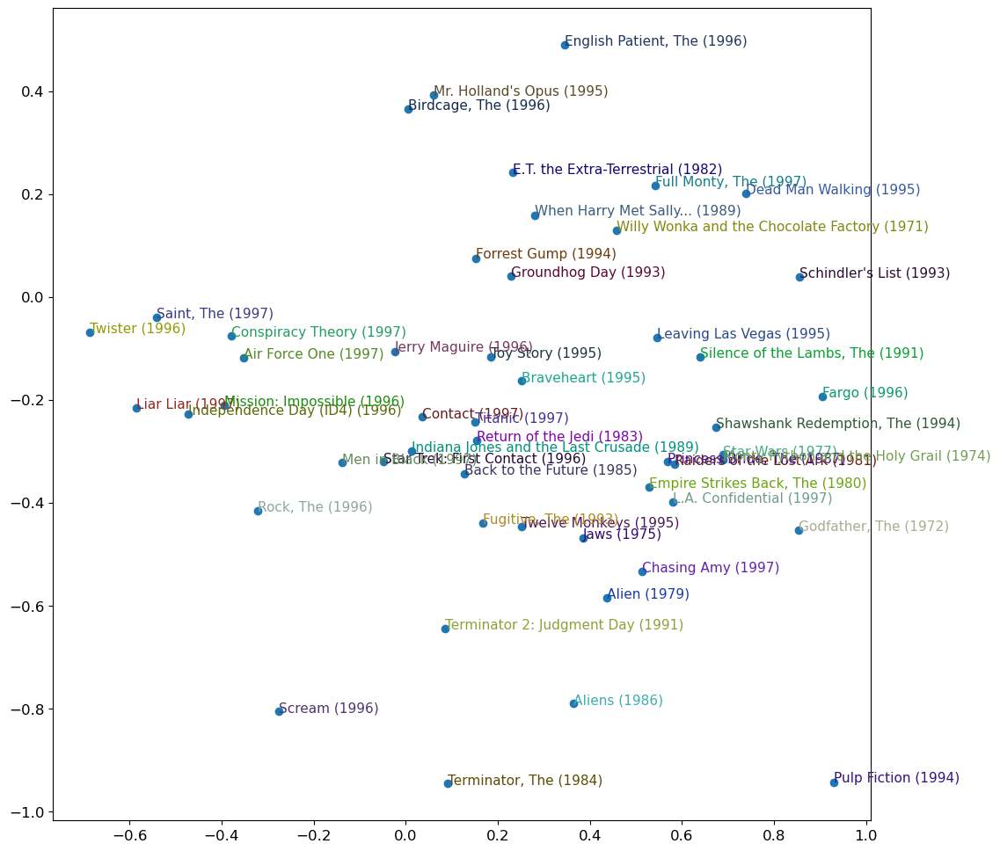

In [49]:
g = ratings.groupby('title')['rating'].count()
top_movies = g.sort_values(ascending=False).index.values[:1000]
top_idxs = tensor([learn.dls.classes['title'].o2i[m] for m in top_movies])
movie_w = learn.model.movie_factors[top_idxs].cpu().detach()
movie_pca = movie_w.pca(3)
fac0,fac1,fac2 = movie_pca.t()
idxs = list(range(50))
X = fac0[idxs]
Y = fac2[idxs]
plt.figure(figsize=(12,12))
plt.scatter(X, Y)
for i, x, y in zip(top_movies[idxs], X, Y):
    plt.text(x,y,i, color=np.random.rand(3)*0.7, fontsize=11)
plt.show()

### Using fastai.collab

In [70]:
learn = collab_learner(dls, n_factors=50, y_range=(0, 5.5))

In [71]:
learn.fit_one_cycle(5, 5e-3, wd=0.1)

epoch,train_loss,valid_loss,time
0,0.947809,0.943301,00:04
1,0.854164,0.868773,00:03
2,0.758499,0.827143,00:03
3,0.601057,0.814259,00:03
4,0.495510,0.815565,00:03


In [72]:
learn.model

EmbeddingDotBias(
  (u_weight): Embedding(944, 50)
  (i_weight): Embedding(1665, 50)
  (u_bias): Embedding(944, 1)
  (i_bias): Embedding(1665, 1)
)

In [73]:
movie_bias = learn.model.i_bias.weight.squeeze()
idxs = movie_bias.argsort(descending=True)[:5]
[dls.classes['title'][i] for i in idxs]

['Star Wars (1977)',
 'Shawshank Redemption, The (1994)',
 'Titanic (1997)',
 "Schindler's List (1993)",
 'L.A. Confidential (1997)']

### Embedding Distance

In [74]:
movie_factors = learn.model.i_weight.weight
idx = dls.classes['title'].o2i['Silence of the Lambs, The (1991)']
distances = nn.CosineSimilarity(dim=1)(movie_factors, movie_factors[idx][None])
idx = distances.argsort(descending=True)
dls.classes['title'][idx]

(#1665) ['Silence of the Lambs, The (1991)','Usual Suspects, The (1995)','Target (1995)','Shawshank Redemption, The (1994)','Meet John Doe (1941)','Stand by Me (1986)','Maya Lin: A Strong Clear Vision (1994)','Six Degrees of Separation (1993)','Some Folks Call It a Sling Blade (1993)','Candidate, The (1972)'...]

## Bootstrapping a Collaborative Filtering Model

## Deep Learning for Collaborative Filtering

In [79]:
embs = get_emb_sz(dls)
embs, learn.model
# get_emb_sz??

([(944, 74), (1665, 102)],
 EmbeddingDotBias(
   (u_weight): Embedding(944, 50)
   (i_weight): Embedding(1665, 50)
   (u_bias): Embedding(944, 1)
   (i_bias): Embedding(1665, 1)
 ))

In [84]:
class CollabNN(Module):
    def __init__(self, user_sz, item_sz, y_range=(0,5.5), n_act=100):
        self.user_factors = Embedding(*user_sz)
        self.item_factors = Embedding(*item_sz)
        self.layers = nn.Sequential(
            nn.Linear(user_sz[1]+item_sz[1], n_act),
            nn.ReLU(),
            nn.Linear(n_act, 1))
        self.y_range = y_range
        
    def forward(self, x):
        print("x is ",x.shape)
        embs = self.user_factors(x[:,0]),self.item_factors(x[:,1])
        x = self.layers(torch.cat(embs, dim=1))
        print("signmoid ",sigmoid_range(x, *self.y_range))
        return sigmoid_range(x, *self.y_range)

In [85]:
model = CollabNN(*embs)

In [86]:
learn = Learner(dls, model, loss_func=MSELossFlat())
learn.fit_one_cycle(5, 5e-3, wd=0.01)

epoch,train_loss,valid_loss,time
0,0.953415,0.940638,00:52
1,0.885394,0.921466,00:50
2,0.863135,0.876250,00:51
3,0.834705,0.871614,00:53
4,0.765831,0.868913,00:52


x is  torch.Size([64, 2])
signmoid  tensor([[2.7832],
        [2.7915],
        [2.7827],
        [2.7813],
        [2.7830],
        [2.7866],
        [2.7829],
        [2.7854],
        [2.7827],
        [2.7833],
        [2.7853],
        [2.7796],
        [2.7838],
        [2.7855],
        [2.7875],
        [2.7844],
        [2.7848],
        [2.7832],
        [2.7854],
        [2.7835],
        [2.7814],
        [2.7814],
        [2.7881],
        [2.7844],
        [2.7870],
        [2.7841],
        [2.7837],
        [2.7877],
        [2.7893],
        [2.7853],
        [2.7832],
        [2.7873],
        [2.7839],
        [2.7858],
        [2.7843],
        [2.7855],
        [2.7842],
        [2.7871],
        [2.7818],
        [2.7841],
        [2.7860],
        [2.7855],
        [2.7886],
        [2.7885],
        [2.7835],
        [2.7876],
        [2.7857],
        [2.7848],
        [2.7878],
        [2.7822],
        [2.7859],
        [2.7833],
        [2.7863],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8002],
        [2.7931],
        [2.7923],
        [2.7926],
        [2.7975],
        [2.7993],
        [2.7988],
        [2.7908],
        [2.7989],
        [2.7968],
        [2.7965],
        [2.7959],
        [2.7939],
        [2.7992],
        [2.7963],
        [2.7969],
        [2.7969],
        [2.7965],
        [2.7967],
        [2.7969],
        [2.7973],
        [2.7923],
        [2.7947],
        [2.7957],
        [2.7908],
        [2.7976],
        [2.7956],
        [2.7945],
        [2.7954],
        [2.7970],
        [2.7913],
        [2.7967],
        [2.7982],
        [2.7996],
        [2.7953],
        [2.7946],
        [2.7968],
        [2.7969],
        [2.7955],
        [2.7953],
        [2.7940],
        [2.8002],
        [2.7950],
        [2.7939],
        [2.7975],
        [2.7984],
        [2.7981],
        [2.7951],
        [2.7934],
        [2.7968],
        [2.8023],
        [2.7913],
        [2.7959],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8072],
        [2.8077],
        [2.8116],
        [2.8112],
        [2.8038],
        [2.8061],
        [2.8068],
        [2.8125],
        [2.8114],
        [2.8087],
        [2.8077],
        [2.8047],
        [2.8072],
        [2.8068],
        [2.8107],
        [2.8078],
        [2.8047],
        [2.8103],
        [2.8067],
        [2.8078],
        [2.8045],
        [2.8079],
        [2.8092],
        [2.8069],
        [2.8050],
        [2.8087],
        [2.8047],
        [2.8074],
        [2.8082],
        [2.8085],
        [2.8097],
        [2.8069],
        [2.8096],
        [2.8040],
        [2.8058],
        [2.8022],
        [2.8061],
        [2.8070],
        [2.8061],
        [2.8112],
        [2.8107],
        [2.8072],
        [2.8034],
        [2.8063],
        [2.8143],
        [2.8074],
        [2.8024],
        [2.8074],
        [2.8077],
        [2.8068],
        [2.8074],
        [2.8064],
        [2.8067],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8136],
        [2.8200],
        [2.8143],
        [2.8206],
        [2.8166],
        [2.8183],
        [2.8206],
        [2.8215],
        [2.8165],
        [2.8176],
        [2.8191],
        [2.8253],
        [2.8218],
        [2.8202],
        [2.8211],
        [2.8177],
        [2.8228],
        [2.8274],
        [2.8167],
        [2.8156],
        [2.8173],
        [2.8224],
        [2.8156],
        [2.8167],
        [2.8180],
        [2.8169],
        [2.8132],
        [2.8169],
        [2.8160],
        [2.8211],
        [2.8197],
        [2.8191],
        [2.8218],
        [2.8162],
        [2.8108],
        [2.8162],
        [2.8214],
        [2.8131],
        [2.8209],
        [2.8221],
        [2.8176],
        [2.8269],
        [2.8196],
        [2.8222],
        [2.8186],
        [2.8183],
        [2.8164],
        [2.8253],
        [2.8237],
        [2.8201],
        [2.8146],
        [2.8193],
        [2.8239],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8283],
        [2.8359],
        [2.8390],
        [2.8327],
        [2.8341],
        [2.8262],
        [2.8266],
        [2.8311],
        [2.8358],
        [2.8276],
        [2.8344],
        [2.8281],
        [2.8312],
        [2.8343],
        [2.8296],
        [2.8293],
        [2.8305],
        [2.8334],
        [2.8287],
        [2.8321],
        [2.8308],
        [2.8344],
        [2.8352],
        [2.8337],
        [2.8314],
        [2.8292],
        [2.8304],
        [2.8315],
        [2.8235],
        [2.8327],
        [2.8272],
        [2.8226],
        [2.8299],
        [2.8233],
        [2.8336],
        [2.8313],
        [2.8321],
        [2.8269],
        [2.8368],
        [2.8331],
        [2.8259],
        [2.8294],
        [2.8214],
        [2.8232],
        [2.8316],
        [2.8300],
        [2.8307],
        [2.8369],
        [2.8345],
        [2.8245],
        [2.8304],
        [2.8347],
        [2.8385],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8396],
        [2.8422],
        [2.8407],
        [2.8481],
        [2.8436],
        [2.8341],
        [2.8433],
        [2.8391],
        [2.8471],
        [2.8458],
        [2.8433],
        [2.8448],
        [2.8409],
        [2.8418],
        [2.8416],
        [2.8403],
        [2.8481],
        [2.8424],
        [2.8430],
        [2.8392],
        [2.8449],
        [2.8405],
        [2.8357],
        [2.8373],
        [2.8345],
        [2.8452],
        [2.8425],
        [2.8504],
        [2.8401],
        [2.8360],
        [2.8284],
        [2.8415],
        [2.8410],
        [2.8413],
        [2.8353],
        [2.8552],
        [2.8425],
        [2.8456],
        [2.8347],
        [2.8447],
        [2.8403],
        [2.8408],
        [2.8438],
        [2.8383],
        [2.8417],
        [2.8446],
        [2.8480],
        [2.8439],
        [2.8495],
        [2.8481],
        [2.8406],
        [2.8465],
        [2.8429],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8644],
        [2.8592],
        [2.8548],
        [2.8588],
        [2.8554],
        [2.8567],
        [2.8524],
        [2.8559],
        [2.8536],
        [2.8616],
        [2.8385],
        [2.8607],
        [2.8511],
        [2.8499],
        [2.8572],
        [2.8525],
        [2.8637],
        [2.8549],
        [2.8564],
        [2.8537],
        [2.8534],
        [2.8510],
        [2.8629],
        [2.8570],
        [2.8548],
        [2.8532],
        [2.8570],
        [2.8538],
        [2.8589],
        [2.8553],
        [2.8519],
        [2.8491],
        [2.8625],
        [2.8556],
        [2.8552],
        [2.8676],
        [2.8623],
        [2.8617],
        [2.8527],
        [2.8589],
        [2.8586],
        [2.8633],
        [2.8568],
        [2.8575],
        [2.8598],
        [2.8630],
        [2.8607],
        [2.8591],
        [2.8500],
        [2.8532],
        [2.8558],
        [2.8524],
        [2.8578],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8659],
        [2.8649],
        [2.8668],
        [2.8613],
        [2.8783],
        [2.8732],
        [2.8633],
        [2.8664],
        [2.8693],
        [2.8647],
        [2.8709],
        [2.8585],
        [2.8655],
        [2.8699],
        [2.8763],
        [2.8674],
        [2.8703],
        [2.8705],
        [2.8611],
        [2.8692],
        [2.8614],
        [2.8670],
        [2.8718],
        [2.8748],
        [2.8731],
        [2.8780],
        [2.8669],
        [2.8733],
        [2.8674],
        [2.8692],
        [2.8696],
        [2.8622],
        [2.8617],
        [2.8664],
        [2.8667],
        [2.8671],
        [2.8613],
        [2.8739],
        [2.8669],
        [2.8787],
        [2.8645],
        [2.8778],
        [2.8594],
        [2.8692],
        [2.8742],
        [2.8787],
        [2.8636],
        [2.8675],
        [2.8737],
        [2.8660],
        [2.8698],
        [2.8702],
        [2.8648],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8824],
        [2.8829],
        [2.8903],
        [2.8753],
        [2.8947],
        [2.8861],
        [2.8805],
        [2.8817],
        [2.8796],
        [2.8797],
        [2.8888],
        [2.8833],
        [2.8820],
        [2.8833],
        [2.8846],
        [2.8845],
        [2.8834],
        [2.8853],
        [2.8955],
        [2.8877],
        [2.8817],
        [2.8817],
        [2.8937],
        [2.8903],
        [2.8868],
        [2.8892],
        [2.8824],
        [2.8918],
        [2.8841],
        [2.8863],
        [2.8827],
        [2.8837],
        [2.8895],
        [2.8869],
        [2.8836],
        [2.8703],
        [2.8821],
        [2.8819],
        [2.8910],
        [2.8781],
        [2.8714],
        [2.8924],
        [2.8746],
        [2.8797],
        [2.8786],
        [2.8942],
        [2.8870],
        [2.8846],
        [2.8874],
        [2.8831],
        [2.8885],
        [2.8840],
        [2.8814],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8908],
        [2.9039],
        [2.8989],
        [2.9041],
        [2.8986],
        [2.9044],
        [2.9019],
        [2.8981],
        [2.8996],
        [2.9054],
        [2.8938],
        [2.8957],
        [2.8872],
        [2.8997],
        [2.8895],
        [2.9106],
        [2.8806],
        [2.8978],
        [2.8992],
        [2.8928],
        [2.9033],
        [2.8958],
        [2.8962],
        [2.9137],
        [2.9006],
        [2.9046],
        [2.9079],
        [2.9131],
        [2.9041],
        [2.8929],
        [2.9006],
        [2.8994],
        [2.8982],
        [2.9079],
        [2.9043],
        [2.9061],
        [2.9027],
        [2.8959],
        [2.9055],
        [2.8928],
        [2.9098],
        [2.9017],
        [2.8955],
        [2.8912],
        [2.9021],
        [2.9026],
        [2.9012],
        [2.9225],
        [2.8971],
        [2.8947],
        [2.9032],
        [2.8897],
        [2.8912],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9286],
        [2.9051],
        [2.9266],
        [2.9168],
        [2.9159],
        [2.9123],
        [2.9221],
        [2.9388],
        [2.9176],
        [2.9200],
        [2.9184],
        [2.9168],
        [2.9222],
        [2.9181],
        [2.9319],
        [2.9230],
        [2.9210],
        [2.9220],
        [2.9089],
        [2.9078],
        [2.9188],
        [2.9148],
        [2.9216],
        [2.9208],
        [2.9136],
        [2.9109],
        [2.9184],
        [2.9113],
        [2.9105],
        [2.9274],
        [2.9276],
        [2.9160],
        [2.9131],
        [2.9199],
        [2.9078],
        [2.9297],
        [2.9210],
        [2.9281],
        [2.9261],
        [2.9154],
        [2.9273],
        [2.9259],
        [2.9073],
        [2.9135],
        [2.9350],
        [2.9131],
        [2.9267],
        [2.9106],
        [2.9075],
        [2.8951],
        [2.9203],
        [2.9218],
        [2.9067],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9075],
        [2.9379],
        [2.9246],
        [2.9355],
        [2.9272],
        [2.9292],
        [2.9364],
        [2.9331],
        [2.9225],
        [2.9322],
        [2.9304],
        [2.9414],
        [2.9337],
        [2.9314],
        [2.9293],
        [2.9213],
        [2.9502],
        [2.9486],
        [2.9378],
        [2.9382],
        [2.9350],
        [2.9148],
        [2.9345],
        [2.9328],
        [2.9223],
        [2.9502],
        [2.9394],
        [2.9251],
        [2.9246],
        [2.9296],
        [2.9239],
        [2.9285],
        [2.9176],
        [2.9269],
        [2.9325],
        [2.9319],
        [2.9313],
        [2.9425],
        [2.9179],
        [2.9164],
        [2.9418],
        [2.9403],
        [2.9220],
        [2.9214],
        [2.9098],
        [2.9381],
        [2.9496],
        [2.9284],
        [2.9186],
        [2.9337],
        [2.9352],
        [2.9442],
        [2.9240],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9682],
        [2.9510],
        [2.9471],
        [2.9496],
        [2.9700],
        [2.9396],
        [2.9453],
        [2.9708],
        [2.9347],
        [2.9278],
        [2.9541],
        [2.9291],
        [2.9577],
        [2.9436],
        [2.9210],
        [2.9625],
        [2.9616],
        [2.9465],
        [2.9488],
        [2.9658],
        [2.9477],
        [2.9485],
        [2.9577],
        [2.9537],
        [2.9304],
        [2.9393],
        [2.9447],
        [2.9519],
        [2.9629],
        [2.9481],
        [2.9357],
        [2.9296],
        [2.9528],
        [2.9617],
        [2.9633],
        [2.9384],
        [2.9324],
        [2.9462],
        [2.9508],
        [2.9584],
        [2.9583],
        [2.9621],
        [2.9417],
        [2.9391],
        [2.9362],
        [2.9348],
        [2.9601],
        [2.9484],
        [2.9438],
        [2.9500],
        [2.9382],
        [2.9430],
        [2.9474],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9618],
        [2.9813],
        [2.9558],
        [2.9767],
        [2.9409],
        [2.9435],
        [2.9878],
        [2.9900],
        [2.9520],
        [2.9925],
        [2.9568],
        [2.9616],
        [2.9615],
        [2.9796],
        [2.9792],
        [2.9872],
        [2.9241],
        [2.9471],
        [2.9969],
        [2.9886],
        [2.9378],
        [2.9994],
        [2.9728],
        [2.9574],
        [2.9813],
        [2.9277],
        [2.9623],
        [2.9487],
        [2.9608],
        [2.9642],
        [2.9488],
        [2.9509],
        [2.9914],
        [2.9740],
        [2.9649],
        [2.9455],
        [2.9829],
        [2.9771],
        [2.9261],
        [2.9856],
        [3.0012],
        [2.9804],
        [2.9761],
        [2.9810],
        [2.9544],
        [2.9679],
        [2.9451],
        [2.9688],
        [2.9717],
        [2.9519],
        [2.9907],
        [2.9564],
        [2.9864],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9752],
        [2.9574],
        [2.9781],
        [2.9874],
        [2.9672],
        [3.0116],
        [2.9265],
        [2.9886],
        [2.9651],
        [2.9782],
        [2.9902],
        [2.9855],
        [2.9814],
        [2.9725],
        [2.9885],
        [2.9827],
        [3.0061],
        [2.9840],
        [2.9937],
        [3.0018],
        [2.9051],
        [2.9785],
        [3.0251],
        [3.0137],
        [2.9870],
        [2.9780],
        [2.9823],
        [2.9827],
        [2.9643],
        [2.9611],
        [2.9857],
        [2.9882],
        [2.9758],
        [2.9995],
        [2.9718],
        [3.0117],
        [2.9561],
        [2.9460],
        [3.0273],
        [3.0141],
        [2.9961],
        [3.0132],
        [2.9744],
        [2.9784],
        [2.9827],
        [3.0080],
        [3.0095],
        [2.9720],
        [2.9857],
        [2.9746],
        [2.9698],
        [3.0015],
        [3.0113],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9842],
        [3.0131],
        [3.0208],
        [3.0300],
        [2.9665],
        [3.0057],
        [3.0402],
        [3.0224],
        [2.9964],
        [3.0247],
        [2.9880],
        [2.9576],
        [2.9952],
        [3.0226],
        [3.0320],
        [2.9802],
        [3.0385],
        [3.0014],
        [2.8962],
        [3.0328],
        [3.0013],
        [3.0174],
        [2.9879],
        [3.0125],
        [2.9562],
        [3.0480],
        [3.0361],
        [3.0425],
        [3.0134],
        [3.0135],
        [3.0023],
        [3.0370],
        [3.0025],
        [3.0176],
        [3.0369],
        [2.9942],
        [3.0404],
        [2.9729],
        [3.0322],
        [3.0466],
        [3.0388],
        [2.9968],
        [2.9870],
        [2.9897],
        [2.9748],
        [2.9914],
        [2.9923],
        [2.9935],
        [3.0355],
        [3.0331],
        [3.0373],
        [3.0041],
        [2.9855],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0620],
        [3.0650],
        [3.0436],
        [2.9894],
        [3.0579],
        [3.0733],
        [2.9982],
        [3.0120],
        [3.0329],
        [2.8886],
        [3.0483],
        [3.0564],
        [3.0749],
        [3.0077],
        [3.0473],
        [3.0083],
        [3.0719],
        [3.0296],
        [3.0382],
        [3.0050],
        [3.0429],
        [3.0497],
        [3.0652],
        [3.0520],
        [3.0137],
        [3.0264],
        [2.9748],
        [3.0447],
        [3.0904],
        [2.9848],
        [3.0821],
        [3.0203],
        [3.0490],
        [3.0439],
        [3.0523],
        [3.0093],
        [3.0371],
        [3.0352],
        [3.0244],
        [3.0297],
        [2.9678],
        [2.9958],
        [3.0370],
        [3.0032],
        [3.0775],
        [3.0542],
        [3.0275],
        [3.0151],
        [3.0694],
        [2.9979],
        [3.0619],
        [3.0212],
        [3.0380],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0088],
        [3.0590],
        [3.0878],
        [3.0706],
        [3.0283],
        [3.1270],
        [3.0254],
        [3.0317],
        [3.0141],
        [2.9958],
        [3.0783],
        [2.9525],
        [3.0577],
        [3.1069],
        [3.0383],
        [3.0080],
        [3.1018],
        [3.0732],
        [3.0414],
        [3.0466],
        [3.1102],
        [3.0769],
        [3.0869],
        [3.0607],
        [3.0475],
        [3.0782],
        [3.0825],
        [3.0101],
        [3.0807],
        [3.1209],
        [3.0053],
        [3.0837],
        [3.0424],
        [3.0603],
        [3.0353],
        [3.1274],
        [3.0489],
        [3.0298],
        [2.9658],
        [3.0226],
        [3.1080],
        [2.9750],
        [3.0742],
        [3.0417],
        [3.0567],
        [3.0671],
        [3.0674],
        [3.0722],
        [3.0381],
        [3.1145],
        [3.0983],
        [3.0663],
        [3.0310],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.0572],
        [3.0393],
        [3.1406],
        [3.0688],
        [3.0496],
        [3.0292],
        [3.0583],
        [3.1063],
        [3.1140],
        [3.1411],
        [3.0942],
        [3.0677],
        [3.1441],
        [3.0432],
        [3.0434],
        [3.1034],
        [3.0413],
        [3.1055],
        [3.1282],
        [3.1358],
        [3.0848],
        [3.0880],
        [3.0765],
        [3.0324],
        [3.1080],
        [3.0707],
        [3.0822],
        [3.0378],
        [3.0240],
        [3.0709],
        [3.0549],
        [3.0592],
        [3.0221],
        [3.0139],
        [3.1107],
        [3.0362],
        [3.0156],
        [3.1063],
        [3.0755],
        [2.9880],
        [3.1493],
        [3.1138],
        [3.0843],
        [3.0926],
        [3.0703],
        [3.0955],
        [3.1565],
        [3.0507],
        [3.1109],
        [3.0429],
        [3.0598],
        [3.0403],
        [3.0592],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1477],
        [3.0852],
        [3.0624],
        [3.1612],
        [3.0541],
        [3.1175],
        [3.1530],
        [3.1092],
        [3.1164],
        [3.1503],
        [3.1653],
        [3.1135],
        [3.0771],
        [3.1066],
        [3.0700],
        [3.1469],
        [3.1627],
        [3.1984],
        [3.0711],
        [3.1544],
        [3.1655],
        [3.2026],
        [3.1674],
        [3.0453],
        [3.0259],
        [3.1498],
        [3.0416],
        [3.0955],
        [3.1227],
        [3.0405],
        [3.1638],
        [3.1153],
        [3.0442],
        [3.1557],
        [3.1597],
        [2.9538],
        [3.1497],
        [3.0963],
        [3.1510],
        [3.1251],
        [3.1144],
        [3.1722],
        [3.1363],
        [3.1666],
        [3.0383],
        [2.8634],
        [3.1800],
        [3.1092],
        [3.1882],
        [3.1581],
        [3.1474],
        [3.1416],
        [3.0976],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1708],
        [3.1913],
        [3.1909],
        [3.0743],
        [3.1425],
        [3.2018],
        [3.1065],
        [3.2579],
        [3.2254],
        [3.1172],
        [3.0743],
        [3.1706],
        [3.1213],
        [3.1377],
        [3.1239],
        [3.1551],
        [3.2552],
        [3.2202],
        [3.2304],
        [3.1169],
        [3.1798],
        [3.1582],
        [3.1071],
        [3.1934],
        [3.1432],
        [2.8543],
        [3.1444],
        [3.1389],
        [3.1280],
        [3.2428],
        [3.1359],
        [3.1663],
        [3.1928],
        [3.1136],
        [3.1827],
        [3.2042],
        [3.1196],
        [3.0712],
        [3.2318],
        [3.1541],
        [3.1369],
        [3.1911],
        [3.2436],
        [3.1080],
        [3.1422],
        [3.0534],
        [3.1367],
        [3.0644],
        [3.1752],
        [3.0882],
        [3.0854],
        [3.1389],
        [3.1899],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1468],
        [3.3804],
        [3.2115],
        [3.1980],
        [3.2120],
        [3.1665],
        [3.2344],
        [3.1009],
        [3.0298],
        [3.2621],
        [3.1621],
        [3.1185],
        [3.1279],
        [3.2072],
        [3.2615],
        [3.1540],
        [3.1522],
        [3.2760],
        [3.2034],
        [2.8809],
        [3.2001],
        [3.2483],
        [3.1995],
        [3.2292],
        [3.2438],
        [3.0829],
        [3.1687],
        [3.0517],
        [2.9147],
        [3.1424],
        [3.3346],
        [3.1514],
        [3.1749],
        [3.2642],
        [3.2301],
        [3.2661],
        [3.0903],
        [3.0557],
        [3.3292],
        [3.2177],
        [3.2375],
        [3.2055],
        [3.1878],
        [3.1427],
        [3.1166],
        [3.1851],
        [3.2289],
        [3.2382],
        [3.1948],
        [3.2974],
        [3.1298],
        [3.3540],
        [3.2112],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3096],
        [3.1899],
        [3.0673],
        [3.3979],
        [3.2947],
        [3.3213],
        [3.1965],
        [3.2015],
        [3.1495],
        [3.1715],
        [3.1777],
        [3.2312],
        [3.3473],
        [3.2327],
        [3.0992],
        [3.3109],
        [3.2034],
        [3.1042],
        [3.1977],
        [3.2222],
        [3.2869],
        [3.3036],
        [3.3204],
        [3.2239],
        [3.0893],
        [3.2176],
        [3.0505],
        [3.0965],
        [3.2206],
        [3.2417],
        [3.2195],
        [3.2751],
        [3.2163],
        [3.1570],
        [3.1507],
        [3.0902],
        [3.2689],
        [3.2482],
        [3.1290],
        [3.0967],
        [3.2734],
        [3.2369],
        [3.3221],
        [3.2175],
        [3.2684],
        [2.9966],
        [3.0864],
        [3.4203],
        [3.3687],
        [3.2307],
        [3.2442],
        [3.2483],
        [3.3143],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3584],
        [3.2940],
        [3.1855],
        [3.1679],
        [3.3626],
        [3.4054],
        [3.1321],
        [3.3363],
        [3.1245],
        [3.2977],
        [3.2034],
        [3.3148],
        [3.4245],
        [3.2678],
        [3.1112],
        [3.3470],
        [3.1781],
        [3.2336],
        [3.2003],
        [3.2185],
        [3.2070],
        [3.2720],
        [3.1525],
        [3.3879],
        [3.3111],
        [3.3388],
        [2.9051],
        [3.2674],
        [3.1269],
        [3.2846],
        [3.2647],
        [3.0820],
        [2.8520],
        [3.2017],
        [3.3512],
        [3.5000],
        [3.2106],
        [3.1207],
        [3.0152],
        [3.3129],
        [3.1754],
        [3.3701],
        [3.3711],
        [3.2863],
        [3.2400],
        [3.0886],
        [3.2604],
        [3.4509],
        [3.2843],
        [3.3324],
        [3.4056],
        [3.2196],
        [3.3494],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2586],
        [3.2534],
        [3.4135],
        [3.1753],
        [3.2476],
        [3.5157],
        [3.1878],
        [3.4760],
        [3.1758],
        [3.1746],
        [3.5478],
        [3.2186],
        [3.2767],
        [3.3176],
        [3.2252],
        [3.4327],
        [3.4349],
        [3.1865],
        [3.3794],
        [3.2631],
        [3.3831],
        [3.2199],
        [3.2574],
        [3.3974],
        [3.2863],
        [3.2550],
        [3.2010],
        [3.4174],
        [3.3992],
        [3.2378],
        [3.2852],
        [3.3236],
        [3.4137],
        [3.3418],
        [3.5365],
        [3.3699],
        [3.2267],
        [2.8972],
        [3.1612],
        [3.4719],
        [3.3799],
        [3.3173],
        [3.3064],
        [3.3140],
        [3.3780],
        [3.1360],
        [3.4228],
        [3.3110],
        [3.2424],
        [3.2596],
        [3.1790],
        [3.2302],
        [3.4769],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2330],
        [3.6201],
        [3.5422],
        [3.4870],
        [3.3302],
        [3.2817],
        [3.2328],
        [3.2527],
        [3.1800],
        [3.5159],
        [3.2175],
        [3.3330],
        [3.0634],
        [3.3750],
        [3.3777],
        [3.4629],
        [3.2084],
        [3.2741],
        [3.3163],
        [3.3690],
        [3.4051],
        [3.2791],
        [3.1499],
        [3.0448],
        [3.5665],
        [3.2631],
        [3.5183],
        [3.4421],
        [3.4638],
        [3.1821],
        [3.2751],
        [3.0967],
        [3.3989],
        [3.3568],
        [3.2307],
        [3.5079],
        [3.3777],
        [3.3367],
        [3.2422],
        [3.2585],
        [3.3074],
        [3.3813],
        [3.4303],
        [3.4873],
        [3.0138],
        [3.2036],
        [3.4298],
        [3.2536],
        [3.4516],
        [3.3246],
        [3.4990],
        [3.2398],
        [3.3614],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5351],
        [3.4194],
        [3.1579],
        [3.1471],
        [3.3379],
        [3.4577],
        [3.2364],
        [3.0863],
        [3.3417],
        [3.3357],
        [3.5403],
        [3.4728],
        [3.5894],
        [3.5845],
        [3.1433],
        [3.5131],
        [3.5640],
        [3.4885],
        [3.4682],
        [3.5833],
        [3.4020],
        [3.3370],
        [3.5279],
        [3.4056],
        [3.3505],
        [3.4390],
        [3.1412],
        [3.2546],
        [3.2281],
        [3.4636],
        [3.2460],
        [3.6435],
        [3.6000],
        [3.3612],
        [3.3414],
        [3.4415],
        [3.2989],
        [3.4338],
        [3.2799],
        [3.1302],
        [3.4060],
        [3.3435],
        [3.3565],
        [3.0515],
        [3.0245],
        [3.5269],
        [3.3373],
        [3.3875],
        [3.5122],
        [3.3595],
        [3.3991],
        [3.3825],
        [3.6294],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2893],
        [3.3784],
        [3.3248],
        [3.4567],
        [3.4246],
        [3.3513],
        [3.3029],
        [3.3695],
        [3.3408],
        [3.6696],
        [3.4127],
        [3.5828],
        [3.5895],
        [3.5662],
        [3.5362],
        [3.6455],
        [3.4371],
        [3.7614],
        [3.4558],
        [3.5055],
        [3.6670],
        [3.2713],
        [3.5832],
        [3.6373],
        [3.4584],
        [3.7443],
        [3.6566],
        [3.6329],
        [3.2348],
        [3.4437],
        [3.3027],
        [3.7114],
        [3.1339],
        [3.7057],
        [3.4474],
        [3.6291],
        [3.5569],
        [3.6037],
        [3.3103],
        [3.5371],
        [3.5917],
        [3.5144],
        [3.4816],
        [3.8598],
        [3.1076],
        [3.0805],
        [3.5684],
        [3.5639],
        [3.6825],
        [3.5743],
        [3.4577],
        [3.5135],
        [3.4364],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2369],
        [3.7284],
        [3.7192],
        [3.3194],
        [3.2619],
        [3.4403],
        [3.4403],
        [3.3082],
        [3.7049],
        [3.6206],
        [3.5423],
        [3.4284],
        [3.6373],
        [3.2153],
        [3.5363],
        [3.0914],
        [3.5790],
        [3.3772],
        [3.5607],
        [3.1945],
        [3.5257],
        [3.5840],
        [3.6667],
        [3.5713],
        [3.4226],
        [3.5290],
        [3.1043],
        [3.4385],
        [3.3057],
        [3.4934],
        [3.3535],
        [3.6568],
        [3.6222],
        [3.6229],
        [3.5272],
        [3.6054],
        [3.4392],
        [3.4595],
        [3.4233],
        [3.4462],
        [3.5543],
        [3.1734],
        [3.7111],
        [3.9309],
        [3.5668],
        [3.4618],
        [3.7919],
        [3.4791],
        [3.5116],
        [3.3534],
        [3.4545],
        [3.3821],
        [3.3606],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7708],
        [3.7683],
        [3.5896],
        [3.3931],
        [3.9730],
        [3.6274],
        [3.7782],
        [3.5364],
        [3.7867],
        [3.9482],
        [3.8312],
        [3.8088],
        [3.2751],
        [3.2857],
        [3.7063],
        [3.6729],
        [3.6115],
        [3.5184],
        [3.5401],
        [3.5877],
        [3.0116],
        [3.4744],
        [3.5279],
        [3.6241],
        [3.6081],
        [3.4779],
        [3.7082],
        [3.7033],
        [3.4841],
        [3.4712],
        [3.3114],
        [3.8676],
        [3.4986],
        [3.0196],
        [3.4950],
        [3.5925],
        [3.5015],
        [3.2542],
        [3.4416],
        [3.7111],
        [3.9025],
        [3.6698],
        [3.8585],
        [3.7521],
        [3.4464],
        [3.3373],
        [3.6637],
        [3.8414],
        [3.6929],
        [3.6667],
        [3.6438],
        [3.2032],
        [3.5673],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8644],
        [3.7893],
        [3.4473],
        [3.2425],
        [3.7962],
        [3.7581],
        [3.9226],
        [3.3612],
        [3.2063],
        [3.9376],
        [3.0305],
        [3.5117],
        [4.0669],
        [3.3875],
        [3.5269],
        [3.6951],
        [3.4845],
        [3.7316],
        [3.3448],
        [3.4727],
        [3.6508],
        [3.2531],
        [3.1985],
        [3.6582],
        [3.6668],
        [3.6973],
        [2.8744],
        [3.5619],
        [3.7202],
        [3.1823],
        [3.7164],
        [3.5652],
        [3.7277],
        [3.8537],
        [3.6485],
        [3.1918],
        [3.7596],
        [3.8667],
        [3.9704],
        [3.9987],
        [3.9803],
        [3.6968],
        [3.2613],
        [3.6412],
        [3.8572],
        [2.8834],
        [3.7948],
        [3.8867],
        [3.5620],
        [3.7203],
        [3.6632],
        [3.4782],
        [3.4151],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5376],
        [3.6510],
        [3.4703],
        [3.9226],
        [3.9300],
        [3.5565],
        [3.9617],
        [3.6043],
        [3.7887],
        [3.9279],
        [3.6324],
        [3.6279],
        [3.7513],
        [3.8864],
        [3.7557],
        [3.9197],
        [3.6767],
        [3.6418],
        [3.9574],
        [3.6283],
        [3.7967],
        [3.8215],
        [4.0685],
        [3.5386],
        [3.6071],
        [3.2976],
        [3.8801],
        [3.7509],
        [3.9073],
        [4.1492],
        [3.3514],
        [3.7418],
        [3.6727],
        [3.7813],
        [3.7750],
        [3.9718],
        [3.7096],
        [3.7396],
        [3.2409],
        [3.7920],
        [3.3687],
        [3.6885],
        [3.7189],
        [4.1634],
        [4.0121],
        [3.8955],
        [3.7370],
        [3.6605],
        [3.4840],
        [3.6449],
        [3.3057],
        [3.8246],
        [3.7140],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0666],
        [3.6085],
        [3.8290],
        [3.6875],
        [3.0587],
        [3.5426],
        [3.9229],
        [3.5830],
        [3.1430],
        [4.0134],
        [3.7896],
        [3.8111],
        [4.0525],
        [3.5083],
        [4.1334],
        [4.0941],
        [3.1845],
        [3.6437],
        [3.1155],
        [3.7619],
        [3.5174],
        [3.0562],
        [3.7327],
        [3.9444],
        [3.6108],
        [3.4190],
        [2.9608],
        [3.7861],
        [3.2826],
        [3.2345],
        [3.3152],
        [3.4378],
        [3.7187],
        [3.7126],
        [3.8743],
        [3.0982],
        [3.7896],
        [3.9190],
        [3.2656],
        [3.8787],
        [3.9225],
        [3.1103],
        [2.9811],
        [3.8992],
        [3.2833],
        [3.7656],
        [3.2074],
        [3.7120],
        [3.8669],
        [3.8682],
        [3.7675],
        [3.7999],
        [3.7547],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5254],
        [4.3126],
        [4.0909],
        [3.4584],
        [3.7178],
        [3.1013],
        [2.7194],
        [3.7617],
        [3.2851],
        [3.1372],
        [3.8729],
        [3.8413],
        [3.4525],
        [3.7539],
        [3.8460],
        [3.9650],
        [3.8296],
        [4.0071],
        [3.3313],
        [3.4881],
        [3.1764],
        [3.6573],
        [4.1967],
        [3.1946],
        [4.0722],
        [3.3128],
        [3.3524],
        [3.6843],
        [3.8866],
        [4.2403],
        [4.0608],
        [4.0171],
        [3.3159],
        [4.0613],
        [3.7622],
        [3.9893],
        [3.7383],
        [3.0116],
        [3.3285],
        [4.0138],
        [4.0848],
        [4.0173],
        [2.8618],
        [3.8850],
        [3.4741],
        [3.4352],
        [4.0235],
        [4.1031],
        [3.5528],
        [3.4898],
        [3.5832],
        [3.8329],
        [3.0216],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7793],
        [3.0876],
        [3.1319],
        [3.8652],
        [3.8771],
        [3.1382],
        [3.2420],
        [3.9968],
        [3.9069],
        [3.2058],
        [3.9222],
        [3.3463],
        [3.6044],
        [4.0367],
        [3.4392],
        [3.4864],
        [4.0245],
        [3.1104],
        [4.0618],
        [4.0220],
        [3.5630],
        [3.0054],
        [3.7224],
        [4.1055],
        [3.9441],
        [3.7106],
        [4.0063],
        [3.6221],
        [2.8547],
        [4.1846],
        [3.3243],
        [4.2173],
        [3.8249],
        [3.0320],
        [3.8991],
        [3.5257],
        [3.1426],
        [3.5648],
        [4.0837],
        [4.0488],
        [3.2364],
        [3.6640],
        [4.0150],
        [3.6323],
        [3.3398],
        [3.7780],
        [3.4131],
        [3.3762],
        [3.5776],
        [3.6809],
        [4.1568],
        [3.4628],
        [4.0667],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1202],
        [4.2112],
        [3.9672],
        [4.1193],
        [2.9482],
        [3.8736],
        [3.2894],
        [3.7885],
        [3.9181],
        [4.2607],
        [2.7627],
        [3.7518],
        [3.6762],
        [3.5926],
        [3.3745],
        [4.0122],
        [3.9360],
        [4.2583],
        [3.5370],
        [3.9189],
        [4.1358],
        [3.5446],
        [4.2610],
        [3.5535],
        [4.1106],
        [3.5766],
        [3.3230],
        [3.3481],
        [4.1465],
        [3.6559],
        [3.4538],
        [3.9617],
        [3.6608],
        [3.7024],
        [3.9598],
        [4.0852],
        [3.9212],
        [2.6709],
        [3.4548],
        [4.1403],
        [3.8022],
        [3.9610],
        [3.6596],
        [3.8379],
        [3.8343],
        [4.1603],
        [3.9304],
        [3.9268],
        [3.6996],
        [2.8114],
        [3.3603],
        [4.1476],
        [3.1999],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6387],
        [3.1816],
        [3.5397],
        [3.2076],
        [4.0309],
        [3.3235],
        [3.6467],
        [4.1890],
        [3.7133],
        [3.9610],
        [3.2689],
        [3.0736],
        [3.1324],
        [4.0360],
        [3.5856],
        [3.9165],
        [2.9075],
        [4.1057],
        [4.0469],
        [2.9624],
        [3.4890],
        [4.4031],
        [3.4067],
        [3.6948],
        [2.9884],
        [4.0660],
        [3.4362],
        [3.6504],
        [3.5036],
        [2.9331],
        [3.3940],
        [3.7046],
        [3.4846],
        [2.6463],
        [3.2462],
        [3.4270],
        [3.2684],
        [3.1504],
        [4.0493],
        [3.3121],
        [4.0204],
        [3.4194],
        [3.9071],
        [3.5013],
        [4.0046],
        [3.7711],
        [3.8182],
        [3.9630],
        [3.2410],
        [3.8713],
        [3.8975],
        [3.6063],
        [4.1354],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8967],
        [3.7269],
        [3.3881],
        [4.2419],
        [4.3321],
        [3.2739],
        [3.9664],
        [3.7997],
        [3.5282],
        [3.8582],
        [3.4638],
        [3.6133],
        [3.5533],
        [3.9700],
        [3.1766],
        [3.6783],
        [4.1382],
        [3.5976],
        [3.6777],
        [3.2516],
        [3.0926],
        [3.4814],
        [4.3194],
        [3.0728],
        [3.1680],
        [3.8197],
        [3.5159],
        [3.6946],
        [3.2550],
        [3.3661],
        [3.8168],
        [3.4401],
        [4.3540],
        [3.5715],
        [3.5735],
        [4.4893],
        [2.5975],
        [3.9430],
        [3.2799],
        [4.3262],
        [4.3839],
        [4.3240],
        [4.0854],
        [3.3999],
        [3.9948],
        [4.0831],
        [3.7886],
        [4.1946],
        [3.6348],
        [3.5336],
        [3.5013],
        [4.4084],
        [4.1276],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7105],
        [3.7902],
        [3.7265],
        [3.5067],
        [3.3918],
        [3.5539],
        [3.9661],
        [3.9383],
        [3.7949],
        [3.3749],
        [3.8383],
        [3.3374],
        [4.0774],
        [4.0307],
        [2.8811],
        [4.1985],
        [2.9940],
        [3.8490],
        [3.6817],
        [3.5068],
        [3.4822],
        [3.8592],
        [3.8001],
        [3.7571],
        [3.6538],
        [3.6097],
        [3.1919],
        [4.4336],
        [4.0218],
        [3.2788],
        [3.6230],
        [3.0114],
        [3.6222],
        [3.7116],
        [4.1161],
        [3.2833],
        [3.8272],
        [2.9304],
        [3.8689],
        [2.9922],
        [3.7955],
        [3.0766],
        [3.4154],
        [3.8199],
        [3.4851],
        [3.8123],
        [3.6040],
        [3.8052],
        [2.9561],
        [4.1101],
        [4.0178],
        [3.3585],
        [3.3032],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4110],
        [2.9266],
        [2.5661],
        [2.5727],
        [3.4881],
        [3.9672],
        [3.1472],
        [3.3608],
        [4.0241],
        [2.5586],
        [3.5150],
        [3.9042],
        [3.1565],
        [3.7799],
        [3.8075],
        [3.6570],
        [3.1768],
        [3.3381],
        [4.1025],
        [4.1965],
        [2.8677],
        [3.1456],
        [4.2151],
        [3.8103],
        [3.8662],
        [3.5820],
        [2.6703],
        [2.8280],
        [3.4234],
        [3.8566],
        [3.9710],
        [3.9984],
        [3.9141],
        [3.2415],
        [3.8925],
        [3.6030],
        [3.4360],
        [3.3883],
        [3.5538],
        [3.7404],
        [3.3512],
        [3.5374],
        [3.9284],
        [4.4548],
        [3.3049],
        [3.2730],
        [3.0659],
        [4.0189],
        [3.8541],
        [3.4302],
        [2.8772],
        [3.7762],
        [3.0464],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6637],
        [3.2771],
        [3.8969],
        [3.4247],
        [2.9566],
        [3.7979],
        [3.0685],
        [3.8450],
        [4.1534],
        [3.8220],
        [4.0800],
        [3.7011],
        [4.1600],
        [3.0891],
        [3.9116],
        [3.9619],
        [3.8853],
        [3.3803],
        [3.0893],
        [3.8806],
        [4.3995],
        [3.0408],
        [4.1798],
        [3.4356],
        [4.1530],
        [3.8882],
        [3.4832],
        [4.0760],
        [3.4874],
        [4.1113],
        [2.9567],
        [3.9860],
        [3.2961],
        [3.2777],
        [3.6716],
        [4.1444],
        [3.2020],
        [3.4258],
        [3.5866],
        [4.2699],
        [3.1563],
        [2.8205],
        [3.5284],
        [3.6482],
        [4.0020],
        [3.0820],
        [3.6012],
        [3.2510],
        [2.7242],
        [3.5791],
        [3.1594],
        [4.0536],
        [3.1083],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4820],
        [3.5627],
        [3.1623],
        [3.8654],
        [3.5265],
        [3.2100],
        [3.0564],
        [2.7323],
        [2.6862],
        [3.7908],
        [3.4132],
        [3.0080],
        [2.6213],
        [4.1068],
        [3.7275],
        [3.2668],
        [3.5132],
        [3.2798],
        [3.6341],
        [4.3813],
        [3.2292],
        [3.3372],
        [3.8930],
        [2.8819],
        [3.4485],
        [2.4475],
        [3.5974],
        [3.5591],
        [3.7468],
        [2.9581],
        [3.5712],
        [3.3333],
        [3.5223],
        [3.9374],
        [3.5287],
        [3.6309],
        [3.4285],
        [3.9586],
        [2.8523],
        [3.1863],
        [3.0831],
        [2.5722],
        [3.7035],
        [3.4578],
        [3.5358],
        [3.2940],
        [3.2370],
        [2.8359],
        [3.4326],
        [2.9188],
        [4.0755],
        [3.4871],
        [3.3869],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0323],
        [2.8747],
        [3.3309],
        [3.8427],
        [3.9859],
        [2.8692],
        [3.8247],
        [4.2436],
        [2.9153],
        [3.7775],
        [3.6495],
        [3.6496],
        [2.9458],
        [3.0308],
        [3.3730],
        [3.0041],
        [2.8601],
        [3.9750],
        [3.5427],
        [2.6518],
        [3.4968],
        [3.2204],
        [3.7810],
        [2.8372],
        [4.1017],
        [3.1932],
        [3.3465],
        [3.4652],
        [3.6888],
        [3.0524],
        [2.6934],
        [3.5269],
        [3.7639],
        [3.3802],
        [3.9080],
        [3.8632],
        [3.6258],
        [3.5651],
        [3.7616],
        [3.5984],
        [3.2895],
        [3.3987],
        [4.3612],
        [3.3968],
        [3.7652],
        [3.2821],
        [4.1078],
        [3.2575],
        [3.3427],
        [3.9676],
        [4.2202],
        [3.9725],
        [3.8569],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6182],
        [2.7599],
        [3.1141],
        [3.5176],
        [4.1332],
        [3.7315],
        [2.8930],
        [3.2174],
        [3.3534],
        [3.4226],
        [4.1194],
        [2.4052],
        [4.4900],
        [3.0701],
        [3.7484],
        [3.9075],
        [3.1060],
        [3.3152],
        [3.7025],
        [3.6376],
        [3.1312],
        [4.3022],
        [3.9614],
        [3.8888],
        [3.5812],
        [3.7424],
        [2.5918],
        [3.6283],
        [3.7926],
        [3.3142],
        [3.1332],
        [3.6556],
        [3.7900],
        [3.3849],
        [4.0817],
        [3.4182],
        [2.8035],
        [3.3597],
        [3.7461],
        [3.6516],
        [3.2088],
        [3.7559],
        [2.6367],
        [4.2127],
        [3.9131],
        [3.1964],
        [3.6565],
        [3.4819],
        [4.1894],
        [3.3487],
        [2.8130],
        [3.2612],
        [3.3558],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.8218],
        [3.2981],
        [3.2180],
        [2.5396],
        [3.3513],
        [3.8022],
        [3.5500],
        [3.9171],
        [3.8360],
        [4.0506],
        [3.5794],
        [3.7700],
        [3.0985],
        [3.2210],
        [4.1931],
        [2.5615],
        [3.3533],
        [3.5852],
        [3.8362],
        [3.6884],
        [3.3853],
        [2.3806],
        [3.8335],
        [3.7765],
        [4.1027],
        [3.2553],
        [3.3278],
        [2.6847],
        [4.4205],
        [4.2231],
        [3.2368],
        [3.3861],
        [4.0027],
        [4.0068],
        [3.8446],
        [3.7993],
        [3.2649],
        [2.6440],
        [2.8212],
        [3.9928],
        [3.3947],
        [4.0542],
        [3.7726],
        [3.2915],
        [3.9994],
        [3.6770],
        [4.2006],
        [3.2517],
        [2.5430],
        [4.0428],
        [3.0623],
        [3.7215],
        [3.5373],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8864],
        [3.1547],
        [4.0295],
        [3.1618],
        [3.6712],
        [4.1256],
        [3.3875],
        [3.9318],
        [4.5933],
        [2.6433],
        [3.9073],
        [3.9237],
        [3.1291],
        [4.1122],
        [3.1978],
        [3.5184],
        [3.4006],
        [2.6444],
        [3.0395],
        [3.8952],
        [3.2328],
        [3.5596],
        [4.0705],
        [3.9865],
        [3.2814],
        [3.6740],
        [4.2254],
        [3.4590],
        [3.7062],
        [3.5957],
        [3.4076],
        [3.9810],
        [3.1893],
        [2.9843],
        [3.3756],
        [3.0113],
        [2.6532],
        [3.8263],
        [3.6600],
        [2.9020],
        [3.6192],
        [3.9090],
        [3.2836],
        [3.7372],
        [3.8207],
        [3.6494],
        [2.8265],
        [3.9902],
        [3.9826],
        [3.4041],
        [3.3488],
        [3.8557],
        [4.2417],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5212],
        [3.9532],
        [3.5800],
        [3.9992],
        [3.8308],
        [3.7555],
        [3.4995],
        [3.9544],
        [3.6861],
        [3.1193],
        [3.2150],
        [3.9673],
        [3.5494],
        [3.6077],
        [3.2636],
        [3.1342],
        [4.4101],
        [3.8966],
        [2.2725],
        [3.5434],
        [3.5056],
        [2.7882],
        [3.9362],
        [3.9843],
        [3.4314],
        [4.1830],
        [3.3072],
        [2.8655],
        [3.0953],
        [3.3526],
        [3.5218],
        [2.8267],
        [4.3528],
        [3.9387],
        [3.7176],
        [4.2407],
        [3.3676],
        [4.1615],
        [3.3783],
        [2.4971],
        [2.8938],
        [3.4798],
        [4.0080],
        [4.1158],
        [3.5575],
        [3.9302],
        [3.8674],
        [4.1082],
        [4.0806],
        [3.9319],
        [3.9798],
        [3.1457],
        [3.2006],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.0321],
        [4.2448],
        [3.9523],
        [3.1433],
        [3.2856],
        [2.6421],
        [3.4549],
        [3.7644],
        [3.9167],
        [4.0352],
        [3.2591],
        [2.5289],
        [3.2126],
        [4.4119],
        [3.9908],
        [2.7994],
        [3.4665],
        [2.7241],
        [4.1439],
        [4.5411],
        [3.5962],
        [3.6661],
        [4.1386],
        [2.9410],
        [2.6167],
        [3.1134],
        [4.2404],
        [3.0251],
        [3.0705],
        [3.8960],
        [4.2037],
        [3.7528],
        [2.9470],
        [2.8280],
        [3.0009],
        [3.6872],
        [3.5520],
        [3.5868],
        [3.2010],
        [3.8007],
        [3.6402],
        [3.6981],
        [3.3358],
        [3.1357],
        [4.2136],
        [4.1062],
        [4.1558],
        [4.3413],
        [3.5102],
        [3.5653],
        [3.4421],
        [3.4196],
        [4.2153],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.5294],
        [3.2821],
        [3.9675],
        [3.3324],
        [3.5998],
        [3.1979],
        [3.1841],
        [2.6847],
        [4.1218],
        [3.9056],
        [3.9897],
        [4.1468],
        [3.0033],
        [4.0813],
        [3.6958],
        [3.4751],
        [4.1273],
        [2.6205],
        [3.2414],
        [3.6707],
        [3.1907],
        [3.8303],
        [3.1704],
        [3.8308],
        [3.8048],
        [4.1335],
        [2.5526],
        [3.2271],
        [3.8895],
        [3.1053],
        [2.7490],
        [3.1986],
        [3.8657],
        [3.6746],
        [3.1693],
        [3.2073],
        [3.6299],
        [3.5072],
        [3.3065],
        [3.4750],
        [3.9220],
        [3.0999],
        [3.8758],
        [2.9835],
        [3.1785],
        [3.6818],
        [3.2878],
        [3.9599],
        [2.9430],
        [2.8841],
        [3.8452],
        [3.8068],
        [3.6856],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8611],
        [4.2409],
        [3.2768],
        [3.8676],
        [4.3038],
        [4.4554],
        [3.0954],
        [4.0277],
        [2.9670],
        [2.8170],
        [2.5854],
        [3.4756],
        [4.3625],
        [4.3222],
        [3.1841],
        [3.9693],
        [2.6604],
        [2.9076],
        [2.8385],
        [3.4601],
        [3.2868],
        [4.0346],
        [4.1544],
        [4.1639],
        [3.6970],
        [4.0227],
        [4.2506],
        [3.4274],
        [3.9204],
        [3.1037],
        [2.5805],
        [4.3974],
        [3.6534],
        [2.6084],
        [4.1439],
        [3.9021],
        [3.7958],
        [3.3920],
        [4.1329],
        [3.8757],
        [3.3309],
        [3.4899],
        [4.0724],
        [4.5398],
        [4.5112],
        [4.0452],
        [2.7954],
        [4.5465],
        [3.5572],
        [4.3327],
        [2.5790],
        [3.9024],
        [2.4935],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.6559],
        [4.1730],
        [3.1071],
        [3.8431],
        [3.8278],
        [2.6569],
        [3.1431],
        [3.4440],
        [3.5160],
        [3.7662],
        [3.9601],
        [3.4890],
        [4.0898],
        [3.5865],
        [2.8370],
        [3.5732],
        [4.0293],
        [3.4263],
        [3.9189],
        [3.6726],
        [3.8371],
        [3.6996],
        [4.5122],
        [3.3791],
        [3.5091],
        [2.6809],
        [3.2249],
        [3.6668],
        [3.0931],
        [3.4998],
        [3.6869],
        [3.1761],
        [4.4358],
        [4.0562],
        [3.7521],
        [3.1411],
        [3.2761],
        [4.0245],
        [2.8058],
        [3.9680],
        [3.9600],
        [3.5109],
        [3.9478],
        [3.6137],
        [3.2520],
        [3.0881],
        [3.7911],
        [2.9973],
        [3.5841],
        [3.1466],
        [2.4528],
        [2.8129],
        [3.1544],
        [3

signmoid  tensor([[3.3730],
        [3.3242],
        [3.5134],
        [3.3558],
        [3.8352],
        [3.5932],
        [2.5330],
        [2.6069],
        [3.2008],
        [3.5447],
        [3.6131],
        [4.0708],
        [4.0433],
        [3.6309],
        [2.9932],
        [3.2936],
        [4.3135],
        [2.6251],
        [3.6226],
        [2.8399],
        [3.5097],
        [3.5099],
        [3.6735],
        [2.8234],
        [4.2007],
        [3.0591],
        [3.8598],
        [4.0156],
        [3.2296],
        [3.5355],
        [2.9210],
        [3.7475],
        [4.6475],
        [3.6477],
        [4.0660],
        [3.3456],
        [2.4830],
        [3.4724],
        [4.2902],
        [3.4458],
        [3.8876],
        [4.1013],
        [2.7720],
        [3.7665],
        [4.1145],
        [3.0147],
        [4.2733],
        [3.2862],
        [4.0952],
        [3.8483],
        [4.3284],
        [4.2063],
        [4.0234],
        [3.7751],
        [3.2257],


x is  torch.Size([64, 2])
signmoid  tensor([[3.4579],
        [4.0344],
        [2.8341],
        [3.7867],
        [4.3218],
        [3.2879],
        [3.5998],
        [3.8729],
        [3.6386],
        [3.9190],
        [2.8703],
        [4.2769],
        [4.2506],
        [3.2514],
        [4.0598],
        [4.0334],
        [2.6646],
        [3.2460],
        [3.2405],
        [3.9859],
        [4.4095],
        [3.6871],
        [2.8067],
        [3.7241],
        [3.2324],
        [3.9432],
        [3.6114],
        [3.5914],
        [3.1796],
        [2.5984],
        [3.4158],
        [3.5940],
        [3.1409],
        [3.7055],
        [2.6944],
        [3.7618],
        [3.3135],
        [4.0217],
        [2.8476],
        [3.5268],
        [4.1616],
        [3.7028],
        [3.4724],
        [2.6256],
        [2.8859],
        [3.7540],
        [4.0097],
        [4.1267],
        [3.2908],
        [3.9709],
        [3.4965],
        [3.1957],
        [3.6544],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0882],
        [3.0736],
        [2.7313],
        [3.6598],
        [2.7582],
        [4.4159],
        [2.7078],
        [4.1398],
        [3.6694],
        [3.8647],
        [2.4228],
        [4.1488],
        [3.1860],
        [3.2490],
        [3.0601],
        [2.3542],
        [3.4571],
        [2.5383],
        [3.4144],
        [3.0650],
        [3.5146],
        [3.8266],
        [3.4048],
        [3.5100],
        [3.3596],
        [2.9689],
        [4.0463],
        [2.7936],
        [3.2186],
        [3.6292],
        [3.8898],
        [4.0733],
        [2.6132],
        [4.3086],
        [3.7999],
        [3.8532],
        [4.3426],
        [2.7433],
        [3.0885],
        [3.7911],
        [3.4393],
        [3.9422],
        [4.1005],
        [4.1585],
        [3.6139],
        [3.7821],
        [3.7097],
        [3.0051],
        [3.6712],
        [4.1665],
        [3.2272],
        [3.0304],
        [3.4109],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6402],
        [4.0309],
        [4.1276],
        [4.3185],
        [2.7785],
        [3.0790],
        [3.4306],
        [3.7064],
        [2.9227],
        [3.0274],
        [3.2501],
        [3.5290],
        [3.5387],
        [3.2598],
        [2.5640],
        [2.4695],
        [3.6415],
        [3.7197],
        [3.3002],
        [3.0976],
        [3.7310],
        [4.2921],
        [3.9224],
        [3.3703],
        [4.4450],
        [4.0479],
        [4.1591],
        [3.2482],
        [3.4578],
        [3.4577],
        [3.8839],
        [3.7581],
        [3.4517],
        [4.0992],
        [4.1053],
        [3.8210],
        [2.9552],
        [3.2398],
        [3.7770],
        [3.6587],
        [3.0441],
        [3.0346],
        [3.6181],
        [1.7990],
        [3.3663],
        [3.8580],
        [3.3616],
        [3.4734],
        [3.1280],
        [4.0887],
        [3.0089],
        [3.7087],
        [4.0310],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.8859],
        [4.0004],
        [4.0938],
        [3.7972],
        [3.3778],
        [3.2683],
        [3.2318],
        [3.6394],
        [2.7585],
        [3.6073],
        [3.7031],
        [3.1309],
        [3.0496],
        [4.1405],
        [2.6035],
        [3.2699],
        [4.0134],
        [2.7743],
        [3.7388],
        [3.4712],
        [3.7380],
        [3.3778],
        [3.3830],
        [4.6397],
        [4.4878],
        [3.3629],
        [3.0008],
        [4.1178],
        [2.8033],
        [2.7577],
        [2.9775],
        [4.1218],
        [3.5531],
        [3.6467],
        [3.9021],
        [3.9892],
        [3.4047],
        [4.2184],
        [3.0381],
        [2.9800],
        [3.2460],
        [3.8979],
        [3.8643],
        [3.6258],
        [3.2948],
        [3.8412],
        [3.0192],
        [4.2652],
        [4.4064],
        [4.0526],
        [3.8182],
        [3.3148],
        [3.8786],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8591],
        [3.7256],
        [3.5269],
        [4.2939],
        [4.2585],
        [3.8902],
        [4.2918],
        [2.6468],
        [3.6370],
        [4.0167],
        [4.3387],
        [4.0823],
        [3.5854],
        [3.7358],
        [4.4654],
        [2.9659],
        [3.8491],
        [3.5075],
        [3.3782],
        [2.5707],
        [4.2435],
        [2.9174],
        [2.6196],
        [3.8770],
        [4.1211],
        [3.2990],
        [4.0321],
        [3.8489],
        [3.9849],
        [3.2792],
        [3.8507],
        [3.2034],
        [4.1126],
        [3.9759],
        [2.7066],
        [2.9056],
        [3.7991],
        [3.0588],
        [3.3924],
        [3.6701],
        [3.9837],
        [3.3113],
        [4.0362],
        [2.7034],
        [2.3968],
        [3.0695],
        [4.0290],
        [3.6804],
        [3.6249],
        [3.5768],
        [3.8188],
        [3.1253],
        [3.5051],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7987],
        [2.9088],
        [3.9583],
        [4.0732],
        [2.3925],
        [3.7530],
        [3.8872],
        [2.9604],
        [2.0069],
        [4.6423],
        [4.0338],
        [4.0566],
        [2.7810],
        [2.9299],
        [2.7567],
        [4.4193],
        [4.0802],
        [3.7715],
        [3.5352],
        [3.1782],
        [4.1301],
        [3.3202],
        [3.9004],
        [3.5832],
        [4.5286],
        [4.6269],
        [3.1060],
        [4.0841],
        [3.9827],
        [2.7150],
        [4.1404],
        [4.1200],
        [3.8532],
        [3.1589],
        [2.5431],
        [3.7683],
        [3.8840],
        [4.6156],
        [3.3108],
        [3.6217],
        [3.4577],
        [4.1527],
        [3.5174],
        [3.1854],
        [3.5089],
        [3.7601],
        [3.5561],
        [2.8677],
        [2.5762],
        [3.3505],
        [2.8345],
        [4.0916],
        [3.5591],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2295],
        [3.1163],
        [4.0984],
        [3.2942],
        [3.4638],
        [4.5858],
        [4.0119],
        [2.8590],
        [4.4354],
        [3.5608],
        [3.9870],
        [4.0344],
        [4.2450],
        [3.8505],
        [3.3248],
        [4.1485],
        [3.5226],
        [3.5109],
        [3.8900],
        [4.2955],
        [3.5990],
        [3.6847],
        [2.5528],
        [3.6160],
        [3.2646],
        [3.9630],
        [1.9996],
        [3.6938],
        [3.9638],
        [3.5993],
        [4.4648],
        [2.8496],
        [4.0680],
        [3.4717],
        [3.2314],
        [4.1739],
        [2.3602],
        [3.6912],
        [3.9951],
        [2.6593],
        [3.0266],
        [3.3634],
        [3.8107],
        [2.7862],
        [2.6740],
        [3.5807],
        [3.2417],
        [2.9646],
        [3.8346],
        [3.8673],
        [2.5912],
        [3.1191],
        [3.6913],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.6486],
        [4.1687],
        [4.1229],
        [3.3802],
        [2.6522],
        [3.7860],
        [3.5758],
        [3.4664],
        [4.0566],
        [4.2745],
        [3.8520],
        [3.9708],
        [4.2911],
        [3.9936],
        [3.3590],
        [3.3189],
        [3.7965],
        [3.4592],
        [1.9526],
        [4.3149],
        [3.3214],
        [3.7777],
        [3.3966],
        [3.1121],
        [3.7864],
        [3.5704],
        [4.2374],
        [2.3572],
        [4.0215],
        [3.5541],
        [3.2960],
        [3.6122],
        [2.6321],
        [2.3291],
        [2.5392],
        [1.9439],
        [3.8388],
        [4.5614],
        [2.6422],
        [3.7164],
        [3.6808],
        [3.6994],
        [4.2071],
        [3.3930],
        [3.3584],
        [3.6234],
        [2.9392],
        [4.5336],
        [3.7489],
        [3.3633],
        [4.2503],
        [3.9704],
        [4.3611],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7443],
        [3.4960],
        [3.8660],
        [3.6552],
        [4.1555],
        [2.5934],
        [3.2046],
        [3.6060],
        [3.6333],
        [3.9399],
        [3.8654],
        [3.9945],
        [3.7072],
        [3.7993],
        [4.5922],
        [3.1460],
        [3.1837],
        [3.6648],
        [2.4955],
        [3.7927],
        [3.2012],
        [3.9808],
        [4.3589],
        [2.7767],
        [2.9886],
        [2.8361],
        [3.8064],
        [4.2688],
        [4.4044],
        [3.7829],
        [4.0090],
        [3.3190],
        [2.9370],
        [3.9345],
        [3.8269],
        [2.7121],
        [4.0003],
        [3.3883],
        [2.3907],
        [3.6992],
        [3.9065],
        [1.7460],
        [4.1007],
        [2.8765],
        [3.4751],
        [3.4479],
        [3.2234],
        [3.6737],
        [3.3584],
        [3.2834],
        [3.9296],
        [3.3316],
        [3.6406],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.1531],
        [4.1130],
        [4.2284],
        [3.9717],
        [2.8148],
        [3.4392],
        [3.3377],
        [3.3400],
        [3.1866],
        [3.9203],
        [3.2695],
        [3.7921],
        [3.3942],
        [2.4735],
        [2.6752],
        [4.0918],
        [3.9521],
        [3.0040],
        [2.6424],
        [4.1632],
        [4.1563],
        [2.6470],
        [2.9105],
        [4.6435],
        [3.3607],
        [3.0665],
        [4.0937],
        [2.9722],
        [3.2594],
        [2.4305],
        [3.5723],
        [3.6098],
        [3.6445],
        [3.9134],
        [3.7850],
        [2.9089],
        [3.4589],
        [3.6674],
        [3.8985],
        [3.6259],
        [3.7092],
        [3.9537],
        [3.8188],
        [4.2270],
        [2.5663],
        [3.5683],
        [3.5585],
        [4.3891],
        [3.7295],
        [3.5737],
        [4.0019],
        [2.5420],
        [3.5003],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1030],
        [3.3055],
        [3.6506],
        [3.6924],
        [2.9098],
        [4.1597],
        [3.8543],
        [3.4840],
        [2.6002],
        [2.9402],
        [2.3397],
        [2.9053],
        [3.6782],
        [3.6894],
        [4.1602],
        [2.5847],
        [4.3256],
        [3.5678],
        [3.6207],
        [3.4793],
        [2.5595],
        [3.4958],
        [2.1057],
        [4.0268],
        [3.3438],
        [3.5022],
        [3.3748],
        [3.6333],
        [3.6019],
        [3.9097],
        [3.2677],
        [3.2853],
        [3.9028],
        [4.0514],
        [4.0475],
        [3.2087],
        [3.2738],
        [3.7341],
        [2.8605],
        [4.4394],
        [4.1554],
        [3.2584],
        [4.3103],
        [3.9818],
        [4.5645],
        [3.1534],
        [3.5336],
        [3.1650],
        [4.0380],
        [3.1757],
        [4.0815],
        [3.6684],
        [3.9726],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3051],
        [4.1804],
        [3.7228],
        [3.6091],
        [4.4633],
        [3.5230],
        [3.1426],
        [4.6961],
        [3.6115],
        [3.8978],
        [3.9005],
        [4.0960],
        [2.7328],
        [2.5614],
        [4.3489],
        [3.9573],
        [3.0221],
        [4.5391],
        [3.9232],
        [4.4491],
        [2.6718],
        [3.3744],
        [2.6197],
        [4.4129],
        [4.4155],
        [4.2352],
        [3.6311],
        [3.3363],
        [3.5391],
        [2.8061],
        [3.9574],
        [2.8654],
        [3.8419],
        [3.1124],
        [3.0127],
        [4.1538],
        [3.8277],
        [2.9958],
        [3.9161],
        [3.5529],
        [4.2976],
        [3.6339],
        [3.9117],
        [2.7648],
        [4.0064],
        [3.8494],
        [3.1072],
        [3.7065],
        [2.5356],
        [3.1207],
        [2.8828],
        [4.0003],
        [3.6414],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2626],
        [3.6105],
        [3.3067],
        [4.1651],
        [3.4392],
        [3.7586],
        [3.7473],
        [4.3925],
        [3.7093],
        [3.6962],
        [3.6592],
        [3.8748],
        [4.0729],
        [3.9205],
        [3.2676],
        [3.5293],
        [3.6822],
        [4.2529],
        [2.6127],
        [2.7473],
        [4.3895],
        [3.3781],
        [4.1081],
        [4.0105],
        [4.0600],
        [3.9138],
        [3.9880],
        [3.9299],
        [3.8309],
        [3.5503],
        [3.5806],
        [4.4035],
        [3.1403],
        [2.7033],
        [3.5339],
        [4.0723],
        [2.7634],
        [3.4600],
        [3.5744],
        [2.9964],
        [4.2311],
        [4.2408],
        [3.1839],
        [3.9818],
        [3.9805],
        [2.7436],
        [3.4424],
        [4.2306],
        [4.4271],
        [3.9911],
        [4.0997],
        [3.8917],
        [3.7623],
        [3

signmoid  tensor([[3.5551],
        [3.5599],
        [2.0780],
        [4.1812],
        [3.8146],
        [3.1890],
        [2.9071],
        [3.2727],
        [2.9502],
        [3.9124],
        [3.7881],
        [2.4955],
        [3.8874],
        [4.1244],
        [2.8596],
        [3.8996],
        [3.8247],
        [3.8502],
        [3.8192],
        [3.8325],
        [3.7195],
        [3.9848],
        [3.6388],
        [3.7456],
        [4.0556],
        [3.1688],
        [4.0144],
        [3.9154],
        [2.7520],
        [3.8129],
        [4.2326],
        [3.0585],
        [2.6431],
        [4.0364],
        [3.7165],
        [3.6397],
        [3.3066],
        [4.0633],
        [3.7081],
        [3.5389],
        [4.2860],
        [3.6145],
        [4.3800],
        [4.3879],
        [2.7986],
        [2.6916],
        [3.5280],
        [3.7576],
        [1.7237],
        [4.0104],
        [3.9064],
        [4.0218],
        [4.1369],
        [4.1438],
        [4.2276],


x is  torch.Size([64, 2])
signmoid  tensor([[2.7174],
        [3.6281],
        [3.1220],
        [3.8597],
        [3.1909],
        [3.9569],
        [4.0761],
        [3.2897],
        [4.4852],
        [3.3173],
        [4.4848],
        [3.8456],
        [3.3302],
        [3.9408],
        [3.5254],
        [3.4144],
        [3.0957],
        [2.6387],
        [3.8622],
        [3.6661],
        [3.0271],
        [2.6512],
        [3.4199],
        [4.0333],
        [2.6897],
        [3.1540],
        [3.9511],
        [3.0498],
        [2.9319],
        [3.0280],
        [3.9342],
        [3.6931],
        [3.5364],
        [2.7095],
        [3.8858],
        [2.9375],
        [3.1079],
        [4.4408],
        [2.6684],
        [4.2087],
        [4.6332],
        [4.0530],
        [3.3707],
        [2.8375],
        [3.8037],
        [3.9487],
        [4.4035],
        [3.5774],
        [3.8329],
        [4.2293],
        [2.8342],
        [3.9502],
        [3.8127],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6611],
        [2.9732],
        [3.0197],
        [3.0698],
        [3.5923],
        [3.7554],
        [3.3052],
        [3.3219],
        [4.0065],
        [3.0260],
        [3.9512],
        [3.6417],
        [3.4971],
        [3.4026],
        [3.1067],
        [3.7514],
        [3.5668],
        [2.7718],
        [4.0234],
        [3.8966],
        [2.6857],
        [3.2509],
        [2.6273],
        [4.0247],
        [3.3584],
        [2.4182],
        [3.4206],
        [3.6128],
        [3.0442],
        [4.0292],
        [3.4235],
        [2.9047],
        [3.9499],
        [2.1599],
        [3.6671],
        [3.2586],
        [3.3355],
        [2.8843],
        [3.5869],
        [4.1145],
        [2.7450],
        [2.7279],
        [4.2835],
        [3.7351],
        [3.2807],
        [2.8572],
        [2.5982],
        [3.5326],
        [3.0712],
        [3.9115],
        [3.9213],
        [2.6508],
        [4.2725],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.4874],
        [3.5139],
        [3.3811],
        [2.6774],
        [3.6582],
        [3.7119],
        [3.3796],
        [3.4358],
        [4.0630],
        [3.4297],
        [2.8141],
        [3.7633],
        [3.5607],
        [3.9496],
        [3.6766],
        [4.2914],
        [2.8428],
        [3.8451],
        [3.4964],
        [3.7168],
        [4.2330],
        [4.1294],
        [3.9848],
        [3.9153],
        [3.6022],
        [3.7294],
        [4.0311],
        [3.6514],
        [2.9949],
        [4.2264],
        [2.1843],
        [4.3969],
        [3.7335],
        [3.6686],
        [4.0055],
        [3.4772],
        [3.8504],
        [4.0806],
        [3.5408],
        [4.2397],
        [4.1226],
        [3.5196],
        [3.4148],
        [3.8167],
        [4.3620],
        [3.8752],
        [3.5808],
        [2.4321],
        [3.1119],
        [2.7862],
        [3.0283],
        [2.4519],
        [3.5813],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.7996],
        [3.3043],
        [3.1514],
        [3.8239],
        [2.8283],
        [3.3920],
        [4.4573],
        [3.0809],
        [3.8353],
        [3.1682],
        [2.7571],
        [3.7345],
        [3.5708],
        [3.7497],
        [3.6859],
        [3.1319],
        [3.4353],
        [3.0803],
        [3.4437],
        [3.8645],
        [2.7481],
        [4.2616],
        [3.8878],
        [3.7277],
        [3.3661],
        [3.6337],
        [2.6221],
        [3.2726],
        [2.6904],
        [3.3261],
        [3.7551],
        [3.8875],
        [4.0007],
        [4.1507],
        [3.7751],
        [2.9499],
        [3.4762],
        [3.5853],
        [3.4662],
        [3.3774],
        [3.0372],
        [2.4857],
        [3.9308],
        [4.4905],
        [2.8677],
        [4.0933],
        [4.2936],
        [4.2257],
        [4.2083],
        [3.8408],
        [3.8728],
        [2.7515],
        [3.6882],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5780],
        [3.0507],
        [3.1165],
        [3.6564],
        [3.1216],
        [3.8061],
        [3.0439],
        [2.7956],
        [3.5096],
        [2.7936],
        [4.1433],
        [3.5473],
        [3.7534],
        [3.3853],
        [3.8648],
        [4.1735],
        [2.3281],
        [2.8305],
        [4.6354],
        [3.8994],
        [3.5870],
        [4.0884],
        [3.7583],
        [3.9843],
        [3.9929],
        [4.0204],
        [3.1777],
        [3.4755],
        [3.8846],
        [2.8991],
        [3.1109],
        [3.6772],
        [1.6474],
        [4.1356],
        [2.8136],
        [3.3997],
        [3.7857],
        [2.6556],
        [2.8862],
        [3.4619],
        [4.1584],
        [2.4769],
        [3.1806],
        [3.2170],
        [3.7321],
        [4.4116],
        [4.1991],
        [3.4972],
        [3.4625],
        [3.8009],
        [3.6879],
        [4.2901],
        [4.3511],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0968],
        [4.1438],
        [3.8044],
        [2.7392],
        [3.6367],
        [4.3265],
        [3.7637],
        [3.4895],
        [3.8197],
        [2.3513],
        [4.2970],
        [3.2501],
        [3.4288],
        [4.1206],
        [3.1791],
        [4.1325],
        [4.2568],
        [3.5197],
        [4.1165],
        [4.1550],
        [2.5713],
        [3.1604],
        [3.4249],
        [3.3891],
        [3.4701],
        [3.4958],
        [3.2498],
        [3.0211],
        [3.9379],
        [3.9733],
        [3.1150],
        [4.4012],
        [2.6710],
        [3.4806],
        [3.3301],
        [2.8137],
        [3.9507],
        [3.3256],
        [3.0908],
        [4.4550],
        [3.7148],
        [3.0630],
        [3.1998],
        [4.1909],
        [3.1869],
        [3.6690],
        [4.0977],
        [4.2783],
        [2.5989],
        [4.3073],
        [3.7316],
        [4.4860],
        [3.6796],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5956],
        [2.0923],
        [2.5258],
        [4.2563],
        [3.2733],
        [3.2445],
        [2.3771],
        [3.5605],
        [3.5716],
        [3.8876],
        [4.1446],
        [3.7737],
        [4.1912],
        [4.5541],
        [3.8097],
        [4.2653],
        [4.2740],
        [4.4596],
        [3.6170],
        [3.4922],
        [3.7225],
        [4.0272],
        [3.3003],
        [4.2782],
        [2.7282],
        [3.3880],
        [3.0973],
        [3.8283],
        [4.3656],
        [3.9640],
        [4.1981],
        [3.6426],
        [3.4939],
        [3.3617],
        [3.3388],
        [3.3260],
        [3.4454],
        [3.3597],
        [2.3265],
        [3.5502],
        [3.0831],
        [3.3857],
        [2.4994],
        [3.6551],
        [3.5418],
        [2.7769],
        [3.7302],
        [3.1702],
        [3.9720],
        [2.8636],
        [3.2363],
        [4.1505],
        [3.3425],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.0396],
        [3.3926],
        [2.5006],
        [3.4964],
        [1.5104],
        [4.0563],
        [3.7946],
        [4.0604],
        [4.3954],
        [3.9323],
        [3.0302],
        [3.1674],
        [2.8314],
        [4.2595],
        [2.7195],
        [4.2868],
        [3.0757],
        [3.8535],
        [3.8194],
        [4.1832],
        [4.2457],
        [4.4009],
        [3.1157],
        [4.1130],
        [2.9074],
        [3.7743],
        [3.0683],
        [4.6543],
        [4.2470],
        [3.9582],
        [4.1978],
        [3.0753],
        [3.6777],
        [2.7102],
        [3.5795],
        [3.3768],
        [3.8677],
        [3.8972],
        [3.2854],
        [3.8662],
        [3.3825],
        [3.9077],
        [3.8176],
        [3.7007],
        [3.6003],
        [3.6604],
        [3.6852],
        [4.0567],
        [3.6314],
        [4.2085],
        [3.7794],
        [4.5102],
        [3.5124],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9327],
        [3.5061],
        [4.1948],
        [3.5053],
        [3.3588],
        [4.2221],
        [3.8571],
        [3.8443],
        [2.9724],
        [4.2757],
        [2.9186],
        [2.7838],
        [3.4498],
        [4.0428],
        [2.5996],
        [3.7117],
        [4.1090],
        [2.4693],
        [3.4383],
        [3.6118],
        [4.1881],
        [2.4319],
        [3.5181],
        [3.5887],
        [2.9624],
        [4.4831],
        [3.5658],
        [3.4492],
        [3.6119],
        [3.3248],
        [3.9662],
        [2.7031],
        [2.0171],
        [3.6699],
        [3.5722],
        [2.5797],
        [4.2736],
        [4.2536],
        [4.1033],
        [2.4917],
        [3.0649],
        [4.2176],
        [3.5447],
        [3.3823],
        [2.8323],
        [3.0855],
        [3.8531],
        [3.5593],
        [3.7684],
        [3.6758],
        [3.1911],
        [4.0723],
        [4.1718],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.5988],
        [3.7315],
        [2.6320],
        [4.4749],
        [3.4594],
        [4.3869],
        [3.4849],
        [1.7519],
        [2.9006],
        [3.5095],
        [2.9967],
        [3.9606],
        [2.3552],
        [3.1775],
        [4.2827],
        [3.8140],
        [4.1087],
        [3.7832],
        [3.5024],
        [3.6709],
        [3.9481],
        [3.6422],
        [3.7315],
        [2.6451],
        [3.5294],
        [2.9670],
        [3.7396],
        [3.3857],
        [3.7768],
        [3.5001],
        [3.5385],
        [3.2088],
        [3.7428],
        [4.2061],
        [2.4290],
        [3.7360],
        [2.8417],
        [4.4541],
        [4.2097],
        [3.8883],
        [4.2431],
        [3.4462],
        [3.8858],
        [3.7162],
        [2.4298],
        [3.4404],
        [2.5799],
        [2.9169],
        [4.3851],
        [3.4041],
        [3.7574],
        [2.8162],
        [4.3263],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.2922],
        [2.7059],
        [3.7643],
        [3.7561],
        [3.7767],
        [4.3534],
        [3.6009],
        [3.2886],
        [3.8073],
        [3.3911],
        [3.8752],
        [3.3164],
        [4.2378],
        [3.4962],
        [3.3381],
        [3.5848],
        [4.0179],
        [3.8844],
        [3.2634],
        [4.1091],
        [2.5781],
        [2.9437],
        [4.2346],
        [3.3802],
        [3.9583],
        [3.1463],
        [3.4479],
        [3.8519],
        [1.1685],
        [3.3903],
        [1.9987],
        [4.3312],
        [3.4972],
        [4.0115],
        [2.9009],
        [3.4025],
        [3.7739],
        [2.5848],
        [3.2016],
        [3.6637],
        [4.0565],
        [3.9878],
        [2.7865],
        [3.4649],
        [3.6069],
        [4.2694],
        [3.4197],
        [3.6265],
        [1.8778],
        [4.0196],
        [3.2546],
        [2.5312],
        [3.7647],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6687],
        [4.0834],
        [3.5333],
        [3.8376],
        [3.7924],
        [3.3997],
        [3.7535],
        [3.9652],
        [4.1510],
        [4.0262],
        [3.5257],
        [3.8242],
        [3.6294],
        [3.7024],
        [4.2097],
        [4.4082],
        [3.3067],
        [3.8878],
        [3.2492],
        [4.4919],
        [3.7218],
        [3.0238],
        [4.3446],
        [2.7997],
        [3.7848],
        [2.4869],
        [4.1091],
        [3.7335],
        [3.5775],
        [3.6701],
        [3.4170],
        [3.5180],
        [2.8882],
        [3.6183],
        [3.9016],
        [3.1355],
        [3.2335],
        [3.9160],
        [2.8158],
        [3.8936],
        [3.5260],
        [2.6546],
        [3.3033],
        [4.0057],
        [3.9264],
        [2.6485],
        [3.8520],
        [2.8190],
        [3.8087],
        [3.5804],
        [3.8146],
        [2.7146],
        [2.2010],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[1.6825],
        [3.7266],
        [3.6604],
        [3.7937],
        [2.8210],
        [2.8822],
        [3.7127],
        [3.1315],
        [3.2622],
        [3.6433],
        [4.5147],
        [3.0173],
        [2.7933],
        [3.0308],
        [3.3399],
        [3.0735],
        [3.2702],
        [3.3151],
        [2.8714],
        [2.6051],
        [3.7051],
        [1.9171],
        [3.4935],
        [2.4043],
        [3.9445],
        [3.3430],
        [3.9162],
        [4.1015],
        [3.4301],
        [3.4705],
        [3.3643],
        [3.8021],
        [3.6396],
        [4.0691],
        [2.9243],
        [3.1774],
        [3.3294],
        [2.1974],
        [3.6228],
        [3.9953],
        [3.9674],
        [3.4437],
        [3.1883],
        [2.2892],
        [3.3674],
        [3.5650],
        [3.9455],
        [2.4146],
        [3.9239],
        [3.8518],
        [3.7463],
        [3.5243],
        [3.8751],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9551],
        [2.5171],
        [3.6047],
        [4.0483],
        [3.2327],
        [3.0166],
        [3.2316],
        [3.6780],
        [2.7879],
        [3.6525],
        [2.7293],
        [3.5290],
        [2.4352],
        [3.3153],
        [3.5436],
        [3.3624],
        [3.0045],
        [4.0828],
        [2.5853],
        [3.6709],
        [3.5478],
        [3.2699],
        [3.4030],
        [3.4590],
        [4.0019],
        [3.8297],
        [3.6571],
        [3.6645],
        [4.1898],
        [4.4144],
        [3.4709],
        [2.3974],
        [3.6926],
        [2.4148],
        [3.0598],
        [2.7103],
        [3.1427],
        [3.7575],
        [3.6422],
        [3.2937],
        [3.7534],
        [3.8929],
        [3.3750],
        [3.7982],
        [2.6985],
        [3.4767],
        [3.6095],
        [3.3812],
        [3.8182],
        [3.2136],
        [3.9343],
        [3.6943],
        [3.3920],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.5904],
        [3.3257],
        [4.1212],
        [3.6646],
        [4.1902],
        [4.1831],
        [4.2690],
        [2.6080],
        [3.2611],
        [4.2427],
        [4.3126],
        [4.0405],
        [3.3084],
        [3.9848],
        [3.7542],
        [2.9336],
        [3.8545],
        [3.2908],
        [3.2317],
        [3.0363],
        [4.1463],
        [3.8497],
        [4.0224],
        [3.1844],
        [3.4262],
        [4.1303],
        [3.1228],
        [3.3232],
        [3.7039],
        [4.3681],
        [3.4062],
        [3.2292],
        [2.6091],
        [3.4097],
        [3.1274],
        [4.0948],
        [3.7807],
        [3.8954],
        [3.1537],
        [3.4446],
        [2.7269],
        [2.6355],
        [4.0535],
        [4.0646],
        [2.9307],
        [3.8021],
        [2.9222],
        [3.6713],
        [4.3026],
        [3.9355],
        [4.2029],
        [3.2621],
        [3.2552],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.1345],
        [4.4436],
        [3.2984],
        [3.6833],
        [4.0116],
        [3.4644],
        [2.6633],
        [3.9713],
        [3.2089],
        [2.5922],
        [3.7711],
        [3.8497],
        [3.2866],
        [3.5744],
        [4.4564],
        [4.3727],
        [3.9411],
        [3.8027],
        [3.5829],
        [2.7766],
        [2.5914],
        [3.2960],
        [4.0100],
        [2.9417],
        [3.9346],
        [3.8936],
        [3.8664],
        [3.1427],
        [2.7623],
        [3.5515],
        [2.6794],
        [3.5973],
        [3.9830],
        [3.4145],
        [4.0394],
        [4.3673],
        [3.7803],
        [3.4232],
        [3.8398],
        [4.1071],
        [3.4742],
        [3.1774],
        [3.3359],
        [3.7295],
        [4.5129],
        [3.3395],
        [4.3247],
        [3.7354],
        [3.8258],
        [2.4372],
        [3.4316],
        [3.8521],
        [3.4958],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1002],
        [3.0708],
        [3.0699],
        [3.8680],
        [3.5562],
        [3.7242],
        [3.5765],
        [3.9722],
        [3.8712],
        [2.5775],
        [2.6923],
        [4.1675],
        [3.4134],
        [2.3846],
        [4.3022],
        [2.4782],
        [4.0719],
        [2.4244],
        [2.8470],
        [4.3675],
        [4.3606],
        [2.9838],
        [2.8350],
        [3.9816],
        [3.4575],
        [4.5963],
        [4.1046],
        [2.5092],
        [3.5011],
        [4.0611],
        [3.7814],
        [3.8101],
        [2.4480],
        [3.0492],
        [4.1974],
        [3.8934],
        [3.3323],
        [3.5227],
        [4.3089],
        [3.0412],
        [3.9941],
        [3.6815],
        [3.9389],
        [2.9088],
        [2.4379],
        [2.5754],
        [3.8574],
        [4.4265],
        [3.4528],
        [3.9769],
        [3.8867],
        [4.5145],
        [2.9594],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7234],
        [3.6944],
        [3.5891],
        [3.0118],
        [4.1723],
        [4.0000],
        [4.1055],
        [2.6545],
        [3.7111],
        [4.2821],
        [3.1686],
        [4.0539],
        [2.5302],
        [3.8862],
        [3.8375],
        [3.1299],
        [3.6035],
        [3.8603],
        [3.2356],
        [3.5920],
        [3.6792],
        [3.2798],
        [4.3616],
        [3.4249],
        [3.3592],
        [3.9397],
        [2.7710],
        [4.2550],
        [4.3954],
        [3.7036],
        [1.5467],
        [4.4446],
        [4.3547],
        [3.4497],
        [3.7130],
        [2.6273],
        [3.7080],
        [3.0193],
        [3.1827],
        [3.0697],
        [3.6983],
        [4.4105],
        [3.8603],
        [3.3611],
        [3.9511],
        [2.6523],
        [3.5667],
        [3.7786],
        [4.2288],
        [3.7450],
        [1.4659],
        [2.4582],
        [3.4822],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8954],
        [4.4088],
        [3.5419],
        [3.9382],
        [3.1687],
        [3.6345],
        [4.1683],
        [3.4366],
        [4.6291],
        [3.6205],
        [3.0480],
        [2.6452],
        [3.5264],
        [3.3011],
        [3.8608],
        [3.2185],
        [3.1269],
        [3.6601],
        [3.8966],
        [2.7677],
        [4.0069],
        [4.4582],
        [3.1485],
        [3.9104],
        [3.2612],
        [2.4844],
        [3.7234],
        [2.4153],
        [3.8428],
        [4.6273],
        [3.4479],
        [4.2374],
        [3.7773],
        [4.1659],
        [3.7215],
        [4.6671],
        [4.2252],
        [3.7927],
        [2.7518],
        [3.6795],
        [3.6274],
        [4.0401],
        [3.8093],
        [3.7522],
        [2.8646],
        [2.9691],
        [3.2146],
        [4.1787],
        [3.6595],
        [3.7482],
        [3.5007],
        [4.0928],
        [3.4401],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8161],
        [3.9522],
        [3.1600],
        [3.1229],
        [3.1633],
        [4.3119],
        [2.9731],
        [3.8414],
        [3.6633],
        [2.7193],
        [3.0733],
        [3.4823],
        [3.3331],
        [4.1847],
        [3.6049],
        [3.8870],
        [3.2506],
        [3.3666],
        [3.7618],
        [2.8343],
        [4.2180],
        [3.4954],
        [3.0390],
        [3.5537],
        [4.0201],
        [4.0181],
        [3.6956],
        [3.2100],
        [3.7527],
        [3.9908],
        [4.0812],
        [3.7732],
        [3.1074],
        [3.9062],
        [2.7659],
        [4.0470],
        [2.8845],
        [3.7675],
        [4.3456],
        [2.6107],
        [2.9711],
        [3.6748],
        [3.9788],
        [3.7746],
        [2.7736],
        [3.5445],
        [2.9560],
        [3.9129],
        [4.1955],
        [4.0312],
        [3.9804],
        [4.3417],
        [3.0194],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.1670],
        [3.3215],
        [3.9374],
        [4.1439],
        [1.7027],
        [3.8808],
        [4.1652],
        [3.0119],
        [3.1747],
        [2.8558],
        [3.7218],
        [3.9314],
        [3.0271],
        [3.6576],
        [3.4270],
        [3.8829],
        [4.4672],
        [2.8370],
        [3.8829],
        [2.7960],
        [2.7292],
        [2.8951],
        [3.7174],
        [3.2925],
        [3.2659],
        [3.8569],
        [2.4846],
        [2.9196],
        [3.5414],
        [2.6787],
        [3.2187],
        [2.9086],
        [4.1223],
        [4.3696],
        [3.9674],
        [3.3000],
        [3.3798],
        [4.3778],
        [3.3050],
        [3.0933],
        [2.8976],
        [3.9407],
        [3.6566],
        [4.0451],
        [2.3150],
        [3.2581],
        [4.2310],
        [3.7362],
        [2.6204],
        [4.0313],
        [3.5743],
        [2.8643],
        [4.5996],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2686],
        [3.8236],
        [3.8741],
        [3.9793],
        [4.4029],
        [4.0668],
        [2.9147],
        [4.5650],
        [3.8776],
        [2.9994],
        [4.3001],
        [3.3562],
        [3.7142],
        [4.1021],
        [2.8810],
        [4.3571],
        [3.5340],
        [4.5226],
        [1.5919],
        [4.1891],
        [3.1338],
        [3.5707],
        [4.1059],
        [4.3260],
        [3.5465],
        [4.0746],
        [4.2816],
        [3.5674],
        [3.7515],
        [3.7695],
        [4.1744],
        [2.6449],
        [3.1600],
        [4.4025],
        [3.7122],
        [2.8002],
        [3.5387],
        [3.8340],
        [3.6537],
        [3.5681],
        [4.0043],
        [3.8000],
        [3.6697],
        [2.8928],
        [3.8895],
        [3.5447],
        [3.9009],
        [3.2707],
        [4.2538],
        [3.3275],
        [3.5223],
        [3.4686],
        [3.4045],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1811],
        [4.0321],
        [4.0100],
        [3.7262],
        [4.0703],
        [3.4157],
        [4.4175],
        [2.8875],
        [3.9286],
        [3.4897],
        [3.9074],
        [4.0472],
        [3.4235],
        [3.4009],
        [4.1710],
        [3.0929],
        [3.8828],
        [3.8847],
        [2.8971],
        [3.9649],
        [3.6503],
        [4.3417],
        [2.3376],
        [3.1875],
        [2.9610],
        [3.0866],
        [4.6505],
        [4.3121],
        [2.8263],
        [4.1689],
        [4.4126],
        [2.9458],
        [3.7931],
        [4.4366],
        [3.1205],
        [4.1633],
        [4.0086],
        [4.0518],
        [4.2905],
        [2.9338],
        [2.2514],
        [4.2314],
        [3.8025],
        [4.0049],
        [3.2320],
        [3.8531],
        [4.2783],
        [3.7881],
        [3.8590],
        [3.7532],
        [3.6768],
        [4.1004],
        [4.6073],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7506],
        [3.8171],
        [3.4963],
        [3.9830],
        [4.0937],
        [2.6788],
        [2.8848],
        [3.3927],
        [4.0273],
        [3.3074],
        [4.4555],
        [3.9020],
        [4.0510],
        [3.0519],
        [4.2257],
        [4.2025],
        [2.9995],
        [3.6563],
        [3.6786],
        [3.8315],
        [3.7667],
        [2.9325],
        [4.2641],
        [2.6895],
        [3.3786],
        [3.3085],
        [3.7802],
        [3.2767],
        [3.0802],
        [3.2562],
        [2.4409],
        [3.7557],
        [3.8753],
        [3.9220],
        [3.9609],
        [3.6549],
        [3.2768],
        [4.1193],
        [3.4922],
        [3.2791],
        [4.0024],
        [2.4172],
        [2.9684],
        [2.6392],
        [2.4408],
        [3.4184],
        [3.6639],
        [3.8887],
        [3.9297],
        [2.7961],
        [3.7925],
        [2.6774],
        [3.7312],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7528],
        [3.6840],
        [3.7599],
        [3.4149],
        [3.5663],
        [3.8412],
        [3.2640],
        [3.9226],
        [4.4867],
        [3.8400],
        [4.0663],
        [3.6040],
        [3.7035],
        [3.9804],
        [2.4732],
        [2.7035],
        [4.1647],
        [4.0335],
        [4.2681],
        [3.9155],
        [3.4218],
        [3.7281],
        [3.6307],
        [3.3105],
        [3.9072],
        [3.8234],
        [3.7692],
        [3.2778],
        [4.2064],
        [3.3497],
        [3.3601],
        [3.6760],
        [3.3755],
        [3.9993],
        [3.1630],
        [3.3004],
        [4.0712],
        [3.7483],
        [4.0753],
        [4.4630],
        [3.2335],
        [3.8276],
        [4.1021],
        [4.2833],
        [4.3399],
        [2.6113],
        [4.2125],
        [3.7882],
        [3.4712],
        [3.5058],
        [2.6090],
        [3.7105],
        [4.6198],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.0178],
        [3.2603],
        [4.1285],
        [4.1667],
        [3.4828],
        [2.3250],
        [3.7483],
        [3.9167],
        [3.8268],
        [4.4915],
        [4.1959],
        [3.5584],
        [3.5482],
        [3.4725],
        [3.4814],
        [3.0211],
        [3.7303],
        [2.7939],
        [3.4423],
        [4.3049],
        [3.0577],
        [1.7768],
        [2.8470],
        [3.4646],
        [3.4877],
        [3.3750],
        [2.3638],
        [3.7826],
        [3.7948],
        [3.5763],
        [4.0513],
        [3.4258],
        [3.8277],
        [3.2815],
        [3.2656],
        [2.3692],
        [2.7641],
        [4.4950],
        [4.3120],
        [3.1250],
        [2.5061],
        [3.9878],
        [3.8140],
        [3.7026],
        [3.3895],
        [3.5484],
        [3.8762],
        [4.1272],
        [3.6274],
        [3.3793],
        [4.0394],
        [3.7267],
        [3.9091],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.2661],
        [3.4259],
        [3.8121],
        [3.8804],
        [3.6145],
        [3.6853],
        [3.1028],
        [3.9644],
        [3.6382],
        [2.7277],
        [2.7062],
        [3.1696],
        [3.2779],
        [3.5995],
        [3.0464],
        [3.7001],
        [3.5570],
        [3.2604],
        [3.8872],
        [2.6007],
        [3.1565],
        [3.4065],
        [3.3575],
        [2.9176],
        [3.3644],
        [4.2679],
        [3.6755],
        [2.6183],
        [2.6839],
        [3.8890],
        [4.1098],
        [2.6503],
        [3.6641],
        [3.3230],
        [3.9258],
        [3.7179],
        [3.9899],
        [3.8382],
        [3.2836],
        [3.4385],
        [3.8645],
        [2.6180],
        [2.7314],
        [4.1864],
        [3.1577],
        [3.2418],
        [4.1222],
        [3.3730],
        [4.3057],
        [3.8819],
        [3.6523],
        [3.1970],
        [3.8001],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.5429],
        [3.7416],
        [3.2206],
        [2.7121],
        [3.6697],
        [4.0051],
        [3.5243],
        [2.9501],
        [3.6284],
        [4.2755],
        [3.4625],
        [2.5000],
        [4.1982],
        [2.5985],
        [4.1707],
        [3.8271],
        [3.9233],
        [3.4730],
        [3.2961],
        [4.2492],
        [3.0467],
        [2.9831],
        [4.0391],
        [4.7405],
        [3.6777],
        [3.4582],
        [3.7755],
        [2.6405],
        [2.5623],
        [3.0454],
        [3.6991],
        [3.4105],
        [2.5653],
        [3.7415],
        [2.6332],
        [4.1498],
        [3.9134],
        [3.6186],
        [2.3739],
        [4.1434],
        [3.3812],
        [2.8746],
        [2.0093],
        [3.6811],
        [3.1683],
        [4.2010],
        [3.4045],
        [4.0754],
        [3.8814],
        [3.0951],
        [3.6661],
        [4.3188],
        [3.7159],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5560],
        [3.9671],
        [3.3383],
        [3.4238],
        [3.7044],
        [2.8740],
        [4.4485],
        [3.9831],
        [4.3256],
        [3.8130],
        [3.6659],
        [3.6401],
        [3.6174],
        [3.3325],
        [3.5528],
        [2.9516],
        [3.9543],
        [4.6693],
        [3.3034],
        [3.4416],
        [4.6530],
        [3.1323],
        [4.3054],
        [3.3157],
        [4.4438],
        [3.4957],
        [2.8425],
        [3.7038],
        [3.9175],
        [3.9719],
        [4.0626],
        [4.1775],
        [4.4442],
        [3.8553],
        [3.6597],
        [4.0395],
        [4.2158],
        [4.1865],
        [4.1352],
        [4.0348],
        [3.5524],
        [4.2171],
        [3.4773],
        [3.8493],
        [3.8955],
        [4.5297],
        [3.8730],
        [2.6852],
        [4.1678],
        [4.1950],
        [4.3835],
        [3.6392],
        [4.1960],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5385],
        [4.5178],
        [3.2303],
        [4.4075],
        [2.5888],
        [3.9781],
        [3.7626],
        [3.0346],
        [3.6730],
        [2.5531],
        [3.7107],
        [3.2207],
        [3.5938],
        [3.2321],
        [3.5661],
        [2.7071],
        [3.8764],
        [3.9515],
        [3.4305],
        [2.4846],
        [3.7505],
        [3.6282],
        [3.6832],
        [4.0995],
        [3.3319],
        [3.6037],
        [3.0867],
        [1.9139],
        [3.3884],
        [2.6105],
        [3.1835],
        [3.6529],
        [4.2249],
        [3.3386],
        [4.0960],
        [3.6929],
        [3.8276],
        [3.0355],
        [3.2577],
        [3.4701],
        [4.5949],
        [2.7000],
        [3.8292],
        [4.0281],
        [3.1938],
        [3.7892],
        [3.1272],
        [3.7762],
        [3.5615],
        [3.3232],
        [2.5107],
        [3.4434],
        [4.4356],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5562],
        [3.6437],
        [3.0163],
        [3.1931],
        [4.1224],
        [2.0490],
        [2.6671],
        [4.0112],
        [3.6267],
        [3.7133],
        [3.3114],
        [2.9260],
        [2.8815],
        [4.1087],
        [2.8291],
        [4.2982],
        [2.8998],
        [4.1565],
        [2.6774],
        [3.5405],
        [3.2193],
        [4.4694],
        [3.2663],
        [3.5383],
        [4.1455],
        [4.1070],
        [3.7813],
        [3.7501],
        [4.0309],
        [2.6897],
        [3.8682],
        [3.6277],
        [4.1329],
        [3.8811],
        [3.9307],
        [3.2395],
        [3.7762],
        [3.1499],
        [3.4470],
        [1.2312],
        [3.6169],
        [3.8119],
        [4.3371],
        [2.8771],
        [2.4417],
        [2.4557],
        [4.2063],
        [3.3317],
        [3.8690],
        [4.0476],
        [2.7721],
        [3.4844],
        [4.5269],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4053],
        [2.6092],
        [3.5881],
        [3.4637],
        [3.7231],
        [3.1824],
        [3.8282],
        [2.8572],
        [2.3744],
        [2.7555],
        [3.5423],
        [3.9938],
        [4.0905],
        [2.8977],
        [3.7178],
        [3.5108],
        [2.9744],
        [3.2536],
        [3.6429],
        [4.2685],
        [3.9685],
        [2.5235],
        [4.1692],
        [3.2990],
        [2.5498],
        [4.1024],
        [3.1815],
        [3.5663],
        [3.3741],
        [3.1907],
        [3.6111],
        [4.2503],
        [3.8283],
        [4.4968],
        [3.7364],
        [4.3418],
        [2.7736],
        [3.5998],
        [2.3031],
        [3.5615],
        [3.1957],
        [3.9467],
        [3.8965],
        [4.0022],
        [3.8579],
        [4.3103],
        [4.0849],
        [3.8061],
        [2.6617],
        [3.2117],
        [2.3533],
        [4.2153],
        [3.9576],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7435],
        [3.5491],
        [4.5796],
        [3.1989],
        [4.0401],
        [3.3846],
        [3.7401],
        [3.1649],
        [3.6406],
        [2.9252],
        [2.6482],
        [2.5007],
        [3.9510],
        [3.9432],
        [3.8728],
        [3.7932],
        [3.7445],
        [2.1665],
        [3.9452],
        [3.4698],
        [2.6184],
        [3.4982],
        [2.2541],
        [3.7530],
        [3.6772],
        [2.8608],
        [3.8002],
        [2.6837],
        [3.4033],
        [3.6092],
        [3.7885],
        [3.8830],
        [3.6920],
        [3.5834],
        [3.2696],
        [2.8682],
        [3.9645],
        [3.3157],
        [4.0985],
        [3.7726],
        [4.0144],
        [3.6832],
        [3.7259],
        [3.9168],
        [2.9358],
        [3.7201],
        [3.3937],
        [2.7717],
        [3.8769],
        [2.8595],
        [3.2879],
        [2.7590],
        [3.2030],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.7130],
        [3.9673],
        [3.8877],
        [3.6151],
        [3.6288],
        [3.5063],
        [2.9804],
        [3.9278],
        [2.5883],
        [3.6695],
        [3.5303],
        [4.0462],
        [3.1251],
        [3.3513],
        [3.9935],
        [3.3875],
        [4.2332],
        [3.0208],
        [3.0682],
        [3.6184],
        [4.1461],
        [3.9166],
        [3.1850],
        [4.2589],
        [2.3462],
        [3.5613],
        [3.5249],
        [3.4085],
        [3.2278],
        [4.1190],
        [3.4756],
        [3.3641],
        [4.1273],
        [3.5933],
        [3.6056],
        [3.6563],
        [2.4638],
        [3.5839],
        [3.0036],
        [3.6567],
        [3.8701],
        [3.1758],
        [2.6253],
        [3.6455],
        [3.1131],
        [3.5746],
        [3.4986],
        [3.3250],
        [2.3918],
        [3.5864],
        [4.0536],
        [3.5620],
        [3.1392],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2067],
        [2.9553],
        [3.6294],
        [4.2718],
        [3.8992],
        [3.3317],
        [3.0094],
        [4.1567],
        [3.9569],
        [4.0391],
        [3.9837],
        [3.7022],
        [3.3211],
        [3.1676],
        [3.8309],
        [3.6205],
        [3.6162],
        [3.7681],
        [3.3828],
        [4.0901],
        [4.5715],
        [3.9719],
        [3.9883],
        [4.3894],
        [3.5427],
        [3.1173],
        [3.5299],
        [2.9395],
        [4.3215],
        [3.6860],
        [3.6690],
        [4.3718],
        [3.6981],
        [3.6277],
        [3.9603],
        [3.7392],
        [2.6912],
        [3.2258],
        [4.3582],
        [4.5001],
        [3.3748],
        [2.6712],
        [3.9919],
        [2.5903],
        [3.8260],
        [4.1145],
        [3.8392],
        [4.0314],
        [3.6100],
        [2.5220],
        [4.0609],
        [2.4978],
        [4.1291],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7797],
        [3.8597],
        [4.1178],
        [3.0176],
        [3.3346],
        [3.4489],
        [3.6819],
        [3.2806],
        [3.0084],
        [4.2134],
        [3.2964],
        [3.5655],
        [3.5161],
        [4.3283],
        [3.4274],
        [2.8083],
        [3.0783],
        [3.6931],
        [3.8776],
        [2.4805],
        [3.8409],
        [3.9303],
        [2.6592],
        [2.4150],
        [4.6408],
        [3.8503],
        [3.9726],
        [3.3705],
        [3.6269],
        [3.5012],
        [3.6880],
        [3.0919],
        [2.9019],
        [3.0371],
        [3.6653],
        [3.9361],
        [2.9676],
        [2.5722],
        [3.8634],
        [2.3894],
        [3.3665],
        [3.1573],
        [4.0251],
        [3.4989],
        [4.0113],
        [3.4951],
        [3.2941],
        [3.3119],
        [3.7366],
        [3.8494],
        [3.5549],
        [3.2451],
        [3.4241],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9052],
        [1.8248],
        [4.3755],
        [3.0499],
        [4.1266],
        [4.0220],
        [3.5885],
        [4.3603],
        [3.7164],
        [3.0855],
        [4.3147],
        [2.3622],
        [3.6960],
        [4.1378],
        [2.8244],
        [4.1508],
        [2.4155],
        [3.3668],
        [3.1418],
        [3.8063],
        [3.2939],
        [4.5044],
        [4.1175],
        [3.9990],
        [4.0190],
        [3.8118],
        [3.1191],
        [4.1690],
        [3.3556],
        [4.0138],
        [2.8615],
        [3.0331],
        [2.4506],
        [3.5982],
        [3.3512],
        [3.2530],
        [2.9767],
        [4.0935],
        [4.1100],
        [4.4018],
        [2.8193],
        [4.5301],
        [3.9014],
        [1.9551],
        [3.7336],
        [4.1732],
        [4.0747],
        [4.3894],
        [3.5347],
        [4.0995],
        [4.6285],
        [3.8126],
        [3.5722],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2844],
        [3.7547],
        [4.0991],
        [1.3285],
        [3.7223],
        [4.2461],
        [2.7413],
        [2.1272],
        [3.6452],
        [3.6621],
        [3.3223],
        [3.2729],
        [3.7913],
        [3.4335],
        [3.7756],
        [3.5177],
        [3.3976],
        [3.5540],
        [1.6994],
        [1.6854],
        [4.1855],
        [2.2187],
        [3.7816],
        [4.0186],
        [3.6559],
        [4.5209],
        [4.1243],
        [2.3492],
        [2.6112],
        [3.4813],
        [4.0944],
        [2.5429],
        [3.8175],
        [3.7079],
        [3.7958],
        [3.3945],
        [4.0147],
        [2.2642],
        [3.4697],
        [2.2318],
        [3.6193],
        [2.6415],
        [3.4646],
        [4.5174],
        [2.7200],
        [3.2670],
        [3.5138],
        [2.6309],
        [4.4501],
        [4.4400],
        [1.6276],
        [3.9752],
        [3.9356],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.7717],
        [3.9745],
        [2.9609],
        [2.8486],
        [4.0013],
        [3.9703],
        [3.1751],
        [3.3432],
        [3.8398],
        [4.0088],
        [3.5017],
        [3.5797],
        [4.1433],
        [4.0477],
        [2.8203],
        [2.6597],
        [4.2805],
        [4.0215],
        [2.7484],
        [3.1379],
        [3.5436],
        [2.9418],
        [3.9780],
        [4.1737],
        [3.7162],
        [1.8027],
        [3.5457],
        [4.3700],
        [3.8285],
        [4.2491],
        [3.7948],
        [2.9355],
        [3.7124],
        [3.5997],
        [3.8299],
        [3.4503],
        [3.1094],
        [4.0091],
        [3.4649],
        [2.0776],
        [2.5498],
        [3.3801],
        [3.5726],
        [4.1926],
        [3.8994],
        [3.3054],
        [3.4530],
        [3.3804],
        [3.3191],
        [4.0587],
        [4.4013],
        [3.0845],
        [3.9685],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2887],
        [2.2387],
        [3.6735],
        [4.3937],
        [2.7252],
        [4.8029],
        [3.4180],
        [4.3462],
        [2.7147],
        [3.5959],
        [3.1575],
        [4.0205],
        [3.5979],
        [4.3015],
        [4.1369],
        [3.9959],
        [3.2559],
        [3.8315],
        [3.4934],
        [3.5284],
        [3.6040],
        [3.9129],
        [4.2832],
        [3.5406],
        [2.7687],
        [3.9431],
        [2.2518],
        [3.5930],
        [3.5303],
        [2.9232],
        [4.1971],
        [2.8884],
        [3.9732],
        [3.6494],
        [3.0035],
        [3.4931],
        [2.5197],
        [3.8753],
        [3.7416],
        [2.4883],
        [2.3147],
        [4.0146],
        [4.1018],
        [3.6275],
        [4.0829],
        [2.8710],
        [3.8887],
        [3.5819],
        [3.3648],
        [2.2579],
        [3.5847],
        [3.5149],
        [4.2303],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4510],
        [3.2002],
        [3.2481],
        [2.3266],
        [2.4657],
        [3.8010],
        [4.4936],
        [2.9345],
        [2.8466],
        [3.9872],
        [2.6567],
        [4.4584],
        [3.2053],
        [4.0765],
        [3.9415],
        [3.5637],
        [4.1557],
        [3.0718],
        [4.0511],
        [4.3229],
        [3.6900],
        [3.8269],
        [3.1970],
        [3.7711],
        [3.6469],
        [3.5405],
        [3.5472],
        [2.8723],
        [4.0806],
        [2.6345],
        [3.6369],
        [4.6602],
        [3.6553],
        [3.8407],
        [4.2897],
        [3.7091],
        [3.6855],
        [2.3346],
        [4.2068],
        [3.3219],
        [2.8626],
        [2.8517],
        [3.1667],
        [4.2674],
        [2.2256],
        [3.6850],
        [3.3346],
        [4.1542],
        [3.7275],
        [3.5714],
        [3.4352],
        [4.2706],
        [3.5446],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8443],
        [3.4418],
        [3.4295],
        [3.7257],
        [4.1894],
        [4.0636],
        [3.3551],
        [4.0700],
        [2.9880],
        [3.6090],
        [3.8759],
        [2.2916],
        [3.3966],
        [3.3452],
        [2.7268],
        [3.9101],
        [2.5157],
        [3.5794],
        [2.6800],
        [3.8360],
        [3.7800],
        [3.7687],
        [3.8273],
        [3.6193],
        [3.6869],
        [3.3578],
        [3.1987],
        [3.8342],
        [3.7035],
        [3.3276],
        [3.3379],
        [3.5920],
        [3.6729],
        [3.6580],
        [3.4927],
        [3.5113],
        [3.1306],
        [3.9782],
        [3.8653],
        [3.9000],
        [3.7351],
        [2.9503],
        [3.6339],
        [3.9736],
        [3.1156],
        [2.9778],
        [3.9779],
        [3.3130],
        [2.6847],
        [4.1042],
        [3.9726],
        [3.5356],
        [3.9808],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1402],
        [3.7888],
        [3.3564],
        [3.3276],
        [4.0077],
        [2.9008],
        [3.6355],
        [3.0489],
        [2.1232],
        [3.4455],
        [4.2732],
        [3.0591],
        [3.7631],
        [2.6142],
        [3.9326],
        [2.7476],
        [3.2298],
        [3.8969],
        [3.1105],
        [3.8443],
        [3.6426],
        [2.9346],
        [4.1400],
        [4.2565],
        [2.7276],
        [3.5862],
        [3.5825],
        [3.1824],
        [2.4729],
        [3.3895],
        [3.7234],
        [3.3486],
        [4.3781],
        [3.3238],
        [3.2022],
        [2.9622],
        [3.6681],
        [2.5581],
        [3.0821],
        [4.2759],
        [3.1337],
        [3.0655],
        [3.0511],
        [2.5367],
        [3.3159],
        [3.4913],
        [3.8101],
        [3.5441],
        [3.9675],
        [3.7636],
        [3.2356],
        [3.1259],
        [3.9477],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.1428],
        [3.5559],
        [3.1442],
        [3.1666],
        [4.0078],
        [3.7000],
        [2.5649],
        [3.3491],
        [3.6291],
        [4.2077],
        [4.2357],
        [4.0972],
        [4.5350],
        [3.6894],
        [1.6821],
        [3.4829],
        [4.6192],
        [3.3415],
        [3.2590],
        [3.2733],
        [3.4861],
        [3.1187],
        [3.6241],
        [3.5690],
        [3.4780],
        [3.6666],
        [3.3754],
        [4.0053],
        [2.7289],
        [2.3656],
        [3.6381],
        [3.3070],
        [1.8483],
        [3.4439],
        [3.7222],
        [3.9634],
        [4.0325],
        [3.8474],
        [3.9063],
        [2.6837],
        [2.5568],
        [3.8684],
        [2.6847],
        [3.3913],
        [3.8331],
        [3.5810],
        [3.1174],
        [4.2081],
        [4.0303],
        [3.0241],
        [3.8064],
        [4.2992],
        [2.9340],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8834],
        [3.0621],
        [3.8351],
        [3.9508],
        [3.6987],
        [2.4945],
        [2.2380],
        [2.6651],
        [4.0626],
        [4.0614],
        [3.4632],
        [3.6765],
        [3.8582],
        [4.4839],
        [3.5727],
        [4.7589],
        [4.1738],
        [3.3011],
        [4.7475],
        [4.1564],
        [4.4038],
        [3.4747],
        [4.8052],
        [4.0237],
        [4.0333],
        [3.7752],
        [3.8236],
        [3.7672],
        [2.2057],
        [3.5531],
        [3.9723],
        [3.7858],
        [1.8037],
        [3.8115],
        [3.5618],
        [3.4820],
        [3.7518],
        [3.7837],
        [3.8206],
        [4.3735],
        [3.6045],
        [4.3817],
        [4.2224],
        [4.0688],
        [4.3721],
        [2.2485],
        [3.4392],
        [2.5673],
        [3.2940],
        [3.8031],
        [3.3739],
        [2.6451],
        [3.9350],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2782],
        [3.2166],
        [3.5441],
        [3.8729],
        [3.1402],
        [3.6117],
        [2.6962],
        [4.0735],
        [4.0508],
        [3.5045],
        [2.9902],
        [3.3942],
        [3.1527],
        [4.5411],
        [3.0150],
        [3.5077],
        [3.3027],
        [4.0259],
        [3.5317],
        [3.6960],
        [4.6990],
        [4.1555],
        [3.7443],
        [3.9709],
        [4.1234],
        [3.5485],
        [3.8045],
        [3.7697],
        [4.0946],
        [3.4372],
        [3.7190],
        [2.7084],
        [2.2872],
        [2.3025],
        [3.3228],
        [3.8049],
        [4.3472],
        [2.3169],
        [3.3860],
        [3.4357],
        [3.3660],
        [3.7148],
        [4.2977],
        [2.6478],
        [2.7937],
        [2.9819],
        [3.9958],
        [3.3793],
        [4.4966],
        [3.0871],
        [4.3769],
        [3.8652],
        [3.9880],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0431],
        [3.5308],
        [3.1064],
        [3.8264],
        [3.8418],
        [3.4478],
        [2.8017],
        [3.3170],
        [4.2546],
        [3.6313],
        [3.5238],
        [3.1468],
        [3.9140],
        [3.0983],
        [3.3726],
        [2.9744],
        [3.6517],
        [3.9354],
        [3.4368],
        [2.5446],
        [4.2135],
        [4.2190],
        [4.3641],
        [3.7581],
        [3.9188],
        [3.0371],
        [3.1547],
        [3.8187],
        [3.7516],
        [4.3477],
        [4.2929],
        [2.2085],
        [3.6903],
        [4.2943],
        [4.7979],
        [3.6202],
        [4.3366],
        [4.2477],
        [3.8126],
        [3.7367],
        [3.5160],
        [4.1540],
        [3.4490],
        [4.4744],
        [4.1402],
        [3.9162],
        [3.3480],
        [3.4965],
        [3.2407],
        [4.0331],
        [4.3886],
        [4.0830],
        [4.1782],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7856],
        [2.9297],
        [2.6625],
        [3.2869],
        [3.9993],
        [3.2436],
        [4.2050],
        [3.7387],
        [2.4236],
        [3.3287],
        [3.7694],
        [3.3882],
        [3.6292],
        [2.9960],
        [4.4383],
        [3.5500],
        [3.2540],
        [4.3448],
        [3.7633],
        [2.5422],
        [3.8991],
        [3.8077],
        [3.6210],
        [3.0518],
        [3.7108],
        [3.6905],
        [3.6202],
        [2.6006],
        [3.9890],
        [3.2382],
        [3.6744],
        [4.3176],
        [3.7644],
        [3.8717],
        [3.7856],
        [3.1411],
        [3.0504],
        [3.6263],
        [4.0610],
        [3.3905],
        [2.1545],
        [3.5065],
        [3.5854],
        [3.0754],
        [4.4808],
        [4.3011],
        [2.9749],
        [2.8016],
        [3.5098],
        [4.0693],
        [4.1654],
        [3.6549],
        [3.4667],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.1621],
        [3.8950],
        [3.6268],
        [4.0099],
        [4.4790],
        [4.2205],
        [3.7491],
        [4.1657],
        [3.2359],
        [2.9065],
        [3.1695],
        [3.7371],
        [3.4543],
        [3.5366],
        [3.0270],
        [2.7921],
        [2.5071],
        [2.1806],
        [3.9054],
        [3.1011],
        [4.1195],
        [2.6189],
        [2.8279],
        [4.1638],
        [2.8013],
        [3.5828],
        [3.7957],
        [3.7357],
        [3.6878],
        [4.1129],
        [2.7322],
        [3.7421],
        [3.6025],
        [3.4085],
        [2.8143],
        [3.4673],
        [2.6528],
        [3.5370],
        [3.1073],
        [3.1877],
        [4.3375],
        [4.1759],
        [4.4664],
        [3.0984],
        [4.2985],
        [2.9869],
        [4.1117],
        [4.0068],
        [3.1554],
        [3.4678],
        [3.0328],
        [3.8827],
        [3.5144],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.5480],
        [3.7628],
        [3.8123],
        [4.1581],
        [3.2043],
        [4.0497],
        [3.9990],
        [4.3815],
        [3.5397],
        [4.6333],
        [4.0115],
        [2.4036],
        [3.7867],
        [3.3685],
        [3.3495],
        [4.4166],
        [2.5883],
        [2.8195],
        [2.8133],
        [2.9818],
        [3.3181],
        [4.2188],
        [3.5834],
        [3.6520],
        [4.2553],
        [3.9114],
        [3.7383],
        [3.5982],
        [4.0075],
        [3.9734],
        [4.0793],
        [2.8552],
        [4.1972],
        [4.1815],
        [3.4648],
        [3.6197],
        [3.7625],
        [3.4040],
        [3.1239],
        [3.8963],
        [3.7967],
        [3.5164],
        [4.5177],
        [3.6645],
        [3.6854],
        [3.4230],
        [3.2493],
        [2.9921],
        [3.0436],
        [2.1314],
        [2.3493],
        [3.6867],
        [4.2911],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.3480],
        [3.7605],
        [2.8614],
        [3.7138],
        [3.8263],
        [2.3095],
        [3.4270],
        [2.4620],
        [3.5139],
        [3.9380],
        [3.1364],
        [4.0111],
        [4.0402],
        [3.7660],
        [2.6734],
        [3.1730],
        [3.8055],
        [3.2609],
        [3.2288],
        [3.5335],
        [3.0034],
        [4.1693],
        [3.4080],
        [4.1395],
        [3.8748],
        [3.8693],
        [2.6158],
        [4.3350],
        [4.2860],
        [3.3764],
        [4.1135],
        [3.8155],
        [3.7793],
        [2.9557],
        [3.2942],
        [2.1467],
        [3.4341],
        [3.5405],
        [3.7021],
        [4.7182],
        [3.7534],
        [2.3850],
        [3.5318],
        [3.2458],
        [3.9400],
        [3.3912],
        [3.3620],
        [3.4894],
        [2.4926],
        [2.9382],
        [2.7792],
        [3.2262],
        [3.5211],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6086],
        [4.4732],
        [2.8299],
        [3.8395],
        [2.8826],
        [3.3417],
        [3.7943],
        [3.6425],
        [2.7977],
        [4.3529],
        [3.6534],
        [4.0417],
        [2.9989],
        [2.3456],
        [4.0273],
        [3.9149],
        [3.4335],
        [3.3641],
        [3.9603],
        [4.8561],
        [3.9547],
        [3.1722],
        [2.3860],
        [3.7360],
        [3.3631],
        [3.6521],
        [4.0494],
        [4.1138],
        [3.6718],
        [4.2674],
        [2.9891],
        [3.6653],
        [4.3488],
        [3.9812],
        [4.2291],
        [3.7766],
        [4.6745],
        [3.9445],
        [4.4939],
        [3.5291],
        [3.6203],
        [3.7478],
        [4.5496],
        [3.4573],
        [2.5791],
        [3.1195],
        [1.3376],
        [4.2360],
        [3.9899],
        [2.1067],
        [4.2056],
        [4.0465],
        [3.2916],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7258],
        [3.5979],
        [3.7788],
        [3.3181],
        [3.8069],
        [3.7239],
        [3.8690],
        [2.7226],
        [4.8535],
        [4.1165],
        [3.4993],
        [4.4511],
        [4.1965],
        [4.3870],
        [3.0396],
        [3.8379],
        [3.6590],
        [3.9859],
        [3.5090],
        [3.9841],
        [4.2404],
        [3.3904],
        [4.4685],
        [3.8636],
        [4.0826],
        [3.4416],
        [3.2163],
        [4.3073],
        [3.7970],
        [4.1182],
        [2.4387],
        [2.5491],
        [4.0375],
        [2.6698],
        [3.6546],
        [2.8397],
        [3.2733],
        [3.5364],
        [3.2056],
        [3.7509],
        [3.2332],
        [3.6352],
        [3.0915],
        [3.0723],
        [2.8420],
        [3.5436],
        [3.9784],
        [3.1886],
        [2.3753],
        [3.5393],
        [2.9946],
        [3.1940],
        [3.8613],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9766],
        [3.6952],
        [2.3863],
        [2.0904],
        [3.1257],
        [4.5592],
        [3.9493],
        [3.6546],
        [3.6881],
        [2.8150],
        [4.1496],
        [3.5129],
        [3.5240],
        [3.6646],
        [3.4843],
        [2.6471],
        [4.2120],
        [3.3552],
        [4.5646],
        [3.2928],
        [2.9593],
        [3.3096],
        [4.3459],
        [4.1184],
        [4.1300],
        [3.7642],
        [3.4690],
        [4.1380],
        [2.8122],
        [3.7447],
        [2.9570],
        [3.5785],
        [2.9831],
        [4.2187],
        [3.5169],
        [2.1427],
        [3.9006],
        [3.4803],
        [3.0149],
        [3.3266],
        [2.8289],
        [4.1246],
        [3.8589],
        [4.5108],
        [2.8091],
        [4.3519],
        [4.1524],
        [3.6161],
        [2.6015],
        [3.0364],
        [3.5231],
        [3.6109],
        [3.9047],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5968],
        [4.5409],
        [1.4714],
        [4.0549],
        [3.2463],
        [2.1149],
        [3.1599],
        [3.7372],
        [4.3743],
        [3.9463],
        [4.5728],
        [1.6045],
        [3.5876],
        [3.6456],
        [3.1652],
        [4.5196],
        [3.9405],
        [4.5027],
        [3.7504],
        [3.6239],
        [4.0908],
        [3.7750],
        [3.5174],
        [2.3553],
        [4.1644],
        [3.7062],
        [3.9396],
        [3.9664],
        [3.0572],
        [3.9831],
        [3.8837],
        [2.5491],
        [4.6008],
        [4.2946],
        [3.6149],
        [4.0229],
        [3.8665],
        [4.0417],
        [4.0179],
        [3.2451],
        [3.9349],
        [2.8457],
        [3.9260],
        [4.2501],
        [2.8330],
        [4.0285],
        [2.6738],
        [3.6095],
        [4.2447],
        [4.6097],
        [3.1679],
        [3.8775],
        [3.6299],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1755],
        [3.9916],
        [3.4715],
        [3.8931],
        [3.6941],
        [2.8515],
        [4.4361],
        [3.7129],
        [1.9508],
        [4.3209],
        [3.8127],
        [2.2702],
        [3.2420],
        [3.1658],
        [3.1087],
        [4.1736],
        [3.6685],
        [3.1697],
        [4.0977],
        [3.7124],
        [2.6902],
        [3.2549],
        [3.7939],
        [2.6618],
        [4.5005],
        [3.8334],
        [2.8222],
        [2.8333],
        [3.4968],
        [4.3454],
        [4.4001],
        [3.3973],
        [3.3568],
        [4.2305],
        [4.0492],
        [3.7014],
        [2.7088],
        [4.2913],
        [4.3932],
        [4.1552],
        [3.4930],
        [3.8062],
        [2.2735],
        [3.5520],
        [4.2603],
        [3.2397],
        [2.9349],
        [3.1552],
        [3.9335],
        [3.7144],
        [3.0233],
        [3.3890],
        [3.2822],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9755],
        [4.0713],
        [4.2047],
        [4.1118],
        [3.9050],
        [3.1764],
        [3.5288],
        [4.3868],
        [3.0484],
        [4.3375],
        [3.9514],
        [3.8616],
        [3.3047],
        [3.4593],
        [3.5461],
        [4.3749],
        [3.6844],
        [3.8505],
        [3.1654],
        [4.1066],
        [3.2381],
        [3.2438],
        [3.9243],
        [3.8160],
        [1.7322],
        [3.0798],
        [2.7449],
        [3.9361],
        [3.0577],
        [4.3483],
        [3.3132],
        [3.5159],
        [2.6807],
        [2.6350],
        [1.6945],
        [4.2950],
        [3.9891],
        [4.3972],
        [3.5935],
        [3.5108],
        [3.2354],
        [3.5531],
        [3.0888],
        [4.1137],
        [2.3409],
        [3.5080],
        [2.9216],
        [2.7927],
        [3.3854],
        [3.3614],
        [4.1999],
        [2.3362],
        [3.4882],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.2070],
        [1.7999],
        [3.6142],
        [3.9716],
        [2.9258],
        [3.5982],
        [2.7955],
        [3.5368],
        [3.0375],
        [3.6444],
        [2.6187],
        [3.8548],
        [4.4174],
        [3.7176],
        [3.4593],
        [3.0580],
        [3.3732],
        [3.3858],
        [3.3261],
        [3.5731],
        [3.5117],
        [2.6026],
        [2.9116],
        [2.5394],
        [2.2795],
        [3.7711],
        [2.8054],
        [4.0257],
        [3.9710],
        [3.9680],
        [3.8738],
        [3.4148],
        [4.1771],
        [2.8024],
        [3.4512],
        [3.1868],
        [3.2890],
        [3.2898],
        [2.8996],
        [4.0170],
        [3.0061],
        [3.8030],
        [1.9644],
        [3.0820],
        [3.0891],
        [4.3897],
        [3.6300],
        [2.8393],
        [3.6230],
        [3.7351],
        [2.6210],
        [3.2996],
        [3.6750],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5728],
        [3.0741],
        [3.8211],
        [4.4787],
        [2.0061],
        [3.7339],
        [2.7206],
        [4.6315],
        [3.5491],
        [3.8253],
        [3.7456],
        [3.1580],
        [3.1631],
        [4.2971],
        [4.0702],
        [3.6451],
        [4.0602],
        [3.0842],
        [3.9308],
        [4.1916],
        [4.3243],
        [4.0006],
        [3.5167],
        [2.7783],
        [2.7076],
        [3.1446],
        [3.0890],
        [2.7636],
        [4.4432],
        [3.1016],
        [3.8270],
        [2.8350],
        [3.5353],
        [3.2035],
        [4.0386],
        [3.3528],
        [3.8098],
        [3.4433],
        [3.9413],
        [4.2485],
        [4.1659],
        [3.8402],
        [4.0104],
        [3.5317],
        [3.1521],
        [4.4400],
        [3.2791],
        [3.6038],
        [3.8561],
        [3.2873],
        [3.3623],
        [4.1712],
        [4.0213],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.0612],
        [2.6785],
        [4.4106],
        [3.1936],
        [3.6331],
        [3.1582],
        [3.4928],
        [3.7637],
        [3.7356],
        [3.4642],
        [3.4918],
        [3.4964],
        [2.8906],
        [3.2033],
        [4.1002],
        [4.0791],
        [3.5179],
        [3.5216],
        [3.8885],
        [3.9373],
        [3.0417],
        [3.3052],
        [3.7501],
        [2.9627],
        [4.2131],
        [4.1397],
        [3.1598],
        [2.9776],
        [3.6397],
        [3.4272],
        [3.5271],
        [2.9249],
        [3.4174],
        [3.8843],
        [3.7932],
        [4.0839],
        [4.1280],
        [3.7212],
        [3.7907],
        [3.1410],
        [3.7174],
        [3.2113],
        [2.7441],
        [3.4215],
        [3.4307],
        [3.5733],
        [2.7732],
        [3.0809],
        [4.0243],
        [3.9056],
        [3.5516],
        [2.9742],
        [3.5194],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.8325],
        [3.2912],
        [3.8166],
        [3.7286],
        [3.8463],
        [2.1980],
        [3.7719],
        [3.7150],
        [3.9526],
        [3.0767],
        [3.8386],
        [3.1905],
        [3.8073],
        [3.9257],
        [3.4315],
        [2.5111],
        [3.5949],
        [4.2184],
        [4.0114],
        [3.5517],
        [2.5341],
        [3.5449],
        [3.4133],
        [3.9989],
        [3.0859],
        [3.7626],
        [2.8523],
        [3.5186],
        [3.7272],
        [4.0950],
        [3.8249],
        [3.9833],
        [3.1282],
        [4.0916],
        [3.4314],
        [3.7094],
        [3.5808],
        [2.9429],
        [3.5466],
        [3.8399],
        [2.2472],
        [2.6210],
        [4.0898],
        [3.1268],
        [3.1846],
        [3.7726],
        [2.6388],
        [3.2120],
        [2.7390],
        [3.3580],
        [3.5007],
        [3.3647],
        [4.1975],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.4093],
        [2.9537],
        [3.8280],
        [2.7630],
        [3.4360],
        [3.7878],
        [4.0425],
        [3.8484],
        [3.6916],
        [3.4534],
        [3.4975],
        [3.2685],
        [3.3370],
        [3.5676],
        [3.5049],
        [3.6654],
        [3.5817],
        [3.2908],
        [3.3123],
        [3.8206],
        [3.3311],
        [3.5079],
        [3.9542],
        [3.1300],
        [4.1360],
        [4.0822],
        [3.9744],
        [3.4441],
        [3.4085],
        [3.0332],
        [3.2128],
        [2.2012],
        [2.9266],
        [3.5973],
        [3.4064],
        [3.0756],
        [3.5324],
        [3.3912],
        [2.8183],
        [3.7463],
        [3.9160],
        [3.3981],
        [3.8767],
        [4.0279],
        [3.5314],
        [3.7489],
        [2.9023],
        [4.0092],
        [3.5709],
        [3.3613],
        [3.0146],
        [2.9110],
        [3.1721],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.4890],
        [4.0030],
        [3.1133],
        [3.3165],
        [3.3319],
        [3.3991],
        [2.6186],
        [3.8601],
        [3.5668],
        [3.7046],
        [3.6554],
        [3.7049],
        [3.7955],
        [3.8147],
        [3.8003],
        [3.3250],
        [3.0205],
        [3.5245],
        [2.3191],
        [3.9578],
        [3.5072],
        [3.4329],
        [2.9309],
        [3.5123],
        [3.0563],
        [2.9289],
        [3.9911],
        [3.2137],
        [4.2253],
        [3.6372],
        [2.1187],
        [3.7947],
        [3.6349],
        [3.0291],
        [3.3877],
        [3.6483],
        [4.0983],
        [3.0728],
        [2.7533],
        [3.6713],
        [3.4665],
        [4.6071],
        [4.0026],
        [3.2650],
        [3.3970],
        [2.0589],
        [3.5394],
        [3.3624],
        [3.5874],
        [3.2070],
        [2.7815],
        [3.4783],
        [3.4796],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1505],
        [3.6951],
        [3.9011],
        [3.1226],
        [3.1369],
        [4.2329],
        [2.2927],
        [3.0579],
        [3.9331],
        [3.3056],
        [3.0846],
        [3.7263],
        [2.2174],
        [3.4938],
        [4.5741],
        [3.7797],
        [3.4055],
        [4.0111],
        [4.2699],
        [4.1928],
        [2.9651],
        [4.3105],
        [3.9970],
        [3.5197],
        [4.7605],
        [3.4402],
        [3.8396],
        [3.8182],
        [3.1177],
        [3.1719],
        [3.2478],
        [4.1210],
        [4.1893],
        [2.3322],
        [3.4358],
        [2.4757],
        [4.3332],
        [2.8963],
        [3.2134],
        [4.3461],
        [3.9552],
        [4.0901],
        [3.9764],
        [2.9466],
        [3.6988],
        [4.3608],
        [4.1420],
        [3.3973],
        [4.4317],
        [2.7784],
        [4.2109],
        [3.8094],
        [4.0141],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7268],
        [3.6472],
        [3.1501],
        [3.2961],
        [3.9755],
        [3.4808],
        [3.6974],
        [3.4402],
        [4.2971],
        [3.4192],
        [2.1886],
        [3.3860],
        [1.6992],
        [4.0619],
        [4.1618],
        [4.3340],
        [4.2805],
        [2.8127],
        [4.5347],
        [3.0251],
        [3.2776],
        [3.5241],
        [3.8943],
        [3.8922],
        [3.5662],
        [4.1747],
        [2.8470],
        [2.7209],
        [4.0808],
        [3.7526],
        [4.2443],
        [2.6151],
        [2.5452],
        [3.2523],
        [3.8983],
        [3.2888],
        [2.2905],
        [3.8554],
        [4.1590],
        [3.0384],
        [2.9007],
        [4.4781],
        [2.8714],
        [3.6528],
        [3.7986],
        [3.5865],
        [2.7042],
        [3.9857],
        [4.6748],
        [3.1539],
        [2.6411],
        [4.2062],
        [3.9602],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3336],
        [2.9855],
        [2.9212],
        [3.3532],
        [3.6391],
        [3.8308],
        [4.4966],
        [3.6147],
        [3.7081],
        [3.9321],
        [3.7030],
        [4.1770],
        [3.3930],
        [3.6316],
        [3.6692],
        [3.7191],
        [3.6214],
        [3.4995],
        [3.9971],
        [3.6645],
        [3.8927],
        [3.4643],
        [3.9542],
        [3.3612],
        [3.1463],
        [3.5792],
        [2.5202],
        [2.9777],
        [3.5897],
        [3.3451],
        [3.4051],
        [3.2097],
        [3.4333],
        [4.0717],
        [3.6629],
        [3.7235],
        [3.2650],
        [3.7981],
        [1.7339],
        [3.9036],
        [3.7617],
        [3.4326],
        [3.7251],
        [4.1873],
        [1.7469],
        [3.5308],
        [3.4819],
        [3.6131],
        [2.9978],
        [4.2226],
        [2.7324],
        [3.4018],
        [2.2008],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9135],
        [3.5569],
        [3.1867],
        [3.2841],
        [3.5805],
        [3.1341],
        [3.0196],
        [3.1376],
        [4.1034],
        [3.3051],
        [2.9182],
        [2.9484],
        [3.6104],
        [2.8503],
        [3.3284],
        [3.3367],
        [3.6993],
        [3.3523],
        [2.5934],
        [2.2908],
        [3.7677],
        [3.1553],
        [3.4053],
        [3.8286],
        [3.8895],
        [2.2280],
        [3.5322],
        [3.0953],
        [3.5066],
        [3.7207],
        [3.2340],
        [3.7147],
        [2.9141],
        [3.7436],
        [2.1110],
        [4.1260],
        [4.0820],
        [3.6500],
        [3.5561],
        [2.2101],
        [3.7368],
        [3.5530],
        [3.3212],
        [3.8647],
        [3.9842],
        [3.8711],
        [3.9917],
        [2.8712],
        [3.5849],
        [2.3846],
        [2.9174],
        [2.1552],
        [3.4938],
        [3

signmoid  tensor([[3.6654],
        [3.8116],
        [3.6880],
        [1.7825],
        [2.4165],
        [4.1835],
        [2.9666],
        [4.6037],
        [3.9713],
        [3.7425],
        [3.7379],
        [4.1268],
        [3.8838],
        [4.3440],
        [4.2790],
        [4.0468],
        [3.9137],
        [3.7651],
        [3.4471],
        [3.2162],
        [3.8672],
        [4.1144],
        [3.4950],
        [3.6003],
        [4.4619],
        [3.3857],
        [4.0302],
        [2.6968],
        [4.5409],
        [3.3292],
        [3.0769],
        [1.7975],
        [3.7358],
        [3.5813],
        [3.9597],
        [2.9123],
        [3.8528],
        [3.9564],
        [3.7861],
        [2.6978],
        [2.8399],
        [3.6362],
        [3.0817],
        [3.5758],
        [3.0824],
        [3.4391],
        [3.0407],
        [3.5701],
        [2.8319],
        [4.1525],
        [3.5124],
        [3.3125],
        [3.6966],
        [3.0161],
        [3.9838],


x is  torch.Size([64, 2])
signmoid  tensor([[2.2810],
        [4.3826],
        [3.5643],
        [3.6462],
        [2.8458],
        [3.3326],
        [3.0160],
        [2.9378],
        [4.0281],
        [3.9335],
        [3.5650],
        [1.5553],
        [4.0037],
        [3.7628],
        [2.2798],
        [3.9334],
        [3.1254],
        [4.0995],
        [2.7960],
        [3.8885],
        [3.6404],
        [2.9908],
        [4.4110],
        [4.1569],
        [3.8950],
        [3.4679],
        [4.1672],
        [4.3674],
        [3.9661],
        [3.4117],
        [2.8083],
        [3.1597],
        [2.8433],
        [3.5360],
        [2.3252],
        [3.7744],
        [2.5538],
        [3.6121],
        [3.2030],
        [3.4531],
        [3.0791],
        [3.9000],
        [3.9169],
        [2.5216],
        [3.8070],
        [2.8485],
        [4.1589],
        [3.7505],
        [2.5261],
        [3.5706],
        [4.2592],
        [4.2181],
        [3.4712],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1620],
        [4.1936],
        [3.8126],
        [2.8455],
        [3.5810],
        [3.2941],
        [2.7192],
        [3.9946],
        [3.1360],
        [4.0581],
        [4.0839],
        [4.1706],
        [2.5774],
        [3.7873],
        [3.5526],
        [3.6748],
        [3.6889],
        [4.0137],
        [3.9504],
        [3.7111],
        [2.9359],
        [2.8450],
        [4.1371],
        [4.1240],
        [2.3951],
        [3.4293],
        [2.6488],
        [3.3995],
        [3.3567],
        [2.7259],
        [3.2949],
        [3.2783],
        [3.5679],
        [3.5381],
        [3.5048],
        [3.0639],
        [3.0872],
        [4.0003],
        [3.7164],
        [3.3396],
        [3.6640],
        [3.1446],
        [3.6110],
        [3.5078],
        [3.8440],
        [4.0577],
        [3.5441],
        [4.1836],
        [3.1045],
        [4.0241],
        [2.9909],
        [3.3213],
        [3.4862],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7118],
        [3.2368],
        [3.8600],
        [3.7433],
        [4.1032],
        [4.0570],
        [3.0898],
        [2.9299],
        [2.5902],
        [1.6031],
        [3.3787],
        [3.4517],
        [2.6978],
        [3.7414],
        [3.3030],
        [3.3723],
        [4.4744],
        [4.2630],
        [3.9927],
        [3.9436],
        [3.2816],
        [3.6977],
        [3.8660],
        [3.2512],
        [3.3812],
        [2.5884],
        [3.2760],
        [3.7947],
        [2.7463],
        [4.0869],
        [3.1901],
        [3.0253],
        [3.9348],
        [4.3499],
        [4.0636],
        [3.6985],
        [3.8597],
        [3.6241],
        [3.9978],
        [3.0312],
        [3.8054],
        [3.8940],
        [3.8574],
        [3.6465],
        [3.7299],
        [4.1279],
        [3.1770],
        [3.4992],
        [3.8060],
        [4.1110],
        [2.7640],
        [3.0618],
        [4.0649],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4418],
        [3.9052],
        [4.3467],
        [4.3010],
        [3.3948],
        [4.0497],
        [2.8343],
        [4.2861],
        [3.4265],
        [3.1669],
        [3.5066],
        [3.6841],
        [4.4857],
        [4.5647],
        [3.6499],
        [4.3341],
        [3.1051],
        [3.1722],
        [3.1908],
        [4.1951],
        [3.6951],
        [3.4963],
        [3.7271],
        [4.1648],
        [2.5279],
        [3.9363],
        [4.0892],
        [4.2678],
        [4.0333],
        [3.1004],
        [4.0933],
        [2.8622],
        [3.7468],
        [3.8847],
        [4.1709],
        [3.8155],
        [4.2772],
        [3.4905],
        [4.1193],
        [3.9883],
        [2.8028],
        [3.8947],
        [3.0968],
        [4.0464],
        [2.6254],
        [2.7526],
        [3.8914],
        [4.0479],
        [3.2208],
        [3.8007],
        [4.2540],
        [3.1952],
        [3.8234],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2114],
        [2.9857],
        [3.6213],
        [3.6729],
        [3.8230],
        [3.6161],
        [2.9298],
        [4.0600],
        [3.6744],
        [3.5855],
        [2.7944],
        [4.0604],
        [3.4401],
        [3.1284],
        [3.6711],
        [3.8045],
        [4.2562],
        [2.8853],
        [2.2699],
        [3.7458],
        [3.3660],
        [2.8940],
        [3.5863],
        [3.5677],
        [3.7883],
        [3.8019],
        [3.4683],
        [3.3246],
        [4.2488],
        [3.8286],
        [3.4245],
        [3.7712],
        [3.4926],
        [3.0403],
        [3.7988],
        [1.8183],
        [3.9661],
        [3.5807],
        [2.7839],
        [3.5827],
        [3.9693],
        [3.6672],
        [3.9684],
        [3.2092],
        [4.0362],
        [3.5206],
        [3.2484],
        [3.8944],
        [3.0903],
        [3.9211],
        [2.8205],
        [2.9313],
        [4.1118],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0237],
        [3.7786],
        [4.1027],
        [3.4195],
        [4.0071],
        [4.3825],
        [2.4911],
        [3.5113],
        [3.8058],
        [3.5855],
        [3.2419],
        [4.2203],
        [3.7281],
        [3.4371],
        [3.7150],
        [4.6602],
        [4.6443],
        [3.9523],
        [3.1308],
        [3.9301],
        [3.2143],
        [3.4634],
        [2.6404],
        [3.8330],
        [3.4278],
        [2.9419],
        [3.8803],
        [3.6414],
        [2.7028],
        [2.4365],
        [3.9319],
        [4.2946],
        [3.5381],
        [2.8252],
        [3.7684],
        [4.5449],
        [4.1391],
        [3.3118],
        [3.1530],
        [3.6985],
        [2.4980],
        [3.0955],
        [4.0991],
        [3.1262],
        [3.8039],
        [3.2857],
        [3.6269],
        [4.3275],
        [4.0848],
        [2.9528],
        [3.5698],
        [3.4685],
        [4.1392],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0965],
        [3.9320],
        [3.3414],
        [3.7769],
        [3.0626],
        [2.5669],
        [3.1741],
        [3.6722],
        [3.4482],
        [3.7309],
        [3.1386],
        [3.1974],
        [3.3120],
        [4.1129],
        [3.9870],
        [2.7089],
        [3.0466],
        [3.4787],
        [4.2715],
        [2.8177],
        [3.6886],
        [3.0576],
        [4.3410],
        [3.5061],
        [3.6413],
        [3.4410],
        [3.4354],
        [4.1606],
        [2.4618],
        [1.8621],
        [4.2129],
        [3.5440],
        [2.8968],
        [4.5436],
        [3.4367],
        [3.5359],
        [4.3078],
        [4.2692],
        [3.4334],
        [2.5473],
        [3.1218],
        [3.7562],
        [4.3527],
        [3.1992],
        [4.2396],
        [2.4405],
        [3.9148],
        [3.5757],
        [4.0248],
        [2.4671],
        [3.7192],
        [3.4780],
        [4.2552],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9161],
        [4.4262],
        [4.2358],
        [3.0750],
        [2.1027],
        [4.2871],
        [3.3003],
        [3.5268],
        [3.1335],
        [4.0922],
        [3.7016],
        [3.9168],
        [3.9588],
        [3.7037],
        [4.3914],
        [2.6475],
        [3.9589],
        [3.7339],
        [3.3103],
        [3.1087],
        [4.1353],
        [3.7126],
        [3.9357],
        [3.8695],
        [4.3455],
        [3.3823],
        [4.2078],
        [2.8878],
        [2.9386],
        [3.7244],
        [3.9606],
        [2.5847],
        [3.8962],
        [3.9141],
        [2.7206],
        [2.7120],
        [3.0829],
        [3.2945],
        [3.1528],
        [4.2830],
        [3.5404],
        [3.1156],
        [4.0755],
        [2.7197],
        [3.7564],
        [2.7160],
        [2.9418],
        [2.2423],
        [3.9925],
        [4.4894],
        [3.1283],
        [3.9603],
        [3.5354],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9032],
        [3.8183],
        [1.1496],
        [3.4139],
        [4.4561],
        [3.3005],
        [3.5628],
        [3.6788],
        [3.5815],
        [2.9201],
        [2.7924],
        [2.0519],
        [3.4100],
        [2.2378],
        [2.9430],
        [4.3638],
        [4.2729],
        [4.0802],
        [4.1376],
        [2.7330],
        [4.0885],
        [4.3663],
        [3.5789],
        [3.8395],
        [2.5164],
        [2.4696],
        [3.8212],
        [3.3745],
        [3.9651],
        [3.5633],
        [3.2265],
        [3.6228],
        [3.3069],
        [3.2308],
        [4.1656],
        [3.2202],
        [4.0257],
        [3.1163],
        [3.9122],
        [3.3565],
        [3.7769],
        [4.5517],
        [4.6149],
        [3.6583],
        [3.5794],
        [3.0311],
        [3.5308],
        [2.1350],
        [1.9398],
        [3.8481],
        [3.5668],
        [3.5018],
        [3.8782],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1796],
        [2.4542],
        [3.9072],
        [3.9579],
        [4.4119],
        [3.5567],
        [3.8706],
        [2.1912],
        [2.8706],
        [3.3465],
        [2.9258],
        [2.7630],
        [3.7031],
        [4.0651],
        [2.8881],
        [3.6696],
        [3.2913],
        [3.2429],
        [3.3706],
        [3.8901],
        [3.6622],
        [3.5245],
        [2.8733],
        [4.5164],
        [3.8392],
        [4.0233],
        [2.1291],
        [2.2754],
        [3.7505],
        [2.9600],
        [3.3800],
        [3.5029],
        [3.4087],
        [3.7517],
        [3.1189],
        [4.3963],
        [3.6786],
        [3.4281],
        [3.6660],
        [3.2687],
        [3.3768],
        [2.8975],
        [3.6347],
        [2.9712],
        [3.9680],
        [2.2042],
        [3.6958],
        [2.2655],
        [3.0227],
        [3.4281],
        [3.6183],
        [3.5370],
        [3.1446],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2830],
        [3.5918],
        [3.1995],
        [3.9943],
        [3.8599],
        [3.2054],
        [3.6908],
        [4.2156],
        [2.9278],
        [2.1395],
        [3.2489],
        [3.9431],
        [4.1218],
        [3.2450],
        [2.7659],
        [1.3868],
        [3.9696],
        [3.9247],
        [3.8554],
        [4.3668],
        [3.6088],
        [3.9221],
        [2.5485],
        [4.5034],
        [3.9252],
        [3.1747],
        [3.5340],
        [4.0732],
        [3.1707],
        [2.5722],
        [2.8964],
        [2.4928],
        [3.3223],
        [4.4533],
        [3.7087],
        [4.0188],
        [3.8918],
        [2.2817],
        [3.2172],
        [2.7040],
        [3.4255],
        [3.1479],
        [3.5026],
        [3.5863],
        [4.1102],
        [3.3635],
        [2.7812],
        [3.5495],
        [3.8993],
        [4.4300],
        [3.6932],
        [3.2234],
        [3.3842],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.6970],
        [3.9402],
        [2.9300],
        [3.2403],
        [4.4020],
        [3.6244],
        [4.1308],
        [4.0404],
        [2.9002],
        [4.6109],
        [4.1159],
        [3.9316],
        [3.1539],
        [3.7963],
        [3.9309],
        [4.5251],
        [4.0135],
        [3.9728],
        [3.2185],
        [1.4760],
        [2.0758],
        [3.6669],
        [4.1505],
        [4.5495],
        [3.8293],
        [2.7167],
        [3.6737],
        [2.8875],
        [4.3731],
        [3.4127],
        [3.6258],
        [3.8619],
        [4.3556],
        [4.4041],
        [4.0396],
        [2.9826],
        [3.4149],
        [4.1892],
        [3.2255],
        [3.7867],
        [3.4847],
        [2.7488],
        [4.0267],
        [3.8297],
        [4.4182],
        [3.8307],
        [2.2705],
        [3.5105],
        [3.1461],
        [4.1799],
        [3.9465],
        [3.7428],
        [3.6683],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8321],
        [3.3088],
        [3.7316],
        [3.4045],
        [4.6115],
        [4.0134],
        [4.4608],
        [2.4660],
        [3.0711],
        [2.4165],
        [3.1053],
        [3.8953],
        [3.9760],
        [2.8308],
        [3.2107],
        [2.8686],
        [3.0024],
        [4.0083],
        [3.1743],
        [2.0655],
        [3.0689],
        [3.0402],
        [3.9625],
        [4.1508],
        [3.2369],
        [2.6729],
        [3.6201],
        [4.2393],
        [2.5752],
        [4.3566],
        [3.4217],
        [3.7461],
        [3.2314],
        [3.3953],
        [3.7067],
        [3.1350],
        [3.6676],
        [3.5498],
        [3.6814],
        [3.3762],
        [3.8380],
        [3.5603],
        [2.4782],
        [3.0451],
        [3.8343],
        [3.1870],
        [3.7228],
        [1.6446],
        [2.8480],
        [3.6621],
        [3.2210],
        [3.7853],
        [3.6562],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1870],
        [3.1311],
        [4.1132],
        [3.6104],
        [2.5558],
        [3.2981],
        [3.4328],
        [2.5807],
        [3.2002],
        [2.7947],
        [2.1473],
        [3.4849],
        [3.0504],
        [4.3421],
        [3.2315],
        [4.2544],
        [2.8492],
        [3.5417],
        [3.1479],
        [3.4822],
        [4.4626],
        [3.8429],
        [3.6586],
        [3.2894],
        [4.0814],
        [3.6040],
        [2.9767],
        [4.6543],
        [3.7503],
        [4.2037],
        [2.9238],
        [3.0669],
        [4.0449],
        [3.8161],
        [3.4172],
        [2.6813],
        [3.5818],
        [4.0411],
        [3.5439],
        [2.9880],
        [3.8125],
        [2.4895],
        [3.5174],
        [2.7762],
        [3.3891],
        [3.5385],
        [2.6615],
        [3.2413],
        [4.3442],
        [3.7164],
        [4.1724],
        [3.2343],
        [3.9312],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0282],
        [3.2235],
        [2.7311],
        [3.8791],
        [3.2166],
        [3.9121],
        [3.2797],
        [3.5094],
        [3.2667],
        [3.8158],
        [4.1385],
        [3.4621],
        [3.4487],
        [3.3491],
        [4.0818],
        [3.8576],
        [3.7414],
        [4.4168],
        [3.4152],
        [3.2477],
        [3.5435],
        [3.4685],
        [3.8012],
        [3.1183],
        [3.2569],
        [3.6116],
        [3.4125],
        [4.2168],
        [3.3214],
        [3.3594],
        [3.9241],
        [3.6157],
        [3.8202],
        [3.8109],
        [3.3416],
        [4.3276],
        [3.9384],
        [3.8113],
        [4.0158],
        [3.4350],
        [3.6493],
        [2.7743],
        [3.8109],
        [3.7986],
        [3.6670],
        [3.6652],
        [3.9080],
        [3.6492],
        [3.7646],
        [4.0196],
        [3.8174],
        [3.8975],
        [3.7502],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9502],
        [2.7432],
        [3.7549],
        [3.7953],
        [3.4327],
        [2.6874],
        [4.1620],
        [3.5510],
        [3.7095],
        [3.4630],
        [3.7158],
        [3.0889],
        [3.0567],
        [3.3325],
        [3.6661],
        [3.3757],
        [3.7409],
        [3.5953],
        [3.5936],
        [3.8439],
        [2.8762],
        [2.8000],
        [3.1071],
        [2.5860],
        [4.1569],
        [4.3032],
        [3.5724],
        [4.0558],
        [2.5717],
        [2.5325],
        [3.3908],
        [4.0577],
        [4.1035],
        [4.0540],
        [4.2436],
        [2.4618],
        [4.5181],
        [4.2398],
        [3.5257],
        [3.2556],
        [3.1254],
        [3.6578],
        [3.8921],
        [3.4873],
        [3.3316],
        [3.0975],
        [3.2054],
        [4.9047],
        [2.8213],
        [3.3728],
        [3.0017],
        [3.6375],
        [2.3578],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5152],
        [3.8626],
        [3.5107],
        [3.8182],
        [3.1009],
        [2.8754],
        [2.7276],
        [3.4698],
        [4.2785],
        [3.8025],
        [4.1196],
        [2.8538],
        [3.9000],
        [3.8666],
        [3.9405],
        [2.5733],
        [2.7196],
        [3.5263],
        [3.3283],
        [4.2361],
        [4.3401],
        [3.2066],
        [4.3724],
        [3.6645],
        [2.8949],
        [3.8597],
        [4.5761],
        [4.3675],
        [3.6284],
        [3.4168],
        [4.5423],
        [3.2680],
        [4.0410],
        [4.0658],
        [2.9830],
        [3.5906],
        [3.1700],
        [3.6912],
        [3.7436],
        [2.2558],
        [4.1484],
        [3.1396],
        [3.6603],
        [3.4420],
        [3.1190],
        [2.6695],
        [4.1977],
        [3.9979],
        [4.3286],
        [2.5932],
        [3.0842],
        [2.4146],
        [3.7450],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0640],
        [4.4392],
        [3.8722],
        [4.0249],
        [3.7534],
        [3.2434],
        [3.1196],
        [3.8468],
        [2.7774],
        [2.8356],
        [3.5291],
        [4.3349],
        [4.0452],
        [3.2816],
        [3.7612],
        [3.6030],
        [3.6631],
        [2.9953],
        [3.7737],
        [3.6347],
        [4.1152],
        [4.2625],
        [4.1188],
        [3.4869],
        [3.7869],
        [3.8434],
        [3.1598],
        [3.2192],
        [4.2859],
        [3.1870],
        [2.6012],
        [3.9532],
        [3.5968],
        [4.1791],
        [3.4750],
        [4.0248],
        [4.0963],
        [3.8220],
        [2.6479],
        [3.2587],
        [3.3539],
        [2.9770],
        [3.1014],
        [3.8598],
        [3.1477],
        [3.3206],
        [3.4750],
        [3.7875],
        [4.1452],
        [3.5673],
        [3.8424],
        [4.4010],
        [3.9857],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.1040],
        [2.9611],
        [4.5484],
        [4.1585],
        [2.7642],
        [3.9629],
        [3.1623],
        [3.2401],
        [3.7308],
        [3.9764],
        [2.9694],
        [2.7528],
        [3.6800],
        [3.8705],
        [3.0484],
        [3.9703],
        [3.2921],
        [3.2466],
        [2.9064],
        [2.4055],
        [2.0792],
        [2.5444],
        [3.7944],
        [3.0242],
        [3.8248],
        [3.6721],
        [3.1846],
        [3.4620],
        [3.2779],
        [3.3159],
        [4.1632],
        [3.2716],
        [3.8830],
        [3.5669],
        [3.8332],
        [3.8540],
        [4.3655],
        [3.2396],
        [4.1932],
        [3.4572],
        [4.0127],
        [3.7105],
        [3.7198],
        [3.9184],
        [4.0168],
        [4.0579],
        [4.5111],
        [3.9871],
        [4.1260],
        [3.1466],
        [4.5604],
        [3.1182],
        [3.5172],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9504],
        [3.0829],
        [3.3743],
        [3.3694],
        [3.3249],
        [4.2614],
        [4.1859],
        [3.5496],
        [4.1311],
        [3.5748],
        [3.4787],
        [4.0129],
        [3.5432],
        [3.2998],
        [4.0750],
        [2.9521],
        [2.6399],
        [3.7688],
        [3.2316],
        [3.1080],
        [2.9503],
        [3.5779],
        [3.6941],
        [3.9308],
        [3.0585],
        [3.8190],
        [3.5993],
        [4.4588],
        [3.4647],
        [2.9376],
        [3.0098],
        [3.1785],
        [3.6837],
        [2.6433],
        [3.5437],
        [3.2741],
        [4.6413],
        [3.3189],
        [3.8710],
        [3.8753],
        [3.2155],
        [3.1048],
        [3.2896],
        [3.3919],
        [4.0159],
        [2.7704],
        [3.7609],
        [3.4827],
        [3.6908],
        [2.9593],
        [4.2824],
        [3.5578],
        [4.2500],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9596],
        [3.3089],
        [2.6658],
        [4.2279],
        [3.0410],
        [3.8654],
        [3.1637],
        [3.5896],
        [3.8558],
        [3.6926],
        [2.8753],
        [3.6951],
        [2.9475],
        [3.4247],
        [3.2417],
        [3.8749],
        [3.4512],
        [4.1169],
        [3.3152],
        [3.2329],
        [3.9007],
        [4.0084],
        [2.9705],
        [3.3944],
        [3.2258],
        [3.4416],
        [3.6474],
        [3.1181],
        [3.7392],
        [3.6489],
        [3.7966],
        [2.9803],
        [4.2597],
        [3.5932],
        [3.4789],
        [3.4639],
        [2.6613],
        [2.9646],
        [3.6217],
        [4.0063],
        [3.0298],
        [2.9362],
        [3.5760],
        [2.8496],
        [3.5224],
        [2.7451],
        [3.7063],
        [3.0975],
        [3.5049],
        [3.7164],
        [3.4313],
        [3.7040],
        [3.1433],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8233],
        [4.5902],
        [3.6915],
        [3.1790],
        [3.2046],
        [3.9300],
        [3.8936],
        [3.2666],
        [4.2183],
        [4.4605],
        [3.8476],
        [3.1287],
        [3.8221],
        [4.0037],
        [3.8364],
        [4.2277],
        [4.1587],
        [3.6334],
        [4.0626],
        [4.4339],
        [3.6769],
        [4.3226],
        [4.1210],
        [3.1501],
        [3.8375],
        [3.8856],
        [3.9291],
        [3.5044],
        [4.3932],
        [4.1823],
        [3.7776],
        [3.8834],
        [4.0842],
        [2.6431],
        [4.4534],
        [3.4694],
        [3.4886],
        [2.4940],
        [3.7916],
        [3.8599],
        [2.7254],
        [4.2554],
        [3.1449],
        [2.7765],
        [3.6199],
        [3.2780],
        [4.3825],
        [3.7737],
        [4.0878],
        [3.6113],
        [3.8539],
        [3.0532],
        [2.1929],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9819],
        [4.0133],
        [3.4378],
        [3.7144],
        [4.1276],
        [4.3386],
        [3.4416],
        [3.8608],
        [3.0600],
        [3.3101],
        [3.7479],
        [3.0669],
        [3.8906],
        [2.9023],
        [2.9572],
        [3.6505],
        [3.7799],
        [3.0506],
        [4.5406],
        [4.3800],
        [3.9617],
        [4.0503],
        [3.0897],
        [4.5378],
        [3.2390],
        [3.4118],
        [3.4148],
        [2.8646],
        [2.7557],
        [3.3290],
        [3.6117],
        [2.9519],
        [3.5868],
        [3.8475],
        [3.8077],
        [4.0786],
        [2.5824],
        [4.0995],
        [3.8549],
        [3.7112],
        [2.9904],
        [3.3899],
        [4.0101],
        [3.9923],
        [3.8684],
        [2.9335],
        [3.1438],
        [2.9981],
        [3.2997],
        [3.6484],
        [2.6226],
        [2.9832],
        [4.2426],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.1724],
        [3.9556],
        [4.3318],
        [3.9114],
        [4.1456],
        [4.1589],
        [3.4580],
        [3.3591],
        [3.2247],
        [3.6539],
        [4.5213],
        [3.4489],
        [2.9853],
        [3.7971],
        [3.8859],
        [3.3428],
        [2.9785],
        [4.2297],
        [3.5801],
        [2.8235],
        [3.6939],
        [4.1026],
        [4.1921],
        [3.8187],
        [3.4059],
        [3.7730],
        [3.3518],
        [2.2946],
        [3.5300],
        [3.4751],
        [3.5150],
        [3.9955],
        [3.7866],
        [2.9587],
        [4.0166],
        [3.2644],
        [4.2850],
        [2.8246],
        [3.8042],
        [4.1782],
        [3.9939],
        [3.6031],
        [4.0647],
        [3.8607],
        [3.4773],
        [2.6663],
        [3.8093],
        [3.6642],
        [3.7994],
        [3.1587],
        [4.0269],
        [3.4715],
        [3.5194],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6767],
        [3.0692],
        [3.7926],
        [3.0622],
        [3.4051],
        [3.8573],
        [2.5564],
        [2.6721],
        [3.9721],
        [2.2789],
        [3.3151],
        [3.2928],
        [3.2818],
        [3.3392],
        [3.0844],
        [3.5337],
        [3.5351],
        [3.8022],
        [2.9271],
        [3.2332],
        [3.6519],
        [2.4469],
        [3.7080],
        [2.5242],
        [4.1714],
        [3.6891],
        [3.3918],
        [3.4831],
        [4.3906],
        [4.0998],
        [3.4409],
        [3.5741],
        [3.2546],
        [3.5199],
        [3.1646],
        [3.1414],
        [2.7645],
        [2.5770],
        [3.5028],
        [3.2776],
        [3.6528],
        [3.1003],
        [3.9807],
        [4.5960],
        [2.9246],
        [4.2057],
        [3.8049],
        [4.0362],
        [3.4808],
        [3.2359],
        [4.5367],
        [3.8614],
        [4.0602],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.6773],
        [3.0530],
        [2.7775],
        [3.9223],
        [3.3254],
        [4.6745],
        [2.9673],
        [3.7089],
        [4.0537],
        [3.8656],
        [3.4674],
        [4.0199],
        [2.4620],
        [1.9612],
        [3.4180],
        [3.8796],
        [2.2453],
        [4.3635],
        [3.7897],
        [2.9836],
        [3.6186],
        [4.2872],
        [3.4947],
        [3.5590],
        [2.9030],
        [3.5384],
        [3.8792],
        [2.7493],
        [3.9451],
        [3.9604],
        [4.1779],
        [2.7118],
        [3.2530],
        [3.7893],
        [3.8652],
        [2.8720],
        [3.1761],
        [2.8706],
        [3.7667],
        [3.7350],
        [2.9432],
        [3.5786],
        [3.8431],
        [4.0649],
        [4.0352],
        [2.9956],
        [3.7378],
        [3.9081],
        [3.7624],
        [2.5954],
        [3.4520],
        [3.9819],
        [3.9917],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6038],
        [3.1801],
        [2.8745],
        [3.4377],
        [2.6649],
        [4.5193],
        [3.2530],
        [2.5898],
        [4.0443],
        [4.5351],
        [4.0714],
        [2.6557],
        [2.4740],
        [3.5617],
        [3.1680],
        [3.5587],
        [4.2005],
        [4.2364],
        [3.3446],
        [4.4317],
        [4.9091],
        [1.5645],
        [3.5319],
        [2.9633],
        [2.4686],
        [3.0874],
        [3.4299],
        [2.9075],
        [4.1205],
        [3.7984],
        [3.7987],
        [3.7054],
        [3.6094],
        [3.4681],
        [3.3968],
        [3.7077],
        [3.6742],
        [3.7113],
        [4.1664],
        [4.4856],
        [2.9141],
        [2.8713],
        [3.2908],
        [3.7775],
        [3.4942],
        [3.1270],
        [3.8346],
        [2.9222],
        [4.0772],
        [2.8532],
        [4.6169],
        [3.3036],
        [3.9966],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.5079],
        [3.1478],
        [2.4157],
        [4.1733],
        [3.7214],
        [3.6743],
        [3.3936],
        [3.8456],
        [3.1269],
        [2.7590],
        [4.1307],
        [3.5715],
        [3.5719],
        [4.1928],
        [3.3659],
        [3.5388],
        [3.7751],
        [2.9275],
        [3.7337],
        [3.8095],
        [3.1202],
        [3.8979],
        [3.1115],
        [3.3756],
        [3.5378],
        [3.6973],
        [3.4222],
        [2.7233],
        [3.1278],
        [2.9395],
        [2.3487],
        [3.8858],
        [3.3648],
        [3.1830],
        [3.3696],
        [2.7927],
        [3.6676],
        [3.9265],
        [4.0392],
        [3.6301],
        [3.0339],
        [4.2227],
        [3.5811],
        [3.5113],
        [3.1417],
        [3.4022],
        [4.1117],
        [3.1890],
        [4.2368],
        [3.4414],
        [3.4245],
        [3.1670],
        [3.1405],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.8837],
        [4.1959],
        [2.8930],
        [4.0127],
        [3.7276],
        [3.9861],
        [2.4043],
        [4.2102],
        [3.8066],
        [4.4542],
        [4.1573],
        [3.8077],
        [3.7492],
        [4.0341],
        [3.8643],
        [2.7359],
        [3.6498],
        [2.6545],
        [3.9921],
        [4.0287],
        [4.3610],
        [3.7646],
        [4.2834],
        [3.7743],
        [3.7378],
        [3.4314],
        [3.5423],
        [4.4533],
        [3.8347],
        [4.0956],
        [3.7881],
        [4.1395],
        [2.8799],
        [3.2184],
        [3.1571],
        [4.2138],
        [3.4643],
        [3.4404],
        [3.2581],
        [3.7293],
        [2.8808],
        [2.8987],
        [3.9332],
        [3.7164],
        [4.0186],
        [3.1556],
        [3.6956],
        [4.1047],
        [4.0100],
        [4.1305],
        [3.7736],
        [3.5422],
        [4.0234],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.1009],
        [3.6827],
        [2.7365],
        [4.2289],
        [3.6275],
        [2.6814],
        [3.4453],
        [3.4584],
        [3.8427],
        [2.7088],
        [3.1984],
        [2.3293],
        [3.5585],
        [3.4253],
        [3.6447],
        [2.7662],
        [3.7721],
        [3.2940],
        [3.4916],
        [4.1779],
        [3.6745],
        [2.2791],
        [3.6026],
        [3.4992],
        [3.6458],
        [3.4616],
        [4.1759],
        [3.9265],
        [3.6624],
        [3.6162],
        [3.2907],
        [3.7293],
        [3.1069],
        [2.9996],
        [2.9474],
        [3.5097],
        [1.8245],
        [4.0671],
        [4.0534],
        [2.7789],
        [3.4713],
        [3.2543],
        [3.1302],
        [3.3950],
        [3.7420],
        [4.1731],
        [3.9238],
        [3.5735],
        [3.5273],
        [3.3862],
        [3.3162],
        [3.3175],
        [3.8042],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9070],
        [3.1715],
        [3.8459],
        [3.6321],
        [3.8035],
        [3.3263],
        [3.0499],
        [2.6026],
        [1.6031],
        [4.2006],
        [3.6478],
        [3.9964],
        [2.5213],
        [3.6539],
        [3.3564],
        [3.6964],
        [3.6809],
        [3.8953],
        [4.0737],
        [2.8819],
        [3.5652],
        [3.6587],
        [3.7623],
        [3.4460],
        [1.3259],
        [3.2380],
        [2.9237],
        [3.5395],
        [3.6157],
        [4.4370],
        [2.9592],
        [3.3735],
        [3.2670],
        [3.0582],
        [3.3740],
        [3.4009],
        [3.8696],
        [3.5838],
        [3.9901],
        [3.3858],
        [3.3830],
        [3.0206],
        [3.7538],
        [3.5739],
        [4.1174],
        [4.0381],
        [4.1740],
        [2.8106],
        [3.8720],
        [3.7279],
        [2.7810],
        [3.1502],
        [4.1673],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9654],
        [3.6858],
        [4.1854],
        [3.3440],
        [4.5966],
        [2.9731],
        [3.8031],
        [3.8509],
        [4.0995],
        [3.9753],
        [3.2019],
        [4.7293],
        [3.9669],
        [3.3503],
        [3.8108],
        [3.8421],
        [3.8280],
        [3.2086],
        [3.4419],
        [3.3323],
        [4.2169],
        [3.4776],
        [3.5130],
        [3.6887],
        [3.9741],
        [4.5883],
        [3.7210],
        [3.7980],
        [3.2218],
        [3.1564],
        [3.9261],
        [2.1817],
        [4.0781],
        [3.7388],
        [4.2024],
        [3.8538],
        [3.7469],
        [3.5709],
        [3.4101],
        [4.3463],
        [4.8032],
        [4.2164],
        [1.9389],
        [3.2561],
        [2.6976],
        [3.3332],
        [4.2933],
        [2.8302],
        [3.5423],
        [3.7729],
        [4.1663],
        [3.8478],
        [4.3198],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2064],
        [4.0284],
        [3.4390],
        [3.5977],
        [3.9338],
        [4.1549],
        [2.7776],
        [3.1715],
        [3.9481],
        [2.8856],
        [4.0607],
        [3.7736],
        [3.6078],
        [3.2967],
        [3.8589],
        [4.1964],
        [3.6274],
        [3.7336],
        [3.4519],
        [3.8450],
        [3.4461],
        [3.4698],
        [3.9443],
        [3.4755],
        [3.4859],
        [3.0085],
        [3.5933],
        [4.0945],
        [2.7311],
        [3.5217],
        [3.7532],
        [2.9925],
        [3.8997],
        [3.5503],
        [4.1466],
        [2.6379],
        [2.9818],
        [3.8862],
        [3.0736],
        [4.1921],
        [3.9267],
        [3.9014],
        [4.0420],
        [3.7311],
        [3.2994],
        [3.3403],
        [3.6817],
        [3.2963],
        [3.6058],
        [3.5931],
        [4.4482],
        [4.0943],
        [2.3350],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0134],
        [3.8359],
        [4.0685],
        [3.5320],
        [3.8469],
        [3.1835],
        [3.8994],
        [3.9738],
        [3.9818],
        [3.6088],
        [3.7088],
        [3.1473],
        [2.9153],
        [3.8183],
        [3.8348],
        [3.1125],
        [3.3387],
        [3.2628],
        [3.8178],
        [3.4059],
        [3.0870],
        [2.7998],
        [4.5854],
        [2.7791],
        [3.5246],
        [4.4719],
        [4.5132],
        [2.8318],
        [4.0515],
        [3.7979],
        [2.6937],
        [4.2406],
        [3.7114],
        [4.3196],
        [2.4219],
        [3.5066],
        [3.3262],
        [3.5805],
        [4.2259],
        [3.7799],
        [3.0540],
        [4.0849],
        [3.4061],
        [4.0272],
        [3.3115],
        [3.6673],
        [4.1152],
        [3.7105],
        [3.6149],
        [3.0922],
        [4.3266],
        [2.5470],
        [3.1536],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3601],
        [3.3709],
        [3.4087],
        [3.1753],
        [3.5403],
        [3.1660],
        [3.7658],
        [3.4120],
        [3.4982],
        [4.1083],
        [4.0747],
        [3.3439],
        [4.0086],
        [3.6228],
        [3.5545],
        [3.5176],
        [3.6464],
        [4.0750],
        [3.9576],
        [3.1005],
        [3.9779],
        [2.4226],
        [3.5035],
        [3.0961],
        [3.8068],
        [4.2229],
        [3.8874],
        [3.8153],
        [3.9120],
        [2.9244],
        [3.9439],
        [4.0022],
        [3.0987],
        [2.6526],
        [3.1197],
        [2.9051],
        [3.6031],
        [3.6442],
        [3.1827],
        [3.9542],
        [3.9908],
        [3.2093],
        [4.4858],
        [3.3055],
        [3.3183],
        [3.9354],
        [2.9774],
        [3.9641],
        [2.7849],
        [3.3123],
        [3.5882],
        [3.6664],
        [3.3211],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5469],
        [3.5930],
        [3.9527],
        [3.5838],
        [3.9687],
        [3.0754],
        [3.6276],
        [3.4883],
        [3.5546],
        [3.5566],
        [4.0035],
        [4.0014],
        [3.5536],
        [3.7136],
        [4.1105],
        [4.0261],
        [3.4805],
        [3.9015],
        [3.5625],
        [3.6748],
        [3.9854],
        [4.4321],
        [4.1371],
        [3.3073],
        [3.1141],
        [2.7365],
        [4.0124],
        [2.8843],
        [1.4673],
        [4.2080],
        [4.4101],
        [3.9519],
        [4.0135],
        [3.3896],
        [3.9778],
        [4.6169],
        [3.6113],
        [2.7546],
        [4.4714],
        [3.3904],
        [3.3033],
        [3.4079],
        [2.6796],
        [3.6564],
        [3.0856],
        [3.4176],
        [2.5439],
        [2.8926],
        [3.1096],
        [3.1867],
        [2.4296],
        [3.3075],
        [3.1605],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1002],
        [1.6913],
        [3.6559],
        [3.1779],
        [3.8583],
        [2.9227],
        [3.7843],
        [3.4686],
        [4.2407],
        [2.1243],
        [3.5245],
        [3.5920],
        [3.7142],
        [3.2696],
        [4.1746],
        [3.8472],
        [4.2185],
        [3.9834],
        [4.0628],
        [4.2148],
        [2.9469],
        [3.8647],
        [3.1844],
        [3.9472],
        [3.4990],
        [3.3659],
        [2.1174],
        [2.5540],
        [2.3253],
        [4.0654],
        [2.9873],
        [3.9995],
        [3.2448],
        [3.1431],
        [2.6751],
        [4.1523],
        [3.5210],
        [4.2832],
        [3.7903],
        [3.8109],
        [3.1785],
        [2.7947],
        [3.5816],
        [3.8731],
        [4.3372],
        [3.9892],
        [2.5954],
        [3.5258],
        [4.5572],
        [4.2686],
        [4.5992],
        [4.3792],
        [4.4851],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3023],
        [2.9124],
        [4.0723],
        [3.0996],
        [4.0090],
        [3.7807],
        [3.2105],
        [3.0508],
        [3.9150],
        [3.7274],
        [3.2552],
        [3.5516],
        [3.7802],
        [3.6714],
        [3.6550],
        [3.7934],
        [4.1451],
        [3.6531],
        [2.8872],
        [3.3121],
        [4.3694],
        [2.9957],
        [2.9477],
        [2.7560],
        [4.1549],
        [3.4446],
        [3.6430],
        [3.6024],
        [3.7161],
        [2.7927],
        [2.7636],
        [3.6097],
        [3.8661],
        [4.1652],
        [3.8574],
        [3.9774],
        [2.7095],
        [3.3189],
        [2.4012],
        [3.5772],
        [3.1384],
        [4.5515],
        [2.2464],
        [3.3384],
        [3.4067],
        [3.3454],
        [3.6610],
        [3.5998],
        [4.2578],
        [3.6133],
        [3.3508],
        [3.4332],
        [3.5635],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2545],
        [4.3268],
        [2.8127],
        [3.2990],
        [3.9454],
        [4.2449],
        [3.4213],
        [2.9132],
        [4.4025],
        [3.8877],
        [3.4151],
        [2.7064],
        [3.4760],
        [3.1445],
        [3.9068],
        [3.5851],
        [3.1834],
        [3.8982],
        [3.7784],
        [4.0695],
        [2.5034],
        [3.6390],
        [3.2879],
        [3.8108],
        [2.5160],
        [3.8358],
        [4.4649],
        [4.0390],
        [3.5395],
        [4.1907],
        [3.6717],
        [4.6295],
        [3.8696],
        [3.3925],
        [4.5164],
        [3.6054],
        [3.1800],
        [1.7558],
        [4.3373],
        [2.2934],
        [1.9902],
        [3.8559],
        [3.2971],
        [3.7534],
        [3.8091],
        [3.5019],
        [3.4984],
        [3.4290],
        [4.3002],
        [3.5751],
        [2.9314],
        [3.8503],
        [3.2970],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9324],
        [3.7670],
        [3.6857],
        [4.1132],
        [3.5850],
        [3.0277],
        [3.9500],
        [4.3166],
        [4.3574],
        [2.9476],
        [3.7782],
        [3.0880],
        [4.1214],
        [3.2841],
        [4.3566],
        [4.0656],
        [3.5835],
        [2.5438],
        [2.1637],
        [2.9511],
        [3.1890],
        [4.3473],
        [3.5506],
        [3.7265],
        [4.4379],
        [2.7797],
        [3.0767],
        [2.4771],
        [4.4872],
        [4.3029],
        [3.7449],
        [2.4350],
        [3.2777],
        [4.0404],
        [3.7778],
        [3.9987],
        [3.7819],
        [3.6269],
        [4.0984],
        [3.1084],
        [2.8027],
        [3.5963],
        [3.5517],
        [2.9498],
        [3.3669],
        [3.6040],
        [3.5404],
        [3.3473],
        [4.2822],
        [3.1547],
        [3.5923],
        [3.3936],
        [3.6749],
        [2

signmoid  tensor([[3.3216],
        [1.9587],
        [4.2668],
        [4.4825],
        [3.8446],
        [3.9856],
        [3.4561],
        [2.8539],
        [3.6838],
        [2.9690],
        [3.3007],
        [4.0566],
        [3.6230],
        [3.6082],
        [3.3314],
        [3.0979],
        [3.7632],
        [2.9825],
        [2.8253],
        [3.8431],
        [2.7308],
        [4.1056],
        [3.2897],
        [3.4757],
        [2.8822],
        [2.5054],
        [3.4746],
        [2.6270],
        [3.3063],
        [3.4525],
        [3.7210],
        [3.0048],
        [4.2038],
        [2.7261],
        [3.3374],
        [4.0866],
        [3.5078],
        [2.9611],
        [3.8437],
        [3.6900],
        [2.5781],
        [3.5490],
        [4.4330],
        [4.0799],
        [3.4531],
        [3.2289],
        [3.9272],
        [3.3506],
        [4.3584],
        [3.7626],
        [2.5634],
        [4.4488],
        [3.4802],
        [3.6974],
        [4.4018],


x is  torch.Size([64, 2])
signmoid  tensor([[3.7827],
        [3.9276],
        [3.1744],
        [3.3791],
        [2.9634],
        [2.3438],
        [2.8400],
        [4.0793],
        [3.8393],
        [4.6244],
        [2.8724],
        [3.5654],
        [3.8355],
        [4.2255],
        [3.1163],
        [3.5509],
        [3.1158],
        [3.9041],
        [4.6542],
        [4.3178],
        [3.2781],
        [3.1018],
        [3.1663],
        [4.3272],
        [3.3346],
        [3.2203],
        [3.0914],
        [2.7600],
        [1.8501],
        [3.8436],
        [3.3032],
        [2.6528],
        [3.9598],
        [3.1182],
        [3.0459],
        [3.1700],
        [4.2264],
        [4.0379],
        [4.5094],
        [4.4443],
        [3.2897],
        [2.4597],
        [2.4413],
        [4.2787],
        [4.4220],
        [2.9797],
        [3.6206],
        [4.1816],
        [3.6412],
        [3.4612],
        [3.8692],
        [4.1899],
        [3.4637],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9338],
        [3.1009],
        [3.9951],
        [3.7906],
        [3.9374],
        [3.7170],
        [2.0043],
        [3.8162],
        [3.6617],
        [3.2099],
        [1.9104],
        [3.3525],
        [2.3896],
        [3.8812],
        [3.5593],
        [4.0278],
        [3.9277],
        [3.1315],
        [4.3562],
        [3.3879],
        [4.7749],
        [3.8480],
        [4.2247],
        [3.4849],
        [3.3302],
        [4.0545],
        [3.7705],
        [2.9813],
        [3.7658],
        [2.9758],
        [3.2409],
        [3.0947],
        [3.3995],
        [3.7050],
        [3.7623],
        [3.4509],
        [3.6258],
        [2.4257],
        [4.1957],
        [3.9193],
        [3.5303],
        [3.4063],
        [2.9871],
        [2.9209],
        [2.8767],
        [3.6807],
        [2.8683],
        [3.7281],
        [3.4109],
        [4.2296],
        [4.2335],
        [2.5296],
        [4.0677],
        [3

signmoid  tensor([[4.1631],
        [3.1928],
        [3.2962],
        [3.8032],
        [3.8783],
        [3.3489],
        [4.2330],
        [3.2919],
        [3.2873],
        [3.7169],
        [2.7517],
        [3.5830],
        [3.0281],
        [3.1248],
        [3.3976],
        [2.8980],
        [2.7632],
        [3.8105],
        [3.8787],
        [2.9099],
        [3.4077],
        [3.7408],
        [3.6423],
        [3.0135],
        [3.5919],
        [4.5880],
        [3.1973],
        [4.2528],
        [3.9723],
        [4.8471],
        [4.1709],
        [3.9674],
        [3.1026],
        [2.9682],
        [2.8913],
        [3.9076],
        [3.9526],
        [3.1043],
        [3.0179],
        [3.0273],
        [2.9046],
        [3.6623],
        [2.9411],
        [3.9929],
        [3.6240],
        [3.5945],
        [3.7826],
        [2.8384],
        [3.8188],
        [4.5385],
        [3.1927],
        [4.3355],
        [3.5683],
        [3.0800],
        [4.5842],


x is  torch.Size([64, 2])
signmoid  tensor([[4.4977],
        [2.9212],
        [3.5352],
        [3.3568],
        [3.9273],
        [2.6894],
        [3.9374],
        [3.4632],
        [3.5077],
        [2.7622],
        [3.2345],
        [3.1285],
        [3.3110],
        [3.3301],
        [3.2345],
        [3.6500],
        [3.5674],
        [3.0397],
        [3.3008],
        [4.0701],
        [4.1023],
        [4.6362],
        [4.0997],
        [3.7142],
        [2.6778],
        [3.2240],
        [3.9714],
        [3.4153],
        [3.7129],
        [2.5383],
        [2.4908],
        [3.7725],
        [4.4322],
        [3.0991],
        [4.2510],
        [3.8620],
        [2.9493],
        [3.3786],
        [3.7900],
        [4.2863],
        [3.5704],
        [2.8591],
        [3.0156],
        [3.5864],
        [2.8951],
        [2.3070],
        [3.8198],
        [3.8463],
        [3.9370],
        [3.7839],
        [3.9313],
        [3.9871],
        [3.9218],
        [2

signmoid  tensor([[3.5151],
        [4.3058],
        [4.4916],
        [4.1890],
        [3.9762],
        [2.7184],
        [3.9849],
        [3.6918],
        [4.2845],
        [5.0611],
        [3.2882],
        [3.3435],
        [3.9147],
        [3.8942],
        [3.6368],
        [2.3156],
        [2.8867],
        [3.9759],
        [3.8860],
        [3.6979],
        [3.6399],
        [3.2133],
        [2.6337],
        [4.0659],
        [3.7802],
        [3.6195],
        [3.9258],
        [3.7224],
        [2.5979],
        [2.7196],
        [3.6750],
        [2.8779],
        [4.1574],
        [3.4693],
        [3.7484],
        [3.1147],
        [4.1429],
        [2.9898],
        [2.0725],
        [3.1713],
        [3.5784],
        [3.3619],
        [3.7838],
        [3.6172],
        [3.0100],
        [3.3854],
        [3.0983],
        [3.4262],
        [2.9916],
        [3.4737],
        [2.5292],
        [3.9576],
        [3.8297],
        [3.9496],
        [4.4168],


x is  torch.Size([64, 2])
signmoid  tensor([[3.5413],
        [3.9576],
        [4.1113],
        [3.6503],
        [2.7199],
        [2.6763],
        [2.8369],
        [3.6942],
        [3.0508],
        [3.1239],
        [4.4007],
        [3.5282],
        [3.2120],
        [3.7218],
        [3.6467],
        [3.1683],
        [2.8861],
        [3.0557],
        [4.7207],
        [3.6239],
        [3.9911],
        [3.4700],
        [3.1628],
        [4.3909],
        [2.8178],
        [2.4714],
        [3.9362],
        [3.3055],
        [2.7958],
        [3.5741],
        [3.0725],
        [3.9203],
        [4.0058],
        [2.2445],
        [4.3060],
        [2.6195],
        [3.5677],
        [2.3332],
        [4.2534],
        [3.9680],
        [2.7693],
        [4.1448],
        [4.2461],
        [4.2929],
        [2.8568],
        [4.1472],
        [3.9051],
        [2.3423],
        [3.7347],
        [3.7558],
        [4.4081],
        [4.5335],
        [3.8234],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.6847],
        [2.9709],
        [3.3146],
        [4.0832],
        [2.2970],
        [3.8517],
        [3.6242],
        [2.9572],
        [4.4181],
        [4.2474],
        [3.6715],
        [4.2788],
        [3.5374],
        [3.1171],
        [3.6894],
        [4.0949],
        [3.4764],
        [3.5275],
        [3.4575],
        [2.6901],
        [3.3421],
        [3.2742],
        [4.1830],
        [3.4648],
        [3.6213],
        [4.1449],
        [4.0164],
        [3.3135],
        [3.7992],
        [3.8952],
        [2.9266],
        [3.8006],
        [3.7787],
        [3.1490],
        [2.5959],
        [3.6965],
        [3.6688],
        [3.2566],
        [2.8340],
        [3.4859],
        [3.4762],
        [2.8514],
        [2.9007],
        [3.1092],
        [3.8321],
        [2.9902],
        [3.1355],
        [2.9634],
        [2.6150],
        [3.5572],
        [3.5531],
        [3.8010],
        [3.8101],
        [3

signmoid  tensor([[4.3853],
        [3.2137],
        [4.8699],
        [3.4704],
        [3.8482],
        [2.9037],
        [3.5117],
        [3.6520],
        [4.7201],
        [2.6286],
        [4.0794],
        [3.1392],
        [4.3164],
        [3.7526],
        [3.5577],
        [4.2450],
        [4.0379],
        [3.7273],
        [3.8559],
        [2.8921],
        [3.7442],
        [2.6953],
        [3.8282],
        [3.8371],
        [2.5447],
        [4.3639],
        [2.2161],
        [3.7837],
        [3.9375],
        [2.8089],
        [3.9546],
        [3.0526],
        [3.3193],
        [3.4074],
        [3.9638],
        [1.8585],
        [4.2085],
        [4.2411],
        [3.1552],
        [3.8300],
        [2.2458],
        [3.5903],
        [2.7767],
        [3.8787],
        [3.1722],
        [3.7301],
        [3.2214],
        [2.9087],
        [3.0441],
        [3.6291],
        [3.4252],
        [4.4656],
        [3.3647],
        [3.1221],
        [3.9549],


x is  torch.Size([64, 2])
signmoid  tensor([[3.9256],
        [4.2083],
        [3.2573],
        [4.0998],
        [4.5928],
        [3.6644],
        [2.1722],
        [3.0100],
        [3.3790],
        [3.6533],
        [2.6899],
        [3.4412],
        [3.0472],
        [4.4553],
        [4.0689],
        [3.5974],
        [3.4935],
        [3.4985],
        [3.3146],
        [2.4145],
        [2.1091],
        [3.4055],
        [3.1169],
        [3.6235],
        [4.3668],
        [4.2187],
        [3.4358],
        [3.0408],
        [3.3307],
        [3.8034],
        [4.4402],
        [3.0366],
        [4.7994],
        [4.4256],
        [3.4440],
        [2.5329],
        [4.0824],
        [3.5496],
        [3.2681],
        [3.9739],
        [3.7207],
        [3.2561],
        [3.2341],
        [4.5617],
        [4.4608],
        [4.2016],
        [3.5664],
        [3.9556],
        [2.4581],
        [3.8010],
        [3.0666],
        [3.2986],
        [3.2969],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.8818],
        [3.3879],
        [2.8296],
        [3.3496],
        [3.0848],
        [3.2167],
        [2.5208],
        [4.3846],
        [2.2151],
        [3.3246],
        [4.0337],
        [3.4136],
        [4.1785],
        [4.7588],
        [4.1176],
        [2.8569],
        [4.6116],
        [3.1157],
        [3.4259],
        [2.9224],
        [3.1313],
        [3.3807],
        [3.1965],
        [4.5426],
        [3.0852],
        [3.4812],
        [3.4476],
        [4.0214],
        [3.5742],
        [3.4480],
        [3.3784],
        [3.0549],
        [3.1665],
        [3.8697],
        [2.6355],
        [3.8012],
        [3.8022],
        [2.9545],
        [2.7174],
        [3.4349],
        [3.3301],
        [4.2197],
        [4.8073],
        [3.0572],
        [3.6171],
        [2.5918],
        [3.7417],
        [3.5488],
        [3.1634],
        [3.6469],
        [2.7366],
        [4.1544],
        [2.5130],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4567],
        [3.6259],
        [2.9772],
        [2.9327],
        [4.3010],
        [3.8674],
        [3.9327],
        [3.1034],
        [4.3777],
        [3.8343],
        [3.5270],
        [4.6380],
        [3.0478],
        [4.1007],
        [3.8767],
        [4.2631],
        [3.6282],
        [4.2128],
        [2.8739],
        [3.7775],
        [3.7274],
        [4.1855],
        [2.5354],
        [3.3473],
        [3.2848],
        [3.8483],
        [3.2483],
        [4.4048],
        [2.8922],
        [4.1699],
        [3.5873],
        [3.9421],
        [2.2372],
        [3.4423],
        [3.7879],
        [3.4236],
        [4.2000],
        [4.3207],
        [3.2368],
        [3.7422],
        [3.8592],
        [3.3150],
        [4.4407],
        [4.0966],
        [3.3830],
        [4.3718],
        [4.0223],
        [4.6299],
        [4.0626],
        [4.0127],
        [3.5715],
        [4.0058],
        [3.1137],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.7258],
        [3.8956],
        [3.9237],
        [4.1059],
        [3.4026],
        [3.1331],
        [3.6438],
        [3.4439],
        [4.0103],
        [3.6117],
        [3.1923],
        [3.0907],
        [3.4293],
        [3.6419],
        [3.9889],
        [3.2650],
        [3.7418],
        [3.0573],
        [4.0681],
        [3.3824],
        [2.9373],
        [4.1468],
        [2.9021],
        [3.3538],
        [3.9890],
        [3.5071],
        [2.7608],
        [3.3003],
        [4.7325],
        [2.7086],
        [2.4555],
        [3.8741],
        [3.1095],
        [3.7018],
        [3.8793],
        [2.9709],
        [2.6789],
        [3.6702],
        [3.2200],
        [3.6246],
        [2.8063],
        [4.0669],
        [2.1737],
        [3.8929],
        [3.0534],
        [4.2007],
        [4.3864],
        [3.3206],
        [3.8794],
        [4.2982],
        [4.0576],
        [3.7762],
        [4.0794],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1682],
        [3.3535],
        [3.5123],
        [3.3226],
        [2.8784],
        [3.4905],
        [2.7927],
        [3.5358],
        [4.2708],
        [3.3868],
        [4.3253],
        [3.6626],
        [4.1136],
        [3.7275],
        [3.9256],
        [1.8546],
        [3.1463],
        [3.8617],
        [4.6473],
        [4.3714],
        [3.4718],
        [3.5730],
        [4.0211],
        [4.7207],
        [3.4816],
        [3.5459],
        [2.2879],
        [3.8860],
        [2.8444],
        [3.5708],
        [2.5693],
        [3.9618],
        [3.8207],
        [3.8488],
        [3.7468],
        [2.8707],
        [3.4296],
        [3.7744],
        [4.2527],
        [3.9955],
        [2.6772],
        [3.0473],
        [1.7381],
        [3.4840],
        [3.6365],
        [3.3589],
        [2.7587],
        [3.8946],
        [3.6522],
        [3.8802],
        [3.3577],
        [2.6034],
        [2.8918],
        [4

signmoid  tensor([[3.8782],
        [3.9075],
        [2.8597],
        [4.4767],
        [4.1629],
        [4.4508],
        [3.0734],
        [3.3935],
        [3.7461],
        [3.4870],
        [3.9687],
        [3.3871],
        [2.7052],
        [2.9650],
        [3.2962],
        [3.4443],
        [4.3534],
        [3.8809],
        [2.8436],
        [4.2847],
        [4.0315],
        [4.3515],
        [3.7507],
        [2.9090],
        [4.0677],
        [3.6529],
        [3.9038],
        [4.1232],
        [3.6392],
        [4.1187],
        [3.8866],
        [3.0445],
        [3.7941],
        [4.5675],
        [3.6118],
        [3.4418],
        [3.9199],
        [4.1276],
        [4.0556],
        [2.4999],
        [4.7248],
        [4.2405],
        [3.3524],
        [3.5254],
        [3.6936],
        [2.7933],
        [3.1034],
        [4.0671],
        [3.6799],
        [3.5249],
        [2.9976],
        [2.4111],
        [4.6060],
        [3.4179],
        [3.9979],


x is  torch.Size([64, 2])
signmoid  tensor([[4.1786],
        [2.3632],
        [3.5591],
        [3.7416],
        [3.9292],
        [4.4284],
        [4.0805],
        [2.4149],
        [4.1765],
        [3.5724],
        [2.7786],
        [2.5957],
        [3.9241],
        [3.8499],
        [4.0968],
        [3.8992],
        [3.3409],
        [4.2429],
        [3.8104],
        [4.1839],
        [4.1920],
        [3.2964],
        [2.5336],
        [3.6649],
        [3.9354],
        [3.1316],
        [3.9582],
        [3.2100],
        [3.1270],
        [3.3593],
        [2.7753],
        [3.6364],
        [2.7536],
        [2.5999],
        [3.4520],
        [3.1479],
        [3.8092],
        [3.6519],
        [3.1371],
        [4.0338],
        [2.6694],
        [3.4660],
        [2.9323],
        [3.3443],
        [3.7753],
        [3.6253],
        [4.3113],
        [3.3462],
        [3.8660],
        [4.1379],
        [3.4447],
        [3.1263],
        [3.3346],
        [3

signmoid  tensor([[3.3624],
        [4.2205],
        [4.2364],
        [3.6847],
        [3.5850],
        [3.4060],
        [4.4555],
        [3.9924],
        [4.1188],
        [4.5668],
        [3.8979],
        [4.0290],
        [4.2763],
        [3.6667],
        [4.4462],
        [4.0885],
        [4.5979],
        [3.1819],
        [4.1907],
        [4.4953],
        [2.6012],
        [3.7974],
        [2.9992],
        [3.5511],
        [3.1954],
        [4.1085],
        [3.7063],
        [3.9604],
        [3.9249],
        [2.3065],
        [4.2220],
        [2.7501],
        [2.4240],
        [3.1347],
        [3.9420],
        [4.2922],
        [4.4382],
        [4.0027],
        [3.7865],
        [3.6057],
        [4.2675],
        [2.8947],
        [3.0504],
        [2.8800],
        [4.4926],
        [3.9111],
        [3.0525],
        [3.6037],
        [3.2887],
        [3.3281],
        [3.8382],
        [4.5550],
        [3.1652],
        [3.6818],
        [3.5611],


signmoid  tensor([[3.9951],
        [3.3071],
        [3.6865],
        [2.6535],
        [4.4976],
        [4.2830],
        [3.9072],
        [3.5352],
        [3.6460],
        [3.8943],
        [3.2476],
        [2.7292],
        [2.8415],
        [2.9338],
        [3.5307],
        [2.7115],
        [3.8085],
        [2.0965],
        [2.7795],
        [3.3316],
        [2.6817],
        [3.6376],
        [4.5318],
        [4.3221],
        [3.1102],
        [3.7049],
        [3.8574],
        [2.5028],
        [3.6845],
        [3.0254],
        [3.4648],
        [3.4383],
        [3.0042],
        [3.8016],
        [3.7393],
        [3.3638],
        [3.7914],
        [4.3997],
        [4.3172],
        [4.1451],
        [2.8504],
        [3.9662],
        [3.4822],
        [3.8771],
        [2.5593],
        [3.0330],
        [4.0739],
        [2.8362],
        [3.8481],
        [4.2310],
        [4.0574],
        [3.3059],
        [3.0946],
        [3.7417],
        [2.7785],


signmoid  tensor([[4.2585],
        [3.9468],
        [2.6691],
        [3.4976],
        [3.1599],
        [3.6007],
        [3.8856],
        [3.5428],
        [3.3180],
        [3.7993],
        [3.1296],
        [3.8014],
        [3.3034],
        [4.4099],
        [3.1773],
        [2.9155],
        [4.0082],
        [3.8329],
        [3.0773],
        [4.2082],
        [2.8796],
        [4.1336],
        [4.0473],
        [3.2934],
        [3.5101],
        [3.6078],
        [2.5152],
        [3.5416],
        [3.7038],
        [2.7309],
        [3.1421],
        [3.4963],
        [2.7916],
        [4.3267],
        [3.4827],
        [2.5468],
        [3.4484],
        [2.8786],
        [3.6495],
        [3.7116],
        [3.4325],
        [3.2877],
        [3.6270],
        [3.8784],
        [2.9548],
        [4.0462],
        [3.2715],
        [3.3536],
        [4.2702],
        [3.6084],
        [3.6810],
        [3.5576],
        [3.2498],
        [3.2569],
        [2.7594],


x is  torch.Size([64, 2])
signmoid  tensor([[2.4604],
        [4.0360],
        [4.2481],
        [4.3709],
        [3.6484],
        [3.6539],
        [3.6671],
        [3.8137],
        [2.6271],
        [3.2546],
        [3.7744],
        [3.8248],
        [3.0766],
        [3.8799],
        [3.5741],
        [3.6063],
        [4.6438],
        [2.9024],
        [3.8779],
        [4.0867],
        [3.7712],
        [3.1506],
        [4.1263],
        [3.5681],
        [3.3184],
        [3.4158],
        [3.4209],
        [3.2306],
        [3.3814],
        [4.3131],
        [3.9825],
        [3.8646],
        [3.4329],
        [2.4816],
        [2.9667],
        [3.6685],
        [3.6206],
        [2.9711],
        [2.1931],
        [3.1914],
        [3.7019],
        [3.8230],
        [4.0923],
        [3.8196],
        [3.2607],
        [3.7044],
        [3.5745],
        [3.1904],
        [3.9056],
        [3.2905],
        [3.4135],
        [3.3116],
        [3.1741],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.2470],
        [4.2771],
        [4.0455],
        [2.6514],
        [4.5539],
        [3.3863],
        [1.6804],
        [4.2325],
        [4.6088],
        [4.0962],
        [3.0999],
        [3.7995],
        [3.8801],
        [4.2911],
        [3.5163],
        [3.4227],
        [3.2752],
        [3.3346],
        [3.2705],
        [4.1278],
        [2.6358],
        [4.1886],
        [2.9436],
        [3.8528],
        [3.8771],
        [3.1980],
        [3.1943],
        [3.1141],
        [2.8310],
        [3.2167],
        [2.7467],
        [3.2870],
        [4.0270],
        [3.2991],
        [4.3917],
        [3.2759],
        [4.3851],
        [3.7212],
        [4.3084],
        [2.9377],
        [3.4044],
        [4.2507],
        [3.4047],
        [4.1948],
        [3.3426],
        [3.9519],
        [4.1157],
        [2.9901],
        [4.1443],
        [3.3427],
        [3.0403],
        [3.8800],
        [2.9612],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7761],
        [4.0273],
        [2.4838],
        [2.9867],
        [3.9821],
        [2.3117],
        [3.8700],
        [4.1015],
        [3.3794],
        [3.1267],
        [1.9428],
        [4.3649],
        [2.0925],
        [3.8721],
        [3.7101],
        [3.7231],
        [4.0785],
        [3.9605],
        [3.7452],
        [3.1583],
        [3.2743],
        [3.5193],
        [4.0782],
        [3.1838],
        [3.9268],
        [3.2477],
        [4.0869],
        [3.0750],
        [4.1634],
        [3.5834],
        [3.9045],
        [4.4035],
        [4.1294],
        [2.6127],
        [4.1048],
        [3.5768],
        [2.6506],
        [3.4104],
        [3.9386],
        [2.8729],
        [3.5389],
        [3.5215],
        [2.5078],
        [3.5892],
        [3.3899],
        [3.3773],
        [3.6985],
        [4.3596],
        [3.7442],
        [4.2309],
        [4.0126],
        [4.2063],
        [2.8465],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7867],
        [3.3745],
        [2.9478],
        [4.3220],
        [3.6122],
        [4.6899],
        [2.2568],
        [4.2381],
        [3.6322],
        [3.7935],
        [3.7792],
        [4.3659],
        [2.3705],
        [3.4973],
        [2.7550],
        [3.8568],
        [2.6694],
        [3.8669],
        [4.1806],
        [4.4363],
        [4.0894],
        [3.1992],
        [3.6675],
        [2.5705],
        [4.1381],
        [3.3421],
        [4.4885],
        [3.7503],
        [3.9893],
        [3.9191],
        [3.9545],
        [4.2192],
        [3.1370],
        [2.5303],
        [2.7497],
        [4.3508],
        [3.3453],
        [4.1432],
        [3.3699],
        [3.5490],
        [3.9814],
        [3.8015],
        [2.6242],
        [3.1839],
        [3.9144],
        [4.4490],
        [3.9931],
        [3.5743],
        [3.8651],
        [3.5876],
        [3.9292],
        [3.5355],
        [2.6230],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5833],
        [3.5292],
        [3.1097],
        [3.1849],
        [3.1114],
        [3.5376],
        [3.5694],
        [3.9298],
        [2.9642],
        [3.2410],
        [4.0284],
        [4.0294],
        [3.3701],
        [3.6892],
        [3.3534],
        [3.2543],
        [4.1881],
        [3.7077],
        [3.1213],
        [3.5445],
        [2.5793],
        [3.8345],
        [3.6037],
        [3.5241],
        [3.9413],
        [3.9981],
        [3.5558],
        [3.2576],
        [3.5631],
        [3.1791],
        [2.5094],
        [3.9144],
        [3.2905],
        [3.4480],
        [4.0759],
        [3.6958],
        [2.7588],
        [2.2602],
        [3.4561],
        [3.6965],
        [3.3032],
        [2.9764],
        [4.1853],
        [3.6813],
        [3.2714],
        [3.6700],
        [3.7890],
        [4.3901],
        [3.6905],
        [3.8361],
        [3.3216],
        [4.1407],
        [3.4537],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.4808],
        [2.9744],
        [3.8200],
        [3.9082],
        [3.5401],
        [3.4746],
        [3.1600],
        [3.3750],
        [3.6175],
        [3.5338],
        [3.2147],
        [4.0521],
        [3.3466],
        [3.3887],
        [3.3060],
        [3.6654],
        [1.1627],
        [3.5759],
        [3.5872],
        [2.7778],
        [4.1472],
        [3.5865],
        [4.3587],
        [3.6636],
        [3.7863],
        [3.6920],
        [2.9417],
        [2.5391],
        [3.7445],
        [2.4302],
        [3.8728],
        [3.8478],
        [3.8753],
        [3.6050],
        [3.0963],
        [4.3223],
        [4.0390],
        [3.8626],
        [4.1416],
        [4.1302],
        [2.9380],
        [3.2455],
        [4.5608],
        [4.2972],
        [3.8715],
        [3.4903],
        [3.8765],
        [4.6543],
        [3.6730],
        [2.9714],
        [2.4339],
        [2.5254],
        [3.0386],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.1704],
        [3.2091],
        [4.0544],
        [2.6611],
        [4.0620],
        [1.6295],
        [3.7908],
        [3.4955],
        [3.0501],
        [2.5958],
        [3.6810],
        [4.0287],
        [2.6592],
        [3.6826],
        [4.0262],
        [4.3716],
        [2.4574],
        [2.3561],
        [3.8986],
        [3.5011],
        [2.9461],
        [4.1549],
        [3.4357],
        [2.8493],
        [4.1038],
        [4.1806],
        [3.9922],
        [3.8025],
        [3.4107],
        [2.8320],
        [3.7204],
        [4.0342],
        [3.1922],
        [3.0029],
        [3.2851],
        [3.1937],
        [3.9113],
        [3.7972],
        [3.7782],
        [4.5036],
        [4.0034],
        [3.9481],
        [4.4447],
        [1.5564],
        [3.7482],
        [4.1235],
        [3.0569],
        [3.8391],
        [3.0985],
        [3.8533],
        [3.2065],
        [4.0721],
        [3.8496],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.6632],
        [2.4468],
        [4.2026],
        [3.2613],
        [3.8478],
        [3.7986],
        [3.7399],
        [4.1432],
        [3.9675],
        [3.3489],
        [2.7510],
        [3.7016],
        [3.3856],
        [3.1061],
        [3.5403],
        [3.2681],
        [1.1660],
        [3.0172],
        [4.1990],
        [3.2754],
        [3.7436],
        [3.3210],
        [4.2035],
        [3.5850],
        [3.1546],
        [3.1281],
        [3.9632],
        [3.7865],
        [3.9785],
        [4.1497],
        [4.1974],
        [4.4668],
        [3.5811],
        [1.8870],
        [3.0963],
        [3.0327],
        [3.0591],
        [3.7731],
        [4.1578],
        [3.4022],
        [4.4569],
        [4.1062],
        [3.9856],
        [3.7179],
        [3.8348],
        [3.7677],
        [3.1078],
        [4.6447],
        [3.0529],
        [2.5382],
        [3.2535],
        [4.0011],
        [3.2506],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4835],
        [3.1344],
        [4.2451],
        [4.6957],
        [3.4633],
        [4.3196],
        [3.3373],
        [3.6391],
        [2.2743],
        [2.8967],
        [3.9296],
        [4.5262],
        [2.8204],
        [3.4949],
        [4.3096],
        [4.1246],
        [2.6402],
        [4.0166],
        [3.4527],
        [3.0881],
        [4.2685],
        [2.8965],
        [3.3786],
        [4.3676],
        [4.5950],
        [3.1231],
        [3.9973],
        [4.2176],
        [3.5963],
        [3.9651],
        [4.4163],
        [3.0212],
        [2.8126],
        [4.6340],
        [3.2839],
        [3.9795],
        [4.0554],
        [3.3173],
        [3.9630],
        [4.3288],
        [3.7077],
        [4.5607],
        [3.9054],
        [3.4762],
        [3.5899],
        [4.4858],
        [4.1905],
        [2.6528],
        [4.2676],
        [4.1696],
        [3.1417],
        [4.5694],
        [4.2631],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5537],
        [2.8127],
        [3.7717],
        [3.2088],
        [3.4578],
        [3.3082],
        [3.7145],
        [3.7908],
        [4.0972],
        [2.7919],
        [3.9149],
        [3.0264],
        [3.7830],
        [2.9619],
        [3.5641],
        [3.0488],
        [3.2270],
        [2.8420],
        [2.5631],
        [4.1268],
        [3.1989],
        [3.6749],
        [4.3106],
        [3.4255],
        [4.2872],
        [4.2800],
        [3.7150],
        [3.6398],
        [3.5244],
        [2.9398],
        [3.8577],
        [3.1808],
        [3.9900],
        [3.5101],
        [2.7072],
        [3.8357],
        [3.4121],
        [2.2732],
        [3.9102],
        [3.8610],
        [3.8085],
        [3.0891],
        [4.0514],
        [3.5719],
        [3.2363],
        [2.4453],
        [4.0052],
        [1.8834],
        [3.6605],
        [3.9774],
        [1.9865],
        [3.7494],
        [3.3381],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.2445],
        [4.2521],
        [3.5325],
        [4.2498],
        [3.2162],
        [4.3089],
        [4.4346],
        [4.2715],
        [3.6603],
        [4.1524],
        [3.1045],
        [3.4361],
        [2.6190],
        [3.9751],
        [2.8348],
        [3.7244],
        [2.6711],
        [3.1859],
        [3.4819],
        [4.1208],
        [3.7483],
        [3.4666],
        [3.0347],
        [3.2873],
        [3.7938],
        [3.4356],
        [3.2910],
        [3.2364],
        [3.2789],
        [3.1777],
        [4.2113],
        [2.8034],
        [4.7486],
        [3.4304],
        [3.1964],
        [2.4394],
        [4.1416],
        [2.8975],
        [3.3964],
        [3.5257],
        [4.0978],
        [3.9337],
        [4.3190],
        [4.2593],
        [4.1505],
        [3.9852],
        [4.2065],
        [4.6837],
        [3.7557],
        [4.1302],
        [3.0633],
        [3.4249],
        [4.2287],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1831],
        [3.1562],
        [3.3640],
        [4.3660],
        [3.6015],
        [3.4087],
        [3.9138],
        [2.7470],
        [4.0003],
        [3.0128],
        [4.2317],
        [3.6412],
        [3.1853],
        [4.0366],
        [2.8929],
        [3.5798],
        [3.5973],
        [3.4540],
        [4.1360],
        [3.9101],
        [4.1914],
        [3.2300],
        [3.2192],
        [3.8538],
        [3.9115],
        [4.1097],
        [2.7079],
        [3.5147],
        [4.2179],
        [3.1789],
        [1.7974],
        [3.7596],
        [3.1230],
        [3.2531],
        [4.0426],
        [4.0319],
        [3.7305],
        [3.4136],
        [2.3164],
        [3.9778],
        [2.8102],
        [3.8173],
        [3.3155],
        [2.7746],
        [4.3076],
        [4.4716],
        [4.0839],
        [4.2328],
        [4.1551],
        [2.5851],
        [3.1145],
        [4.3622],
        [3.6318],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4340],
        [4.1175],
        [4.1563],
        [3.6799],
        [2.9133],
        [3.9357],
        [3.7125],
        [4.0140],
        [3.0710],
        [4.4903],
        [4.2044],
        [3.7694],
        [2.8176],
        [3.1256],
        [2.9805],
        [2.8807],
        [3.1508],
        [3.8584],
        [4.2350],
        [2.8167],
        [4.8009],
        [3.2071],
        [3.7493],
        [4.2484],
        [3.8411],
        [3.1763],
        [3.2822],
        [3.4363],
        [3.6372],
        [3.9521],
        [3.2463],
        [2.7894],
        [2.7414],
        [2.7705],
        [3.8701],
        [4.3648],
        [3.7153],
        [3.5740],
        [3.9303],
        [3.1554],
        [3.7735],
        [4.3034],
        [3.5766],
        [3.7840],
        [3.9920],
        [2.8130],
        [3.8756],
        [3.0918],
        [1.7358],
        [1.3233],
        [4.1751],
        [2.4731],
        [3.7577],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.0548],
        [4.0529],
        [3.8507],
        [2.5050],
        [2.8077],
        [2.9960],
        [4.0677],
        [2.5339],
        [3.9276],
        [2.9601],
        [3.1608],
        [3.8159],
        [3.0165],
        [3.6284],
        [3.2690],
        [2.9936],
        [4.2323],
        [4.3708],
        [2.8657],
        [2.8362],
        [2.2255],
        [3.9357],
        [3.8609],
        [2.9949],
        [4.1733],
        [2.9519],
        [3.2609],
        [3.1136],
        [3.7549],
        [4.2340],
        [4.5032],
        [3.2463],
        [4.2363],
        [3.8409],
        [3.7768],
        [3.1285],
        [2.3085],
        [4.0536],
        [3.8742],
        [4.2653],
        [3.4595],
        [3.0347],
        [3.7716],
        [2.8911],
        [2.9151],
        [3.6330],
        [3.7165],
        [2.1586],
        [3.2591],
        [3.8771],
        [2.7722],
        [3.1799],
        [4.0251],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0163],
        [4.3187],
        [3.3208],
        [3.7349],
        [2.5363],
        [4.3032],
        [3.6154],
        [3.0373],
        [3.2470],
        [3.7862],
        [3.1816],
        [3.3144],
        [3.9862],
        [2.4972],
        [3.5358],
        [4.2614],
        [2.9379],
        [3.9166],
        [2.9646],
        [3.3505],
        [4.2317],
        [3.4645],
        [3.9660],
        [3.1085],
        [2.1499],
        [3.3679],
        [3.0469],
        [4.2636],
        [3.1366],
        [3.9429],
        [4.0083],
        [3.5350],
        [3.2289],
        [3.0347],
        [4.5710],
        [2.9708],
        [4.0173],
        [3.1856],
        [3.2313],
        [3.1110],
        [4.0860],
        [4.3395],
        [3.7893],
        [4.4954],
        [4.1351],
        [3.1673],
        [3.2496],
        [2.6317],
        [2.9756],
        [3.7555],
        [3.0763],
        [4.3503],
        [3.1968],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.0675],
        [3.2346],
        [3.0026],
        [3.5603],
        [3.0061],
        [2.9620],
        [3.3408],
        [3.9911],
        [2.0911],
        [4.2668],
        [3.1218],
        [3.7905],
        [4.2913],
        [3.4486],
        [3.6189],
        [2.6577],
        [3.6130],
        [3.7366],
        [3.0264],
        [4.1390],
        [3.9676],
        [3.0375],
        [2.6412],
        [2.2445],
        [2.3157],
        [4.7656],
        [4.1398],
        [3.6939],
        [3.8597],
        [3.1102],
        [3.6798],
        [3.7730],
        [3.0007],
        [3.6478],
        [3.2964],
        [3.0674],
        [3.0425],
        [4.3469],
        [3.3341],
        [4.0480],
        [3.5892],
        [3.4059],
        [3.3549],
        [3.5174],
        [3.9225],
        [4.2202],
        [3.7880],
        [4.4931],
        [3.7893],
        [4.5614],
        [3.6632],
        [1.6635],
        [4.0672],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.7290],
        [2.7938],
        [3.8132],
        [3.8491],
        [3.1403],
        [3.1669],
        [3.2261],
        [2.9447],
        [3.7489],
        [3.7273],
        [3.3238],
        [3.8410],
        [4.1273],
        [2.8853],
        [3.4834],
        [2.2193],
        [3.5736],
        [4.3435],
        [3.9073],
        [2.8803],
        [3.9281],
        [4.0313],
        [2.8325],
        [2.9059],
        [3.8241],
        [3.7290],
        [4.1208],
        [4.0869],
        [2.7726],
        [2.4405],
        [3.0328],
        [4.0062],
        [2.8372],
        [4.1303],
        [4.4294],
        [3.4698],
        [4.3899],
        [2.7037],
        [2.8091],
        [3.2275],
        [3.6826],
        [3.2245],
        [4.0295],
        [3.5771],
        [3.9951],
        [3.7569],
        [3.5981],
        [3.9839],
        [3.1558],
        [3.0692],
        [4.1122],
        [3.7536],
        [2.7172],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7947],
        [3.2603],
        [2.8716],
        [3.3411],
        [3.1614],
        [2.8728],
        [2.7816],
        [3.2783],
        [4.1455],
        [3.3728],
        [4.0767],
        [4.1992],
        [4.1831],
        [3.4834],
        [2.7923],
        [4.1975],
        [3.1107],
        [3.3343],
        [3.2694],
        [2.9553],
        [2.9352],
        [3.1783],
        [3.2354],
        [3.5369],
        [2.7639],
        [3.1339],
        [1.3309],
        [3.5495],
        [2.9383],
        [4.3302],
        [3.4492],
        [3.3286],
        [3.7180],
        [2.7728],
        [2.3810],
        [4.5112],
        [2.9076],
        [3.4894],
        [3.5671],
        [3.6554],
        [4.0104],
        [3.0929],
        [3.6388],
        [3.1366],
        [3.7648],
        [2.7029],
        [4.2094],
        [3.7505],
        [3.9533],
        [3.2744],
        [3.6765],
        [2.3926],
        [4.4517],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.5497],
        [3.9903],
        [3.2790],
        [3.9150],
        [2.9865],
        [4.1715],
        [2.6995],
        [4.5197],
        [4.2939],
        [4.8147],
        [4.3784],
        [3.7477],
        [4.0471],
        [3.0405],
        [2.8114],
        [4.7323],
        [3.5340],
        [4.3150],
        [4.3241],
        [2.7543],
        [4.4365],
        [3.7326],
        [3.4273],
        [3.4866],
        [4.1630],
        [3.0151],
        [4.2167],
        [2.6309],
        [2.2296],
        [3.0090],
        [4.4741],
        [3.5081],
        [3.5728],
        [3.9925],
        [2.5801],
        [3.8289],
        [3.7324],
        [4.3793],
        [4.2588],
        [3.2993],
        [2.9619],
        [3.0106],
        [2.4814],
        [3.4690],
        [3.9555],
        [4.4252],
        [3.6098],
        [4.2942],
        [3.3934],
        [3.2553],
        [2.9318],
        [3.5264],
        [3.2286],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.5769],
        [3.8768],
        [3.0366],
        [2.9495],
        [3.3106],
        [3.5828],
        [3.5150],
        [3.8121],
        [3.7838],
        [3.7578],
        [3.2595],
        [3.0921],
        [3.9755],
        [3.3893],
        [3.6928],
        [3.7160],
        [3.3857],
        [3.8105],
        [3.2226],
        [3.2903],
        [3.6510],
        [3.7009],
        [3.7803],
        [3.8992],
        [3.6575],
        [2.8660],
        [2.8896],
        [3.9617],
        [3.7512],
        [3.9837],
        [3.0371],
        [4.0349],
        [2.2710],
        [3.1603],
        [3.4984],
        [3.2743],
        [3.8424],
        [3.8003],
        [3.9033],
        [3.7790],
        [3.9570],
        [4.5594],
        [3.4760],
        [3.3159],
        [2.6026],
        [3.3308],
        [3.0770],
        [3.1914],
        [3.7938],
        [2.6491],
        [3.7442],
        [2.7586],
        [3.6842],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2610],
        [4.2191],
        [3.6889],
        [3.9387],
        [4.5468],
        [3.0084],
        [4.7651],
        [2.9646],
        [2.5431],
        [3.8578],
        [4.5465],
        [3.8388],
        [2.7023],
        [2.7644],
        [3.4032],
        [4.1767],
        [2.4345],
        [2.9979],
        [4.7227],
        [4.3226],
        [4.4689],
        [3.3771],
        [3.1557],
        [4.5179],
        [4.4295],
        [4.6784],
        [3.1345],
        [3.4943],
        [2.9093],
        [3.9677],
        [3.7268],
        [4.3302],
        [3.7380],
        [4.0708],
        [3.3398],
        [3.9836],
        [3.4950],
        [4.4761],
        [3.8161],
        [3.8460],
        [3.0315],
        [3.8266],
        [4.1762],
        [3.5567],
        [2.9594],
        [3.0485],
        [4.3851],
        [2.7533],
        [1.9203],
        [2.5330],
        [3.8400],
        [3.1860],
        [3.5829],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8933],
        [2.9559],
        [3.9237],
        [4.1413],
        [2.8690],
        [3.4830],
        [3.4081],
        [3.9302],
        [3.1862],
        [4.5035],
        [4.0302],
        [3.0165],
        [4.3254],
        [3.5007],
        [2.5947],
        [3.7123],
        [3.8036],
        [4.3268],
        [3.7847],
        [4.0197],
        [4.0433],
        [1.4865],
        [3.5994],
        [3.3436],
        [4.0618],
        [4.2891],
        [3.8192],
        [3.7702],
        [2.7225],
        [3.5856],
        [2.0741],
        [1.8215],
        [2.8390],
        [3.5981],
        [2.6136],
        [2.6726],
        [3.3122],
        [3.5082],
        [3.6435],
        [2.7936],
        [3.2803],
        [3.6007],
        [4.4182],
        [2.5281],
        [3.6844],
        [3.4371],
        [4.0336],
        [3.3565],
        [2.6078],
        [3.6261],
        [4.1391],
        [2.3321],
        [2.6955],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[4.0482],
        [3.5207],
        [3.8991],
        [3.2089],
        [4.2155],
        [3.4680],
        [3.2992],
        [3.0853],
        [2.0460],
        [3.4128],
        [3.7200],
        [3.1363],
        [2.8998],
        [3.4878],
        [3.1868],
        [3.7543],
        [2.6051],
        [3.9354],
        [3.2907],
        [3.4101],
        [3.8492],
        [3.2587],
        [4.1601],
        [4.0026],
        [2.9026],
        [3.0472],
        [3.9580],
        [3.1726],
        [4.0163],
        [3.2374],
        [4.0428],
        [4.2316],
        [3.6954],
        [3.3927],
        [2.6375],
        [2.2668],
        [3.3832],
        [3.1660],
        [2.6402],
        [3.6434],
        [3.3690],
        [2.7800],
        [4.1445],
        [3.8580],
        [2.8303],
        [2.6541],
        [3.5334],
        [4.4804],
        [3.6525],
        [3.0377],
        [3.8105],
        [3.5292],
        [3.4039],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.3599],
        [3.5003],
        [4.0559],
        [4.1962],
        [4.0005],
        [4.5162],
        [4.1822],
        [3.9035],
        [3.9998],
        [3.2119],
        [3.3372],
        [2.4713],
        [3.8886],
        [2.8483],
        [2.9646],
        [2.5237],
        [3.9363],
        [4.0935],
        [3.9990],
        [2.3265],
        [3.0108],
        [3.1183],
        [3.1511],
        [3.3966],
        [4.0376],
        [3.6619],
        [4.0303],
        [3.0140],
        [3.5022],
        [4.3088],
        [4.2198],
        [3.4910],
        [3.5069],
        [3.5831],
        [3.5895],
        [3.6780],
        [3.9820],
        [3.7728],
        [4.0271],
        [4.2232],
        [3.3709],
        [3.7023],
        [4.5173],
        [3.6939],
        [3.4193],
        [2.8806],
        [3.6831],
        [3.4353],
        [4.0945],
        [2.4235],
        [4.2573],
        [3.6187],
        [3.9183],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1630],
        [4.2062],
        [3.5017],
        [2.0956],
        [2.7022],
        [3.0890],
        [3.6655],
        [3.5055],
        [3.0546],
        [3.6905],
        [3.7794],
        [4.3183],
        [3.6941],
        [3.0453],
        [4.3272],
        [4.5241],
        [1.7827],
        [2.6421],
        [3.6390],
        [3.4274],
        [4.0639],
        [2.0875],
        [3.7822],
        [4.3802],
        [3.1779],
        [3.5779],
        [4.1627],
        [3.4939],
        [3.9479],
        [1.5493],
        [3.6828],
        [3.0050],
        [2.6424],
        [3.2676],
        [3.7640],
        [2.7343],
        [3.3773],
        [2.6184],
        [3.6933],
        [4.0016],
        [3.3955],
        [2.1873],
        [4.2410],
        [4.2946],
        [4.0071],
        [3.1346],
        [2.7367],
        [2.0073],
        [3.1294],
        [2.9641],
        [3.2036],
        [4.3738],
        [3.6596],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3832],
        [3.9901],
        [3.6581],
        [4.0534],
        [3.0672],
        [4.1915],
        [3.1398],
        [3.6219],
        [3.9682],
        [3.2021],
        [3.7593],
        [3.5444],
        [3.8993],
        [3.0906],
        [3.2076],
        [4.0844],
        [3.1088],
        [4.1367],
        [4.2648],
        [3.5463],
        [3.7121],
        [4.2988],
        [4.3651],
        [4.2674],
        [3.8939],
        [3.3656],
        [4.5704],
        [3.6155],
        [2.0852],
        [3.6333],
        [4.0197],
        [3.2600],
        [2.8635],
        [3.2855],
        [3.0967],
        [3.3528],
        [4.3470],
        [1.6966],
        [3.8881],
        [4.2074],
        [3.1089],
        [3.7264],
        [3.4812],
        [3.8595],
        [2.6059],
        [4.2417],
        [3.1657],
        [3.7241],
        [4.0719],
        [3.0834],
        [3.6214],
        [3.2791],
        [3.3796],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.5228],
        [4.0365],
        [3.3117],
        [3.4038],
        [3.1580],
        [3.3779],
        [3.0794],
        [3.8227],
        [2.7590],
        [3.0569],
        [3.5605],
        [3.9307],
        [4.1823],
        [3.5710],
        [3.1171],
        [3.7175],
        [4.0614],
        [3.6596],
        [2.9399],
        [3.0789],
        [3.4044],
        [3.4521],
        [3.8420],
        [3.3756],
        [4.3438],
        [4.0218],
        [2.8849],
        [3.8360],
        [4.1084],
        [3.5748],
        [4.1579],
        [3.1965],
        [3.6077],
        [4.3258],
        [3.5519],
        [3.4821],
        [3.2376],
        [3.7617],
        [3.5854],
        [3.7522],
        [2.6492],
        [3.3171],
        [3.7509],
        [4.1989],
        [4.1019],
        [3.9727],
        [3.8069],
        [3.6365],
        [3.2831],
        [3.2362],
        [3.8536],
        [3.8593],
        [3.5322],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7688],
        [3.6133],
        [3.6763],
        [4.1540],
        [3.9138],
        [4.1497],
        [3.0228],
        [3.4239],
        [4.1193],
        [2.5095],
        [3.7153],
        [3.6524],
        [4.0880],
        [4.6279],
        [3.5809],
        [3.2627],
        [3.7577],
        [4.1953],
        [3.6419],
        [3.1939],
        [4.2650],
        [4.3083],
        [3.3542],
        [3.2032],
        [4.6861],
        [2.9157],
        [3.6931],
        [4.4026],
        [3.4844],
        [4.1928],
        [3.3732],
        [3.2964],
        [3.6906],
        [4.3721],
        [4.0759],
        [4.3588],
        [3.9170],
        [3.2840],
        [4.4993],
        [3.1453],
        [3.1140],
        [3.6702],
        [4.3521],
        [3.1839],
        [3.2684],
        [4.4263],
        [3.6799],
        [4.0475],
        [3.8295],
        [3.1095],
        [3.7860],
        [3.5912],
        [1.5574],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0716],
        [4.0211],
        [3.6320],
        [2.8806],
        [4.8325],
        [2.8958],
        [1.4496],
        [4.0518],
        [3.8832],
        [3.8450],
        [3.7374],
        [3.6398],
        [3.5969],
        [3.7147],
        [3.5025],
        [2.7408],
        [3.7408],
        [3.4760],
        [4.0269],
        [3.9326],
        [3.7649],
        [3.4201],
        [3.8157],
        [3.3486],
        [3.8106],
        [3.4892],
        [4.0102],
        [3.3149],
        [4.2110],
        [3.9812],
        [3.4612],
        [3.6903],
        [4.1654],
        [4.3553],
        [4.3260],
        [1.9816],
        [3.5252],
        [2.6913],
        [3.8735],
        [3.2633],
        [3.2621],
        [2.1835],
        [3.7718],
        [3.2179],
        [3.5109],
        [4.0382],
        [3.9083],
        [3.0029],
        [3.7102],
        [3.7916],
        [3.5424],
        [3.6043],
        [3.8038],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1636],
        [3.7219],
        [2.4322],
        [3.7268],
        [2.7702],
        [2.9619],
        [3.5202],
        [3.2865],
        [2.2406],
        [3.9101],
        [4.5145],
        [3.6821],
        [4.1816],
        [4.2823],
        [3.7362],
        [3.4218],
        [3.1801],
        [4.2877],
        [3.0164],
        [3.7886],
        [3.0108],
        [4.3778],
        [3.9056],
        [3.6031],
        [4.1218],
        [4.1217],
        [3.0275],
        [4.6670],
        [3.9864],
        [3.1991],
        [3.8081],
        [3.0630],
        [3.3467],
        [3.5394],
        [3.2387],
        [3.6713],
        [3.6435],
        [3.4613],
        [4.3154],
        [3.5419],
        [3.9239],
        [3.5722],
        [4.0169],
        [3.4828],
        [3.2332],
        [3.1724],
        [3.5165],
        [3.1331],
        [4.0475],
        [3.4819],
        [3.4754],
        [3.5618],
        [3.0983],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.9109],
        [3.5032],
        [1.9387],
        [4.1427],
        [3.3593],
        [3.4452],
        [2.9752],
        [4.0153],
        [2.9506],
        [2.3262],
        [3.1004],
        [3.3899],
        [3.8249],
        [3.8931],
        [3.4810],
        [3.2592],
        [3.4099],
        [3.9552],
        [3.6390],
        [2.8382],
        [2.8995],
        [3.0671],
        [3.7250],
        [3.3021],
        [2.7388],
        [4.0801],
        [3.6109],
        [2.5376],
        [3.1614],
        [3.3163],
        [2.4636],
        [3.6012],
        [3.6031],
        [3.7516],
        [2.7230],
        [4.1872],
        [4.0504],
        [3.2533],
        [3.2013],
        [4.2947],
        [3.4820],
        [3.1408],
        [4.3378],
        [3.5350],
        [3.6490],
        [3.7108],
        [2.5123],
        [4.2836],
        [2.8430],
        [3.8243],
        [3.7448],
        [2.9867],
        [4.0593],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.4522],
        [4.0039],
        [3.2205],
        [3.9852],
        [3.5836],
        [3.7325],
        [4.2875],
        [3.4853],
        [3.3972],
        [2.3796],
        [2.4900],
        [3.7320],
        [4.0253],
        [2.9116],
        [3.5436],
        [2.6262],
        [3.5726],
        [4.2968],
        [2.8606],
        [3.1495],
        [2.6670],
        [4.5288],
        [4.1723],
        [2.6858],
        [3.8419],
        [3.2107],
        [3.9593],
        [3.8449],
        [3.1191],
        [3.1339],
        [3.3314],
        [4.0797],
        [4.2409],
        [3.7091],
        [3.6342],
        [3.7050],
        [4.3365],
        [3.5882],
        [3.9434],
        [3.5724],
        [3.5487],
        [3.4067],
        [4.4686],
        [3.5781],
        [2.8388],
        [3.2400],
        [3.7917],
        [3.3403],
        [3.6367],
        [4.5157],
        [2.2056],
        [4.2521],
        [3.2857],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8675],
        [4.4985],
        [3.8972],
        [4.0866],
        [3.8028],
        [3.8581],
        [3.0067],
        [3.2838],
        [3.6278],
        [3.6030],
        [3.2180],
        [3.8552],
        [2.5108],
        [4.1075],
        [4.4171],
        [3.2531],
        [3.0840],
        [3.8372],
        [4.1698],
        [4.1705],
        [3.2315],
        [3.4432],
        [4.0508],
        [3.8475],
        [3.7327],
        [2.9805],
        [3.1962],
        [4.1864],
        [2.4128],
        [3.9074],
        [3.1683],
        [4.6445],
        [2.7712],
        [3.4622],
        [2.9366],
        [4.0386],
        [3.5348],
        [3.6348],
        [4.1028],
        [3.9111],
        [3.6740],
        [2.7842],
        [4.1134],
        [3.2356],
        [4.0541],
        [3.5801],
        [3.3916],
        [4.5070],
        [1.6340],
        [3.7449],
        [3.5205],
        [3.6558],
        [3.6764],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6902],
        [3.7620],
        [3.2528],
        [3.2309],
        [3.1589],
        [4.0089],
        [3.5362],
        [3.3465],
        [3.3631],
        [3.9128],
        [4.2586],
        [2.5900],
        [3.5440],
        [3.8844],
        [3.3636],
        [4.0051],
        [3.4762],
        [4.7187],
        [3.6205],
        [4.1184],
        [3.0833],
        [3.8957],
        [3.7781],
        [2.9220],
        [3.8888],
        [3.7835],
        [3.8177],
        [3.9360],
        [3.5949],
        [4.0858],
        [3.2285],
        [4.2594],
        [3.3252],
        [4.2479],
        [2.5696],
        [3.4010],
        [3.8597],
        [2.9610],
        [3.1173],
        [3.0740],
        [4.5048],
        [3.1466],
        [3.6355],
        [4.4029],
        [3.6186],
        [3.5842],
        [3.8574],
        [3.3652],
        [3.2010],
        [3.2055],
        [3.2738],
        [3.6669],
        [4.0303],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8964],
        [4.1147],
        [4.3581],
        [4.0693],
        [2.2253],
        [1.8192],
        [3.7595],
        [3.5439],
        [3.2897],
        [3.3434],
        [3.9323],
        [3.2262],
        [4.0396],
        [3.2175],
        [3.2045],
        [2.9115],
        [3.9845],
        [4.0998],
        [3.2668],
        [3.5315],
        [3.5801],
        [2.9837],
        [4.1290],
        [3.7052],
        [3.8170],
        [3.8079],
        [3.5121],
        [3.2025],
        [3.5098],
        [3.4924],
        [3.7447],
        [3.6864],
        [3.2079],
        [3.4941],
        [3.5125],
        [3.7123],
        [3.7682],
        [2.8678],
        [2.9700],
        [3.4128],
        [3.1246],
        [3.9714],
        [3.9801],
        [3.7315],
        [1.7114],
        [3.3503],
        [2.9397],
        [4.1041],
        [4.3852],
        [3.6365],
        [3.7922],
        [4.1470],
        [3.4329],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2967],
        [3.1790],
        [4.5669],
        [2.2724],
        [2.7046],
        [2.4260],
        [3.6404],
        [3.5627],
        [3.6571],
        [3.1657],
        [3.1535],
        [4.5550],
        [4.2119],
        [3.0057],
        [4.1986],
        [4.4493],
        [4.0475],
        [3.6750],
        [4.8233],
        [4.2522],
        [4.4057],
        [3.5527],
        [3.6693],
        [3.7458],
        [3.5001],
        [3.5582],
        [4.5781],
        [4.1100],
        [4.1964],
        [3.6826],
        [3.7227],
        [3.2120],
        [4.4044],
        [3.3171],
        [3.0133],
        [3.4217],
        [4.3761],
        [2.4556],
        [4.3676],
        [3.8953],
        [4.4388],
        [3.6602],
        [2.9425],
        [3.9061],
        [3.7262],
        [3.2992],
        [3.7295],
        [4.1298],
        [3.7793],
        [3.8425],
        [4.0205],
        [4.6288],
        [1.8425],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9284],
        [2.7114],
        [3.0488],
        [3.8217],
        [4.1363],
        [3.1212],
        [3.9359],
        [3.4979],
        [2.4738],
        [3.3047],
        [3.0283],
        [3.9282],
        [2.0278],
        [3.9870],
        [3.1588],
        [4.1689],
        [4.1678],
        [4.0594],
        [3.9182],
        [3.4484],
        [3.3082],
        [3.5430],
        [3.6167],
        [3.7524],
        [3.0615],
        [1.3383],
        [3.0377],
        [3.9357],
        [3.4188],
        [3.9137],
        [4.1497],
        [3.4047],
        [3.9541],
        [4.0339],
        [2.7279],
        [3.0523],
        [3.3872],
        [2.8749],
        [3.7312],
        [3.6509],
        [3.2162],
        [3.9599],
        [3.7370],
        [4.3539],
        [2.7550],
        [2.9269],
        [3.4227],
        [4.1131],
        [3.5615],
        [4.0162],
        [3.8295],
        [3.1950],
        [3.9999],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8358],
        [3.4420],
        [3.5803],
        [3.0970],
        [1.7486],
        [3.9629],
        [4.3506],
        [3.8772],
        [2.9132],
        [4.4617],
        [3.7989],
        [3.2395],
        [4.2427],
        [3.6138],
        [4.0945],
        [2.9870],
        [3.2920],
        [3.7447],
        [4.6172],
        [4.4777],
        [1.8942],
        [3.6643],
        [4.3098],
        [3.6590],
        [3.5360],
        [4.3700],
        [3.8842],
        [4.7159],
        [4.4453],
        [3.3642],
        [4.8346],
        [2.9287],
        [4.2729],
        [3.0681],
        [3.2115],
        [2.9290],
        [4.1386],
        [3.6918],
        [3.7796],
        [3.4064],
        [4.5048],
        [3.5090],
        [1.6078],
        [4.4207],
        [3.7382],
        [4.5443],
        [4.2569],
        [2.7932],
        [1.2935],
        [3.5423],
        [3.4513],
        [4.5614],
        [3.1493],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3967],
        [4.2237],
        [4.2197],
        [3.7380],
        [3.1536],
        [3.4315],
        [4.2892],
        [3.2206],
        [3.5909],
        [3.8815],
        [3.4961],
        [3.1468],
        [3.1724],
        [4.1321],
        [3.8678],
        [3.0770],
        [4.7346],
        [3.5365],
        [3.6466],
        [3.2640],
        [3.5848],
        [2.9550],
        [4.0260],
        [4.1982],
        [3.7257],
        [4.0700],
        [3.9018],
        [4.6885],
        [4.2910],
        [1.0034],
        [3.2975],
        [3.7570],
        [3.1365],
        [3.3216],
        [3.8079],
        [3.2232],
        [3.4948],
        [4.1924],
        [3.9745],
        [4.0561],
        [3.1632],
        [4.1491],
        [4.0341],
        [3.4000],
        [3.6786],
        [1.7176],
        [3.6348],
        [4.3283],
        [4.4334],
        [3.6381],
        [3.8956],
        [3.3627],
        [3.9737],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3373],
        [3.7712],
        [4.0247],
        [3.5044],
        [3.5644],
        [2.5973],
        [4.3117],
        [2.8782],
        [4.4960],
        [4.0075],
        [3.3261],
        [4.2275],
        [3.5747],
        [3.3622],
        [3.3788],
        [3.7528],
        [3.1879],
        [3.8103],
        [3.5457],
        [3.3021],
        [3.8717],
        [3.7413],
        [3.9829],
        [2.9711],
        [4.0021],
        [3.5618],
        [4.3408],
        [3.0872],
        [4.2003],
        [3.7498],
        [3.2159],
        [2.4310],
        [4.2263],
        [3.7123],
        [3.3006],
        [3.8104],
        [3.4305],
        [3.6081],
        [3.6523],
        [3.1965],
        [2.6653],
        [4.4235],
        [2.9562],
        [4.2947],
        [4.0552],
        [2.3728],
        [3.5021],
        [3.2212],
        [2.4801],
        [3.5283],
        [3.1714],
        [3.9116],
        [4.5467],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4205],
        [3.0685],
        [4.1603],
        [3.8265],
        [2.5857],
        [4.5208],
        [3.5673],
        [4.8553],
        [4.2757],
        [3.3682],
        [3.7850],
        [3.5546],
        [3.7835],
        [3.5525],
        [3.8730],
        [2.9295],
        [2.1367],
        [3.5102],
        [3.3039],
        [3.8322],
        [3.6207],
        [3.8636],
        [4.5894],
        [4.5073],
        [2.8678],
        [3.7954],
        [3.5648],
        [3.1641],
        [3.7238],
        [3.4374],
        [3.0745],
        [4.1814],
        [4.6191],
        [4.0341],
        [3.3911],
        [4.2630],
        [3.0673],
        [3.8986],
        [3.5338],
        [4.1779],
        [2.1856],
        [3.4419],
        [4.5251],
        [3.2918],
        [3.5616],
        [4.8025],
        [4.3920],
        [2.4808],
        [4.5355],
        [4.4920],
        [3.6837],
        [3.9922],
        [4.7014],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.4811],
        [3.8625],
        [3.0165],
        [3.2054],
        [2.7556],
        [2.1844],
        [2.6826],
        [3.3376],
        [3.9168],
        [3.2124],
        [4.3681],
        [2.6422],
        [3.3885],
        [3.3014],
        [4.0783],
        [3.7314],
        [3.7480],
        [3.2809],
        [3.5827],
        [3.8625],
        [3.5705],
        [3.7295],
        [2.8509],
        [3.9481],
        [3.6807],
        [3.2596],
        [3.2577],
        [3.3074],
        [3.9426],
        [2.7551],
        [3.8537],
        [2.9836],
        [2.5219],
        [3.5216],
        [3.1363],
        [4.0283],
        [3.5653],
        [4.0506],
        [2.9980],
        [4.1843],
        [2.6289],
        [3.1463],
        [4.3363],
        [3.1853],
        [3.2853],
        [3.5160],
        [3.2422],
        [4.2372],
        [2.3816],
        [4.0765],
        [4.0382],
        [3.7126],
        [3.6388],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8443],
        [4.4724],
        [3.9608],
        [3.3480],
        [3.5359],
        [3.1564],
        [3.5799],
        [4.1655],
        [4.0146],
        [3.3040],
        [1.6317],
        [3.5542],
        [4.2924],
        [4.3280],
        [3.1601],
        [3.5074],
        [3.7381],
        [3.6362],
        [3.1257],
        [4.2035],
        [3.3810],
        [3.3016],
        [2.9319],
        [3.4453],
        [2.8460],
        [3.4882],
        [3.4968],
        [4.0792],
        [4.0777],
        [3.7802],
        [3.9149],
        [2.7694],
        [3.0577],
        [4.2135],
        [3.1292],
        [3.8868],
        [3.8450],
        [3.2479],
        [4.0459],
        [3.2183],
        [1.8983],
        [4.4734],
        [3.0492],
        [3.3773],
        [2.6211],
        [3.1372],
        [4.2112],
        [3.1210],
        [2.3099],
        [3.8455],
        [4.1923],
        [3.9561],
        [4.5963],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8910],
        [3.4870],
        [3.0824],
        [4.1596],
        [3.8573],
        [3.7538],
        [3.3068],
        [3.9257],
        [3.0368],
        [3.0620],
        [3.1246],
        [2.1397],
        [3.4364],
        [4.2383],
        [3.1128],
        [2.5773],
        [3.7819],
        [3.2737],
        [4.0008],
        [3.6088],
        [4.0729],
        [2.7824],
        [4.2454],
        [4.0015],
        [4.2200],
        [2.7362],
        [3.4993],
        [2.5060],
        [2.4609],
        [2.6769],
        [3.8887],
        [3.3711],
        [3.6446],
        [4.1583],
        [3.5180],
        [3.3138],
        [3.6942],
        [3.3468],
        [3.8465],
        [3.7180],
        [4.4165],
        [4.2224],
        [3.4470],
        [2.0410],
        [3.6240],
        [3.9414],
        [3.9601],
        [3.6014],
        [3.6350],
        [3.5389],
        [3.8173],
        [3.1886],
        [3.7533],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6757],
        [3.7023],
        [2.2511],
        [3.0883],
        [3.2758],
        [3.0939],
        [4.0829],
        [3.5132],
        [3.2195],
        [3.9775],
        [3.0139],
        [3.1803],
        [2.2534],
        [3.7010],
        [2.7353],
        [3.0008],
        [3.6155],
        [3.4418],
        [3.6310],
        [4.2446],
        [2.4744],
        [3.4490],
        [2.9096],
        [1.6508],
        [2.5548],
        [3.0919],
        [3.3683],
        [3.2726],
        [3.6769],
        [3.7931],
        [3.5384],
        [3.6255],
        [4.2969],
        [3.6244],
        [2.4312],
        [2.7434],
        [4.0374],
        [4.4185],
        [3.6317],
        [2.6093],
        [3.8631],
        [3.7403],
        [4.2955],
        [2.9350],
        [3.7918],
        [3.8007],
        [3.8338],
        [2.8719],
        [2.5407],
        [3.0171],
        [4.0560],
        [3.9269],
        [3.6020],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9019],
        [2.9975],
        [3.9431],
        [3.4752],
        [3.7980],
        [3.2943],
        [3.3355],
        [1.6787],
        [4.0868],
        [3.9075],
        [3.7309],
        [2.4073],
        [3.5165],
        [3.1559],
        [3.4034],
        [3.7327],
        [3.1114],
        [3.1540],
        [2.5287],
        [3.7571],
        [4.1363],
        [3.4214],
        [3.7567],
        [4.6898],
        [3.5142],
        [4.1784],
        [4.3370],
        [3.9303],
        [2.8542],
        [3.6699],
        [3.4440],
        [4.4143],
        [3.4874],
        [3.6954],
        [3.8945],
        [3.9648],
        [3.5773],
        [2.4943],
        [4.3195],
        [4.8309],
        [3.2871],
        [4.6371],
        [4.5633],
        [3.2541],
        [1.9724],
        [3.3974],
        [3.8156],
        [3.4511],
        [4.2119],
        [2.5471],
        [2.4361],
        [3.4304],
        [4.4332],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.4925],
        [4.1460],
        [3.0370],
        [4.2099],
        [4.2150],
        [1.9937],
        [3.2364],
        [3.1760],
        [3.8426],
        [4.3924],
        [3.5016],
        [3.4775],
        [3.9323],
        [3.5947],
        [3.7376],
        [4.4483],
        [3.1991],
        [3.5046],
        [2.7927],
        [3.3838],
        [3.2813],
        [3.6322],
        [3.4252],
        [3.2111],
        [3.8140],
        [4.0043],
        [3.6768],
        [3.9974],
        [2.5925],
        [3.3572],
        [3.3321],
        [3.8784],
        [3.5023],
        [4.2725],
        [3.2879],
        [3.1290],
        [3.8707],
        [2.1401],
        [4.3834],
        [3.9617],
        [3.5328],
        [2.8043],
        [3.9262],
        [3.7088],
        [3.7821],
        [4.2121],
        [4.0387],
        [4.0486],
        [3.6117],
        [4.3197],
        [4.5485],
        [3.0345],
        [3.9809],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1068],
        [2.9030],
        [2.7983],
        [4.0336],
        [2.8887],
        [2.1020],
        [3.1375],
        [3.1793],
        [4.2620],
        [2.7667],
        [3.8979],
        [3.8306],
        [3.2973],
        [4.1475],
        [4.3052],
        [3.9564],
        [4.2442],
        [3.5111],
        [2.3517],
        [1.7004],
        [3.8847],
        [3.4582],
        [3.6469],
        [3.8658],
        [3.5245],
        [2.4795],
        [3.7783],
        [3.5492],
        [3.9147],
        [2.1290],
        [3.3782],
        [3.8456],
        [3.6921],
        [3.7874],
        [4.2854],
        [4.0368],
        [3.0013],
        [3.1655],
        [3.2281],
        [1.7713],
        [1.9809],
        [3.8538],
        [3.5196],
        [3.5569],
        [3.7737],
        [2.9424],
        [3.4452],
        [3.4406],
        [3.4243],
        [3.7859],
        [3.4676],
        [1.1852],
        [4.1225],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8463],
        [2.3490],
        [4.1562],
        [3.1047],
        [3.9068],
        [2.7131],
        [3.2765],
        [3.8032],
        [4.6991],
        [4.1157],
        [3.3312],
        [3.5827],
        [3.3137],
        [3.1043],
        [3.1562],
        [3.8767],
        [3.4111],
        [3.7658],
        [4.0182],
        [3.4476],
        [4.2132],
        [3.4632],
        [2.2589],
        [3.9172],
        [3.7303],
        [3.7878],
        [3.3068],
        [3.9356],
        [4.1051],
        [3.9364],
        [4.1432],
        [3.4220],
        [3.9866],
        [4.3304],
        [3.9380],
        [3.2387],
        [3.5396],
        [3.0883],
        [3.7528],
        [3.5452],
        [4.1609],
        [4.0582],
        [2.6034],
        [3.3920],
        [4.1851],
        [3.2822],
        [3.7689],
        [4.1482],
        [3.5279],
        [3.1201],
        [4.6840],
        [4.4962],
        [4.3116],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[2.8812],
        [3.3399],
        [3.5257],
        [3.2922],
        [3.5293],
        [3.8456],
        [4.1538],
        [3.7284],
        [3.8188],
        [3.8340],
        [3.5628],
        [3.5706],
        [3.6913],
        [3.8294],
        [3.6248],
        [3.6839],
        [3.6142],
        [3.8953],
        [3.1738],
        [3.8845],
        [3.3815],
        [2.8865],
        [3.6428],
        [3.4547],
        [3.9125],
        [3.8329],
        [3.2089],
        [3.3401],
        [2.8712],
        [3.9538],
        [4.0250],
        [3.0671],
        [3.1108],
        [2.5092],
        [4.1596],
        [3.4880],
        [3.6129],
        [3.5190],
        [3.4857],
        [3.3346],
        [3.6693],
        [2.3193],
        [3.6192],
        [3.4915],
        [4.0768],
        [2.9945],
        [3.6397],
        [1.9766],
        [3.8706],
        [2.5852],
        [3.2442],
        [3.5770],
        [3.9560],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3314],
        [3.7899],
        [3.9180],
        [3.7888],
        [3.7397],
        [4.1525],
        [3.2676],
        [4.4917],
        [3.9503],
        [2.3692],
        [3.9937],
        [3.9332],
        [2.4672],
        [3.9893],
        [3.8210],
        [3.9053],
        [4.4082],
        [3.8732],
        [3.7495],
        [3.9006],
        [3.6275],
        [2.8641],
        [3.0957],
        [4.6678],
        [4.1405],
        [4.1534],
        [3.7646],
        [2.1378],
        [3.5660],
        [2.3591],
        [4.3528],
        [4.5963],
        [4.4441],
        [4.1495],
        [2.2048],
        [4.1449],
        [3.3736],
        [3.1708],
        [3.6780],
        [4.0680],
        [3.5808],
        [3.6548],
        [3.1738],
        [4.1019],
        [3.7310],
        [3.0694],
        [3.8128],
        [2.7662],
        [3.1553],
        [3.8466],
        [3.0964],
        [3.2783],
        [4.7414],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0484],
        [4.2033],
        [2.6938],
        [2.9559],
        [3.9985],
        [3.0986],
        [2.2608],
        [4.1257],
        [3.6057],
        [3.1182],
        [3.6183],
        [3.9472],
        [3.3261],
        [3.6056],
        [3.6992],
        [4.0297],
        [3.5360],
        [4.2001],
        [4.3028],
        [3.3632],
        [3.3249],
        [3.9483],
        [4.0385],
        [2.7281],
        [3.6372],
        [3.7585],
        [3.4815],
        [3.7525],
        [3.0362],
        [2.9644],
        [4.0043],
        [3.0672],
        [3.2332],
        [3.1536],
        [3.7616],
        [2.8378],
        [3.1559],
        [4.1534],
        [4.1678],
        [3.3004],
        [3.6978],
        [3.6598],
        [3.3985],
        [3.2596],
        [4.0005],
        [3.9514],
        [3.8611],
        [3.1538],
        [3.0651],
        [2.7748],
        [4.1486],
        [3.3548],
        [3.3371],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8888],
        [3.3500],
        [4.2632],
        [1.9263],
        [3.2724],
        [3.7602],
        [3.2139],
        [3.9355],
        [3.1345],
        [2.7660],
        [3.6000],
        [4.3692],
        [2.8775],
        [1.7793],
        [4.2652],
        [4.4559],
        [3.8004],
        [3.3127],
        [3.5702],
        [1.9028],
        [3.7643],
        [2.7317],
        [3.4731],
        [2.6591],
        [3.3322],
        [4.0353],
        [3.9300],
        [2.9792],
        [2.8147],
        [3.4258],
        [3.5186],
        [3.9628],
        [3.7946],
        [3.8497],
        [4.1198],
        [3.0772],
        [3.6751],
        [2.1316],
        [3.8848],
        [4.4805],
        [3.8079],
        [4.2428],
        [2.3965],
        [3.5898],
        [2.9269],
        [3.6232],
        [4.0815],
        [3.5457],
        [3.8537],
        [4.1341],
        [3.9843],
        [3.6000],
        [2.9695],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3478],
        [3.2725],
        [3.9552],
        [2.9435],
        [4.1824],
        [3.1191],
        [3.9005],
        [3.5380],
        [3.3313],
        [3.0547],
        [4.1987],
        [2.6463],
        [2.5881],
        [4.2081],
        [3.9772],
        [2.3234],
        [2.7467],
        [1.0160],
        [4.1375],
        [3.9945],
        [3.9584],
        [3.6452],
        [4.3191],
        [3.0199],
        [3.8717],
        [2.9081],
        [2.9397],
        [3.0965],
        [2.8932],
        [2.8502],
        [4.0921],
        [2.9695],
        [2.9898],
        [3.6074],
        [2.7667],
        [3.7340],
        [3.8307],
        [4.1866],
        [2.8285],
        [3.4280],
        [3.4998],
        [3.9358],
        [3.9390],
        [4.3123],
        [4.1685],
        [4.6014],
        [3.5461],
        [3.0079],
        [2.5825],
        [3.4867],
        [2.0861],
        [3.9667],
        [3.9035],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.4655],
        [4.1766],
        [3.4591],
        [4.2623],
        [2.3356],
        [3.4729],
        [4.7112],
        [3.6593],
        [3.1316],
        [3.5892],
        [2.2301],
        [4.3232],
        [2.9992],
        [3.6489],
        [4.4514],
        [4.2741],
        [4.1979],
        [3.1600],
        [3.8963],
        [4.4606],
        [3.6453],
        [3.1207],
        [3.9582],
        [2.3284],
        [3.8306],
        [4.3576],
        [4.1321],
        [3.6635],
        [4.0425],
        [4.7039],
        [3.2554],
        [2.9598],
        [3.8961],
        [4.0844],
        [4.7283],
        [4.4810],
        [2.7987],
        [4.0978],
        [2.7422],
        [2.7289],
        [2.5541],
        [3.0132],
        [2.9268],
        [4.0541],
        [3.9499],
        [3.8577],
        [4.5679],
        [3.0417],
        [4.4363],
        [3.0313],
        [3.6695],
        [1.8724],
        [3.8264],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6530],
        [2.7592],
        [3.7599],
        [2.6403],
        [3.3362],
        [2.5916],
        [3.8957],
        [3.9916],
        [3.5957],
        [3.4999],
        [3.9852],
        [4.1131],
        [4.0609],
        [3.2917],
        [2.2335],
        [3.8525],
        [3.2052],
        [3.7104],
        [3.4083],
        [4.4007],
        [3.8904],
        [3.0975],
        [3.5775],
        [3.7385],
        [2.3045],
        [3.6979],
        [3.2631],
        [3.7882],
        [3.1179],
        [2.7120],
        [3.2765],
        [3.0894],
        [3.5740],
        [3.6603],
        [2.6609],
        [3.1283],
        [3.2434],
        [2.2620],
        [3.5387],
        [3.6862],
        [3.1117],
        [3.5461],
        [3.7839],
        [3.1736],
        [3.5748],
        [3.4694],
        [3.1449],
        [4.0388],
        [3.0469],
        [2.6802],
        [3.5131],
        [3.0501],
        [3.1442],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8006],
        [3.2016],
        [4.3878],
        [3.5857],
        [4.4464],
        [4.3566],
        [3.7130],
        [3.4638],
        [3.3714],
        [2.9713],
        [3.8533],
        [4.0101],
        [3.7325],
        [3.9485],
        [2.4653],
        [3.4019],
        [3.1754],
        [4.3962],
        [4.6279],
        [3.7585],
        [2.0391],
        [3.4699],
        [3.1233],
        [4.0580],
        [3.4563],
        [2.9406],
        [3.1309],
        [4.0157],
        [4.1590],
        [3.9913],
        [3.1132],
        [4.1075],
        [3.0350],
        [3.1414],
        [4.1477],
        [3.1005],
        [3.7796],
        [3.7921],
        [3.7613],
        [3.8640],
        [3.3889],
        [3.8369],
        [3.8113],
        [3.6086],
        [4.0384],
        [3.5755],
        [3.1674],
        [2.9788],
        [4.4831],
        [2.9614],
        [4.3904],
        [3.4974],
        [4.2209],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4543],
        [3.4308],
        [3.3190],
        [3.7881],
        [3.5063],
        [2.7096],
        [4.1419],
        [3.8640],
        [4.2534],
        [3.7783],
        [3.4990],
        [2.7459],
        [3.6621],
        [3.4506],
        [3.7759],
        [3.4179],
        [2.3598],
        [3.6511],
        [2.7991],
        [2.9723],
        [3.5726],
        [3.7696],
        [3.2413],
        [2.5168],
        [3.4612],
        [3.4026],
        [3.8219],
        [4.0421],
        [3.2651],
        [3.6042],
        [3.8283],
        [3.0504],
        [3.4137],
        [3.6162],
        [4.1285],
        [3.1533],
        [2.6531],
        [3.8580],
        [3.7828],
        [4.3578],
        [3.7211],
        [4.5254],
        [3.5378],
        [3.0090],
        [3.4466],
        [2.5422],
        [2.5354],
        [3.4362],
        [3.5218],
        [2.8345],
        [3.7527],
        [2.5983],
        [4.0762],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9945],
        [4.3262],
        [3.0384],
        [2.4063],
        [3.7018],
        [3.9097],
        [3.4832],
        [3.3392],
        [3.2383],
        [3.9751],
        [3.7237],
        [3.1771],
        [3.5905],
        [2.9919],
        [4.3697],
        [3.1682],
        [3.3173],
        [1.9085],
        [3.3420],
        [3.8655],
        [3.2397],
        [3.3363],
        [3.4312],
        [3.9883],
        [3.7223],
        [3.7190],
        [4.4607],
        [4.2014],
        [4.1608],
        [4.1970],
        [2.4901],
        [3.5919],
        [2.6935],
        [3.8817],
        [3.7604],
        [3.1193],
        [1.8771],
        [3.2423],
        [2.5242],
        [3.8641],
        [3.2463],
        [3.0221],
        [4.6606],
        [2.6039],
        [3.5247],
        [2.7787],
        [3.4240],
        [2.9092],
        [3.9977],
        [4.0025],
        [2.6722],
        [3.5185],
        [3.4094],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.4024],
        [2.6702],
        [3.5963],
        [3.9875],
        [2.8018],
        [3.5202],
        [3.7679],
        [3.2486],
        [3.2713],
        [3.3793],
        [4.0418],
        [3.9448],
        [2.9712],
        [3.5287],
        [3.0985],
        [2.4405],
        [3.2114],
        [3.5380],
        [3.4747],
        [2.7578],
        [4.5865],
        [4.2226],
        [3.9544],
        [3.4604],
        [3.4049],
        [4.0356],
        [1.7190],
        [4.1550],
        [3.6801],
        [3.1520],
        [3.6865],
        [3.0966],
        [2.9805],
        [4.2338],
        [3.2238],
        [4.1896],
        [3.4173],
        [4.2049],
        [3.0018],
        [3.9928],
        [4.3619],
        [3.4513],
        [4.3344],
        [4.0639],
        [3.2248],
        [3.7675],
        [4.1617],
        [3.5393],
        [4.2344],
        [2.9035],
        [2.9291],
        [2.5974],
        [4.2383],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1696],
        [3.4486],
        [3.9631],
        [3.6871],
        [3.6505],
        [3.5742],
        [3.7643],
        [4.2886],
        [3.4776],
        [3.5368],
        [4.3177],
        [4.1885],
        [4.3996],
        [3.2118],
        [3.9988],
        [3.8841],
        [2.8515],
        [3.5824],
        [3.8000],
        [3.5856],
        [4.1325],
        [3.7469],
        [2.3926],
        [2.2348],
        [3.3867],
        [4.2974],
        [3.2128],
        [3.5670],
        [3.7381],
        [3.6152],
        [3.3135],
        [3.4256],
        [3.1753],
        [3.2832],
        [3.9068],
        [3.3452],
        [3.7656],
        [3.0423],
        [4.2423],
        [2.8339],
        [4.1879],
        [3.4700],
        [3.6623],
        [3.4588],
        [2.9543],
        [4.2027],
        [3.6710],
        [3.5706],
        [4.1614],
        [4.6043],
        [3.4103],
        [3.3305],
        [3.8903],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6908],
        [4.0157],
        [3.8325],
        [3.4344],
        [3.8344],
        [2.9625],
        [3.5258],
        [3.9467],
        [3.7573],
        [2.9415],
        [2.9142],
        [3.6384],
        [3.2672],
        [4.1135],
        [2.8240],
        [3.3450],
        [4.1869],
        [4.1857],
        [3.2440],
        [2.7177],
        [3.7689],
        [4.0502],
        [4.0014],
        [2.8351],
        [3.0654],
        [3.4662],
        [3.2302],
        [4.1140],
        [3.9901],
        [4.0789],
        [3.7261],
        [3.9660],
        [3.2837],
        [3.6344],
        [3.4555],
        [4.2743],
        [3.5884],
        [3.9844],
        [3.6645],
        [3.1749],
        [3.6338],
        [3.5355],
        [3.0879],
        [3.6191],
        [3.9859],
        [2.7559],
        [2.9732],
        [2.2426],
        [2.6185],
        [3.6444],
        [3.1230],
        [3.7958],
        [3.5069],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7775],
        [4.2433],
        [3.5465],
        [3.0577],
        [3.9536],
        [3.9929],
        [3.2325],
        [3.8144],
        [3.8882],
        [3.6955],
        [4.3644],
        [3.7416],
        [3.3219],
        [3.9122],
        [2.9799],
        [4.0689],
        [3.7063],
        [3.6008],
        [4.0068],
        [2.6715],
        [4.2555],
        [3.0750],
        [3.7177],
        [1.9492],
        [3.4742],
        [4.1188],
        [3.4884],
        [3.6899],
        [3.7020],
        [3.7275],
        [4.1404],
        [3.9153],
        [2.9735],
        [3.2308],
        [3.4727],
        [3.3794],
        [2.3999],
        [3.1732],
        [3.7633],
        [4.0384],
        [3.6257],
        [3.9133],
        [2.9429],
        [3.9067],
        [3.8981],
        [4.3102],
        [2.6695],
        [2.4538],
        [2.9472],
        [2.1870],
        [3.4178],
        [2.5551],
        [4.0440],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2639],
        [3.6679],
        [3.4548],
        [3.1661],
        [3.3971],
        [3.3482],
        [3.4029],
        [3.3599],
        [3.2778],
        [1.8906],
        [3.4705],
        [3.5571],
        [3.3672],
        [3.3431],
        [2.8371],
        [4.6122],
        [2.9179],
        [2.5201],
        [3.1907],
        [2.5163],
        [3.9111],
        [3.9143],
        [2.9852],
        [2.6134],
        [3.6536],
        [3.8752],
        [3.6925],
        [4.3284],
        [3.4651],
        [3.5689],
        [3.6811],
        [3.7782],
        [4.1598],
        [3.7202],
        [3.5909],
        [3.7745],
        [3.3239],
        [3.6469],
        [4.1505],
        [2.4284],
        [3.0464],
        [3.6380],
        [3.6464],
        [4.4850],
        [2.8645],
        [3.5331],
        [3.2547],
        [3.7584],
        [1.4238],
        [3.9094],
        [4.1723],
        [1.7378],
        [3.8636],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3689],
        [3.3423],
        [3.5870],
        [3.6896],
        [4.0206],
        [3.1556],
        [3.0654],
        [4.0293],
        [4.2586],
        [3.4008],
        [3.6245],
        [3.3438],
        [3.9447],
        [2.9273],
        [3.5840],
        [3.6717],
        [2.8977],
        [3.7474],
        [1.6711],
        [3.2142],
        [4.4546],
        [4.3051],
        [3.6308],
        [3.3403],
        [2.0406],
        [3.5556],
        [3.9649],
        [3.1322],
        [3.8450],
        [3.8412],
        [2.7552],
        [3.0041],
        [4.1953],
        [4.3482],
        [4.1035],
        [3.9994],
        [4.2264],
        [4.0905],
        [4.2056],
        [3.6308],
        [3.4259],
        [3.9684],
        [3.1468],
        [3.4333],
        [4.0154],
        [3.5597],
        [3.2316],
        [2.5408],
        [4.1676],
        [4.3533],
        [2.6287],
        [3.4979],
        [3.9310],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1533],
        [2.9977],
        [3.9547],
        [3.4822],
        [4.4577],
        [2.8854],
        [3.9358],
        [2.9426],
        [3.4210],
        [3.0617],
        [3.1259],
        [4.8347],
        [4.1622],
        [2.9785],
        [4.5444],
        [3.6843],
        [4.0237],
        [2.4622],
        [3.4367],
        [3.4740],
        [3.9482],
        [4.2305],
        [3.4523],
        [3.8112],
        [4.5088],
        [3.4535],
        [4.1741],
        [4.3721],
        [2.8241],
        [3.4185],
        [2.1648],
        [3.3589],
        [3.7216],
        [3.7760],
        [3.4419],
        [3.0118],
        [3.2879],
        [2.7245],
        [2.7766],
        [3.9200],
        [2.9524],
        [3.7754],
        [3.4104],
        [4.1550],
        [4.2205],
        [3.0721],
        [4.1201],
        [3.6980],
        [4.4125],
        [4.2551],
        [3.9328],
        [2.4728],
        [3.1316],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1327],
        [4.2179],
        [3.7102],
        [3.2970],
        [4.1164],
        [3.8090],
        [3.7640],
        [4.1263],
        [2.9939],
        [4.0590],
        [3.8857],
        [4.0343],
        [3.8285],
        [4.0283],
        [3.8178],
        [2.9577],
        [3.8957],
        [4.0449],
        [3.8811],
        [1.4303],
        [3.1125],
        [3.5753],
        [3.8507],
        [4.0848],
        [3.9649],
        [3.4412],
        [4.1222],
        [3.7114],
        [3.5987],
        [3.7894],
        [2.9426],
        [3.0525],
        [2.5891],
        [2.9736],
        [2.8681],
        [2.7419],
        [3.7013],
        [3.5768],
        [3.6039],
        [4.1745],
        [3.3159],
        [3.8944],
        [2.9466],
        [3.5294],
        [2.8056],
        [3.5385],
        [4.0455],
        [3.8965],
        [4.0375],
        [4.0063],
        [1.8764],
        [4.1690],
        [2.9376],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2763],
        [4.2918],
        [3.5493],
        [3.2718],
        [3.6962],
        [4.2991],
        [3.8122],
        [4.1211],
        [2.8648],
        [3.8462],
        [3.6383],
        [3.6396],
        [3.6824],
        [3.7426],
        [3.3418],
        [3.9171],
        [3.3173],
        [4.2965],
        [2.8240],
        [4.5236],
        [4.5999],
        [2.6575],
        [4.1634],
        [3.4300],
        [3.1435],
        [3.2608],
        [3.7641],
        [2.8193],
        [4.4316],
        [4.2210],
        [3.1470],
        [4.3475],
        [3.2785],
        [3.1372],
        [3.4238],
        [3.1188],
        [4.3972],
        [2.9484],
        [4.2061],
        [4.0494],
        [3.6657],
        [3.5340],
        [2.7075],
        [4.0373],
        [2.9901],
        [4.1609],
        [3.6118],
        [4.3458],
        [4.0032],
        [3.2831],
        [4.2784],
        [3.3980],
        [4.0736],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.1568],
        [3.4320],
        [3.6001],
        [3.7970],
        [4.0825],
        [2.7624],
        [2.0123],
        [4.3917],
        [3.7750],
        [2.8871],
        [3.6769],
        [1.5941],
        [3.3312],
        [2.9968],
        [4.2377],
        [2.9777],
        [4.2566],
        [3.5279],
        [3.3476],
        [2.0715],
        [3.8298],
        [1.7149],
        [4.1757],
        [3.6980],
        [3.0356],
        [3.0092],
        [4.4035],
        [3.6880],
        [3.6290],
        [2.8984],
        [3.6708],
        [4.4826],
        [3.8619],
        [4.0509],
        [2.0425],
        [3.8346],
        [4.0365],
        [4.3753],
        [3.8609],
        [3.6501],
        [2.3212],
        [3.2543],
        [4.0352],
        [3.3875],
        [3.3189],
        [3.8784],
        [2.7330],
        [4.1267],
        [3.7267],
        [2.2122],
        [2.8941],
        [2.9184],
        [3.6471],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4500],
        [3.2406],
        [3.0598],
        [4.0880],
        [4.2398],
        [2.6342],
        [3.0532],
        [3.8922],
        [2.8015],
        [2.4102],
        [2.8300],
        [3.8912],
        [3.8892],
        [3.7567],
        [3.9529],
        [1.8947],
        [3.5370],
        [3.6471],
        [3.4748],
        [3.9272],
        [3.8213],
        [4.0760],
        [3.8057],
        [4.3990],
        [3.7876],
        [3.4793],
        [4.1008],
        [3.0797],
        [3.3989],
        [3.6596],
        [3.5126],
        [3.6817],
        [4.6009],
        [3.1787],
        [3.8824],
        [4.0228],
        [3.5253],
        [4.2983],
        [2.5965],
        [4.3748],
        [3.5392],
        [4.0620],
        [3.7412],
        [3.8082],
        [3.2146],
        [3.8624],
        [3.8602],
        [4.6169],
        [3.6401],
        [4.4246],
        [3.4792],
        [4.3301],
        [3.5213],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3461],
        [3.0174],
        [3.2111],
        [3.7818],
        [3.1015],
        [3.7562],
        [2.9756],
        [3.1329],
        [4.1107],
        [2.7286],
        [3.6263],
        [3.6760],
        [3.6459],
        [3.4324],
        [3.5182],
        [2.8261],
        [3.5338],
        [3.6483],
        [3.8372],
        [4.2030],
        [3.6269],
        [3.2913],
        [3.5393],
        [3.6695],
        [3.4199],
        [2.7853],
        [3.2742],
        [3.4439],
        [3.4471],
        [2.8563],
        [3.4190],
        [3.8374],
        [3.8022],
        [2.8266],
        [3.9133],
        [2.7817],
        [3.0310],
        [2.7486],
        [3.7156],
        [3.3060],
        [3.0393],
        [3.4195],
        [3.9904],
        [3.0856],
        [3.6594],
        [3.2112],
        [3.7107],
        [3.6418],
        [2.6258],
        [1.7666],
        [3.7362],
        [3.2083],
        [3.9931],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2964],
        [3.8222],
        [1.9907],
        [3.5885],
        [3.7711],
        [3.8594],
        [3.3106],
        [2.9998],
        [3.4087],
        [4.1938],
        [3.5094],
        [3.5981],
        [3.2179],
        [4.5923],
        [3.2923],
        [3.4075],
        [3.0184],
        [3.1424],
        [3.9601],
        [3.4100],
        [3.2651],
        [3.2617],
        [2.6805],
        [4.2411],
        [2.5344],
        [3.2524],
        [4.5049],
        [2.5102],
        [3.8558],
        [2.4723],
        [3.2194],
        [3.8056],
        [3.3113],
        [4.2073],
        [3.6897],
        [3.1002],
        [4.2825],
        [3.5701],
        [3.7947],
        [3.3044],
        [3.3561],
        [4.1164],
        [3.9730],
        [3.1218],
        [3.9425],
        [4.5925],
        [2.5334],
        [1.3793],
        [4.0948],
        [4.5579],
        [3.3411],
        [4.4092],
        [3.4445],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.5549],
        [3.8879],
        [4.0020],
        [4.0662],
        [3.5122],
        [3.3848],
        [3.2982],
        [4.2730],
        [2.3534],
        [3.5477],
        [3.9457],
        [4.2273],
        [3.5606],
        [3.9698],
        [2.7297],
        [3.9594],
        [3.3242],
        [4.1586],
        [3.7859],
        [4.0678],
        [3.9410],
        [2.4642],
        [4.4648],
        [4.0482],
        [3.5843],
        [3.8104],
        [3.7748],
        [3.0661],
        [4.0309],
        [3.8709],
        [2.7954],
        [3.5128],
        [3.9553],
        [2.7476],
        [3.3626],
        [3.8679],
        [3.7007],
        [3.5615],
        [4.1677],
        [2.9783],
        [3.4845],
        [2.1131],
        [3.2044],
        [2.8536],
        [3.1629],
        [2.8431],
        [4.2221],
        [3.2997],
        [4.2624],
        [4.1411],
        [2.7281],
        [3.6829],
        [3.6540],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8027],
        [3.1493],
        [3.6256],
        [3.8065],
        [3.2827],
        [3.6470],
        [3.7658],
        [3.4676],
        [4.2670],
        [2.9851],
        [3.1493],
        [3.2594],
        [3.6533],
        [4.4714],
        [3.7271],
        [4.0255],
        [3.7135],
        [4.5434],
        [2.9983],
        [3.5851],
        [2.8883],
        [4.4359],
        [3.3101],
        [3.2256],
        [3.9280],
        [3.8785],
        [3.1140],
        [3.5255],
        [3.6254],
        [3.4123],
        [4.1618],
        [3.6496],
        [3.7031],
        [3.2092],
        [4.4244],
        [4.5495],
        [3.5855],
        [3.4735],
        [3.1398],
        [2.5449],
        [3.3298],
        [4.0775],
        [2.9582],
        [3.6099],
        [2.8724],
        [3.9998],
        [3.8925],
        [3.4753],
        [3.7238],
        [3.5842],
        [3.3127],
        [3.8173],
        [2.8274],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0624],
        [3.8969],
        [4.2059],
        [4.2544],
        [3.4508],
        [3.9265],
        [3.7222],
        [3.1845],
        [3.2556],
        [2.8400],
        [4.1576],
        [3.7995],
        [3.8995],
        [3.9099],
        [3.9164],
        [3.5237],
        [3.1010],
        [4.0844],
        [4.1506],
        [3.4792],
        [3.1971],
        [3.3183],
        [4.3241],
        [3.6246],
        [2.3095],
        [4.2927],
        [4.5354],
        [4.6122],
        [3.7857],
        [3.8888],
        [3.5748],
        [2.6252],
        [3.1703],
        [4.0342],
        [3.6702],
        [3.1416],
        [3.8695],
        [4.2792],
        [3.6520],
        [3.7096],
        [3.7033],
        [4.0734],
        [2.4081],
        [4.1526],
        [3.9710],
        [3.7518],
        [3.9800],
        [2.8459],
        [2.9148],
        [3.9642],
        [3.8496],
        [3.8268],
        [3.9853],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5107],
        [4.7618],
        [2.6619],
        [3.3486],
        [4.2604],
        [3.6836],
        [2.9733],
        [3.9960],
        [3.8873],
        [2.3429],
        [4.6327],
        [3.7148],
        [4.2911],
        [4.2644],
        [3.8384],
        [3.0060],
        [3.9588],
        [3.6725],
        [3.9195],
        [3.6168],
        [3.6279],
        [4.1534],
        [3.6271],
        [4.9221],
        [4.1396],
        [4.0071],
        [4.1979],
        [3.7536],
        [4.0222],
        [2.4288],
        [4.1222],
        [3.8699],
        [3.4158],
        [3.3698],
        [3.3073],
        [4.1305],
        [3.2524],
        [2.4773],
        [4.3734],
        [4.1345],
        [3.7700],
        [3.7509],
        [4.2469],
        [3.6160],
        [2.5501],
        [4.0141],
        [4.0195],
        [3.7380],
        [3.9756],
        [4.5680],
        [3.2109],
        [3.8031],
        [3.6389],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0797],
        [3.6355],
        [3.3760],
        [3.3487],
        [3.5683],
        [3.2838],
        [4.1117],
        [2.5733],
        [3.3976],
        [3.1633],
        [4.1659],
        [4.1591],
        [3.7576],
        [3.5741],
        [1.3816],
        [0.9061],
        [1.7912],
        [3.9532],
        [3.1213],
        [3.2424],
        [2.8091],
        [4.0713],
        [3.9570],
        [3.0226],
        [2.8881],
        [3.7707],
        [3.8677],
        [3.6985],
        [3.6129],
        [3.1701],
        [4.1511],
        [3.7014],
        [3.7662],
        [3.0431],
        [4.4895],
        [3.5224],
        [2.4584],
        [2.5145],
        [2.5985],
        [3.8760],
        [3.0698],
        [4.7195],
        [3.4688],
        [3.8765],
        [4.2600],
        [3.3248],
        [4.0451],
        [2.8956],
        [3.6950],
        [3.8604],
        [3.2202],
        [2.0239],
        [3.8545],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.0121],
        [3.0708],
        [4.2670],
        [3.3497],
        [3.3487],
        [3.9827],
        [2.6688],
        [3.8860],
        [3.7785],
        [4.2131],
        [3.1676],
        [4.3693],
        [3.5948],
        [4.0413],
        [4.1884],
        [3.2028],
        [3.8212],
        [4.1546],
        [3.8010],
        [3.4614],
        [3.7275],
        [3.2348],
        [3.6765],
        [4.1574],
        [4.0357],
        [3.6471],
        [4.0407],
        [4.3318],
        [2.5627],
        [3.7853],
        [3.6626],
        [4.2492],
        [4.3377],
        [3.2121],
        [3.1291],
        [3.4931],
        [3.8889],
        [3.7715],
        [3.4914],
        [3.6989],
        [3.8392],
        [3.9591],
        [2.8491],
        [3.4558],
        [3.9451],
        [3.1921],
        [3.2459],
        [3.7193],
        [3.4541],
        [3.2263],
        [2.2981],
        [2.3072],
        [3.7909],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1767],
        [2.9260],
        [4.1455],
        [3.0735],
        [3.3508],
        [2.9694],
        [3.4527],
        [3.2075],
        [3.3146],
        [3.6488],
        [3.5414],
        [3.7806],
        [3.8900],
        [1.5921],
        [4.0287],
        [3.5622],
        [4.2148],
        [2.7987],
        [3.5676],
        [4.0501],
        [2.8072],
        [4.5033],
        [3.2072],
        [4.0443],
        [3.4738],
        [3.9257],
        [2.7499],
        [4.1514],
        [4.1839],
        [4.0190],
        [3.8208],
        [3.7271],
        [3.9191],
        [4.2745],
        [4.2868],
        [3.8399],
        [4.0962],
        [3.3400],
        [4.2268],
        [4.0184],
        [2.7996],
        [2.9869],
        [4.5192],
        [3.1969],
        [3.5776],
        [3.9390],
        [3.9772],
        [3.4030],
        [3.6697],
        [3.4316],
        [3.3961],
        [3.5704],
        [3.5232],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8455],
        [3.8875],
        [3.7446],
        [3.5152],
        [3.4412],
        [3.7312],
        [3.1650],
        [3.6949],
        [3.0792],
        [3.2584],
        [3.7742],
        [3.8763],
        [3.0351],
        [3.6908],
        [3.8429],
        [3.3056],
        [2.1706],
        [4.2181],
        [3.9806],
        [3.6394],
        [4.2374],
        [3.5175],
        [3.8199],
        [3.4319],
        [3.3870],
        [3.0823],
        [3.7248],
        [3.4719],
        [4.0205],
        [4.1666],
        [3.3122],
        [3.2149],
        [2.6345],
        [3.5340],
        [3.5024],
        [3.3480],
        [4.3884],
        [3.5908],
        [3.3458],
        [3.5550],
        [3.4605],
        [3.3373],
        [2.4117],
        [2.7542],
        [2.9230],
        [3.5538],
        [3.7956],
        [3.4355],
        [3.9557],
        [2.9754],
        [4.1229],
        [1.9856],
        [3.9377],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2818],
        [3.5500],
        [3.6158],
        [3.7824],
        [3.6761],
        [3.9050],
        [2.0741],
        [3.3290],
        [2.7811],
        [2.7707],
        [3.2937],
        [3.9847],
        [3.7523],
        [2.8580],
        [3.6561],
        [3.3333],
        [4.4113],
        [3.7166],
        [3.4844],
        [3.8304],
        [2.7269],
        [2.8896],
        [4.0672],
        [4.1535],
        [3.9686],
        [3.7504],
        [2.5830],
        [2.9944],
        [3.2424],
        [4.3513],
        [3.4485],
        [4.1790],
        [2.7042],
        [2.6598],
        [4.1229],
        [3.3940],
        [3.2090],
        [3.7747],
        [4.2131],
        [4.5491],
        [3.7737],
        [3.0828],
        [4.3681],
        [3.8415],
        [4.2461],
        [3.7805],
        [3.5475],
        [3.2695],
        [4.2228],
        [3.3315],
        [4.4715],
        [4.2425],
        [3.5798],
        [4

signmoid  tensor([[3.1684],
        [3.3818],
        [3.2680],
        [1.1159],
        [3.3259],
        [4.0663],
        [3.3752],
        [3.0947],
        [3.9550],
        [3.8390],
        [3.2262],
        [3.9360],
        [2.6423],
        [3.7031],
        [2.5691],
        [3.7564],
        [2.9775],
        [3.2320],
        [3.5844],
        [2.5442],
        [3.4448],
        [4.0139],
        [3.3299],
        [3.8815],
        [2.3800],
        [3.7282],
        [3.1372],
        [3.1505],
        [3.8736],
        [3.6390],
        [3.5235],
        [4.1731],
        [3.0828],
        [3.5951],
        [2.4954],
        [2.9364],
        [3.1447],
        [4.1800],
        [3.5051],
        [4.3786],
        [3.4757],
        [3.6146],
        [3.1933],
        [2.3952],
        [3.0387],
        [3.5922],
        [4.1118],
        [2.1894],
        [3.4196],
        [3.4074],
        [2.7621],
        [1.7177],
        [3.8514],
        [3.6998],
        [3.6206],


x is  torch.Size([64, 2])
signmoid  tensor([[3.4231],
        [3.9349],
        [3.4037],
        [2.8195],
        [2.9264],
        [3.6563],
        [3.6474],
        [2.6202],
        [4.1827],
        [2.0820],
        [4.1998],
        [3.6463],
        [3.4780],
        [3.7077],
        [3.7167],
        [4.1019],
        [3.7040],
        [4.7077],
        [3.5905],
        [3.8670],
        [3.3327],
        [3.8407],
        [3.4324],
        [4.1810],
        [4.4854],
        [3.6191],
        [3.9631],
        [3.8632],
        [3.4874],
        [2.5055],
        [4.3956],
        [3.5357],
        [3.3927],
        [3.1730],
        [3.5638],
        [3.7765],
        [3.4878],
        [4.0289],
        [4.2795],
        [4.6587],
        [4.1554],
        [3.6416],
        [2.7123],
        [3.5315],
        [4.1204],
        [3.8425],
        [4.4941],
        [3.4184],
        [3.0424],
        [4.5620],
        [3.3025],
        [4.0124],
        [3.9308],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.9592],
        [2.8413],
        [4.1568],
        [3.6009],
        [3.7184],
        [3.9738],
        [3.8845],
        [4.0932],
        [2.0542],
        [4.3612],
        [4.0244],
        [1.8751],
        [3.7209],
        [1.8298],
        [3.9341],
        [3.6265],
        [3.5911],
        [3.2150],
        [2.9586],
        [2.4509],
        [3.4226],
        [3.3474],
        [4.0759],
        [3.3894],
        [3.5897],
        [3.3245],
        [3.9577],
        [3.2032],
        [4.6786],
        [4.0988],
        [3.4312],
        [2.8934],
        [2.6473],
        [3.6686],
        [4.0101],
        [4.3700],
        [3.7963],
        [4.3561],
        [2.7304],
        [4.0693],
        [3.7342],
        [3.0271],
        [3.8982],
        [4.1415],
        [4.2374],
        [2.1093],
        [4.3752],
        [1.7499],
        [3.6681],
        [1.8521],
        [4.0320],
        [2.1517],
        [3.6342],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.0873],
        [2.9281],
        [3.8831],
        [2.2802],
        [3.6391],
        [3.6122],
        [4.6578],
        [2.9519],
        [2.5799],
        [3.2673],
        [2.8429],
        [3.2941],
        [3.3970],
        [3.8013],
        [2.6754],
        [2.3559],
        [3.4551],
        [3.8613],
        [3.9567],
        [2.1778],
        [2.6994],
        [3.6202],
        [3.2435],
        [3.8825],
        [3.1290],
        [3.2209],
        [3.3113],
        [4.0299],
        [3.7906],
        [3.4921],
        [3.5910],
        [4.3463],
        [4.4576],
        [4.3608],
        [3.8869],
        [3.9113],
        [3.2817],
        [4.3106],
        [2.1032],
        [3.8622],
        [3.0086],
        [4.1612],
        [2.8682],
        [4.8444],
        [3.0627],
        [3.8933],
        [3.8174],
        [4.3950],
        [3.2771],
        [3.7289],
        [2.9537],
        [4.3568],
        [3.4154],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5235],
        [4.2689],
        [3.8792],
        [3.7452],
        [2.9878],
        [4.0130],
        [3.8314],
        [4.2084],
        [4.4240],
        [3.6706],
        [3.1694],
        [3.9428],
        [2.9985],
        [3.5575],
        [3.3529],
        [2.0074],
        [3.1501],
        [3.2615],
        [3.9352],
        [4.5087],
        [3.6059],
        [4.1906],
        [3.1454],
        [3.1637],
        [2.2844],
        [3.8703],
        [3.0486],
        [2.8286],
        [4.0478],
        [2.9743],
        [3.7204],
        [4.4480],
        [3.1501],
        [3.8215],
        [3.8923],
        [3.5893],
        [2.5839],
        [4.1922],
        [3.8534],
        [3.1833],
        [4.0867],
        [3.2631],
        [2.9792],
        [3.0108],
        [2.2853],
        [2.4947],
        [3.4321],
        [4.3534],
        [3.8410],
        [3.2105],
        [3.8668],
        [3.4729],
        [3.3665],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.6454],
        [2.2340],
        [4.7108],
        [3.3958],
        [3.1761],
        [4.6069],
        [3.9557],
        [2.7734],
        [2.9571],
        [3.7487],
        [3.3201],
        [4.0824],
        [4.2725],
        [2.5728],
        [2.6176],
        [4.1604],
        [3.5297],
        [4.8260],
        [3.1271],
        [4.5873],
        [3.7784],
        [4.3243],
        [2.8809],
        [2.8570],
        [3.8200],
        [1.6419],
        [4.5318],
        [3.9460],
        [3.5985],
        [3.7851],
        [3.2165],
        [4.1097],
        [3.6938],
        [4.1701],
        [3.6553],
        [4.6960],
        [3.7723],
        [4.8094],
        [3.7816],
        [2.7742],
        [4.0970],
        [3.9373],
        [2.8614],
        [2.6109],
        [4.4889],
        [4.3516],
        [3.2592],
        [3.5039],
        [3.8962],
        [4.1963],
        [4.5493],
        [3.8108],
        [3.4945],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7127],
        [3.3521],
        [4.1297],
        [2.7664],
        [4.3092],
        [3.8109],
        [2.4634],
        [3.6889],
        [2.9932],
        [3.1840],
        [3.7146],
        [3.9990],
        [3.3932],
        [3.0514],
        [4.1297],
        [4.1302],
        [4.0312],
        [3.8013],
        [3.4722],
        [3.3726],
        [3.4451],
        [3.7420],
        [2.5270],
        [3.4040],
        [3.4877],
        [3.5496],
        [3.9445],
        [3.3348],
        [3.7398],
        [3.2341],
        [3.5507],
        [3.6697],
        [3.3730],
        [3.8606],
        [3.4288],
        [3.7287],
        [3.6432],
        [3.9330],
        [3.4261],
        [4.2645],
        [4.3243],
        [3.6772],
        [4.1276],
        [3.1901],
        [3.2842],
        [3.8524],
        [3.7432],
        [3.7890],
        [3.7409],
        [3.8036],
        [3.3268],
        [3.9997],
        [3.9391],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9502],
        [3.7870],
        [4.2054],
        [3.2325],
        [3.2522],
        [3.4672],
        [3.9470],
        [4.4616],
        [3.7290],
        [3.0717],
        [4.5726],
        [3.2341],
        [1.9502],
        [4.7193],
        [2.8886],
        [4.1371],
        [3.8597],
        [2.6849],
        [3.2905],
        [3.2740],
        [3.9106],
        [3.8508],
        [2.5380],
        [3.0294],
        [3.9390],
        [4.1658],
        [3.7542],
        [3.8433],
        [3.8225],
        [3.5291],
        [3.3745],
        [4.3287],
        [2.0219],
        [4.1124],
        [3.3932],
        [3.8055],
        [3.9209],
        [4.0924],
        [4.0027],
        [3.4490],
        [3.7721],
        [4.1030],
        [3.6599],
        [2.1107],
        [3.8390],
        [4.2020],
        [4.5574],
        [4.3620],
        [5.0659],
        [3.2687],
        [4.3119],
        [4.5288],
        [4.5780],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8684],
        [4.0791],
        [4.3553],
        [3.6613],
        [4.5849],
        [3.3143],
        [3.6926],
        [2.2109],
        [3.1549],
        [2.9063],
        [4.0009],
        [3.0348],
        [3.9814],
        [3.4713],
        [3.8875],
        [4.0372],
        [3.7651],
        [2.6093],
        [3.5612],
        [2.8636],
        [3.4732],
        [2.7265],
        [2.6073],
        [4.2267],
        [3.2514],
        [4.0525],
        [3.8261],
        [2.4172],
        [4.5523],
        [4.3897],
        [1.8289],
        [3.9293],
        [3.9626],
        [4.1533],
        [2.6639],
        [3.4195],
        [3.9465],
        [4.0919],
        [2.4874],
        [3.7762],
        [3.0958],
        [3.7460],
        [2.9286],
        [1.9300],
        [3.4640],
        [2.6583],
        [2.9377],
        [4.1750],
        [3.5040],
        [3.0327],
        [2.4670],
        [4.1945],
        [3.7809],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3175],
        [3.9544],
        [4.1807],
        [2.9453],
        [3.0355],
        [2.4703],
        [4.3264],
        [2.1450],
        [2.3271],
        [4.5159],
        [4.3289],
        [2.5637],
        [4.5912],
        [3.9427],
        [3.1181],
        [4.4058],
        [4.1998],
        [2.6176],
        [3.5599],
        [3.2228],
        [3.3884],
        [2.5312],
        [4.6273],
        [3.6553],
        [3.0476],
        [2.7204],
        [4.2020],
        [4.7707],
        [4.2871],
        [4.0333],
        [2.6567],
        [2.5764],
        [3.9616],
        [4.3520],
        [3.0852],
        [4.4206],
        [2.3331],
        [2.4932],
        [4.5933],
        [4.3632],
        [2.9783],
        [2.8699],
        [4.3107],
        [4.0350],
        [3.9030],
        [3.8932],
        [3.4529],
        [4.3212],
        [3.9753],
        [1.9021],
        [4.2130],
        [2.4937],
        [3.4699],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5312],
        [3.6957],
        [4.2603],
        [3.8757],
        [3.5825],
        [3.7906],
        [2.7810],
        [3.2250],
        [3.6010],
        [2.9572],
        [4.0042],
        [3.2069],
        [2.8223],
        [4.0021],
        [3.4632],
        [3.5120],
        [3.3706],
        [3.3983],
        [2.8515],
        [3.4917],
        [3.0386],
        [3.1712],
        [3.6979],
        [4.0326],
        [3.2793],
        [3.7272],
        [3.8945],
        [3.2750],
        [3.8612],
        [3.0521],
        [4.0558],
        [3.9993],
        [3.6068],
        [3.2213],
        [3.7688],
        [3.5593],
        [3.4507],
        [3.5700],
        [3.6790],
        [3.5686],
        [2.0725],
        [2.9513],
        [3.9690],
        [4.0837],
        [3.3578],
        [3.4301],
        [3.7662],
        [3.4261],
        [3.6460],
        [4.1025],
        [3.4192],
        [3.5484],
        [4.2694],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5337],
        [3.2368],
        [4.2593],
        [3.4250],
        [2.1772],
        [3.0192],
        [4.0096],
        [3.8173],
        [4.3068],
        [4.1297],
        [3.9086],
        [3.7843],
        [3.6799],
        [3.9833],
        [3.1990],
        [3.8888],
        [2.6919],
        [3.8819],
        [3.9889],
        [2.8710],
        [4.0585],
        [3.4756],
        [1.9944],
        [3.0419],
        [3.1278],
        [3.4158],
        [3.1461],
        [3.8194],
        [3.0957],
        [4.2776],
        [4.2469],
        [3.5688],
        [2.8285],
        [2.8708],
        [2.9674],
        [3.5995],
        [3.5098],
        [2.9687],
        [3.3161],
        [3.0774],
        [3.7721],
        [3.4589],
        [2.7471],
        [3.5430],
        [4.4093],
        [3.9309],
        [3.3440],
        [3.8321],
        [3.5415],
        [3.0632],
        [3.3395],
        [3.1221],
        [3.8029],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5469],
        [3.7419],
        [4.1129],
        [3.6207],
        [3.7559],
        [2.8283],
        [3.1855],
        [3.5778],
        [3.0146],
        [2.4536],
        [3.3531],
        [3.4330],
        [3.7873],
        [3.7067],
        [4.0544],
        [3.8099],
        [3.4538],
        [3.5572],
        [3.9833],
        [2.1892],
        [2.7415],
        [4.0698],
        [3.4565],
        [4.1723],
        [3.0463],
        [3.7570],
        [3.7088],
        [3.9854],
        [3.6133],
        [4.0675],
        [2.6264],
        [2.6576],
        [3.9544],
        [4.3214],
        [3.2301],
        [4.1545],
        [3.5702],
        [3.2256],
        [4.2682],
        [3.6043],
        [2.0941],
        [3.2680],
        [1.9037],
        [3.3799],
        [3.4807],
        [4.1159],
        [2.4332],
        [3.3603],
        [3.2613],
        [4.4798],
        [4.3638],
        [3.9752],
        [3.9298],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0086],
        [4.5335],
        [4.6011],
        [3.9995],
        [3.5178],
        [4.2510],
        [3.5231],
        [4.1143],
        [4.1861],
        [2.5880],
        [3.9270],
        [3.6102],
        [4.6065],
        [2.0531],
        [3.4615],
        [3.0664],
        [3.6908],
        [2.8909],
        [2.9491],
        [1.8463],
        [3.3552],
        [3.2216],
        [3.3814],
        [3.4949],
        [3.7024],
        [3.8755],
        [3.1029],
        [3.3111],
        [4.0006],
        [3.7860],
        [4.0653],
        [3.5462],
        [3.9882],
        [3.8494],
        [3.0605],
        [3.8863],
        [3.0829],
        [3.2076],
        [3.1162],
        [4.3072],
        [2.8463],
        [3.8207],
        [2.9130],
        [3.8356],
        [4.5341],
        [2.6230],
        [3.3794],
        [2.3534],
        [4.0208],
        [2.0603],
        [3.9753],
        [4.1769],
        [3.8039],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4795],
        [4.3265],
        [4.2442],
        [3.9243],
        [3.4804],
        [3.9456],
        [3.8687],
        [4.2501],
        [3.2772],
        [3.4157],
        [3.4453],
        [3.7946],
        [3.9654],
        [3.4567],
        [4.5538],
        [2.6769],
        [4.0326],
        [3.6224],
        [3.0175],
        [3.5636],
        [2.3788],
        [2.6925],
        [4.1518],
        [3.7321],
        [3.2304],
        [2.5423],
        [3.9550],
        [4.2899],
        [3.1601],
        [1.9850],
        [4.1278],
        [3.8250],
        [3.4983],
        [3.6179],
        [3.9424],
        [3.1493],
        [4.1696],
        [3.8196],
        [3.8620],
        [2.3230],
        [4.2702],
        [3.1055],
        [3.2030],
        [3.7550],
        [3.4528],
        [3.3540],
        [3.2675],
        [4.2225],
        [3.3259],
        [3.6799],
        [3.5629],
        [4.1356],
        [3.5131],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.5413],
        [3.4021],
        [4.3639],
        [3.9171],
        [2.7178],
        [3.5673],
        [4.2674],
        [3.4510],
        [2.5605],
        [3.9895],
        [2.3025],
        [3.5476],
        [3.8471],
        [3.6802],
        [2.8418],
        [2.7584],
        [3.7707],
        [3.8848],
        [3.0424],
        [4.2447],
        [3.8063],
        [3.7160],
        [2.9136],
        [4.4838],
        [3.2155],
        [3.6415],
        [3.7955],
        [4.0600],
        [4.0163],
        [3.5698],
        [2.5662],
        [4.0456],
        [2.5628],
        [1.7758],
        [3.6664],
        [4.2588],
        [2.6781],
        [4.5635],
        [3.7300],
        [3.2347],
        [4.2318],
        [4.0690],
        [3.9179],
        [4.0623],
        [3.1845],
        [3.4401],
        [2.5861],
        [4.0474],
        [2.8339],
        [3.9949],
        [3.3277],
        [3.6114],
        [3.7900],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.7383],
        [3.4593],
        [4.7636],
        [3.5220],
        [4.3659],
        [3.8311],
        [3.5357],
        [3.8542],
        [3.3069],
        [2.0228],
        [1.9111],
        [3.0623],
        [3.5596],
        [3.7809],
        [2.9820],
        [3.7788],
        [4.5103],
        [3.9528],
        [3.3622],
        [3.2585],
        [4.0816],
        [3.0743],
        [3.5676],
        [3.5197],
        [2.1243],
        [2.9316],
        [3.5090],
        [3.7577],
        [2.8930],
        [3.6709],
        [2.5402],
        [3.8895],
        [3.4886],
        [3.0416],
        [3.3207],
        [3.5765],
        [4.0011],
        [3.8553],
        [3.3827],
        [3.1689],
        [3.6777],
        [2.4037],
        [3.8956],
        [2.5226],
        [1.9745],
        [3.7895],
        [2.9199],
        [3.0077],
        [2.6740],
        [1.6078],
        [4.1333],
        [3.5019],
        [3.2515],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0825],
        [3.0969],
        [3.0269],
        [0.8331],
        [4.3778],
        [3.6053],
        [2.9163],
        [4.0016],
        [4.1416],
        [3.1558],
        [3.4643],
        [3.7470],
        [4.1115],
        [3.4003],
        [2.1826],
        [4.3568],
        [4.6415],
        [3.3466],
        [2.1616],
        [4.1626],
        [3.0304],
        [3.8683],
        [3.2428],
        [3.6402],
        [2.6020],
        [2.7619],
        [3.2484],
        [3.6736],
        [4.1261],
        [4.2213],
        [3.4683],
        [4.1265],
        [4.1396],
        [3.8851],
        [2.9187],
        [4.3706],
        [3.4721],
        [3.1687],
        [3.5336],
        [2.3815],
        [4.3309],
        [4.0586],
        [1.3855],
        [4.0560],
        [2.7762],
        [4.2237],
        [3.1197],
        [4.1475],
        [3.6536],
        [4.0662],
        [3.6317],
        [3.9313],
        [4.1000],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9365],
        [4.1933],
        [2.8325],
        [3.4233],
        [3.6166],
        [3.2043],
        [3.6275],
        [4.0227],
        [3.9527],
        [4.0408],
        [3.7176],
        [3.9633],
        [3.1679],
        [4.0825],
        [3.3921],
        [3.8103],
        [3.9716],
        [3.7252],
        [3.1781],
        [4.1076],
        [3.5433],
        [2.9479],
        [2.6516],
        [2.2971],
        [4.1906],
        [3.8939],
        [3.1452],
        [4.1815],
        [3.0182],
        [2.1054],
        [3.8288],
        [2.3116],
        [4.1273],
        [3.5878],
        [2.3381],
        [3.2183],
        [3.1018],
        [3.3945],
        [3.2641],
        [4.1923],
        [3.5113],
        [3.1739],
        [3.6109],
        [3.6532],
        [3.6750],
        [3.3424],
        [3.5833],
        [3.9605],
        [3.6946],
        [2.8891],
        [3.8123],
        [2.3602],
        [3.8888],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6935],
        [3.8807],
        [2.0727],
        [3.5654],
        [3.0786],
        [4.1657],
        [4.3733],
        [3.9781],
        [3.9397],
        [3.5308],
        [3.7228],
        [3.4712],
        [3.9143],
        [3.8547],
        [3.3148],
        [3.1132],
        [3.4084],
        [3.7134],
        [2.9206],
        [4.3647],
        [2.8090],
        [4.1049],
        [4.3776],
        [4.1800],
        [4.2854],
        [4.3349],
        [3.9443],
        [1.9749],
        [3.1917],
        [4.7231],
        [3.9495],
        [1.9885],
        [4.1735],
        [3.9371],
        [3.7425],
        [2.5471],
        [3.6123],
        [3.5812],
        [3.4230],
        [3.6395],
        [3.8447],
        [2.2390],
        [3.2879],
        [4.0307],
        [2.7116],
        [2.3811],
        [2.8731],
        [3.2150],
        [4.1568],
        [4.1876],
        [3.5674],
        [3.3535],
        [3.1074],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.5061],
        [4.0944],
        [3.0828],
        [4.1010],
        [4.0711],
        [3.3423],
        [3.2442],
        [1.8068],
        [2.9364],
        [2.5678],
        [4.4089],
        [2.5861],
        [3.8036],
        [2.4860],
        [3.0732],
        [3.1152],
        [2.5810],
        [3.2658],
        [1.0188],
        [3.9221],
        [3.3017],
        [4.1528],
        [4.2462],
        [2.3332],
        [4.1689],
        [3.4392],
        [4.2177],
        [3.9814],
        [4.2074],
        [4.4535],
        [3.8728],
        [3.7666],
        [3.3719],
        [3.6677],
        [3.1053],
        [2.8166],
        [2.0842],
        [3.5734],
        [3.5850],
        [1.1805],
        [3.8546],
        [3.3848],
        [3.2703],
        [3.0915],
        [3.5700],
        [3.1695],
        [3.0523],
        [2.5790],
        [4.4606],
        [3.7777],
        [2.6639],
        [2.3855],
        [3.9901],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.1380],
        [4.2825],
        [4.1638],
        [3.7301],
        [1.9173],
        [2.3029],
        [3.0675],
        [4.1664],
        [4.2535],
        [3.5143],
        [3.5659],
        [3.5160],
        [3.2441],
        [3.4785],
        [4.1139],
        [2.5378],
        [3.0575],
        [4.2089],
        [4.1565],
        [4.1273],
        [4.1556],
        [3.0380],
        [3.0655],
        [3.7381],
        [3.8623],
        [3.4639],
        [3.1730],
        [3.4678],
        [2.6868],
        [4.3658],
        [3.7687],
        [2.8194],
        [3.3474],
        [3.6431],
        [3.3425],
        [2.6512],
        [4.0435],
        [1.6293],
        [3.7298],
        [3.9467],
        [3.8405],
        [2.4028],
        [3.6609],
        [4.0157],
        [2.9333],
        [3.6062],
        [3.7900],
        [3.6888],
        [3.5678],
        [3.8018],
        [3.1788],
        [2.1990],
        [3.0849],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6296],
        [4.0035],
        [3.0618],
        [3.7353],
        [4.3706],
        [4.0787],
        [3.8956],
        [2.4550],
        [3.9311],
        [2.8632],
        [2.8663],
        [4.1991],
        [2.9327],
        [3.6420],
        [3.6854],
        [3.7948],
        [4.0760],
        [3.4911],
        [3.8396],
        [3.3145],
        [4.6761],
        [3.0215],
        [2.2860],
        [3.2021],
        [3.8433],
        [3.8326],
        [3.7117],
        [4.1404],
        [3.3813],
        [3.6815],
        [3.5699],
        [3.7657],
        [2.7772],
        [3.6469],
        [1.9993],
        [3.2868],
        [4.3698],
        [3.7950],
        [3.8936],
        [3.5915],
        [3.6968],
        [3.7882],
        [4.2781],
        [3.2172],
        [3.8152],
        [3.5611],
        [3.6061],
        [3.2293],
        [3.4971],
        [3.7484],
        [1.2088],
        [3.3187],
        [3.9794],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4177],
        [3.0580],
        [4.0223],
        [3.8491],
        [3.5866],
        [3.7646],
        [3.3799],
        [4.6515],
        [4.1928],
        [4.2224],
        [4.5486],
        [3.3999],
        [4.0673],
        [3.9755],
        [3.1573],
        [3.1355],
        [4.0314],
        [3.9998],
        [3.5653],
        [3.9363],
        [4.2144],
        [4.5044],
        [4.4903],
        [4.0973],
        [2.0180],
        [3.7327],
        [3.0650],
        [4.4153],
        [4.2760],
        [3.9006],
        [3.0566],
        [2.9378],
        [3.2651],
        [3.8520],
        [4.0306],
        [2.5833],
        [4.1746],
        [4.1423],
        [2.9353],
        [4.5613],
        [3.5284],
        [3.1908],
        [3.2599],
        [3.0218],
        [2.4983],
        [3.1258],
        [3.2744],
        [3.9460],
        [4.1376],
        [3.7715],
        [1.9754],
        [3.4036],
        [4.4327],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.2597],
        [1.9651],
        [3.5404],
        [2.8918],
        [3.1041],
        [2.6415],
        [3.3593],
        [3.1190],
        [3.4492],
        [2.5564],
        [3.9318],
        [3.0029],
        [3.9677],
        [3.5807],
        [3.6598],
        [4.0850],
        [3.3637],
        [3.3289],
        [3.8521],
        [3.4715],
        [4.2499],
        [3.2156],
        [2.5901],
        [3.5974],
        [3.6290],
        [2.8561],
        [2.8436],
        [3.2740],
        [3.3188],
        [3.5426],
        [4.1697],
        [4.0723],
        [3.8640],
        [3.2805],
        [1.7217],
        [4.2361],
        [2.9452],
        [2.9230],
        [3.0794],
        [2.7766],
        [4.1613],
        [3.3712],
        [3.0436],
        [3.2760],
        [3.4396],
        [3.0387],
        [4.5202],
        [4.0679],
        [3.8963],
        [3.7569],
        [3.9962],
        [3.7331],
        [3.7304],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4600],
        [3.7589],
        [3.7529],
        [3.8043],
        [3.1426],
        [3.1791],
        [4.2997],
        [4.0372],
        [3.2865],
        [3.5126],
        [3.5227],
        [3.2001],
        [3.8487],
        [4.2035],
        [3.4059],
        [3.6266],
        [3.9000],
        [2.5285],
        [3.6252],
        [4.0224],
        [3.9750],
        [3.8690],
        [2.9715],
        [3.3726],
        [2.3504],
        [3.9207],
        [3.1247],
        [4.0582],
        [3.6598],
        [3.7905],
        [3.9177],
        [4.0595],
        [3.3854],
        [4.1116],
        [4.1942],
        [3.4260],
        [3.5600],
        [4.0903],
        [3.8548],
        [2.9462],
        [4.1993],
        [1.7037],
        [3.1832],
        [3.4431],
        [2.5113],
        [2.9138],
        [3.9928],
        [3.1320],
        [3.4808],
        [3.5864],
        [3.0761],
        [3.0391],
        [2.7048],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3006],
        [4.2365],
        [4.0254],
        [3.1847],
        [3.9111],
        [2.6948],
        [4.0633],
        [1.7130],
        [4.1398],
        [4.0582],
        [3.6755],
        [3.7519],
        [3.6777],
        [3.0800],
        [3.9285],
        [3.8433],
        [3.4258],
        [3.6576],
        [4.1594],
        [3.1271],
        [4.1577],
        [3.2172],
        [4.2244],
        [2.4723],
        [4.0869],
        [3.3347],
        [3.2022],
        [3.4193],
        [2.3669],
        [3.1207],
        [3.1504],
        [3.5238],
        [3.3767],
        [3.8924],
        [3.6894],
        [3.8029],
        [3.2612],
        [3.0904],
        [3.2795],
        [3.2590],
        [3.1979],
        [3.7074],
        [4.1560],
        [4.4663],
        [3.0878],
        [3.3119],
        [3.7636],
        [3.4768],
        [3.0888],
        [3.3990],
        [2.5158],
        [4.2460],
        [4.3256],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.3059],
        [3.5232],
        [3.5458],
        [1.8570],
        [4.3738],
        [1.2571],
        [3.7623],
        [2.9550],
        [3.4619],
        [3.3001],
        [2.7921],
        [4.1001],
        [3.4042],
        [3.0250],
        [3.5061],
        [4.0597],
        [3.9551],
        [3.9507],
        [2.7595],
        [3.8564],
        [4.2373],
        [3.1836],
        [3.7872],
        [4.5932],
        [2.0074],
        [3.5935],
        [3.8909],
        [4.0326],
        [3.4468],
        [3.3634],
        [2.1996],
        [3.6007],
        [4.1686],
        [3.6388],
        [4.0324],
        [4.0998],
        [3.3442],
        [4.1119],
        [1.1702],
        [2.9732],
        [3.9384],
        [2.9484],
        [3.7168],
        [2.4075],
        [3.7365],
        [3.5248],
        [2.8357],
        [3.3756],
        [4.0886],
        [3.9207],
        [3.7308],
        [2.6122],
        [3.7806],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6512],
        [3.3426],
        [3.9250],
        [4.3021],
        [3.7380],
        [3.7753],
        [3.6101],
        [4.4169],
        [2.8507],
        [3.7892],
        [4.1810],
        [3.5263],
        [3.9278],
        [3.1341],
        [2.9063],
        [2.9596],
        [2.5098],
        [3.3272],
        [1.4571],
        [4.1933],
        [2.4076],
        [3.3045],
        [3.1069],
        [4.5715],
        [2.1148],
        [3.2040],
        [3.2218],
        [3.9493],
        [1.9436],
        [1.7069],
        [2.6027],
        [4.1621],
        [3.6351],
        [4.1639],
        [3.3881],
        [3.7249],
        [4.0875],
        [4.1854],
        [3.6541],
        [3.2248],
        [4.2068],
        [3.9908],
        [3.2755],
        [3.3320],
        [4.0857],
        [2.5022],
        [2.8722],
        [2.9376],
        [4.2201],
        [2.6616],
        [3.8359],
        [3.6207],
        [3.6314],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3407],
        [3.6448],
        [3.7272],
        [3.2887],
        [3.5610],
        [4.3109],
        [3.2583],
        [4.4013],
        [3.7360],
        [3.5224],
        [3.4019],
        [2.5302],
        [3.0937],
        [3.9950],
        [4.7075],
        [4.0613],
        [2.5243],
        [1.9223],
        [2.1127],
        [3.5636],
        [3.7874],
        [3.7142],
        [1.9269],
        [3.6087],
        [3.9140],
        [3.0547],
        [2.5729],
        [3.1334],
        [3.8993],
        [4.2906],
        [3.7554],
        [2.8621],
        [3.6198],
        [4.0680],
        [3.4698],
        [4.0620],
        [3.5024],
        [4.1926],
        [3.3014],
        [4.0095],
        [3.7543],
        [3.8120],
        [2.9947],
        [3.5008],
        [4.0383],
        [4.0078],
        [4.3398],
        [3.0416],
        [3.0672],
        [4.0296],
        [3.8504],
        [2.7110],
        [2.9436],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9928],
        [3.2204],
        [4.0140],
        [3.7004],
        [3.9873],
        [3.2646],
        [3.9365],
        [4.1282],
        [3.0837],
        [3.3122],
        [3.8950],
        [3.0201],
        [3.8685],
        [2.7535],
        [3.4683],
        [3.0038],
        [3.7834],
        [4.3601],
        [3.1169],
        [4.6721],
        [3.6299],
        [3.7991],
        [1.9144],
        [4.0835],
        [3.3824],
        [2.7351],
        [3.1085],
        [4.0980],
        [3.1530],
        [2.5248],
        [3.2907],
        [3.9597],
        [3.4482],
        [2.8754],
        [4.1491],
        [3.6482],
        [4.2095],
        [3.8614],
        [3.3431],
        [4.1522],
        [3.2226],
        [3.8126],
        [3.2794],
        [3.8868],
        [3.9014],
        [3.8313],
        [3.7781],
        [2.2812],
        [3.6257],
        [3.4221],
        [3.3497],
        [3.7662],
        [3.5540],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4263],
        [3.6477],
        [3.5644],
        [4.0839],
        [4.1983],
        [3.5876],
        [3.5563],
        [2.2365],
        [3.7800],
        [4.3641],
        [4.8721],
        [4.1501],
        [2.4285],
        [2.4706],
        [4.2750],
        [2.8001],
        [3.2075],
        [3.8861],
        [2.5870],
        [3.3042],
        [4.1862],
        [4.1462],
        [3.5281],
        [2.6913],
        [3.4568],
        [2.9896],
        [2.4238],
        [3.9818],
        [2.4872],
        [4.1967],
        [4.3323],
        [4.4109],
        [4.2964],
        [3.7876],
        [4.3766],
        [2.4461],
        [4.0403],
        [2.5267],
        [2.7909],
        [3.2692],
        [3.3423],
        [1.9168],
        [3.6385],
        [2.7179],
        [2.6597],
        [2.0633],
        [4.4628],
        [2.6476],
        [4.4614],
        [3.6450],
        [3.5599],
        [3.3223],
        [4.2924],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2368],
        [3.5601],
        [3.8431],
        [2.6374],
        [2.6909],
        [3.3804],
        [3.9006],
        [2.9155],
        [2.3712],
        [3.9292],
        [2.9107],
        [3.7979],
        [4.4101],
        [3.2254],
        [3.7401],
        [3.5119],
        [3.2414],
        [3.8659],
        [3.8376],
        [3.0586],
        [3.5032],
        [3.4604],
        [3.6835],
        [4.2621],
        [3.9742],
        [3.8655],
        [4.0324],
        [3.8026],
        [2.2247],
        [3.8627],
        [2.1425],
        [3.4767],
        [3.2344],
        [3.5371],
        [4.3724],
        [3.7543],
        [3.4255],
        [2.5768],
        [3.2762],
        [3.7594],
        [3.8726],
        [3.7264],
        [3.6443],
        [2.4830],
        [3.9608],
        [2.7365],
        [2.9950],
        [3.7805],
        [3.2353],
        [3.8219],
        [4.3068],
        [3.1223],
        [4.7997],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1456],
        [3.7576],
        [2.9091],
        [3.6940],
        [2.9682],
        [3.1584],
        [3.8539],
        [3.2289],
        [3.8754],
        [3.4118],
        [3.5072],
        [2.9798],
        [3.6970],
        [4.1294],
        [3.4345],
        [3.1401],
        [3.9143],
        [3.3196],
        [4.0414],
        [3.8625],
        [3.2210],
        [4.0473],
        [3.6191],
        [4.0619],
        [3.6641],
        [3.7998],
        [4.1045],
        [4.0225],
        [3.2068],
        [3.2317],
        [3.9579],
        [3.7838],
        [3.5821],
        [3.2325],
        [4.0401],
        [3.2401],
        [3.0532],
        [3.0041],
        [3.9462],
        [4.2990],
        [2.8755],
        [1.5628],
        [4.0375],
        [4.1523],
        [2.9164],
        [3.8110],
        [3.0630],
        [3.6604],
        [3.8739],
        [2.7822],
        [3.2462],
        [3.0749],
        [2.6811],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3677],
        [3.4068],
        [4.1673],
        [3.5162],
        [3.2953],
        [3.0197],
        [3.0862],
        [2.7039],
        [3.6381],
        [2.7452],
        [4.2224],
        [3.2603],
        [3.8370],
        [3.1281],
        [4.2332],
        [3.7654],
        [2.7861],
        [1.9752],
        [3.0582],
        [4.0762],
        [3.3356],
        [4.1962],
        [2.6407],
        [2.8814],
        [3.6255],
        [2.9827],
        [3.4460],
        [3.3878],
        [3.9824],
        [3.3920],
        [3.0624],
        [3.8996],
        [3.2924],
        [3.2139],
        [4.3722],
        [3.7753],
        [3.4503],
        [4.1905],
        [4.0796],
        [4.1799],
        [3.1805],
        [3.8602],
        [4.2766],
        [3.2574],
        [3.7006],
        [3.1339],
        [3.7815],
        [3.3828],
        [2.8111],
        [3.3627],
        [3.0459],
        [3.9896],
        [2.7611],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5131],
        [3.3862],
        [2.8868],
        [4.1764],
        [3.5816],
        [3.9405],
        [3.1121],
        [3.1126],
        [3.8957],
        [3.4006],
        [3.3931],
        [3.8095],
        [3.6440],
        [3.5751],
        [4.0348],
        [3.6429],
        [4.2782],
        [3.3364],
        [3.5634],
        [4.1266],
        [2.7819],
        [3.8417],
        [3.4534],
        [4.0402],
        [3.5413],
        [3.8710],
        [4.1584],
        [3.7072],
        [3.2257],
        [3.8358],
        [3.8021],
        [4.1538],
        [3.0343],
        [3.3989],
        [4.1492],
        [2.4459],
        [3.9390],
        [3.4348],
        [4.2795],
        [3.3125],
        [3.8547],
        [3.5153],
        [2.8715],
        [3.8654],
        [3.9883],
        [3.6213],
        [3.4090],
        [3.2161],
        [3.9268],
        [3.0499],
        [4.1791],
        [3.6041],
        [3.2168],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6020],
        [2.2409],
        [4.0013],
        [3.5846],
        [4.3441],
        [4.0285],
        [3.1363],
        [3.4383],
        [3.0956],
        [4.3987],
        [2.8304],
        [1.8934],
        [3.2491],
        [3.3939],
        [3.3959],
        [4.0590],
        [3.5325],
        [2.5078],
        [3.0712],
        [4.6141],
        [4.0711],
        [2.8721],
        [3.7635],
        [2.9005],
        [3.6394],
        [4.0053],
        [2.5245],
        [3.4733],
        [3.4836],
        [3.6008],
        [3.2617],
        [3.9531],
        [3.7191],
        [4.2250],
        [3.6205],
        [3.4607],
        [4.0935],
        [3.7271],
        [2.4920],
        [4.0911],
        [4.5587],
        [3.5227],
        [3.6913],
        [2.5855],
        [4.0607],
        [4.1306],
        [3.2227],
        [3.4518],
        [3.8401],
        [3.2915],
        [3.4673],
        [2.0242],
        [4.4897],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.7968],
        [3.9171],
        [3.3796],
        [3.5619],
        [3.1528],
        [3.9642],
        [3.7133],
        [3.7392],
        [2.9258],
        [4.4072],
        [3.8751],
        [2.3025],
        [3.4579],
        [2.6584],
        [3.6292],
        [3.3046],
        [3.2401],
        [3.3066],
        [3.6658],
        [3.8725],
        [3.2131],
        [3.6528],
        [4.0161],
        [3.5382],
        [3.3184],
        [4.2095],
        [3.3455],
        [3.7568],
        [4.3966],
        [3.3614],
        [3.1235],
        [2.5436],
        [1.9573],
        [3.3254],
        [2.8218],
        [4.1246],
        [3.0654],
        [3.6602],
        [3.4358],
        [2.9176],
        [3.5188],
        [3.9823],
        [3.3578],
        [4.1887],
        [2.4904],
        [3.6147],
        [3.9765],
        [3.7095],
        [3.6704],
        [3.5178],
        [3.3942],
        [2.0537],
        [3.4396],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[0.8229],
        [3.7866],
        [3.9773],
        [3.6628],
        [3.8357],
        [1.9883],
        [2.8754],
        [3.5389],
        [3.1513],
        [3.8600],
        [4.2122],
        [3.9317],
        [4.3832],
        [3.7535],
        [3.5982],
        [3.9187],
        [3.4290],
        [3.9835],
        [3.8306],
        [3.2611],
        [3.6716],
        [4.0787],
        [3.1910],
        [3.6478],
        [3.5819],
        [4.0897],
        [3.2550],
        [2.2689],
        [3.5873],
        [4.3278],
        [3.4900],
        [3.8184],
        [4.0533],
        [3.7466],
        [3.0840],
        [3.7084],
        [2.0537],
        [3.1711],
        [3.0906],
        [3.5530],
        [3.6774],
        [3.2862],
        [4.0167],
        [2.3578],
        [4.1831],
        [3.6622],
        [3.6572],
        [3.5408],
        [3.4338],
        [2.0377],
        [3.4840],
        [4.0605],
        [3.9606],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.7340],
        [3.6176],
        [3.8059],
        [3.2066],
        [2.5039],
        [3.2895],
        [3.8847],
        [2.4410],
        [3.1951],
        [3.9195],
        [2.2422],
        [3.4601],
        [3.7120],
        [3.2875],
        [4.0967],
        [3.1549],
        [2.2022],
        [3.7915],
        [3.6871],
        [2.7348],
        [3.8445],
        [3.5189],
        [3.8994],
        [2.7399],
        [3.7201],
        [3.8103],
        [3.8837],
        [3.3403],
        [3.4618],
        [4.6829],
        [4.2340],
        [3.4747],
        [2.9652],
        [3.7747],
        [2.8720],
        [3.5539],
        [3.9899],
        [3.6412],
        [4.1059],
        [3.7961],
        [3.9647],
        [3.5815],
        [4.4483],
        [3.8018],
        [3.9100],
        [3.8726],
        [3.2783],
        [3.5846],
        [3.0991],
        [3.2898],
        [4.0094],
        [3.6871],
        [3.8568],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9607],
        [3.9665],
        [3.2740],
        [3.6881],
        [3.5819],
        [3.1757],
        [3.9410],
        [3.2869],
        [3.8317],
        [3.4970],
        [3.2000],
        [3.7220],
        [3.8006],
        [3.6580],
        [4.7315],
        [2.9421],
        [3.6720],
        [4.5129],
        [2.6221],
        [3.3081],
        [3.1818],
        [3.2622],
        [2.9565],
        [3.6478],
        [3.0802],
        [3.2803],
        [1.6285],
        [3.9539],
        [4.0769],
        [3.0081],
        [4.1509],
        [3.5816],
        [3.6207],
        [3.4194],
        [3.0804],
        [3.8694],
        [4.5106],
        [3.3898],
        [2.7362],
        [3.0664],
        [4.2071],
        [3.3894],
        [3.5738],
        [3.4335],
        [4.1984],
        [3.2386],
        [2.4909],
        [3.7894],
        [4.0120],
        [3.9493],
        [3.8165],
        [3.1360],
        [2.2240],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[1.2548],
        [3.5991],
        [3.3954],
        [3.6960],
        [2.9429],
        [3.2285],
        [3.8834],
        [4.0393],
        [4.0528],
        [4.0141],
        [4.2112],
        [3.5843],
        [3.5557],
        [3.2818],
        [3.0250],
        [4.3056],
        [3.5328],
        [3.7271],
        [2.8800],
        [3.6364],
        [3.1784],
        [4.1468],
        [3.1775],
        [3.6982],
        [3.6097],
        [3.5741],
        [3.8446],
        [3.2454],
        [3.6807],
        [3.7292],
        [4.3891],
        [3.0905],
        [3.9547],
        [3.6300],
        [3.6349],
        [2.6863],
        [3.1561],
        [3.7623],
        [3.6450],
        [4.0962],
        [4.1392],
        [3.9002],
        [4.4948],
        [4.3014],
        [3.8698],
        [1.8980],
        [4.3010],
        [3.9239],
        [4.2760],
        [1.6857],
        [4.6385],
        [3.6970],
        [3.8993],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1892],
        [3.0363],
        [1.9584],
        [4.1209],
        [3.8706],
        [3.0958],
        [3.8815],
        [3.3566],
        [4.1204],
        [4.1479],
        [3.9462],
        [4.2265],
        [3.0216],
        [2.1717],
        [4.0416],
        [3.4781],
        [3.3908],
        [2.7122],
        [2.8029],
        [3.6918],
        [2.8526],
        [3.2210],
        [3.5550],
        [4.3180],
        [3.8014],
        [3.1857],
        [3.0860],
        [3.7936],
        [3.9508],
        [3.7944],
        [4.1242],
        [3.7091],
        [4.1696],
        [2.4803],
        [3.5716],
        [3.3808],
        [3.8946],
        [3.6371],
        [3.0283],
        [3.5364],
        [4.0237],
        [3.6933],
        [4.2984],
        [2.2131],
        [2.8260],
        [3.6614],
        [4.0086],
        [3.1239],
        [1.9630],
        [3.7442],
        [4.4600],
        [3.7540],
        [4.0041],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.5860],
        [3.7627],
        [3.3845],
        [3.7107],
        [4.5064],
        [3.6690],
        [2.1720],
        [3.5376],
        [3.0540],
        [4.3382],
        [2.9300],
        [2.4325],
        [3.5157],
        [3.7114],
        [3.0454],
        [2.7503],
        [3.0982],
        [4.0741],
        [3.5690],
        [3.6839],
        [2.9997],
        [3.3929],
        [3.7500],
        [4.1502],
        [3.7230],
        [4.5652],
        [3.0534],
        [3.8649],
        [3.2938],
        [3.9092],
        [4.1299],
        [4.4063],
        [1.8750],
        [3.3971],
        [3.5660],
        [3.0430],
        [4.0902],
        [3.2561],
        [3.5164],
        [3.7976],
        [2.5060],
        [4.2922],
        [3.5702],
        [2.3893],
        [3.2966],
        [3.3120],
        [3.0950],
        [3.0353],
        [3.7154],
        [4.0955],
        [3.7038],
        [3.3005],
        [3.2784],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7551],
        [3.2589],
        [3.6780],
        [2.6896],
        [4.5577],
        [3.3251],
        [4.9709],
        [3.1586],
        [4.0956],
        [2.2606],
        [3.3080],
        [2.5998],
        [3.8114],
        [3.5218],
        [4.6406],
        [3.8308],
        [3.5096],
        [4.2371],
        [2.9655],
        [3.2945],
        [4.2525],
        [4.4997],
        [4.2360],
        [3.6324],
        [3.9406],
        [3.7926],
        [4.4404],
        [3.4765],
        [2.7203],
        [3.2562],
        [4.1935],
        [0.6905],
        [2.7843],
        [4.3222],
        [4.5704],
        [3.5398],
        [4.2749],
        [3.9860],
        [3.8228],
        [2.6573],
        [4.1053],
        [3.0113],
        [3.8627],
        [3.8582],
        [4.0528],
        [2.7566],
        [4.3441],
        [3.2718],
        [3.7723],
        [3.2839],
        [4.5046],
        [2.5607],
        [2.8633],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.2275],
        [4.0723],
        [3.7204],
        [3.5726],
        [3.9323],
        [4.0584],
        [3.2746],
        [2.5240],
        [3.7052],
        [3.6071],
        [3.7420],
        [3.6534],
        [3.8898],
        [3.6730],
        [2.6166],
        [4.2083],
        [3.2347],
        [3.8221],
        [3.1747],
        [3.9811],
        [3.7078],
        [4.3701],
        [2.8938],
        [4.4820],
        [1.6392],
        [3.7026],
        [3.5997],
        [4.6228],
        [2.8259],
        [3.4237],
        [3.6748],
        [3.4620],
        [3.7048],
        [3.7572],
        [2.5109],
        [3.5322],
        [3.6019],
        [3.0650],
        [2.4824],
        [3.4716],
        [2.8126],
        [2.7769],
        [4.2639],
        [3.6494],
        [3.2981],
        [1.9696],
        [3.3803],
        [4.0960],
        [3.9193],
        [3.3969],
        [1.7431],
        [3.2495],
        [2.2316],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2342],
        [3.0663],
        [3.8992],
        [4.6068],
        [4.8253],
        [3.3134],
        [3.5771],
        [3.5358],
        [3.6049],
        [3.5092],
        [3.8493],
        [3.5786],
        [2.4923],
        [3.2075],
        [2.0098],
        [3.4973],
        [3.0642],
        [2.8888],
        [3.5143],
        [3.9224],
        [3.2187],
        [3.2214],
        [3.8074],
        [4.5661],
        [4.6663],
        [4.1229],
        [3.2707],
        [4.0194],
        [3.3942],
        [4.1333],
        [2.5741],
        [3.9740],
        [2.4141],
        [4.0357],
        [4.0763],
        [3.9611],
        [3.4262],
        [3.8736],
        [3.9617],
        [3.9500],
        [3.7622],
        [4.2523],
        [3.7742],
        [3.9415],
        [3.8700],
        [3.3606],
        [3.2921],
        [4.1273],
        [3.6813],
        [3.6109],
        [2.6614],
        [3.5690],
        [3.2231],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3889],
        [4.4278],
        [3.6077],
        [3.3700],
        [1.8852],
        [3.6314],
        [3.2870],
        [3.8061],
        [3.6443],
        [3.5740],
        [4.1973],
        [3.8493],
        [3.6414],
        [4.2046],
        [4.1831],
        [3.7469],
        [3.6537],
        [3.1004],
        [3.8290],
        [3.4605],
        [3.5412],
        [3.9068],
        [3.6860],
        [3.6437],
        [3.7142],
        [3.2125],
        [3.2669],
        [3.5580],
        [4.0065],
        [4.3746],
        [3.9673],
        [3.3633],
        [2.3650],
        [3.6461],
        [4.1571],
        [3.2601],
        [4.5960],
        [2.9937],
        [3.5461],
        [4.6502],
        [3.5119],
        [3.7493],
        [3.8110],
        [4.1817],
        [2.1252],
        [3.2104],
        [3.5213],
        [3.3053],
        [4.2551],
        [3.2883],
        [3.7119],
        [3.6699],
        [4.0359],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7751],
        [3.5664],
        [2.3698],
        [3.3977],
        [4.2084],
        [3.1740],
        [2.5498],
        [3.5543],
        [3.8600],
        [3.6406],
        [2.0751],
        [4.0556],
        [3.5888],
        [2.8779],
        [3.9543],
        [2.8934],
        [1.5437],
        [3.1822],
        [2.9416],
        [3.5900],
        [4.0092],
        [2.6123],
        [3.9468],
        [2.6973],
        [3.0083],
        [2.7070],
        [4.2381],
        [3.5737],
        [3.3576],
        [2.3243],
        [3.4164],
        [4.2324],
        [2.5538],
        [4.1919],
        [2.8310],
        [2.9484],
        [4.0991],
        [4.0021],
        [4.4263],
        [3.2466],
        [3.2293],
        [2.6377],
        [4.0090],
        [3.1935],
        [3.9160],
        [4.4575],
        [2.9886],
        [2.1797],
        [3.7514],
        [3.6459],
        [3.8360],
        [3.6667],
        [1.9935],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1744],
        [3.6053],
        [3.1461],
        [4.4672],
        [3.6052],
        [2.4522],
        [3.9333],
        [3.2457],
        [3.7592],
        [4.0368],
        [3.2856],
        [3.5951],
        [3.0605],
        [3.9485],
        [4.2430],
        [4.2734],
        [4.0703],
        [3.4902],
        [2.8720],
        [3.1969],
        [2.9766],
        [2.6199],
        [3.7832],
        [3.9309],
        [3.6324],
        [3.8291],
        [3.0556],
        [4.5757],
        [2.9319],
        [3.7889],
        [3.3522],
        [2.7118],
        [2.5717],
        [4.1843],
        [4.0032],
        [4.1568],
        [4.1249],
        [3.9090],
        [4.7407],
        [3.1140],
        [3.4844],
        [3.5456],
        [4.0370],
        [3.9530],
        [2.0395],
        [3.6123],
        [3.1886],
        [3.8011],
        [3.3778],
        [4.2195],
        [3.7095],
        [3.5888],
        [4.2284],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1348],
        [3.6219],
        [2.7254],
        [3.6470],
        [3.8378],
        [3.0651],
        [3.6752],
        [2.3754],
        [3.5497],
        [4.0514],
        [3.6101],
        [2.7280],
        [4.0775],
        [3.1042],
        [4.4432],
        [3.7099],
        [3.9056],
        [4.3322],
        [4.0390],
        [3.8894],
        [3.5691],
        [3.9321],
        [2.4189],
        [4.0961],
        [3.5471],
        [3.6592],
        [3.6920],
        [3.2950],
        [3.7203],
        [3.7160],
        [4.1005],
        [2.8051],
        [3.5499],
        [3.0485],
        [4.2177],
        [4.4705],
        [3.5855],
        [3.4318],
        [3.0323],
        [3.9056],
        [4.3102],
        [2.5636],
        [3.2662],
        [1.8654],
        [3.4431],
        [3.7689],
        [4.3622],
        [3.6584],
        [3.3433],
        [2.3460],
        [2.6943],
        [4.1226],
        [3.7805],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6560],
        [3.3668],
        [3.7949],
        [3.8019],
        [2.6716],
        [3.9966],
        [3.3090],
        [3.4472],
        [3.8575],
        [3.8218],
        [3.5656],
        [3.6777],
        [4.6738],
        [4.3081],
        [3.4153],
        [3.5286],
        [3.7382],
        [4.2740],
        [3.9734],
        [3.9759],
        [3.1178],
        [3.8627],
        [2.9593],
        [3.8939],
        [3.0502],
        [4.0632],
        [3.8295],
        [3.7956],
        [3.3449],
        [2.2491],
        [3.4611],
        [3.2512],
        [3.3488],
        [3.4249],
        [3.9113],
        [3.6740],
        [3.4464],
        [3.5879],
        [3.3404],
        [3.7693],
        [2.9346],
        [3.2330],
        [3.2849],
        [3.1532],
        [3.7700],
        [3.9917],
        [2.4547],
        [3.5326],
        [1.4538],
        [3.9411],
        [3.7620],
        [3.8186],
        [3.4723],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9711],
        [3.4546],
        [3.6890],
        [4.2494],
        [2.2300],
        [3.4046],
        [2.9620],
        [3.8178],
        [3.5241],
        [4.3306],
        [2.9043],
        [3.6526],
        [2.9916],
        [3.6846],
        [3.2619],
        [4.1841],
        [3.6967],
        [4.2414],
        [3.7579],
        [4.0955],
        [3.1805],
        [2.3723],
        [1.9888],
        [3.8600],
        [2.6688],
        [3.6497],
        [4.4371],
        [4.5772],
        [4.1776],
        [3.7530],
        [3.3243],
        [2.5287],
        [4.4980],
        [4.0418],
        [2.7292],
        [3.8000],
        [3.7610],
        [3.5394],
        [3.2282],
        [2.7668],
        [4.5305],
        [3.8788],
        [2.3866],
        [4.0127],
        [3.6297],
        [4.0328],
        [2.8354],
        [3.9246],
        [4.1459],
        [3.7770],
        [3.1390],
        [1.9104],
        [3.7832],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7445],
        [4.1741],
        [3.1091],
        [3.3352],
        [2.9233],
        [3.8995],
        [2.7325],
        [3.1968],
        [3.7220],
        [4.4332],
        [3.6254],
        [4.1400],
        [3.9396],
        [2.9979],
        [3.6865],
        [4.0518],
        [4.4498],
        [1.7760],
        [4.0375],
        [4.1575],
        [3.7125],
        [4.1830],
        [4.1553],
        [3.2035],
        [3.8359],
        [4.2707],
        [2.5181],
        [4.0952],
        [3.4063],
        [3.8086],
        [3.2157],
        [3.5298],
        [4.3872],
        [2.5070],
        [3.2758],
        [1.6867],
        [3.2875],
        [4.0619],
        [2.8565],
        [3.7095],
        [3.7148],
        [4.1213],
        [4.4889],
        [3.3812],
        [3.8822],
        [3.8557],
        [4.2358],
        [3.8132],
        [3.6062],
        [2.5183],
        [3.2863],
        [1.9127],
        [4.1149],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1816],
        [3.2556],
        [3.5717],
        [3.5608],
        [3.0962],
        [3.6009],
        [3.6505],
        [2.9849],
        [3.1302],
        [3.2697],
        [3.7533],
        [3.1596],
        [3.6947],
        [3.9490],
        [4.1263],
        [3.4366],
        [2.4824],
        [4.7415],
        [3.6062],
        [4.0682],
        [3.9297],
        [3.8884],
        [4.2686],
        [3.2197],
        [3.5126],
        [3.4440],
        [2.6227],
        [2.4180],
        [3.5253],
        [3.2340],
        [3.8033],
        [4.0280],
        [2.9250],
        [3.7437],
        [3.3019],
        [3.1740],
        [4.1655],
        [3.9997],
        [3.8201],
        [3.1024],
        [4.3445],
        [4.2779],
        [3.0543],
        [2.5260],
        [4.2535],
        [1.8404],
        [3.1705],
        [3.7871],
        [3.4613],
        [1.4246],
        [3.5665],
        [3.8647],
        [3.0990],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9338],
        [3.9388],
        [4.0191],
        [3.8179],
        [3.7857],
        [3.4902],
        [3.3817],
        [3.7655],
        [3.4490],
        [2.8414],
        [3.9086],
        [3.0855],
        [3.1293],
        [3.6257],
        [4.2749],
        [3.4297],
        [3.1398],
        [4.1254],
        [4.0661],
        [4.0280],
        [3.7655],
        [3.5310],
        [4.3117],
        [2.3328],
        [3.2063],
        [3.8693],
        [3.3356],
        [2.8771],
        [2.6122],
        [3.0015],
        [3.5764],
        [3.8369],
        [3.7410],
        [3.7545],
        [2.3447],
        [3.7592],
        [3.8672],
        [3.5265],
        [3.7174],
        [3.1072],
        [3.4630],
        [3.5596],
        [3.1596],
        [3.5248],
        [4.4088],
        [4.2002],
        [3.7742],
        [3.3121],
        [3.7908],
        [4.1055],
        [3.2614],
        [2.8406],
        [2.7482],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.1095],
        [4.2676],
        [3.8768],
        [4.3793],
        [3.6740],
        [4.2593],
        [2.8549],
        [3.0193],
        [2.4541],
        [3.2749],
        [3.7803],
        [3.4635],
        [3.1442],
        [2.7591],
        [3.0199],
        [3.3978],
        [3.0741],
        [3.6038],
        [3.5848],
        [3.8529],
        [3.3646],
        [3.7429],
        [4.0105],
        [4.0628],
        [3.4760],
        [3.8902],
        [3.8440],
        [2.7539],
        [3.6506],
        [2.6385],
        [2.6468],
        [3.7903],
        [2.9812],
        [3.0360],
        [4.0731],
        [3.1609],
        [4.0279],
        [4.0495],
        [3.7045],
        [4.2152],
        [3.2392],
        [3.5135],
        [3.2435],
        [2.4514],
        [3.0067],
        [4.0533],
        [3.3853],
        [4.2923],
        [3.8539],
        [4.2411],
        [3.1388],
        [4.2879],
        [2.7767],
        [4

signmoid  tensor([[2.9451],
        [3.9793],
        [3.3432],
        [2.4464],
        [4.5680],
        [4.4671],
        [2.1599],
        [3.1212],
        [3.1315],
        [3.2875],
        [3.6465],
        [2.7188],
        [3.4523],
        [4.1617],
        [3.6744],
        [4.3637],
        [3.6587],
        [3.0481],
        [3.4051],
        [3.9592],
        [4.0237],
        [2.2660],
        [3.5558],
        [3.7835],
        [2.9391],
        [2.6194],
        [2.0870],
        [4.2513],
        [3.5844],
        [3.3345],
        [3.4796],
        [3.4375],
        [4.3057],
        [3.3599],
        [4.8178],
        [3.9418],
        [2.8529],
        [3.5909],
        [4.2917],
        [4.2127],
        [3.1248],
        [3.7193],
        [3.6155],
        [4.5327],
        [2.9670],
        [3.7442],
        [3.9220],
        [4.9541],
        [3.8610],
        [3.9337],
        [2.6823],
        [1.5507],
        [3.1475],
        [3.5480],
        [3.2810],


x is  torch.Size([64, 2])
signmoid  tensor([[4.0183],
        [2.8624],
        [4.0043],
        [3.6907],
        [3.5130],
        [3.9676],
        [3.5786],
        [3.8221],
        [2.9896],
        [3.6916],
        [3.8354],
        [2.2852],
        [2.9321],
        [3.1321],
        [4.1577],
        [2.8636],
        [3.2095],
        [3.3027],
        [3.8567],
        [3.8398],
        [2.9553],
        [4.4260],
        [3.4669],
        [2.2269],
        [3.1731],
        [3.4376],
        [3.4479],
        [3.6529],
        [1.8928],
        [4.4321],
        [3.6887],
        [4.2587],
        [3.9383],
        [3.2796],
        [3.0038],
        [2.8328],
        [4.0724],
        [3.6134],
        [3.1978],
        [3.3702],
        [3.7643],
        [3.3645],
        [2.8482],
        [3.3131],
        [4.2497],
        [3.1215],
        [3.8342],
        [3.5453],
        [2.4690],
        [4.5690],
        [4.0789],
        [3.6064],
        [2.3080],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9348],
        [4.2547],
        [4.2625],
        [3.6872],
        [3.4480],
        [3.7169],
        [3.5429],
        [3.8613],
        [3.2123],
        [3.3316],
        [3.8388],
        [4.4076],
        [4.3753],
        [3.0863],
        [3.4873],
        [4.1420],
        [3.7973],
        [3.9474],
        [2.8602],
        [3.9862],
        [3.3975],
        [3.6271],
        [3.5823],
        [3.9415],
        [1.8410],
        [4.4849],
        [3.1327],
        [3.8016],
        [3.0737],
        [4.7826],
        [3.6856],
        [3.4081],
        [3.8585],
        [3.7478],
        [3.5796],
        [3.5796],
        [3.0693],
        [4.2726],
        [3.5807],
        [4.4367],
        [2.8384],
        [4.0293],
        [3.5292],
        [3.6407],
        [4.3603],
        [3.6712],
        [3.2333],
        [3.9508],
        [3.6946],
        [3.5466],
        [3.3963],
        [3.6002],
        [3.6986],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8313],
        [3.6162],
        [3.0985],
        [4.2037],
        [3.7056],
        [3.2704],
        [3.5695],
        [3.1295],
        [3.2953],
        [3.9792],
        [3.1550],
        [3.2978],
        [2.5902],
        [4.1853],
        [3.6912],
        [3.6000],
        [2.5464],
        [3.3875],
        [3.1471],
        [3.3060],
        [3.2982],
        [3.8092],
        [2.9180],
        [2.9655],
        [3.9627],
        [3.4547],
        [2.9650],
        [4.0717],
        [4.4324],
        [4.2578],
        [3.2130],
        [4.5796],
        [3.7040],
        [3.1900],
        [4.2586],
        [3.9443],
        [3.8227],
        [3.4356],
        [3.8693],
        [3.6137],
        [4.6580],
        [2.9762],
        [1.9092],
        [3.8913],
        [4.1994],
        [3.9959],
        [3.4460],
        [3.2475],
        [3.1325],
        [4.1461],
        [3.5622],
        [4.2079],
        [3.0339],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3939],
        [2.8726],
        [3.8921],
        [4.3995],
        [3.3863],
        [3.6617],
        [3.4425],
        [4.1954],
        [2.9941],
        [3.4343],
        [3.9664],
        [4.5360],
        [3.1636],
        [4.5644],
        [4.3952],
        [3.7990],
        [3.5588],
        [3.9511],
        [3.8248],
        [3.1678],
        [3.0913],
        [2.2013],
        [3.6630],
        [3.5329],
        [4.3407],
        [2.6222],
        [3.3815],
        [2.7298],
        [3.7084],
        [2.7580],
        [4.0874],
        [3.6698],
        [2.8547],
        [4.2507],
        [3.9853],
        [4.7343],
        [2.7616],
        [3.2224],
        [3.3799],
        [2.7966],
        [3.1376],
        [3.5103],
        [3.1895],
        [4.4751],
        [3.6715],
        [4.1128],
        [3.8507],
        [4.5866],
        [2.7445],
        [2.9884],
        [3.2302],
        [2.7486],
        [4.1601],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4991],
        [3.8975],
        [3.1200],
        [3.9805],
        [3.1200],
        [4.1032],
        [3.8191],
        [3.2018],
        [3.5423],
        [2.7228],
        [3.5162],
        [4.2351],
        [3.9053],
        [3.4026],
        [2.5788],
        [3.1974],
        [3.9789],
        [3.7354],
        [3.7473],
        [3.5622],
        [3.0990],
        [4.1633],
        [2.7763],
        [3.1626],
        [4.1912],
        [3.1551],
        [3.8353],
        [3.7726],
        [3.8884],
        [3.3356],
        [3.0157],
        [4.2246],
        [3.0869],
        [3.7661],
        [2.9186],
        [3.5423],
        [4.2440],
        [3.9406],
        [3.3487],
        [4.4578],
        [3.8807],
        [3.6807],
        [3.9479],
        [2.3392],
        [3.0450],
        [3.3351],
        [2.7240],
        [2.8597],
        [3.7712],
        [3.8097],
        [3.5362],
        [2.5453],
        [3.6027],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.1577],
        [3.2832],
        [3.7871],
        [3.1167],
        [4.0137],
        [3.6066],
        [3.4359],
        [4.3355],
        [3.6547],
        [2.7703],
        [3.2844],
        [3.6776],
        [3.9483],
        [4.4173],
        [3.7269],
        [3.8096],
        [3.5029],
        [3.1112],
        [2.8964],
        [4.3458],
        [2.5930],
        [3.6574],
        [2.3570],
        [4.3982],
        [4.3848],
        [2.5792],
        [4.2537],
        [3.8526],
        [4.1345],
        [4.5500],
        [3.2860],
        [2.5697],
        [3.7168],
        [4.1408],
        [2.8184],
        [2.9369],
        [3.2074],
        [4.0900],
        [3.2567],
        [4.0329],
        [3.8838],
        [2.4459],
        [3.1190],
        [3.2699],
        [1.6597],
        [3.4143],
        [3.1126],
        [4.4206],
        [3.2926],
        [3.6713],
        [3.9100],
        [3.8948],
        [3.2377],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.9971],
        [3.5278],
        [3.5901],
        [2.5810],
        [3.5548],
        [3.8157],
        [2.9118],
        [4.0355],
        [4.1072],
        [3.5119],
        [3.5720],
        [3.3919],
        [3.4334],
        [3.5123],
        [3.4616],
        [3.6351],
        [3.8424],
        [3.3757],
        [3.3107],
        [3.5064],
        [3.5854],
        [1.9213],
        [3.1952],
        [2.7941],
        [3.3213],
        [2.9093],
        [2.5785],
        [3.4184],
        [3.1784],
        [2.5667],
        [3.1388],
        [3.7587],
        [4.1520],
        [3.7941],
        [3.5337],
        [3.1961],
        [4.3276],
        [3.6604],
        [2.9021],
        [3.8630],
        [3.1364],
        [3.2265],
        [3.7743],
        [3.3377],
        [3.3537],
        [2.7814],
        [3.6331],
        [2.8090],
        [3.7670],
        [3.2736],
        [3.7347],
        [3.3439],
        [4.0344],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2258],
        [3.7426],
        [1.4486],
        [3.6993],
        [4.0328],
        [3.8386],
        [3.6759],
        [4.3400],
        [2.7113],
        [4.0473],
        [4.4397],
        [3.0030],
        [4.1265],
        [3.5970],
        [3.8458],
        [3.3023],
        [3.7267],
        [3.5728],
        [3.3299],
        [2.6906],
        [4.4095],
        [2.5914],
        [3.4226],
        [3.8799],
        [3.1400],
        [3.7875],
        [3.4285],
        [4.5768],
        [3.5787],
        [3.9006],
        [3.3841],
        [3.4957],
        [2.5610],
        [3.0556],
        [3.1494],
        [3.6505],
        [3.8808],
        [3.4928],
        [2.7517],
        [3.2626],
        [3.6242],
        [3.1882],
        [2.7117],
        [3.1695],
        [4.2830],
        [3.6137],
        [3.0207],
        [3.4619],
        [3.2215],
        [3.1894],
        [4.8035],
        [3.0629],
        [2.6551],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8541],
        [3.2955],
        [3.0364],
        [1.9133],
        [3.9100],
        [4.3115],
        [3.7740],
        [3.1491],
        [4.2159],
        [3.9676],
        [3.9729],
        [3.5609],
        [3.5302],
        [4.6509],
        [4.4838],
        [3.2421],
        [4.3249],
        [3.8413],
        [3.1213],
        [3.0080],
        [3.2476],
        [3.6707],
        [3.9524],
        [4.4024],
        [2.9190],
        [2.8258],
        [4.0961],
        [4.0490],
        [3.9056],
        [2.7494],
        [3.1885],
        [3.6075],
        [4.6598],
        [2.8471],
        [2.7574],
        [3.3378],
        [3.8796],
        [4.4157],
        [4.0921],
        [4.1784],
        [3.0127],
        [3.7053],
        [3.9565],
        [4.0851],
        [3.1040],
        [2.8364],
        [4.0935],
        [3.6064],
        [3.9921],
        [3.3461],
        [3.2858],
        [3.1442],
        [3.2282],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2855],
        [3.1145],
        [4.4800],
        [4.1024],
        [3.3010],
        [3.2910],
        [3.8998],
        [3.1912],
        [3.3109],
        [3.0087],
        [4.0058],
        [4.6940],
        [3.9871],
        [3.9550],
        [4.6350],
        [3.3333],
        [3.4735],
        [4.7183],
        [3.1409],
        [4.4787],
        [3.6515],
        [3.5577],
        [3.3932],
        [3.2873],
        [3.9426],
        [3.1461],
        [3.4323],
        [3.7600],
        [3.5929],
        [3.1907],
        [2.8979],
        [3.7050],
        [3.3673],
        [3.7548],
        [3.6856],
        [4.0367],
        [3.0265],
        [2.9728],
        [3.7794],
        [3.5420],
        [3.8518],
        [1.9457],
        [2.1047],
        [3.0548],
        [3.8251],
        [2.4530],
        [4.0815],
        [3.8709],
        [2.7111],
        [2.4064],
        [2.9335],
        [3.3846],
        [3.3617],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4841],
        [3.1299],
        [3.2807],
        [3.9375],
        [3.6647],
        [3.2929],
        [3.5066],
        [3.8909],
        [3.4519],
        [3.2892],
        [3.4477],
        [3.2907],
        [3.9078],
        [4.4693],
        [2.5726],
        [3.7774],
        [4.0769],
        [2.1393],
        [3.4588],
        [4.0104],
        [3.2884],
        [3.1824],
        [4.7859],
        [3.5951],
        [2.3071],
        [3.8050],
        [3.8119],
        [4.0380],
        [3.7697],
        [2.6604],
        [3.8349],
        [3.4546],
        [4.1771],
        [4.0072],
        [3.1343],
        [3.8493],
        [3.2295],
        [4.0591],
        [4.3119],
        [3.6416],
        [3.4963],
        [4.0560],
        [4.7758],
        [3.6198],
        [3.9226],
        [3.8968],
        [3.3844],
        [4.0590],
        [4.1189],
        [3.7233],
        [4.1879],
        [4.3587],
        [4.3118],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2755],
        [3.6920],
        [3.9137],
        [4.4280],
        [3.3159],
        [3.6244],
        [2.8283],
        [3.5372],
        [3.7237],
        [2.1032],
        [3.4436],
        [4.4573],
        [4.2479],
        [3.5720],
        [3.7341],
        [4.2228],
        [3.0174],
        [4.1024],
        [4.2596],
        [3.3032],
        [3.8096],
        [2.7402],
        [3.1222],
        [2.6205],
        [3.4359],
        [3.5896],
        [3.4331],
        [3.6494],
        [2.4330],
        [3.1049],
        [3.7511],
        [4.6239],
        [4.2567],
        [4.0354],
        [4.1449],
        [2.7159],
        [3.8675],
        [3.1944],
        [3.6422],
        [3.8440],
        [3.3851],
        [2.9263],
        [4.6347],
        [3.7055],
        [2.0929],
        [2.7088],
        [3.3881],
        [4.2517],
        [3.8754],
        [3.4230],
        [4.1050],
        [3.6648],
        [3.6278],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.7685],
        [4.0747],
        [4.0512],
        [3.4612],
        [4.2364],
        [2.7133],
        [2.9653],
        [2.1078],
        [3.7658],
        [3.7117],
        [3.2992],
        [4.1119],
        [3.2378],
        [4.3714],
        [4.1624],
        [3.3018],
        [3.8652],
        [3.9296],
        [3.8164],
        [3.7999],
        [4.5266],
        [3.1823],
        [2.6960],
        [3.7509],
        [3.6133],
        [3.9518],
        [3.8931],
        [3.1795],
        [3.5794],
        [2.9132],
        [2.9489],
        [3.3758],
        [3.4652],
        [3.8429],
        [3.0193],
        [2.2955],
        [3.0198],
        [4.4800],
        [3.2106],
        [2.4182],
        [4.0365],
        [3.9799],
        [2.6153],
        [3.6890],
        [3.1981],
        [2.7142],
        [3.2013],
        [3.4139],
        [3.7087],
        [3.5856],
        [4.3717],
        [3.5667],
        [4.0809],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4718],
        [3.1883],
        [3.5131],
        [3.3395],
        [3.5676],
        [4.2523],
        [2.2664],
        [2.6550],
        [3.1560],
        [4.6302],
        [3.3165],
        [2.1862],
        [3.0995],
        [3.4120],
        [4.3322],
        [3.9859],
        [4.1546],
        [3.1875],
        [3.4815],
        [2.5435],
        [4.2275],
        [3.6652],
        [2.9493],
        [3.2467],
        [4.0389],
        [3.2884],
        [2.9420],
        [4.1496],
        [4.1823],
        [3.4923],
        [4.0845],
        [4.2940],
        [3.8228],
        [3.8765],
        [3.8774],
        [4.0555],
        [3.9842],
        [4.4220],
        [1.6835],
        [4.4533],
        [4.5883],
        [4.1041],
        [3.7627],
        [4.0065],
        [4.1684],
        [2.8862],
        [3.0011],
        [4.2233],
        [3.1340],
        [3.8167],
        [4.1333],
        [4.4859],
        [4.8259],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.7805],
        [3.9768],
        [4.5753],
        [3.8065],
        [3.7249],
        [3.4276],
        [3.5186],
        [3.8392],
        [4.3830],
        [3.9046],
        [3.6617],
        [3.9102],
        [3.5031],
        [2.7245],
        [4.3084],
        [2.8546],
        [3.8488],
        [3.1448],
        [2.8169],
        [4.4347],
        [3.5665],
        [3.6073],
        [3.6412],
        [3.6504],
        [4.7699],
        [2.1702],
        [4.6418],
        [2.1458],
        [3.8209],
        [3.3588],
        [3.5892],
        [4.0973],
        [3.5858],
        [2.0894],
        [3.0834],
        [3.6239],
        [4.0333],
        [4.5699],
        [4.2176],
        [3.7901],
        [4.1486],
        [4.7222],
        [3.8983],
        [2.9681],
        [3.6347],
        [3.4958],
        [3.6185],
        [4.1401],
        [2.8826],
        [4.6651],
        [4.7262],
        [4.3853],
        [2.9269],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.4942],
        [4.0565],
        [3.6297],
        [2.8578],
        [4.2106],
        [3.4675],
        [3.4588],
        [3.8517],
        [3.2746],
        [3.8958],
        [3.0643],
        [4.0697],
        [1.8139],
        [3.7290],
        [3.4137],
        [3.7388],
        [3.9918],
        [3.9004],
        [3.2710],
        [4.1493],
        [3.6128],
        [4.0256],
        [3.1526],
        [3.8391],
        [4.7467],
        [3.0643],
        [4.2470],
        [3.3447],
        [3.0770],
        [3.5706],
        [4.2131],
        [3.7965],
        [3.9719],
        [3.7427],
        [3.0333],
        [4.2345],
        [3.2895],
        [3.4879],
        [3.2145],
        [3.8116],
        [4.1087],
        [3.0383],
        [4.2702],
        [2.2930],
        [3.2390],
        [3.2835],
        [2.8212],
        [3.2498],
        [3.9053],
        [3.6882],
        [4.5082],
        [3.7001],
        [3.9903],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9309],
        [3.5334],
        [4.1263],
        [3.5742],
        [3.2619],
        [4.2117],
        [3.4683],
        [3.1636],
        [3.5044],
        [3.0432],
        [3.7649],
        [3.6685],
        [4.1090],
        [3.4113],
        [4.1665],
        [4.4297],
        [3.8736],
        [4.0040],
        [2.5028],
        [4.4648],
        [2.7227],
        [2.2942],
        [3.9130],
        [3.6035],
        [3.5749],
        [3.4460],
        [4.2289],
        [3.7214],
        [3.5211],
        [3.4290],
        [2.5561],
        [3.0234],
        [3.3624],
        [4.6257],
        [3.4108],
        [3.5803],
        [3.4545],
        [3.0851],
        [3.7828],
        [3.4256],
        [2.8534],
        [1.8434],
        [3.5853],
        [2.8931],
        [3.5086],
        [3.6952],
        [4.1368],
        [3.4524],
        [3.9561],
        [4.1271],
        [2.6260],
        [4.3605],
        [3.8928],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3381],
        [2.5696],
        [4.4860],
        [3.6267],
        [2.7203],
        [3.6775],
        [2.0603],
        [2.4408],
        [3.8237],
        [2.9183],
        [3.8240],
        [4.0058],
        [3.2598],
        [2.9237],
        [4.4724],
        [4.1020],
        [3.4966],
        [3.9172],
        [4.3197],
        [3.7650],
        [2.8182],
        [3.4749],
        [4.2770],
        [3.2623],
        [3.0224],
        [2.1810],
        [3.4559],
        [3.9441],
        [3.4674],
        [3.4925],
        [3.8867],
        [4.2386],
        [4.2027],
        [2.9549],
        [3.7243],
        [4.0254],
        [3.4365],
        [3.4201],
        [3.9380],
        [3.5798],
        [3.2369],
        [3.3739],
        [4.1135],
        [3.6981],
        [3.8690],
        [3.1612],
        [4.3488],
        [3.7953],
        [2.7544],
        [4.7341],
        [3.4162],
        [4.9283],
        [3.8206],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3489],
        [3.3056],
        [2.3849],
        [2.9786],
        [3.4674],
        [4.0382],
        [4.2608],
        [3.7031],
        [2.5187],
        [3.7995],
        [3.4728],
        [3.6958],
        [3.8498],
        [2.9108],
        [4.1789],
        [4.4385],
        [3.4790],
        [2.4976],
        [4.2603],
        [3.1557],
        [4.4588],
        [2.8836],
        [3.7166],
        [3.6881],
        [3.3496],
        [2.7111],
        [3.9987],
        [4.0347],
        [3.6500],
        [3.4810],
        [3.3992],
        [4.5353],
        [1.3493],
        [4.1138],
        [2.4965],
        [4.1078],
        [2.8928],
        [3.4420],
        [3.7745],
        [3.4379],
        [3.3414],
        [4.1036],
        [1.7447],
        [4.4530],
        [3.7716],
        [3.1910],
        [3.1649],
        [2.9067],
        [3.3802],
        [3.8603],
        [4.2463],
        [2.5932],
        [3.8675],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8429],
        [3.3935],
        [3.3695],
        [3.6567],
        [3.7338],
        [4.1101],
        [3.7362],
        [2.9667],
        [2.6103],
        [3.8077],
        [3.2890],
        [2.4968],
        [2.5937],
        [3.2265],
        [3.7105],
        [3.8299],
        [4.3094],
        [4.1127],
        [4.0013],
        [2.8828],
        [2.5511],
        [3.2518],
        [3.1512],
        [2.4212],
        [4.5745],
        [4.1108],
        [2.6936],
        [4.0431],
        [2.3903],
        [4.6558],
        [3.8331],
        [3.2689],
        [2.5654],
        [3.0128],
        [3.0678],
        [3.6503],
        [4.4508],
        [3.3361],
        [4.1124],
        [4.1150],
        [2.3239],
        [2.0351],
        [3.1486],
        [3.7270],
        [3.9515],
        [4.1528],
        [2.7085],
        [3.9180],
        [3.5742],
        [4.0284],
        [3.2415],
        [3.9548],
        [3.1334],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9434],
        [3.4744],
        [4.4880],
        [4.3874],
        [2.9740],
        [2.8855],
        [1.3204],
        [4.2674],
        [3.6035],
        [3.5287],
        [4.2245],
        [2.3729],
        [4.0366],
        [3.6171],
        [2.5721],
        [3.9115],
        [2.1275],
        [3.8760],
        [3.9049],
        [4.0535],
        [2.2164],
        [3.7516],
        [3.0667],
        [3.7781],
        [3.2315],
        [3.5649],
        [2.7387],
        [4.2609],
        [3.7094],
        [4.0636],
        [3.0341],
        [4.5123],
        [3.9907],
        [3.1577],
        [3.0580],
        [3.3759],
        [2.9662],
        [3.9030],
        [2.0756],
        [3.1103],
        [2.3532],
        [3.0917],
        [3.6638],
        [2.9084],
        [3.8350],
        [3.3340],
        [3.3794],
        [4.2046],
        [3.7477],
        [3.4412],
        [3.1778],
        [3.1389],
        [3.0447],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.9934],
        [3.7877],
        [3.7574],
        [2.8935],
        [3.0670],
        [1.7739],
        [2.5995],
        [4.1609],
        [3.9505],
        [4.2286],
        [3.5795],
        [3.2272],
        [3.4740],
        [3.5851],
        [4.4389],
        [1.7537],
        [2.7258],
        [4.2125],
        [3.4507],
        [1.6664],
        [2.9146],
        [4.0276],
        [3.7955],
        [3.6652],
        [3.1002],
        [4.2391],
        [4.5956],
        [3.9894],
        [3.1725],
        [3.3174],
        [4.3599],
        [2.7882],
        [3.4226],
        [4.3116],
        [3.3952],
        [3.5392],
        [3.9809],
        [3.1705],
        [3.8707],
        [4.1276],
        [3.4959],
        [3.0540],
        [5.0182],
        [2.6086],
        [4.4468],
        [4.5700],
        [2.3505],
        [2.9950],
        [3.1035],
        [4.1425],
        [3.2694],
        [4.0106],
        [3.9655],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3419],
        [3.9817],
        [3.0999],
        [2.8216],
        [2.2828],
        [2.2531],
        [3.0861],
        [2.5895],
        [3.5437],
        [3.6695],
        [3.7743],
        [2.9545],
        [3.4999],
        [3.7287],
        [3.3291],
        [4.1808],
        [3.1695],
        [4.3072],
        [3.5607],
        [3.4104],
        [3.6632],
        [3.9740],
        [2.5411],
        [3.6691],
        [4.2096],
        [3.9280],
        [2.9404],
        [3.4397],
        [3.3535],
        [3.7580],
        [3.2144],
        [1.5277],
        [3.4955],
        [3.0701],
        [3.0282],
        [2.9574],
        [2.9136],
        [4.0715],
        [3.3601],
        [3.3181],
        [3.9879],
        [2.1521],
        [3.2790],
        [4.0450],
        [4.0113],
        [3.1608],
        [3.7066],
        [3.8745],
        [3.0180],
        [3.7514],
        [2.8693],
        [3.3174],
        [3.4202],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.5314],
        [3.4694],
        [3.6088],
        [4.2993],
        [3.4545],
        [2.5192],
        [3.9835],
        [2.5287],
        [4.0903],
        [3.2989],
        [4.4625],
        [3.1872],
        [2.8701],
        [4.1576],
        [3.8960],
        [4.1687],
        [3.9750],
        [4.2311],
        [4.2192],
        [4.3781],
        [4.2218],
        [3.7353],
        [3.3249],
        [3.6579],
        [3.8910],
        [3.5546],
        [2.7583],
        [3.0591],
        [3.9563],
        [3.6771],
        [4.2999],
        [3.2439],
        [4.0240],
        [2.9362],
        [2.7995],
        [4.6065],
        [2.4672],
        [4.0046],
        [3.8989],
        [3.7843],
        [3.1839],
        [3.3986],
        [3.4830],
        [4.2438],
        [4.4183],
        [3.5011],
        [3.5991],
        [4.3782],
        [4.3905],
        [3.6726],
        [3.5066],
        [3.6336],
        [2.4455],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1092],
        [3.8096],
        [3.6351],
        [4.2330],
        [2.3382],
        [3.8098],
        [2.8157],
        [3.8517],
        [3.9514],
        [3.4160],
        [3.3411],
        [3.4188],
        [3.7610],
        [3.2148],
        [4.0517],
        [3.2829],
        [4.4096],
        [3.5035],
        [4.1587],
        [3.3292],
        [3.3251],
        [3.6284],
        [4.0510],
        [4.5260],
        [3.4702],
        [4.2597],
        [1.9251],
        [2.5514],
        [3.7141],
        [3.4795],
        [3.6758],
        [2.4796],
        [3.8249],
        [4.1942],
        [2.8983],
        [3.6953],
        [3.5755],
        [3.6932],
        [3.5634],
        [4.2407],
        [4.5814],
        [4.5395],
        [3.3123],
        [3.5565],
        [4.2320],
        [3.7599],
        [3.2425],
        [3.4823],
        [3.2622],
        [4.7031],
        [4.1287],
        [4.0436],
        [4.1770],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7398],
        [3.5894],
        [3.8577],
        [2.6569],
        [2.4857],
        [3.9646],
        [3.8768],
        [4.2804],
        [2.9584],
        [4.4304],
        [3.3145],
        [3.0520],
        [3.8146],
        [3.4047],
        [4.4026],
        [3.7270],
        [3.1278],
        [4.4204],
        [3.4524],
        [4.2861],
        [3.1432],
        [2.9098],
        [3.1825],
        [4.3647],
        [2.3092],
        [2.2120],
        [3.2266],
        [3.3981],
        [3.3263],
        [3.6761],
        [2.9982],
        [3.3257],
        [3.3318],
        [4.2170],
        [3.6818],
        [4.1460],
        [4.2051],
        [2.3265],
        [3.0650],
        [2.8478],
        [3.7991],
        [3.9674],
        [3.2799],
        [3.0587],
        [3.6843],
        [3.6771],
        [3.1544],
        [3.4010],
        [3.8978],
        [4.2754],
        [3.3535],
        [3.4822],
        [3.4089],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9087],
        [3.5318],
        [3.8664],
        [4.1457],
        [3.9305],
        [3.7234],
        [3.9855],
        [3.2306],
        [3.7868],
        [2.5463],
        [2.8834],
        [4.4535],
        [3.7405],
        [4.2392],
        [3.6143],
        [3.7760],
        [3.8126],
        [3.4309],
        [3.1679],
        [4.1707],
        [3.7087],
        [3.0392],
        [3.9301],
        [3.3852],
        [2.6260],
        [3.5120],
        [4.4726],
        [4.7752],
        [3.2519],
        [2.2625],
        [3.9810],
        [3.1790],
        [4.3906],
        [3.7271],
        [3.7543],
        [3.2913],
        [3.3111],
        [2.3069],
        [2.7033],
        [3.6259],
        [3.0737],
        [3.6897],
        [3.1884],
        [3.4786],
        [3.1517],
        [3.9826],
        [4.2111],
        [3.4603],
        [4.1686],
        [3.2615],
        [3.7728],
        [3.8006],
        [2.4562],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9813],
        [4.7550],
        [3.8486],
        [3.3057],
        [4.0159],
        [2.7472],
        [2.8088],
        [3.8810],
        [3.0343],
        [3.3760],
        [3.1195],
        [3.3241],
        [4.1146],
        [3.5411],
        [3.9196],
        [3.3274],
        [3.7892],
        [4.4113],
        [3.3768],
        [3.4167],
        [3.3571],
        [3.7995],
        [3.8714],
        [4.0709],
        [4.6241],
        [3.0583],
        [3.8657],
        [2.9365],
        [4.2479],
        [3.5581],
        [2.5766],
        [3.6677],
        [3.0475],
        [3.3064],
        [4.6096],
        [2.3382],
        [2.4369],
        [4.0473],
        [2.1863],
        [2.4984],
        [4.6550],
        [3.2633],
        [3.3626],
        [3.9819],
        [3.5559],
        [3.5601],
        [3.3119],
        [3.8834],
        [2.1357],
        [4.5438],
        [4.0101],
        [2.9694],
        [3.2275],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.8422],
        [2.9620],
        [4.0966],
        [3.7396],
        [3.4524],
        [3.6698],
        [3.9459],
        [3.3092],
        [4.3104],
        [2.3200],
        [3.9923],
        [4.5535],
        [4.3309],
        [3.2598],
        [4.2600],
        [3.9385],
        [2.7802],
        [3.8890],
        [3.1043],
        [3.5068],
        [4.5306],
        [4.7274],
        [3.1393],
        [3.7086],
        [4.0426],
        [3.6321],
        [3.8593],
        [3.0105],
        [2.8220],
        [3.4506],
        [3.4758],
        [3.4839],
        [3.3116],
        [4.0646],
        [4.0482],
        [3.8228],
        [3.5243],
        [2.8471],
        [4.2422],
        [4.6411],
        [4.3959],
        [2.4661],
        [2.3101],
        [3.4501],
        [3.7471],
        [3.1323],
        [3.9523],
        [3.6195],
        [2.5805],
        [3.6573],
        [4.1713],
        [4.2807],
        [3.4866],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7300],
        [3.8867],
        [3.8069],
        [4.0920],
        [3.7325],
        [3.9722],
        [4.0764],
        [2.5280],
        [3.8016],
        [3.9862],
        [4.1081],
        [2.1424],
        [3.5035],
        [3.5802],
        [3.4174],
        [3.3998],
        [3.5623],
        [4.1613],
        [3.3864],
        [3.2430],
        [2.7252],
        [3.6932],
        [1.6343],
        [2.9857],
        [3.1331],
        [3.6913],
        [3.7752],
        [3.3294],
        [3.7553],
        [3.8364],
        [3.0142],
        [3.6185],
        [2.8711],
        [3.0821],
        [3.9259],
        [2.7162],
        [3.7675],
        [3.7302],
        [3.6315],
        [3.5463],
        [3.3224],
        [3.1342],
        [3.7553],
        [3.4620],
        [2.7383],
        [3.2795],
        [3.2930],
        [3.9009],
        [3.0159],
        [3.3671],
        [2.9502],
        [4.0811],
        [3.9399],
        [0

x is  torch.Size([64, 2])
signmoid  tensor([[3.8176],
        [4.0450],
        [3.2246],
        [2.8994],
        [3.5683],
        [3.9740],
        [2.5939],
        [3.2155],
        [2.1989],
        [3.5853],
        [3.3254],
        [2.7612],
        [3.2248],
        [3.0811],
        [2.2328],
        [3.8484],
        [3.3030],
        [2.4627],
        [4.0494],
        [2.7055],
        [3.5334],
        [3.4252],
        [3.0900],
        [3.2320],
        [4.1547],
        [3.3864],
        [3.4862],
        [2.7966],
        [3.9113],
        [3.6663],
        [3.4338],
        [3.0508],
        [4.3543],
        [3.7496],
        [3.2657],
        [1.6123],
        [3.0339],
        [2.7591],
        [3.6536],
        [3.9175],
        [2.8265],
        [4.1465],
        [2.9986],
        [3.0681],
        [3.3855],
        [3.2954],
        [3.0462],
        [3.5338],
        [3.7127],
        [3.7504],
        [2.7313],
        [3.4135],
        [4.0854],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8620],
        [3.8476],
        [3.3468],
        [3.2927],
        [4.3569],
        [3.3870],
        [2.0621],
        [3.4829],
        [1.5741],
        [3.6625],
        [2.8448],
        [3.7951],
        [1.9614],
        [2.8490],
        [3.0865],
        [3.2088],
        [3.1683],
        [4.0446],
        [3.2185],
        [3.3370],
        [4.0001],
        [3.5099],
        [2.9813],
        [2.9410],
        [2.5283],
        [3.0129],
        [3.0830],
        [4.1275],
        [4.0204],
        [3.0899],
        [2.9319],
        [3.6816],
        [3.6764],
        [4.1065],
        [4.3159],
        [4.2771],
        [3.3207],
        [4.2453],
        [2.9305],
        [3.6555],
        [3.8791],
        [3.8886],
        [3.2670],
        [4.2573],
        [3.8190],
        [3.6714],
        [4.0923],
        [3.8536],
        [3.7163],
        [4.0667],
        [3.9195],
        [4.3009],
        [3.1361],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2208],
        [3.6191],
        [4.3163],
        [4.0370],
        [3.3605],
        [3.1424],
        [3.6892],
        [4.4092],
        [3.1410],
        [3.5230],
        [1.8367],
        [3.7768],
        [3.7396],
        [3.1152],
        [3.3758],
        [3.1104],
        [3.1176],
        [3.8180],
        [3.1406],
        [4.0155],
        [3.3242],
        [3.7509],
        [4.3610],
        [3.5859],
        [4.3965],
        [4.5492],
        [4.5207],
        [3.4896],
        [3.2793],
        [3.8453],
        [4.0429],
        [4.3962],
        [3.7487],
        [3.6177],
        [3.1798],
        [3.4528],
        [3.7597],
        [2.7817],
        [4.1557],
        [3.3083],
        [3.3962],
        [3.3275],
        [3.5950],
        [2.6692],
        [3.2971],
        [3.4334],
        [4.6708],
        [3.3265],
        [2.8310],
        [3.9911],
        [2.7605],
        [2.5170],
        [3.6176],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.1449],
        [2.5489],
        [3.6642],
        [3.4927],
        [3.1611],
        [3.3906],
        [3.5393],
        [3.3498],
        [2.9650],
        [3.7209],
        [4.4197],
        [3.9022],
        [1.5090],
        [2.4819],
        [3.7102],
        [2.9096],
        [2.8198],
        [3.8510],
        [3.8943],
        [3.6059],
        [3.8313],
        [3.8136],
        [3.1813],
        [3.3529],
        [3.4759],
        [3.6990],
        [3.7853],
        [1.4129],
        [4.1757],
        [3.5479],
        [3.5592],
        [3.2636],
        [3.4258],
        [4.1242],
        [3.6693],
        [2.7584],
        [3.4305],
        [4.0365],
        [4.4133],
        [3.4160],
        [3.2938],
        [3.2383],
        [3.8669],
        [3.3529],
        [3.4474],
        [3.4536],
        [3.9038],
        [4.2828],
        [4.0992],
        [3.7123],
        [3.2740],
        [3.1342],
        [3.0688],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.4942],
        [4.4968],
        [3.1046],
        [4.4352],
        [3.3601],
        [3.3821],
        [3.2180],
        [3.7034],
        [4.0996],
        [4.9171],
        [3.2901],
        [1.2152],
        [2.5651],
        [4.1958],
        [4.4444],
        [4.1062],
        [4.3933],
        [2.1940],
        [2.9773],
        [4.3435],
        [3.6176],
        [3.4050],
        [3.9351],
        [4.0253],
        [4.7511],
        [4.9004],
        [4.0025],
        [3.4342],
        [4.5725],
        [3.4557],
        [1.1287],
        [3.5734],
        [3.0123],
        [3.9605],
        [4.5733],
        [2.9642],
        [2.8563],
        [4.1613],
        [4.1018],
        [3.7564],
        [3.6166],
        [2.2349],
        [3.6374],
        [4.4129],
        [3.5352],
        [4.2389],
        [2.5283],
        [3.9696],
        [3.8203],
        [3.9297],
        [4.1348],
        [3.5766],
        [3.0870],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2110],
        [2.4173],
        [2.5745],
        [2.6189],
        [3.0059],
        [3.0990],
        [2.7078],
        [3.0167],
        [3.3970],
        [4.3146],
        [4.3159],
        [4.6323],
        [4.4280],
        [2.8682],
        [3.6639],
        [3.5947],
        [3.5086],
        [4.0168],
        [3.5322],
        [4.0476],
        [3.9274],
        [3.8858],
        [2.1893],
        [3.8737],
        [3.8906],
        [4.4421],
        [3.4552],
        [2.6901],
        [2.7629],
        [3.7411],
        [2.5757],
        [2.5276],
        [2.5937],
        [3.4989],
        [3.2811],
        [4.8133],
        [3.1605],
        [3.1388],
        [3.9165],
        [3.6433],
        [3.7554],
        [3.6714],
        [3.8964],
        [4.3766],
        [2.2799],
        [2.1868],
        [3.6206],
        [3.0036],
        [1.7711],
        [3.6371],
        [4.7394],
        [3.0284],
        [3.8297],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.3095],
        [4.7752],
        [3.9272],
        [4.3652],
        [2.7323],
        [3.5270],
        [3.4335],
        [3.2785],
        [2.0822],
        [2.8327],
        [4.4413],
        [3.6775],
        [3.1116],
        [3.0830],
        [4.6125],
        [3.6614],
        [4.9745],
        [3.6787],
        [4.1255],
        [3.1512],
        [1.6547],
        [4.4805],
        [3.1039],
        [3.7953],
        [4.4271],
        [3.8372],
        [4.4800],
        [3.2120],
        [2.1357],
        [4.1477],
        [2.1409],
        [3.3146],
        [4.3456],
        [4.0201],
        [3.8483],
        [2.3954],
        [2.8870],
        [3.0206],
        [3.6503],
        [3.9447],
        [3.4640],
        [3.3407],
        [4.1332],
        [3.7093],
        [4.2854],
        [2.0291],
        [4.3551],
        [4.3356],
        [4.0460],
        [3.0201],
        [4.2172],
        [4.8049],
        [3.3902],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.6101],
        [3.3320],
        [3.9138],
        [3.6286],
        [2.6126],
        [4.1714],
        [3.9418],
        [3.1258],
        [4.2155],
        [2.2957],
        [4.0008],
        [4.0860],
        [3.9196],
        [1.5353],
        [4.4984],
        [3.9923],
        [4.4157],
        [2.5444],
        [4.4996],
        [4.0415],
        [2.8566],
        [4.3885],
        [4.1863],
        [4.1909],
        [4.2668],
        [2.6496],
        [3.2320],
        [3.4587],
        [4.6390],
        [3.8671],
        [3.6326],
        [3.4257],
        [3.7681],
        [4.5250],
        [3.7263],
        [3.5754],
        [3.7581],
        [4.3538],
        [3.3376],
        [4.4899],
        [3.6357],
        [4.1171],
        [3.3917],
        [4.1701],
        [1.7212],
        [3.5394],
        [3.8849],
        [2.9718],
        [4.2680],
        [3.9457],
        [1.2966],
        [4.0713],
        [3.5628],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.2718],
        [2.2341],
        [3.1075],
        [4.0518],
        [4.5520],
        [2.6518],
        [4.4778],
        [3.4999],
        [3.6221],
        [2.3625],
        [2.9208],
        [4.0792],
        [2.5397],
        [1.9713],
        [3.9547],
        [3.0743],
        [3.3819],
        [3.5965],
        [4.0041],
        [4.6258],
        [4.0412],
        [4.9876],
        [2.5051],
        [4.4216],
        [3.8576],
        [4.0466],
        [3.9698],
        [4.5419],
        [2.2178],
        [3.0565],
        [4.0095],
        [2.7842],
        [4.1065],
        [4.3223],
        [4.6023],
        [3.5179],
        [4.0818],
        [3.1706],
        [4.0758],
        [2.5047],
        [4.1752],
        [4.0199],
        [3.9060],
        [3.3898],
        [3.6971],
        [3.6008],
        [4.6220],
        [4.5243],
        [3.6897],
        [3.7305],
        [2.0852],
        [3.8314],
        [3.6924],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4884],
        [3.7147],
        [4.5069],
        [3.3554],
        [3.3395],
        [2.6002],
        [3.1630],
        [3.6473],
        [4.4060],
        [4.0470],
        [4.5028],
        [3.8614],
        [1.9114],
        [3.3600],
        [3.9246],
        [3.5974],
        [3.7526],
        [3.8935],
        [4.4094],
        [4.0661],
        [2.8862],
        [3.8774],
        [3.1788],
        [2.8792],
        [3.8371],
        [3.3900],
        [3.3050],
        [3.0128],
        [3.0025],
        [4.2726],
        [3.2612],
        [3.9290],
        [3.6773],
        [3.0052],
        [3.9809],
        [4.0492],
        [4.0462],
        [3.2592],
        [5.0600],
        [4.0093],
        [3.9844],
        [3.2737],
        [3.3488],
        [1.9008],
        [2.0258],
        [3.6278],
        [4.2425],
        [4.0186],
        [4.4074],
        [3.1704],
        [3.5757],
        [2.2299],
        [2.2319],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8284],
        [2.8226],
        [2.8405],
        [4.3655],
        [3.3903],
        [3.9142],
        [2.7174],
        [3.8837],
        [3.4480],
        [4.3583],
        [1.7376],
        [4.2528],
        [3.4396],
        [4.0010],
        [2.3353],
        [3.8077],
        [4.0990],
        [4.1476],
        [3.0791],
        [3.1451],
        [3.7362],
        [4.3790],
        [3.9810],
        [1.5972],
        [3.6254],
        [4.0223],
        [2.8569],
        [3.8179],
        [3.9412],
        [4.2101],
        [3.6828],
        [3.0457],
        [3.2191],
        [4.0335],
        [3.1074],
        [2.5180],
        [3.3514],
        [3.8452],
        [3.7175],
        [3.8170],
        [4.0235],
        [4.1181],
        [3.9426],
        [3.0206],
        [2.5146],
        [3.7620],
        [3.5617],
        [4.2241],
        [4.3309],
        [4.4848],
        [3.8234],
        [2.4660],
        [4.1896],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8399],
        [3.0654],
        [4.0007],
        [3.7463],
        [4.8700],
        [2.4111],
        [3.6797],
        [3.5519],
        [3.4966],
        [3.5947],
        [3.1300],
        [3.2443],
        [3.3465],
        [3.9128],
        [3.9947],
        [3.0190],
        [3.8062],
        [3.0466],
        [3.9669],
        [4.3149],
        [2.5419],
        [4.1533],
        [3.6631],
        [3.4299],
        [3.9944],
        [3.3032],
        [3.3705],
        [2.0603],
        [3.0296],
        [2.8433],
        [3.9120],
        [3.5717],
        [4.1211],
        [2.0042],
        [2.6628],
        [4.1950],
        [3.1156],
        [4.2081],
        [4.4663],
        [2.2819],
        [3.3893],
        [2.9006],
        [2.6230],
        [4.5185],
        [2.9866],
        [4.4934],
        [3.6400],
        [4.5500],
        [1.7745],
        [3.4986],
        [4.0200],
        [2.4529],
        [3.9353],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7498],
        [4.3128],
        [2.8813],
        [3.8470],
        [4.8745],
        [4.0465],
        [1.3692],
        [3.0710],
        [3.5895],
        [3.8483],
        [2.5960],
        [3.3733],
        [3.1146],
        [4.6565],
        [3.9958],
        [4.3444],
        [4.0338],
        [3.7286],
        [3.5867],
        [1.6610],
        [2.6128],
        [2.8019],
        [3.2270],
        [3.8966],
        [4.7362],
        [4.3805],
        [3.3789],
        [3.3072],
        [2.7823],
        [3.7317],
        [4.7155],
        [2.5435],
        [4.7995],
        [4.5693],
        [3.6189],
        [2.4469],
        [3.9751],
        [4.0233],
        [3.3350],
        [4.4975],
        [3.4840],
        [3.0193],
        [2.9097],
        [4.4095],
        [4.5901],
        [4.6293],
        [3.8241],
        [4.5927],
        [2.6048],
        [4.0737],
        [3.7517],
        [3.7801],
        [2.9684],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3298],
        [2.6212],
        [3.4956],
        [2.0945],
        [4.3222],
        [2.8905],
        [3.5291],
        [2.5724],
        [1.5193],
        [3.8427],
        [3.4968],
        [3.1195],
        [3.1705],
        [3.7522],
        [2.9825],
        [4.3112],
        [3.4668],
        [4.4721],
        [2.3499],
        [2.8484],
        [3.3824],
        [4.2101],
        [1.9572],
        [3.5926],
        [1.3148],
        [3.6297],
        [4.6266],
        [4.2356],
        [3.7529],
        [3.1538],
        [4.5324],
        [4.4831],
        [2.9608],
        [4.5687],
        [3.0586],
        [4.3887],
        [2.9435],
        [2.9120],
        [4.5097],
        [2.4041],
        [2.5840],
        [3.0539],
        [4.0793],
        [3.7462],
        [3.8108],
        [4.0445],
        [4.2285],
        [3.1259],
        [3.1971],
        [4.1686],
        [3.4483],
        [3.9598],
        [3.3047],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.6884],
        [4.4286],
        [2.9874],
        [4.6021],
        [2.9192],
        [2.4591],
        [1.8727],
        [3.4612],
        [3.7705],
        [4.1047],
        [3.8392],
        [1.5402],
        [3.7972],
        [3.3304],
        [3.6513],
        [3.0348],
        [4.2729],
        [4.1935],
        [4.1706],
        [4.2745],
        [4.2992],
        [4.1917],
        [4.2748],
        [4.2785],
        [3.9474],
        [1.3401],
        [4.0563],
        [4.6984],
        [3.7405],
        [3.5603],
        [4.0074],
        [3.5440],
        [4.8050],
        [4.3721],
        [3.9328],
        [3.9762],
        [1.4656],
        [2.4399],
        [4.4939],
        [3.6564],
        [3.3366],
        [4.3612],
        [4.1686],
        [4.2983],
        [3.8738],
        [4.6939],
        [4.0879],
        [2.0791],
        [4.4382],
        [4.2475],
        [2.0097],
        [2.7588],
        [3.9423],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8505],
        [3.9548],
        [4.3415],
        [4.4236],
        [2.5882],
        [3.3042],
        [3.7858],
        [2.6980],
        [4.3211],
        [2.9399],
        [4.0539],
        [3.0614],
        [3.0607],
        [4.6740],
        [3.9567],
        [4.6210],
        [3.1256],
        [2.7804],
        [3.1893],
        [3.4740],
        [3.4087],
        [4.5100],
        [3.0339],
        [2.0971],
        [3.9253],
        [3.7493],
        [3.5859],
        [4.4139],
        [3.5581],
        [4.1355],
        [4.7143],
        [4.3450],
        [3.9925],
        [3.1963],
        [4.4658],
        [3.7022],
        [3.9721],
        [4.9216],
        [3.8519],
        [4.2654],
        [3.9429],
        [4.0780],
        [3.8240],
        [3.4479],
        [2.8420],
        [4.4792],
        [3.8657],
        [2.9568],
        [3.9792],
        [4.1602],
        [3.3363],
        [2.7923],
        [2.4048],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3129],
        [3.6547],
        [1.1035],
        [4.7263],
        [3.2974],
        [3.3140],
        [4.2258],
        [4.6462],
        [3.8124],
        [3.4823],
        [4.3720],
        [4.1293],
        [2.7461],
        [4.4515],
        [4.0018],
        [1.8079],
        [3.5003],
        [4.1558],
        [3.7285],
        [1.0696],
        [3.3459],
        [2.8908],
        [4.5026],
        [3.9343],
        [2.1957],
        [4.5043],
        [3.6855],
        [4.7040],
        [2.1407],
        [3.6339],
        [3.2496],
        [4.6610],
        [3.3180],
        [4.7060],
        [4.1633],
        [4.5884],
        [3.5616],
        [3.0400],
        [2.7944],
        [3.9668],
        [3.9709],
        [4.0956],
        [2.4946],
        [4.1967],
        [3.6079],
        [3.7786],
        [3.1369],
        [3.9534],
        [4.7693],
        [4.0809],
        [3.6766],
        [3.8647],
        [4.0581],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.6520],
        [3.0935],
        [4.1973],
        [3.3544],
        [3.2792],
        [3.4737],
        [4.2825],
        [4.2613],
        [4.0019],
        [3.7229],
        [4.2344],
        [4.2502],
        [4.4261],
        [3.2911],
        [4.2901],
        [4.3816],
        [4.4272],
        [2.1355],
        [2.0971],
        [4.0233],
        [3.2392],
        [2.7940],
        [3.7968],
        [3.6139],
        [3.4774],
        [3.9481],
        [3.4081],
        [3.9720],
        [3.1901],
        [4.0296],
        [3.8777],
        [3.6221],
        [3.0497],
        [4.9506],
        [3.5227],
        [2.3495],
        [3.8695],
        [4.0595],
        [4.3961],
        [4.5090],
        [4.2678],
        [3.5023],
        [2.6438],
        [3.7167],
        [3.5149],
        [3.9079],
        [3.6098],
        [4.2290],
        [4.4393],
        [3.4177],
        [3.2497],
        [4.1656],
        [3.8862],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1139],
        [2.7465],
        [3.3495],
        [3.4675],
        [3.5905],
        [3.3288],
        [2.8097],
        [2.8081],
        [3.6096],
        [4.3117],
        [2.9395],
        [4.5638],
        [2.8264],
        [4.2335],
        [3.2307],
        [2.7561],
        [3.5113],
        [4.0382],
        [4.6847],
        [3.5515],
        [2.7512],
        [3.7298],
        [4.2112],
        [3.0191],
        [1.4815],
        [3.5527],
        [2.6000],
        [3.5510],
        [3.5104],
        [4.1580],
        [2.5510],
        [4.0418],
        [2.3742],
        [3.8056],
        [3.2924],
        [2.7404],
        [3.2220],
        [3.6321],
        [4.2301],
        [4.0434],
        [3.3411],
        [3.0810],
        [3.4727],
        [4.5606],
        [3.0109],
        [3.8068],
        [2.8449],
        [4.6399],
        [3.7112],
        [3.0051],
        [4.2202],
        [3.4925],
        [3.7335],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.3670],
        [1.9337],
        [4.3676],
        [2.9262],
        [2.3763],
        [3.5890],
        [3.9484],
        [3.0171],
        [3.6918],
        [4.2240],
        [2.3783],
        [4.2197],
        [4.1830],
        [4.2233],
        [4.7332],
        [4.6607],
        [4.2204],
        [4.9384],
        [4.4971],
        [3.3531],
        [3.4684],
        [4.1224],
        [3.9459],
        [3.4206],
        [3.9876],
        [3.6239],
        [3.6221],
        [3.5271],
        [3.8914],
        [3.1812],
        [1.9381],
        [4.3961],
        [3.2985],
        [4.4065],
        [1.8022],
        [4.3898],
        [3.3895],
        [3.8611],
        [2.4914],
        [3.8807],
        [2.1782],
        [3.7437],
        [4.1969],
        [3.4022],
        [4.5780],
        [4.2309],
        [2.8471],
        [3.2368],
        [4.0256],
        [2.8114],
        [3.2606],
        [4.0897],
        [3.2395],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.8694],
        [4.6216],
        [3.0879],
        [3.8664],
        [4.3982],
        [2.6266],
        [3.4513],
        [3.6008],
        [3.0561],
        [2.5966],
        [4.5878],
        [3.1572],
        [3.5318],
        [3.6860],
        [1.7808],
        [3.3240],
        [4.1595],
        [3.5683],
        [3.3857],
        [4.1099],
        [1.0426],
        [4.1748],
        [3.6448],
        [2.4468],
        [4.4091],
        [3.5236],
        [5.0616],
        [3.5511],
        [3.3042],
        [3.8247],
        [3.5105],
        [3.1690],
        [4.5105],
        [3.1052],
        [4.4552],
        [3.8213],
        [3.4268],
        [3.1861],
        [4.0352],
        [3.9845],
        [3.4100],
        [3.2487],
        [3.1922],
        [4.0632],
        [4.3663],
        [2.6936],
        [3.7481],
        [3.7749],
        [4.3573],
        [2.9388],
        [4.0664],
        [3.9932],
        [4.0467],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5207],
        [4.8183],
        [4.7017],
        [3.5448],
        [2.7564],
        [3.9835],
        [2.5169],
        [3.6191],
        [2.1849],
        [3.7570],
        [4.3443],
        [3.4831],
        [4.0821],
        [4.2864],
        [2.7843],
        [2.8325],
        [4.6810],
        [3.6719],
        [1.9133],
        [3.7141],
        [3.7233],
        [3.5086],
        [2.7421],
        [4.1827],
        [3.4927],
        [3.1117],
        [3.1725],
        [2.5789],
        [4.6273],
        [4.2470],
        [4.8791],
        [4.1227],
        [3.9994],
        [3.8791],
        [4.5023],
        [3.9181],
        [3.4999],
        [4.1965],
        [2.5782],
        [3.5363],
        [3.8099],
        [3.7402],
        [3.8176],
        [3.5908],
        [1.7803],
        [3.6248],
        [3.3351],
        [2.4288],
        [3.5608],
        [3.2543],
        [3.8226],
        [3.6532],
        [3.5957],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3622],
        [3.9974],
        [2.5158],
        [4.2003],
        [2.7058],
        [3.7963],
        [3.4023],
        [3.4805],
        [3.6497],
        [3.2615],
        [3.3757],
        [3.7370],
        [3.0524],
        [3.5960],
        [3.6652],
        [3.7343],
        [3.4046],
        [4.1279],
        [3.3381],
        [3.5625],
        [3.8969],
        [3.0787],
        [3.5613],
        [4.1135],
        [4.2215],
        [3.4622],
        [3.2219],
        [3.8108],
        [2.8828],
        [2.1779],
        [3.9479],
        [4.3704],
        [3.2600],
        [3.0421],
        [3.9039],
        [2.4270],
        [3.3458],
        [2.9177],
        [2.7255],
        [4.1212],
        [2.9926],
        [4.3723],
        [3.7915],
        [3.2892],
        [4.0963],
        [2.7420],
        [3.9721],
        [3.4398],
        [4.0354],
        [4.8716],
        [3.2314],
        [4.2600],
        [3.3306],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5366],
        [3.2416],
        [2.4155],
        [3.6569],
        [4.2536],
        [3.9429],
        [3.4025],
        [3.7019],
        [3.1884],
        [2.9971],
        [3.8267],
        [2.8685],
        [4.0452],
        [3.9142],
        [3.7179],
        [3.3645],
        [2.6352],
        [2.1213],
        [2.7097],
        [4.1294],
        [4.0027],
        [3.2713],
        [3.5417],
        [4.0562],
        [3.5441],
        [3.9649],
        [4.1397],
        [4.2040],
        [3.5116],
        [3.2040],
        [3.8721],
        [3.9446],
        [2.9020],
        [3.8834],
        [3.7376],
        [2.6479],
        [4.1509],
        [3.7520],
        [4.0015],
        [3.3147],
        [3.9225],
        [1.1786],
        [4.0088],
        [3.6832],
        [1.6531],
        [4.4197],
        [3.3445],
        [3.2450],
        [4.4309],
        [1.5945],
        [3.8047],
        [4.1109],
        [3.4430],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2439],
        [1.9066],
        [3.9268],
        [3.4042],
        [2.7724],
        [4.4469],
        [4.0882],
        [3.0424],
        [3.7748],
        [4.3411],
        [3.4660],
        [3.8458],
        [1.9976],
        [2.8770],
        [4.5118],
        [3.7137],
        [4.7442],
        [3.4597],
        [3.1255],
        [4.6005],
        [3.5940],
        [3.5942],
        [3.2198],
        [3.5658],
        [3.3728],
        [1.9251],
        [3.6381],
        [2.7298],
        [2.7389],
        [3.7189],
        [4.6203],
        [2.5176],
        [3.2704],
        [1.9722],
        [3.1880],
        [3.2126],
        [3.9686],
        [2.5751],
        [3.5373],
        [2.1683],
        [4.0404],
        [4.0501],
        [3.3062],
        [3.7107],
        [3.0564],
        [4.4357],
        [3.9428],
        [4.0389],
        [2.2477],
        [4.2313],
        [3.4259],
        [4.1082],
        [3.1015],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.3129],
        [3.2113],
        [4.5907],
        [3.3173],
        [3.9192],
        [4.0951],
        [3.6617],
        [3.7388],
        [3.8247],
        [2.8994],
        [2.3275],
        [3.7062],
        [3.0934],
        [3.8154],
        [3.2319],
        [3.4864],
        [4.1308],
        [3.5257],
        [3.8406],
        [4.3587],
        [3.4634],
        [3.6854],
        [3.0537],
        [3.7556],
        [3.4813],
        [3.9622],
        [2.0028],
        [4.1856],
        [2.2201],
        [3.1917],
        [3.0108],
        [3.6069],
        [3.5273],
        [2.8115],
        [2.8280],
        [3.2658],
        [4.1824],
        [3.9723],
        [3.9056],
        [3.0672],
        [3.4725],
        [4.1933],
        [4.4960],
        [2.7472],
        [3.7675],
        [4.3750],
        [3.5747],
        [4.0335],
        [3.4513],
        [3.7472],
        [2.8132],
        [3.5179],
        [0.8358],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[2.6277],
        [3.7128],
        [3.6903],
        [3.1356],
        [3.1929],
        [3.7928],
        [3.3471],
        [3.1054],
        [3.6966],
        [2.9440],
        [4.1235],
        [3.3938],
        [3.1773],
        [2.8980],
        [4.5708],
        [1.8462],
        [3.5725],
        [3.2378],
        [3.8464],
        [2.7502],
        [3.7917],
        [3.6979],
        [3.9205],
        [3.7667],
        [4.2244],
        [4.6574],
        [3.6565],
        [4.1978],
        [4.2189],
        [4.0997],
        [2.1077],
        [3.5948],
        [3.7392],
        [2.8018],
        [4.5783],
        [4.2448],
        [3.8023],
        [4.1398],
        [4.3196],
        [4.3139],
        [3.8493],
        [3.4753],
        [3.5451],
        [3.7646],
        [2.8680],
        [3.0029],
        [4.3352],
        [2.5193],
        [3.6476],
        [3.5563],
        [1.2012],
        [3.5410],
        [4.2931],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8741],
        [3.0530],
        [4.1818],
        [2.4341],
        [3.3557],
        [3.2345],
        [3.9345],
        [3.8379],
        [3.4952],
        [2.0984],
        [3.3732],
        [2.9058],
        [3.7079],
        [3.1235],
        [2.8923],
        [3.4765],
        [3.8526],
        [2.4724],
        [4.2404],
        [3.4486],
        [3.8219],
        [3.2677],
        [3.3880],
        [3.5358],
        [3.7627],
        [3.3977],
        [3.3169],
        [3.3559],
        [3.8791],
        [3.4678],
        [3.8060],
        [3.1931],
        [3.6310],
        [3.6379],
        [3.6990],
        [3.1820],
        [3.8267],
        [3.4435],
        [3.8138],
        [2.8342],
        [3.2011],
        [3.3975],
        [3.7771],
        [3.9137],
        [3.2262],
        [3.4508],
        [4.0711],
        [3.5640],
        [3.0570],
        [2.8295],
        [2.9187],
        [3.1673],
        [3.3000],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8156],
        [4.1073],
        [3.0321],
        [1.5501],
        [3.7587],
        [4.2536],
        [3.5651],
        [2.4620],
        [3.3015],
        [4.5557],
        [3.5895],
        [3.1935],
        [3.0206],
        [3.8479],
        [4.5912],
        [4.7222],
        [3.4160],
        [3.2674],
        [4.0013],
        [3.3564],
        [4.1728],
        [4.0278],
        [3.8589],
        [2.5989],
        [3.4024],
        [3.5004],
        [3.3508],
        [3.5068],
        [4.3190],
        [3.4802],
        [4.3634],
        [4.0863],
        [4.0579],
        [2.3593],
        [3.5442],
        [2.5004],
        [3.3689],
        [3.0562],
        [3.4916],
        [4.1071],
        [3.8957],
        [4.2349],
        [3.3568],
        [3.8232],
        [4.4084],
        [4.0004],
        [4.2861],
        [3.9607],
        [4.4393],
        [3.7214],
        [3.3584],
        [3.2814],
        [3.1535],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.4611],
        [3.6950],
        [2.6214],
        [3.9296],
        [4.3394],
        [3.4604],
        [4.5073],
        [3.7598],
        [3.7363],
        [4.3863],
        [4.0721],
        [3.7816],
        [3.9986],
        [3.4316],
        [4.7985],
        [4.1061],
        [4.5686],
        [3.6213],
        [3.4403],
        [3.9143],
        [3.5324],
        [4.0814],
        [3.7273],
        [2.6715],
        [3.1847],
        [4.3578],
        [4.2637],
        [4.4705],
        [3.4217],
        [3.7880],
        [3.1041],
        [4.3220],
        [3.9172],
        [3.4289],
        [4.0635],
        [3.1648],
        [3.4390],
        [4.4675],
        [3.4223],
        [1.9655],
        [4.2912],
        [3.2167],
        [4.1472],
        [3.6358],
        [2.4828],
        [3.3490],
        [4.3393],
        [2.2300],
        [3.4829],
        [3.9827],
        [3.2058],
        [3.0557],
        [4.4356],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2327],
        [2.8088],
        [3.2421],
        [4.1315],
        [3.6871],
        [3.1478],
        [4.0104],
        [1.1463],
        [3.0267],
        [3.2646],
        [3.7557],
        [3.2124],
        [3.4460],
        [2.9364],
        [3.7287],
        [3.4777],
        [3.8114],
        [3.5320],
        [3.7329],
        [4.1461],
        [4.0250],
        [3.0070],
        [3.1614],
        [3.8460],
        [3.9136],
        [3.3205],
        [2.0755],
        [3.9473],
        [3.7226],
        [3.5611],
        [3.6570],
        [3.5686],
        [3.3924],
        [4.0232],
        [4.0490],
        [4.2438],
        [1.8820],
        [2.7589],
        [2.4336],
        [2.9352],
        [2.1677],
        [2.7051],
        [3.8005],
        [3.9829],
        [3.9748],
        [3.6360],
        [3.1000],
        [3.2816],
        [4.1577],
        [2.6284],
        [4.0357],
        [2.8336],
        [3.8694],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.9757],
        [1.1608],
        [3.7110],
        [3.4786],
        [3.6433],
        [2.2358],
        [3.9014],
        [4.4119],
        [2.0064],
        [3.8012],
        [3.9204],
        [3.6909],
        [3.3636],
        [3.8956],
        [2.2744],
        [3.4694],
        [2.5781],
        [4.8785],
        [2.1495],
        [3.9239],
        [2.9524],
        [2.8970],
        [4.0023],
        [3.0924],
        [3.9473],
        [3.1631],
        [3.0201],
        [4.2840],
        [3.3344],
        [4.7173],
        [3.4623],
        [4.2058],
        [3.4129],
        [3.9365],
        [3.4085],
        [4.2088],
        [4.2161],
        [4.0109],
        [3.9483],
        [1.1735],
        [3.7085],
        [3.5799],
        [4.9469],
        [1.9329],
        [4.0930],
        [3.5266],
        [4.2970],
        [4.2211],
        [3.6152],
        [3.7306],
        [2.8445],
        [3.9698],
        [3.8653],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[4.8147],
        [3.5863],
        [3.0776],
        [3.7361],
        [3.1211],
        [3.1632],
        [2.8902],
        [1.4769],
        [3.8682],
        [3.8173],
        [1.2901],
        [4.0289],
        [3.0841],
        [3.2139],
        [4.1231],
        [3.0925],
        [4.3168],
        [2.7428],
        [3.7954],
        [4.3762],
        [3.5181],
        [3.9774],
        [2.7669],
        [3.1180],
        [2.0689],
        [3.3776],
        [3.7532],
        [3.1975],
        [3.3935],
        [2.5704],
        [3.9323],
        [2.1461],
        [3.8591],
        [4.3838],
        [4.0262],
        [2.6791],
        [2.8059],
        [3.2225],
        [3.1022],
        [2.6719],
        [3.5276],
        [3.9983],
        [3.9920],
        [4.1649],
        [2.6547],
        [4.4208],
        [3.6103],
        [3.9354],
        [3.0243],
        [3.7290],
        [3.4801],
        [2.6348],
        [3.0235],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8796],
        [3.4860],
        [3.6717],
        [3.8904],
        [3.9917],
        [3.6101],
        [1.5612],
        [2.0996],
        [3.3531],
        [3.2494],
        [3.5174],
        [3.8595],
        [4.0455],
        [1.2372],
        [3.1179],
        [4.3275],
        [4.3637],
        [4.3424],
        [2.2688],
        [4.1888],
        [4.2231],
        [3.1715],
        [3.3492],
        [3.8409],
        [4.1200],
        [3.8302],
        [2.6453],
        [2.9795],
        [4.2211],
        [2.7836],
        [3.3933],
        [3.8589],
        [3.0528],
        [4.1530],
        [3.7400],
        [4.1262],
        [3.9255],
        [1.7450],
        [3.7221],
        [3.5556],
        [2.3635],
        [3.0499],
        [3.4317],
        [4.2603],
        [3.7269],
        [3.5345],
        [3.0365],
        [2.3437],
        [3.9444],
        [4.2121],
        [3.8665],
        [3.9865],
        [3.6729],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0258],
        [3.6841],
        [3.5265],
        [3.7435],
        [3.5958],
        [3.2584],
        [4.5541],
        [4.6471],
        [4.3183],
        [4.5864],
        [2.9669],
        [2.2887],
        [3.5699],
        [3.0954],
        [3.5251],
        [2.9942],
        [3.7625],
        [2.4903],
        [2.9207],
        [4.4075],
        [3.5419],
        [3.2650],
        [3.3566],
        [3.3287],
        [3.5061],
        [3.3145],
        [4.1828],
        [4.0287],
        [1.6817],
        [3.9344],
        [3.5643],
        [4.7153],
        [2.7602],
        [3.8946],
        [2.7771],
        [1.4484],
        [3.2191],
        [4.3650],
        [4.7066],
        [4.0344],
        [3.3451],
        [2.7492],
        [4.6264],
        [3.9479],
        [2.9289],
        [3.6180],
        [2.8647],
        [3.1190],
        [3.8272],
        [3.6706],
        [2.9872],
        [3.3450],
        [3.3713],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.0943],
        [3.4980],
        [2.6762],
        [4.5043],
        [3.7442],
        [4.3013],
        [3.8251],
        [4.5762],
        [3.8352],
        [3.7067],
        [3.1974],
        [4.1743],
        [4.3398],
        [2.7164],
        [2.7012],
        [4.4439],
        [4.2007],
        [2.9727],
        [4.1752],
        [3.4716],
        [4.2827],
        [3.5676],
        [4.3778],
        [3.2782],
        [3.6946],
        [3.9922],
        [1.0965],
        [3.9410],
        [4.0253],
        [2.8128],
        [3.0214],
        [3.7734],
        [3.3164],
        [3.1272],
        [3.6699],
        [3.1098],
        [4.1268],
        [4.2379],
        [3.1613],
        [3.5089],
        [4.2961],
        [3.6734],
        [4.6761],
        [3.7565],
        [3.0662],
        [4.0140],
        [2.1115],
        [3.4179],
        [4.8223],
        [3.2915],
        [3.4977],
        [3.5877],
        [3.0257],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4094],
        [1.8992],
        [2.7927],
        [4.5496],
        [2.7323],
        [3.8739],
        [3.2871],
        [3.8655],
        [2.7303],
        [4.1729],
        [3.6288],
        [3.0782],
        [3.4740],
        [3.9499],
        [3.1206],
        [3.5817],
        [4.1899],
        [2.8144],
        [3.2765],
        [4.5130],
        [3.4783],
        [3.1327],
        [3.9946],
        [3.8700],
        [3.8970],
        [3.0389],
        [4.0322],
        [3.3219],
        [3.8331],
        [3.4683],
        [1.6948],
        [3.0765],
        [3.2028],
        [2.2986],
        [3.5751],
        [4.2448],
        [3.5931],
        [3.2982],
        [4.4421],
        [4.3352],
        [4.1640],
        [3.5095],
        [2.6361],
        [4.0392],
        [3.7317],
        [3.5326],
        [2.7038],
        [3.8593],
        [2.8807],
        [3.8380],
        [2.8345],
        [3.0859],
        [3.4800],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1287],
        [4.0426],
        [4.2892],
        [4.4993],
        [3.2582],
        [3.3811],
        [3.7116],
        [4.0724],
        [3.3442],
        [3.5459],
        [3.5979],
        [3.0930],
        [3.5174],
        [3.6764],
        [3.9267],
        [3.3164],
        [2.8734],
        [3.0692],
        [3.7783],
        [3.4599],
        [3.1639],
        [3.3678],
        [3.4454],
        [4.1594],
        [4.1714],
        [3.5580],
        [3.6714],
        [2.9322],
        [4.1835],
        [3.9095],
        [3.5055],
        [2.7434],
        [4.2458],
        [3.3900],
        [3.2476],
        [3.1664],
        [4.1152],
        [3.3453],
        [2.7019],
        [4.7634],
        [3.6674],
        [3.1075],
        [3.2127],
        [4.1039],
        [3.9957],
        [3.1985],
        [2.8809],
        [1.0724],
        [3.4773],
        [2.9112],
        [1.2905],
        [3.0448],
        [3.2384],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3951],
        [3.1181],
        [4.1766],
        [4.2836],
        [3.4384],
        [3.2555],
        [4.1442],
        [3.3345],
        [1.5497],
        [3.8881],
        [2.9182],
        [4.4440],
        [3.4223],
        [4.5024],
        [3.9827],
        [2.3264],
        [3.1846],
        [3.9873],
        [2.7678],
        [2.0720],
        [3.1779],
        [3.8670],
        [3.4519],
        [4.1629],
        [3.2766],
        [4.0316],
        [3.6515],
        [2.7902],
        [3.8877],
        [2.7695],
        [3.9151],
        [3.3017],
        [3.4279],
        [3.1377],
        [4.8053],
        [4.0588],
        [4.4172],
        [3.9831],
        [3.3344],
        [2.5099],
        [3.5494],
        [3.9028],
        [3.4429],
        [4.2506],
        [2.1436],
        [2.6463],
        [4.3279],
        [4.2914],
        [3.6995],
        [3.4544],
        [4.3502],
        [4.3777],
        [4.4179],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.5631],
        [3.8913],
        [2.9067],
        [2.7478],
        [3.6057],
        [2.9564],
        [2.8404],
        [3.9275],
        [3.7662],
        [3.9549],
        [3.8703],
        [1.7316],
        [2.8823],
        [3.5620],
        [2.6151],
        [3.3767],
        [3.5720],
        [3.6449],
        [3.5223],
        [3.6246],
        [2.1538],
        [3.6310],
        [3.6703],
        [3.6402],
        [1.9488],
        [3.9269],
        [4.2039],
        [3.7666],
        [3.5914],
        [3.8211],
        [2.4696],
        [3.8607],
        [3.5066],
        [2.8257],
        [1.6032],
        [3.6425],
        [3.0405],
        [2.9712],
        [3.5555],
        [3.6356],
        [1.5828],
        [4.2568],
        [4.1275],
        [3.7544],
        [3.8060],
        [3.3621],
        [4.1715],
        [4.0877],
        [3.4018],
        [4.0148],
        [3.8067],
        [3.5912],
        [3.4050],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4492],
        [3.9716],
        [3.8178],
        [3.6574],
        [3.8212],
        [3.7499],
        [2.8296],
        [4.1586],
        [3.5343],
        [3.9838],
        [3.8000],
        [4.2683],
        [3.1348],
        [1.3318],
        [2.5658],
        [4.6075],
        [3.1214],
        [3.5457],
        [3.0972],
        [3.9322],
        [2.8882],
        [4.4843],
        [4.0262],
        [4.2206],
        [3.1974],
        [3.6355],
        [3.4758],
        [3.4325],
        [3.8307],
        [3.4981],
        [3.4740],
        [3.5301],
        [4.3950],
        [3.6144],
        [4.3515],
        [2.3697],
        [2.4658],
        [3.2000],
        [3.6294],
        [3.9566],
        [2.9317],
        [3.1297],
        [3.9151],
        [4.6820],
        [3.9141],
        [4.1841],
        [3.8452],
        [3.7705],
        [3.1854],
        [3.6159],
        [2.7306],
        [4.1377],
        [1.9913],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4235],
        [3.7381],
        [3.9442],
        [4.3600],
        [3.4443],
        [3.5227],
        [4.0454],
        [3.3880],
        [4.0028],
        [3.2671],
        [3.5031],
        [3.6429],
        [3.4811],
        [2.6826],
        [3.3914],
        [3.9060],
        [4.0531],
        [4.5172],
        [3.8043],
        [3.0982],
        [3.0595],
        [3.4906],
        [3.4188],
        [3.3935],
        [4.1517],
        [3.3895],
        [3.1327],
        [3.4992],
        [2.6572],
        [4.3495],
        [3.3911],
        [3.6313],
        [3.8443],
        [3.6676],
        [2.7893],
        [4.3369],
        [4.2052],
        [4.1542],
        [3.1785],
        [4.0113],
        [3.9393],
        [3.2655],
        [3.6054],
        [4.3634],
        [2.1634],
        [3.2504],
        [3.5580],
        [4.2369],
        [3.6079],
        [3.1322],
        [0.9540],
        [3.5533],
        [2.0875],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.1864],
        [3.7706],
        [3.5811],
        [3.1915],
        [3.6189],
        [3.9389],
        [3.3018],
        [3.9934],
        [3.9812],
        [4.3316],
        [4.2027],
        [4.0402],
        [3.1506],
        [4.0414],
        [4.2409],
        [1.5120],
        [3.9015],
        [2.7928],
        [3.8484],
        [3.4655],
        [3.8000],
        [3.9824],
        [2.9849],
        [3.6652],
        [3.6713],
        [4.0630],
        [4.0053],
        [4.2186],
        [3.3530],
        [3.3470],
        [3.5794],
        [4.0462],
        [3.2679],
        [4.0743],
        [3.5999],
        [3.6645],
        [3.9299],
        [2.4965],
        [2.9489],
        [3.1624],
        [4.3996],
        [3.9770],
        [4.1799],
        [3.0781],
        [3.7421],
        [3.7598],
        [3.1674],
        [4.4482],
        [4.3514],
        [3.3954],
        [3.8497],
        [4.2104],
        [3.5852],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.4824],
        [3.1807],
        [3.6038],
        [3.6426],
        [3.0569],
        [3.5220],
        [3.7602],
        [3.3726],
        [4.0378],
        [3.8291],
        [3.7433],
        [4.1680],
        [4.1740],
        [2.9936],
        [4.0924],
        [2.5563],
        [3.8107],
        [3.5084],
        [3.5145],
        [4.2078],
        [3.7349],
        [3.0963],
        [3.0637],
        [3.5502],
        [4.1281],
        [3.1666],
        [3.7417],
        [3.8524],
        [3.5833],
        [3.8890],
        [3.5994],
        [3.8602],
        [4.0902],
        [3.7592],
        [2.5120],
        [4.0377],
        [3.7306],
        [3.4235],
        [3.3626],
        [3.2335],
        [4.5409],
        [3.6421],
        [1.9612],
        [4.2789],
        [3.8049],
        [3.4869],
        [3.9121],
        [4.0582],
        [4.2726],
        [4.6633],
        [2.8305],
        [3.7598],
        [2.0875],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8986],
        [3.2438],
        [3.6238],
        [4.2790],
        [4.3762],
        [2.7926],
        [3.6880],
        [3.5710],
        [4.0085],
        [3.9587],
        [4.1886],
        [3.8905],
        [3.4327],
        [3.0863],
        [4.3896],
        [3.8260],
        [3.8745],
        [4.2163],
        [3.7794],
        [3.5545],
        [3.1673],
        [3.3907],
        [4.0623],
        [3.2774],
        [3.6072],
        [3.1429],
        [2.8260],
        [3.2886],
        [3.7295],
        [3.4666],
        [4.1999],
        [4.0822],
        [4.2318],
        [2.6842],
        [3.9512],
        [4.5772],
        [3.7812],
        [3.6575],
        [4.2520],
        [3.2055],
        [2.5427],
        [3.8981],
        [3.7043],
        [4.0750],
        [2.7331],
        [3.9796],
        [4.2121],
        [3.8586],
        [3.9479],
        [2.1502],
        [4.4841],
        [3.5055],
        [2.8004],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6725],
        [3.8715],
        [4.0644],
        [3.9937],
        [2.6820],
        [3.0274],
        [2.9894],
        [3.8816],
        [4.6775],
        [3.7463],
        [3.2957],
        [3.8241],
        [3.5719],
        [4.1299],
        [3.9354],
        [3.4748],
        [3.9534],
        [3.2324],
        [4.2506],
        [3.2626],
        [3.1828],
        [3.3551],
        [3.6219],
        [3.0746],
        [2.9218],
        [3.3231],
        [3.7151],
        [3.6793],
        [3.6623],
        [2.5624],
        [3.7675],
        [3.6224],
        [3.8175],
        [3.5835],
        [3.7794],
        [1.2942],
        [3.4967],
        [3.5832],
        [3.9487],
        [2.2579],
        [3.9166],
        [3.9521],
        [4.1308],
        [3.9878],
        [2.5363],
        [3.9318],
        [3.4816],
        [3.6603],
        [3.7072],
        [3.0126],
        [2.4372],
        [4.2786],
        [3.4625],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4709],
        [3.8918],
        [3.1580],
        [2.4399],
        [4.0157],
        [3.8421],
        [2.8891],
        [3.8842],
        [3.8281],
        [4.5144],
        [3.8079],
        [3.8065],
        [3.4341],
        [3.3320],
        [4.0819],
        [3.9015],
        [3.5267],
        [3.3426],
        [3.2946],
        [3.8968],
        [3.0567],
        [3.7312],
        [4.4592],
        [4.3401],
        [3.9261],
        [3.6526],
        [4.1887],
        [4.2382],
        [2.1222],
        [3.2560],
        [3.1991],
        [3.1118],
        [4.2247],
        [3.7894],
        [3.4394],
        [4.1493],
        [3.6114],
        [3.1683],
        [4.0788],
        [3.6379],
        [3.6452],
        [3.6201],
        [4.0926],
        [4.0428],
        [3.8202],
        [3.3164],
        [2.2003],
        [3.8517],
        [3.9252],
        [3.1240],
        [3.0754],
        [2.4945],
        [3.9289],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5289],
        [3.3593],
        [3.8898],
        [2.8714],
        [3.5146],
        [3.8064],
        [3.8421],
        [2.8754],
        [3.5713],
        [2.3327],
        [3.3022],
        [2.9294],
        [3.5221],
        [2.6001],
        [4.4801],
        [3.8331],
        [2.5534],
        [3.3697],
        [4.5207],
        [3.1159],
        [4.5364],
        [3.2086],
        [3.9202],
        [3.9415],
        [2.8009],
        [3.2642],
        [1.9846],
        [3.9510],
        [3.8820],
        [3.0929],
        [3.5929],
        [3.6624],
        [3.3474],
        [3.1384],
        [4.0009],
        [4.2821],
        [4.2881],
        [2.7327],
        [3.2758],
        [3.6737],
        [3.3959],
        [4.5089],
        [3.4628],
        [3.9245],
        [4.3504],
        [3.5922],
        [3.6291],
        [3.4620],
        [3.8328],
        [3.8114],
        [3.0616],
        [3.5991],
        [3.2313],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7688],
        [2.4356],
        [3.9093],
        [3.8793],
        [3.1758],
        [3.6600],
        [3.8151],
        [3.8322],
        [3.1587],
        [3.0726],
        [3.6866],
        [3.1286],
        [3.8595],
        [4.5279],
        [3.2555],
        [3.7307],
        [2.1556],
        [2.6246],
        [3.6572],
        [3.2350],
        [3.4378],
        [4.1140],
        [4.3404],
        [3.1642],
        [3.5240],
        [3.8565],
        [2.9318],
        [3.9218],
        [3.2346],
        [3.6318],
        [4.2618],
        [3.5007],
        [2.7785],
        [2.9444],
        [3.4811],
        [3.1696],
        [3.8009],
        [1.3916],
        [1.9733],
        [4.1628],
        [4.2109],
        [4.1538],
        [3.1793],
        [3.2112],
        [2.4585],
        [3.3631],
        [3.6369],
        [3.5849],
        [4.0021],
        [3.1426],
        [2.9153],
        [3.7516],
        [4.0197],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.7853],
        [3.4877],
        [4.0272],
        [3.9281],
        [4.1356],
        [4.0127],
        [3.0683],
        [3.0640],
        [3.6920],
        [3.9941],
        [2.8116],
        [3.6320],
        [4.0670],
        [3.3442],
        [3.8126],
        [3.7609],
        [3.0155],
        [4.2810],
        [3.7624],
        [1.9274],
        [3.7841],
        [3.3180],
        [3.2428],
        [2.4226],
        [3.5781],
        [3.0174],
        [3.1392],
        [3.2004],
        [3.9559],
        [3.6808],
        [3.9972],
        [4.1831],
        [3.9986],
        [2.8918],
        [2.9228],
        [2.8857],
        [3.7453],
        [3.7017],
        [3.1418],
        [3.7326],
        [3.8098],
        [2.3032],
        [3.8517],
        [3.7911],
        [3.1651],
        [3.8424],
        [2.8514],
        [3.2311],
        [4.4574],
        [2.6255],
        [3.6494],
        [4.1167],
        [4.1887],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2622],
        [3.3959],
        [4.0240],
        [3.8470],
        [3.9014],
        [3.7878],
        [2.0465],
        [3.9880],
        [3.8606],
        [2.0656],
        [3.6823],
        [4.5534],
        [4.0784],
        [2.7309],
        [4.0402],
        [3.4455],
        [3.6448],
        [2.9398],
        [3.6131],
        [4.0479],
        [3.0525],
        [2.5909],
        [3.6259],
        [4.1075],
        [4.4211],
        [3.0696],
        [3.6431],
        [2.6691],
        [3.1507],
        [3.8905],
        [3.1806],
        [4.2369],
        [3.2886],
        [3.8318],
        [3.3263],
        [3.2767],
        [3.7741],
        [2.1991],
        [3.5022],
        [2.9052],
        [3.2367],
        [2.5930],
        [3.3002],
        [3.7473],
        [3.1173],
        [3.7615],
        [2.9842],
        [3.5601],
        [4.3140],
        [2.9585],
        [2.3246],
        [4.0716],
        [3.7194],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.0667],
        [4.3331],
        [3.2263],
        [2.7991],
        [3.2150],
        [3.8647],
        [2.9122],
        [3.3437],
        [3.7943],
        [3.6471],
        [3.8872],
        [3.3141],
        [4.4884],
        [3.9458],
        [3.5081],
        [3.2791],
        [3.6384],
        [3.5742],
        [3.3027],
        [3.8107],
        [3.7378],
        [4.1726],
        [3.6565],
        [3.0220],
        [3.5087],
        [3.2223],
        [3.4285],
        [3.3295],
        [2.4714],
        [4.1115],
        [3.3613],
        [2.5620],
        [2.6532],
        [3.7176],
        [3.7551],
        [3.0072],
        [3.5930],
        [1.6939],
        [2.4061],
        [3.7678],
        [3.7007],
        [3.8178],
        [2.7655],
        [3.3430],
        [3.2451],
        [4.8585],
        [3.1182],
        [4.0404],
        [4.0737],
        [3.9661],
        [2.6136],
        [2.8365],
        [4.2031],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8540],
        [4.0761],
        [3.1632],
        [3.3637],
        [3.3072],
        [4.2854],
        [3.7964],
        [4.2163],
        [3.6932],
        [3.7163],
        [4.2023],
        [3.9829],
        [1.8378],
        [3.3533],
        [3.2850],
        [4.1394],
        [3.8466],
        [3.1614],
        [3.2855],
        [4.4956],
        [3.9342],
        [4.0189],
        [3.2870],
        [3.8035],
        [3.4079],
        [2.5154],
        [2.6102],
        [3.8674],
        [4.1943],
        [4.3321],
        [3.3613],
        [4.6131],
        [3.6986],
        [3.2169],
        [3.2190],
        [3.8220],
        [4.1003],
        [2.0398],
        [3.1770],
        [3.9365],
        [2.0565],
        [3.9925],
        [3.2177],
        [2.8175],
        [3.1369],
        [3.6339],
        [4.4074],
        [2.9108],
        [4.0073],
        [2.7382],
        [3.7840],
        [3.4556],
        [3.7310],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8219],
        [1.6445],
        [2.8838],
        [3.6413],
        [4.1128],
        [4.1863],
        [3.0777],
        [3.8127],
        [4.3809],
        [3.8496],
        [3.9184],
        [1.6209],
        [2.6428],
        [4.2961],
        [4.2208],
        [2.3552],
        [3.3907],
        [3.5953],
        [4.0637],
        [4.0444],
        [3.6598],
        [3.8858],
        [3.2311],
        [1.2301],
        [3.0896],
        [3.4892],
        [4.2749],
        [3.8049],
        [3.1795],
        [4.0964],
        [4.1494],
        [3.3599],
        [4.5602],
        [3.9575],
        [4.3173],
        [2.8892],
        [4.1961],
        [4.0333],
        [4.3276],
        [3.2344],
        [1.3497],
        [2.9061],
        [4.0122],
        [2.7651],
        [3.7193],
        [4.0447],
        [3.5777],
        [3.8311],
        [3.1931],
        [3.0588],
        [4.6032],
        [3.4485],
        [3.6587],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.1474],
        [4.0248],
        [3.8171],
        [3.9514],
        [3.7189],
        [3.9358],
        [3.6899],
        [4.4530],
        [3.8423],
        [4.1322],
        [4.1252],
        [2.4661],
        [3.8926],
        [3.3613],
        [3.8636],
        [3.8127],
        [2.5919],
        [4.4473],
        [3.2350],
        [3.9340],
        [3.0083],
        [3.6846],
        [3.5798],
        [3.7000],
        [1.4421],
        [4.1972],
        [3.5830],
        [3.7411],
        [4.0629],
        [2.8815],
        [3.8729],
        [4.5350],
        [2.8398],
        [4.0334],
        [4.1711],
        [4.0808],
        [4.1899],
        [2.6618],
        [3.4059],
        [2.9835],
        [1.2442],
        [3.1753],
        [3.0651],
        [3.9892],
        [4.4150],
        [4.6434],
        [3.8161],
        [4.3701],
        [1.3767],
        [3.4266],
        [3.6041],
        [4.0991],
        [3.9617],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7242],
        [3.9405],
        [3.4502],
        [2.3351],
        [4.2102],
        [4.0236],
        [4.4096],
        [4.0886],
        [4.5999],
        [4.5652],
        [4.0403],
        [3.1539],
        [3.1612],
        [3.1094],
        [3.6784],
        [4.0608],
        [3.3172],
        [3.3223],
        [4.1140],
        [2.6482],
        [3.9590],
        [4.5090],
        [3.7610],
        [4.4907],
        [4.3091],
        [4.2956],
        [3.5878],
        [4.2466],
        [3.8681],
        [4.3980],
        [3.7897],
        [4.6049],
        [2.9953],
        [3.9347],
        [4.4665],
        [3.5345],
        [3.5325],
        [4.0472],
        [3.6446],
        [4.5273],
        [3.2742],
        [2.3328],
        [3.0573],
        [4.2299],
        [3.5351],
        [4.2071],
        [4.2705],
        [4.6310],
        [3.2800],
        [4.0985],
        [2.9914],
        [2.7779],
        [4.4235],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1013],
        [3.8536],
        [1.5301],
        [3.6351],
        [3.4398],
        [3.9039],
        [4.1740],
        [2.9669],
        [3.9646],
        [3.9746],
        [3.2826],
        [1.5862],
        [3.2342],
        [2.5118],
        [3.8374],
        [3.3113],
        [2.9352],
        [3.7302],
        [2.6636],
        [2.3057],
        [3.5491],
        [4.4472],
        [4.3083],
        [3.3201],
        [1.8137],
        [2.9102],
        [3.2910],
        [3.1654],
        [4.1025],
        [1.8859],
        [3.6290],
        [3.7513],
        [4.0978],
        [3.8307],
        [2.6789],
        [4.4313],
        [3.8328],
        [4.1085],
        [4.2361],
        [4.1038],
        [4.2421],
        [3.2063],
        [3.7655],
        [4.3336],
        [3.4466],
        [4.2631],
        [4.3127],
        [3.6803],
        [3.7247],
        [4.1864],
        [3.9612],
        [3.2697],
        [2.3913],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.9781],
        [3.9713],
        [2.8082],
        [4.3852],
        [2.6034],
        [2.2630],
        [2.9890],
        [2.4049],
        [3.8019],
        [4.3136],
        [3.2721],
        [4.9095],
        [4.1567],
        [4.1880],
        [3.1567],
        [3.8754],
        [3.4705],
        [2.3867],
        [3.7504],
        [4.2272],
        [4.2384],
        [3.1799],
        [3.1990],
        [3.1664],
        [3.8011],
        [3.6553],
        [4.2311],
        [3.3289],
        [3.2812],
        [4.4734],
        [3.8728],
        [3.9334],
        [3.7715],
        [3.9037],
        [3.4222],
        [3.7627],
        [3.8008],
        [3.3479],
        [1.9806],
        [3.8460],
        [2.4500],
        [4.6401],
        [3.6980],
        [3.9506],
        [3.5360],
        [3.1864],
        [3.6018],
        [2.5925],
        [3.6832],
        [3.3415],
        [4.1000],
        [4.0479],
        [4.5531],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0721],
        [4.1257],
        [3.7627],
        [2.8632],
        [3.3977],
        [4.3407],
        [3.0862],
        [4.3932],
        [1.5600],
        [3.7267],
        [4.2639],
        [3.0082],
        [3.0857],
        [4.4759],
        [4.8440],
        [4.0211],
        [2.0890],
        [3.9966],
        [3.1932],
        [3.2224],
        [3.9403],
        [2.4422],
        [3.9187],
        [4.0323],
        [3.4930],
        [4.3049],
        [3.9976],
        [3.9216],
        [4.2649],
        [2.7720],
        [4.1274],
        [3.6189],
        [2.4931],
        [3.5928],
        [4.1125],
        [4.3445],
        [1.1670],
        [3.9118],
        [4.4547],
        [3.8334],
        [3.5445],
        [3.5257],
        [3.7367],
        [3.9808],
        [2.9913],
        [3.0178],
        [4.3528],
        [2.6835],
        [3.2222],
        [4.8141],
        [4.5999],
        [2.8748],
        [3.4341],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4762],
        [4.7368],
        [2.3911],
        [4.4420],
        [3.7408],
        [3.5392],
        [4.6782],
        [4.4616],
        [3.3245],
        [3.3071],
        [3.6025],
        [3.2597],
        [3.8082],
        [3.2229],
        [4.3842],
        [4.4585],
        [3.7896],
        [2.4899],
        [3.3466],
        [4.7611],
        [2.8711],
        [3.8239],
        [4.7697],
        [3.0248],
        [4.0485],
        [4.1541],
        [3.6619],
        [2.9355],
        [3.4270],
        [2.0839],
        [3.0537],
        [3.9506],
        [3.7585],
        [3.2368],
        [2.0548],
        [4.3552],
        [4.5162],
        [3.8218],
        [3.5677],
        [3.2096],
        [4.0136],
        [3.2157],
        [3.2226],
        [2.7228],
        [4.5781],
        [2.8177],
        [3.7271],
        [3.7442],
        [3.6222],
        [3.4634],
        [3.5820],
        [4.6110],
        [4.3004],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5034],
        [3.3186],
        [2.1765],
        [3.5165],
        [3.3371],
        [2.9742],
        [3.5850],
        [3.4538],
        [2.8045],
        [3.0909],
        [2.9482],
        [4.2256],
        [3.1333],
        [3.6343],
        [3.2711],
        [3.5171],
        [4.2730],
        [2.3511],
        [3.1273],
        [3.7549],
        [3.8164],
        [2.5422],
        [3.7230],
        [3.2347],
        [3.8259],
        [3.7306],
        [3.9176],
        [3.7376],
        [3.5303],
        [4.2580],
        [3.6640],
        [4.0953],
        [3.6869],
        [3.8456],
        [2.8426],
        [2.8716],
        [1.8339],
        [4.1529],
        [2.7732],
        [2.8436],
        [3.8143],
        [3.1620],
        [4.2975],
        [3.2072],
        [4.1360],
        [3.5325],
        [3.6715],
        [4.2683],
        [3.3100],
        [3.7085],
        [4.5478],
        [3.3604],
        [3.0014],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7218],
        [3.0442],
        [2.6710],
        [3.4007],
        [3.8461],
        [3.8438],
        [3.5874],
        [3.9449],
        [3.8728],
        [3.0114],
        [4.2942],
        [3.4487],
        [4.3536],
        [3.1919],
        [4.3977],
        [3.3829],
        [2.7995],
        [3.3262],
        [1.3009],
        [3.7301],
        [3.4417],
        [3.9382],
        [4.4020],
        [4.0882],
        [4.0045],
        [4.1989],
        [3.2115],
        [3.7583],
        [3.5036],
        [2.7453],
        [3.2930],
        [2.7906],
        [3.7513],
        [3.9936],
        [3.8870],
        [4.3167],
        [3.3054],
        [4.0698],
        [3.5588],
        [3.2316],
        [3.4973],
        [3.3480],
        [4.2354],
        [3.2566],
        [3.6156],
        [3.2222],
        [2.5525],
        [3.3471],
        [3.6573],
        [3.2700],
        [3.3680],
        [3.6510],
        [3.0822],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2542],
        [3.7038],
        [2.4676],
        [3.0384],
        [4.1523],
        [1.6488],
        [2.1075],
        [3.7033],
        [3.7817],
        [2.5462],
        [2.9195],
        [4.4678],
        [3.2486],
        [4.6266],
        [3.8139],
        [3.4324],
        [3.8246],
        [2.7492],
        [3.2748],
        [4.3153],
        [0.9420],
        [3.8537],
        [3.9138],
        [4.1537],
        [4.0836],
        [4.1122],
        [2.3212],
        [3.8795],
        [2.5392],
        [3.1789],
        [3.2064],
        [2.2276],
        [4.2000],
        [4.3460],
        [4.4922],
        [3.0324],
        [4.1257],
        [3.6645],
        [4.2762],
        [3.6483],
        [3.0277],
        [3.4799],
        [4.4578],
        [4.0732],
        [3.9674],
        [3.3514],
        [3.7627],
        [3.7908],
        [3.4798],
        [4.4315],
        [4.3831],
        [3.5277],
        [4.6727],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8489],
        [2.8716],
        [3.7167],
        [3.2830],
        [4.3041],
        [3.0737],
        [2.6049],
        [4.1206],
        [3.8652],
        [3.4781],
        [3.1103],
        [3.3776],
        [4.1518],
        [1.7524],
        [4.1626],
        [3.5982],
        [3.9326],
        [3.7277],
        [3.6522],
        [2.8075],
        [4.7971],
        [3.7991],
        [4.1094],
        [3.2334],
        [3.8883],
        [3.2539],
        [3.4327],
        [3.2610],
        [3.1637],
        [2.7485],
        [4.0973],
        [3.9491],
        [3.7522],
        [4.0526],
        [3.2474],
        [1.4934],
        [3.8246],
        [3.4229],
        [3.2936],
        [3.2322],
        [4.0682],
        [3.2083],
        [4.0243],
        [3.7131],
        [2.2121],
        [4.2030],
        [4.6972],
        [1.6050],
        [2.9307],
        [3.3340],
        [4.0280],
        [3.3601],
        [3.4106],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.4436],
        [3.2321],
        [3.0556],
        [1.8887],
        [3.9076],
        [4.3028],
        [3.4400],
        [4.1482],
        [3.0315],
        [4.1060],
        [3.5593],
        [2.5106],
        [2.7193],
        [3.3233],
        [3.6221],
        [2.0326],
        [4.2232],
        [1.6486],
        [4.1350],
        [3.0109],
        [3.6121],
        [2.9126],
        [2.7941],
        [3.1157],
        [3.4214],
        [2.9675],
        [3.0849],
        [2.9625],
        [2.4446],
        [3.5413],
        [3.6214],
        [3.7873],
        [3.6764],
        [3.4872],
        [2.2882],
        [3.6545],
        [3.7889],
        [2.7723],
        [3.7024],
        [4.3710],
        [3.6841],
        [4.1135],
        [1.9115],
        [3.7584],
        [3.0643],
        [3.2036],
        [3.3420],
        [2.5183],
        [3.2250],
        [3.8024],
        [4.1164],
        [3.2922],
        [1.7658],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8545],
        [2.8760],
        [3.5916],
        [3.6871],
        [3.0381],
        [3.0367],
        [3.4144],
        [3.5799],
        [1.8740],
        [4.1274],
        [3.4600],
        [3.4152],
        [3.2201],
        [3.2455],
        [3.3139],
        [3.1054],
        [3.8052],
        [2.5083],
        [4.2737],
        [4.2113],
        [4.3625],
        [3.6485],
        [4.4293],
        [4.4363],
        [2.3129],
        [3.3843],
        [3.3633],
        [4.0599],
        [3.0617],
        [3.1628],
        [3.4591],
        [3.7884],
        [3.1474],
        [3.1647],
        [4.1884],
        [3.0443],
        [2.7523],
        [3.1953],
        [3.7085],
        [3.9664],
        [4.0264],
        [3.6522],
        [3.5563],
        [3.5876],
        [3.2517],
        [3.6021],
        [3.5860],
        [4.0322],
        [3.4616],
        [4.2304],
        [3.5460],
        [4.1970],
        [3.2179],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.5365],
        [4.7323],
        [3.4302],
        [3.0899],
        [4.1472],
        [3.2282],
        [4.1131],
        [2.6475],
        [4.1299],
        [3.8766],
        [3.4185],
        [3.6635],
        [2.5025],
        [3.0928],
        [2.9297],
        [3.7740],
        [3.1537],
        [4.7258],
        [3.2983],
        [3.3051],
        [3.6433],
        [2.3253],
        [3.8024],
        [3.1793],
        [3.1991],
        [3.3398],
        [3.8108],
        [3.1879],
        [2.6656],
        [2.7045],
        [4.1200],
        [4.2585],
        [2.6414],
        [3.6241],
        [3.5203],
        [3.1828],
        [3.2634],
        [3.7871],
        [3.1821],
        [2.9571],
        [3.8510],
        [4.2205],
        [3.4714],
        [4.3179],
        [3.3242],
        [2.9393],
        [1.9514],
        [3.5129],
        [4.2604],
        [3.0499],
        [3.3297],
        [3.9314],
        [4.0136],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9260],
        [2.7059],
        [4.1062],
        [3.9334],
        [3.7936],
        [4.2948],
        [3.5336],
        [4.0619],
        [3.8930],
        [3.4803],
        [3.1346],
        [4.4867],
        [4.2731],
        [2.2638],
        [2.8438],
        [3.2446],
        [4.0472],
        [4.2283],
        [4.0638],
        [3.8099],
        [3.2733],
        [2.5451],
        [3.7063],
        [3.8465],
        [4.7099],
        [3.9432],
        [2.9782],
        [3.3828],
        [3.4457],
        [3.7048],
        [4.2262],
        [2.8529],
        [4.3820],
        [3.8732],
        [4.1675],
        [4.1226],
        [4.0562],
        [4.1196],
        [4.3734],
        [4.4001],
        [3.1841],
        [3.4429],
        [3.8740],
        [3.4797],
        [3.0574],
        [4.1162],
        [2.8457],
        [3.6534],
        [4.4268],
        [2.4464],
        [2.6240],
        [4.3396],
        [3.2039],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2151],
        [3.9579],
        [3.9449],
        [3.7057],
        [4.1646],
        [2.8033],
        [3.1648],
        [3.9166],
        [4.0018],
        [4.1298],
        [2.8204],
        [4.3826],
        [2.9052],
        [4.0226],
        [2.9632],
        [2.1900],
        [3.5712],
        [3.9643],
        [3.3059],
        [4.3326],
        [2.3066],
        [3.8138],
        [3.8597],
        [4.2174],
        [3.1711],
        [3.9221],
        [2.8143],
        [3.3768],
        [3.7882],
        [3.4551],
        [4.0068],
        [2.6977],
        [4.2267],
        [3.7190],
        [3.1682],
        [2.7695],
        [2.8332],
        [3.9814],
        [3.2360],
        [3.6472],
        [2.8458],
        [2.2581],
        [3.6496],
        [3.0413],
        [3.8153],
        [3.6090],
        [4.5194],
        [3.8486],
        [3.3729],
        [3.7525],
        [3.4000],
        [3.2824],
        [3.7130],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3152],
        [4.2923],
        [2.9334],
        [2.6508],
        [4.0307],
        [4.4681],
        [3.7434],
        [3.7379],
        [2.7632],
        [3.1983],
        [2.2423],
        [3.2929],
        [2.5702],
        [2.2914],
        [4.3792],
        [3.1999],
        [2.9799],
        [2.8939],
        [4.2159],
        [2.7875],
        [4.8367],
        [3.9904],
        [3.7708],
        [3.5422],
        [2.9291],
        [4.1080],
        [2.8572],
        [2.9898],
        [4.1059],
        [2.3426],
        [3.8141],
        [3.6011],
        [3.2847],
        [4.0224],
        [3.3389],
        [3.6323],
        [3.0467],
        [3.4530],
        [4.7217],
        [4.4266],
        [4.1262],
        [3.6546],
        [4.0598],
        [3.5325],
        [3.7286],
        [2.5820],
        [3.0328],
        [3.7749],
        [3.0696],
        [3.2175],
        [4.0253],
        [4.2272],
        [3.2352],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.7965],
        [3.2451],
        [3.6141],
        [3.4069],
        [2.9220],
        [3.6651],
        [3.9910],
        [3.5060],
        [4.1985],
        [3.0537],
        [3.3047],
        [3.5700],
        [4.2839],
        [2.6682],
        [2.2496],
        [4.2594],
        [3.9016],
        [3.3329],
        [3.6517],
        [3.3353],
        [3.6796],
        [3.9036],
        [3.6832],
        [3.2159],
        [3.9839],
        [2.7328],
        [3.7871],
        [2.4306],
        [3.8492],
        [3.7207],
        [3.9240],
        [3.7803],
        [4.3850],
        [3.4066],
        [3.7253],
        [4.3210],
        [3.0047],
        [2.3601],
        [3.3245],
        [4.0572],
        [4.1344],
        [3.3998],
        [3.4374],
        [4.3905],
        [3.2280],
        [3.8478],
        [2.5699],
        [3.8622],
        [3.7349],
        [4.0479],
        [3.4450],
        [2.8824],
        [3.9863],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.7532],
        [3.1595],
        [2.4854],
        [2.8391],
        [2.7302],
        [4.2160],
        [4.1241],
        [3.5513],
        [3.7982],
        [3.8609],
        [3.3290],
        [3.8309],
        [4.0478],
        [2.6155],
        [3.8631],
        [4.0502],
        [2.7329],
        [3.7476],
        [3.9752],
        [1.5435],
        [2.0385],
        [4.3761],
        [3.3261],
        [3.6112],
        [2.1394],
        [2.1740],
        [3.3610],
        [2.4850],
        [3.0239],
        [4.5273],
        [2.6870],
        [3.5669],
        [2.9692],
        [3.8155],
        [3.9231],
        [3.2422],
        [3.3915],
        [3.4430],
        [3.8939],
        [3.3697],
        [2.9190],
        [4.3222],
        [4.2120],
        [3.5650],
        [3.8536],
        [3.3210],
        [3.4835],
        [4.0369],
        [3.7750],
        [3.3354],
        [4.3072],
        [2.4195],
        [3.0805],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4010],
        [2.9112],
        [1.9526],
        [4.0677],
        [3.9291],
        [3.1940],
        [3.4721],
        [2.8001],
        [3.2301],
        [2.5006],
        [3.0688],
        [2.9215],
        [2.6347],
        [3.3220],
        [4.2518],
        [2.8386],
        [4.4160],
        [4.1731],
        [4.2127],
        [3.5707],
        [3.5567],
        [3.3556],
        [3.3156],
        [3.4055],
        [3.2179],
        [3.8017],
        [4.6059],
        [4.0072],
        [1.8654],
        [4.6009],
        [3.4196],
        [3.5754],
        [2.4737],
        [3.6574],
        [3.3143],
        [4.2056],
        [3.9756],
        [2.1768],
        [3.8407],
        [3.8133],
        [3.4323],
        [2.5260],
        [3.4564],
        [3.4581],
        [3.7179],
        [3.5765],
        [2.4838],
        [2.5383],
        [4.0432],
        [3.2979],
        [3.4032],
        [4.1107],
        [3.2120],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3206],
        [4.1376],
        [3.1661],
        [4.1964],
        [4.3387],
        [3.4597],
        [4.2713],
        [4.1289],
        [3.8081],
        [2.1174],
        [4.2720],
        [3.5569],
        [3.3423],
        [2.9952],
        [3.7517],
        [3.6888],
        [3.8257],
        [4.4118],
        [3.9736],
        [3.5556],
        [3.6799],
        [3.4049],
        [4.1688],
        [3.1438],
        [3.8369],
        [4.0638],
        [3.6806],
        [2.7346],
        [3.8821],
        [4.6352],
        [4.7226],
        [4.0134],
        [3.1937],
        [2.1450],
        [3.8127],
        [3.9636],
        [3.4587],
        [3.3704],
        [2.9920],
        [4.4884],
        [3.8500],
        [3.3166],
        [4.3634],
        [3.9170],
        [1.9032],
        [3.4363],
        [4.2846],
        [3.4333],
        [3.1538],
        [4.0985],
        [4.4734],
        [3.2592],
        [4.0809],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0360],
        [3.5921],
        [3.4806],
        [3.7764],
        [4.0138],
        [3.5825],
        [2.9991],
        [2.6886],
        [3.4988],
        [3.0893],
        [4.0595],
        [3.6966],
        [3.2508],
        [3.8206],
        [3.1583],
        [3.3538],
        [3.2412],
        [2.4270],
        [3.3608],
        [3.6104],
        [3.9008],
        [2.9255],
        [4.0497],
        [3.5392],
        [2.5372],
        [2.2506],
        [4.4569],
        [3.5967],
        [3.2358],
        [2.6268],
        [3.7205],
        [4.1378],
        [3.7014],
        [3.6760],
        [3.4609],
        [3.5221],
        [3.2789],
        [3.7493],
        [3.1725],
        [3.8160],
        [3.7544],
        [3.3786],
        [3.4029],
        [4.3103],
        [3.2158],
        [2.7198],
        [3.0696],
        [3.6917],
        [4.0621],
        [3.0787],
        [3.7636],
        [3.7429],
        [3.0611],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.9822],
        [4.6875],
        [2.8342],
        [3.8538],
        [4.1371],
        [3.4202],
        [4.3068],
        [3.4903],
        [3.9312],
        [3.5012],
        [2.8340],
        [2.8969],
        [2.5390],
        [4.2118],
        [4.5831],
        [3.6483],
        [3.0966],
        [3.8563],
        [3.8160],
        [2.7248],
        [3.0986],
        [3.9015],
        [3.9442],
        [3.8710],
        [4.5364],
        [3.4488],
        [3.2085],
        [3.5901],
        [3.6584],
        [3.7418],
        [2.2588],
        [3.8886],
        [3.7581],
        [2.6315],
        [2.1524],
        [3.4028],
        [3.9766],
        [3.6614],
        [4.7394],
        [3.4924],
        [3.2345],
        [3.9331],
        [3.7084],
        [2.8936],
        [3.0437],
        [3.5021],
        [3.7213],
        [3.5077],
        [2.2720],
        [3.8999],
        [4.1079],
        [4.3366],
        [3.1537],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.4095],
        [4.5374],
        [3.6238],
        [2.6223],
        [3.2581],
        [3.3478],
        [3.1861],
        [3.7951],
        [3.8537],
        [4.1616],
        [3.5872],
        [3.1732],
        [3.2260],
        [3.8295],
        [3.6690],
        [4.2242],
        [3.2918],
        [4.9690],
        [4.8003],
        [2.5854],
        [3.6738],
        [3.8163],
        [3.6516],
        [2.6202],
        [3.5174],
        [3.6628],
        [3.0680],
        [2.7915],
        [2.8046],
        [4.2337],
        [4.5498],
        [3.5905],
        [3.8563],
        [1.9229],
        [3.5670],
        [4.2231],
        [3.6109],
        [3.2936],
        [2.2909],
        [2.8419],
        [3.8966],
        [3.9508],
        [3.6087],
        [3.2666],
        [3.8802],
        [2.5819],
        [3.2927],
        [4.2940],
        [3.7170],
        [4.6707],
        [2.8905],
        [3.8832],
        [3.4148],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.1110],
        [3.2574],
        [3.5828],
        [3.3231],
        [3.7715],
        [2.4872],
        [4.0255],
        [3.1430],
        [4.8094],
        [2.1658],
        [3.8427],
        [3.8570],
        [3.3676],
        [4.7882],
        [4.5026],
        [4.1145],
        [3.0132],
        [4.2474],
        [4.0454],
        [2.8873],
        [3.3062],
        [3.0513],
        [3.1660],
        [3.8813],
        [2.1245],
        [2.6518],
        [4.1951],
        [3.6459],
        [3.6229],
        [2.9977],
        [4.3864],
        [3.7911],
        [3.1547],
        [4.0572],
        [3.1567],
        [3.3823],
        [2.9714],
        [3.1501],
        [3.7108],
        [3.4560],
        [3.3345],
        [2.1970],
        [3.5076],
        [3.4794],
        [3.1452],
        [3.9246],
        [4.5774],
        [3.1424],
        [4.1613],
        [4.0520],
        [3.9417],
        [3.9348],
        [3.7138],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3668],
        [3.4746],
        [2.7133],
        [3.1954],
        [3.4817],
        [3.4581],
        [3.8818],
        [3.7635],
        [2.9217],
        [3.2612],
        [3.3042],
        [4.1609],
        [3.4734],
        [3.5986],
        [3.6842],
        [3.4733],
        [3.4214],
        [4.1861],
        [4.3223],
        [4.0037],
        [3.6976],
        [2.7681],
        [3.7583],
        [3.3126],
        [3.8739],
        [3.8340],
        [2.8450],
        [3.3614],
        [4.6046],
        [3.4087],
        [3.9241],
        [4.0643],
        [3.1330],
        [3.3140],
        [3.5511],
        [4.1803],
        [3.0631],
        [3.6751],
        [4.2195],
        [3.4691],
        [3.9473],
        [3.0019],
        [3.7286],
        [3.2692],
        [3.1531],
        [2.9976],
        [3.6175],
        [3.8919],
        [2.5745],
        [3.4853],
        [4.0626],
        [3.9632],
        [2.8741],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5407],
        [4.0087],
        [3.2203],
        [3.7100],
        [2.5520],
        [4.3349],
        [4.3103],
        [2.6197],
        [2.8537],
        [4.0638],
        [3.8587],
        [4.1488],
        [3.5130],
        [2.6075],
        [2.2260],
        [3.7415],
        [1.2965],
        [2.8852],
        [4.1510],
        [3.5667],
        [3.9534],
        [2.0882],
        [1.7774],
        [4.2206],
        [3.8618],
        [3.9900],
        [3.2352],
        [2.5658],
        [3.7826],
        [3.7386],
        [3.4096],
        [2.8836],
        [3.5608],
        [2.4221],
        [3.0443],
        [3.3464],
        [3.8780],
        [3.1603],
        [3.2783],
        [4.3380],
        [3.9348],
        [3.4577],
        [3.9880],
        [4.1344],
        [3.7410],
        [3.4928],
        [3.0783],
        [3.4424],
        [3.7201],
        [2.6968],
        [3.1337],
        [4.6493],
        [4.2349],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1546],
        [3.2863],
        [3.2648],
        [2.8753],
        [3.9663],
        [4.1703],
        [4.1173],
        [3.9640],
        [3.5629],
        [4.2641],
        [4.1298],
        [3.1734],
        [3.9709],
        [1.5612],
        [4.7160],
        [3.6877],
        [4.6112],
        [3.0862],
        [3.8666],
        [2.9706],
        [3.6311],
        [4.1209],
        [4.4083],
        [4.2243],
        [3.8103],
        [3.6499],
        [2.6351],
        [4.0571],
        [2.7392],
        [4.5550],
        [3.8828],
        [4.6616],
        [3.3084],
        [4.2608],
        [3.7927],
        [3.6306],
        [2.7208],
        [3.4421],
        [3.1130],
        [4.9376],
        [2.3142],
        [2.2145],
        [4.1858],
        [3.5733],
        [3.8219],
        [2.4357],
        [1.4965],
        [4.0602],
        [1.9509],
        [3.2629],
        [4.2764],
        [3.5635],
        [4.2169],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2975],
        [4.0090],
        [3.4657],
        [3.7227],
        [3.4788],
        [3.4124],
        [3.0248],
        [2.9715],
        [3.8318],
        [2.5247],
        [1.9220],
        [3.8178],
        [2.3309],
        [3.9778],
        [2.7001],
        [3.9777],
        [3.1548],
        [2.5838],
        [4.3668],
        [3.7700],
        [3.2313],
        [4.3283],
        [2.8676],
        [2.6242],
        [4.2318],
        [2.9857],
        [2.3912],
        [3.1545],
        [4.2315],
        [3.6116],
        [4.1711],
        [4.4055],
        [3.7722],
        [4.0267],
        [2.7728],
        [3.7463],
        [3.9002],
        [4.0356],
        [3.9082],
        [3.9947],
        [4.0568],
        [2.5131],
        [3.9014],
        [2.4014],
        [2.5737],
        [3.3059],
        [3.4579],
        [4.0975],
        [3.7132],
        [2.7664],
        [3.8960],
        [4.2568],
        [4.3083],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.2381],
        [3.4377],
        [2.3336],
        [4.2376],
        [2.8507],
        [2.2298],
        [3.3205],
        [3.3687],
        [2.7094],
        [2.8532],
        [4.4955],
        [3.7704],
        [3.7296],
        [3.7823],
        [2.2785],
        [4.3935],
        [4.1001],
        [3.7719],
        [2.6975],
        [4.6356],
        [4.4568],
        [4.0298],
        [4.4199],
        [4.1379],
        [4.2081],
        [3.8591],
        [3.6513],
        [3.8707],
        [4.0596],
        [3.7408],
        [3.0524],
        [3.6330],
        [4.1371],
        [1.7871],
        [4.2008],
        [3.6230],
        [4.3064],
        [2.7842],
        [4.3546],
        [3.8365],
        [3.7883],
        [4.0402],
        [3.8940],
        [3.8821],
        [2.6905],
        [2.7500],
        [2.7134],
        [3.9941],
        [3.7218],
        [4.2669],
        [3.2726],
        [2.3837],
        [2.5067],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.4538],
        [4.0363],
        [4.5285],
        [4.3579],
        [3.8850],
        [3.6030],
        [4.5395],
        [4.2868],
        [3.8885],
        [4.4016],
        [4.3566],
        [3.7020],
        [3.5992],
        [3.2566],
        [4.3105],
        [4.0215],
        [3.1740],
        [4.1257],
        [4.0396],
        [3.1524],
        [2.8849],
        [2.9715],
        [3.7858],
        [4.2496],
        [4.2828],
        [3.7604],
        [3.6140],
        [3.7502],
        [3.4411],
        [3.8892],
        [4.1541],
        [1.9554],
        [3.7931],
        [3.2713],
        [3.4079],
        [4.2551],
        [3.7881],
        [4.0609],
        [3.4355],
        [4.1064],
        [3.8099],
        [4.6558],
        [4.1785],
        [4.1969],
        [3.5494],
        [3.2889],
        [3.5315],
        [2.2513],
        [3.8086],
        [4.1348],
        [3.4351],
        [4.1337],
        [4.2995],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.0859],
        [3.4340],
        [2.9923],
        [3.9980],
        [3.4554],
        [3.2103],
        [3.7668],
        [4.0083],
        [4.0650],
        [3.4390],
        [3.8440],
        [3.0879],
        [3.1866],
        [3.0680],
        [3.5186],
        [4.1566],
        [3.6943],
        [3.4253],
        [2.9415],
        [4.0259],
        [3.6815],
        [4.3438],
        [3.3673],
        [3.8975],
        [2.8729],
        [3.9416],
        [0.8127],
        [4.1301],
        [4.0379],
        [3.7159],
        [3.3085],
        [4.1429],
        [2.2026],
        [3.6469],
        [2.5149],
        [3.8356],
        [3.2211],
        [4.5082],
        [2.9592],
        [4.1906],
        [3.7030],
        [2.7588],
        [3.0229],
        [3.5324],
        [4.2095],
        [3.8420],
        [2.9623],
        [3.8685],
        [1.7367],
        [4.2402],
        [3.2464],
        [4.1720],
        [3.6678],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9389],
        [3.9759],
        [3.6956],
        [4.4942],
        [3.4975],
        [3.6143],
        [3.7726],
        [4.4664],
        [3.3145],
        [3.9893],
        [3.9171],
        [1.1411],
        [3.9715],
        [3.2682],
        [2.6314],
        [4.2124],
        [3.5471],
        [3.5128],
        [3.7004],
        [2.7261],
        [3.5558],
        [4.1143],
        [4.3957],
        [3.6205],
        [3.1529],
        [3.3937],
        [3.8942],
        [3.8956],
        [3.4237],
        [3.6371],
        [3.6409],
        [3.2815],
        [3.7886],
        [4.0349],
        [3.4377],
        [2.9338],
        [3.5244],
        [3.4686],
        [4.1682],
        [4.2317],
        [3.4193],
        [3.6073],
        [4.1993],
        [3.1532],
        [4.3278],
        [3.3701],
        [3.9920],
        [3.3250],
        [4.3221],
        [2.2545],
        [4.6208],
        [3.4761],
        [3.7420],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9809],
        [2.6566],
        [2.8387],
        [2.7165],
        [3.7024],
        [2.8082],
        [4.4448],
        [3.5786],
        [4.8419],
        [3.0705],
        [4.1560],
        [4.3974],
        [3.6988],
        [4.3702],
        [3.1449],
        [2.9513],
        [3.6359],
        [4.2565],
        [3.7095],
        [4.2851],
        [3.7715],
        [3.4779],
        [4.1345],
        [4.2403],
        [4.0968],
        [3.1288],
        [3.2502],
        [4.4187],
        [4.3360],
        [3.3922],
        [3.8612],
        [3.1176],
        [3.3423],
        [4.6021],
        [3.7121],
        [3.6867],
        [2.9860],
        [3.4363],
        [4.2485],
        [3.1759],
        [3.8251],
        [2.7413],
        [3.3273],
        [4.2520],
        [4.3380],
        [4.0746],
        [3.8849],
        [4.3346],
        [3.9423],
        [4.1945],
        [3.9371],
        [3.0924],
        [3.5398],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.5458],
        [2.7859],
        [3.7158],
        [2.7091],
        [3.2823],
        [4.0950],
        [4.3458],
        [3.4050],
        [3.9807],
        [4.5743],
        [3.5628],
        [2.8853],
        [3.8556],
        [4.1516],
        [4.4629],
        [3.4407],
        [3.4871],
        [3.0989],
        [3.0381],
        [3.8094],
        [3.7747],
        [4.4081],
        [4.1627],
        [2.6114],
        [3.1224],
        [3.5856],
        [3.9203],
        [1.7917],
        [4.0155],
        [2.8650],
        [3.7721],
        [2.2228],
        [3.6946],
        [3.4964],
        [3.5280],
        [3.9021],
        [4.1360],
        [4.4688],
        [1.0877],
        [2.0441],
        [4.1296],
        [2.8509],
        [3.3614],
        [3.7609],
        [3.2944],
        [4.1671],
        [3.6253],
        [3.8331],
        [1.7612],
        [4.1506],
        [4.5947],
        [3.6500],
        [4.2189],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2858],
        [3.7028],
        [2.5951],
        [3.0726],
        [3.1612],
        [2.1019],
        [3.3437],
        [4.1324],
        [3.8456],
        [2.5123],
        [4.2224],
        [3.7976],
        [4.1247],
        [3.7574],
        [3.1315],
        [3.8793],
        [3.2534],
        [4.2733],
        [2.8594],
        [3.7420],
        [4.4521],
        [3.1735],
        [3.3803],
        [3.0585],
        [3.6289],
        [3.6780],
        [3.8929],
        [3.8940],
        [3.6660],
        [3.8040],
        [3.9663],
        [4.0085],
        [3.5569],
        [3.2352],
        [3.8988],
        [4.1361],
        [3.4464],
        [3.7748],
        [3.3954],
        [4.0451],
        [3.8064],
        [3.7957],
        [2.7392],
        [3.5111],
        [3.1658],
        [3.3662],
        [3.2548],
        [3.1086],
        [3.4802],
        [2.5358],
        [3.4821],
        [3.8894],
        [2.8728],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3967],
        [3.2637],
        [3.9082],
        [3.2409],
        [3.5053],
        [2.1234],
        [3.2235],
        [3.5614],
        [3.4433],
        [3.4508],
        [4.5707],
        [2.8028],
        [2.9896],
        [3.5379],
        [3.9755],
        [4.1285],
        [2.6593],
        [4.0894],
        [2.3748],
        [3.7898],
        [3.5476],
        [3.9817],
        [3.6469],
        [4.4182],
        [3.8645],
        [4.0959],
        [3.8205],
        [3.3755],
        [3.5862],
        [3.5108],
        [4.3985],
        [2.5621],
        [4.3617],
        [3.5807],
        [2.3113],
        [3.3873],
        [3.1619],
        [4.4039],
        [4.2878],
        [3.3983],
        [3.3849],
        [3.5410],
        [3.5883],
        [2.5396],
        [3.2582],
        [3.3046],
        [3.6331],
        [3.9686],
        [2.8533],
        [3.2835],
        [3.5539],
        [3.7857],
        [4.2307],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[1.7414],
        [3.2913],
        [3.6862],
        [4.3972],
        [3.6319],
        [4.1427],
        [3.3479],
        [4.7911],
        [3.1311],
        [4.0762],
        [3.8854],
        [3.9544],
        [3.1763],
        [3.4987],
        [2.8036],
        [2.9663],
        [4.3777],
        [4.1061],
        [4.4549],
        [3.6584],
        [3.9047],
        [3.3181],
        [3.3389],
        [2.7963],
        [4.4143],
        [3.6616],
        [3.7794],
        [3.5961],
        [2.8614],
        [3.3432],
        [3.5188],
        [3.3275],
        [3.1373],
        [3.8805],
        [4.2137],
        [3.8795],
        [3.1617],
        [3.9556],
        [3.1539],
        [2.6546],
        [4.3996],
        [2.4958],
        [3.3009],
        [3.6467],
        [3.8404],
        [3.8277],
        [3.4192],
        [4.0967],
        [3.2456],
        [3.5012],
        [1.3917],
        [2.7194],
        [4.1338],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2533],
        [3.4793],
        [2.6319],
        [3.5214],
        [4.3528],
        [4.0973],
        [3.6069],
        [3.4287],
        [3.7556],
        [2.7280],
        [2.4223],
        [3.9521],
        [2.6167],
        [3.2513],
        [4.2563],
        [3.7004],
        [3.5328],
        [3.0681],
        [3.9787],
        [4.5489],
        [3.6921],
        [3.1527],
        [4.0830],
        [2.9158],
        [3.5363],
        [4.1234],
        [3.8358],
        [4.0799],
        [3.3421],
        [4.2889],
        [4.0826],
        [2.4852],
        [2.9479],
        [3.7384],
        [3.3478],
        [2.6479],
        [3.9707],
        [2.7881],
        [3.9264],
        [4.2347],
        [2.6322],
        [4.6965],
        [3.9637],
        [4.1902],
        [3.1221],
        [2.8805],
        [3.6025],
        [4.1910],
        [3.4093],
        [3.5774],
        [3.0062],
        [2.0944],
        [3.4047],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.2460],
        [1.8633],
        [3.1390],
        [3.1315],
        [4.2885],
        [3.4060],
        [3.5351],
        [3.3124],
        [3.8234],
        [3.7744],
        [3.9234],
        [3.0053],
        [3.6093],
        [1.2450],
        [3.5333],
        [3.4684],
        [4.3201],
        [3.2526],
        [4.0263],
        [3.5089],
        [3.6942],
        [3.1509],
        [3.2400],
        [4.1489],
        [3.4922],
        [3.8046],
        [2.7743],
        [4.2085],
        [2.1238],
        [4.3635],
        [2.8694],
        [3.0699],
        [4.2363],
        [3.5588],
        [3.5274],
        [4.2834],
        [3.5037],
        [3.0850],
        [3.6267],
        [4.2788],
        [3.0264],
        [4.7118],
        [3.9660],
        [2.2869],
        [4.7807],
        [2.2272],
        [3.1476],
        [4.1188],
        [3.6663],
        [4.1664],
        [4.2097],
        [3.2030],
        [4.0063],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5366],
        [3.0151],
        [4.1223],
        [2.7618],
        [3.6664],
        [2.8808],
        [3.9592],
        [3.9693],
        [3.2471],
        [3.1228],
        [3.6684],
        [3.3021],
        [3.2525],
        [3.1123],
        [3.0019],
        [2.7569],
        [2.8263],
        [2.7616],
        [3.4468],
        [2.0698],
        [4.0571],
        [3.9675],
        [4.0369],
        [3.7981],
        [3.4897],
        [3.1068],
        [4.3245],
        [4.1052],
        [4.5975],
        [3.7402],
        [3.6883],
        [4.0016],
        [4.0917],
        [3.3783],
        [3.6014],
        [3.9697],
        [2.5474],
        [5.0496],
        [4.0619],
        [3.3161],
        [2.9071],
        [3.3023],
        [3.1708],
        [4.1388],
        [3.3975],
        [3.5209],
        [2.9650],
        [4.0024],
        [3.9796],
        [3.1913],
        [2.9909],
        [3.3573],
        [3.5053],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.2646],
        [2.2161],
        [4.2043],
        [3.2836],
        [2.7057],
        [3.8532],
        [2.9179],
        [4.5951],
        [4.4317],
        [3.8702],
        [4.5241],
        [2.7867],
        [4.0037],
        [3.4304],
        [3.8943],
        [3.8957],
        [4.1665],
        [3.3871],
        [3.2248],
        [4.3452],
        [3.1262],
        [4.4565],
        [4.0361],
        [4.2608],
        [3.4821],
        [4.4201],
        [4.2068],
        [4.0161],
        [2.2717],
        [3.0877],
        [4.8235],
        [3.4796],
        [3.4087],
        [3.8941],
        [3.6471],
        [4.2911],
        [3.2123],
        [4.2719],
        [4.7125],
        [3.8638],
        [3.4476],
        [4.3530],
        [2.7170],
        [4.2632],
        [2.3057],
        [3.0348],
        [4.6465],
        [3.3836],
        [3.8197],
        [4.9378],
        [4.4115],
        [3.7910],
        [4.2010],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3099],
        [3.2203],
        [3.6953],
        [2.4322],
        [3.9475],
        [4.4133],
        [4.7566],
        [4.3890],
        [4.0539],
        [3.7041],
        [3.3928],
        [3.6190],
        [3.6267],
        [3.4757],
        [3.2539],
        [3.4026],
        [4.6280],
        [3.4508],
        [3.1827],
        [4.1635],
        [3.1863],
        [4.2456],
        [3.2585],
        [3.5816],
        [3.3423],
        [2.6424],
        [4.0719],
        [3.8339],
        [2.1721],
        [3.7768],
        [2.6849],
        [1.1844],
        [4.2850],
        [4.1275],
        [4.1058],
        [4.1066],
        [4.6261],
        [3.0939],
        [3.2061],
        [3.8349],
        [3.8886],
        [3.5414],
        [2.7303],
        [3.8808],
        [2.9195],
        [3.1711],
        [3.9413],
        [4.1564],
        [4.0240],
        [3.0293],
        [4.3499],
        [4.3331],
        [3.4089],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1582],
        [3.9368],
        [4.0878],
        [3.2279],
        [3.0239],
        [4.2984],
        [3.4273],
        [3.1927],
        [3.4532],
        [4.6333],
        [3.6676],
        [3.5646],
        [3.7412],
        [4.2240],
        [3.2932],
        [4.2471],
        [3.3636],
        [3.5712],
        [4.2112],
        [3.5988],
        [2.4826],
        [3.8460],
        [3.9743],
        [2.8373],
        [3.8355],
        [4.1610],
        [3.2611],
        [3.2261],
        [4.5166],
        [2.7987],
        [2.9764],
        [3.4508],
        [4.4072],
        [2.8073],
        [3.7223],
        [3.8614],
        [3.7239],
        [3.8575],
        [3.8440],
        [3.7173],
        [4.0447],
        [3.8450],
        [3.7909],
        [2.7677],
        [3.7027],
        [4.0123],
        [3.8527],
        [3.8238],
        [3.3502],
        [3.4710],
        [4.2815],
        [3.6551],
        [3.2498],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8220],
        [3.8349],
        [1.1808],
        [2.6503],
        [3.8840],
        [4.1816],
        [3.6742],
        [4.3038],
        [3.6628],
        [4.3343],
        [3.7686],
        [3.2285],
        [4.3782],
        [2.6965],
        [3.8160],
        [4.3987],
        [3.8691],
        [3.3284],
        [3.6302],
        [3.1639],
        [1.8791],
        [3.8424],
        [4.5129],
        [3.2526],
        [4.2206],
        [2.8897],
        [3.1852],
        [3.5316],
        [3.4118],
        [3.6096],
        [4.5592],
        [4.2406],
        [2.9166],
        [2.5794],
        [3.5419],
        [2.7664],
        [3.4472],
        [3.3985],
        [2.1062],
        [4.2409],
        [3.5714],
        [3.4418],
        [4.0198],
        [3.1376],
        [4.4584],
        [3.0741],
        [3.6839],
        [3.3466],
        [3.6161],
        [2.6329],
        [3.2884],
        [2.4379],
        [1.8395],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0224],
        [3.8240],
        [4.3127],
        [4.0334],
        [3.8684],
        [3.6978],
        [2.4502],
        [2.8442],
        [3.1668],
        [3.9531],
        [2.9558],
        [3.7938],
        [3.4899],
        [4.0871],
        [4.3541],
        [4.1072],
        [3.3471],
        [2.8954],
        [3.5550],
        [4.0954],
        [2.8072],
        [3.3416],
        [3.0362],
        [4.0106],
        [3.5320],
        [4.3870],
        [4.0041],
        [3.7743],
        [3.7291],
        [4.0286],
        [4.6064],
        [3.2414],
        [3.2908],
        [3.1067],
        [2.7306],
        [4.0390],
        [3.3461],
        [4.1259],
        [4.1972],
        [2.0727],
        [2.9805],
        [4.0337],
        [1.8761],
        [4.4254],
        [3.6559],
        [2.1571],
        [3.8248],
        [3.7940],
        [3.4355],
        [3.6125],
        [3.1962],
        [4.0250],
        [3.2050],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1929],
        [4.4661],
        [2.7401],
        [4.1885],
        [3.2172],
        [1.4265],
        [3.1659],
        [4.3776],
        [3.5676],
        [4.4044],
        [3.1164],
        [3.1965],
        [1.9670],
        [2.4842],
        [3.5126],
        [4.1748],
        [3.7859],
        [3.1449],
        [3.1956],
        [2.8488],
        [2.4304],
        [3.7489],
        [3.5038],
        [3.3311],
        [4.2061],
        [3.9677],
        [3.8880],
        [2.2920],
        [3.2291],
        [3.2048],
        [4.3846],
        [3.3715],
        [2.0875],
        [3.1257],
        [3.3389],
        [2.8295],
        [4.4295],
        [2.6262],
        [2.5670],
        [4.0808],
        [2.9478],
        [3.9714],
        [2.4316],
        [3.2225],
        [3.2686],
        [2.8154],
        [3.4598],
        [4.0088],
        [2.8257],
        [3.0777],
        [4.2858],
        [4.6917],
        [2.4665],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3742],
        [4.5568],
        [2.8124],
        [3.6172],
        [3.1962],
        [3.9734],
        [3.7359],
        [3.2495],
        [3.4408],
        [3.4246],
        [3.4294],
        [3.4662],
        [3.8058],
        [2.7357],
        [3.2514],
        [4.0254],
        [4.3049],
        [3.1179],
        [3.2663],
        [2.8414],
        [4.1195],
        [3.2726],
        [4.0902],
        [3.7884],
        [3.5990],
        [3.2779],
        [4.4083],
        [3.9680],
        [3.9884],
        [3.9261],
        [4.0602],
        [3.7790],
        [4.3223],
        [4.1778],
        [3.5950],
        [2.5724],
        [3.5838],
        [4.1168],
        [3.9283],
        [3.0434],
        [3.3776],
        [2.8244],
        [3.5304],
        [4.2702],
        [3.8655],
        [3.7976],
        [3.2044],
        [4.2296],
        [4.5992],
        [4.4210],
        [4.0816],
        [2.4765],
        [4.1888],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3931],
        [4.4644],
        [3.5659],
        [3.2047],
        [2.8404],
        [4.2043],
        [2.9008],
        [4.3076],
        [3.8484],
        [3.7299],
        [3.2706],
        [3.6309],
        [2.1193],
        [3.8490],
        [3.4033],
        [2.7476],
        [4.1003],
        [3.8044],
        [2.5938],
        [3.6482],
        [3.6497],
        [4.1329],
        [3.7228],
        [3.8888],
        [3.2805],
        [3.9152],
        [4.4063],
        [3.5630],
        [3.4783],
        [3.8369],
        [3.0266],
        [3.5294],
        [3.5547],
        [4.1101],
        [4.5344],
        [2.7335],
        [3.7329],
        [4.3436],
        [4.5894],
        [3.4115],
        [3.8626],
        [3.7167],
        [3.6849],
        [2.3934],
        [3.1426],
        [3.8938],
        [2.3802],
        [3.2555],
        [3.8586],
        [3.1335],
        [3.5901],
        [4.6913],
        [3.5417],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9240],
        [3.4985],
        [3.6813],
        [4.2361],
        [3.6629],
        [3.2592],
        [3.3840],
        [2.9907],
        [2.9515],
        [3.1554],
        [4.2493],
        [3.6885],
        [3.9497],
        [2.2283],
        [3.5771],
        [3.3872],
        [2.6154],
        [3.5894],
        [3.7135],
        [3.3964],
        [3.3007],
        [4.3274],
        [3.3337],
        [4.3841],
        [4.2585],
        [3.4973],
        [4.0782],
        [2.2753],
        [2.8440],
        [3.2363],
        [4.2957],
        [3.1377],
        [3.4866],
        [3.5103],
        [4.1271],
        [3.6492],
        [3.1214],
        [4.5721],
        [3.4017],
        [3.5183],
        [3.7855],
        [3.8174],
        [3.3551],
        [4.2192],
        [4.3205],
        [2.5274],
        [3.8852],
        [3.6177],
        [3.9759],
        [3.7914],
        [3.6650],
        [1.3841],
        [2.6848],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8465],
        [4.1325],
        [3.3792],
        [3.2504],
        [1.4984],
        [3.8860],
        [3.0252],
        [3.0876],
        [4.0442],
        [2.6153],
        [2.6865],
        [3.6601],
        [2.9927],
        [3.5074],
        [3.3015],
        [2.6541],
        [4.1289],
        [1.9426],
        [3.6157],
        [3.9425],
        [4.0221],
        [4.0543],
        [3.7119],
        [3.2579],
        [4.0543],
        [3.9474],
        [2.0998],
        [3.7242],
        [2.8435],
        [4.0866],
        [3.4452],
        [3.9958],
        [3.7110],
        [4.1196],
        [4.2993],
        [2.9939],
        [3.6469],
        [4.0177],
        [2.8261],
        [1.1447],
        [1.4811],
        [4.1604],
        [3.6589],
        [4.7161],
        [4.0744],
        [4.1855],
        [4.1256],
        [3.0293],
        [3.8676],
        [3.4087],
        [3.0121],
        [3.8069],
        [2.9355],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0407],
        [3.4398],
        [3.2234],
        [3.1325],
        [2.9989],
        [3.6434],
        [3.4514],
        [2.8212],
        [3.1711],
        [4.1757],
        [4.1576],
        [4.3678],
        [3.6243],
        [3.7818],
        [3.3943],
        [4.4104],
        [3.3164],
        [4.0799],
        [4.3116],
        [3.8183],
        [3.5443],
        [2.7931],
        [3.5277],
        [3.5391],
        [3.3593],
        [4.3943],
        [3.6054],
        [3.3460],
        [4.4595],
        [3.8843],
        [4.4218],
        [3.7474],
        [3.0199],
        [4.1131],
        [1.2879],
        [3.5705],
        [4.1337],
        [3.9195],
        [2.9779],
        [3.4297],
        [3.9134],
        [2.5844],
        [2.4970],
        [2.5462],
        [3.9775],
        [3.5548],
        [3.5695],
        [3.6702],
        [4.0308],
        [3.7484],
        [4.1631],
        [3.9572],
        [3.6624],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.8632],
        [2.9849],
        [3.9721],
        [3.9721],
        [2.8080],
        [3.8460],
        [3.2332],
        [4.1045],
        [2.7634],
        [3.9859],
        [3.5254],
        [4.2208],
        [3.1960],
        [4.0961],
        [3.5617],
        [2.6639],
        [3.5064],
        [3.1192],
        [3.8405],
        [4.3535],
        [4.0420],
        [2.8641],
        [1.7670],
        [3.2456],
        [3.1799],
        [3.9031],
        [3.9512],
        [3.5003],
        [3.4447],
        [3.8541],
        [3.5658],
        [2.0247],
        [4.2432],
        [3.1526],
        [3.1972],
        [3.0539],
        [3.2674],
        [3.6968],
        [3.7652],
        [3.0168],
        [3.3754],
        [4.1454],
        [3.8224],
        [3.7424],
        [4.1429],
        [3.1748],
        [4.1842],
        [3.6620],
        [3.6559],
        [3.2551],
        [4.0877],
        [3.3202],
        [3.4143],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3615],
        [2.3746],
        [3.8870],
        [4.1267],
        [2.7597],
        [4.1066],
        [3.8772],
        [3.6556],
        [3.3318],
        [3.2214],
        [3.1958],
        [3.5010],
        [3.5263],
        [2.7841],
        [2.5210],
        [3.1497],
        [3.4028],
        [3.3741],
        [3.3279],
        [4.0786],
        [3.0948],
        [4.2173],
        [2.9502],
        [3.3229],
        [3.8301],
        [4.1030],
        [4.4527],
        [1.9226],
        [4.7706],
        [4.6381],
        [3.3495],
        [3.7891],
        [4.1771],
        [2.8086],
        [3.1142],
        [4.1282],
        [3.1699],
        [4.0487],
        [4.4081],
        [3.2897],
        [3.1722],
        [3.8518],
        [3.2065],
        [2.6043],
        [3.3260],
        [3.3684],
        [4.4205],
        [3.6118],
        [4.4335],
        [4.0948],
        [3.2930],
        [2.6298],
        [3.5229],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.2319],
        [3.7998],
        [2.9186],
        [2.4051],
        [4.4371],
        [3.7774],
        [3.6560],
        [3.7403],
        [2.0807],
        [2.4651],
        [3.2316],
        [3.5596],
        [4.2032],
        [4.3180],
        [4.2712],
        [3.2721],
        [3.8542],
        [2.3657],
        [3.7649],
        [3.8084],
        [3.1155],
        [3.3589],
        [3.9066],
        [4.6424],
        [4.5173],
        [3.1912],
        [3.9434],
        [3.0719],
        [2.3991],
        [4.2562],
        [3.7231],
        [4.5395],
        [3.4191],
        [3.9343],
        [3.2865],
        [3.9555],
        [3.3583],
        [2.9782],
        [3.3910],
        [3.6332],
        [3.1183],
        [3.6061],
        [3.2542],
        [3.1725],
        [4.2284],
        [3.0522],
        [2.7708],
        [1.3818],
        [4.1650],
        [1.3741],
        [2.5811],
        [3.3348],
        [4.0631],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6100],
        [2.8678],
        [4.1007],
        [4.6001],
        [3.0889],
        [3.2926],
        [3.4428],
        [2.5137],
        [4.1139],
        [4.4458],
        [3.4450],
        [3.9174],
        [3.6193],
        [2.6573],
        [3.6417],
        [2.3226],
        [3.4297],
        [3.8461],
        [1.5584],
        [4.3005],
        [3.7833],
        [2.8382],
        [3.6763],
        [3.2252],
        [3.9797],
        [3.7014],
        [3.6833],
        [3.4023],
        [4.1019],
        [4.0313],
        [3.7496],
        [3.0680],
        [1.0560],
        [4.2865],
        [3.0593],
        [3.0891],
        [3.7187],
        [4.3994],
        [3.4886],
        [4.1728],
        [3.9669],
        [3.6944],
        [3.6422],
        [3.4711],
        [3.3092],
        [2.0117],
        [3.0944],
        [4.2225],
        [2.6285],
        [4.2892],
        [4.3801],
        [3.8913],
        [3.6837],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9275],
        [2.5435],
        [3.8575],
        [3.3728],
        [4.2754],
        [4.5498],
        [3.7744],
        [4.1500],
        [3.8976],
        [2.9287],
        [3.0726],
        [3.4021],
        [3.3384],
        [3.0368],
        [2.9140],
        [2.8604],
        [3.7948],
        [3.9959],
        [3.4232],
        [3.2350],
        [3.3904],
        [4.0451],
        [3.7004],
        [4.0394],
        [3.9275],
        [2.2206],
        [2.9355],
        [2.9306],
        [3.7470],
        [3.3543],
        [2.6090],
        [3.0330],
        [3.0298],
        [3.9387],
        [3.8803],
        [3.9307],
        [3.3796],
        [4.2725],
        [3.9257],
        [1.3711],
        [2.3013],
        [4.4438],
        [2.8109],
        [4.2164],
        [3.8904],
        [3.4197],
        [3.2280],
        [3.2485],
        [3.6495],
        [3.8733],
        [3.2753],
        [4.5705],
        [3.6381],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0665],
        [4.3836],
        [3.6599],
        [3.8902],
        [3.9432],
        [3.9398],
        [3.8974],
        [1.4796],
        [3.3838],
        [3.0673],
        [2.8555],
        [4.4561],
        [2.0143],
        [2.9998],
        [4.4653],
        [2.8729],
        [3.3890],
        [3.6514],
        [2.9588],
        [2.3029],
        [1.1076],
        [3.8512],
        [1.9247],
        [2.7859],
        [4.5991],
        [3.5434],
        [3.3647],
        [2.9260],
        [3.0921],
        [3.4501],
        [4.2271],
        [3.4882],
        [4.4467],
        [4.5269],
        [3.6456],
        [4.4040],
        [3.6115],
        [3.3900],
        [3.8468],
        [2.9469],
        [3.6085],
        [3.5331],
        [4.4101],
        [4.6561],
        [3.2775],
        [3.5182],
        [4.1424],
        [2.8749],
        [2.8587],
        [4.3586],
        [4.2697],
        [4.1391],
        [4.2772],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1245],
        [3.5223],
        [3.3691],
        [4.2677],
        [2.4170],
        [3.8100],
        [3.7439],
        [4.7670],
        [3.1074],
        [3.7162],
        [3.9554],
        [3.5650],
        [3.0182],
        [3.0263],
        [3.2890],
        [2.4472],
        [2.5139],
        [3.3823],
        [4.1222],
        [1.8322],
        [4.7588],
        [2.5281],
        [4.8054],
        [3.0004],
        [4.2366],
        [4.5612],
        [4.6680],
        [3.4782],
        [4.4225],
        [4.3118],
        [2.5930],
        [4.0232],
        [3.2610],
        [3.9551],
        [4.4013],
        [3.5890],
        [4.2236],
        [3.8984],
        [1.9751],
        [3.5895],
        [3.8874],
        [4.5662],
        [4.7086],
        [3.6911],
        [2.7136],
        [4.2063],
        [4.1109],
        [4.7085],
        [3.3580],
        [3.9880],
        [3.6472],
        [4.1523],
        [3.3771],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.0505],
        [3.8639],
        [2.0312],
        [4.5556],
        [4.6650],
        [4.4281],
        [4.5332],
        [3.9888],
        [2.9016],
        [2.5838],
        [4.0985],
        [2.6720],
        [3.1040],
        [4.9095],
        [2.3969],
        [3.8879],
        [3.7781],
        [4.3827],
        [3.9637],
        [3.0988],
        [4.2562],
        [3.2123],
        [2.0100],
        [4.0007],
        [4.3986],
        [4.0959],
        [4.0820],
        [2.7164],
        [3.1413],
        [3.8795],
        [3.2299],
        [4.6129],
        [3.5078],
        [4.7268],
        [2.9119],
        [3.9186],
        [3.6721],
        [4.1782],
        [2.8511],
        [4.1372],
        [3.0209],
        [2.8686],
        [3.8121],
        [4.1526],
        [4.1292],
        [4.3509],
        [2.4135],
        [3.0763],
        [4.5425],
        [2.3625],
        [2.1425],
        [2.4014],
        [2.5837],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.7817],
        [3.5372],
        [4.1739],
        [3.0297],
        [3.9704],
        [4.4427],
        [3.1871],
        [4.0948],
        [4.0379],
        [2.5911],
        [2.7795],
        [3.3454],
        [4.2454],
        [3.5740],
        [3.9248],
        [4.2695],
        [3.8904],
        [2.2783],
        [3.6106],
        [3.8246],
        [3.2091],
        [3.5282],
        [3.7112],
        [3.7535],
        [3.3318],
        [3.5434],
        [2.8571],
        [3.5899],
        [2.1534],
        [3.2782],
        [3.4984],
        [2.5258],
        [4.0766],
        [3.3185],
        [3.6078],
        [3.1904],
        [3.1927],
        [3.5643],
        [4.2149],
        [1.4729],
        [3.5361],
        [4.1212],
        [3.8330],
        [3.9112],
        [3.6897],
        [4.0064],
        [3.6907],
        [4.1822],
        [3.1064],
        [3.5023],
        [3.7995],
        [4.2705],
        [4.3214],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8959],
        [3.3435],
        [3.2641],
        [3.3905],
        [4.1006],
        [3.6089],
        [2.0112],
        [2.7515],
        [2.3677],
        [3.7673],
        [4.0482],
        [3.6944],
        [3.5159],
        [3.0958],
        [3.4562],
        [3.1422],
        [3.7452],
        [3.0780],
        [2.4382],
        [3.5990],
        [3.6554],
        [3.3517],
        [4.2853],
        [4.1591],
        [3.5969],
        [2.7769],
        [4.4260],
        [4.1112],
        [3.9616],
        [3.9376],
        [3.7334],
        [3.7856],
        [3.6724],
        [4.0561],
        [4.0791],
        [3.6967],
        [2.9759],
        [3.9425],
        [3.2913],
        [4.2505],
        [2.3536],
        [2.3270],
        [3.6590],
        [4.3413],
        [3.7638],
        [3.5858],
        [3.1502],
        [4.5273],
        [2.7863],
        [3.7969],
        [3.8558],
        [3.9590],
        [4.4804],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3387],
        [3.8114],
        [3.6927],
        [3.1024],
        [3.4277],
        [4.0936],
        [4.2116],
        [3.9497],
        [3.6113],
        [3.6151],
        [3.7890],
        [3.7018],
        [3.1150],
        [3.6721],
        [3.6227],
        [3.7947],
        [4.2249],
        [4.1222],
        [4.1179],
        [4.5445],
        [4.0893],
        [2.8204],
        [4.0937],
        [4.3291],
        [2.6411],
        [3.6668],
        [3.7374],
        [4.5257],
        [2.1548],
        [4.1742],
        [4.1453],
        [3.9746],
        [3.5031],
        [1.9352],
        [4.6779],
        [1.5665],
        [3.9925],
        [3.8846],
        [3.3965],
        [3.1486],
        [2.3842],
        [3.5122],
        [3.7982],
        [3.5864],
        [3.5274],
        [3.3383],
        [4.1089],
        [3.5697],
        [3.3953],
        [4.2476],
        [3.8806],
        [3.5369],
        [3.5109],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.0676],
        [3.4821],
        [3.6129],
        [4.1912],
        [4.5775],
        [3.9065],
        [3.5768],
        [4.0286],
        [3.3481],
        [3.4505],
        [4.0634],
        [3.6744],
        [4.1141],
        [3.8875],
        [2.7743],
        [4.3677],
        [3.6964],
        [2.4197],
        [2.8756],
        [3.4325],
        [3.6722],
        [2.7595],
        [2.8034],
        [2.9016],
        [3.6781],
        [3.8628],
        [2.6828],
        [4.6137],
        [3.6134],
        [4.0900],
        [4.0539],
        [3.6168],
        [3.2570],
        [3.3678],
        [3.3978],
        [3.2307],
        [3.0141],
        [3.3851],
        [3.2556],
        [3.1692],
        [4.0993],
        [3.0717],
        [2.6262],
        [3.8665],
        [3.5633],
        [3.1278],
        [4.0552],
        [3.3862],
        [3.7804],
        [3.5945],
        [3.2523],
        [2.6118],
        [3.5247],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0539],
        [3.6661],
        [2.7807],
        [3.8342],
        [2.6512],
        [2.5406],
        [3.5625],
        [4.2311],
        [3.2449],
        [4.5554],
        [2.9527],
        [3.4696],
        [2.9838],
        [2.3614],
        [3.9277],
        [3.0394],
        [4.0248],
        [2.3374],
        [3.4180],
        [2.5984],
        [3.9853],
        [3.4070],
        [3.8753],
        [4.4987],
        [3.8349],
        [4.1371],
        [1.9810],
        [2.6284],
        [3.8988],
        [2.6996],
        [3.6614],
        [2.5623],
        [3.6072],
        [3.1634],
        [4.2487],
        [4.1655],
        [2.6318],
        [3.6697],
        [3.7262],
        [4.2141],
        [3.4574],
        [4.3397],
        [3.5247],
        [2.5567],
        [3.4899],
        [4.0305],
        [3.3008],
        [3.7103],
        [4.1576],
        [3.4944],
        [3.3900],
        [2.5538],
        [3.5196],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6980],
        [3.6654],
        [3.3500],
        [4.7331],
        [3.9958],
        [3.2436],
        [3.4706],
        [3.7564],
        [2.7379],
        [1.5990],
        [2.0090],
        [4.5175],
        [3.6671],
        [4.7770],
        [3.7470],
        [3.6441],
        [1.9556],
        [4.2914],
        [3.0637],
        [2.8595],
        [4.0272],
        [3.0781],
        [3.4117],
        [2.8264],
        [3.5339],
        [3.4513],
        [2.5677],
        [3.7941],
        [2.4421],
        [3.9146],
        [3.5124],
        [2.8772],
        [4.6216],
        [2.3137],
        [2.8556],
        [3.8279],
        [2.7756],
        [3.0822],
        [3.5456],
        [3.9443],
        [3.9245],
        [3.9432],
        [3.9065],
        [3.9678],
        [3.2425],
        [2.6360],
        [3.0354],
        [4.0637],
        [4.2326],
        [3.2806],
        [3.2625],
        [3.1694],
        [4.4581],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.9783],
        [4.3288],
        [3.7498],
        [4.3310],
        [2.5219],
        [4.2621],
        [3.7516],
        [3.5482],
        [3.5366],
        [4.3529],
        [2.6404],
        [3.4290],
        [2.3037],
        [3.1479],
        [4.2714],
        [4.1867],
        [4.1150],
        [3.4196],
        [2.9389],
        [3.2626],
        [4.4604],
        [3.4494],
        [3.4988],
        [3.6641],
        [3.8353],
        [4.2610],
        [3.4451],
        [3.8332],
        [2.5647],
        [3.8929],
        [3.9983],
        [2.5521],
        [4.0643],
        [3.8487],
        [2.2350],
        [3.5708],
        [2.7371],
        [3.4197],
        [4.1458],
        [2.7637],
        [3.1170],
        [3.6723],
        [4.8041],
        [2.9925],
        [3.7378],
        [3.6505],
        [3.7346],
        [3.6789],
        [4.1717],
        [3.6301],
        [3.6083],
        [4.0941],
        [2.6910],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2779],
        [2.2276],
        [3.7587],
        [4.4260],
        [4.0501],
        [3.9720],
        [3.9193],
        [2.9629],
        [3.7939],
        [3.2765],
        [3.5646],
        [3.4677],
        [4.8984],
        [3.9395],
        [3.8947],
        [3.3136],
        [4.2924],
        [4.1022],
        [3.6378],
        [3.6569],
        [2.6013],
        [3.1492],
        [3.3369],
        [4.2571],
        [3.1761],
        [4.4890],
        [2.6776],
        [4.3996],
        [4.0086],
        [4.1553],
        [4.4527],
        [2.7265],
        [3.8268],
        [3.9714],
        [4.0836],
        [3.5170],
        [3.3601],
        [3.6087],
        [4.2453],
        [4.2899],
        [3.2861],
        [3.7767],
        [3.8982],
        [2.9586],
        [2.4625],
        [4.7333],
        [3.6888],
        [3.4083],
        [2.0760],
        [4.0861],
        [3.6950],
        [2.7280],
        [3.6985],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[1.8967],
        [3.0170],
        [4.3921],
        [3.2396],
        [3.7989],
        [2.7574],
        [4.2630],
        [3.1015],
        [4.1007],
        [3.8565],
        [2.9090],
        [2.2264],
        [3.0825],
        [2.6546],
        [2.4756],
        [3.7947],
        [4.3344],
        [3.9893],
        [3.4684],
        [4.0879],
        [2.4851],
        [4.2944],
        [3.7621],
        [3.8552],
        [2.2112],
        [2.7891],
        [3.4999],
        [3.9354],
        [1.9781],
        [3.7192],
        [3.9173],
        [2.6357],
        [2.6306],
        [2.7370],
        [3.4955],
        [4.2843],
        [2.6833],
        [3.7100],
        [4.2941],
        [3.3438],
        [3.7146],
        [3.8090],
        [4.6948],
        [3.8596],
        [3.6713],
        [2.7603],
        [4.1186],
        [4.4166],
        [3.1804],
        [3.2466],
        [3.9662],
        [3.3907],
        [4.0939],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.9609],
        [3.6303],
        [3.8969],
        [3.6813],
        [2.6309],
        [2.9003],
        [3.0542],
        [3.9850],
        [3.6749],
        [3.2255],
        [3.1241],
        [2.7991],
        [3.5157],
        [3.8612],
        [3.9719],
        [3.3786],
        [3.5106],
        [2.7163],
        [2.6544],
        [3.2770],
        [4.3376],
        [3.9584],
        [4.1204],
        [4.0268],
        [3.8533],
        [3.8984],
        [3.9385],
        [3.4714],
        [2.3114],
        [3.4744],
        [2.9109],
        [2.9973],
        [3.3371],
        [4.1452],
        [2.4850],
        [3.5523],
        [2.7025],
        [2.6253],
        [3.5325],
        [3.6021],
        [4.7350],
        [4.4139],
        [3.5868],
        [3.5169],
        [4.4310],
        [2.7884],
        [3.5783],
        [4.0365],
        [3.1213],
        [3.4789],
        [3.9850],
        [4.2115],
        [3.7416],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.6820],
        [3.6131],
        [3.0482],
        [2.7537],
        [3.9166],
        [2.7376],
        [2.2053],
        [3.2923],
        [3.4763],
        [3.9427],
        [1.7823],
        [4.3700],
        [3.0512],
        [3.9361],
        [3.2842],
        [2.9489],
        [3.6626],
        [3.5181],
        [2.3302],
        [3.5862],
        [3.8284],
        [3.1276],
        [4.2614],
        [4.1930],
        [3.1452],
        [3.6290],
        [3.6797],
        [3.0036],
        [2.0636],
        [3.5946],
        [3.5579],
        [3.8166],
        [4.2656],
        [2.9598],
        [2.3901],
        [4.1194],
        [3.3302],
        [3.5003],
        [3.7804],
        [4.1524],
        [3.8899],
        [2.9518],
        [4.2725],
        [3.7652],
        [4.0227],
        [4.4342],
        [4.2457],
        [3.5725],
        [2.4234],
        [3.7891],
        [3.4611],
        [4.4298],
        [4.2362],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8250],
        [2.4263],
        [4.2783],
        [4.7907],
        [3.7254],
        [3.4774],
        [2.7733],
        [4.3690],
        [3.3555],
        [2.7787],
        [2.8648],
        [3.2616],
        [2.9004],
        [3.9466],
        [3.6862],
        [2.9251],
        [4.3224],
        [2.9272],
        [3.6108],
        [3.6627],
        [2.7171],
        [3.7471],
        [3.6795],
        [4.6558],
        [3.8577],
        [3.8208],
        [3.3297],
        [3.4229],
        [3.9891],
        [3.9772],
        [3.6085],
        [3.7905],
        [3.6851],
        [2.2750],
        [3.2146],
        [3.1823],
        [2.2213],
        [3.8025],
        [4.3460],
        [3.5073],
        [3.3397],
        [4.1509],
        [3.4132],
        [3.7890],
        [2.5923],
        [3.1675],
        [4.7656],
        [3.8031],
        [4.1962],
        [3.6477],
        [1.7501],
        [3.6887],
        [1.9544],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3141],
        [2.7523],
        [3.3658],
        [4.2350],
        [4.2111],
        [3.4919],
        [4.0666],
        [3.8283],
        [3.6183],
        [3.0445],
        [2.5762],
        [4.0401],
        [4.7444],
        [4.0458],
        [3.0959],
        [3.5222],
        [3.2128],
        [3.3343],
        [3.8661],
        [3.5304],
        [3.3225],
        [3.2018],
        [2.3901],
        [3.4776],
        [4.3598],
        [3.7667],
        [4.6071],
        [3.0004],
        [4.4025],
        [3.2168],
        [2.3112],
        [3.6058],
        [3.9869],
        [4.4553],
        [2.8082],
        [3.6912],
        [3.7091],
        [2.4645],
        [3.4508],
        [2.6164],
        [3.6028],
        [4.5045],
        [3.2590],
        [3.6004],
        [4.4358],
        [3.6622],
        [4.0751],
        [3.2584],
        [3.9198],
        [3.7256],
        [3.6398],
        [4.1548],
        [2.7344],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6171],
        [4.3698],
        [4.2700],
        [4.2779],
        [4.1715],
        [3.6812],
        [3.8869],
        [2.8592],
        [3.5427],
        [3.4731],
        [4.3082],
        [3.1275],
        [3.9760],
        [2.9880],
        [4.1445],
        [4.2793],
        [1.4585],
        [2.6707],
        [3.2466],
        [1.5111],
        [4.1381],
        [4.4501],
        [3.0868],
        [3.9660],
        [3.3313],
        [3.4860],
        [4.3533],
        [3.9876],
        [3.0337],
        [2.3623],
        [3.4822],
        [2.8015],
        [3.7929],
        [3.9153],
        [4.5873],
        [2.4504],
        [3.4272],
        [4.3674],
        [3.0991],
        [3.7632],
        [3.6820],
        [4.0863],
        [3.9498],
        [4.3435],
        [4.1281],
        [2.1546],
        [4.1590],
        [4.0366],
        [3.6542],
        [4.3468],
        [2.2975],
        [4.0336],
        [4.0268],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[1.5550],
        [3.5132],
        [4.2777],
        [3.2504],
        [2.6416],
        [3.9108],
        [3.0477],
        [4.5864],
        [3.1389],
        [3.2652],
        [4.2207],
        [2.6445],
        [3.6719],
        [3.4079],
        [3.9469],
        [4.7738],
        [4.3640],
        [4.0554],
        [3.6311],
        [3.4069],
        [3.8815],
        [3.1675],
        [4.0771],
        [3.9690],
        [3.1294],
        [3.0398],
        [3.9427],
        [4.5098],
        [4.0337],
        [4.4863],
        [4.6133],
        [3.3772],
        [4.5292],
        [2.9269],
        [3.3769],
        [4.5416],
        [3.2329],
        [4.2149],
        [4.4566],
        [3.4946],
        [4.1245],
        [3.4477],
        [3.8604],
        [3.5188],
        [3.0621],
        [3.7261],
        [4.0804],
        [3.3567],
        [2.9969],
        [3.9166],
        [3.2204],
        [3.1023],
        [4.2783],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3422],
        [3.9869],
        [4.5448],
        [2.9976],
        [3.1994],
        [2.8083],
        [3.6963],
        [3.6160],
        [4.5151],
        [3.8528],
        [1.4233],
        [3.9605],
        [3.5488],
        [2.0996],
        [2.2304],
        [3.4933],
        [2.8521],
        [1.0847],
        [3.1260],
        [2.9551],
        [3.1490],
        [2.5229],
        [3.7130],
        [2.9923],
        [3.8454],
        [4.0151],
        [4.2843],
        [3.8556],
        [3.9338],
        [3.2746],
        [2.4048],
        [2.8104],
        [3.4775],
        [4.1186],
        [2.3759],
        [3.8993],
        [3.5395],
        [3.6057],
        [2.6110],
        [3.9380],
        [3.0108],
        [3.9585],
        [2.7584],
        [3.4155],
        [4.1929],
        [4.4894],
        [3.8976],
        [2.3818],
        [3.6608],
        [3.7191],
        [2.6100],
        [3.9066],
        [2.7525],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7874],
        [4.7346],
        [2.5216],
        [3.0973],
        [2.7659],
        [4.2273],
        [3.7772],
        [4.2623],
        [3.2829],
        [2.9920],
        [3.5752],
        [3.9728],
        [4.4994],
        [3.8834],
        [4.4532],
        [4.4447],
        [2.8639],
        [3.6236],
        [4.5573],
        [2.4963],
        [4.4381],
        [3.7376],
        [4.4872],
        [3.8577],
        [4.4139],
        [3.2974],
        [4.1295],
        [4.1199],
        [3.6031],
        [3.2017],
        [2.1063],
        [4.2080],
        [3.1871],
        [3.8338],
        [2.9720],
        [4.1231],
        [4.3519],
        [2.7732],
        [3.1006],
        [1.5702],
        [0.9695],
        [3.2883],
        [3.5516],
        [3.5705],
        [4.2035],
        [3.4011],
        [3.7749],
        [3.6993],
        [3.9705],
        [4.0927],
        [3.7359],
        [3.7429],
        [2.5632],
        [3

signmoid  tensor([[3.5407],
        [3.7375],
        [4.0142],
        [4.6767],
        [3.4381],
        [4.0812],
        [2.8717],
        [3.8490],
        [1.4761],
        [2.6456],
        [3.3753],
        [3.4515],
        [3.3726],
        [3.2743],
        [2.9518],
        [4.5426],
        [3.0101],
        [3.3979],
        [4.3554],
        [3.3913],
        [3.4550],
        [3.8546],
        [3.4496],
        [3.1197],
        [3.1692],
        [4.3944],
        [3.6537],
        [3.5044],
        [3.8464],
        [4.4340],
        [3.1952],
        [3.5750],
        [3.8318],
        [3.5174],
        [2.8757],
        [3.3538],
        [3.9591],
        [3.9382],
        [4.0062],
        [3.3642],
        [3.6037],
        [3.1020],
        [3.9796],
        [2.5848],
        [3.4727],
        [2.8117],
        [3.3037],
        [3.3369],
        [3.3630],
        [3.5748],
        [4.5332],
        [2.8459],
        [2.3556],
        [3.6391],
        [3.2130],


x is  torch.Size([64, 2])
signmoid  tensor([[3.6753],
        [3.7501],
        [3.5435],
        [3.9775],
        [2.6329],
        [4.3735],
        [2.5483],
        [4.0025],
        [2.1281],
        [2.5324],
        [3.8446],
        [4.1827],
        [3.4055],
        [3.5123],
        [4.0897],
        [3.8804],
        [3.9584],
        [2.5927],
        [3.4146],
        [4.3506],
        [4.1222],
        [3.9033],
        [3.3031],
        [3.6549],
        [3.3601],
        [4.3644],
        [3.3748],
        [1.3164],
        [4.1992],
        [4.1746],
        [3.9521],
        [4.2089],
        [4.0494],
        [3.6319],
        [2.8621],
        [3.8691],
        [2.5436],
        [3.4392],
        [4.2213],
        [4.3192],
        [4.0385],
        [4.0472],
        [4.4024],
        [4.3786],
        [2.9147],
        [1.4521],
        [4.1923],
        [3.4220],
        [4.0287],
        [2.5245],
        [1.4874],
        [4.4576],
        [3.8881],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3684],
        [3.6259],
        [3.5458],
        [4.4842],
        [3.0625],
        [3.3844],
        [3.3707],
        [4.2262],
        [3.9546],
        [3.3555],
        [4.5954],
        [3.5953],
        [2.0832],
        [4.0776],
        [3.8306],
        [3.9101],
        [2.1466],
        [4.3154],
        [2.7159],
        [4.4031],
        [3.3628],
        [3.4636],
        [3.2521],
        [4.1698],
        [3.3220],
        [3.2025],
        [3.3943],
        [1.8156],
        [3.2532],
        [4.0123],
        [3.8691],
        [3.9842],
        [3.7159],
        [2.6399],
        [3.6818],
        [2.3255],
        [3.9024],
        [3.1839],
        [3.8264],
        [2.9521],
        [3.7988],
        [4.4200],
        [3.7652],
        [4.1902],
        [3.5308],
        [3.7563],
        [3.3356],
        [2.5882],
        [2.7808],
        [2.0087],
        [3.0820],
        [3.3520],
        [4.3540],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.6854],
        [3.3298],
        [3.7760],
        [4.1158],
        [3.8621],
        [2.9926],
        [3.1366],
        [4.1238],
        [3.4456],
        [2.2960],
        [4.0097],
        [3.3258],
        [4.3203],
        [2.9874],
        [3.3783],
        [3.9786],
        [3.7348],
        [4.5782],
        [2.8633],
        [3.2802],
        [4.2508],
        [2.2211],
        [3.3135],
        [3.7036],
        [3.6460],
        [2.4133],
        [3.3447],
        [3.2683],
        [3.7834],
        [3.7283],
        [3.8467],
        [4.0403],
        [2.8963],
        [2.8959],
        [2.7828],
        [3.3657],
        [4.4119],
        [3.3110],
        [4.2771],
        [3.4407],
        [2.6352],
        [3.8836],
        [4.3215],
        [4.2093],
        [3.5603],
        [3.5938],
        [3.2762],
        [4.5696],
        [3.2209],
        [3.7853],
        [4.0027],
        [3.8926],
        [3.0552],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.0844],
        [3.7919],
        [4.0182],
        [4.3425],
        [3.3483],
        [4.3942],
        [2.7443],
        [3.0893],
        [2.8105],
        [2.3085],
        [3.2577],
        [2.9143],
        [2.3447],
        [3.5233],
        [3.1066],
        [3.1814],
        [4.1744],
        [1.9385],
        [3.3160],
        [3.3769],
        [3.9249],
        [2.9165],
        [3.8234],
        [3.4260],
        [4.2188],
        [4.1060],
        [4.0283],
        [2.9689],
        [4.7009],
        [4.1011],
        [3.5607],
        [4.3695],
        [3.4894],
        [4.1522],
        [1.1716],
        [3.3849],
        [3.5218],
        [3.5543],
        [3.2254],
        [3.2517],
        [3.5338],
        [3.9430],
        [4.2089],
        [3.2569],
        [3.9124],
        [3.8311],
        [3.5613],
        [2.7438],
        [1.7441],
        [3.5017],
        [1.1974],
        [4.2856],
        [2.4522],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3810],
        [3.4700],
        [3.0327],
        [3.5787],
        [2.3344],
        [3.9407],
        [3.1316],
        [4.0595],
        [3.2353],
        [3.0168],
        [4.3071],
        [3.1486],
        [2.9831],
        [3.9222],
        [4.5919],
        [3.8666],
        [3.7662],
        [4.5214],
        [1.3480],
        [3.4340],
        [3.5030],
        [2.7701],
        [3.3207],
        [4.3598],
        [4.2871],
        [4.1035],
        [3.0680],
        [4.6901],
        [3.9218],
        [2.2427],
        [3.2516],
        [3.5767],
        [4.4659],
        [3.6692],
        [3.0080],
        [4.5414],
        [4.2563],
        [3.4702],
        [3.3704],
        [3.1711],
        [3.5000],
        [3.7987],
        [3.7992],
        [3.4879],
        [4.3439],
        [4.4220],
        [2.8856],
        [4.2448],
        [1.5687],
        [3.8339],
        [3.6084],
        [4.0172],
        [4.1039],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5822],
        [3.9921],
        [3.6464],
        [2.6026],
        [3.4880],
        [3.4551],
        [3.2083],
        [3.6784],
        [1.0323],
        [3.1064],
        [3.7323],
        [2.3839],
        [4.2613],
        [3.8992],
        [4.0303],
        [4.0068],
        [3.6587],
        [4.1828],
        [2.9975],
        [3.5905],
        [3.6734],
        [3.1148],
        [1.4672],
        [4.0461],
        [2.8071],
        [4.3919],
        [2.9720],
        [3.4409],
        [3.8608],
        [3.9904],
        [3.9458],
        [3.2244],
        [3.7022],
        [2.7654],
        [1.4676],
        [3.0724],
        [3.9618],
        [3.8784],
        [3.3584],
        [3.4023],
        [3.3629],
        [3.1177],
        [3.8326],
        [3.5707],
        [3.7462],
        [3.6155],
        [4.0074],
        [2.6690],
        [3.6733],
        [3.3794],
        [2.8966],
        [3.5518],
        [3.1071],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3038],
        [4.2161],
        [3.7043],
        [3.4871],
        [3.9333],
        [4.0403],
        [3.2706],
        [3.7237],
        [3.4382],
        [4.0807],
        [3.0879],
        [4.2960],
        [4.0919],
        [4.4030],
        [3.3345],
        [2.7146],
        [4.2912],
        [3.1332],
        [4.0651],
        [3.1344],
        [3.2477],
        [3.4570],
        [3.8648],
        [3.6663],
        [3.7106],
        [2.6043],
        [3.1835],
        [3.4582],
        [4.5901],
        [3.3279],
        [2.6280],
        [3.6735],
        [3.6206],
        [4.0441],
        [4.1651],
        [2.8791],
        [3.9747],
        [4.0960],
        [3.1207],
        [3.9495],
        [2.6053],
        [2.2030],
        [3.2288],
        [4.1094],
        [3.7947],
        [4.0251],
        [4.0857],
        [3.8666],
        [4.3153],
        [3.6678],
        [2.9675],
        [3.2619],
        [4.1338],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8280],
        [3.9869],
        [4.0441],
        [2.8797],
        [4.2119],
        [3.7879],
        [3.6568],
        [2.6429],
        [2.3490],
        [3.1823],
        [3.9612],
        [4.0593],
        [3.2759],
        [3.6431],
        [3.2362],
        [3.7274],
        [2.9772],
        [3.0421],
        [3.6157],
        [3.5479],
        [4.0212],
        [3.9767],
        [3.5588],
        [3.4314],
        [3.8075],
        [4.0144],
        [3.4442],
        [2.9307],
        [4.2833],
        [3.1733],
        [3.7660],
        [3.3029],
        [2.9926],
        [2.6650],
        [3.6539],
        [3.2796],
        [2.6801],
        [2.2990],
        [3.4310],
        [3.5545],
        [3.2347],
        [3.6698],
        [3.7173],
        [3.4650],
        [3.4837],
        [3.8849],
        [3.6537],
        [2.9081],
        [3.3092],
        [3.2787],
        [3.4099],
        [3.0019],
        [3.5244],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5686],
        [3.4035],
        [3.3256],
        [4.4632],
        [3.2483],
        [4.4437],
        [3.0564],
        [2.3089],
        [4.0430],
        [2.4247],
        [4.0855],
        [3.4898],
        [3.4709],
        [4.0742],
        [3.6191],
        [3.6886],
        [2.6452],
        [3.9908],
        [2.8462],
        [3.6309],
        [3.4378],
        [3.9836],
        [3.4249],
        [3.5621],
        [3.5997],
        [3.5370],
        [4.4228],
        [3.3009],
        [3.7878],
        [3.5465],
        [3.5646],
        [2.8506],
        [4.2640],
        [3.7403],
        [3.8373],
        [3.9135],
        [3.3275],
        [3.4461],
        [3.5690],
        [1.9234],
        [3.2598],
        [3.7138],
        [3.3654],
        [2.8345],
        [3.1654],
        [3.2513],
        [4.0417],
        [1.9414],
        [3.4900],
        [4.3172],
        [3.7122],
        [4.0259],
        [3.9577],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.1379],
        [3.2689],
        [4.0485],
        [3.5230],
        [2.1677],
        [3.9414],
        [3.2526],
        [3.8062],
        [4.4011],
        [3.9367],
        [3.6983],
        [4.4828],
        [3.8958],
        [1.9770],
        [3.1868],
        [2.2833],
        [4.5460],
        [2.3660],
        [3.6648],
        [3.6614],
        [2.6628],
        [3.9152],
        [3.4689],
        [3.1829],
        [3.6545],
        [3.3561],
        [3.8906],
        [3.4776],
        [3.5222],
        [4.4385],
        [2.9868],
        [3.5328],
        [3.2442],
        [4.0574],
        [2.3039],
        [4.1621],
        [3.6233],
        [3.4896],
        [4.1017],
        [3.7551],
        [2.9660],
        [2.5545],
        [4.1175],
        [3.2286],
        [3.9706],
        [2.5537],
        [3.8722],
        [3.9825],
        [2.3134],
        [4.1718],
        [3.2769],
        [4.1202],
        [3.1318],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9244],
        [4.4417],
        [4.1498],
        [4.4132],
        [2.8814],
        [3.1859],
        [3.8042],
        [3.7387],
        [4.2927],
        [3.3185],
        [3.8865],
        [3.7433],
        [4.8715],
        [3.0373],
        [3.1684],
        [3.6136],
        [3.3756],
        [2.3213],
        [3.9439],
        [4.3698],
        [3.5716],
        [3.3800],
        [2.3437],
        [3.1818],
        [3.1958],
        [3.5102],
        [3.9827],
        [3.1191],
        [2.8890],
        [3.6825],
        [3.8275],
        [3.8320],
        [3.9379],
        [1.9926],
        [4.0539],
        [3.4062],
        [3.1113],
        [3.6376],
        [3.1404],
        [3.3700],
        [3.8710],
        [4.5410],
        [3.4637],
        [3.8051],
        [3.0673],
        [3.5855],
        [4.2561],
        [3.0003],
        [3.0137],
        [4.0194],
        [2.0007],
        [3.4996],
        [3.6763],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[4.1767],
        [3.9252],
        [2.1164],
        [3.4433],
        [4.0744],
        [3.7857],
        [3.6073],
        [2.3259],
        [2.7157],
        [4.6304],
        [2.9484],
        [3.7393],
        [4.4121],
        [3.2293],
        [4.3630],
        [3.4674],
        [3.1805],
        [3.3353],
        [4.5262],
        [3.9788],
        [3.7775],
        [3.8575],
        [4.4304],
        [2.9730],
        [2.5678],
        [3.9938],
        [3.6971],
        [2.3245],
        [3.0128],
        [3.8782],
        [3.0802],
        [3.2011],
        [2.7261],
        [4.4468],
        [4.6638],
        [3.6367],
        [3.3745],
        [2.9834],
        [3.8515],
        [4.7576],
        [4.3079],
        [2.9076],
        [1.3077],
        [2.8696],
        [4.1409],
        [3.8446],
        [4.6165],
        [3.5035],
        [3.3031],
        [4.0182],
        [3.8313],
        [2.4876],
        [3.7294],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0224],
        [3.7687],
        [3.9167],
        [3.7808],
        [2.9320],
        [4.0130],
        [4.5644],
        [3.1046],
        [3.5583],
        [4.0102],
        [3.1415],
        [2.5511],
        [2.9748],
        [3.7540],
        [3.6424],
        [3.8014],
        [4.2567],
        [3.6445],
        [2.8603],
        [2.8319],
        [3.4804],
        [3.3220],
        [3.5782],
        [3.9464],
        [4.3615],
        [3.5607],
        [4.1443],
        [3.4729],
        [3.4083],
        [2.2628],
        [4.7306],
        [3.4760],
        [3.7516],
        [4.0673],
        [2.9881],
        [3.8223],
        [3.6239],
        [3.6986],
        [3.3592],
        [3.3944],
        [4.4292],
        [4.2661],
        [3.1274],
        [4.3540],
        [4.1492],
        [3.1277],
        [3.1389],
        [3.5607],
        [4.4064],
        [4.2799],
        [4.3248],
        [3.2412],
        [3.6374],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0701],
        [3.2447],
        [3.3744],
        [2.1944],
        [3.2938],
        [4.4353],
        [3.0582],
        [3.6464],
        [3.5889],
        [4.0569],
        [3.4926],
        [2.4871],
        [2.4819],
        [3.7374],
        [3.5973],
        [4.0077],
        [3.6940],
        [4.0566],
        [3.1428],
        [3.9979],
        [3.5343],
        [3.9323],
        [4.3215],
        [2.9230],
        [2.6790],
        [4.0398],
        [3.7712],
        [4.1404],
        [3.9200],
        [2.4619],
        [3.6049],
        [3.2083],
        [4.1503],
        [2.8199],
        [3.4138],
        [4.3862],
        [3.2861],
        [3.4888],
        [2.8071],
        [4.3345],
        [2.7745],
        [3.9575],
        [3.8226],
        [2.7147],
        [3.2595],
        [3.5582],
        [3.9937],
        [3.3505],
        [2.9200],
        [4.5862],
        [2.8206],
        [4.0268],
        [3.4505],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6648],
        [2.6415],
        [3.7697],
        [4.7226],
        [3.6473],
        [3.9821],
        [4.5130],
        [4.6635],
        [3.1076],
        [2.2015],
        [3.5211],
        [2.5905],
        [3.4765],
        [2.5039],
        [3.5167],
        [3.9958],
        [3.5245],
        [3.2216],
        [4.5242],
        [3.3766],
        [4.4797],
        [3.5356],
        [3.8716],
        [3.2603],
        [3.8311],
        [3.4706],
        [3.5120],
        [3.0677],
        [4.2009],
        [4.3971],
        [3.2399],
        [3.5730],
        [3.7133],
        [3.7155],
        [4.2487],
        [2.8303],
        [4.1620],
        [3.4367],
        [3.7436],
        [3.3128],
        [3.5029],
        [3.2941],
        [3.7786],
        [3.7563],
        [4.7326],
        [2.3690],
        [3.8066],
        [4.3357],
        [4.1360],
        [3.4086],
        [4.7832],
        [3.2568],
        [4.3244],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4754],
        [3.5332],
        [3.4613],
        [4.2599],
        [3.8934],
        [4.1676],
        [4.2110],
        [3.4289],
        [4.1403],
        [3.8942],
        [4.0992],
        [3.7629],
        [3.5163],
        [4.2626],
        [4.0747],
        [4.6145],
        [2.1428],
        [3.7674],
        [4.3547],
        [4.6422],
        [3.9090],
        [2.3581],
        [3.7119],
        [3.2978],
        [3.6027],
        [3.6866],
        [2.9960],
        [1.5880],
        [3.9110],
        [2.9115],
        [3.9188],
        [4.4117],
        [2.9605],
        [4.6543],
        [4.0990],
        [3.7281],
        [3.5237],
        [3.1780],
        [3.8577],
        [3.7779],
        [2.8916],
        [3.6169],
        [4.2768],
        [3.5192],
        [2.7117],
        [4.1008],
        [3.3295],
        [3.1876],
        [4.7138],
        [3.0685],
        [3.4640],
        [2.6212],
        [3.9068],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7422],
        [2.9661],
        [3.1780],
        [2.9531],
        [3.2570],
        [3.7325],
        [4.2246],
        [4.4323],
        [3.7058],
        [4.1540],
        [2.8214],
        [2.7683],
        [3.8911],
        [2.8133],
        [4.0203],
        [3.8350],
        [3.3217],
        [3.3583],
        [2.6778],
        [3.2263],
        [3.4955],
        [3.5297],
        [2.3307],
        [3.8535],
        [2.2322],
        [2.5591],
        [3.8517],
        [3.7920],
        [4.5013],
        [2.4949],
        [3.7840],
        [3.8341],
        [4.6104],
        [2.2819],
        [3.8160],
        [2.3611],
        [3.7454],
        [4.0182],
        [3.0916],
        [3.6457],
        [4.6037],
        [3.1506],
        [2.0271],
        [4.3459],
        [3.2328],
        [3.1602],
        [3.2625],
        [2.9014],
        [3.6953],
        [3.5667],
        [3.7674],
        [4.0688],
        [3.4619],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2064],
        [3.8224],
        [3.4372],
        [3.7673],
        [2.5681],
        [4.2508],
        [2.9154],
        [3.9351],
        [3.2317],
        [3.0209],
        [3.8877],
        [2.9830],
        [3.7650],
        [3.2951],
        [4.6536],
        [3.8271],
        [3.5296],
        [4.3413],
        [2.1964],
        [2.4591],
        [3.9541],
        [3.6788],
        [3.1067],
        [4.6876],
        [3.3261],
        [3.6501],
        [3.7005],
        [3.8474],
        [2.7140],
        [2.6275],
        [4.3524],
        [3.5579],
        [2.3873],
        [4.1863],
        [4.5353],
        [3.8237],
        [4.1036],
        [2.9586],
        [3.5311],
        [4.4640],
        [4.0253],
        [2.8205],
        [3.1463],
        [4.3648],
        [4.4809],
        [2.8980],
        [3.7629],
        [4.4719],
        [3.1368],
        [4.2011],
        [3.5850],
        [3.9269],
        [4.2341],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7470],
        [3.0990],
        [2.8519],
        [3.8740],
        [3.1491],
        [3.1515],
        [3.0710],
        [2.6355],
        [3.3752],
        [3.2281],
        [2.9514],
        [3.5970],
        [3.6442],
        [3.5256],
        [4.5970],
        [3.6016],
        [4.0151],
        [3.7973],
        [4.0011],
        [4.3839],
        [2.9879],
        [4.6841],
        [2.8924],
        [2.9934],
        [3.2902],
        [3.9185],
        [3.0302],
        [3.3106],
        [3.9904],
        [3.7224],
        [3.2120],
        [2.4958],
        [3.5786],
        [3.0068],
        [3.7457],
        [4.3592],
        [2.5822],
        [4.0160],
        [4.1592],
        [3.5644],
        [3.5267],
        [3.9388],
        [3.4033],
        [4.3651],
        [4.1511],
        [2.4619],
        [3.8363],
        [3.4661],
        [4.4913],
        [3.8560],
        [3.7464],
        [4.7809],
        [4.4473],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1153],
        [3.1555],
        [3.6301],
        [4.4860],
        [2.0664],
        [4.2602],
        [4.1828],
        [3.5507],
        [3.1824],
        [3.0837],
        [3.9475],
        [4.0137],
        [3.8239],
        [4.0231],
        [4.2096],
        [3.4996],
        [3.0434],
        [3.3820],
        [3.1065],
        [3.7886],
        [4.0922],
        [4.5430],
        [3.9554],
        [4.2130],
        [3.5017],
        [4.2653],
        [3.8495],
        [3.6860],
        [3.5056],
        [3.8559],
        [3.8538],
        [2.8869],
        [2.2091],
        [2.8299],
        [4.2816],
        [3.4527],
        [3.0421],
        [4.0808],
        [3.7153],
        [3.1891],
        [3.1952],
        [3.8709],
        [3.5757],
        [4.1409],
        [4.3823],
        [3.4820],
        [3.8799],
        [2.4306],
        [3.5565],
        [3.9724],
        [3.4918],
        [3.7217],
        [4.2166],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.5798],
        [2.8141],
        [4.1348],
        [2.8970],
        [4.4194],
        [3.2178],
        [4.2930],
        [2.9141],
        [4.2846],
        [3.5105],
        [3.9229],
        [3.2358],
        [3.1082],
        [2.4312],
        [3.1602],
        [3.6909],
        [3.0141],
        [3.6342],
        [3.7532],
        [3.5682],
        [4.3744],
        [3.7665],
        [3.8028],
        [2.7734],
        [3.0145],
        [4.0225],
        [2.7113],
        [3.8813],
        [2.6945],
        [3.9812],
        [3.9101],
        [3.5001],
        [2.9824],
        [3.2675],
        [4.1662],
        [3.7624],
        [3.3221],
        [4.3115],
        [3.9003],
        [4.6740],
        [3.2406],
        [2.8081],
        [3.3338],
        [3.7121],
        [4.5369],
        [3.3044],
        [2.7731],
        [3.5083],
        [3.8374],
        [3.0942],
        [3.3831],
        [2.9630],
        [2.9408],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8039],
        [2.8472],
        [4.2682],
        [3.6695],
        [3.2803],
        [3.4402],
        [2.4167],
        [3.7908],
        [3.6035],
        [4.1217],
        [3.9120],
        [3.4649],
        [3.8237],
        [3.5141],
        [3.6594],
        [3.4166],
        [3.9791],
        [3.3105],
        [3.5058],
        [3.5228],
        [3.4526],
        [2.4561],
        [2.9231],
        [3.4096],
        [4.1242],
        [4.2376],
        [3.1019],
        [2.6804],
        [2.8571],
        [4.0136],
        [4.2570],
        [4.1689],
        [4.0696],
        [2.9722],
        [2.0906],
        [3.3560],
        [3.3939],
        [2.4487],
        [3.5870],
        [2.4053],
        [4.0629],
        [3.4470],
        [4.0248],
        [2.9326],
        [3.7702],
        [4.0144],
        [3.8382],
        [4.0367],
        [3.3870],
        [3.8454],
        [4.0231],
        [4.1549],
        [3.5404],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1836],
        [2.9846],
        [3.4052],
        [3.5320],
        [3.3823],
        [4.5168],
        [3.9958],
        [3.2204],
        [4.2615],
        [3.5395],
        [4.2375],
        [4.2348],
        [2.8897],
        [3.2251],
        [3.6924],
        [3.0348],
        [3.8620],
        [3.4919],
        [3.5985],
        [3.3056],
        [4.0230],
        [3.3087],
        [3.2179],
        [3.1849],
        [4.2760],
        [3.5449],
        [3.5636],
        [3.8150],
        [2.5195],
        [4.5547],
        [2.4363],
        [4.1383],
        [4.1020],
        [3.0660],
        [4.4818],
        [3.2139],
        [4.2559],
        [4.0091],
        [3.0680],
        [3.4018],
        [4.1504],
        [4.0534],
        [4.5455],
        [2.0732],
        [3.9925],
        [4.8244],
        [3.9945],
        [2.0881],
        [3.0676],
        [3.9959],
        [3.6245],
        [4.6316],
        [4.0955],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2875],
        [3.3240],
        [4.4025],
        [4.0695],
        [4.3660],
        [2.3133],
        [3.2896],
        [3.4410],
        [4.1002],
        [3.6017],
        [3.2081],
        [4.5185],
        [3.5609],
        [3.3494],
        [3.2662],
        [3.4022],
        [2.1842],
        [3.5928],
        [4.1985],
        [2.9862],
        [3.3765],
        [3.6829],
        [4.4013],
        [3.9216],
        [3.6848],
        [2.2318],
        [3.7675],
        [3.6965],
        [2.8397],
        [4.1861],
        [4.4475],
        [4.1019],
        [3.6685],
        [4.2801],
        [2.9990],
        [3.3220],
        [3.8890],
        [4.1169],
        [3.6878],
        [3.2951],
        [4.1157],
        [3.0921],
        [4.0453],
        [3.5812],
        [3.2335],
        [2.6605],
        [3.4899],
        [4.0351],
        [4.1238],
        [3.5604],
        [4.2349],
        [3.2582],
        [3.8031],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.3543],
        [3.9810],
        [3.4801],
        [4.0678],
        [3.4659],
        [2.1084],
        [3.8320],
        [3.2875],
        [3.1179],
        [3.7548],
        [3.7884],
        [2.7455],
        [3.3896],
        [3.9140],
        [3.7096],
        [3.5478],
        [2.4928],
        [4.2584],
        [1.7143],
        [3.6719],
        [2.6410],
        [4.3621],
        [3.8807],
        [4.4624],
        [2.7511],
        [3.6991],
        [3.9704],
        [3.9947],
        [3.6124],
        [3.6406],
        [3.7965],
        [4.3692],
        [4.0833],
        [3.7783],
        [3.8304],
        [4.2345],
        [2.7610],
        [3.8932],
        [3.4345],
        [3.9358],
        [2.7962],
        [3.6028],
        [2.9119],
        [4.2217],
        [2.2327],
        [3.9515],
        [3.3302],
        [3.3610],
        [3.2091],
        [2.9247],
        [4.1844],
        [2.9588],
        [3.8677],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.4521],
        [3.5294],
        [2.8858],
        [4.0108],
        [3.8253],
        [4.1742],
        [4.0708],
        [2.8279],
        [2.9778],
        [3.8022],
        [3.5060],
        [3.1150],
        [3.7659],
        [3.3566],
        [4.1114],
        [3.2371],
        [3.8409],
        [4.5810],
        [3.8797],
        [4.4915],
        [3.3752],
        [4.4150],
        [3.9098],
        [3.4163],
        [3.2351],
        [3.3699],
        [4.1382],
        [4.2122],
        [2.6995],
        [4.0467],
        [1.6268],
        [3.3455],
        [3.8583],
        [3.8598],
        [3.0039],
        [4.4714],
        [3.4636],
        [2.2574],
        [3.0795],
        [3.7439],
        [3.2328],
        [3.3224],
        [3.3702],
        [3.2042],
        [3.2296],
        [4.5390],
        [3.5124],
        [3.0196],
        [4.3278],
        [3.5036],
        [2.8429],
        [3.9784],
        [3.8533],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.9621],
        [3.0591],
        [4.0264],
        [2.7844],
        [3.8928],
        [3.1882],
        [2.7075],
        [3.9619],
        [3.3580],
        [2.0594],
        [4.0003],
        [3.7624],
        [2.6313],
        [4.2326],
        [2.2759],
        [2.9714],
        [2.9316],
        [3.6382],
        [4.2880],
        [3.6619],
        [2.5333],
        [3.2439],
        [3.3934],
        [3.2533],
        [2.7517],
        [3.3566],
        [3.7695],
        [3.9892],
        [4.1736],
        [2.9184],
        [3.7421],
        [3.3786],
        [3.6936],
        [2.2659],
        [2.2483],
        [4.5814],
        [4.3458],
        [2.5344],
        [3.7577],
        [3.5549],
        [3.1165],
        [4.6260],
        [3.2906],
        [3.8966],
        [3.7473],
        [1.8512],
        [3.1780],
        [3.9314],
        [3.7076],
        [3.0783],
        [4.0937],
        [4.8225],
        [2.9581],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1946],
        [4.9832],
        [3.6734],
        [3.8855],
        [3.9419],
        [3.3546],
        [3.8844],
        [2.2098],
        [4.3529],
        [3.9608],
        [4.2099],
        [4.0919],
        [3.6180],
        [1.9657],
        [3.4097],
        [3.7294],
        [3.6090],
        [3.7360],
        [4.0379],
        [3.1997],
        [3.8722],
        [3.6442],
        [3.1931],
        [3.9708],
        [2.8189],
        [3.0319],
        [3.9205],
        [4.8760],
        [4.1958],
        [3.7224],
        [3.7407],
        [3.2117],
        [4.0183],
        [4.3670],
        [4.4710],
        [3.1125],
        [3.4753],
        [3.2597],
        [3.8077],
        [2.6106],
        [3.4156],
        [3.5003],
        [2.9168],
        [3.3400],
        [3.3553],
        [3.7705],
        [3.8215],
        [3.7631],
        [3.9254],
        [3.0410],
        [3.9258],
        [2.4175],
        [2.1273],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2285],
        [3.6318],
        [4.4667],
        [3.7144],
        [3.1245],
        [3.2404],
        [3.3031],
        [3.8455],
        [4.5618],
        [3.4052],
        [3.4153],
        [3.7868],
        [4.0117],
        [3.3710],
        [3.3542],
        [4.1059],
        [3.8196],
        [3.8606],
        [2.8738],
        [4.1173],
        [2.8637],
        [3.2787],
        [3.7853],
        [2.5304],
        [2.7336],
        [3.2949],
        [2.7127],
        [3.5696],
        [3.6516],
        [4.1716],
        [3.9198],
        [3.2793],
        [3.9856],
        [4.3255],
        [3.3783],
        [3.1453],
        [3.3090],
        [3.4682],
        [4.1713],
        [3.8377],
        [4.5177],
        [3.7300],
        [3.7774],
        [3.7517],
        [3.2648],
        [4.2565],
        [4.2395],
        [3.6759],
        [3.3342],
        [3.1584],
        [3.7502],
        [4.2141],
        [3.0361],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4789],
        [2.6912],
        [3.1916],
        [3.3625],
        [3.6009],
        [3.9504],
        [3.2142],
        [3.8628],
        [2.4701],
        [3.7295],
        [4.6868],
        [3.6615],
        [4.5192],
        [3.9816],
        [4.0696],
        [4.0906],
        [4.1029],
        [2.7436],
        [3.7419],
        [4.1803],
        [4.1234],
        [3.7146],
        [3.9814],
        [1.8261],
        [4.5495],
        [3.6700],
        [2.3907],
        [3.8615],
        [4.4714],
        [1.1306],
        [2.1994],
        [4.1031],
        [3.4082],
        [3.6877],
        [3.8554],
        [3.3104],
        [1.6832],
        [4.2815],
        [2.9808],
        [3.9860],
        [1.9691],
        [4.0205],
        [4.1347],
        [2.8956],
        [2.8564],
        [2.7634],
        [2.9220],
        [3.8687],
        [2.8266],
        [3.3759],
        [3.4166],
        [4.2757],
        [4.1257],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1724],
        [2.1564],
        [3.6357],
        [3.7775],
        [3.1381],
        [1.5306],
        [3.1800],
        [3.7296],
        [3.5574],
        [3.8907],
        [3.7081],
        [3.6994],
        [4.6807],
        [3.6306],
        [3.6861],
        [4.0023],
        [3.5145],
        [2.1756],
        [3.2566],
        [2.9127],
        [4.3115],
        [3.5828],
        [4.4484],
        [3.1027],
        [4.3506],
        [4.2919],
        [3.7686],
        [3.8413],
        [2.9931],
        [3.7681],
        [3.8442],
        [2.9542],
        [3.7312],
        [3.5909],
        [3.6252],
        [3.1165],
        [2.0667],
        [3.1625],
        [4.2799],
        [4.4062],
        [2.8770],
        [3.3782],
        [4.2193],
        [2.1593],
        [4.2528],
        [3.9960],
        [4.8516],
        [3.5807],
        [4.3941],
        [3.4217],
        [3.7368],
        [3.4699],
        [3.4844],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3176],
        [4.0433],
        [4.5289],
        [4.3234],
        [3.3386],
        [3.5265],
        [3.3508],
        [3.0258],
        [4.0357],
        [4.1368],
        [2.8833],
        [4.6733],
        [2.4605],
        [3.2323],
        [3.1708],
        [4.4000],
        [3.2184],
        [4.2045],
        [3.1572],
        [4.3950],
        [3.4628],
        [3.8957],
        [3.6632],
        [3.5687],
        [3.5400],
        [3.3048],
        [3.7208],
        [3.8732],
        [3.7546],
        [2.1168],
        [3.3499],
        [4.0684],
        [3.2975],
        [3.9232],
        [3.6587],
        [2.7453],
        [4.2816],
        [4.5825],
        [2.4631],
        [3.3189],
        [3.9815],
        [3.3831],
        [3.0624],
        [4.8378],
        [4.2233],
        [3.4630],
        [3.3580],
        [4.1445],
        [4.0279],
        [3.8788],
        [2.4432],
        [3.3621],
        [4.4551],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6138],
        [3.5606],
        [3.3752],
        [3.4210],
        [3.4744],
        [2.9689],
        [4.3862],
        [3.3457],
        [3.9528],
        [3.6715],
        [2.5453],
        [2.9038],
        [4.0364],
        [3.0033],
        [3.7388],
        [2.8969],
        [4.2864],
        [3.8705],
        [2.9802],
        [3.2952],
        [3.9154],
        [3.0456],
        [4.1526],
        [2.3569],
        [2.6923],
        [4.2035],
        [3.8126],
        [4.1356],
        [4.3492],
        [4.2833],
        [4.0824],
        [3.6136],
        [4.1110],
        [3.2673],
        [2.9255],
        [4.1690],
        [2.4951],
        [3.3691],
        [3.4262],
        [3.9493],
        [4.5604],
        [3.9968],
        [3.4052],
        [2.5615],
        [4.2470],
        [4.3887],
        [3.6447],
        [3.2745],
        [3.3885],
        [3.0027],
        [4.3278],
        [4.0805],
        [4.4581],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.0554],
        [4.2363],
        [4.2996],
        [3.8759],
        [1.6392],
        [3.8922],
        [3.2838],
        [3.5259],
        [3.2026],
        [3.1797],
        [3.6741],
        [3.7367],
        [3.4456],
        [3.8899],
        [3.5963],
        [4.0403],
        [2.4979],
        [4.4044],
        [3.4470],
        [3.0950],
        [3.3563],
        [2.1884],
        [3.9096],
        [3.8501],
        [3.4584],
        [2.5868],
        [4.1083],
        [4.0647],
        [2.8457],
        [3.3878],
        [3.2823],
        [4.2003],
        [3.7734],
        [3.9678],
        [2.5854],
        [3.8456],
        [2.3315],
        [2.2665],
        [2.8983],
        [3.9748],
        [2.3142],
        [3.6537],
        [3.2224],
        [4.0240],
        [3.9727],
        [3.6457],
        [3.5912],
        [3.1819],
        [3.9900],
        [3.8896],
        [4.2603],
        [3.4050],
        [3.1069],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.7602],
        [2.4801],
        [3.1228],
        [3.4469],
        [4.1512],
        [3.8161],
        [4.1075],
        [4.1560],
        [4.0043],
        [4.0274],
        [3.5774],
        [3.1352],
        [3.8724],
        [3.8743],
        [3.3456],
        [3.9423],
        [3.5314],
        [3.7688],
        [3.6516],
        [3.2721],
        [4.2128],
        [3.7374],
        [3.4433],
        [3.2514],
        [3.6366],
        [3.8372],
        [4.6296],
        [2.7653],
        [4.1408],
        [3.6545],
        [3.6200],
        [3.8155],
        [3.5427],
        [4.0786],
        [3.8882],
        [3.7013],
        [4.1031],
        [2.4610],
        [3.9477],
        [3.4578],
        [3.5399],
        [3.5188],
        [3.6265],
        [2.1581],
        [3.4840],
        [3.2878],
        [3.3573],
        [3.7646],
        [3.6009],
        [3.2686],
        [2.8742],
        [2.5052],
        [3.2255],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2661],
        [3.4120],
        [3.9961],
        [3.6914],
        [4.2581],
        [3.0427],
        [3.7645],
        [4.1243],
        [3.3510],
        [2.8353],
        [4.1651],
        [3.7702],
        [3.6908],
        [3.1634],
        [2.5578],
        [3.9913],
        [2.8919],
        [3.5414],
        [2.2849],
        [4.7254],
        [4.3050],
        [3.6089],
        [3.6230],
        [4.2915],
        [2.8809],
        [4.1060],
        [1.9990],
        [3.8874],
        [4.5231],
        [3.9861],
        [4.0934],
        [0.4689],
        [3.7412],
        [3.0659],
        [3.8443],
        [2.0558],
        [3.8037],
        [4.0634],
        [3.4897],
        [3.8432],
        [4.3558],
        [1.7677],
        [4.4674],
        [2.8778],
        [4.1271],
        [3.8166],
        [2.3389],
        [3.7512],
        [3.3795],
        [2.7766],
        [2.5580],
        [3.1442],
        [3.4139],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8990],
        [2.4669],
        [4.9255],
        [4.2897],
        [4.3112],
        [4.1910],
        [2.7859],
        [3.4286],
        [2.9092],
        [3.1505],
        [4.2696],
        [3.9341],
        [3.3835],
        [4.3321],
        [2.7501],
        [1.6568],
        [4.1035],
        [4.8298],
        [3.7135],
        [3.6670],
        [3.3459],
        [3.7417],
        [3.5253],
        [4.3889],
        [2.5360],
        [3.2374],
        [4.3976],
        [1.6243],
        [3.9189],
        [3.7659],
        [3.1792],
        [2.4310],
        [4.3130],
        [3.4214],
        [3.0754],
        [4.3619],
        [3.9355],
        [3.2309],
        [3.1109],
        [3.2810],
        [4.2548],
        [3.5791],
        [3.7036],
        [3.0084],
        [3.6527],
        [4.6546],
        [2.6685],
        [4.6808],
        [3.1572],
        [3.1364],
        [2.2199],
        [3.3402],
        [3.4062],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3064],
        [4.3926],
        [4.2979],
        [2.6303],
        [4.0237],
        [3.9003],
        [3.7456],
        [4.3228],
        [1.7251],
        [3.5404],
        [3.8379],
        [4.5477],
        [3.9612],
        [3.7158],
        [4.1461],
        [4.1323],
        [3.8674],
        [4.3886],
        [3.8622],
        [3.6282],
        [3.7268],
        [3.9951],
        [3.8859],
        [2.3405],
        [4.1467],
        [3.6700],
        [3.8769],
        [4.4136],
        [2.4820],
        [3.2339],
        [4.0010],
        [3.9070],
        [3.6686],
        [3.9207],
        [3.3871],
        [4.2830],
        [3.7788],
        [2.7523],
        [3.4127],
        [3.1122],
        [3.5752],
        [3.9049],
        [2.7768],
        [3.9056],
        [3.3216],
        [3.4500],
        [3.7753],
        [3.9401],
        [4.5297],
        [3.6949],
        [2.6043],
        [3.9930],
        [3.6718],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1483],
        [3.2508],
        [3.0930],
        [3.6636],
        [4.6400],
        [3.4926],
        [3.2814],
        [3.9271],
        [3.0292],
        [3.8754],
        [3.7180],
        [4.2517],
        [4.0776],
        [2.8840],
        [1.9994],
        [4.4798],
        [3.8738],
        [4.4153],
        [3.6220],
        [3.0854],
        [4.5577],
        [4.5918],
        [4.2066],
        [3.3159],
        [4.0229],
        [3.8221],
        [3.7178],
        [3.7512],
        [3.4596],
        [4.2421],
        [4.1745],
        [4.0457],
        [4.0600],
        [3.2917],
        [3.5989],
        [4.3642],
        [3.5630],
        [3.7311],
        [3.3754],
        [3.7192],
        [4.4348],
        [3.7512],
        [2.0549],
        [3.3818],
        [1.5506],
        [3.4864],
        [2.9709],
        [3.8007],
        [4.3486],
        [4.2111],
        [3.2317],
        [3.7970],
        [4.4174],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.6153],
        [2.7263],
        [2.6964],
        [3.4868],
        [3.9762],
        [3.9200],
        [3.5521],
        [3.9709],
        [3.6340],
        [3.6236],
        [3.5034],
        [3.3815],
        [4.5178],
        [3.4114],
        [3.5122],
        [3.8846],
        [4.2273],
        [3.9471],
        [3.3246],
        [3.5183],
        [4.1680],
        [2.4108],
        [3.4985],
        [3.7054],
        [2.9322],
        [2.9594],
        [3.3154],
        [3.8953],
        [3.8407],
        [3.7237],
        [3.4278],
        [3.5586],
        [4.1616],
        [2.9812],
        [4.2070],
        [4.1543],
        [2.2124],
        [3.2332],
        [3.7659],
        [4.4931],
        [1.3086],
        [3.4944],
        [2.8657],
        [3.4440],
        [3.8434],
        [3.4185],
        [3.6769],
        [3.6377],
        [4.2105],
        [3.7269],
        [3.9455],
        [3.4090],
        [3.6461],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4846],
        [3.7250],
        [2.0436],
        [4.6726],
        [1.6369],
        [4.0597],
        [3.4458],
        [3.7706],
        [3.6994],
        [2.6201],
        [3.0115],
        [3.8234],
        [4.2751],
        [3.8543],
        [3.5088],
        [3.9387],
        [4.2173],
        [2.1885],
        [2.7397],
        [4.3382],
        [4.1398],
        [4.2043],
        [3.8666],
        [3.8232],
        [4.1686],
        [2.8210],
        [3.6346],
        [3.3608],
        [4.0182],
        [3.4446],
        [3.5427],
        [2.6367],
        [4.0332],
        [3.7930],
        [3.3289],
        [3.2426],
        [2.1973],
        [3.7678],
        [3.9913],
        [4.2385],
        [2.8412],
        [4.1173],
        [3.6715],
        [3.8338],
        [4.0050],
        [2.8707],
        [2.9612],
        [2.9696],
        [3.6214],
        [3.6813],
        [3.7363],
        [2.5538],
        [2.3293],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9241],
        [3.1335],
        [3.0698],
        [3.2505],
        [3.6796],
        [2.3202],
        [3.6264],
        [3.6376],
        [3.0050],
        [3.7297],
        [2.1554],
        [1.9533],
        [4.2682],
        [3.6959],
        [4.2683],
        [3.9794],
        [3.9547],
        [3.8853],
        [3.7425],
        [3.6009],
        [3.4176],
        [3.8558],
        [3.2793],
        [2.8682],
        [4.2177],
        [3.5051],
        [3.5786],
        [3.2299],
        [2.6894],
        [4.0205],
        [3.3213],
        [4.2522],
        [3.6290],
        [3.4093],
        [2.7706],
        [3.7950],
        [4.0130],
        [4.0509],
        [4.0040],
        [3.1991],
        [3.8905],
        [2.8849],
        [2.8131],
        [3.0982],
        [4.8675],
        [4.1301],
        [4.1562],
        [3.1788],
        [3.8096],
        [4.1316],
        [4.4520],
        [2.3190],
        [3.8890],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.8246],
        [3.5982],
        [3.9555],
        [3.2521],
        [3.8644],
        [3.8962],
        [3.7951],
        [3.9401],
        [4.0816],
        [3.9127],
        [2.8689],
        [4.2065],
        [2.6488],
        [1.9968],
        [3.7032],
        [3.8436],
        [3.6645],
        [2.9307],
        [3.7878],
        [3.0565],
        [4.1471],
        [3.7072],
        [3.3524],
        [3.7382],
        [2.7475],
        [4.4011],
        [4.1124],
        [3.5894],
        [4.1471],
        [3.8536],
        [2.6885],
        [2.6166],
        [3.1368],
        [3.4526],
        [4.0812],
        [3.1922],
        [3.8252],
        [4.1109],
        [3.8342],
        [3.5529],
        [3.9854],
        [2.9579],
        [3.6795],
        [3.9915],
        [3.6474],
        [3.5579],
        [3.3810],
        [3.2192],
        [2.2644],
        [4.0690],
        [3.8962],
        [3.7702],
        [3.4038],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.6418],
        [3.5133],
        [4.2897],
        [3.8777],
        [3.4978],
        [4.1043],
        [3.7472],
        [3.6133],
        [3.3828],
        [3.8373],
        [3.4521],
        [4.1741],
        [3.2995],
        [4.8051],
        [3.2904],
        [2.8291],
        [1.4426],
        [2.8202],
        [3.2735],
        [3.2439],
        [1.6427],
        [2.8494],
        [2.9441],
        [4.5723],
        [4.6476],
        [2.9442],
        [3.4989],
        [2.0131],
        [4.2777],
        [2.7788],
        [1.4065],
        [3.7627],
        [4.6404],
        [4.3979],
        [3.3373],
        [1.6155],
        [3.1875],
        [3.7564],
        [4.1459],
        [4.5829],
        [3.9493],
        [4.6156],
        [2.1660],
        [2.7738],
        [4.0220],
        [3.3813],
        [4.0649],
        [3.6972],
        [3.1905],
        [3.6203],
        [4.3528],
        [4.4740],
        [4.0908],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.1730],
        [4.0279],
        [4.3882],
        [3.4455],
        [2.4691],
        [4.1648],
        [3.2536],
        [3.0314],
        [4.1573],
        [4.2114],
        [2.9357],
        [2.9730],
        [3.2052],
        [1.8545],
        [3.5289],
        [4.5400],
        [4.6756],
        [2.9369],
        [4.2461],
        [3.9494],
        [4.1987],
        [2.0298],
        [4.2689],
        [0.9532],
        [3.0654],
        [4.3373],
        [4.1314],
        [2.5406],
        [3.4512],
        [3.9336],
        [4.8862],
        [3.7786],
        [3.6832],
        [4.3495],
        [2.8299],
        [3.5972],
        [2.1436],
        [4.0733],
        [4.1660],
        [3.6109],
        [3.0067],
        [4.3336],
        [3.2934],
        [2.2602],
        [4.2559],
        [4.2498],
        [3.6383],
        [2.8227],
        [3.0653],
        [2.9312],
        [3.3731],
        [2.7754],
        [3.2880],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7636],
        [2.9744],
        [3.6885],
        [3.2272],
        [3.8070],
        [2.2410],
        [3.6257],
        [3.7961],
        [3.7235],
        [3.9469],
        [4.3023],
        [2.9209],
        [3.8635],
        [3.8638],
        [3.9240],
        [3.7228],
        [4.3565],
        [3.9534],
        [4.0480],
        [1.6958],
        [2.2187],
        [3.4507],
        [3.7327],
        [2.7731],
        [3.7771],
        [3.0074],
        [3.2608],
        [3.1795],
        [3.8871],
        [3.1797],
        [4.0368],
        [3.8415],
        [3.9552],
        [4.4544],
        [3.6368],
        [2.8470],
        [3.2092],
        [2.1509],
        [4.3746],
        [3.5147],
        [2.8830],
        [3.9179],
        [4.1102],
        [4.2273],
        [3.6950],
        [3.1566],
        [3.2098],
        [3.5904],
        [3.5540],
        [3.6597],
        [3.3854],
        [3.9900],
        [2.8824],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.3228],
        [2.7926],
        [2.6299],
        [3.8365],
        [3.7527],
        [3.2697],
        [2.8045],
        [3.0838],
        [3.6639],
        [4.1721],
        [3.9301],
        [3.7180],
        [4.4748],
        [3.7581],
        [3.5867],
        [3.5611],
        [3.3886],
        [4.0587],
        [3.5494],
        [1.9741],
        [4.3589],
        [3.8594],
        [4.0921],
        [3.5247],
        [3.7232],
        [4.5547],
        [4.4362],
        [2.7008],
        [2.8464],
        [2.2692],
        [4.1458],
        [1.9424],
        [3.5677],
        [3.3740],
        [3.7668],
        [3.3871],
        [3.9840],
        [3.5974],
        [2.6817],
        [3.5923],
        [3.6264],
        [2.9262],
        [3.1427],
        [4.4066],
        [3.7577],
        [2.4347],
        [3.5931],
        [4.1919],
        [3.7554],
        [3.9025],
        [4.3212],
        [4.7880],
        [4.0515],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3879],
        [4.9789],
        [4.5252],
        [3.8762],
        [4.2324],
        [3.3690],
        [2.8360],
        [3.5038],
        [4.6541],
        [2.9775],
        [4.6101],
        [2.4876],
        [2.0056],
        [3.7880],
        [3.4104],
        [4.0543],
        [4.2391],
        [2.6484],
        [2.6342],
        [3.1461],
        [3.9473],
        [4.4687],
        [3.0612],
        [3.2981],
        [3.5625],
        [4.1227],
        [3.2192],
        [3.7132],
        [3.3765],
        [3.1823],
        [3.4970],
        [3.5751],
        [2.7336],
        [3.2324],
        [3.9019],
        [3.7167],
        [3.5470],
        [3.9049],
        [3.2052],
        [3.6595],
        [3.5870],
        [3.9473],
        [4.4391],
        [3.2275],
        [3.1707],
        [4.2269],
        [4.5367],
        [4.0269],
        [3.8620],
        [1.9474],
        [4.3713],
        [4.4929],
        [4.4441],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3615],
        [2.8485],
        [3.6638],
        [2.8926],
        [3.2875],
        [3.4071],
        [3.2654],
        [3.2526],
        [3.9306],
        [3.2779],
        [3.8624],
        [4.1005],
        [4.0818],
        [2.2759],
        [4.0262],
        [2.9550],
        [2.0704],
        [2.9800],
        [3.2767],
        [4.0956],
        [3.9368],
        [4.3438],
        [4.0135],
        [2.8292],
        [3.8993],
        [3.6804],
        [4.0935],
        [3.8765],
        [3.4746],
        [3.5786],
        [3.9191],
        [3.4559],
        [4.3322],
        [3.2887],
        [3.5833],
        [3.8756],
        [4.0199],
        [3.0062],
        [3.8816],
        [3.8850],
        [3.1157],
        [4.3812],
        [2.9047],
        [3.4793],
        [4.2402],
        [3.5140],
        [3.9477],
        [3.9967],
        [3.6106],
        [3.5415],
        [3.9465],
        [3.9876],
        [3.0075],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1022],
        [3.8088],
        [3.8833],
        [1.8085],
        [4.0917],
        [3.9806],
        [3.9576],
        [4.1635],
        [2.6949],
        [4.0462],
        [3.8914],
        [3.6124],
        [3.0524],
        [3.4504],
        [3.2143],
        [3.3174],
        [2.4252],
        [3.8198],
        [4.5546],
        [2.4375],
        [2.7947],
        [3.0894],
        [3.4544],
        [4.0214],
        [2.1422],
        [3.6475],
        [4.1205],
        [4.1110],
        [3.8225],
        [4.5009],
        [3.3927],
        [3.7760],
        [4.2199],
        [3.6482],
        [2.3028],
        [3.6240],
        [3.7289],
        [4.1388],
        [4.3353],
        [4.5687],
        [3.6046],
        [4.7281],
        [3.9325],
        [3.7379],
        [2.9049],
        [4.5267],
        [3.5039],
        [4.4534],
        [3.4102],
        [3.9487],
        [4.0305],
        [3.5123],
        [3.9333],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2212],
        [3.3647],
        [4.2760],
        [4.1874],
        [3.6504],
        [4.3970],
        [3.5686],
        [3.1430],
        [2.8364],
        [4.4228],
        [4.3682],
        [2.9805],
        [3.1755],
        [3.3383],
        [3.6555],
        [4.0484],
        [3.1451],
        [3.5291],
        [3.2868],
        [3.6670],
        [3.4473],
        [3.4777],
        [3.6321],
        [4.4516],
        [2.9600],
        [3.9625],
        [3.0873],
        [3.9470],
        [4.5695],
        [3.2544],
        [3.4044],
        [4.4539],
        [4.2329],
        [3.2478],
        [3.9305],
        [3.8937],
        [3.5709],
        [2.2611],
        [3.3148],
        [3.2831],
        [4.2082],
        [2.8429],
        [4.4491],
        [3.7548],
        [3.8599],
        [3.6080],
        [4.4443],
        [3.7954],
        [3.6950],
        [4.1820],
        [3.2582],
        [3.2961],
        [2.3617],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1798],
        [3.6653],
        [3.7691],
        [3.6110],
        [4.5730],
        [3.8677],
        [3.7166],
        [2.8331],
        [3.6940],
        [2.2548],
        [2.5090],
        [4.6270],
        [4.3798],
        [4.1440],
        [3.6454],
        [3.3835],
        [3.7014],
        [4.2811],
        [2.1378],
        [2.8484],
        [4.8975],
        [4.6605],
        [3.6849],
        [2.7804],
        [4.1612],
        [2.5596],
        [3.2621],
        [3.1418],
        [4.0379],
        [2.1960],
        [4.2412],
        [3.3488],
        [4.3009],
        [2.4327],
        [3.9976],
        [4.5425],
        [4.0580],
        [2.7071],
        [4.4054],
        [2.9984],
        [3.8050],
        [3.7131],
        [4.0230],
        [3.4598],
        [2.2181],
        [2.5861],
        [3.0782],
        [3.9859],
        [3.3098],
        [4.2365],
        [3.0462],
        [2.3551],
        [3.4544],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4703],
        [3.7863],
        [3.8122],
        [1.4774],
        [1.6944],
        [2.7874],
        [2.5568],
        [3.2966],
        [3.1516],
        [2.7698],
        [2.5479],
        [4.1117],
        [3.9089],
        [2.2311],
        [4.1957],
        [2.1929],
        [3.8343],
        [3.8888],
        [3.2308],
        [3.8925],
        [4.0102],
        [3.3421],
        [3.9742],
        [3.5852],
        [3.7494],
        [2.7984],
        [3.8271],
        [4.0632],
        [3.8553],
        [3.6425],
        [1.9168],
        [3.9939],
        [2.7485],
        [3.6978],
        [3.9513],
        [3.9592],
        [3.0051],
        [4.2319],
        [3.5824],
        [3.5023],
        [3.6453],
        [4.1757],
        [3.0654],
        [4.0369],
        [2.5602],
        [4.3216],
        [2.8549],
        [3.0266],
        [4.1058],
        [1.7622],
        [3.6544],
        [3.9790],
        [3.8838],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.4541],
        [3.1985],
        [4.1174],
        [3.1756],
        [3.2246],
        [3.4409],
        [3.7768],
        [3.9209],
        [3.4001],
        [3.9708],
        [3.8029],
        [3.9103],
        [3.1796],
        [3.3357],
        [3.3565],
        [4.4702],
        [3.3703],
        [3.9420],
        [3.1394],
        [3.8127],
        [4.0017],
        [4.1053],
        [2.9182],
        [4.1585],
        [3.6978],
        [3.7437],
        [3.7656],
        [3.1819],
        [2.9338],
        [3.3388],
        [4.3371],
        [3.3757],
        [3.5149],
        [3.9614],
        [2.6677],
        [3.9772],
        [2.7517],
        [4.3692],
        [4.1129],
        [3.9957],
        [3.9501],
        [3.2390],
        [4.0953],
        [4.5022],
        [3.1502],
        [2.8934],
        [4.4812],
        [1.4164],
        [3.8081],
        [2.9871],
        [4.3302],
        [3.0096],
        [3.4930],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2296],
        [2.9597],
        [3.3193],
        [3.9207],
        [3.5975],
        [3.5504],
        [3.2485],
        [2.3622],
        [4.5095],
        [3.3525],
        [3.9900],
        [1.5469],
        [4.3599],
        [3.2196],
        [3.2818],
        [3.3347],
        [3.9041],
        [4.0216],
        [3.6271],
        [3.5655],
        [3.4210],
        [2.5516],
        [3.1469],
        [2.7844],
        [1.4919],
        [3.7673],
        [3.9966],
        [3.7412],
        [4.2656],
        [4.0218],
        [4.1625],
        [3.7143],
        [3.9147],
        [4.2615],
        [3.8558],
        [3.8854],
        [4.4949],
        [3.4564],
        [4.2414],
        [3.5992],
        [3.2280],
        [4.0704],
        [3.4832],
        [4.4116],
        [1.7528],
        [4.0196],
        [3.3280],
        [3.5781],
        [3.5897],
        [3.5186],
        [1.9657],
        [3.2350],
        [3.7306],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.6463],
        [3.2414],
        [3.5712],
        [4.4335],
        [3.0997],
        [2.6817],
        [4.5609],
        [4.3327],
        [4.2686],
        [3.7619],
        [3.7005],
        [2.8069],
        [4.2232],
        [4.0486],
        [3.6598],
        [3.8728],
        [4.8753],
        [3.4034],
        [2.7181],
        [4.4057],
        [4.0007],
        [3.9576],
        [4.3202],
        [3.9248],
        [2.4362],
        [3.8837],
        [3.7426],
        [2.9180],
        [4.5350],
        [4.0453],
        [4.0662],
        [3.5009],
        [3.3936],
        [3.9286],
        [4.5015],
        [4.0893],
        [1.4756],
        [3.8209],
        [4.0680],
        [2.9444],
        [3.1423],
        [3.3766],
        [4.4881],
        [3.6352],
        [3.7062],
        [1.5830],
        [3.4561],
        [3.5592],
        [4.1053],
        [2.7752],
        [3.6634],
        [3.3614],
        [3.9578],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4649],
        [2.5990],
        [3.4611],
        [3.3789],
        [4.2135],
        [4.2383],
        [3.8094],
        [3.5782],
        [3.3351],
        [4.3617],
        [3.3299],
        [3.1195],
        [4.8490],
        [4.4069],
        [3.6635],
        [4.2881],
        [3.6036],
        [3.6730],
        [3.5787],
        [4.0448],
        [3.1801],
        [3.0566],
        [3.7104],
        [3.9822],
        [3.6028],
        [3.0310],
        [3.4381],
        [2.1434],
        [3.3379],
        [3.9467],
        [3.3422],
        [3.3947],
        [3.4299],
        [3.3457],
        [3.1808],
        [4.2311],
        [3.6062],
        [3.8546],
        [2.8890],
        [3.3777],
        [3.3896],
        [3.9714],
        [3.2362],
        [3.8451],
        [3.9004],
        [2.1629],
        [3.5942],
        [3.4764],
        [4.2773],
        [4.4282],
        [4.4961],
        [4.8021],
        [3.7174],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.2406],
        [3.0841],
        [3.4984],
        [3.5418],
        [4.2739],
        [3.7781],
        [3.7507],
        [3.9991],
        [4.1833],
        [4.5892],
        [3.6164],
        [3.7878],
        [3.3486],
        [2.4360],
        [4.3296],
        [2.7020],
        [4.0628],
        [4.3061],
        [3.3725],
        [4.1072],
        [3.9577],
        [3.9459],
        [1.5680],
        [3.0251],
        [3.6797],
        [3.9352],
        [4.4365],
        [2.5284],
        [3.5424],
        [3.8938],
        [3.3237],
        [2.5102],
        [3.1686],
        [4.1556],
        [3.5940],
        [3.2019],
        [4.2602],
        [2.9188],
        [3.7254],
        [4.0364],
        [4.1529],
        [2.7925],
        [4.1210],
        [3.1339],
        [3.3805],
        [3.8259],
        [2.4087],
        [3.9659],
        [1.8606],
        [2.9752],
        [4.6400],
        [4.3576],
        [3.5791],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8764],
        [3.4078],
        [4.0091],
        [4.1430],
        [2.1818],
        [3.3409],
        [2.8446],
        [4.1162],
        [4.4146],
        [4.1963],
        [3.8939],
        [4.6892],
        [3.5214],
        [4.3946],
        [2.5865],
        [3.5494],
        [3.0024],
        [2.7954],
        [3.8106],
        [4.0449],
        [4.4079],
        [4.0297],
        [2.6835],
        [3.1916],
        [4.3875],
        [1.9915],
        [3.8181],
        [3.9978],
        [4.3307],
        [3.2860],
        [3.7931],
        [4.3972],
        [2.1283],
        [3.1864],
        [3.5448],
        [3.2899],
        [4.0920],
        [3.8203],
        [3.5039],
        [4.1647],
        [3.7955],
        [3.6607],
        [4.2349],
        [4.3745],
        [4.1510],
        [3.2295],
        [2.9305],
        [3.3462],
        [3.3665],
        [2.1780],
        [3.4554],
        [4.1575],
        [3.5337],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1852],
        [3.6228],
        [3.0439],
        [4.2272],
        [3.6920],
        [2.1935],
        [3.4433],
        [3.0259],
        [3.5667],
        [3.1584],
        [3.1730],
        [2.9758],
        [4.5670],
        [2.4958],
        [3.3696],
        [2.5106],
        [4.5344],
        [4.0559],
        [3.6178],
        [3.4507],
        [4.3969],
        [3.4357],
        [4.1640],
        [3.9607],
        [3.1411],
        [3.8217],
        [2.3948],
        [3.2151],
        [4.1634],
        [3.7462],
        [3.5715],
        [2.7556],
        [3.5372],
        [3.6323],
        [3.0504],
        [2.9142],
        [2.9206],
        [3.3368],
        [4.0817],
        [3.5917],
        [1.9455],
        [2.9300],
        [3.0369],
        [3.7396],
        [3.7970],
        [2.6992],
        [4.5043],
        [2.6054],
        [3.8877],
        [3.1631],
        [3.9128],
        [3.1738],
        [3.6289],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.1530],
        [4.2551],
        [3.5632],
        [3.7310],
        [3.4803],
        [3.8238],
        [3.2045],
        [3.6186],
        [3.0151],
        [3.5918],
        [3.1977],
        [2.5385],
        [3.9958],
        [3.3170],
        [3.7707],
        [1.8727],
        [4.0325],
        [4.0072],
        [3.4416],
        [1.7799],
        [4.0346],
        [2.3444],
        [3.2757],
        [3.7325],
        [3.9731],
        [3.9106],
        [3.5649],
        [3.8233],
        [3.6565],
        [2.9507],
        [3.2862],
        [3.6535],
        [2.1106],
        [2.7079],
        [4.5793],
        [3.9602],
        [4.4551],
        [2.0925],
        [3.4009],
        [3.9252],
        [3.7164],
        [4.0074],
        [2.8280],
        [2.7800],
        [1.8778],
        [4.3957],
        [3.3810],
        [2.1274],
        [2.7367],
        [2.8189],
        [2.4337],
        [1.8301],
        [4.1224],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9265],
        [2.9125],
        [3.3819],
        [3.2455],
        [4.8669],
        [3.8564],
        [3.9345],
        [3.6544],
        [4.0176],
        [3.9889],
        [3.1146],
        [3.6805],
        [4.3266],
        [3.5213],
        [4.1956],
        [4.0395],
        [3.7933],
        [4.0697],
        [2.9305],
        [3.1404],
        [3.9445],
        [4.2861],
        [3.2350],
        [3.5546],
        [3.2672],
        [2.7456],
        [3.7247],
        [2.8764],
        [1.8960],
        [3.0306],
        [4.2660],
        [2.9661],
        [3.1787],
        [2.6228],
        [3.6353],
        [3.4461],
        [4.5787],
        [3.9629],
        [2.0108],
        [3.2718],
        [3.3314],
        [3.6709],
        [4.3288],
        [3.8287],
        [4.0698],
        [4.3891],
        [3.7399],
        [2.9166],
        [4.1438],
        [4.3736],
        [3.2590],
        [2.2633],
        [4.0590],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0158],
        [3.9589],
        [2.6969],
        [2.7599],
        [4.0393],
        [3.2605],
        [4.1401],
        [4.2823],
        [3.2556],
        [3.8914],
        [3.8603],
        [3.1787],
        [2.9951],
        [3.3525],
        [4.0603],
        [3.6790],
        [4.1406],
        [4.3474],
        [4.1451],
        [3.8205],
        [3.6974],
        [3.7965],
        [3.9328],
        [4.2459],
        [4.2756],
        [3.1937],
        [4.8073],
        [3.9179],
        [2.8849],
        [3.0460],
        [3.2587],
        [2.5894],
        [2.3628],
        [2.8975],
        [2.5387],
        [3.3810],
        [4.3327],
        [3.4882],
        [3.6934],
        [3.2663],
        [3.8066],
        [3.2724],
        [3.9455],
        [3.4429],
        [4.1245],
        [3.3965],
        [3.5066],
        [4.1945],
        [3.9195],
        [3.1959],
        [3.1124],
        [3.3913],
        [3.0083],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.1476],
        [4.1069],
        [3.4685],
        [3.4241],
        [4.2461],
        [4.0984],
        [4.0913],
        [3.2859],
        [2.7523],
        [3.9954],
        [2.8766],
        [2.8379],
        [3.7708],
        [4.1210],
        [3.6119],
        [4.0445],
        [3.2404],
        [3.0853],
        [3.1626],
        [4.1459],
        [4.2219],
        [4.0662],
        [2.4860],
        [4.3547],
        [3.9885],
        [3.7384],
        [4.2932],
        [3.9768],
        [2.7808],
        [3.6490],
        [3.2832],
        [3.3421],
        [4.6713],
        [3.9992],
        [3.9044],
        [3.0520],
        [3.9766],
        [3.5490],
        [2.1783],
        [3.5897],
        [3.8949],
        [4.1551],
        [3.1004],
        [2.7218],
        [3.8017],
        [3.8658],
        [2.9902],
        [3.7134],
        [3.9218],
        [1.9728],
        [3.6272],
        [2.5532],
        [3.3283],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.0230],
        [4.7773],
        [2.4796],
        [3.0000],
        [4.4303],
        [3.8955],
        [3.8967],
        [3.5498],
        [4.2073],
        [4.1463],
        [3.3073],
        [3.7951],
        [3.8159],
        [3.6310],
        [3.5922],
        [4.0337],
        [3.8561],
        [2.2022],
        [4.0955],
        [4.0638],
        [2.7495],
        [1.6863],
        [3.7516],
        [4.2962],
        [2.4401],
        [3.8924],
        [4.0905],
        [3.7849],
        [3.3839],
        [4.2048],
        [3.5174],
        [3.7326],
        [4.4835],
        [4.1289],
        [4.1155],
        [2.4731],
        [3.1731],
        [2.8149],
        [2.7833],
        [4.0840],
        [3.3092],
        [3.6802],
        [3.2995],
        [4.0688],
        [3.0368],
        [3.4206],
        [3.7537],
        [3.5224],
        [3.7603],
        [3.6421],
        [2.7616],
        [3.1121],
        [3.6743],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.0391],
        [3.6929],
        [3.6706],
        [4.0516],
        [3.4501],
        [3.1197],
        [4.2771],
        [4.5679],
        [4.2151],
        [3.1943],
        [3.7274],
        [3.2393],
        [4.0559],
        [3.2914],
        [3.8438],
        [3.6716],
        [3.2959],
        [2.1070],
        [1.9197],
        [2.8101],
        [3.1113],
        [3.9733],
        [3.4850],
        [3.3265],
        [4.0838],
        [2.8918],
        [3.5173],
        [2.5885],
        [4.3144],
        [4.3906],
        [3.7315],
        [1.9931],
        [3.3343],
        [3.9413],
        [3.7715],
        [3.9436],
        [3.6281],
        [3.3810],
        [3.8232],
        [3.4709],
        [2.8279],
        [3.5660],
        [3.5971],
        [3.1505],
        [3.2056],
        [3.9310],
        [3.5705],
        [3.9770],
        [4.0285],
        [2.6881],
        [3.4209],
        [3.9690],
        [3.9489],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4241],
        [3.4428],
        [4.4527],
        [2.4608],
        [3.6700],
        [3.6700],
        [3.2812],
        [2.7836],
        [3.9649],
        [2.4292],
        [3.9065],
        [3.6231],
        [3.0937],
        [4.2211],
        [3.1911],
        [3.7928],
        [3.6245],
        [3.4038],
        [3.8869],
        [3.8782],
        [3.8137],
        [4.0749],
        [2.8273],
        [3.4491],
        [3.7530],
        [4.1013],
        [2.8435],
        [4.2495],
        [3.5258],
        [4.3231],
        [3.8749],
        [3.1715],
        [2.6888],
        [4.1019],
        [3.7732],
        [3.9056],
        [3.8285],
        [4.0709],
        [2.6282],
        [3.5555],
        [4.1086],
        [3.3376],
        [2.8633],
        [4.3937],
        [2.7787],
        [4.0096],
        [3.6887],
        [3.6869],
        [2.2972],
        [2.1679],
        [3.4576],
        [1.6307],
        [3.8892],
        [3

signmoid  tensor([[2.7137],
        [4.1345],
        [4.0242],
        [3.4435],
        [3.4073],
        [4.0622],
        [3.9384],
        [2.5684],
        [3.9912],
        [3.2074],
        [2.9377],
        [3.5873],
        [4.9001],
        [2.9847],
        [3.3814],
        [3.3831],
        [2.9347],
        [2.1943],
        [4.1451],
        [3.6332],
        [3.8139],
        [2.8768],
        [3.3584],
        [3.3715],
        [4.1629],
        [3.7626],
        [3.8318],
        [3.8022],
        [3.7805],
        [2.9519],
        [3.8615],
        [3.7409],
        [1.7372],
        [4.4094],
        [2.8612],
        [3.4652],
        [3.3554],
        [3.6404],
        [3.2110],
        [3.0304],
        [3.2673],
        [3.4606],
        [4.0440],
        [3.5449],
        [3.5083],
        [3.4548],
        [4.6333],
        [4.2856],
        [3.8658],
        [4.2497],
        [4.4433],
        [3.6391],
        [4.1686],
        [3.8805],
        [3.3695],


x is  torch.Size([64, 2])
signmoid  tensor([[4.4873],
        [2.7012],
        [3.9448],
        [3.5745],
        [4.1949],
        [3.9032],
        [3.4449],
        [3.1933],
        [4.0310],
        [4.1479],
        [4.1748],
        [3.5232],
        [3.4431],
        [3.7986],
        [2.2780],
        [3.6381],
        [3.6433],
        [4.0831],
        [2.6012],
        [3.8016],
        [3.9021],
        [3.5305],
        [3.9246],
        [2.9954],
        [4.4506],
        [3.0928],
        [1.9300],
        [2.9740],
        [3.7934],
        [3.2461],
        [3.2170],
        [3.2122],
        [3.0907],
        [3.6812],
        [4.2536],
        [3.2785],
        [3.1629],
        [4.2665],
        [3.8980],
        [3.3238],
        [3.4521],
        [4.3002],
        [3.8615],
        [3.2357],
        [4.1511],
        [3.1247],
        [3.2899],
        [4.0648],
        [3.4771],
        [3.6228],
        [3.7658],
        [3.2309],
        [3.7233],
        [3

signmoid  tensor([[2.0023],
        [3.4821],
        [3.2695],
        [4.0199],
        [4.3189],
        [3.3371],
        [4.1504],
        [3.9987],
        [3.6274],
        [3.6769],
        [2.8645],
        [2.7654],
        [1.9971],
        [3.8225],
        [3.9955],
        [4.1970],
        [3.7310],
        [3.3372],
        [3.5609],
        [4.1248],
        [3.8428],
        [4.2242],
        [4.3162],
        [3.5842],
        [2.3989],
        [4.1941],
        [4.1374],
        [3.8806],
        [3.7420],
        [2.9263],
        [3.3311],
        [4.2598],
        [3.9138],
        [4.7742],
        [4.6277],
        [3.4115],
        [3.0015],
        [2.8608],
        [3.5193],
        [3.1104],
        [4.0725],
        [2.7147],
        [4.0846],
        [3.8514],
        [1.9794],
        [2.5512],
        [4.0973],
        [3.0498],
        [3.1431],
        [2.7435],
        [2.6389],
        [3.2142],
        [2.2305],
        [1.3937],
        [4.1237],


x is  torch.Size([64, 2])
signmoid  tensor([[2.7435],
        [3.3028],
        [4.4219],
        [3.3042],
        [4.0284],
        [3.7540],
        [3.7762],
        [3.4468],
        [3.1114],
        [3.7172],
        [3.0340],
        [2.4646],
        [2.9848],
        [4.0045],
        [3.4257],
        [3.0094],
        [4.4530],
        [3.6212],
        [4.3563],
        [3.9167],
        [3.8317],
        [2.9847],
        [3.8061],
        [1.8582],
        [2.5132],
        [3.8263],
        [3.7236],
        [3.4607],
        [2.9311],
        [3.1268],
        [2.6429],
        [3.7700],
        [4.1772],
        [4.2001],
        [4.0448],
        [4.0586],
        [3.3824],
        [4.0800],
        [4.0054],
        [2.1510],
        [3.0715],
        [3.6405],
        [4.5587],
        [3.7308],
        [2.9856],
        [4.1852],
        [3.8198],
        [4.4136],
        [4.3308],
        [3.5062],
        [3.7878],
        [4.1491],
        [2.7448],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1381],
        [3.5200],
        [4.6684],
        [3.1785],
        [3.9641],
        [3.1158],
        [3.5294],
        [3.3058],
        [4.5755],
        [3.1421],
        [4.5324],
        [3.5621],
        [4.1599],
        [3.8501],
        [3.8536],
        [3.8548],
        [4.0902],
        [3.8461],
        [3.3596],
        [3.1351],
        [3.9892],
        [2.9055],
        [4.3252],
        [3.9981],
        [2.8928],
        [4.0175],
        [2.2128],
        [3.7122],
        [3.9025],
        [2.1001],
        [4.0051],
        [3.0832],
        [3.1462],
        [3.8056],
        [3.7727],
        [1.2144],
        [4.1404],
        [4.0454],
        [3.5550],
        [3.6712],
        [1.5596],
        [3.7270],
        [3.1998],
        [3.8736],
        [3.6497],
        [3.6743],
        [3.4426],
        [3.3077],
        [3.1557],
        [3.5709],
        [3.1800],
        [4.3966],
        [3.0339],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9549],
        [4.0747],
        [4.2445],
        [3.4987],
        [3.9321],
        [3.9325],
        [3.7529],
        [2.9289],
        [1.7941],
        [4.2304],
        [3.0853],
        [3.9240],
        [4.5630],
        [3.1418],
        [3.8676],
        [3.9461],
        [4.6911],
        [3.3232],
        [3.9937],
        [3.5602],
        [4.3062],
        [3.9990],
        [3.1793],
        [3.3178],
        [1.6935],
        [2.5345],
        [3.9273],
        [3.5254],
        [3.4387],
        [2.6808],
        [3.5200],
        [4.0720],
        [3.6234],
        [4.0065],
        [3.4984],
        [3.5197],
        [3.3242],
        [3.3377],
        [2.9744],
        [3.7914],
        [3.5276],
        [3.4106],
        [3.4004],
        [3.4494],
        [4.0075],
        [3.5491],
        [3.8667],
        [4.4317],
        [2.1560],
        [2.9172],
        [2.6026],
        [2.1188],
        [4.3134],
        [4

signmoid  tensor([[2.5024],
        [4.0401],
        [4.2279],
        [4.3833],
        [3.9584],
        [3.9116],
        [4.0076],
        [2.9799],
        [3.2332],
        [3.8956],
        [3.6097],
        [4.3174],
        [3.5987],
        [3.8279],
        [3.2873],
        [2.7317],
        [3.7783],
        [4.0159],
        [3.6714],
        [3.4635],
        [2.5803],
        [3.2957],
        [3.6229],
        [2.9769],
        [2.6195],
        [3.6001],
        [4.3483],
        [3.5639],
        [3.5891],
        [2.9792],
        [3.9054],
        [3.6901],
        [3.0630],
        [3.8810],
        [3.8214],
        [2.5901],
        [3.6145],
        [4.1039],
        [3.8168],
        [3.9403],
        [4.2065],
        [3.7339],
        [2.7276],
        [3.4292],
        [4.0037],
        [2.4434],
        [3.4265],
        [2.1206],
        [2.9855],
        [3.5392],
        [2.6226],
        [4.1434],
        [3.6634],
        [4.0329],
        [3.3546],


signmoid  tensor([[2.7969],
        [3.8005],
        [3.6670],
        [4.0201],
        [4.6645],
        [4.1590],
        [3.8956],
        [3.4062],
        [3.4274],
        [3.7021],
        [2.5006],
        [3.1073],
        [3.2499],
        [3.1155],
        [4.1479],
        [4.2088],
        [3.5107],
        [3.7421],
        [2.7104],
        [3.3865],
        [3.4237],
        [3.0791],
        [4.2186],
        [2.4182],
        [3.9767],
        [4.4770],
        [4.1457],
        [3.3820],
        [3.4247],
        [3.3959],
        [3.3475],
        [3.5573],
        [3.3149],
        [3.8639],
        [3.4403],
        [3.6517],
        [4.8056],
        [4.5199],
        [3.7196],
        [3.9682],
        [3.2161],
        [4.1508],
        [3.2649],
        [3.4904],
        [2.9545],
        [2.5125],
        [4.2432],
        [3.7633],
        [3.0250],
        [2.9151],
        [4.1100],
        [4.1060],
        [3.7799],
        [4.3971],
        [4.2160],


signmoid  tensor([[3.5179],
        [3.8793],
        [3.8485],
        [3.6849],
        [4.0952],
        [3.8317],
        [3.5264],
        [1.7997],
        [3.5451],
        [3.9220],
        [4.0326],
        [3.9383],
        [3.7502],
        [3.8343],
        [3.3239],
        [3.8268],
        [3.3783],
        [4.0002],
        [3.9771],
        [3.6414],
        [4.4448],
        [2.5871],
        [3.9700],
        [2.9541],
        [3.6307],
        [2.6378],
        [3.8445],
        [4.6152],
        [3.1964],
        [4.2530],
        [3.9705],
        [4.0212],
        [3.3892],
        [2.6380],
        [2.5024],
        [3.9477],
        [2.3936],
        [3.0366],
        [2.7755],
        [3.7934],
        [2.3640],
        [3.6856],
        [3.9351],
        [3.5235],
        [3.2577],
        [3.9279],
        [3.7833],
        [4.0119],
        [3.9672],
        [3.4924],
        [3.3043],
        [3.7058],
        [3.8937],
        [3.9998],
        [3.9707],


x is  torch.Size([64, 2])
signmoid  tensor([[3.7686],
        [3.1169],
        [4.4032],
        [4.0284],
        [3.2190],
        [1.5133],
        [4.2692],
        [3.4594],
        [3.4607],
        [3.3567],
        [2.2584],
        [2.6685],
        [4.4293],
        [4.4345],
        [3.6332],
        [3.5400],
        [3.4824],
        [2.9362],
        [3.7581],
        [2.7795],
        [3.6798],
        [3.5929],
        [3.1193],
        [3.2518],
        [2.8603],
        [4.3100],
        [2.7727],
        [3.7679],
        [2.3064],
        [3.6494],
        [3.8967],
        [4.2690],
        [3.7166],
        [3.5213],
        [2.9915],
        [4.2100],
        [3.3222],
        [3.9599],
        [3.5705],
        [3.7539],
        [3.4109],
        [2.3296],
        [4.0399],
        [3.6445],
        [3.8792],
        [3.6924],
        [2.9017],
        [2.2816],
        [4.1151],
        [3.2164],
        [4.3057],
        [3.9678],
        [4.1469],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3901],
        [2.2981],
        [3.7266],
        [3.5752],
        [3.7892],
        [4.3040],
        [4.0290],
        [2.6924],
        [3.6762],
        [3.7355],
        [2.0237],
        [2.6254],
        [4.0635],
        [3.7268],
        [3.8310],
        [3.8469],
        [3.6644],
        [4.0462],
        [4.2776],
        [3.8793],
        [4.1181],
        [3.1482],
        [2.9420],
        [3.7604],
        [4.2610],
        [2.6378],
        [3.8756],
        [3.2563],
        [3.3736],
        [3.6721],
        [2.0112],
        [3.4206],
        [3.1867],
        [2.5598],
        [3.3123],
        [3.3679],
        [3.6244],
        [3.6813],
        [3.5493],
        [3.7424],
        [2.3412],
        [3.8083],
        [3.0110],
        [3.6648],
        [3.7717],
        [3.9133],
        [4.4448],
        [2.5675],
        [4.1791],
        [4.0543],
        [3.2774],
        [3.5785],
        [3.5030],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2217],
        [2.7425],
        [4.6173],
        [3.7574],
        [1.9977],
        [2.6318],
        [2.8866],
        [2.9155],
        [3.1529],
        [3.0545],
        [3.1148],
        [3.9226],
        [4.1691],
        [3.5438],
        [3.8646],
        [3.1794],
        [3.4180],
        [4.4467],
        [4.0473],
        [3.6082],
        [3.1536],
        [3.8365],
        [2.9446],
        [1.3980],
        [2.2849],
        [4.2000],
        [1.2372],
        [2.1628],
        [4.3682],
        [4.1152],
        [3.2008],
        [3.7959],
        [2.8219],
        [3.7099],
        [3.9835],
        [3.6844],
        [3.2144],
        [3.2523],
        [4.0147],
        [4.2227],
        [4.1892],
        [3.5865],
        [3.8825],
        [4.4346],
        [3.1011],
        [3.3092],
        [4.1322],
        [3.2916],
        [4.2107],
        [3.6105],
        [3.8672],
        [3.9039],
        [2.4887],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9324],
        [3.6936],
        [3.8187],
        [3.2074],
        [2.4359],
        [3.4531],
        [3.5133],
        [3.6741],
        [4.2856],
        [3.8397],
        [3.5628],
        [2.1780],
        [3.3096],
        [3.4150],
        [3.0020],
        [3.1306],
        [2.8595],
        [3.8085],
        [3.7007],
        [2.8658],
        [1.6402],
        [2.0274],
        [4.2302],
        [3.7691],
        [3.2821],
        [2.7651],
        [4.0511],
        [3.3414],
        [3.3705],
        [3.2985],
        [3.9730],
        [3.0840],
        [3.5723],
        [3.8073],
        [3.8718],
        [3.9534],
        [3.5282],
        [4.2811],
        [3.0419],
        [3.3245],
        [2.4393],
        [2.4876],
        [3.1628],
        [4.3253],
        [3.2187],
        [3.3378],
        [3.8214],
        [3.5237],
        [4.1218],
        [4.1225],
        [2.8666],
        [2.8386],
        [3.3434],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8721],
        [3.6190],
        [3.6443],
        [3.8702],
        [3.3694],
        [3.7310],
        [3.8689],
        [4.0185],
        [2.8438],
        [3.0984],
        [2.4620],
        [3.2300],
        [2.8210],
        [3.6670],
        [3.4993],
        [1.8654],
        [4.3613],
        [2.8297],
        [3.4759],
        [4.2108],
        [2.9280],
        [3.8567],
        [3.1078],
        [3.6872],
        [1.4851],
        [3.1769],
        [3.0608],
        [2.1657],
        [3.8671],
        [2.9616],
        [3.3576],
        [2.3625],
        [3.7677],
        [2.6525],
        [2.9335],
        [3.9123],
        [4.1856],
        [2.7321],
        [3.2081],
        [3.6745],
        [4.1769],
        [3.7074],
        [2.8607],
        [4.3065],
        [3.9590],
        [3.8452],
        [3.5973],
        [4.0604],
        [3.1219],
        [4.2800],
        [3.7952],
        [3.3168],
        [3.7124],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.6748],
        [4.3233],
        [3.4074],
        [3.5515],
        [4.5738],
        [3.5937],
        [3.9526],
        [4.0511],
        [4.1062],
        [4.5775],
        [3.4606],
        [4.0983],
        [4.1963],
        [4.0888],
        [2.2817],
        [4.5058],
        [2.7443],
        [3.6095],
        [4.7663],
        [3.7291],
        [3.6864],
        [2.7918],
        [3.3225],
        [3.4478],
        [3.4423],
        [3.3090],
        [3.8618],
        [3.0139],
        [4.1447],
        [3.6231],
        [3.6658],
        [3.9896],
        [2.6827],
        [3.2694],
        [3.8424],
        [3.7015],
        [3.8619],
        [2.8734],
        [3.6531],
        [4.0550],
        [3.6287],
        [2.5550],
        [3.3362],
        [2.0076],
        [2.4244],
        [2.9970],
        [3.5332],
        [3.6595],
        [3.0325],
        [3.1361],
        [3.2728],
        [3.3294],
        [3.8021],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4100],
        [3.5926],
        [3.5459],
        [4.2031],
        [2.5167],
        [4.0831],
        [4.2301],
        [2.3775],
        [3.8816],
        [3.9789],
        [3.7549],
        [3.1809],
        [4.6976],
        [4.2731],
        [2.8259],
        [4.5774],
        [3.9465],
        [4.6613],
        [3.7660],
        [2.4082],
        [3.7201],
        [4.2026],
        [3.8124],
        [4.0090],
        [4.0320],
        [3.9953],
        [3.9705],
        [3.9546],
        [4.2492],
        [3.8356],
        [3.1753],
        [3.4405],
        [3.4211],
        [4.6256],
        [3.5973],
        [3.4001],
        [4.1939],
        [4.2146],
        [2.9637],
        [3.9391],
        [2.9865],
        [3.0966],
        [4.3400],
        [2.4640],
        [3.2266],
        [2.9432],
        [3.6934],
        [3.4533],
        [3.9090],
        [3.9370],
        [4.3299],
        [2.4869],
        [2.2265],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8747],
        [3.4547],
        [4.6278],
        [3.3463],
        [3.5307],
        [3.5219],
        [4.1047],
        [3.6263],
        [2.4343],
        [3.5545],
        [4.1608],
        [3.8492],
        [3.7596],
        [3.7147],
        [1.5624],
        [2.9520],
        [3.2684],
        [3.4236],
        [3.6513],
        [4.6743],
        [3.6230],
        [4.4877],
        [3.3994],
        [3.1153],
        [4.1645],
        [3.5868],
        [3.0392],
        [2.1598],
        [3.6403],
        [3.9677],
        [4.0439],
        [3.1350],
        [1.9637],
        [3.9538],
        [2.2494],
        [1.0636],
        [4.2155],
        [3.8587],
        [4.1508],
        [3.0703],
        [4.0294],
        [4.3845],
        [3.8255],
        [3.8713],
        [3.5063],
        [3.9483],
        [3.4533],
        [2.3639],
        [4.2099],
        [3.4731],
        [3.9534],
        [3.5859],
        [3.6932],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.5778],
        [2.8493],
        [4.1876],
        [1.5041],
        [4.0230],
        [3.1868],
        [3.2565],
        [3.2493],
        [1.8595],
        [3.0030],
        [3.3495],
        [3.8286],
        [3.9712],
        [3.6664],
        [4.1104],
        [3.2637],
        [4.1113],
        [3.7868],
        [3.4642],
        [3.9956],
        [4.0985],
        [3.6255],
        [3.7354],
        [3.3226],
        [3.6660],
        [3.1161],
        [3.1075],
        [3.7563],
        [4.0414],
        [2.3290],
        [2.9220],
        [3.8300],
        [3.9019],
        [3.1951],
        [4.3525],
        [3.1826],
        [4.1181],
        [4.2686],
        [3.9157],
        [3.4430],
        [3.3277],
        [1.6242],
        [3.6753],
        [4.0248],
        [2.5221],
        [3.6965],
        [3.2241],
        [3.4517],
        [3.8338],
        [2.4986],
        [4.4514],
        [4.1635],
        [3.3237],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2521],
        [4.8669],
        [4.3733],
        [3.3173],
        [3.6777],
        [2.7520],
        [4.1509],
        [3.6782],
        [3.5519],
        [4.0785],
        [2.2801],
        [1.6537],
        [3.3321],
        [3.7989],
        [4.2266],
        [3.7520],
        [4.0574],
        [3.6871],
        [2.3226],
        [4.1761],
        [4.4291],
        [4.3793],
        [4.3065],
        [3.7468],
        [4.1768],
        [3.9468],
        [4.3556],
        [3.1690],
        [4.1705],
        [3.8619],
        [3.7444],
        [2.7393],
        [3.7745],
        [3.7854],
        [3.9051],
        [4.0461],
        [3.8749],
        [2.2980],
        [2.6514],
        [4.3643],
        [4.6474],
        [3.3351],
        [3.9065],
        [3.1493],
        [2.5492],
        [3.7707],
        [3.5322],
        [4.4401],
        [2.9042],
        [2.9438],
        [4.5600],
        [3.6754],
        [4.0198],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.1548],
        [3.3334],
        [3.6062],
        [3.5553],
        [3.3728],
        [3.7432],
        [4.3179],
        [3.5446],
        [2.9674],
        [4.0243],
        [3.1192],
        [3.7544],
        [4.2215],
        [3.7427],
        [4.0009],
        [3.6002],
        [3.1466],
        [3.8904],
        [4.1182],
        [4.6338],
        [4.0307],
        [2.0679],
        [2.0002],
        [4.3058],
        [2.8723],
        [3.9545],
        [2.5876],
        [3.7830],
        [3.9688],
        [2.5701],
        [4.0920],
        [3.9387],
        [3.9587],
        [3.9770],
        [3.2953],
        [2.7683],
        [3.9830],
        [3.7824],
        [2.6060],
        [3.8373],
        [4.0230],
        [2.3569],
        [3.2075],
        [3.4181],
        [3.0665],
        [3.0164],
        [3.2709],
        [3.7387],
        [3.8808],
        [3.8800],
        [3.5066],
        [2.7308],
        [3.7434],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9241],
        [4.4589],
        [3.7192],
        [3.2150],
        [3.3316],
        [3.3398],
        [2.1489],
        [4.8568],
        [3.7707],
        [3.6058],
        [3.0692],
        [4.2263],
        [4.4337],
        [2.8559],
        [4.3030],
        [3.0363],
        [4.8302],
        [3.8292],
        [3.6742],
        [3.2734],
        [3.6895],
        [3.2635],
        [3.9699],
        [4.4228],
        [4.2620],
        [3.4767],
        [4.3128],
        [3.8922],
        [2.6813],
        [3.9049],
        [3.6935],
        [3.5955],
        [3.4580],
        [3.8613],
        [4.0882],
        [3.9709],
        [3.3159],
        [2.8865],
        [3.6174],
        [4.2941],
        [3.3210],
        [3.9359],
        [3.7557],
        [3.9057],
        [3.9568],
        [4.4422],
        [3.5820],
        [1.6091],
        [3.5404],
        [3.5642],
        [1.6214],
        [2.9915],
        [3.6632],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9339],
        [2.4954],
        [3.6088],
        [3.5180],
        [3.4857],
        [4.3135],
        [3.8355],
        [3.7605],
        [2.7490],
        [3.9835],
        [4.5369],
        [3.7722],
        [3.8559],
        [3.4372],
        [2.6635],
        [2.7126],
        [3.7067],
        [4.1486],
        [4.3720],
        [2.4174],
        [3.6407],
        [3.9315],
        [2.8080],
        [2.5649],
        [3.3087],
        [2.6103],
        [2.5013],
        [3.1619],
        [3.9777],
        [2.2454],
        [4.1032],
        [3.1701],
        [4.4503],
        [4.5011],
        [4.0552],
        [3.4859],
        [2.7883],
        [4.2650],
        [2.7686],
        [3.2405],
        [2.8293],
        [2.6304],
        [3.3963],
        [4.5626],
        [2.1009],
        [1.9407],
        [3.1647],
        [3.3456],
        [4.3102],
        [2.7846],
        [3.8275],
        [2.9998],
        [2.7204],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.6118],
        [2.2936],
        [3.8772],
        [4.2579],
        [3.9606],
        [4.1013],
        [3.4196],
        [3.9593],
        [4.5559],
        [4.0057],
        [3.3480],
        [2.5027],
        [3.4051],
        [3.4237],
        [3.8499],
        [2.7630],
        [3.2318],
        [2.2301],
        [3.3980],
        [3.4796],
        [3.2268],
        [3.4724],
        [4.4149],
        [3.8237],
        [4.2386],
        [4.2374],
        [3.6189],
        [4.0202],
        [4.2859],
        [3.6082],
        [3.9059],
        [4.5403],
        [3.6721],
        [3.0896],
        [3.7960],
        [4.0232],
        [4.0032],
        [4.3535],
        [3.9522],
        [4.3065],
        [3.9954],
        [3.8523],
        [3.7777],
        [3.5686],
        [4.4037],
        [2.4532],
        [3.2870],
        [4.3562],
        [4.2823],
        [2.6696],
        [3.5662],
        [3.3633],
        [4.5014],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0985],
        [2.7358],
        [3.4210],
        [3.2062],
        [3.3875],
        [3.6117],
        [1.8042],
        [3.4323],
        [1.3434],
        [3.4347],
        [2.9647],
        [3.7013],
        [4.0409],
        [3.8769],
        [3.9201],
        [3.8337],
        [2.2069],
        [3.3905],
        [4.1328],
        [3.5782],
        [4.8749],
        [3.7470],
        [2.8300],
        [3.3510],
        [3.2714],
        [3.9332],
        [4.2335],
        [2.9410],
        [4.4542],
        [3.2283],
        [2.6238],
        [3.1719],
        [3.7741],
        [3.1120],
        [3.5911],
        [3.7135],
        [3.4787],
        [2.3501],
        [3.8483],
        [1.9656],
        [4.1967],
        [3.0662],
        [2.7450],
        [2.9668],
        [2.8486],
        [3.7545],
        [4.0258],
        [1.9860],
        [3.5086],
        [4.2469],
        [3.1029],
        [3.9892],
        [3.9642],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2633],
        [3.2848],
        [3.4328],
        [3.5246],
        [3.5026],
        [2.8111],
        [3.9693],
        [3.4599],
        [3.0291],
        [2.5129],
        [4.5040],
        [4.3964],
        [3.9643],
        [3.9879],
        [3.9820],
        [4.1118],
        [2.8674],
        [3.4133],
        [3.2484],
        [4.0043],
        [4.4872],
        [3.3519],
        [3.6343],
        [4.1416],
        [4.0635],
        [3.5519],
        [3.9504],
        [3.6214],
        [4.1268],
        [2.6870],
        [3.7779],
        [3.9857],
        [4.1011],
        [3.2656],
        [4.4954],
        [3.3953],
        [3.7143],
        [2.6489],
        [4.0395],
        [3.9405],
        [3.4118],
        [3.3701],
        [2.5116],
        [3.6570],
        [3.2568],
        [3.4711],
        [4.0774],
        [3.8862],
        [3.6810],
        [3.3656],
        [3.9258],
        [3.3591],
        [4.2336],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8417],
        [3.6750],
        [3.4181],
        [3.4929],
        [4.1738],
        [3.8454],
        [3.5040],
        [3.1277],
        [4.2115],
        [4.3221],
        [3.5482],
        [4.4837],
        [4.3498],
        [3.0047],
        [4.2899],
        [2.4748],
        [2.7658],
        [3.8299],
        [5.0186],
        [4.0511],
        [3.4224],
        [3.3125],
        [4.1778],
        [4.1460],
        [2.9231],
        [3.8124],
        [3.9635],
        [3.6488],
        [3.6325],
        [3.5352],
        [3.9236],
        [2.9628],
        [3.9434],
        [4.0287],
        [3.6279],
        [3.6466],
        [3.5680],
        [2.6438],
        [3.3607],
        [4.3693],
        [3.2608],
        [4.1161],
        [2.8191],
        [1.3606],
        [3.3889],
        [4.5882],
        [2.8681],
        [3.9763],
        [4.0930],
        [3.7043],
        [2.5739],
        [3.6459],
        [3.1339],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.0856],
        [4.6293],
        [3.8731],
        [2.9908],
        [2.7315],
        [4.1131],
        [3.6198],
        [3.3778],
        [3.0895],
        [2.9227],
        [3.0424],
        [3.8772],
        [2.7981],
        [4.0110],
        [2.5125],
        [3.3721],
        [3.8728],
        [3.1345],
        [3.7627],
        [3.6931],
        [2.3936],
        [4.3380],
        [4.1178],
        [2.8562],
        [3.2055],
        [3.2958],
        [4.2810],
        [4.3731],
        [4.3903],
        [4.0078],
        [2.8912],
        [4.4451],
        [4.6588],
        [3.3817],
        [3.9792],
        [4.6398],
        [2.5866],
        [4.5175],
        [4.7568],
        [2.9240],
        [4.0379],
        [3.8589],
        [2.6987],
        [4.3899],
        [3.3909],
        [3.9394],
        [3.2976],
        [4.3692],
        [2.5432],
        [4.2904],
        [4.8232],
        [3.8291],
        [4.5094],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9698],
        [4.0398],
        [3.3465],
        [2.8912],
        [3.6538],
        [4.1919],
        [3.4191],
        [4.3645],
        [4.2100],
        [3.7521],
        [3.4390],
        [3.8650],
        [2.5449],
        [3.3932],
        [3.9728],
        [2.6811],
        [2.9865],
        [3.3172],
        [4.1265],
        [4.1682],
        [4.1452],
        [2.8867],
        [3.4981],
        [1.9064],
        [3.1606],
        [4.0738],
        [4.4601],
        [4.6022],
        [4.0379],
        [3.3084],
        [4.3592],
        [3.8522],
        [1.4668],
        [3.0689],
        [4.8523],
        [4.1275],
        [4.4719],
        [4.3715],
        [3.4074],
        [3.5992],
        [2.3879],
        [4.0583],
        [2.5801],
        [3.0503],
        [3.7778],
        [3.5349],
        [3.5431],
        [3.6233],
        [1.2255],
        [4.4295],
        [2.8722],
        [3.5551],
        [3.8274],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8544],
        [3.4394],
        [4.3581],
        [4.0759],
        [3.7644],
        [1.7199],
        [4.0253],
        [3.9553],
        [2.0130],
        [3.5245],
        [4.2776],
        [2.8870],
        [1.6294],
        [4.0206],
        [4.1145],
        [3.4709],
        [1.7486],
        [3.2777],
        [2.6937],
        [3.4051],
        [2.9631],
        [3.3620],
        [3.9177],
        [3.7335],
        [3.8812],
        [3.0511],
        [3.3536],
        [3.1058],
        [1.7311],
        [3.4445],
        [3.8087],
        [2.7628],
        [3.9030],
        [3.5406],
        [3.3677],
        [4.1861],
        [3.9799],
        [3.1192],
        [3.0825],
        [3.2684],
        [2.7701],
        [1.4540],
        [3.5897],
        [2.9783],
        [2.7636],
        [4.0610],
        [3.1431],
        [4.0884],
        [3.0852],
        [3.2795],
        [4.2134],
        [3.9102],
        [4.0435],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9821],
        [2.8644],
        [4.4433],
        [3.3823],
        [2.2430],
        [1.2102],
        [4.4660],
        [3.1667],
        [4.0194],
        [3.8910],
        [2.9650],
        [3.6823],
        [4.0050],
        [3.6825],
        [3.5318],
        [1.8422],
        [3.2778],
        [3.3470],
        [3.6309],
        [4.1149],
        [4.6640],
        [2.8111],
        [1.4961],
        [1.4833],
        [3.6585],
        [2.2529],
        [3.8469],
        [4.1681],
        [2.3771],
        [3.7624],
        [3.2274],
        [3.6964],
        [3.5632],
        [1.9155],
        [3.6509],
        [3.3298],
        [3.8205],
        [1.6475],
        [2.9450],
        [4.0992],
        [3.5694],
        [3.3633],
        [3.3414],
        [3.7998],
        [3.2492],
        [3.2555],
        [2.5406],
        [3.1530],
        [2.5053],
        [3.6429],
        [3.5296],
        [4.0523],
        [3.1099],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.9045],
        [3.3095],
        [2.0996],
        [4.2023],
        [2.8961],
        [3.6516],
        [3.6500],
        [3.8958],
        [3.4717],
        [3.7831],
        [4.4067],
        [4.7305],
        [2.8360],
        [3.5578],
        [4.1775],
        [2.3295],
        [4.4029],
        [3.4632],
        [3.7513],
        [3.8637],
        [3.9526],
        [3.9574],
        [4.0329],
        [3.1658],
        [2.1835],
        [4.2087],
        [3.6752],
        [4.0311],
        [4.2854],
        [4.0583],
        [4.3011],
        [3.6073],
        [3.6061],
        [4.0047],
        [2.4688],
        [3.2467],
        [3.7647],
        [3.4379],
        [1.4560],
        [2.8123],
        [2.9808],
        [2.0298],
        [2.9029],
        [3.3586],
        [3.2394],
        [4.1294],
        [3.1964],
        [4.1638],
        [3.9602],
        [2.8417],
        [3.8430],
        [3.1763],
        [4.3444],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4855],
        [3.8175],
        [3.9696],
        [2.9417],
        [3.1758],
        [2.7198],
        [3.9524],
        [3.3558],
        [3.6940],
        [3.5204],
        [3.1127],
        [4.2660],
        [3.5613],
        [2.5857],
        [2.9871],
        [2.9156],
        [3.5409],
        [2.3187],
        [1.6729],
        [3.5946],
        [3.5437],
        [3.5372],
        [2.6279],
        [4.0357],
        [3.8273],
        [3.7897],
        [3.7087],
        [3.9201],
        [3.9990],
        [3.3430],
        [2.8983],
        [4.5249],
        [1.9002],
        [4.5212],
        [2.3112],
        [1.9944],
        [3.4901],
        [3.1802],
        [3.5279],
        [4.0857],
        [2.3814],
        [3.6728],
        [3.7061],
        [3.1517],
        [3.2621],
        [3.0144],
        [3.8523],
        [3.6203],
        [3.7725],
        [3.2662],
        [4.4517],
        [3.8440],
        [3.2649],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8415],
        [3.3072],
        [3.5520],
        [2.9266],
        [4.2386],
        [3.4767],
        [4.4821],
        [4.0312],
        [3.9754],
        [3.0374],
        [3.4214],
        [2.9308],
        [3.5703],
        [3.7088],
        [3.8987],
        [2.4328],
        [2.7639],
        [3.2573],
        [3.9122],
        [4.8931],
        [3.3218],
        [4.4848],
        [3.8848],
        [4.3797],
        [2.7726],
        [3.4267],
        [4.3848],
        [4.4249],
        [3.6753],
        [3.1313],
        [4.0294],
        [3.6188],
        [3.4390],
        [3.3359],
        [3.2770],
        [3.9259],
        [4.3567],
        [3.8347],
        [3.2810],
        [2.5594],
        [2.2328],
        [3.3319],
        [3.5426],
        [3.4549],
        [3.6805],
        [2.7248],
        [3.4672],
        [4.2908],
        [3.8122],
        [2.3971],
        [4.2357],
        [3.3413],
        [3.2541],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.2847],
        [2.6719],
        [4.5198],
        [3.0355],
        [3.3493],
        [4.1685],
        [3.0737],
        [3.9662],
        [4.1663],
        [2.9065],
        [1.7535],
        [2.8532],
        [4.0055],
        [2.9591],
        [3.7193],
        [2.9692],
        [3.8771],
        [1.3484],
        [3.9341],
        [3.2203],
        [3.9329],
        [4.3196],
        [3.2226],
        [3.8146],
        [4.0260],
        [2.7255],
        [3.0479],
        [3.7754],
        [3.0598],
        [3.9674],
        [3.9679],
        [3.2570],
        [3.6958],
        [4.1413],
        [3.3053],
        [4.5363],
        [3.6539],
        [2.4134],
        [3.1087],
        [4.0065],
        [4.2510],
        [3.3615],
        [3.0590],
        [4.0719],
        [3.2271],
        [3.2251],
        [2.6930],
        [4.3601],
        [4.0254],
        [2.6812],
        [3.8217],
        [2.0933],
        [3.8659],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5178],
        [2.9508],
        [2.0704],
        [3.8469],
        [3.9169],
        [2.9287],
        [1.4394],
        [3.6913],
        [3.9648],
        [3.3300],
        [4.3709],
        [3.8305],
        [2.8910],
        [3.1849],
        [3.0478],
        [4.0709],
        [3.1716],
        [4.7572],
        [3.6740],
        [4.3313],
        [4.0265],
        [2.6665],
        [3.9906],
        [3.0926],
        [3.0953],
        [4.1602],
        [3.5305],
        [2.5534],
        [2.9306],
        [3.6775],
        [4.8540],
        [2.0905],
        [4.3410],
        [3.7987],
        [3.6553],
        [2.4305],
        [1.5317],
        [3.9962],
        [3.0947],
        [3.8524],
        [4.6267],
        [3.4012],
        [3.3094],
        [3.2437],
        [3.9875],
        [4.5545],
        [4.1757],
        [3.3468],
        [4.3839],
        [4.6757],
        [3.6976],
        [2.2069],
        [2.8575],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.6113],
        [3.4726],
        [3.6979],
        [3.2666],
        [4.4979],
        [3.4318],
        [3.3790],
        [3.7947],
        [3.3489],
        [2.0704],
        [4.1046],
        [2.6769],
        [4.0101],
        [3.0417],
        [4.6766],
        [3.9913],
        [2.1043],
        [3.1783],
        [2.7776],
        [3.4544],
        [2.4952],
        [3.9867],
        [4.1527],
        [2.2017],
        [3.6847],
        [4.1747],
        [2.3099],
        [1.7381],
        [4.4764],
        [3.4536],
        [2.5838],
        [3.3808],
        [3.3473],
        [3.9934],
        [3.1926],
        [3.9269],
        [3.5939],
        [2.8016],
        [3.4950],
        [4.1895],
        [4.3906],
        [4.0565],
        [4.5804],
        [4.2705],
        [3.1088],
        [3.5252],
        [3.8952],
        [3.4983],
        [4.1620],
        [3.7546],
        [2.7240],
        [4.7133],
        [3.6053],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.3595],
        [3.5608],
        [3.3171],
        [3.2450],
        [3.4943],
        [2.9258],
        [4.3575],
        [3.3153],
        [4.3050],
        [3.1017],
        [3.3955],
        [4.3833],
        [3.2868],
        [4.1962],
        [3.3511],
        [3.5967],
        [3.7591],
        [3.6133],
        [3.7382],
        [4.1120],
        [3.8743],
        [3.9704],
        [3.8452],
        [3.9335],
        [3.9180],
        [4.4534],
        [3.9504],
        [3.1486],
        [2.5261],
        [3.4700],
        [3.6915],
        [2.6912],
        [3.0870],
        [3.5082],
        [3.7951],
        [4.0267],
        [4.0034],
        [2.9942],
        [2.8127],
        [3.3807],
        [3.3493],
        [4.3271],
        [2.1337],
        [2.8467],
        [3.9612],
        [4.0447],
        [4.0114],
        [3.4293],
        [4.0252],
        [3.0727],
        [4.7990],
        [4.2763],
        [4.1487],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7751],
        [3.7288],
        [3.5987],
        [3.9417],
        [3.4985],
        [4.1354],
        [4.3484],
        [3.7008],
        [3.7247],
        [2.9362],
        [4.2613],
        [3.8469],
        [4.2290],
        [3.0801],
        [3.4442],
        [3.3422],
        [3.9838],
        [3.1982],
        [1.8179],
        [3.3226],
        [3.8223],
        [3.5241],
        [2.9013],
        [1.6088],
        [4.1981],
        [4.6526],
        [0.9758],
        [2.9326],
        [4.5234],
        [1.8370],
        [3.6790],
        [3.9403],
        [3.4552],
        [4.0427],
        [3.2512],
        [3.3487],
        [3.0664],
        [3.4732],
        [4.1380],
        [1.5150],
        [4.2279],
        [4.2161],
        [3.9669],
        [2.7528],
        [3.9763],
        [2.0950],
        [3.3544],
        [3.0523],
        [4.0050],
        [3.3343],
        [4.7255],
        [2.7850],
        [4.3775],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0024],
        [2.7603],
        [3.0376],
        [3.9916],
        [2.8479],
        [4.5796],
        [3.5427],
        [3.6087],
        [4.4259],
        [4.0609],
        [3.3990],
        [3.0528],
        [1.2113],
        [3.9404],
        [3.9058],
        [3.6130],
        [3.5208],
        [4.2740],
        [3.0838],
        [2.0774],
        [3.5060],
        [3.2248],
        [4.1245],
        [2.7984],
        [4.3260],
        [4.0681],
        [4.2178],
        [4.3870],
        [4.1760],
        [3.7405],
        [3.4079],
        [2.3185],
        [3.3798],
        [3.8597],
        [2.9589],
        [3.9224],
        [3.6746],
        [1.8376],
        [3.1086],
        [4.1694],
        [3.5046],
        [3.3650],
        [3.4390],
        [4.3841],
        [3.8756],
        [3.1303],
        [4.4697],
        [3.7551],
        [4.3303],
        [1.6059],
        [1.2719],
        [2.6034],
        [3.1455],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.1481],
        [4.2026],
        [1.9606],
        [4.3614],
        [3.6837],
        [4.2057],
        [3.2705],
        [3.1872],
        [3.8422],
        [2.0777],
        [4.1108],
        [4.3478],
        [2.5553],
        [2.2100],
        [3.0154],
        [3.0160],
        [4.3916],
        [4.2511],
        [3.6889],
        [3.6452],
        [3.9600],
        [4.0791],
        [2.6242],
        [4.2399],
        [3.8285],
        [1.2895],
        [3.1510],
        [3.3157],
        [4.0985],
        [2.0282],
        [4.6083],
        [3.7987],
        [4.0324],
        [4.3114],
        [3.4208],
        [0.9415],
        [2.5069],
        [3.6511],
        [3.8018],
        [4.3451],
        [4.1737],
        [1.5432],
        [3.7941],
        [4.3070],
        [4.2300],
        [3.9859],
        [4.1443],
        [4.8822],
        [1.9101],
        [4.0946],
        [3.1079],
        [4.2646],
        [3.3897],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7738],
        [3.9064],
        [3.4483],
        [3.3929],
        [4.4252],
        [2.8531],
        [2.0322],
        [4.1046],
        [3.1475],
        [2.8179],
        [3.7046],
        [4.0623],
        [3.1182],
        [3.7558],
        [3.4941],
        [3.8468],
        [3.9059],
        [3.9312],
        [4.5254],
        [4.0957],
        [3.4711],
        [3.8082],
        [3.6649],
        [4.7705],
        [3.4643],
        [3.1921],
        [4.1813],
        [3.5614],
        [3.1153],
        [3.1310],
        [2.2995],
        [4.5565],
        [3.0110],
        [3.7668],
        [2.6690],
        [3.7236],
        [2.9225],
        [4.8137],
        [2.7818],
        [3.3186],
        [2.1556],
        [3.2747],
        [3.3033],
        [2.8114],
        [4.1733],
        [3.0748],
        [3.3095],
        [3.2418],
        [4.1902],
        [4.3477],
        [3.6836],
        [3.8468],
        [3.4717],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6721],
        [3.1766],
        [3.8492],
        [4.1107],
        [2.1584],
        [3.7778],
        [4.1772],
        [3.3165],
        [4.2335],
        [4.1105],
        [4.0749],
        [3.8461],
        [1.8563],
        [4.1454],
        [3.7385],
        [4.4299],
        [3.1568],
        [4.0769],
        [3.2872],
        [4.1185],
        [2.5373],
        [1.7616],
        [2.8395],
        [2.9671],
        [4.4445],
        [3.7518],
        [3.3232],
        [3.8322],
        [1.9342],
        [4.0973],
        [2.7891],
        [3.0877],
        [3.3113],
        [4.5883],
        [3.7212],
        [3.8768],
        [4.0913],
        [3.1417],
        [1.0127],
        [3.9004],
        [3.4118],
        [4.4773],
        [3.5923],
        [3.3983],
        [2.3867],
        [3.5937],
        [4.7992],
        [2.9028],
        [3.0225],
        [3.8967],
        [3.9289],
        [2.6152],
        [2.8390],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8654],
        [3.9250],
        [3.1839],
        [3.5680],
        [3.5061],
        [3.9692],
        [4.0114],
        [3.6258],
        [3.0253],
        [3.9755],
        [3.4508],
        [3.3378],
        [3.7225],
        [2.7583],
        [4.0648],
        [3.9230],
        [3.0557],
        [4.9630],
        [2.6574],
        [2.3351],
        [3.6212],
        [3.1349],
        [4.1236],
        [3.7138],
        [4.4214],
        [4.5447],
        [2.5554],
        [3.5227],
        [4.4306],
        [4.3124],
        [4.2313],
        [4.6560],
        [3.9126],
        [2.5915],
        [3.7055],
        [2.5802],
        [3.4311],
        [2.6441],
        [3.6891],
        [3.3251],
        [3.7800],
        [4.8682],
        [2.3168],
        [3.9986],
        [3.7229],
        [3.4275],
        [3.0964],
        [3.8388],
        [3.9830],
        [2.8644],
        [2.6068],
        [3.4047],
        [2.2931],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1498],
        [4.2790],
        [3.9688],
        [2.7010],
        [3.6834],
        [3.9699],
        [4.2567],
        [3.7834],
        [3.6367],
        [3.7749],
        [3.9436],
        [4.2960],
        [2.3951],
        [4.2658],
        [2.9886],
        [4.1324],
        [2.8964],
        [3.7280],
        [3.5168],
        [2.9293],
        [3.9045],
        [3.7214],
        [4.2843],
        [3.7369],
        [2.3428],
        [3.3007],
        [3.0565],
        [2.7723],
        [3.7500],
        [2.8057],
        [4.0933],
        [3.8490],
        [3.5635],
        [2.7088],
        [2.9201],
        [3.8179],
        [3.7081],
        [4.3780],
        [4.2751],
        [3.6393],
        [3.5811],
        [0.9990],
        [2.8302],
        [3.1376],
        [2.9697],
        [1.3743],
        [1.1356],
        [3.0526],
        [2.8949],
        [3.4109],
        [2.6446],
        [3.7583],
        [2.7737],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3389],
        [3.9599],
        [3.4548],
        [3.2577],
        [3.7815],
        [2.7948],
        [3.5775],
        [4.1247],
        [3.0218],
        [1.9263],
        [3.6425],
        [3.0366],
        [3.7298],
        [3.6910],
        [4.2076],
        [3.7367],
        [3.8084],
        [3.8069],
        [4.4835],
        [2.8237],
        [3.5316],
        [1.8231],
        [4.3929],
        [4.5488],
        [3.6142],
        [2.5544],
        [3.3377],
        [2.7283],
        [3.6584],
        [3.8877],
        [4.1629],
        [3.6231],
        [3.4380],
        [3.7880],
        [4.1231],
        [1.8969],
        [2.0230],
        [4.7150],
        [3.4779],
        [3.7868],
        [4.1178],
        [4.2402],
        [3.5812],
        [3.0194],
        [2.3938],
        [2.1347],
        [3.5664],
        [3.2182],
        [3.6288],
        [3.2890],
        [4.1500],
        [3.5375],
        [3.0281],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4546],
        [3.3780],
        [3.8117],
        [3.7865],
        [3.8868],
        [3.7604],
        [4.7320],
        [4.2352],
        [4.1625],
        [4.5115],
        [4.0075],
        [3.5014],
        [3.9265],
        [3.8162],
        [3.3626],
        [3.8731],
        [3.3068],
        [3.4226],
        [3.4702],
        [3.3642],
        [4.5482],
        [3.6876],
        [2.8508],
        [4.2696],
        [3.4428],
        [3.9032],
        [4.0281],
        [4.0900],
        [3.1614],
        [2.8608],
        [3.2387],
        [3.4635],
        [2.7360],
        [1.6781],
        [2.6820],
        [3.2402],
        [2.9263],
        [3.8522],
        [4.3869],
        [3.6121],
        [4.3528],
        [2.7734],
        [3.7784],
        [3.4402],
        [3.0925],
        [3.5735],
        [4.3514],
        [3.7241],
        [4.2840],
        [2.4064],
        [4.1870],
        [3.4680],
        [3.3104],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[4.1105],
        [4.1746],
        [4.1495],
        [3.5760],
        [4.5012],
        [3.9595],
        [3.4308],
        [3.8228],
        [3.3583],
        [3.4810],
        [2.7527],
        [3.8838],
        [3.7835],
        [4.0395],
        [1.6465],
        [3.6367],
        [4.3938],
        [4.4848],
        [3.4833],
        [3.7933],
        [2.5161],
        [3.2726],
        [2.6003],
        [3.8251],
        [4.5703],
        [3.8023],
        [3.8169],
        [3.5186],
        [3.1818],
        [3.5173],
        [3.7130],
        [2.8758],
        [4.3007],
        [3.1800],
        [3.9700],
        [4.1366],
        [2.7381],
        [4.0558],
        [4.1109],
        [3.8762],
        [3.8073],
        [4.3441],
        [4.1844],
        [2.5208],
        [3.7273],
        [3.6340],
        [3.0399],
        [4.5577],
        [4.2733],
        [3.4358],
        [3.4880],
        [3.7990],
        [3.7129],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2777],
        [4.0520],
        [2.8862],
        [3.9428],
        [2.4446],
        [3.5887],
        [3.6727],
        [3.9293],
        [2.3618],
        [3.9152],
        [3.7748],
        [4.3616],
        [1.1366],
        [1.3862],
        [4.0587],
        [3.1564],
        [4.5939],
        [3.6187],
        [3.9808],
        [3.7714],
        [2.9621],
        [2.5912],
        [2.5449],
        [2.7561],
        [4.2654],
        [4.1433],
        [3.7638],
        [3.4777],
        [3.6518],
        [3.9343],
        [3.5249],
        [2.7651],
        [3.6862],
        [4.1267],
        [1.3791],
        [3.4997],
        [4.2614],
        [3.3093],
        [4.1939],
        [2.6425],
        [2.0585],
        [4.5259],
        [3.6839],
        [3.6354],
        [3.7990],
        [4.1224],
        [4.0878],
        [2.3493],
        [3.9489],
        [2.7743],
        [4.1255],
        [3.9314],
        [3.3577],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3527],
        [2.2369],
        [3.9713],
        [3.2699],
        [4.0745],
        [4.3637],
        [3.4218],
        [1.5262],
        [4.0332],
        [3.3070],
        [3.7202],
        [2.9723],
        [3.8543],
        [4.7617],
        [4.0168],
        [4.0210],
        [1.4533],
        [1.4913],
        [3.8618],
        [3.8236],
        [1.5734],
        [3.8317],
        [3.5601],
        [3.5889],
        [4.0802],
        [2.2761],
        [3.8879],
        [1.6169],
        [4.2980],
        [4.1312],
        [3.9428],
        [3.7944],
        [4.0019],
        [3.5542],
        [4.0099],
        [3.4651],
        [4.5221],
        [3.2244],
        [3.7594],
        [4.3256],
        [3.1365],
        [1.5663],
        [3.5335],
        [3.1538],
        [3.2982],
        [4.5489],
        [3.9418],
        [3.3196],
        [3.0881],
        [3.5736],
        [2.6420],
        [3.1917],
        [3.1978],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.3918],
        [4.3677],
        [4.0491],
        [2.5425],
        [3.1069],
        [2.2354],
        [3.5211],
        [3.4264],
        [1.5892],
        [3.7125],
        [2.0375],
        [3.2711],
        [3.9049],
        [4.2815],
        [3.2892],
        [3.5229],
        [2.7349],
        [4.2638],
        [4.1741],
        [4.2966],
        [3.7357],
        [3.9370],
        [2.6547],
        [2.8253],
        [2.8406],
        [3.3233],
        [3.4935],
        [3.2000],
        [2.6148],
        [2.6554],
        [3.1677],
        [3.8512],
        [2.6626],
        [4.2751],
        [4.3528],
        [3.2899],
        [4.0367],
        [4.1991],
        [3.5506],
        [2.6814],
        [4.6310],
        [3.5174],
        [3.9805],
        [3.2474],
        [3.7612],
        [4.5447],
        [3.7682],
        [3.5680],
        [3.4794],
        [2.2952],
        [3.6057],
        [2.0716],
        [2.6907],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.0098],
        [4.2606],
        [3.9539],
        [3.2757],
        [3.9473],
        [2.7304],
        [3.5379],
        [3.0658],
        [3.9527],
        [3.6132],
        [3.9647],
        [4.3510],
        [3.4242],
        [4.0327],
        [3.5512],
        [3.5717],
        [3.3332],
        [3.6378],
        [2.7935],
        [3.9748],
        [2.0635],
        [3.6767],
        [3.8647],
        [1.6300],
        [3.6462],
        [2.2079],
        [3.1714],
        [3.8958],
        [3.8536],
        [3.7292],
        [2.8175],
        [3.8659],
        [3.6837],
        [4.1660],
        [3.2528],
        [4.5657],
        [3.5899],
        [3.3839],
        [3.8817],
        [3.4690],
        [3.9730],
        [2.9403],
        [3.2539],
        [3.3262],
        [3.7358],
        [4.1252],
        [4.0129],
        [3.1198],
        [4.2580],
        [3.4446],
        [3.2895],
        [3.6975],
        [4.0995],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9087],
        [3.9884],
        [4.0084],
        [3.9871],
        [3.7038],
        [3.4898],
        [3.1831],
        [3.5246],
        [1.9844],
        [4.1664],
        [3.2622],
        [2.3718],
        [3.6286],
        [4.5531],
        [3.8560],
        [2.9853],
        [3.8889],
        [3.4948],
        [4.6500],
        [4.0568],
        [2.7963],
        [3.5401],
        [1.8736],
        [3.5843],
        [4.2453],
        [2.7804],
        [3.4008],
        [4.1946],
        [3.5576],
        [3.7127],
        [4.0437],
        [3.4695],
        [1.8062],
        [4.5256],
        [3.9774],
        [3.6407],
        [3.9534],
        [3.2512],
        [2.9651],
        [3.7051],
        [3.2301],
        [4.2669],
        [2.6481],
        [4.0465],
        [2.8292],
        [3.7436],
        [3.5992],
        [3.4858],
        [2.0351],
        [2.9669],
        [4.6792],
        [4.3037],
        [3.3795],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.2853],
        [3.7443],
        [1.6582],
        [2.0094],
        [3.9374],
        [3.5568],
        [3.8269],
        [3.3650],
        [3.3152],
        [3.2271],
        [3.1255],
        [3.5408],
        [3.5738],
        [3.9425],
        [3.9327],
        [4.2351],
        [3.7653],
        [4.0966],
        [3.8369],
        [4.2498],
        [3.8293],
        [3.5418],
        [2.5047],
        [3.2652],
        [2.9333],
        [3.3182],
        [4.9662],
        [4.2842],
        [4.2456],
        [3.5503],
        [3.8453],
        [4.0451],
        [1.7079],
        [3.1630],
        [4.1297],
        [4.2518],
        [2.7409],
        [4.6266],
        [3.5456],
        [3.4575],
        [3.5711],
        [3.1046],
        [3.9691],
        [3.8550],
        [3.4502],
        [3.5768],
        [3.7236],
        [3.1338],
        [2.8218],
        [2.0016],
        [3.4638],
        [3.9295],
        [4.1387],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.3781],
        [3.2335],
        [4.3524],
        [3.8117],
        [4.0340],
        [4.1587],
        [3.6003],
        [2.7787],
        [3.3719],
        [4.0843],
        [4.0808],
        [3.3114],
        [2.4655],
        [3.5803],
        [4.2911],
        [3.8652],
        [4.1386],
        [3.8735],
        [3.8009],
        [3.6216],
        [3.2176],
        [3.7624],
        [4.4980],
        [2.5239],
        [3.4622],
        [3.5153],
        [2.7709],
        [3.3265],
        [2.0497],
        [3.9163],
        [3.5265],
        [2.3882],
        [4.6881],
        [2.7725],
        [2.6024],
        [3.3485],
        [3.8088],
        [2.9310],
        [4.1402],
        [4.2486],
        [2.7339],
        [4.0300],
        [3.6997],
        [2.5328],
        [2.6588],
        [4.1603],
        [2.5564],
        [3.5498],
        [3.0330],
        [3.9845],
        [3.5909],
        [4.5211],
        [3.2626],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1642],
        [3.2895],
        [3.5061],
        [3.2975],
        [4.5180],
        [3.1642],
        [3.5735],
        [3.9545],
        [3.6985],
        [3.3994],
        [3.6068],
        [2.5786],
        [4.2458],
        [4.5909],
        [3.4326],
        [3.7337],
        [3.4138],
        [4.3194],
        [3.9653],
        [4.7889],
        [3.1203],
        [3.0038],
        [2.9825],
        [3.5307],
        [4.0930],
        [3.4592],
        [5.0057],
        [3.0359],
        [3.3430],
        [4.0662],
        [4.1161],
        [4.5411],
        [4.7091],
        [4.6038],
        [3.2701],
        [3.3883],
        [1.1537],
        [2.7405],
        [2.3643],
        [3.5443],
        [4.1442],
        [4.5592],
        [3.7898],
        [3.1546],
        [3.9062],
        [3.4343],
        [1.7231],
        [3.4488],
        [4.5393],
        [4.1342],
        [3.9102],
        [3.6094],
        [3.1516],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1418],
        [4.4383],
        [3.0745],
        [3.0121],
        [3.8262],
        [2.4586],
        [3.2436],
        [4.7284],
        [3.3337],
        [4.5733],
        [3.7933],
        [3.9685],
        [4.0112],
        [3.3426],
        [3.0879],
        [3.8817],
        [3.7513],
        [3.3066],
        [2.6310],
        [3.7009],
        [3.5398],
        [2.8331],
        [4.8395],
        [2.4018],
        [3.2701],
        [4.3693],
        [3.5803],
        [3.2282],
        [2.7228],
        [3.0995],
        [4.6173],
        [2.3938],
        [2.9222],
        [2.8558],
        [3.1559],
        [4.1608],
        [4.2385],
        [2.8708],
        [3.7228],
        [3.0114],
        [2.1079],
        [3.7540],
        [3.0899],
        [3.4645],
        [4.4523],
        [3.5666],
        [4.3764],
        [4.7011],
        [3.2324],
        [4.1343],
        [4.3924],
        [3.8192],
        [1.4254],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.6150],
        [4.5764],
        [3.3789],
        [3.1539],
        [3.8978],
        [3.0240],
        [3.5360],
        [4.0452],
        [3.3939],
        [2.2129],
        [2.7696],
        [3.2685],
        [3.2404],
        [3.3790],
        [3.9337],
        [4.0829],
        [3.8942],
        [4.3628],
        [4.3807],
        [3.8078],
        [3.3501],
        [2.7811],
        [4.3214],
        [1.7070],
        [3.9720],
        [3.1160],
        [4.6178],
        [4.2353],
        [3.2439],
        [4.1306],
        [3.7027],
        [2.8751],
        [4.1608],
        [3.7021],
        [4.2693],
        [2.8482],
        [3.7866],
        [2.7546],
        [2.5628],
        [3.3756],
        [3.6814],
        [3.9385],
        [3.4527],
        [4.2577],
        [3.8496],
        [4.2223],
        [3.2550],
        [3.2808],
        [3.7759],
        [1.6669],
        [3.7754],
        [3.8206],
        [3.7461],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6157],
        [4.4775],
        [3.8450],
        [3.8124],
        [3.9125],
        [3.6147],
        [3.5682],
        [2.7239],
        [3.9343],
        [3.7443],
        [4.1104],
        [2.3237],
        [3.2214],
        [3.9926],
        [4.0625],
        [4.2535],
        [3.7972],
        [4.4684],
        [3.5581],
        [3.4991],
        [3.8842],
        [4.4304],
        [2.7267],
        [3.4483],
        [3.6301],
        [3.5071],
        [3.6610],
        [3.0991],
        [3.8210],
        [3.4714],
        [4.0086],
        [2.8423],
        [3.3727],
        [3.7957],
        [3.4536],
        [2.9877],
        [4.1582],
        [3.4516],
        [3.5696],
        [4.3590],
        [2.9702],
        [3.6432],
        [4.1357],
        [3.3444],
        [4.1960],
        [4.4006],
        [4.0592],
        [3.4896],
        [1.5015],
        [4.0401],
        [3.4093],
        [2.5665],
        [3.7614],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.1056],
        [2.9293],
        [3.7887],
        [3.6087],
        [4.3556],
        [4.2392],
        [3.6900],
        [2.9348],
        [3.4020],
        [1.7672],
        [4.3813],
        [1.1782],
        [3.9301],
        [2.7252],
        [3.5873],
        [3.6942],
        [3.4744],
        [3.5413],
        [4.1164],
        [4.2563],
        [3.9429],
        [2.3534],
        [4.2431],
        [2.8313],
        [3.5802],
        [3.2016],
        [3.5882],
        [3.4442],
        [3.6496],
        [4.2254],
        [4.0704],
        [3.9929],
        [3.9199],
        [3.8849],
        [3.3606],
        [2.4068],
        [2.5550],
        [3.6800],
        [3.1708],
        [3.9146],
        [3.6033],
        [3.5087],
        [3.9024],
        [3.9869],
        [3.4273],
        [3.3060],
        [3.3785],
        [3.8604],
        [3.7540],
        [2.3302],
        [2.4171],
        [3.9551],
        [3.3212],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.4700],
        [4.3291],
        [3.5876],
        [3.6471],
        [3.1171],
        [3.8216],
        [2.8943],
        [3.5470],
        [2.6841],
        [3.3357],
        [3.2187],
        [3.7417],
        [2.3533],
        [3.2097],
        [4.1307],
        [3.4814],
        [3.6464],
        [3.6891],
        [4.6280],
        [1.6181],
        [3.0586],
        [3.1667],
        [2.8762],
        [4.4464],
        [3.6799],
        [3.6370],
        [3.5915],
        [3.9825],
        [1.3916],
        [3.4747],
        [2.2606],
        [3.3627],
        [1.9932],
        [4.1727],
        [4.1291],
        [4.3062],
        [3.4128],
        [3.7760],
        [3.3681],
        [4.4092],
        [4.0347],
        [3.8818],
        [3.5628],
        [4.9056],
        [4.2393],
        [3.1987],
        [4.2857],
        [3.2370],
        [3.5912],
        [3.9663],
        [4.4581],
        [3.2774],
        [3.0775],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1398],
        [3.4027],
        [4.4724],
        [2.8475],
        [3.7631],
        [4.1792],
        [3.9204],
        [3.6208],
        [3.7004],
        [3.2288],
        [3.2822],
        [3.1294],
        [3.5226],
        [3.7588],
        [3.1467],
        [3.7717],
        [3.3059],
        [2.4436],
        [3.9467],
        [1.8456],
        [3.1008],
        [4.2753],
        [3.5620],
        [4.1228],
        [4.2961],
        [2.8055],
        [1.7897],
        [3.7925],
        [3.0886],
        [3.4553],
        [3.8315],
        [3.5861],
        [3.5161],
        [2.2226],
        [3.3755],
        [3.6643],
        [2.1182],
        [3.4907],
        [3.7700],
        [3.4979],
        [3.4731],
        [3.4312],
        [2.3662],
        [3.0163],
        [3.6679],
        [3.9922],
        [4.1452],
        [2.1319],
        [3.7155],
        [1.6763],
        [1.9664],
        [3.5885],
        [3.5758],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5307],
        [2.7954],
        [2.8387],
        [3.3853],
        [3.0521],
        [3.2881],
        [3.6946],
        [4.2892],
        [3.0928],
        [4.7183],
        [2.8970],
        [2.6265],
        [4.4611],
        [2.6059],
        [4.0509],
        [4.1128],
        [3.3574],
        [4.4907],
        [4.2204],
        [3.9830],
        [3.4079],
        [3.1800],
        [4.1397],
        [2.3031],
        [2.2140],
        [4.3276],
        [3.2465],
        [3.4389],
        [3.1352],
        [2.9447],
        [2.0600],
        [3.7927],
        [3.1174],
        [3.3091],
        [3.2896],
        [4.5634],
        [4.8205],
        [2.7224],
        [3.6796],
        [1.9252],
        [3.1849],
        [3.7805],
        [3.8942],
        [4.0519],
        [3.6513],
        [3.3667],
        [4.0123],
        [2.6100],
        [3.7922],
        [4.1914],
        [3.9160],
        [1.9879],
        [3.6926],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1777],
        [3.1164],
        [3.3525],
        [4.0762],
        [3.6074],
        [3.0472],
        [3.1485],
        [3.3704],
        [3.4036],
        [3.6721],
        [3.6940],
        [3.2018],
        [3.3772],
        [3.7565],
        [4.1414],
        [2.9545],
        [3.3092],
        [4.2167],
        [3.5703],
        [3.7097],
        [2.8124],
        [1.7391],
        [4.4049],
        [3.3743],
        [4.2850],
        [1.0515],
        [4.4543],
        [3.8877],
        [1.7907],
        [3.8440],
        [2.9098],
        [3.4693],
        [2.9042],
        [3.6583],
        [4.0968],
        [2.7656],
        [2.4943],
        [2.7943],
        [3.3445],
        [2.7449],
        [3.8087],
        [2.6798],
        [3.0046],
        [3.3439],
        [2.9857],
        [3.2827],
        [2.0946],
        [3.3932],
        [3.3143],
        [4.0372],
        [3.5632],
        [2.1356],
        [3.5186],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2143],
        [4.0050],
        [3.4608],
        [4.1656],
        [3.5103],
        [1.6567],
        [4.4993],
        [3.6571],
        [2.1237],
        [3.1561],
        [2.5338],
        [3.7571],
        [2.7204],
        [4.1137],
        [3.5776],
        [3.0674],
        [3.9389],
        [4.4004],
        [3.5130],
        [3.0015],
        [2.6541],
        [2.9571],
        [4.2890],
        [2.4395],
        [3.8366],
        [2.7141],
        [1.3172],
        [1.9668],
        [4.7233],
        [3.0474],
        [3.8979],
        [3.7881],
        [3.9982],
        [3.4222],
        [3.3084],
        [3.7527],
        [2.6159],
        [4.3643],
        [4.2507],
        [3.6228],
        [3.7969],
        [3.9279],
        [4.0318],
        [3.1843],
        [3.3608],
        [4.0364],
        [2.9066],
        [4.3103],
        [2.5165],
        [4.5218],
        [3.3423],
        [2.0474],
        [2.0943],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8160],
        [4.2389],
        [3.4969],
        [2.3420],
        [3.9565],
        [3.5383],
        [3.7605],
        [3.6165],
        [3.7851],
        [3.1146],
        [3.6486],
        [3.9642],
        [3.0449],
        [3.6676],
        [3.8790],
        [2.7168],
        [3.5177],
        [4.2936],
        [3.9568],
        [4.3235],
        [2.4427],
        [4.2030],
        [3.8741],
        [3.3189],
        [3.1215],
        [2.5240],
        [4.4015],
        [3.2166],
        [3.1116],
        [3.7356],
        [2.2772],
        [3.1156],
        [4.3372],
        [1.8192],
        [3.8354],
        [3.7144],
        [2.5368],
        [4.3056],
        [2.8096],
        [2.6952],
        [3.5349],
        [4.4587],
        [2.9107],
        [2.4883],
        [3.3553],
        [3.8515],
        [3.3340],
        [2.4512],
        [2.9830],
        [3.8005],
        [3.8732],
        [4.3932],
        [1.8404],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1604],
        [3.9136],
        [3.8492],
        [3.4743],
        [2.9892],
        [3.7817],
        [4.5192],
        [3.6773],
        [3.2945],
        [3.0646],
        [2.8844],
        [3.5584],
        [1.7310],
        [3.7702],
        [4.1108],
        [2.9986],
        [3.0324],
        [3.5183],
        [4.5829],
        [3.2130],
        [3.1706],
        [3.3487],
        [3.1343],
        [3.1146],
        [3.3600],
        [3.6616],
        [3.8934],
        [2.7998],
        [3.7590],
        [3.5156],
        [2.4530],
        [2.1559],
        [3.4547],
        [3.3636],
        [4.2670],
        [3.6468],
        [3.3460],
        [3.1654],
        [3.2094],
        [3.8887],
        [3.3773],
        [4.2386],
        [3.7819],
        [1.9539],
        [4.3038],
        [3.1865],
        [3.8354],
        [2.9697],
        [2.8505],
        [3.0179],
        [3.5090],
        [3.4310],
        [2.9118],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.4949],
        [3.0165],
        [3.9449],
        [2.7644],
        [4.6908],
        [2.6867],
        [4.6465],
        [4.1304],
        [3.3513],
        [3.6154],
        [3.7640],
        [3.3778],
        [2.9884],
        [4.0533],
        [3.7817],
        [3.3106],
        [1.8515],
        [3.5222],
        [3.1840],
        [3.1450],
        [2.9676],
        [2.3397],
        [2.7622],
        [4.2308],
        [3.6570],
        [3.9606],
        [2.4870],
        [3.3733],
        [3.2445],
        [3.4772],
        [3.9814],
        [4.3289],
        [4.3575],
        [4.3750],
        [2.7195],
        [4.3006],
        [3.5236],
        [4.2802],
        [3.3013],
        [2.8362],
        [3.1508],
        [2.8865],
        [3.8009],
        [3.0731],
        [3.5278],
        [2.1095],
        [4.4288],
        [3.4793],
        [3.3974],
        [3.0108],
        [3.9889],
        [4.2467],
        [2.2397],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.0605],
        [2.1076],
        [4.1356],
        [3.1317],
        [3.3120],
        [2.2126],
        [3.2013],
        [3.3463],
        [2.6647],
        [3.7259],
        [4.0822],
        [4.6572],
        [2.8919],
        [3.7743],
        [4.3666],
        [3.7131],
        [4.6104],
        [4.9892],
        [3.6926],
        [4.5882],
        [3.5849],
        [2.6986],
        [4.5921],
        [2.9917],
        [2.5669],
        [4.2713],
        [3.8818],
        [3.2288],
        [4.1160],
        [4.2650],
        [2.2648],
        [3.3942],
        [3.5705],
        [3.9216],
        [3.3551],
        [3.7480],
        [4.0285],
        [3.2588],
        [3.2245],
        [3.9395],
        [1.6196],
        [3.7867],
        [2.9317],
        [4.3565],
        [3.9876],
        [3.0226],
        [3.0707],
        [2.6165],
        [2.5911],
        [2.9391],
        [3.8102],
        [4.2597],
        [2.4205],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.0381],
        [4.0334],
        [3.7746],
        [2.7899],
        [2.5678],
        [2.1575],
        [3.3557],
        [3.4301],
        [3.5977],
        [3.8268],
        [3.4665],
        [2.6584],
        [3.8792],
        [3.8127],
        [3.1718],
        [2.5594],
        [3.4797],
        [4.2116],
        [3.3059],
        [3.9057],
        [4.5411],
        [3.8065],
        [3.7521],
        [3.3406],
        [4.3640],
        [3.1713],
        [4.5918],
        [1.8538],
        [2.7156],
        [3.8965],
        [3.2172],
        [4.0962],
        [2.0092],
        [2.9149],
        [3.6546],
        [2.2749],
        [4.3542],
        [3.9205],
        [3.8366],
        [3.9409],
        [2.6947],
        [4.1066],
        [3.7906],
        [4.3233],
        [4.6120],
        [3.2350],
        [3.8929],
        [3.4752],
        [3.5038],
        [2.6055],
        [2.9301],
        [2.6812],
        [2.4986],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3076],
        [3.1758],
        [3.1037],
        [3.6538],
        [3.4292],
        [2.9646],
        [3.9151],
        [4.2817],
        [3.8598],
        [3.9792],
        [3.7879],
        [4.0209],
        [5.0530],
        [2.8192],
        [3.3893],
        [3.4672],
        [3.8059],
        [3.5201],
        [3.6830],
        [3.3309],
        [3.2841],
        [3.6916],
        [3.1011],
        [3.1304],
        [3.2532],
        [3.2216],
        [3.7111],
        [3.1293],
        [2.5976],
        [3.5731],
        [4.3910],
        [3.3790],
        [3.3341],
        [4.0911],
        [3.7632],
        [3.2996],
        [2.0231],
        [3.1837],
        [4.0562],
        [3.3140],
        [3.8041],
        [4.1556],
        [3.1383],
        [3.0627],
        [3.7677],
        [3.5420],
        [3.6776],
        [4.2276],
        [3.9720],
        [3.6813],
        [3.3268],
        [3.1366],
        [2.9953],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6852],
        [3.9363],
        [4.0489],
        [2.6369],
        [3.3090],
        [3.9969],
        [2.7597],
        [3.2903],
        [3.5566],
        [4.4553],
        [3.2199],
        [4.9534],
        [3.3886],
        [3.6234],
        [3.3682],
        [3.7946],
        [3.2374],
        [4.0672],
        [3.7718],
        [3.0020],
        [2.6006],
        [4.0047],
        [2.9384],
        [3.0058],
        [2.1735],
        [4.0215],
        [3.1156],
        [3.0097],
        [3.2374],
        [3.3748],
        [3.2938],
        [3.0327],
        [4.8429],
        [3.2452],
        [3.8382],
        [3.1433],
        [3.4308],
        [3.7788],
        [3.7285],
        [4.3222],
        [3.0558],
        [4.1552],
        [2.9541],
        [2.7674],
        [4.2243],
        [3.8472],
        [3.7219],
        [4.0573],
        [3.7258],
        [3.2018],
        [3.0825],
        [4.3346],
        [3.4814],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.2304],
        [3.5365],
        [3.5359],
        [3.5420],
        [2.3820],
        [3.7814],
        [3.3743],
        [3.0931],
        [2.9611],
        [3.2819],
        [2.7902],
        [4.4542],
        [3.4940],
        [4.0022],
        [3.4754],
        [4.4198],
        [3.8618],
        [2.9069],
        [3.8901],
        [4.5336],
        [4.2296],
        [3.7204],
        [3.2486],
        [3.5746],
        [3.0395],
        [3.0913],
        [4.0797],
        [3.8050],
        [3.6535],
        [3.2431],
        [3.3411],
        [4.3900],
        [3.5735],
        [3.6432],
        [3.7550],
        [2.7619],
        [2.8717],
        [3.6521],
        [3.0331],
        [3.9775],
        [3.5751],
        [2.6696],
        [3.5932],
        [3.8045],
        [2.8167],
        [2.5525],
        [4.0358],
        [3.9457],
        [3.7938],
        [1.9833],
        [2.6017],
        [3.7581],
        [3.2532],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[5.0113],
        [3.7015],
        [3.9972],
        [3.7262],
        [4.6271],
        [3.5503],
        [2.6982],
        [3.4224],
        [2.6391],
        [4.0395],
        [3.3325],
        [3.6649],
        [4.4981],
        [4.0907],
        [4.0738],
        [1.3052],
        [2.8625],
        [2.7884],
        [4.2144],
        [3.5061],
        [3.8110],
        [3.1678],
        [3.4705],
        [3.9384],
        [3.4465],
        [3.7747],
        [3.9350],
        [2.3836],
        [1.9409],
        [4.5369],
        [2.6907],
        [3.5290],
        [3.1381],
        [4.0655],
        [3.0582],
        [3.5499],
        [3.7830],
        [4.0060],
        [3.6540],
        [3.2261],
        [4.0949],
        [1.5716],
        [3.7945],
        [3.5406],
        [3.3580],
        [2.4026],
        [3.3829],
        [4.3336],
        [3.7872],
        [4.0728],
        [3.6771],
        [4.0487],
        [3.3072],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7441],
        [4.6815],
        [2.9136],
        [4.0390],
        [3.4395],
        [4.0207],
        [3.3354],
        [3.6700],
        [3.5728],
        [3.8876],
        [3.6942],
        [3.5490],
        [4.4710],
        [3.8799],
        [1.3325],
        [3.6732],
        [3.8791],
        [3.2970],
        [2.9092],
        [1.8061],
        [2.9302],
        [4.0231],
        [3.1186],
        [2.0053],
        [4.3278],
        [2.5245],
        [3.6375],
        [3.9362],
        [2.9488],
        [3.1923],
        [3.1275],
        [3.5727],
        [4.0598],
        [4.6008],
        [3.7233],
        [4.3660],
        [3.2451],
        [3.9238],
        [2.5277],
        [3.1826],
        [3.3595],
        [4.4608],
        [3.5518],
        [3.7563],
        [3.6725],
        [3.4914],
        [3.5147],
        [4.6625],
        [3.7484],
        [3.8371],
        [4.6398],
        [2.3223],
        [3.8520],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9083],
        [3.4437],
        [3.6519],
        [3.9778],
        [3.1570],
        [4.7762],
        [3.5489],
        [2.6277],
        [3.6526],
        [3.8759],
        [2.1174],
        [2.6084],
        [4.0272],
        [3.3975],
        [3.1541],
        [3.7673],
        [3.1005],
        [3.4677],
        [3.9971],
        [4.3188],
        [3.2233],
        [2.4997],
        [3.6991],
        [3.8565],
        [3.8676],
        [3.1078],
        [3.4422],
        [3.0980],
        [4.3173],
        [4.0003],
        [3.9879],
        [4.4155],
        [3.8302],
        [3.7730],
        [2.4204],
        [4.3132],
        [3.2879],
        [4.2575],
        [2.2133],
        [4.1251],
        [3.4915],
        [4.0572],
        [4.2691],
        [3.0515],
        [3.8801],
        [4.5714],
        [2.7526],
        [2.8461],
        [3.4437],
        [0.9935],
        [0.8142],
        [3.4473],
        [4.0680],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6949],
        [2.0396],
        [3.4239],
        [3.4345],
        [4.2793],
        [3.0943],
        [4.2751],
        [3.5846],
        [3.4792],
        [4.1056],
        [3.5122],
        [2.7729],
        [2.6219],
        [3.4111],
        [4.0758],
        [3.3089],
        [3.4113],
        [4.3027],
        [3.2068],
        [3.0800],
        [3.9999],
        [3.5403],
        [3.2456],
        [4.7237],
        [4.3126],
        [3.4394],
        [2.0982],
        [2.5364],
        [3.8788],
        [2.8952],
        [3.5623],
        [3.8864],
        [3.6923],
        [3.9989],
        [2.8318],
        [4.4953],
        [3.5159],
        [4.0978],
        [3.7658],
        [2.9953],
        [2.9712],
        [3.1049],
        [2.9205],
        [3.7423],
        [3.3228],
        [3.1459],
        [2.0590],
        [2.5792],
        [4.2873],
        [3.2360],
        [4.3749],
        [3.5216],
        [3.4226],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0499],
        [3.1591],
        [4.1225],
        [2.5024],
        [3.2595],
        [3.8038],
        [3.4080],
        [1.9002],
        [2.8881],
        [3.1284],
        [2.5808],
        [3.8398],
        [2.7899],
        [2.5678],
        [2.0932],
        [4.1855],
        [3.9416],
        [3.0982],
        [2.4839],
        [2.0282],
        [3.3170],
        [2.6395],
        [3.7632],
        [1.8133],
        [4.0856],
        [4.1456],
        [4.0546],
        [2.6946],
        [4.0242],
        [3.1473],
        [3.1838],
        [3.7248],
        [3.4101],
        [1.3164],
        [4.0901],
        [3.5734],
        [2.7960],
        [4.4282],
        [4.4029],
        [3.7884],
        [3.3990],
        [3.6494],
        [2.8051],
        [1.8212],
        [2.7754],
        [3.6271],
        [4.2574],
        [4.0256],
        [4.3474],
        [3.5054],
        [3.3762],
        [3.8464],
        [2.9638],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.9238],
        [3.6386],
        [4.4844],
        [3.2927],
        [3.6302],
        [3.6479],
        [3.2025],
        [3.3241],
        [3.3612],
        [4.3289],
        [3.7487],
        [3.9186],
        [3.2558],
        [3.6037],
        [3.5695],
        [3.8085],
        [3.5284],
        [4.1401],
        [4.5777],
        [3.5065],
        [2.5357],
        [2.9538],
        [3.7573],
        [2.7319],
        [4.1764],
        [4.6078],
        [4.3577],
        [3.6741],
        [4.3442],
        [4.6018],
        [4.1226],
        [3.7684],
        [2.6288],
        [2.8442],
        [3.4478],
        [2.5609],
        [3.1705],
        [2.9330],
        [3.0286],
        [3.1715],
        [3.1532],
        [3.3013],
        [3.0404],
        [4.3781],
        [3.1592],
        [3.8048],
        [2.8281],
        [4.7214],
        [4.2023],
        [3.3574],
        [2.4356],
        [3.9564],
        [3.0748],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1087],
        [2.8642],
        [3.5837],
        [3.5738],
        [2.6428],
        [3.1384],
        [2.0650],
        [4.1430],
        [4.3068],
        [4.1739],
        [3.9867],
        [4.1690],
        [4.4350],
        [2.4551],
        [3.5199],
        [3.5701],
        [4.7069],
        [3.5356],
        [2.8386],
        [4.2010],
        [2.7545],
        [3.8997],
        [2.8014],
        [3.3008],
        [3.8761],
        [4.1053],
        [4.3129],
        [4.3610],
        [3.7477],
        [1.5734],
        [2.6916],
        [3.9300],
        [3.6564],
        [3.8718],
        [3.8940],
        [2.4383],
        [4.2874],
        [2.7121],
        [3.3104],
        [4.1221],
        [2.5285],
        [3.9823],
        [3.2067],
        [3.6379],
        [3.6416],
        [3.1114],
        [2.7611],
        [3.4801],
        [4.1887],
        [2.9869],
        [2.6653],
        [4.0434],
        [3.3145],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8440],
        [3.1885],
        [3.4141],
        [2.3538],
        [3.8584],
        [3.4440],
        [3.1658],
        [3.9902],
        [3.6792],
        [2.6549],
        [3.5382],
        [2.7441],
        [3.7675],
        [4.1017],
        [4.2544],
        [3.7337],
        [4.3631],
        [3.9347],
        [2.9536],
        [1.7959],
        [3.8375],
        [3.5193],
        [3.4087],
        [3.6118],
        [3.2804],
        [2.7312],
        [3.4770],
        [2.5739],
        [3.9374],
        [4.1335],
        [4.2223],
        [2.3962],
        [3.4299],
        [3.1638],
        [2.8960],
        [3.2845],
        [4.1125],
        [3.0295],
        [2.8182],
        [3.2739],
        [3.1250],
        [3.9509],
        [2.9052],
        [3.8674],
        [3.7680],
        [1.8930],
        [3.8779],
        [4.0629],
        [3.7443],
        [3.9643],
        [3.6874],
        [2.3914],
        [4.3293],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.0209],
        [4.2491],
        [3.4353],
        [4.0399],
        [4.1892],
        [3.9206],
        [2.8732],
        [3.4862],
        [4.3419],
        [3.5106],
        [3.4964],
        [3.5016],
        [3.7669],
        [4.1042],
        [3.5104],
        [3.1610],
        [3.4513],
        [4.1179],
        [4.2246],
        [1.7675],
        [2.7626],
        [3.8201],
        [3.7975],
        [3.9479],
        [3.9405],
        [3.6197],
        [2.4333],
        [3.7531],
        [3.1207],
        [3.5992],
        [4.4186],
        [2.7085],
        [4.0082],
        [4.1919],
        [4.1051],
        [3.5338],
        [2.8479],
        [3.7762],
        [4.0942],
        [3.2506],
        [3.4100],
        [4.5197],
        [3.2284],
        [3.2935],
        [3.2319],
        [3.2618],
        [3.9606],
        [4.3758],
        [3.6563],
        [2.8286],
        [2.7996],
        [3.9547],
        [3.6949],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7653],
        [3.4820],
        [3.2648],
        [3.2827],
        [4.5951],
        [2.4636],
        [3.9706],
        [2.1042],
        [1.8163],
        [3.7242],
        [4.1652],
        [3.3607],
        [3.5391],
        [3.5457],
        [3.7778],
        [4.1418],
        [3.3801],
        [3.3260],
        [2.6407],
        [3.8566],
        [4.3169],
        [3.8419],
        [4.3220],
        [3.9452],
        [3.3317],
        [3.3653],
        [3.4387],
        [4.6389],
        [3.0256],
        [3.3448],
        [4.3871],
        [4.2081],
        [2.3902],
        [3.1427],
        [2.0275],
        [3.3548],
        [4.5404],
        [3.3189],
        [3.5605],
        [3.3705],
        [3.2628],
        [3.9566],
        [3.9227],
        [4.1433],
        [3.3257],
        [3.2784],
        [4.9332],
        [3.6783],
        [3.8828],
        [4.0417],
        [3.0376],
        [3.8204],
        [3.2771],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.6749],
        [3.6045],
        [3.9223],
        [2.0903],
        [2.9263],
        [2.5078],
        [3.2906],
        [3.7815],
        [4.2342],
        [3.1247],
        [2.1772],
        [3.2333],
        [2.1695],
        [2.9517],
        [3.4688],
        [2.5214],
        [4.4512],
        [2.7437],
        [3.7759],
        [4.2321],
        [3.6583],
        [2.1091],
        [3.8872],
        [3.6009],
        [3.4798],
        [2.9879],
        [2.4197],
        [3.2447],
        [3.7664],
        [3.4836],
        [4.1165],
        [2.1794],
        [1.4412],
        [4.0653],
        [4.4540],
        [3.2945],
        [3.4252],
        [2.2899],
        [4.3610],
        [4.0291],
        [3.6236],
        [2.0799],
        [3.1656],
        [2.6279],
        [2.3970],
        [4.0856],
        [3.3302],
        [3.9817],
        [2.7812],
        [3.7531],
        [3.9611],
        [3.9474],
        [3.8811],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4638],
        [3.6216],
        [3.7388],
        [3.1592],
        [3.0335],
        [2.6534],
        [3.9760],
        [4.1612],
        [4.4567],
        [3.2574],
        [3.9536],
        [3.4116],
        [4.2326],
        [3.3305],
        [4.5644],
        [3.5079],
        [3.7630],
        [2.9517],
        [3.9844],
        [3.5136],
        [2.9082],
        [4.3627],
        [3.6171],
        [3.3750],
        [3.4362],
        [3.2978],
        [3.8828],
        [4.6228],
        [4.7216],
        [3.2743],
        [2.4804],
        [4.1011],
        [3.6954],
        [4.2659],
        [4.4294],
        [4.1556],
        [4.0471],
        [3.1690],
        [4.2023],
        [3.2290],
        [4.4684],
        [2.9623],
        [2.5265],
        [2.6182],
        [3.7412],
        [2.8738],
        [4.7001],
        [3.6508],
        [4.5199],
        [3.9536],
        [3.9377],
        [2.8110],
        [3.8347],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8024],
        [3.9228],
        [3.4603],
        [4.1117],
        [3.7548],
        [3.9112],
        [2.8218],
        [4.1117],
        [2.6756],
        [2.9694],
        [3.8044],
        [3.4996],
        [2.2525],
        [2.8419],
        [1.8321],
        [3.6854],
        [1.5398],
        [2.9869],
        [3.8315],
        [1.8258],
        [3.0564],
        [3.6644],
        [1.3217],
        [4.3706],
        [3.1970],
        [3.3483],
        [3.9017],
        [2.4496],
        [3.1139],
        [3.3337],
        [3.8807],
        [2.7135],
        [3.7598],
        [3.3584],
        [3.5304],
        [3.8488],
        [4.4474],
        [3.2042],
        [2.9640],
        [2.6981],
        [3.4413],
        [3.6950],
        [3.2828],
        [2.7468],
        [4.1941],
        [3.8335],
        [2.3096],
        [3.2375],
        [4.2067],
        [3.2619],
        [2.6013],
        [3.3099],
        [3.9165],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.5137],
        [3.2795],
        [3.7097],
        [1.8791],
        [4.3404],
        [4.0907],
        [3.1737],
        [3.6161],
        [3.5035],
        [2.6748],
        [4.7632],
        [4.5068],
        [4.1160],
        [3.8853],
        [3.6371],
        [3.1998],
        [2.8356],
        [4.0252],
        [3.1972],
        [3.9448],
        [2.3881],
        [3.7053],
        [4.1371],
        [4.0131],
        [4.6992],
        [3.8775],
        [3.6132],
        [3.0519],
        [4.6495],
        [3.8699],
        [4.1149],
        [3.8380],
        [3.3367],
        [2.3531],
        [1.9043],
        [2.6682],
        [3.7821],
        [3.5458],
        [2.1565],
        [3.4910],
        [2.7661],
        [2.9191],
        [3.3413],
        [3.1418],
        [3.2271],
        [4.4603],
        [4.0381],
        [3.8156],
        [3.0399],
        [4.1797],
        [3.4137],
        [4.0226],
        [4.4487],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.5056],
        [3.1295],
        [3.6929],
        [3.7469],
        [3.5785],
        [3.3432],
        [3.4914],
        [3.7173],
        [3.7803],
        [4.0752],
        [1.8269],
        [3.3468],
        [3.5029],
        [3.6177],
        [4.4076],
        [1.6527],
        [3.3252],
        [3.8503],
        [2.9550],
        [2.9432],
        [3.8836],
        [2.8195],
        [1.8110],
        [3.1723],
        [4.8690],
        [4.1696],
        [4.1280],
        [4.5048],
        [3.1425],
        [4.5093],
        [2.8755],
        [4.3358],
        [3.5766],
        [4.2397],
        [4.3629],
        [3.8458],
        [3.9423],
        [2.7460],
        [2.7426],
        [4.1643],
        [2.5432],
        [4.3582],
        [4.4414],
        [2.2197],
        [3.4782],
        [1.7961],
        [2.6801],
        [3.1263],
        [3.3171],
        [3.3903],
        [3.4205],
        [2.5368],
        [3.2835],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.6374],
        [2.2021],
        [2.6275],
        [4.2119],
        [2.6925],
        [2.0917],
        [4.3321],
        [1.6146],
        [4.3003],
        [4.2356],
        [3.4046],
        [4.1939],
        [2.7375],
        [3.5605],
        [4.1072],
        [3.0127],
        [4.6788],
        [3.9373],
        [3.1677],
        [3.7305],
        [4.4405],
        [3.2749],
        [2.9234],
        [3.1543],
        [3.4432],
        [3.6772],
        [3.7868],
        [4.1872],
        [3.8655],
        [3.3149],
        [3.7760],
        [1.8637],
        [3.6484],
        [3.4327],
        [2.0852],
        [3.3718],
        [4.3160],
        [4.1753],
        [4.3129],
        [4.2016],
        [3.0816],
        [4.2511],
        [4.0333],
        [2.7548],
        [3.6441],
        [2.9435],
        [3.4867],
        [2.7113],
        [4.4492],
        [2.8382],
        [2.8660],
        [3.5055],
        [4.3918],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.9584],
        [3.0630],
        [3.3959],
        [2.1673],
        [2.1840],
        [3.4088],
        [3.1157],
        [3.6069],
        [3.9155],
        [3.9240],
        [3.3857],
        [3.3112],
        [2.7732],
        [3.9743],
        [4.3555],
        [3.7879],
        [3.7782],
        [3.5494],
        [3.4221],
        [3.2739],
        [2.1681],
        [4.3112],
        [3.9340],
        [3.1013],
        [4.1481],
        [2.5083],
        [2.5542],
        [4.6610],
        [3.6273],
        [3.8873],
        [3.7934],
        [4.5050],
        [3.9033],
        [4.7685],
        [2.1735],
        [3.3725],
        [3.4826],
        [3.7540],
        [4.1809],
        [3.1835],
        [3.0797],
        [3.4795],
        [4.4123],
        [2.9657],
        [3.6523],
        [4.6397],
        [4.0374],
        [3.6470],
        [3.2376],
        [3.9262],
        [4.1525],
        [3.9549],
        [3.3605],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0461],
        [3.8250],
        [3.3708],
        [4.2922],
        [3.7376],
        [3.4503],
        [2.5837],
        [3.3192],
        [3.4047],
        [3.9436],
        [3.6004],
        [3.2574],
        [3.3911],
        [3.8641],
        [2.7047],
        [4.4611],
        [3.2628],
        [3.9003],
        [3.9148],
        [3.7706],
        [3.3769],
        [3.4255],
        [3.7292],
        [3.5489],
        [4.0546],
        [3.2590],
        [3.4432],
        [3.5124],
        [3.8927],
        [4.4472],
        [4.0947],
        [2.7785],
        [3.4582],
        [3.0537],
        [3.5287],
        [4.0845],
        [3.7638],
        [2.2568],
        [4.3502],
        [3.7252],
        [2.8113],
        [3.3214],
        [3.8462],
        [3.5955],
        [4.6330],
        [3.4688],
        [3.4338],
        [2.8554],
        [4.2797],
        [3.9787],
        [4.0065],
        [3.9451],
        [2.6323],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8235],
        [2.0244],
        [3.8550],
        [3.5292],
        [3.5202],
        [3.7114],
        [3.1225],
        [4.1959],
        [2.6395],
        [3.8898],
        [3.6287],
        [2.8942],
        [2.8608],
        [4.3757],
        [3.8697],
        [3.7575],
        [3.5270],
        [3.9957],
        [2.6356],
        [4.1092],
        [3.9729],
        [3.5650],
        [4.2925],
        [3.3169],
        [1.8074],
        [4.4827],
        [3.5902],
        [3.5231],
        [2.4832],
        [3.7030],
        [3.4710],
        [3.7064],
        [3.8998],
        [4.0717],
        [2.7377],
        [2.7107],
        [3.1683],
        [2.2604],
        [4.4068],
        [4.0077],
        [1.6593],
        [3.8219],
        [3.4744],
        [4.3144],
        [4.4626],
        [3.9906],
        [3.2833],
        [3.3613],
        [3.7626],
        [3.3043],
        [3.8981],
        [2.4749],
        [3.1075],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.0118],
        [3.2184],
        [3.5313],
        [2.9748],
        [4.6465],
        [4.2369],
        [4.2156],
        [2.7808],
        [4.2569],
        [3.3925],
        [4.8574],
        [4.3706],
        [3.5954],
        [2.9351],
        [3.3189],
        [4.2864],
        [3.6173],
        [3.6399],
        [3.4606],
        [3.0785],
        [3.9571],
        [2.7571],
        [2.7968],
        [3.2990],
        [3.4797],
        [4.2921],
        [4.0894],
        [3.8606],
        [3.3879],
        [3.5290],
        [4.0048],
        [3.4037],
        [2.0206],
        [2.9857],
        [3.8387],
        [3.9711],
        [3.6315],
        [3.2028],
        [3.2637],
        [3.4687],
        [1.1680],
        [4.0503],
        [3.6789],
        [2.4309],
        [3.1863],
        [1.4649],
        [3.1014],
        [4.4252],
        [3.5858],
        [3.6249],
        [3.4780],
        [4.6870],
        [3.6162],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0788],
        [3.6447],
        [3.0816],
        [3.4574],
        [4.0788],
        [3.4798],
        [3.6864],
        [2.9318],
        [3.5508],
        [3.9904],
        [4.0382],
        [3.3240],
        [2.2457],
        [3.0007],
        [3.3726],
        [2.6800],
        [4.3746],
        [3.6647],
        [1.7558],
        [4.3073],
        [3.9255],
        [4.1328],
        [3.4521],
        [3.8038],
        [2.0601],
        [2.2996],
        [4.1023],
        [3.5974],
        [4.3725],
        [2.9091],
        [3.2499],
        [3.9194],
        [2.9571],
        [3.4712],
        [4.4365],
        [3.7010],
        [3.3143],
        [3.6233],
        [3.7597],
        [2.1307],
        [3.9458],
        [3.6573],
        [3.4591],
        [3.3511],
        [3.8855],
        [4.0784],
        [3.0571],
        [3.6113],
        [3.4120],
        [4.3943],
        [4.3329],
        [3.3996],
        [3.1781],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9737],
        [3.3262],
        [3.7370],
        [3.9145],
        [3.8580],
        [2.0736],
        [4.0796],
        [3.3642],
        [3.8029],
        [3.5064],
        [3.9163],
        [3.8053],
        [3.7298],
        [2.4590],
        [3.5480],
        [3.9080],
        [4.0606],
        [3.6315],
        [3.5002],
        [3.4093],
        [3.8796],
        [3.1549],
        [4.0078],
        [3.0231],
        [3.2077],
        [2.8574],
        [3.6887],
        [1.6877],
        [4.4330],
        [2.9396],
        [4.7106],
        [3.0968],
        [4.3454],
        [3.7903],
        [3.5388],
        [3.5354],
        [3.6855],
        [4.1762],
        [4.0533],
        [4.2518],
        [3.7222],
        [4.4316],
        [3.9758],
        [3.7685],
        [4.4351],
        [4.4034],
        [3.9542],
        [3.4772],
        [4.1391],
        [3.5482],
        [2.5132],
        [4.2192],
        [4.0429],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9418],
        [3.4883],
        [3.3430],
        [4.4650],
        [4.8677],
        [3.8836],
        [2.0347],
        [3.9469],
        [3.1574],
        [3.0525],
        [3.0223],
        [3.0561],
        [4.0872],
        [3.4730],
        [2.8499],
        [4.7178],
        [3.1834],
        [4.0110],
        [3.4067],
        [3.9007],
        [3.9086],
        [3.5463],
        [3.7710],
        [2.8770],
        [4.4354],
        [4.6488],
        [2.3169],
        [4.2238],
        [3.7037],
        [3.4158],
        [3.5294],
        [3.4134],
        [4.1930],
        [2.4972],
        [3.5483],
        [4.0467],
        [3.4180],
        [3.9234],
        [3.8983],
        [4.2167],
        [3.0399],
        [3.0310],
        [2.1205],
        [3.9531],
        [3.5773],
        [2.5867],
        [4.2627],
        [3.1629],
        [3.8122],
        [3.1043],
        [3.2748],
        [1.8431],
        [3.7745],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4883],
        [3.6182],
        [4.5732],
        [3.5603],
        [2.8561],
        [3.9300],
        [3.6900],
        [3.1902],
        [3.6128],
        [3.8059],
        [4.2098],
        [3.7008],
        [3.5360],
        [3.1717],
        [3.8101],
        [4.4663],
        [3.3707],
        [4.1368],
        [4.2835],
        [3.0585],
        [0.8447],
        [4.3948],
        [2.7451],
        [3.1216],
        [2.7330],
        [2.4607],
        [3.5614],
        [4.0506],
        [2.1753],
        [3.4674],
        [4.6680],
        [3.5147],
        [3.8609],
        [3.6168],
        [3.8537],
        [3.7147],
        [2.9140],
        [3.7748],
        [4.2043],
        [3.9161],
        [2.5518],
        [3.1752],
        [4.1678],
        [3.8208],
        [4.2111],
        [3.0960],
        [3.2300],
        [3.6185],
        [3.6447],
        [3.0832],
        [3.5605],
        [2.2953],
        [3.2831],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7818],
        [2.4937],
        [4.0678],
        [3.7593],
        [3.9695],
        [3.1516],
        [2.7336],
        [3.2915],
        [3.3124],
        [2.8344],
        [3.7244],
        [4.5214],
        [3.6707],
        [4.7608],
        [3.0339],
        [4.1254],
        [3.4047],
        [3.5092],
        [2.2910],
        [4.2397],
        [3.9432],
        [3.3687],
        [3.8491],
        [4.4434],
        [4.1725],
        [3.3861],
        [3.9576],
        [3.0000],
        [3.2817],
        [3.0113],
        [3.3369],
        [3.8437],
        [3.9137],
        [3.6350],
        [3.4983],
        [4.4811],
        [3.2770],
        [4.3612],
        [3.1350],
        [3.7669],
        [4.1616],
        [1.9400],
        [2.7797],
        [4.2219],
        [3.6165],
        [3.9242],
        [2.2922],
        [4.3774],
        [3.6755],
        [3.7915],
        [4.5064],
        [3.7321],
        [0.8468],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2598],
        [4.2563],
        [2.7400],
        [4.3443],
        [4.9130],
        [2.9675],
        [2.6108],
        [4.5179],
        [3.1634],
        [2.9744],
        [3.0086],
        [0.9485],
        [4.5267],
        [4.3908],
        [3.3336],
        [3.6961],
        [2.6711],
        [3.8125],
        [4.2207],
        [2.9350],
        [4.3679],
        [4.0761],
        [2.4452],
        [4.3142],
        [3.0629],
        [1.7844],
        [3.7434],
        [2.7476],
        [2.5214],
        [2.7606],
        [2.7764],
        [2.0001],
        [3.2207],
        [4.4128],
        [4.3396],
        [2.9461],
        [3.1381],
        [3.5106],
        [1.8217],
        [3.5592],
        [3.9009],
        [2.9631],
        [4.7006],
        [4.1053],
        [3.7663],
        [3.5738],
        [2.4312],
        [3.1893],
        [3.6234],
        [4.0960],
        [3.2382],
        [3.3134],
        [2.5754],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[1.7523],
        [3.8315],
        [3.9575],
        [3.9040],
        [4.5650],
        [3.0548],
        [4.3834],
        [3.8513],
        [4.3836],
        [3.5639],
        [1.9934],
        [3.2274],
        [3.5075],
        [3.4341],
        [2.9408],
        [3.8458],
        [4.1775],
        [4.2925],
        [2.7407],
        [3.0453],
        [3.5065],
        [4.2457],
        [4.0577],
        [3.3698],
        [2.6311],
        [4.7372],
        [4.6160],
        [3.1222],
        [3.0412],
        [3.0910],
        [4.0827],
        [2.9749],
        [3.9311],
        [1.9953],
        [4.1550],
        [1.2499],
        [3.5653],
        [4.4290],
        [2.7082],
        [4.5330],
        [4.3340],
        [3.2992],
        [4.2276],
        [3.5239],
        [3.7133],
        [3.4151],
        [3.1628],
        [3.3956],
        [3.4137],
        [4.3120],
        [4.6071],
        [2.6885],
        [2.3574],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2320],
        [4.0665],
        [2.6777],
        [4.0759],
        [2.7075],
        [4.5642],
        [2.6545],
        [4.5276],
        [3.5603],
        [4.6641],
        [4.2220],
        [3.3992],
        [4.0908],
        [2.0636],
        [4.1795],
        [4.6750],
        [4.3545],
        [3.4771],
        [1.9859],
        [4.3930],
        [3.8496],
        [4.5065],
        [4.4580],
        [3.4539],
        [3.7923],
        [4.4198],
        [2.0111],
        [4.4479],
        [3.1204],
        [3.1329],
        [3.0260],
        [1.8290],
        [4.1915],
        [3.9441],
        [3.6612],
        [3.5357],
        [2.5086],
        [3.5662],
        [3.6423],
        [3.6801],
        [3.9446],
        [4.0073],
        [3.9339],
        [2.8971],
        [3.5293],
        [4.0824],
        [1.6106],
        [4.0414],
        [4.2251],
        [4.1051],
        [1.3867],
        [4.3496],
        [3.9516],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.4781],
        [4.6513],
        [3.9125],
        [2.9559],
        [4.1531],
        [4.2542],
        [2.6185],
        [4.3717],
        [2.9807],
        [3.9020],
        [4.0145],
        [2.5859],
        [3.9009],
        [3.4983],
        [4.6582],
        [3.8053],
        [3.9688],
        [4.0725],
        [2.3584],
        [3.9868],
        [3.7704],
        [3.8659],
        [3.3254],
        [3.4468],
        [2.8483],
        [2.4874],
        [2.2960],
        [4.2898],
        [4.4667],
        [3.8852],
        [3.2276],
        [3.9545],
        [3.8908],
        [3.6559],
        [3.7408],
        [3.2105],
        [4.4463],
        [3.6940],
        [4.3539],
        [3.6763],
        [3.7118],
        [4.0927],
        [2.5680],
        [2.3984],
        [1.9775],
        [3.2949],
        [2.8152],
        [3.6178],
        [3.6617],
        [3.3800],
        [3.6348],
        [3.3309],
        [4.4147],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6427],
        [3.7596],
        [3.9837],
        [3.1462],
        [1.4973],
        [3.9425],
        [3.0951],
        [4.3455],
        [3.7028],
        [3.8636],
        [2.9892],
        [3.8384],
        [3.1934],
        [4.5399],
        [3.4357],
        [2.4653],
        [4.1509],
        [4.2035],
        [2.8505],
        [3.8663],
        [3.6266],
        [3.9421],
        [2.5439],
        [4.0538],
        [3.1520],
        [4.1332],
        [3.9536],
        [3.7236],
        [3.9845],
        [3.9810],
        [3.2879],
        [2.2754],
        [2.8105],
        [3.7780],
        [3.2760],
        [4.5697],
        [3.7159],
        [3.6770],
        [4.4672],
        [2.9243],
        [4.2353],
        [3.2344],
        [3.4242],
        [3.7120],
        [1.9734],
        [4.2835],
        [3.8003],
        [3.2037],
        [3.2457],
        [2.7259],
        [3.2478],
        [3.4936],
        [3.8761],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.3942],
        [3.6907],
        [3.2291],
        [3.6748],
        [3.1195],
        [4.3788],
        [3.7698],
        [3.6064],
        [3.6804],
        [4.4083],
        [4.0380],
        [3.5491],
        [3.9562],
        [4.1967],
        [2.8441],
        [3.4377],
        [4.0289],
        [4.0975],
        [3.4303],
        [3.7501],
        [4.1578],
        [3.5284],
        [4.4208],
        [3.6012],
        [4.0304],
        [3.7659],
        [3.4541],
        [2.1079],
        [3.3656],
        [4.1851],
        [4.0911],
        [2.8579],
        [3.7899],
        [3.4812],
        [3.0588],
        [2.1723],
        [2.8131],
        [3.6053],
        [2.8988],
        [3.4323],
        [3.3958],
        [3.5598],
        [2.7472],
        [3.3861],
        [4.3838],
        [4.3777],
        [2.7161],
        [4.3517],
        [1.8995],
        [2.9424],
        [2.8596],
        [3.4735],
        [3.1449],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4394],
        [3.4016],
        [3.6815],
        [3.5293],
        [4.1427],
        [3.9072],
        [3.7501],
        [3.4931],
        [3.8401],
        [4.0450],
        [2.7393],
        [3.9462],
        [2.9033],
        [3.1815],
        [2.9167],
        [4.0814],
        [2.0351],
        [3.4627],
        [3.7529],
        [3.4005],
        [2.1083],
        [4.0008],
        [4.0428],
        [2.8076],
        [2.6925],
        [3.8627],
        [3.2182],
        [4.0692],
        [3.2286],
        [3.5115],
        [3.8278],
        [3.6725],
        [3.7382],
        [3.7705],
        [3.5025],
        [1.8940],
        [4.1094],
        [4.1816],
        [3.7544],
        [3.6448],
        [4.0518],
        [3.7019],
        [2.8409],
        [3.4774],
        [3.5933],
        [4.2587],
        [3.2483],
        [3.5790],
        [2.5019],
        [3.9410],
        [2.7663],
        [3.3074],
        [3.9938],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.8704],
        [2.4923],
        [3.3601],
        [3.3952],
        [3.8365],
        [3.8214],
        [4.0067],
        [4.0088],
        [3.3175],
        [3.7934],
        [1.9642],
        [3.8608],
        [3.5814],
        [3.0110],
        [4.5128],
        [3.5412],
        [3.8824],
        [3.5177],
        [3.9640],
        [3.0580],
        [3.7474],
        [4.1355],
        [2.7229],
        [2.8753],
        [3.5344],
        [2.9526],
        [3.3718],
        [3.4564],
        [2.2590],
        [4.2618],
        [2.7647],
        [4.8371],
        [3.8610],
        [3.5046],
        [3.3593],
        [2.7790],
        [3.4349],
        [4.1099],
        [3.6032],
        [4.2449],
        [3.8550],
        [4.1762],
        [3.6568],
        [2.8255],
        [3.4565],
        [3.5740],
        [3.1645],
        [3.8604],
        [3.7578],
        [3.5977],
        [3.1989],
        [3.8266],
        [4.2363],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2419],
        [4.3826],
        [3.8691],
        [4.6103],
        [3.7595],
        [2.2070],
        [3.5344],
        [3.1363],
        [3.9818],
        [3.0907],
        [3.9834],
        [3.4269],
        [4.0346],
        [3.1408],
        [3.7342],
        [4.4560],
        [3.4751],
        [3.4266],
        [3.8894],
        [2.9956],
        [3.4579],
        [4.5524],
        [3.7164],
        [2.5746],
        [3.2380],
        [2.1689],
        [4.4233],
        [3.4559],
        [3.8232],
        [2.9897],
        [4.0740],
        [4.0784],
        [3.2522],
        [2.9136],
        [4.0079],
        [3.4433],
        [3.6746],
        [3.8966],
        [3.1796],
        [4.0662],
        [3.7301],
        [3.9848],
        [4.2928],
        [4.0982],
        [3.0380],
        [3.1078],
        [3.5726],
        [4.0537],
        [4.2388],
        [3.5826],
        [3.9374],
        [4.0672],
        [3.9990],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.9203],
        [2.5561],
        [4.7860],
        [4.0390],
        [1.6714],
        [3.2725],
        [3.4021],
        [4.4733],
        [4.6579],
        [3.4709],
        [3.9444],
        [4.2416],
        [3.7687],
        [3.8338],
        [3.8016],
        [2.8684],
        [2.5941],
        [3.7723],
        [3.9708],
        [3.0828],
        [3.8998],
        [3.5896],
        [2.8224],
        [4.8157],
        [4.2692],
        [3.2412],
        [4.2224],
        [4.5673],
        [2.5916],
        [2.5293],
        [3.7815],
        [3.6479],
        [3.8111],
        [4.3692],
        [2.8359],
        [2.4927],
        [3.0751],
        [4.3108],
        [3.3293],
        [4.2562],
        [4.1174],
        [2.9564],
        [3.9643],
        [3.9643],
        [3.9039],
        [4.2509],
        [3.0137],
        [3.5120],
        [3.8749],
        [3.8248],
        [4.0448],
        [4.2391],
        [3.6438],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2405],
        [4.5150],
        [4.3539],
        [3.5444],
        [3.1007],
        [3.4697],
        [2.7081],
        [3.7599],
        [4.7122],
        [2.3973],
        [3.7259],
        [3.8351],
        [3.7580],
        [2.2674],
        [4.1034],
        [3.6471],
        [3.9446],
        [3.9344],
        [3.9050],
        [3.4605],
        [2.6372],
        [3.0578],
        [4.1820],
        [4.0989],
        [4.5245],
        [4.1341],
        [3.5120],
        [3.5489],
        [3.1980],
        [2.7834],
        [2.3504],
        [3.2178],
        [2.5341],
        [4.4511],
        [4.0930],
        [4.0879],
        [3.4582],
        [2.7682],
        [3.7845],
        [4.4418],
        [3.3628],
        [3.7525],
        [3.3166],
        [4.5535],
        [3.6822],
        [3.5784],
        [2.5804],
        [3.5261],
        [4.2287],
        [2.9417],
        [4.6217],
        [4.4628],
        [3.5338],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8005],
        [3.0572],
        [3.7634],
        [4.0224],
        [4.0854],
        [3.6362],
        [2.9666],
        [2.7785],
        [3.3999],
        [3.2131],
        [4.0035],
        [3.5130],
        [3.7746],
        [2.9669],
        [2.6986],
        [3.0691],
        [3.7972],
        [3.7108],
        [4.2543],
        [3.7188],
        [4.2017],
        [3.0931],
        [3.3275],
        [3.9528],
        [2.8821],
        [3.3262],
        [3.9941],
        [3.8835],
        [2.0556],
        [4.2950],
        [3.2402],
        [3.2679],
        [4.0588],
        [3.6900],
        [3.8016],
        [4.3171],
        [3.8962],
        [3.7389],
        [3.1635],
        [4.0141],
        [3.3760],
        [4.4084],
        [3.7822],
        [3.6786],
        [3.8152],
        [3.2476],
        [4.2713],
        [3.4034],
        [3.5512],
        [2.9415],
        [4.1818],
        [4.4904],
        [4.1280],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.1576],
        [3.8729],
        [4.3452],
        [3.6460],
        [3.8266],
        [3.3670],
        [3.7702],
        [4.1306],
        [1.0604],
        [4.1806],
        [2.9699],
        [3.3918],
        [3.8916],
        [4.3286],
        [3.7020],
        [3.8229],
        [3.9927],
        [4.5638],
        [2.0838],
        [3.0514],
        [3.1366],
        [3.4716],
        [2.8207],
        [3.7756],
        [4.4411],
        [3.5680],
        [3.9659],
        [2.9197],
        [4.0525],
        [4.2101],
        [2.7274],
        [3.4651],
        [4.1919],
        [3.1586],
        [2.5532],
        [3.8864],
        [3.6761],
        [2.3963],
        [2.6404],
        [2.5262],
        [2.3185],
        [2.9170],
        [3.2247],
        [4.3183],
        [2.1699],
        [3.7057],
        [3.1869],
        [3.1316],
        [3.1358],
        [3.9318],
        [3.2996],
        [3.4202],
        [4.0033],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5360],
        [3.8642],
        [3.7862],
        [2.2625],
        [3.8179],
        [4.1384],
        [3.6253],
        [3.2992],
        [3.0200],
        [2.7604],
        [4.0635],
        [3.5830],
        [2.4312],
        [3.6472],
        [3.0456],
        [3.4670],
        [3.7113],
        [3.6929],
        [4.2706],
        [3.9445],
        [3.5980],
        [3.9005],
        [3.5831],
        [3.9692],
        [4.6100],
        [2.9179],
        [3.4900],
        [4.1499],
        [2.3045],
        [3.5730],
        [2.1971],
        [3.4484],
        [3.1379],
        [3.9329],
        [3.7317],
        [4.5364],
        [4.3262],
        [4.3966],
        [3.3938],
        [3.4714],
        [3.8878],
        [2.8285],
        [3.3195],
        [2.9859],
        [3.0775],
        [3.6401],
        [2.3916],
        [2.6036],
        [3.9085],
        [2.9879],
        [3.6894],
        [2.7447],
        [2.9869],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.2682],
        [3.5482],
        [3.2730],
        [3.9687],
        [3.6998],
        [3.3493],
        [4.6606],
        [3.6908],
        [3.8338],
        [4.5165],
        [3.4903],
        [2.8351],
        [2.9126],
        [3.0467],
        [3.1481],
        [4.1695],
        [4.3759],
        [4.1025],
        [4.2591],
        [3.9719],
        [2.8283],
        [4.3064],
        [4.1695],
        [3.8234],
        [2.8521],
        [3.1995],
        [3.6950],
        [2.7263],
        [2.7625],
        [4.1148],
        [2.6930],
        [3.2873],
        [2.4895],
        [2.5956],
        [4.2815],
        [3.7132],
        [4.0707],
        [4.2999],
        [3.6000],
        [3.4120],
        [4.2549],
        [3.2073],
        [3.0600],
        [4.2063],
        [3.9560],
        [3.0793],
        [4.6284],
        [2.4423],
        [3.5480],
        [2.8244],
        [3.2579],
        [3.0581],
        [3.1814],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5489],
        [3.1939],
        [2.9671],
        [2.9001],
        [2.6174],
        [4.9775],
        [2.9252],
        [3.3149],
        [3.3778],
        [3.5611],
        [3.5844],
        [3.6538],
        [3.4155],
        [1.1324],
        [4.0951],
        [3.4179],
        [4.1300],
        [3.6228],
        [3.1184],
        [4.3686],
        [4.4933],
        [4.3785],
        [3.8446],
        [4.0199],
        [2.7711],
        [3.9693],
        [3.8629],
        [3.7640],
        [3.9863],
        [3.7844],
        [3.9229],
        [3.8494],
        [3.2752],
        [3.1702],
        [2.7622],
        [3.9930],
        [4.0695],
        [3.5881],
        [3.8537],
        [3.9391],
        [3.2173],
        [3.1825],
        [3.5572],
        [4.3025],
        [3.9289],
        [3.6828],
        [3.6106],
        [3.1983],
        [4.3948],
        [2.3779],
        [4.1924],
        [4.3963],
        [2.5986],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8741],
        [2.4081],
        [3.0613],
        [2.7689],
        [2.3586],
        [2.3676],
        [3.6966],
        [4.5248],
        [4.5677],
        [2.9681],
        [4.1880],
        [2.8169],
        [4.3646],
        [3.2988],
        [3.1660],
        [4.4354],
        [3.9213],
        [3.3604],
        [4.2990],
        [4.0176],
        [3.4295],
        [1.6537],
        [3.0154],
        [1.8671],
        [4.1981],
        [3.3946],
        [4.2256],
        [4.1858],
        [3.7292],
        [3.4417],
        [3.6113],
        [3.0893],
        [3.4887],
        [3.8311],
        [4.3358],
        [4.1351],
        [4.4221],
        [3.3271],
        [2.9159],
        [4.0988],
        [2.6276],
        [3.7682],
        [3.5637],
        [3.4436],
        [4.1520],
        [3.2634],
        [4.2961],
        [2.8407],
        [3.1259],
        [3.1653],
        [3.5676],
        [3.1347],
        [4.3281],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0136],
        [4.2464],
        [4.0976],
        [3.1244],
        [3.1234],
        [3.4308],
        [2.5872],
        [1.7197],
        [3.2429],
        [4.0566],
        [4.1272],
        [4.0862],
        [3.7885],
        [3.7250],
        [3.3726],
        [2.5776],
        [3.3058],
        [3.4955],
        [3.5976],
        [4.6455],
        [2.5327],
        [3.4048],
        [4.0319],
        [3.4922],
        [3.6206],
        [3.1380],
        [2.0596],
        [3.7392],
        [3.3172],
        [3.2998],
        [3.7184],
        [2.3690],
        [3.1892],
        [4.5793],
        [3.5221],
        [3.4182],
        [3.5201],
        [3.6870],
        [4.3932],
        [4.4354],
        [2.8137],
        [3.8595],
        [2.9433],
        [4.2213],
        [4.3173],
        [4.3930],
        [2.1240],
        [3.3840],
        [3.9144],
        [3.1788],
        [2.5724],
        [4.3501],
        [3.1383],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5537],
        [2.7387],
        [2.8837],
        [3.4069],
        [4.2116],
        [4.7530],
        [2.0849],
        [3.6770],
        [4.1486],
        [3.8342],
        [4.4515],
        [3.8252],
        [1.8786],
        [3.1884],
        [3.6143],
        [4.4965],
        [3.7097],
        [3.5199],
        [4.1373],
        [3.1822],
        [3.9678],
        [3.9685],
        [2.7922],
        [3.9637],
        [4.3612],
        [3.7058],
        [4.8623],
        [3.5941],
        [3.2776],
        [3.2318],
        [4.1852],
        [2.6170],
        [3.6982],
        [3.8670],
        [4.6508],
        [4.1720],
        [4.7795],
        [3.6222],
        [3.2082],
        [3.2275],
        [1.4663],
        [3.5317],
        [2.8889],
        [4.2985],
        [3.5347],
        [3.6406],
        [3.7687],
        [3.9858],
        [3.9150],
        [2.9458],
        [3.9979],
        [3.8762],
        [4.2048],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.4642],
        [4.4172],
        [3.8646],
        [3.9069],
        [4.1429],
        [3.6757],
        [4.3803],
        [1.6988],
        [3.5326],
        [3.6040],
        [3.8246],
        [2.9524],
        [2.5019],
        [3.6329],
        [3.8570],
        [4.1523],
        [3.8319],
        [3.2748],
        [3.8557],
        [3.2493],
        [3.8342],
        [4.2960],
        [3.3795],
        [3.2513],
        [3.4888],
        [3.0018],
        [3.3203],
        [3.9079],
        [3.4612],
        [3.5974],
        [3.5791],
        [3.7731],
        [3.5770],
        [4.0820],
        [2.1217],
        [3.6143],
        [4.1363],
        [3.0712],
        [4.2168],
        [2.9541],
        [3.6597],
        [3.9629],
        [3.3186],
        [3.5859],
        [3.5155],
        [4.0038],
        [2.9518],
        [4.1179],
        [3.9251],
        [2.8478],
        [3.3366],
        [4.8288],
        [4.4817],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.5195],
        [4.3231],
        [3.7168],
        [4.2303],
        [3.7639],
        [1.9952],
        [3.9400],
        [4.5919],
        [3.4412],
        [4.5693],
        [3.5156],
        [2.5855],
        [2.3638],
        [4.0748],
        [3.4780],
        [3.1629],
        [2.9162],
        [4.6035],
        [4.1118],
        [3.8627],
        [3.8399],
        [2.4935],
        [2.5214],
        [2.9827],
        [3.5595],
        [4.4092],
        [3.5180],
        [4.2438],
        [3.9884],
        [3.6962],
        [3.9576],
        [3.4656],
        [2.8701],
        [3.8976],
        [1.8777],
        [4.1761],
        [3.5228],
        [2.6062],
        [1.2406],
        [4.2179],
        [4.4655],
        [3.4404],
        [4.1896],
        [3.2122],
        [4.4732],
        [3.5727],
        [4.3240],
        [3.2590],
        [3.0379],
        [2.8618],
        [3.9929],
        [4.7555],
        [4.0074],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3124],
        [4.5255],
        [3.9887],
        [2.8978],
        [2.7182],
        [3.2808],
        [3.4883],
        [4.0735],
        [3.5397],
        [3.0899],
        [2.9550],
        [4.1012],
        [3.7755],
        [4.1545],
        [3.8918],
        [3.0028],
        [2.9774],
        [2.4593],
        [3.5886],
        [3.9308],
        [4.0079],
        [4.1523],
        [4.3373],
        [3.6666],
        [4.1368],
        [2.8064],
        [3.5367],
        [3.4315],
        [3.0188],
        [4.2170],
        [3.4549],
        [4.0278],
        [2.7939],
        [3.8865],
        [4.7200],
        [3.4763],
        [1.6695],
        [3.7640],
        [3.4491],
        [4.1256],
        [4.2412],
        [3.8717],
        [3.7872],
        [3.9588],
        [3.9156],
        [4.0100],
        [2.6038],
        [2.3803],
        [4.0610],
        [3.5706],
        [3.0165],
        [2.5111],
        [3.4701],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4375],
        [3.7396],
        [3.7884],
        [4.0381],
        [1.1233],
        [2.0764],
        [2.7797],
        [4.1534],
        [4.2033],
        [3.3418],
        [4.0744],
        [2.3252],
        [3.2675],
        [4.2448],
        [3.8879],
        [2.7866],
        [3.7467],
        [3.2257],
        [3.1686],
        [3.0918],
        [3.5993],
        [4.5631],
        [3.0718],
        [3.4316],
        [4.6082],
        [3.9314],
        [3.3361],
        [2.1460],
        [3.4961],
        [3.9991],
        [2.6133],
        [4.0595],
        [4.1698],
        [4.1212],
        [4.2479],
        [4.0657],
        [3.5618],
        [2.9415],
        [4.3735],
        [4.9580],
        [4.3587],
        [4.2510],
        [4.1748],
        [3.4586],
        [4.1754],
        [2.8508],
        [4.1591],
        [4.0899],
        [4.1548],
        [1.9037],
        [4.4498],
        [3.4860],
        [3.9719],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0553],
        [3.9256],
        [3.1797],
        [4.0566],
        [3.4412],
        [1.4946],
        [4.2606],
        [3.7231],
        [2.1511],
        [3.4394],
        [4.2973],
        [4.0789],
        [3.5932],
        [4.6637],
        [2.8554],
        [3.5830],
        [2.8824],
        [3.6650],
        [3.7938],
        [3.9618],
        [3.2453],
        [3.3077],
        [2.5318],
        [3.2704],
        [2.5834],
        [3.5583],
        [3.4511],
        [3.8701],
        [3.5716],
        [4.0033],
        [3.3895],
        [4.1973],
        [1.3230],
        [4.3066],
        [3.6704],
        [3.2257],
        [4.3435],
        [2.7497],
        [3.7729],
        [2.7298],
        [4.5044],
        [3.3762],
        [3.3333],
        [4.0414],
        [3.4695],
        [3.9419],
        [3.7873],
        [1.3467],
        [3.0850],
        [4.1658],
        [3.6334],
        [3.8720],
        [4.0060],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.7058],
        [3.8192],
        [3.2453],
        [2.9396],
        [4.3224],
        [3.2600],
        [2.8937],
        [3.0743],
        [4.2670],
        [3.5300],
        [3.4562],
        [2.4942],
        [2.8608],
        [2.9316],
        [3.6257],
        [4.3446],
        [3.9604],
        [4.1727],
        [4.0353],
        [3.1006],
        [2.8737],
        [3.3135],
        [4.4219],
        [3.5841],
        [3.5756],
        [4.0810],
        [3.1308],
        [3.8814],
        [3.4030],
        [4.1573],
        [4.0172],
        [3.3984],
        [3.2820],
        [0.9854],
        [4.2596],
        [3.6218],
        [3.9668],
        [4.1840],
        [3.5202],
        [3.9824],
        [4.1166],
        [3.8777],
        [3.8173],
        [3.2357],
        [3.7173],
        [3.6450],
        [4.4713],
        [4.3845],
        [3.4352],
        [3.8743],
        [2.4180],
        [4.1802],
        [3.7010],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1870],
        [4.3316],
        [2.8631],
        [4.1612],
        [3.1742],
        [2.7794],
        [3.5854],
        [3.5687],
        [3.2115],
        [2.9912],
        [4.8131],
        [4.3395],
        [2.9760],
        [4.3040],
        [3.5098],
        [3.3575],
        [4.2264],
        [4.2309],
        [4.1655],
        [3.5229],
        [3.3558],
        [2.9461],
        [3.1390],
        [4.1935],
        [4.6770],
        [4.4004],
        [3.3967],
        [4.0783],
        [4.4515],
        [3.3841],
        [2.9056],
        [3.9094],
        [3.3462],
        [3.0733],
        [3.8077],
        [3.2838],
        [3.7433],
        [2.6063],
        [4.0152],
        [3.0074],
        [3.5678],
        [3.0290],
        [4.6720],
        [3.5587],
        [3.8522],
        [3.8794],
        [2.3970],
        [3.0622],
        [3.1141],
        [2.5871],
        [4.5559],
        [3.8367],
        [3.5932],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.5936],
        [1.6684],
        [4.4224],
        [4.3005],
        [3.5149],
        [4.4944],
        [4.3999],
        [3.9437],
        [3.7295],
        [3.9180],
        [3.7266],
        [2.9643],
        [3.6102],
        [3.3599],
        [3.0688],
        [3.1455],
        [3.8221],
        [3.5858],
        [3.4675],
        [4.0768],
        [3.4751],
        [3.6531],
        [4.1778],
        [3.7197],
        [4.0456],
        [4.0041],
        [3.3069],
        [2.6785],
        [4.4445],
        [2.7751],
        [4.0309],
        [3.9330],
        [3.2690],
        [3.8305],
        [2.4973],
        [3.9435],
        [3.7247],
        [3.7463],
        [0.6519],
        [2.0887],
        [4.2808],
        [3.9464],
        [3.5843],
        [3.2143],
        [4.3504],
        [4.0524],
        [3.1387],
        [4.6927],
        [4.3020],
        [3.7730],
        [4.4694],
        [2.6074],
        [4.7317],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.4346],
        [3.9358],
        [1.0637],
        [3.4208],
        [4.1733],
        [2.8716],
        [2.9792],
        [3.4034],
        [4.0779],
        [3.2736],
        [4.1708],
        [3.2052],
        [3.8669],
        [3.1581],
        [4.1609],
        [3.7523],
        [4.2925],
        [3.3438],
        [3.1213],
        [1.7804],
        [4.3010],
        [3.4435],
        [3.8667],
        [2.1109],
        [2.1250],
        [2.5054],
        [4.1597],
        [3.2881],
        [3.1816],
        [3.2769],
        [3.8697],
        [3.1892],
        [3.6366],
        [4.3260],
        [4.2262],
        [3.6447],
        [4.4845],
        [3.3878],
        [4.5846],
        [3.7299],
        [4.3033],
        [4.2680],
        [3.6553],
        [3.8690],
        [4.6461],
        [3.4065],
        [3.4368],
        [3.9113],
        [3.3041],
        [2.8593],
        [2.5196],
        [3.9847],
        [4.5839],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8858],
        [4.1816],
        [4.0856],
        [3.7366],
        [3.3898],
        [2.6056],
        [3.3797],
        [3.7893],
        [4.1522],
        [3.9690],
        [2.9722],
        [4.3255],
        [3.3784],
        [4.4351],
        [2.6703],
        [3.2185],
        [2.3767],
        [3.8508],
        [2.9201],
        [2.1783],
        [3.8159],
        [4.7023],
        [3.6114],
        [4.4018],
        [2.7791],
        [3.3072],
        [3.4724],
        [3.9648],
        [2.6617],
        [4.5361],
        [3.5732],
        [2.2798],
        [3.3286],
        [3.8131],
        [3.9616],
        [2.2725],
        [4.5565],
        [4.1186],
        [3.7132],
        [3.5233],
        [4.1178],
        [3.5470],
        [3.2258],
        [3.2658],
        [2.7137],
        [2.6364],
        [3.8865],
        [2.8162],
        [3.8163],
        [3.5199],
        [3.9314],
        [2.6287],
        [4.1206],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4913],
        [3.6170],
        [3.0746],
        [4.3357],
        [2.8435],
        [2.5730],
        [4.0756],
        [2.4055],
        [2.7777],
        [1.7321],
        [4.0010],
        [3.1961],
        [3.4094],
        [3.2794],
        [4.1503],
        [4.6521],
        [1.7321],
        [3.1028],
        [4.0745],
        [3.2551],
        [1.5272],
        [2.7723],
        [3.7842],
        [3.5870],
        [1.9177],
        [1.9320],
        [3.9548],
        [3.7012],
        [4.2369],
        [3.7051],
        [3.1589],
        [3.4282],
        [3.9139],
        [3.1320],
        [4.0276],
        [2.5497],
        [4.4300],
        [3.7971],
        [2.4278],
        [2.7254],
        [1.1413],
        [2.9435],
        [4.3850],
        [3.0881],
        [4.1274],
        [3.5524],
        [3.8614],
        [3.8449],
        [2.6586],
        [4.5080],
        [3.2186],
        [4.3470],
        [3.7150],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.6979],
        [3.8197],
        [3.8227],
        [3.5313],
        [3.3877],
        [3.7781],
        [3.5575],
        [3.7674],
        [4.1259],
        [3.9277],
        [2.4257],
        [3.4155],
        [2.8148],
        [3.2403],
        [3.0593],
        [4.1749],
        [3.8682],
        [3.6192],
        [4.5570],
        [3.9654],
        [4.6850],
        [0.7380],
        [3.7929],
        [4.0169],
        [4.3906],
        [2.7527],
        [4.2096],
        [4.7640],
        [2.0306],
        [4.1341],
        [4.2902],
        [1.8150],
        [2.8108],
        [3.7089],
        [3.0172],
        [4.9581],
        [3.6488],
        [3.6278],
        [4.7568],
        [3.0659],
        [4.2830],
        [4.7242],
        [3.9100],
        [4.8162],
        [2.6851],
        [3.8138],
        [1.4798],
        [3.6082],
        [2.9734],
        [3.4257],
        [1.7697],
        [4.2652],
        [3.2968],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.1925],
        [4.3696],
        [3.2392],
        [4.1648],
        [4.2241],
        [4.4811],
        [4.3112],
        [3.6964],
        [3.3773],
        [3.8811],
        [2.3541],
        [3.5315],
        [3.1360],
        [3.7807],
        [3.2083],
        [3.6553],
        [4.1987],
        [3.1150],
        [3.2695],
        [3.7423],
        [2.1483],
        [1.9853],
        [2.3793],
        [3.5466],
        [4.5446],
        [4.4506],
        [4.4014],
        [3.0278],
        [4.4868],
        [3.6325],
        [4.4431],
        [2.9346],
        [4.1095],
        [3.7861],
        [4.3228],
        [4.6834],
        [4.4112],
        [3.4436],
        [1.3103],
        [2.5917],
        [3.5212],
        [3.6722],
        [4.0014],
        [4.2009],
        [4.1554],
        [4.6675],
        [3.8685],
        [3.7683],
        [2.5770],
        [3.9087],
        [3.7382],
        [4.1739],
        [3.0594],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.1601],
        [2.9033],
        [2.1700],
        [3.8416],
        [3.0885],
        [3.4582],
        [3.4552],
        [3.2052],
        [3.1468],
        [3.9287],
        [2.3302],
        [3.3201],
        [3.8370],
        [4.0085],
        [3.6292],
        [3.0895],
        [3.3083],
        [4.1453],
        [3.6904],
        [3.2563],
        [3.8372],
        [3.5631],
        [3.4363],
        [3.9802],
        [4.5742],
        [2.8932],
        [4.1563],
        [2.4136],
        [2.9534],
        [4.0755],
        [3.1657],
        [4.6997],
        [2.4755],
        [2.3145],
        [3.2249],
        [2.7598],
        [3.2368],
        [3.7816],
        [4.5283],
        [3.9884],
        [4.0652],
        [4.5640],
        [1.5954],
        [4.3648],
        [3.9967],
        [3.6812],
        [4.4597],
        [3.8044],
        [3.7490],
        [3.6254],
        [1.8292],
        [4.3966],
        [4.1919],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7204],
        [4.2782],
        [4.0338],
        [4.2925],
        [3.9199],
        [4.2717],
        [1.1556],
        [3.9556],
        [3.7241],
        [3.4914],
        [3.9296],
        [3.1786],
        [2.9950],
        [2.5959],
        [3.5652],
        [3.9817],
        [2.1644],
        [3.0070],
        [3.8391],
        [2.9013],
        [3.8828],
        [3.2200],
        [4.0703],
        [4.1586],
        [4.3740],
        [3.2815],
        [2.5294],
        [3.9293],
        [3.0415],
        [2.4703],
        [4.5321],
        [4.3333],
        [3.5404],
        [3.4741],
        [3.3423],
        [3.7467],
        [3.5811],
        [3.5195],
        [3.6858],
        [3.9619],
        [3.6577],
        [4.1952],
        [3.5030],
        [3.5584],
        [4.7007],
        [2.8166],
        [3.3540],
        [3.8008],
        [2.2802],
        [3.1327],
        [4.0035],
        [4.1620],
        [4.1298],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.4143],
        [4.4082],
        [3.5436],
        [3.2725],
        [4.4492],
        [3.2200],
        [3.9378],
        [3.4031],
        [3.0651],
        [4.0081],
        [4.3287],
        [4.0014],
        [3.7032],
        [3.4868],
        [3.6225],
        [3.3598],
        [3.5663],
        [4.0129],
        [3.3877],
        [3.2908],
        [3.0931],
        [3.1713],
        [1.5169],
        [2.1325],
        [2.7229],
        [3.4877],
        [3.2735],
        [3.5019],
        [4.1236],
        [3.7742],
        [1.8171],
        [3.7830],
        [2.7977],
        [3.1000],
        [2.6451],
        [3.0055],
        [3.6383],
        [2.8156],
        [4.3286],
        [3.6529],
        [3.8241],
        [4.2201],
        [4.2547],
        [4.3702],
        [4.4184],
        [3.4721],
        [3.5488],
        [3.9380],
        [4.3078],
        [4.1300],
        [3.3408],
        [2.9589],
        [4.1100],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0616],
        [3.6545],
        [2.7798],
        [3.3111],
        [3.8205],
        [3.1513],
        [4.1544],
        [3.6987],
        [2.9149],
        [3.7862],
        [3.2271],
        [2.8558],
        [3.8959],
        [4.0637],
        [2.8260],
        [3.5164],
        [4.5917],
        [3.7695],
        [3.9046],
        [3.8084],
        [3.6525],
        [4.7527],
        [3.8746],
        [2.8698],
        [4.3381],
        [3.3463],
        [3.0809],
        [4.6042],
        [2.2844],
        [1.9406],
        [3.7226],
        [3.4888],
        [3.3937],
        [3.9399],
        [3.6325],
        [2.5044],
        [3.2961],
        [2.2737],
        [2.6923],
        [3.4994],
        [3.7978],
        [3.3966],
        [4.0874],
        [3.9002],
        [3.6816],
        [4.1274],
        [3.2261],
        [2.1557],
        [4.2380],
        [3.5000],
        [3.5840],
        [3.8899],
        [3.6384],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7351],
        [3.7439],
        [3.7970],
        [4.0014],
        [3.5205],
        [4.1221],
        [3.2260],
        [2.7675],
        [3.6617],
        [4.3621],
        [3.3235],
        [1.4013],
        [4.5449],
        [4.2030],
        [3.7306],
        [3.9637],
        [3.7617],
        [4.1394],
        [2.9957],
        [3.5137],
        [3.5636],
        [4.1393],
        [2.5415],
        [2.4651],
        [4.3994],
        [3.9590],
        [2.8612],
        [3.8197],
        [3.5918],
        [4.0829],
        [2.4255],
        [4.2316],
        [4.5477],
        [3.8634],
        [3.5794],
        [4.1846],
        [1.7693],
        [3.9061],
        [3.7134],
        [2.1340],
        [3.6584],
        [4.0879],
        [3.1958],
        [3.3855],
        [3.4038],
        [2.6421],
        [2.3680],
        [4.1932],
        [3.8994],
        [4.6184],
        [4.1690],
        [4.3021],
        [3.3381],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3346],
        [3.4422],
        [4.3993],
        [4.6947],
        [4.5728],
        [2.0831],
        [3.0646],
        [4.0706],
        [3.8221],
        [2.1141],
        [3.0363],
        [3.2663],
        [3.4310],
        [2.8993],
        [2.0154],
        [2.7925],
        [3.0526],
        [3.7531],
        [3.7535],
        [3.4442],
        [3.5625],
        [3.8231],
        [1.9358],
        [3.5158],
        [3.6276],
        [2.9312],
        [3.7971],
        [3.2386],
        [3.3338],
        [2.7430],
        [3.5668],
        [3.1653],
        [3.7668],
        [4.1857],
        [3.1165],
        [4.1216],
        [3.8595],
        [3.6497],
        [3.8977],
        [4.2162],
        [3.7453],
        [3.3998],
        [3.7831],
        [3.5079],
        [4.5101],
        [3.5663],
        [3.9685],
        [2.6765],
        [1.8459],
        [3.2429],
        [2.5207],
        [3.7873],
        [2.8153],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8999],
        [4.0150],
        [3.2617],
        [3.4196],
        [3.2808],
        [3.9085],
        [4.0492],
        [3.1189],
        [4.7258],
        [3.9469],
        [3.5509],
        [3.3238],
        [4.4567],
        [3.8688],
        [3.3673],
        [3.1043],
        [4.3282],
        [1.4675],
        [3.9926],
        [3.3744],
        [3.7806],
        [4.1550],
        [3.6983],
        [4.0950],
        [3.7483],
        [1.7202],
        [2.6544],
        [3.3693],
        [3.4966],
        [3.5328],
        [2.3097],
        [3.5302],
        [3.2735],
        [2.2250],
        [3.1276],
        [3.3258],
        [2.7984],
        [3.1483],
        [4.6624],
        [4.0190],
        [3.6511],
        [4.0410],
        [3.7937],
        [3.2713],
        [3.6236],
        [3.0750],
        [3.6350],
        [4.3299],
        [4.1128],
        [3.1790],
        [3.4741],
        [3.6505],
        [3.8640],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.6947],
        [3.5757],
        [4.3161],
        [2.5693],
        [3.2693],
        [2.9405],
        [3.6593],
        [3.9747],
        [2.4660],
        [4.6382],
        [4.0546],
        [4.2389],
        [3.3361],
        [3.7898],
        [3.9706],
        [3.6575],
        [3.9649],
        [3.5295],
        [4.3189],
        [2.0723],
        [3.5568],
        [4.0076],
        [4.2109],
        [4.4509],
        [3.6743],
        [2.5993],
        [2.5024],
        [3.6210],
        [3.8024],
        [3.6876],
        [3.7367],
        [3.8244],
        [3.1709],
        [3.7799],
        [4.2841],
        [3.7730],
        [3.8790],
        [3.8914],
        [4.2831],
        [3.9248],
        [2.7430],
        [3.5634],
        [2.1771],
        [2.4732],
        [3.4378],
        [2.7768],
        [2.6060],
        [4.0354],
        [3.7324],
        [1.5753],
        [3.9151],
        [3.6092],
        [3.6465],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[1.7832],
        [3.7309],
        [3.6972],
        [3.5672],
        [3.5953],
        [3.8546],
        [3.0407],
        [4.3359],
        [3.6321],
        [2.8580],
        [3.6912],
        [3.9049],
        [3.6609],
        [3.0990],
        [3.9176],
        [4.2822],
        [3.9546],
        [4.0840],
        [3.7271],
        [4.1894],
        [2.0410],
        [3.3821],
        [3.8569],
        [4.1571],
        [4.6705],
        [3.2584],
        [3.4908],
        [1.4102],
        [2.7645],
        [3.8884],
        [4.0063],
        [3.4931],
        [3.4915],
        [3.9287],
        [3.9300],
        [4.2119],
        [2.4327],
        [2.2416],
        [3.8173],
        [3.3376],
        [4.3254],
        [3.5373],
        [3.0257],
        [2.9350],
        [3.2574],
        [4.6369],
        [4.1338],
        [3.8797],
        [2.8980],
        [3.9762],
        [3.1531],
        [3.6854],
        [3.4864],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.4206],
        [3.3952],
        [4.3296],
        [3.8627],
        [4.1731],
        [4.1481],
        [2.4613],
        [1.9030],
        [4.1523],
        [3.5322],
        [4.3021],
        [4.0977],
        [2.2294],
        [3.8057],
        [4.4338],
        [3.3129],
        [3.3076],
        [3.5406],
        [3.4776],
        [3.3064],
        [3.7721],
        [3.5499],
        [2.8570],
        [3.0824],
        [2.2152],
        [2.9234],
        [2.2667],
        [4.2930],
        [2.3564],
        [2.8161],
        [3.5731],
        [1.7357],
        [2.5621],
        [2.9801],
        [3.1205],
        [4.0092],
        [3.6091],
        [3.0516],
        [3.1639],
        [3.6726],
        [3.3340],
        [3.3255],
        [1.5798],
        [3.7878],
        [2.8151],
        [3.2321],
        [3.5459],
        [4.3404],
        [3.7134],
        [3.5611],
        [3.4136],
        [4.0701],
        [3.8163],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6132],
        [2.4472],
        [3.5278],
        [4.4164],
        [1.7296],
        [2.6775],
        [3.4245],
        [4.6738],
        [4.0191],
        [3.2209],
        [4.2975],
        [2.9941],
        [4.0436],
        [3.6474],
        [4.2265],
        [3.6968],
        [4.3038],
        [4.0967],
        [3.6982],
        [3.4829],
        [3.8791],
        [3.3510],
        [4.5747],
        [3.3129],
        [3.9069],
        [2.8507],
        [3.0750],
        [4.0077],
        [2.0819],
        [3.2428],
        [2.4947],
        [4.0010],
        [3.8003],
        [4.3814],
        [3.8247],
        [3.8587],
        [3.7090],
        [2.8810],
        [2.5431],
        [3.3277],
        [4.1248],
        [3.2126],
        [4.4076],
        [3.5443],
        [2.4794],
        [4.2286],
        [2.7991],
        [3.6601],
        [4.5653],
        [2.4986],
        [3.8553],
        [2.8940],
        [2.7037],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.7890],
        [2.8708],
        [3.7798],
        [3.3394],
        [2.0834],
        [3.4375],
        [4.3635],
        [3.1128],
        [4.0150],
        [3.0068],
        [2.3863],
        [4.1438],
        [3.9384],
        [2.0100],
        [2.1073],
        [3.8664],
        [2.7188],
        [3.3835],
        [3.9672],
        [3.1349],
        [4.1097],
        [3.6862],
        [3.5858],
        [3.3443],
        [3.4697],
        [4.7047],
        [2.7917],
        [4.2838],
        [3.7645],
        [3.0710],
        [2.9151],
        [4.3662],
        [4.0626],
        [4.2103],
        [2.7486],
        [4.0353],
        [3.5502],
        [4.1196],
        [3.5067],
        [3.1973],
        [3.2794],
        [3.1620],
        [4.3383],
        [3.0254],
        [3.9804],
        [2.6080],
        [4.5367],
        [3.9291],
        [3.3551],
        [3.6520],
        [3.8030],
        [4.0709],
        [4.3439],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8232],
        [2.5748],
        [2.9978],
        [3.9824],
        [3.0834],
        [2.8881],
        [3.4743],
        [3.4558],
        [3.3260],
        [4.4003],
        [4.0775],
        [3.9860],
        [3.9117],
        [4.0002],
        [4.2657],
        [3.6759],
        [3.0052],
        [4.3223],
        [3.7073],
        [3.4799],
        [3.0536],
        [3.1290],
        [3.7893],
        [3.1509],
        [2.6517],
        [4.7353],
        [3.8584],
        [4.6924],
        [2.7842],
        [4.2171],
        [1.4580],
        [2.2199],
        [4.4707],
        [3.4704],
        [3.4341],
        [2.2841],
        [3.9623],
        [4.6116],
        [3.6217],
        [3.7953],
        [3.3287],
        [3.5606],
        [1.4056],
        [3.5659],
        [2.9681],
        [3.6994],
        [4.1573],
        [2.1529],
        [4.2040],
        [3.9175],
        [3.0980],
        [4.4922],
        [2.6185],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.1193],
        [3.5702],
        [4.0150],
        [2.7760],
        [3.7379],
        [3.9471],
        [1.5385],
        [4.6982],
        [4.1273],
        [3.8765],
        [4.2691],
        [3.3073],
        [4.3923],
        [3.6074],
        [4.1647],
        [3.9189],
        [3.8121],
        [3.2604],
        [3.4284],
        [4.5071],
        [3.9280],
        [3.1379],
        [4.2999],
        [4.3210],
        [3.2962],
        [3.0872],
        [3.1989],
        [3.7849],
        [3.1651],
        [4.4215],
        [3.6046],
        [3.4374],
        [3.1097],
        [4.4338],
        [3.4805],
        [3.6494],
        [2.3327],
        [3.8442],
        [3.7618],
        [3.4391],
        [3.6623],
        [2.9285],
        [4.0757],
        [4.5525],
        [3.6634],
        [3.1608],
        [2.3970],
        [3.1556],
        [4.2175],
        [3.9548],
        [2.7125],
        [2.6639],
        [3.4169],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.2755],
        [4.5722],
        [3.4182],
        [2.8267],
        [2.8010],
        [3.0976],
        [3.0279],
        [3.9556],
        [4.0807],
        [3.5014],
        [3.6700],
        [3.0041],
        [3.9641],
        [3.6665],
        [3.5375],
        [3.4034],
        [2.0325],
        [4.2881],
        [3.5876],
        [3.4878],
        [3.6090],
        [4.0644],
        [3.5059],
        [3.6151],
        [2.9802],
        [3.6549],
        [4.1669],
        [2.9691],
        [2.2162],
        [2.6464],
        [2.1278],
        [4.2896],
        [4.7562],
        [3.5910],
        [3.7698],
        [4.0249],
        [4.3746],
        [4.3684],
        [2.7389],
        [3.9590],
        [3.9295],
        [1.3427],
        [4.0935],
        [3.3258],
        [3.6217],
        [3.7334],
        [4.0379],
        [2.9764],
        [3.5446],
        [2.9741],
        [3.7878],
        [3.8247],
        [3.1310],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.0044],
        [3.9311],
        [4.6041],
        [3.2710],
        [4.1038],
        [4.1255],
        [4.1894],
        [3.7717],
        [2.9890],
        [3.1362],
        [4.5937],
        [3.8633],
        [3.8772],
        [4.2649],
        [4.3275],
        [3.7119],
        [3.2676],
        [3.9194],
        [4.1808],
        [3.1628],
        [4.5540],
        [3.2896],
        [3.2125],
        [3.3314],
        [3.7768],
        [4.0161],
        [3.8603],
        [3.6620],
        [3.6175],
        [4.6737],
        [4.4206],
        [3.2522],
        [3.1846],
        [4.2076],
        [4.1932],
        [3.0151],
        [3.1709],
        [3.6165],
        [4.1870],
        [3.7145],
        [4.1747],
        [3.6833],
        [4.0206],
        [3.6409],
        [3.9727],
        [2.9861],
        [3.6612],
        [3.8725],
        [2.7368],
        [3.7623],
        [3.2743],
        [4.2645],
        [4.0318],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[1.1886],
        [3.5857],
        [3.2055],
        [3.6052],
        [4.1655],
        [3.3633],
        [3.6849],
        [3.4299],
        [2.8354],
        [3.0207],
        [3.4839],
        [3.8872],
        [2.4539],
        [2.0715],
        [3.2624],
        [4.0800],
        [4.3153],
        [3.0205],
        [4.0061],
        [2.6812],
        [3.6433],
        [4.5597],
        [3.7601],
        [3.5164],
        [4.5587],
        [2.9332],
        [3.4376],
        [3.0537],
        [3.1240],
        [3.8751],
        [4.2613],
        [2.7484],
        [3.6295],
        [3.8456],
        [4.0064],
        [4.5067],
        [3.3838],
        [3.6037],
        [1.1865],
        [2.6967],
        [4.1464],
        [3.2434],
        [2.7929],
        [3.6803],
        [4.2970],
        [2.7709],
        [4.1336],
        [4.2396],
        [3.9575],
        [3.0207],
        [2.8488],
        [3.8467],
        [2.3127],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.6265],
        [4.2086],
        [3.5196],
        [4.5453],
        [3.1220],
        [4.2063],
        [4.5807],
        [3.4170],
        [4.5897],
        [2.4126],
        [2.7505],
        [4.1664],
        [4.2088],
        [4.0816],
        [3.8422],
        [3.4551],
        [4.1196],
        [4.2187],
        [3.9362],
        [3.1778],
        [3.0374],
        [3.7276],
        [3.8884],
        [4.5689],
        [3.5556],
        [3.0743],
        [4.5058],
        [3.8772],
        [3.9602],
        [3.3729],
        [2.5493],
        [4.0843],
        [2.7530],
        [4.1784],
        [4.1767],
        [3.8259],
        [4.3675],
        [3.9802],
        [3.3470],
        [3.1638],
        [3.3282],
        [3.0969],
        [3.8041],
        [3.7994],
        [3.1382],
        [4.1146],
        [3.4471],
        [2.7393],
        [2.9306],
        [2.8653],
        [4.3933],
        [4.0529],
        [4.0964],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2307],
        [2.2042],
        [3.6419],
        [2.4928],
        [2.9290],
        [3.9370],
        [3.8012],
        [3.4217],
        [3.0525],
        [2.8823],
        [3.2920],
        [3.0080],
        [3.4360],
        [3.9417],
        [3.1244],
        [2.9239],
        [3.7582],
        [4.2235],
        [3.8952],
        [3.6585],
        [3.7241],
        [3.4495],
        [4.3585],
        [3.9954],
        [3.1797],
        [4.1683],
        [3.6429],
        [4.4373],
        [3.6724],
        [3.2473],
        [3.2089],
        [3.0523],
        [2.9162],
        [2.8706],
        [4.0763],
        [3.3780],
        [4.1835],
        [3.3354],
        [2.8073],
        [4.4319],
        [3.2693],
        [4.2195],
        [3.6268],
        [3.6246],
        [3.6168],
        [3.1917],
        [3.9295],
        [3.2543],
        [3.8630],
        [3.7808],
        [4.1099],
        [2.1022],
        [4.1264],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2975],
        [3.2924],
        [3.8080],
        [4.2849],
        [2.8211],
        [2.9506],
        [3.2429],
        [4.5667],
        [2.7070],
        [3.6696],
        [3.7618],
        [4.3357],
        [1.6202],
        [2.8093],
        [4.1407],
        [3.2439],
        [4.1660],
        [3.6559],
        [4.4027],
        [3.1224],
        [3.5415],
        [3.6636],
        [4.1689],
        [3.2500],
        [3.0848],
        [2.9897],
        [4.2812],
        [4.3028],
        [3.7981],
        [4.0942],
        [4.7731],
        [1.9821],
        [3.9627],
        [3.8629],
        [4.1948],
        [4.2822],
        [2.6630],
        [3.0409],
        [3.6126],
        [2.9726],
        [4.5186],
        [4.0091],
        [4.4994],
        [2.9024],
        [2.8744],
        [3.7507],
        [4.0461],
        [2.8653],
        [3.2409],
        [4.0948],
        [3.9515],
        [2.7801],
        [3.3943],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2498],
        [4.0878],
        [2.9366],
        [2.8201],
        [3.1115],
        [3.2993],
        [3.8487],
        [3.9699],
        [4.2947],
        [3.6641],
        [3.6504],
        [3.2461],
        [4.1313],
        [2.9686],
        [3.8482],
        [3.2148],
        [4.3273],
        [3.2103],
        [3.0666],
        [2.8124],
        [4.3562],
        [3.3209],
        [4.5409],
        [4.0997],
        [4.1271],
        [4.1140],
        [2.4170],
        [4.3183],
        [3.9417],
        [3.8468],
        [2.4236],
        [3.5058],
        [2.8621],
        [2.7543],
        [3.6302],
        [3.7665],
        [3.0226],
        [4.1189],
        [3.4155],
        [2.6467],
        [3.2583],
        [3.5573],
        [2.9228],
        [2.7818],
        [3.3241],
        [3.2670],
        [2.7210],
        [3.7491],
        [3.3656],
        [3.9451],
        [3.6525],
        [2.9634],
        [4.8895],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5589],
        [4.2101],
        [4.5422],
        [4.1720],
        [4.1798],
        [2.8171],
        [3.5654],
        [2.3417],
        [3.8952],
        [3.2934],
        [2.5498],
        [4.0527],
        [3.7169],
        [3.5732],
        [3.4102],
        [4.0144],
        [3.0570],
        [3.5736],
        [3.9891],
        [3.2067],
        [2.4767],
        [3.6791],
        [3.3675],
        [3.9972],
        [4.1803],
        [4.6746],
        [3.3926],
        [3.5952],
        [4.1740],
        [3.3255],
        [3.0384],
        [4.3339],
        [3.9083],
        [2.5975],
        [2.4728],
        [3.9285],
        [3.6262],
        [3.8323],
        [2.0177],
        [4.1367],
        [3.0485],
        [4.4710],
        [3.8246],
        [3.3840],
        [3.9266],
        [3.0782],
        [3.7706],
        [3.0665],
        [3.5860],
        [3.5378],
        [4.2394],
        [4.3500],
        [2.6657],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9203],
        [3.9792],
        [3.6190],
        [1.6746],
        [4.6548],
        [2.7219],
        [2.4026],
        [2.2613],
        [3.7259],
        [4.6526],
        [3.0548],
        [1.9927],
        [3.0246],
        [2.1193],
        [3.6508],
        [4.4975],
        [3.8356],
        [4.0702],
        [3.8648],
        [2.1273],
        [2.9695],
        [3.5968],
        [3.9353],
        [4.0260],
        [3.8329],
        [4.2650],
        [3.6996],
        [4.1677],
        [4.3822],
        [3.8307],
        [3.9651],
        [3.4435],
        [3.0877],
        [4.6080],
        [3.3265],
        [3.8165],
        [3.1553],
        [3.3522],
        [3.7095],
        [2.9083],
        [4.3177],
        [3.9614],
        [3.1457],
        [4.1477],
        [3.2951],
        [4.0226],
        [2.8034],
        [3.1613],
        [4.0126],
        [3.8919],
        [2.0147],
        [4.3623],
        [3.7173],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5459],
        [4.2320],
        [4.4286],
        [3.6925],
        [1.7236],
        [3.8695],
        [3.7347],
        [4.3477],
        [2.2684],
        [4.2299],
        [4.4063],
        [3.5015],
        [2.7894],
        [3.3127],
        [2.6975],
        [4.3369],
        [4.9466],
        [4.2979],
        [4.6567],
        [4.6261],
        [3.4512],
        [4.0249],
        [4.1362],
        [3.5376],
        [3.0803],
        [3.2250],
        [3.3543],
        [4.7758],
        [2.8442],
        [3.8121],
        [3.5174],
        [4.1139],
        [3.0121],
        [3.7452],
        [4.5918],
        [3.9339],
        [4.5117],
        [2.7017],
        [3.7920],
        [4.0818],
        [3.4871],
        [2.3183],
        [3.3298],
        [3.5797],
        [3.3461],
        [4.0081],
        [3.1015],
        [2.9800],
        [3.5434],
        [3.8013],
        [3.0412],
        [3.7728],
        [2.2016],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1639],
        [4.0873],
        [3.4868],
        [3.2628],
        [2.8864],
        [4.1512],
        [4.3824],
        [3.7993],
        [2.8114],
        [2.6819],
        [2.8484],
        [2.7264],
        [3.1249],
        [3.8795],
        [3.6552],
        [3.5533],
        [3.2495],
        [3.7161],
        [3.2640],
        [3.7767],
        [3.3053],
        [3.7216],
        [3.4175],
        [4.2843],
        [3.6672],
        [3.3693],
        [3.9426],
        [3.7897],
        [2.9958],
        [3.6023],
        [1.5856],
        [4.1882],
        [4.0288],
        [2.7212],
        [3.1353],
        [4.0560],
        [3.6532],
        [1.6997],
        [2.8332],
        [2.1523],
        [3.1286],
        [4.2008],
        [3.1153],
        [3.9507],
        [3.5317],
        [3.8604],
        [4.1123],
        [4.0331],
        [4.1264],
        [3.6660],
        [3.8839],
        [3.5771],
        [2.9675],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6977],
        [3.8481],
        [3.9501],
        [3.2748],
        [3.3803],
        [1.2331],
        [3.7104],
        [4.2271],
        [4.3278],
        [4.3656],
        [3.4556],
        [4.1722],
        [3.8405],
        [3.4637],
        [2.5329],
        [3.8678],
        [3.7879],
        [3.9287],
        [4.0689],
        [4.0551],
        [3.0211],
        [3.6013],
        [4.0083],
        [2.4695],
        [4.7337],
        [4.2881],
        [3.5514],
        [2.7510],
        [3.7271],
        [3.2828],
        [2.7415],
        [1.9818],
        [4.6000],
        [3.9145],
        [3.2987],
        [4.2331],
        [3.6997],
        [3.8359],
        [3.8272],
        [3.6011],
        [3.4018],
        [3.9511],
        [2.5413],
        [3.1873],
        [3.0010],
        [3.2593],
        [3.9406],
        [2.1489],
        [3.9270],
        [3.9366],
        [3.1757],
        [3.3083],
        [4.4457],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7965],
        [3.6106],
        [3.6486],
        [3.2508],
        [1.8452],
        [2.2838],
        [2.6739],
        [2.9683],
        [4.0713],
        [3.4383],
        [3.5465],
        [4.2124],
        [4.1572],
        [4.1549],
        [3.5527],
        [3.5979],
        [4.1238],
        [2.6220],
        [4.1683],
        [2.5156],
        [3.3604],
        [3.8690],
        [4.4028],
        [4.4016],
        [3.9021],
        [2.6526],
        [3.8325],
        [3.3727],
        [3.2974],
        [4.0940],
        [3.7176],
        [4.1548],
        [1.9241],
        [3.3428],
        [3.8236],
        [3.0547],
        [3.9885],
        [4.1548],
        [3.7810],
        [4.2243],
        [4.1938],
        [3.1033],
        [4.0659],
        [3.7347],
        [4.2820],
        [4.1063],
        [3.3474],
        [4.4612],
        [2.6047],
        [3.7596],
        [3.9068],
        [4.3761],
        [3.3979],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.6410],
        [3.9270],
        [3.8250],
        [3.0328],
        [4.3095],
        [3.4675],
        [2.1908],
        [3.3726],
        [3.7262],
        [4.4592],
        [4.0528],
        [3.5943],
        [3.2647],
        [3.3223],
        [3.9707],
        [3.3350],
        [3.3923],
        [2.0179],
        [3.1503],
        [3.8142],
        [2.8083],
        [2.2816],
        [2.5341],
        [2.4650],
        [4.2107],
        [2.8414],
        [2.6794],
        [2.8950],
        [2.5248],
        [3.3404],
        [3.8197],
        [3.9542],
        [3.3293],
        [3.4469],
        [3.3964],
        [1.9833],
        [3.3306],
        [4.2503],
        [4.0560],
        [3.4715],
        [2.8108],
        [3.7846],
        [3.7690],
        [3.5131],
        [4.7579],
        [2.2713],
        [2.8663],
        [4.1942],
        [3.8251],
        [2.5228],
        [3.3139],
        [2.7845],
        [3.6573],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.3747],
        [3.5051],
        [2.4330],
        [4.0611],
        [4.6994],
        [3.7701],
        [2.5385],
        [3.8619],
        [3.2717],
        [3.9981],
        [4.3501],
        [3.9686],
        [3.0338],
        [2.7791],
        [4.3082],
        [3.2349],
        [3.0663],
        [3.8820],
        [4.6035],
        [3.8390],
        [2.0276],
        [3.9858],
        [2.7832],
        [1.2976],
        [2.5405],
        [3.8133],
        [4.3876],
        [3.6419],
        [4.5205],
        [3.0456],
        [3.3220],
        [3.2825],
        [4.0114],
        [2.7226],
        [3.7131],
        [3.4268],
        [3.2573],
        [1.8972],
        [3.6845],
        [3.6433],
        [3.8145],
        [3.6227],
        [4.2280],
        [3.1481],
        [4.2824],
        [3.7503],
        [2.5882],
        [3.8753],
        [4.3094],
        [2.0586],
        [3.5996],
        [3.9819],
        [4.5829],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9670],
        [4.0384],
        [4.1597],
        [4.1573],
        [4.1168],
        [4.5218],
        [2.8686],
        [3.8328],
        [3.1650],
        [2.8090],
        [3.1740],
        [2.8012],
        [4.2848],
        [3.5962],
        [3.0628],
        [3.0762],
        [4.4287],
        [3.9400],
        [3.6056],
        [3.6044],
        [3.2363],
        [4.2315],
        [4.5215],
        [4.3244],
        [3.1637],
        [3.9953],
        [3.4366],
        [3.7660],
        [4.1039],
        [4.5326],
        [3.3284],
        [4.5492],
        [4.3735],
        [3.2636],
        [3.9205],
        [4.2026],
        [4.4145],
        [3.3952],
        [3.4689],
        [3.6211],
        [3.3447],
        [3.1366],
        [3.4191],
        [2.8361],
        [3.7170],
        [4.1385],
        [4.1536],
        [3.5791],
        [3.2555],
        [3.9368],
        [2.6223],
        [3.9907],
        [2.5301],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.3194],
        [4.0256],
        [4.0760],
        [4.2148],
        [3.9050],
        [2.5991],
        [2.6277],
        [3.5016],
        [3.8503],
        [4.1817],
        [4.1850],
        [4.5415],
        [1.6391],
        [4.3243],
        [4.0304],
        [4.2637],
        [4.0459],
        [4.5875],
        [4.0394],
        [2.9716],
        [3.0612],
        [3.8043],
        [2.3525],
        [2.9681],
        [3.9779],
        [4.0825],
        [4.2446],
        [4.4103],
        [3.1310],
        [3.5646],
        [3.1251],
        [4.2118],
        [4.0133],
        [3.4240],
        [3.6427],
        [2.0877],
        [3.8641],
        [1.9430],
        [4.7804],
        [3.9987],
        [4.7022],
        [3.7320],
        [3.9209],
        [3.4358],
        [4.3676],
        [3.0388],
        [1.7376],
        [3.3384],
        [2.8679],
        [3.7924],
        [3.0655],
        [2.9320],
        [4.5327],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.0241],
        [3.3717],
        [3.9030],
        [3.9385],
        [4.5753],
        [3.7476],
        [4.1070],
        [2.8706],
        [3.4584],
        [3.7046],
        [4.1702],
        [3.9419],
        [3.2426],
        [3.9399],
        [3.8142],
        [3.8547],
        [3.4036],
        [3.5215],
        [1.3263],
        [3.3801],
        [2.6936],
        [2.9987],
        [3.1619],
        [4.2994],
        [2.7930],
        [3.0750],
        [4.0601],
        [3.9370],
        [3.6215],
        [3.5062],
        [3.5108],
        [3.7871],
        [2.8391],
        [3.9860],
        [2.5125],
        [2.9360],
        [3.4283],
        [3.2335],
        [4.3588],
        [4.3451],
        [4.5381],
        [2.7858],
        [4.4650],
        [1.8516],
        [4.5190],
        [3.2571],
        [4.0929],
        [4.0717],
        [4.0005],
        [3.8057],
        [4.7816],
        [4.2307],
        [4.2439],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.0871],
        [4.2270],
        [4.3709],
        [3.9060],
        [3.9499],
        [4.2075],
        [3.4226],
        [3.9470],
        [3.8824],
        [4.3837],
        [3.9168],
        [3.6304],
        [3.7702],
        [3.1119],
        [2.8467],
        [3.1593],
        [2.2968],
        [3.0301],
        [3.8954],
        [4.2101],
        [2.7594],
        [4.1001],
        [4.0411],
        [3.2358],
        [2.8107],
        [4.4061],
        [3.6308],
        [2.2898],
        [3.2577],
        [2.4888],
        [3.1148],
        [4.0039],
        [2.3539],
        [3.8511],
        [2.6534],
        [2.5561],
        [3.6673],
        [3.3645],
        [3.1672],
        [3.2324],
        [2.7168],
        [3.5784],
        [3.9524],
        [3.9881],
        [4.1853],
        [4.2164],
        [4.5020],
        [3.9322],
        [3.5488],
        [3.5848],
        [2.8718],
        [4.3497],
        [3.9038],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8268],
        [3.2906],
        [2.1489],
        [3.9908],
        [4.0160],
        [3.4902],
        [3.9400],
        [3.9637],
        [2.1393],
        [3.1020],
        [2.8230],
        [3.1955],
        [2.6827],
        [3.3648],
        [3.1476],
        [3.1481],
        [4.2342],
        [3.3194],
        [2.6479],
        [3.4477],
        [4.0961],
        [3.6666],
        [3.3724],
        [4.2857],
        [1.8527],
        [3.4155],
        [2.7415],
        [4.5548],
        [3.2467],
        [3.6437],
        [3.0823],
        [4.0612],
        [2.8539],
        [3.0484],
        [3.7159],
        [4.7097],
        [3.6688],
        [3.1306],
        [3.5029],
        [4.7814],
        [4.3599],
        [3.0979],
        [2.4020],
        [4.1114],
        [3.4956],
        [3.6249],
        [3.9801],
        [3.0153],
        [3.9521],
        [3.9217],
        [3.8169],
        [3.6708],
        [2.9722],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.7138],
        [3.1071],
        [4.1510],
        [3.3514],
        [2.9617],
        [4.1728],
        [2.7912],
        [2.0064],
        [4.3973],
        [3.4365],
        [4.0691],
        [2.7751],
        [3.6370],
        [2.1722],
        [3.4573],
        [4.3643],
        [3.8899],
        [3.3469],
        [2.2782],
        [3.0761],
        [3.2376],
        [1.4935],
        [3.6234],
        [3.8287],
        [2.8957],
        [3.5212],
        [3.8286],
        [4.0796],
        [2.8896],
        [3.9211],
        [2.9728],
        [3.9267],
        [3.9342],
        [3.9881],
        [3.7425],
        [4.0534],
        [2.1152],
        [4.1311],
        [3.5874],
        [2.4184],
        [4.4180],
        [3.1446],
        [3.4034],
        [4.3896],
        [4.0612],
        [3.2014],
        [3.3934],
        [3.5233],
        [4.2549],
        [3.6997],
        [4.2343],
        [3.7919],
        [4.1857],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5440],
        [3.9088],
        [3.3894],
        [4.0656],
        [3.8790],
        [1.4651],
        [2.6913],
        [3.9808],
        [4.0747],
        [3.1523],
        [3.2759],
        [4.5231],
        [3.8693],
        [3.3235],
        [4.6222],
        [2.4905],
        [3.9124],
        [4.0719],
        [4.2798],
        [4.0094],
        [3.5943],
        [4.1305],
        [2.8007],
        [3.9230],
        [3.5994],
        [3.1826],
        [3.9414],
        [4.2502],
        [4.0182],
        [3.9473],
        [3.1862],
        [3.8196],
        [3.7448],
        [3.5410],
        [4.1059],
        [2.3037],
        [3.6390],
        [2.5752],
        [2.6751],
        [4.7412],
        [3.7401],
        [1.5567],
        [4.1014],
        [3.9632],
        [2.9156],
        [3.9988],
        [3.3093],
        [3.9998],
        [3.3915],
        [3.8036],
        [3.7614],
        [3.8216],
        [1.0373],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2619],
        [4.4921],
        [3.0912],
        [2.5658],
        [3.3328],
        [2.6472],
        [3.7507],
        [3.0094],
        [4.1610],
        [3.7051],
        [4.1421],
        [3.6889],
        [3.8134],
        [4.1417],
        [4.2195],
        [2.4652],
        [3.3809],
        [2.8420],
        [4.4843],
        [3.7928],
        [2.7739],
        [3.3691],
        [1.9539],
        [4.2004],
        [4.2489],
        [4.1552],
        [3.0816],
        [3.1393],
        [3.3859],
        [4.2200],
        [2.7019],
        [2.7907],
        [4.1436],
        [2.3951],
        [2.4060],
        [4.1796],
        [2.0814],
        [4.0362],
        [4.0931],
        [3.6372],
        [4.6131],
        [3.7829],
        [3.9470],
        [3.2867],
        [2.6599],
        [3.5940],
        [3.9070],
        [2.6075],
        [2.0137],
        [3.9740],
        [3.9194],
        [3.8346],
        [3.6499],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.6900],
        [3.1405],
        [2.3124],
        [4.3685],
        [2.9671],
        [3.4950],
        [3.5337],
        [2.7743],
        [4.0749],
        [4.2026],
        [3.3371],
        [4.0971],
        [3.0657],
        [3.8210],
        [3.7848],
        [4.2580],
        [3.8247],
        [3.7735],
        [3.8372],
        [3.5231],
        [3.4226],
        [4.3194],
        [4.2161],
        [4.2889],
        [2.7002],
        [2.8374],
        [2.7662],
        [2.9236],
        [2.7304],
        [4.2941],
        [4.6008],
        [3.3941],
        [3.5686],
        [4.0683],
        [4.6030],
        [3.2623],
        [3.2278],
        [4.3051],
        [2.8997],
        [2.8301],
        [4.0046],
        [3.6187],
        [3.2821],
        [2.1804],
        [2.4793],
        [3.1045],
        [3.6727],
        [3.4935],
        [3.2341],
        [2.8752],
        [3.3321],
        [3.7928],
        [3.4167],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[4.1458],
        [4.2393],
        [3.6355],
        [3.1628],
        [2.1199],
        [3.4419],
        [3.3310],
        [3.1066],
        [3.5438],
        [3.7659],
        [2.3721],
        [3.7621],
        [3.8031],
        [3.9484],
        [2.4569],
        [3.5094],
        [3.8855],
        [3.3721],
        [2.8981],
        [3.9533],
        [4.0124],
        [2.6874],
        [4.3951],
        [4.0900],
        [3.5414],
        [2.9789],
        [3.7679],
        [4.7431],
        [3.6481],
        [3.3582],
        [3.4125],
        [3.9715],
        [4.8105],
        [3.4583],
        [2.3835],
        [3.5015],
        [3.8730],
        [3.0212],
        [4.4369],
        [2.3826],
        [4.0250],
        [3.5575],
        [3.0044],
        [2.9534],
        [3.7192],
        [3.5241],
        [4.1815],
        [3.4779],
        [3.9236],
        [1.9993],
        [3.9943],
        [3.8069],
        [3.7488],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1131],
        [2.4560],
        [4.3287],
        [3.7604],
        [3.2429],
        [3.4536],
        [3.0383],
        [2.7463],
        [3.2021],
        [2.9970],
        [3.8679],
        [3.4359],
        [3.6462],
        [4.1952],
        [3.4833],
        [3.0289],
        [3.5029],
        [3.7345],
        [3.8053],
        [3.8071],
        [2.6096],
        [3.9125],
        [1.9640],
        [3.6079],
        [4.0040],
        [2.5840],
        [4.1286],
        [4.0528],
        [4.6936],
        [3.2376],
        [3.0035],
        [3.1473],
        [3.9765],
        [3.4793],
        [3.3517],
        [3.3520],
        [3.1228],
        [2.0418],
        [2.9337],
        [3.7820],
        [3.5537],
        [2.5961],
        [1.7790],
        [2.7184],
        [3.7181],
        [4.0226],
        [3.1385],
        [2.9072],
        [3.3756],
        [3.6781],
        [3.2012],
        [3.0654],
        [3.9521],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5842],
        [4.3094],
        [2.1090],
        [3.7715],
        [3.6631],
        [3.0628],
        [3.5337],
        [3.3211],
        [3.1484],
        [4.3462],
        [2.0202],
        [3.3436],
        [3.1209],
        [3.2905],
        [3.8894],
        [3.1723],
        [3.4536],
        [3.0261],
        [3.6846],
        [4.0044],
        [3.2761],
        [4.2209],
        [4.5047],
        [3.6776],
        [4.6325],
        [3.9557],
        [2.8064],
        [3.3614],
        [2.7120],
        [2.9238],
        [3.1014],
        [3.4890],
        [3.9726],
        [4.2295],
        [4.3470],
        [3.8308],
        [3.6770],
        [3.9773],
        [4.0665],
        [2.2050],
        [3.9022],
        [3.4782],
        [3.6878],
        [3.8490],
        [3.2862],
        [3.7683],
        [4.3448],
        [3.9792],
        [4.2191],
        [2.3823],
        [3.2745],
        [3.0080],
        [3.2926],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.1515],
        [4.0108],
        [2.9973],
        [2.8723],
        [2.5564],
        [4.1992],
        [3.7101],
        [4.5587],
        [3.7056],
        [4.4306],
        [3.7715],
        [3.9506],
        [3.0423],
        [3.2331],
        [3.2140],
        [3.6665],
        [3.1903],
        [4.4168],
        [4.5131],
        [2.0184],
        [3.7416],
        [3.9298],
        [2.7393],
        [3.5673],
        [4.3656],
        [3.2813],
        [4.2389],
        [4.2995],
        [3.8940],
        [4.3021],
        [3.8722],
        [3.0143],
        [2.9640],
        [3.6014],
        [3.4785],
        [3.2207],
        [4.4933],
        [3.0218],
        [4.2460],
        [2.8283],
        [2.6802],
        [4.4092],
        [3.1885],
        [3.6908],
        [3.5796],
        [3.7014],
        [2.3145],
        [3.4726],
        [4.0398],
        [4.1813],
        [4.5020],
        [2.7950],
        [2.8895],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6351],
        [4.3278],
        [3.0216],
        [3.2153],
        [4.8720],
        [3.7680],
        [3.3148],
        [4.4370],
        [3.0396],
        [4.0387],
        [3.8357],
        [3.6386],
        [3.1786],
        [3.0146],
        [3.9800],
        [3.9419],
        [3.1613],
        [4.0929],
        [2.9088],
        [4.0867],
        [3.0372],
        [4.1379],
        [4.0090],
        [3.9545],
        [3.2612],
        [4.1203],
        [3.2232],
        [4.0082],
        [3.1935],
        [3.9397],
        [3.1783],
        [3.6325],
        [3.6296],
        [3.9926],
        [3.9012],
        [3.0173],
        [3.0548],
        [3.2441],
        [1.8986],
        [2.3774],
        [3.0480],
        [2.2954],
        [3.6281],
        [1.9868],
        [2.5630],
        [3.8402],
        [3.5180],
        [3.0604],
        [3.7230],
        [4.4296],
        [2.6079],
        [3.1864],
        [3.2410],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.5593],
        [3.8406],
        [2.1619],
        [1.4119],
        [3.5917],
        [1.7910],
        [3.6603],
        [2.4014],
        [3.4219],
        [3.0439],
        [3.1104],
        [3.5495],
        [3.6643],
        [3.9507],
        [4.3889],
        [3.8531],
        [4.0825],
        [3.6276],
        [4.4466],
        [3.9383],
        [4.0260],
        [2.8717],
        [4.2709],
        [3.5241],
        [3.8301],
        [3.0214],
        [4.0875],
        [3.4273],
        [2.7417],
        [3.9144],
        [3.8390],
        [3.3290],
        [3.5255],
        [2.6953],
        [2.5171],
        [3.9263],
        [3.8814],
        [2.6798],
        [3.5638],
        [3.3631],
        [3.2389],
        [3.9114],
        [4.7193],
        [3.8770],
        [0.9340],
        [3.0733],
        [4.0527],
        [3.3973],
        [4.2594],
        [2.6289],
        [2.2272],
        [2.7512],
        [4.1322],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.9640],
        [3.8703],
        [2.7244],
        [3.7274],
        [3.5227],
        [3.9615],
        [4.1033],
        [2.5140],
        [4.1681],
        [3.9238],
        [4.4978],
        [3.7739],
        [1.6568],
        [3.8374],
        [2.7687],
        [4.8175],
        [4.3295],
        [3.2548],
        [2.0103],
        [3.4395],
        [1.8096],
        [3.4334],
        [2.8504],
        [2.0857],
        [3.6676],
        [3.4801],
        [2.5369],
        [3.4752],
        [3.8294],
        [3.9443],
        [2.3195],
        [3.9349],
        [3.4234],
        [1.9945],
        [3.8259],
        [2.4725],
        [3.1914],
        [2.2070],
        [1.2418],
        [4.2807],
        [4.1084],
        [4.3004],
        [3.7537],
        [3.9039],
        [3.6223],
        [3.3332],
        [3.4969],
        [3.5160],
        [3.1420],
        [4.1604],
        [2.6714],
        [4.0739],
        [2.9846],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3790],
        [3.7805],
        [3.6783],
        [3.5498],
        [3.4221],
        [2.7554],
        [3.7654],
        [3.2901],
        [4.2994],
        [4.0697],
        [3.5420],
        [3.7872],
        [3.7678],
        [3.9801],
        [3.8572],
        [3.9162],
        [3.3975],
        [3.3409],
        [4.3109],
        [4.1224],
        [3.9145],
        [3.7988],
        [3.8528],
        [4.2090],
        [3.7129],
        [3.9646],
        [3.9848],
        [3.9107],
        [3.0026],
        [3.8309],
        [3.0650],
        [2.2368],
        [3.1693],
        [3.9547],
        [3.3139],
        [3.2381],
        [3.8780],
        [4.0473],
        [3.1728],
        [2.9272],
        [2.5059],
        [3.2021],
        [3.1200],
        [3.5802],
        [4.2290],
        [3.3941],
        [3.4807],
        [3.0052],
        [2.9294],
        [3.3694],
        [4.4578],
        [3.3473],
        [4.3319],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2732],
        [3.6036],
        [3.2825],
        [4.1166],
        [4.4810],
        [2.7997],
        [3.4254],
        [4.3002],
        [4.4429],
        [2.0570],
        [2.7549],
        [4.3141],
        [2.1192],
        [4.0743],
        [3.1189],
        [3.1348],
        [3.3265],
        [3.2557],
        [3.8121],
        [3.8585],
        [2.5372],
        [3.5221],
        [4.5796],
        [3.8918],
        [3.5290],
        [2.7168],
        [4.4023],
        [3.1857],
        [4.5989],
        [3.3381],
        [4.5083],
        [4.3773],
        [3.1925],
        [4.2464],
        [3.9335],
        [3.4574],
        [3.0773],
        [4.2758],
        [3.3574],
        [3.8051],
        [3.7029],
        [2.8979],
        [2.1322],
        [2.4271],
        [3.2368],
        [3.7996],
        [2.6415],
        [3.4725],
        [3.6979],
        [3.1850],
        [3.6488],
        [2.9505],
        [2.9031],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.0719],
        [3.3049],
        [3.7051],
        [3.6004],
        [3.1648],
        [2.7230],
        [3.1885],
        [3.3915],
        [4.2102],
        [3.4142],
        [3.9092],
        [2.0942],
        [4.1292],
        [4.0799],
        [3.8889],
        [3.6940],
        [4.2982],
        [4.4455],
        [2.6684],
        [4.3455],
        [4.3522],
        [3.3081],
        [3.4602],
        [2.3176],
        [2.8656],
        [3.0137],
        [4.2159],
        [3.4385],
        [2.3633],
        [3.8664],
        [2.8085],
        [4.2784],
        [2.6503],
        [3.6852],
        [3.4191],
        [4.0424],
        [3.8902],
        [4.0480],
        [3.5971],
        [3.2627],
        [2.8233],
        [4.3068],
        [3.2066],
        [3.2837],
        [4.0853],
        [3.3243],
        [4.7169],
        [4.3543],
        [3.7509],
        [3.8286],
        [4.4036],
        [4.5275],
        [3.1738],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9549],
        [3.3518],
        [3.4041],
        [3.6641],
        [3.5158],
        [3.9186],
        [2.5960],
        [4.2667],
        [3.1935],
        [2.4508],
        [4.5029],
        [3.8190],
        [3.3838],
        [3.7049],
        [3.4697],
        [1.8122],
        [4.1356],
        [4.3269],
        [3.9334],
        [4.1919],
        [3.6679],
        [3.8076],
        [3.8022],
        [3.3119],
        [3.9596],
        [3.6808],
        [3.9504],
        [3.9576],
        [2.1029],
        [3.5721],
        [4.0993],
        [3.6106],
        [4.6399],
        [3.5097],
        [3.8221],
        [3.6204],
        [4.4249],
        [3.7410],
        [4.3557],
        [3.6691],
        [3.0251],
        [2.9348],
        [3.9593],
        [3.6267],
        [3.7028],
        [3.8223],
        [3.7568],
        [3.8201],
        [3.9886],
        [3.6261],
        [2.7055],
        [4.0770],
        [3.3741],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.4732],
        [2.9450],
        [3.8540],
        [2.4904],
        [3.7799],
        [3.0986],
        [2.0689],
        [3.7876],
        [4.4034],
        [3.8705],
        [3.3504],
        [3.6597],
        [2.5641],
        [3.7779],
        [2.8816],
        [3.7987],
        [4.4292],
        [4.0525],
        [4.0317],
        [3.4357],
        [3.7601],
        [2.7431],
        [3.1310],
        [3.8623],
        [3.4953],
        [2.4618],
        [4.5042],
        [3.3281],
        [3.2699],
        [4.4039],
        [3.4538],
        [3.7887],
        [3.3931],
        [4.1582],
        [3.4857],
        [4.5664],
        [2.9596],
        [3.6812],
        [3.3949],
        [3.8810],
        [3.9181],
        [3.1139],
        [3.9987],
        [3.0674],
        [3.0796],
        [4.1670],
        [3.9393],
        [2.4443],
        [2.8858],
        [2.8400],
        [2.2814],
        [2.9682],
        [3.8979],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5008],
        [3.5837],
        [4.5614],
        [4.0137],
        [2.9693],
        [3.8152],
        [3.9628],
        [3.2404],
        [3.6722],
        [2.6684],
        [4.0906],
        [2.8954],
        [3.6419],
        [3.3499],
        [2.7992],
        [3.8194],
        [2.2201],
        [4.3954],
        [3.2920],
        [3.1230],
        [4.3592],
        [3.0198],
        [3.3310],
        [4.6148],
        [2.7382],
        [3.6231],
        [3.6752],
        [4.0729],
        [3.8082],
        [2.3067],
        [2.9267],
        [3.5007],
        [4.2629],
        [3.5620],
        [4.7870],
        [3.7404],
        [4.0701],
        [2.7752],
        [3.4700],
        [3.7891],
        [3.6295],
        [4.3960],
        [3.4621],
        [3.0176],
        [3.4995],
        [3.6136],
        [2.6668],
        [2.9650],
        [2.9229],
        [3.2059],
        [3.9079],
        [1.8974],
        [3.3291],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5191],
        [3.1890],
        [3.9499],
        [3.6237],
        [3.4019],
        [1.8351],
        [4.1253],
        [3.8859],
        [3.0479],
        [4.2879],
        [3.4114],
        [2.7273],
        [3.8415],
        [3.9691],
        [4.5590],
        [2.6112],
        [3.8802],
        [3.9276],
        [3.9760],
        [4.3210],
        [3.5510],
        [4.6089],
        [3.8302],
        [3.5205],
        [3.5168],
        [2.6376],
        [2.3790],
        [3.9579],
        [3.9162],
        [3.0054],
        [3.3051],
        [1.8818],
        [3.6514],
        [4.0390],
        [4.0516],
        [3.4908],
        [2.9619],
        [4.1449],
        [3.8684],
        [3.5398],
        [3.8811],
        [3.4319],
        [1.4353],
        [2.7391],
        [2.8022],
        [2.8986],
        [2.9945],
        [2.7498],
        [3.9034],
        [4.3479],
        [3.3528],
        [3.1959],
        [3.9097],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4014],
        [3.9297],
        [4.0089],
        [3.9126],
        [3.0898],
        [3.8497],
        [3.7055],
        [3.0522],
        [4.0860],
        [4.0673],
        [3.5063],
        [2.7378],
        [4.0644],
        [3.2964],
        [4.0520],
        [3.2093],
        [2.2740],
        [2.9474],
        [3.9072],
        [2.4279],
        [3.6987],
        [3.2434],
        [4.2625],
        [1.3503],
        [3.2214],
        [3.2970],
        [3.4901],
        [2.6395],
        [3.9483],
        [3.7570],
        [4.6322],
        [3.8437],
        [3.3415],
        [2.6845],
        [3.4687],
        [2.1719],
        [2.5318],
        [3.8698],
        [3.1526],
        [3.2036],
        [3.9668],
        [4.4359],
        [3.4163],
        [2.9568],
        [2.8737],
        [2.7646],
        [4.1616],
        [2.0765],
        [3.4169],
        [2.7075],
        [3.8087],
        [3.5578],
        [2.9561],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3011],
        [3.5156],
        [4.2914],
        [3.7290],
        [4.1812],
        [3.9713],
        [2.7145],
        [3.6850],
        [2.5686],
        [3.6661],
        [3.6552],
        [3.8656],
        [2.3253],
        [3.7762],
        [3.6188],
        [3.0214],
        [4.0819],
        [3.7707],
        [2.9247],
        [3.8157],
        [1.9059],
        [4.4917],
        [3.3270],
        [3.3517],
        [2.9021],
        [3.4341],
        [3.9954],
        [3.9794],
        [4.4972],
        [3.6350],
        [3.1080],
        [4.4500],
        [3.5902],
        [2.3185],
        [3.3210],
        [3.6028],
        [3.7809],
        [4.0815],
        [3.1396],
        [3.8454],
        [3.7789],
        [3.8250],
        [4.0990],
        [3.2850],
        [4.5269],
        [2.3765],
        [2.5489],
        [3.1511],
        [1.8579],
        [3.5194],
        [4.1147],
        [4.4576],
        [3.1111],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0535],
        [2.9968],
        [3.8547],
        [1.1534],
        [3.3348],
        [3.4860],
        [3.6489],
        [2.3907],
        [3.2982],
        [3.9312],
        [4.3357],
        [2.7757],
        [3.8657],
        [3.5031],
        [2.7806],
        [3.6249],
        [2.0877],
        [2.8138],
        [3.1684],
        [2.8675],
        [1.6121],
        [3.1886],
        [2.2830],
        [2.9654],
        [4.0254],
        [4.4411],
        [3.7679],
        [3.3630],
        [4.2153],
        [3.0888],
        [3.3550],
        [2.1887],
        [3.4068],
        [3.8346],
        [3.8245],
        [4.0934],
        [4.3211],
        [3.3466],
        [2.7641],
        [2.9075],
        [3.5013],
        [4.1050],
        [4.0946],
        [3.4741],
        [3.1769],
        [4.2727],
        [3.6458],
        [3.9591],
        [3.7151],
        [2.1521],
        [1.7759],
        [2.7713],
        [3.5026],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.1935],
        [4.2339],
        [3.2166],
        [3.2174],
        [3.0894],
        [3.8922],
        [4.7509],
        [3.7443],
        [3.9344],
        [3.6443],
        [4.0798],
        [3.4709],
        [2.1964],
        [3.3809],
        [4.0299],
        [3.1062],
        [3.8223],
        [3.9871],
        [1.7667],
        [4.1132],
        [3.7773],
        [2.7381],
        [1.7994],
        [1.3678],
        [3.7212],
        [4.4559],
        [3.4061],
        [3.6632],
        [3.3025],
        [3.5029],
        [3.4874],
        [3.9922],
        [3.8242],
        [3.5332],
        [4.4101],
        [3.7503],
        [4.2886],
        [4.3027],
        [3.8597],
        [4.4118],
        [3.4781],
        [4.1260],
        [3.4468],
        [3.2345],
        [2.1805],
        [2.4574],
        [2.5650],
        [3.2290],
        [3.9085],
        [3.9112],
        [2.7339],
        [2.8556],
        [3.6213],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.8122],
        [3.5523],
        [3.8530],
        [4.3099],
        [2.8935],
        [4.0752],
        [3.9946],
        [3.3803],
        [3.0321],
        [2.7862],
        [3.7338],
        [4.0179],
        [3.3768],
        [3.8538],
        [3.1063],
        [4.7364],
        [2.9761],
        [4.0832],
        [2.4536],
        [4.1354],
        [3.9165],
        [3.3216],
        [3.7382],
        [3.5808],
        [3.6749],
        [3.0101],
        [3.3874],
        [3.2924],
        [3.9261],
        [3.2581],
        [3.6784],
        [3.7062],
        [2.4734],
        [4.2379],
        [1.1282],
        [1.9153],
        [3.0477],
        [3.2356],
        [3.8297],
        [2.8957],
        [3.8405],
        [3.7395],
        [3.4535],
        [4.0530],
        [3.4265],
        [3.9645],
        [4.4016],
        [3.0043],
        [3.6907],
        [3.0859],
        [4.1583],
        [4.0716],
        [3.4049],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9881],
        [3.5478],
        [3.1373],
        [2.8695],
        [3.1525],
        [2.4636],
        [2.9821],
        [4.0655],
        [4.5886],
        [3.5814],
        [3.4343],
        [4.3798],
        [4.2249],
        [3.8168],
        [2.4783],
        [3.8373],
        [4.3801],
        [3.7818],
        [3.1679],
        [4.1033],
        [3.9241],
        [4.8932],
        [4.3137],
        [4.6508],
        [3.3963],
        [4.2500],
        [3.3221],
        [2.9011],
        [2.4915],
        [3.5352],
        [2.7948],
        [3.0058],
        [3.2821],
        [3.0057],
        [3.3748],
        [4.2535],
        [3.6065],
        [2.5094],
        [4.3485],
        [4.8353],
        [4.4601],
        [4.4065],
        [3.4845],
        [3.2180],
        [4.4557],
        [3.3275],
        [2.8646],
        [3.5674],
        [2.9804],
        [3.3269],
        [2.7507],
        [2.8356],
        [3.1610],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3001],
        [4.1198],
        [2.7505],
        [3.1339],
        [4.0777],
        [3.3312],
        [2.6551],
        [3.8610],
        [3.7936],
        [3.8102],
        [4.4879],
        [4.1806],
        [4.2105],
        [3.2332],
        [3.0672],
        [4.0371],
        [3.3646],
        [4.3544],
        [2.6384],
        [3.5145],
        [3.8189],
        [3.9703],
        [3.5035],
        [3.6799],
        [3.8721],
        [3.3503],
        [4.6081],
        [2.9847],
        [3.6114],
        [3.7964],
        [4.1734],
        [3.4923],
        [3.7202],
        [3.7552],
        [3.2654],
        [3.7402],
        [3.5462],
        [3.2868],
        [2.7431],
        [3.6700],
        [3.3082],
        [2.3097],
        [3.3737],
        [3.9945],
        [4.3830],
        [3.1906],
        [3.4502],
        [3.2465],
        [1.6259],
        [3.4124],
        [3.2730],
        [2.3485],
        [3.1966],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5632],
        [4.0253],
        [4.1313],
        [3.2141],
        [1.7548],
        [4.2178],
        [3.4448],
        [4.1754],
        [3.4322],
        [2.4267],
        [3.7392],
        [3.8792],
        [2.1051],
        [3.0673],
        [4.2869],
        [2.9073],
        [3.2813],
        [3.8658],
        [4.5764],
        [4.6949],
        [3.7050],
        [2.7196],
        [3.7421],
        [1.9253],
        [4.2450],
        [3.9553],
        [2.8508],
        [3.8561],
        [3.2435],
        [4.0418],
        [4.4314],
        [2.7133],
        [3.0374],
        [2.4952],
        [2.5968],
        [4.5513],
        [2.6461],
        [4.2738],
        [2.4194],
        [3.7419],
        [3.5753],
        [4.4266],
        [3.3913],
        [3.8260],
        [3.7308],
        [2.2267],
        [2.8988],
        [2.7486],
        [4.5502],
        [4.2278],
        [2.6734],
        [4.2667],
        [3.7923],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2009],
        [4.6305],
        [3.3472],
        [2.9203],
        [4.1058],
        [3.5488],
        [4.1720],
        [3.9245],
        [4.4932],
        [2.4011],
        [3.9412],
        [2.5213],
        [3.0180],
        [3.3099],
        [3.6402],
        [3.1443],
        [3.5183],
        [4.0537],
        [4.2782],
        [3.7041],
        [5.0029],
        [2.2744],
        [2.0418],
        [4.6130],
        [3.2380],
        [2.2036],
        [4.4639],
        [3.9243],
        [4.1721],
        [3.4113],
        [3.1306],
        [4.1496],
        [3.8009],
        [3.4300],
        [4.0070],
        [4.2474],
        [4.1562],
        [4.1263],
        [3.6350],
        [4.0032],
        [4.4383],
        [4.2818],
        [4.1013],
        [2.7944],
        [4.3044],
        [2.6210],
        [2.9610],
        [4.1263],
        [3.6113],
        [3.8904],
        [3.9771],
        [3.7313],
        [3.8756],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.0606],
        [3.8292],
        [3.0608],
        [3.9973],
        [3.4611],
        [4.6368],
        [4.5727],
        [2.2369],
        [3.6688],
        [4.7363],
        [2.9978],
        [4.4326],
        [3.6851],
        [2.6086],
        [3.2024],
        [2.3849],
        [3.8451],
        [3.9664],
        [4.7349],
        [4.2464],
        [2.1561],
        [4.0504],
        [2.5956],
        [3.5700],
        [3.3342],
        [3.6197],
        [4.2941],
        [3.1525],
        [4.2842],
        [4.1177],
        [4.0236],
        [3.0978],
        [3.5646],
        [3.6994],
        [4.2356],
        [3.9631],
        [4.6664],
        [3.7841],
        [4.0464],
        [4.4061],
        [2.9831],
        [4.2158],
        [3.3716],
        [3.3051],
        [2.9380],
        [3.4496],
        [3.2998],
        [4.4537],
        [4.2139],
        [3.4532],
        [2.9955],
        [3.9996],
        [4.4546],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6999],
        [4.6158],
        [2.6561],
        [4.0726],
        [2.8562],
        [3.6928],
        [3.6361],
        [4.6736],
        [3.4990],
        [3.0753],
        [2.9866],
        [4.0959],
        [2.6833],
        [1.8969],
        [3.1795],
        [4.2052],
        [4.1828],
        [3.7910],
        [4.2056],
        [4.5676],
        [3.8972],
        [3.9886],
        [1.8970],
        [3.6589],
        [3.3990],
        [3.8696],
        [2.6993],
        [3.9992],
        [2.2558],
        [4.5215],
        [2.6446],
        [3.8101],
        [2.9662],
        [4.1979],
        [4.3387],
        [2.5515],
        [3.5919],
        [4.4738],
        [4.3387],
        [3.5869],
        [4.1033],
        [4.0336],
        [2.5586],
        [4.0592],
        [4.7686],
        [4.3211],
        [2.5410],
        [3.7560],
        [2.8584],
        [3.0112],
        [3.9958],
        [3.5465],
        [2.3963],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.7473],
        [4.1200],
        [4.1561],
        [3.3178],
        [3.5248],
        [4.2106],
        [3.9341],
        [2.7397],
        [4.2234],
        [3.1078],
        [2.7888],
        [3.5655],
        [5.0357],
        [2.8324],
        [3.4434],
        [3.3690],
        [3.0913],
        [2.3023],
        [4.2487],
        [3.7760],
        [3.6661],
        [3.0573],
        [3.3746],
        [3.5408],
        [4.4428],
        [3.6963],
        [3.9871],
        [3.8845],
        [3.8603],
        [2.9834],
        [3.9305],
        [3.9574],
        [1.8298],
        [4.7254],
        [3.2549],
        [3.5795],
        [3.1337],
        [3.7664],
        [2.8645],
        [2.9326],
        [3.6510],
        [3.3900],
        [4.1552],
        [3.6279],
        [3.9636],
        [3.4837],
        [4.8263],
        [4.4173],
        [4.0325],
        [4.3284],
        [4.6685],
        [3.6059],
        [4.3057],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6511],
        [2.7495],
        [3.4337],
        [4.3174],
        [2.0568],
        [4.2681],
        [3.2439],
        [3.7490],
        [3.9262],
        [4.0742],
        [4.6359],
        [3.0279],
        [3.4344],
        [2.7630],
        [4.7451],
        [3.9910],
        [3.9362],
        [2.8151],
        [3.9878],
        [3.1808],
        [3.0062],
        [4.3237],
        [4.6858],
        [2.2550],
        [4.0154],
        [2.6843],
        [3.3472],
        [3.7947],
        [3.1049],
        [4.0488],
        [3.5865],
        [3.6395],
        [4.1615],
        [3.2313],
        [3.6242],
        [4.0611],
        [3.0553],
        [3.3748],
        [4.3985],
        [4.0337],
        [4.2195],
        [3.0479],
        [3.9619],
        [3.7990],
        [3.4003],
        [3.8298],
        [3.8537],
        [3.1539],
        [3.9042],
        [3.4900],
        [3.1885],
        [3.4111],
        [3.2586],
        [3

signmoid  tensor([[4.0708],
        [3.4345],
        [2.4858],
        [2.5303],
        [2.1708],
        [3.7504],
        [4.4570],
        [4.7863],
        [3.6233],
        [3.1179],
        [4.0596],
        [4.6463],
        [3.3252],
        [2.9112],
        [3.8968],
        [2.9479],
        [3.8804],
        [2.3356],
        [1.8262],
        [4.2144],
        [3.6826],
        [3.5882],
        [2.9195],
        [3.5199],
        [4.1819],
        [4.1497],
        [4.3102],
        [4.3234],
        [2.6106],
        [2.4737],
        [4.7998],
        [3.7677],
        [3.8458],
        [3.6636],
        [3.5667],
        [3.1330],
        [3.4848],
        [4.1166],
        [2.9684],
        [2.6087],
        [3.8528],
        [4.6742],
        [3.6357],
        [3.5466],
        [4.3327],
        [4.0174],
        [2.5703],
        [2.6065],
        [3.5681],
        [2.8444],
        [1.9747],
        [4.7771],
        [4.0727],
        [3.5736],
        [3.4754],


signmoid  tensor([[3.7275],
        [4.9249],
        [4.3233],
        [3.7156],
        [3.3239],
        [2.8693],
        [3.7693],
        [3.2541],
        [3.2969],
        [3.3584],
        [4.1589],
        [3.1005],
        [2.5393],
        [3.6458],
        [4.0353],
        [3.5183],
        [4.5610],
        [2.7113],
        [4.1098],
        [3.9593],
        [3.2492],
        [3.4362],
        [2.5773],
        [4.2502],
        [3.4953],
        [4.2569],
        [2.2680],
        [3.9701],
        [4.1354],
        [3.3206],
        [3.4503],
        [3.3060],
        [3.8156],
        [4.0622],
        [3.7791],
        [4.0963],
        [3.6391],
        [4.3026],
        [2.9516],
        [3.3825],
        [3.9455],
        [3.7968],
        [2.5131],
        [4.5624],
        [3.5234],
        [3.9336],
        [4.2625],
        [4.1249],
        [3.2137],
        [3.5611],
        [3.8500],
        [2.4256],
        [4.0143],
        [3.7456],
        [3.5758],


x is  torch.Size([64, 2])
signmoid  tensor([[3.2308],
        [3.9462],
        [2.3921],
        [3.2720],
        [3.0117],
        [3.9732],
        [2.9480],
        [4.2084],
        [3.7989],
        [3.2254],
        [3.8149],
        [3.3605],
        [3.7753],
        [3.9412],
        [3.7868],
        [2.4759],
        [3.0544],
        [3.2900],
        [2.9563],
        [3.9261],
        [3.7641],
        [3.2360],
        [1.6421],
        [3.1696],
        [3.7105],
        [3.4500],
        [3.1711],
        [2.7122],
        [4.1944],
        [3.3671],
        [4.3401],
        [4.1040],
        [4.4082],
        [4.5683],
        [3.0640],
        [3.7102],
        [3.7612],
        [4.6037],
        [3.3764],
        [4.2184],
        [3.8741],
        [3.3735],
        [3.7037],
        [3.6331],
        [1.9311],
        [3.7122],
        [4.1304],
        [3.1127],
        [2.8046],
        [1.8613],
        [3.7372],
        [3.4384],
        [3.4119],
        [3

signmoid  tensor([[4.0074],
        [2.9287],
        [3.4353],
        [2.9124],
        [2.3280],
        [3.7764],
        [2.1069],
        [1.9858],
        [3.6113],
        [2.4743],
        [4.3045],
        [2.7158],
        [3.5767],
        [3.4765],
        [3.6174],
        [4.3895],
        [3.7587],
        [3.8265],
        [3.2646],
        [2.4203],
        [3.7570],
        [3.8842],
        [3.3210],
        [3.3599],
        [4.0845],
        [3.1365],
        [4.1357],
        [3.3354],
        [3.1264],
        [3.5632],
        [2.8878],
        [4.3339],
        [3.4659],
        [3.8034],
        [4.3304],
        [4.5777],
        [3.9702],
        [4.4836],
        [4.4538],
        [3.4803],
        [2.2030],
        [3.6807],
        [3.9385],
        [2.8245],
        [3.4269],
        [4.0369],
        [2.8483],
        [4.5225],
        [2.9271],
        [4.5475],
        [4.7342],
        [2.8678],
        [4.3409],
        [3.5706],
        [4.1348],


x is  torch.Size([64, 2])
signmoid  tensor([[4.4195],
        [3.6483],
        [3.0661],
        [2.5201],
        [3.2200],
        [3.4919],
        [3.6449],
        [4.1669],
        [4.0139],
        [4.3968],
        [3.8211],
        [3.9232],
        [4.4544],
        [3.4987],
        [4.5929],
        [3.2713],
        [1.5472],
        [3.3837],
        [3.4725],
        [3.0745],
        [2.8102],
        [2.1429],
        [4.3789],
        [3.9911],
        [3.5534],
        [3.6399],
        [3.9245],
        [3.6897],
        [4.2380],
        [3.4180],
        [3.5942],
        [3.2848],
        [3.3267],
        [2.0058],
        [3.8462],
        [3.6148],
        [3.7449],
        [4.2110],
        [3.3164],
        [2.0172],
        [3.7634],
        [3.8856],
        [4.1193],
        [3.8614],
        [1.9872],
        [4.1440],
        [4.2825],
        [3.3340],
        [3.3316],
        [2.3050],
        [3.2525],
        [3.6495],
        [3.3181],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2623],
        [3.9678],
        [4.1868],
        [4.1573],
        [3.2163],
        [3.9705],
        [3.6532],
        [4.1041],
        [4.2797],
        [3.1484],
        [4.3410],
        [2.1369],
        [3.4366],
        [3.6670],
        [3.0533],
        [4.2096],
        [4.5381],
        [4.4633],
        [3.0257],
        [3.5758],
        [4.0395],
        [3.0149],
        [4.1698],
        [3.5892],
        [4.3181],
        [3.6897],
        [2.5575],
        [3.6817],
        [3.8832],
        [3.8676],
        [1.5317],
        [3.3200],
        [2.6431],
        [4.0337],
        [4.1295],
        [4.4987],
        [3.9231],
        [3.8249],
        [4.6358],
        [3.2343],
        [3.9333],
        [3.6841],
        [2.3725],
        [3.1324],
        [3.0774],
        [4.1935],
        [3.6602],
        [3.5752],
        [3.6801],
        [4.6010],
        [2.3903],
        [4.3392],
        [3.9254],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0627],
        [2.8027],
        [2.6475],
        [3.7501],
        [4.4818],
        [4.2964],
        [3.9324],
        [3.1286],
        [3.9716],
        [2.6380],
        [2.8418],
        [3.2153],
        [4.0494],
        [3.5643],
        [2.9329],
        [2.7443],
        [3.0034],
        [4.6451],
        [3.5196],
        [3.3582],
        [4.2448],
        [4.7353],
        [3.6597],
        [4.0286],
        [4.0820],
        [3.7893],
        [2.8722],
        [3.8466],
        [4.0505],
        [3.3399],
        [4.0144],
        [4.0412],
        [3.8712],
        [4.0690],
        [4.8338],
        [4.1306],
        [2.5332],
        [3.5678],
        [4.3918],
        [3.8037],
        [4.6947],
        [3.2978],
        [3.7408],
        [3.3723],
        [4.4269],
        [3.7039],
        [4.6763],
        [2.9867],
        [2.8708],
        [3.0303],
        [3.2333],
        [3.1718],
        [3.5305],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.0780],
        [3.0067],
        [3.9576],
        [3.8347],
        [3.2746],
        [3.8036],
        [3.3041],
        [3.9173],
        [3.3431],
        [3.3593],
        [4.5700],
        [4.3567],
        [4.6870],
        [4.5208],
        [3.3974],
        [4.2949],
        [3.8430],
        [3.7596],
        [3.5171],
        [2.6615],
        [2.8244],
        [3.1213],
        [2.9742],
        [2.2443],
        [2.7213],
        [3.4463],
        [2.0792],
        [3.4439],
        [3.4451],
        [4.0658],
        [3.1194],
        [3.0836],
        [3.1898],
        [3.8372],
        [2.0186],
        [3.4961],
        [3.4648],
        [3.5608],
        [4.4624],
        [2.2714],
        [4.1190],
        [3.0524],
        [3.7087],
        [4.2244],
        [4.6809],
        [4.7319],
        [4.3195],
        [4.4313],
        [3.5823],
        [4.3407],
        [3.9120],
        [3.6675],
        [2.0264],
        [3

signmoid  tensor([[4.5886],
        [2.2984],
        [3.9407],
        [3.5328],
        [4.0589],
        [4.6219],
        [4.2914],
        [2.8650],
        [3.7540],
        [3.6954],
        [2.1087],
        [2.6588],
        [4.1947],
        [3.5676],
        [4.0065],
        [3.8686],
        [3.6922],
        [4.2845],
        [4.4413],
        [4.0606],
        [4.2434],
        [3.1228],
        [2.8751],
        [3.9562],
        [4.4514],
        [2.6302],
        [4.0629],
        [3.2073],
        [3.1871],
        [3.5981],
        [2.0028],
        [3.5758],
        [3.5681],
        [3.2200],
        [3.3501],
        [3.5878],
        [3.6783],
        [3.6793],
        [3.6777],
        [3.9585],
        [2.4314],
        [3.9115],
        [2.6458],
        [3.5760],
        [3.8645],
        [4.1787],
        [4.4621],
        [2.7661],
        [4.5169],
        [4.3563],
        [3.0367],
        [3.5594],
        [3.5822],
        [4.1496],
        [2.8653],


x is  torch.Size([64, 2])
signmoid  tensor([[2.6848],
        [4.2577],
        [4.1587],
        [3.4867],
        [3.1066],
        [3.9929],
        [3.6559],
        [3.2783],
        [4.4325],
        [3.6442],
        [4.0000],
        [4.0484],
        [2.3048],
        [3.7596],
        [3.2337],
        [3.7768],
        [2.5973],
        [3.1064],
        [3.1510],
        [3.7063],
        [4.1363],
        [3.6684],
        [2.0473],
        [4.2398],
        [3.7373],
        [4.3869],
        [1.5607],
        [4.4776],
        [3.7028],
        [3.5520],
        [4.0253],
        [3.7794],
        [3.7046],
        [3.8721],
        [4.4085],
        [3.4020],
        [4.0812],
        [3.1073],
        [3.7832],
        [3.5673],
        [3.3287],
        [3.3873],
        [3.3666],
        [2.3746],
        [4.3023],
        [3.0385],
        [3.0231],
        [4.1352],
        [3.1039],
        [3.6154],
        [2.7507],
        [4.1201],
        [3.3690],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.7577],
        [3.6493],
        [3.1203],
        [2.5675],
        [3.8669],
        [2.6257],
        [1.4347],
        [4.4722],
        [3.5263],
        [3.3825],
        [4.2332],
        [4.0962],
        [2.6781],
        [3.8845],
        [4.2829],
        [3.6235],
        [3.5491],
        [4.0621],
        [2.3559],
        [3.6662],
        [3.5152],
        [4.5984],
        [2.2074],
        [3.2590],
        [3.7005],
        [4.6187],
        [3.2712],
        [2.3386],
        [3.9886],
        [3.5014],
        [4.6717],
        [4.3439],
        [3.3262],
        [3.7422],
        [3.6016],
        [2.9958],
        [3.6478],
        [3.7591],
        [4.4840],
        [3.5848],
        [3.9757],
        [3.0733],
        [4.3553],
        [3.2325],
        [2.9889],
        [4.5509],
        [2.5286],
        [4.3903],
        [3.1771],
        [3.7245],
        [4.6666],
        [3.1404],
        [3.2279],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1822],
        [2.9922],
        [1.7871],
        [4.0617],
        [4.2477],
        [4.1684],
        [3.8711],
        [3.4014],
        [3.8027],
        [4.3246],
        [4.1233],
        [4.3858],
        [2.9339],
        [4.2746],
        [4.0897],
        [4.5942],
        [3.6017],
        [4.5428],
        [3.0100],
        [3.4341],
        [4.5241],
        [4.1429],
        [3.5665],
        [3.7089],
        [2.7926],
        [3.7906],
        [3.6973],
        [3.3667],
        [4.0292],
        [4.6852],
        [3.1910],
        [4.0152],
        [3.7470],
        [3.9533],
        [3.5936],
        [4.5541],
        [3.2475],
        [2.3435],
        [2.8843],
        [3.4817],
        [4.1614],
        [4.1122],
        [3.0939],
        [2.8805],
        [2.6968],
        [3.0207],
        [3.2935],
        [4.2519],
        [3.1275],
        [3.4083],
        [3.3760],
        [2.9348],
        [3.8656],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.2762],
        [2.8978],
        [3.4724],
        [3.7783],
        [4.3961],
        [2.6385],
        [3.8563],
        [4.0567],
        [4.3099],
        [4.2300],
        [3.7022],
        [2.6888],
        [3.6675],
        [3.1748],
        [4.4100],
        [3.5195],
        [3.6000],
        [3.0199],
        [3.5026],
        [3.5640],
        [4.0108],
        [3.7857],
        [3.1744],
        [4.5101],
        [4.4271],
        [2.7168],
        [4.6267],
        [3.8796],
        [3.4596],
        [4.1279],
        [2.7698],
        [3.4691],
        [3.1048],
        [3.3326],
        [3.8158],
        [4.2007],
        [3.9065],
        [4.0545],
        [3.8852],
        [2.2103],
        [2.2571],
        [3.6400],
        [3.9147],
        [3.2622],
        [3.4048],
        [3.4373],
        [2.7345],
        [2.1619],
        [4.5078],
        [3.0717],
        [4.3934],
        [3.8239],
        [4.4869],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.4107],
        [4.2855],
        [3.1910],
        [3.4985],
        [4.1343],
        [3.9149],
        [1.5368],
        [3.2349],
        [3.4121],
        [4.1510],
        [4.2467],
        [4.6364],
        [3.3896],
        [3.1270],
        [1.5358],
        [4.3213],
        [4.2677],
        [3.5094],
        [4.3595],
        [2.8342],
        [4.0775],
        [3.5018],
        [3.2438],
        [3.3722],
        [3.8563],
        [2.8817],
        [4.2148],
        [3.5785],
        [4.2519],
        [3.3459],
        [2.9858],
        [3.3610],
        [3.1019],
        [4.4838],
        [3.4326],
        [4.5384],
        [4.8241],
        [4.3383],
        [3.8526],
        [3.1659],
        [4.2393],
        [3.9232],
        [4.2709],
        [4.8353],
        [3.7680],
        [4.3336],
        [3.7748],
        [4.4749],
        [3.3905],
        [3.4890],
        [3.0768],
        [4.0430],
        [3.7072],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6293],
        [2.4290],
        [2.2723],
        [4.3209],
        [4.2354],
        [4.3943],
        [3.0626],
        [3.3605],
        [3.4138],
        [3.4461],
        [3.9018],
        [2.9916],
        [4.6543],
        [4.1474],
        [4.5073],
        [4.4776],
        [2.5432],
        [3.9360],
        [3.8064],
        [3.3686],
        [2.6623],
        [3.2513],
        [4.0248],
        [2.0813],
        [3.0935],
        [4.2585],
        [4.2871],
        [3.5172],
        [4.0987],
        [3.7096],
        [3.8049],
        [4.5376],
        [4.1083],
        [3.6457],
        [2.7907],
        [3.9245],
        [4.4247],
        [4.0467],
        [4.1704],
        [2.7762],
        [3.9622],
        [4.5519],
        [4.3468],
        [4.3337],
        [4.5803],
        [2.6311],
        [4.2915],
        [3.1515],
        [4.3559],
        [4.2408],
        [2.6528],
        [4.1209],
        [4.4070],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8734],
        [4.6337],
        [4.4839],
        [3.9359],
        [2.8732],
        [4.1425],
        [3.7162],
        [4.1615],
        [3.7178],
        [3.6581],
        [4.3901],
        [3.0801],
        [4.0051],
        [2.6342],
        [3.0070],
        [3.1573],
        [3.8113],
        [2.5023],
        [4.4410],
        [3.9379],
        [3.6583],
        [2.8837],
        [1.5678],
        [3.7274],
        [4.2121],
        [3.9121],
        [3.6622],
        [3.6282],
        [3.8658],
        [1.9465],
        [4.4525],
        [4.0583],
        [3.0001],
        [1.6453],
        [3.7500],
        [3.8098],
        [3.8845],
        [3.6105],
        [3.6883],
        [3.4826],
        [3.3341],
        [2.3762],
        [4.1354],
        [3.3950],
        [4.4270],
        [4.1851],
        [3.7840],
        [2.1418],
        [4.1400],
        [4.2661],
        [4.5435],
        [4.1429],
        [1.6963],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2586],
        [4.0607],
        [2.8867],
        [4.2315],
        [3.4664],
        [3.9060],
        [3.8958],
        [3.2967],
        [2.9812],
        [2.2913],
        [3.9276],
        [3.9052],
        [3.3087],
        [3.2912],
        [4.4976],
        [3.7054],
        [3.0607],
        [3.4092],
        [3.1380],
        [3.9165],
        [3.8828],
        [4.5407],
        [4.3101],
        [3.9591],
        [3.9893],
        [4.7593],
        [3.8684],
        [4.4658],
        [3.9103],
        [3.7933],
        [3.3275],
        [3.6484],
        [3.6631],
        [3.8458],
        [3.5867],
        [3.1250],
        [4.3900],
        [3.8134],
        [1.9821],
        [3.6512],
        [4.2203],
        [3.7993],
        [3.7305],
        [4.2249],
        [4.0309],
        [4.3470],
        [2.7755],
        [2.6748],
        [2.9546],
        [3.9076],
        [3.3176],
        [3.2667],
        [3.8866],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.2759],
        [3.4678],
        [3.8881],
        [2.7129],
        [2.4378],
        [3.6889],
        [3.2281],
        [4.0754],
        [4.3133],
        [4.2156],
        [2.0303],
        [3.1270],
        [3.7815],
        [4.3516],
        [3.9900],
        [4.2074],
        [3.2681],
        [3.5381],
        [3.3714],
        [3.4431],
        [3.9728],
        [3.7563],
        [3.0566],
        [3.7840],
        [3.9329],
        [4.0696],
        [1.5766],
        [3.3179],
        [3.8951],
        [3.9026],
        [3.5615],
        [4.7101],
        [1.9290],
        [2.7570],
        [3.2019],
        [4.1841],
        [2.6347],
        [4.1272],
        [2.1099],
        [3.9902],
        [2.9048],
        [4.7028],
        [3.1219],
        [3.2491],
        [3.7615],
        [1.5861],
        [4.7776],
        [4.0613],
        [4.1591],
        [3.9928],
        [2.9571],
        [4.1541],
        [4.2389],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5970],
        [2.6287],
        [3.2869],
        [3.7221],
        [4.1216],
        [3.2843],
        [2.9045],
        [4.1671],
        [3.5868],
        [4.0003],
        [3.2764],
        [2.8780],
        [3.2176],
        [4.3518],
        [3.8760],
        [3.9572],
        [4.9411],
        [2.7500],
        [3.6523],
        [3.2275],
        [3.5866],
        [4.2755],
        [2.6735],
        [4.5154],
        [3.1177],
        [4.2890],
        [3.4105],
        [3.5798],
        [3.2237],
        [4.5144],
        [3.8870],
        [2.3924],
        [3.6744],
        [3.6766],
        [3.2012],
        [3.6281],
        [4.3482],
        [3.6189],
        [4.4063],
        [3.8489],
        [3.9929],
        [4.4292],
        [3.3950],
        [3.2711],
        [3.9955],
        [3.6571],
        [3.9344],
        [3.4744],
        [1.7498],
        [3.9399],
        [3.6398],
        [3.6645],
        [3.3171],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.4549],
        [4.1597],
        [1.5258],
        [2.7083],
        [3.1403],
        [2.8139],
        [4.0393],
        [3.6272],
        [3.1851],
        [4.7129],
        [3.2503],
        [3.0156],
        [3.3141],
        [3.3743],
        [2.7529],
        [3.8141],
        [3.5417],
        [3.6848],
        [3.9602],
        [3.5105],
        [3.0880],
        [3.7109],
        [3.7636],
        [3.9492],
        [3.8106],
        [2.6374],
        [3.4681],
        [3.5403],
        [4.1786],
        [4.3847],
        [4.4271],
        [3.1714],
        [4.2821],
        [3.6937],
        [3.3134],
        [3.4235],
        [2.9481],
        [3.9841],
        [2.0563],
        [4.3232],
        [3.5568],
        [3.9989],
        [4.5135],
        [3.5695],
        [3.3571],
        [3.0814],
        [4.3758],
        [4.5466],
        [3.7592],
        [3.9290],
        [4.7321],
        [2.6782],
        [2.7880],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.8163],
        [4.3163],
        [2.1067],
        [2.2598],
        [3.4068],
        [3.4428],
        [2.6552],
        [2.4870],
        [3.0522],
        [2.6858],
        [4.3433],
        [2.1160],
        [3.5667],
        [3.5242],
        [3.8412],
        [4.2712],
        [1.6884],
        [4.2721],
        [3.3049],
        [4.0707],
        [3.7654],
        [3.9558],
        [3.2650],
        [3.7841],
        [2.8220],
        [2.9370],
        [3.8210],
        [4.3647],
        [3.4151],
        [1.9841],
        [4.0095],
        [3.9115],
        [3.6864],
        [3.0416],
        [1.8720],
        [4.6602],
        [4.0985],
        [4.1794],
        [4.1415],
        [3.4724],
        [4.1929],
        [4.0524],
        [3.6215],
        [3.7496],
        [4.4852],
        [3.0699],
        [4.2956],
        [3.7156],
        [2.8881],
        [4.4807],
        [2.8184],
        [3.8814],
        [4.2740],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9059],
        [4.3285],
        [3.4949],
        [4.4621],
        [3.5684],
        [3.3182],
        [2.5690],
        [4.0503],
        [2.8963],
        [3.0010],
        [3.9949],
        [3.9318],
        [4.0113],
        [3.3085],
        [4.0623],
        [2.7582],
        [3.7013],
        [3.9652],
        [3.7390],
        [3.5090],
        [2.9205],
        [4.1140],
        [3.0247],
        [3.7752],
        [3.6972],
        [2.2946],
        [2.7500],
        [1.5356],
        [3.6274],
        [3.9277],
        [2.8518],
        [1.6047],
        [3.4862],
        [3.4263],
        [2.6102],
        [3.6108],
        [4.8370],
        [3.5787],
        [1.6205],
        [4.1944],
        [3.3406],
        [3.5082],
        [4.0291],
        [3.5149],
        [3.1762],
        [2.5123],
        [2.3556],
        [2.2452],
        [2.3954],
        [2.0372],
        [2.7566],
        [3.4652],
        [3.7620],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.3690],
        [3.0761],
        [3.1448],
        [2.8466],
        [2.6599],
        [3.7973],
        [4.1245],
        [3.0474],
        [4.0989],
        [3.9002],
        [3.0374],
        [3.4200],
        [3.5653],
        [4.0111],
        [3.5374],
        [4.1701],
        [3.2124],
        [3.6257],
        [3.7782],
        [3.5978],
        [3.7831],
        [2.8442],
        [2.9430],
        [2.4854],
        [4.0588],
        [1.9414],
        [3.9027],
        [3.9504],
        [3.6967],
        [2.6272],
        [3.0354],
        [4.1783],
        [2.9245],
        [2.8620],
        [4.1946],
        [4.0119],
        [3.3595],
        [3.5777],
        [3.1165],
        [4.7844],
        [2.3888],
        [4.4935],
        [3.3367],
        [2.6883],
        [4.1674],
        [3.8658],
        [3.9353],
        [4.0609],
        [3.6672],
        [4.0730],
        [4.2049],
        [3.9293],
        [3.7996],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7274],
        [2.9652],
        [4.3310],
        [2.8041],
        [3.1274],
        [3.6545],
        [3.1274],
        [4.0809],
        [3.2934],
        [4.0764],
        [2.8047],
        [2.3904],
        [3.1629],
        [3.7672],
        [4.7383],
        [4.0496],
        [3.7780],
        [3.7073],
        [3.3282],
        [3.0242],
        [2.3325],
        [3.2796],
        [3.9632],
        [4.0612],
        [3.9725],
        [4.1627],
        [4.1421],
        [2.7744],
        [3.8631],
        [3.8723],
        [2.9979],
        [2.3214],
        [3.0216],
        [4.4740],
        [3.2711],
        [3.7121],
        [1.7393],
        [3.8022],
        [3.3627],
        [1.5003],
        [3.5826],
        [2.8632],
        [3.3364],
        [3.9570],
        [3.7775],
        [4.0856],
        [2.8205],
        [3.7736],
        [3.5521],
        [4.0962],
        [4.3955],
        [3.3465],
        [4.3383],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9281],
        [3.8455],
        [3.9195],
        [2.2761],
        [1.6966],
        [4.0987],
        [3.5213],
        [4.2699],
        [2.7056],
        [4.3112],
        [4.7795],
        [3.0521],
        [3.6552],
        [3.0297],
        [3.7602],
        [2.8121],
        [4.2222],
        [4.6386],
        [3.5409],
        [3.6755],
        [4.1790],
        [3.2579],
        [3.4625],
        [3.5994],
        [3.3820],
        [3.8002],
        [4.0259],
        [4.3288],
        [3.7885],
        [2.8566],
        [3.5625],
        [2.7654],
        [3.4340],
        [4.2459],
        [2.8798],
        [1.8080],
        [2.8272],
        [4.1762],
        [3.6713],
        [2.4376],
        [3.3941],
        [3.4913],
        [3.7432],
        [2.5837],
        [3.9029],
        [4.5451],
        [3.7513],
        [3.7213],
        [2.6969],
        [2.5767],
        [4.6660],
        [2.4391],
        [3.6651],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3983],
        [3.3366],
        [4.2248],
        [3.8583],
        [2.7164],
        [4.6637],
        [1.6507],
        [4.0220],
        [4.0298],
        [3.5288],
        [2.3684],
        [3.3249],
        [3.4201],
        [3.8297],
        [2.8371],
        [2.4012],
        [2.7222],
        [3.5939],
        [2.1119],
        [3.8392],
        [3.8809],
        [4.5577],
        [2.9421],
        [3.7832],
        [4.2924],
        [3.1461],
        [3.2638],
        [3.5833],
        [2.4390],
        [2.3088],
        [4.5730],
        [3.8433],
        [3.8919],
        [1.3872],
        [2.5064],
        [4.2423],
        [2.4470],
        [3.8552],
        [3.2246],
        [3.7301],
        [2.9801],
        [3.4399],
        [3.9891],
        [3.4407],
        [4.6525],
        [3.8441],
        [0.9365],
        [3.1789],
        [2.8351],
        [3.9012],
        [3.3517],
        [3.1319],
        [3.6210],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9604],
        [1.3337],
        [3.5884],
        [3.9308],
        [3.1557],
        [4.0554],
        [4.6261],
        [2.9046],
        [3.4602],
        [4.0610],
        [3.8499],
        [3.5870],
        [3.9068],
        [4.1613],
        [4.4141],
        [3.7017],
        [3.9326],
        [4.0632],
        [4.1820],
        [4.6013],
        [4.2109],
        [4.7229],
        [3.4960],
        [3.3244],
        [3.8132],
        [3.1221],
        [3.6885],
        [4.0448],
        [4.4860],
        [2.0342],
        [4.4807],
        [3.7613],
        [4.2823],
        [3.7803],
        [4.2009],
        [1.8358],
        [3.5530],
        [2.8373],
        [3.2811],
        [4.0937],
        [3.4197],
        [3.3988],
        [2.7810],
        [4.0356],
        [2.7470],
        [3.5353],
        [3.2431],
        [3.6126],
        [3.1707],
        [3.3736],
        [4.6680],
        [2.8303],
        [3.5662],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.6162],
        [3.6725],
        [4.3175],
        [3.2246],
        [3.7002],
        [3.0879],
        [2.7460],
        [3.8755],
        [4.2065],
        [4.0886],
        [3.8761],
        [2.8678],
        [3.6364],
        [3.6112],
        [2.7464],
        [3.0920],
        [3.6686],
        [3.1734],
        [4.7230],
        [3.2033],
        [2.9885],
        [3.4599],
        [4.3712],
        [3.2768],
        [4.4405],
        [2.3209],
        [3.6198],
        [3.4703],
        [4.2881],
        [4.4214],
        [3.5179],
        [3.7207],
        [3.6453],
        [3.9027],
        [2.9216],
        [2.8378],
        [3.5616],
        [4.1238],
        [3.6542],
        [4.2435],
        [3.6478],
        [3.5975],
        [3.2182],
        [3.8747],
        [4.4264],
        [2.4770],
        [1.8557],
        [3.2844],
        [2.9584],
        [3.4300],
        [3.9032],
        [3.2830],
        [4.3745],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.0883],
        [4.4286],
        [4.2826],
        [3.9181],
        [3.2143],
        [3.7010],
        [4.3753],
        [3.9464],
        [3.6690],
        [2.6640],
        [3.7334],
        [2.8821],
        [4.1408],
        [3.2022],
        [3.9761],
        [3.4380],
        [3.8228],
        [3.4049],
        [3.5398],
        [4.1096],
        [4.3844],
        [4.2707],
        [3.8701],
        [4.3270],
        [2.4554],
        [4.1321],
        [4.2641],
        [3.9801],
        [4.1365],
        [3.8811],
        [3.4268],
        [3.2023],
        [3.4276],
        [2.8981],
        [4.5870],
        [4.5290],
        [2.3508],
        [4.6312],
        [3.1182],
        [3.7638],
        [3.8946],
        [2.3575],
        [3.7068],
        [3.2469],
        [3.2632],
        [4.2275],
        [4.5456],
        [4.2074],
        [4.4042],
        [3.7257],
        [2.8749],
        [2.4612],
        [4.2856],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.9528],
        [4.0703],
        [2.7681],
        [3.0026],
        [4.4822],
        [1.6940],
        [3.8759],
        [3.8468],
        [4.0641],
        [3.7732],
        [4.2417],
        [3.9163],
        [3.3803],
        [4.8890],
        [2.7892],
        [2.7440],
        [3.2096],
        [3.7808],
        [3.0411],
        [4.0739],
        [3.1734],
        [4.1998],
        [2.7455],
        [3.7736],
        [3.1643],
        [4.1473],
        [4.2672],
        [4.4886],
        [3.8736],
        [3.0459],
        [2.6995],
        [4.3282],
        [4.0381],
        [1.5925],
        [3.9380],
        [3.9301],
        [3.0623],
        [4.3662],
        [4.1313],
        [3.6567],
        [3.2801],
        [2.3215],
        [2.2653],
        [4.0299],
        [3.7787],
        [4.1922],
        [3.4798],
        [4.1281],
        [3.4183],
        [3.6603],
        [4.0342],
        [3.6410],
        [3.5820],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1816],
        [3.3206],
        [3.2304],
        [3.8325],
        [3.1482],
        [4.0752],
        [3.6790],
        [2.7748],
        [4.1503],
        [4.0658],
        [4.7304],
        [2.8541],
        [4.6273],
        [3.5221],
        [3.8655],
        [3.9440],
        [2.6715],
        [4.1385],
        [2.7968],
        [3.1558],
        [2.6029],
        [2.1979],
        [2.5273],
        [3.7073],
        [2.4511],
        [1.9490],
        [3.9307],
        [4.0406],
        [3.1703],
        [4.0725],
        [3.6092],
        [3.9478],
        [4.3483],
        [3.4632],
        [4.3872],
        [2.9242],
        [2.7109],
        [3.7836],
        [3.8939],
        [3.8342],
        [3.6310],
        [4.0585],
        [3.4735],
        [3.4503],
        [4.0897],
        [3.7860],
        [3.8186],
        [2.7321],
        [2.7630],
        [2.0684],
        [3.1614],
        [4.3814],
        [1.9605],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.3397],
        [3.5826],
        [4.0557],
        [3.6239],
        [3.2939],
        [2.9112],
        [4.1883],
        [3.7616],
        [2.7117],
        [3.9764],
        [3.6106],
        [3.6789],
        [4.1591],
        [4.1320],
        [3.6230],
        [1.8842],
        [3.5089],
        [4.0211],
        [3.6044],
        [4.3934],
        [3.4233],
        [4.2301],
        [3.6734],
        [2.8400],
        [2.3994],
        [3.6792],
        [3.1029],
        [2.9625],
        [3.8790],
        [4.0990],
        [3.7271],
        [4.4224],
        [3.5436],
        [3.1433],
        [3.2096],
        [2.6933],
        [3.9704],
        [3.3347],
        [3.7428],
        [3.7253],
        [3.4449],
        [3.9424],
        [3.5283],
        [4.1505],
        [4.3888],
        [3.9579],
        [3.7517],
        [4.5232],
        [2.8406],
        [3.1509],
        [3.6142],
        [3.1235],
        [4.1552],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.9090],
        [4.1853],
        [3.4260],
        [3.8715],
        [3.1875],
        [3.6401],
        [3.9397],
        [3.8650],
        [4.3477],
        [3.8395],
        [2.8220],
        [3.6211],
        [3.3504],
        [3.6137],
        [2.6619],
        [4.1013],
        [2.9905],
        [3.7841],
        [3.2470],
        [3.6161],
        [4.2441],
        [4.3075],
        [4.0091],
        [3.8113],
        [3.6903],
        [3.8036],
        [3.8560],
        [3.8064],
        [4.2201],
        [3.9546],
        [4.4276],
        [1.5727],
        [4.2217],
        [3.9932],
        [3.8329],
        [3.5130],
        [2.4765],
        [2.8179],
        [3.9162],
        [4.1974],
        [2.5793],
        [3.9047],
        [3.6333],
        [2.6827],
        [2.8939],
        [3.4734],
        [4.2384],
        [2.7932],
        [3.8250],
        [4.2989],
        [3.8212],
        [4.2186],
        [4.6089],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.7196],
        [3.7879],
        [3.2361],
        [3.6243],
        [1.8330],
        [3.0439],
        [3.6571],
        [3.8843],
        [3.8417],
        [2.9434],
        [2.1687],
        [4.1525],
        [4.0151],
        [3.7092],
        [3.4057],
        [1.5611],
        [2.7069],
        [3.6407],
        [3.4766],
        [3.3601],
        [4.0374],
        [3.9775],
        [3.1320],
        [2.4596],
        [3.6340],
        [3.0196],
        [3.3746],
        [2.0367],
        [2.4195],
        [2.9128],
        [3.8488],
        [3.2520],
        [3.6546],
        [4.3355],
        [3.9526],
        [3.1472],
        [4.2291],
        [3.1218],
        [4.0270],
        [3.0338],
        [4.0760],
        [4.2693],
        [4.5785],
        [2.9870],
        [3.8195],
        [4.1347],
        [1.4754],
        [3.7171],
        [3.8109],
        [3.4784],
        [3.9289],
        [1.5659],
        [2.8745],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.3612],
        [3.7040],
        [3.3222],
        [3.4266],
        [3.1711],
        [3.7305],
        [4.3899],
        [4.1143],
        [3.7407],
        [3.3182],
        [4.2600],
        [3.9579],
        [4.4353],
        [3.4014],
        [4.1106],
        [3.9457],
        [3.7070],
        [3.0042],
        [4.1921],
        [3.6267],
        [4.0714],
        [4.0724],
        [4.2485],
        [3.2664],
        [4.1090],
        [3.1137],
        [3.3776],
        [2.3471],
        [3.9527],
        [3.4490],
        [4.1516],
        [3.5450],
        [3.5745],
        [2.7575],
        [2.7254],
        [3.7812],
        [4.5782],
        [4.4509],
        [2.0842],
        [3.7974],
        [4.2476],
        [3.7076],
        [3.7902],
        [3.5707],
        [3.6216],
        [3.9010],
        [2.5963],
        [4.1693],
        [3.8749],
        [3.7019],
        [3.3953],
        [4.1850],
        [3.6959],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5100],
        [3.5746],
        [4.2361],
        [4.3726],
        [3.3313],
        [3.8724],
        [2.5549],
        [3.3169],
        [4.5273],
        [4.4454],
        [4.4217],
        [4.0037],
        [2.6934],
        [3.0725],
        [3.9811],
        [3.7195],
        [2.4379],
        [3.6759],
        [4.1265],
        [2.2631],
        [3.2084],
        [3.0816],
        [3.7027],
        [2.5294],
        [3.4465],
        [4.6180],
        [1.8025],
        [1.3118],
        [4.0881],
        [3.4283],
        [4.1333],
        [3.7881],
        [1.2181],
        [3.8910],
        [3.5917],
        [3.6998],
        [2.6285],
        [3.4753],
        [3.6752],
        [3.1635],
        [3.7125],
        [3.3142],
        [3.3403],
        [2.7640],
        [2.6868],
        [1.6157],
        [4.3708],
        [4.2592],
        [2.0222],
        [3.2938],
        [3.5879],
        [3.7353],
        [3.3346],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6337],
        [3.6449],
        [3.3523],
        [4.6447],
        [3.7738],
        [3.2988],
        [3.0882],
        [4.1172],
        [3.3717],
        [3.0476],
        [2.7668],
        [4.2294],
        [3.4433],
        [3.3051],
        [3.0600],
        [3.2589],
        [4.0332],
        [2.5215],
        [4.4367],
        [4.5568],
        [3.6521],
        [4.0037],
        [2.9543],
        [3.4758],
        [3.8310],
        [3.6991],
        [4.1709],
        [3.3829],
        [3.7893],
        [3.2997],
        [1.8536],
        [3.5623],
        [2.1605],
        [1.8639],
        [4.0010],
        [3.8361],
        [4.1445],
        [4.4082],
        [3.8228],
        [3.9931],
        [3.6068],
        [3.5030],
        [3.4926],
        [3.3751],
        [4.5679],
        [3.2052],
        [3.7470],
        [3.5123],
        [2.8680],
        [3.0011],
        [3.5731],
        [2.8784],
        [2.7889],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7046],
        [3.7076],
        [3.5961],
        [3.5411],
        [3.1574],
        [2.5452],
        [3.9441],
        [3.8674],
        [4.1802],
        [4.1583],
        [4.2584],
        [4.0617],
        [1.7321],
        [2.5512],
        [3.7828],
        [4.5864],
        [4.4490],
        [3.6963],
        [3.8610],
        [2.2720],
        [3.9839],
        [3.6234],
        [3.0626],
        [4.3318],
        [4.1071],
        [1.6721],
        [2.7447],
        [2.9916],
        [4.3397],
        [4.2391],
        [3.9986],
        [3.4216],
        [3.9670],
        [3.9296],
        [4.2643],
        [4.3193],
        [4.1896],
        [3.1319],
        [3.8136],
        [3.9194],
        [3.8859],
        [2.9223],
        [3.9805],
        [3.8434],
        [3.9590],
        [3.6209],
        [4.3391],
        [4.0241],
        [3.4175],
        [3.5756],
        [3.9681],
        [4.3490],
        [4.3563],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9297],
        [4.3876],
        [3.0017],
        [2.8446],
        [2.6382],
        [3.8221],
        [4.0888],
        [2.0281],
        [3.5478],
        [4.5022],
        [3.8915],
        [3.2277],
        [4.0911],
        [2.8572],
        [4.3806],
        [2.9188],
        [4.2244],
        [3.0403],
        [3.9518],
        [4.3062],
        [3.7477],
        [4.2692],
        [4.1784],
        [4.4368],
        [3.7205],
        [3.8222],
        [3.8598],
        [4.4451],
        [3.8490],
        [3.9900],
        [4.4211],
        [2.8317],
        [3.1828],
        [3.3650],
        [3.6674],
        [4.3283],
        [3.1718],
        [3.8362],
        [2.4308],
        [2.9232],
        [3.9000],
        [3.5173],
        [3.0144],
        [3.5302],
        [3.3824],
        [2.7348],
        [3.4090],
        [4.4066],
        [4.1390],
        [3.0451],
        [3.3312],
        [3.3968],
        [3.7219],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6337],
        [3.7114],
        [2.1957],
        [3.6517],
        [4.5196],
        [3.8840],
        [4.6473],
        [3.4509],
        [3.2421],
        [4.3315],
        [3.2125],
        [3.9805],
        [2.2490],
        [3.1034],
        [2.7621],
        [3.0085],
        [4.5032],
        [4.0981],
        [4.0429],
        [3.1506],
        [3.8433],
        [4.2599],
        [4.1282],
        [3.3728],
        [3.6865],
        [3.5113],
        [3.8588],
        [3.2638],
        [4.3092],
        [4.1220],
        [3.0694],
        [2.4476],
        [3.7236],
        [3.7910],
        [4.2086],
        [4.1118],
        [3.2973],
        [3.6555],
        [3.3239],
        [3.8088],
        [3.7009],
        [3.7885],
        [4.3848],
        [2.5115],
        [4.1418],
        [4.5455],
        [3.5942],
        [3.3402],
        [1.9336],
        [1.1783],
        [4.4355],
        [2.8827],
        [4.0783],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6459],
        [4.2781],
        [3.7459],
        [2.9345],
        [3.6127],
        [3.1806],
        [4.0967],
        [4.4222],
        [3.9413],
        [4.3777],
        [2.9474],
        [4.3204],
        [4.6677],
        [3.5176],
        [3.9011],
        [3.6400],
        [3.5205],
        [3.9828],
        [4.7832],
        [4.3242],
        [3.4417],
        [3.9077],
        [4.7830],
        [3.6697],
        [3.9665],
        [3.6250],
        [3.2373],
        [3.1725],
        [3.8152],
        [4.2524],
        [3.3589],
        [3.3732],
        [3.8352],
        [2.8385],
        [3.5964],
        [4.2409],
        [2.8252],
        [4.3715],
        [3.7333],
        [2.0790],
        [4.6285],
        [2.7747],
        [4.0515],
        [2.8909],
        [4.4767],
        [3.6856],
        [4.4756],
        [4.4051],
        [4.2510],
        [3.8286],
        [3.7176],
        [3.7597],
        [3.4749],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.2016],
        [4.1598],
        [4.3209],
        [3.9501],
        [3.9322],
        [2.1289],
        [3.7963],
        [4.3411],
        [3.4140],
        [4.7209],
        [3.8465],
        [3.1494],
        [3.4412],
        [3.7169],
        [4.3826],
        [4.1196],
        [3.7456],
        [4.0367],
        [4.1782],
        [4.1774],
        [3.2193],
        [2.7185],
        [3.4037],
        [3.0313],
        [3.5990],
        [2.2643],
        [3.6956],
        [4.3545],
        [3.1645],
        [4.2649],
        [2.4110],
        [3.4837],
        [3.9719],
        [4.0952],
        [2.6095],
        [3.9997],
        [1.7055],
        [3.8965],
        [4.2589],
        [3.8999],
        [3.7790],
        [3.8305],
        [2.7347],
        [3.9907],
        [3.4119],
        [2.1627],
        [2.8400],
        [3.6042],
        [2.3981],
        [2.6320],
        [4.2601],
        [1.2136],
        [3.2323],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4020],
        [2.5871],
        [3.6795],
        [4.0765],
        [3.2770],
        [4.3912],
        [3.9832],
        [4.5117],
        [4.4471],
        [3.6817],
        [4.0170],
        [3.6413],
        [3.4710],
        [3.1153],
        [3.2276],
        [1.5237],
        [4.9245],
        [3.2050],
        [3.4100],
        [3.8122],
        [3.3233],
        [3.7386],
        [3.0883],
        [3.9777],
        [3.8111],
        [4.0000],
        [3.3567],
        [2.6484],
        [3.4285],
        [4.2151],
        [4.1396],
        [3.6334],
        [4.0682],
        [3.5638],
        [3.3225],
        [3.9431],
        [3.7712],
        [3.2547],
        [3.7701],
        [3.3134],
        [3.8755],
        [2.8669],
        [3.6415],
        [3.1315],
        [2.7665],
        [1.4728],
        [2.2490],
        [1.6537],
        [3.2573],
        [4.0755],
        [4.2971],
        [3.2547],
        [2.9038],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9008],
        [1.1599],
        [3.9221],
        [4.2601],
        [2.1729],
        [3.6123],
        [3.4174],
        [1.4737],
        [3.2043],
        [4.2827],
        [3.2176],
        [4.0783],
        [4.0980],
        [3.5322],
        [3.8673],
        [3.3180],
        [4.1016],
        [3.2005],
        [3.6467],
        [3.8823],
        [1.3695],
        [3.1421],
        [3.8077],
        [3.8133],
        [4.7032],
        [3.4980],
        [3.4527],
        [4.4750],
        [3.0828],
        [2.2045],
        [3.4472],
        [4.1103],
        [4.1115],
        [3.8207],
        [3.1447],
        [3.2963],
        [3.9489],
        [3.3517],
        [1.8781],
        [3.7935],
        [2.7423],
        [3.0564],
        [3.8499],
        [3.8813],
        [4.4193],
        [2.6604],
        [3.9900],
        [4.0250],
        [1.7565],
        [2.9082],
        [3.8521],
        [3.7389],
        [3.5543],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.7573],
        [4.0437],
        [3.6662],
        [4.4457],
        [4.5049],
        [4.0899],
        [3.3824],
        [3.2721],
        [3.0450],
        [2.5794],
        [3.9854],
        [3.4889],
        [4.0121],
        [4.6604],
        [3.7813],
        [2.2747],
        [4.3663],
        [3.6645],
        [4.2933],
        [3.2114],
        [3.6405],
        [4.5283],
        [3.9160],
        [3.5893],
        [2.6815],
        [4.0310],
        [3.6100],
        [3.2768],
        [3.2645],
        [3.9273],
        [3.2511],
        [2.5586],
        [4.0753],
        [3.5995],
        [2.5921],
        [2.8524],
        [4.1983],
        [3.3483],
        [4.6434],
        [4.4868],
        [4.1174],
        [4.0528],
        [3.1095],
        [4.0790],
        [1.5631],
        [3.7942],
        [3.1095],
        [4.0737],
        [4.1275],
        [2.9338],
        [3.7766],
        [2.7006],
        [2.2600],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.8693],
        [3.9575],
        [3.6820],
        [3.4413],
        [3.1181],
        [3.1583],
        [4.5436],
        [3.3238],
        [3.6169],
        [3.0134],
        [2.7557],
        [4.2541],
        [3.6742],
        [3.2440],
        [3.6296],
        [3.3956],
        [4.4005],
        [3.4374],
        [3.7579],
        [4.0156],
        [3.7855],
        [3.7384],
        [4.2527],
        [3.9538],
        [3.8676],
        [3.8049],
        [2.2671],
        [3.1453],
        [3.5626],
        [3.1776],
        [4.2415],
        [3.5027],
        [3.3458],
        [3.5329],
        [2.3342],
        [3.1086],
        [1.3951],
        [2.6661],
        [3.4020],
        [3.5062],
        [3.8486],
        [3.8410],
        [2.9876],
        [4.2805],
        [3.5866],
        [4.2793],
        [4.0885],
        [3.3649],
        [2.4271],
        [2.8021],
        [4.0091],
        [4.1539],
        [4.2671],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0516],
        [3.9284],
        [3.9362],
        [4.1916],
        [4.1857],
        [3.6771],
        [2.3862],
        [3.3426],
        [3.6065],
        [2.3514],
        [3.9562],
        [3.1870],
        [3.3359],
        [2.7962],
        [3.5612],
        [3.2715],
        [4.4001],
        [4.9436],
        [3.3491],
        [3.3281],
        [1.5440],
        [3.4676],
        [2.6499],
        [3.4257],
        [4.1932],
        [3.8726],
        [3.4965],
        [3.2860],
        [3.2746],
        [3.6786],
        [2.8537],
        [1.7339],
        [4.2084],
        [3.4858],
        [4.1307],
        [2.8867],
        [3.4701],
        [3.5218],
        [4.5349],
        [4.0631],
        [4.1625],
        [3.2930],
        [3.1683],
        [2.7404],
        [2.6796],
        [4.2934],
        [4.0919],
        [3.8727],
        [2.4075],
        [3.6142],
        [4.0039],
        [2.1830],
        [3.8976],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0692],
        [4.1822],
        [4.0014],
        [2.1894],
        [4.0294],
        [4.4197],
        [3.4565],
        [4.0859],
        [4.5852],
        [4.1286],
        [4.2841],
        [3.7050],
        [3.4133],
        [4.2248],
        [3.3103],
        [3.6304],
        [2.1108],
        [3.8000],
        [3.0686],
        [3.0598],
        [3.3364],
        [3.1210],
        [3.9694],
        [4.4761],
        [4.1067],
        [2.9095],
        [4.7367],
        [4.0508],
        [3.9008],
        [3.1809],
        [3.2177],
        [2.8913],
        [2.8517],
        [4.2215],
        [3.6990],
        [3.4151],
        [2.1660],
        [3.3276],
        [3.6850],
        [4.2788],
        [4.0364],
        [3.4989],
        [2.9200],
        [3.9961],
        [3.7044],
        [0.6645],
        [4.0091],
        [2.8311],
        [4.0185],
        [3.8370],
        [2.8481],
        [2.8985],
        [4.0856],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.4476],
        [4.2726],
        [4.1064],
        [4.6404],
        [4.3607],
        [3.0072],
        [3.0143],
        [3.4145],
        [4.5301],
        [3.7287],
        [3.7218],
        [3.8347],
        [3.7414],
        [4.1344],
        [4.0707],
        [3.0481],
        [3.9136],
        [4.2052],
        [3.6863],
        [3.5022],
        [3.3942],
        [3.1188],
        [1.8891],
        [4.1873],
        [3.3150],
        [2.9072],
        [3.0268],
        [1.0938],
        [4.3193],
        [3.7839],
        [3.9104],
        [4.1893],
        [3.8532],
        [4.2288],
        [2.9573],
        [3.2689],
        [3.8409],
        [1.9887],
        [3.0088],
        [4.5084],
        [3.6537],
        [3.6993],
        [3.8501],
        [3.9711],
        [4.1539],
        [3.8703],
        [4.4212],
        [4.4140],
        [3.3336],
        [2.9768],
        [4.3645],
        [3.2694],
        [3.9037],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5973],
        [4.3840],
        [2.7432],
        [4.3523],
        [3.6184],
        [4.7912],
        [4.2895],
        [2.8575],
        [3.2364],
        [4.4456],
        [3.7095],
        [1.6820],
        [4.1021],
        [3.8492],
        [3.8148],
        [3.7808],
        [2.8923],
        [2.8700],
        [4.0028],
        [3.4234],
        [3.8059],
        [2.7646],
        [3.2853],
        [3.2823],
        [3.9610],
        [3.9002],
        [4.3673],
        [3.7782],
        [2.6955],
        [4.3544],
        [3.9836],
        [3.8279],
        [4.0082],
        [3.1548],
        [3.9716],
        [5.0626],
        [3.9740],
        [3.7812],
        [3.9498],
        [3.6699],
        [3.6365],
        [3.0830],
        [3.0247],
        [2.8276],
        [3.5495],
        [4.0882],
        [3.8736],
        [2.1218],
        [2.7746],
        [4.2965],
        [4.3575],
        [3.1066],
        [4.3423],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[1.9777],
        [4.1304],
        [4.2846],
        [4.0888],
        [4.0522],
        [4.0083],
        [3.4717],
        [2.2397],
        [3.7919],
        [4.7326],
        [3.9744],
        [2.3286],
        [3.6601],
        [2.9880],
        [2.7414],
        [3.2612],
        [3.4624],
        [2.6784],
        [2.2507],
        [1.7550],
        [2.8193],
        [3.5191],
        [4.2311],
        [3.1842],
        [3.8110],
        [3.2241],
        [2.6574],
        [2.9316],
        [3.4895],
        [2.9745],
        [3.6211],
        [4.3293],
        [3.0970],
        [4.4041],
        [2.9567],
        [3.1727],
        [4.1808],
        [3.5432],
        [3.8396],
        [2.7184],
        [2.7781],
        [3.5774],
        [3.8825],
        [3.1649],
        [3.8179],
        [4.0248],
        [4.4791],
        [3.6567],
        [3.9735],
        [3.2228],
        [3.3480],
        [2.8281],
        [3.7985],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.5100],
        [3.5741],
        [3.1842],
        [3.7345],
        [3.7207],
        [2.4305],
        [3.8021],
        [3.2655],
        [3.5585],
        [3.8382],
        [2.5753],
        [3.6438],
        [4.0021],
        [2.1978],
        [3.5342],
        [2.8003],
        [2.7140],
        [4.3136],
        [3.4582],
        [3.2327],
        [3.6674],
        [1.7328],
        [3.5688],
        [2.9344],
        [3.4542],
        [3.4942],
        [4.0713],
        [4.3180],
        [3.5263],
        [2.8410],
        [4.0801],
        [3.6542],
        [3.5260],
        [1.1148],
        [3.4595],
        [3.9589],
        [4.5846],
        [4.1307],
        [3.9822],
        [2.1947],
        [3.5029],
        [3.4074],
        [4.2864],
        [4.3011],
        [3.9621],
        [3.5352],
        [3.3064],
        [3.2585],
        [4.1678],
        [3.4776],
        [4.2427],
        [3.4887],
        [3.7332],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9672],
        [3.7345],
        [4.0721],
        [0.9328],
        [4.0204],
        [3.9710],
        [4.1568],
        [3.7289],
        [3.8556],
        [4.2009],
        [3.9783],
        [4.0749],
        [2.9560],
        [3.4023],
        [2.9915],
        [3.9664],
        [4.1004],
        [1.8488],
        [4.2761],
        [3.2027],
        [3.6209],
        [3.3480],
        [3.1881],
        [3.7325],
        [3.3040],
        [4.0586],
        [3.8640],
        [3.5191],
        [3.9236],
        [3.4723],
        [3.3457],
        [2.8123],
        [3.8410],
        [3.0434],
        [4.3298],
        [3.8191],
        [3.9090],
        [4.1272],
        [3.9257],
        [3.3417],
        [4.4262],
        [4.6704],
        [3.4680],
        [1.6801],
        [3.8802],
        [4.0908],
        [3.5145],
        [3.5757],
        [3.2861],
        [3.1377],
        [4.2275],
        [4.1503],
        [4.2821],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5444],
        [2.8597],
        [3.1872],
        [3.3278],
        [4.2634],
        [3.0548],
        [3.8670],
        [3.6500],
        [4.5019],
        [4.2497],
        [3.1175],
        [1.6858],
        [3.8636],
        [3.2439],
        [1.8383],
        [4.1397],
        [3.8738],
        [4.3507],
        [3.9429],
        [2.1263],
        [2.8608],
        [3.4459],
        [1.5331],
        [4.2704],
        [4.1015],
        [3.7269],
        [4.8479],
        [3.2207],
        [4.6983],
        [3.7224],
        [2.0668],
        [3.6809],
        [1.5865],
        [3.8022],
        [3.1195],
        [2.8972],
        [4.1475],
        [3.3634],
        [3.7522],
        [4.2354],
        [3.0228],
        [3.1586],
        [4.0498],
        [3.7466],
        [4.1091],
        [3.4678],
        [3.9814],
        [3.0995],
        [3.9336],
        [4.1522],
        [4.0112],
        [3.9135],
        [3.5346],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8048],
        [3.2405],
        [3.9857],
        [4.0957],
        [3.0809],
        [3.8568],
        [3.8073],
        [2.7437],
        [4.6950],
        [2.6445],
        [2.9720],
        [2.3819],
        [4.1101],
        [4.2949],
        [4.3434],
        [4.1136],
        [4.0130],
        [3.6148],
        [4.7699],
        [2.9148],
        [1.7764],
        [3.1274],
        [2.7518],
        [3.2102],
        [2.8144],
        [2.9555],
        [4.3070],
        [2.8171],
        [3.2627],
        [4.0380],
        [3.9241],
        [3.4869],
        [2.9533],
        [3.8346],
        [2.8639],
        [4.1963],
        [2.7480],
        [3.6244],
        [3.2402],
        [3.9027],
        [3.2761],
        [4.1864],
        [3.2222],
        [2.9366],
        [3.3657],
        [4.0329],
        [3.1093],
        [3.0229],
        [3.1435],
        [2.8479],
        [4.5066],
        [2.7977],
        [3.6721],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8825],
        [3.9531],
        [3.3985],
        [3.9048],
        [3.7066],
        [2.7491],
        [3.9859],
        [4.1394],
        [3.7066],
        [3.5244],
        [4.0053],
        [3.4894],
        [3.7642],
        [4.2416],
        [3.0136],
        [3.0497],
        [3.0442],
        [2.1201],
        [4.1779],
        [3.9663],
        [3.2539],
        [2.3643],
        [3.7017],
        [2.4111],
        [2.7010],
        [4.2013],
        [3.8186],
        [4.1670],
        [2.2467],
        [1.1507],
        [3.9263],
        [3.6724],
        [3.4045],
        [3.9567],
        [4.0963],
        [4.5456],
        [3.7361],
        [3.3342],
        [3.5033],
        [2.6624],
        [4.0494],
        [3.3819],
        [3.1976],
        [4.0112],
        [2.5472],
        [2.8720],
        [3.4548],
        [4.1371],
        [3.4528],
        [3.6422],
        [4.2317],
        [3.3279],
        [4.2702],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[3.4511],
        [3.7411],
        [3.9651],
        [4.1686],
        [4.3878],
        [4.3119],
        [3.9489],
        [3.9142],
        [3.6102],
        [2.8536],
        [3.0541],
        [4.1457],
        [3.7002],
        [2.5892],
        [4.1386],
        [3.5375],
        [3.4455],
        [4.2404],
        [3.0132],
        [1.5704],
        [2.9772],
        [3.6704],
        [3.3673],
        [4.3345],
        [2.8665],
        [4.0464],
        [4.1744],
        [3.8631],
        [3.6599],
        [3.2220],
        [3.8415],
        [3.3438],
        [3.4538],
        [4.0388],
        [4.1777],
        [4.2756],
        [3.6557],
        [3.4271],
        [3.0711],
        [4.1399],
        [3.2444],
        [3.7261],
        [4.6146],
        [2.8309],
        [2.9363],
        [3.3080],
        [4.4683],
        [3.2001],
        [2.8196],
        [3.7057],
        [3.1924],
        [4.3748],
        [3.4158],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8781],
        [3.5437],
        [4.5291],
        [3.4280],
        [2.5484],
        [2.7423],
        [3.1535],
        [4.0633],
        [4.0142],
        [3.8530],
        [2.2819],
        [3.1285],
        [3.3018],
        [3.7122],
        [3.0667],
        [4.3375],
        [2.5156],
        [4.0335],
        [3.4751],
        [2.9138],
        [3.8115],
        [1.3401],
        [3.5535],
        [3.8450],
        [3.5638],
        [1.3966],
        [2.3598],
        [2.6131],
        [3.8074],
        [2.6613],
        [4.0048],
        [2.6133],
        [3.6436],
        [4.2502],
        [3.0560],
        [4.3467],
        [2.3649],
        [3.5054],
        [4.0404],
        [3.6932],
        [4.3528],
        [3.5742],
        [2.3989],
        [3.8200],
        [4.1013],
        [2.8777],
        [3.6489],
        [2.2410],
        [3.9030],
        [3.8086],
        [4.2506],
        [4.0225],
        [3.5129],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.9912],
        [3.0203],
        [3.6102],
        [4.0141],
        [4.2440],
        [3.9828],
        [4.3686],
        [4.0280],
        [3.7114],
        [2.7859],
        [3.3396],
        [3.6665],
        [3.6581],
        [4.2292],
        [2.7354],
        [3.8184],
        [4.3464],
        [4.3532],
        [4.2035],
        [3.3698],
        [3.2760],
        [3.6418],
        [3.5478],
        [3.6884],
        [4.4293],
        [3.3319],
        [4.0718],
        [2.6866],
        [2.3304],
        [3.7542],
        [2.5545],
        [4.1831],
        [2.9403],
        [2.4601],
        [1.6661],
        [4.5200],
        [2.3444],
        [3.4781],
        [3.9039],
        [4.2647],
        [3.4206],
        [3.4362],
        [4.3908],
        [2.8573],
        [2.3835],
        [4.3091],
        [3.6191],
        [3.4369],
        [3.4752],
        [3.7328],
        [4.3789],
        [4.4489],
        [3.0863],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.1544],
        [3.3152],
        [3.7281],
        [4.3956],
        [4.1495],
        [4.0996],
        [4.3993],
        [3.8292],
        [3.6823],
        [4.1457],
        [3.6391],
        [3.8335],
        [4.0533],
        [3.6991],
        [4.3972],
        [3.4069],
        [3.6655],
        [1.8423],
        [3.3416],
        [3.0107],
        [3.7218],
        [4.0373],
        [1.4399],
        [3.1523],
        [4.7321],
        [2.9380],
        [4.7676],
        [1.7714],
        [3.2518],
        [3.7007],
        [3.5457],
        [3.7480],
        [4.2031],
        [4.0519],
        [3.2710],
        [3.1639],
        [3.3103],
        [3.7909],
        [3.2983],
        [4.2802],
        [4.3794],
        [3.5392],
        [3.2455],
        [4.1442],
        [3.9990],
        [3.3113],
        [3.3224],
        [4.2158],
        [4.6345],
        [4.3788],
        [3.4938],
        [3.2928],
        [3.7903],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.2411],
        [4.2754],
        [3.9098],
        [2.3146],
        [4.1960],
        [4.2959],
        [2.3264],
        [3.7167],
        [4.6422],
        [3.9223],
        [2.2037],
        [3.9860],
        [2.8902],
        [3.6471],
        [3.6462],
        [4.5113],
        [3.6106],
        [3.0077],
        [3.0120],
        [4.4886],
        [2.6434],
        [3.6125],
        [3.4167],
        [2.3631],
        [2.3375],
        [4.3391],
        [4.3585],
        [3.8597],
        [4.4683],
        [1.9407],
        [3.9222],
        [4.0095],
        [3.7724],
        [3.2440],
        [4.0678],
        [3.9922],
        [2.9723],
        [4.5611],
        [3.7999],
        [3.3400],
        [2.8835],
        [4.4214],
        [3.4863],
        [2.5787],
        [4.0976],
        [3.5960],
        [4.5830],
        [4.0228],
        [4.0644],
        [3.3911],
        [3.9776],
        [2.4511],
        [4.0877],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.2511],
        [3.6263],
        [3.3862],
        [4.0155],
        [3.7038],
        [3.8718],
        [2.6087],
        [4.1596],
        [3.9977],
        [4.1245],
        [3.0517],
        [3.8094],
        [1.5582],
        [2.9165],
        [3.6514],
        [3.5682],
        [4.0896],
        [3.8248],
        [4.4515],
        [3.5566],
        [4.0713],
        [2.5613],
        [4.2974],
        [3.5032],
        [4.1349],
        [3.2580],
        [3.5469],
        [4.1407],
        [3.9476],
        [3.5877],
        [4.0371],
        [2.8478],
        [3.2160],
        [4.7939],
        [3.4283],
        [4.3782],
        [2.5625],
        [3.3710],
        [3.5417],
        [2.6607],
        [3.5473],
        [3.3082],
        [3.2394],
        [3.1308],
        [3.3139],
        [2.4088],
        [4.3763],
        [3.7812],
        [4.3973],
        [4.2662],
        [4.7163],
        [3.6313],
        [3.3889],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2968],
        [2.8896],
        [1.3302],
        [4.3400],
        [4.1114],
        [4.1066],
        [4.8370],
        [3.4864],
        [4.6749],
        [3.8963],
        [3.2640],
        [3.3848],
        [4.1437],
        [4.2896],
        [3.3123],
        [3.3673],
        [3.7179],
        [2.9837],
        [4.3321],
        [3.6292],
        [3.7885],
        [3.7663],
        [3.7005],
        [3.9672],
        [4.4751],
        [3.3933],
        [3.7886],
        [4.3890],
        [3.5027],
        [4.3276],
        [3.3779],
        [1.9170],
        [3.8294],
        [3.3981],
        [3.5129],
        [2.5956],
        [4.4687],
        [3.9299],
        [3.2603],
        [1.1901],
        [3.1359],
        [3.4423],
        [3.0672],
        [3.5698],
        [3.0400],
        [4.4363],
        [3.8974],
        [2.6559],
        [3.2628],
        [2.9200],
        [3.3205],
        [3.8391],
        [3.7539],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4108],
        [3.2098],
        [3.0576],
        [2.2465],
        [3.8992],
        [3.6010],
        [2.8866],
        [1.7434],
        [3.3002],
        [3.1207],
        [3.7625],
        [3.1859],
        [3.8489],
        [4.1886],
        [3.8115],
        [2.9567],
        [3.3517],
        [4.2146],
        [3.2310],
        [4.1114],
        [4.1904],
        [4.3392],
        [4.4317],
        [3.3558],
        [3.7155],
        [3.4707],
        [4.1477],
        [3.5527],
        [3.2578],
        [3.6869],
        [3.4894],
        [3.5240],
        [4.1139],
        [3.7878],
        [4.2804],
        [4.0530],
        [3.2926],
        [4.0472],
        [3.7369],
        [1.8577],
        [3.6548],
        [4.2004],
        [2.5935],
        [3.9463],
        [4.1602],
        [4.1345],
        [3.5649],
        [3.0525],
        [2.5521],
        [3.8538],
        [4.2254],
        [4.6891],
        [4.2097],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4526],
        [4.4131],
        [3.7442],
        [4.2935],
        [4.3333],
        [2.0562],
        [3.3566],
        [2.5810],
        [3.0441],
        [4.1263],
        [2.7969],
        [4.1656],
        [2.3738],
        [3.2776],
        [2.8044],
        [3.7494],
        [3.6562],
        [4.1009],
        [3.2043],
        [3.1155],
        [0.9380],
        [4.3637],
        [4.3383],
        [2.6316],
        [3.2579],
        [3.9548],
        [2.7390],
        [4.8238],
        [4.2871],
        [3.6462],
        [3.6719],
        [4.2438],
        [3.6615],
        [1.5467],
        [4.4346],
        [2.8829],
        [2.7774],
        [2.6814],
        [3.3641],
        [2.1999],
        [2.4010],
        [4.6351],
        [3.1259],
        [4.1591],
        [4.3410],
        [3.8931],
        [2.3807],
        [4.0365],
        [3.4622],
        [3.4370],
        [2.6463],
        [4.1686],
        [3.3432],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.0804],
        [3.5662],
        [3.5754],
        [3.4449],
        [4.2037],
        [3.1824],
        [3.6637],
        [3.7906],
        [3.7467],
        [3.3002],
        [2.4906],
        [4.4590],
        [3.2364],
        [3.7277],
        [4.2350],
        [3.4519],
        [2.6354],
        [3.9823],
        [4.1298],
        [4.1855],
        [3.0565],
        [3.4740],
        [2.8046],
        [3.8833],
        [2.9647],
        [4.2723],
        [3.4526],
        [2.8227],
        [4.1843],
        [3.0441],
        [4.0361],
        [4.5902],
        [3.8286],
        [2.6165],
        [2.6676],
        [4.5417],
        [3.4303],
        [4.0337],
        [3.8946],
        [3.8538],
        [1.6017],
        [4.2381],
        [3.8244],
        [4.0679],
        [3.4367],
        [4.6016],
        [3.2929],
        [4.1759],
        [3.7339],
        [3.3005],
        [3.6571],
        [3.3608],
        [4.0593],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7367],
        [2.4501],
        [3.4698],
        [3.5576],
        [4.1305],
        [3.7070],
        [3.6683],
        [3.2938],
        [4.2301],
        [4.5346],
        [3.4781],
        [4.1677],
        [3.2513],
        [3.8205],
        [4.0309],
        [2.7304],
        [4.4353],
        [3.3086],
        [3.8359],
        [3.7808],
        [3.8626],
        [4.3904],
        [4.1516],
        [4.0247],
        [4.8177],
        [3.4398],
        [3.2985],
        [4.1627],
        [3.0652],
        [3.7196],
        [3.9723],
        [3.3596],
        [4.3652],
        [3.6900],
        [1.1394],
        [3.8450],
        [4.4914],
        [4.1303],
        [3.2766],
        [2.2431],
        [2.3622],
        [3.9435],
        [3.2318],
        [4.4742],
        [3.7489],
        [4.4099],
        [2.1209],
        [2.1443],
        [3.9416],
        [4.3981],
        [3.3098],
        [3.6332],
        [3.1476],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9988],
        [3.2254],
        [4.8135],
        [3.4977],
        [3.3746],
        [2.8591],
        [4.1618],
        [4.0323],
        [3.9211],
        [4.2776],
        [3.3191],
        [3.7163],
        [3.0184],
        [4.6906],
        [4.3019],
        [4.0847],
        [2.6932],
        [3.4604],
        [3.8753],
        [3.6110],
        [3.5811],
        [4.6353],
        [3.0143],
        [4.6670],
        [2.8846],
        [4.1397],
        [4.3532],
        [2.1442],
        [4.3316],
        [3.9263],
        [3.0628],
        [1.9673],
        [4.0569],
        [3.6054],
        [3.8511],
        [3.9398],
        [4.1909],
        [3.0195],
        [3.7130],
        [3.7559],
        [4.2957],
        [4.0787],
        [4.1876],
        [3.7733],
        [4.1484],
        [4.3623],
        [3.1210],
        [3.8954],
        [3.3361],
        [4.3244],
        [3.6856],
        [4.1969],
        [3.3454],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2839],
        [4.2684],
        [4.2523],
        [3.5170],
        [3.2218],
        [3.3883],
        [3.9749],
        [3.3202],
        [3.7269],
        [3.1181],
        [3.7313],
        [2.6989],
        [3.6026],
        [4.6910],
        [4.1756],
        [3.2827],
        [3.5976],
        [3.1496],
        [1.6553],
        [3.4601],
        [4.4042],
        [4.0974],
        [4.5917],
        [2.8900],
        [3.2095],
        [3.8362],
        [3.7394],
        [2.1181],
        [4.0997],
        [1.7006],
        [2.9981],
        [3.0420],
        [4.7046],
        [2.2275],
        [3.4638],
        [3.9310],
        [3.7763],
        [3.5169],
        [3.5330],
        [3.8773],
        [2.3302],
        [3.3411],
        [3.1691],
        [3.7012],
        [3.2352],
        [3.4595],
        [3.1168],
        [2.2581],
        [4.2220],
        [2.9771],
        [3.3008],
        [1.7581],
        [2.8477],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.6698],
        [3.3427],
        [4.0339],
        [3.4103],
        [3.2184],
        [4.6193],
        [3.6992],
        [3.5787],
        [4.0550],
        [3.6937],
        [4.0732],
        [2.2963],
        [3.7755],
        [2.0165],
        [3.0335],
        [3.6341],
        [2.8688],
        [2.8486],
        [4.5535],
        [2.0008],
        [3.2223],
        [3.0872],
        [4.7393],
        [3.9833],
        [4.0673],
        [4.3695],
        [3.3427],
        [1.2744],
        [4.0508],
        [2.3804],
        [4.0804],
        [3.9172],
        [3.7535],
        [3.1999],
        [3.7147],
        [3.7771],
        [3.2119],
        [3.9198],
        [3.4191],
        [4.0469],
        [3.5154],
        [3.6952],
        [3.6889],
        [3.4986],
        [3.9634],
        [3.6857],
        [3.6854],
        [3.2500],
        [4.2019],
        [3.9971],
        [3.0282],
        [3.6534],
        [4.3376],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0136],
        [2.6519],
        [4.1149],
        [3.0641],
        [3.0184],
        [1.7432],
        [3.8287],
        [3.8015],
        [3.4027],
        [2.5100],
        [3.4482],
        [4.6806],
        [3.3329],
        [3.2374],
        [2.8928],
        [2.6066],
        [4.5343],
        [2.7107],
        [3.3524],
        [2.7179],
        [3.9579],
        [4.0983],
        [3.4816],
        [3.0827],
        [3.0773],
        [2.9084],
        [2.4635],
        [3.6506],
        [4.4773],
        [2.7410],
        [4.3397],
        [4.1831],
        [3.4187],
        [1.4800],
        [3.9295],
        [3.0706],
        [3.6966],
        [3.0571],
        [2.6959],
        [2.0964],
        [3.3461],
        [2.0651],
        [4.0842],
        [3.4109],
        [2.9427],
        [4.8794],
        [4.2908],
        [4.6350],
        [4.0116],
        [2.0414],
        [2.9508],
        [3.6629],
        [4.5005],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.4831],
        [3.5537],
        [2.5679],
        [2.3043],
        [4.0542],
        [3.7290],
        [2.8368],
        [3.9634],
        [3.1435],
        [3.5769],
        [3.5002],
        [3.7828],
        [4.0793],
        [3.9749],
        [2.8045],
        [1.9734],
        [2.0512],
        [3.2490],
        [2.9419],
        [3.5053],
        [4.0401],
        [3.5554],
        [3.6684],
        [4.0404],
        [3.3670],
        [3.9486],
        [2.2952],
        [1.4830],
        [3.9420],
        [3.1056],
        [4.1465],
        [2.8815],
        [3.7182],
        [4.2467],
        [4.0732],
        [3.9879],
        [2.9411],
        [3.3761],
        [2.6163],
        [2.8662],
        [4.4771],
        [3.3180],
        [3.3736],
        [4.5244],
        [1.9993],
        [3.4962],
        [4.3349],
        [3.7137],
        [3.4658],
        [4.1318],
        [3.1826],
        [3.6806],
        [4.2309],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8278],
        [3.9540],
        [3.8243],
        [3.5741],
        [3.1004],
        [4.4971],
        [3.4528],
        [4.0565],
        [3.6753],
        [4.3369],
        [1.9322],
        [3.7965],
        [3.8099],
        [3.8821],
        [3.3101],
        [3.7788],
        [2.7697],
        [3.5573],
        [2.8000],
        [3.8357],
        [3.7447],
        [3.9129],
        [3.8459],
        [4.2415],
        [3.6851],
        [3.3069],
        [3.4877],
        [3.5483],
        [2.8718],
        [3.8503],
        [3.5896],
        [4.2737],
        [3.4394],
        [2.7832],
        [4.3358],
        [3.8637],
        [3.5571],
        [2.9960],
        [4.5036],
        [3.6562],
        [3.0795],
        [2.0743],
        [3.9131],
        [3.9039],
        [3.4811],
        [3.7302],
        [2.6943],
        [4.0680],
        [3.8966],
        [4.2923],
        [3.4878],
        [4.2823],
        [3.6324],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.5948],
        [1.6408],
        [3.7981],
        [4.0104],
        [2.8442],
        [3.9797],
        [4.1683],
        [3.6128],
        [4.0384],
        [3.8797],
        [3.1120],
        [3.7917],
        [3.3642],
        [4.0008],
        [3.4222],
        [3.5202],
        [4.4808],
        [3.6675],
        [4.3314],
        [3.6947],
        [2.8074],
        [3.7431],
        [4.0328],
        [4.0592],
        [3.8389],
        [4.1770],
        [3.5763],
        [1.6897],
        [3.0991],
        [3.2218],
        [3.1031],
        [3.5155],
        [4.0251],
        [3.4294],
        [3.3614],
        [4.0086],
        [4.3040],
        [3.8051],
        [3.7838],
        [1.9994],
        [3.1145],
        [1.6229],
        [3.9452],
        [3.4162],
        [3.7626],
        [3.7504],
        [3.7733],
        [3.6549],
        [3.5982],
        [3.7930],
        [4.4453],
        [4.3292],
        [3.4958],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.2574],
        [3.1585],
        [1.6841],
        [4.4285],
        [3.2737],
        [4.0788],
        [4.8391],
        [3.8177],
        [3.8800],
        [3.9701],
        [3.9234],
        [3.0888],
        [3.2918],
        [2.9535],
        [3.4812],
        [2.5314],
        [4.4444],
        [4.2993],
        [3.0286],
        [2.7308],
        [3.7324],
        [3.3981],
        [4.4275],
        [3.4483],
        [3.3171],
        [4.3038],
        [4.4163],
        [4.3853],
        [3.5197],
        [2.1640],
        [3.7068],
        [3.1287],
        [3.5884],
        [3.5420],
        [3.1787],
        [4.0750],
        [3.2918],
        [3.5721],
        [4.3266],
        [3.0882],
        [3.9144],
        [4.1742],
        [3.3925],
        [3.4970],
        [2.3570],
        [4.3013],
        [3.0852],
        [2.9954],
        [3.0916],
        [3.4009],
        [4.0193],
        [4.1053],
        [3.3540],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.6120],
        [3.6393],
        [3.4922],
        [3.1546],
        [4.1161],
        [2.7337],
        [3.0240],
        [3.8563],
        [3.3992],
        [3.8778],
        [3.5237],
        [3.2924],
        [4.0045],
        [3.6433],
        [3.8242],
        [4.1334],
        [4.1617],
        [4.2005],
        [4.2514],
        [1.6963],
        [3.0794],
        [3.1635],
        [3.7410],
        [3.8726],
        [4.1310],
        [3.8616],
        [3.9418],
        [3.9310],
        [1.7445],
        [3.6218],
        [3.6642],
        [3.3960],
        [2.0838],
        [4.1871],
        [4.0974],
        [1.9770],
        [2.0790],
        [3.4066],
        [4.1024],
        [3.1328],
        [3.4418],
        [4.3714],
        [1.1874],
        [3.9009],
        [3.4733],
        [3.7634],
        [4.0107],
        [3.9416],
        [4.2250],
        [2.8854],
        [3.9153],
        [4.7170],
        [2.9864],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8440],
        [4.5810],
        [3.9799],
        [3.0831],
        [3.3833],
        [4.5251],
        [3.6989],
        [3.3836],
        [4.2452],
        [4.3539],
        [3.7954],
        [3.8140],
        [4.7385],
        [2.8040],
        [3.6780],
        [3.4190],
        [4.3671],
        [4.0757],
        [4.0453],
        [4.1907],
        [3.3760],
        [2.1353],
        [2.0823],
        [3.8671],
        [3.3790],
        [3.5170],
        [3.6681],
        [4.2853],
        [2.9157],
        [3.7979],
        [3.4608],
        [3.8515],
        [2.9073],
        [4.8238],
        [4.0040],
        [3.7612],
        [1.4478],
        [3.7904],
        [4.2405],
        [4.3591],
        [4.0178],
        [3.7712],
        [3.4054],
        [2.2856],
        [3.6730],
        [4.4743],
        [2.8403],
        [3.9869],
        [2.6508],
        [4.1888],
        [2.6873],
        [4.3022],
        [3.9740],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1048],
        [3.9319],
        [3.4012],
        [3.5840],
        [1.4519],
        [1.6588],
        [4.3191],
        [2.7004],
        [3.8967],
        [3.3176],
        [3.0811],
        [4.5015],
        [3.9319],
        [4.5874],
        [3.1696],
        [4.2875],
        [1.8763],
        [2.5236],
        [3.5527],
        [2.6190],
        [2.0496],
        [4.3069],
        [4.3809],
        [2.0068],
        [4.1992],
        [2.8068],
        [4.5907],
        [3.6996],
        [3.6567],
        [2.7607],
        [3.9924],
        [3.8013],
        [3.8516],
        [3.6964],
        [4.2159],
        [3.9153],
        [3.7636],
        [3.8245],
        [3.1700],
        [2.8010],
        [3.3145],
        [3.7562],
        [3.2349],
        [3.1543],
        [3.5778],
        [3.4629],
        [3.4071],
        [4.0817],
        [3.7755],
        [4.1856],
        [3.7529],
        [3.6514],
        [2.6516],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1348],
        [3.1019],
        [4.5277],
        [4.2243],
        [4.7217],
        [4.4619],
        [3.6866],
        [3.6288],
        [3.3177],
        [3.0337],
        [4.3715],
        [2.6512],
        [3.4560],
        [3.3677],
        [4.4691],
        [2.7865],
        [3.8604],
        [3.1680],
        [3.7312],
        [4.6678],
        [1.2261],
        [4.0579],
        [1.9354],
        [3.4062],
        [2.7456],
        [4.5831],
        [3.8646],
        [2.3043],
        [2.7219],
        [3.0554],
        [3.0682],
        [3.9038],
        [4.5716],
        [3.9724],
        [4.0099],
        [4.3629],
        [3.3857],
        [4.5396],
        [1.7616],
        [3.2396],
        [3.0445],
        [3.7461],
        [4.0418],
        [3.4243],
        [4.2636],
        [3.3335],
        [2.6080],
        [3.7221],
        [2.4950],
        [3.8868],
        [4.3302],
        [2.3938],
        [4.0085],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.6217],
        [3.8993],
        [3.4304],
        [3.0645],
        [2.7789],
        [3.4862],
        [4.2317],
        [3.3218],
        [2.4480],
        [3.3103],
        [3.9331],
        [3.3206],
        [3.6638],
        [3.2603],
        [2.7922],
        [2.3765],
        [3.0516],
        [3.7347],
        [4.3147],
        [3.6847],
        [3.5868],
        [3.2123],
        [3.9487],
        [3.2986],
        [2.2708],
        [3.4772],
        [1.8152],
        [3.6559],
        [3.4882],
        [3.7890],
        [4.4771],
        [3.0614],
        [2.1405],
        [3.2414],
        [2.2579],
        [3.6956],
        [2.0777],
        [3.3895],
        [3.9443],
        [4.0343],
        [4.0087],
        [3.6072],
        [1.2396],
        [3.3532],
        [3.1970],
        [4.2797],
        [3.6590],
        [4.0705],
        [3.4590],
        [3.1798],
        [4.5045],
        [2.3543],
        [3.8695],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.3615],
        [3.6588],
        [4.0928],
        [3.8811],
        [1.8673],
        [3.0352],
        [3.7194],
        [3.3974],
        [3.7208],
        [3.8235],
        [3.3062],
        [3.4174],
        [3.3200],
        [4.1033],
        [3.6724],
        [3.5086],
        [3.9045],
        [3.1645],
        [3.5269],
        [3.3970],
        [4.3329],
        [2.2896],
        [3.9118],
        [3.5905],
        [3.7912],
        [3.5092],
        [4.4406],
        [1.9978],
        [4.2387],
        [3.5914],
        [3.8841],
        [3.8731],
        [3.9657],
        [3.0235],
        [3.6591],
        [3.6042],
        [3.7462],
        [3.0662],
        [2.9844],
        [3.7926],
        [2.8121],
        [4.0236],
        [4.0255],
        [3.7891],
        [3.9460],
        [3.8924],
        [4.6759],
        [3.8219],
        [4.2138],
        [2.8353],
        [3.8872],
        [3.9753],
        [4.3815],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.0840],
        [3.6923],
        [3.4402],
        [3.6261],
        [3.5393],
        [4.3285],
        [3.5704],
        [4.0238],
        [3.0285],
        [3.8134],
        [4.6045],
        [3.5382],
        [4.2161],
        [4.1956],
        [3.7463],
        [1.2777],
        [4.3356],
        [3.6157],
        [3.3732],
        [2.3896],
        [4.4821],
        [4.0813],
        [3.8620],
        [2.8268],
        [3.1011],
        [4.1189],
        [3.2475],
        [3.8185],
        [3.8069],
        [3.6851],
        [3.1225],
        [4.6112],
        [3.2390],
        [3.6245],
        [4.5606],
        [3.2423],
        [3.2762],
        [4.2946],
        [1.4452],
        [3.1573],
        [4.2480],
        [2.2777],
        [2.8946],
        [3.8742],
        [3.3184],
        [3.3948],
        [3.8996],
        [4.3401],
        [2.8832],
        [3.8999],
        [3.5654],
        [2.9172],
        [1.9179],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.4100],
        [3.9681],
        [3.1288],
        [3.4544],
        [2.3261],
        [3.0152],
        [2.9844],
        [3.7488],
        [4.0049],
        [3.6605],
        [3.9460],
        [2.3679],
        [3.6288],
        [3.2452],
        [3.6193],
        [4.1204],
        [4.0112],
        [4.0760],
        [4.0279],
        [3.7408],
        [3.5500],
        [4.3334],
        [3.9299],
        [3.6692],
        [3.3707],
        [4.6421],
        [3.0629],
        [3.2290],
        [3.2603],
        [3.2467],
        [3.6618],
        [3.8645],
        [4.0779],
        [4.2230],
        [4.3972],
        [3.6003],
        [3.8352],
        [2.8677],
        [3.4121],
        [4.4536],
        [3.4290],
        [4.3995],
        [4.4022],
        [3.1680],
        [3.5602],
        [3.3337],
        [3.7481],
        [3.8272],
        [4.6184],
        [3.0558],
        [3.6952],
        [4.4588],
        [3.9229],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.7712],
        [3.2789],
        [2.9745],
        [3.6289],
        [4.2766],
        [3.1616],
        [3.3842],
        [4.6140],
        [3.3726],
        [3.5805],
        [4.1111],
        [4.2066],
        [3.8413],
        [4.2524],
        [4.0246],
        [4.0842],
        [3.5530],
        [3.8041],
        [3.9993],
        [3.0063],
        [3.9256],
        [3.7406],
        [3.0658],
        [2.4532],
        [4.1874],
        [2.7746],
        [2.9472],
        [2.8899],
        [4.0798],
        [3.1046],
        [3.2087],
        [3.2236],
        [3.5713],
        [2.1451],
        [1.7899],
        [3.9374],
        [3.0884],
        [3.1774],
        [3.6599],
        [3.1337],
        [3.1802],
        [3.9949],
        [4.4533],
        [3.5828],
        [4.0585],
        [2.7963],
        [2.8135],
        [4.4296],
        [2.7289],
        [2.3018],
        [3.3410],
        [4.4888],
        [4.4446],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.1413],
        [2.7988],
        [4.2614],
        [4.2197],
        [4.2159],
        [2.5440],
        [2.9163],
        [3.5026],
        [4.1118],
        [3.4177],
        [2.6115],
        [3.6347],
        [3.9581],
        [3.2181],
        [1.8997],
        [3.6885],
        [4.1580],
        [3.3542],
        [4.1631],
        [4.4714],
        [3.0061],
        [3.3423],
        [4.5553],
        [4.5093],
        [4.1780],
        [3.2488],
        [2.3321],
        [4.5252],
        [2.0959],
        [3.0212],
        [2.9139],
        [4.3539],
        [4.3034],
        [3.5991],
        [3.3522],
        [2.3590],
        [3.8421],
        [3.7090],
        [2.6377],
        [3.9309],
        [3.8994],
        [4.2053],
        [3.7237],
        [4.7662],
        [2.9086],
        [3.4179],
        [3.2749],
        [4.5373],
        [4.8460],
        [2.8842],
        [3.7028],
        [3.5482],
        [4.0957],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2177],
        [3.5867],
        [3.6400],
        [4.2732],
        [3.3333],
        [3.1280],
        [2.5119],
        [4.2161],
        [3.5935],
        [3.3622],
        [2.8648],
        [3.6791],
        [3.3338],
        [3.9815],
        [4.1370],
        [4.5161],
        [2.3355],
        [2.7192],
        [1.6385],
        [3.2957],
        [3.8174],
        [2.9529],
        [3.6554],
        [4.3098],
        [4.3406],
        [4.0999],
        [4.5570],
        [1.5343],
        [4.1577],
        [3.4076],
        [3.4799],
        [4.5049],
        [4.8887],
        [4.0863],
        [4.1280],
        [3.6577],
        [3.2451],
        [3.1242],
        [3.4908],
        [2.5727],
        [3.9151],
        [4.1099],
        [4.4040],
        [3.0937],
        [2.7268],
        [3.7722],
        [4.4140],
        [3.0859],
        [3.3146],
        [4.1223],
        [4.2583],
        [3.2614],
        [3.6283],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8697],
        [3.6371],
        [3.5398],
        [3.8048],
        [3.7642],
        [3.1192],
        [4.4335],
        [4.3477],
        [4.1163],
        [3.3146],
        [3.4090],
        [4.3555],
        [4.0677],
        [3.4976],
        [3.1585],
        [2.8643],
        [3.3309],
        [4.3497],
        [1.9461],
        [3.8450],
        [3.3259],
        [4.3676],
        [3.2204],
        [3.7336],
        [3.3699],
        [3.4507],
        [4.3526],
        [2.8997],
        [3.1505],
        [3.1897],
        [3.6890],
        [3.6152],
        [3.7465],
        [3.6206],
        [3.3705],
        [4.1193],
        [3.6997],
        [3.1555],
        [3.9130],
        [3.3804],
        [4.4162],
        [3.5827],
        [3.0074],
        [4.0390],
        [2.7683],
        [2.9972],
        [3.0838],
        [4.1850],
        [4.4329],
        [1.8924],
        [2.6090],
        [3.7783],
        [4.3595],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7272],
        [1.9603],
        [3.2658],
        [2.0800],
        [3.1965],
        [4.4235],
        [3.3507],
        [4.4770],
        [3.5343],
        [3.9920],
        [3.3248],
        [3.8333],
        [4.2319],
        [3.2725],
        [4.2027],
        [3.8983],
        [2.2845],
        [3.3708],
        [3.3108],
        [3.8746],
        [3.4265],
        [3.3525],
        [2.4648],
        [3.0669],
        [3.9978],
        [2.4416],
        [1.4647],
        [4.2299],
        [3.2331],
        [3.8804],
        [4.3369],
        [3.8567],
        [3.5726],
        [3.4145],
        [4.1064],
        [3.3887],
        [3.5285],
        [3.1552],
        [4.0095],
        [2.8671],
        [4.2401],
        [2.0813],
        [3.6115],
        [2.9470],
        [3.7800],
        [4.1462],
        [3.2313],
        [3.8108],
        [4.2883],
        [3.8921],
        [3.2399],
        [3.0846],
        [3.6335],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8356],
        [4.1419],
        [4.4289],
        [3.6831],
        [2.7162],
        [4.1759],
        [4.0843],
        [4.1753],
        [4.0857],
        [2.7137],
        [1.7776],
        [2.5116],
        [4.6937],
        [4.4921],
        [4.4349],
        [3.8822],
        [4.0647],
        [3.4434],
        [3.8278],
        [3.5223],
        [3.3538],
        [4.0972],
        [2.1548],
        [3.2732],
        [3.8406],
        [3.3093],
        [3.6478],
        [3.9411],
        [3.2252],
        [3.7957],
        [3.3484],
        [2.9509],
        [3.6157],
        [3.2151],
        [4.5426],
        [2.6598],
        [4.1764],
        [3.5629],
        [4.1138],
        [3.3195],
        [3.8104],
        [3.3060],
        [3.0804],
        [4.0241],
        [4.0817],
        [3.2473],
        [1.4849],
        [3.9723],
        [3.2643],
        [4.4629],
        [3.6022],
        [3.9910],
        [4.1840],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.5671],
        [4.4345],
        [4.3490],
        [3.8324],
        [4.1132],
        [4.6371],
        [4.2110],
        [3.7385],
        [3.6355],
        [2.8946],
        [4.1766],
        [3.4950],
        [4.1860],
        [3.6575],
        [3.9679],
        [4.3072],
        [4.4001],
        [3.5714],
        [1.5713],
        [4.1289],
        [4.7682],
        [3.7882],
        [2.7232],
        [4.2023],
        [4.2577],
        [3.4725],
        [2.6945],
        [2.3722],
        [4.1019],
        [3.1582],
        [3.1688],
        [2.5731],
        [2.0844],
        [3.1509],
        [3.3563],
        [3.5333],
        [4.1710],
        [3.4881],
        [3.2553],
        [3.7869],
        [4.2806],
        [3.5719],
        [4.2859],
        [4.6065],
        [1.9894],
        [3.4516],
        [4.0408],
        [2.9576],
        [4.6130],
        [4.4304],
        [4.0654],
        [3.8332],
        [3.1325],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0320],
        [2.5548],
        [2.4320],
        [3.8301],
        [4.1950],
        [3.5310],
        [3.2439],
        [4.6716],
        [3.7783],
        [3.0853],
        [4.2697],
        [3.6340],
        [1.5295],
        [2.8104],
        [4.0357],
        [4.2224],
        [1.8758],
        [3.8914],
        [3.5128],
        [3.6240],
        [4.3021],
        [2.9627],
        [3.6723],
        [2.3145],
        [2.9190],
        [3.6454],
        [4.4232],
        [2.6056],
        [2.7725],
        [4.4883],
        [3.7507],
        [3.0822],
        [3.7580],
        [3.3307],
        [1.0494],
        [3.3678],
        [2.0164],
        [3.5769],
        [2.6039],
        [3.3326],
        [2.6990],
        [4.1027],
        [2.9263],
        [2.8986],
        [4.3930],
        [2.0145],
        [1.9181],
        [4.0786],
        [3.7163],
        [4.5991],
        [3.9049],
        [4.0980],
        [3.7359],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1108],
        [3.9884],
        [2.3514],
        [2.0417],
        [2.6903],
        [2.9700],
        [3.8659],
        [3.7593],
        [3.9467],
        [3.9391],
        [3.9432],
        [3.9010],
        [3.7901],
        [3.1456],
        [3.9178],
        [3.5932],
        [2.5909],
        [4.0912],
        [3.7928],
        [3.8815],
        [4.1073],
        [3.3284],
        [4.3745],
        [3.5128],
        [3.1581],
        [4.1743],
        [3.3693],
        [3.7488],
        [4.3075],
        [2.6099],
        [3.4382],
        [3.6962],
        [3.9694],
        [2.9576],
        [2.7556],
        [3.8967],
        [2.9764],
        [3.4710],
        [3.9748],
        [3.3652],
        [1.7740],
        [3.4235],
        [4.4414],
        [3.3552],
        [0.9238],
        [3.7063],
        [3.5139],
        [3.3632],
        [3.5052],
        [3.3662],
        [4.3876],
        [4.6413],
        [3.4861],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8221],
        [4.6231],
        [3.3203],
        [3.5827],
        [3.7568],
        [3.9558],
        [3.3138],
        [3.2006],
        [4.4140],
        [3.3753],
        [4.0370],
        [3.2808],
        [3.6527],
        [4.4306],
        [3.3562],
        [4.4749],
        [4.2500],
        [4.4166],
        [3.6348],
        [2.9685],
        [4.5959],
        [3.5383],
        [3.2298],
        [3.3819],
        [3.8822],
        [3.2221],
        [3.0746],
        [3.9251],
        [3.1884],
        [3.7937],
        [3.0020],
        [4.0031],
        [3.2828],
        [3.4887],
        [3.3313],
        [3.9190],
        [4.0189],
        [3.6752],
        [3.4470],
        [3.0953],
        [4.4939],
        [3.5024],
        [4.1497],
        [3.6697],
        [2.0229],
        [2.1576],
        [3.5810],
        [3.0093],
        [2.6010],
        [3.4759],
        [1.4516],
        [2.6866],
        [3.2690],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1009],
        [3.9371],
        [3.9505],
        [3.4829],
        [3.0796],
        [3.5493],
        [3.3245],
        [4.1827],
        [4.0235],
        [4.3211],
        [4.0080],
        [3.4820],
        [4.1210],
        [4.0933],
        [4.8573],
        [2.7649],
        [3.1848],
        [4.3157],
        [3.9075],
        [4.3164],
        [3.3628],
        [2.2899],
        [4.2297],
        [3.9913],
        [4.5019],
        [4.2165],
        [4.0135],
        [3.5786],
        [2.5477],
        [2.6028],
        [4.2774],
        [2.8058],
        [3.6511],
        [2.8710],
        [3.7966],
        [3.9526],
        [4.4455],
        [3.9440],
        [2.7508],
        [4.3351],
        [2.7489],
        [3.0533],
        [4.3145],
        [4.9036],
        [4.0539],
        [3.8605],
        [2.7817],
        [2.6225],
        [3.7203],
        [3.7447],
        [4.1478],
        [3.6658],
        [3.9447],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2946],
        [3.2137],
        [2.8478],
        [3.6031],
        [3.9344],
        [3.4862],
        [2.8278],
        [3.2343],
        [2.9379],
        [3.6655],
        [4.2459],
        [4.6574],
        [4.8332],
        [4.0601],
        [3.4603],
        [2.9302],
        [3.3572],
        [4.0876],
        [3.6768],
        [3.7004],
        [4.3464],
        [2.4075],
        [3.5506],
        [2.5462],
        [4.4681],
        [3.7431],
        [4.4432],
        [3.4592],
        [3.0728],
        [3.2673],
        [3.7982],
        [3.6702],
        [4.4453],
        [3.6814],
        [4.5021],
        [3.6270],
        [4.1235],
        [4.3425],
        [4.0347],
        [4.5223],
        [1.0675],
        [3.7406],
        [4.3845],
        [3.0987],
        [4.0830],
        [3.4730],
        [1.8275],
        [3.0276],
        [2.6617],
        [3.7008],
        [2.9516],
        [3.4603],
        [4.1739],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0926],
        [3.8237],
        [3.5227],
        [4.1222],
        [3.2009],
        [3.4028],
        [2.5658],
        [3.8205],
        [3.3963],
        [3.5159],
        [4.2219],
        [3.9152],
        [3.9831],
        [2.9586],
        [3.7866],
        [3.7347],
        [3.6929],
        [4.1398],
        [3.6636],
        [4.1053],
        [3.9396],
        [2.5954],
        [3.7864],
        [3.8427],
        [4.1242],
        [3.0692],
        [1.4321],
        [3.8019],
        [3.9418],
        [3.1821],
        [2.8465],
        [3.5863],
        [2.3045],
        [3.4270],
        [3.7566],
        [4.3614],
        [4.0263],
        [3.4528],
        [3.2417],
        [3.0720],
        [4.1773],
        [2.9903],
        [3.8349],
        [2.1874],
        [4.1848],
        [4.2453],
        [4.4774],
        [2.9044],
        [1.8493],
        [3.6099],
        [3.6534],
        [2.7239],
        [4.0560],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.7409],
        [4.3900],
        [1.4237],
        [3.9085],
        [4.1641],
        [3.5227],
        [3.8173],
        [3.5601],
        [1.1603],
        [3.7920],
        [3.8815],
        [1.8650],
        [3.2029],
        [4.1624],
        [4.5746],
        [4.4420],
        [3.4429],
        [2.0437],
        [3.3430],
        [3.9816],
        [2.5414],
        [3.9844],
        [4.5759],
        [3.8653],
        [4.0994],
        [2.3787],
        [3.7515],
        [4.0888],
        [4.8327],
        [4.4991],
        [2.2443],
        [3.5602],
        [3.1986],
        [4.3680],
        [4.2666],
        [2.8937],
        [3.4805],
        [3.6286],
        [2.1705],
        [2.1706],
        [4.2468],
        [2.5483],
        [4.3060],
        [2.8978],
        [3.8513],
        [1.9302],
        [3.1823],
        [2.4036],
        [4.2420],
        [4.1594],
        [4.2707],
        [3.8880],
        [3.6073],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8923],
        [4.3771],
        [3.3131],
        [4.2403],
        [3.5638],
        [3.9712],
        [1.7431],
        [3.8751],
        [3.1662],
        [3.8639],
        [3.9592],
        [3.8412],
        [4.0633],
        [4.3572],
        [3.8289],
        [3.8790],
        [3.5263],
        [3.5356],
        [3.6094],
        [3.9514],
        [3.1476],
        [3.9920],
        [3.2608],
        [4.3865],
        [4.4579],
        [3.2203],
        [3.0671],
        [2.6869],
        [2.0813],
        [3.1015],
        [2.9226],
        [2.4030],
        [4.0475],
        [4.1510],
        [3.6593],
        [3.7963],
        [3.4622],
        [3.7285],
        [3.5729],
        [4.2725],
        [3.3085],
        [2.3959],
        [3.3104],
        [3.2448],
        [4.1505],
        [2.8369],
        [3.8100],
        [3.9893],
        [3.9450],
        [3.6579],
        [3.6554],
        [2.8791],
        [3.8746],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.1783],
        [1.8616],
        [2.9101],
        [3.1754],
        [4.5884],
        [4.0495],
        [3.2830],
        [3.9528],
        [3.5360],
        [3.8055],
        [3.4925],
        [3.1827],
        [3.9087],
        [3.9140],
        [4.9167],
        [3.9043],
        [4.5211],
        [3.5004],
        [4.3603],
        [4.7451],
        [3.6416],
        [3.0304],
        [2.9497],
        [2.9365],
        [4.0075],
        [4.6274],
        [3.0969],
        [3.6305],
        [4.2600],
        [4.5866],
        [3.8105],
        [3.9090],
        [2.2243],
        [3.0819],
        [3.1314],
        [2.7612],
        [2.4982],
        [3.0941],
        [3.6801],
        [3.8765],
        [3.8708],
        [3.8386],
        [2.7439],
        [4.2210],
        [3.2031],
        [3.6844],
        [3.8945],
        [2.0342],
        [4.2017],
        [4.8542],
        [3.8428],
        [2.4741],
        [3.7049],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.2680],
        [4.2587],
        [3.4201],
        [3.8252],
        [2.6028],
        [3.8124],
        [2.7433],
        [4.4767],
        [3.6180],
        [4.1410],
        [3.7914],
        [3.3906],
        [3.8840],
        [4.1240],
        [3.8358],
        [4.1610],
        [3.7114],
        [4.2598],
        [3.7825],
        [4.3905],
        [2.8491],
        [2.7935],
        [4.5371],
        [4.2172],
        [2.4785],
        [2.8810],
        [4.1384],
        [3.4227],
        [4.2987],
        [3.3683],
        [2.2712],
        [4.5449],
        [2.7345],
        [2.0049],
        [3.4106],
        [3.2742],
        [3.9420],
        [3.6939],
        [4.2937],
        [2.7032],
        [4.6573],
        [3.9687],
        [3.3770],
        [3.5033],
        [4.1024],
        [3.2960],
        [4.1748],
        [4.0747],
        [3.5278],
        [1.8653],
        [4.3069],
        [3.5059],
        [3.6453],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1136],
        [4.2812],
        [4.0356],
        [2.5317],
        [4.3589],
        [3.3349],
        [3.8602],
        [2.5673],
        [4.3187],
        [3.0043],
        [4.0981],
        [3.2882],
        [4.2892],
        [2.8639],
        [4.0932],
        [2.9293],
        [3.6597],
        [4.1501],
        [4.6048],
        [2.2827],
        [3.7533],
        [3.1649],
        [3.2267],
        [2.9125],
        [3.7914],
        [4.0413],
        [3.1041],
        [3.0314],
        [3.8142],
        [3.7443],
        [1.8808],
        [4.1665],
        [3.6896],
        [3.4635],
        [3.6745],
        [2.2933],
        [3.1992],
        [3.9299],
        [2.7984],
        [3.5290],
        [4.4384],
        [4.2936],
        [4.2884],
        [4.0926],
        [4.1194],
        [3.7978],
        [4.2082],
        [3.1514],
        [2.7419],
        [3.4801],
        [3.5197],
        [4.1322],
        [3.7907],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.7592],
        [3.3282],
        [2.4632],
        [3.8640],
        [4.1810],
        [3.9358],
        [3.9151],
        [4.0533],
        [2.8198],
        [3.7318],
        [3.5821],
        [3.9546],
        [3.7475],
        [1.7208],
        [3.2445],
        [3.7246],
        [4.7136],
        [3.6662],
        [2.8840],
        [2.7620],
        [2.9845],
        [3.2494],
        [4.0833],
        [4.4311],
        [3.7888],
        [2.6868],
        [4.0837],
        [2.4641],
        [3.0633],
        [3.8183],
        [2.5480],
        [2.8486],
        [3.1475],
        [3.4570],
        [3.9122],
        [4.3082],
        [3.7688],
        [3.7911],
        [3.7745],
        [4.1366],
        [2.8803],
        [2.7533],
        [2.8440],
        [2.9514],
        [3.3532],
        [3.9753],
        [3.7763],
        [3.7085],
        [2.8850],
        [3.1612],
        [3.3653],
        [3.4177],
        [4.1862],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.1051],
        [4.1440],
        [4.0593],
        [1.9464],
        [2.6766],
        [4.0467],
        [4.0980],
        [4.0018],
        [4.0863],
        [2.9507],
        [4.1368],
        [4.1123],
        [3.5543],
        [3.9825],
        [2.9610],
        [3.9170],
        [3.3425],
        [3.3259],
        [3.6973],
        [2.4388],
        [4.1449],
        [3.1779],
        [3.2471],
        [2.0373],
        [3.1802],
        [4.5217],
        [3.1174],
        [3.4969],
        [4.0998],
        [3.6455],
        [3.9800],
        [4.5176],
        [1.5719],
        [4.4832],
        [4.2194],
        [4.1914],
        [3.4364],
        [2.4213],
        [3.9782],
        [3.2159],
        [2.8885],
        [4.0334],
        [4.1773],
        [3.6242],
        [3.6134],
        [3.8626],
        [3.9843],
        [4.1254],
        [2.3358],
        [3.7260],
        [2.5259],
        [4.3615],
        [3.3744],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.7283],
        [3.1241],
        [3.0026],
        [4.4535],
        [3.8764],
        [3.3181],
        [3.4012],
        [3.5520],
        [4.3996],
        [4.3346],
        [2.8488],
        [3.8427],
        [3.7507],
        [4.0856],
        [3.9224],
        [3.6967],
        [3.7740],
        [3.8519],
        [3.5002],
        [3.9190],
        [3.8583],
        [4.5259],
        [3.7940],
        [3.8732],
        [3.4614],
        [4.0219],
        [3.3784],
        [3.6141],
        [4.5379],
        [4.3483],
        [3.1894],
        [3.0994],
        [1.4799],
        [3.6837],
        [3.6142],
        [3.2233],
        [4.1205],
        [2.8218],
        [2.7708],
        [3.9858],
        [3.5153],
        [4.0153],
        [3.1453],
        [3.0949],
        [3.2735],
        [3.9397],
        [3.8991],
        [4.4999],
        [4.5195],
        [3.8843],
        [2.6067],
        [3.1539],
        [4.1075],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8066],
        [3.6006],
        [2.4708],
        [3.5745],
        [3.6353],
        [3.7480],
        [2.2881],
        [4.6817],
        [3.6684],
        [4.2979],
        [4.1152],
        [3.9999],
        [3.6609],
        [2.6864],
        [3.4250],
        [2.5589],
        [3.4774],
        [3.7680],
        [4.3685],
        [4.5876],
        [3.5545],
        [4.3153],
        [4.3933],
        [4.1645],
        [3.1902],
        [3.9961],
        [2.7901],
        [3.1580],
        [1.8953],
        [3.9581],
        [3.9942],
        [4.7590],
        [1.1897],
        [3.8628],
        [3.8902],
        [4.0986],
        [3.8148],
        [4.4169],
        [3.8369],
        [4.3260],
        [3.6543],
        [3.5321],
        [4.4379],
        [3.1434],
        [3.3311],
        [2.6984],
        [2.1973],
        [4.2685],
        [3.3952],
        [4.2752],
        [4.2503],
        [4.2053],
        [1.2860],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8097],
        [3.9165],
        [2.3805],
        [2.9072],
        [2.9361],
        [3.6131],
        [3.6857],
        [3.6688],
        [3.2861],
        [2.0611],
        [2.5122],
        [3.9077],
        [3.2096],
        [2.6846],
        [2.9786],
        [4.4449],
        [2.7031],
        [2.6234],
        [1.5802],
        [3.9091],
        [4.2859],
        [3.6271],
        [4.0517],
        [3.2696],
        [4.1454],
        [2.9507],
        [3.5733],
        [3.5344],
        [4.0515],
        [3.3387],
        [4.6853],
        [3.5063],
        [3.4521],
        [3.8588],
        [3.4681],
        [2.1378],
        [3.9043],
        [3.1090],
        [3.0240],
        [3.4497],
        [4.1527],
        [3.4602],
        [2.9374],
        [4.7304],
        [3.2887],
        [1.9512],
        [2.5381],
        [4.2319],
        [4.5534],
        [4.3156],
        [4.4114],
        [3.4340],
        [2.6203],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0408],
        [2.8463],
        [3.7036],
        [4.2025],
        [4.1407],
        [3.2591],
        [3.7680],
        [3.6641],
        [4.2281],
        [3.6890],
        [2.8717],
        [3.2550],
        [3.9448],
        [4.1654],
        [4.1360],
        [2.4203],
        [3.4415],
        [4.2188],
        [4.2428],
        [3.5683],
        [4.7856],
        [1.3140],
        [3.5893],
        [3.5262],
        [4.1623],
        [4.5652],
        [2.5112],
        [3.5588],
        [3.8486],
        [3.5536],
        [3.8228],
        [3.2142],
        [3.5598],
        [2.8640],
        [4.4191],
        [4.3120],
        [3.7698],
        [2.6181],
        [3.5589],
        [3.2888],
        [2.8737],
        [4.1578],
        [3.7250],
        [3.9807],
        [3.7003],
        [3.5220],
        [4.3491],
        [3.6098],
        [3.5943],
        [3.1011],
        [3.8790],
        [1.9158],
        [3.5932],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2775],
        [4.1598],
        [3.3357],
        [2.9413],
        [2.3096],
        [4.1274],
        [3.2435],
        [4.3681],
        [4.4301],
        [3.7043],
        [3.7799],
        [3.3141],
        [3.8078],
        [4.0644],
        [4.1830],
        [3.0468],
        [4.0437],
        [3.5042],
        [3.2908],
        [3.5133],
        [3.9388],
        [4.2784],
        [4.1897],
        [2.8109],
        [4.0411],
        [3.0756],
        [3.7551],
        [2.8870],
        [3.9721],
        [3.1804],
        [4.6185],
        [3.4984],
        [2.5288],
        [3.5534],
        [4.1729],
        [4.1418],
        [3.9619],
        [3.6138],
        [3.0532],
        [3.8863],
        [3.5036],
        [2.6442],
        [3.3637],
        [3.7214],
        [4.1870],
        [3.3447],
        [4.1460],
        [3.7182],
        [2.2600],
        [4.5604],
        [3.2012],
        [4.2228],
        [4.0697],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.4964],
        [3.3711],
        [2.3420],
        [3.7395],
        [3.2537],
        [3.7631],
        [3.9080],
        [3.8484],
        [2.2532],
        [2.4282],
        [4.0386],
        [3.9996],
        [3.2960],
        [2.9334],
        [3.7734],
        [4.3002],
        [3.9692],
        [3.6337],
        [3.2191],
        [4.4116],
        [4.4755],
        [4.2306],
        [1.6918],
        [3.8182],
        [3.4556],
        [4.3417],
        [4.0679],
        [2.4277],
        [4.1482],
        [2.8382],
        [3.9915],
        [4.3377],
        [4.1860],
        [4.1202],
        [4.5987],
        [3.0416],
        [3.2151],
        [3.8641],
        [4.0708],
        [4.2228],
        [3.4649],
        [2.7823],
        [2.7567],
        [3.4170],
        [3.4557],
        [3.9885],
        [1.9160],
        [2.4034],
        [4.1250],
        [3.7084],
        [2.9374],
        [3.5174],
        [3.8946],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.1053],
        [1.9693],
        [2.3865],
        [3.3765],
        [1.9386],
        [4.1197],
        [4.3250],
        [3.8646],
        [2.3554],
        [3.7266],
        [4.5549],
        [3.3486],
        [3.6213],
        [3.8313],
        [3.3843],
        [2.7650],
        [1.2935],
        [3.7561],
        [4.2537],
        [3.0162],
        [3.1823],
        [3.6438],
        [4.5164],
        [3.3600],
        [4.1545],
        [3.9697],
        [3.9706],
        [2.9705],
        [4.5465],
        [3.4598],
        [2.7699],
        [4.0479],
        [2.9951],
        [3.5217],
        [3.4043],
        [3.1058],
        [3.0966],
        [3.5933],
        [3.6254],
        [3.6798],
        [4.5109],
        [4.2391],
        [3.8748],
        [2.4175],
        [4.4516],
        [2.7028],
        [2.5896],
        [3.7245],
        [2.4662],
        [2.4218],
        [4.1818],
        [2.7111],
        [3.6402],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0620],
        [2.6743],
        [2.8994],
        [4.0060],
        [2.8700],
        [2.8647],
        [3.1948],
        [2.9535],
        [3.3548],
        [3.5182],
        [3.6588],
        [3.8140],
        [3.6599],
        [3.5597],
        [3.2152],
        [3.4336],
        [3.2543],
        [4.3649],
        [4.1516],
        [4.2207],
        [3.4210],
        [3.3365],
        [3.6142],
        [3.6629],
        [4.1117],
        [3.1322],
        [4.1769],
        [2.9778],
        [3.2082],
        [4.4992],
        [3.9202],
        [3.2291],
        [3.8269],
        [4.2329],
        [4.4655],
        [3.5474],
        [3.5104],
        [1.9262],
        [3.4595],
        [3.2035],
        [4.1915],
        [4.3502],
        [3.2196],
        [3.8119],
        [3.0817],
        [4.3494],
        [3.9645],
        [3.3337],
        [3.7074],
        [3.8407],
        [2.6495],
        [3.7920],
        [3.9660],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.5588],
        [3.8570],
        [3.5171],
        [1.1980],
        [3.5129],
        [4.4763],
        [4.6105],
        [3.2536],
        [3.2639],
        [2.9671],
        [2.3078],
        [4.2291],
        [2.0103],
        [3.7136],
        [3.8754],
        [4.5010],
        [2.8332],
        [4.3811],
        [4.3343],
        [2.4355],
        [3.9534],
        [3.0226],
        [2.9438],
        [2.9572],
        [3.2960],
        [1.3596],
        [3.1595],
        [3.5919],
        [3.6755],
        [4.2496],
        [2.8793],
        [3.4438],
        [2.7162],
        [4.1188],
        [2.9228],
        [1.3265],
        [3.8391],
        [2.9967],
        [3.0800],
        [4.3019],
        [3.1467],
        [4.3775],
        [3.3302],
        [3.8280],
        [4.4276],
        [3.8362],
        [2.9832],
        [3.1789],
        [2.7393],
        [4.2169],
        [4.4310],
        [3.8312],
        [2.4906],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2496],
        [4.2644],
        [3.6291],
        [2.3833],
        [2.2957],
        [3.6548],
        [4.0462],
        [4.1463],
        [4.2395],
        [3.3868],
        [2.8871],
        [4.5315],
        [4.0397],
        [4.2125],
        [4.6227],
        [3.9677],
        [3.6962],
        [3.5347],
        [3.6386],
        [3.3570],
        [2.7010],
        [3.0063],
        [3.9076],
        [3.9474],
        [3.1726],
        [3.6132],
        [4.4472],
        [3.8647],
        [3.8726],
        [3.7312],
        [3.0336],
        [3.4247],
        [3.3892],
        [4.3624],
        [4.1830],
        [4.0102],
        [4.1261],
        [3.1406],
        [3.9229],
        [3.6464],
        [3.5601],
        [4.2230],
        [4.1732],
        [3.5242],
        [5.0144],
        [1.5707],
        [3.8026],
        [3.9215],
        [2.9703],
        [3.2723],
        [3.0083],
        [3.5905],
        [3.8942],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1121],
        [4.3857],
        [3.5357],
        [4.3968],
        [2.0972],
        [4.0871],
        [3.7140],
        [2.7919],
        [4.1597],
        [4.1038],
        [3.5306],
        [2.8541],
        [3.0794],
        [3.9373],
        [3.9994],
        [3.4011],
        [3.5045],
        [3.4107],
        [3.3166],
        [3.9049],
        [4.4577],
        [2.5785],
        [3.6992],
        [3.9449],
        [3.9630],
        [2.5528],
        [3.2023],
        [3.8249],
        [3.6832],
        [2.9567],
        [2.4620],
        [4.2732],
        [3.8654],
        [3.5902],
        [1.9944],
        [2.6780],
        [2.1974],
        [3.5772],
        [4.2932],
        [3.7196],
        [3.4861],
        [3.5280],
        [3.0036],
        [4.5407],
        [4.3117],
        [2.9104],
        [2.8104],
        [3.0126],
        [3.1768],
        [3.4976],
        [2.8614],
        [3.8721],
        [4.1441],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.8262],
        [4.5810],
        [3.0809],
        [4.1404],
        [2.3134],
        [3.4951],
        [3.7463],
        [1.1643],
        [3.3771],
        [4.0535],
        [3.5052],
        [3.3607],
        [3.4412],
        [3.5068],
        [3.7498],
        [3.7570],
        [4.0015],
        [3.4247],
        [4.0697],
        [1.9551],
        [4.6501],
        [3.8671],
        [3.0641],
        [3.6300],
        [3.3348],
        [2.6300],
        [3.5582],
        [3.9957],
        [3.8318],
        [2.7776],
        [3.5867],
        [3.9758],
        [4.0612],
        [4.0208],
        [2.7699],
        [4.0432],
        [4.3453],
        [3.4548],
        [3.6466],
        [3.2316],
        [3.0460],
        [4.0134],
        [4.1160],
        [3.6043],
        [3.7845],
        [2.7741],
        [3.8985],
        [4.3453],
        [3.7741],
        [4.2180],
        [3.6884],
        [4.0846],
        [3.0947],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0524],
        [2.3479],
        [2.5923],
        [4.1625],
        [4.2862],
        [2.9106],
        [2.7285],
        [3.9174],
        [3.4645],
        [3.8906],
        [3.3711],
        [2.9975],
        [3.8257],
        [3.9923],
        [4.0763],
        [3.6906],
        [3.7571],
        [3.4446],
        [3.7427],
        [2.7762],
        [3.0114],
        [4.7566],
        [3.9140],
        [4.0400],
        [3.8152],
        [2.7110],
        [2.7815],
        [3.6796],
        [3.5129],
        [4.1036],
        [3.0296],
        [1.7790],
        [3.8941],
        [3.2152],
        [3.7574],
        [3.4215],
        [2.0244],
        [4.4497],
        [4.1551],
        [2.4219],
        [4.2964],
        [3.7301],
        [4.0345],
        [3.0204],
        [3.5024],
        [3.1301],
        [3.3852],
        [2.1608],
        [3.8359],
        [3.6146],
        [4.0775],
        [4.2781],
        [3.1895],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4428],
        [2.9310],
        [4.2845],
        [3.5837],
        [3.7885],
        [3.3083],
        [3.9031],
        [3.9693],
        [4.0280],
        [3.0645],
        [3.8854],
        [3.0508],
        [3.9589],
        [3.9846],
        [3.1925],
        [3.4574],
        [3.2533],
        [3.8184],
        [3.6759],
        [4.4021],
        [1.3955],
        [3.3354],
        [4.0579],
        [3.1726],
        [3.5790],
        [3.5405],
        [3.6192],
        [4.0458],
        [4.2318],
        [4.3629],
        [3.7680],
        [2.6425],
        [3.8603],
        [2.0691],
        [4.2497],
        [4.5329],
        [4.4046],
        [4.2689],
        [2.7012],
        [4.1412],
        [2.6534],
        [3.1614],
        [3.1058],
        [3.0538],
        [4.3974],
        [3.5717],
        [2.5090],
        [3.9578],
        [3.5445],
        [3.6213],
        [3.9342],
        [3.7203],
        [3.3933],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8614],
        [3.1691],
        [3.7711],
        [3.0159],
        [4.2839],
        [3.2859],
        [3.4258],
        [2.2618],
        [3.2085],
        [4.0522],
        [3.5032],
        [2.9801],
        [4.3376],
        [4.1604],
        [2.3219],
        [3.5805],
        [2.7853],
        [3.9118],
        [2.3756],
        [3.1966],
        [1.8785],
        [2.2463],
        [4.1222],
        [3.6428],
        [4.0628],
        [3.5294],
        [4.2923],
        [4.4120],
        [4.2665],
        [3.0447],
        [4.3175],
        [3.4754],
        [2.0794],
        [4.2124],
        [3.4861],
        [4.0752],
        [3.8358],
        [3.9839],
        [3.5100],
        [4.5912],
        [1.9693],
        [3.5085],
        [2.8379],
        [2.9317],
        [2.7357],
        [2.6689],
        [3.8863],
        [4.2369],
        [3.8424],
        [3.9349],
        [2.9426],
        [5.0413],
        [3.6788],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8967],
        [3.8766],
        [3.2791],
        [3.7072],
        [2.5271],
        [3.0359],
        [3.1526],
        [3.9125],
        [2.9678],
        [4.6083],
        [3.0074],
        [3.2459],
        [3.9976],
        [3.0816],
        [2.7354],
        [4.3390],
        [2.2992],
        [3.4642],
        [4.2464],
        [3.1622],
        [4.2338],
        [2.8980],
        [3.3546],
        [2.9180],
        [4.0508],
        [3.5689],
        [3.3333],
        [1.4935],
        [3.5189],
        [3.1444],
        [2.1280],
        [2.9432],
        [3.2293],
        [3.6573],
        [3.8322],
        [4.3451],
        [3.9193],
        [4.2967],
        [3.5483],
        [2.1810],
        [2.0375],
        [3.6079],
        [3.8796],
        [3.5028],
        [4.2112],
        [4.0596],
        [3.0205],
        [2.8830],
        [2.5848],
        [3.1596],
        [2.9503],
        [3.0286],
        [3.1142],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.9059],
        [4.2543],
        [2.3156],
        [4.0588],
        [4.2323],
        [3.4129],
        [2.5279],
        [2.8865],
        [1.9473],
        [3.4156],
        [3.0973],
        [3.9830],
        [3.5237],
        [3.3167],
        [3.2479],
        [3.7128],
        [3.1878],
        [2.0618],
        [3.0059],
        [3.9318],
        [4.0092],
        [3.4576],
        [4.1944],
        [3.5504],
        [3.5183],
        [3.9830],
        [1.5454],
        [2.5870],
        [3.1099],
        [4.5951],
        [3.3963],
        [3.8452],
        [3.7222],
        [2.1115],
        [4.3689],
        [3.6921],
        [3.9934],
        [2.9868],
        [4.3060],
        [4.2601],
        [3.3187],
        [2.8071],
        [3.4155],
        [2.0123],
        [3.6338],
        [3.7960],
        [2.5897],
        [3.4568],
        [3.1143],
        [3.3350],
        [3.5454],
        [1.9431],
        [4.1730],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.1128],
        [4.3951],
        [2.7441],
        [3.4720],
        [4.0246],
        [3.6278],
        [3.6720],
        [4.1453],
        [2.6665],
        [0.9490],
        [3.8235],
        [2.7600],
        [2.2328],
        [3.6612],
        [3.1208],
        [4.0053],
        [2.9432],
        [2.1975],
        [2.8436],
        [3.1991],
        [3.7458],
        [3.6402],
        [4.4956],
        [3.6573],
        [3.1479],
        [2.7662],
        [3.8199],
        [4.5173],
        [4.3139],
        [3.2866],
        [2.8834],
        [3.9263],
        [3.9015],
        [4.1410],
        [3.3281],
        [3.8520],
        [3.4364],
        [1.5849],
        [2.9024],
        [4.1374],
        [3.4763],
        [3.7183],
        [3.2382],
        [3.8174],
        [3.6627],
        [4.4197],
        [4.0144],
        [2.8389],
        [3.7829],
        [2.8417],
        [4.0595],
        [3.4520],
        [3.4103],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2092],
        [3.7696],
        [2.4303],
        [4.3457],
        [4.5392],
        [3.1029],
        [3.9133],
        [3.9968],
        [4.0734],
        [4.1066],
        [4.0192],
        [4.0833],
        [4.0357],
        [4.3964],
        [4.5876],
        [3.0938],
        [4.3227],
        [3.5461],
        [4.4748],
        [4.7933],
        [2.6509],
        [2.1421],
        [3.9430],
        [3.8744],
        [3.9054],
        [2.5675],
        [3.7462],
        [4.4950],
        [3.1235],
        [4.3283],
        [3.7866],
        [3.8163],
        [2.3070],
        [3.5827],
        [3.2845],
        [3.2530],
        [4.0511],
        [3.0741],
        [3.0755],
        [3.1974],
        [3.1503],
        [3.3309],
        [3.7987],
        [2.7936],
        [2.7084],
        [4.1809],
        [4.0080],
        [3.6952],
        [2.0569],
        [4.3815],
        [3.7240],
        [3.8546],
        [3.5419],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2083],
        [2.7625],
        [4.0831],
        [2.7232],
        [3.2523],
        [3.1151],
        [4.0500],
        [3.8157],
        [4.7239],
        [1.8409],
        [3.1799],
        [3.9219],
        [4.2072],
        [1.8945],
        [3.3181],
        [2.4591],
        [4.6359],
        [4.2898],
        [3.1964],
        [3.8867],
        [3.6542],
        [4.4768],
        [2.3861],
        [3.1945],
        [1.7002],
        [2.2617],
        [2.0952],
        [4.1702],
        [3.7041],
        [4.8594],
        [3.6524],
        [3.5286],
        [4.2628],
        [2.7594],
        [3.6508],
        [4.1217],
        [3.8973],
        [2.8999],
        [4.1660],
        [3.0832],
        [2.8648],
        [3.9906],
        [4.0957],
        [3.9038],
        [3.1145],
        [3.0207],
        [4.8384],
        [4.3814],
        [4.1855],
        [3.3348],
        [4.7667],
        [3.2926],
        [3.5396],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5609],
        [2.5598],
        [3.0013],
        [4.3279],
        [4.2619],
        [4.6282],
        [4.0565],
        [4.1586],
        [4.4285],
        [2.2075],
        [2.6684],
        [4.1791],
        [3.2143],
        [4.7417],
        [4.3024],
        [3.7321],
        [2.4907],
        [2.3284],
        [1.5898],
        [3.4422],
        [3.8356],
        [3.0545],
        [4.0889],
        [3.8236],
        [3.3638],
        [2.9778],
        [3.6449],
        [4.6401],
        [3.0554],
        [3.0922],
        [3.9126],
        [3.3712],
        [2.0566],
        [3.9638],
        [2.7473],
        [3.7527],
        [2.1868],
        [2.7864],
        [3.8322],
        [4.8022],
        [4.1737],
        [2.6655],
        [1.8673],
        [4.3214],
        [1.8822],
        [3.5990],
        [3.6799],
        [3.6703],
        [4.4880],
        [4.4001],
        [3.6442],
        [2.3630],
        [3.2830],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0109],
        [4.0486],
        [3.1461],
        [2.8334],
        [3.7965],
        [4.3214],
        [4.1333],
        [2.8239],
        [1.2707],
        [2.7137],
        [2.3007],
        [3.0909],
        [2.4057],
        [3.3777],
        [3.3461],
        [3.0039],
        [4.1140],
        [2.3497],
        [4.1344],
        [4.1432],
        [3.1470],
        [4.2180],
        [3.1866],
        [4.1978],
        [3.0236],
        [4.6285],
        [4.2157],
        [2.8442],
        [2.7269],
        [4.5308],
        [3.9811],
        [2.8619],
        [4.8082],
        [4.0617],
        [4.0347],
        [3.4912],
        [4.7857],
        [3.8806],
        [4.3314],
        [3.6921],
        [4.5095],
        [4.6403],
        [4.0976],
        [3.4750],
        [2.4817],
        [3.3243],
        [3.7876],
        [2.1812],
        [3.9667],
        [2.8403],
        [3.1320],
        [2.6157],
        [4.5695],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9079],
        [3.4069],
        [3.3015],
        [4.5557],
        [4.4829],
        [3.8690],
        [4.1081],
        [3.3264],
        [4.2121],
        [4.1764],
        [4.0456],
        [3.3374],
        [3.5846],
        [3.5425],
        [3.4109],
        [2.9483],
        [4.2456],
        [4.0686],
        [3.7668],
        [3.3987],
        [3.9732],
        [2.0979],
        [3.1783],
        [4.3192],
        [4.7854],
        [2.9682],
        [2.7078],
        [3.7453],
        [3.6099],
        [3.5844],
        [4.1784],
        [3.9877],
        [4.1221],
        [4.6784],
        [4.2102],
        [4.3470],
        [3.3374],
        [4.1126],
        [4.1237],
        [3.1194],
        [4.1946],
        [2.8566],
        [3.8061],
        [3.7081],
        [3.4740],
        [3.6431],
        [4.0007],
        [3.2283],
        [3.7901],
        [4.2069],
        [2.8273],
        [4.5075],
        [3.8709],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5797],
        [1.7459],
        [3.9988],
        [2.9972],
        [4.4145],
        [3.4053],
        [3.8292],
        [2.8310],
        [4.1792],
        [4.0696],
        [4.4694],
        [3.7492],
        [4.1355],
        [3.6734],
        [2.7370],
        [4.0835],
        [3.5824],
        [4.2790],
        [2.7952],
        [4.3603],
        [2.7065],
        [3.3190],
        [2.3790],
        [2.8525],
        [4.3244],
        [3.4733],
        [2.9107],
        [3.5741],
        [4.2592],
        [4.0320],
        [3.0746],
        [1.8312],
        [3.3764],
        [3.2116],
        [4.5316],
        [3.4548],
        [4.0594],
        [4.1836],
        [3.0420],
        [4.2175],
        [3.5031],
        [1.7180],
        [1.9906],
        [2.8569],
        [2.7419],
        [3.9409],
        [3.9421],
        [3.1295],
        [4.3239],
        [4.5743],
        [4.0222],
        [3.6861],
        [3.9219],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0839],
        [3.2248],
        [2.2218],
        [2.0259],
        [3.0492],
        [3.9361],
        [2.5418],
        [3.9166],
        [3.2987],
        [4.3873],
        [3.7387],
        [4.4525],
        [3.0967],
        [3.8525],
        [3.7514],
        [4.0885],
        [3.9044],
        [1.7023],
        [3.5845],
        [2.7489],
        [3.3211],
        [3.6211],
        [3.0100],
        [4.3108],
        [4.7494],
        [3.1952],
        [3.3452],
        [3.2946],
        [1.5612],
        [3.6606],
        [3.8940],
        [3.3011],
        [3.3238],
        [2.8733],
        [4.4987],
        [3.7181],
        [3.8646],
        [3.0474],
        [4.6131],
        [4.1197],
        [1.1422],
        [3.1743],
        [4.1502],
        [2.4497],
        [3.1772],
        [4.0273],
        [2.3446],
        [4.5454],
        [3.6544],
        [4.2421],
        [4.2684],
        [2.4912],
        [2.0805],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[2.5213],
        [4.0422],
        [4.4889],
        [4.2193],
        [4.3994],
        [4.1767],
        [2.0558],
        [2.6642],
        [4.4854],
        [3.6536],
        [3.3713],
        [3.2720],
        [3.6062],
        [3.6170],
        [2.7864],
        [3.7518],
        [3.3814],
        [3.1623],
        [3.1500],
        [4.3899],
        [4.1832],
        [3.5880],
        [4.2488],
        [2.9041],
        [4.9391],
        [3.4732],
        [3.8357],
        [2.6850],
        [1.8294],
        [2.1387],
        [3.0970],
        [4.2411],
        [3.1092],
        [3.9245],
        [3.3452],
        [3.2962],
        [3.9950],
        [3.5088],
        [4.0188],
        [3.8810],
        [1.7685],
        [3.9187],
        [1.8118],
        [2.6011],
        [3.7820],
        [2.7877],
        [3.5836],
        [4.3632],
        [4.3983],
        [4.1932],
        [4.0375],
        [3.4101],
        [2.4886],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.2410],
        [4.4355],
        [4.2263],
        [3.7005],
        [4.1156],
        [2.8980],
        [3.5520],
        [1.7153],
        [3.0750],
        [4.1620],
        [3.9123],
        [4.5378],
        [2.7847],
        [3.3152],
        [3.7982],
        [2.8877],
        [2.7818],
        [2.7798],
        [4.1878],
        [2.6410],
        [2.1665],
        [1.6772],
        [3.6002],
        [2.1439],
        [2.0969],
        [3.2843],
        [2.7540],
        [4.4547],
        [3.9302],
        [4.2153],
        [3.5751],
        [2.6758],
        [3.0743],
        [4.2555],
        [3.0059],
        [3.6474],
        [4.3545],
        [4.0613],
        [2.6428],
        [3.3261],
        [2.2148],
        [3.3113],
        [3.9842],
        [4.4987],
        [3.3170],
        [3.4959],
        [2.7234],
        [3.6066],
        [3.8934],
        [2.8422],
        [3.7406],
        [2.5323],
        [3.4232],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9631],
        [3.9800],
        [4.1706],
        [2.9142],
        [3.7410],
        [3.7066],
        [3.1261],
        [2.2520],
        [3.1047],
        [3.8690],
        [2.9965],
        [3.8890],
        [2.9648],
        [4.6284],
        [4.0077],
        [2.2009],
        [3.7477],
        [4.0334],
        [3.6718],
        [3.3246],
        [4.3626],
        [3.8797],
        [2.6733],
        [3.3303],
        [4.4284],
        [3.6586],
        [4.3439],
        [3.8126],
        [3.4391],
        [3.0060],
        [3.6027],
        [4.2780],
        [2.8849],
        [3.3629],
        [4.3686],
        [2.9170],
        [3.5954],
        [3.8921],
        [4.9697],
        [4.4007],
        [4.0687],
        [4.0123],
        [3.2009],
        [3.7333],
        [4.6787],
        [4.0349],
        [3.6562],
        [3.5834],
        [3.1790],
        [4.2144],
        [3.8081],
        [3.3046],
        [3.3436],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.2837],
        [3.4103],
        [3.6409],
        [4.9586],
        [2.9851],
        [3.8161],
        [3.7093],
        [2.8015],
        [3.3744],
        [4.1895],
        [2.6427],
        [3.9602],
        [3.3806],
        [3.2393],
        [2.9853],
        [4.4307],
        [4.0995],
        [3.0688],
        [3.7882],
        [3.5268],
        [4.1003],
        [3.7753],
        [4.1413],
        [3.6682],
        [3.7581],
        [1.7993],
        [2.0065],
        [2.9209],
        [2.7391],
        [3.8525],
        [3.4076],
        [2.6770],
        [4.3602],
        [3.9111],
        [3.8079],
        [4.2242],
        [3.3583],
        [3.8162],
        [2.8958],
        [3.8814],
        [3.5958],
        [3.7827],
        [2.2743],
        [3.6473],
        [4.1936],
        [3.2614],
        [3.6806],
        [2.6919],
        [4.0155],
        [3.9562],
        [3.9873],
        [4.3128],
        [4.2416],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.6306],
        [2.5210],
        [3.5795],
        [4.6422],
        [3.5388],
        [4.1537],
        [4.0576],
        [4.1701],
        [3.1365],
        [2.9885],
        [3.7268],
        [4.0216],
        [3.6109],
        [3.9324],
        [3.5637],
        [4.3468],
        [3.5083],
        [3.6161],
        [3.7055],
        [4.5213],
        [4.3806],
        [3.9109],
        [3.6008],
        [3.4429],
        [3.9667],
        [3.7992],
        [3.8787],
        [2.8042],
        [3.9448],
        [4.0568],
        [3.8032],
        [4.3677],
        [3.6583],
        [4.0584],
        [3.7127],
        [2.5371],
        [3.2251],
        [3.0387],
        [2.6403],
        [4.4418],
        [4.1419],
        [3.3650],
        [4.0618],
        [2.4620],
        [2.5518],
        [3.8543],
        [3.5583],
        [3.4471],
        [3.4917],
        [4.0413],
        [3.7243],
        [3.8961],
        [3.1060],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.6419],
        [4.1335],
        [4.6547],
        [2.8537],
        [3.6657],
        [3.6353],
        [3.0006],
        [3.8613],
        [4.6449],
        [2.7871],
        [3.8841],
        [4.0873],
        [3.5672],
        [4.3810],
        [4.4231],
        [2.3308],
        [2.2438],
        [2.7136],
        [1.9980],
        [2.3935],
        [4.7040],
        [3.3987],
        [3.6228],
        [4.3236],
        [2.6653],
        [4.0201],
        [3.5485],
        [3.7958],
        [2.7267],
        [3.2846],
        [2.3299],
        [4.3952],
        [3.8170],
        [2.8741],
        [2.0205],
        [3.2935],
        [3.6925],
        [4.4094],
        [4.1644],
        [3.5346],
        [3.6878],
        [4.2722],
        [3.3994],
        [3.2596],
        [3.0147],
        [4.2052],
        [3.8739],
        [3.0940],
        [3.4172],
        [2.3594],
        [3.1456],
        [3.6652],
        [3.2714],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2642],
        [3.1507],
        [4.6087],
        [2.5310],
        [3.0591],
        [2.9989],
        [1.2829],
        [3.1765],
        [2.6928],
        [3.8944],
        [2.2506],
        [4.1762],
        [3.2087],
        [4.3858],
        [3.7204],
        [4.0587],
        [4.1538],
        [4.0141],
        [3.7157],
        [2.3272],
        [3.9982],
        [3.2012],
        [3.9859],
        [3.2414],
        [4.2674],
        [4.2552],
        [3.6921],
        [3.7295],
        [2.8612],
        [4.2272],
        [3.2411],
        [4.3711],
        [2.7014],
        [4.1022],
        [4.4727],
        [4.0882],
        [3.7643],
        [3.5132],
        [3.3940],
        [4.2102],
        [3.1114],
        [4.4200],
        [3.7091],
        [4.1218],
        [4.7082],
        [4.2058],
        [4.0370],
        [3.8790],
        [3.8596],
        [3.8850],
        [3.8818],
        [4.6320],
        [4.1576],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.5393],
        [3.6582],
        [3.3329],
        [3.9617],
        [2.9012],
        [3.6775],
        [3.8301],
        [3.4388],
        [2.8362],
        [4.1167],
        [3.4398],
        [4.4521],
        [4.2570],
        [3.0791],
        [2.9996],
        [2.8516],
        [3.3133],
        [3.7382],
        [3.3648],
        [3.3593],
        [4.3959],
        [3.1263],
        [3.9688],
        [4.3068],
        [0.9209],
        [3.2756],
        [3.5558],
        [2.7676],
        [3.9076],
        [3.5554],
        [3.6590],
        [2.8950],
        [2.4187],
        [3.5054],
        [4.0234],
        [4.7204],
        [4.5838],
        [2.8397],
        [3.4092],
        [3.3483],
        [3.7306],
        [3.6523],
        [2.8166],
        [3.5355],
        [3.6080],
        [2.8422],
        [3.6193],
        [1.4149],
        [4.3537],
        [2.9846],
        [4.4361],
        [3.8043],
        [3.7044],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.2180],
        [2.7383],
        [3.4957],
        [4.0096],
        [4.0598],
        [3.4268],
        [4.3680],
        [3.6195],
        [3.6373],
        [4.7267],
        [4.1773],
        [2.7840],
        [4.1554],
        [3.7823],
        [2.8703],
        [2.8619],
        [3.6305],
        [2.6569],
        [3.0600],
        [4.0890],
        [2.7067],
        [3.8378],
        [4.1762],
        [3.4454],
        [3.1217],
        [3.6620],
        [3.2496],
        [3.2969],
        [3.7873],
        [3.1414],
        [3.1977],
        [3.7528],
        [3.5834],
        [3.9189],
        [3.3827],
        [3.1544],
        [4.0446],
        [2.9577],
        [3.4190],
        [2.8888],
        [4.0322],
        [3.7848],
        [4.3865],
        [3.3260],
        [2.9589],
        [2.9737],
        [3.1572],
        [3.6372],
        [2.6625],
        [2.3328],
        [2.5028],
        [4.1268],
        [3.9087],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[1.7604],
        [2.7473],
        [3.3089],
        [3.5773],
        [4.3919],
        [3.8442],
        [2.9778],
        [3.3871],
        [3.2365],
        [3.2981],
        [2.1888],
        [4.0057],
        [4.4714],
        [3.9795],
        [4.3499],
        [2.2236],
        [4.0231],
        [2.7270],
        [3.8898],
        [3.4498],
        [4.3724],
        [4.6344],
        [2.3532],
        [3.1247],
        [3.0576],
        [4.5337],
        [3.7463],
        [3.8653],
        [3.5994],
        [3.4082],
        [3.3702],
        [3.2324],
        [4.3541],
        [3.5854],
        [3.4891],
        [4.5022],
        [4.0413],
        [3.6614],
        [0.9093],
        [3.3216],
        [4.6457],
        [3.7291],
        [3.3758],
        [3.8576],
        [2.8120],
        [3.6261],
        [2.7021],
        [4.6544],
        [3.5241],
        [4.3786],
        [3.5279],
        [3.0687],
        [2.4440],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6875],
        [3.4974],
        [3.9659],
        [2.7681],
        [3.7258],
        [3.6545],
        [3.0725],
        [2.6661],
        [4.1224],
        [3.3706],
        [4.8525],
        [4.4453],
        [4.1797],
        [3.2411],
        [4.6404],
        [4.2782],
        [3.9030],
        [3.8637],
        [3.4192],
        [4.6878],
        [3.7240],
        [3.2647],
        [3.3097],
        [3.5627],
        [2.7562],
        [4.2050],
        [2.2850],
        [4.1180],
        [4.1561],
        [4.3940],
        [3.8652],
        [3.5416],
        [4.5353],
        [4.3080],
        [4.3498],
        [1.8178],
        [3.6012],
        [3.4904],
        [3.8158],
        [3.5782],
        [3.3443],
        [3.7156],
        [2.9259],
        [4.5532],
        [4.0587],
        [3.7908],
        [4.1224],
        [2.9238],
        [3.6478],
        [3.5534],
        [3.2871],
        [3.4119],
        [4.0205],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[4.2335],
        [3.9004],
        [4.1946],
        [4.7902],
        [3.6337],
        [3.9966],
        [3.8393],
        [3.8632],
        [4.0523],
        [2.9058],
        [2.5383],
        [4.1857],
        [3.8465],
        [4.1244],
        [4.0450],
        [3.6922],
        [3.8093],
        [3.7129],
        [3.3271],
        [3.3976],
        [4.4156],
        [3.9466],
        [4.3582],
        [3.8347],
        [3.2928],
        [2.5102],
        [4.2543],
        [3.2983],
        [3.9109],
        [4.6222],
        [3.7340],
        [3.2768],
        [2.9800],
        [4.0125],
        [3.4173],
        [3.8346],
        [2.7037],
        [3.9331],
        [4.0483],
        [4.4392],
        [2.6514],
        [3.9047],
        [3.4816],
        [3.8828],
        [3.4771],
        [3.1062],
        [3.7684],
        [4.0058],
        [3.5770],
        [3.7744],
        [2.1322],
        [3.1267],
        [3.2314],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.5871],
        [4.4219],
        [3.4822],
        [3.9025],
        [2.7951],
        [3.5363],
        [4.1270],
        [3.1766],
        [3.7237],
        [3.6339],
        [4.1394],
        [3.4453],
        [3.4765],
        [3.9980],
        [4.0415],
        [3.4426],
        [4.6328],
        [4.0283],
        [3.8338],
        [2.5720],
        [3.8780],
        [3.6704],
        [1.9569],
        [4.2130],
        [3.6345],
        [2.0025],
        [3.0289],
        [4.1907],
        [3.8864],
        [4.5779],
        [2.8056],
        [4.2679],
        [3.1235],
        [3.3254],
        [4.2046],
        [4.4654],
        [4.1014],
        [3.2292],
        [2.9686],
        [3.7688],
        [4.3466],
        [4.6664],
        [3.5689],
        [4.2945],
        [2.9568],
        [4.2076],
        [3.1729],
        [3.8606],
        [3.5738],
        [2.5198],
        [4.7316],
        [2.8235],
        [3.2734],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.4995],
        [2.0927],
        [4.1975],
        [3.3494],
        [3.9541],
        [4.0322],
        [4.0269],
        [1.4060],
        [3.3134],
        [3.4277],
        [3.9192],
        [4.2793],
        [3.5774],
        [3.5501],
        [4.3628],
        [4.2784],
        [3.8229],
        [2.7541],
        [3.8683],
        [3.8835],
        [3.8073],
        [4.3639],
        [3.6751],
        [1.1195],
        [2.7226],
        [3.7797],
        [4.1463],
        [3.2612],
        [2.8006],
        [4.4724],
        [2.9197],
        [2.9198],
        [4.3295],
        [3.7476],
        [3.4751],
        [4.5730],
        [4.2656],
        [3.9998],
        [4.0675],
        [2.4081],
        [2.7737],
        [4.1127],
        [3.6388],
        [3.7815],
        [3.0538],
        [3.8823],
        [3.1500],
        [4.3225],
        [4.4376],
        [3.1518],
        [3.1543],
        [2.7643],
        [3.9858],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[2.8589],
        [3.9919],
        [4.6041],
        [3.5670],
        [3.3381],
        [3.0673],
        [4.0392],
        [3.8949],
        [4.4462],
        [4.5218],
        [3.5958],
        [3.1913],
        [2.2049],
        [3.8800],
        [2.5896],
        [3.9913],
        [3.4793],
        [3.9735],
        [4.3912],
        [4.7415],
        [4.4994],
        [3.2603],
        [2.7659],
        [4.4979],
        [2.9666],
        [2.6668],
        [2.1204],
        [3.6404],
        [4.1343],
        [4.4415],
        [4.3873],
        [4.5857],
        [3.6466],
        [3.5279],
        [3.8901],
        [3.4898],
        [4.0387],
        [3.4822],
        [3.8055],
        [3.6216],
        [3.1019],
        [4.2511],
        [2.9004],
        [3.5878],
        [3.8762],
        [3.8609],
        [4.4026],
        [4.1729],
        [3.2220],
        [3.9161],
        [3.8533],
        [4.2372],
        [2.6967],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.6626],
        [2.7105],
        [3.2459],
        [4.0245],
        [4.5611],
        [4.0812],
        [3.0917],
        [4.6031],
        [3.2400],
        [3.7168],
        [3.6676],
        [2.7816],
        [2.6928],
        [3.3986],
        [3.1874],
        [1.6225],
        [3.6940],
        [4.6737],
        [2.5980],
        [2.6719],
        [3.3411],
        [2.7672],
        [1.8745],
        [3.8015],
        [3.6677],
        [3.9118],
        [4.0192],
        [3.9791],
        [3.0470],
        [3.7191],
        [4.1553],
        [3.8549],
        [4.0894],
        [3.5200],
        [2.7353],
        [3.4527],
        [3.6140],
        [4.3957],
        [4.1209],
        [3.7435],
        [3.8719],
        [2.6203],
        [1.6112],
        [3.6365],
        [3.5506],
        [3.5861],
        [3.7500],
        [3.4300],
        [3.5713],
        [2.8939],
        [3.7346],
        [3.4346],
        [3.2776],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.1959],
        [2.7366],
        [2.9454],
        [2.6973],
        [3.3627],
        [4.2452],
        [2.9933],
        [3.6620],
        [3.7121],
        [2.9439],
        [2.9333],
        [4.2160],
        [4.1199],
        [3.8781],
        [4.4620],
        [3.0946],
        [2.3762],
        [3.4534],
        [3.2689],
        [3.6193],
        [4.2359],
        [4.4237],
        [4.4403],
        [2.8663],
        [4.0551],
        [4.1576],
        [4.4614],
        [3.7194],
        [2.9403],
        [4.1091],
        [4.4415],
        [3.8812],
        [4.1562],
        [3.5007],
        [2.6435],
        [3.1549],
        [2.5884],
        [2.8358],
        [3.3479],
        [3.3517],
        [4.0364],
        [3.8299],
        [1.9006],
        [3.7221],
        [4.0917],
        [4.1600],
        [4.1265],
        [4.0428],
        [3.1111],
        [3.6602],
        [3.6878],
        [3.4079],
        [3.9398],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.4743],
        [3.2383],
        [2.8413],
        [4.1109],
        [3.6782],
        [4.6092],
        [1.6023],
        [4.0805],
        [3.5415],
        [2.9344],
        [4.6443],
        [3.9615],
        [3.7717],
        [4.2018],
        [2.4584],
        [1.6088],
        [3.3553],
        [4.0496],
        [4.0989],
        [3.2649],
        [3.8282],
        [3.8871],
        [3.9556],
        [3.0865],
        [2.1242],
        [2.3608],
        [4.1452],
        [3.4930],
        [3.2849],
        [3.6617],
        [4.4089],
        [2.8086],
        [3.7951],
        [3.9653],
        [3.6591],
        [3.7708],
        [4.4136],
        [1.5868],
        [3.5554],
        [3.9093],
        [3.1218],
        [3.7208],
        [3.7442],
        [3.8421],
        [3.6186],
        [4.2385],
        [2.5790],
        [3.5462],
        [3.6639],
        [3.2093],
        [3.8882],
        [3.5720],
        [3.7330],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.4424],
        [4.0548],
        [4.3941],
        [3.4285],
        [3.4717],
        [4.6087],
        [3.3986],
        [4.4679],
        [2.2422],
        [4.0250],
        [4.1602],
        [3.4047],
        [3.8538],
        [3.5034],
        [3.1872],
        [3.8195],
        [2.9175],
        [4.6388],
        [3.1988],
        [2.9613],
        [4.0271],
        [4.0263],
        [3.3598],
        [3.1854],
        [1.5651],
        [2.5746],
        [3.7401],
        [4.0729],
        [3.0680],
        [1.4753],
        [3.5202],
        [3.7497],
        [3.4790],
        [4.5680],
        [3.6906],
        [3.8196],
        [4.6148],
        [3.0892],
        [3.7724],
        [2.7991],
        [3.9350],
        [3.0492],
        [4.1398],
        [1.5357],
        [3.4750],
        [1.9533],
        [3.5998],
        [4.1440],
        [4.5308],
        [3.8316],
        [3.6926],
        [4.4670],
        [3.3322],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7900],
        [4.4202],
        [3.7850],
        [4.3310],
        [3.7426],
        [2.6029],
        [2.3912],
        [2.4772],
        [3.3440],
        [3.3678],
        [2.4540],
        [3.5565],
        [4.6295],
        [2.0009],
        [3.7073],
        [4.4377],
        [3.1287],
        [4.4340],
        [2.2337],
        [2.7827],
        [4.0530],
        [4.2575],
        [3.9277],
        [3.9661],
        [4.0319],
        [3.1662],
        [4.3194],
        [2.1195],
        [4.5572],
        [4.1994],
        [1.9533],
        [4.3441],
        [3.5633],
        [3.3117],
        [4.3693],
        [2.6579],
        [2.2164],
        [2.9458],
        [3.9425],
        [3.0235],
        [3.5897],
        [4.1400],
        [3.5289],
        [3.2564],
        [2.9955],
        [3.4442],
        [3.6062],
        [3.5763],
        [3.2595],
        [2.8982],
        [3.9853],
        [3.5414],
        [3.6607],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1939],
        [3.8541],
        [3.8289],
        [3.3126],
        [3.5841],
        [2.5082],
        [3.0558],
        [3.7592],
        [2.8555],
        [2.4254],
        [3.5857],
        [3.7989],
        [3.1187],
        [2.9544],
        [2.7482],
        [4.0280],
        [3.6561],
        [2.5376],
        [4.0075],
        [3.8182],
        [4.0231],
        [2.1052],
        [4.3232],
        [4.1183],
        [3.1683],
        [3.5754],
        [2.6822],
        [2.8179],
        [3.8921],
        [3.0726],
        [2.5021],
        [3.1846],
        [3.1424],
        [3.0613],
        [2.0053],
        [3.7861],
        [3.5611],
        [4.0079],
        [2.7327],
        [4.2669],
        [4.1262],
        [3.1551],
        [3.7957],
        [3.7315],
        [3.5563],
        [2.9331],
        [4.9397],
        [4.2043],
        [3.8823],
        [3.0748],
        [4.0087],
        [3.1185],
        [3.8252],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8690],
        [3.3486],
        [4.0836],
        [2.3979],
        [4.5558],
        [4.3405],
        [3.8422],
        [2.1691],
        [4.0400],
        [3.3413],
        [3.2584],
        [3.4133],
        [2.9564],
        [3.6340],
        [3.1092],
        [2.2448],
        [4.4389],
        [3.0899],
        [3.1325],
        [1.9236],
        [4.3104],
        [3.6019],
        [4.3160],
        [3.1009],
        [2.8299],
        [3.2345],
        [2.8117],
        [4.2126],
        [3.1249],
        [4.1814],
        [3.1468],
        [3.6393],
        [3.2709],
        [3.0891],
        [3.7494],
        [3.5982],
        [3.7364],
        [3.5488],
        [3.8211],
        [3.4454],
        [4.1689],
        [4.1396],
        [3.3758],
        [3.0029],
        [3.5089],
        [4.3858],
        [4.7370],
        [3.7386],
        [2.6021],
        [3.3605],
        [3.6220],
        [2.9207],
        [2.7352],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.6577],
        [3.2569],
        [4.3754],
        [1.8469],
        [2.5247],
        [3.0175],
        [2.3069],
        [4.2313],
        [1.3597],
        [3.8821],
        [4.1188],
        [4.2831],
        [3.6039],
        [3.3759],
        [2.8961],
        [2.4027],
        [4.6848],
        [3.5558],
        [3.8136],
        [4.0200],
        [4.2003],
        [2.5943],
        [2.2035],
        [3.8339],
        [3.2832],
        [4.7515],
        [3.3488],
        [4.3091],
        [2.9377],
        [4.2026],
        [1.8196],
        [3.2784],
        [3.5641],
        [3.7916],
        [3.8232],
        [2.0484],
        [3.7835],
        [2.2418],
        [4.0098],
        [3.9051],
        [3.9059],
        [3.4069],
        [3.3910],
        [4.6331],
        [3.1204],
        [3.1193],
        [2.4807],
        [3.3998],
        [4.4334],
        [2.8418],
        [4.2451],
        [4.2066],
        [4.1225],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9701],
        [3.8914],
        [3.1492],
        [3.5094],
        [3.4269],
        [3.7145],
        [2.8049],
        [3.4466],
        [3.2367],
        [3.9608],
        [3.7540],
        [3.8567],
        [4.2832],
        [2.2755],
        [2.1822],
        [3.5432],
        [3.3680],
        [4.2036],
        [4.4734],
        [3.2989],
        [3.4874],
        [3.8668],
        [3.8298],
        [2.8917],
        [3.7467],
        [3.6390],
        [2.3986],
        [3.7239],
        [4.1679],
        [4.0894],
        [4.1610],
        [2.9963],
        [3.7556],
        [3.4748],
        [3.2917],
        [2.8520],
        [2.1707],
        [2.8499],
        [4.2523],
        [4.2280],
        [3.2908],
        [3.4271],
        [3.7118],
        [3.7381],
        [4.4190],
        [4.2243],
        [2.8893],
        [3.9673],
        [2.1759],
        [4.4667],
        [2.9260],
        [4.0060],
        [3.8490],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.6836],
        [3.7449],
        [3.5816],
        [3.8626],
        [3.5472],
        [3.4350],
        [1.4975],
        [2.4392],
        [3.9103],
        [3.9177],
        [4.3452],
        [3.2344],
        [3.7154],
        [2.3820],
        [3.3239],
        [3.2803],
        [3.0441],
        [4.2284],
        [3.3484],
        [2.8905],
        [3.7829],
        [3.8693],
        [3.8072],
        [4.1865],
        [1.7856],
        [3.8941],
        [4.3619],
        [3.4840],
        [3.8016],
        [3.3657],
        [3.4354],
        [2.9094],
        [2.0317],
        [1.9047],
        [2.5561],
        [3.5290],
        [3.7454],
        [4.4037],
        [3.3974],
        [3.3229],
        [3.3726],
        [3.1855],
        [4.0797],
        [3.5151],
        [2.3924],
        [3.0362],
        [2.4158],
        [3.8436],
        [3.9499],
        [3.8895],
        [4.4203],
        [2.1683],
        [3.9137],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.9799],
        [4.5640],
        [3.5937],
        [4.1702],
        [3.7410],
        [3.7407],
        [1.4521],
        [3.4164],
        [3.8694],
        [3.7426],
        [3.0836],
        [2.7284],
        [2.1424],
        [3.2588],
        [4.8987],
        [3.7408],
        [3.6180],
        [3.8460],
        [3.5440],
        [3.8532],
        [2.7889],
        [4.4825],
        [3.7382],
        [3.4062],
        [4.2978],
        [2.6546],
        [1.9853],
        [2.9382],
        [4.4244],
        [3.9256],
        [2.3798],
        [4.2380],
        [3.9078],
        [4.0895],
        [3.7649],
        [4.7738],
        [1.7567],
        [2.5531],
        [2.7819],
        [3.7751],
        [4.4900],
        [3.0045],
        [4.0776],
        [3.5225],
        [4.3033],
        [2.7994],
        [3.7992],
        [4.5066],
        [2.8945],
        [3.1573],
        [3.8343],
        [4.1978],
        [2.9905],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.2802],
        [4.9699],
        [4.2501],
        [4.1166],
        [3.5970],
        [4.3289],
        [3.4179],
        [4.1052],
        [4.2404],
        [1.8393],
        [3.9762],
        [3.5402],
        [3.9762],
        [3.1911],
        [2.9916],
        [2.4578],
        [4.4948],
        [3.9718],
        [2.9586],
        [4.2494],
        [2.5786],
        [3.8001],
        [3.5822],
        [4.1601],
        [3.5424],
        [2.9811],
        [3.9744],
        [3.7359],
        [3.7682],
        [3.4678],
        [4.4382],
        [3.8910],
        [4.4424],
        [2.7768],
        [4.4258],
        [4.2370],
        [3.5804],
        [3.3176],
        [3.3103],
        [4.4426],
        [3.7859],
        [4.4335],
        [2.8260],
        [3.2973],
        [3.5487],
        [4.0273],
        [3.6977],
        [4.2273],
        [3.8308],
        [3.2329],
        [3.4278],
        [3.3003],
        [3.3293],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9897],
        [2.8822],
        [3.1580],
        [3.3444],
        [4.0092],
        [4.0948],
        [2.3387],
        [3.8198],
        [3.1495],
        [4.2567],
        [4.3239],
        [3.6243],
        [4.0349],
        [2.9382],
        [3.6605],
        [4.4097],
        [3.9545],
        [3.9282],
        [4.5422],
        [3.3783],
        [4.3160],
        [3.4756],
        [3.6061],
        [3.5005],
        [4.0062],
        [2.9283],
        [3.5473],
        [3.9602],
        [3.9594],
        [2.6143],
        [3.3991],
        [2.9183],
        [4.6913],
        [3.6668],
        [2.0519],
        [4.1760],
        [3.8983],
        [4.5024],
        [3.8928],
        [4.5687],
        [4.2845],
        [4.3838],
        [3.9067],
        [2.7521],
        [1.8321],
        [2.9901],
        [4.0205],
        [2.9226],
        [3.5787],
        [4.9756],
        [3.5261],
        [3.1428],
        [4.0822],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.7117],
        [4.4512],
        [3.9304],
        [4.4809],
        [3.3920],
        [4.4347],
        [4.3429],
        [3.1358],
        [4.2021],
        [2.6071],
        [1.1068],
        [3.0822],
        [4.4434],
        [3.3434],
        [3.5873],
        [2.8776],
        [4.1886],
        [4.0703],
        [3.2949],
        [3.5672],
        [3.2933],
        [2.9754],
        [2.8716],
        [3.5880],
        [3.1859],
        [3.5204],
        [3.9412],
        [3.7502],
        [3.1566],
        [3.5457],
        [3.0868],
        [4.8422],
        [2.8089],
        [3.3687],
        [3.9238],
        [3.7033],
        [3.8902],
        [4.1097],
        [3.5373],
        [4.1775],
        [4.6572],
        [3.7861],
        [3.4374],
        [4.1424],
        [3.2451],
        [3.7004],
        [4.2426],
        [3.9280],
        [3.3427],
        [4.6479],
        [3.7907],
        [1.8889],
        [4.0093],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.7339],
        [3.0980],
        [4.2264],
        [4.1725],
        [2.6560],
        [3.5558],
        [3.9464],
        [3.5931],
        [3.9815],
        [3.1669],
        [3.4096],
        [3.8744],
        [3.7337],
        [3.3789],
        [3.8146],
        [3.3807],
        [4.1551],
        [3.5339],
        [4.2662],
        [4.1195],
        [4.0613],
        [2.9194],
        [3.5569],
        [3.6378],
        [3.0735],
        [4.0070],
        [4.2032],
        [4.8393],
        [3.7926],
        [2.1324],
        [3.9512],
        [3.6046],
        [3.2684],
        [2.5759],
        [2.9300],
        [3.8485],
        [4.0537],
        [3.4676],
        [2.3197],
        [3.9408],
        [3.8529],
        [2.6209],
        [3.9479],
        [4.0892],
        [3.7242],
        [3.8102],
        [3.5204],
        [3.1435],
        [4.4374],
        [3.6228],
        [2.3757],
        [2.9874],
        [3.5151],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[1.7783],
        [3.8504],
        [4.1460],
        [4.4409],
        [3.4880],
        [2.1731],
        [2.6498],
        [3.4149],
        [3.6060],
        [2.7116],
        [3.7220],
        [4.4343],
        [4.3856],
        [4.5023],
        [3.9332],
        [2.9275],
        [3.0802],
        [4.1399],
        [3.7771],
        [3.7321],
        [3.2708],
        [4.2519],
        [3.4200],
        [3.1888],
        [3.9800],
        [3.8224],
        [3.4116],
        [4.7309],
        [4.2440],
        [3.8803],
        [3.1916],
        [4.4242],
        [3.6943],
        [2.7027],
        [3.6637],
        [3.9930],
        [3.9184],
        [4.1351],
        [4.5103],
        [4.1277],
        [3.5771],
        [3.8817],
        [3.9841],
        [2.9003],
        [4.5073],
        [4.5411],
        [4.2400],
        [3.7408],
        [2.1882],
        [3.7793],
        [4.0982],
        [2.4810],
        [3.4997],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.4323],
        [4.4505],
        [2.8091],
        [4.3082],
        [3.6718],
        [2.7841],
        [3.4774],
        [2.4458],
        [3.8582],
        [4.1210],
        [3.4222],
        [3.8073],
        [3.5502],
        [4.6121],
        [4.5392],
        [3.6942],
        [3.5236],
        [3.5471],
        [3.3983],
        [3.6856],
        [3.4694],
        [4.2697],
        [3.2394],
        [4.2533],
        [2.2245],
        [2.7526],
        [1.3432],
        [3.3661],
        [2.8988],
        [4.7307],
        [3.8720],
        [2.6638],
        [2.8773],
        [3.0669],
        [4.4385],
        [4.4248],
        [3.8877],
        [3.1783],
        [3.5380],
        [3.3080],
        [3.4086],
        [3.1427],
        [4.1627],
        [3.2733],
        [3.2839],
        [4.1509],
        [4.2276],
        [4.6226],
        [3.4308],
        [3.1740],
        [2.6746],
        [3.8812],
        [4.8882],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0337],
        [1.9894],
        [3.8358],
        [3.0961],
        [3.7279],
        [4.2658],
        [2.6976],
        [3.9841],
        [2.8898],
        [3.7815],
        [1.5223],
        [3.9875],
        [2.6727],
        [4.0562],
        [4.2094],
        [3.8220],
        [4.3424],
        [2.7318],
        [3.9843],
        [4.0577],
        [4.3714],
        [3.8180],
        [2.7492],
        [2.0138],
        [4.7916],
        [2.8256],
        [1.8962],
        [4.1850],
        [3.4159],
        [3.8824],
        [3.6700],
        [4.2119],
        [2.9005],
        [3.7001],
        [4.5293],
        [3.4266],
        [3.2406],
        [3.2380],
        [4.0399],
        [3.2787],
        [3.9106],
        [3.5346],
        [4.0470],
        [3.6493],
        [3.6331],
        [4.5260],
        [3.5388],
        [3.5831],
        [4.0428],
        [3.4526],
        [3.9373],
        [3.4552],
        [3.7623],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[1.0690],
        [3.4470],
        [3.3108],
        [3.2672],
        [3.1466],
        [3.1718],
        [4.4957],
        [1.1793],
        [3.5085],
        [3.8762],
        [3.7372],
        [3.4056],
        [3.2512],
        [3.9794],
        [4.1231],
        [3.9300],
        [3.6798],
        [2.8332],
        [4.0495],
        [3.2760],
        [2.5983],
        [4.0313],
        [3.4838],
        [4.2669],
        [3.4907],
        [4.2413],
        [4.0333],
        [3.7601],
        [3.4571],
        [4.3269],
        [2.6640],
        [3.9650],
        [3.7498],
        [4.7852],
        [3.8298],
        [3.6274],
        [3.8008],
        [4.2411],
        [2.4383],
        [1.2893],
        [4.3955],
        [3.1541],
        [2.8278],
        [2.8753],
        [3.6437],
        [3.8255],
        [4.5131],
        [2.5984],
        [3.8556],
        [3.8607],
        [4.5197],
        [3.3830],
        [3.3651],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5174],
        [3.5623],
        [3.5153],
        [3.3889],
        [3.5371],
        [3.7518],
        [3.4323],
        [4.2145],
        [4.3435],
        [2.7353],
        [3.8250],
        [3.4737],
        [1.5917],
        [3.7750],
        [4.3303],
        [1.3430],
        [2.7480],
        [3.9820],
        [3.9919],
        [3.9691],
        [4.3023],
        [2.8276],
        [3.2975],
        [3.7174],
        [4.4073],
        [4.6270],
        [4.2364],
        [3.9956],
        [4.0707],
        [4.1620],
        [3.8589],
        [4.2931],
        [1.1560],
        [3.6560],
        [3.5417],
        [3.8659],
        [4.1884],
        [4.5907],
        [3.1964],
        [4.2538],
        [3.2533],
        [4.5336],
        [4.3440],
        [3.1925],
        [3.8919],
        [2.8731],
        [3.4943],
        [2.7627],
        [3.0375],
        [4.1192],
        [2.4491],
        [3.1580],
        [3.0853],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.8460],
        [3.5421],
        [4.1874],
        [4.1914],
        [2.9432],
        [3.8109],
        [3.2173],
        [4.2095],
        [4.0920],
        [3.7859],
        [3.6984],
        [3.7525],
        [4.1387],
        [2.6713],
        [3.9280],
        [3.5548],
        [4.2348],
        [2.8168],
        [4.1574],
        [2.9000],
        [4.0970],
        [3.7638],
        [3.1940],
        [3.9005],
        [3.5385],
        [4.2807],
        [3.6624],
        [4.6520],
        [3.8797],
        [3.7395],
        [2.3779],
        [4.0716],
        [3.3442],
        [3.7001],
        [3.9136],
        [2.3469],
        [2.4120],
        [4.0080],
        [3.0537],
        [1.9823],
        [3.7283],
        [3.4709],
        [3.1194],
        [2.0521],
        [3.3417],
        [1.7583],
        [4.6907],
        [3.0283],
        [2.1101],
        [1.8307],
        [4.7276],
        [3.9894],
        [3.1603],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[4.4440],
        [2.8884],
        [1.8210],
        [2.7617],
        [3.9818],
        [3.4077],
        [3.3290],
        [1.4832],
        [3.5300],
        [3.0786],
        [2.9913],
        [2.9308],
        [3.0043],
        [3.7695],
        [4.1532],
        [2.7942],
        [4.3874],
        [3.2003],
        [4.3400],
        [3.7417],
        [3.5025],
        [2.4269],
        [2.0482],
        [3.2366],
        [1.9693],
        [3.5398],
        [4.7392],
        [4.0085],
        [3.1311],
        [3.0971],
        [2.7033],
        [2.6366],
        [1.8826],
        [4.1553],
        [2.7041],
        [3.2884],
        [3.7790],
        [3.0513],
        [3.5193],
        [2.9297],
        [4.1591],
        [4.0704],
        [3.8577],
        [2.6748],
        [3.6419],
        [4.3240],
        [3.3227],
        [4.4528],
        [3.0058],
        [2.9356],
        [3.4474],
        [3.0247],
        [4.4933],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.8392],
        [2.9384],
        [3.2707],
        [3.9700],
        [3.6816],
        [4.4879],
        [3.3975],
        [2.9752],
        [4.0097],
        [3.5626],
        [2.1786],
        [4.1795],
        [2.0696],
        [3.9377],
        [3.4527],
        [3.4105],
        [3.7055],
        [3.7073],
        [3.5861],
        [3.6886],
        [3.1564],
        [3.7930],
        [3.0585],
        [3.5958],
        [3.7202],
        [3.6984],
        [2.2263],
        [4.5104],
        [4.2294],
        [3.5167],
        [3.5274],
        [3.8875],
        [3.1110],
        [3.7172],
        [3.9297],
        [3.4170],
        [4.1474],
        [2.5053],
        [4.3280],
        [3.9180],
        [4.0131],
        [3.9218],
        [3.8267],
        [1.6541],
        [4.1670],
        [3.7856],
        [3.2457],
        [3.6438],
        [2.9316],
        [3.4871],
        [2.4163],
        [3.8942],
        [3.6800],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2603],
        [4.0594],
        [3.9012],
        [4.2686],
        [4.0432],
        [2.7589],
        [3.5255],
        [2.7827],
        [2.6051],
        [3.7593],
        [4.1740],
        [2.5526],
        [4.2716],
        [3.2023],
        [3.5027],
        [2.4758],
        [1.8443],
        [2.9945],
        [2.6988],
        [1.6937],
        [2.1631],
        [3.6284],
        [4.1565],
        [2.9993],
        [3.9251],
        [2.5061],
        [3.9883],
        [4.1835],
        [3.6723],
        [3.7308],
        [4.0702],
        [3.8227],
        [1.9815],
        [3.3307],
        [3.2671],
        [4.6731],
        [3.4230],
        [3.3745],
        [3.7604],
        [4.0548],
        [2.7048],
        [2.5311],
        [3.3977],
        [2.8854],
        [3.9815],
        [3.9074],
        [3.5374],
        [3.8285],
        [4.4371],
        [1.5370],
        [2.7737],
        [3.4990],
        [3.7220],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.0378],
        [3.5154],
        [4.3171],
        [3.4138],
        [3.6634],
        [4.0784],
        [3.9721],
        [4.4081],
        [3.9575],
        [2.5734],
        [3.9558],
        [1.7081],
        [3.7618],
        [4.0814],
        [4.1627],
        [4.3749],
        [3.6743],
        [4.1336],
        [3.5513],
        [4.2402],
        [3.8640],
        [3.5889],
        [4.4446],
        [3.8647],
        [4.1441],
        [2.2135],
        [3.2712],
        [3.4084],
        [4.2713],
        [2.7307],
        [3.1955],
        [4.2116],
        [3.7293],
        [3.8845],
        [3.9228],
        [2.9639],
        [3.5571],
        [4.1145],
        [2.7225],
        [3.5143],
        [3.8280],
        [2.8925],
        [2.6615],
        [1.7344],
        [3.6349],
        [3.9431],
        [3.0684],
        [3.3557],
        [2.4649],
        [4.4270],
        [3.7330],
        [3.7156],
        [4.0748],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0018],
        [4.1136],
        [2.0626],
        [4.4954],
        [4.3430],
        [4.0221],
        [3.9259],
        [3.6013],
        [3.0170],
        [2.9315],
        [3.3920],
        [2.9778],
        [3.6249],
        [3.9241],
        [3.6410],
        [4.7644],
        [4.2882],
        [3.8516],
        [2.8607],
        [3.2898],
        [3.7029],
        [2.5592],
        [3.9318],
        [3.4835],
        [3.7350],
        [3.8612],
        [4.2550],
        [2.3562],
        [4.2299],
        [2.4705],
        [4.3994],
        [4.0687],
        [4.2957],
        [4.2110],
        [4.2324],
        [3.4390],
        [3.2121],
        [4.6675],
        [3.1922],
        [4.5988],
        [3.9793],
        [3.1478],
        [4.0939],
        [3.9716],
        [3.9810],
        [4.2631],
        [1.5632],
        [4.0917],
        [4.5497],
        [3.4537],
        [4.3895],
        [3.1892],
        [1.9989],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4104],
        [2.1473],
        [2.9152],
        [3.0151],
        [2.3346],
        [4.4442],
        [3.4834],
        [3.0105],
        [4.3568],
        [3.6810],
        [3.4245],
        [3.5803],
        [3.9972],
        [4.2801],
        [3.9674],
        [3.3463],
        [3.3678],
        [4.2158],
        [3.3349],
        [3.8341],
        [2.1502],
        [3.5022],
        [3.9033],
        [3.6490],
        [4.5796],
        [4.0214],
        [3.9674],
        [4.1310],
        [3.2234],
        [3.9440],
        [2.8860],
        [3.7493],
        [2.0287],
        [4.0365],
        [3.9072],
        [4.0043],
        [2.6204],
        [3.0828],
        [2.4512],
        [4.4031],
        [4.7955],
        [2.4588],
        [3.5083],
        [2.3773],
        [3.0012],
        [3.3818],
        [3.2160],
        [2.7344],
        [2.8010],
        [3.5679],
        [4.7443],
        [3.9548],
        [2.2497],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.0462],
        [3.1908],
        [4.3505],
        [4.0120],
        [3.8912],
        [4.6140],
        [4.2144],
        [3.7010],
        [4.0262],
        [2.5820],
        [3.6455],
        [4.3154],
        [3.2671],
        [3.9800],
        [3.9337],
        [3.5015],
        [3.4274],
        [4.1049],
        [4.3233],
        [2.7388],
        [2.7794],
        [2.8637],
        [2.5444],
        [4.0627],
        [2.6334],
        [3.6790],
        [2.4051],
        [3.5620],
        [3.9300],
        [2.2588],
        [2.9935],
        [3.6456],
        [3.6359],
        [3.1191],
        [4.1465],
        [4.7024],
        [3.1713],
        [4.0995],
        [2.8408],
        [3.6743],
        [3.6607],
        [3.8395],
        [3.9467],
        [3.3434],
        [3.9122],
        [2.7444],
        [2.6023],
        [4.5119],
        [3.1974],
        [4.7540],
        [4.4945],
        [3.5400],
        [2.6995],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.9589],
        [4.1837],
        [4.1056],
        [3.5831],
        [4.0498],
        [3.5934],
        [1.3452],
        [3.1044],
        [3.8302],
        [4.1235],
        [2.7404],
        [4.3258],
        [3.7141],
        [2.8137],
        [2.9760],
        [3.4292],
        [4.0358],
        [4.2445],
        [3.4751],
        [2.9020],
        [3.8552],
        [2.8705],
        [3.9090],
        [3.1595],
        [4.6239],
        [4.0124],
        [3.6744],
        [1.6926],
        [4.3894],
        [3.9501],
        [4.1007],
        [2.3503],
        [3.3633],
        [4.4892],
        [4.2939],
        [3.2181],
        [4.2211],
        [3.6216],
        [4.3125],
        [2.9216],
        [3.9464],
        [3.6921],
        [3.5411],
        [4.1729],
        [2.1567],
        [2.5140],
        [4.6764],
        [3.5429],
        [4.7124],
        [3.2712],
        [3.8779],
        [3.2978],
        [3.9919],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.3218],
        [2.6210],
        [1.8852],
        [4.2565],
        [2.0638],
        [4.6409],
        [4.4837],
        [3.3532],
        [2.8701],
        [2.1095],
        [4.3159],
        [2.7795],
        [4.1854],
        [3.5756],
        [2.3629],
        [4.7438],
        [4.1876],
        [3.2789],
        [3.8974],
        [4.1063],
        [3.8032],
        [3.5321],
        [3.2492],
        [3.7138],
        [3.7127],
        [4.1759],
        [3.7951],
        [2.9690],
        [4.0374],
        [3.8085],
        [3.3442],
        [3.8785],
        [3.6235],
        [3.3521],
        [3.0769],
        [2.4629],
        [3.3745],
        [3.1038],
        [4.1278],
        [3.9323],
        [2.8034],
        [3.4807],
        [4.2272],
        [4.5048],
        [2.8646],
        [4.2752],
        [2.8890],
        [4.8098],
        [1.9246],
        [4.6071],
        [3.9215],
        [3.5645],
        [4.0214],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.2884],
        [1.5263],
        [4.1509],
        [3.3485],
        [3.2895],
        [3.7550],
        [3.8281],
        [4.0190],
        [3.2926],
        [3.8681],
        [2.8284],
        [4.3232],
        [3.4452],
        [3.8254],
        [2.2195],
        [3.0674],
        [2.6461],
        [3.9933],
        [1.9603],
        [3.8189],
        [3.3875],
        [4.3604],
        [2.9418],
        [4.4253],
        [3.9397],
        [2.8322],
        [3.7043],
        [3.4452],
        [3.6336],
        [3.4359],
        [4.0025],
        [3.6813],
        [3.5529],
        [4.0900],
        [4.1580],
        [3.1502],
        [2.9364],
        [3.3397],
        [2.9985],
        [3.5796],
        [4.3848],
        [3.2834],
        [3.3318],
        [3.1240],
        [3.1476],
        [4.3729],
        [4.3760],
        [3.2842],
        [3.8635],
        [3.2953],
        [4.0895],
        [4.5692],
        [3.8516],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.5594],
        [3.5890],
        [4.5733],
        [3.7588],
        [3.8267],
        [3.3987],
        [3.8244],
        [3.0597],
        [3.5963],
        [3.5272],
        [2.4570],
        [3.3778],
        [4.1990],
        [3.8009],
        [3.9287],
        [3.0520],
        [3.9161],
        [3.9300],
        [2.5814],
        [3.3368],
        [3.1577],
        [3.9884],
        [3.9109],
        [3.0263],
        [4.3307],
        [3.9264],
        [4.0507],
        [3.7568],
        [2.1599],
        [4.4732],
        [3.2196],
        [4.1851],
        [4.2870],
        [3.1359],
        [4.1805],
        [4.0046],
        [3.6738],
        [3.6593],
        [4.0925],
        [3.2759],
        [3.9213],
        [3.9190],
        [3.5067],
        [4.0967],
        [4.3145],
        [4.6751],
        [4.3524],
        [3.4865],
        [3.4542],
        [3.0829],
        [4.6860],
        [3.4743],
        [3.2245],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.7488],
        [4.0053],
        [2.5234],
        [4.3729],
        [4.3120],
        [3.2367],
        [1.9931],
        [4.2049],
        [2.5948],
        [3.6798],
        [3.1841],
        [3.4210],
        [2.4936],
        [3.7329],
        [4.0563],
        [4.0744],
        [3.9972],
        [4.3879],
        [4.0102],
        [4.1089],
        [4.0563],
        [3.2162],
        [3.4466],
        [4.5470],
        [3.7518],
        [4.6539],
        [4.0609],
        [4.2576],
        [2.8487],
        [2.7161],
        [2.8198],
        [3.0298],
        [3.1255],
        [4.0098],
        [3.5347],
        [3.7249],
        [3.0939],
        [4.0114],
        [3.1801],
        [4.0097],
        [3.9297],
        [4.3844],
        [3.3434],
        [3.0873],
        [4.3386],
        [4.0398],
        [3.8327],
        [3.4359],
        [3.5981],
        [4.3505],
        [3.0593],
        [2.4119],
        [3.2152],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.9799],
        [3.7807],
        [3.8379],
        [3.0009],
        [3.7000],
        [2.4159],
        [4.1455],
        [3.4161],
        [3.5318],
        [4.4176],
        [3.4125],
        [3.6808],
        [2.7244],
        [2.7105],
        [3.6770],
        [1.5019],
        [2.8413],
        [4.3148],
        [4.2098],
        [1.4127],
        [3.8465],
        [3.5132],
        [4.0401],
        [3.6998],
        [3.1566],
        [2.7346],
        [4.1479],
        [3.8671],
        [3.5862],
        [3.9767],
        [3.0880],
        [3.5151],
        [4.0881],
        [3.8524],
        [3.2045],
        [1.5776],
        [3.5008],
        [3.7858],
        [3.2405],
        [3.9806],
        [3.5227],
        [3.7361],
        [3.4645],
        [3.0573],
        [3.4871],
        [3.2570],
        [4.0981],
        [3.8152],
        [2.9662],
        [3.7809],
        [4.0952],
        [2.5530],
        [3.9183],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.9273],
        [4.0912],
        [4.1637],
        [3.0437],
        [3.5326],
        [3.6885],
        [3.4905],
        [3.8215],
        [3.9165],
        [2.6026],
        [2.6088],
        [2.3138],
        [3.1077],
        [3.3375],
        [4.2873],
        [2.9759],
        [1.8613],
        [4.5534],
        [4.1282],
        [2.6651],
        [2.9220],
        [3.3820],
        [3.5003],
        [2.6875],
        [3.5628],
        [3.3500],
        [3.7033],
        [2.6784],
        [2.0363],
        [3.4009],
        [3.7990],
        [3.2297],
        [2.7910],
        [4.2585],
        [4.1448],
        [4.1661],
        [3.9359],
        [3.6179],
        [4.0948],
        [4.6736],
        [4.0412],
        [2.4294],
        [3.1294],
        [3.9785],
        [3.7281],
        [2.4369],
        [3.1204],
        [4.4033],
        [3.5592],
        [4.2879],
        [2.0729],
        [4.5133],
        [3.1513],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[2.8132],
        [4.3990],
        [4.3031],
        [4.8027],
        [3.9631],
        [3.4380],
        [3.0698],
        [4.1596],
        [4.1479],
        [4.2373],
        [1.5259],
        [4.2262],
        [4.0202],
        [2.3102],
        [4.3631],
        [3.5739],
        [4.1224],
        [2.9383],
        [4.3122],
        [4.0247],
        [2.6486],
        [4.4640],
        [3.6161],
        [4.6711],
        [3.9907],
        [4.1270],
        [3.9781],
        [2.8857],
        [2.2829],
        [2.7485],
        [3.0460],
        [3.7429],
        [4.2164],
        [4.1078],
        [3.0796],
        [3.1298],
        [3.7399],
        [3.7422],
        [1.1072],
        [1.5393],
        [4.6254],
        [4.3445],
        [3.7113],
        [4.2395],
        [4.0091],
        [3.6349],
        [3.8518],
        [3.3230],
        [3.8149],
        [4.1987],
        [2.2139],
        [1.6258],
        [3.3314],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.1764],
        [2.6164],
        [2.9742],
        [2.5960],
        [3.0018],
        [4.8129],
        [3.7157],
        [4.4432],
        [4.1932],
        [2.7656],
        [3.8735],
        [2.1036],
        [3.8696],
        [3.4565],
        [3.2291],
        [3.4651],
        [3.8852],
        [2.7519],
        [3.4954],
        [2.9546],
        [3.9319],
        [4.6809],
        [4.9157],
        [2.1723],
        [4.5045],
        [3.9061],
        [4.3621],
        [3.8237],
        [4.1628],
        [3.2962],
        [4.0057],
        [3.2266],
        [3.3124],
        [4.4145],
        [2.8171],
        [3.8129],
        [3.2530],
        [2.7119],
        [4.0185],
        [3.0059],
        [2.4914],
        [4.3439],
        [3.3128],
        [4.5285],
        [2.6890],
        [3.8869],
        [3.9469],
        [3.9045],
        [4.0281],
        [4.0240],
        [3.7732],
        [3.7597],
        [3.9371],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.0907],
        [3.6344],
        [3.2003],
        [3.1676],
        [2.8557],
        [3.8005],
        [4.2848],
        [3.0014],
        [3.8411],
        [4.0225],
        [3.9974],
        [4.0239],
        [3.4040],
        [1.2649],
        [1.7310],
        [2.0681],
        [3.6401],
        [3.6699],
        [3.4731],
        [2.7242],
        [3.4986],
        [4.5383],
        [3.7470],
        [2.2119],
        [2.2560],
        [3.9476],
        [3.6857],
        [3.2445],
        [4.2578],
        [4.4373],
        [4.2328],
        [3.9843],
        [3.1947],
        [3.9034],
        [3.5870],
        [4.2297],
        [4.3628],
        [4.0327],
        [3.9414],
        [3.7675],
        [4.2900],
        [4.3969],
        [3.5701],
        [2.3986],
        [3.1810],
        [2.0360],
        [3.2541],
        [3.7873],
        [4.3718],
        [4.5017],
        [4.2283],
        [3.8418],
        [3.4969],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.8702],
        [4.3333],
        [2.7487],
        [3.8594],
        [1.8863],
        [3.7072],
        [1.8998],
        [3.3787],
        [3.4165],
        [3.6390],
        [3.9922],
        [4.0190],
        [3.5904],
        [3.4946],
        [4.1665],
        [3.4480],
        [4.3458],
        [3.2426],
        [4.1358],
        [3.8804],
        [4.4842],
        [3.8822],
        [2.7294],
        [4.0261],
        [3.9190],
        [3.6136],
        [2.3552],
        [4.1531],
        [3.4546],
        [3.8927],
        [4.0550],
        [2.7676],
        [2.9595],
        [4.1928],
        [3.9962],
        [2.8558],
        [4.0286],
        [3.6091],
        [2.9927],
        [4.0187],
        [3.2899],
        [3.8654],
        [3.7432],
        [3.8312],
        [4.0825],
        [2.7559],
        [3.5577],
        [2.3274],
        [3.5371],
        [2.6971],
        [3.6067],
        [3.4922],
        [2.9763],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[2.8256],
        [3.5924],
        [3.9170],
        [4.6708],
        [4.1481],
        [3.8838],
        [4.1160],
        [4.3941],
        [3.5407],
        [3.5401],
        [4.1220],
        [2.6952],
        [3.5816],
        [2.6816],
        [4.3894],
        [2.7315],
        [3.8672],
        [2.8298],
        [2.8209],
        [3.0362],
        [3.0130],
        [3.9814],
        [2.8771],
        [3.6919],
        [2.6409],
        [2.9945],
        [4.3297],
        [3.8729],
        [4.2490],
        [4.0739],
        [4.8122],
        [3.5136],
        [4.7485],
        [3.3144],
        [0.9974],
        [4.4396],
        [4.3021],
        [3.5735],
        [3.6428],
        [4.1175],
        [3.0509],
        [3.7750],
        [4.0888],
        [3.6830],
        [3.7851],
        [2.7047],
        [2.8295],
        [2.9331],
        [3.4942],
        [3.1079],
        [4.6553],
        [4.1662],
        [4.5619],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.0027],
        [4.0514],
        [3.2953],
        [3.5625],
        [3.2737],
        [2.3538],
        [3.7971],
        [3.4234],
        [2.9845],
        [3.8069],
        [3.8754],
        [3.3991],
        [4.5066],
        [2.2924],
        [2.8095],
        [3.1666],
        [3.1849],
        [3.4138],
        [4.1739],
        [4.7646],
        [4.6139],
        [3.9180],
        [3.6169],
        [4.4058],
        [3.9211],
        [3.1205],
        [3.7457],
        [3.6381],
        [3.7483],
        [3.9128],
        [3.8527],
        [3.8978],
        [1.8742],
        [4.4710],
        [3.5997],
        [1.1841],
        [3.9089],
        [3.8003],
        [3.0472],
        [3.3623],
        [4.4503],
        [3.8133],
        [4.2082],
        [3.9119],
        [3.4746],
        [3.2096],
        [3.4315],
        [3.5111],
        [2.7802],
        [3.7398],
        [4.0218],
        [4.3299],
        [3.8990],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.0676],
        [3.7818],
        [2.2469],
        [3.4398],
        [1.9934],
        [2.9028],
        [3.2921],
        [3.8614],
        [3.0785],
        [3.7726],
        [2.7505],
        [3.5017],
        [4.3482],
        [4.4518],
        [2.8413],
        [3.4080],
        [3.6491],
        [2.7375],
        [4.1261],
        [4.6064],
        [3.5918],
        [4.0393],
        [3.8183],
        [4.1524],
        [3.8279],
        [3.7523],
        [2.3325],
        [4.0991],
        [3.1591],
        [4.2538],
        [4.2769],
        [3.7380],
        [3.7492],
        [3.6616],
        [3.8704],
        [3.7077],
        [3.5800],
        [3.8301],
        [3.8990],
        [3.1045],
        [4.4555],
        [4.4066],
        [3.1793],
        [4.4501],
        [3.5261],
        [2.3534],
        [3.6697],
        [3.3752],
        [4.7280],
        [3.9773],
        [4.0027],
        [4.2599],
        [3.0594],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.4005],
        [4.1144],
        [4.3932],
        [3.5330],
        [3.9353],
        [3.8969],
        [2.3674],
        [4.2895],
        [2.9618],
        [4.1055],
        [3.5545],
        [3.6176],
        [3.0178],
        [2.5409],
        [4.1764],
        [4.1000],
        [3.9825],
        [4.2691],
        [4.6956],
        [3.7488],
        [3.3059],
        [1.7919],
        [4.0313],
        [4.2086],
        [2.8224],
        [3.3072],
        [4.2151],
        [2.7658],
        [3.7742],
        [3.3722],
        [3.9610],
        [4.2716],
        [1.5950],
        [3.1659],
        [3.3571],
        [2.2996],
        [3.9201],
        [2.7815],
        [2.4383],
        [3.2447],
        [3.0612],
        [4.3568],
        [3.8658],
        [2.9647],
        [3.6725],
        [4.0113],
        [3.4727],
        [3.7817],
        [3.6356],
        [2.3693],
        [3.6061],
        [3.8318],
        [4.1219],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[2.8571],
        [3.6944],
        [3.8051],
        [3.6245],
        [4.2199],
        [4.1438],
        [4.8174],
        [3.7377],
        [4.1191],
        [4.1097],
        [3.7995],
        [4.0692],
        [2.8888],
        [3.8969],
        [3.6932],
        [4.5126],
        [3.4522],
        [3.5082],
        [4.4837],
        [4.4424],
        [4.4982],
        [3.8681],
        [1.0499],
        [4.2006],
        [2.2771],
        [4.1988],
        [1.6478],
        [4.1394],
        [4.0317],
        [3.6398],
        [3.4901],
        [4.2232],
        [3.3642],
        [2.2636],
        [3.3302],
        [2.9987],
        [2.7208],
        [3.3288],
        [3.5451],
        [4.4824],
        [3.8818],
        [2.9070],
        [3.7506],
        [3.2925],
        [4.2560],
        [1.6606],
        [4.0182],
        [4.0291],
        [4.7452],
        [4.1183],
        [3.5184],
        [3.7671],
        [2.3902],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[3.8866],
        [3.5607],
        [2.9980],
        [4.1186],
        [3.3826],
        [3.2266],
        [4.7637],
        [3.9521],
        [3.6812],
        [3.6298],
        [4.5368],
        [3.5065],
        [3.7083],
        [3.9708],
        [3.6196],
        [4.4095],
        [4.0291],
        [4.4515],
        [3.0404],
        [4.1341],
        [4.1414],
        [3.3342],
        [3.5592],
        [3.4165],
        [1.8076],
        [2.3435],
        [4.4552],
        [2.7865],
        [4.2220],
        [4.1165],
        [4.6517],
        [3.9597],
        [2.9260],
        [4.0217],
        [2.6712],
        [2.7854],
        [3.3544],
        [2.9582],
        [4.4520],
        [2.2963],
        [2.8711],
        [2.2989],
        [2.5957],
        [3.1157],
        [4.3594],
        [4.3589],
        [4.3962],
        [3.8044],
        [4.4253],
        [2.0896],
        [3.8131],
        [4.4369],
        [3.1694],
        [3

signmoid  tensor([[4.3247],
        [3.2275],
        [3.9666],
        [3.7129],
        [4.0606],
        [3.4051],
        [2.9104],
        [4.0858],
        [3.0502],
        [3.7637],
        [4.4741],
        [2.8356],
        [3.6644],
        [2.2583],
        [2.9897],
        [3.1199],
        [3.8463],
        [3.6406],
        [3.4003],
        [4.3671],
        [3.5219],
        [4.2524],
        [3.3185],
        [1.8840],
        [4.4061],
        [2.1398],
        [3.4967],
        [4.3409],
        [2.0650],
        [3.4919],
        [3.9469],
        [3.9045],
        [4.0330],
        [2.4005],
        [3.3793],
        [3.4463],
        [3.6360],
        [4.4250],
        [3.2957],
        [4.2132],
        [4.3119],
        [3.4219],
        [4.0162],
        [3.4396],
        [3.1552],
        [4.3930],
        [2.5109],
        [3.7070],
        [3.9569],
        [2.3414],
        [3.4453],
        [3.6665],
        [2.8360],
        [2.8052],
        [3.2786],


signmoid  tensor([[4.2090],
        [4.2410],
        [3.4667],
        [3.5100],
        [3.6025],
        [2.2902],
        [2.8607],
        [4.1247],
        [3.4726],
        [4.6903],
        [2.3872],
        [3.9346],
        [4.2093],
        [4.1304],
        [2.8398],
        [3.6582],
        [2.2730],
        [4.2694],
        [4.8250],
        [4.3331],
        [3.4110],
        [3.5334],
        [2.9236],
        [3.9968],
        [3.2984],
        [3.1364],
        [3.5204],
        [3.5130],
        [1.5927],
        [4.3310],
        [3.2735],
        [2.2338],
        [4.2745],
        [3.5469],
        [2.7103],
        [2.9981],
        [4.2352],
        [4.2564],
        [4.5543],
        [4.5434],
        [4.0451],
        [1.3479],
        [1.9176],
        [4.2023],
        [4.3852],
        [3.3580],
        [4.0069],
        [4.3267],
        [3.6965],
        [3.6517],
        [3.7765],
        [3.8845],
        [3.3022],
        [2.8788],
        [4.0719],


x is  torch.Size([64, 2])
signmoid  tensor([[2.8495],
        [3.8147],
        [4.6954],
        [3.9401],
        [3.3292],
        [4.5042],
        [3.4456],
        [3.7950],
        [4.2564],
        [2.7253],
        [2.4823],
        [3.7268],
        [1.6014],
        [4.0328],
        [4.4851],
        [4.2640],
        [2.2440],
        [3.5849],
        [3.3529],
        [3.5045],
        [3.6418],
        [3.5579],
        [3.4445],
        [4.2685],
        [2.7748],
        [4.3435],
        [2.6358],
        [4.1091],
        [4.1026],
        [4.2570],
        [3.6710],
        [4.4841],
        [2.3571],
        [4.0034],
        [4.4089],
        [3.7942],
        [2.5563],
        [3.8511],
        [4.1755],
        [3.3321],
        [4.0863],
        [3.9483],
        [3.7460],
        [3.6907],
        [3.4748],
        [3.6708],
        [3.6435],
        [2.4029],
        [4.3871],
        [3.6015],
        [4.0582],
        [3.2133],
        [4.0552],
        [1

x is  torch.Size([64, 2])
signmoid  tensor([[4.0647],
        [4.1353],
        [4.3206],
        [4.4202],
        [4.3195],
        [2.4017],
        [1.8007],
        [3.9401],
        [4.2738],
        [2.3706],
        [3.4660],
        [3.6578],
        [3.3847],
        [2.9481],
        [3.9967],
        [3.5770],
        [4.2686],
        [4.0263],
        [2.2741],
        [2.7891],
        [4.0599],
        [3.2675],
        [4.5145],
        [3.8776],
        [4.4582],
        [3.4092],
        [3.9966],
        [4.8936],
        [2.4104],
        [4.3059],
        [3.9273],
        [3.8791],
        [3.5534],
        [2.0853],
        [3.8984],
        [2.8576],
        [3.8140],
        [3.5858],
        [3.4455],
        [4.6041],
        [3.5738],
        [3.2563],
        [1.4751],
        [3.5244],
        [3.4623],
        [4.3701],
        [3.5340],
        [3.3345],
        [2.7767],
        [4.3460],
        [4.6737],
        [4.3414],
        [3.9958],
        [4

signmoid  tensor([[3.1345],
        [2.5532],
        [2.9914],
        [3.3702],
        [3.6548],
        [4.0306],
        [4.1566],
        [3.5838],
        [3.8257],
        [3.1263],
        [2.8115],
        [2.5700],
        [3.6963],
        [4.4092],
        [4.6925],
        [4.3604],
        [2.8026],
        [3.2704],
        [4.0310],
        [2.9195],
        [4.1791],
        [3.1655],
        [4.6286],
        [2.8256],
        [3.6793],
        [2.7662],
        [3.7680],
        [3.5860],
        [3.9110],
        [3.3374],
        [2.7005],
        [4.5486],
        [2.7936],
        [3.3157],
        [2.6728],
        [3.4898],
        [3.9610],
        [4.2156],
        [3.5449],
        [4.2156],
        [2.5655],
        [4.6021],
        [2.5877],
        [3.7022],
        [1.5027],
        [2.9334],
        [3.5051],
        [3.6165],
        [2.8413],
        [4.3939],
        [4.4066],
        [4.0386],
        [4.2189],
        [3.6717],
        [3.9946],


signmoid  tensor([[1.0023],
        [3.7807],
        [4.2095],
        [3.3373],
        [2.1732],
        [3.4667],
        [2.6868],
        [3.8645],
        [3.7112],
        [4.7111],
        [4.3612],
        [4.1468],
        [3.4271],
        [4.1845],
        [4.6496],
        [4.1848],
        [3.6561],
        [4.0018],
        [2.9531],
        [3.5650],
        [4.6403],
        [3.0713],
        [3.6337],
        [4.7586],
        [2.2841],
        [2.6470],
        [1.0530],
        [4.3569],
        [3.6660],
        [3.6363],
        [3.9042],
        [4.4338],
        [4.1205],
        [3.8189],
        [1.8970],
        [1.4746],
        [4.1739],
        [3.4966],
        [4.2109],
        [2.5911],
        [2.6481],
        [3.1183],
        [2.7656],
        [3.3954],
        [4.4551],
        [2.6986],
        [3.6028],
        [3.8288],
        [2.9869],
        [3.6085],
        [3.8451],
        [3.8587],
        [4.5159],
        [4.0356],
        [2.9997],


x is  torch.Size([64, 2])
signmoid  tensor([[3.8844],
        [3.6301],
        [2.4199],
        [3.9518],
        [3.5187],
        [4.2380],
        [2.2739],
        [3.7134],
        [3.3755],
        [4.3580],
        [1.1632],
        [4.1775],
        [3.2412],
        [4.1268],
        [2.5846],
        [3.9363],
        [4.3440],
        [3.9755],
        [3.0835],
        [3.7316],
        [3.8387],
        [4.2641],
        [3.6678],
        [2.2197],
        [3.4906],
        [3.6505],
        [2.5311],
        [3.4315],
        [3.4744],
        [4.0226],
        [3.9609],
        [3.3587],
        [3.0920],
        [3.5680],
        [3.4408],
        [2.6241],
        [3.6385],
        [3.9810],
        [3.7079],
        [3.1868],
        [3.9438],
        [4.1589],
        [3.8557],
        [2.6289],
        [2.4509],
        [3.7609],
        [3.1970],
        [3.9800],
        [3.9680],
        [4.3765],
        [3.0721],
        [2.4647],
        [4.2766],
        [3

signmoid  tensor([[3.7090],
        [3.7126],
        [4.2536],
        [3.3243],
        [4.7382],
        [3.4240],
        [3.8246],
        [4.2830],
        [3.5048],
        [2.7700],
        [3.4390],
        [4.4007],
        [3.0109],
        [3.6126],
        [4.2482],
        [3.0926],
        [4.0403],
        [3.2643],
        [3.6102],
        [4.7541],
        [2.6657],
        [1.4249],
        [3.3663],
        [3.8856],
        [3.4511],
        [3.1111],
        [3.5845],
        [3.9197],
        [3.0139],
        [4.3609],
        [3.1101],
        [3.1025],
        [4.2165],
        [2.8225],
        [4.1533],
        [3.5670],
        [3.2382],
        [3.9035],
        [3.9378],
        [4.0172],
        [4.4148],
        [2.6504],
        [3.1545],
        [3.6433],
        [4.0482],
        [3.2751],
        [4.0455],
        [4.4719],
        [3.5457],
        [1.6118],
        [3.2973],
        [3.3830],
        [4.5296],
        [4.1671],
        [4.4086],


x is  torch.Size([64, 2])
signmoid  tensor([[3.8441],
        [3.8693],
        [1.5241],
        [3.3168],
        [3.9010],
        [3.5818],
        [2.5862],
        [2.2923],
        [3.9836],
        [3.7537],
        [1.6820],
        [1.9953],
        [3.6181],
        [3.4253],
        [3.8338],
        [3.7437],
        [3.9082],
        [4.0478],
        [2.7621],
        [4.1900],
        [4.1548],
        [3.9233],
        [3.8136],
        [2.2906],
        [2.9776],
        [1.2916],
        [3.0506],
        [3.9964],
        [2.8541],
        [3.2159],
        [4.1750],
        [3.7029],
        [3.0923],
        [2.7469],
        [2.7910],
        [2.8434],
        [3.4434],
        [4.8116],
        [4.2295],
        [4.1605],
        [2.7341],
        [4.1145],
        [3.5235],
        [4.2947],
        [4.0546],
        [4.3859],
        [2.6793],
        [4.1690],
        [1.3811],
        [2.0946],
        [4.1323],
        [4.1316],
        [3.2285],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.9568],
        [4.2432],
        [2.9437],
        [4.2343],
        [4.7969],
        [3.6328],
        [1.4589],
        [2.9155],
        [3.5380],
        [3.6925],
        [2.7648],
        [3.7248],
        [3.0599],
        [4.3029],
        [3.7294],
        [4.1500],
        [3.6781],
        [4.0015],
        [3.7938],
        [1.7636],
        [2.4751],
        [3.4607],
        [2.9226],
        [4.1654],
        [4.4815],
        [3.8750],
        [3.2999],
        [3.3184],
        [2.9879],
        [3.7967],
        [4.4111],
        [2.9224],
        [4.5524],
        [4.3889],
        [3.3707],
        [2.7380],
        [3.6790],
        [4.2141],
        [3.5407],
        [3.9433],
        [3.0483],
        [2.5605],
        [3.0750],
        [4.2482],
        [4.2648],
        [4.4254],
        [3.5239],
        [4.2810],
        [1.9933],
        [3.9064],
        [3.6663],
        [3.5576],
        [3.3548],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.5040],
        [2.8470],
        [3.2587],
        [1.8576],
        [3.9537],
        [2.8494],
        [3.5751],
        [2.8882],
        [1.9918],
        [3.6059],
        [3.4588],
        [2.8736],
        [2.2813],
        [3.4244],
        [2.8029],
        [4.3021],
        [3.7006],
        [4.1670],
        [2.3887],
        [3.2570],
        [3.6813],
        [3.9010],
        [2.2259],
        [3.5503],
        [1.7445],
        [3.4235],
        [4.4614],
        [4.0454],
        [3.5758],
        [3.4386],
        [4.1186],
        [4.5190],
        [3.0072],
        [4.3639],
        [2.8509],
        [4.2759],
        [2.7426],
        [2.6471],
        [4.0547],
        [3.0228],
        [2.5575],
        [3.2156],
        [3.4904],
        [3.7312],
        [2.5744],
        [4.0313],
        [4.1600],
        [2.7222],
        [3.2786],
        [4.2800],
        [3.1264],
        [3.7730],
        [3.0804],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.8701],
        [3.9049],
        [2.4093],
        [1.3230],
        [4.6439],
        [4.1434],
        [2.7560],
        [3.7146],
        [3.2806],
        [4.1527],
        [3.9791],
        [2.8202],
        [3.6565],
        [3.8887],
        [4.1482],
        [3.7589],
        [2.9030],
        [3.5215],
        [3.7567],
        [4.0910],
        [3.9767],
        [4.1079],
        [2.0028],
        [4.1293],
        [1.6686],
        [4.0636],
        [3.4494],
        [3.4205],
        [2.9327],
        [3.2727],
        [3.6282],
        [3.7086],
        [3.3526],
        [2.3803],
        [4.3611],
        [4.0949],
        [0.8792],
        [2.6673],
        [3.6626],
        [3.4927],
        [2.6653],
        [4.3374],
        [4.3098],
        [2.3890],
        [4.0498],
        [4.1637],
        [2.9221],
        [4.5224],
        [3.4332],
        [4.6161],
        [3.6644],
        [3.5328],
        [3.8142],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[4.5661],
        [2.5799],
        [4.2984],
        [2.1213],
        [3.6151],
        [3.3768],
        [4.6778],
        [3.7775],
        [3.9095],
        [1.7378],
        [4.0768],
        [3.1117],
        [3.1397],
        [2.0231],
        [3.7922],
        [3.5249],
        [2.7192],
        [3.8258],
        [3.8105],
        [4.4469],
        [2.7566],
        [3.9268],
        [3.6750],
        [3.9230],
        [4.0132],
        [3.4614],
        [3.8829],
        [4.3007],
        [4.3074],
        [4.6401],
        [4.1296],
        [3.5865],
        [4.1000],
        [3.4460],
        [3.3644],
        [3.4565],
        [4.0381],
        [3.3503],
        [2.4887],
        [3.2236],
        [3.7601],
        [4.3817],
        [2.4559],
        [4.6010],
        [3.5064],
        [2.1996],
        [3.0315],
        [3.4719],
        [4.2720],
        [1.4008],
        [1.2781],
        [4.0827],
        [2.7399],
        [2

x is  torch.Size([64, 2])
signmoid  tensor([[3.5294],
        [3.3798],
        [4.2185],
        [2.6580],
        [3.4648],
        [2.7471],
        [4.3038],
        [2.1800],
        [3.2967],
        [4.0695],
        [2.6755],
        [3.2438],
        [3.6725],
        [3.9072],
        [3.8037],
        [4.5908],
        [4.5685],
        [4.1689],
        [3.9507],
        [3.2993],
        [1.9840],
        [3.1500],
        [3.7185],
        [3.9682],
        [3.0687],
        [4.6090],
        [3.0511],
        [2.3301],
        [3.8924],
        [2.5935],
        [3.8693],
        [2.9418],
        [3.4502],
        [4.5129],
        [3.4836],
        [2.1134],
        [3.2804],
        [3.8964],
        [3.2464],
        [3.2481],
        [1.9305],
        [3.5984],
        [4.0941],
        [3.6722],
        [3.0298],
        [2.8092],
        [3.1728],
        [1.2502],
        [3.9221],
        [4.6603],
        [4.2017],
        [3.0107],
        [4.2240],
        [2

signmoid  tensor([[3.7588],
        [4.0983],
        [2.8232],
        [3.1952],
        [3.3614],
        [4.6723],
        [4.3854],
        [2.6001],
        [4.1338],
        [3.3587],
        [4.1868],
        [4.2716],
        [3.6419],
        [4.4492],
        [4.2103],
        [4.0699],
        [3.8785],
        [3.1542],
        [4.5362],
        [4.2666],
        [3.9781],
        [2.3417],
        [3.4102],
        [3.7119],
        [4.4443],
        [3.5539],
        [3.7613],
        [3.9590],
        [4.7184],
        [3.4663],
        [4.3887],
        [2.8932],
        [3.9692],
        [3.6381],
        [4.4505],
        [3.0402],
        [2.4798],
        [3.5515],
        [3.9988],
        [3.0975],
        [4.4635],
        [4.6602],
        [3.8767],
        [3.1337],
        [2.6033],
        [4.4824],
        [3.5287],
        [2.1186],
        [4.1204],
        [4.0028],
        [3.9674],
        [4.0624],
        [4.5311],
        [1.4183],
        [3.5425],


x is  torch.Size([64, 2])
signmoid  tensor([[4.2828],
        [3.8364],
        [3.9068],
        [1.6117],
        [3.9968],
        [3.2659],
        [2.9654],
        [3.7278],
        [3.6451],
        [3.6122],
        [1.8759],
        [3.3882],
        [3.2607],
        [2.4804],
        [2.7834],
        [4.0965],
        [4.0871],
        [2.4025],
        [3.4870],
        [4.3950],
        [4.8922],
        [4.3808],
        [3.3619],
        [4.3140],
        [2.5526],
        [3.0985],
        [3.5809],
        [3.8791],
        [3.9167],
        [4.1032],
        [3.7798],
        [3.9189],
        [3.9416],
        [3.8313],
        [4.4564],
        [4.0996],
        [4.4798],
        [4.5909],
        [3.7115],
        [4.7836],
        [4.2993],
        [3.4273],
        [3.5243],
        [3.4304],
        [4.2812],
        [3.2094],
        [4.4057],
        [3.7185],
        [4.5309],
        [4.5287],
        [2.3546],
        [2.0925],
        [3.1691],
        [3

signmoid  tensor([[3.2444],
        [3.3532],
        [1.3877],
        [4.4999],
        [3.4977],
        [3.0512],
        [4.2956],
        [4.5366],
        [3.0605],
        [3.4020],
        [4.1821],
        [3.9910],
        [2.5585],
        [3.8975],
        [3.8748],
        [1.9664],
        [3.5410],
        [4.4102],
        [3.5317],
        [1.4433],
        [3.0428],
        [3.2238],
        [4.4398],
        [3.6114],
        [2.0039],
        [4.1583],
        [3.6914],
        [4.3629],
        [1.3519],
        [3.5076],
        [3.5208],
        [4.4141],
        [3.3283],
        [4.4795],
        [3.5202],
        [4.5815],
        [3.4156],
        [3.0862],
        [2.9912],
        [3.8422],
        [3.7121],
        [3.9532],
        [2.4707],
        [4.3683],
        [3.8826],
        [3.3643],
        [2.6950],
        [3.9182],
        [4.8075],
        [4.0977],
        [3.4805],
        [3.8706],
        [3.9490],
        [2.0557],
        [2.8881],


x is  torch.Size([64, 2])
signmoid  tensor([[3.0851],
        [3.2452],
        [3.4908],
        [4.4359],
        [3.7990],
        [3.6005],
        [4.3676],
        [4.2900],
        [2.5625],
        [4.4601],
        [4.1234],
        [4.0456],
        [2.2843],
        [2.8637],
        [4.0251],
        [3.3354],
        [3.8348],
        [3.1863],
        [2.6384],
        [3.7507],
        [4.2635],
        [4.6123],
        [4.0603],
        [4.6483],
        [4.2316],
        [4.6446],
        [4.5443],
        [3.4757],
        [4.3484],
        [4.3678],
        [2.8960],
        [3.5124],
        [4.8945],
        [4.5442],
        [4.0490],
        [2.9061],
        [3.7202],
        [3.4474],
        [2.9294],
        [1.7241],
        [3.1179],
        [3.3226],
        [3.9678],
        [3.8793],
        [1.7348],
        [4.0675],
        [4.4255],
        [4.0477],
        [2.5063],
        [4.2274],
        [3.7710],
        [4.3151],
        [3.4390],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.1300],
        [2.3539],
        [3.1371],
        [2.4121],
        [4.5632],
        [3.1973],
        [3.4675],
        [2.9069],
        [3.4488],
        [4.5251],
        [4.2671],
        [3.2648],
        [3.9673],
        [4.3602],
        [4.6315],
        [3.7487],
        [4.1497],
        [4.2554],
        [4.1162],
        [2.5007],
        [3.4234],
        [2.2175],
        [3.2940],
        [3.9579],
        [4.4854],
        [2.8653],
        [3.2761],
        [3.6531],
        [4.3311],
        [4.2767],
        [3.0176],
        [4.0961],
        [3.5913],
        [4.4538],
        [3.0357],
        [3.4435],
        [3.4803],
        [4.3456],
        [4.3253],
        [3.9784],
        [3.8037],
        [4.3748],
        [3.8766],
        [3.4133],
        [2.8824],
        [3.4298],
        [3.6292],
        [3.4717],
        [1.6609],
        [3.6128],
        [2.8739],
        [3.4126],
        [2.6717],
        [3

x is  torch.Size([64, 2])
signmoid  tensor([[4.2155],
        [2.7090],
        [2.1726],
        [2.7293],
        [3.6258],
        [4.2531],
        [2.6352],
        [3.7965],
        [3.0968],
        [4.1965],
        [3.4668],
        [3.4935],
        [4.1156],
        [3.5465],
        [4.0070],
        [2.4196],
        [4.3146],
        [2.5123],
        [3.7799],
        [3.4443],
        [4.1760],
        [4.0010],
        [3.8012],
        [4.1452],
        [4.4939],
        [3.7178],
        [3.8320],
        [3.5398],
        [2.6012],
        [4.0819],
        [3.0980],
        [4.0157],
        [3.6674],
        [3.5767],
        [4.2093],
        [2.8009],
        [3.7342],
        [3.5622],
        [4.0183],
        [1.7246],
        [3.0188],
        [3.9910],
        [3.0019],
        [3.3047],
        [3.2881],
        [3.2986],
        [3.3708],
        [4.3110],
        [3.4370],
        [3.4387],
        [2.2892],
        [4.5986],
        [4.4251],
        [4

x is  torch.Size([64, 2])
signmoid  tensor([[3.3653],
        [3.1109],
        [3.3509],
        [2.1225],
        [4.3887],
        [3.8461],
        [4.1126],
        [4.4102],
        [2.7523],
        [4.2372],
        [3.5136],
        [3.7449],
        [3.5077],
        [3.1258],
        [3.9366],
        [3.2398],
        [3.7088],
        [3.7521],
        [3.4961],
        [2.9047],
        [3.4945],
        [4.4973],
        [3.8322],
        [2.2424],
        [2.9469],
        [3.8298],
        [3.0394],
        [4.0273],
        [3.8017],
        [2.0603],
        [4.4141],
        [1.3237],
        [1.9541],
        [3.9258],
        [2.1952],
        [3.9337],
        [3.3769],
        [4.3749],
        [3.8199],
        [3.0208],
        [3.8749],
        [4.0189],
        [3.2235],
        [4.1293],
        [2.7191],
        [3.0930],
        [3.9634],
        [3.9948],
        [3.0062],
        [4.3530],
        [3.8254],
        [4.3623],
        [4.1779],
        [3

signmoid  tensor([[3.8009],
        [3.4437],
        [2.4971],
        [3.8640],
        [3.2717],
        [3.2859],
        [3.8745],
        [4.4603],
        [3.7349],
        [2.8216],
        [3.8291],
        [3.5512],
        [3.8372],
        [1.7977],
        [3.2619],
        [2.8668],
        [2.8719],
        [2.8383],
        [4.2377],
        [4.1811],
        [4.5543],
        [4.3058],
        [3.1540],
        [3.9759],
        [4.1752],
        [3.0298],
        [3.6965],
        [3.1388],
        [3.5338],
        [3.7397],
        [3.7680],
        [3.8970],
        [4.2298],
        [2.7085],
        [3.0309],
        [4.2010],
        [4.2687],
        [3.4980],
        [3.2863],
        [4.4863],
        [3.4154],
        [4.0769],
        [4.1243],
        [3.9565],
        [3.0205],
        [3.7016],
        [3.3543],
        [3.6916],
        [3.0311],
        [4.1878],
        [3.9779],
        [4.3740],
        [3.6246],
        [3.3302],
        [3.3390],


x is  torch.Size([64, 2])
signmoid  tensor([[3.9092],
        [3.5415],
        [3.5916],
        [4.0997],
        [3.3440],
        [3.5462],
        [3.8252],
        [3.9609],
        [2.6611],
        [2.9895],
        [2.4703],
        [3.0913],
        [2.5111],
        [3.6121],
        [3.3107],
        [1.6862],
        [4.5845],
        [2.3320],
        [3.4156],
        [4.3537],
        [2.6787],
        [3.8588],
        [3.0881],
        [3.5337],
        [1.7924],
        [3.2359],
        [3.1709],
        [2.2324],
        [4.0668],
        [2.8182],
        [3.3518],
        [1.9024],
        [4.1749],
        [2.7589],
        [3.2744],
        [4.0103],
        [4.3041],
        [2.8112],
        [2.8701],
        [3.8649],
        [4.2055],
        [3.4636],
        [2.7955],
        [4.2845],
        [4.0596],
        [4.0036],
        [3.5884],
        [3.7371],
        [3.4671],
        [4.5424],
        [3.9956],
        [3.4787],
        [3.6457],
        [4

In [ ]:
learn = collab_learner(dls, use_nn=True, y_range=(0, 5.5), layers=[100,50])
learn.fit_one_cycle(5, 5e-3, wd=0.1)

In [ ]:
@delegates(TabularModel)
class EmbeddingNN(TabularModel):
    def __init__(self, emb_szs, layers, **kwargs):
        super().__init__(emb_szs, layers=layers, n_cont=0, out_sz=1, **kwargs)

### Sidebar: kwargs and Delegates

### End sidebar

## Conclusion

## Questionnaire

1. What problem does collaborative filtering solve?
1. How does it solve it?
1. Why might a collaborative filtering predictive model fail to be a very useful recommendation system?
1. What does a crosstab representation of collaborative filtering data look like?
1. Write the code to create a crosstab representation of the MovieLens data (you might need to do some web searching!).
1. What is a latent factor? Why is it "latent"?
1. What is a dot product? Calculate a dot product manually using pure Python with lists.
1. What does `pandas.DataFrame.merge` do?
1. What is an embedding matrix?
1. What is the relationship between an embedding and a matrix of one-hot-encoded vectors?
1. Why do we need `Embedding` if we could use one-hot-encoded vectors for the same thing?
1. What does an embedding contain before we start training (assuming we're not using a pretained model)?
1. Create a class (without peeking, if possible!) and use it.
1. What does `x[:,0]` return?
1. Rewrite the `DotProduct` class (without peeking, if possible!) and train a model with it.
1. What is a good loss function to use for MovieLens? Why? 
1. What would happen if we used cross-entropy loss with MovieLens? How would we need to change the model?
1. What is the use of bias in a dot product model?
1. What is another name for weight decay?
1. Write the equation for weight decay (without peeking!).
1. Write the equation for the gradient of weight decay. Why does it help reduce weights?
1. Why does reducing weights lead to better generalization?
1. What does `argsort` do in PyTorch?
1. Does sorting the movie biases give the same result as averaging overall movie ratings by movie? Why/why not?
1. How do you print the names and details of the layers in a model?
1. What is the "bootstrapping problem" in collaborative filtering?
1. How could you deal with the bootstrapping problem for new users? For new movies?
1. How can feedback loops impact collaborative filtering systems?
1. When using a neural network in collaborative filtering, why can we have different numbers of factors for movies and users?
1. Why is there an `nn.Sequential` in the `CollabNN` model?
1. What kind of model should we use if we want to add metadata about users and items, or information such as date and time, to a collaborative filtering model?

### Further Research

1. Take a look at all the differences between the `Embedding` version of `DotProductBias` and the `create_params` version, and try to understand why each of those changes is required. If you're not sure, try reverting each change to see what happens. (NB: even the type of brackets used in `forward` has changed!)
1. Find three other areas where collaborative filtering is being used, and find out what the pros and cons of this approach are in those areas.
1. Complete this notebook using the full MovieLens dataset, and compare your results to online benchmarks. See if you can improve your accuracy. Look on the book's website and the fast.ai forum for ideas. Note that there are more columns in the full dataset—see if you can use those too (the next chapter might give you ideas).
1. Create a model for MovieLens that works with cross-entropy loss, and compare it to the model in this chapter.